In [1]:
import json
import re
import pandas as pd
import numpy as np
import ai
import os
import math
import random
import matplotlib.pyplot as plt
import time
import threading

In [44]:
MB_TO_GB_s = 0.0009765625
PRICE_PER_GB_s = 0.0000166667
scores = []
RAM_LIST = list(range(128, 3072 ,64))
resultLock = threading.Lock()
executionResultLock = threading.Lock()
stop_threads = False


In [3]:
def get_compiles_files_features(s3_path, task_name):
    compiles_ls_result = ls_aws_s3_and_capture(s3_path)
    all_sizes = re.findall('([0-9]+) \S*', compiles_ls_result)
    np_compiled_sizes = np.array(list(map(int, all_sizes)))
    file_size = int(find_file_size_s3([task_name], compiles_ls_result)[0])
    return dyscretize_file_sizes(file_size, np_compiled_sizes, buckets = 10)

In [4]:
def ls_aws_s3_and_capture(s3_path):
    result = ! aws s3 ls {s3_path}
    return ' '.join(result)

In [5]:
def get_tasks_count_map(workflow_file_path):
    with open(workflow_file_path) as json_workflow:
        process_number_map = {}
        data = json.load(json_workflow)
        for process in data['processes']:
            process_name = process['name']
            process_number_map = append_proccess_to_map(process_number_map, process_name)
        return process_number_map

In [6]:
def append_proccess_to_map(process_number_map, process):
    if(process in process_number_map):
        process_number_map[process] += 1
    else:
        process_number_map[process] = 1
    return process_number_map

In [7]:
def get_task_count_features(task_name, task_map):
    features = []
    features.append(task_map[task_name])
    sum_task_count = 0
    for task in task_map.keys():
        sum_task_count += task_map[task]
    features.append(int(10 * task_map[task_name] / sum_task_count))
    features.append(list(task_map.keys()).index(task_name))
    
    return features

In [8]:
def get_files_sizes_features(files_sizes, all_files_sizes):
    size_features = []
    size_features.append(dyscretize_file_sizes(min(files_sizes), all_files_sizes))
    size_features.append(dyscretize_file_sizes(max(files_sizes), all_files_sizes))
    size_features.append(dyscretize_file_sizes(sum(files_sizes)/len(files_sizes), all_files_sizes))
    size_features.append(len(files_sizes))
                                               
    return size_features

In [9]:
def find_file_size_s3(names, output):
    file_sizes = []
    for name in names:
        file_size = re.search('([0-9]+) ' + name, output)
        file_sizes.append(file_size.group(1))
    return file_sizes

In [10]:
def dyscretize_file_sizes(file_size, all_files_sizes, buckets = 100):
    all_files_bins = np.linspace(all_files_sizes.min(), all_files_sizes.max(), buckets)
    digitized = np.digitize(file_size, bins=all_files_bins)
    return digitized

In [11]:
def get_inout_files_features(s3_path, files):
    ls_result = ls_aws_s3_and_capture(s3_path)
    files_sizes = []
    for file in files:
        file_size = re.search('([0-9]+) ' + file['name'], ls_result)
        files_sizes.append(file_size.group(1))
    files_sizes = list(map(int, files_sizes))
    all_sizes = re.findall('([0-9]+) \S*', ls_result)
    np_sizes = np.array(list(map(int, all_sizes)))
    return get_files_sizes_features(files_sizes, np_sizes)

In [12]:
def init_result_json():
    init_structure = {}
    for filename in os.listdir('./montage_0.35_single_tasks/'):
        if(filename.endswith('.json')):
            task_id = filename[:-5]
            init_structure[task_id] = {}
            for ram in RAM_LIST:
                init_structure[task_id][ram] = []
            init_structure[task_id]['core_features'] = []
    with open('./montage_0.35_single_tasks/utils/results.json', 'w+') as result_json:
        json.dump(init_structure, result_json, indent=4)

In [13]:
def add_execution_result_to_json(task_id, result_dict, executionResultLock):
    executionResultLock.acquire()
    with open('./execution_data.json') as result_json:
        data = json.load(result_json)
    if 'montage_0.35' not in data:
        data['montage_0.35'] = []
    new_recort = {}
    
    new_recort['task_id'] = task_id
    for result_key in result_dict.keys():
        new_recort[result_key] = result_dict[result_key]
    
    data['montage_0.35'].append(new_recort)
    with open('./execution_data.json', 'w+') as result_json:
        json.dump(data, result_json, indent=4)
    executionResultLock.release()

In [14]:
def get_core_features(task_id, task_name, ins, outs, task_count_map, resultLock):
    resultLock.acquire()
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    if len(data[task_id]['core_features']) > 0:
        resultLock.release()
        return data[task_id]['core_features']
        
    all_features = get_all_features(task_name, ins, outs, task_count_map)
    data[task_id]['core_features'] = list(map(int, all_features))
    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        json.dump(data, result_json, indent=4)
    resultLock.release()
    return all_features
    

In [15]:
def get_all_features(task_name, ins, outs, task_count_map):
    all_features = []
    all_features.extend(get_task_count_features(task_name, task_count_map))
    all_features.extend(get_inout_files_features('cegielskir/montageV2_6-0.35/', ins))
    all_features.extend(get_inout_files_features('cegielskir/montageV2_6-0.35/', outs))
    all_features.extend([(get_compiles_files_features('cegielskir/montageV2_6-compiles/', task_name))])
    return all_features             

In [16]:
def time_roundup_and_return_in_sec(time):
    return int(math.ceil(time / 100.0)) /10

In [17]:
def calculate_cost(ram, time):
    return ram * MB_TO_GB_s * PRICE_PER_GB_s * time_roundup_and_return_in_sec(time)

In [18]:
def calculate_cost_time_value(time, cost):
    return (time +  35_000_000 * cost) / 40_000

In [45]:
def execute_task_with_brain(task_id, task_name, config, ins, outs, brain, ram, core_features, resultLock, executionResultLock):
    resultLock.acquire()
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    resultLock.release()
    if data[task_id][str(ram)] == None:
        data[task_id][str(ram)] = [] 
    if len(data[task_id][str(ram)]) == 0:
        all_features = execute_and_save_results(data, task_id, config, ins, outs, ram, core_features[:], executionResultLock)
        resultLock.acquire()
        with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
            data = json.load(result_json)
        data[task_id][str(ram)].append(all_features)
        with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
            json.dump(data, result_json, indent=4)
        resultLock.release()
    else:
        all_features = random.choice(data[task_id][str(ram)])
        
    old_reward = all_features[0]
    new_ram_id = brain.update(old_reward, all_features[1:])
    scores.append(brain.score())
    new_correct_ram = RAM_LIST[new_ram_id]
    new_all_features = execute_and_save_results(data, task_id, config, ins, outs, new_correct_ram, core_features[:], executionResultLock)

    resultLock.acquire()

    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    data[task_id][str(new_correct_ram)].append(new_all_features)
    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        data = json.dump(data, result_json, indent=4)
    resultLock.release()

    new_reward = new_all_features[0]
    if old_reward == -1:
        final_reward = new_reward * 10.0
    else:
        final_reward = (new_reward - old_reward) * 10.0
        
    if new_all_features[14] == -1:
        final_reward = -1.0
    elif task_name == 'mProject':
        final_reward = final_reward * 0.09
    elif task_name == 'mDiffFit':
        final_reward = final_reward * 0.5
    elif task_name == 'mBackground':
        final_reward = final_reward * 0.43
    elif task_name == 'mAdd':
        final_reward = final_reward * 0.25
    elif task_name == 'mConcatFit' or task_name == 'mImgtbl':
        final_reward = final_reward * 0.4
    elif task_name == 'mBgModel':
        final_reward = final_reward * 0.2
    elif task_name == 'mViewer':
        final_reward = final_reward * 0.33

    brain.feedback_and_reset(final_reward, new_all_features[1:])
    print('RAM ' + str(task_id) + ' FROM: ' + str(ram) + ' --> ' + str(new_correct_ram) + ' reward: ' + str(final_reward))

    

In [275]:
list = [1,2,3]
list[1:]

[2, 3]

In [20]:
def execute_and_save_results(data, task_id, config, ins, outs, ram, core_features, executionResultLock):
    try:
        
        result = execute_workflow_task(config, ins, outs, ram)
        time_dict = extract_times_from_result_string(result)
        lambda_time = time_dict['lambda_end_time'] - time_dict['lambda_start_time']
        download_time = time_dict['download_end_time'] - time_dict['download_start_time']
        upload_time = time_dict['upload_end_time'] - time_dict['upload_start_time']
        execution_time = time_dict['execution_end_time'] - time_dict['execution_start_time']
        core_features.append(int(lambda_time/100))
        core_features.append(int(download_time/100))
        core_features.append(int(upload_time/100))
        core_features.append(int(execution_time/100))

        cost = calculate_cost(ram, lambda_time)    
        core_features.append(int( 360_000 * cost))

        result_json_dict = {}
        result_json_dict['lambda_time'] = lambda_time
        result_json_dict['download_time'] = download_time
        result_json_dict['upload_time'] = upload_time
        result_json_dict['execution_time'] = execution_time
        result_json_dict['ram'] = str(ram)
        result_json_dict['cost'] = cost
        result_json_dict['ts'] = str(time.time())
        add_execution_result_to_json(task_id, result_json_dict, executionResultLock)
        core_features.insert(0,RAM_LIST.index(ram))
        core_features.insert(0,calculate_cost_time_value(lambda_time, cost))
    except AttributeError:
        result_json_dict = {}
        result_json_dict['lambda_time'] = -1
        result_json_dict['download_time'] = -1
        result_json_dict['upload_time'] = -1
        result_json_dict['execution_time'] = -1
        result_json_dict['ram'] = str(ram)
        result_json_dict['cost'] = -1
        result_json_dict['ts'] = str(time.time())
        add_execution_result_to_json(task_id, result_json_dict, executionResultLock)
        
        core_features.append(-1)
        core_features.append(-1)
        core_features.append(-1)
        core_features.append(-1)
        core_features.append(-1)
        core_features.insert(0,RAM_LIST.index(ram))
        core_features.insert(0,-1)

    return core_features

In [21]:
def execute_workflow_task(config, ins, outs, ram):
    os.environ['FUNCTION_TYPE'] = str(ram)
    ins_arg = json.dumps(ins)
    outs_arg = json.dumps(outs)
    config_arg = json.dumps(config)
    result = !node awsLambdaCommand.js {"'" + ins_arg + "'"} {"'" + outs_arg + "'"} {"'" + config_arg + "'"}
    return ' '.join(result)

In [22]:
def extract_times_from_result_string(result):
    times_dict = {}
    times_dict['download_start_time'] = int(re.search('download start: (.+?) ', result).group(1))
    times_dict['download_end_time'] = int(re.search('download end: (.+?) ', result).group(1))
    times_dict['upload_start_time'] = int(re.search('upload start: (.+?) ', result).group(1))
    times_dict['upload_end_time'] = int(re.search('upload end: (.+?) ', result).group(1))
    times_dict['execution_start_time'] = int(re.search('execution start: (.+?) ', result).group(1))
    times_dict['execution_end_time'] = int(re.search('execution end: (.+?) ', result).group(1))
    times_dict['lambda_start_time'] = int(re.search('lambda start: (.+?) ', result).group(1))
    times_dict['lambda_end_time'] = int(re.search('lambda end: (.+?) ', result).group(1))
    return times_dict

In [23]:
def clear_ram_execution_results():
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    for json_key in data.keys():
        for ram in RAM_LIST:
            if str(ram) in data[json_key]:
                del(data[json_key][str(ram)])
            
        for new_ram in RAM_LIST:
            data[json_key][str(new_ram)] = []

    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        data = json.dump(data, result_json, indent=4)

In [24]:
def clear_core_features():
    
    task_map = get_tasks_count_map('./montage_0.35_single_tasks/utils/workflow.json')
    with open('./montage_0.35_single_tasks/utils/results.json') as result_json:
        data = json.load(result_json)
    for json_key in data.keys():
        data[json_key]['core_features'][2] = list(task_map.keys()).index(json_key.split('_')[0])
    with open('./montage_0.35_single_tasks/utils/results.json', 'w') as result_json:
        data = json.dump(data, result_json, indent=4)

In [215]:
#clear_core_features()

In [105]:
#clear_ram_execution_results()

In [25]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (abs(array - value)).argmin()
    return array[idx]

In [26]:
def save(brain):
    print('Saving ...')
    brain.save()
    plt.plot(scores)
    plt.show()

In [199]:
_size_s3([task_name], s3_files_compiles.stdout)
    print(dyscretize_file_sizes(int(exec_size[0]), np_compiled_sizes, buckets = 10))  

In [123]:
%%capture s3_files_compiles
! aws s3 ls cegielskir/montageV2_6-compiles/

In [125]:
all_sizes = re.findall('([0-9]+) \S*\\r', s3_files_compiles.stdout)
np_sizes = np.array(list(map(int, all_sizes)))

array([7250928, 7205072, 1020896,  977120,  925016, 5282288, 7338848,
       7360768, 6445008])

In [49]:
brain = Dqn(18, len(RAM_LIST), 0.9)


In [50]:
def init(threadID, resultLock, executionResultLock):
    #brain.load()
    task_count_map = get_tasks_count_map('./montage_0.35_single_tasks/utils/workflow.json')
    iteration = 0
    while not stop_threads:
        filename = random.choice(os.listdir('./montage_0.35_single_tasks/'))
        if stop_threads:
            break
        if(filename.endswith('.json')):
            with open('./montage_0.35_single_tasks/' + filename) as single_workflow:
                print('Thread: ' + str (threadID) + ' iteration: ' + str(iteration))
                iteration += 1
                task_id = filename[:-5]
                data = json.load(single_workflow)
                task_name = data['processes'][0]['name']
                process = data['processes'][0]
                config = process['config']
                config['workdir'] = './montage_0.35_single_tasks'
                ins = [ data['signals'][i] for i in process['ins'] ]
                outs = [ data['signals'][i] for i in process['outs'] ]
                core_features = get_core_features(task_id, task_name, ins, outs, task_count_map, resultLock)
                ram = random.choice(RAM_LIST)
                execute_task_with_brain(task_id, task_name, config, ins, outs, brain, ram, core_features, resultLock, executionResultLock)

                if iteration % 10 == 0:
                    save(brain)
    print('Terminated')

In [318]:
resultLock = threading.Lock()
executionResultLock = threading.Lock()
init('1', resultLock, executionResultLock)

Thread: 1 iteration: 0


<ipython-input-289-5506b32b7b65>:59: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)
<ipython-input-289-5506b32b7b65>:59: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)


-1
RAM mDiffFit_276 FROM: 1984 --> 576 reward: -1030
Thread: 1 iteration: 1
-1
RAM mDiffFit_267 FROM: 1920 --> 576 reward: -1031
Thread: 1 iteration: 2
-1
RAM mDiffFit_168 FROM: 2752 --> 576 reward: -1023
Thread: 1 iteration: 3
-1
RAM mBackground_84 FROM: 704 --> 576 reward: -50
Thread: 1 iteration: 4
^C
-1
RAM mProject_21 FROM: 960 --> 576 reward: -1
Thread: 1 iteration: 5
^C


KeyboardInterrupt: 

Thread: 2 iteration: 0
Thread: 6 iteration: 0
Thread: 5 iteration: 0
Thread: 3 iteration: 0
Thread: 1 iteration: 0
Thread: 4 iteration: 0


<ipython-input-48-5e65ab524f8a>:59: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)
<ipython-input-48-5e65ab524f8a>:59: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(self.model(Variable(state, volatile = True))*100)


RAM mDiffFit_212 FROM: 384 --> 2944 reward: -0.11015093046875
Thread: 2 iteration: 1
RAM mDiffFit_233 FROM: 832 --> 2944 reward: 0.03381528554687499
Thread: 6 iteration: 1
RAM mDiffFit_220 FROM: 2560 --> 2944 reward: 0.04502610546875001
Thread: 5 iteration: 1
RAM mDiffFit_401 FROM: 1600 --> 2944 reward: 0.08231524179687502
Thread: 3 iteration: 1
RAM mDiffFit_377 FROM: 1600 --> 2944 reward: 0.057851658203125
Thread: 4 iteration: 1
RAM mDiffFit_85 FROM: 2304 --> 2944 reward: 0.03801048593750002
Thread: 2 iteration: 2
RAM mDiffFit_256 FROM: 320 --> 2944 reward: -0.06454940351562499
Thread: 3 iteration: 2
RAM mDiffFit_364 FROM: 2304 --> 2944 reward: 0.04313548593750001
Thread: 4 iteration: 2
RAM mViewer_2 FROM: 2816 --> 2944 reward: 0.04751319478124995
Thread: 6 iteration: 2
RAM mDiffFit_277 FROM: 256 --> 2944 reward: -0.19519783281250003
Thread: 3 iteration: 3
RAM mDiffFit_381 FROM: 320 --> 2944 reward: -0.19765097421874994
Thread: 4 iteration: 3
RAM mBackground_34 FROM: 1280 --> 2944 rew

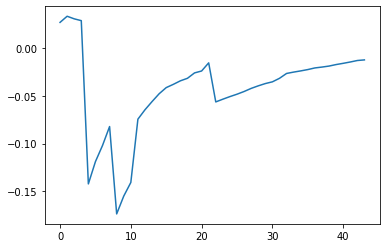

Thread: 6 iteration: 10
RAM mDiffFit_130 FROM: 1024 --> 2944 reward: 0.013489689062500011
Saving ...


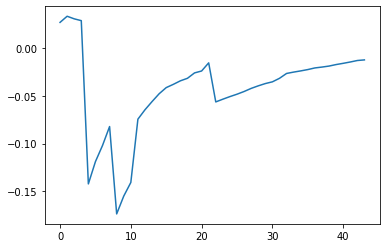

Thread: 3 iteration: 10
RAM mDiffFit_253 FROM: 2944 --> 2944 reward: -0.02521358359375
Thread: 2 iteration: 6
RAM mDiffFit_84 FROM: 2432 --> 2944 reward: 0.008562521875
Thread: 4 iteration: 7
RAM mConcatFit_2 FROM: 2240 --> 2048 reward: -0.004237521875000039
Thread: 1 iteration: 5
RAM mDiffFit_39 FROM: 2816 --> 2944 reward: -0.022442742968749995
Thread: 5 iteration: 7
RAM mDiffFit_135 FROM: 704 --> 2944 reward: -0.0034374343749999856
Thread: 3 iteration: 11
RAM mDiffFit_357 FROM: 1984 --> 2944 reward: 0.0008802210937500221
Thread: 4 iteration: 8
RAM mDiffFit_276 FROM: 1408 --> 2944 reward: -0.05904168125000001
Thread: 1 iteration: 6
RAM mDiffFit_233 FROM: 1664 --> 2944 reward: 0.04568760937500003
Thread: 5 iteration: 8
RAM mDiffFit_258 FROM: 1728 --> 2944 reward: 0.052565198046875
Thread: 3 iteration: 12
RAM mDiffFit_254 FROM: 1088 --> 2944 reward: -0.10195836249999998
Thread: 4 iteration: 9
RAM mDiffFit_284 FROM: 1152 --> 2944 reward: -0.002624956249999994
Thread: 1 iteration: 7
RAM m

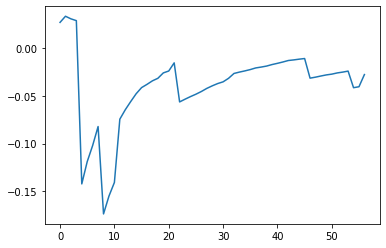

Thread: 4 iteration: 10
RAM mDiffFit_348 FROM: 2368 --> 2944 reward: -0.017533871484375005
Saving ...


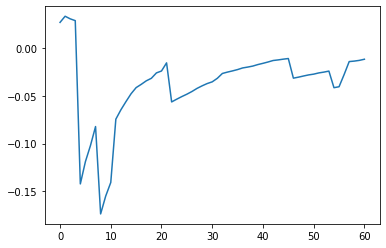

Thread: 5 iteration: 10
RAM mDiffFit_84 FROM: 2368 --> 2944 reward: -0.0725313265625
Thread: 2 iteration: 8
RAM mBackground_69 FROM: 1408 --> 2944 reward: 0.019368035812499997
Thread: 4 iteration: 11
RAM mDiffFit_11 FROM: 2560 --> 2944 reward: 0.039041725000000006
Thread: 5 iteration: 11
RAM mBackground_87 FROM: 2368 --> 2944 reward: 0.03933835885156251
Thread: 2 iteration: 9
RAM mBackground_56 FROM: 1536 --> 2944 reward: 0.06413286196875
Thread: 4 iteration: 12
RAM mProject_50 FROM: 512 --> 384 reward: -1.0
Thread: 3 iteration: 13
RAM mDiffFit_23 FROM: 1920 --> 2944 reward: 0.029916725000000022
Thread: 5 iteration: 12
RAM mProject_47 FROM: 1792 --> 384 reward: -1.0
Thread: 1 iteration: 8
RAM mProject_67 FROM: 1408 --> 384 reward: -1.0
Thread: 6 iteration: 11
RAM mDiffFit_406 FROM: 1216 --> 2944 reward: 0.004346393359375006
Saving ...


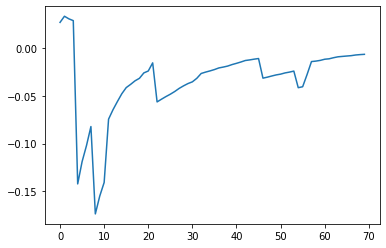

Thread: 2 iteration: 10
RAM mDiffFit_340 FROM: 256 --> 2944 reward: -0.1361666375
Thread: 3 iteration: 14
RAM mDiffFit_274 FROM: 1728 --> 2944 reward: 0.010046902343750011
Thread: 4 iteration: 13
RAM mDiffFit_379 FROM: 1984 --> 2944 reward: -0.03858336249999998
Thread: 5 iteration: 13
RAM mDiffFit_187 FROM: 1088 --> 2944 reward: 0.017901105468750005
Thread: 1 iteration: 9
RAM mDiffFit_369 FROM: 1536 --> 2944 reward: 0.0008906632812499989
Thread: 2 iteration: 11
RAM mDiffFit_89 FROM: 128 --> 2944 reward: -0.6990311953125
Thread: 6 iteration: 12
RAM mDiffFit_155 FROM: 320 --> 2944 reward: -0.347437478125
Thread: 3 iteration: 15
RAM mDiffFit_236 FROM: 1024 --> 2944 reward: 0.10169809531250001
Thread: 5 iteration: 14
RAM mBackground_52 FROM: 2176 --> 2944 reward: -0.021325298390624976
Thread: 4 iteration: 14
RAM mBackground_81 FROM: 2240 --> 2944 reward: -0.005715385312499999
Saving ...


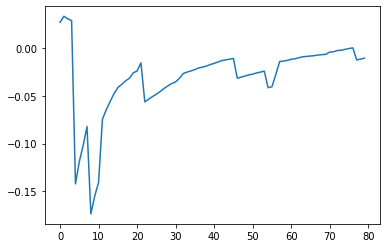

Thread: 1 iteration: 10
RAM mDiffFit_182 FROM: 320 --> 2944 reward: -0.13969265546874998
Thread: 2 iteration: 12
RAM mBackground_2 FROM: 2432 --> 2944 reward: -0.0005240295781249932
Thread: 5 iteration: 15
RAM mBackground_59 FROM: 2688 --> 2944 reward: 0.04359579657812503
Thread: 3 iteration: 16
RAM mDiffFit_321 FROM: 1152 --> 2944 reward: -0.08743752187500001
Thread: 4 iteration: 15
RAM mDiffFit_178 FROM: 3008 --> 2944 reward: -0.00261719023437499
Thread: 2 iteration: 13
RAM mDiffFit_313 FROM: 1728 --> 2944 reward: 0.027773516796875015
Thread: 5 iteration: 16
RAM mDiffFit_169 FROM: 3008 --> 2944 reward: 0.0006328097656250163
Thread: 3 iteration: 17
RAM mDiffFit_285 FROM: 320 --> 2944 reward: -0.16237495625
Thread: 2 iteration: 14
RAM mDiffFit_110 FROM: 192 --> 2944 reward: -0.24428900507812495
Thread: 4 iteration: 16
RAM mDiffFit_160 FROM: 1408 --> 2944 reward: -0.052166681250000006
Thread: 2 iteration: 15
RAM mProject_77 FROM: 2496 --> 2624 reward: 0.03264568340625002
Thread: 1 itera

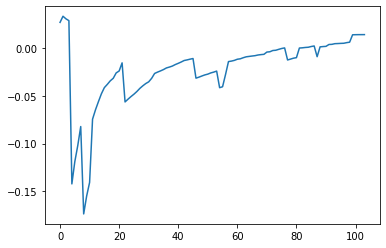

Thread: 4 iteration: 20
RAM mDiffFit_370 FROM: 1216 --> 2944 reward: 0.014880264843750001
Thread: 6 iteration: 15
RAM mDiffFit_120 FROM: 2752 --> 2944 reward: 0.009476570703125017
Saving ...


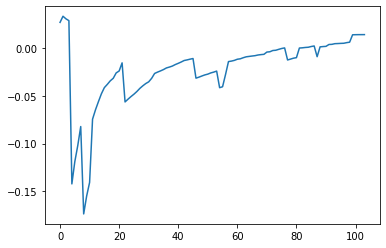

Thread: 3 iteration: 20
RAM mProject_79 FROM: 128 --> 384 reward: -1.0
Thread: 5 iteration: 17
RAM mDiffFit_285 FROM: 320 --> 2944 reward: -0.06154940351562499
Thread: 2 iteration: 19
RAM mDiffFit_271 FROM: 2560 --> 2944 reward: 0.008062521875000003
Thread: 3 iteration: 21
RAM mDiffFit_130 FROM: 704 --> 2944 reward: -0.00787486875
Thread: 6 iteration: 16
RAM mDiffFit_64 FROM: 512 --> 2944 reward: -0.18598438046875
Thread: 3 iteration: 22
RAM mDiffFit_108 FROM: 768 --> 2944 reward: -0.07717185859375
Thread: 5 iteration: 18
RAM mDiffFit_229 FROM: 2688 --> 640 reward: -0.0200938484375
Thread: 6 iteration: 17
RAM mDiffFit_120 FROM: 2624 --> 640 reward: 0.09432550898437501
Saving ...


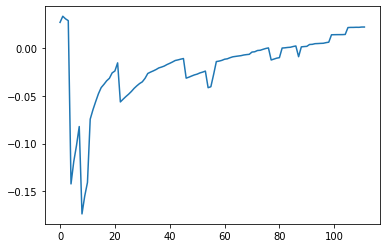

Thread: 2 iteration: 20
RAM mProject_59 FROM: 2304 --> 2624 reward: 0.0455274426796875
Thread: 4 iteration: 21
RAM mProject_41 FROM: 2368 --> 384 reward: -1.0
Thread: 1 iteration: 14
RAM mDiffFit_415 FROM: 2176 --> 640 reward: -0.001015707031250014
Thread: 6 iteration: 18
RAM mDiffFit_241 FROM: 1536 --> 1728 reward: 0.032765663281250024
Thread: 4 iteration: 22
RAM mDiffFit_178 FROM: 2688 --> 640 reward: 0.024828053906250005
Thread: 1 iteration: 15
RAM mDiffFit_216 FROM: 256 --> 2944 reward: -0.25580725703124996
Thread: 6 iteration: 19
RAM mDiffFit_384 FROM: 1408 --> 2944 reward: -0.011364557812499985
Saving ...


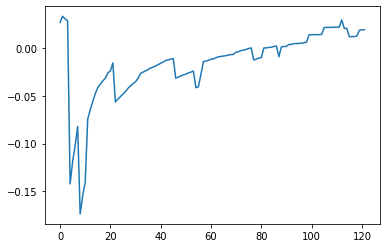

Thread: 6 iteration: 20
RAM mProject_59 FROM: 2752 --> 2624 reward: -0.028854895429687277
Thread: 3 iteration: 23
RAM mBackground_21 FROM: 1664 --> 2944 reward: 0.0006450752500000087
Thread: 1 iteration: 16
RAM mProject_82 FROM: 128 --> 1792 reward: 0.6307787635312501
Thread: 5 iteration: 19
RAM mProject_44 FROM: 320 --> 1792 reward: 0.6262318839375
Thread: 2 iteration: 21
RAM mBackground_90 FROM: 192 --> 2944 reward: -0.7077618889375
Thread: 3 iteration: 24
RAM mDiffFit_232 FROM: 192 --> 1664 reward: -0.32076557578125
Thread: 2 iteration: 22
RAM mDiffFit_238 FROM: 1920 --> 384 reward: 0.20867185859374998
Saving ...


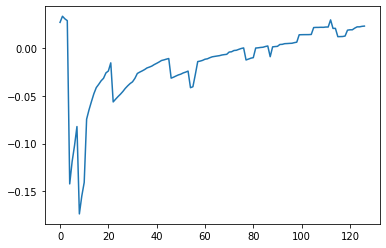

Thread: 5 iteration: 20
RAM mBackground_15 FROM: 1600 --> 2944 reward: 0.044218458750000016
Thread: 3 iteration: 25
RAM mBgModel_2 FROM: 2560 --> 2816 reward: 0.02340421187499997
Thread: 1 iteration: 17
RAM mDiffFit_27 FROM: 1728 --> 384 reward: 0.10264842929687498
Thread: 5 iteration: 21
RAM mProject_47 FROM: 2112 --> 384 reward: -1.0
Thread: 4 iteration: 23
RAM mProject_80 FROM: 192 --> 1792 reward: 0.6263443839374999
Thread: 2 iteration: 23
RAM mDiffFit_41 FROM: 384 --> 384 reward: 0.006374999999999992
Thread: 5 iteration: 22
RAM mImgtbl_2 FROM: 2880 --> 1344 reward: 0.21811881343749998
Thread: 1 iteration: 18
RAM mImgtbl_3 FROM: 2688 --> 1344 reward: 0.16661253062499998
Thread: 4 iteration: 24
RAM mDiffFit_318 FROM: 1472 --> 384 reward: 0.11035933671875
Thread: 2 iteration: 24
RAM mBackground_21 FROM: 1152 --> 2944 reward: 0.038735996375000005
Thread: 4 iteration: 25
RAM mDiffFit_172 FROM: 1984 --> 384 reward: 0.288367233984375
Thread: 5 iteration: 23
RAM mDiffFit_323 FROM: 1984 --

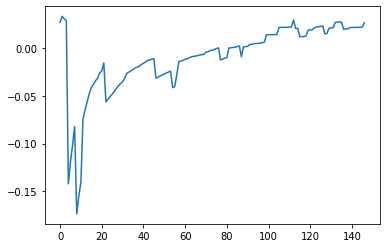

Thread: 1 iteration: 20
RAM mProject_64 FROM: 1536 --> 384 reward: -1.0
Thread: 3 iteration: 26
RAM mProject_48 FROM: 1472 --> 384 reward: -1.0
Thread: 6 iteration: 21
RAM mDiffFit_423 FROM: 1536 --> 1728 reward: -0.044789092578125
Thread: 5 iteration: 26
RAM mDiffFit_322 FROM: 192 --> 2176 reward: -0.395856748046875
Thread: 2 iteration: 28
RAM mBackground_66 FROM: 1024 --> 2944 reward: 0.015130784906250047
Thread: 3 iteration: 27
RAM mBackground_81 FROM: 1152 --> 2944 reward: 0.008833073437500004
Thread: 5 iteration: 27
RAM mDiffFit_187 FROM: 128 --> 2176 reward: -0.64210938046875
Thread: 3 iteration: 28
RAM mDiffFit_338 FROM: 2496 --> 448 reward: 0.23396353984375
Thread: 6 iteration: 22
RAM mDiffFit_274 FROM: 1920 --> 448 reward: 0.25730993320312495
Thread: 2 iteration: 29
RAM mDiffFit_79 FROM: 384 --> 2688 reward: -0.07298429296875
Saving ...


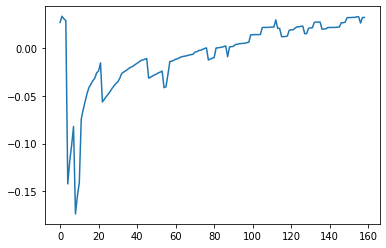

Thread: 2 iteration: 30
RAM mDiffFit_301 FROM: 2112 --> 448 reward: 0.08743221328125002
Thread: 5 iteration: 28
RAM mProject_24 FROM: 1728 --> 1024 reward: 0.21837937696875
Thread: 4 iteration: 28
RAM mBackground_82 FROM: 1856 --> 2944 reward: 0.06920773742187501
Thread: 5 iteration: 29
RAM mDiffFit_195 FROM: 1856 --> 1920 reward: 0.05979172499999999
Thread: 2 iteration: 31
RAM mBackground_12 FROM: 320 --> 2944 reward: -0.3858240658984375
Saving ...


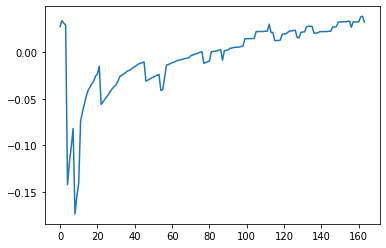

Thread: 5 iteration: 30
RAM mProject_33 FROM: 1664 --> 1024 reward: 0.18447466485937497
Thread: 1 iteration: 21
RAM mDiffFit_273 FROM: 192 --> 2688 reward: -0.11855458085937501
Thread: 5 iteration: 31
RAM mProject_84 FROM: 384 --> 1920 reward: 0.6534709966406249
Thread: 3 iteration: 29
RAM mBackground_57 FROM: 832 --> 2944 reward: -0.006140744671874988
Thread: 1 iteration: 22
RAM mDiffFit_406 FROM: 2880 --> 1920 reward: 0.032585951171875
Saving ...


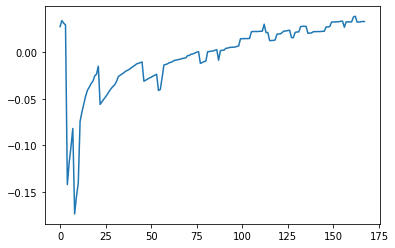

Thread: 3 iteration: 30
RAM mBackground_1 FROM: 576 --> 2944 reward: -0.09393017253906248
Thread: 5 iteration: 32
RAM mViewer_2 FROM: 128 --> 1664 reward: -1.2664162066875
Thread: 1 iteration: 23
RAM mBackground_30 FROM: 2496 --> 1984 reward: 0.012169875453124987
Thread: 5 iteration: 33
RAM mDiffFit_40 FROM: 2752 --> 384 reward: 0.04929672734375005
Thread: 3 iteration: 31
RAM mProject_86 FROM: 1024 --> 384 reward: -1.0
Thread: 6 iteration: 23
RAM mDiffFit_10 FROM: 1920 --> 384 reward: 0.289875
Thread: 5 iteration: 34
RAM mDiffFit_384 FROM: 128 --> 2688 reward: -0.48936451406250003
Thread: 6 iteration: 24
RAM mProject_9 FROM: 2816 --> 384 reward: -1.0
Thread: 4 iteration: 29
RAM mDiffFit_296 FROM: 2240 --> 640 reward: 0.020367146484375
Thread: 6 iteration: 25
RAM mBackground_48 FROM: 1024 --> 2944 reward: 0.019645784906250026
Thread: 5 iteration: 35
RAM mProject_24 FROM: 1792 --> 384 reward: -1.0
Thread: 2 iteration: 32
RAM mDiffFit_196 FROM: 896 --> 2688 reward: -0.006734336718750011
T

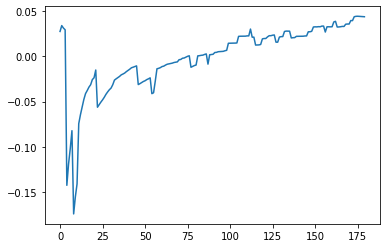

Thread: 4 iteration: 30
RAM mProject_19 FROM: 1792 --> 2944 reward: 0.19691008748437486
Thread: 1 iteration: 24
RAM mDiffFit_58 FROM: 2368 --> 2688 reward: 0.015114601562499982
Thread: 5 iteration: 36
RAM mDiffFit_320 FROM: 2816 --> 640 reward: -0.02736468906250001
Thread: 2 iteration: 33
RAM mDiffFit_335 FROM: 1344 --> 2944 reward: 0.012359424218750005
Thread: 1 iteration: 25
RAM mDiffFit_63 FROM: 832 --> 2944 reward: -0.007926992187500016
Thread: 4 iteration: 31
RAM mDiffFit_186 FROM: 384 --> 2944 reward: -0.22404159375
Thread: 5 iteration: 37
RAM mBackground_57 FROM: 2752 --> 1984 reward: -0.0016618162968749684
Thread: 6 iteration: 27
RAM mDiffFit_41 FROM: 960 --> 2944 reward: 0.0009609949218749962
Thread: 1 iteration: 26
RAM mBackground_76 FROM: 512 --> 2944 reward: -0.19788048390624996
Thread: 2 iteration: 34
RAM mDiffFit_168 FROM: 896 --> 2688 reward: -0.006859336718749998
Thread: 5 iteration: 38
RAM mBackground_52 FROM: 1856 --> 1984 reward: 0.013459913078124944
Thread: 4 iterat

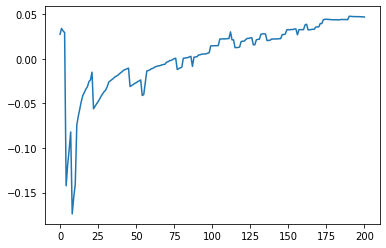

Thread: 5 iteration: 40
RAM mBackground_20 FROM: 1728 --> 1984 reward: 0.0010727737421874551
Thread: 2 iteration: 36
RAM mDiffFit_126 FROM: 1472 --> 2944 reward: 0.051890750781249974
Thread: 3 iteration: 34
RAM mDiffFit_264 FROM: 1472 --> 2944 reward: 0.020445375390625003
Saving ...


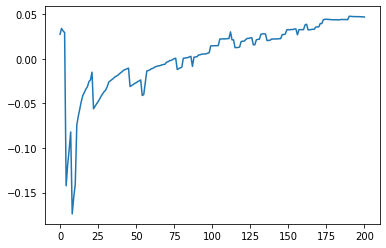

Thread: 6 iteration: 30
RAM mDiffFit_258 FROM: 2752 --> 448 reward: 0.13922130585937498
Thread: 4 iteration: 34
RAM mProject_69 FROM: 1344 --> 2624 reward: 0.03927637511718752
Thread: 1 iteration: 27
RAM mDiffFit_316 FROM: 1344 --> 2944 reward: -0.004085907421874993
Thread: 5 iteration: 41
RAM mDiffFit_367 FROM: 576 --> 2944 reward: -0.03454681484374998
Thread: 3 iteration: 35
RAM mDiffFit_374 FROM: 512 --> 2688 reward: -0.18283331874999997
Thread: 6 iteration: 31
RAM mDiffFit_343 FROM: 2112 --> 2944 reward: -0.012015619531249994
Thread: 4 iteration: 35
RAM mDiffFit_245 FROM: 1856 --> 2944 reward: 0.028739645312500003
Thread: 1 iteration: 28
RAM mDiffFit_216 FROM: 704 --> 2944 reward: 0.02227614921875001
Thread: 5 iteration: 42
RAM mDiffFit_178 FROM: 2176 --> 2944 reward: -0.01758853984375001
Thread: 3 iteration: 36
RAM mDiffFit_238 FROM: 1280 --> 2944 reward: -0.005432257031250005
Thread: 4 iteration: 36
RAM mDiffFit_198 FROM: 448 --> 2880 reward: 0.009388162109375021
Thread: 1 iterat

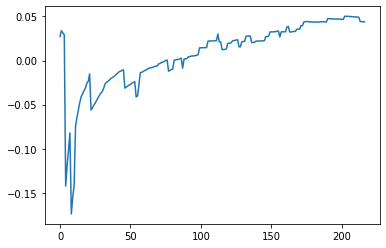

Thread: 1 iteration: 30
RAM mDiffFit_227 FROM: 2560 --> 448 reward: 0.09371871718750001
Thread: 4 iteration: 37
RAM mDiffFit_72 FROM: 1024 --> 2944 reward: -0.022859336718750005
Thread: 6 iteration: 33
RAM mBackground_54 FROM: 2624 --> 1984 reward: -0.01844302283593754
Thread: 2 iteration: 38
RAM mDiffFit_364 FROM: 128 --> 2944 reward: -0.9088437609375
Thread: 5 iteration: 44
RAM mDiffFit_224 FROM: 2240 --> 2944 reward: 0.013552123437500004
Thread: 1 iteration: 31
RAM mDiffFit_264 FROM: 2752 --> 448 reward: 0.002544138671874991
Thread: 4 iteration: 38
RAM mDiffFit_32 FROM: 2560 --> 2944 reward: 0.012578141406250007
Thread: 2 iteration: 39
RAM mProject_89 FROM: 448 --> 1920 reward: 0.64878255421875
Thread: 3 iteration: 37
RAM mDiffFit_60 FROM: 1920 --> 2944 reward: 0.024625043750000006
Thread: 5 iteration: 45
RAM mBackground_41 FROM: 1472 --> 2944 reward: 0.01173104567187505
Thread: 6 iteration: 34
RAM mBackground_33 FROM: 1536 --> 2944 reward: 0.04558909315625002
Thread: 1 iteration: 3

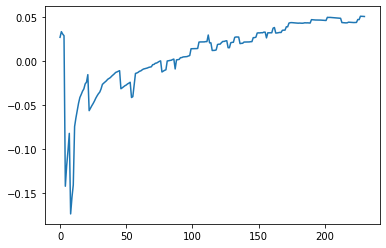

Thread: 2 iteration: 40
RAM mDiffFit_242 FROM: 1344 --> 2944 reward: -0.013710907421874991
Thread: 1 iteration: 33
RAM mDiffFit_389 FROM: 1856 --> 384 reward: 0.24682024414062498
Thread: 5 iteration: 46
RAM mDiffFit_378 FROM: 1600 --> 2944 reward: 0.014442742968749991
Thread: 5 iteration: 47
RAM mBackground_39 FROM: 1600 --> 2944 reward: 0.06326165542968747
Thread: 1 iteration: 34
RAM mProject_56 FROM: 2304 --> 2112 reward: -0.04060554208593746
Thread: 4 iteration: 39
RAM mDiffFit_247 FROM: 2752 --> 2944 reward: 0.015968760937500014
Thread: 5 iteration: 48
RAM mDiffFit_320 FROM: 320 --> 2880 reward: -0.06924469140624998
Thread: 1 iteration: 35
RAM mProject_47 FROM: 2944 --> 2112 reward: -0.13903669188281262
Thread: 3 iteration: 38
RAM mDiffFit_6 FROM: 1408 --> 2944 reward: 0.022599025781250004
Thread: 5 iteration: 49
RAM mDiffFit_353 FROM: 1472 --> 2752 reward: -0.03148696914062499
Thread: 1 iteration: 36
RAM mDiffFit_73 FROM: 2176 --> 2944 reward: 0.020781282812499993
Thread: 3 iterat

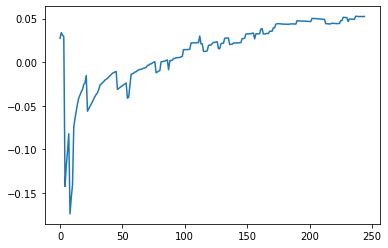

Thread: 5 iteration: 50
RAM mDiffFit_257 FROM: 1152 --> 2944 reward: -0.01657809765624999
Thread: 1 iteration: 37
RAM mProject_39 FROM: 2752 --> 2944 reward: 0.021936615328124975
Saving ...


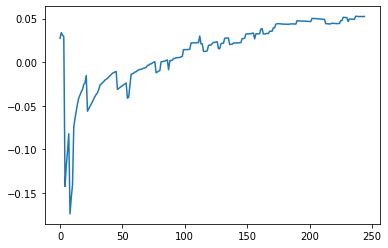

Thread: 4 iteration: 40
RAM mDiffFit_170 FROM: 2432 --> 2752 reward: -0.10306002070312499
Thread: 6 iteration: 37
RAM mDiffFit_302 FROM: 320 --> 2816 reward: -0.24217694843749998
Saving ...


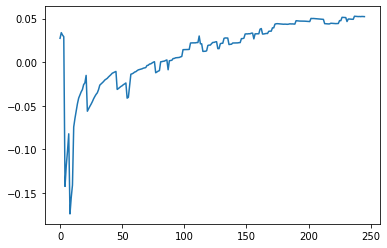

Thread: 3 iteration: 40
RAM mDiffFit_305 FROM: 1408 --> 2944 reward: -0.01636455781249999
Thread: 2 iteration: 42
RAM mDiffFit_127 FROM: 384 --> 2688 reward: -0.1309687171875
Thread: 5 iteration: 51
RAM mDiffFit_151 FROM: 1600 --> 2944 reward: 0.028031326562500004
Thread: 4 iteration: 41
RAM mBackground_59 FROM: 256 --> 2624 reward: -0.6095136805859375
Thread: 1 iteration: 38
RAM mDiffFit_77 FROM: 1920 --> 2944 reward: 0.0007031414062500137
Thread: 6 iteration: 38
RAM mBackground_73 FROM: 2752 --> 2944 reward: 0.006597836015625055
Thread: 2 iteration: 43
RAM mDiffFit_323 FROM: 1664 --> 2944 reward: 0.04370322890624997
Thread: 5 iteration: 52
RAM mDiffFit_169 FROM: 576 --> 2880 reward: 0.011195419140625027
Thread: 4 iteration: 42
RAM mBackground_73 FROM: 2048 --> 2944 reward: 0.03415820965625002
Thread: 2 iteration: 44
RAM mBackground_65 FROM: 576 --> 2624 reward: -0.06451996107031248
Thread: 6 iteration: 39
RAM mProject_17 FROM: 320 --> 1920 reward: 0.635774726953125
Thread: 3 iteratio

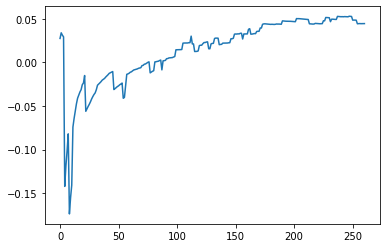

Thread: 6 iteration: 40
RAM mBackground_14 FROM: 1792 --> 2944 reward: 0.05559553581249997
Thread: 4 iteration: 43
RAM mViewer_1 FROM: 2560 --> 1408 reward: -0.04469105179687498
Thread: 2 iteration: 45
RAM mProject_8 FROM: 832 --> 1920 reward: 0.640643169375
Thread: 1 iteration: 39
RAM mDiffFit_371 FROM: 448 --> 2880 reward: -0.05274991249999998
Thread: 3 iteration: 42
RAM mDiffFit_67 FROM: 256 --> 2688 reward: -0.2636561953125
Thread: 6 iteration: 41
RAM mDiffFit_110 FROM: 704 --> 2880 reward: -0.024567655468750015
Thread: 5 iteration: 54
RAM mDiffFit_281 FROM: 1472 --> 2944 reward: 0.047033958984375006
Thread: 2 iteration: 46
RAM mDiffFit_50 FROM: 2176 --> 2752 reward: -0.05437504375000006
Thread: 3 iteration: 43
RAM mDiffFit_370 FROM: 2048 --> 2944 reward: 0.015140663281250008
Thread: 6 iteration: 42
RAM mDiffFit_160 FROM: 1216 --> 2688 reward: 0.01666150390625001
Thread: 2 iteration: 47
RAM mBackground_67 FROM: 2688 --> 1984 reward: -0.0637655358125
Thread: 5 iteration: 55
RAM mDif

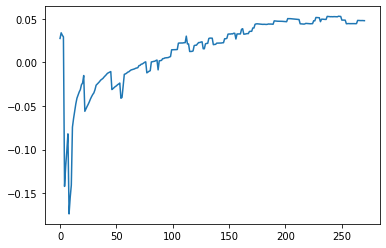

Thread: 1 iteration: 40
RAM mProject_17 FROM: 896 --> 2624 reward: -0.1564539285234373
Thread: 4 iteration: 44
RAM mDiffFit_374 FROM: 2176 --> 2944 reward: -0.014963539843750005
Thread: 6 iteration: 43
RAM mDiffFit_392 FROM: 2304 --> 2944 reward: -0.009859380468750008
Thread: 2 iteration: 48
RAM mDiffFit_289 FROM: 2560 --> 2944 reward: 0.002828141406250005
Thread: 5 iteration: 56
RAM mDiffFit_291 FROM: 768 --> 2688 reward: -0.024031151562500033
Thread: 1 iteration: 41
RAM mDiffFit_287 FROM: 2240 --> 2944 reward: -0.039500043750000005
Thread: 6 iteration: 44
RAM mImgtbl_2 FROM: 1984 --> 1408 reward: 0.033822885312500106
Thread: 3 iteration: 44
RAM mDiffFit_223 FROM: 896 --> 2880 reward: 0.05338552968750001
Thread: 2 iteration: 49
RAM mDiffFit_241 FROM: 2944 --> 2944 reward: -0.002875000000000013
Thread: 1 iteration: 42
RAM mDiffFit_76 FROM: 1344 --> 2880 reward: 0.01861723398437501
Thread: 6 iteration: 45
RAM mBackground_6 FROM: 2112 --> 2944 reward: 0.028019503117187497
Thread: 3 itera

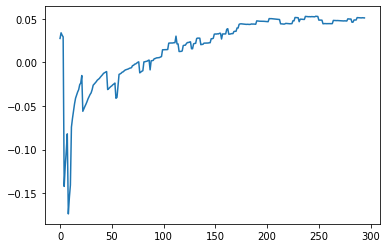

Thread: 6 iteration: 50
RAM mBackground_5 FROM: 704 --> 2944 reward: -0.16071687726562492
Thread: 3 iteration: 48
RAM mDiffFit_325 FROM: 1600 --> 2944 reward: -0.04446876093750002
Thread: 5 iteration: 58
RAM mProject_56 FROM: 2176 --> 1024 reward: 0.17239487400000006
Thread: 4 iteration: 45
RAM mDiffFit_400 FROM: 2304 --> 2944 reward: 0.011421902343749998
Thread: 6 iteration: 51
RAM mProject_75 FROM: 448 --> 768 reward: -1.0
Saving ...


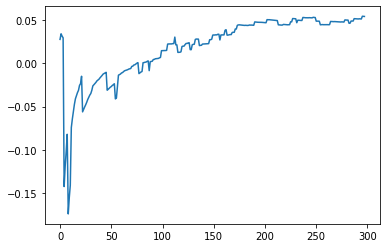

Thread: 2 iteration: 50
RAM mDiffFit_318 FROM: 2304 --> 2944 reward: -0.01923438046875
Thread: 5 iteration: 59
RAM mDiffFit_276 FROM: 1344 --> 2880 reward: -0.044406239062499964
Thread: 4 iteration: 46
RAM mDiffFit_67 FROM: 3008 --> 1536 reward: -0.009283915234375023
Thread: 3 iteration: 49
RAM mDiffFit_413 FROM: 2304 --> 2944 reward: -0.017609380468750005
Thread: 6 iteration: 52
RAM mDiffFit_389 FROM: 2432 --> 1536 reward: 0.03128123906249999
Thread: 2 iteration: 51
RAM mBackground_86 FROM: 576 --> 2304 reward: -0.060918729882812515
Saving ...


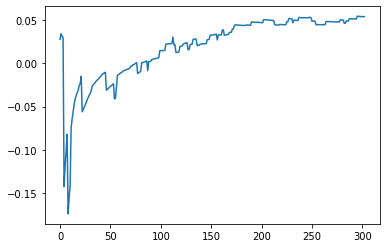

Thread: 5 iteration: 60
RAM mProject_57 FROM: 960 --> 2112 reward: -0.20293159914843745
Thread: 1 iteration: 45
RAM mDiffFit_67 FROM: 1792 --> 2944 reward: -0.005401017968749994
Thread: 4 iteration: 47
RAM mDiffFit_35 FROM: 1536 --> 2944 reward: -0.016546858593749995
Thread: 2 iteration: 52
RAM mDiffFit_20 FROM: 2944 --> 1536 reward: 0.02018225703125001
Thread: 6 iteration: 53
RAM mDiffFit_73 FROM: 704 --> 2880 reward: 0.011440198046875003
Thread: 5 iteration: 61
RAM mAdd_3 FROM: 512 --> 2560 reward: -0.4120831
Saving ...


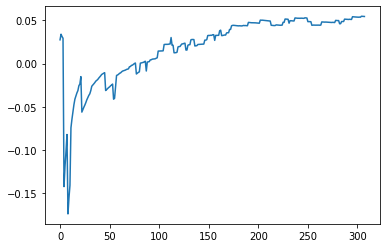

Thread: 3 iteration: 50
RAM mDiffFit_153 FROM: 1472 --> 2944 reward: -0.01801820820312501
Thread: 1 iteration: 46
RAM mDiffFit_414 FROM: 320 --> 2880 reward: -0.06504159374999999
Thread: 2 iteration: 53
RAM mDiffFit_291 FROM: 1664 --> 2944 reward: 0.02783862734375
Thread: 5 iteration: 62
RAM mDiffFit_344 FROM: 2304 --> 1536 reward: 0.0330937609375
Thread: 6 iteration: 54
RAM mDiffFit_273 FROM: 512 --> 2688 reward: -0.21297398203124998
Thread: 1 iteration: 47
RAM mDiffFit_81 FROM: 704 --> 2880 reward: -0.00292962460937499
Thread: 5 iteration: 63
RAM mDiffFit_173 FROM: 2304 --> 2944 reward: -0.010984380468750006
Thread: 6 iteration: 55
RAM mDiffFit_282 FROM: 1664 --> 2944 reward: -0.018979159374999995
Thread: 2 iteration: 54
RAM mDiffFit_98 FROM: 2880 --> 1536 reward: -0.0043984730468749934
Thread: 1 iteration: 48
RAM mDiffFit_325 FROM: 1536 --> 2944 reward: -0.01117185859374998
Thread: 5 iteration: 64
RAM mDiffFit_19 FROM: 640 --> 2688 reward: -0.17111982265624998
Thread: 2 iteration: 5

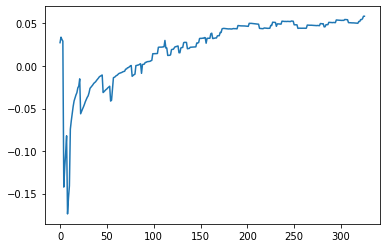

Thread: 1 iteration: 50
RAM mDiffFit_220 FROM: 2496 --> 1536 reward: -0.018843804687500004
Thread: 1 iteration: 51
RAM mProject_52 FROM: 256 --> 768 reward: -1.0
Thread: 4 iteration: 48
RAM mDiffFit_161 FROM: 576 --> 2880 reward: -0.005031151562499992
Thread: 1 iteration: 52
RAM mDiffFit_362 FROM: 128 --> 1216 reward: -0.53541141640625
Thread: 4 iteration: 49
RAM mBackground_15 FROM: 1856 --> 2944 reward: 0.07114051116406249
Thread: 1 iteration: 53
RAM mConcatFit_2 FROM: 512 --> 2560 reward: -0.15628322249999996
Saving ...


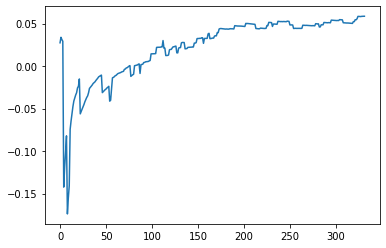

Thread: 4 iteration: 50
RAM mProject_11 FROM: 512 --> 2624 reward: 0.35833198106250014
Thread: 5 iteration: 65
RAM mProject_24 FROM: 960 --> 2624 reward: -0.1072506379218749
Thread: 2 iteration: 56
RAM mBackground_66 FROM: 1024 --> 2944 reward: -0.006190060968750015
Thread: 1 iteration: 54
RAM mDiffFit_412 FROM: 384 --> 2880 reward: -0.039335863671875
Thread: 4 iteration: 51
RAM mDiffFit_245 FROM: 2240 --> 2944 reward: 0.043627676171875004
Thread: 5 iteration: 66
RAM mProject_57 FROM: 2240 --> 1024 reward: 0.16295000744531254
Thread: 3 iteration: 51
RAM mDiffFit_289 FROM: 2176 --> 2944 reward: -0.009838539843749997
Thread: 1 iteration: 55
RAM mProject_22 FROM: 1984 --> 384 reward: -1.0
Thread: 6 iteration: 56
RAM mDiffFit_336 FROM: 1984 --> 2944 reward: -0.0036197789062499854
Thread: 5 iteration: 67
RAM mDiffFit_239 FROM: 1152 --> 2880 reward: -0.004109292968750011
Thread: 4 iteration: 52
RAM mDiffFit_321 FROM: 2624 --> 2944 reward: 0.004585951171875002
Thread: 1 iteration: 56
RAM mDif

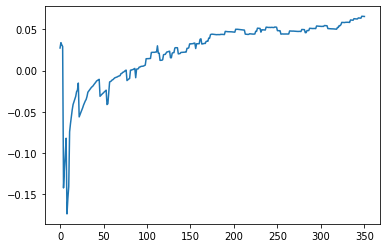

Thread: 5 iteration: 70
RAM mProject_40 FROM: 768 --> 2624 reward: 0.3198540750468752
Thread: 1 iteration: 57
RAM mDiffFit_351 FROM: 960 --> 2880 reward: -0.03845309765624999
Saving ...


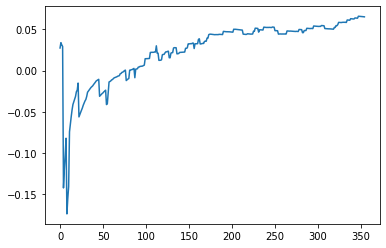

Thread: 6 iteration: 60
RAM mDiffFit_68 FROM: 832 --> 2880 reward: 0.023109467968750012
Thread: 1 iteration: 58
RAM mDiffFit_305 FROM: 1920 --> 2944 reward: -0.06114066328125001
Thread: 5 iteration: 71
RAM mDiffFit_224 FROM: 2624 --> 2944 reward: -0.029848982031250026
Saving ...


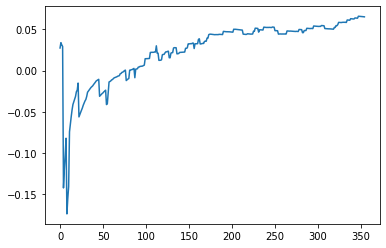

Thread: 2 iteration: 60
RAM mProject_12 FROM: 1856 --> 384 reward: -1.0
Thread: 3 iteration: 52
RAM mDiffFit_419 FROM: 2304 --> 2944 reward: 0.014546902343750001
Thread: 6 iteration: 61
RAM mDiffFit_63 FROM: 896 --> 2880 reward: -0.031637987109375
Thread: 1 iteration: 59
RAM mDiffFit_49 FROM: 2560 --> 2944 reward: 0.008312521874999992
Thread: 5 iteration: 72
RAM mDiffFit_299 FROM: 2112 --> 2944 reward: -0.0021406195312499883
Thread: 3 iteration: 53
RAM mProject_4 FROM: 2816 --> 1024 reward: 0.05081964300000003
Thread: 4 iteration: 54
RAM mBackground_81 FROM: 768 --> 2944 reward: -0.03371900362499998
Thread: 6 iteration: 62
RAM mDiffFit_188 FROM: 2304 --> 2944 reward: -0.00773438046875
Saving ...


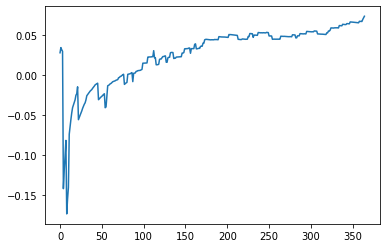

Thread: 1 iteration: 60
RAM mBackground_77 FROM: 1088 --> 2944 reward: 0.002087439031250028
Thread: 6 iteration: 63
RAM mProject_8 FROM: 1536 --> 2624 reward: 0.09715904268749995
Thread: 2 iteration: 61
RAM mDiffFit_408 FROM: 1344 --> 2944 reward: -0.04360157070312501
Thread: 2 iteration: 62
RAM mProject_31 FROM: 960 --> 2112 reward: -0.1951367509687501
Thread: 5 iteration: 73
RAM mProject_88 FROM: 2432 --> 2112 reward: -0.05614136156249992
Thread: 3 iteration: 54
RAM mBackground_38 FROM: 320 --> 2304 reward: -0.33671675271875007
Thread: 2 iteration: 63
RAM mProject_16 FROM: 1280 --> 2112 reward: -0.06554379550781245
Thread: 4 iteration: 55
RAM mDiffFit_272 FROM: 1728 --> 2944 reward: 0.006421902343750011
Thread: 5 iteration: 74
RAM mProject_22 FROM: 2624 --> 2112 reward: -0.079966105171875
Thread: 6 iteration: 64
RAM mDiffFit_173 FROM: 1856 --> 2944 reward: -0.003223938281249998
Thread: 2 iteration: 64
RAM mDiffFit_109 FROM: 2624 --> 2944 reward: -0.000539048828124989
Thread: 4 iterat

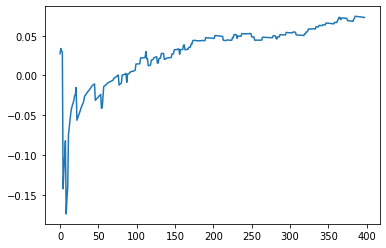

Thread: 4 iteration: 60
RAM mDiffFit_73 FROM: 2176 --> 2944 reward: 0.010656282812499997
Saving ...


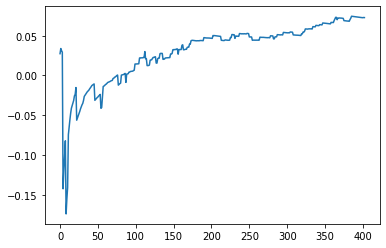

Thread: 6 iteration: 70
RAM mDiffFit_52 FROM: 2240 --> 2944 reward: 0.018164092578125002
Thread: 2 iteration: 68
RAM mDiffFit_259 FROM: 448 --> 2880 reward: -0.06931765546874999
Thread: 4 iteration: 61
RAM mBackground_8 FROM: 2304 --> 1984 reward: 0.005668370523437478
Thread: 1 iteration: 67
RAM mDiffFit_176 FROM: 128 --> 256 reward: -0.36706769921874993
Thread: 5 iteration: 79
RAM mDiffFit_233 FROM: 1152 --> 2880 reward: 0.006039136328125014
Thread: 6 iteration: 71
RAM mDiffFit_65 FROM: 896 --> 2880 reward: -0.08465101796875
Thread: 2 iteration: 69
RAM mDiffFit_384 FROM: 1600 --> 2880 reward: 0.016190154296875005
Saving ...


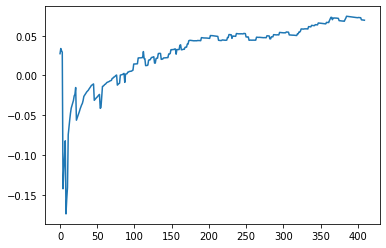

Thread: 5 iteration: 80
RAM mDiffFit_210 FROM: 2176 --> 2944 reward: -0.005338539843750007
Thread: 4 iteration: 62
RAM mDiffFit_111 FROM: 2048 --> 2944 reward: 0.018645884375
Thread: 6 iteration: 72
RAM mDiffFit_341 FROM: 2048 --> 2944 reward: 0.02564588437500001
Saving ...


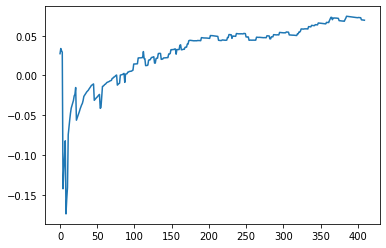

Thread: 2 iteration: 70
RAM mDiffFit_251 FROM: 1152 --> 2880 reward: 0.016585994921874993
Thread: 5 iteration: 81
RAM mDiffFit_7 FROM: 2944 --> 2944 reward: -0.026713583593750007
Thread: 4 iteration: 63
RAM mDiffFit_18 FROM: 1536 --> 2880 reward: 0.005273473046875001
Thread: 6 iteration: 73
RAM mDiffFit_402 FROM: 128 --> 2560 reward: -1.06095314140625
Thread: 1 iteration: 68
RAM mDiffFit_245 FROM: 960 --> 2880 reward: -0.0039061953125000062
Thread: 4 iteration: 64
RAM mBackground_21 FROM: 1920 --> 2944 reward: 0.04310312273437501
Thread: 6 iteration: 74
RAM mDiffFit_82 FROM: 704 --> 2816 reward: -0.09946090742187498
Thread: 2 iteration: 71
RAM mDiffFit_69 FROM: 1280 --> 2880 reward: -0.05152865039062497
Thread: 5 iteration: 82
RAM mProject_81 FROM: 192 --> 192 reward: -1.0
Thread: 3 iteration: 59
RAM mBackground_65 FROM: 1728 --> 2944 reward: -0.0325164673046875
Thread: 6 iteration: 75
RAM mDiffFit_352 FROM: 1152 --> 2880 reward: 0.09828141406250002
Thread: 2 iteration: 72
RAM mBackgro

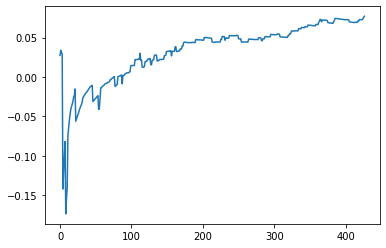

Thread: 3 iteration: 60
RAM mDiffFit_73 FROM: 2304 --> 2816 reward: 0.019437521875
Saving ...


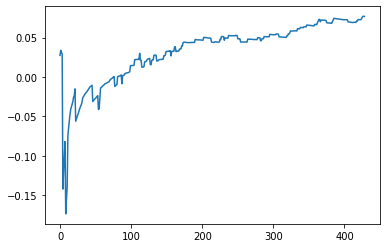

Thread: 1 iteration: 70
RAM mViewer_4 FROM: 256 --> 2688 reward: -1.3787912557031252
Thread: 5 iteration: 84
RAM mDiffFit_84 FROM: 2752 --> 2816 reward: -0.035398473046875
Thread: 3 iteration: 61
RAM mProject_64 FROM: 2816 --> 2880 reward: 0.004343921507812432
Thread: 4 iteration: 65
RAM mDiffFit_40 FROM: 1984 --> 2944 reward: 0.021632853515625015
Thread: 1 iteration: 71
RAM mBackground_82 FROM: 1088 --> 2944 reward: -0.004037834710937526
Thread: 4 iteration: 66
RAM mProject_77 FROM: 2112 --> 2880 reward: 0.13734589865625
Thread: 2 iteration: 73
RAM mBackground_13 FROM: 1664 --> 2944 reward: 0.043277824343750056
Thread: 5 iteration: 85
RAM mBackground_9 FROM: 2176 --> 2944 reward: 0.025750796578124967
Thread: 3 iteration: 62
RAM mDiffFit_293 FROM: 1024 --> 2880 reward: 0.01040632656250002
Thread: 1 iteration: 72
RAM mDiffFit_25 FROM: 896 --> 2880 reward: -0.013632766015624995
Thread: 4 iteration: 67
RAM mBackground_72 FROM: 1408 --> 2944 reward: 0.0040806227343750156
Thread: 2 iteratio

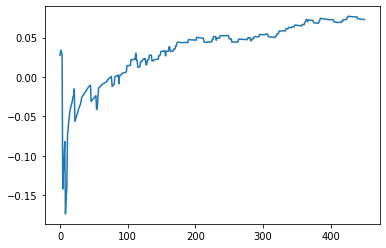

Thread: 4 iteration: 70
RAM mBackground_35 FROM: 1280 --> 2944 reward: 0.04635057343750002
Thread: 5 iteration: 89
RAM mDiffFit_98 FROM: 1728 --> 2944 reward: 0.00495577382812501
Thread: 3 iteration: 66
RAM mDiffFit_311 FROM: 256 --> 2688 reward: -0.29842703593750003
Thread: 4 iteration: 71
RAM mProject_21 FROM: 320 --> 1088 reward: 0.8266567268671876
Thread: 2 iteration: 75
RAM mBackground_35 FROM: 832 --> 2944 reward: -0.062318493765624976
Thread: 1 iteration: 76
RAM mBackground_29 FROM: 320 --> 2304 reward: -0.41977172807031254
Thread: 3 iteration: 67
RAM mDiffFit_288 FROM: 2816 --> 2816 reward: -0.026052123437499998
Thread: 4 iteration: 72
RAM mDiffFit_219 FROM: 2240 --> 2816 reward: -0.03722139335937501
Thread: 2 iteration: 76
RAM mDiffFit_63 FROM: 448 --> 2688 reward: -0.040528562890625
Thread: 1 iteration: 77
RAM mDiffFit_162 FROM: 1024 --> 2880 reward: 0.013656326562500008
Thread: 3 iteration: 68
RAM mDiffFit_108 FROM: 2880 --> 2816 reward: 0.031809933203125
Thread: 2 iteration

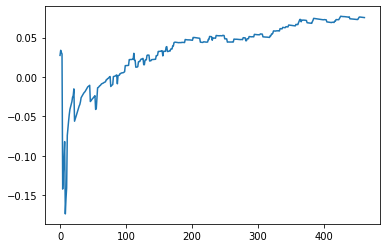

Thread: 5 iteration: 90
RAM mProject_80 FROM: 2176 --> 2880 reward: 0.1271979090703126
Thread: 6 iteration: 77
RAM mDiffFit_195 FROM: 1472 --> 2880 reward: 0.04285424687500003
Thread: 1 iteration: 78
RAM mDiffFit_292 FROM: 2432 --> 2944 reward: 0.03413026484375001
Thread: 6 iteration: 78
RAM mViewer_2 FROM: 2944 --> 1408 reward: -0.06497580065624996
Thread: 4 iteration: 74
RAM mBgModel_1 FROM: 1472 --> 2816 reward: 0.07045852875000003
Thread: 3 iteration: 69
RAM mDiffFit_164 FROM: 1472 --> 2944 reward: 0.006338583593750013
Thread: 2 iteration: 78
RAM mBackground_50 FROM: 2176 --> 2944 reward: 0.020053296578124966
Thread: 6 iteration: 79
RAM mBackground_31 FROM: 384 --> 2304 reward: -0.3615492903437499
Thread: 2 iteration: 79
RAM mDiffFit_56 FROM: 448 --> 2688 reward: -0.09345301015624999
Saving ...


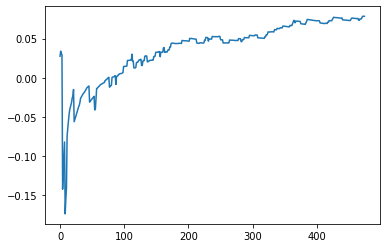

Thread: 2 iteration: 80
RAM mBackground_70 FROM: 2816 --> 1984 reward: -0.030738358851562505
Saving ...


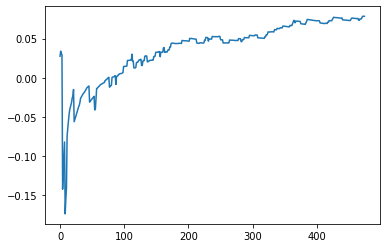

Thread: 6 iteration: 80
RAM mProject_79 FROM: 2816 --> 2112 reward: -0.1786081265156249
Thread: 1 iteration: 79
RAM mDiffFit_367 FROM: 2880 --> 832 reward: 0.030697876562499997
Thread: 2 iteration: 81
RAM mProject_85 FROM: 1728 --> 2880 reward: 0.13374033075000014
Thread: 4 iteration: 75
RAM mImgtbl_1 FROM: 1728 --> 2048 reward: 0.115679325625
Thread: 6 iteration: 81
RAM mProject_85 FROM: 896 --> 2624 reward: -0.15334798872656244
Saving ...


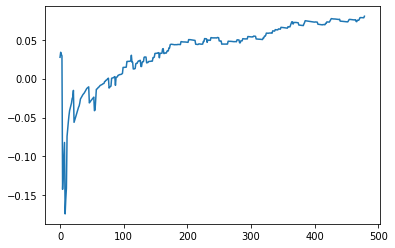

Thread: 3 iteration: 70
RAM mProject_24 FROM: 2240 --> 1088 reward: 0.7999524885937499
Thread: 5 iteration: 91
RAM mConcatFit_2 FROM: 2176 --> 256 reward: 0.5995999999999999
Saving ...


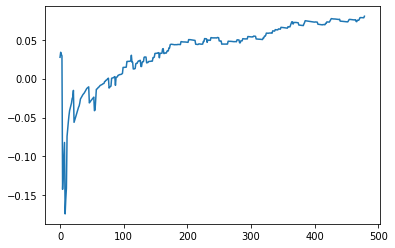

Thread: 1 iteration: 80
RAM mDiffFit_28 FROM: 2048 --> 2944 reward: 0.024390663281250002
Thread: 4 iteration: 76
RAM mDiffFit_403 FROM: 1984 --> 2944 reward: -0.0012838277343749961
Thread: 6 iteration: 82
RAM mBackground_79 FROM: 1408 --> 2944 reward: 0.05838163078125005
Thread: 5 iteration: 92
RAM mDiffFit_337 FROM: 2688 --> 384 reward: 0.22581239062500003
Thread: 3 iteration: 71
RAM mProject_59 FROM: 896 --> 2240 reward: -0.23321985299999992
Thread: 2 iteration: 82
RAM mDiffFit_59 FROM: 1344 --> 2944 reward: 0.01909384843750004
Thread: 4 iteration: 77
RAM mDiffFit_229 FROM: 1152 --> 2944 reward: -0.010999956249999991
Thread: 6 iteration: 83
RAM mBackground_87 FROM: 2368 --> 1984 reward: -0.04629450311718751
Thread: 5 iteration: 93
RAM mDiffFit_270 FROM: 512 --> 2816 reward: -0.09567694843749999
Thread: 6 iteration: 84
RAM mBackground_14 FROM: 2304 --> 1984 reward: -0.03682329657812497
Thread: 4 iteration: 78
RAM mProject_67 FROM: 1408 --> 2112 reward: -0.02757457560937495
Thread: 1 i

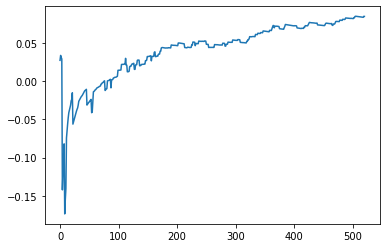

Thread: 4 iteration: 80
RAM mDiffFit_326 FROM: 960 --> 2880 reward: 0.02001570703125002
Thread: 6 iteration: 89
RAM mDiffFit_112 FROM: 2816 --> 2944 reward: -0.025567742968749998
Thread: 2 iteration: 88
RAM mDiffFit_238 FROM: 2880 --> 2944 reward: 0.0017421902343749997
Saving ...


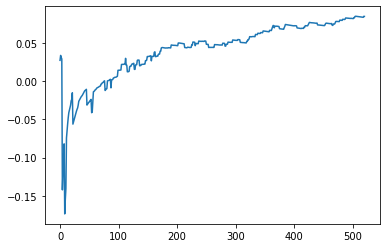

Thread: 5 iteration: 100
RAM mBackground_19 FROM: 768 --> 2944 reward: -0.07470340684375001
Thread: 1 iteration: 86
RAM mDiffFit_5 FROM: 896 --> 2880 reward: 0.013000087500000014
Thread: 4 iteration: 81
RAM mDiffFit_195 FROM: 640 --> 2688 reward: -0.02732805390624999
Thread: 2 iteration: 89
RAM mDiffFit_420 FROM: 1216 --> 2880 reward: 0.016388074609375008
Thread: 5 iteration: 101
RAM mProject_86 FROM: 1536 --> 2624 reward: 0.08946403481250005
Thread: 3 iteration: 79
RAM mDiffFit_283 FROM: 1216 --> 2880 reward: -0.006895796875000006
Thread: 1 iteration: 87
RAM mDiffFit_360 FROM: 1856 --> 2944 reward: 0.015867233984375007
Thread: 4 iteration: 82
RAM mDiffFit_148 FROM: 2624 --> 832 reward: 0.022656195312499988
Saving ...


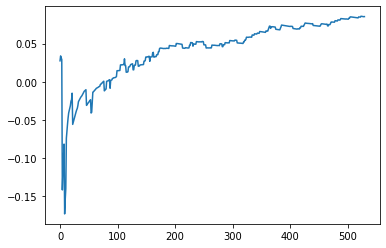

Thread: 2 iteration: 90
RAM mDiffFit_239 FROM: 192 --> 2112 reward: -0.5456874343749999
Thread: 5 iteration: 102
RAM mDiffFit_195 FROM: 1856 --> 2880 reward: 0.003158871484374992
Saving ...


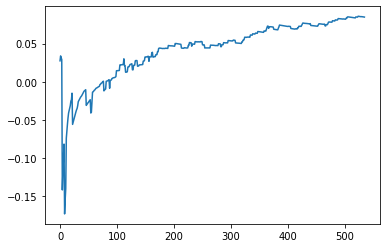

Thread: 3 iteration: 80
RAM mProject_80 FROM: 1792 --> 2624 reward: 0.14487404006250007
Saving ...


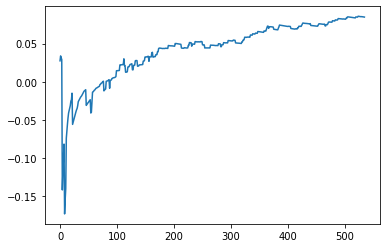

Thread: 6 iteration: 90
RAM mDiffFit_80 FROM: 1600 --> 2880 reward: 0.002200552734374986
Thread: 1 iteration: 88
RAM mDiffFit_172 FROM: 2368 --> 2944 reward: -0.0702813265625
Thread: 2 iteration: 91
RAM mDiffFit_351 FROM: 1600 --> 2880 reward: 0.006700552734374993
Thread: 4 iteration: 83
RAM mDiffFit_9 FROM: 576 --> 2880 reward: -0.014562434374999992
Thread: 5 iteration: 103
RAM mDiffFit_164 FROM: 1792 --> 2880 reward: 0.02936464531250002
Thread: 6 iteration: 91
RAM mDiffFit_2 FROM: 1472 --> 2880 reward: -0.013789005078124993
Thread: 1 iteration: 89
RAM mDiffFit_259 FROM: 320 --> 2688 reward: -0.11352075312500001
Thread: 4 iteration: 84
RAM mBackground_64 FROM: 1728 --> 2944 reward: 0.09711747665624999
Thread: 2 iteration: 92
RAM mDiffFit_49 FROM: 2496 --> 384 reward: 0.07664834179687502
Thread: 5 iteration: 104
RAM mDiffFit_381 FROM: 2432 --> 384 reward: 0.003031107812499975
Thread: 3 iteration: 81
RAM mDiffFit_44 FROM: 1920 --> 2880 reward: 0.042140707031250016
Thread: 6 iteration: 9

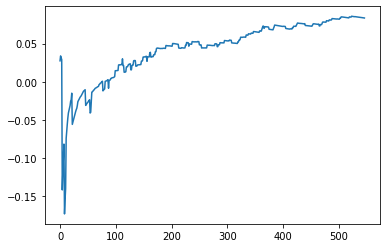

Thread: 1 iteration: 90
RAM mDiffFit_23 FROM: 1216 --> 2880 reward: 0.027112056640625007
Thread: 4 iteration: 85
RAM mDiffFit_77 FROM: 1280 --> 2880 reward: -0.01927079687499996
Thread: 2 iteration: 93
RAM mDiffFit_374 FROM: 704 --> 2688 reward: -0.026794226171875015
Thread: 5 iteration: 105
RAM mDiffFit_336 FROM: 960 --> 2880 reward: 0.007468804687500007
Thread: 3 iteration: 82
RAM mDiffFit_68 FROM: 1920 --> 2880 reward: 0.048515707031250015
Thread: 1 iteration: 91
RAM mBackground_45 FROM: 1664 --> 2944 reward: 0.013737699796874983
Thread: 6 iteration: 93
RAM mDiffFit_25 FROM: 2368 --> 2944 reward: -0.019807300781250013
Thread: 2 iteration: 94
RAM mDiffFit_27 FROM: 1536 --> 2880 reward: 0.005898473046875002
Thread: 3 iteration: 83
RAM mDiffFit_205 FROM: 2432 --> 832 reward: 0.04644269921875001
Thread: 5 iteration: 106
RAM mDiffFit_67 FROM: 2880 --> 640 reward: -0.009362056640625002
Thread: 2 iteration: 95
RAM mDiffFit_23 FROM: 1984 --> 2880 reward: -0.0011119691406249847
Thread: 3 ite

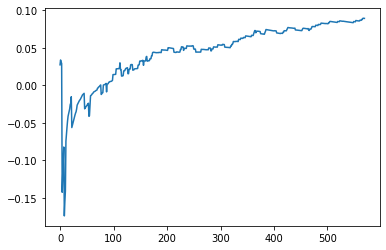

Thread: 5 iteration: 110
RAM mDiffFit_310 FROM: 832 --> 2944 reward: -0.0713437609375
Thread: 4 iteration: 89
RAM mBgModel_3 FROM: 2176 --> 1152 reward: 0.039483257500000035
Thread: 1 iteration: 93
RAM mBackground_73 FROM: 768 --> 2944 reward: -0.09007145432812501
Saving ...


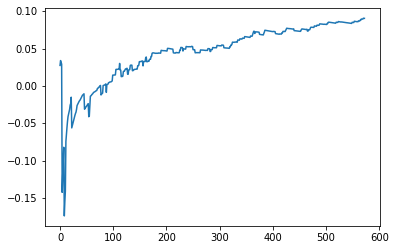

Thread: 4 iteration: 90
RAM mDiffFit_229 FROM: 1856 --> 2880 reward: 0.0034088714843749993
Thread: 1 iteration: 94
RAM mBackground_38 FROM: 1856 --> 2944 reward: 0.040749329273437454
Thread: 4 iteration: 91
RAM mProject_72 FROM: 1664 --> 2624 reward: 0.10838746673437508
Thread: 6 iteration: 94
RAM mProject_39 FROM: 960 --> 2240 reward: -0.19224125613281237
Thread: 3 iteration: 87
RAM mDiffFit_367 FROM: 704 --> 2880 reward: -0.007804624609374991
Thread: 4 iteration: 92
RAM mBackground_81 FROM: 2432 --> 1984 reward: -0.012653681890625068
Thread: 3 iteration: 88
RAM mProject_27 FROM: 2176 --> 2880 reward: 0.11968477291406254
Thread: 5 iteration: 111
RAM mDiffFit_169 FROM: 1984 --> 2880 reward: -0.012361969140624995
Thread: 6 iteration: 95
RAM mProject_84 FROM: 1856 --> 384 reward: -1.0
Thread: 2 iteration: 97
RAM mProject_1 FROM: 1408 --> 2624 reward: 0.05903841178124997
Thread: 1 iteration: 95
RAM mDiffFit_415 FROM: 1408 --> 2880 reward: -0.010606748046875
Thread: 6 iteration: 96
RAM mDi

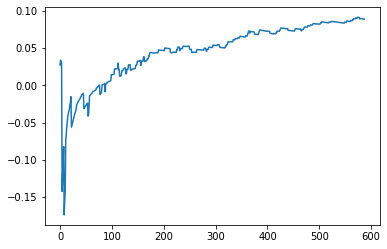

Thread: 3 iteration: 90
RAM mProject_88 FROM: 512 --> 1088 reward: 0.8179726587890626
Thread: 4 iteration: 93
RAM mDiffFit_74 FROM: 384 --> 2880 reward: -0.090664005078125
Thread: 6 iteration: 98
RAM mDiffFit_329 FROM: 192 --> 2944 reward: -0.34610933671875
Thread: 1 iteration: 97
RAM mDiffFit_272 FROM: 320 --> 2368 reward: -0.07192440351562499
Saving ...


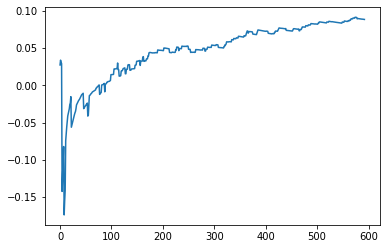

Thread: 2 iteration: 100
RAM mDiffFit_37 FROM: 1664 --> 2880 reward: 0.06423446796875001
Thread: 5 iteration: 114
RAM mDiffFit_6 FROM: 640 --> 2880 reward: -0.03530984570312498
Thread: 3 iteration: 91
RAM mDiffFit_36 FROM: 1856 --> 2944 reward: -0.029690110546875
Thread: 4 iteration: 94
RAM mDiffFit_193 FROM: 1920 --> 2944 reward: -0.0009218585937499808
Thread: 6 iteration: 99
RAM mDiffFit_127 FROM: 896 --> 2688 reward: 0.005281326562499994
Thread: 3 iteration: 92
RAM mDiffFit_139 FROM: 2880 --> 2816 reward: 0.023817742968749965
Thread: 5 iteration: 115
RAM mDiffFit_190 FROM: 704 --> 2688 reward: -0.024044226171875006
Thread: 2 iteration: 101
RAM mDiffFit_310 FROM: 1600 --> 2880 reward: 0.0009505527343749848
Saving ...


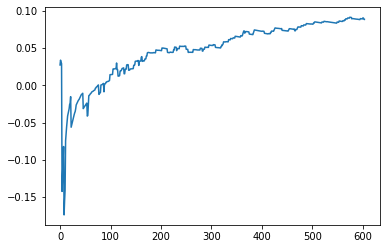

Thread: 6 iteration: 100
RAM mDiffFit_49 FROM: 960 --> 2880 reward: -0.002945244140624987
Thread: 5 iteration: 116
RAM mDiffFit_393 FROM: 1472 --> 2880 reward: 0.03885424687500001
Thread: 4 iteration: 95
RAM mProject_63 FROM: 2816 --> 2880 reward: 0.02429909957812496
Thread: 1 iteration: 98
RAM mDiffFit_209 FROM: 1024 --> 2880 reward: 0.017106835546875
Thread: 4 iteration: 96
RAM mBackground_9 FROM: 320 --> 2304 reward: -0.4450835067421876
Thread: 5 iteration: 117
RAM mBackground_47 FROM: 512 --> 2944 reward: -0.23953675271874997
Thread: 4 iteration: 97
RAM mDiffFit_310 FROM: 2432 --> 384 reward: 0.05108323124999998
Thread: 5 iteration: 118
RAM mProject_18 FROM: 3008 --> 2880 reward: -0.01217815453124994
Thread: 3 iteration: 93
RAM mDiffFit_405 FROM: 1088 --> 2880 reward: 0.004921946093750015
Thread: 4 iteration: 98
RAM mDiffFit_305 FROM: 896 --> 2880 reward: 0.022125087500000015
Thread: 5 iteration: 119
RAM mDiffFit_58 FROM: 512 --> 2880 reward: -0.11099736757812499
Thread: 3 iteratio

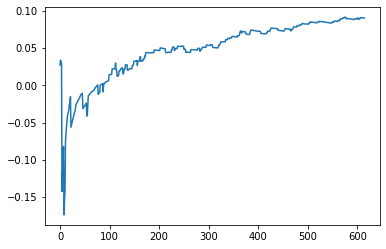

Thread: 5 iteration: 120
RAM mProject_6 FROM: 768 --> 896 reward: 0.9435287635312499
Thread: 2 iteration: 102
RAM mDiffFit_175 FROM: 960 --> 2688 reward: -0.01167177109375004
Saving ...


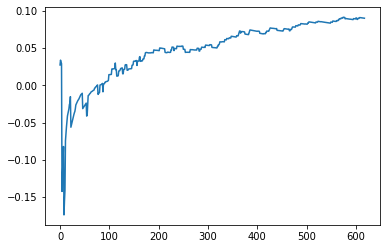

Thread: 4 iteration: 100
RAM mDiffFit_208 FROM: 832 --> 2880 reward: -0.10714584062499999
Thread: 5 iteration: 121
RAM mDiffFit_354 FROM: 3008 --> 832 reward: 0.008414005078124995
Saving ...


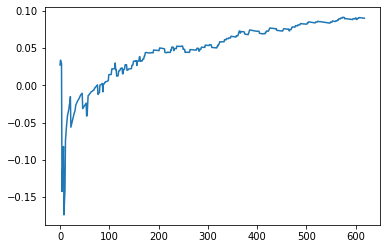

Thread: 1 iteration: 100
RAM mBackground_41 FROM: 1088 --> 2944 reward: -0.04563588219531245
Thread: 6 iteration: 102
RAM mDiffFit_282 FROM: 1792 --> 2944 reward: 0.0128021234375
Thread: 2 iteration: 103
RAM mDiffFit_412 FROM: 192 --> 2944 reward: -0.334617146484375
Thread: 5 iteration: 122
RAM mDiffFit_282 FROM: 832 --> 2880 reward: 0.03703395898437503
Thread: 4 iteration: 101
RAM mDiffFit_321 FROM: 2944 --> 832 reward: 0.035830686328124986
Thread: 1 iteration: 101
RAM mDiffFit_242 FROM: 1152 --> 2880 reward: 0.015710994921875002
Thread: 6 iteration: 103
RAM mDiffFit_379 FROM: 2752 --> 832 reward: 0.02830725703125002
Thread: 5 iteration: 123
RAM mDiffFit_43 FROM: 1344 --> 2880 reward: -0.06722657070312497
Thread: 4 iteration: 102
RAM mDiffFit_3 FROM: 1024 --> 2880 reward: 0.028073007812500026
Thread: 1 iteration: 102
RAM mDiffFit_224 FROM: 512 --> 2688 reward: -0.07793225703124998
Thread: 6 iteration: 104
RAM mDiffFit_173 FROM: 2368 --> 2816 reward: -0.021916681250000025
Thread: 5 ite

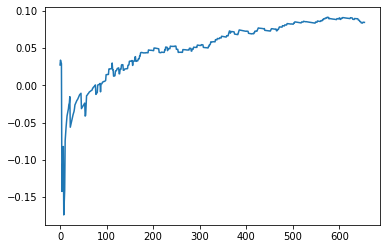

Thread: 5 iteration: 130
RAM mDiffFit_131 FROM: 1088 --> 2944 reward: -0.035749956250000006
Thread: 6 iteration: 109
RAM mBackground_38 FROM: 2560 --> 448 reward: 0.36616062142968747
Thread: 2 iteration: 109
RAM mDiffFit_261 FROM: 1984 --> 2944 reward: -0.027622411328124992
Thread: 5 iteration: 131
RAM mProject_43 FROM: 320 --> 768 reward: -1.0
Thread: 1 iteration: 105
RAM mDiffFit_352 FROM: 960 --> 2880 reward: -0.010695244140624983
Saving ...


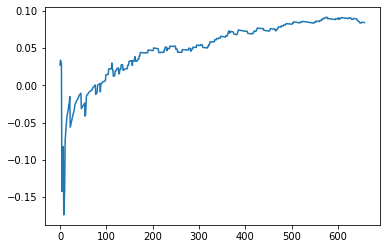

Thread: 6 iteration: 110
RAM mProject_63 FROM: 2496 --> 2112 reward: -0.06783482235937495
Thread: 3 iteration: 96
RAM mDiffFit_103 FROM: 576 --> 2688 reward: -0.025726483203125025
Saving ...


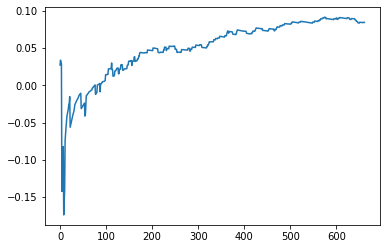

Thread: 2 iteration: 110
RAM mDiffFit_7 FROM: 2688 --> 384 reward: 0.14782809765625
Thread: 1 iteration: 106
RAM mConcatFit_3 FROM: 2688 --> 1280 reward: -0.006470936875
Thread: 6 iteration: 111
RAM mDiffFit_206 FROM: 2304 --> 2944 reward: 0.018604203124999996
Thread: 2 iteration: 111
RAM mImgtbl_2 FROM: 2880 --> 1408 reward: -0.020441838749999997
Thread: 3 iteration: 97
RAM mBackground_6 FROM: 128 --> 320 reward: -0.6863336935625
Thread: 5 iteration: 132
RAM mProject_38 FROM: 320 --> 768 reward: -1.0
Thread: 4 iteration: 107
RAM mBackground_30 FROM: 1856 --> 2944 reward: 0.050316829273437474
Thread: 1 iteration: 107
RAM mDiffFit_193 FROM: 1472 --> 2880 reward: 0.014997455078125024
Thread: 2 iteration: 112
RAM mDiffFit_80 FROM: 128 --> 2112 reward: -0.901645796875
Thread: 5 iteration: 133
RAM mBackground_25 FROM: 2496 --> 448 reward: 0.27960293460937496
Thread: 3 iteration: 98
RAM mDiffFit_13 FROM: 1664 --> 2880 reward: 0.005002632421874983
Thread: 4 iteration: 108
RAM mDiffFit_213 FRO

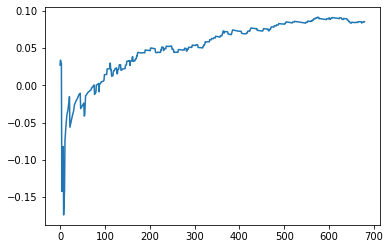

Thread: 1 iteration: 110
RAM mDiffFit_96 FROM: 2496 --> 2944 reward: 0.00957033164062501
Thread: 5 iteration: 135
RAM mDiffFit_324 FROM: 1728 --> 2880 reward: 0.01698442421875
Thread: 1 iteration: 111
RAM mProject_77 FROM: 2304 --> 1024 reward: 0.13901232150000004
Thread: 6 iteration: 112
RAM mProject_45 FROM: 2688 --> 2112 reward: -0.11257615504687493
Thread: 4 iteration: 109
RAM mDiffFit_197 FROM: 576 --> 2688 reward: -0.045867146484375
Thread: 1 iteration: 112
RAM mDiffFit_125 FROM: 192 --> 2688 reward: -0.22727338554687498
Saving ...


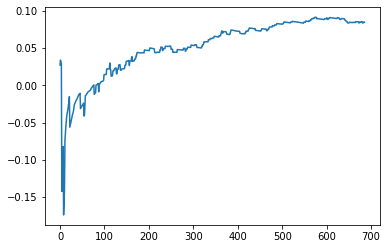

Thread: 4 iteration: 110
RAM mDiffFit_249 FROM: 2624 --> 2816 reward: -0.05215110546875002
Thread: 1 iteration: 113
RAM mDiffFit_299 FROM: 320 --> 2688 reward: -0.2831145578125
Thread: 1 iteration: 114
RAM mProject_1 FROM: 1024 --> 2624 reward: -0.0792376719609376
Thread: 6 iteration: 113
RAM mProject_53 FROM: 320 --> 768 reward: -1.0
Thread: 3 iteration: 99
RAM mDiffFit_333 FROM: 2048 --> 832 reward: 0.07052084062500001
Thread: 1 iteration: 115
RAM mDiffFit_107 FROM: 2624 --> 832 reward: -0.01206778671875004
Thread: 6 iteration: 114
RAM mDiffFit_414 FROM: 2048 --> 832 reward: 0.001338496093749985
Thread: 1 iteration: 116
RAM mProject_76 FROM: 1920 --> 384 reward: -1.0
Thread: 2 iteration: 115
RAM mProject_6 FROM: 2368 --> 2880 reward: 0.09000018112499987
Thread: 4 iteration: 111
RAM mDiffFit_267 FROM: 2176 --> 384 reward: 0.03856239062499999
Saving ...


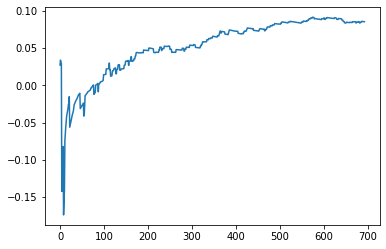

Thread: 3 iteration: 100
RAM mProject_43 FROM: 576 --> 768 reward: -1.0
Thread: 5 iteration: 136
RAM mBackground_55 FROM: 2368 --> 448 reward: 0.2910964919531249
Thread: 6 iteration: 115
RAM mDiffFit_367 FROM: 256 --> 2880 reward: 0.047606879296874995
Thread: 2 iteration: 116
RAM mDiffFit_94 FROM: 2432 --> 384 reward: 0.20818743437500004
Thread: 1 iteration: 117
RAM mDiffFit_251 FROM: 1792 --> 2880 reward: 0.023367233984375006
Thread: 3 iteration: 101
RAM mDiffFit_47 FROM: 512 --> 2688 reward: -0.15841146015625002
Thread: 5 iteration: 137
RAM mAdd_3 FROM: 2368 --> 2944 reward: 0.05670976621093754
Thread: 4 iteration: 112
RAM mDiffFit_92 FROM: 2368 --> 2880 reward: -0.012424491015625011
Thread: 6 iteration: 116
RAM mDiffFit_65 FROM: 1920 --> 2880 reward: -0.0006640488281249926
Thread: 2 iteration: 117
RAM mDiffFit_386 FROM: 2048 --> 2880 reward: -0.00868488945312499
Thread: 1 iteration: 118
RAM mBackground_52 FROM: 1472 --> 2944 reward: 0.051152227562500006
Thread: 3 iteration: 102
RAM 

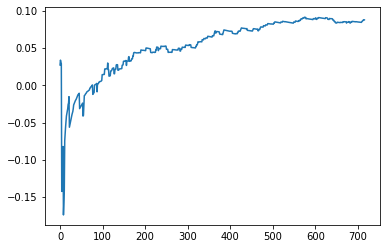

Thread: 5 iteration: 140
RAM mProject_51 FROM: 2944 --> 2752 reward: -0.03283741117968749
Thread: 6 iteration: 118
RAM mDiffFit_23 FROM: 704 --> 2688 reward: -0.160395840625
Thread: 5 iteration: 141
RAM mAdd_1 FROM: 1728 --> 704 reward: 0.3347812171875
Thread: 3 iteration: 104
RAM mProject_19 FROM: 1344 --> 2624 reward: 0.0587510924765625
Saving ...


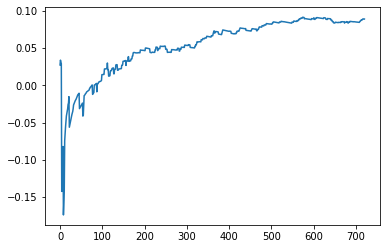

Thread: 1 iteration: 120
RAM mDiffFit_221 FROM: 640 --> 2944 reward: -0.03371867343750001
Thread: 5 iteration: 142
RAM mBackground_6 FROM: 320 --> 2304 reward: -0.5938120394374999
Thread: 6 iteration: 119
RAM mProject_22 FROM: 2240 --> 2752 reward: 0.09000018112499998
Thread: 2 iteration: 119
RAM mDiffFit_396 FROM: 2688 --> 384 reward: 0.20787491249999998
Thread: 3 iteration: 105
RAM mProject_89 FROM: 1088 --> 2624 reward: -0.04461016408593752
Thread: 4 iteration: 116
RAM mDiffFit_331 FROM: 768 --> 2880 reward: 0.01809384843750001
Thread: 5 iteration: 143
RAM mDiffFit_374 FROM: 576 --> 2688 reward: -0.2016562828125
Saving ...


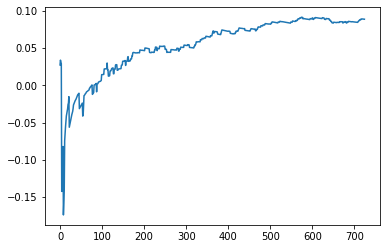

Thread: 2 iteration: 120
RAM mDiffFit_78 FROM: 384 --> 2880 reward: -0.05457024414062501
Thread: 3 iteration: 106
RAM mDiffFit_258 FROM: 320 --> 2688 reward: -0.25039061953125
Thread: 1 iteration: 121
RAM mDiffFit_392 FROM: 768 --> 2880 reward: -0.08491404882812499
Saving ...


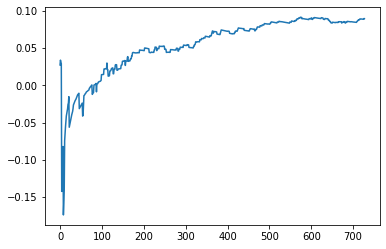

Thread: 6 iteration: 120
RAM mDiffFit_402 FROM: 896 --> 2880 reward: -0.013882766015624985
Thread: 5 iteration: 144
RAM mDiffFit_403 FROM: 2112 --> 2880 reward: 0.015031282812500019
Thread: 3 iteration: 107
RAM mDiffFit_298 FROM: 2624 --> 2816 reward: 0.015218760937499992
Thread: 1 iteration: 122
RAM mDiffFit_396 FROM: 2176 --> 2816 reward: -0.034328141406250005
Thread: 2 iteration: 121
RAM mDiffFit_46 FROM: 2240 --> 2944 reward: 0.014914092578125013
Thread: 5 iteration: 145
RAM mDiffFit_139 FROM: 1984 --> 2880 reward: 0.06653918007812502
Thread: 3 iteration: 108
RAM mDiffFit_236 FROM: 2560 --> 2944 reward: 0.0009531414062500035
Thread: 2 iteration: 122
RAM mDiffFit_397 FROM: 2048 --> 2944 reward: 0.08907305156250003
Thread: 1 iteration: 123
RAM mBackground_42 FROM: 448 --> 2304 reward: -0.21112988712500005
Thread: 5 iteration: 146
RAM mProject_4 FROM: 2560 --> 2752 reward: 0.048934775109375016
Thread: 6 iteration: 121
RAM mDiffFit_58 FROM: 1856 --> 2944 reward: 0.023117233984375
Threa

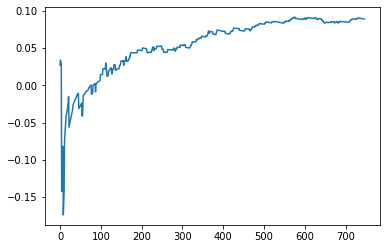

Thread: 3 iteration: 110
RAM mDiffFit_2 FROM: 832 --> 2688 reward: -0.014700421484374997
Thread: 2 iteration: 124
RAM mDiffFit_115 FROM: 2560 --> 832 reward: 0.0033098457031250153
Thread: 5 iteration: 148
RAM mDiffFit_87 FROM: 448 --> 2688 reward: -0.047289005078125
Thread: 4 iteration: 118
RAM mDiffFit_335 FROM: 2048 --> 2880 reward: 0.019947964062500007
Thread: 1 iteration: 126
RAM mBackground_20 FROM: 2560 --> 1984 reward: -0.015061244164062534
Thread: 6 iteration: 123
RAM mDiffFit_269 FROM: 768 --> 2880 reward: 0.007250087500000023
Thread: 5 iteration: 149
RAM mBackground_47 FROM: 2496 --> 1984 reward: -0.012324465492187514
Thread: 4 iteration: 119
RAM mDiffFit_279 FROM: 2880 --> 384 reward: 0.2076561515625
Thread: 2 iteration: 125
RAM mDiffFit_412 FROM: 768 --> 2880 reward: -0.001195244140624989
Thread: 6 iteration: 124
RAM mDiffFit_66 FROM: 3008 --> 384 reward: 0.077229071875
Thread: 1 iteration: 127
RAM mDiffFit_411 FROM: 2624 --> 384 reward: 0.260062434375
Saving ...


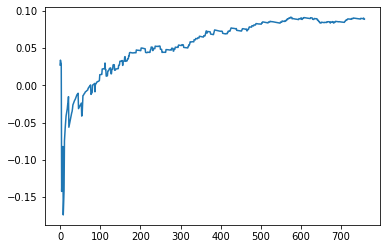

Thread: 5 iteration: 150
RAM mDiffFit_163 FROM: 2112 --> 2880 reward: 0.022406282812500004
Thread: 6 iteration: 125
RAM mProject_52 FROM: 1408 --> 2624 reward: 0.06072450602343758
Thread: 3 iteration: 111
RAM mDiffFit_381 FROM: 2240 --> 2880 reward: -0.012028650390625006
Thread: 1 iteration: 128
RAM mDiffFit_136 FROM: 2304 --> 2880 reward: 0.037312565625000016
Thread: 6 iteration: 126
RAM mDiffFit_185 FROM: 2432 --> 640 reward: 0.00901557578125
Thread: 5 iteration: 151
RAM mBackground_25 FROM: 1344 --> 2304 reward: 0.005146642453124962
Thread: 3 iteration: 112
RAM mProject_82 FROM: 2112 --> 2176 reward: 0.016585808976562377
Saving ...


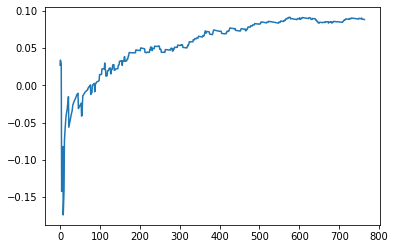

Thread: 4 iteration: 120
RAM mProject_4 FROM: 448 --> 2560 reward: 0.7667521621875
Thread: 2 iteration: 126
RAM mDiffFit_383 FROM: 1088 --> 2880 reward: -0.04120831875
Thread: 1 iteration: 129
RAM mDiffFit_410 FROM: 128 --> 2112 reward: -0.5890807300781251
Thread: 6 iteration: 127
RAM mDiffFit_235 FROM: 320 --> 2368 reward: -0.04861710273437499
Thread: 3 iteration: 113
RAM mDiffFit_127 FROM: 1152 --> 2880 reward: -0.008242146484375
Thread: 2 iteration: 127
RAM mDiffFit_138 FROM: 2624 --> 640 reward: 0.04065360664062498
Thread: 4 iteration: 121
RAM mDiffFit_13 FROM: 1024 --> 2880 reward: -0.05955988945312501
Saving ...


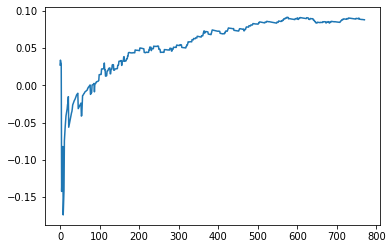

Thread: 1 iteration: 130
RAM mDiffFit_167 FROM: 1536 --> 2880 reward: -0.06741409257812499
Thread: 5 iteration: 152
RAM mBackground_56 FROM: 1984 --> 2304 reward: 0.04273579657812498
Thread: 6 iteration: 128
RAM mViewer_3 FROM: 3008 --> 1408 reward: -0.04191529882031252
Thread: 2 iteration: 128
RAM mBackground_57 FROM: 320 --> 2304 reward: -0.33058925271875
Thread: 4 iteration: 122
RAM mDiffFit_419 FROM: 2624 --> 2944 reward: 0.003210951171874997
Thread: 6 iteration: 129
RAM mBackground_78 FROM: 2560 --> 1984 reward: 0.003861019718749937
Thread: 5 iteration: 153
RAM mBgModel_1 FROM: 2432 --> 1152 reward: 0.011697789062499964
Thread: 1 iteration: 131
RAM mBackground_78 FROM: 192 --> 320 reward: -0.4153800000000001
Thread: 3 iteration: 114
RAM mDiffFit_125 FROM: 1024 --> 2944 reward: 0.00043234453125000696
Saving ...


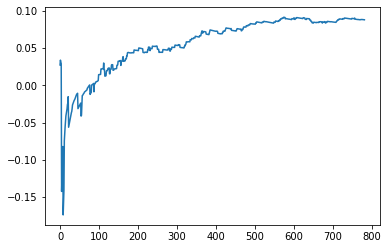

Thread: 6 iteration: 130
RAM mViewer_2 FROM: 512 --> 2880 reward: -0.14290013564062498
Thread: 4 iteration: 123
RAM mDiffFit_217 FROM: 1920 --> 2944 reward: 0.023750043750000005
Thread: 5 iteration: 154
RAM mDiffFit_357 FROM: 1280 --> 2944 reward: 0.019557344531250007
Thread: 1 iteration: 132
RAM mDiffFit_99 FROM: 1664 --> 2880 reward: -0.016721349609375002
Thread: 3 iteration: 115
RAM mDiffFit_354 FROM: 320 --> 2688 reward: -0.14145305390625001
Thread: 2 iteration: 129
RAM mDiffFit_96 FROM: 1408 --> 2880 reward: -0.020731748046874995
Thread: 1 iteration: 133
RAM mBackground_12 FROM: 2112 --> 1984 reward: -0.012599913078125038
Thread: 5 iteration: 155
RAM mDiffFit_267 FROM: 128 --> 1216 reward: -0.6064296683593751
Thread: 3 iteration: 116
RAM mDiffFit_80 FROM: 640 --> 2880 reward: -0.05274214648437499
Thread: 1 iteration: 134
RAM mBackground_85 FROM: 192 --> 320 reward: -0.3618002114687501
Saving ...


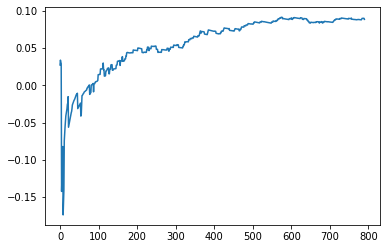

Thread: 2 iteration: 130
RAM mDiffFit_79 FROM: 1344 --> 2880 reward: 0.010242233984374995
Thread: 1 iteration: 135
RAM mBackground_10 FROM: 2496 --> 1984 reward: 0.010145298390624983
Thread: 2 iteration: 131
RAM mDiffFit_187 FROM: 256 --> 2688 reward: -0.20148433671875
Thread: 1 iteration: 136
RAM mProject_4 FROM: 960 --> 2624 reward: -0.12249299397656246
Thread: 6 iteration: 131
RAM mDiffFit_207 FROM: 640 --> 2880 reward: -0.043809845703124975
Thread: 2 iteration: 132
RAM mBackground_7 FROM: 768 --> 2304 reward: -0.047084887125
Thread: 1 iteration: 137
RAM mDiffFit_59 FROM: 2048 --> 2752 reward: 0.06193760937500001
Thread: 2 iteration: 133
RAM mDiffFit_59 FROM: 2112 --> 2880 reward: 0.03393756562499999
Thread: 2 iteration: 134
RAM mDiffFit_304 FROM: 128 --> 256 reward: -0.26970309765625006
Thread: 1 iteration: 138
RAM mDiffFit_252 FROM: 192 --> 2112 reward: -0.782976570703125
Thread: 6 iteration: 132
RAM mDiffFit_421 FROM: 2432 --> 2944 reward: -0.025380221093749995
Thread: 1 iteratio

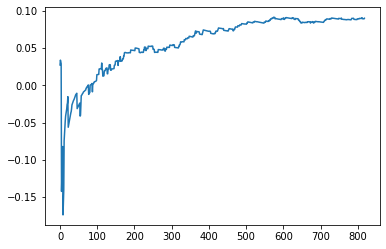

Thread: 3 iteration: 120
RAM mProject_6 FROM: 1024 --> 2240 reward: -0.1518560938125
Thread: 6 iteration: 135
RAM mDiffFit_62 FROM: 2688 --> 832 reward: -0.006299534765625003
Thread: 4 iteration: 128
RAM mProject_65 FROM: 1728 --> 384 reward: -1.0
Saving ...


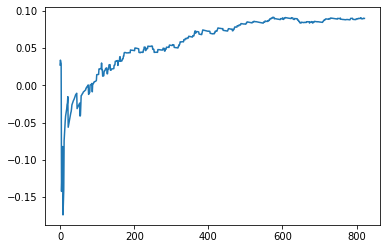

Thread: 1 iteration: 140
RAM mDiffFit_313 FROM: 2048 --> 2880 reward: 0.029046946093750012
Thread: 3 iteration: 121
RAM mDiffFit_324 FROM: 960 --> 2880 reward: -0.029328097656250007
Thread: 6 iteration: 136
RAM mDiffFit_223 FROM: 2432 --> 2880 reward: -0.011122411328125005
Thread: 3 iteration: 122
RAM mBackground_79 FROM: 576 --> 2304 reward: -0.12867738712500001
Thread: 1 iteration: 141
RAM mDiffFit_4 FROM: 640 --> 2880 reward: -0.0038202441406249774
Thread: 6 iteration: 137
RAM mProject_19 FROM: 2112 --> 2176 reward: 0.012265335140624967
Thread: 2 iteration: 139
RAM mBackground_45 FROM: 448 --> 2304 reward: -0.2069440658984375
Thread: 4 iteration: 129
RAM mProject_24 FROM: 640 --> 1088 reward: 0.8004024885937501
Thread: 5 iteration: 158
RAM mDiffFit_263 FROM: 640 --> 2688 reward: -0.08595831875000001
Thread: 3 iteration: 123
RAM mDiffFit_106 FROM: 576 --> 2880 reward: -0.04114057578125
Thread: 6 iteration: 138
RAM mDiffFit_98 FROM: 2368 --> 832 reward: 0.005036416406250001
Saving ...

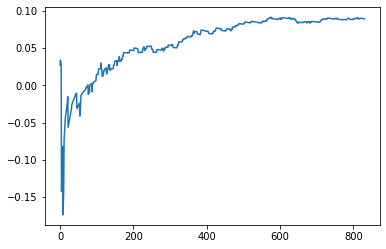

Thread: 2 iteration: 140
RAM mDiffFit_403 FROM: 2944 --> 832 reward: 0.031466084765625
Thread: 5 iteration: 159
RAM mDiffFit_252 FROM: 2880 --> 384 reward: 0.2343749125
Saving ...


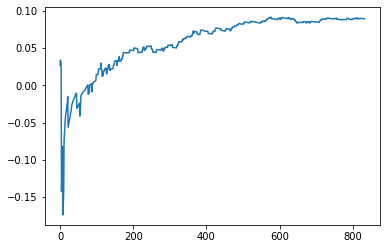

Thread: 4 iteration: 130
RAM mBackground_9 FROM: 704 --> 2304 reward: -0.11328473792968756
Thread: 1 iteration: 142
RAM mDiffFit_89 FROM: 448 --> 2688 reward: -0.06235411562499998
Thread: 3 iteration: 124
RAM mDiffFit_317 FROM: 2496 --> 832 reward: 0.03365101796875
Thread: 6 iteration: 139
RAM mDiffFit_59 FROM: 896 --> 2688 reward: -0.007953010156249996
Thread: 2 iteration: 141
RAM mBackground_84 FROM: 2112 --> 2304 reward: 0.013363619617187466
Saving ...


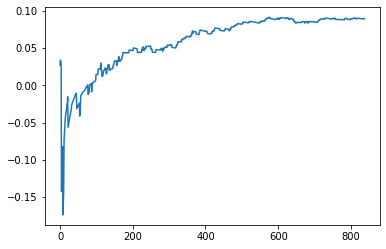

Thread: 5 iteration: 160
RAM mDiffFit_298 FROM: 2240 --> 2880 reward: -0.006528650390625005
Thread: 4 iteration: 131
RAM mDiffFit_241 FROM: 2560 --> 2880 reward: 0.011989601562500014
Thread: 3 iteration: 125
RAM mBackground_42 FROM: 1408 --> 2304 reward: -0.03715017384375001
Thread: 2 iteration: 142
RAM mDiffFit_44 FROM: 384 --> 2688 reward: -0.08814057578125
Thread: 5 iteration: 161
RAM mDiffFit_59 FROM: 320 --> 1152 reward: -0.19820046523437498
Thread: 4 iteration: 132
RAM mDiffFit_143 FROM: 1088 --> 2880 reward: 0.0024219460937500124
Thread: 4 iteration: 133
RAM mDiffFit_86 FROM: 2560 --> 384 reward: 0.10398433671874999
Thread: 2 iteration: 143
RAM mProject_36 FROM: 1856 --> 2112 reward: 0.049910251570312515
Thread: 1 iteration: 143
RAM mDiffFit_416 FROM: 192 --> 2880 reward: -0.22751553203124997
Thread: 4 iteration: 134
RAM mDiffFit_420 FROM: 2432 --> 2944 reward: -0.023630221093749997
Thread: 1 iteration: 144
RAM mDiffFit_92 FROM: 1856 --> 2880 reward: -0.05389847304687499
Thread:

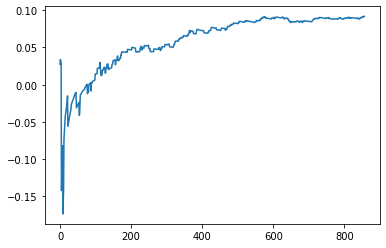

Thread: 6 iteration: 140
RAM mViewer_1 FROM: 1664 --> 1408 reward: 0.02211344592187498
Thread: 4 iteration: 138
RAM mDiffFit_234 FROM: 1280 --> 2880 reward: 0.03844800781250003
Thread: 6 iteration: 141
RAM mProject_87 FROM: 1152 --> 256 reward: -1.0
Thread: 3 iteration: 126
RAM mProject_55 FROM: 2112 --> 1280 reward: 0.06494097874218757
Thread: 2 iteration: 144
RAM mProject_41 FROM: 2432 --> 2752 reward: 0.06705574903125007
Thread: 1 iteration: 145
RAM mDiffFit_324 FROM: 2048 --> 2880 reward: 0.017773473046875002
Thread: 6 iteration: 142
RAM mBackground_5 FROM: 1600 --> 2304 reward: 0.04495077192968746
Thread: 4 iteration: 139
RAM mDiffFit_254 FROM: 832 --> 2880 reward: -0.01673951406249999
Thread: 3 iteration: 127
RAM mProject_23 FROM: 2496 --> 2112 reward: -0.07642139568749981
Thread: 5 iteration: 164
RAM mViewer_4 FROM: 2816 --> 2816 reward: 0.022144401468750075
Thread: 1 iteration: 146
RAM mAdd_3 FROM: 2624 --> 2048 reward: 0.19191681249999995
Thread: 2 iteration: 145
RAM mBackgrou

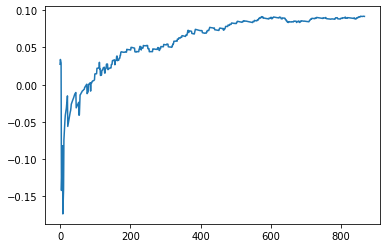

Thread: 4 iteration: 140
RAM mBackground_90 FROM: 1216 --> 2304 reward: -0.006266280484374957
Thread: 3 iteration: 128
RAM mDiffFit_240 FROM: 1408 --> 2880 reward: -0.006481748046875003
Thread: 6 iteration: 143
RAM mDiffFit_266 FROM: 1280 --> 2816 reward: 0.03264592812499998
Thread: 5 iteration: 165
RAM mDiffFit_343 FROM: 2240 --> 2880 reward: -0.018528650390625002
Thread: 1 iteration: 147
RAM mDiffFit_342 FROM: 1536 --> 2880 reward: 0.004523473046874997
Thread: 2 iteration: 146
RAM mDiffFit_200 FROM: 2368 --> 2880 reward: 0.041737056640625006
Thread: 3 iteration: 129
RAM mDiffFit_173 FROM: 1664 --> 2880 reward: 0.023851614453125017
Thread: 5 iteration: 166
RAM mDiffFit_392 FROM: 960 --> 2880 reward: 0.0068438046874999894
Thread: 2 iteration: 147
RAM mDiffFit_207 FROM: 1216 --> 2880 reward: 0.032921946093749994
Saving ...


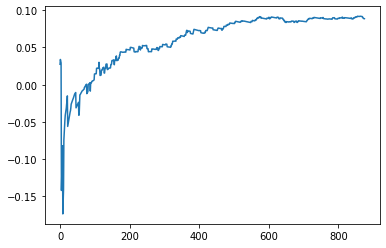

Thread: 3 iteration: 130
RAM mDiffFit_397 FROM: 2816 --> 640 reward: 0.03717703593749998
Thread: 5 iteration: 167
RAM mDiffFit_158 FROM: 1216 --> 2880 reward: 0.016263074609375004
Thread: 2 iteration: 148
RAM mDiffFit_395 FROM: 2560 --> 2624 reward: 0.007572920312500023
Thread: 5 iteration: 168
RAM mDiffFit_309 FROM: 2752 --> 640 reward: 0.018130133593750007
Thread: 3 iteration: 131
RAM mDiffFit_411 FROM: 2240 --> 2752 reward: 0.016625043749999985
Thread: 2 iteration: 149
RAM mDiffFit_127 FROM: 1728 --> 2752 reward: -0.0762188046875
Thread: 5 iteration: 169
RAM mDiffFit_94 FROM: 2048 --> 2752 reward: -0.020476570703125037
Saving ...


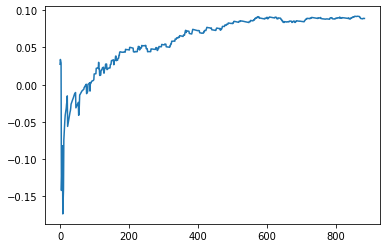

Thread: 2 iteration: 150
RAM mBackground_51 FROM: 448 --> 320 reward: 0.15383921639843753
Thread: 3 iteration: 132
RAM mDiffFit_335 FROM: 768 --> 2688 reward: -0.06304685859375003
Thread: 2 iteration: 151
RAM mProject_39 FROM: 1216 --> 896 reward: 0.9175112451562498
Thread: 6 iteration: 144
RAM mBackground_81 FROM: 1984 --> 1984 reward: 0.02515726388281247
Thread: 2 iteration: 152
RAM mProject_17 FROM: 1856 --> 2112 reward: 0.05813869661718761
Thread: 4 iteration: 141
RAM mBackground_10 FROM: 384 --> 320 reward: 0.06507108199218752
Thread: 3 iteration: 133
RAM mProject_33 FROM: 832 --> 896 reward: 0.9357643839375
Thread: 1 iteration: 148
RAM mViewer_4 FROM: 2240 --> 2880 reward: 0.0832031462109375
Thread: 6 iteration: 145
RAM mDiffFit_387 FROM: 2112 --> 2880 reward: -0.005507809765625
Thread: 2 iteration: 153
RAM mProject_64 FROM: 1152 --> 2624 reward: -0.029068776703124997
Saving ...


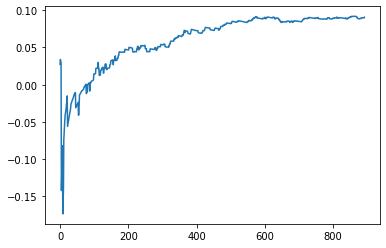

Thread: 5 iteration: 170
RAM mDiffFit_177 FROM: 2368 --> 2944 reward: -0.011807300781250009
Thread: 3 iteration: 134
RAM mBackground_31 FROM: 1280 --> 2944 reward: -0.00930759859374998
Thread: 4 iteration: 142
RAM mBackground_33 FROM: 1792 --> 1984 reward: -0.008360360664062523
Thread: 6 iteration: 146
RAM mBackground_44 FROM: 2048 --> 1984 reward: -0.008611206539062518
Thread: 2 iteration: 154
RAM mBackground_49 FROM: 704 --> 2304 reward: -0.12686113128906248
Thread: 4 iteration: 143
RAM mDiffFit_116 FROM: 896 --> 2688 reward: -0.047234336718750006
Thread: 5 iteration: 171
RAM mDiffFit_17 FROM: 2496 --> 2624 reward: -0.026127632421874963
Thread: 3 iteration: 135
RAM mProject_78 FROM: 3008 --> 2112 reward: -0.15485937257812488
Thread: 1 iteration: 149
RAM mDiffFit_405 FROM: 512 --> 2880 reward: -0.030143164453125
Thread: 6 iteration: 147
RAM mDiffFit_288 FROM: 2048 --> 2880 reward: 0.017273473046874998
Thread: 4 iteration: 144
RAM mDiffFit_85 FROM: 1856 --> 2880 reward: -0.022432300781

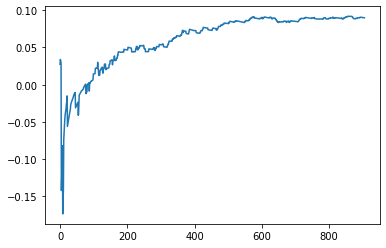

Thread: 1 iteration: 150
RAM mDiffFit_305 FROM: 1792 --> 2880 reward: 0.00023179179687499163
Thread: 6 iteration: 148
RAM mDiffFit_162 FROM: 1216 --> 2688 reward: -0.04219011054687499
Thread: 4 iteration: 145
RAM mDiffFit_419 FROM: 1344 --> 2688 reward: -0.060195331640625
Thread: 5 iteration: 173
RAM mDiffFit_52 FROM: 1344 --> 2688 reward: -0.08626566328124999
Thread: 2 iteration: 156
RAM mDiffFit_133 FROM: 1472 --> 2880 reward: 0.028203185156250005
Thread: 1 iteration: 151
RAM mDiffFit_46 FROM: 1536 --> 2944 reward: 0.015515663281249984
Thread: 6 iteration: 149
RAM mDiffFit_61 FROM: 384 --> 2688 reward: -0.08801557578125001
Thread: 5 iteration: 174
RAM mDiffFit_383 FROM: 1856 --> 2880 reward: -0.05339847304687499
Thread: 4 iteration: 146
RAM mDiffFit_388 FROM: 768 --> 2880 reward: -0.011539005078124998
Thread: 2 iteration: 157
RAM mDiffFit_122 FROM: 512 --> 2688 reward: -0.21334898203125002
Thread: 3 iteration: 137
RAM mBackground_74 FROM: 1664 --> 1984 reward: 0.04058579657812497
Thr

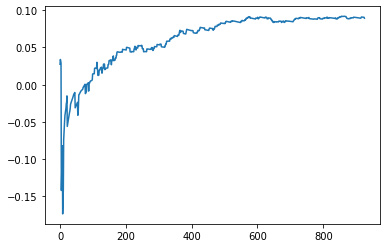

Thread: 6 iteration: 150
RAM mProject_13 FROM: 2304 --> 2176 reward: -0.012504408468750006
Thread: 5 iteration: 175
RAM mBackground_65 FROM: 2176 --> 1984 reward: 0.013936927867187506
Thread: 2 iteration: 159
RAM mBackground_41 FROM: 2560 --> 1984 reward: -0.054605622734375026
Thread: 1 iteration: 154
RAM mBackground_14 FROM: 1408 --> 2304 reward: 0.01537706539062498
Thread: 4 iteration: 149
RAM mDiffFit_34 FROM: 1216 --> 2688 reward: -0.017369735156250003
Thread: 5 iteration: 176
RAM mBackground_12 FROM: 2816 --> 1984 reward: -0.030630858851562488
Thread: 1 iteration: 155
RAM mDiffFit_354 FROM: 3008 --> 384 reward: 0.151351526953125
Saving ...


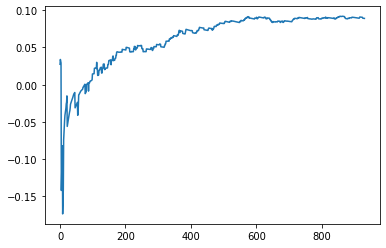

Thread: 2 iteration: 160
RAM mDiffFit_217 FROM: 2176 --> 832 reward: -0.029031326562500008
Thread: 6 iteration: 151
RAM mDiffFit_159 FROM: 1024 --> 2880 reward: 0.08062254257812501
Thread: 5 iteration: 177
RAM mDiffFit_276 FROM: 896 --> 2880 reward: -0.010757766015625
Thread: 2 iteration: 161
RAM mDiffFit_423 FROM: 2560 --> 2880 reward: 0.011739601562500025
Thread: 6 iteration: 152
RAM mBgModel_1 FROM: 128 --> 2048 reward: -0.08165386187499996
Thread: 1 iteration: 156
RAM mDiffFit_217 FROM: 768 --> 2688 reward: -0.14504690234374998
Thread: 2 iteration: 162
RAM mDiffFit_24 FROM: 2816 --> 640 reward: 0.06541663750000001
Thread: 6 iteration: 153
RAM mBackground_37 FROM: 2368 --> 1984 reward: -0.02640473923437503
Thread: 1 iteration: 157
RAM mProject_62 FROM: 1152 --> 896 reward: 0.933243444140625
Saving ...


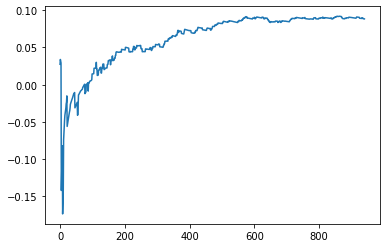

Thread: 3 iteration: 140
RAM mDiffFit_247 FROM: 2816 --> 384 reward: 0.08219783281250001
Thread: 2 iteration: 163
RAM mProject_49 FROM: 2624 --> 2112 reward: -0.09067142981249997
Saving ...


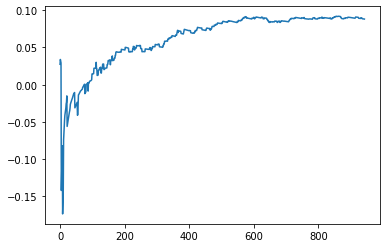

Thread: 4 iteration: 150
RAM mDiffFit_187 FROM: 2688 --> 832 reward: -0.0031745347656250006
Thread: 1 iteration: 158
RAM mDiffFit_178 FROM: 1216 --> 2880 reward: 0.021237056640625012
Thread: 3 iteration: 141
RAM mDiffFit_367 FROM: 1728 --> 2880 reward: 0.02185942421875
Thread: 2 iteration: 164
RAM mDiffFit_361 FROM: 2688 --> 2880 reward: -0.02717190234374998
Thread: 6 iteration: 154
RAM mProject_46 FROM: 768 --> 2560 reward: 0.7688221621875
Thread: 5 iteration: 178
RAM mDiffFit_222 FROM: 1088 --> 2880 reward: -0.019085907421875006
Thread: 4 iteration: 151
RAM mDiffFit_90 FROM: 896 --> 2688 reward: -0.08650522109375
Thread: 5 iteration: 179
RAM mDiffFit_366 FROM: 576 --> 2688 reward: -0.03726557578125001
Thread: 3 iteration: 142
RAM mDiffFit_154 FROM: 576 --> 2688 reward: 0.04549232148437499
Thread: 2 iteration: 165
RAM mBackground_12 FROM: 1536 --> 2304 reward: -0.009567462374999981
Thread: 6 iteration: 155
RAM mDiffFit_364 FROM: 1216 --> 2880 reward: -0.010770796874999995
Thread: 4 it

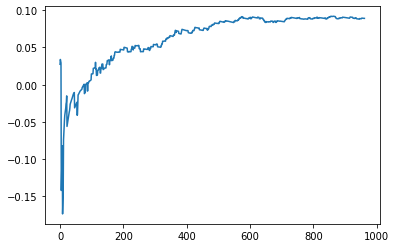

Thread: 1 iteration: 160
RAM mDiffFit_130 FROM: 960 --> 2688 reward: 0.008414180078124972
Thread: 6 iteration: 158
RAM mBackground_76 FROM: 640 --> 320 reward: 0.4175367540234376
Thread: 4 iteration: 153
RAM mProject_58 FROM: 1664 --> 2112 reward: 0.039481995093750055
Saving ...


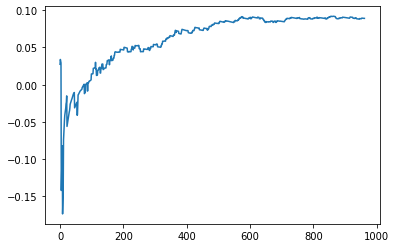

Thread: 5 iteration: 180
RAM mDiffFit_150 FROM: 128 --> 320 reward: -0.14638535468750005
Thread: 3 iteration: 145
RAM mDiffFit_170 FROM: 2752 --> 640 reward: 0.06953382773437503
Thread: 6 iteration: 159
RAM mDiffFit_6 FROM: 768 --> 2688 reward: -0.006890575781250009
Thread: 4 iteration: 154
RAM mDiffFit_263 FROM: 896 --> 2880 reward: 0.001744866406250007
Thread: 5 iteration: 181
RAM mDiffFit_132 FROM: 2368 --> 2880 reward: 0.010562521875000005
Thread: 3 iteration: 146
RAM mDiffFit_190 FROM: 2112 --> 2880 reward: -0.011257809765625008
Saving ...


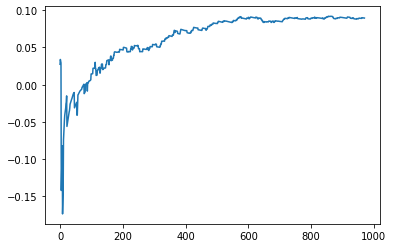

Thread: 6 iteration: 160
RAM mDiffFit_130 FROM: 1984 --> 2880 reward: 0.04015632656250004
Thread: 4 iteration: 155
RAM mDiffFit_173 FROM: 192 --> 2944 reward: -0.31174995625
Thread: 5 iteration: 182
RAM mBackground_22 FROM: 2368 --> 1984 reward: -0.004055908148437517
Thread: 3 iteration: 147
RAM mProject_14 FROM: 1024 --> 2624 reward: -0.08237267458593757
Thread: 1 iteration: 161
RAM mDiffFit_11 FROM: 768 --> 2688 reward: -0.032281195312500024
Thread: 4 iteration: 156
RAM mDiffFit_329 FROM: 1472 --> 2944 reward: -0.008643208203125002
Thread: 5 iteration: 183
RAM mBackground_84 FROM: 640 --> 2304 reward: -0.08951603139062504
Thread: 6 iteration: 161
RAM mDiffFit_97 FROM: 2048 --> 2944 reward: -0.0005676992187499987
Thread: 3 iteration: 148
RAM mDiffFit_48 FROM: 2432 --> 384 reward: 0.07391659374999998
Thread: 1 iteration: 162
RAM mDiffFit_408 FROM: 2048 --> 2880 reward: 0.019023473046874996
Thread: 4 iteration: 157
RAM mDiffFit_372 FROM: 704 --> 2688 reward: -0.07045831875
Thread: 5 ite

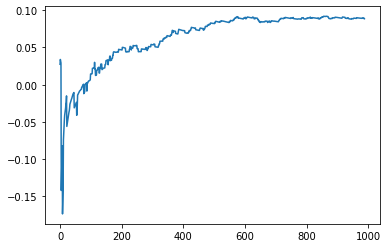

Thread: 3 iteration: 150
RAM mDiffFit_358 FROM: 192 --> 2944 reward: -0.31564575312500004
Thread: 1 iteration: 164
RAM mDiffFit_133 FROM: 896 --> 2880 reward: 0.042507897265625
Thread: 6 iteration: 164
RAM mDiffFit_328 FROM: 2752 --> 384 reward: 0.26195042148437503
Thread: 5 iteration: 186
RAM mDiffFit_27 FROM: 768 --> 2880 reward: -0.015414005078125004
Thread: 3 iteration: 151
RAM mDiffFit_139 FROM: 1984 --> 2688 reward: 0.035841216015625
Thread: 1 iteration: 165
RAM mDiffFit_155 FROM: 704 --> 2688 reward: -0.04380725703125001
Thread: 6 iteration: 165
RAM mDiffFit_221 FROM: 2176 --> 2880 reward: 0.017177123437500004
Thread: 5 iteration: 187
RAM mDiffFit_12 FROM: 1408 --> 2688 reward: -0.022958318750000012
Thread: 3 iteration: 152
RAM mDiffFit_37 FROM: 1408 --> 2880 reward: -0.034632809765625
Thread: 5 iteration: 188
RAM mBackground_51 FROM: 1728 --> 2304 reward: 0.26560593540625
Thread: 6 iteration: 166
RAM mBackground_59 FROM: 256 --> 2304 reward: -0.63461721328125
Thread: 1 iteratio

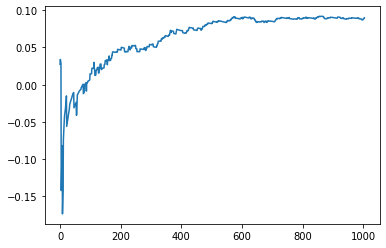

Thread: 5 iteration: 190
RAM mDiffFit_340 FROM: 1280 --> 2880 reward: -0.008299447265625003
Thread: 2 iteration: 168
RAM mDiffFit_78 FROM: 2048 --> 2880 reward: -0.006734380468750006
Thread: 5 iteration: 191
RAM mProject_71 FROM: 2752 --> 2752 reward: 0.0012375000000000135
Thread: 1 iteration: 167
RAM mViewer_4 FROM: 2240 --> 2752 reward: 0.043322924390624976
Thread: 6 iteration: 169
RAM mDiffFit_275 FROM: 896 --> 2880 reward: -0.000502544921875004
Thread: 5 iteration: 192
RAM mDiffFit_304 FROM: 2432 --> 2880 reward: -0.015372411328125005
Thread: 1 iteration: 168
RAM mBackground_16 FROM: 448 --> 2304 reward: -0.22964679034374996
Saving ...


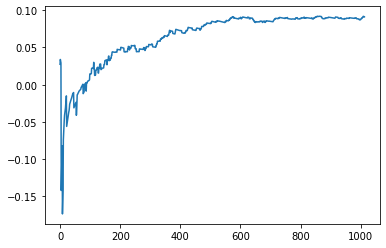

Thread: 6 iteration: 170
RAM mDiffFit_245 FROM: 2304 --> 2880 reward: 0.0016797121093750124
Thread: 2 iteration: 169
RAM mProject_2 FROM: 2176 --> 2176 reward: -0.003779068078125014
Saving ...


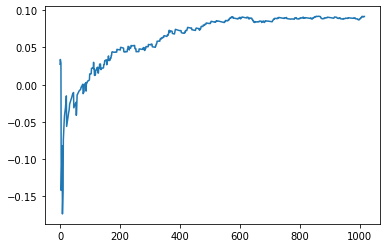

Thread: 4 iteration: 160
RAM mDiffFit_242 FROM: 1536 --> 2880 reward: -0.0013515269531249978
Thread: 5 iteration: 193
RAM mDiffFit_31 FROM: 960 --> 2880 reward: 0.004468804687499991
Saving ...


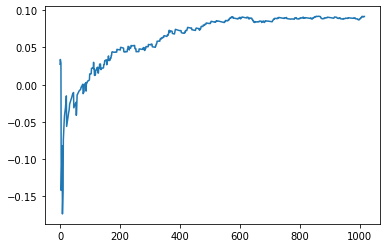

Thread: 2 iteration: 170
RAM mDiffFit_171 FROM: 2432 --> 2880 reward: 0.0006953316406249979
Thread: 6 iteration: 171
RAM mProject_51 FROM: 2112 --> 384 reward: -1.0
Thread: 3 iteration: 154
RAM mDiffFit_159 FROM: 1920 --> 2752 reward: -0.05831774296874998
Thread: 4 iteration: 161
RAM mDiffFit_292 FROM: 384 --> 2688 reward: -0.07090619531250003
Thread: 5 iteration: 194
RAM mDiffFit_72 FROM: 832 --> 2688 reward: -0.09528123906249998
Thread: 2 iteration: 171
RAM mDiffFit_373 FROM: 960 --> 2688 reward: 0.083414223828125
Thread: 6 iteration: 172
RAM mDiffFit_228 FROM: 512 --> 2688 reward: -0.12012495624999997
Thread: 3 iteration: 155
RAM mDiffFit_299 FROM: 960 --> 2880 reward: 0.007343804687500004
Thread: 4 iteration: 162
RAM mDiffFit_35 FROM: 448 --> 2880 reward: -0.09000776601562499
Thread: 5 iteration: 195
RAM mDiffFit_326 FROM: 448 --> 2496 reward: -0.068080686328125
Thread: 2 iteration: 172
RAM mDiffFit_39 FROM: 192 --> 2944 reward: -0.23868480195312497
Thread: 6 iteration: 173
RAM mDi

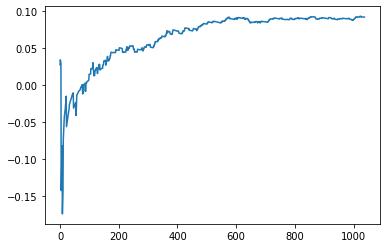

Thread: 1 iteration: 170
RAM mDiffFit_334 FROM: 384 --> 2944 reward: -0.30656252187500005
Thread: 5 iteration: 198
RAM mDiffFit_132 FROM: 2880 --> 2880 reward: 0.00012499999999998623
Thread: 2 iteration: 175
RAM mDiffFit_33 FROM: 2816 --> 2880 reward: -0.0035078097656249946
Thread: 6 iteration: 176
RAM mDiffFit_370 FROM: 2368 --> 2880 reward: -0.025924491015625016
Thread: 4 iteration: 166
RAM mDiffFit_254 FROM: 2432 --> 2624 reward: 0.005101570703125013
Thread: 1 iteration: 171
RAM mDiffFit_405 FROM: 1728 --> 2688 reward: 0.003828141406249999
Thread: 5 iteration: 199
RAM mProject_53 FROM: 704 --> 640 reward: -1.0
Thread: 3 iteration: 156
RAM mDiffFit_240 FROM: 1472 --> 2880 reward: 0.010721393359374998
Saving ...


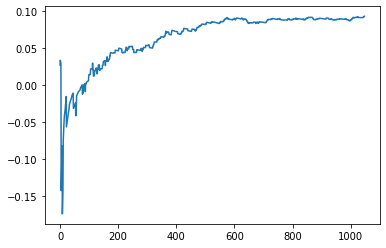

Thread: 5 iteration: 200
RAM mBackground_27 FROM: 1280 --> 1984 reward: -0.030155957445312503
Thread: 1 iteration: 172
RAM mDiffFit_357 FROM: 256 --> 2688 reward: -0.2594061953125001
Thread: 2 iteration: 176
RAM mDiffFit_259 FROM: 1792 --> 2880 reward: -0.075924534765625
Thread: 4 iteration: 167
RAM mDiffFit_199 FROM: 192 --> 1152 reward: -0.21292966835937496
Thread: 3 iteration: 157
RAM mDiffFit_40 FROM: 768 --> 2880 reward: -0.10710157070312501
Thread: 3 iteration: 158
RAM mProject_49 FROM: 1536 --> 2624 reward: 0.09548185682812496
Thread: 6 iteration: 177
RAM mDiffFit_357 FROM: 1856 --> 2880 reward: -0.08928132656250001
Thread: 4 iteration: 168
RAM mDiffFit_261 FROM: 2496 --> 2624 reward: 0.0056093804687500255
Thread: 3 iteration: 159
RAM mDiffFit_220 FROM: 1216 --> 2880 reward: 0.007263074609375007
Thread: 6 iteration: 178
RAM mDiffFit_294 FROM: 1664 --> 2880 reward: 0.023976614453125003
Thread: 4 iteration: 169
RAM mProject_73 FROM: 3008 --> 384 reward: -0.4701895182421875
Thread:

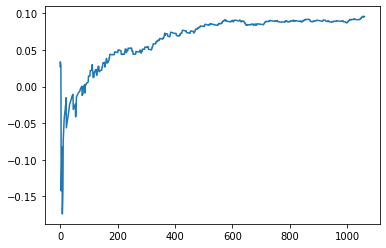

Thread: 3 iteration: 160
RAM mBackground_64 FROM: 192 --> 2304 reward: -1.017500857546875
Thread: 5 iteration: 201
RAM mDiffFit_342 FROM: 3008 --> 384 reward: 0.0575935859375
Thread: 6 iteration: 179
RAM mDiffFit_393 FROM: 1600 --> 2880 reward: -0.012192699218750002
Thread: 2 iteration: 178
RAM mDiffFit_254 FROM: 640 --> 2880 reward: -0.068549447265625
Thread: 1 iteration: 174
RAM mDiffFit_350 FROM: 2688 --> 2880 reward: 0.006976570703124997
Thread: 3 iteration: 161
RAM mDiffFit_41 FROM: 768 --> 2880 reward: -0.042976526953125
Thread: 5 iteration: 202
RAM mDiffFit_420 FROM: 320 --> 2688 reward: -0.16584371718750002
Thread: 2 iteration: 179
RAM mDiffFit_37 FROM: 1216 --> 2880 reward: 0.026671946093750003
Thread: 1 iteration: 175
RAM mDiffFit_14 FROM: 2048 --> 2944 reward: -0.007442699218750005
Thread: 5 iteration: 203
RAM mAdd_2 FROM: 1536 --> 2304 reward: 0.07415643593750007
Thread: 3 iteration: 162
RAM mDiffFit_385 FROM: 832 --> 2496 reward: 0.010296946093750012
Thread: 1 iteration: 1

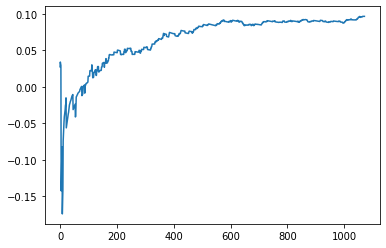

Thread: 2 iteration: 180
RAM mDiffFit_247 FROM: 2048 --> 2880 reward: 0.014773473046874996
Thread: 5 iteration: 204
RAM mDiffFit_215 FROM: 1280 --> 2496 reward: 0.0326354859375
Thread: 3 iteration: 163
RAM mDiffFit_388 FROM: 2112 --> 2880 reward: 0.018906282812500008
Thread: 2 iteration: 181
RAM mDiffFit_328 FROM: 1152 --> 2496 reward: 0.053484511718749975
Thread: 1 iteration: 177
RAM mProject_56 FROM: 1728 --> 384 reward: -1.0
Saving ...


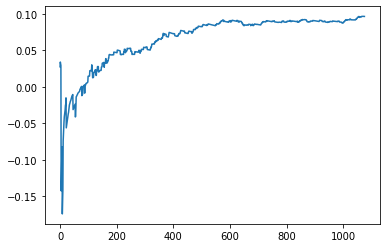

Thread: 4 iteration: 170
RAM mDiffFit_199 FROM: 1344 --> 2496 reward: -0.04014842929687498
Thread: 5 iteration: 205
RAM mDiffFit_303 FROM: 2752 --> 2624 reward: 0.0037656195312500175
Thread: 3 iteration: 164
RAM mDiffFit_330 FROM: 896 --> 2496 reward: 0.018924534765624973
Thread: 2 iteration: 182
RAM mDiffFit_39 FROM: 2496 --> 2624 reward: 0.01089584062500001
Thread: 4 iteration: 171
RAM mDiffFit_279 FROM: 2816 --> 2624 reward: 0.0007968585937500119
Thread: 1 iteration: 178
RAM mProject_2 FROM: 1536 --> 384 reward: -1.0
Saving ...


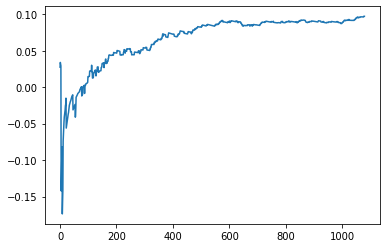

Thread: 6 iteration: 180
RAM mDiffFit_274 FROM: 448 --> 2688 reward: -0.25907555273437494
Thread: 3 iteration: 165
RAM mDiffFit_311 FROM: 832 --> 2880 reward: -0.047872367578125005
Thread: 5 iteration: 206
RAM mDiffFit_95 FROM: 1344 --> 2944 reward: -0.032156239062499994
Thread: 2 iteration: 183
RAM mBgModel_2 FROM: 896 --> 2048 reward: -0.12573538093749997
Thread: 6 iteration: 181
RAM mDiffFit_263 FROM: 2752 --> 832 reward: 0.0010832750000000155
Thread: 5 iteration: 207
RAM mDiffFit_230 FROM: 1088 --> 2944 reward: -0.00884630585937499
Thread: 2 iteration: 184
RAM mBackground_25 FROM: 1600 --> 1984 reward: 0.024577239234374992
Thread: 3 iteration: 166
RAM mProject_86 FROM: 1664 --> 2624 reward: 0.10644167875781253
Thread: 4 iteration: 172
RAM mDiffFit_124 FROM: 2240 --> 2944 reward: -0.0006484292968750131
Thread: 2 iteration: 185
RAM mDiffFit_201 FROM: 1152 --> 2944 reward: 0.03096362734375
Thread: 3 iteration: 167
RAM mProject_14 FROM: 1920 --> 1728 reward: 0.023699520914062567
Thread

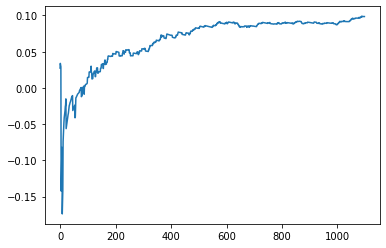

Thread: 1 iteration: 180
RAM mBackground_12 FROM: 2048 --> 1984 reward: -0.12474716528906249
Thread: 3 iteration: 168
RAM mDiffFit_418 FROM: 2496 --> 2880 reward: 0.0065781414062500085
Thread: 5 iteration: 209
RAM mProject_38 FROM: 1856 --> 1728 reward: 0.026122034039062537
Thread: 6 iteration: 182
RAM mDiffFit_291 FROM: 1344 --> 2496 reward: -0.03060933671875002
Thread: 4 iteration: 174
RAM mDiffFit_121 FROM: 2816 --> 2624 reward: -0.032403694140624995
Thread: 1 iteration: 181
RAM mDiffFit_183 FROM: 2880 --> 2624 reward: -0.006187521874999984
Thread: 2 iteration: 187
RAM mDiffFit_163 FROM: 448 --> 2880 reward: -0.22921612851562498
Saving ...


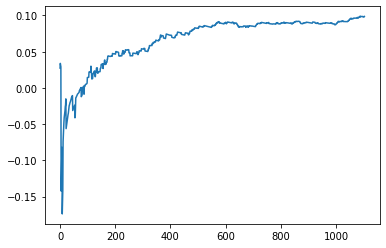

Thread: 5 iteration: 210
RAM mDiffFit_241 FROM: 128 --> 320 reward: -0.3458333187499999
Thread: 3 iteration: 169
RAM mDiffFit_198 FROM: 1408 --> 2880 reward: -0.011856748046875
Thread: 4 iteration: 175
RAM mDiffFit_136 FROM: 1728 --> 2944 reward: 0.054440198046874985
Thread: 2 iteration: 188
RAM mBackground_19 FROM: 1024 --> 1984 reward: -0.09171093279687498
Thread: 1 iteration: 182
RAM mDiffFit_221 FROM: 640 --> 2688 reward: -0.03691141640625001
Thread: 5 iteration: 211
RAM mDiffFit_85 FROM: 2624 --> 2816 reward: -0.12552097187500005
Saving ...


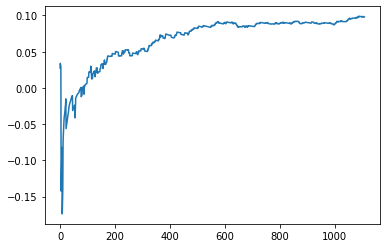

Thread: 3 iteration: 170
RAM mProject_33 FROM: 1536 --> 2112 reward: -0.004315680351562279
Thread: 6 iteration: 183
RAM mDiffFit_153 FROM: 2944 --> 2752 reward: 0.004648429296874989
Thread: 4 iteration: 176
RAM mBackground_70 FROM: 2432 --> 1984 reward: -0.029533445773437524
Thread: 2 iteration: 189
RAM mDiffFit_15 FROM: 2944 --> 2816 reward: -0.028322964062500004
Thread: 3 iteration: 171
RAM mDiffFit_296 FROM: 1856 --> 2944 reward: 0.005523473046874991
Thread: 1 iteration: 183
RAM mDiffFit_177 FROM: 1856 --> 2944 reward: -0.023315110546875007
Thread: 5 iteration: 212
RAM mBackground_76 FROM: 2560 --> 1984 reward: -0.04675585885156259
Thread: 6 iteration: 184
RAM mDiffFit_15 FROM: 2048 --> 2944 reward: -0.0023176992187499794
Saving ...


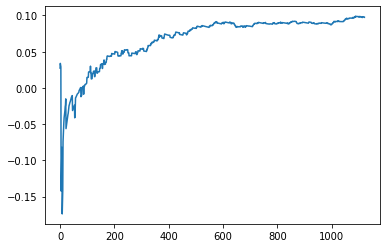

Thread: 2 iteration: 190
RAM mDiffFit_98 FROM: 192 --> 2880 reward: -0.18293743437499999
Thread: 3 iteration: 172
RAM mDiffFit_205 FROM: 2240 --> 2752 reward: -0.303643558203125
Thread: 1 iteration: 184
RAM mDiffFit_153 FROM: 384 --> 2496 reward: -0.120710907421875
Thread: 5 iteration: 213
RAM mDiffFit_314 FROM: 2496 --> 2944 reward: 0.007695331640625008
Thread: 6 iteration: 185
RAM mDiffFit_356 FROM: 2240 --> 2496 reward: -0.015231791796875005
Thread: 2 iteration: 191
RAM mDiffFit_5 FROM: 1216 --> 2496 reward: 0.006559933203124993
Thread: 1 iteration: 185
RAM mDiffFit_172 FROM: 2304 --> 2496 reward: 0.0032265707031249938
Thread: 5 iteration: 214
RAM mImgtbl_1 FROM: 576 --> 3008 reward: -0.3357268521875
Thread: 3 iteration: 173
RAM mProject_8 FROM: 768 --> 1792 reward: 0.61772312475
Thread: 4 iteration: 177
RAM mBackground_59 FROM: 1472 --> 1984 reward: -0.000309029578124987
Thread: 6 iteration: 186
RAM mBackground_15 FROM: 832 --> 1984 reward: -0.16480421639843754
Thread: 2 iteration:

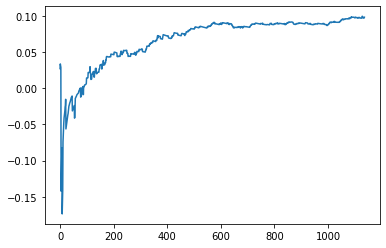

Thread: 4 iteration: 180
RAM mDiffFit_41 FROM: 1408 --> 2880 reward: -0.030507809765625005
Thread: 6 iteration: 188
RAM mDiffFit_375 FROM: 1792 --> 2496 reward: 0.023578185156249987
Thread: 4 iteration: 181
RAM mViewer_2 FROM: 2496 --> 1728 reward: -0.0003042566484374537
Thread: 2 iteration: 194
RAM mDiffFit_81 FROM: 2048 --> 2880 reward: 0.3142191546875
Thread: 6 iteration: 189
RAM mDiffFit_111 FROM: 1344 --> 2880 reward: 0.012242233984375
Thread: 4 iteration: 182
RAM mDiffFit_354 FROM: 1216 --> 2880 reward: 0.002354203124999999
Thread: 2 iteration: 195
RAM mProject_43 FROM: 1856 --> 384 reward: -1.0
Thread: 1 iteration: 186
RAM mProject_75 FROM: 896 --> 320 reward: -1.0
Thread: 3 iteration: 174
RAM mBackground_58 FROM: 1984 --> 1984 reward: 0.016557263882812492
Thread: 4 iteration: 183
RAM mProject_23 FROM: 896 --> 2624 reward: 0.3007918524375001
Thread: 5 iteration: 218
RAM mDiffFit_106 FROM: 192 --> 2880 reward: -0.2515311953125
Thread: 2 iteration: 196
RAM mDiffFit_198 FROM: 3008 

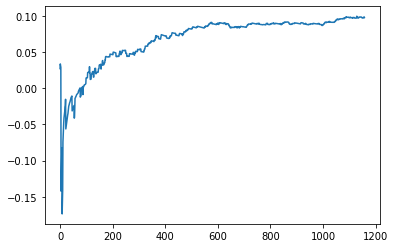

Thread: 5 iteration: 220
RAM mDiffFit_392 FROM: 1024 --> 2880 reward: -0.011510354687499988
Thread: 2 iteration: 198
RAM mDiffFit_349 FROM: 1088 --> 2880 reward: -0.015575465234374999
Thread: 1 iteration: 189
RAM mProject_85 FROM: 2048 --> 1728 reward: -0.02399961016406252
Saving ...


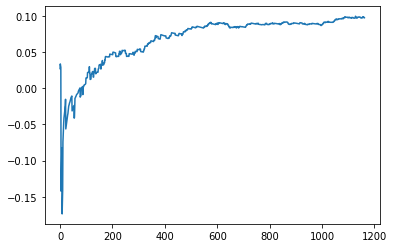

Thread: 6 iteration: 190
RAM mDiffFit_12 FROM: 1408 --> 2880 reward: 0.011276105468750013
Thread: 4 iteration: 186
RAM mDiffFit_385 FROM: 1088 --> 2880 reward: 0.013908915234375
Thread: 2 iteration: 199
RAM mDiffFit_143 FROM: 2944 --> 832 reward: -0.012018295703125001
Thread: 5 iteration: 221
RAM mDiffFit_183 FROM: 320 --> 2880 reward: -0.3011769921875
Saving ...


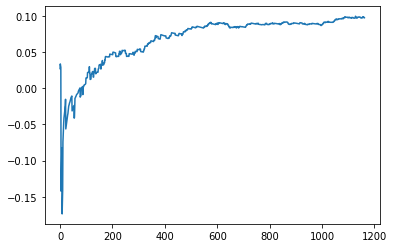

Thread: 1 iteration: 190
RAM mDiffFit_64 FROM: 2304 --> 2624 reward: 0.0003359511718750187
Thread: 4 iteration: 187
RAM mDiffFit_391 FROM: 1856 --> 2816 reward: -0.03900780976562504
Thread: 6 iteration: 191
RAM mDiffFit_357 FROM: 512 --> 2688 reward: -0.09920309765625002
Saving ...


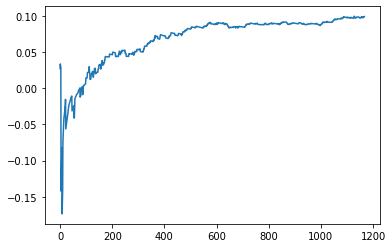

Thread: 2 iteration: 200
RAM mDiffFit_183 FROM: 3008 --> 2816 reward: -0.011570331640624945
Thread: 1 iteration: 191
RAM mProject_44 FROM: 1856 --> 1728 reward: -0.00469127756250004
Thread: 3 iteration: 177
RAM mDiffFit_223 FROM: 512 --> 2688 reward: -0.12186977890625
Thread: 4 iteration: 188
RAM mDiffFit_220 FROM: 1280 --> 2944 reward: -0.015781239062499994
Thread: 2 iteration: 201
RAM mDiffFit_382 FROM: 2688 --> 2816 reward: -0.0010312390624999876
Thread: 1 iteration: 192
RAM mProject_34 FROM: 2496 --> 2880 reward: 0.06308590872656251
Thread: 5 iteration: 222
RAM mDiffFit_309 FROM: 2368 --> 2624 reward: -0.019268251953125006
Thread: 3 iteration: 178
RAM mDiffFit_333 FROM: 960 --> 2880 reward: -0.04057809765625
Thread: 4 iteration: 189
RAM mBackground_27 FROM: 128 --> 1984 reward: 0.226740138828125
Thread: 2 iteration: 202
RAM mDiffFit_422 FROM: 2688 --> 640 reward: 0.06356765546875001
Thread: 1 iteration: 193
RAM mDiffFit_352 FROM: 2752 --> 832 reward: -0.02308862734375
Thread: 5 ite

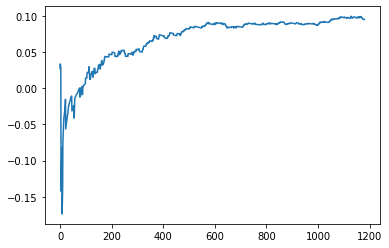

Thread: 4 iteration: 190
RAM mDiffFit_120 FROM: 1344 --> 2880 reward: -0.032273429296875
Thread: 1 iteration: 194
RAM mDiffFit_168 FROM: 2688 --> 2880 reward: -0.001898429296874997
Thread: 2 iteration: 203
RAM mDiffFit_96 FROM: 2816 --> 2624 reward: -0.009601570703124986
Thread: 5 iteration: 224
RAM mDiffFit_242 FROM: 1984 --> 2880 reward: 0.014765663281250015
Thread: 4 iteration: 191
RAM mDiffFit_279 FROM: 768 --> 2880 reward: -0.03442177109374996
Saving ...


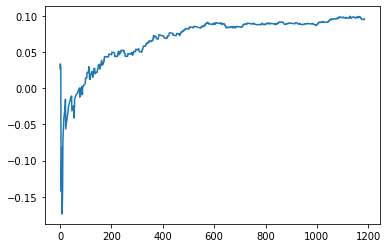

Thread: 3 iteration: 180
RAM mProject_73 FROM: 448 --> 896 reward: 0.9275715645468751
Thread: 6 iteration: 192
RAM mDiffFit_175 FROM: 2688 --> 384 reward: 0.27592181484374995
Thread: 1 iteration: 195
RAM mDiffFit_129 FROM: 1216 --> 2880 reward: 0.005388074609375005
Thread: 5 iteration: 225
RAM mDiffFit_136 FROM: 1216 --> 2880 reward: 0.016388074609375008
Thread: 3 iteration: 181
RAM mDiffFit_163 FROM: 1856 --> 2880 reward: 0.0010755527343750057
Thread: 6 iteration: 193
RAM mDiffFit_3 FROM: 1536 --> 2688 reward: -0.07231252187500001
Thread: 1 iteration: 196
RAM mDiffFit_148 FROM: 1216 --> 2880 reward: 0.017763074609375012
Thread: 5 iteration: 226
RAM mDiffFit_413 FROM: 704 --> 2688 reward: -0.047432257031249994
Thread: 6 iteration: 194
RAM mDiffFit_150 FROM: 1216 --> 2880 reward: 0.01563807460937501
Thread: 3 iteration: 182
RAM mBackground_63 FROM: 192 --> 2304 reward: -0.7620472379296875
Thread: 4 iteration: 192
RAM mDiffFit_59 FROM: 448 --> 1152 reward: -0.14756506679687503
Thread: 1 

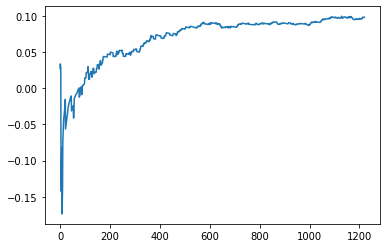

Thread: 5 iteration: 230
RAM mDiffFit_306 FROM: 2368 --> 2880 reward: 0.017562521874999997
Thread: 4 iteration: 197
RAM mDiffFit_238 FROM: 1600 --> 2880 reward: 0.0015755527343749853
Thread: 2 iteration: 208
RAM mDiffFit_16 FROM: 1216 --> 2880 reward: -0.0043957968750000034
Saving ...


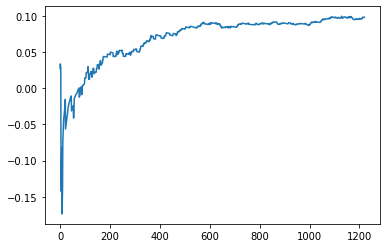

Thread: 6 iteration: 200
RAM mProject_8 FROM: 2176 --> 2880 reward: 0.11751773625000006
Thread: 1 iteration: 199
RAM mDiffFit_333 FROM: 896 --> 2880 reward: 0.042632897265625004
Thread: 5 iteration: 231
RAM mDiffFit_357 FROM: 896 --> 2880 reward: 0.0003724550781250037
Thread: 4 iteration: 198
RAM mDiffFit_210 FROM: 2944 --> 640 reward: 0.043968673437499994
Thread: 3 iteration: 188
RAM mDiffFit_4 FROM: 1792 --> 2880 reward: 0.020617233984374997
Thread: 2 iteration: 209
RAM mDiffFit_175 FROM: 256 --> 2880 reward: -0.38594261171875005
Saving ...


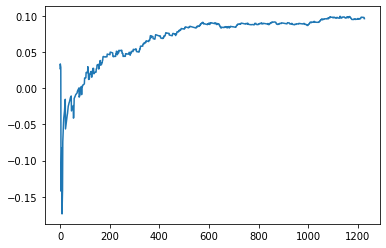

Thread: 1 iteration: 200
RAM mDiffFit_293 FROM: 640 --> 2880 reward: -0.02150254492187498
Thread: 4 iteration: 199
RAM mDiffFit_418 FROM: 1344 --> 2880 reward: -0.016453097656249985
Thread: 1 iteration: 201
RAM mDiffFit_264 FROM: 1792 --> 2880 reward: 0.0074817917968750085
Saving ...


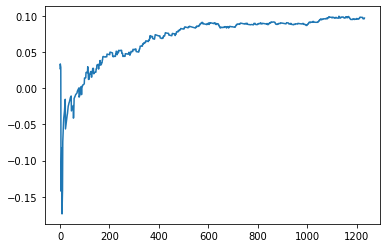

Thread: 2 iteration: 210
RAM mDiffFit_173 FROM: 2752 --> 640 reward: 0.043419226171875006
Thread: 3 iteration: 189
RAM mProject_2 FROM: 576 --> 2560 reward: 0.7793896753125
Thread: 6 iteration: 201
RAM mDiffFit_419 FROM: 2112 --> 2880 reward: 0.016656282812500013
Saving ...


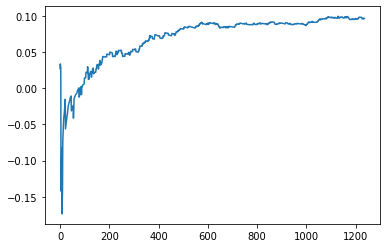

Thread: 4 iteration: 200
RAM mDiffFit_205 FROM: 1600 --> 2688 reward: -0.5178025609375
Thread: 1 iteration: 202
RAM mDiffFit_9 FROM: 384 --> 2688 reward: -0.09026557578124998
Saving ...


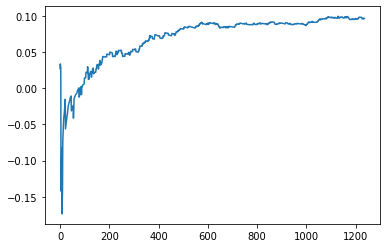

Thread: 3 iteration: 190
RAM mDiffFit_285 FROM: 2816 --> 384 reward: -0.009000175000000027
Thread: 2 iteration: 211
RAM mDiffFit_9 FROM: 1664 --> 2880 reward: 0.0023776324218749943
Thread: 6 iteration: 202
RAM mDiffFit_313 FROM: 384 --> 2880 reward: -0.40945309765625004
Thread: 4 iteration: 201
RAM mBackground_76 FROM: 1280 --> 1984 reward: -0.0626030721328125
Thread: 3 iteration: 191
RAM mDiffFit_349 FROM: 1664 --> 2944 reward: 0.05405738828125001
Thread: 2 iteration: 212
RAM mProject_11 FROM: 1728 --> 1280 reward: 0.09054466748437512
Thread: 5 iteration: 232
RAM mDiffFit_199 FROM: 448 --> 2880 reward: -0.10257550898437502
Thread: 4 iteration: 202
RAM mBackground_11 FROM: 1024 --> 1984 reward: -0.0386394771640625
Thread: 3 iteration: 192
RAM mDiffFit_5 FROM: 2304 --> 2944 reward: 0.03588548593750001
Thread: 5 iteration: 233
RAM mBackground_14 FROM: 2944 --> 1984 reward: -0.039974416195312515
Thread: 2 iteration: 213
RAM mViewer_4 FROM: 2688 --> 2752 reward: -0.029253156281249963
Threa

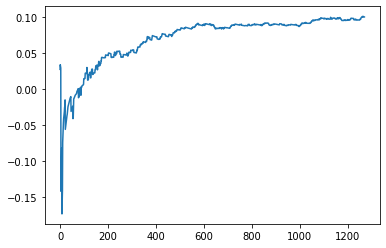

Thread: 2 iteration: 220
RAM mProject_78 FROM: 1664 --> 1728 reward: -0.035302523624999915
Thread: 5 iteration: 238
RAM mProject_87 FROM: 960 --> 320 reward: -1.0
Thread: 1 iteration: 203
RAM mDiffFit_271 FROM: 1920 --> 2944 reward: -0.003171858593749976
Thread: 4 iteration: 207
RAM mDiffFit_371 FROM: 704 --> 2880 reward: -0.143783871484375
Thread: 6 iteration: 208
RAM mAdd_3 FROM: 896 --> 320 reward: -1.0
Thread: 3 iteration: 195
RAM mDiffFit_282 FROM: 2944 --> 2496 reward: -0.0147604421875
Thread: 2 iteration: 221
RAM mDiffFit_302 FROM: 1728 --> 2496 reward: 0.03603132656250001
Thread: 1 iteration: 204
RAM mBackground_52 FROM: 1728 --> 1984 reward: 0.020254826156249968
Thread: 4 iteration: 208
RAM mDiffFit_316 FROM: 320 --> 2688 reward: -0.04287750117187501
Thread: 2 iteration: 222
RAM mDiffFit_120 FROM: 384 --> 2880 reward: -0.053070244140625
Thread: 1 iteration: 205
RAM mBackground_85 FROM: 2176 --> 1984 reward: -0.062267214585937536
Thread: 4 iteration: 209
RAM mDiffFit_242 FROM: 

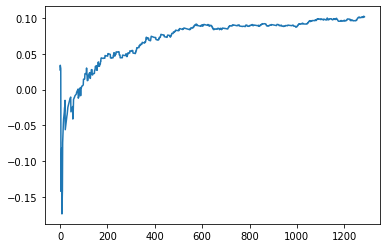

Thread: 4 iteration: 210
RAM mDiffFit_339 FROM: 2048 --> 2496 reward: 0.0065104421874999895
Saving ...


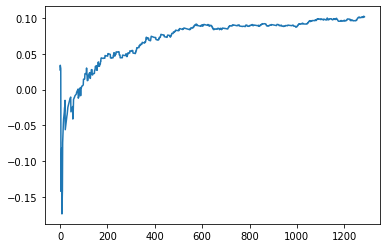

Thread: 6 iteration: 210
RAM mDiffFit_16 FROM: 2304 --> 2496 reward: 0.0068515707031249935
Thread: 3 iteration: 197
RAM mDiffFit_186 FROM: 2944 --> 2496 reward: -0.00632033164062502
Saving ...


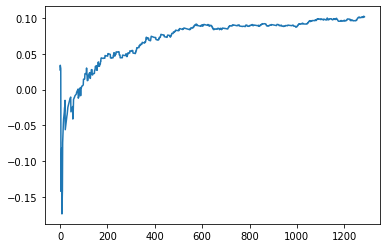

Thread: 5 iteration: 240
RAM mDiffFit_280 FROM: 2304 --> 2496 reward: -0.00028123906250001815
Thread: 1 iteration: 206
RAM mDiffFit_120 FROM: 1536 --> 2496 reward: -0.0001796683593750098
Thread: 6 iteration: 211
RAM mBackground_54 FROM: 640 --> 2304 reward: -0.16200242475000004
Thread: 4 iteration: 211
RAM mDiffFit_194 FROM: 3008 --> 2496 reward: 0.011585951171874994
Thread: 1 iteration: 207
RAM mProject_46 FROM: 2304 --> 1728 reward: -0.05261640356249999
Thread: 2 iteration: 223
RAM mDiffFit_122 FROM: 896 --> 2688 reward: -0.03186455781250001
Thread: 1 iteration: 208
RAM mDiffFit_279 FROM: 192 --> 2688 reward: -0.5015155320312501
Thread: 2 iteration: 224
RAM mDiffFit_375 FROM: 1152 --> 2688 reward: -0.06578123906249998
Thread: 1 iteration: 209
RAM mDiffFit_136 FROM: 2304 --> 2496 reward: 0.03162504375
Thread: 2 iteration: 225
RAM mProject_24 FROM: 2944 --> 1728 reward: -0.15399130204687503
Thread: 3 iteration: 198
RAM mProject_74 FROM: 2368 --> 1728 reward: -0.08568394818749998
Thread

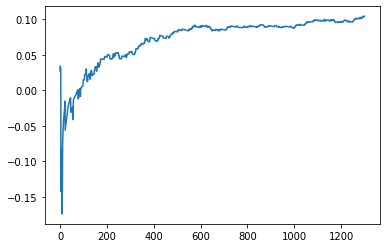

Thread: 1 iteration: 210
RAM mProject_78 FROM: 2368 --> 1728 reward: -0.1003038068671876
Thread: 4 iteration: 212
RAM mProject_73 FROM: 2560 --> 1728 reward: -0.12418761592968758
Thread: 6 iteration: 212
RAM mDiffFit_393 FROM: 1280 --> 2496 reward: 0.004862012890625
Thread: 5 iteration: 242
RAM mBackground_57 FROM: 1536 --> 1984 reward: 0.005722176960937458
Thread: 2 iteration: 227
RAM mDiffFit_48 FROM: 192 --> 2688 reward: -0.22414838554687497
Thread: 1 iteration: 211
RAM mDiffFit_319 FROM: 704 --> 2496 reward: -0.03252079687500003
Thread: 6 iteration: 213
RAM mDiffFit_95 FROM: 1408 --> 2496 reward: -0.02480988945312502
Thread: 5 iteration: 243
RAM mDiffFit_106 FROM: 1472 --> 2496 reward: -0.018588539843750022
Thread: 5 iteration: 244
RAM mBackground_21 FROM: 704 --> 2304 reward: -0.04551491177343745
Thread: 6 iteration: 214
RAM mBackground_6 FROM: 1472 --> 1984 reward: -0.04585771146875007
Thread: 2 iteration: 228
RAM mDiffFit_423 FROM: 832 --> 2688 reward: -0.05372393828125001
Threa

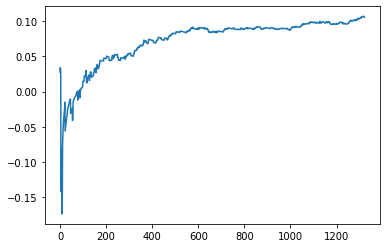

Thread: 3 iteration: 200
RAM mDiffFit_363 FROM: 2816 --> 640 reward: 0.04685933671875
Thread: 5 iteration: 247
RAM mDiffFit_339 FROM: 576 --> 2688 reward: -0.10042185859375
Thread: 1 iteration: 214
RAM mDiffFit_268 FROM: 2816 --> 640 reward: 0.05298433671875
Thread: 6 iteration: 218
RAM mDiffFit_402 FROM: 128 --> 2176 reward: -1.07489066328125
Thread: 5 iteration: 248
RAM mDiffFit_369 FROM: 2560 --> 2880 reward: 0.007585951171875001
Thread: 6 iteration: 219
RAM mDiffFit_400 FROM: 2368 --> 2880 reward: -0.020799491015625008
Thread: 1 iteration: 215
RAM mBackground_27 FROM: 1664 --> 2304 reward: 0.022924440843749998
Thread: 5 iteration: 249
RAM mProject_42 FROM: 1856 --> 1024 reward: 0.22353841617187506
Saving ...


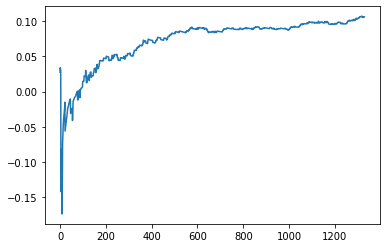

Thread: 2 iteration: 230
RAM mDiffFit_380 FROM: 1024 --> 2880 reward: 0.016856835546875004
Saving ...


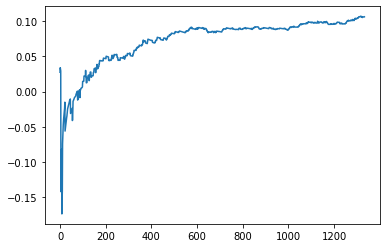

Thread: 6 iteration: 220
RAM mDiffFit_344 FROM: 512 --> 2688 reward: -0.03386973515625001
Thread: 1 iteration: 216
RAM mDiffFit_214 FROM: 1728 --> 2880 reward: -0.02125
Saving ...


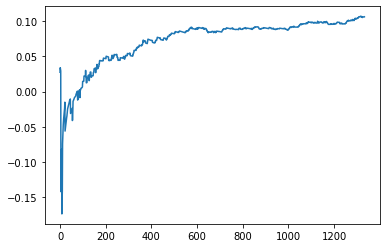

Thread: 5 iteration: 250
RAM mProject_68 FROM: 896 --> 2240 reward: -0.2008516958437501
Thread: 4 iteration: 216
RAM mAdd_1 FROM: 1024 --> 2304 reward: -0.1561249343749999
Thread: 2 iteration: 231
RAM mDiffFit_344 FROM: 1024 --> 2688 reward: -0.007661416406249989
Thread: 6 iteration: 221
RAM mBackground_4 FROM: 640 --> 2304 reward: -0.13304458873437502
Thread: 1 iteration: 217
RAM mDiffFit_85 FROM: 384 --> 1152 reward: -0.025031195312500004
Thread: 4 iteration: 217
RAM mBackground_31 FROM: 2816 --> 1984 reward: -0.03278085885156249
Thread: 5 iteration: 251
RAM mDiffFit_10 FROM: 1344 --> 2816 reward: -0.079476570703125
Thread: 2 iteration: 232
RAM mProject_21 FROM: 2688 --> 1024 reward: 0.08903688398437495
Thread: 3 iteration: 201
RAM mBackground_57 FROM: 2048 --> 1984 reward: -0.002376206539062519
Thread: 1 iteration: 218
RAM mDiffFit_96 FROM: 1728 --> 2880 reward: -0.031624999999999986
Thread: 2 iteration: 233
RAM mDiffFit_175 FROM: 2496 --> 2880 reward: 0.014031282812500025
Thread: 5

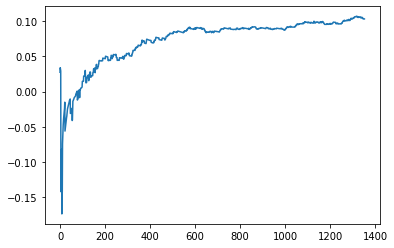

Thread: 1 iteration: 220
RAM mDiffFit_254 FROM: 1088 --> 2688 reward: -0.1071771234375
Thread: 5 iteration: 254
RAM mDiffFit_56 FROM: 2688 --> 2624 reward: -0.006609380468749967
Thread: 6 iteration: 223
RAM mDiffFit_90 FROM: 1344 --> 2880 reward: -0.0494687609375
Saving ...


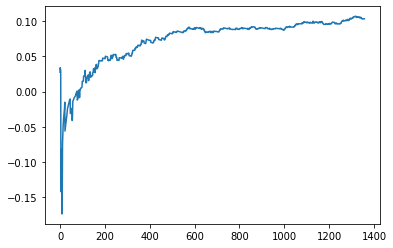

Thread: 4 iteration: 220
RAM mDiffFit_312 FROM: 2048 --> 2944 reward: -0.00969269921875
Thread: 1 iteration: 221
RAM mBackground_42 FROM: 192 --> 2304 reward: -0.7938470887343752
Thread: 2 iteration: 236
RAM mBackground_41 FROM: 1600 --> 1984 reward: 0.044050435914062464
Thread: 5 iteration: 255
RAM mBackground_58 FROM: 1728 --> 1984 reward: 0.01100982615624997
Thread: 6 iteration: 224
RAM mDiffFit_126 FROM: 896 --> 2816 reward: -0.04595823125000002
Thread: 3 iteration: 203
RAM mDiffFit_218 FROM: 576 --> 2816 reward: -0.06260933671874998
Thread: 1 iteration: 222
RAM mDiffFit_55 FROM: 384 --> 1152 reward: -0.27968756562499997
Thread: 2 iteration: 237
RAM mDiffFit_366 FROM: 2240 --> 2880 reward: 0.02122920312500002
Thread: 5 iteration: 256
RAM mDiffFit_25 FROM: 2944 --> 384 reward: 0.10840619531249998
Thread: 3 iteration: 204
RAM mDiffFit_405 FROM: 640 --> 2880 reward: -0.06942444726562502
Thread: 6 iteration: 225
RAM mDiffFit_22 FROM: 960 --> 2880 reward: -0.005656195312500004
Thread: 5

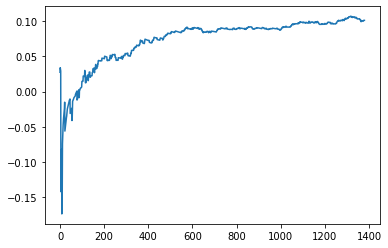

Thread: 2 iteration: 240
RAM mBackground_2 FROM: 896 --> 1984 reward: -0.056390409960937506
Thread: 4 iteration: 223
RAM mDiffFit_367 FROM: 2880 --> 2880 reward: 0.027007853515625003
Saving ...


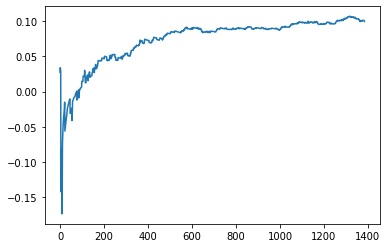

Thread: 5 iteration: 260
RAM mDiffFit_6 FROM: 2560 --> 2496 reward: -0.035346393359375006
Thread: 6 iteration: 229
RAM mDiffFit_192 FROM: 1920 --> 2496 reward: 0.011804712109374981
Thread: 3 iteration: 208
RAM mDiffFit_298 FROM: 1600 --> 2880 reward: 0.0265938046875
Thread: 2 iteration: 241
RAM mDiffFit_141 FROM: 768 --> 2496 reward: -0.042460907421875
Thread: 4 iteration: 224
RAM mDiffFit_373 FROM: 1152 --> 2496 reward: -0.010820287890625016
Thread: 5 iteration: 261
RAM mDiffFit_39 FROM: 2240 --> 2496 reward: -0.019231791796875015
Saving ...


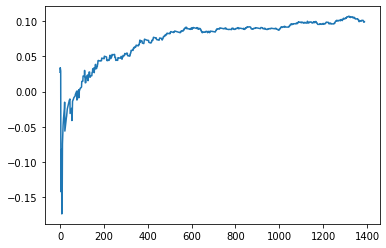

Thread: 6 iteration: 230
RAM mDiffFit_251 FROM: 1792 --> 2496 reward: 0.014789092578125001
Thread: 4 iteration: 225
RAM mDiffFit_319 FROM: 2624 --> 2880 reward: 0.0038437609374999786
Thread: 2 iteration: 242
RAM mDiffFit_119 FROM: 2688 --> 2880 reward: -0.03542190234374999
Thread: 5 iteration: 262
RAM mDiffFit_80 FROM: 1536 --> 2944 reward: -0.032109380468750004
Thread: 6 iteration: 231
RAM mDiffFit_53 FROM: 448 --> 1152 reward: -0.040070287890625
Thread: 4 iteration: 226
RAM mBackground_9 FROM: 1536 --> 1984 reward: 0.02405094577343747
Thread: 2 iteration: 243
RAM mDiffFit_25 FROM: 2496 --> 2944 reward: -0.01932814140625001
Thread: 5 iteration: 263
RAM mDiffFit_249 FROM: 2048 --> 2944 reward: 0.013765663281250003
Thread: 6 iteration: 232
RAM mDiffFit_379 FROM: 1152 --> 2880 reward: -0.029250000000000005
Thread: 2 iteration: 244
RAM mDiffFit_362 FROM: 1344 --> 2944 reward: 0.011734424218750004
Thread: 4 iteration: 227
RAM mDiffFit_41 FROM: 2240 --> 2880 reward: -0.016153650390625003
Th

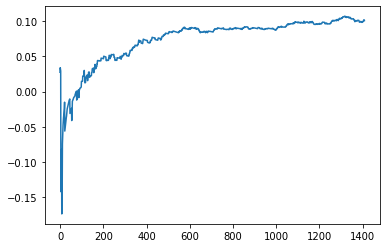

Thread: 3 iteration: 210
RAM mProject_47 FROM: 2624 --> 1728 reward: -0.125467786125
Thread: 5 iteration: 264
RAM mProject_88 FROM: 1024 --> 2240 reward: -0.16204391057812492
Thread: 4 iteration: 228
RAM mDiffFit_349 FROM: 1920 --> 2880 reward: 0.019757853515625014
Thread: 1 iteration: 226
RAM mDiffFit_55 FROM: 832 --> 1152 reward: -0.1385313265625
Thread: 2 iteration: 248
RAM mDiffFit_99 FROM: 576 --> 1152 reward: -0.09782814140625001
Thread: 5 iteration: 265
RAM mDiffFit_285 FROM: 1792 --> 2944 reward: 0.026234424218750003
Thread: 4 iteration: 229
RAM mProject_80 FROM: 2432 --> 1728 reward: -0.0839575529296876
Thread: 6 iteration: 235
RAM mBackground_23 FROM: 320 --> 320 reward: 0.02789177867187505
Thread: 3 iteration: 211
RAM mDiffFit_209 FROM: 2560 --> 832 reward: 0.006059845703125007
Thread: 1 iteration: 227
RAM mDiffFit_248 FROM: 896 --> 2944 reward: 0.0003646453125000053
Thread: 5 iteration: 266
RAM mDiffFit_406 FROM: 1984 --> 2944 reward: -0.0033697789062499955
Thread: 2 iterat

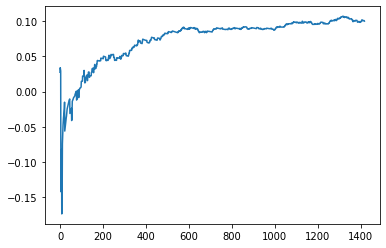

Thread: 4 iteration: 230
RAM mBackground_74 FROM: 2752 --> 1984 reward: -0.07592424235156248
Thread: 1 iteration: 228
RAM mDiffFit_24 FROM: 1728 --> 2944 reward: 0.025601614453125005
Saving ...


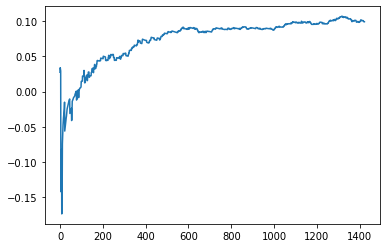

Thread: 2 iteration: 250
RAM mDiffFit_343 FROM: 704 --> 2880 reward: 0.003333406250000011
Thread: 4 iteration: 231
RAM mBackground_69 FROM: 1472 --> 2944 reward: 0.076275909453125
Thread: 6 iteration: 236
RAM mDiffFit_151 FROM: 832 --> 2880 reward: -0.03649736757812501
Thread: 3 iteration: 212
RAM mDiffFit_120 FROM: 2944 --> 2624 reward: -0.013585951171875
Thread: 2 iteration: 251
RAM mBackground_8 FROM: 1344 --> 1984 reward: -0.05248463933593746
Thread: 4 iteration: 232
RAM mDiffFit_194 FROM: 1536 --> 2880 reward: 0.0018984730468750086
Thread: 3 iteration: 213
RAM mDiffFit_154 FROM: 3008 --> 384 reward: 0.09583845234374999
Thread: 6 iteration: 237
RAM mDiffFit_391 FROM: 1088 --> 2880 reward: 0.013695419140624977
Thread: 2 iteration: 252
RAM mDiffFit_229 FROM: 2880 --> 2880 reward: 0.002125000000000009
Thread: 4 iteration: 233
RAM mBackground_54 FROM: 384 --> 320 reward: 0.03495987545312498
Thread: 3 iteration: 214
RAM mProject_82 FROM: 2560 --> 1728 reward: -0.10594149806250004
Thread

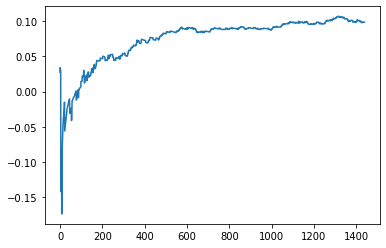

Thread: 1 iteration: 230
RAM mDiffFit_413 FROM: 1984 --> 2944 reward: 0.024132853515625018
Thread: 6 iteration: 239
RAM mBackground_14 FROM: 576 --> 2304 reward: -0.12416238712500004
Thread: 3 iteration: 215
RAM mDiffFit_272 FROM: 1536 --> 2944 reward: -0.016796858593749985
Thread: 4 iteration: 235
RAM mDiffFit_99 FROM: 2432 --> 832 reward: 0.012218717187499999
Thread: 2 iteration: 254
RAM mProject_41 FROM: 1408 --> 1728 reward: -0.07217249737499998
Thread: 5 iteration: 267
RAM mDiffFit_67 FROM: 2048 --> 2944 reward: 0.0024323007812500005
Thread: 1 iteration: 231
RAM mDiffFit_116 FROM: 1728 --> 2880 reward: 0.03073442421875
Thread: 2 iteration: 255
RAM mDiffFit_355 FROM: 1216 --> 1152 reward: -0.012182300781250002
Thread: 3 iteration: 216
RAM mDiffFit_305 FROM: 512 --> 1152 reward: 0.008031326562500003
Thread: 4 iteration: 236
RAM mDiffFit_86 FROM: 3008 --> 640 reward: 0.14822657070312503
Thread: 5 iteration: 268
RAM mBackground_71 FROM: 1536 --> 1984 reward: -0.04964262454687498
Threa

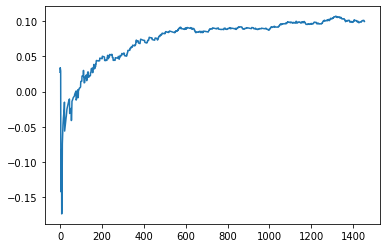

Thread: 5 iteration: 270
RAM mDiffFit_212 FROM: 2816 --> 2880 reward: -0.001132809765624996
Thread: 3 iteration: 218
RAM mDiffFit_251 FROM: 1472 --> 2880 reward: -0.021010398437499994
Thread: 4 iteration: 238
RAM mProject_10 FROM: 2240 --> 1024 reward: 0.15059609381250003
Saving ...


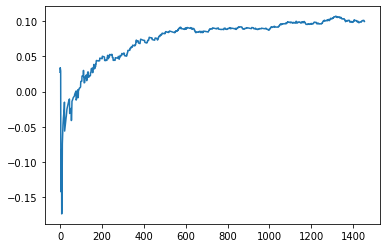

Thread: 6 iteration: 240
RAM mProject_62 FROM: 1408 --> 1728 reward: -0.048925756476562464
Thread: 2 iteration: 256
RAM mDiffFit_121 FROM: 640 --> 2688 reward: -0.07415101796875002
Thread: 3 iteration: 219
RAM mDiffFit_302 FROM: 512 --> 1152 reward: -0.11966663750000002
Thread: 5 iteration: 271
RAM mDiffFit_184 FROM: 2176 --> 1216 reward: 0.06479168124999998
Thread: 1 iteration: 234
RAM mDiffFit_276 FROM: 1344 --> 2688 reward: -0.08239066328125
Thread: 6 iteration: 241
RAM mDiffFit_181 FROM: 2560 --> 1216 reward: 0.052924491015625005
Thread: 2 iteration: 257
RAM mDiffFit_45 FROM: 768 --> 2688 reward: -0.09014061953125
Thread: 4 iteration: 239
RAM mDiffFit_299 FROM: 1920 --> 2944 reward: -0.000671858593749991
Thread: 5 iteration: 272
RAM mBackground_72 FROM: 2560 --> 1984 reward: -0.037403358851562575
Thread: 1 iteration: 235
RAM mDiffFit_408 FROM: 832 --> 2880 reward: 0.011734467968750033
Thread: 6 iteration: 242
RAM mDiffFit_206 FROM: 2624 --> 2496 reward: -0.09041418007812502
Saving 

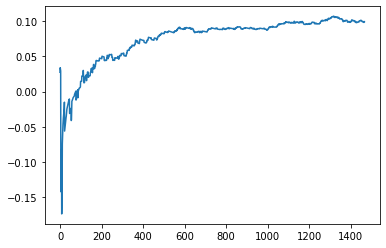

Thread: 4 iteration: 240
RAM mBackground_45 FROM: 2304 --> 1984 reward: 2.9091851562480785e-05
Thread: 2 iteration: 258
RAM mImgtbl_2 FROM: 2496 --> 2048 reward: -0.10428975031250004
Thread: 5 iteration: 273
RAM mDiffFit_37 FROM: 2752 --> 2496 reward: -0.007968760937499993
Thread: 2 iteration: 259
RAM mProject_29 FROM: 704 --> 2560 reward: 0.7560271490625
Saving ...


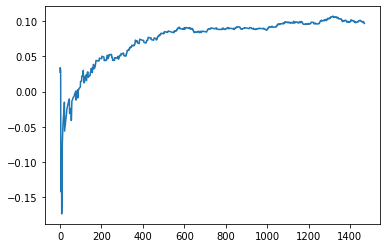

Thread: 3 iteration: 220
RAM mDiffFit_299 FROM: 2240 --> 2496 reward: -0.054932344531250024
Thread: 1 iteration: 236
RAM mDiffFit_372 FROM: 192 --> 1216 reward: -0.53692190234375
Thread: 6 iteration: 243
RAM mDiffFit_325 FROM: 2304 --> 2496 reward: -0.04645318515625002
Thread: 5 iteration: 274
RAM mBackground_32 FROM: 2496 --> 1984 reward: -0.081489603015625
Saving ...


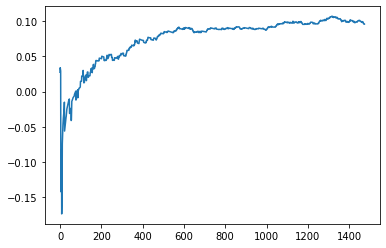

Thread: 2 iteration: 260
RAM mBackground_86 FROM: 960 --> 2304 reward: -0.04432350674218752
Thread: 3 iteration: 221
RAM mProject_31 FROM: 320 --> 2560 reward: 0.7448746359374999
Thread: 4 iteration: 241
RAM mDiffFit_297 FROM: 832 --> 1152 reward: -0.09187504375
Thread: 6 iteration: 244
RAM mDiffFit_331 FROM: 1152 --> 2880 reward: -0.006867146484374996
Thread: 5 iteration: 275
RAM mDiffFit_195 FROM: 2624 --> 2880 reward: -0.018591172265625018
Thread: 2 iteration: 261
RAM mDiffFit_289 FROM: 1728 --> 2880 reward: -0.07485942421874997
Thread: 6 iteration: 245
RAM mDiffFit_107 FROM: 128 --> 1216 reward: -0.4027551773437501
Thread: 5 iteration: 276
RAM mBackground_37 FROM: 1024 --> 1984 reward: -0.130912624546875
Thread: 2 iteration: 262
RAM mDiffFit_157 FROM: 2816 --> 1216 reward: 0.01979685859375
Thread: 6 iteration: 246
RAM mDiffFit_414 FROM: 1088 --> 1152 reward: -0.04871358359375
Thread: 5 iteration: 277
RAM mBackground_67 FROM: 2624 --> 1984 reward: -0.02371052283593753
Thread: 2 iter

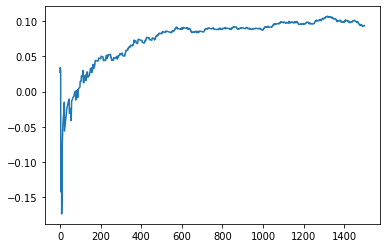

Thread: 6 iteration: 250
RAM mDiffFit_406 FROM: 192 --> 1152 reward: -0.18195309765625
Thread: 5 iteration: 279
RAM mProject_83 FROM: 832 --> 2560 reward: 0.7464946359375
Thread: 1 iteration: 237
RAM mProject_63 FROM: 2944 --> 2880 reward: -0.011929240898437509
Thread: 2 iteration: 265
RAM mBackground_9 FROM: 320 --> 320 reward: 0.2278060080468748
Thread: 4 iteration: 245
RAM mDiffFit_237 FROM: 2048 --> 1152 reward: -0.015770884375000006
Thread: 3 iteration: 225
RAM mDiffFit_116 FROM: 1920 --> 1152 reward: -0.02325004374999999
Thread: 6 iteration: 251
RAM mDiffFit_67 FROM: 2880 --> 832 reward: -0.02073446796875003
Thread: 1 iteration: 238
RAM mDiffFit_188 FROM: 128 --> 1216 reward: -0.74325004375
Thread: 2 iteration: 266
RAM mBackground_48 FROM: 2560 --> 1984 reward: -0.03527350804687504
Thread: 4 iteration: 246
RAM mDiffFit_241 FROM: 256 --> 1216 reward: -0.503815198046875
Saving ...


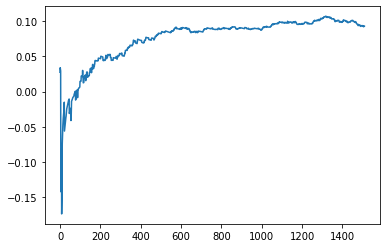

Thread: 5 iteration: 280
RAM mDiffFit_254 FROM: 2304 --> 1152 reward: 0.036875
Thread: 2 iteration: 267
RAM mBackground_80 FROM: 192 --> 2304 reward: -0.6302857822968752
Thread: 3 iteration: 226
RAM mViewer_3 FROM: 832 --> 1408 reward: -0.0337888611328125
Thread: 1 iteration: 239
RAM mDiffFit_291 FROM: 896 --> 1152 reward: 0.0005260617187500052
Thread: 4 iteration: 247
RAM mDiffFit_214 FROM: 192 --> 2944 reward: -0.35210152695312497
Thread: 2 iteration: 268
RAM mDiffFit_240 FROM: 2688 --> 2624 reward: -0.028757853515624984
Thread: 3 iteration: 227
RAM mBackground_28 FROM: 2304 --> 1984 reward: -0.04015579657812499
Saving ...


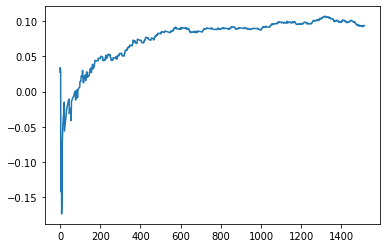

Thread: 1 iteration: 240
RAM mProject_68 FROM: 2176 --> 1728 reward: -0.03302870449218753
Thread: 6 iteration: 252
RAM mDiffFit_106 FROM: 512 --> 1152 reward: -0.048296858593749985
Thread: 4 iteration: 248
RAM mDiffFit_56 FROM: 128 --> 2112 reward: -0.9523592929687501
Thread: 2 iteration: 269
RAM mDiffFit_371 FROM: 2432 --> 1216 reward: 0.026750000000000003
Thread: 3 iteration: 228
RAM mDiffFit_249 FROM: 2560 --> 1216 reward: 0.014929624609375004
Thread: 1 iteration: 241
RAM mProject_81 FROM: 2240 --> 1728 reward: -0.053842641749999955
Thread: 5 iteration: 281
RAM mDiffFit_374 FROM: 2560 --> 2880 reward: -0.020671902343749986
Thread: 6 iteration: 253
RAM mDiffFit_145 FROM: 704 --> 2944 reward: -0.011874912500000005
Thread: 3 iteration: 229
RAM mDiffFit_68 FROM: 2624 --> 2880 reward: -0.023716172265625026
Thread: 1 iteration: 242
RAM mDiffFit_201 FROM: 1280 --> 2944 reward: -0.08951566328124999
Thread: 4 iteration: 249
RAM mDiffFit_306 FROM: 1280 --> 2880 reward: -0.076518251953125
Thre

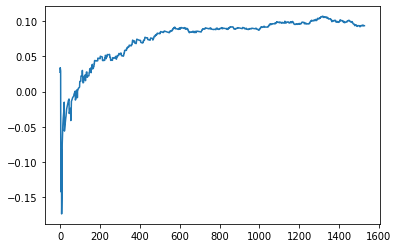

Thread: 4 iteration: 250
RAM mProject_38 FROM: 1024 --> 1728 reward: -0.2233574999999999
Saving ...


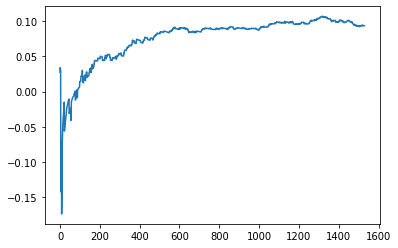

Thread: 2 iteration: 270
RAM mDiffFit_356 FROM: 1984 --> 2496 reward: -0.014440110546875013
Thread: 5 iteration: 283
RAM mBgModel_3 FROM: 1408 --> 2624 reward: 0.03178660890625001
Saving ...


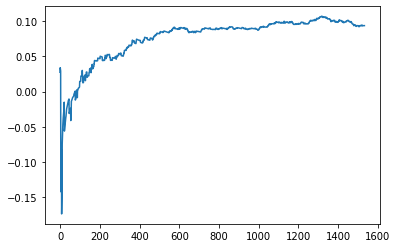

Thread: 3 iteration: 230
RAM mDiffFit_29 FROM: 320 --> 2688 reward: -0.3632161722656251
Thread: 6 iteration: 255
RAM mDiffFit_253 FROM: 2752 --> 2624 reward: 0.000869778906250028
Thread: 1 iteration: 244
RAM mDiffFit_408 FROM: 1920 --> 2496 reward: -0.015242190234375005
Thread: 4 iteration: 251
RAM mDiffFit_75 FROM: 2624 --> 2496 reward: -0.002859380468750016
Thread: 2 iteration: 271
RAM mDiffFit_92 FROM: 2176 --> 2496 reward: 0.016489601562499987
Thread: 3 iteration: 231
RAM mDiffFit_274 FROM: 128 --> 2688 reward: -0.47210933671875
Thread: 6 iteration: 256
RAM mDiffFit_338 FROM: 2624 --> 2496 reward: -0.0066093804687500195
Thread: 5 iteration: 284
RAM mDiffFit_224 FROM: 704 --> 2496 reward: -0.01475776601562501
Thread: 4 iteration: 252
RAM mDiffFit_344 FROM: 2048 --> 2496 reward: 0.01664066328124998
Thread: 1 iteration: 245
RAM mDiffFit_397 FROM: 1664 --> 2880 reward: -0.012346349609374998
Thread: 6 iteration: 257
RAM mDiffFit_122 FROM: 576 --> 1152 reward: -0.03879685859374999
Thread

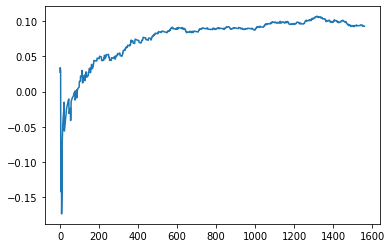

Thread: 6 iteration: 260
RAM mDiffFit_287 FROM: 768 --> 1152 reward: -0.054546902343749995
Thread: 5 iteration: 288
RAM mDiffFit_249 FROM: 192 --> 1152 reward: -0.2584062390625
Thread: 1 iteration: 249
RAM mDiffFit_78 FROM: 1536 --> 2688 reward: 0.01548442421874999
Thread: 2 iteration: 274
RAM mBackground_42 FROM: 256 --> 320 reward: -0.1189151491953125
Thread: 3 iteration: 234
RAM mDiffFit_76 FROM: 2496 --> 2880 reward: -0.01744533164062501
Thread: 6 iteration: 261
RAM mDiffFit_303 FROM: 1216 --> 2880 reward: 0.01723705664062502
Thread: 2 iteration: 275
RAM mDiffFit_252 FROM: 2752 --> 2880 reward: 0.00996876093750005
Saving ...


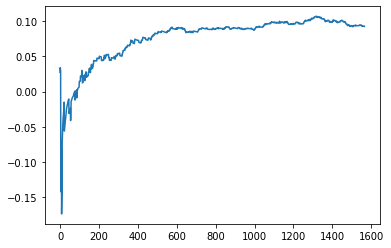

Thread: 1 iteration: 250
RAM mBackground_14 FROM: 2112 --> 1984 reward: -0.003216057343750018
Thread: 5 iteration: 289
RAM mDiffFit_1 FROM: 1216 --> 1152 reward: -0.019356791796875
Thread: 6 iteration: 262
RAM mDiffFit_240 FROM: 2240 --> 2880 reward: -0.033354203125
Thread: 2 iteration: 276
RAM mBackground_63 FROM: 2944 --> 1984 reward: -0.06384168007812498
Thread: 3 iteration: 235
RAM mDiffFit_365 FROM: 2752 --> 2880 reward: -0.023612012890625
Thread: 1 iteration: 251
RAM mDiffFit_291 FROM: 896 --> 1152 reward: -0.007473938281249981
Saving ...


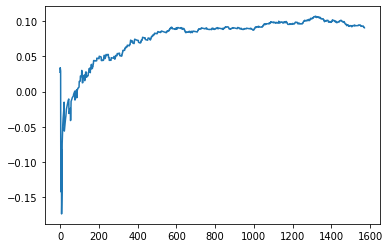

Thread: 5 iteration: 290
RAM mProject_62 FROM: 896 --> 2240 reward: -0.221219834625
Thread: 4 iteration: 257
RAM mDiffFit_273 FROM: 1920 --> 2880 reward: 0.020757853515624997
Thread: 2 iteration: 277
RAM mDiffFit_365 FROM: 2240 --> 384 reward: 0.08236973515625001
Thread: 3 iteration: 236
RAM mDiffFit_1 FROM: 320 --> 1152 reward: -0.17977865039062502
Thread: 1 iteration: 252
RAM mDiffFit_79 FROM: 1600 --> 2688 reward: -0.07258077382812504
Thread: 5 iteration: 291
RAM mDiffFit_366 FROM: 2112 --> 2944 reward: 0.023023473046875007
Thread: 2 iteration: 278
RAM mDiffFit_152 FROM: 576 --> 1152 reward: -0.20006256562500002
Thread: 1 iteration: 253
RAM mDiffFit_349 FROM: 576 --> 1152 reward: -0.051249999999999976
Thread: 2 iteration: 279
RAM mDiffFit_188 FROM: 320 --> 1152 reward: -0.10503123906249998
Saving ...


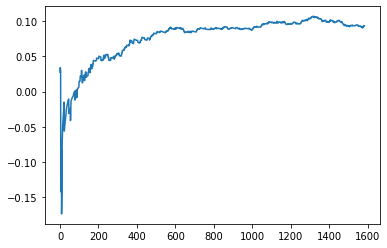

Thread: 2 iteration: 280
RAM mDiffFit_403 FROM: 2560 --> 384 reward: 0.2763020796874999
Thread: 1 iteration: 254
RAM mDiffFit_154 FROM: 1728 --> 2496 reward: 0.047023516796875
Thread: 2 iteration: 281
RAM mProject_46 FROM: 1600 --> 1728 reward: -0.023211091617187516
Thread: 3 iteration: 237
RAM mDiffFit_141 FROM: 2048 --> 2496 reward: 0.033158915234374996
Thread: 2 iteration: 282
RAM mProject_65 FROM: 1472 --> 1728 reward: -0.04833890050781254
Thread: 5 iteration: 292
RAM mDiffFit_354 FROM: 2304 --> 2496 reward: 0.011593760937499992
Thread: 3 iteration: 238
RAM mProject_54 FROM: 2496 --> 384 reward: -1.0
Thread: 6 iteration: 263
RAM mProject_25 FROM: 2240 --> 384 reward: -1.0
Thread: 4 iteration: 258
RAM mBackground_3 FROM: 384 --> 320 reward: 0.1162254229375
Thread: 2 iteration: 283
RAM mDiffFit_96 FROM: 1600 --> 1152 reward: 0.02527084062499999
Thread: 5 iteration: 293
RAM mBackground_47 FROM: 1280 --> 1984 reward: -0.06336677867187497
Thread: 3 iteration: 239
RAM mDiffFit_182 FROM: 

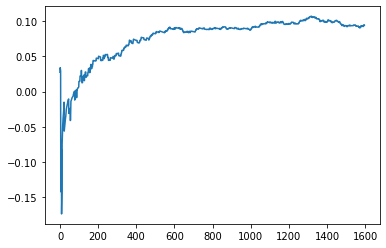

Thread: 3 iteration: 240
RAM mBackground_56 FROM: 1728 --> 1984 reward: -0.013287437726562506
Thread: 5 iteration: 295
RAM mDiffFit_92 FROM: 1088 --> 1152 reward: 0.012278650390624996
Thread: 5 iteration: 296
RAM mProject_41 FROM: 576 --> 2560 reward: 0.7466296359375
Thread: 6 iteration: 264
RAM mDiffFit_417 FROM: 1536 --> 2880 reward: 0.0038984730468749965
Thread: 5 iteration: 297
RAM mViewer_4 FROM: 2624 --> 1984 reward: -0.13028148581250004
Thread: 3 iteration: 241
RAM mProject_5 FROM: 1344 --> 1728 reward: -0.08787655757812503
Thread: 2 iteration: 284
RAM mProject_27 FROM: 1344 --> 1728 reward: -0.06335153395312497
Thread: 4 iteration: 259
RAM mProject_39 FROM: 1408 --> 1728 reward: -0.04913857061718757
Thread: 1 iteration: 255
RAM mBackground_55 FROM: 1984 --> 1984 reward: 0.005374999999999975
Thread: 6 iteration: 265
RAM mDiffFit_387 FROM: 2944 --> 1216 reward: 0.04959634960937499
Thread: 3 iteration: 242
RAM mDiffFit_1 FROM: 512 --> 1152 reward: -0.03179685859374998
Thread: 2 it

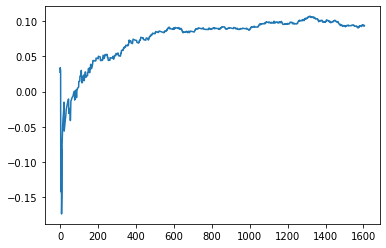

Thread: 4 iteration: 260
RAM mDiffFit_215 FROM: 2752 --> 2880 reward: 0.0021093804687500294
Thread: 3 iteration: 243
RAM mDiffFit_100 FROM: 448 --> 1152 reward: -0.06907550898437502
Thread: 6 iteration: 266
RAM mBackground_67 FROM: 1152 --> 1984 reward: -0.019795621429687504
Thread: 2 iteration: 286
RAM mDiffFit_125 FROM: 2304 --> 2880 reward: -0.017601570703125007
Thread: 1 iteration: 257
RAM mDiffFit_46 FROM: 2112 --> 2880 reward: 0.01590628281250002
Thread: 3 iteration: 244
RAM mDiffFit_174 FROM: 1536 --> 2880 reward: 0.012023473046875004
Thread: 2 iteration: 287
RAM mDiffFit_86 FROM: 2688 --> 2880 reward: -0.030414092578125006
Thread: 1 iteration: 258
RAM mProject_14 FROM: 832 --> 2560 reward: 0.7561846490625002
Thread: 5 iteration: 299
RAM mBackground_65 FROM: 1664 --> 1984 reward: -0.006718731187500001
Thread: 3 iteration: 245
RAM mDiffFit_61 FROM: 2368 --> 2880 reward: 0.005687521875000004
Thread: 1 iteration: 259
RAM mProject_35 FROM: 1472 --> 1728 reward: -0.033519353343749926

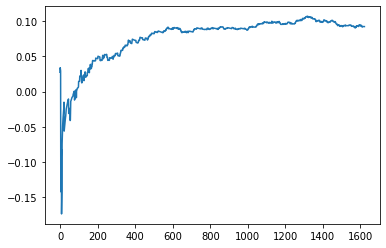

Thread: 5 iteration: 300
RAM mDiffFit_152 FROM: 1344 --> 2880 reward: 0.03268756562500001
Saving ...


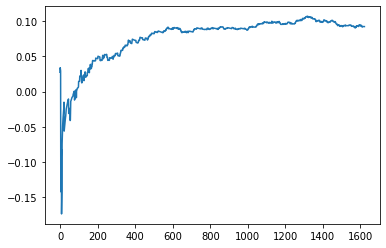

Thread: 1 iteration: 260
RAM mDiffFit_126 FROM: 2432 --> 2880 reward: 0.07628137031250003
Thread: 4 iteration: 262
RAM mBackground_26 FROM: 576 --> 2304 reward: -0.22973414114843746
Thread: 3 iteration: 246
RAM mDiffFit_23 FROM: 960 --> 1152 reward: -0.026218760937499995
Thread: 2 iteration: 289
RAM mDiffFit_321 FROM: 960 --> 1152 reward: -0.027328141406249996
Thread: 5 iteration: 301
RAM mDiffFit_291 FROM: 2560 --> 2752 reward: 0.004578141406249986
Thread: 3 iteration: 247
RAM mConcatFit_1 FROM: 1344 --> 1856 reward: -0.01788539843749995
Thread: 4 iteration: 263
RAM mDiffFit_348 FROM: 896 --> 2688 reward: -0.07425000000000001
Thread: 1 iteration: 261
RAM mDiffFit_318 FROM: 2304 --> 2880 reward: -0.017226570703124996
Saving ...


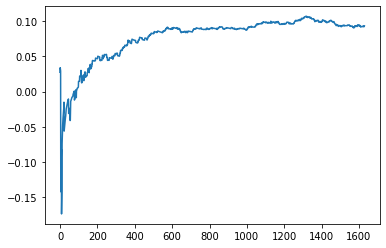

Thread: 2 iteration: 290
RAM mDiffFit_338 FROM: 640 --> 1152 reward: -0.0200103984375
Thread: 5 iteration: 302
RAM mDiffFit_279 FROM: 2816 --> 2944 reward: 0.006593760937500005
Thread: 3 iteration: 248
RAM mDiffFit_19 FROM: 448 --> 1152 reward: -0.060148429296875
Thread: 1 iteration: 262
RAM mDiffFit_33 FROM: 896 --> 1152 reward: 0.018687521875000012
Thread: 4 iteration: 264
RAM mProject_54 FROM: 1408 --> 1728 reward: -0.04372356536718743
Thread: 6 iteration: 267
RAM mDiffFit_124 FROM: 1024 --> 1152 reward: 0.04596358359375
Thread: 5 iteration: 303
RAM mDiffFit_391 FROM: 576 --> 1152 reward: -0.209257853515625
Thread: 3 iteration: 249
RAM mBackground_20 FROM: 1216 --> 2304 reward: -0.01618540996093749
Thread: 4 iteration: 265
RAM mDiffFit_194 FROM: 1536 --> 2496 reward: 0.021218804687500002
Thread: 6 iteration: 268
RAM mDiffFit_285 FROM: 2240 --> 2496 reward: -0.04585942421874999
Thread: 5 iteration: 304
RAM mDiffFit_283 FROM: 1344 --> 2624 reward: -0.029117190234375003
Saving ...


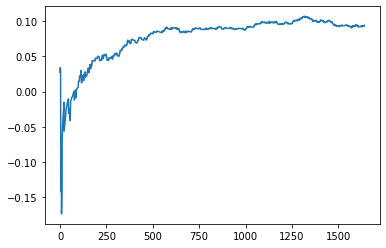

Thread: 3 iteration: 250
RAM mDiffFit_362 FROM: 2496 --> 2496 reward: -0.09144541914062497
Thread: 4 iteration: 266
RAM mDiffFit_9 FROM: 2816 --> 640 reward: 0.08409893828125001
Thread: 6 iteration: 269
RAM mDiffFit_410 FROM: 1600 --> 2496 reward: -0.05166931367187501
Thread: 5 iteration: 305
RAM mDiffFit_222 FROM: 1408 --> 2496 reward: 0.0022135835937499987
Thread: 3 iteration: 251
RAM mDiffFit_304 FROM: 704 --> 1152 reward: 0.014890663281250001
Thread: 4 iteration: 267
RAM mBackground_77 FROM: 1920 --> 2304 reward: 0.047515075249999976
Saving ...


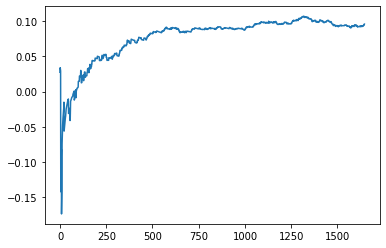

Thread: 6 iteration: 270
RAM mProject_83 FROM: 1856 --> 1280 reward: 0.10834591092187489
Thread: 1 iteration: 263
RAM mDiffFit_148 FROM: 1984 --> 2944 reward: -0.003994778906249996
Thread: 4 iteration: 268
RAM mBackground_34 FROM: 896 --> 2304 reward: -0.04225187726562507
Thread: 6 iteration: 271
RAM mDiffFit_216 FROM: 1280 --> 2688 reward: -0.03704168125000001
Thread: 3 iteration: 252
RAM mDiffFit_59 FROM: 512 --> 2624 reward: -0.15307805390625
Thread: 1 iteration: 264
RAM mImgtbl_1 FROM: 192 --> 704 reward: 0.72354208375
Thread: 2 iteration: 291
RAM mDiffFit_39 FROM: 448 --> 1152 reward: -0.015367146484374997
Thread: 6 iteration: 272
RAM mBackground_31 FROM: 448 --> 2304 reward: -0.3767919148906249
Thread: 4 iteration: 269
RAM mDiffFit_55 FROM: 320 --> 1152 reward: 0.015718804687499983
Thread: 3 iteration: 253
RAM mBackground_88 FROM: 2816 --> 1984 reward: -0.08023544889062499
Thread: 1 iteration: 265
RAM mDiffFit_323 FROM: 1280 --> 2688 reward: -0.08652084062499998
Thread: 2 iterati

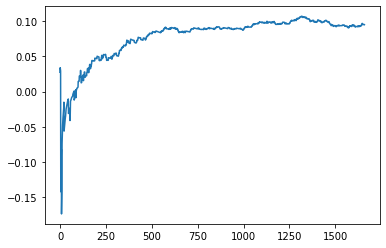

Thread: 4 iteration: 270
RAM mBackground_17 FROM: 1152 --> 2304 reward: 0.025907612874999982
Thread: 3 iteration: 254
RAM mDiffFit_75 FROM: 896 --> 2880 reward: -0.019385398437499993
Thread: 1 iteration: 266
RAM mDiffFit_125 FROM: 512 --> 1152 reward: -0.024776017968749994
Thread: 6 iteration: 274
RAM mDiffFit_10 FROM: 768 --> 2624 reward: -0.12661451406249996
Thread: 5 iteration: 307
RAM mBackground_58 FROM: 1600 --> 1984 reward: 0.003182475351562465
Thread: 2 iteration: 293
RAM mDiffFit_347 FROM: 2240 --> 2880 reward: -0.04660420312500002
Thread: 4 iteration: 271
RAM mDiffFit_160 FROM: 128 --> 2112 reward: -0.769875
Thread: 5 iteration: 308
RAM mDiffFit_301 FROM: 2816 --> 2880 reward: 0.00511719023437501
Thread: 2 iteration: 294
RAM mDiffFit_224 FROM: 2496 --> 2880 reward: 0.004328141406250013
Thread: 4 iteration: 272
RAM mDiffFit_232 FROM: 576 --> 1152 reward: -0.011468717187499994
Thread: 4 iteration: 273
RAM mDiffFit_420 FROM: 256 --> 2624 reward: -0.160179580859375
Thread: 2 iter

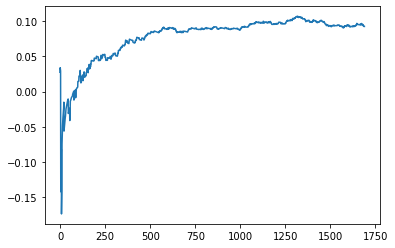

Thread: 1 iteration: 270
RAM mDiffFit_105 FROM: 640 --> 2880 reward: -0.10491404882812498
Thread: 2 iteration: 299
RAM mDiffFit_247 FROM: 2944 --> 2880 reward: 0.026184933203125
Thread: 6 iteration: 277
RAM mDiffFit_301 FROM: 1024 --> 1152 reward: 0.009057300781250017
Thread: 4 iteration: 278
RAM mDiffFit_65 FROM: 704 --> 1152 reward: -0.054851570703125
Saving ...


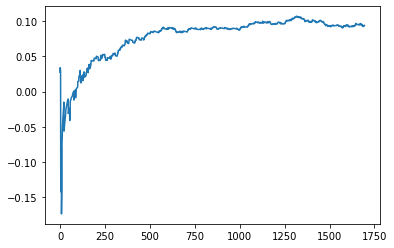

Thread: 2 iteration: 300
RAM mDiffFit_137 FROM: 2304 --> 2944 reward: -0.01685938046875
Thread: 4 iteration: 279
RAM mDiffFit_107 FROM: 2112 --> 2944 reward: -0.005015619531250001
Thread: 2 iteration: 301
RAM mProject_50 FROM: 320 --> 1088 reward: 0.8218646928281251
Saving ...


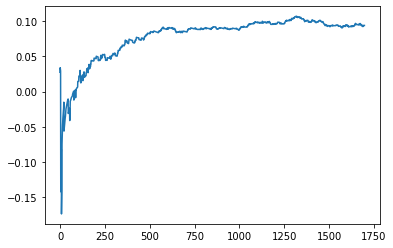

Thread: 5 iteration: 310
RAM mBackground_85 FROM: 1216 --> 2944 reward: -0.020480882195312473
Thread: 6 iteration: 278
RAM mDiffFit_420 FROM: 896 --> 1152 reward: -0.03564584062500001
Thread: 2 iteration: 302
RAM mProject_61 FROM: 1664 --> 2624 reward: 0.10128683320312497
Thread: 3 iteration: 259
RAM mProject_6 FROM: 3008 --> 1728 reward: -0.20730981009375007
Thread: 1 iteration: 271
RAM mDiffFit_345 FROM: 1600 --> 1152 reward: -0.023710994921875006
Thread: 5 iteration: 311
RAM mDiffFit_174 FROM: 192 --> 1152 reward: -0.4361797121093751
Thread: 2 iteration: 303
RAM mDiffFit_415 FROM: 2496 --> 2880 reward: 0.009328141406250018
Saving ...


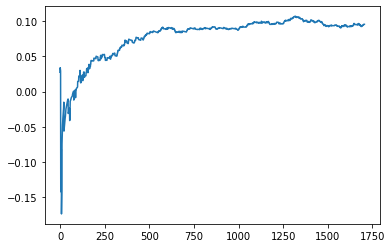

Thread: 3 iteration: 260
RAM mDiffFit_11 FROM: 2496 --> 2880 reward: 0.0030781414062500123
Thread: 1 iteration: 272
RAM mDiffFit_332 FROM: 704 --> 1152 reward: -0.08092971210937497
Thread: 5 iteration: 312
RAM mDiffFit_293 FROM: 1408 --> 2880 reward: -0.014231748046875
Thread: 2 iteration: 304
RAM mDiffFit_78 FROM: 960 --> 2880 reward: 0.015179755859375003
Thread: 1 iteration: 273
RAM mBackground_86 FROM: 192 --> 1216 reward: -0.7933902983906249
Thread: 3 iteration: 261
RAM mProject_9 FROM: 2688 --> 1728 reward: -0.10914355835156248
Thread: 6 iteration: 279
RAM mDiffFit_287 FROM: 2816 --> 640 reward: 0.08884893828125003
Thread: 5 iteration: 313
RAM mProject_42 FROM: 2368 --> 1024 reward: 0.12330072717187492
Saving ...


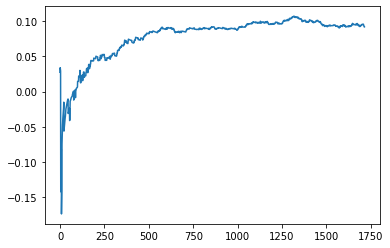

Thread: 4 iteration: 280
RAM mDiffFit_181 FROM: 1024 --> 1152 reward: 0.00180730078125
Thread: 3 iteration: 262
RAM mDiffFit_189 FROM: 1472 --> 2944 reward: 0.00796358359374999
Saving ...


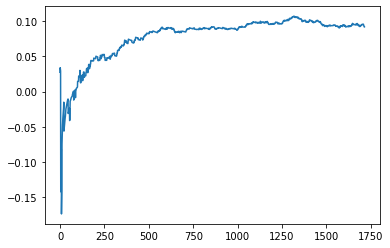

Thread: 6 iteration: 280
RAM mDiffFit_58 FROM: 512 --> 1152 reward: -0.11425522109375
Thread: 5 iteration: 314
RAM mBackground_25 FROM: 1600 --> 2944 reward: 0.06207915542968751
Thread: 1 iteration: 274
RAM mDiffFit_360 FROM: 960 --> 2880 reward: -0.0004061953124999927
Thread: 4 iteration: 281
RAM mDiffFit_173 FROM: 1152 --> 2880 reward: 0.03614070703125
Thread: 6 iteration: 281
RAM mDiffFit_249 FROM: 512 --> 1152 reward: -0.10350522109375003
Thread: 6 iteration: 282
RAM mBackground_89 FROM: 576 --> 1984 reward: -0.15778083289843747
Thread: 4 iteration: 282
RAM mBackground_27 FROM: 192 --> 320 reward: -0.2657892410468749
Thread: 3 iteration: 263
RAM mDiffFit_246 FROM: 640 --> 1152 reward: -0.08411460156250002
Thread: 6 iteration: 283
RAM mDiffFit_274 FROM: 1408 --> 2880 reward: -0.008356748046875005
Thread: 4 iteration: 283
RAM mBackground_62 FROM: 1408 --> 2944 reward: 0.03433294889062501
Thread: 3 iteration: 264
RAM mProject_40 FROM: 2752 --> 1728 reward: -0.15301111085156263
Thread:

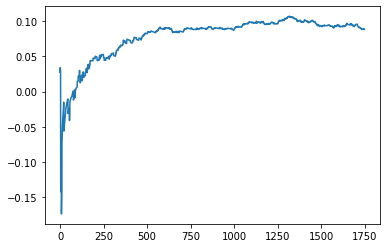

Thread: 5 iteration: 320
RAM mDiffFit_221 FROM: 960 --> 2880 reward: 0.006843804687500007
Thread: 6 iteration: 287
RAM mProject_4 FROM: 640 --> 640 reward: -1.0
Thread: 3 iteration: 267
RAM mBackground_14 FROM: 1280 --> 2944 reward: 0.0017425259531250418
Saving ...


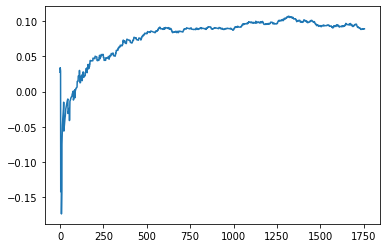

Thread: 4 iteration: 290
RAM mProject_30 FROM: 1600 --> 1728 reward: -0.021031869093750055
Thread: 2 iteration: 309
RAM mDiffFit_242 FROM: 1216 --> 2880 reward: 0.012388074609374997
Thread: 6 iteration: 288
RAM mDiffFit_401 FROM: 1024 --> 2880 reward: -0.02110152695312501
Thread: 3 iteration: 268
RAM mDiffFit_235 FROM: 2368 --> 384 reward: 0.09508327499999998
Thread: 5 iteration: 321
RAM mDiffFit_63 FROM: 832 --> 2688 reward: -0.05580725703125001
Saving ...


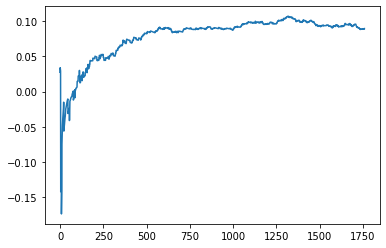

Thread: 2 iteration: 310
RAM mDiffFit_365 FROM: 1792 --> 2944 reward: 0.0019739820312499913
Thread: 6 iteration: 289
RAM mDiffFit_285 FROM: 1536 --> 2944 reward: -0.025671858593749996
Thread: 3 iteration: 269
RAM mDiffFit_156 FROM: 1024 --> 2688 reward: -0.015796814843750014
Thread: 5 iteration: 322
RAM mProject_86 FROM: 2048 --> 1728 reward: -0.005492874515625024
Thread: 1 iteration: 279
RAM mDiffFit_404 FROM: 320 --> 2944 reward: -0.286104159375
Thread: 2 iteration: 311
RAM mDiffFit_212 FROM: 512 --> 256 reward: 0.22267707968750006
Thread: 4 iteration: 291
RAM mBackground_1 FROM: 2624 --> 1984 reward: 0.005581019718749957
Saving ...


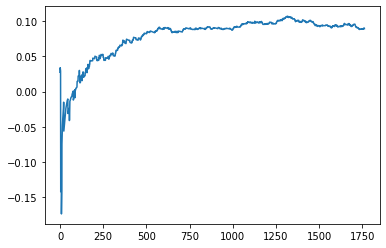

Thread: 1 iteration: 280
RAM mDiffFit_280 FROM: 3008 --> 2624 reward: -0.07402614921874996
Thread: 5 iteration: 323
RAM mDiffFit_158 FROM: 2432 --> 2624 reward: -0.014966172265624984
Thread: 4 iteration: 292
RAM mBackground_31 FROM: 256 --> 320 reward: -0.412598508046875
Thread: 2 iteration: 312
RAM mBackground_52 FROM: 1344 --> 2304 reward: -0.004158842757812533
Thread: 5 iteration: 324
RAM mProject_53 FROM: 2368 --> 2880 reward: 0.08520626749218754
Saving ...


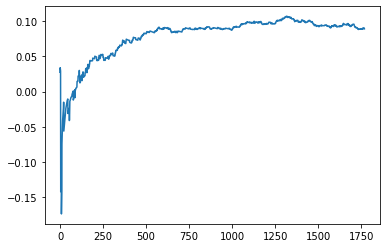

Thread: 6 iteration: 290
RAM mProject_37 FROM: 384 --> 2560 reward: 0.7511258925
Saving ...


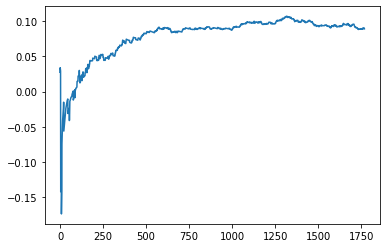

Thread: 3 iteration: 270
RAM mDiffFit_151 FROM: 1728 --> 2880 reward: 0.004929712109375001
Thread: 5 iteration: 325
RAM mDiffFit_234 FROM: 2368 --> 2880 reward: 0.008687521875000003
Thread: 6 iteration: 291
RAM mDiffFit_83 FROM: 1408 --> 2880 reward: -0.086041725
Thread: 3 iteration: 271
RAM mDiffFit_301 FROM: 1280 --> 2880 reward: 0.014083406250000007
Thread: 2 iteration: 313
RAM mProject_6 FROM: 1664 --> 1728 reward: -0.02626970160937493
Thread: 1 iteration: 281
RAM mProject_89 FROM: 320 --> 2560 reward: 0.7685071621875
Thread: 4 iteration: 293
RAM mDiffFit_362 FROM: 1920 --> 2880 reward: 0.012007853515624998
Thread: 6 iteration: 292
RAM mDiffFit_200 FROM: 768 --> 2752 reward: -0.037887899609375005
Thread: 2 iteration: 314
RAM mDiffFit_186 FROM: 1152 --> 2688 reward: -0.009531239062500006
Thread: 1 iteration: 282
RAM mDiffFit_414 FROM: 2752 --> 384 reward: 0.11524214648437503
Thread: 4 iteration: 294
RAM mDiffFit_169 FROM: 2496 --> 832 reward: 0.018976526953125
Thread: 3 iteration: 2

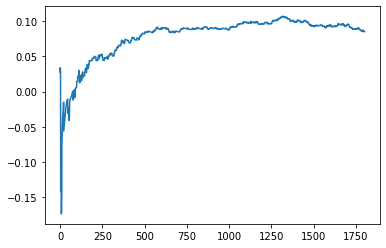

Thread: 4 iteration: 300
RAM mDiffFit_88 FROM: 1152 --> 2688 reward: 0.010515707031249974
Thread: 3 iteration: 278
RAM mDiffFit_207 FROM: 832 --> 2880 reward: -0.030947876562500004
Thread: 2 iteration: 317
RAM mConcatFit_2 FROM: 2624 --> 256 reward: 0.5540353459374998
Thread: 6 iteration: 297
RAM mBackground_28 FROM: 704 --> 2304 reward: -0.11910543460937503
Thread: 4 iteration: 301
RAM mDiffFit_90 FROM: 192 --> 2688 reward: -0.40126557578125
Thread: 3 iteration: 279
RAM mDiffFit_212 FROM: 1792 --> 2496 reward: 0.009039092578124984
Thread: 2 iteration: 318
RAM mDiffFit_397 FROM: 1792 --> 2944 reward: 0.02735942421875
Thread: 6 iteration: 298
RAM mProject_10 FROM: 2432 --> 2176 reward: -0.06486198721875
Thread: 1 iteration: 284
RAM mDiffFit_51 FROM: 768 --> 2496 reward: -0.01161714648437501
Saving ...


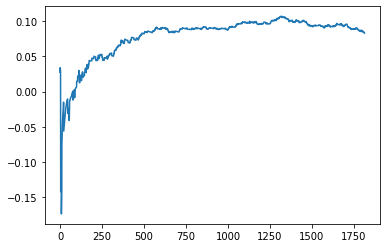

Thread: 3 iteration: 280
RAM mDiffFit_274 FROM: 2560 --> 2944 reward: 0.00907814140625001
Thread: 2 iteration: 319
RAM mDiffFit_408 FROM: 1920 --> 2944 reward: -0.005171858593749981
Thread: 6 iteration: 299
RAM mProject_41 FROM: 384 --> 640 reward: -1.0
Thread: 5 iteration: 329
RAM mDiffFit_136 FROM: 2944 --> 2496 reward: -0.07049749882812503
Thread: 3 iteration: 281
RAM mDiffFit_27 FROM: 3008 --> 2880 reward: -0.0004843804687499828
Saving ...


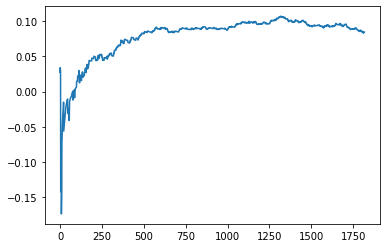

Thread: 2 iteration: 320
RAM mDiffFit_192 FROM: 1152 --> 2688 reward: -0.052125000000000005
Saving ...


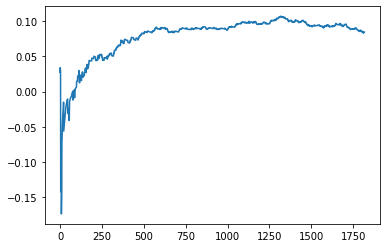

Thread: 6 iteration: 300
RAM mDiffFit_112 FROM: 1024 --> 2880 reward: -0.012601526953125008
Saving ...


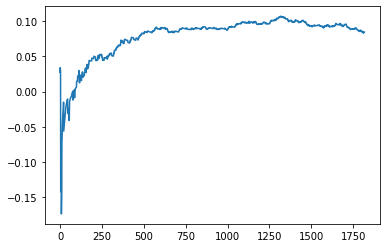

Thread: 5 iteration: 330
RAM mDiffFit_202 FROM: 1600 --> 2496 reward: 0.004122411328124995
Thread: 3 iteration: 282
RAM mDiffFit_244 FROM: 2432 --> 2496 reward: 0.0006979203124999993
Thread: 2 iteration: 321
RAM mDiffFit_364 FROM: 3008 --> 2624 reward: -0.07029176874999998
Thread: 5 iteration: 331
RAM mDiffFit_270 FROM: 2560 --> 2624 reward: 0.010065110546875027
Thread: 6 iteration: 301
RAM mProject_29 FROM: 1664 --> 1728 reward: -0.044031125742187545
Thread: 1 iteration: 285
RAM mDiffFit_405 FROM: 2688 --> 2688 reward: -0.07228132656249998
Thread: 3 iteration: 283
RAM mProject_80 FROM: 448 --> 640 reward: -1.0
Thread: 4 iteration: 302
RAM mDiffFit_201 FROM: 2368 --> 2688 reward: 0.009239601562499988
Thread: 5 iteration: 332
RAM mDiffFit_152 FROM: 640 --> 1152 reward: -0.0878854421875
Thread: 6 iteration: 302
RAM mDiffFit_377 FROM: 768 --> 1152 reward: -0.03898438046875001
Thread: 2 iteration: 322
RAM mDiffFit_407 FROM: 2880 --> 832 reward: -0.03253395898437501
Thread: 2 iteration: 323

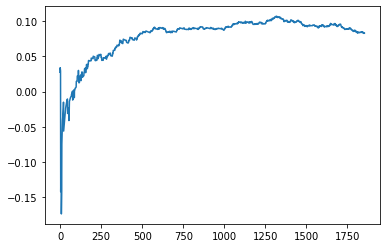

Thread: 1 iteration: 290
RAM mDiffFit_27 FROM: 832 --> 2688 reward: -0.036049447265625
Thread: 5 iteration: 337
RAM mBackground_77 FROM: 960 --> 2304 reward: -0.23369160482812504
Thread: 4 iteration: 306
RAM mDiffFit_93 FROM: 2432 --> 384 reward: 0.06629159375
Thread: 6 iteration: 307
RAM mDiffFit_13 FROM: 2944 --> 384 reward: 0.2795937609375
Thread: 2 iteration: 327
RAM mDiffFit_267 FROM: 2560 --> 2880 reward: 0.007960951171875012
Thread: 1 iteration: 291
RAM mDiffFit_145 FROM: 3008 --> 832 reward: -0.019005308593750027
Thread: 4 iteration: 307
RAM mDiffFit_30 FROM: 1792 --> 2944 reward: -0.0017760179687499947
Thread: 6 iteration: 308
RAM mDiffFit_369 FROM: 1728 --> 2944 reward: 0.026476614453124995
Thread: 4 iteration: 308
RAM mDiffFit_319 FROM: 3008 --> 640 reward: 0.08799736757812503
Thread: 1 iteration: 292
RAM mDiffFit_10 FROM: 2752 --> 256 reward: 0.41460929296875004
Thread: 2 iteration: 328
RAM mProject_68 FROM: 2816 --> 1280 reward: -0.06244723659374992
Thread: 3 iteration: 28

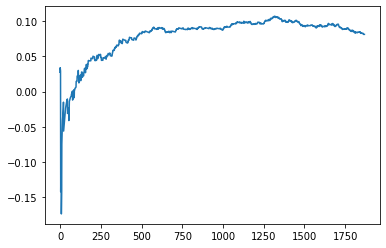

Thread: 2 iteration: 330
RAM mDiffFit_21 FROM: 768 --> 1152 reward: -0.14153132656249998
Saving ...


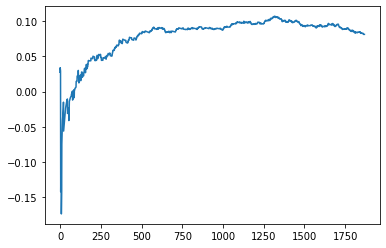

Thread: 4 iteration: 310
RAM mDiffFit_232 FROM: 640 --> 1152 reward: -0.037838539843749984
Thread: 5 iteration: 339
RAM mDiffFit_93 FROM: 2624 --> 2496 reward: -0.007734380468750017
Thread: 4 iteration: 311
RAM mBackground_1 FROM: 1792 --> 1984 reward: -0.013621144265625012
Thread: 1 iteration: 295
RAM mDiffFit_162 FROM: 2880 --> 640 reward: 0.025809845703125
Saving ...


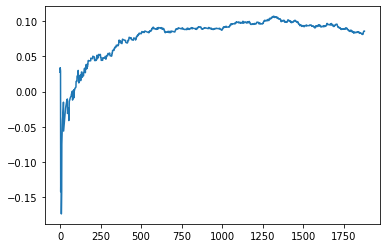

Thread: 5 iteration: 340
RAM mDiffFit_313 FROM: 704 --> 2624 reward: -0.09147389453124999
Thread: 1 iteration: 296
RAM mBackground_20 FROM: 1728 --> 1984 reward: -0.02655699014062501
Thread: 4 iteration: 312
RAM mDiffFit_414 FROM: 704 --> 1152 reward: -0.02770050898437501
Thread: 4 iteration: 313
RAM mProject_30 FROM: 2816 --> 2112 reward: -0.12260884099218745
Saving ...


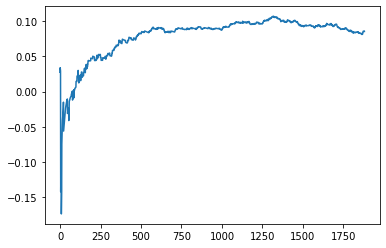

Thread: 6 iteration: 310
RAM mProject_90 FROM: 1536 --> 2624 reward: 0.09324263692968753
Thread: 2 iteration: 331
RAM mBackground_53 FROM: 1280 --> 2944 reward: 0.0022934587499999796
Thread: 5 iteration: 341
RAM mBackground_51 FROM: 320 --> 320 reward: -0.07195783601562501
Thread: 1 iteration: 297
RAM mDiffFit_121 FROM: 640 --> 1152 reward: -0.06155730078125001
Thread: 4 iteration: 314
RAM mDiffFit_144 FROM: 1856 --> 2880 reward: -0.05656515429687502
Thread: 6 iteration: 311
RAM mDiffFit_26 FROM: 1280 --> 2880 reward: -0.007174447265625005
Thread: 4 iteration: 315
RAM mDiffFit_260 FROM: 1856 --> 2880 reward: 0.025625043750000007
Thread: 1 iteration: 298
RAM mDiffFit_110 FROM: 896 --> 1152 reward: -0.032718760937499994
Thread: 5 iteration: 342
RAM mProject_68 FROM: 2624 --> 384 reward: -1.0
Thread: 3 iteration: 289
RAM mDiffFit_79 FROM: 960 --> 1152 reward: -0.050296902343749984
Thread: 6 iteration: 312
RAM mDiffFit_348 FROM: 2432 --> 2880 reward: -0.01724741132812499
Thread: 4 iteratio

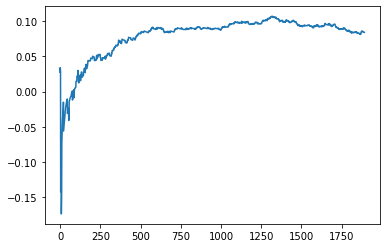

Thread: 3 iteration: 290
RAM mDiffFit_229 FROM: 1856 --> 2944 reward: -0.006848938281249998
Thread: 3 iteration: 291
RAM mDiffFit_183 FROM: 3008 --> 384 reward: 0.23508059882812504
Thread: 4 iteration: 317
RAM mBackground_80 FROM: 2624 --> 704 reward: 0.19999697716406242
Saving ...


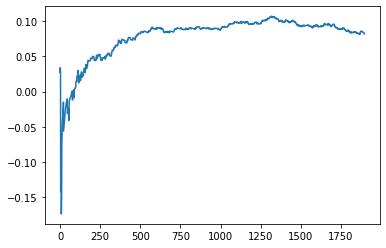

Thread: 1 iteration: 300
RAM mDiffFit_349 FROM: 1792 --> 2944 reward: -0.02766146015625
Thread: 3 iteration: 292
RAM mDiffFit_241 FROM: 1728 --> 2944 reward: 0.016226614453124996
Thread: 4 iteration: 318
RAM mDiffFit_358 FROM: 512 --> 2880 reward: -0.019906151562499967
Thread: 1 iteration: 301
RAM mDiffFit_253 FROM: 1408 --> 2688 reward: -0.006640575781250019
Thread: 4 iteration: 319
RAM mBackground_38 FROM: 2112 --> 704 reward: 0.15107776076562499
Thread: 3 iteration: 293
RAM mProject_2 FROM: 256 --> 2560 reward: 0.7727109187500001
Thread: 5 iteration: 344
RAM mDiffFit_257 FROM: 960 --> 2880 reward: -0.09608595117187502
Thread: 1 iteration: 302
RAM mDiffFit_293 FROM: 960 --> 2688 reward: -0.046179668359374995
Saving ...


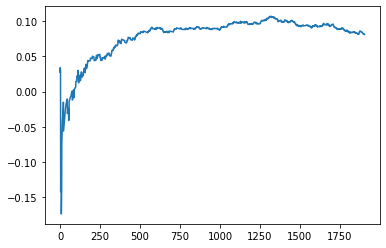

Thread: 4 iteration: 320
RAM mDiffFit_72 FROM: 2368 --> 384 reward: 0.013015488281249987
Thread: 3 iteration: 294
RAM mDiffFit_365 FROM: 2048 --> 2880 reward: 0.040156326562500025
Thread: 5 iteration: 345
RAM mDiffFit_119 FROM: 1920 --> 2880 reward: 0.029968804687500027
Thread: 1 iteration: 303
RAM mDiffFit_223 FROM: 1600 --> 2880 reward: 0.007825552734374991
Thread: 3 iteration: 295
RAM mBackground_63 FROM: 1024 --> 1984 reward: -0.25639655553125
Thread: 4 iteration: 321
RAM mProject_43 FROM: 512 --> 2560 reward: 0.7450321359375
Thread: 2 iteration: 332
RAM mDiffFit_26 FROM: 1024 --> 2880 reward: 0.01198183554687501
Thread: 1 iteration: 304
RAM mDiffFit_412 FROM: 1472 --> 2880 reward: -0.024385398437500004
Thread: 3 iteration: 296
RAM mDiffFit_366 FROM: 2240 --> 2880 reward: 0.007921902343750002
Thread: 2 iteration: 333
RAM mDiffFit_311 FROM: 1152 --> 2880 reward: 0.009085994921875003
Thread: 3 iteration: 297
RAM mDiffFit_89 FROM: 1088 --> 2880 reward: 0.007671946093750007
Thread: 3 i

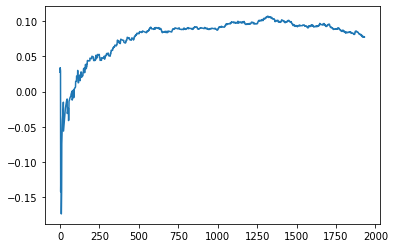

Thread: 3 iteration: 300
RAM mDiffFit_128 FROM: 1856 --> 2496 reward: -0.004736969140625002
Thread: 6 iteration: 315
RAM mDiffFit_137 FROM: 1088 --> 2496 reward: 0.020231835546875004
Thread: 1 iteration: 308
RAM mDiffFit_229 FROM: 1920 --> 2496 reward: -0.01786719023437501
Thread: 3 iteration: 301
RAM mDiffFit_402 FROM: 2688 --> 2496 reward: -0.004976570703125009
Thread: 6 iteration: 316
RAM mDiffFit_91 FROM: 192 --> 2880 reward: -0.24028119531249997
Thread: 6 iteration: 317
RAM mDiffFit_202 FROM: 2496 --> 256 reward: 0.335742190234375
Thread: 3 iteration: 302
RAM mDiffFit_183 FROM: 2816 --> 256 reward: 0.34430194843749995
Thread: 1 iteration: 309
RAM mDiffFit_33 FROM: 2240 --> 2496 reward: 0.005718760937499998
Thread: 6 iteration: 318
RAM mProject_24 FROM: 2880 --> 2880 reward: -0.005918913632812405
Thread: 2 iteration: 339
RAM mDiffFit_54 FROM: 1344 --> 2944 reward: -0.03015623906249999
Thread: 3 iteration: 303
RAM mDiffFit_148 FROM: 256 --> 256 reward: -0.16080212343750006
Saving ..

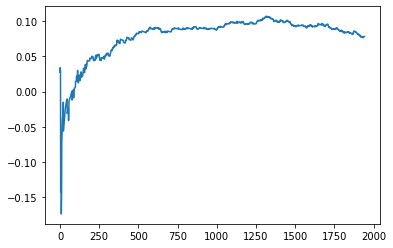

Thread: 1 iteration: 310
RAM mProject_77 FROM: 832 --> 896 reward: 0.9263790645468749
Saving ...


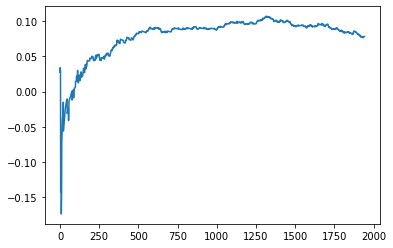

Thread: 5 iteration: 350
RAM mDiffFit_154 FROM: 2048 --> 2944 reward: 0.012265663281250012
Thread: 6 iteration: 319
RAM mDiffFit_74 FROM: 2368 --> 256 reward: 0.038421727343749996
Thread: 3 iteration: 304
RAM mDiffFit_84 FROM: 1792 --> 256 reward: 0.172104115625
Saving ...


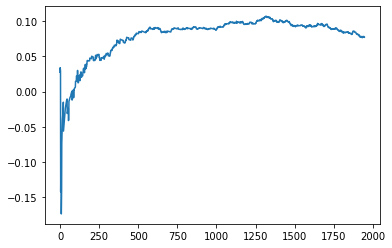

Thread: 2 iteration: 340
RAM mDiffFit_298 FROM: 832 --> 2688 reward: -0.03917444726562502
Saving ...


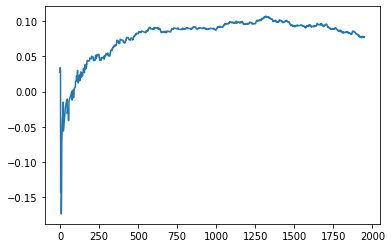

Thread: 6 iteration: 320
RAM mDiffFit_147 FROM: 1408 --> 2688 reward: 0.00613548593749999
Thread: 3 iteration: 305
RAM mDiffFit_323 FROM: 128 --> 2624 reward: -1.5411067480468748
Thread: 3 iteration: 306
RAM mDiffFit_40 FROM: 3008 --> 256 reward: 0.17022907187499997
Thread: 6 iteration: 321
RAM mProject_45 FROM: 512 --> 1792 reward: 0.6254668839375
Thread: 1 iteration: 311
RAM mProject_80 FROM: 2176 --> 2624 reward: 0.0832121941640624
Thread: 5 iteration: 351
RAM mDiffFit_375 FROM: 1984 --> 2880 reward: 0.035656326562500014
Thread: 6 iteration: 322
RAM mDiffFit_256 FROM: 512 --> 2688 reward: -0.08343225703125
Thread: 3 iteration: 307
RAM mProject_62 FROM: 2048 --> 2624 reward: 0.09544144556250005
Thread: 2 iteration: 341
RAM mBackground_30 FROM: 2368 --> 2944 reward: 0.009699676960937527
Thread: 5 iteration: 352
RAM mBackground_55 FROM: 2496 --> 2944 reward: -0.007952736117187522
Thread: 3 iteration: 308
RAM mDiffFit_137 FROM: 2944 --> 256 reward: 0.19451557578125
Thread: 6 iteration: 

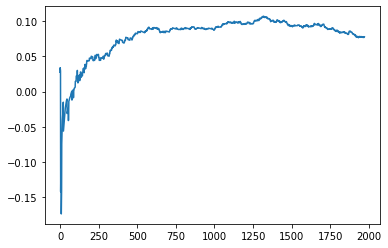

Thread: 3 iteration: 310
RAM mDiffFit_174 FROM: 1920 --> 2496 reward: 0.014054712109374985
Thread: 5 iteration: 355
RAM mDiffFit_249 FROM: 960 --> 2496 reward: 0.04062508750000002
Thread: 4 iteration: 324
RAM mDiffFit_91 FROM: 1536 --> 2496 reward: -0.022531239062499996
Thread: 6 iteration: 326
RAM mBackground_58 FROM: 1984 --> 2944 reward: 0.04276941619531254
Thread: 2 iteration: 345
RAM mDiffFit_139 FROM: 576 --> 2688 reward: -0.14524991250000002
Thread: 3 iteration: 311
RAM mDiffFit_329 FROM: 128 --> 256 reward: -0.5785208843749999
Thread: 4 iteration: 325
RAM mProject_80 FROM: 1280 --> 2624 reward: 0.01848919450781228
Thread: 1 iteration: 314
RAM mDiffFit_129 FROM: 1728 --> 2944 reward: 0.029226614453124994
Thread: 6 iteration: 327
RAM mDiffFit_208 FROM: 1984 --> 2944 reward: 0.021257853515625022
Thread: 3 iteration: 312
RAM mDiffFit_153 FROM: 1280 --> 2944 reward: 0.014057344531250016
Thread: 4 iteration: 326
RAM mDiffFit_319 FROM: 384 --> 2688 reward: -0.13359371718750002
Thread:

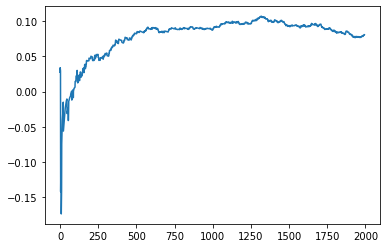

Thread: 6 iteration: 330
RAM mDiffFit_104 FROM: 1792 --> 2880 reward: 0.023367233984375
Thread: 5 iteration: 358
RAM mProject_62 FROM: 1408 --> 1280 reward: 0.028921866468750168
Thread: 4 iteration: 327
RAM mDiffFit_141 FROM: 384 --> 2688 reward: -0.07378119531250002
Thread: 6 iteration: 331
RAM mDiffFit_76 FROM: 448 --> 256 reward: -0.037947964062499985
Thread: 1 iteration: 318
RAM mDiffFit_389 FROM: 1088 --> 2688 reward: -0.07237236757812504
Thread: 5 iteration: 359
RAM mDiffFit_336 FROM: 1984 --> 2880 reward: -0.009111969140624988
Thread: 4 iteration: 328
RAM mDiffFit_386 FROM: 3008 --> 256 reward: 0.10733586367187503
Thread: 3 iteration: 316
RAM mProject_71 FROM: 1408 --> 2112 reward: -0.038926303382812485
Thread: 2 iteration: 347
RAM mBackground_54 FROM: 2432 --> 704 reward: 0.13085878048437496
Saving ...


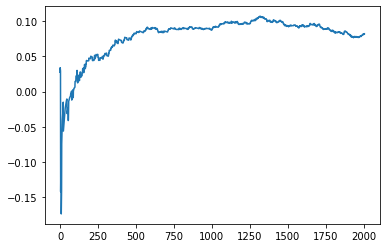

Thread: 5 iteration: 360
RAM mBackground_77 FROM: 2688 --> 704 reward: 0.069144724953125
Thread: 4 iteration: 329
RAM mBackground_54 FROM: 1728 --> 704 reward: 0.200509913078125
Thread: 2 iteration: 348
RAM mDiffFit_81 FROM: 384 --> 2944 reward: -0.14310933671875
Thread: 2 iteration: 349
RAM mBackground_79 FROM: 2944 --> 704 reward: 0.09746205110937503
Saving ...


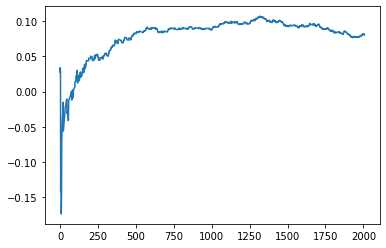

Thread: 4 iteration: 330
RAM mDiffFit_128 FROM: 192 --> 2688 reward: -0.24225776601562504
Thread: 4 iteration: 331
RAM mDiffFit_176 FROM: 1024 --> 256 reward: 0.12436455781249997
Saving ...


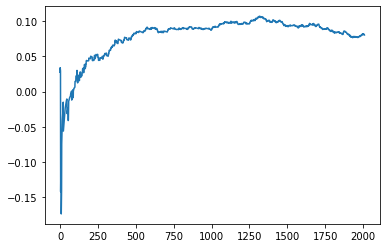

Thread: 2 iteration: 350
RAM mAdd_2 FROM: 192 --> 704 reward: 0.7565668423828126
Thread: 5 iteration: 361
RAM mDiffFit_282 FROM: 960 --> 2688 reward: -0.017289005078125006
Thread: 2 iteration: 351
RAM mDiffFit_21 FROM: 1344 --> 2944 reward: -0.011585907421875
Thread: 5 iteration: 362
RAM mDiffFit_382 FROM: 2432 --> 256 reward: 0.34529159375
Thread: 4 iteration: 332
RAM mProject_43 FROM: 2048 --> 1088 reward: 0.15784491600000003
Thread: 1 iteration: 319
RAM mProject_78 FROM: 1472 --> 1088 reward: 0.1324270314140625
Thread: 6 iteration: 332
RAM mProject_1 FROM: 2944 --> 1088 reward: -0.006598058695312569
Thread: 3 iteration: 317
RAM mDiffFit_42 FROM: 2304 --> 2880 reward: 0.019804712109375004
Thread: 2 iteration: 352
RAM mDiffFit_331 FROM: 2112 --> 2944 reward: -0.004890619531249998
Thread: 5 iteration: 363
RAM mDiffFit_227 FROM: 1216 --> 2624 reward: 0.029328185156250013
Thread: 6 iteration: 333
RAM mDiffFit_353 FROM: 2432 --> 2624 reward: 0.007101570703125001
Thread: 3 iteration: 318
R

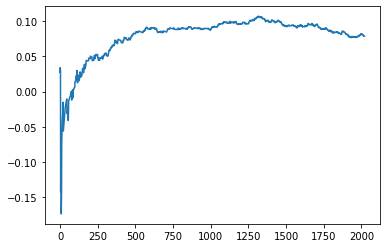

Thread: 1 iteration: 320
RAM mImgtbl_2 FROM: 3008 --> 704 reward: 0.07287887062499993
Thread: 5 iteration: 364
RAM mDiffFit_228 FROM: 2624 --> 1088 reward: 0.041989557812499995
Thread: 3 iteration: 319
RAM mDiffFit_247 FROM: 2752 --> 1088 reward: 0.057315110546875006
Thread: 6 iteration: 334
RAM mDiffFit_11 FROM: 1920 --> 1088 reward: 0.024346349609374984
Thread: 2 iteration: 354
RAM mDiffFit_287 FROM: 1664 --> 1088 reward: 0.043687521875000024
Thread: 1 iteration: 321
RAM mDiffFit_112 FROM: 1728 --> 1088 reward: -0.0022890925781249988
Thread: 5 iteration: 365
RAM mDiffFit_272 FROM: 1920 --> 2752 reward: 0.12873714414062498
Saving ...


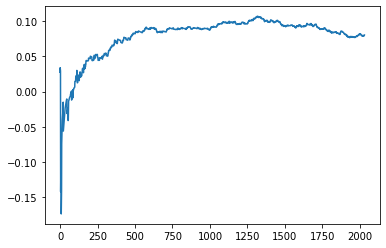

Thread: 3 iteration: 320
RAM mDiffFit_32 FROM: 960 --> 2880 reward: -0.010492146484375013
Thread: 5 iteration: 366
RAM mDiffFit_328 FROM: 2304 --> 2752 reward: 0.08114856054687505
Thread: 2 iteration: 355
RAM mProject_19 FROM: 448 --> 768 reward: -1.0
Thread: 4 iteration: 333
RAM mDiffFit_134 FROM: 1280 --> 2944 reward: -0.06627606171874997
Thread: 5 iteration: 367
RAM mDiffFit_291 FROM: 640 --> 1088 reward: -0.11599741132812494
Thread: 3 iteration: 321
RAM mDiffFit_301 FROM: 320 --> 1088 reward: -0.20886460156250003
Thread: 4 iteration: 334
RAM mBackground_47 FROM: 896 --> 192 reward: 0.8624814802812498
Thread: 6 iteration: 335
RAM mDiffFit_367 FROM: 1600 --> 2880 reward: 0.03745840625000002
Thread: 4 iteration: 335
RAM mDiffFit_247 FROM: 1728 --> 256 reward: 0.195596349609375
Thread: 5 iteration: 368
RAM mDiffFit_352 FROM: 2560 --> 256 reward: 0.3233020796875
Thread: 3 iteration: 322
RAM mBackground_69 FROM: 640 --> 768 reward: -0.0037535197187499787
Thread: 6 iteration: 336
RAM mDif

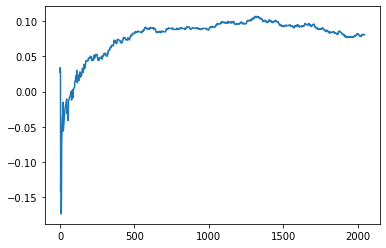

Thread: 5 iteration: 370
RAM mDiffFit_401 FROM: 1600 --> 2624 reward: 0.008648473046875028
Thread: 6 iteration: 338
RAM mBackground_69 FROM: 448 --> 768 reward: -0.1273337311875
Thread: 4 iteration: 337
RAM mDiffFit_373 FROM: 2560 --> 2624 reward: 0.008367190234375016
Thread: 3 iteration: 325
RAM mDiffFit_213 FROM: 2624 --> 2624 reward: 0.00025000000000000716
Thread: 2 iteration: 357
RAM mDiffFit_247 FROM: 192 --> 1088 reward: -0.2587916375
Thread: 5 iteration: 371
RAM mDiffFit_159 FROM: 256 --> 1088 reward: -0.4154635835937501
Thread: 6 iteration: 339
RAM mDiffFit_117 FROM: 192 --> 1088 reward: -0.24706247812500004
Thread: 4 iteration: 338
RAM mDiffFit_201 FROM: 1344 --> 384 reward: 0.050492102734375
Thread: 1 iteration: 323
RAM mDiffFit_101 FROM: 2304 --> 384 reward: 0.13431247812500002
Thread: 3 iteration: 326
RAM mBackground_7 FROM: 2752 --> 1088 reward: -0.025887501304687525
Thread: 2 iteration: 358
RAM mDiffFit_421 FROM: 2176 --> 2880 reward: -0.013218760937500004
Thread: 1 itera

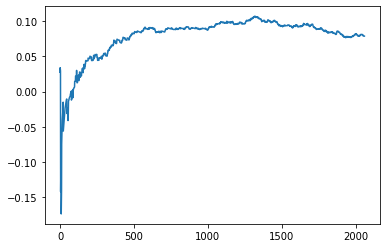

Thread: 6 iteration: 340
RAM mDiffFit_280 FROM: 2496 --> 384 reward: 0.32432814140625
Thread: 5 iteration: 372
RAM mDiffFit_297 FROM: 1856 --> 2880 reward: -0.053898473046875006
Thread: 4 iteration: 339
RAM mBackground_69 FROM: 1152 --> 1088 reward: -0.012006418007812464
Thread: 3 iteration: 327
RAM mDiffFit_84 FROM: 2816 --> 256 reward: 0.11710407187500001
Thread: 2 iteration: 359
RAM mDiffFit_27 FROM: 2816 --> 256 reward: 0.14795827499999997
Thread: 6 iteration: 341
RAM mAdd_3 FROM: 2496 --> 2944 reward: -0.10248576230468757
Thread: 5 iteration: 373
RAM mDiffFit_290 FROM: 2560 --> 384 reward: 0.10796345234374997
Saving ...


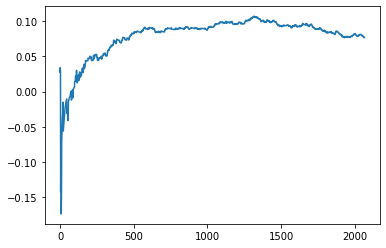

Thread: 4 iteration: 340
RAM mDiffFit_214 FROM: 192 --> 1088 reward: -0.35638022109375
Thread: 3 iteration: 328
RAM mDiffFit_223 FROM: 768 --> 2624 reward: -0.0012915937499999655
Saving ...


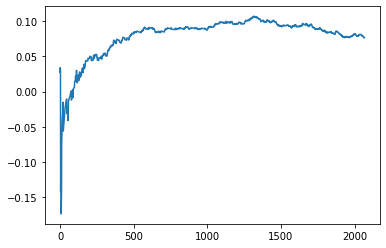

Thread: 2 iteration: 360
RAM mDiffFit_32 FROM: 2944 --> 640 reward: 0.07055725703125
Thread: 6 iteration: 342
RAM mDiffFit_203 FROM: 1472 --> 2624 reward: -0.007872367578125004
Thread: 3 iteration: 329
RAM mDiffFit_345 FROM: 1920 --> 2624 reward: 0.027953185156250008
Thread: 4 iteration: 341
RAM mDiffFit_66 FROM: 320 --> 1152 reward: -0.18682814140625004
Thread: 2 iteration: 361
RAM mBackground_33 FROM: 1216 --> 1088 reward: -0.007242836015624984
Thread: 6 iteration: 343
RAM mBackground_1 FROM: 1152 --> 1088 reward: 0.005583283601562512
Saving ...


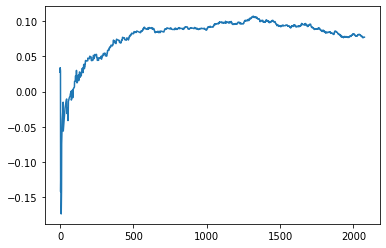

Thread: 3 iteration: 330
RAM mDiffFit_32 FROM: 1984 --> 2944 reward: 0.02613285351562502
Thread: 4 iteration: 342
RAM mDiffFit_137 FROM: 2624 --> 256 reward: 0.11437491249999998
Thread: 6 iteration: 344
RAM mProject_57 FROM: 1664 --> 2624 reward: 0.09356229653906253
Thread: 5 iteration: 374
RAM mDiffFit_385 FROM: 1280 --> 2944 reward: 0.02340632656250001
Thread: 2 iteration: 362
RAM mProject_16 FROM: 448 --> 768 reward: -1.0
Thread: 1 iteration: 325
RAM mDiffFit_47 FROM: 2816 --> 256 reward: 0.06671854218749998
Thread: 3 iteration: 331
RAM mBackground_8 FROM: 1152 --> 1088 reward: -0.009318918007812491
Thread: 4 iteration: 343
RAM mDiffFit_276 FROM: 1664 --> 2944 reward: 0.024843804687500012
Thread: 5 iteration: 375
RAM mDiffFit_413 FROM: 2240 --> 256 reward: 0.12261714648437502
Thread: 2 iteration: 363
RAM mDiffFit_32 FROM: 704 --> 2880 reward: -0.15090887148437504
Thread: 3 iteration: 332
RAM mAdd_1 FROM: 2112 --> 2944 reward: 0.0371264255859375
Thread: 6 iteration: 345
RAM mConcatFi

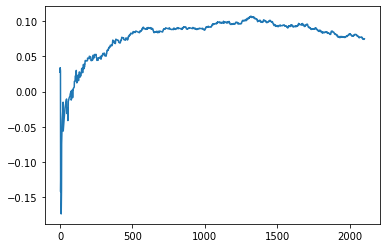

Thread: 6 iteration: 350
RAM mDiffFit_63 FROM: 1600 --> 2944 reward: 0.0376563265625
Thread: 3 iteration: 337
RAM mProject_32 FROM: 192 --> 768 reward: -1.0
Thread: 2 iteration: 364
RAM mDiffFit_228 FROM: 576 --> 1152 reward: -0.06872657070312499
Thread: 6 iteration: 351
RAM mDiffFit_100 FROM: 2368 --> 256 reward: 0.096679580859375
Thread: 3 iteration: 338
RAM mBackground_63 FROM: 2048 --> 1088 reward: 0.062811318109375
Thread: 2 iteration: 365
RAM mDiffFit_15 FROM: 256 --> 1152 reward: -0.17349477890624998
Thread: 6 iteration: 352
RAM mProject_50 FROM: 1280 --> 1728 reward: -0.1042874921249999
Thread: 4 iteration: 345
RAM mBackground_35 FROM: 2880 --> 1088 reward: -0.00838066035937503
Thread: 2 iteration: 366
RAM mDiffFit_51 FROM: 2624 --> 256 reward: 0.11028900507812497
Thread: 6 iteration: 353
RAM mBackground_30 FROM: 2624 --> 1088 reward: -0.010546319414062484
Thread: 4 iteration: 346
RAM mProject_70 FROM: 1728 --> 1728 reward: 0.005049848179687488
Saving ...


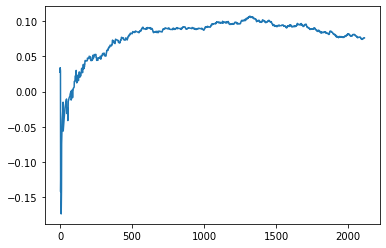

Thread: 5 iteration: 380
RAM mProject_27 FROM: 2304 --> 2880 reward: 0.08092142718750002
Thread: 1 iteration: 328
RAM mDiffFit_366 FROM: 576 --> 2880 reward: -0.033664005078125
Thread: 2 iteration: 367
RAM mDiffFit_143 FROM: 1920 --> 2624 reward: 0.017039092578125012
Thread: 6 iteration: 354
RAM mBackground_27 FROM: 2816 --> 1088 reward: -0.029876207843750016
Thread: 4 iteration: 347
RAM mProject_86 FROM: 1856 --> 2880 reward: 0.168222532359375
Thread: 3 iteration: 339
RAM mDiffFit_321 FROM: 1920 --> 256 reward: 0.15052601796875004
Thread: 5 iteration: 381
RAM mDiffFit_288 FROM: 1024 --> 2752 reward: 0.029552167187500006
Thread: 1 iteration: 329
RAM mDiffFit_89 FROM: 2624 --> 256 reward: 0.11649991249999997
Thread: 2 iteration: 368
RAM mDiffFit_171 FROM: 2368 --> 256 reward: 0.11021867343749998
Thread: 6 iteration: 355
RAM mDiffFit_400 FROM: 256 --> 2944 reward: -0.14679681484374996
Saving ...


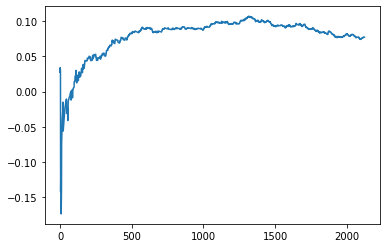

Thread: 3 iteration: 340
RAM mBackground_9 FROM: 2752 --> 1088 reward: -0.0167723767578125
Thread: 4 iteration: 348
RAM mDiffFit_371 FROM: 832 --> 2880 reward: -0.010648385546874993
Saving ...


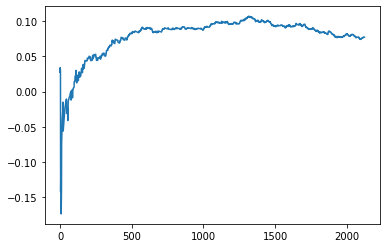

Thread: 1 iteration: 330
RAM mDiffFit_245 FROM: 192 --> 2624 reward: -0.11450250117187498
Thread: 6 iteration: 356
RAM mBackground_22 FROM: 2176 --> 768 reward: 0.11101161650000005
Thread: 5 iteration: 382
RAM mDiffFit_388 FROM: 1664 --> 2880 reward: -0.049320331640624986
Thread: 2 iteration: 369
RAM mDiffFit_288 FROM: 2304 --> 2624 reward: 0.00246095117187501
Thread: 4 iteration: 349
RAM mDiffFit_258 FROM: 2880 --> 2624 reward: -0.02697661445312501
Thread: 6 iteration: 357
RAM mBackground_17 FROM: 1664 --> 768 reward: 0.10887508692187502
Thread: 3 iteration: 341
RAM mDiffFit_420 FROM: 1472 --> 2624 reward: -0.0004973675781250013
Thread: 5 iteration: 383
RAM mDiffFit_200 FROM: 640 --> 2624 reward: -0.10098951406249994
Saving ...


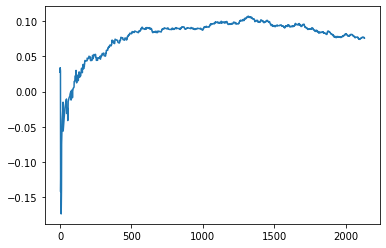

Thread: 2 iteration: 370
RAM mBackground_26 FROM: 192 --> 320 reward: -0.23930839517187494
Thread: 1 iteration: 331
RAM mDiffFit_25 FROM: 1088 --> 2496 reward: 0.018856835546875
Thread: 6 iteration: 358
RAM mDiffFit_236 FROM: 2944 --> 256 reward: 0.09488013359374999
Saving ...


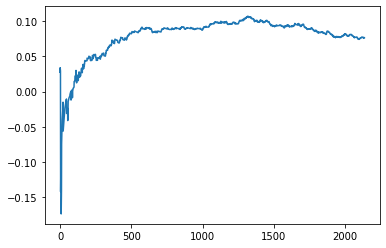

Thread: 4 iteration: 350
RAM mDiffFit_44 FROM: 2368 --> 256 reward: 0.125632766015625
Thread: 3 iteration: 342
RAM mBackground_79 FROM: 2752 --> 704 reward: 0.114809887125
Thread: 5 iteration: 384
RAM mDiffFit_282 FROM: 1472 --> 2944 reward: 0.03605216718750002
Thread: 2 iteration: 371
RAM mBackground_8 FROM: 2880 --> 704 reward: 0.073301416703125
Thread: 1 iteration: 332
RAM mDiffFit_123 FROM: 1792 --> 2944 reward: 0.09373973281250002
Thread: 4 iteration: 351
RAM mDiffFit_312 FROM: 2880 --> 2944 reward: -0.032184933203125016
Thread: 5 iteration: 385
RAM mDiffFit_423 FROM: 1344 --> 1088 reward: 0.00888280976562501
Thread: 2 iteration: 372
RAM mDiffFit_313 FROM: 832 --> 1088 reward: 0.0031067917968750566
Thread: 6 iteration: 359
RAM mDiffFit_19 FROM: 1536 --> 1088 reward: -0.037572964062499985
Thread: 1 iteration: 333
RAM mDiffFit_360 FROM: 1728 --> 1088 reward: -0.017104203124999995
Saving ...


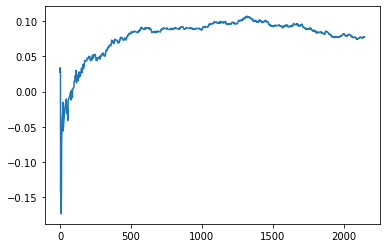

Thread: 6 iteration: 360
RAM mBackground_40 FROM: 1024 --> 1792 reward: -0.018418270625000004
Thread: 2 iteration: 373
RAM mDiffFit_13 FROM: 2368 --> 256 reward: 0.1419895140625
Thread: 5 iteration: 386
RAM mProject_15 FROM: 1472 --> 2624 reward: 0.09274108985156244
Thread: 3 iteration: 343
RAM mDiffFit_313 FROM: 2752 --> 256 reward: 0.31297385078125006
Thread: 1 iteration: 334
RAM mDiffFit_275 FROM: 1216 --> 2944 reward: -2.860664062499796e-05
Thread: 6 iteration: 361
RAM mProject_18 FROM: 960 --> 2560 reward: -0.13974302285156256
Thread: 4 iteration: 352
RAM mDiffFit_406 FROM: 2048 --> 256 reward: 0.13540619531249998
Thread: 5 iteration: 387
RAM mDiffFit_384 FROM: 2432 --> 256 reward: 0.2719478765625
Thread: 1 iteration: 335
RAM mDiffFit_343 FROM: 2304 --> 256 reward: 0.22115615156250001
Thread: 3 iteration: 344
RAM mImgtbl_1 FROM: 1408 --> 704 reward: 0.08837490375000001
Thread: 6 iteration: 362
RAM mDiffFit_369 FROM: 1536 --> 2624 reward: -0.002320287890624998
Thread: 5 iteration: 

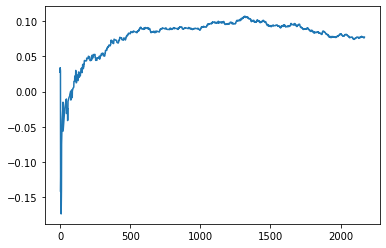

Thread: 5 iteration: 390
RAM mDiffFit_256 FROM: 1856 --> 2624 reward: -0.013684889453124995
Thread: 6 iteration: 365
RAM mDiffFit_290 FROM: 1024 --> 2624 reward: -0.00027860664062498777
Thread: 2 iteration: 376
RAM mBackground_74 FROM: 3008 --> 768 reward: 0.02758474960156252
Thread: 1 iteration: 338
RAM mDiffFit_40 FROM: 1984 --> 2624 reward: 0.043981835546875035
Thread: 3 iteration: 347
RAM mBackground_74 FROM: 320 --> 1792 reward: -0.5737162934609373
Thread: 4 iteration: 355
RAM mDiffFit_370 FROM: 576 --> 2688 reward: -0.022289005078124993
Thread: 6 iteration: 366
RAM mDiffFit_362 FROM: 256 --> 1088 reward: -0.40489066328124995
Thread: 1 iteration: 339
RAM mDiffFit_207 FROM: 2240 --> 256 reward: 0.1181145140625
Saving ...


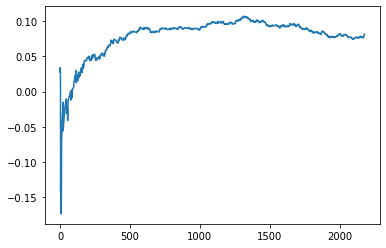

Thread: 1 iteration: 340
RAM mDiffFit_287 FROM: 896 --> 1152 reward: -0.021343760937499994
Thread: 1 iteration: 341
RAM mDiffFit_205 FROM: 2752 --> 256 reward: 0.13300254492187502
Thread: 1 iteration: 342
RAM mProject_24 FROM: 1600 --> 2624 reward: 0.1079852861250001
Thread: 5 iteration: 391
RAM mProject_13 FROM: 1920 --> 2624 reward: 0.11863805301562502
Thread: 3 iteration: 348
RAM mProject_62 FROM: 960 --> 2560 reward: -0.11820299660156236
Thread: 4 iteration: 356
RAM mDiffFit_304 FROM: 640 --> 1088 reward: -0.07895836249999999
Thread: 5 iteration: 392
RAM mProject_83 FROM: 1600 --> 2624 reward: 0.11143529662499997
Thread: 6 iteration: 367
RAM mDiffFit_103 FROM: 2880 --> 256 reward: 0.10249732382812501
Thread: 1 iteration: 343
RAM mDiffFit_106 FROM: 896 --> 2880 reward: 0.014250087500000015
Thread: 4 iteration: 357
RAM mBackground_32 FROM: 320 --> 1792 reward: -0.4599588803828125
Thread: 3 iteration: 349
RAM mDiffFit_293 FROM: 2368 --> 2624 reward: -0.01701825195312501
Thread: 1 iter

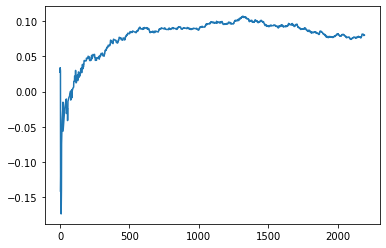

Thread: 3 iteration: 350
RAM mDiffFit_195 FROM: 576 --> 2752 reward: -0.04312495625000003
Thread: 1 iteration: 346
RAM mDiffFit_351 FROM: 896 --> 2752 reward: -0.03399736757812502
Saving ...


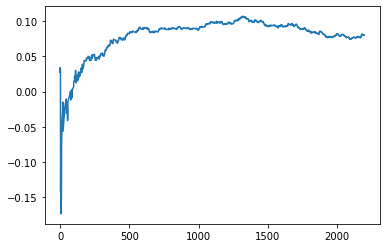

Thread: 4 iteration: 360
RAM mBackground_51 FROM: 1472 --> 1792 reward: 0.003536331085937496
Saving ...


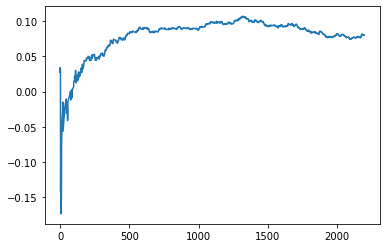

Thread: 6 iteration: 370
RAM mProject_25 FROM: 2304 --> 2560 reward: 0.04566946359374991
Thread: 5 iteration: 394
RAM mDiffFit_92 FROM: 1984 --> 2944 reward: -3.3827734374995005e-05
Thread: 3 iteration: 351
RAM mDiffFit_206 FROM: 640 --> 1088 reward: -0.028539048828124976
Thread: 6 iteration: 371
RAM mDiffFit_375 FROM: 896 --> 1088 reward: -0.027830730078124977
Thread: 4 iteration: 361
RAM mDiffFit_224 FROM: 1344 --> 2688 reward: -0.03175000000000001
Thread: 1 iteration: 347
RAM mDiffFit_189 FROM: 1984 --> 2944 reward: 0.08456002070312503
Thread: 5 iteration: 395
RAM mProject_44 FROM: 384 --> 768 reward: -1.0
Thread: 2 iteration: 377
RAM mBackground_86 FROM: 1536 --> 1792 reward: -0.0028487311874999797
Thread: 3 iteration: 352
RAM mDiffFit_260 FROM: 896 --> 1088 reward: -0.07355212343750002
Thread: 4 iteration: 362
RAM mDiffFit_344 FROM: 2048 --> 2880 reward: -0.062226614453124995
Thread: 5 iteration: 396
RAM mDiffFit_51 FROM: 192 --> 1088 reward: -0.628612056640625
Thread: 3 iteration

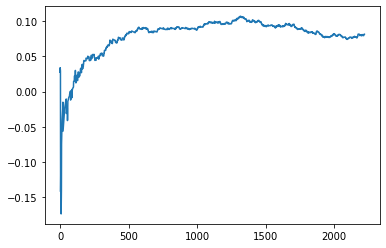

Thread: 5 iteration: 400
RAM mBackground_48 FROM: 1216 --> 768 reward: 0.09927177867187505
Thread: 3 iteration: 356
RAM mDiffFit_44 FROM: 768 --> 2944 reward: -0.15242190234374997
Thread: 6 iteration: 374
RAM mProject_46 FROM: 2560 --> 2176 reward: -0.07156326740625003
Saving ...


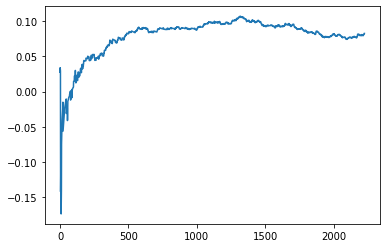

Thread: 2 iteration: 380
RAM mDiffFit_314 FROM: 768 --> 2944 reward: -0.02926557578124999
Thread: 5 iteration: 401
RAM mBackground_7 FROM: 2880 --> 704 reward: 0.07169336921874991
Thread: 4 iteration: 366
RAM mProject_80 FROM: 896 --> 1280 reward: -0.17947124606249976
Thread: 1 iteration: 349
RAM mDiffFit_112 FROM: 2688 --> 2944 reward: 0.00479168125000002
Thread: 6 iteration: 375
RAM mDiffFit_191 FROM: 2624 --> 2944 reward: -0.026723982031250024
Thread: 2 iteration: 381
RAM mDiffFit_421 FROM: 960 --> 2944 reward: 0.00808599492187501
Thread: 5 iteration: 402
RAM mDiffFit_334 FROM: 1088 --> 2624 reward: 0.012440154296875002
Thread: 4 iteration: 367
RAM mDiffFit_43 FROM: 1728 --> 2624 reward: -0.22140645781249996
Saving ...


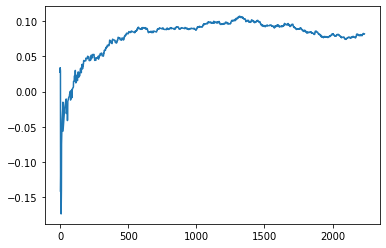

Thread: 1 iteration: 350
RAM mDiffFit_265 FROM: 2624 --> 2624 reward: -0.02468493320312501
Thread: 6 iteration: 376
RAM mDiffFit_203 FROM: 128 --> 2624 reward: -0.87643234453125
Thread: 3 iteration: 357
RAM mDiffFit_41 FROM: 2688 --> 2624 reward: -0.0019921902343749895
Thread: 2 iteration: 382
RAM mDiffFit_416 FROM: 2496 --> 2624 reward: -0.030664092578124996
Thread: 5 iteration: 403
RAM mDiffFit_392 FROM: 1728 --> 2624 reward: 0.01851566328125
Thread: 4 iteration: 368
RAM mDiffFit_100 FROM: 1920 --> 2624 reward: 0.03759902578125002
Thread: 1 iteration: 351
RAM mDiffFit_277 FROM: 192 --> 1088 reward: -0.47318493320312505
Thread: 3 iteration: 358
RAM mDiffFit_45 FROM: 768 --> 2624 reward: -0.09088280976562499
Thread: 2 iteration: 383
RAM mDiffFit_108 FROM: 1152 --> 2944 reward: 0.056791768750000006
Thread: 4 iteration: 369
RAM mBackground_77 FROM: 768 --> 768 reward: -0.048616903218749966
Thread: 6 iteration: 377
RAM mDiffFit_83 FROM: 2880 --> 640 reward: 0.07562500000000001
Thread: 3 i

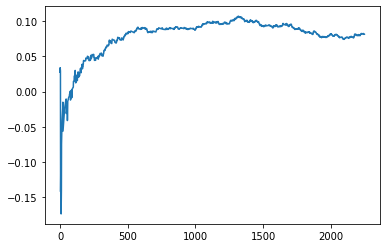

Thread: 4 iteration: 370
RAM mDiffFit_50 FROM: 512 --> 1088 reward: -0.15293752187499995
Saving ...


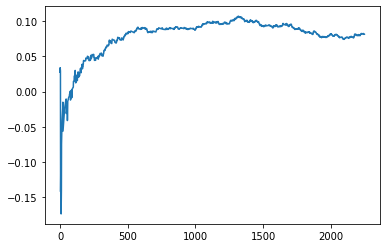

Thread: 3 iteration: 360
RAM mDiffFit_18 FROM: 128 --> 1088 reward: -0.7246484730468751
Thread: 2 iteration: 385
RAM mProject_6 FROM: 320 --> 1792 reward: 0.62278750434375
Thread: 1 iteration: 352
RAM mDiffFit_237 FROM: 1792 --> 2496 reward: -0.012846349609375012
Thread: 5 iteration: 405
RAM mDiffFit_152 FROM: 2176 --> 2496 reward: 0.0075859511718749835
Thread: 6 iteration: 379
RAM mDiffFit_265 FROM: 1856 --> 2496 reward: -0.03201044218750003
Thread: 4 iteration: 371
RAM mBackground_36 FROM: 2560 --> 768 reward: 0.09426844446874995
Thread: 3 iteration: 361
RAM mDiffFit_423 FROM: 2240 --> 2944 reward: -0.005536460156249992
Saving ...


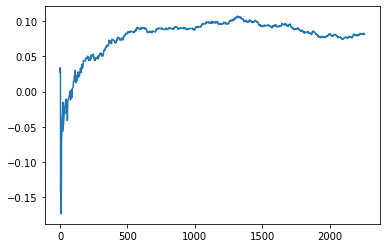

Thread: 6 iteration: 380
RAM mDiffFit_396 FROM: 1920 --> 2944 reward: 0.013411503906250004
Thread: 4 iteration: 372
RAM mDiffFit_340 FROM: 640 --> 2880 reward: -0.018252544921874975
Thread: 3 iteration: 362
RAM mBackground_25 FROM: 2560 --> 768 reward: 0.07526781006249998
Thread: 5 iteration: 406
RAM mProject_80 FROM: 2944 --> 2880 reward: -0.015874717359374877
Thread: 2 iteration: 386
RAM mBackground_60 FROM: 960 --> 1792 reward: -0.04534032303906247
Thread: 4 iteration: 373
RAM mDiffFit_214 FROM: 1408 --> 2752 reward: -0.007270796874999999
Thread: 6 iteration: 381
RAM mDiffFit_128 FROM: 1024 --> 2752 reward: -0.003919226171875002
Thread: 2 iteration: 387
RAM mDiffFit_226 FROM: 512 --> 1088 reward: -0.08813803085937501
Thread: 4 iteration: 374
RAM mDiffFit_297 FROM: 1024 --> 2752 reward: -0.004169226171875009
Thread: 4 iteration: 375
RAM mDiffFit_110 FROM: 2112 --> 2880 reward: -0.005882809765624993
Thread: 4 iteration: 376
RAM mProject_44 FROM: 768 --> 2560 reward: 0.7516208924999999

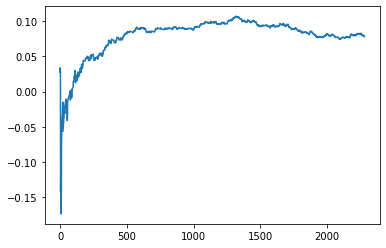

Thread: 5 iteration: 410
RAM mProject_27 FROM: 2304 --> 256 reward: -1.0
Thread: 6 iteration: 382
RAM mImgtbl_1 FROM: 1856 --> 704 reward: 0.205570726875
Saving ...


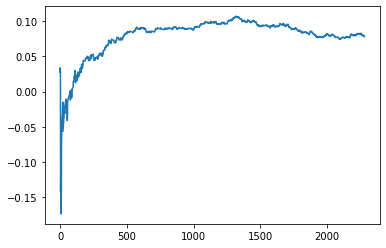

Thread: 2 iteration: 390
RAM mDiffFit_290 FROM: 2624 --> 256 reward: 0.20323424921875002
Thread: 3 iteration: 364
RAM mDiffFit_60 FROM: 2304 --> 256 reward: 0.13074995625000002
Saving ...


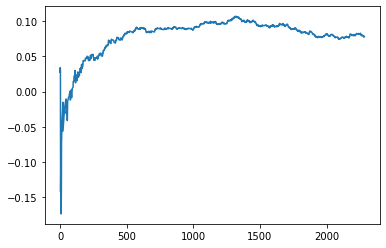

Thread: 4 iteration: 380
RAM mDiffFit_258 FROM: 2624 --> 256 reward: 0.21917444726562502
Thread: 3 iteration: 365
RAM mBackground_89 FROM: 3008 --> 704 reward: 0.0335935430625
Thread: 2 iteration: 391
RAM mProject_44 FROM: 128 --> 2560 reward: 0.7507658925
Thread: 1 iteration: 355
RAM mDiffFit_253 FROM: 2624 --> 256 reward: 0.35237228007812493
Thread: 5 iteration: 411
RAM mDiffFit_365 FROM: 704 --> 2624 reward: -0.013773385546874996
Thread: 2 iteration: 392
RAM mDiffFit_249 FROM: 1792 --> 2624 reward: 0.024447964062500032
Thread: 1 iteration: 356
RAM mDiffFit_160 FROM: 1216 --> 2624 reward: -0.024773429296874993
Thread: 5 iteration: 412
RAM mDiffFit_186 FROM: 2432 --> 256 reward: 0.13458849609375
Thread: 3 iteration: 366
RAM mProject_86 FROM: 2112 --> 2624 reward: 0.08392939052343756
Thread: 6 iteration: 383
RAM mProject_90 FROM: 1600 --> 2624 reward: 0.0978879353203125
Thread: 4 iteration: 381
RAM mDiffFit_327 FROM: 576 --> 2624 reward: -0.03938276601562499
Thread: 2 iteration: 393
RA

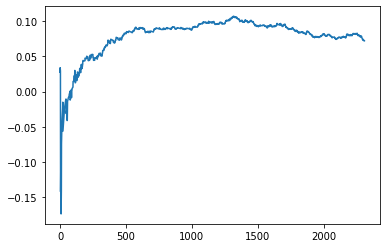

Thread: 1 iteration: 360
RAM mDiffFit_137 FROM: 1920 --> 2752 reward: -0.007023429296875005
Thread: 3 iteration: 369
RAM mDiffFit_266 FROM: 896 --> 2624 reward: 0.01156260937500004
Thread: 2 iteration: 397
RAM mProject_15 FROM: 2752 --> 2624 reward: -0.01636831947656242
Thread: 5 iteration: 415
RAM mDiffFit_74 FROM: 3008 --> 640 reward: 0.065315066796875
Thread: 4 iteration: 385
RAM mDiffFit_234 FROM: 2304 --> 2624 reward: 0.007585951171875018
Thread: 6 iteration: 386
RAM mDiffFit_60 FROM: 832 --> 2624 reward: -0.013742146484374985
Saving ...


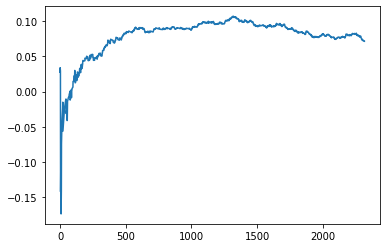

Thread: 3 iteration: 370
RAM mDiffFit_423 FROM: 1792 --> 2624 reward: 0.01564847304687502
Thread: 2 iteration: 398
RAM mDiffFit_387 FROM: 256 --> 1152 reward: -0.20952084062499998
Thread: 4 iteration: 386
RAM mBackground_56 FROM: 3008 --> 768 reward: 0.044946018414062525
Thread: 1 iteration: 361
RAM mBackground_64 FROM: 2560 --> 768 reward: 0.09942844446874999
Thread: 5 iteration: 416
RAM mDiffFit_150 FROM: 1728 --> 2880 reward: 0.020234424218749988
Thread: 6 iteration: 387
RAM mDiffFit_341 FROM: 1408 --> 2880 reward: 0.009044313671874998
Thread: 4 iteration: 387
RAM mDiffFit_23 FROM: 1216 --> 2880 reward: 0.029362056640625002
Thread: 5 iteration: 417
RAM mDiffFit_318 FROM: 2240 --> 2880 reward: 0.05761205664062501
Thread: 1 iteration: 362
RAM mBackground_46 FROM: 2624 --> 768 reward: 0.040444488835937493
Thread: 3 iteration: 371
RAM mBackground_81 FROM: 704 --> 704 reward: -0.05723482615625001
Thread: 2 iteration: 399
RAM mDiffFit_48 FROM: 1216 --> 1152 reward: -0.007822920312499995
T

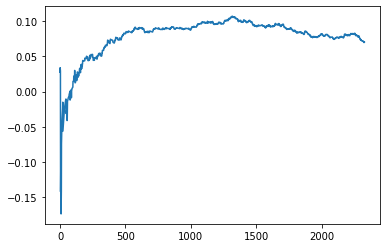

Thread: 2 iteration: 400
RAM mDiffFit_178 FROM: 320 --> 2880 reward: -0.142937390625
Thread: 2 iteration: 401
RAM mDiffFit_153 FROM: 2688 --> 256 reward: 0.13436973515625003
Thread: 3 iteration: 373
RAM mBackground_47 FROM: 2944 --> 768 reward: 0.03146150362499999
Thread: 4 iteration: 389
RAM mDiffFit_98 FROM: 1344 --> 2624 reward: 0.0011484730468750044
Thread: 6 iteration: 389
RAM mProject_87 FROM: 2816 --> 2624 reward: -0.03437162845312499
Thread: 1 iteration: 363
RAM mDiffFit_400 FROM: 896 --> 2624 reward: -0.01985152695312499
Saving ...


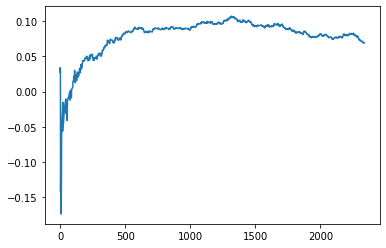

Thread: 6 iteration: 390
RAM mDiffFit_322 FROM: 2752 --> 2624 reward: -0.03058077382812498
Thread: 1 iteration: 364
RAM mBackground_66 FROM: 1088 --> 704 reward: 0.10018328360156248
Thread: 3 iteration: 374
RAM mBackground_46 FROM: 1728 --> 704 reward: 0.19685491307812497
Saving ...


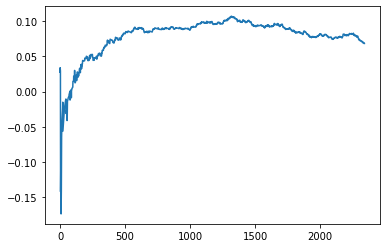

Thread: 4 iteration: 390
RAM mBgModel_1 FROM: 2368 --> 1152 reward: 0.02548009859375
Thread: 2 iteration: 402
RAM mDiffFit_161 FROM: 768 --> 2624 reward: -0.007132766015625
Thread: 6 iteration: 391
RAM mDiffFit_169 FROM: 1088 --> 2624 reward: -0.016304668359375003
Thread: 1 iteration: 365
RAM mDiffFit_176 FROM: 256 --> 320 reward: -0.08233853984375004
Thread: 3 iteration: 375
RAM mBackground_41 FROM: 1024 --> 704 reward: 0.105999490140625
Thread: 4 iteration: 391
RAM mDiffFit_328 FROM: 2880 --> 256 reward: 0.38156761171875
Thread: 6 iteration: 392
RAM mDiffFit_183 FROM: 2304 --> 2688 reward: -0.04429690234375002
Thread: 3 iteration: 376
RAM mProject_29 FROM: 640 --> 768 reward: -1.0
Thread: 5 iteration: 419
RAM mDiffFit_420 FROM: 1664 --> 2944 reward: 0.006619822656249996
Thread: 4 iteration: 392
RAM mDiffFit_191 FROM: 1664 --> 2944 reward: 0.005869822656249992
Thread: 6 iteration: 393
RAM mDiffFit_406 FROM: 192 --> 1088 reward: -0.1930937171875
Saving ...


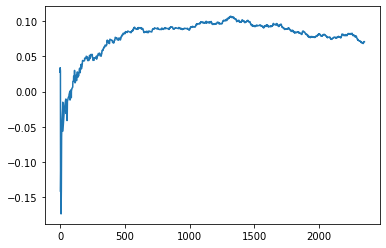

Thread: 5 iteration: 420
RAM mDiffFit_104 FROM: 768 --> 1088 reward: -0.12973183554687495
Thread: 4 iteration: 393
RAM mProject_74 FROM: 1792 --> 2624 reward: 0.15029841965625007
Thread: 2 iteration: 403
RAM mDiffFit_340 FROM: 2432 --> 2752 reward: -0.07899227773437502
Thread: 3 iteration: 377
RAM mProject_45 FROM: 1024 --> 2176 reward: -0.15750923259374996
Thread: 1 iteration: 366
RAM mDiffFit_32 FROM: 448 --> 2624 reward: -0.026536372656249963
Thread: 5 iteration: 421
RAM mDiffFit_314 FROM: 2944 --> 2880 reward: 0.030765663281250022
Thread: 6 iteration: 394
RAM mDiffFit_298 FROM: 2560 --> 2752 reward: 0.035447964062500004
Thread: 1 iteration: 367
RAM mDiffFit_213 FROM: 768 --> 2752 reward: -0.14895309765625003
Thread: 3 iteration: 378
RAM mBackground_13 FROM: 1216 --> 704 reward: 0.10712822132812494
Thread: 4 iteration: 394
RAM mBackground_84 FROM: 1792 --> 704 reward: 0.12777267384375
Thread: 2 iteration: 404
RAM mDiffFit_55 FROM: 2176 --> 1088 reward: -0.0327396453125
Thread: 1 ite

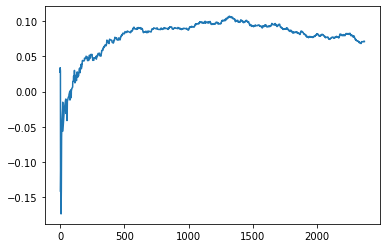

Thread: 3 iteration: 380
RAM mDiffFit_29 FROM: 1344 --> 2880 reward: 0.042500087500000006
Thread: 2 iteration: 406
RAM mBackground_6 FROM: 320 --> 704 reward: -0.22930195251562493
Thread: 4 iteration: 396
RAM mBgModel_2 FROM: 576 --> 320 reward: 0.3349124956250002
Thread: 5 iteration: 422
RAM mDiffFit_144 FROM: 2752 --> 256 reward: 0.07921086367187499
Thread: 2 iteration: 407
RAM mBackground_43 FROM: 2560 --> 768 reward: 0.09609594446874996
Thread: 3 iteration: 381
RAM mDiffFit_253 FROM: 896 --> 1088 reward: -0.07834639335937497
Thread: 5 iteration: 423
RAM mProject_63 FROM: 2240 --> 2624 reward: 0.06651013387500006
Thread: 1 iteration: 369
RAM mBackground_15 FROM: 896 --> 1792 reward: -0.026418059156249996
Thread: 3 iteration: 382
RAM mDiffFit_76 FROM: 2944 --> 256 reward: 0.09098947031249999
Thread: 2 iteration: 408
RAM mBackground_55 FROM: 1856 --> 704 reward: 0.10205776076562492
Saving ...


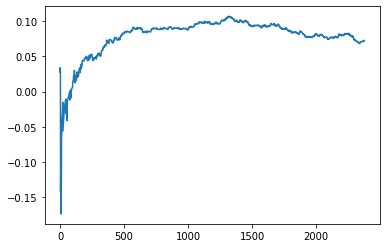

Thread: 1 iteration: 370
RAM mDiffFit_289 FROM: 2240 --> 2944 reward: 0.019164092578124996
Thread: 2 iteration: 409
RAM mDiffFit_389 FROM: 2496 --> 1088 reward: 0.01608327500000003
Thread: 3 iteration: 383
RAM mProject_73 FROM: 576 --> 896 reward: 0.940490323734375
Thread: 6 iteration: 395
RAM mProject_38 FROM: 2624 --> 2624 reward: -0.004848287976562581
Thread: 4 iteration: 397
RAM mDiffFit_176 FROM: 1984 --> 2944 reward: 0.021007853515625022
Thread: 1 iteration: 371
RAM mProject_67 FROM: 1984 --> 2176 reward: 0.028698343101562516
Thread: 5 iteration: 424
RAM mDiffFit_349 FROM: 2688 --> 2880 reward: 0.03048442421875002
Thread: 3 iteration: 384
RAM mDiffFit_275 FROM: 640 --> 2624 reward: -0.08002084062499999
Thread: 6 iteration: 396
RAM mDiffFit_155 FROM: 2560 --> 2624 reward: -0.017737012890624987
Thread: 1 iteration: 372
RAM mDiffFit_264 FROM: 256 --> 2624 reward: -0.19460924921875006
Thread: 5 iteration: 425
RAM mProject_64 FROM: 1472 --> 2624 reward: 0.0722145033984376
Saving ...


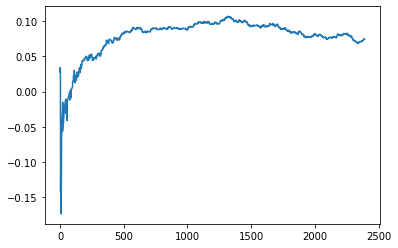

Thread: 2 iteration: 410
RAM mProject_44 FROM: 1984 --> 2624 reward: 0.11160772312500013
Thread: 4 iteration: 398
RAM mDiffFit_273 FROM: 2432 --> 2624 reward: -0.08960165820312502
Thread: 5 iteration: 426
RAM mBackground_43 FROM: 896 --> 704 reward: -0.014353532695312591
Thread: 1 iteration: 373
RAM mDiffFit_10 FROM: 2624 --> 384 reward: 0.192283740234375
Thread: 6 iteration: 397
RAM mDiffFit_94 FROM: 704 --> 1088 reward: -0.05606769921874994
Thread: 6 iteration: 398
RAM mBackground_5 FROM: 576 --> 704 reward: -0.06355042293749996
Thread: 5 iteration: 427
RAM mDiffFit_173 FROM: 256 --> 1088 reward: -0.10283331875000001
Thread: 4 iteration: 399
RAM mProject_14 FROM: 2304 --> 2176 reward: -0.016949102203124986
Thread: 3 iteration: 385
RAM mDiffFit_149 FROM: 256 --> 1088 reward: -0.474104246875
Thread: 5 iteration: 428
RAM mDiffFit_55 FROM: 2688 --> 256 reward: 0.10747389453125
Thread: 6 iteration: 399
RAM mDiffFit_140 FROM: 1600 --> 2176 reward: 0.05290110546874999
Thread: 3 iteration: 3

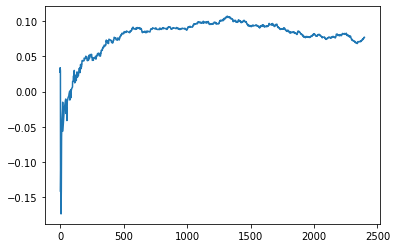

Thread: 4 iteration: 400
RAM mProject_90 FROM: 2816 --> 2176 reward: -0.11776991948437528
Thread: 2 iteration: 411
RAM mProject_47 FROM: 1088 --> 2176 reward: -0.12449422996874998
Thread: 1 iteration: 374
RAM mDiffFit_167 FROM: 960 --> 1088 reward: 0.00205730078124999
Thread: 5 iteration: 429
RAM mDiffFit_81 FROM: 128 --> 256 reward: -0.48122920312499995
Saving ...


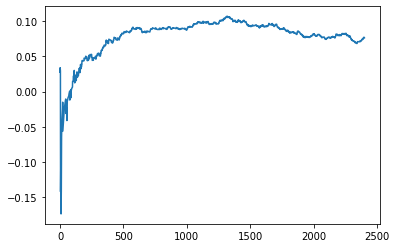

Thread: 6 iteration: 400
RAM mDiffFit_159 FROM: 3008 --> 256 reward: 0.065242102734375
Thread: 3 iteration: 387
RAM mDiffFit_361 FROM: 2880 --> 2880 reward: 0.006624999999999999
Thread: 4 iteration: 401
RAM mDiffFit_37 FROM: 192 --> 1088 reward: -0.18760415937499997
Thread: 2 iteration: 412
RAM mDiffFit_316 FROM: 1792 --> 2624 reward: 0.013398473046875017
Thread: 1 iteration: 375
RAM mDiffFit_111 FROM: 1024 --> 2624 reward: -0.031195287890624993
Saving ...


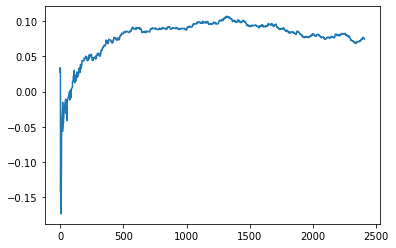

Thread: 5 iteration: 430
RAM mDiffFit_121 FROM: 2048 --> 2624 reward: 0.010429712109375003
Thread: 6 iteration: 401
RAM mDiffFit_168 FROM: 832 --> 2624 reward: -0.07414061953125001
Thread: 3 iteration: 388
RAM mDiffFit_339 FROM: 1920 --> 2624 reward: -0.007382809765624984
Thread: 4 iteration: 402
RAM mDiffFit_319 FROM: 3008 --> 384 reward: 0.056320244140625024
Thread: 2 iteration: 413
RAM mDiffFit_191 FROM: 1728 --> 2624 reward: -0.010789048828124988
Thread: 5 iteration: 431
RAM mDiffFit_350 FROM: 2240 --> 832 reward: 0.11869274296875001
Thread: 6 iteration: 402
RAM mBackground_34 FROM: 2624 --> 768 reward: 0.279656778671875
Thread: 1 iteration: 376
RAM mDiffFit_78 FROM: 1152 --> 2944 reward: 0.015078185156250003
Thread: 4 iteration: 403
RAM mBackground_20 FROM: 832 --> 704 reward: 0.029013793460937513
Thread: 3 iteration: 389
RAM mDiffFit_326 FROM: 1024 --> 2944 reward: 0.029145928125
Thread: 2 iteration: 414
RAM mDiffFit_361 FROM: 832 --> 2624 reward: -0.07039061953125002
Thread: 4 i

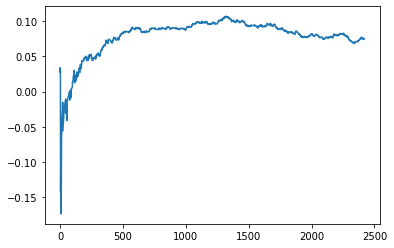

Thread: 3 iteration: 390
RAM mDiffFit_311 FROM: 896 --> 2880 reward: 0.038630308593750017
Thread: 2 iteration: 415
RAM mDiffFit_356 FROM: 1600 --> 2752 reward: -0.0009088277343750201
Thread: 2 iteration: 416
RAM mDiffFit_34 FROM: 2752 --> 1088 reward: -0.010601658203124933
Thread: 4 iteration: 405
RAM mViewer_4 FROM: 704 --> 704 reward: 0.0795902025703125
Thread: 1 iteration: 377
RAM mBackground_45 FROM: 768 --> 704 reward: 0.016232500000000004
Thread: 3 iteration: 391
RAM mProject_87 FROM: 1600 --> 2624 reward: 0.09410792744531266
Thread: 6 iteration: 403
RAM mDiffFit_55 FROM: 1472 --> 2752 reward: 0.019343804687499983
Thread: 2 iteration: 417
RAM mDiffFit_52 FROM: 1344 --> 2752 reward: -0.08314847304687499
Thread: 3 iteration: 392
RAM mDiffFit_340 FROM: 2624 --> 384 reward: -0.0032396890625000126
Thread: 4 iteration: 406
RAM mDiffFit_251 FROM: 1344 --> 2752 reward: -0.037882809765625025
Thread: 6 iteration: 404
RAM mDiffFit_58 FROM: 1792 --> 2176 reward: 0.039432344531249996
Thread: 

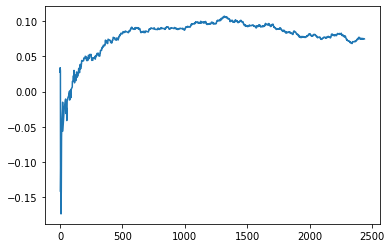

Thread: 2 iteration: 420
RAM mDiffFit_315 FROM: 256 --> 320 reward: -0.352325596484375
Thread: 6 iteration: 406
RAM mBackground_88 FROM: 1216 --> 1792 reward: -0.028825659054687473
Thread: 4 iteration: 409
RAM mDiffFit_144 FROM: 1344 --> 1152 reward: -0.00696876093749999
Thread: 3 iteration: 395
RAM mDiffFit_404 FROM: 1344 --> 2880 reward: -0.013828097656249996
Thread: 5 iteration: 434
RAM mDiffFit_102 FROM: 1216 --> 1152 reward: -0.0017265707031249855
Saving ...


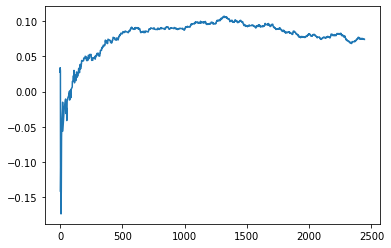

Thread: 1 iteration: 380
RAM mDiffFit_176 FROM: 640 --> 2880 reward: -0.054492146484375004
Thread: 2 iteration: 421
RAM mDiffFit_64 FROM: 576 --> 1152 reward: -0.020945287890624994
Thread: 3 iteration: 396
RAM mDiffFit_147 FROM: 3008 --> 384 reward: 0.09759617460937506
Thread: 6 iteration: 407
RAM mDiffFit_263 FROM: 192 --> 320 reward: -0.11915365039062499
Thread: 5 iteration: 435
RAM mDiffFit_331 FROM: 1344 --> 2624 reward: -0.008796858593749981
Thread: 1 iteration: 381
RAM mBackground_5 FROM: 2944 --> 768 reward: 0.04777463803124993
Thread: 2 iteration: 422
RAM mDiffFit_332 FROM: 2752 --> 2944 reward: 0.0014765707031250304
Thread: 3 iteration: 397
RAM mDiffFit_209 FROM: 128 --> 320 reward: -0.40285679179687495
Thread: 6 iteration: 408
RAM mDiffFit_277 FROM: 1536 --> 2496 reward: 0.004781282812500003
Thread: 5 iteration: 436
RAM mDiffFit_218 FROM: 896 --> 2880 reward: -0.024262987109375002
Thread: 2 iteration: 423
RAM mProject_85 FROM: 1600 --> 2624 reward: 0.09807121279687502
Saving 

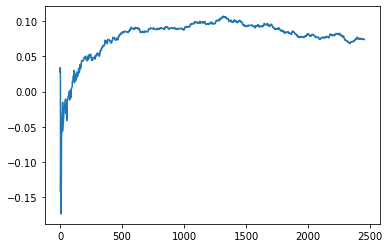

Thread: 4 iteration: 410
RAM mDiffFit_393 FROM: 1472 --> 2496 reward: 0.09071367109374999
Thread: 1 iteration: 382
RAM mDiffFit_29 FROM: 128 --> 320 reward: -0.7738854859375
Thread: 3 iteration: 398
RAM mDiffFit_255 FROM: 2944 --> 2176 reward: 0.0018697789062500046
Thread: 2 iteration: 424
RAM mBackground_25 FROM: 1664 --> 1792 reward: 0.030238893359375
Thread: 5 iteration: 437
RAM mDiffFit_363 FROM: 1600 --> 2176 reward: 0.007429712109375004
Thread: 4 iteration: 411
RAM mDiffFit_354 FROM: 384 --> 256 reward: 0.051119778906249976
Thread: 1 iteration: 383
RAM mDiffFit_340 FROM: 1536 --> 2176 reward: 0.009046902343750008
Thread: 3 iteration: 399
RAM mDiffFit_40 FROM: 768 --> 2752 reward: -0.10908595117187501
Thread: 4 iteration: 412
RAM mDiffFit_27 FROM: 320 --> 2880 reward: -0.09247389453125002
Thread: 1 iteration: 384
RAM mBackground_3 FROM: 3008 --> 704 reward: 0.04878915282031252
Thread: 2 iteration: 425
RAM mDiffFit_135 FROM: 3008 --> 2176 reward: 0.23267993085937508
Thread: 5 itera

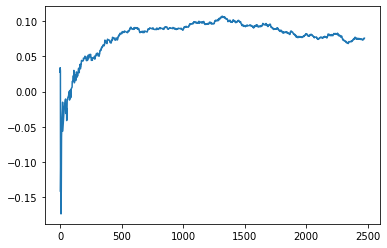

Thread: 3 iteration: 400
RAM mDiffFit_297 FROM: 1088 --> 2880 reward: -0.042333318749999994
Thread: 5 iteration: 439
RAM mBackground_31 FROM: 1728 --> 704 reward: 0.10002646730468749
Saving ...


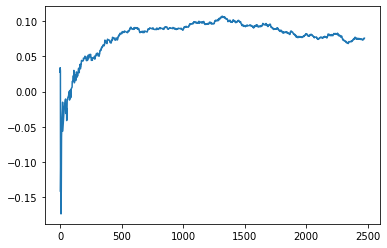

Thread: 6 iteration: 410
RAM mDiffFit_372 FROM: 1600 --> 2176 reward: 0.013554712109374997
Thread: 4 iteration: 414
RAM mDiffFit_19 FROM: 2560 --> 2176 reward: 0.00929168125000001
Thread: 3 iteration: 401
RAM mDiffFit_247 FROM: 2688 --> 2176 reward: 0.0436771234375
Thread: 2 iteration: 427
RAM mDiffFit_307 FROM: 384 --> 2688 reward: -0.06615619531250004
Thread: 6 iteration: 411
RAM mDiffFit_392 FROM: 2880 --> 256 reward: 0.157789005078125
Saving ...


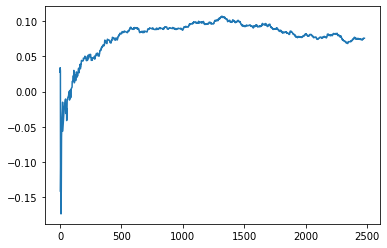

Thread: 5 iteration: 440
RAM mProject_49 FROM: 1856 --> 2624 reward: 0.12119791169531247
Thread: 1 iteration: 385
RAM mDiffFit_70 FROM: 384 --> 2624 reward: -0.018028519140625004
Thread: 3 iteration: 402
RAM mDiffFit_105 FROM: 2240 --> 2176 reward: -0.004072920312499992
Thread: 2 iteration: 428
RAM mDiffFit_160 FROM: 832 --> 2880 reward: 0.013776105468749997
Thread: 1 iteration: 386
RAM mDiffFit_97 FROM: 2752 --> 256 reward: 0.09370559882812501
Thread: 5 iteration: 441
RAM mBackground_10 FROM: 1856 --> 768 reward: 0.1271702361171875
Thread: 6 iteration: 412
RAM mDiffFit_244 FROM: 1216 --> 2496 reward: 0.03433340625
Thread: 6 iteration: 413
RAM mBackground_27 FROM: 512 --> 768 reward: -0.10118436559375
Thread: 2 iteration: 429
RAM mProject_28 FROM: 768 --> 1792 reward: 0.6726681798749999
Thread: 4 iteration: 415
RAM mDiffFit_80 FROM: 2816 --> 640 reward: 0.14514584062499997
Thread: 6 iteration: 414
RAM mDiffFit_345 FROM: 2752 --> 384 reward: 0.1864061515625
Thread: 4 iteration: 416
RAM 

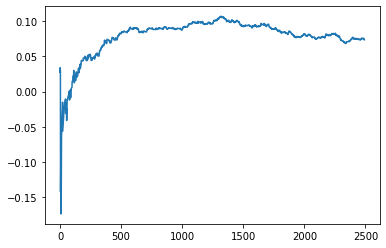

Thread: 2 iteration: 430
RAM mProject_87 FROM: 1280 --> 2624 reward: 0.026175759960937593
Thread: 3 iteration: 403
RAM mDiffFit_93 FROM: 576 --> 2624 reward: -0.06581769921875
Thread: 4 iteration: 417
RAM mProject_73 FROM: 1600 --> 2624 reward: 0.1294151579296874
Thread: 5 iteration: 442
RAM mDiffFit_8 FROM: 768 --> 1088 reward: -0.016104159375
Thread: 3 iteration: 404
RAM mDiffFit_178 FROM: 448 --> 1088 reward: -0.060171858593749974
Thread: 4 iteration: 418
RAM mDiffFit_419 FROM: 1536 --> 2176 reward: 0.034541724999999995
Thread: 5 iteration: 443
RAM mDiffFit_241 FROM: 1280 --> 1088 reward: -0.069179755859375
Thread: 3 iteration: 405
RAM mDiffFit_283 FROM: 448 --> 1088 reward: -0.09548438046874999
Thread: 4 iteration: 419
RAM mBackground_44 FROM: 3008 --> 1088 reward: -0.10233354697656248
Thread: 5 iteration: 444
RAM mProject_27 FROM: 576 --> 896 reward: 0.9430112635312501
Thread: 1 iteration: 387
RAM mDiffFit_358 FROM: 960 --> 2880 reward: 0.0790314140625
Thread: 3 iteration: 406
RAM

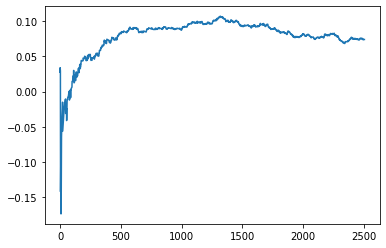

Thread: 4 iteration: 420
RAM mDiffFit_263 FROM: 2560 --> 2176 reward: 0.24587526250000002
Thread: 5 iteration: 445
RAM mProject_64 FROM: 640 --> 896 reward: 0.9368218839375
Thread: 6 iteration: 415
RAM mDiffFit_162 FROM: 2304 --> 2176 reward: -0.006270840624999999
Thread: 1 iteration: 388
RAM mBackground_29 FROM: 1088 --> 1792 reward: -0.05154845744531253
Thread: 2 iteration: 432
RAM mDiffFit_250 FROM: 1728 --> 2624 reward: 0.01726566328125
Thread: 4 iteration: 421
RAM mDiffFit_72 FROM: 1920 --> 2176 reward: 0.030338583593749996
Thread: 6 iteration: 416
RAM mDiffFit_51 FROM: 3008 --> 832 reward: 0.02683849609375002
Thread: 5 iteration: 446
RAM mBackground_80 FROM: 704 --> 1792 reward: -0.22169861961718745
Thread: 1 iteration: 389
RAM mDiffFit_161 FROM: 1152 --> 2624 reward: -0.067445331640625
Thread: 4 iteration: 422
RAM mProject_14 FROM: 1664 --> 2624 reward: 0.124356859453125
Thread: 3 iteration: 407
RAM mDiffFit_163 FROM: 2048 --> 2176 reward: 0.022854203124999996
Thread: 5 iteratio

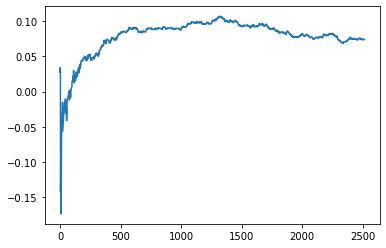

Thread: 1 iteration: 390
RAM mDiffFit_246 FROM: 1600 --> 2944 reward: 0.01256774296874999
Thread: 4 iteration: 423
RAM mDiffFit_387 FROM: 2240 --> 2176 reward: 0.0030520796874999867
Thread: 6 iteration: 418
RAM mDiffFit_229 FROM: 128 --> 256 reward: -0.44219274296875
Thread: 3 iteration: 408
RAM mBackground_54 FROM: 2176 --> 704 reward: 0.07328802153125
Thread: 5 iteration: 448
RAM mDiffFit_110 FROM: 1664 --> 256 reward: 0.2588020796875
Thread: 1 iteration: 391
RAM mDiffFit_228 FROM: 320 --> 256 reward: 0.007325508984375034
Thread: 4 iteration: 424
RAM mBackground_5 FROM: 1216 --> 1792 reward: -0.04884978853124991
Thread: 6 iteration: 419
RAM mDiffFit_34 FROM: 1472 --> 256 reward: 0.280479115625
Thread: 3 iteration: 409
RAM mDiffFit_116 FROM: 1280 --> 256 reward: 0.45356256562499997
Thread: 5 iteration: 449
RAM mBackground_22 FROM: 1408 --> 704 reward: 0.07927896730468745
Saving ...


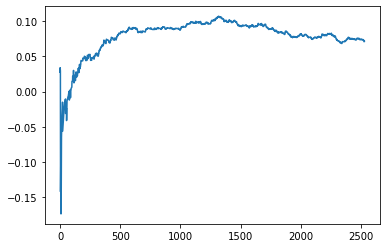

Thread: 6 iteration: 420
RAM mProject_2 FROM: 3008 --> 320 reward: -1.0
Thread: 2 iteration: 433
RAM mDiffFit_330 FROM: 1792 --> 2176 reward: 0.010562521874999987
Saving ...


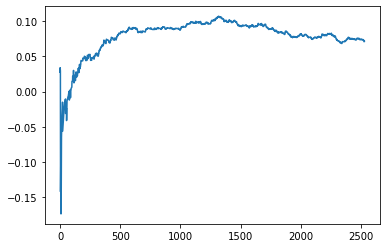

Thread: 5 iteration: 450
RAM mDiffFit_42 FROM: 1472 --> 2880 reward: 0.04625530859375001
Thread: 6 iteration: 421
RAM mDiffFit_142 FROM: 384 --> 2624 reward: -0.10465097421874998
Thread: 2 iteration: 434
RAM mProject_12 FROM: 768 --> 2560 reward: 0.7571071490625001
Thread: 1 iteration: 392
RAM mProject_18 FROM: 384 --> 2560 reward: 0.7509683925
Thread: 4 iteration: 425
RAM mDiffFit_158 FROM: 2560 --> 2624 reward: -0.09219541914062498
Thread: 2 iteration: 435
RAM mDiffFit_325 FROM: 1920 --> 2624 reward: -0.014632809765624984
Thread: 1 iteration: 393
RAM mBackground_49 FROM: 320 --> 704 reward: -0.39342539828906253
Thread: 6 iteration: 422
RAM mProject_76 FROM: 1664 --> 2624 reward: 0.12214248510937498
Saving ...


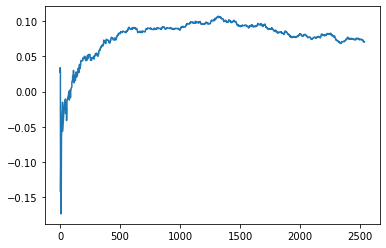

Thread: 3 iteration: 410
RAM mDiffFit_230 FROM: 832 --> 2624 reward: 0.007932344531250014
Thread: 2 iteration: 436
RAM mDiffFit_115 FROM: 2688 --> 384 reward: 0.026078053906250006
Thread: 4 iteration: 426
RAM mDiffFit_183 FROM: 2496 --> 1088 reward: -0.04536473281249995
Thread: 3 iteration: 411
RAM mBackground_6 FROM: 1984 --> 768 reward: 0.10911468863281255
Thread: 1 iteration: 394
RAM mBackground_45 FROM: 768 --> 768 reward: 0.10419444084375006
Thread: 6 iteration: 423
RAM mDiffFit_13 FROM: 1024 --> 2624 reward: -0.02144528789062499
Thread: 1 iteration: 395
RAM mDiffFit_382 FROM: 960 --> 1088 reward: -0.029307300781250024
Thread: 3 iteration: 412
RAM mBackground_69 FROM: 2560 --> 704 reward: 0.058074488835937396
Thread: 6 iteration: 424
RAM mProject_29 FROM: 704 --> 896 reward: 0.9307450043437498
Thread: 5 iteration: 451
RAM mDiffFit_204 FROM: 1216 --> 2176 reward: 0.022593804687500007
Thread: 1 iteration: 396
RAM mDiffFit_155 FROM: 640 --> 2624 reward: -0.004411372656249971
Thread: 

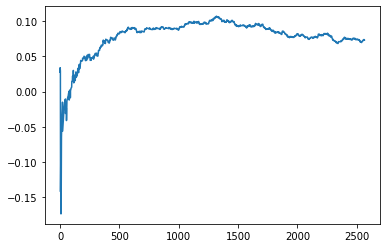

Thread: 2 iteration: 440
RAM mDiffFit_6 FROM: 1984 --> 2880 reward: 0.05602351679687502
Saving ...


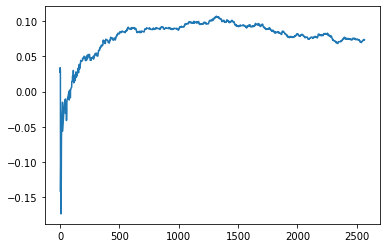

Thread: 4 iteration: 430
RAM mBackground_87 FROM: 1024 --> 1792 reward: -0.032966616500000004
Thread: 5 iteration: 455
RAM mDiffFit_60 FROM: 960 --> 2624 reward: -0.000874956249999996
Thread: 4 iteration: 431
RAM mDiffFit_142 FROM: 384 --> 2624 reward: -0.127835907421875
Thread: 4 iteration: 432
RAM mProject_87 FROM: 2560 --> 2112 reward: -0.06278263650000003
Thread: 1 iteration: 398
RAM mDiffFit_406 FROM: 1024 --> 2624 reward: -0.043361969140625
Thread: 1 iteration: 399
RAM mViewer_3 FROM: 2048 --> 256 reward: 0.5584286874375
Thread: 5 iteration: 456
RAM mDiffFit_124 FROM: 2944 --> 256 reward: 0.15754681484375
Thread: 4 iteration: 433
RAM mProject_72 FROM: 1664 --> 2624 reward: 0.12049154268749993
Thread: 6 iteration: 428
RAM mDiffFit_256 FROM: 1920 --> 2880 reward: 0.019757853515625014
Saving ...


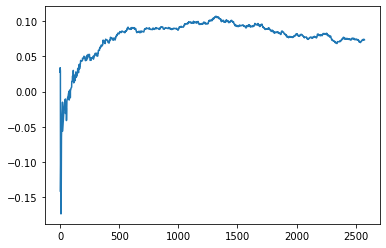

Thread: 1 iteration: 400
RAM mViewer_3 FROM: 1088 --> 256 reward: 0.5087001544453126
Thread: 2 iteration: 441
RAM mDiffFit_99 FROM: 1216 --> 2944 reward: 0.04571884843750002
Thread: 4 iteration: 434
RAM mBackground_56 FROM: 3008 --> 704 reward: 0.04424724960156254
Thread: 5 iteration: 457
RAM mDiffFit_47 FROM: 640 --> 2880 reward: -0.02035929296874999
Thread: 2 iteration: 442
RAM mViewer_3 FROM: 2304 --> 1408 reward: 0.03198935334374995
Thread: 6 iteration: 429
RAM mBackground_1 FROM: 1024 --> 768 reward: 0.07024228853125006
Thread: 1 iteration: 401
RAM mDiffFit_101 FROM: 1344 --> 2944 reward: -0.07579690234374999
Thread: 5 iteration: 458
RAM mDiffFit_351 FROM: 1600 --> 2176 reward: -0.003588539843750009
Thread: 1 iteration: 402
RAM mDiffFit_68 FROM: 1216 --> 2624 reward: -0.07221617226562496
Saving ...


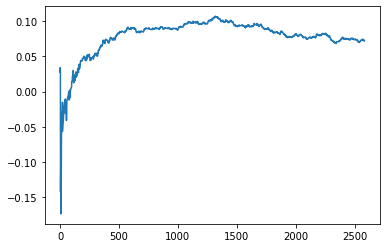

Thread: 6 iteration: 430
RAM mDiffFit_180 FROM: 1344 --> 2624 reward: -0.03824219023437499
Thread: 5 iteration: 459
RAM mDiffFit_345 FROM: 1984 --> 2624 reward: 0.0049661722656250615
Thread: 1 iteration: 403
RAM mDiffFit_108 FROM: 1280 --> 2624 reward: -0.004518208203125006
Thread: 6 iteration: 431
RAM mDiffFit_330 FROM: 576 --> 2624 reward: -0.04900776601562498
Saving ...


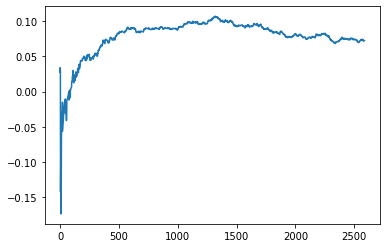

Thread: 5 iteration: 460
RAM mBackground_25 FROM: 256 --> 1792 reward: -0.5521647509062502
Thread: 6 iteration: 432
RAM mBackground_85 FROM: 2880 --> 704 reward: 0.055664662679687435
Thread: 5 iteration: 461
RAM mDiffFit_138 FROM: 2560 --> 256 reward: 0.17790623906249997
Thread: 5 iteration: 462
RAM mProject_22 FROM: 2688 --> 320 reward: -1.0
Thread: 4 iteration: 435
RAM mDiffFit_363 FROM: 2752 --> 2176 reward: -0.04015110546875
Thread: 4 iteration: 436
RAM mDiffFit_294 FROM: 832 --> 2880 reward: -0.01602338554687499
Thread: 4 iteration: 437
RAM mDiffFit_332 FROM: 2624 --> 2176 reward: -0.010195331640624992
Thread: 4 iteration: 438
RAM mDiffFit_347 FROM: 2048 --> 2176 reward: 0.008145840625000018
Thread: 4 iteration: 439
RAM mDiffFit_160 FROM: 576 --> 2880 reward: -0.09271871718749998
Saving ...


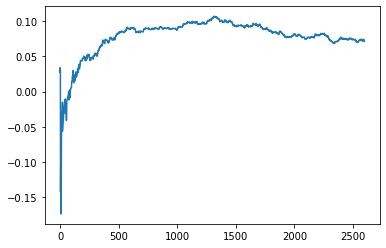

Thread: 4 iteration: 440
RAM mProject_37 FROM: 2432 --> 2624 reward: 0.0176597357343751
Thread: 1 iteration: 404
RAM mProject_8 FROM: 896 --> 320 reward: -1.0
Thread: 6 iteration: 433
RAM mDiffFit_52 FROM: 1152 --> 2880 reward: -0.021195287890624984
Thread: 6 iteration: 434
RAM mAdd_2 FROM: 384 --> 320 reward: -1.0
Thread: 3 iteration: 416
RAM mDiffFit_141 FROM: 448 --> 2624 reward: -0.04722648320312498
Thread: 6 iteration: 435
RAM mBackground_80 FROM: 512 --> 704 reward: -0.18846546056249994
Thread: 4 iteration: 441
RAM mDiffFit_136 FROM: 320 --> 2624 reward: -0.11409367343749996
Thread: 3 iteration: 417
RAM mProject_3 FROM: 192 --> 896 reward: 0.9123578053593749
Thread: 2 iteration: 443
RAM mDiffFit_342 FROM: 2816 --> 384 reward: 0.08690619531249999
Thread: 4 iteration: 442
RAM mProject_10 FROM: 1728 --> 2624 reward: 0.12669075471093746
Thread: 1 iteration: 405
RAM mDiffFit_300 FROM: 1728 --> 2496 reward: 0.039179755859375
Thread: 2 iteration: 444
RAM mDiffFit_153 FROM: 2560 --> 384 

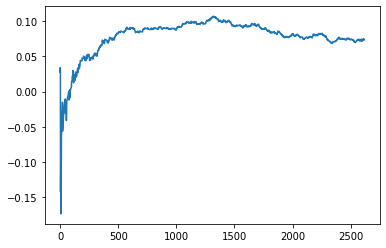

Thread: 3 iteration: 420
RAM mProject_84 FROM: 896 --> 320 reward: -1.0
Thread: 5 iteration: 463
RAM mProject_26 FROM: 2752 --> 320 reward: -1.0
Thread: 6 iteration: 436
RAM mDiffFit_347 FROM: 2112 --> 2624 reward: -0.012101570703125005
Thread: 1 iteration: 409
RAM mDiffFit_205 FROM: 1472 --> 2624 reward: 0.012080773828125023
Thread: 3 iteration: 421
RAM mDiffFit_349 FROM: 1280 --> 2624 reward: -0.04530207968749997
Thread: 5 iteration: 464
RAM mBgModel_3 FROM: 2624 --> 1152 reward: 0.0020758867187499197
Thread: 4 iteration: 446
RAM mDiffFit_282 FROM: 1536 --> 2624 reward: -0.056885442187499975
Thread: 6 iteration: 437
RAM mViewer_2 FROM: 704 --> 704 reward: -0.021797200734375
Saving ...


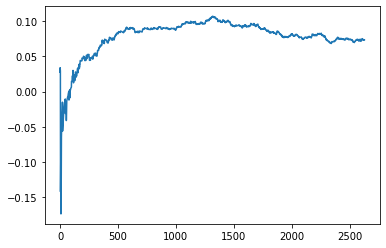

Thread: 1 iteration: 410
RAM mDiffFit_283 FROM: 1856 --> 256 reward: 0.2133645578125
Thread: 4 iteration: 447
RAM mDiffFit_243 FROM: 1472 --> 256 reward: 0.20269528789062496
Thread: 3 iteration: 422
RAM mDiffFit_402 FROM: 384 --> 256 reward: 0.012880177343750007
Thread: 6 iteration: 438
RAM mProject_15 FROM: 768 --> 896 reward: 0.9370018839375
Thread: 2 iteration: 446
RAM mDiffFit_346 FROM: 576 --> 1088 reward: -0.09524999999999999
Thread: 1 iteration: 411
RAM mBackground_20 FROM: 256 --> 704 reward: -0.5646684081484374
Thread: 4 iteration: 448
RAM mDiffFit_60 FROM: 2752 --> 2176 reward: -0.08297406953124997
Thread: 6 iteration: 439
RAM mDiffFit_315 FROM: 1408 --> 2624 reward: -0.05596876093749996
Thread: 3 iteration: 423
RAM mAdd_1 FROM: 1856 --> 1792 reward: 0.08343627128906246
Thread: 2 iteration: 447
RAM mBackground_2 FROM: 2944 --> 704 reward: 0.08831334457031245
Thread: 1 iteration: 412
RAM mDiffFit_5 FROM: 1216 --> 2624 reward: 0.07869024179687502
Thread: 4 iteration: 449
RAM mD

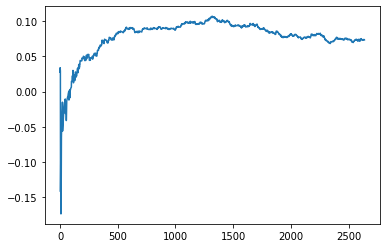

Thread: 6 iteration: 440
RAM mDiffFit_176 FROM: 512 --> 2624 reward: -0.05975776601562498
Thread: 2 iteration: 448
RAM mBackground_46 FROM: 3008 --> 704 reward: -0.0028870666953124957
Thread: 3 iteration: 424
RAM mProject_86 FROM: 1920 --> 320 reward: -1.0
Thread: 5 iteration: 465
RAM mDiffFit_218 FROM: 1344 --> 2624 reward: -0.05082292031249998
Thread: 1 iteration: 413
RAM mImgtbl_1 FROM: 1088 --> 704 reward: 0.08687704468749996
Saving ...


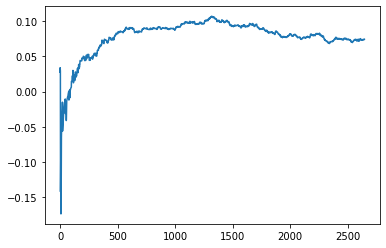

Thread: 4 iteration: 450
RAM mDiffFit_324 FROM: 2496 --> 256 reward: 0.19888798710937503
Thread: 2 iteration: 449
RAM mDiffFit_39 FROM: 128 --> 320 reward: -0.388611969140625
Thread: 3 iteration: 425
RAM mDiffFit_195 FROM: 896 --> 256 reward: 0.20500522109375002
Thread: 5 iteration: 466
RAM mDiffFit_276 FROM: 768 --> 256 reward: 0.0856666375
Thread: 1 iteration: 414
RAM mDiffFit_138 FROM: 2688 --> 256 reward: 0.010301904687500009
Thread: 3 iteration: 426
RAM mDiffFit_356 FROM: 1408 --> 256 reward: 0.09068743437500001
Thread: 5 iteration: 467
RAM mProject_25 FROM: 2880 --> 2624 reward: -0.044296963593750016
Thread: 6 iteration: 441
RAM mDiffFit_307 FROM: 1408 --> 256 reward: 0.1050937171875
Thread: 3 iteration: 427
RAM mDiffFit_375 FROM: 2880 --> 256 reward: 0.31463008984374996
Thread: 5 iteration: 468
RAM mDiffFit_16 FROM: 1344 --> 256 reward: 0.14758849609375
Thread: 3 iteration: 428
RAM mProject_6 FROM: 2752 --> 2240 reward: -0.10096613142187495
Saving ...


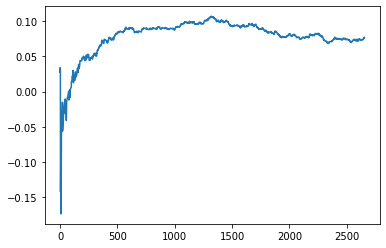

Thread: 2 iteration: 450
RAM mDiffFit_309 FROM: 2176 --> 256 reward: 0.09791654999999996
Thread: 5 iteration: 469
RAM mDiffFit_211 FROM: 1664 --> 2880 reward: -0.018346349609374996
Saving ...


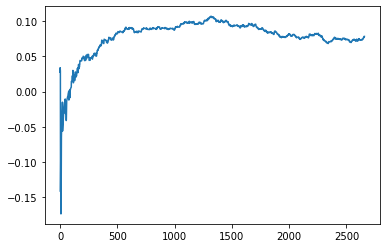

Thread: 5 iteration: 470
RAM mBackground_26 FROM: 960 --> 768 reward: 0.05427406720312499
Thread: 2 iteration: 451
RAM mProject_59 FROM: 2432 --> 2624 reward: 0.02311833522656248
Thread: 6 iteration: 442
RAM mProject_28 FROM: 2624 --> 320 reward: -1.0
Thread: 4 iteration: 451
RAM mDiffFit_406 FROM: 1344 --> 2624 reward: -0.064187521875
Thread: 5 iteration: 471
RAM mDiffFit_409 FROM: 1984 --> 2880 reward: 0.03327610546875002
Thread: 6 iteration: 443
RAM mBackground_19 FROM: 2816 --> 704 reward: 0.006781216906249984
Thread: 2 iteration: 452
RAM mDiffFit_413 FROM: 128 --> 320 reward: -0.392721349609375
Thread: 4 iteration: 452
RAM mProject_62 FROM: 1856 --> 2624 reward: 0.1368115216875
Thread: 3 iteration: 429
RAM mDiffFit_210 FROM: 576 --> 2624 reward: -0.0230311953125
Thread: 5 iteration: 472
RAM mProject_67 FROM: 1472 --> 2624 reward: 0.07243950339843758
Thread: 1 iteration: 415
RAM mBackground_1 FROM: 2816 --> 704 reward: 0.051613282296875
Thread: 6 iteration: 444
RAM mDiffFit_163 FRO

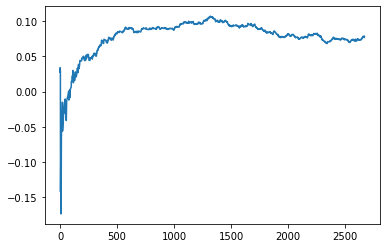

Thread: 3 iteration: 430
RAM mDiffFit_110 FROM: 384 --> 1088 reward: -0.22866931367187504
Thread: 6 iteration: 445
RAM mDiffFit_159 FROM: 1408 --> 2880 reward: -0.008606748046874994
Thread: 1 iteration: 417
RAM mDiffFit_268 FROM: 2560 --> 256 reward: 0.16012495624999998
Thread: 2 iteration: 454
RAM mDiffFit_197 FROM: 320 --> 2624 reward: -0.05260407187499998
Thread: 6 iteration: 446
RAM mDiffFit_129 FROM: 2304 --> 384 reward: 0.01124986875000001
Thread: 1 iteration: 418
RAM mDiffFit_50 FROM: 448 --> 2624 reward: -0.11619778906249996
Thread: 1 iteration: 419
RAM mDiffFit_400 FROM: 1984 --> 2496 reward: -0.004690110546875011
Saving ...


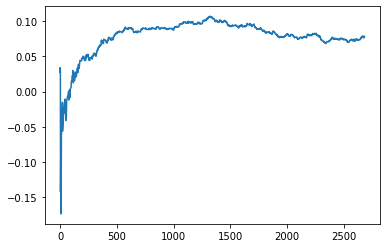

Thread: 1 iteration: 420
RAM mDiffFit_413 FROM: 448 --> 2624 reward: -0.05947130585937498
Thread: 1 iteration: 421
RAM mProject_32 FROM: 2816 --> 320 reward: -1.0
Thread: 5 iteration: 473
RAM mProject_86 FROM: 832 --> 2112 reward: -0.2890845729843749
Thread: 6 iteration: 447
RAM mDiffFit_321 FROM: 128 --> 320 reward: -0.411375
Thread: 6 iteration: 448
RAM mProject_2 FROM: 832 --> 896 reward: 0.9310150043437498
Thread: 3 iteration: 431
RAM mProject_6 FROM: 1344 --> 320 reward: -1.0
Thread: 4 iteration: 454
RAM mProject_42 FROM: 256 --> 2560 reward: 0.7564996490625001
Thread: 1 iteration: 422
RAM mDiffFit_105 FROM: 2688 --> 2880 reward: 0.004101570703125019
Thread: 6 iteration: 449
RAM mProject_83 FROM: 576 --> 896 reward: 0.92372312475
Thread: 2 iteration: 455
RAM mDiffFit_49 FROM: 2112 --> 2944 reward: -0.0008906195312499872
Thread: 1 iteration: 423
RAM mBackground_1 FROM: 2368 --> 1088 reward: -0.0038902620703124874
Thread: 4 iteration: 455
RAM mProject_4 FROM: 320 --> 2560 reward: 0.

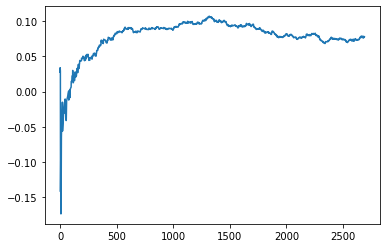

Thread: 6 iteration: 450
RAM mDiffFit_63 FROM: 1600 --> 256 reward: 0.16598955781249997
Thread: 2 iteration: 456
RAM mDiffFit_407 FROM: 256 --> 1088 reward: -0.18634634960937502
Thread: 1 iteration: 424
RAM mDiffFit_262 FROM: 256 --> 1088 reward: -0.1514270796875
Thread: 4 iteration: 456
RAM mProject_15 FROM: 2048 --> 2240 reward: 0.03341959966406242
Thread: 3 iteration: 432
RAM mDiffFit_160 FROM: 640 --> 1088 reward: -0.17099486640625
Thread: 6 iteration: 451
RAM mBackground_63 FROM: 1088 --> 768 reward: 0.089583345875
Thread: 5 iteration: 475
RAM mDiffFit_315 FROM: 384 --> 1088 reward: -0.17135679179687502
Thread: 4 iteration: 457
RAM mDiffFit_212 FROM: 1664 --> 2176 reward: 0.007687521875000009
Thread: 6 iteration: 452
RAM mDiffFit_289 FROM: 1536 --> 2176 reward: -0.08132818515625
Thread: 1 iteration: 425
RAM mProject_14 FROM: 704 --> 2560 reward: 0.7668196621875002
Thread: 2 iteration: 457
RAM mDiffFit_397 FROM: 832 --> 2880 reward: -0.046622367578125004
Thread: 5 iteration: 476
RA

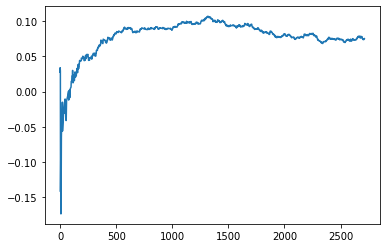

Thread: 4 iteration: 460
RAM mDiffFit_72 FROM: 512 --> 1088 reward: -0.2688438484375
Thread: 2 iteration: 459
RAM mDiffFit_282 FROM: 128 --> 2304 reward: -0.37618216953125
Thread: 6 iteration: 455
RAM mDiffFit_397 FROM: 512 --> 1088 reward: -0.071742190234375
Thread: 3 iteration: 436
RAM mDiffFit_347 FROM: 1472 --> 2944 reward: -0.013393208203125
Thread: 1 iteration: 428
RAM mDiffFit_324 FROM: 1728 --> 2944 reward: 0.026476614453124984
Thread: 4 iteration: 461
RAM mBackground_62 FROM: 1728 --> 768 reward: 0.12162951478906249
Thread: 5 iteration: 479
RAM mDiffFit_357 FROM: 2880 --> 2880 reward: -0.02675785351562503
Saving ...


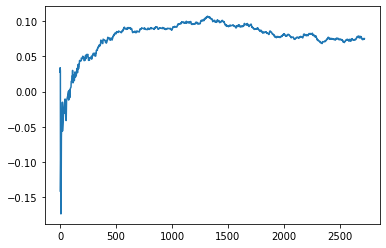

Thread: 2 iteration: 460
RAM mDiffFit_186 FROM: 3008 --> 2880 reward: -0.03152869414062501
Thread: 6 iteration: 456
RAM mDiffFit_265 FROM: 1920 --> 2880 reward: 0.01600785351562499
Thread: 4 iteration: 462
RAM mBackground_71 FROM: 1536 --> 768 reward: 0.06552119356249998
Thread: 1 iteration: 429
RAM mDiffFit_243 FROM: 1856 --> 2624 reward: -0.002591128515624999
Thread: 6 iteration: 457
RAM mDiffFit_355 FROM: 2624 --> 384 reward: 0.2128436734375
Saving ...


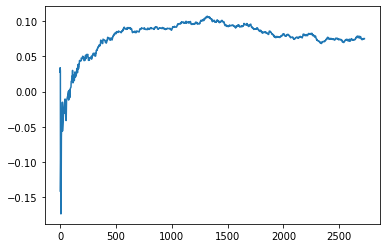

Thread: 5 iteration: 480
RAM mBackground_38 FROM: 384 --> 704 reward: -0.16928337052343753
Thread: 3 iteration: 437
RAM mDiffFit_392 FROM: 704 --> 2688 reward: -0.05969528789062499
Thread: 2 iteration: 461
RAM mDiffFit_144 FROM: 1792 --> 2624 reward: -0.004736969140625002
Thread: 6 iteration: 458
RAM mDiffFit_388 FROM: 1664 --> 2624 reward: -0.022854159374999967
Thread: 3 iteration: 438
RAM mDiffFit_127 FROM: 2688 --> 832 reward: -0.016765707031249997
Thread: 2 iteration: 462
RAM mDiffFit_66 FROM: 1408 --> 256 reward: 0.042380089843749996
Thread: 5 iteration: 481
RAM mDiffFit_184 FROM: 2752 --> 832 reward: 0.008632766015625008
Thread: 6 iteration: 459
RAM mDiffFit_273 FROM: 1792 --> 2944 reward: 0.018109424218750003
Thread: 3 iteration: 439
RAM mDiffFit_10 FROM: 768 --> 2752 reward: -0.15654422617187502
Thread: 2 iteration: 463
RAM mDiffFit_125 FROM: 3008 --> 832 reward: -0.04867979960937501
Thread: 5 iteration: 482
RAM mProject_62 FROM: 2688 --> 2624 reward: -0.017788623117187673
Thre

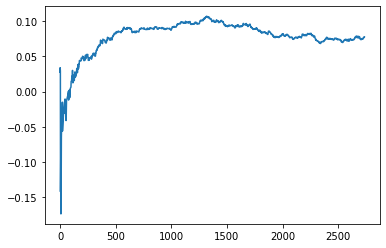

Thread: 1 iteration: 430
RAM mDiffFit_180 FROM: 1344 --> 2624 reward: -0.01730725703124998
Saving ...


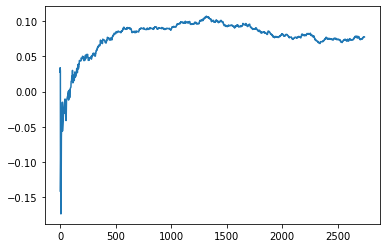

Thread: 3 iteration: 440
RAM mDiffFit_129 FROM: 2560 --> 832 reward: -0.0021901542968750035
Saving ...


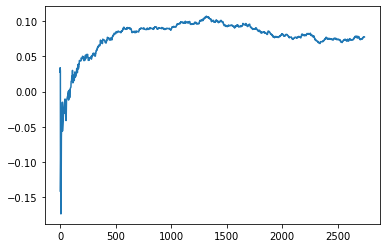

Thread: 6 iteration: 460
RAM mDiffFit_203 FROM: 1280 --> 2752 reward: -0.04490623906250001
Thread: 1 iteration: 431
RAM mBackground_80 FROM: 1792 --> 704 reward: 0.12250294758593745
Thread: 2 iteration: 464
RAM mBackground_64 FROM: 2624 --> 704 reward: 0.10769473792968748
Thread: 5 iteration: 483
RAM mBackground_6 FROM: 2944 --> 704 reward: 0.17663808380468746
Thread: 4 iteration: 464
RAM mDiffFit_177 FROM: 2240 --> 2176 reward: 0.027252632421875006
Thread: 6 iteration: 461
RAM mDiffFit_421 FROM: 2816 --> 832 reward: -0.007658915234375011
Thread: 1 iteration: 432
RAM mDiffFit_368 FROM: 2752 --> 832 reward: 0.007882766015625004
Thread: 5 iteration: 484
RAM mDiffFit_360 FROM: 640 --> 2752 reward: -0.044312434375000015
Thread: 4 iteration: 465
RAM mDiffFit_106 FROM: 2048 --> 2752 reward: -0.06646099492187502
Thread: 3 iteration: 441
RAM mBackground_2 FROM: 512 --> 704 reward: -0.05932430332031242
Thread: 2 iteration: 465
RAM mDiffFit_185 FROM: 2816 --> 832 reward: 0.008265575781249996
Thr

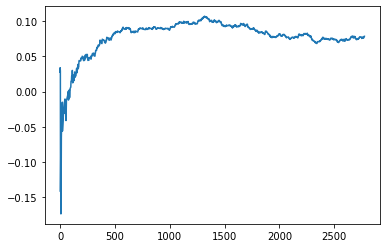

Thread: 5 iteration: 490
RAM mImgtbl_1 FROM: 2560 --> 1408 reward: 0.061583257500000044
Thread: 6 iteration: 468
RAM mDiffFit_417 FROM: 192 --> 2624 reward: -0.160804624609375
Thread: 2 iteration: 469
RAM mBackground_83 FROM: 2752 --> 1792 reward: -0.06090559808593751
Thread: 3 iteration: 447
RAM mProject_3 FROM: 576 --> 896 reward: 0.91661124515625
Thread: 1 iteration: 435
RAM mDiffFit_27 FROM: 640 --> 2624 reward: -0.018096305859374977
Thread: 6 iteration: 469
RAM mDiffFit_310 FROM: 640 --> 1088 reward: -0.08358336250000001
Thread: 3 iteration: 448
RAM mConcatFit_1 FROM: 576 --> 1856 reward: -0.1887166375
Saving ...


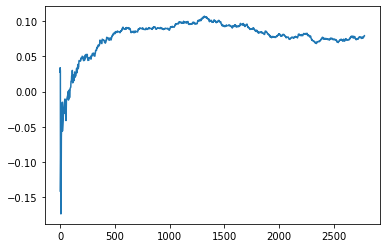

Thread: 2 iteration: 470
RAM mDiffFit_93 FROM: 1600 --> 2944 reward: 0.02708599492187501
Thread: 3 iteration: 449
RAM mDiffFit_414 FROM: 2816 --> 832 reward: 0.03844006679687499
Thread: 1 iteration: 436
RAM mProject_48 FROM: 2112 --> 320 reward: -1.0
Thread: 4 iteration: 467
RAM mBackground_70 FROM: 1536 --> 704 reward: 0.06752113128906245
Saving ...


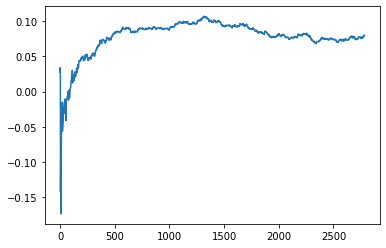

Thread: 6 iteration: 470
RAM mDiffFit_71 FROM: 1472 --> 2176 reward: -0.04814325195312498
Thread: 2 iteration: 471
RAM mDiffFit_94 FROM: 1664 --> 256 reward: 0.28635929296874996
Saving ...


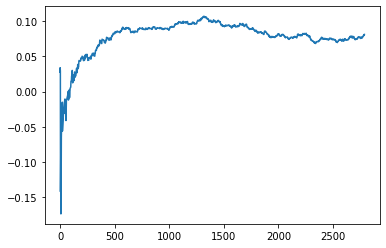

Thread: 3 iteration: 450
RAM mViewer_3 FROM: 1344 --> 1408 reward: -0.01285969110937496
Thread: 6 iteration: 471
RAM mBackground_55 FROM: 768 --> 768 reward: -0.02488626881249995
Thread: 2 iteration: 472
RAM mDiffFit_195 FROM: 960 --> 2752 reward: -0.035687478125000005
Thread: 3 iteration: 451
RAM mDiffFit_8 FROM: 1728 --> 2752 reward: 0.019000043749999983
Thread: 2 iteration: 473
RAM mProject_51 FROM: 2560 --> 320 reward: -1.0
Thread: 5 iteration: 491
RAM mDiffFit_372 FROM: 1024 --> 2752 reward: 0.018247455078124995
Thread: 3 iteration: 452
RAM mProject_54 FROM: 960 --> 2624 reward: -0.09624906196875008
Thread: 1 iteration: 437
RAM mDiffFit_160 FROM: 1536 --> 2752 reward: -0.024648429296875007
Thread: 2 iteration: 474
RAM mDiffFit_366 FROM: 320 --> 2752 reward: -0.06452597421875
Thread: 5 iteration: 492
RAM mDiffFit_392 FROM: 2368 --> 256 reward: 0.154187434375
Thread: 2 iteration: 475
RAM mDiffFit_391 FROM: 1920 --> 256 reward: 0.3814166375
Thread: 1 iteration: 438
RAM mDiffFit_322 F

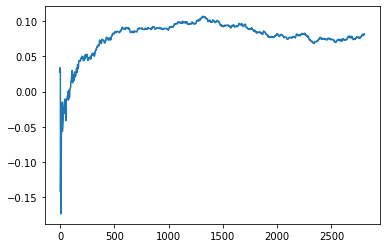

Thread: 1 iteration: 440
RAM mProject_7 FROM: 1408 --> 2112 reward: -0.027729730054687506
Thread: 5 iteration: 493
RAM mProject_37 FROM: 1472 --> 2176 reward: -0.008776279757812555
Thread: 3 iteration: 454
RAM mDiffFit_22 FROM: 1984 --> 2176 reward: -0.01115106171874998
Saving ...


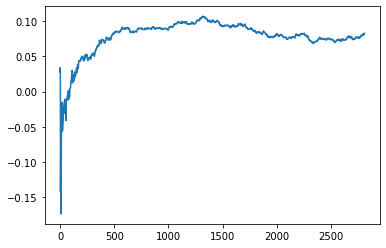

Thread: 4 iteration: 470
RAM mDiffFit_415 FROM: 2688 --> 2176 reward: -0.053224025781249996
Thread: 1 iteration: 441
RAM mDiffFit_93 FROM: 768 --> 2880 reward: -0.05035152695312502
Thread: 5 iteration: 494
RAM mBackground_48 FROM: 704 --> 704 reward: -0.05669732615625001
Thread: 2 iteration: 478
RAM mDiffFit_406 FROM: 512 --> 2752 reward: -0.176315110546875
Thread: 4 iteration: 471
RAM mDiffFit_171 FROM: 1216 --> 2752 reward: 0.013903694140624994
Thread: 5 iteration: 495
RAM mDiffFit_49 FROM: 2496 --> 384 reward: 0.11683590742187501
Thread: 1 iteration: 442
RAM mProject_7 FROM: 2112 --> 2240 reward: 0.030410680781249852
Thread: 6 iteration: 473
RAM mBackground_84 FROM: 448 --> 704 reward: -0.09161237545312495
Thread: 2 iteration: 479
RAM mDiffFit_294 FROM: 2176 --> 2880 reward: 0.0176771234375
Thread: 5 iteration: 496
RAM mDiffFit_25 FROM: 1408 --> 2880 reward: 0.009919313671875006
Thread: 1 iteration: 443
RAM mDiffFit_74 FROM: 1088 --> 2880 reward: 0.016671946093750004
Thread: 6 itera

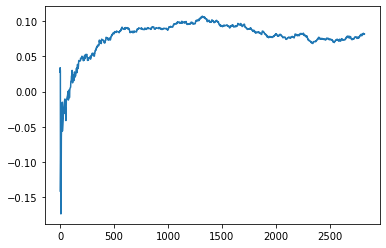

Thread: 2 iteration: 480
RAM mDiffFit_121 FROM: 2496 --> 1088 reward: -0.017455773828124993
Thread: 6 iteration: 475
RAM mDiffFit_190 FROM: 2816 --> 256 reward: 0.09351031093750002
Thread: 5 iteration: 497
RAM mProject_77 FROM: 1792 --> 2112 reward: 0.05208948196875013
Thread: 4 iteration: 472
RAM mDiffFit_115 FROM: 2560 --> 256 reward: 0.09005199218750001
Thread: 6 iteration: 476
RAM mDiffFit_2 FROM: 1344 --> 256 reward: 0.33043747812499996
Thread: 5 iteration: 498
RAM mDiffFit_119 FROM: 2432 --> 1088 reward: -0.04722665820312501
Thread: 4 iteration: 473
RAM mProject_38 FROM: 640 --> 896 reward: 0.93011500434375
Thread: 3 iteration: 455
RAM mDiffFit_103 FROM: 2560 --> 1088 reward: 0.08641409257812503
Thread: 6 iteration: 477
RAM mProject_50 FROM: 896 --> 2240 reward: -0.21712389482812514
Thread: 1 iteration: 444
RAM mProject_25 FROM: 1600 --> 2112 reward: 0.016991827523437475
Thread: 2 iteration: 481
RAM mDiffFit_227 FROM: 1216 --> 2880 reward: 0.019388074609375007
Thread: 5 iteration

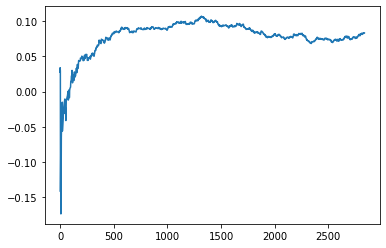

Thread: 5 iteration: 500
RAM mImgtbl_2 FROM: 832 --> 704 reward: 0.01976872593750001
Thread: 2 iteration: 482
RAM mDiffFit_13 FROM: 896 --> 2624 reward: 0.02095840625000003
Thread: 6 iteration: 479
RAM mProject_71 FROM: 1216 --> 2112 reward: -0.07956175359375003
Thread: 3 iteration: 456
RAM mDiffFit_13 FROM: 2688 --> 2624 reward: -0.021882853515624977
Thread: 1 iteration: 446
RAM mDiffFit_13 FROM: 1024 --> 2624 reward: -0.025820287890624995
Thread: 5 iteration: 501
RAM mDiffFit_62 FROM: 448 --> 1088 reward: -0.125106791796875
Thread: 1 iteration: 447
RAM mDiffFit_325 FROM: 1856 --> 2944 reward: 0.0031510617187499937
Thread: 3 iteration: 457
RAM mBackground_67 FROM: 256 --> 704 reward: -0.48700412947656246
Thread: 2 iteration: 483
RAM mBackground_83 FROM: 128 --> 768 reward: 0.33964645693749995
Saving ...


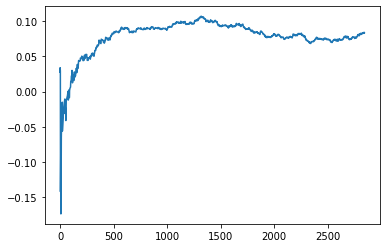

Thread: 6 iteration: 480
RAM mProject_88 FROM: 2432 --> 2112 reward: -0.05179182489843752
Thread: 4 iteration: 476
RAM mDiffFit_414 FROM: 2688 --> 256 reward: 0.10297389453125001
Thread: 5 iteration: 502
RAM mDiffFit_239 FROM: 896 --> 1088 reward: -0.0397187609375
Thread: 6 iteration: 481
RAM mDiffFit_273 FROM: 2880 --> 256 reward: 0.15391400507812497
Thread: 2 iteration: 484
RAM mDiffFit_213 FROM: 2624 --> 256 reward: 0.32276553203124997
Thread: 3 iteration: 458
RAM mDiffFit_310 FROM: 2624 --> 384 reward: 0.08750776601562499
Thread: 1 iteration: 448
RAM mDiffFit_80 FROM: 896 --> 2624 reward: 0.014908915234374993
Thread: 4 iteration: 477
RAM mDiffFit_171 FROM: 832 --> 2624 reward: -0.10411460156249998
Thread: 5 iteration: 503
RAM mDiffFit_191 FROM: 1664 --> 2624 reward: 0.022843804687499997
Thread: 1 iteration: 449
RAM mDiffFit_60 FROM: 2112 --> 2880 reward: 0.143562696875
Thread: 3 iteration: 459
RAM mDiffFit_200 FROM: 640 --> 1088 reward: -0.12536982265624996
Thread: 2 iteration: 485

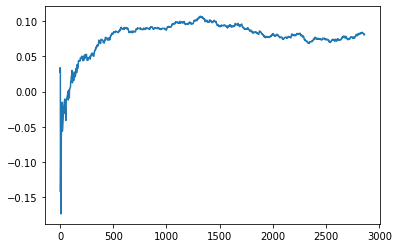

Thread: 3 iteration: 460
RAM mDiffFit_2 FROM: 2880 --> 384 reward: 0.19392177109374997
Thread: 5 iteration: 504
RAM mDiffFit_167 FROM: 1344 --> 2624 reward: 0.0016484730468750187
Thread: 4 iteration: 479
RAM mDiffFit_393 FROM: 2752 --> 640 reward: 0.09298433671875
Thread: 6 iteration: 484
RAM mBackground_4 FROM: 2048 --> 704 reward: 0.06335994939843746
Thread: 5 iteration: 505
RAM mDiffFit_124 FROM: 2176 --> 2944 reward: -0.006963539843750002
Thread: 3 iteration: 461
RAM mProject_40 FROM: 1920 --> 2112 reward: 0.03719116511718756
Thread: 2 iteration: 486
RAM mDiffFit_401 FROM: 896 --> 1088 reward: 0.005328141406250007
Thread: 3 iteration: 462
RAM mDiffFit_20 FROM: 768 --> 1088 reward: -0.10549482265625
Thread: 6 iteration: 485
RAM mBackground_89 FROM: 128 --> 704 reward: 0.37180016347656253
Thread: 2 iteration: 487
RAM mDiffFit_124 FROM: 1984 --> 2176 reward: 0.031596393359375016
Thread: 3 iteration: 463
RAM mDiffFit_29 FROM: 2560 --> 256 reward: 0.1771978765625
Thread: 6 iteration: 48

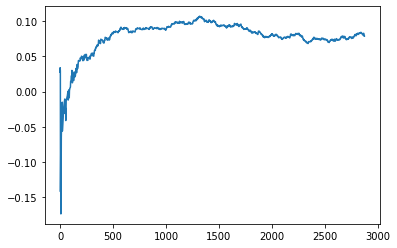

Thread: 4 iteration: 480
RAM mDiffFit_377 FROM: 2880 --> 256 reward: 0.14022907187499994
Thread: 3 iteration: 464
RAM mProject_78 FROM: 768 --> 896 reward: 0.9263340645468751
Saving ...


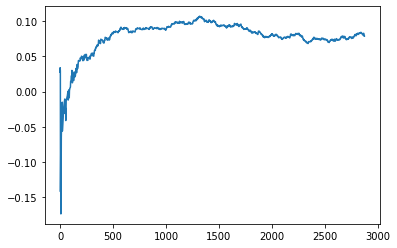

Thread: 1 iteration: 450
RAM mProject_66 FROM: 384 --> 2560 reward: 0.7569496490625002
Thread: 5 iteration: 506
RAM mDiffFit_259 FROM: 2240 --> 256 reward: 0.16783327499999998
Thread: 6 iteration: 487
RAM mDiffFit_380 FROM: 1344 --> 1088 reward: -0.054307344531249996
Thread: 3 iteration: 465
RAM mDiffFit_355 FROM: 640 --> 1152 reward: -0.022104115625000004
Thread: 4 iteration: 481
RAM mDiffFit_295 FROM: 448 --> 1088 reward: -0.04572393828124999
Thread: 5 iteration: 507
RAM mProject_30 FROM: 2112 --> 2112 reward: -8.999999999999009e-05
Thread: 2 iteration: 488
RAM mDiffFit_209 FROM: 1280 --> 2880 reward: -0.08301825195312498
Thread: 1 iteration: 451
RAM mDiffFit_288 FROM: 1792 --> 2880 reward: 0.006606791796875001
Thread: 6 iteration: 488
RAM mDiffFit_382 FROM: 384 --> 2880 reward: -0.1573436296875
Thread: 3 iteration: 466
RAM mDiffFit_278 FROM: 1280 --> 2880 reward: 0.040198007812500006
Thread: 5 iteration: 508
RAM mDiffFit_46 FROM: 2560 --> 2880 reward: -0.018518251953125002
Thread: 1

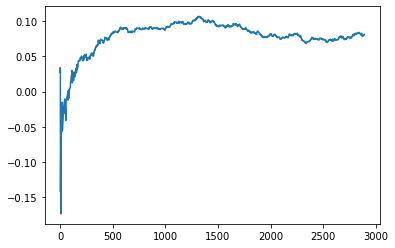

Thread: 5 iteration: 510
RAM mBackground_10 FROM: 960 --> 768 reward: 0.09474111961718748
Thread: 4 iteration: 483
RAM mDiffFit_113 FROM: 1152 --> 1088 reward: 0.016395840624999977
Thread: 3 iteration: 469
RAM mDiffFit_24 FROM: 2048 --> 2176 reward: 0.026979203125000004
Saving ...


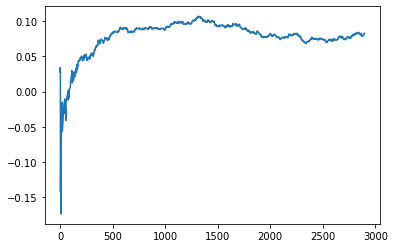

Thread: 2 iteration: 490
RAM mDiffFit_91 FROM: 192 --> 1088 reward: -0.23606769921874998
Thread: 5 iteration: 511
RAM mDiffFit_261 FROM: 1408 --> 1088 reward: 0.019382809765625
Saving ...


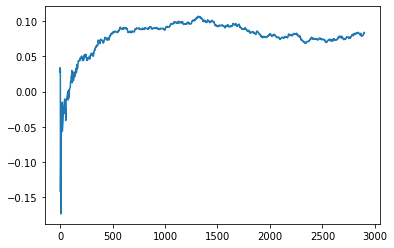

Thread: 3 iteration: 470
RAM mDiffFit_77 FROM: 704 --> 1088 reward: -0.07789325195312499
Thread: 2 iteration: 491
RAM mDiffFit_304 FROM: 1664 --> 256 reward: 0.16074477890625
Thread: 4 iteration: 484
RAM mDiffFit_207 FROM: 3008 --> 384 reward: 0.052210863671875024
Thread: 5 iteration: 512
RAM mProject_10 FROM: 896 --> 2112 reward: -0.25685801803124997
Thread: 1 iteration: 454
RAM mDiffFit_237 FROM: 2048 --> 2624 reward: 0.023406282812500016
Thread: 4 iteration: 485
RAM mBackground_71 FROM: 1984 --> 768 reward: 0.09505905422656251
Thread: 2 iteration: 492
RAM mDiffFit_254 FROM: 128 --> 2624 reward: -0.75225517734375
Thread: 5 iteration: 513
RAM mProject_25 FROM: 2816 --> 320 reward: -1.0
Saving ...


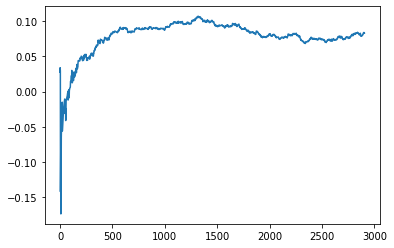

Thread: 6 iteration: 490
RAM mDiffFit_333 FROM: 1344 --> 2624 reward: -0.03936719023437499
Thread: 1 iteration: 455
RAM mDiffFit_274 FROM: 384 --> 2624 reward: -0.16305466835937502
Thread: 4 iteration: 486
RAM mDiffFit_15 FROM: 2304 --> 2880 reward: 0.014179712109375006
Thread: 2 iteration: 493
RAM mDiffFit_347 FROM: 320 --> 2624 reward: -0.19051557578124995
Thread: 6 iteration: 491
RAM mBackground_78 FROM: 1664 --> 768 reward: 0.05473534768750002
Thread: 1 iteration: 456
RAM mDiffFit_157 FROM: 2624 --> 256 reward: 0.06063004609374999
Thread: 4 iteration: 487
RAM mDiffFit_149 FROM: 1984 --> 256 reward: 0.153356748046875
Thread: 2 iteration: 494
RAM mDiffFit_56 FROM: 2752 --> 256 reward: 0.27238008984375006
Thread: 6 iteration: 492
RAM mDiffFit_419 FROM: 1600 --> 256 reward: 0.14954163749999996
Thread: 4 iteration: 488
RAM mDiffFit_291 FROM: 1280 --> 256 reward: 0.3624062390625
Thread: 1 iteration: 457
RAM mDiffFit_60 FROM: 2560 --> 256 reward: 0.1024269921875
Thread: 2 iteration: 495
R

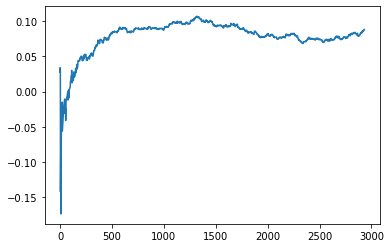

Thread: 1 iteration: 460
RAM mDiffFit_213 FROM: 2880 --> 1088 reward: 0.019799403515625008
Thread: 2 iteration: 498
RAM mDiffFit_157 FROM: 960 --> 1088 reward: 0.08645840625
Thread: 3 iteration: 474
RAM mDiffFit_31 FROM: 576 --> 1088 reward: -0.0372812390625
Thread: 5 iteration: 517
RAM mProject_30 FROM: 1344 --> 2112 reward: -0.03519972217968743
Saving ...


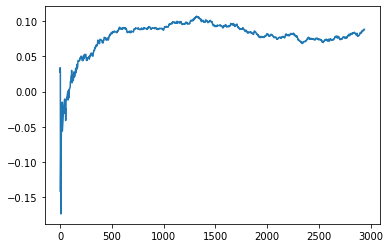

Thread: 4 iteration: 490
RAM mDiffFit_179 FROM: 384 --> 2624 reward: -0.220502501171875
Thread: 1 iteration: 461
RAM mDiffFit_252 FROM: 832 --> 1088 reward: -0.05691668124999997
Thread: 2 iteration: 499
RAM mDiffFit_338 FROM: 2368 --> 256 reward: 0.162726526953125
Thread: 3 iteration: 475
RAM mDiffFit_279 FROM: 2496 --> 256 reward: 0.313789005078125
Thread: 5 iteration: 518
RAM mDiffFit_331 FROM: 2048 --> 2944 reward: -0.010942699218750001
Saving ...


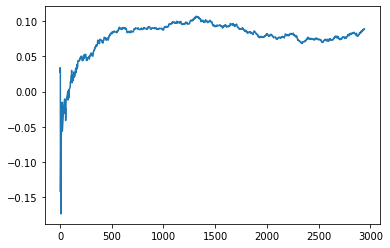

Thread: 2 iteration: 500
RAM mDiffFit_315 FROM: 1088 --> 2880 reward: 0.0032865039062499914
Thread: 3 iteration: 476
RAM mBackground_79 FROM: 1920 --> 1088 reward: 0.03875818370312496
Thread: 1 iteration: 462
RAM mProject_89 FROM: 1024 --> 2112 reward: -0.16594159914843754
Thread: 6 iteration: 496
RAM mDiffFit_369 FROM: 960 --> 2880 reward: 0.019929755859375002
Thread: 3 iteration: 477
RAM mDiffFit_217 FROM: 2560 --> 2880 reward: 0.035218804687500035
Thread: 6 iteration: 497
RAM mDiffFit_269 FROM: 1856 --> 2880 reward: -0.08748964531249998
Thread: 5 iteration: 519
RAM mBackground_87 FROM: 192 --> 2304 reward: -0.6812072003046876
Thread: 1 iteration: 463
RAM mProject_27 FROM: 1216 --> 2112 reward: -0.08567144732812514
Thread: 4 iteration: 491
RAM mDiffFit_98 FROM: 832 --> 2752 reward: -0.023179668359375002
Thread: 3 iteration: 478
RAM mDiffFit_129 FROM: 1856 --> 2880 reward: -0.013466128515624998
Thread: 6 iteration: 498
RAM mDiffFit_343 FROM: 2368 --> 2880 reward: 0.007687521875000009


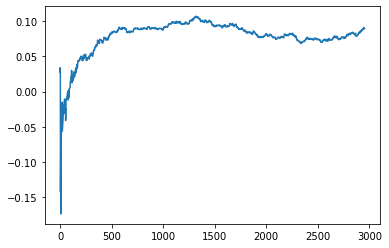

Thread: 5 iteration: 520
RAM mDiffFit_196 FROM: 2368 --> 2880 reward: 0.009687521875000014
Thread: 4 iteration: 492
RAM mDiffFit_248 FROM: 128 --> 2880 reward: -0.41548692539062504
Thread: 1 iteration: 464
RAM mProject_73 FROM: 2624 --> 2112 reward: -0.10331925707812499
Thread: 2 iteration: 501
RAM mDiffFit_348 FROM: 1472 --> 256 reward: 0.1358645578125
Thread: 3 iteration: 479
RAM mDiffFit_263 FROM: 1472 --> 256 reward: 0.1241666375
Thread: 5 iteration: 521
RAM mDiffFit_149 FROM: 768 --> 256 reward: 0.1334062390625
Thread: 4 iteration: 493
RAM mDiffFit_99 FROM: 2816 --> 256 reward: 0.04992690468749998
Thread: 1 iteration: 465
RAM mDiffFit_397 FROM: 1216 --> 256 reward: 0.47283340625000003
Thread: 2 iteration: 502
RAM mDiffFit_145 FROM: 2304 --> 256 reward: 0.369229159375
Saving ...


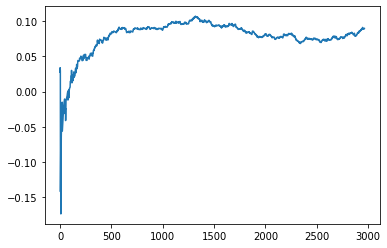

Thread: 3 iteration: 480
RAM mDiffFit_384 FROM: 1984 --> 256 reward: 0.06940093046875001
Thread: 4 iteration: 494
RAM mBackground_40 FROM: 2432 --> 1984 reward: 0.04529334587499999
Thread: 2 iteration: 503
RAM mDiffFit_323 FROM: 832 --> 256 reward: 0.31647393828125003
Thread: 1 iteration: 466
RAM mBgModel_1 FROM: 704 --> 320 reward: 0.45456770796875007
Thread: 6 iteration: 499
RAM mDiffFit_132 FROM: 1856 --> 2944 reward: -0.027190110546874997
Thread: 4 iteration: 495
RAM mDiffFit_193 FROM: 1472 --> 2944 reward: 0.08462254257812503
Thread: 2 iteration: 504
RAM mDiffFit_284 FROM: 448 --> 2752 reward: -0.19235674804687497
Saving ...


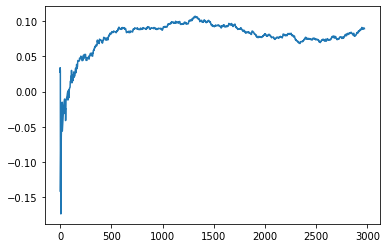

Thread: 6 iteration: 500
RAM mDiffFit_238 FROM: 896 --> 2880 reward: 0.09239601562500002
Thread: 2 iteration: 505
RAM mBackground_1 FROM: 2304 --> 1984 reward: 0.0028487311874999797
Thread: 4 iteration: 496
RAM mProject_45 FROM: 2176 --> 2240 reward: 0.007481735648437515
Thread: 3 iteration: 481
RAM mBackground_43 FROM: 1408 --> 768 reward: 0.12634385573437504
Thread: 2 iteration: 506
RAM mBackground_66 FROM: 2112 --> 704 reward: 0.14766017384374996
Thread: 4 iteration: 497
RAM mBackground_45 FROM: 1088 --> 2304 reward: -0.5777299779609376
Thread: 3 iteration: 482
RAM mDiffFit_264 FROM: 256 --> 1152 reward: -0.23517185859375006
Thread: 2 iteration: 507
RAM mDiffFit_348 FROM: 1408 --> 2624 reward: -0.014950508984374992
Thread: 3 iteration: 483
RAM mDiffFit_202 FROM: 256 --> 2624 reward: -0.135361925390625
Thread: 4 iteration: 498
RAM mProject_18 FROM: 1024 --> 384 reward: -1.0
Thread: 5 iteration: 522
RAM mProject_60 FROM: 1664 --> 2240 reward: 0.03975483023437489
Thread: 6 iteration: 5

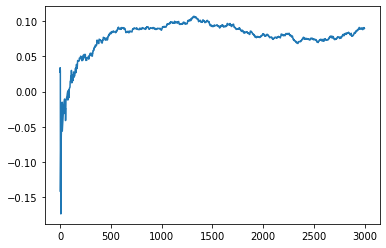

Thread: 5 iteration: 530
RAM mDiffFit_81 FROM: 128 --> 320 reward: -0.4484244910156249
Thread: 3 iteration: 487
RAM mProject_41 FROM: 1216 --> 384 reward: -1.0
Thread: 2 iteration: 509
RAM mProject_85 FROM: 1280 --> 384 reward: -1.0
Thread: 1 iteration: 468
RAM mDiffFit_257 FROM: 1536 --> 256 reward: 0.09803119531250003
Saving ...


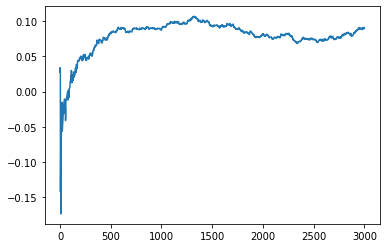

Thread: 2 iteration: 510
RAM mDiffFit_51 FROM: 1728 --> 256 reward: 0.07362232382812499
Thread: 1 iteration: 469
RAM mProject_56 FROM: 1920 --> 2240 reward: 0.05955761812499996
Thread: 6 iteration: 504
RAM mDiffFit_159 FROM: 1472 --> 256 reward: 0.068466084765625
Thread: 2 iteration: 511
RAM mProject_45 FROM: 1920 --> 2240 reward: 0.061632775195312524
Thread: 5 iteration: 531
RAM mBackground_35 FROM: 896 --> 768 reward: 0.045091778671875006
Thread: 2 iteration: 512
RAM mProject_45 FROM: 2112 --> 2240 reward: 0.021493170281249918
Thread: 3 iteration: 488
RAM mDiffFit_315 FROM: 2240 --> 256 reward: 0.15790356289062502
Thread: 5 iteration: 532
RAM mProject_63 FROM: 832 --> 896 reward: 0.9265140645468751
Thread: 4 iteration: 499
RAM mDiffFit_421 FROM: 2560 --> 256 reward: 0.079062434375
Thread: 3 iteration: 489
RAM mBackground_63 FROM: 704 --> 768 reward: -0.023005000000000032
Thread: 2 iteration: 513
RAM mDiffFit_129 FROM: 2880 --> 256 reward: 0.111622323828125
Thread: 5 iteration: 533
RA

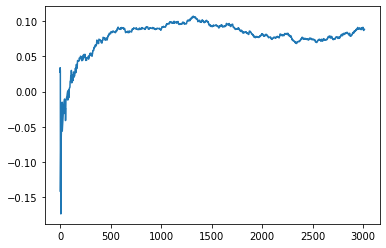

Thread: 3 iteration: 490
RAM mDiffFit_337 FROM: 640 --> 2880 reward: -0.11384104101562503
Thread: 5 iteration: 534
RAM mDiffFit_56 FROM: 2048 --> 256 reward: 0.29783327500000006
Thread: 2 iteration: 514
RAM mDiffFit_115 FROM: 768 --> 2880 reward: 0.012554755859375006
Thread: 3 iteration: 491
RAM mBackground_76 FROM: 1344 --> 768 reward: 0.08851279839062504
Thread: 5 iteration: 535
RAM mProject_35 FROM: 448 --> 896 reward: 0.9341884441406251
Saving ...


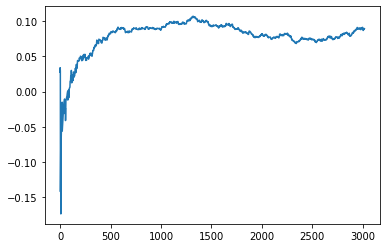

Thread: 1 iteration: 470
RAM mDiffFit_182 FROM: 384 --> 1088 reward: -0.166872411328125
Thread: 3 iteration: 492
RAM mProject_24 FROM: 768 --> 896 reward: 0.9267615645468752
Thread: 6 iteration: 505
RAM mBackground_67 FROM: 1472 --> 768 reward: 0.0974106590546875
Thread: 2 iteration: 515
RAM mProject_45 FROM: 1792 --> 2112 reward: 0.042888379851562394
Saving ...


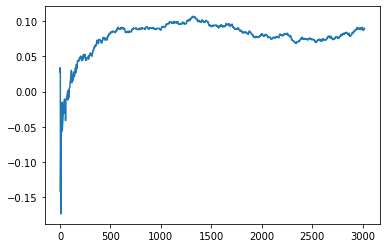

Thread: 4 iteration: 500
RAM mDiffFit_113 FROM: 192 --> 2624 reward: -0.4745155320312499
Thread: 5 iteration: 536
RAM mDiffFit_410 FROM: 2048 --> 256 reward: 0.1363437171875
Thread: 3 iteration: 493
RAM mBackground_50 FROM: 1344 --> 768 reward: 0.044666193562499956
Thread: 1 iteration: 471
RAM mDiffFit_228 FROM: 640 --> 256 reward: 0.09197393828124999
Thread: 2 iteration: 516
RAM mBackground_30 FROM: 1408 --> 768 reward: 0.18450139335937502
Thread: 6 iteration: 506
RAM mDiffFit_153 FROM: 1152 --> 256 reward: 0.13103123906250003
Thread: 4 iteration: 501
RAM mDiffFit_103 FROM: 448 --> 256 reward: 0.106270840625
Thread: 5 iteration: 537
RAM mBackground_21 FROM: 2752 --> 1088 reward: -0.008904727562500032
Thread: 3 iteration: 494
RAM mDiffFit_52 FROM: 1600 --> 256 reward: 0.121395796875
Thread: 1 iteration: 472
RAM mDiffFit_201 FROM: 1600 --> 256 reward: 0.20008331874999996
Thread: 6 iteration: 507
RAM mDiffFit_204 FROM: 448 --> 256 reward: 0.074007809765625
Thread: 5 iteration: 538
RAM mD

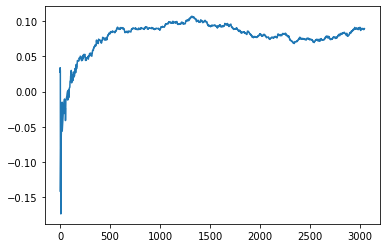

Thread: 5 iteration: 540
RAM mDiffFit_171 FROM: 256 --> 2752 reward: -0.12525254492187501
Thread: 4 iteration: 504
RAM mBackground_45 FROM: 512 --> 768 reward: -0.19249669174999998
Thread: 6 iteration: 509
RAM mDiffFit_394 FROM: 1408 --> 256 reward: 0.16200517734375
Thread: 1 iteration: 475
RAM mDiffFit_50 FROM: 2816 --> 1088 reward: 0.007661372656250012
Thread: 4 iteration: 505
RAM mDiffFit_314 FROM: 384 --> 256 reward: 0.09114584062499997
Thread: 5 iteration: 541
RAM mDiffFit_353 FROM: 1984 --> 256 reward: 0.107833275
Saving ...


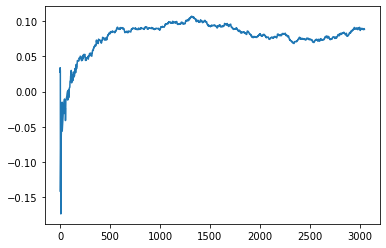

Thread: 6 iteration: 510
RAM mProject_73 FROM: 1792 --> 2112 reward: 0.045382602375000025
Thread: 3 iteration: 496
RAM mProject_31 FROM: 1280 --> 2112 reward: -0.07416646045312489
Thread: 2 iteration: 519
RAM mDiffFit_263 FROM: 1024 --> 2944 reward: 0.008104246875000002
Thread: 3 iteration: 497
RAM mBackground_53 FROM: 2496 --> 704 reward: 0.07895190191406246
Thread: 5 iteration: 542
RAM mDiffFit_193 FROM: 832 --> 2880 reward: -0.08659634960937498
Thread: 6 iteration: 511
RAM mDiffFit_238 FROM: 576 --> 2880 reward: -0.027289005078124998
Thread: 3 iteration: 498
RAM mDiffFit_257 FROM: 2496 --> 2880 reward: -0.013695331640625006
Thread: 5 iteration: 543
RAM mDiffFit_285 FROM: 1088 --> 2880 reward: 0.049291768750000006
Thread: 6 iteration: 512
RAM mDiffFit_55 FROM: 2816 --> 2880 reward: 0.031875043750000026
Thread: 3 iteration: 499
RAM mProject_90 FROM: 1536 --> 2112 reward: 0.0017312044921876323
Thread: 4 iteration: 506
RAM mProject_61 FROM: 2944 --> 2112 reward: -0.142516223296875
Savin

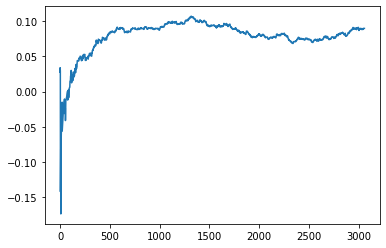

Thread: 2 iteration: 520
RAM mDiffFit_370 FROM: 2624 --> 1088 reward: 0.0013072570312499913
Thread: 5 iteration: 544
RAM mDiffFit_25 FROM: 2944 --> 1088 reward: -0.005528694140625005
Thread: 6 iteration: 513
RAM mProject_23 FROM: 384 --> 896 reward: 0.926941564546875
Thread: 1 iteration: 476
RAM mDiffFit_88 FROM: 1664 --> 2624 reward: 0.03901570703125003
Saving ...


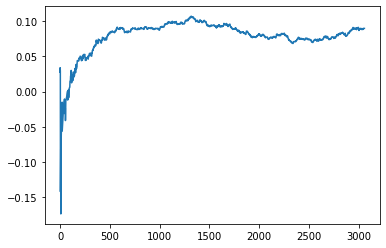

Thread: 3 iteration: 500
RAM mDiffFit_54 FROM: 192 --> 1152 reward: -0.27376561953125
Thread: 4 iteration: 507
RAM mDiffFit_293 FROM: 1600 --> 2880 reward: -0.005049447265624996
Thread: 5 iteration: 545
RAM mDiffFit_248 FROM: 1280 --> 256 reward: 0.0959478765625
Thread: 2 iteration: 521
RAM mDiffFit_108 FROM: 1536 --> 256 reward: 0.11572911562500003
Thread: 6 iteration: 514
RAM mDiffFit_289 FROM: 2688 --> 256 reward: 0.09452597421875
Thread: 4 iteration: 508
RAM mDiffFit_85 FROM: 2624 --> 256 reward: -0.006989820312500068
Thread: 3 iteration: 501
RAM mDiffFit_244 FROM: 576 --> 256 reward: 0.06440101796875
Thread: 5 iteration: 546
RAM mDiffFit_417 FROM: 1536 --> 256 reward: 0.12371871718750002
Thread: 4 iteration: 509
RAM mDiffFit_41 FROM: 1152 --> 256 reward: 0.16392707968749998
Thread: 6 iteration: 515
RAM mBackground_11 FROM: 1536 --> 704 reward: 0.1222812311875
Thread: 2 iteration: 522
RAM mDiffFit_301 FROM: 2176 --> 256 reward: 0.1557811953125
Thread: 3 iteration: 502
RAM mBackgrou

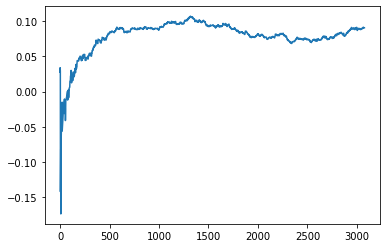

Thread: 4 iteration: 510
RAM mDiffFit_5 FROM: 2048 --> 256 reward: 0.2681979203125
Thread: 3 iteration: 503
RAM mDiffFit_179 FROM: 1024 --> 256 reward: 0.31398955781250004
Thread: 2 iteration: 523
RAM mDiffFit_122 FROM: 2112 --> 256 reward: 0.5267682957031249
Thread: 5 iteration: 548
RAM mProject_29 FROM: 2560 --> 320 reward: -1.0
Thread: 1 iteration: 477
RAM mDiffFit_24 FROM: 2432 --> 1088 reward: 0.032281239062499995
Thread: 3 iteration: 504
RAM mDiffFit_121 FROM: 256 --> 256 reward: -0.00449999999999999
Thread: 4 iteration: 511
RAM mBackground_21 FROM: 2880 --> 1088 reward: -0.3469904151796875
Thread: 2 iteration: 524
RAM mDiffFit_366 FROM: 768 --> 256 reward: 0.289229203125
Thread: 6 iteration: 517
RAM mDiffFit_357 FROM: 2240 --> 1088 reward: 0.012010398437499997
Thread: 5 iteration: 549
RAM mDiffFit_35 FROM: 2944 --> 1088 reward: -0.004528694140624994
Thread: 1 iteration: 478
RAM mDiffFit_118 FROM: 1856 --> 2880 reward: -0.0053411285156250085
Thread: 4 iteration: 512
RAM mDiffFit_

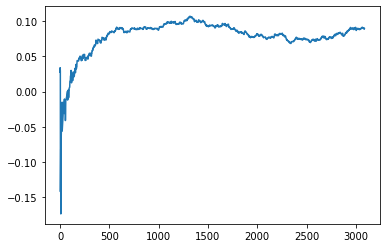

Thread: 5 iteration: 550
RAM mDiffFit_202 FROM: 2688 --> 1088 reward: -0.08573192304687499
Thread: 2 iteration: 525
RAM mDiffFit_27 FROM: 2816 --> 1088 reward: -0.012041724999999996
Thread: 1 iteration: 479
RAM mDiffFit_171 FROM: 1856 --> 1088 reward: -0.027968804687500022
Thread: 4 iteration: 513
RAM mDiffFit_116 FROM: 2496 --> 1088 reward: -0.003205773828124977
Thread: 5 iteration: 551
RAM mDiffFit_401 FROM: 128 --> 320 reward: -0.38278646015624984
Thread: 2 iteration: 526
RAM mDiffFit_231 FROM: 640 --> 2624 reward: -0.027971305859374983
Thread: 6 iteration: 519
RAM mDiffFit_169 FROM: 2496 --> 1088 reward: 0.006041637500000009
Thread: 5 iteration: 552
RAM mDiffFit_348 FROM: 2112 --> 1088 reward: -0.023166725000000003
Saving ...


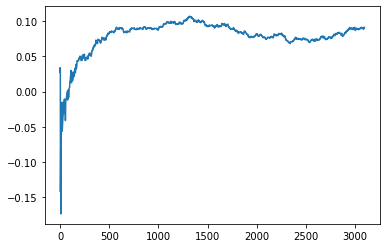

Thread: 6 iteration: 520
RAM mBackground_79 FROM: 1728 --> 704 reward: 0.10720432796874993
Thread: 4 iteration: 514
RAM mProject_58 FROM: 512 --> 896 reward: 0.94454126353125
Thread: 3 iteration: 505
RAM mDiffFit_275 FROM: 384 --> 256 reward: -0.07205734453125004
Thread: 2 iteration: 527
RAM mDiffFit_155 FROM: 704 --> 256 reward: 0.0632916375
Thread: 5 iteration: 553
RAM mDiffFit_366 FROM: 512 --> 256 reward: 0.05651039843749997
Thread: 6 iteration: 521
RAM mProject_86 FROM: 1344 --> 2112 reward: -0.04414629550781236
Saving ...


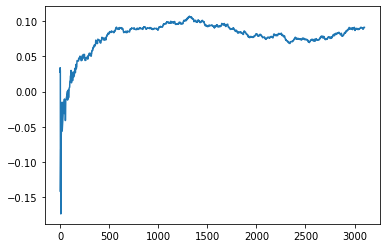

Thread: 1 iteration: 480
RAM mDiffFit_344 FROM: 704 --> 256 reward: 0.132466128515625
Thread: 3 iteration: 506
RAM mDiffFit_390 FROM: 1344 --> 2944 reward: 0.040573007812500006
Thread: 6 iteration: 522
RAM mDiffFit_149 FROM: 2112 --> 2176 reward: 0.022987012890625
Thread: 5 iteration: 554
RAM mDiffFit_4 FROM: 1536 --> 2624 reward: 0.0019297121093750022
Thread: 1 iteration: 481
RAM mDiffFit_2 FROM: 2432 --> 384 reward: 0.19113008984375
Thread: 2 iteration: 528
RAM mDiffFit_251 FROM: 1920 --> 2624 reward: 0.012177123437500034
Thread: 3 iteration: 507
RAM mDiffFit_400 FROM: 3008 --> 384 reward: 0.06819524414062501
Thread: 6 iteration: 523
RAM mDiffFit_284 FROM: 2688 --> 384 reward: 0.11610933671875001
Thread: 5 iteration: 555
RAM mDiffFit_359 FROM: 576 --> 2624 reward: -0.07108590742187498
Thread: 1 iteration: 482
RAM mBgModel_1 FROM: 640 --> 320 reward: 0.3973041593750001
Thread: 4 iteration: 515
RAM mBackground_73 FROM: 2240 --> 2944 reward: 0.0464557719296875
Thread: 5 iteration: 556
R

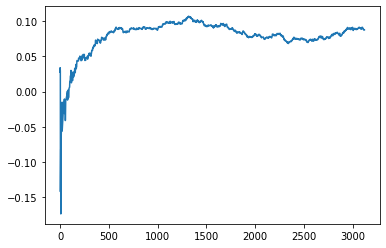

Thread: 2 iteration: 530
RAM mBackground_22 FROM: 1664 --> 768 reward: 0.13074686559375004
Thread: 1 iteration: 484
RAM mDiffFit_295 FROM: 896 --> 256 reward: 0.09250517734375002
Thread: 5 iteration: 558
RAM mDiffFit_298 FROM: 1600 --> 256 reward: 0.10262754492187501
Thread: 1 iteration: 485
RAM mDiffFit_194 FROM: 1536 --> 256 reward: 0.17951039843750002
Thread: 2 iteration: 531
RAM mProject_47 FROM: 192 --> 896 reward: 0.940895323734375
Thread: 6 iteration: 524
RAM mBackground_45 FROM: 2432 --> 2944 reward: 0.03438215231250001
Thread: 5 iteration: 559
RAM mBackground_60 FROM: 1728 --> 768 reward: 0.12270451478906254
Thread: 1 iteration: 486
RAM mProject_31 FROM: 1984 --> 2112 reward: 0.017130507960937725
Thread: 4 iteration: 517
RAM mProject_8 FROM: 2048 --> 2112 reward: 0.014816277562499924
Saving ...


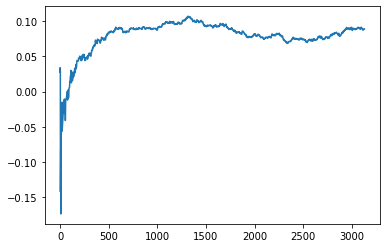

Thread: 3 iteration: 510
RAM mDiffFit_167 FROM: 512 --> 256 reward: -0.024416724999999986
Thread: 6 iteration: 525
RAM mDiffFit_372 FROM: 896 --> 256 reward: 0.10849477890624999
Saving ...


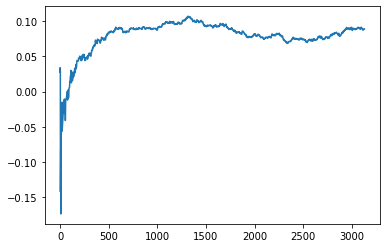

Thread: 5 iteration: 560
RAM mDiffFit_85 FROM: 128 --> 256 reward: -0.60463026484375
Thread: 1 iteration: 487
RAM mDiffFit_269 FROM: 2304 --> 2752 reward: 0.009945331640624985
Thread: 1 iteration: 488
RAM mDiffFit_48 FROM: 3008 --> 384 reward: 0.049460863671875015
Thread: 5 iteration: 561
RAM mBackground_26 FROM: 1600 --> 768 reward: 0.17241883108593745
Thread: 4 iteration: 518
RAM mBackground_68 FROM: 1472 --> 768 reward: 0.06527261157031249
Thread: 3 iteration: 511
RAM mDiffFit_14 FROM: 2624 --> 384 reward: 0.03072907187499998
Thread: 6 iteration: 526
RAM mDiffFit_311 FROM: 2560 --> 2496 reward: 0.05280475585937501
Thread: 1 iteration: 489
RAM mDiffFit_114 FROM: 320 --> 1152 reward: -0.0909062390625
Thread: 5 iteration: 562
RAM mDiffFit_146 FROM: 1728 --> 2944 reward: 0.021976614453124994
Thread: 3 iteration: 512
RAM mDiffFit_158 FROM: 1280 --> 2496 reward: -0.004262987109375019
Thread: 6 iteration: 527
RAM mDiffFit_246 FROM: 1280 --> 2752 reward: -0.0019270359374999949
Thread: 4 ite

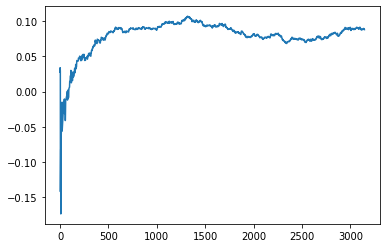

Thread: 1 iteration: 490
RAM mBackground_21 FROM: 2240 --> 704 reward: 0.14229411649999996
Thread: 3 iteration: 513
RAM mDiffFit_338 FROM: 1920 --> 2944 reward: 1.60758015390625
Thread: 6 iteration: 528
RAM mDiffFit_99 FROM: 192 --> 1152 reward: -0.2525312390625
Thread: 5 iteration: 564
RAM mDiffFit_44 FROM: 192 --> 1152 reward: -0.31861719023437496
Thread: 2 iteration: 533
RAM mBackground_90 FROM: 1984 --> 704 reward: 0.11473155422656255
Thread: 3 iteration: 514
RAM mImgtbl_2 FROM: 2240 --> 1408 reward: 0.16457714968750004
Thread: 1 iteration: 491
RAM mDiffFit_244 FROM: 2624 --> 256 reward: 0.136736925390625
Thread: 5 iteration: 565
RAM mBackground_10 FROM: 192 --> 704 reward: -0.9468376621718749
Saving ...


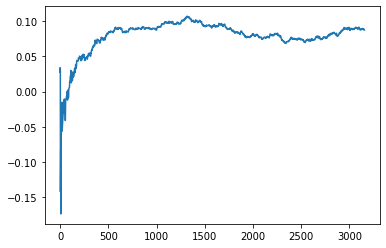

Thread: 4 iteration: 520
RAM mDiffFit_211 FROM: 576 --> 256 reward: 0.061747367578125004
Thread: 1 iteration: 492
RAM mBackground_9 FROM: 2368 --> 704 reward: 0.19364776076562495
Thread: 2 iteration: 534
RAM mDiffFit_165 FROM: 896 --> 256 reward: 0.28267185859375
Thread: 5 iteration: 566
RAM mProject_42 FROM: 1024 --> 2112 reward: -0.17482910702343746
Thread: 6 iteration: 529
RAM mDiffFit_350 FROM: 1600 --> 256 reward: 0.17056247812499997
Thread: 1 iteration: 493
RAM mDiffFit_17 FROM: 832 --> 256 reward: 0.10842185859375
Thread: 2 iteration: 535
RAM mBackground_30 FROM: 1472 --> 704 reward: 0.09289562142968745
Thread: 4 iteration: 521
RAM mDiffFit_52 FROM: 512 --> 2880 reward: -0.10524736757812501
Saving ...


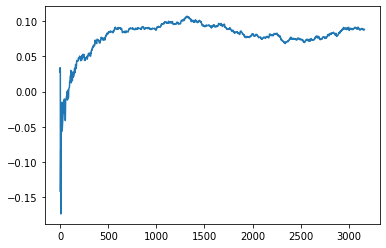

Thread: 6 iteration: 530
RAM mDiffFit_336 FROM: 640 --> 2880 reward: -0.06779944726562499
Thread: 1 iteration: 494
RAM mDiffFit_329 FROM: 1408 --> 256 reward: 0.12756769921875002
Thread: 2 iteration: 536
RAM mDiffFit_197 FROM: 832 --> 2880 reward: -0.013773385546874996
Thread: 4 iteration: 522
RAM mProject_76 FROM: 2432 --> 2112 reward: -0.05464089035156242
Thread: 5 iteration: 567
RAM mBackground_28 FROM: 1216 --> 768 reward: 0.09040078360156248
Thread: 2 iteration: 537
RAM mProject_74 FROM: 704 --> 896 reward: 0.9228456247500001
Thread: 3 iteration: 515
RAM mDiffFit_181 FROM: 512 --> 2752 reward: -0.20998179179687498
Thread: 6 iteration: 531
RAM mBackground_10 FROM: 1408 --> 960 reward: 0.0402206590546875
Thread: 4 iteration: 523
RAM mDiffFit_226 FROM: 3008 --> 384 reward: 0.031101483203125023
Thread: 5 iteration: 568
RAM mDiffFit_65 FROM: 128 --> 2880 reward: -0.797294269921875
Thread: 2 iteration: 538
RAM mDiffFit_192 FROM: 704 --> 2880 reward: -0.0015546246093749855
Thread: 6 iter

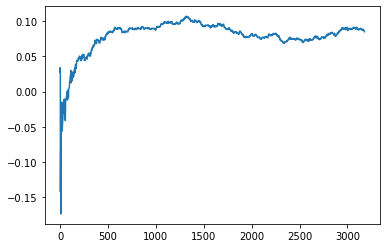

Thread: 5 iteration: 570
RAM mDiffFit_121 FROM: 576 --> 256 reward: 0.101604159375
Thread: 6 iteration: 533
RAM mProject_29 FROM: 640 --> 896 reward: 0.959598462515625
Thread: 1 iteration: 495
RAM mDiffFit_221 FROM: 384 --> 256 reward: 0.014510398437500016
Thread: 4 iteration: 525
RAM mDiffFit_334 FROM: 1728 --> 2944 reward: 0.006171902343750004
Thread: 5 iteration: 571
RAM mDiffFit_241 FROM: 1984 --> 2176 reward: 0.01260157070312501
Thread: 1 iteration: 496
RAM mDiffFit_288 FROM: 768 --> 256 reward: 0.128354159375
Thread: 6 iteration: 534
RAM mProject_29 FROM: 1536 --> 2112 reward: 0.002835110250000017
Thread: 2 iteration: 539
RAM mDiffFit_297 FROM: 384 --> 2752 reward: -0.077648385546875
Thread: 3 iteration: 518
RAM mDiffFit_389 FROM: 896 --> 2752 reward: -0.00026289960937501966
Thread: 1 iteration: 497
RAM mBackground_47 FROM: 2112 --> 2944 reward: 0.07467680462500002
Saving ...


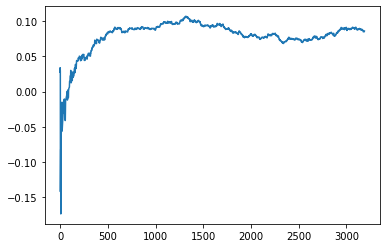

Thread: 2 iteration: 540
RAM mDiffFit_321 FROM: 384 --> 2752 reward: -0.05132024414062502
Thread: 4 iteration: 526
RAM mDiffFit_347 FROM: 1536 --> 2752 reward: 0.09782827265624996
Thread: 3 iteration: 519
RAM mViewer_3 FROM: 384 --> 960 reward: -0.20683778001562503
Thread: 6 iteration: 535
RAM mDiffFit_111 FROM: 832 --> 2752 reward: -0.037059845703125
Thread: 5 iteration: 572
RAM mDiffFit_295 FROM: 1664 --> 2752 reward: -0.01458331874999998
Thread: 1 iteration: 498
RAM mDiffFit_407 FROM: 384 --> 2880 reward: -0.204414048828125
Thread: 4 iteration: 527
RAM mBackground_81 FROM: 128 --> 2944 reward: 0.312910500796875
Saving ...


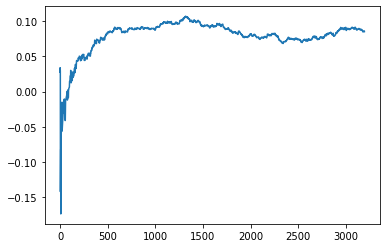

Thread: 3 iteration: 520
RAM mDiffFit_56 FROM: 704 --> 2624 reward: -0.07133586367187497
Thread: 5 iteration: 573
RAM mBackground_9 FROM: 768 --> 768 reward: 0.05270190321875005
Thread: 6 iteration: 536
RAM mDiffFit_14 FROM: 2240 --> 2880 reward: 0.010171902343749997
Thread: 1 iteration: 499
RAM mDiffFit_301 FROM: 1536 --> 1088 reward: -0.042578185156249976
Thread: 5 iteration: 574
RAM mDiffFit_294 FROM: 1728 --> 1088 reward: 0.025697920312499987
Thread: 6 iteration: 537
RAM mBackground_26 FROM: 128 --> 960 reward: 0.3441547781640624
Thread: 4 iteration: 528
RAM mDiffFit_361 FROM: 640 --> 1088 reward: -0.029656239062499992
Saving ...


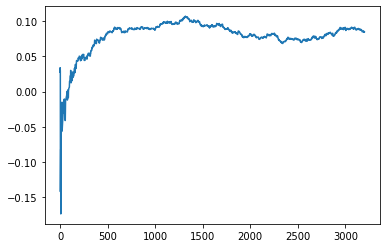

Thread: 1 iteration: 500
RAM mDiffFit_374 FROM: 1984 --> 256 reward: 0.07227593046875001
Thread: 1 iteration: 501
RAM mBackground_75 FROM: 704 --> 960 reward: -0.052077014789062515
Thread: 4 iteration: 529
RAM mBackground_79 FROM: 832 --> 768 reward: 0.038558918007812526
Thread: 6 iteration: 538
RAM mBackground_26 FROM: 1536 --> 768 reward: 0.05039055915624998
Thread: 5 iteration: 575
RAM mProject_28 FROM: 1152 --> 2624 reward: -0.026174711249999903
Thread: 3 iteration: 521
RAM mProject_21 FROM: 1088 --> 384 reward: -1.0
Thread: 2 iteration: 541
RAM mDiffFit_357 FROM: 2816 --> 256 reward: 0.058281107812499997
Saving ...


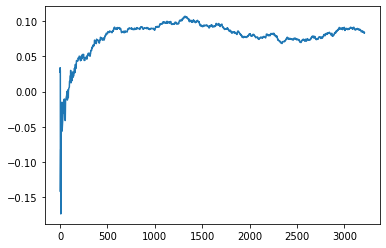

Thread: 4 iteration: 530
RAM mDiffFit_79 FROM: 2688 --> 256 reward: 0.19141659375000003
Thread: 1 iteration: 502
RAM mBackground_70 FROM: 512 --> 960 reward: -0.2852132343046874
Thread: 3 iteration: 522
RAM mDiffFit_13 FROM: 2496 --> 832 reward: 0.06712500000000002
Thread: 2 iteration: 542
RAM mDiffFit_193 FROM: 768 --> 2752 reward: 0.0193230078125
Thread: 2 iteration: 543
RAM mBackground_42 FROM: 2240 --> 704 reward: 0.12169664114843746
Thread: 4 iteration: 531
RAM mBackground_71 FROM: 2048 --> 768 reward: 0.10061098209374998
Thread: 3 iteration: 523
RAM mDiffFit_108 FROM: 2688 --> 2624 reward: -0.0032421902343749906
Thread: 2 iteration: 544
RAM mDiffFit_169 FROM: 320 --> 2752 reward: -0.12289057578125001
Thread: 3 iteration: 524
RAM mBackground_90 FROM: 3008 --> 768 reward: 0.04869285935937504
Thread: 2 iteration: 545
RAM mDiffFit_215 FROM: 2432 --> 2624 reward: 0.004476570703125012
Thread: 3 iteration: 525
RAM mBackground_80 FROM: 1088 --> 768 reward: 0.024628668914062474
Thread: 4 

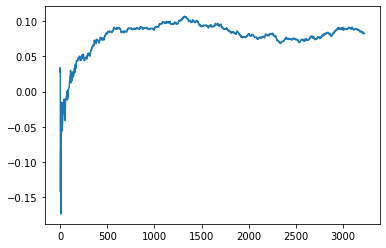

Thread: 6 iteration: 540
RAM mDiffFit_132 FROM: 2240 --> 256 reward: 0.09759630585937501
Thread: 2 iteration: 547
RAM mDiffFit_321 FROM: 1856 --> 2944 reward: -0.054531282812500005
Thread: 5 iteration: 578
RAM mDiffFit_335 FROM: 128 --> 2176 reward: -0.84360938046875
Thread: 6 iteration: 541
RAM mDiffFit_92 FROM: 640 --> 256 reward: 0.1303020796875
Thread: 4 iteration: 535
RAM mDiffFit_150 FROM: 1280 --> 2752 reward: 0.013830773828124995
Thread: 2 iteration: 548
RAM mBackground_39 FROM: 960 --> 768 reward: 0.06552798521093747
Thread: 3 iteration: 528
RAM mDiffFit_411 FROM: 1152 --> 256 reward: 0.35624999999999996
Thread: 1 iteration: 504
RAM mDiffFit_212 FROM: 1408 --> 2752 reward: -0.034742190234375026
Thread: 4 iteration: 536
RAM mBackground_29 FROM: 2432 --> 768 reward: 0.0924320018125
Thread: 5 iteration: 579
RAM mBackground_34 FROM: 192 --> 704 reward: -0.63006644265625
Thread: 6 iteration: 542
RAM mDiffFit_178 FROM: 384 --> 2624 reward: -0.09829159374999996
Thread: 1 iteration: 5

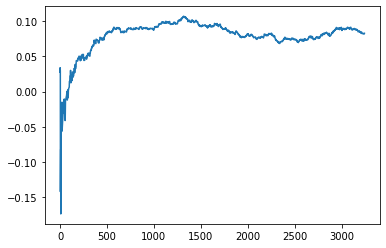

Thread: 5 iteration: 580
RAM mDiffFit_343 FROM: 1664 --> 256 reward: 0.10374995625000001
Thread: 6 iteration: 543
RAM mDiffFit_4 FROM: 640 --> 1984 reward: -0.10852601796875001
Saving ...


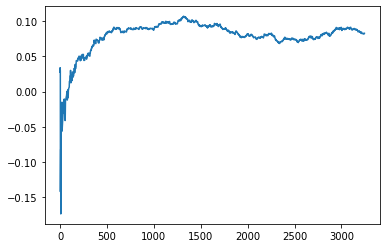

Thread: 2 iteration: 550
RAM mDiffFit_89 FROM: 320 --> 1984 reward: -0.07026294335937497
Saving ...


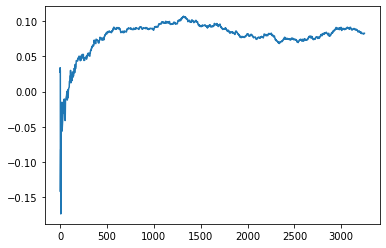

Thread: 3 iteration: 530
RAM mDiffFit_389 FROM: 960 --> 1984 reward: -0.004424403515625001
Thread: 4 iteration: 538
RAM mBackground_70 FROM: 2496 --> 704 reward: 0.1153182952734375
Thread: 1 iteration: 507
RAM mDiffFit_316 FROM: 2112 --> 256 reward: 0.168372367578125
Thread: 6 iteration: 544
RAM mDiffFit_403 FROM: 2624 --> 256 reward: 0.1637186734375
Thread: 2 iteration: 551
RAM mBackground_51 FROM: 2496 --> 704 reward: 0.09777560845312491
Thread: 5 iteration: 581
RAM mDiffFit_340 FROM: 1216 --> 2944 reward: 0.020005264843750016
Thread: 3 iteration: 531
RAM mBackground_26 FROM: 128 --> 704 reward: 0.36943516347656247
Thread: 4 iteration: 539
RAM mDiffFit_198 FROM: 832 --> 2752 reward: -0.030432257031250028
Thread: 1 iteration: 508
RAM mDiffFit_315 FROM: 576 --> 2752 reward: -0.08843484570312499
Thread: 3 iteration: 532
RAM mDiffFit_172 FROM: 2880 --> 384 reward: 0.033585863671874994
Thread: 5 iteration: 582
RAM mDiffFit_242 FROM: 640 --> 2752 reward: -0.09621612851562503
Saving ...


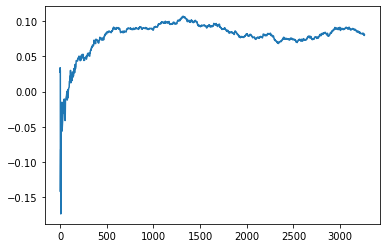

Thread: 4 iteration: 540
RAM mDiffFit_405 FROM: 896 --> 2752 reward: -0.02270831875000001
Thread: 1 iteration: 509
RAM mDiffFit_66 FROM: 1920 --> 2752 reward: -0.00477342929687501
Thread: 5 iteration: 583
RAM mDiffFit_132 FROM: 192 --> 2752 reward: -0.3074843367187501
Thread: 4 iteration: 541
RAM mProject_19 FROM: 1472 --> 2112 reward: -0.00755941591406255
Thread: 6 iteration: 545
RAM mProject_21 FROM: 2240 --> 2112 reward: -0.021464107453125023
Thread: 2 iteration: 552
RAM mDiffFit_118 FROM: 2624 --> 256 reward: 0.13012491249999997
Saving ...


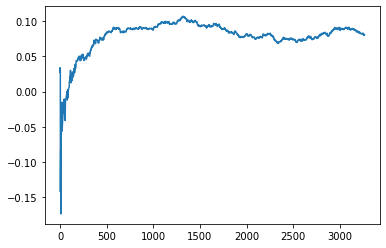

Thread: 1 iteration: 510
RAM mBackground_24 FROM: 768 --> 896 reward: 0.01678347042187501
Thread: 5 iteration: 584
RAM mDiffFit_325 FROM: 1472 --> 2880 reward: -0.014260398437499992
Thread: 4 iteration: 542
RAM mDiffFit_357 FROM: 1920 --> 2880 reward: -0.0030390488281249912
Thread: 2 iteration: 553
RAM mDiffFit_45 FROM: 2240 --> 256 reward: 0.04601548828125003
Thread: 6 iteration: 546
RAM mDiffFit_107 FROM: 1344 --> 256 reward: 0.10304163749999999
Thread: 1 iteration: 511
RAM mBackground_15 FROM: 192 --> 704 reward: -0.9100390425546875
Thread: 5 iteration: 585
RAM mDiffFit_419 FROM: 384 --> 256 reward: 0.08793230078125
Thread: 4 iteration: 543
RAM mBackground_17 FROM: 1984 --> 896 reward: 0.07359267384375005
Thread: 2 iteration: 554
RAM mDiffFit_123 FROM: 1536 --> 256 reward: 0.17355207968750003
Thread: 5 iteration: 586
RAM mProject_38 FROM: 256 --> 896 reward: 0.9336934441406249
Thread: 3 iteration: 533
RAM mDiffFit_130 FROM: 2304 --> 256 reward: 0.3329895140625
Thread: 1 iteration: 5

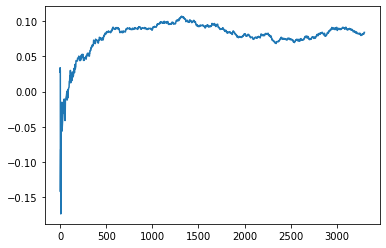

Thread: 2 iteration: 560
RAM mBackground_5 FROM: 2944 --> 704 reward: 0.07088713803124995
Thread: 1 iteration: 517
RAM mDiffFit_244 FROM: 1856 --> 256 reward: 0.019507678515625036
Saving ...


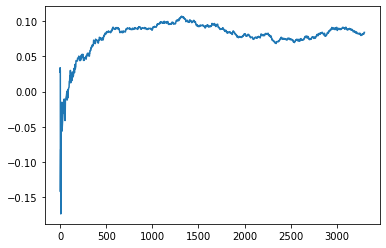

Thread: 6 iteration: 550
RAM mProject_64 FROM: 2816 --> 1728 reward: -0.18401054294531255
Saving ...


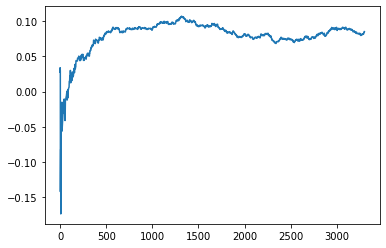

Thread: 5 iteration: 590
RAM mProject_84 FROM: 1280 --> 1728 reward: -0.11713031676562519
Thread: 3 iteration: 536
RAM mBackground_47 FROM: 384 --> 704 reward: -0.19921093279687496
Thread: 2 iteration: 561
RAM mBackground_60 FROM: 1920 --> 704 reward: 0.1485493033203124
Thread: 1 iteration: 518
RAM mDiffFit_397 FROM: 1280 --> 256 reward: 0.2701146015625
Thread: 6 iteration: 551
RAM mBackground_89 FROM: 2112 --> 704 reward: 0.0974016411484375
Thread: 5 iteration: 591
RAM mDiffFit_353 FROM: 2496 --> 256 reward: 0.194137987109375
Thread: 2 iteration: 562
RAM mBackground_39 FROM: 192 --> 704 reward: -0.6296610819921875
Thread: 3 iteration: 537
RAM mDiffFit_69 FROM: 768 --> 2752 reward: -0.054710907421875024
Thread: 1 iteration: 519
RAM mBackground_71 FROM: 2944 --> 1088 reward: -0.02119334717968753
Thread: 6 iteration: 552
RAM mBackground_27 FROM: 2496 --> 704 reward: 0.08842088219531251
Thread: 5 iteration: 592
RAM mBackground_26 FROM: 1536 --> 1792 reward: -0.013760000000000007
Thread: 6

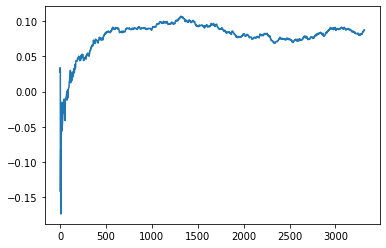

Thread: 1 iteration: 520
RAM mDiffFit_369 FROM: 576 --> 256 reward: 0.09313280976562499
Thread: 4 iteration: 548
RAM mBackground_64 FROM: 2240 --> 704 reward: 0.08785429034374999
Thread: 5 iteration: 595
RAM mDiffFit_357 FROM: 960 --> 256 reward: 0.08211714648437501
Thread: 1 iteration: 521
RAM mDiffFit_300 FROM: 2688 --> 256 reward: 0.13561973515625
Thread: 5 iteration: 596
RAM mDiffFit_127 FROM: 1856 --> 256 reward: 0.058296771093750005
Thread: 1 iteration: 522
RAM mDiffFit_220 FROM: 2240 --> 256 reward: 0.0880936734375
Thread: 5 iteration: 597
RAM mProject_23 FROM: 1152 --> 256 reward: -1.0
Thread: 2 iteration: 563
RAM mProject_46 FROM: 2048 --> 256 reward: -1.0
Thread: 3 iteration: 538
RAM mDiffFit_148 FROM: 3008 --> 384 reward: 0.05276031093749998
Thread: 1 iteration: 523
RAM mProject_20 FROM: 1600 --> 2624 reward: 0.09872043532031255
Thread: 4 iteration: 549
RAM mDiffFit_88 FROM: 1408 --> 2752 reward: -0.013906195312500015
Thread: 2 iteration: 564
RAM mBackground_16 FROM: 1408 --

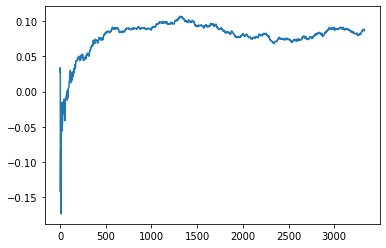

Thread: 4 iteration: 550
RAM mDiffFit_200 FROM: 512 --> 1152 reward: -0.10451039843749999
Saving ...


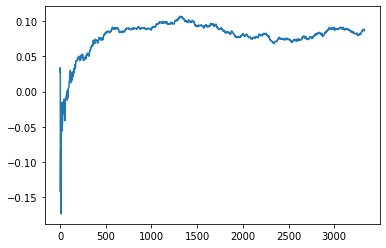

Thread: 3 iteration: 540
RAM mDiffFit_351 FROM: 2304 --> 2944 reward: -0.019109380468749996
Thread: 4 iteration: 551
RAM mDiffFit_390 FROM: 768 --> 1088 reward: -0.056578141406250004
Thread: 4 iteration: 552
RAM mDiffFit_78 FROM: 768 --> 2752 reward: -0.06755466835937503
Thread: 3 iteration: 541
RAM mProject_89 FROM: 1408 --> 2624 reward: 0.06812748773437485
Thread: 2 iteration: 565
RAM mDiffFit_231 FROM: 448 --> 256 reward: 0.34927610546875
Thread: 3 iteration: 542
RAM mDiffFit_197 FROM: 2880 --> 832 reward: 0.03707287656250001
Thread: 2 iteration: 566
RAM mProject_67 FROM: 704 --> 896 reward: 0.91667874515625
Thread: 5 iteration: 598
RAM mBackground_20 FROM: 1600 --> 192 reward: 0.8961759950703123
Thread: 4 iteration: 553
RAM mProject_53 FROM: 832 --> 896 reward: 0.9308800043437501
Thread: 6 iteration: 554
RAM mDiffFit_4 FROM: 448 --> 256 reward: 0.14852084062499998
Thread: 2 iteration: 567
RAM mProject_14 FROM: 1728 --> 256 reward: -1.0
Thread: 1 iteration: 524
RAM mDiffFit_222 FROM

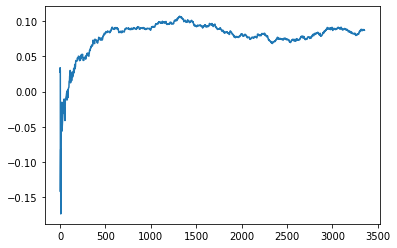

Thread: 5 iteration: 600
RAM mDiffFit_404 FROM: 2752 --> 1088 reward: 0.0009738945312500087
Thread: 1 iteration: 527
RAM mDiffFit_223 FROM: 2240 --> 256 reward: 0.14426035468749998
Saving ...


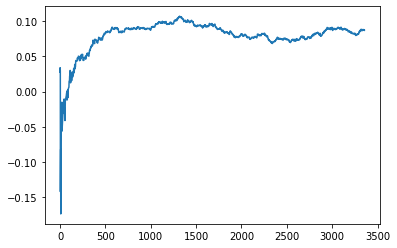

Thread: 2 iteration: 570
RAM mBackground_51 FROM: 320 --> 704 reward: -0.3566379852109376
Thread: 6 iteration: 558
RAM mDiffFit_187 FROM: 960 --> 1088 reward: -0.02336460156250001
Thread: 3 iteration: 545
RAM mDiffFit_58 FROM: 128 --> 1088 reward: -0.678377632421875
Thread: 5 iteration: 601
RAM mDiffFit_2 FROM: 1408 --> 1088 reward: -0.010479203124999989
Thread: 1 iteration: 528
RAM mBackground_5 FROM: 2176 --> 2944 reward: 0.02381579657812497
Thread: 3 iteration: 546
RAM mBackground_41 FROM: 1984 --> 768 reward: 0.10449218863281251
Thread: 6 iteration: 559
RAM mDiffFit_394 FROM: 960 --> 1088 reward: 0.0004323007812499953
Thread: 5 iteration: 602
RAM mDiffFit_230 FROM: 768 --> 1088 reward: -0.08385420312500003
Thread: 3 iteration: 547
RAM mDiffFit_50 FROM: 1664 --> 1088 reward: 0.023260398437500024
Saving ...


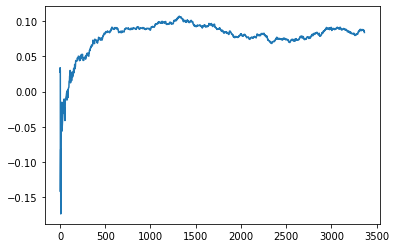

Thread: 6 iteration: 560
RAM mDiffFit_386 FROM: 2112 --> 1088 reward: 0.0001223675781250079
Thread: 3 iteration: 548
RAM mDiffFit_96 FROM: 1984 --> 1088 reward: 0.00048174804687500447
Thread: 6 iteration: 561
RAM mProject_46 FROM: 192 --> 2624 reward: 0.773351240765625
Thread: 2 iteration: 571
RAM mProject_59 FROM: 512 --> 896 reward: 0.9207296849531249
Thread: 4 iteration: 556
RAM mDiffFit_354 FROM: 1216 --> 1984 reward: 0.012341172265624995
Thread: 2 iteration: 572
RAM mProject_7 FROM: 448 --> 2560 reward: 0.7670446621875001
Thread: 1 iteration: 529
RAM mBackground_33 FROM: 896 --> 768 reward: 0.029746144265625024
Thread: 3 iteration: 549
RAM mDiffFit_234 FROM: 576 --> 1984 reward: -0.07028119531250002
Thread: 4 iteration: 557
RAM mBackground_90 FROM: 832 --> 768 reward: 0.01414072132812503
Thread: 6 iteration: 562
RAM mDiffFit_351 FROM: 960 --> 1984 reward: 0.016830773828124986
Thread: 2 iteration: 573
RAM mDiffFit_384 FROM: 2368 --> 1088 reward: -0.044812609375000007
Saving ...


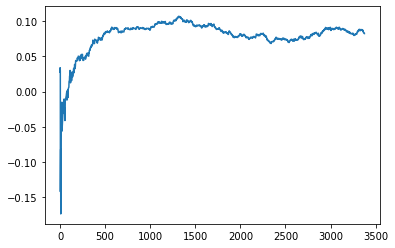

Thread: 3 iteration: 550
RAM mDiffFit_314 FROM: 2176 --> 1088 reward: -0.02098964531249999
Thread: 6 iteration: 563
RAM mDiffFit_312 FROM: 1472 --> 256 reward: 0.2248020796875
Saving ...


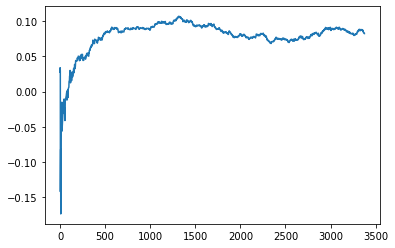

Thread: 1 iteration: 530
RAM mDiffFit_94 FROM: 1344 --> 256 reward: 0.42474999999999996
Thread: 4 iteration: 558
RAM mProject_50 FROM: 832 --> 896 reward: 0.9445862635312499
Thread: 5 iteration: 603
RAM mDiffFit_26 FROM: 1344 --> 256 reward: 0.1685312390625
Thread: 2 iteration: 574
RAM mDiffFit_259 FROM: 1024 --> 1984 reward: 0.012302123437500003
Thread: 3 iteration: 551
RAM mDiffFit_419 FROM: 1856 --> 2880 reward: 0.051007897265625005
Thread: 6 iteration: 564
RAM mDiffFit_266 FROM: 320 --> 2880 reward: -0.27186969140624995
Thread: 4 iteration: 559
RAM mDiffFit_271 FROM: 512 --> 1984 reward: -0.053697876562499997
Thread: 5 iteration: 604
RAM mDiffFit_61 FROM: 2688 --> 2880 reward: 0.0011015707031250196
Thread: 2 iteration: 575
RAM mDiffFit_194 FROM: 1856 --> 2880 reward: 0.005283871484375001
Thread: 3 iteration: 552
RAM mDiffFit_246 FROM: 1408 --> 2880 reward: -0.030757809765624994
Thread: 6 iteration: 565
RAM mBackground_39 FROM: 3008 --> 768 reward: 0.006557274250000053
Thread: 1 ite

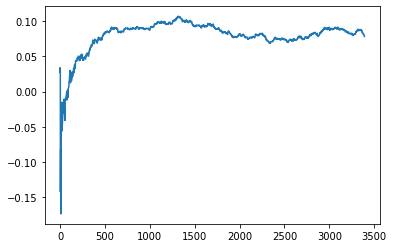

Thread: 4 iteration: 560
RAM mDiffFit_36 FROM: 2048 --> 256 reward: 0.21871871718749997
Thread: 5 iteration: 605
RAM mBackground_76 FROM: 2176 --> 768 reward: 0.12528225090625006
Thread: 2 iteration: 576
RAM mDiffFit_62 FROM: 256 --> 256 reward: 0.016572920312500003
Thread: 3 iteration: 553
RAM mDiffFit_224 FROM: 2880 --> 256 reward: 0.14434108476562496
Thread: 6 iteration: 566
RAM mDiffFit_273 FROM: 1536 --> 256 reward: 0.26045831875000003
Thread: 1 iteration: 532
RAM mDiffFit_116 FROM: 512 --> 256 reward: 0.128645840625
Thread: 5 iteration: 606
RAM mDiffFit_330 FROM: 2496 --> 256 reward: 0.12027338554687503
Thread: 2 iteration: 577
RAM mDiffFit_189 FROM: 2560 --> 256 reward: 0.136479115625
Thread: 3 iteration: 554
RAM mDiffFit_80 FROM: 896 --> 256 reward: 0.08555725703125
Thread: 6 iteration: 567
RAM mDiffFit_178 FROM: 2752 --> 256 reward: 0.141575465234375
Thread: 1 iteration: 533
RAM mDiffFit_42 FROM: 2176 --> 256 reward: 0.10261451406250002
Thread: 5 iteration: 607
RAM mDiffFit_54

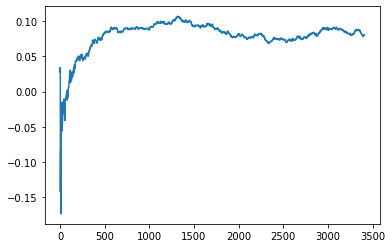

Thread: 2 iteration: 580
RAM mDiffFit_162 FROM: 2944 --> 256 reward: 0.15479681484375
Thread: 4 iteration: 563
RAM mDiffFit_74 FROM: 2432 --> 256 reward: 0.055604071875000015
Saving ...


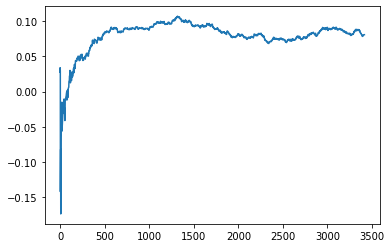

Thread: 6 iteration: 570
RAM mBackground_63 FROM: 896 --> 704 reward: 0.010160957445312497
Thread: 1 iteration: 535
RAM mAdd_3 FROM: 2432 --> 704 reward: 0.27413656152343735
Thread: 5 iteration: 609
RAM mBackground_66 FROM: 2048 --> 704 reward: 0.19100508692187493
Thread: 3 iteration: 556
RAM mDiffFit_392 FROM: 1600 --> 256 reward: 0.1484166375
Thread: 4 iteration: 564
RAM mDiffFit_345 FROM: 2112 --> 256 reward: 0.42795309765625
Thread: 2 iteration: 581
RAM mDiffFit_174 FROM: 2240 --> 1088 reward: 0.03513280976562501
Thread: 6 iteration: 571
RAM mBackground_88 FROM: 1664 --> 704 reward: 0.1537585819921875
Thread: 1 iteration: 536
RAM mDiffFit_192 FROM: 1792 --> 2944 reward: 0.019984424218750005
Thread: 4 iteration: 565
RAM mDiffFit_376 FROM: 384 --> 1088 reward: -0.097059889453125
Thread: 2 iteration: 582
RAM mDiffFit_183 FROM: 1856 --> 2752 reward: -0.03711719023437504
Thread: 6 iteration: 572
RAM mDiffFit_87 FROM: 1408 --> 2944 reward: 0.029687565625000002
Thread: 4 iteration: 566
RA

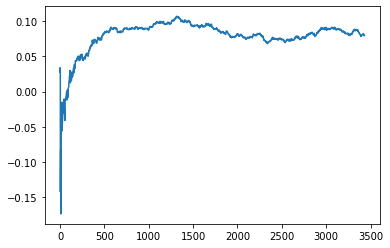

Thread: 5 iteration: 610
RAM mDiffFit_150 FROM: 1728 --> 256 reward: 0.17839842929687494
Thread: 2 iteration: 585
RAM mDiffFit_82 FROM: 1216 --> 256 reward: 0.16634112851562496
Thread: 4 iteration: 569
RAM mDiffFit_235 FROM: 704 --> 256 reward: -0.02389329570312501
Thread: 5 iteration: 611
RAM mDiffFit_1 FROM: 128 --> 1024 reward: -0.9413073007812501
Thread: 6 iteration: 574
RAM mBackground_36 FROM: 1472 --> 1792 reward: -0.01622800985937496
Thread: 1 iteration: 538
RAM mDiffFit_63 FROM: 3008 --> 256 reward: 0.07094515664062502
Saving ...


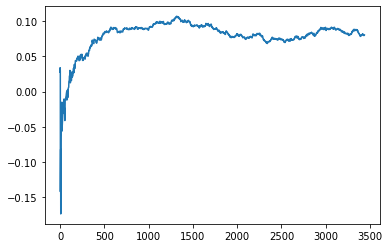

Thread: 3 iteration: 560
RAM mProject_75 FROM: 2688 --> 2112 reward: -0.10867802414062484
Thread: 2 iteration: 586
RAM mDiffFit_392 FROM: 2752 --> 256 reward: 0.132627544921875
Saving ...


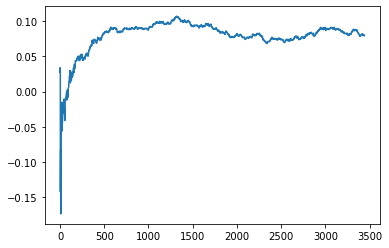

Thread: 4 iteration: 570
RAM mBackground_58 FROM: 1728 --> 1792 reward: 0.001585634406249977
Thread: 6 iteration: 575
RAM mDiffFit_347 FROM: 2880 --> 256 reward: 0.142716084765625
Thread: 5 iteration: 612
RAM mBackground_67 FROM: 2496 --> 704 reward: 0.12112552153125
Thread: 1 iteration: 539
RAM mDiffFit_289 FROM: 1792 --> 1984 reward: 0.0019687609374999943
Thread: 2 iteration: 587
RAM mBackground_11 FROM: 2944 --> 704 reward: 0.044473456140624965
Thread: 4 iteration: 571
RAM mDiffFit_316 FROM: 576 --> 256 reward: 0.04282809765625003
Thread: 5 iteration: 613
RAM mDiffFit_251 FROM: 704 --> 2752 reward: -0.05445309765625
Thread: 6 iteration: 576
RAM mProject_2 FROM: 128 --> 2624 reward: 0.7680979527890625
Thread: 3 iteration: 561
RAM mBgModel_1 FROM: 1664 --> 1152 reward: 0.07419375218750002
Saving ...


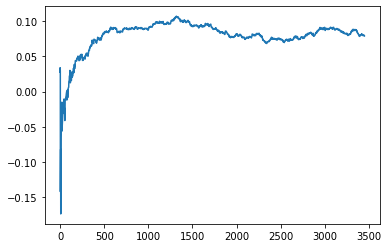

Thread: 1 iteration: 540
RAM mDiffFit_20 FROM: 1472 --> 2752 reward: -0.011257766015625031
Thread: 2 iteration: 588
RAM mDiffFit_157 FROM: 256 --> 2752 reward: -0.39544011054687495
Thread: 6 iteration: 577
RAM mDiffFit_104 FROM: 256 --> 256 reward: -0.19094796406250006
Thread: 4 iteration: 572
RAM mDiffFit_267 FROM: 1088 --> 256 reward: 0.14152601796874997
Thread: 3 iteration: 562
RAM mDiffFit_334 FROM: 1152 --> 256 reward: 0.09563017734375001
Thread: 1 iteration: 541
RAM mDiffFit_406 FROM: 1024 --> 256 reward: 0.10332287656249997
Thread: 2 iteration: 589
RAM mDiffFit_337 FROM: 1856 --> 256 reward: 0.510434889453125
Thread: 5 iteration: 614
RAM mBackground_65 FROM: 1152 --> 2304 reward: 0.05237951609375003
Thread: 6 iteration: 578
RAM mDiffFit_228 FROM: 3008 --> 256 reward: 0.183950465234375
Thread: 4 iteration: 573
RAM mDiffFit_300 FROM: 2176 --> 256 reward: 0.031702966406250005
Thread: 3 iteration: 563
RAM mDiffFit_115 FROM: 1600 --> 256 reward: 0.04921086367187497
Thread: 5 iteratio

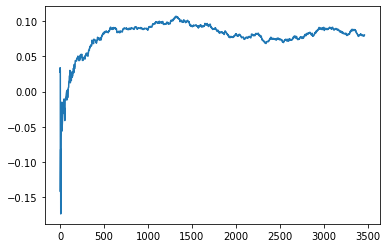

Thread: 2 iteration: 590
RAM mDiffFit_257 FROM: 2624 --> 256 reward: 0.013450377734374984
Thread: 4 iteration: 574
RAM mBackground_22 FROM: 576 --> 2304 reward: -0.12201238712500001
Thread: 5 iteration: 616
RAM mDiffFit_419 FROM: 2752 --> 256 reward: 0.14557546523437498
Thread: 6 iteration: 579
RAM mDiffFit_152 FROM: 1920 --> 256 reward: 0.12438017734375001
Thread: 2 iteration: 591
RAM mDiffFit_311 FROM: 2752 --> 256 reward: 0.15339838554687502
Thread: 3 iteration: 564
RAM mProject_28 FROM: 1472 --> 2112 reward: -0.007999101773437422
Thread: 1 iteration: 542
RAM mDiffFit_357 FROM: 1600 --> 256 reward: 0.10532287656250001
Thread: 4 iteration: 575
RAM mDiffFit_26 FROM: 2944 --> 1088 reward: -0.017026105468750004
Thread: 1 iteration: 543
RAM mDiffFit_284 FROM: 1088 --> 256 reward: 0.09875772226562499
Thread: 5 iteration: 617
RAM mDiffFit_249 FROM: 2624 --> 256 reward: 0.13782283281249996
Saving ...


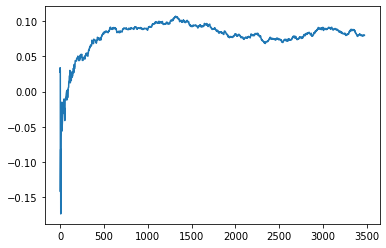

Thread: 6 iteration: 580
RAM mDiffFit_126 FROM: 832 --> 256 reward: 0.35344792031250005
Thread: 2 iteration: 592
RAM mDiffFit_355 FROM: 1856 --> 256 reward: 0.364562434375
Thread: 3 iteration: 565
RAM mDiffFit_408 FROM: 2688 --> 1088 reward: -0.0423230078125
Thread: 4 iteration: 576
RAM mDiffFit_246 FROM: 2816 --> 1088 reward: -0.0036693136718750005
Thread: 5 iteration: 618
RAM mDiffFit_402 FROM: 1088 --> 256 reward: -0.002828228906249994
Thread: 1 iteration: 544
RAM mDiffFit_303 FROM: 1088 --> 256 reward: 0.09765882773437501
Thread: 6 iteration: 581
RAM mDiffFit_321 FROM: 320 --> 256 reward: -0.09671358359375
Thread: 2 iteration: 593
RAM mBackground_89 FROM: 1472 --> 768 reward: 0.10074315905468754
Thread: 3 iteration: 566
RAM mDiffFit_84 FROM: 384 --> 1088 reward: -0.21533858359374997
Thread: 4 iteration: 577
RAM mDiffFit_89 FROM: 2048 --> 1088 reward: 0.012361969140624977
Thread: 5 iteration: 619
RAM mDiffFit_122 FROM: 704 --> 1088 reward: -0.09414066328124998
Thread: 6 iteration: 5

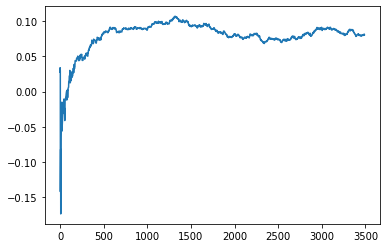

Thread: 5 iteration: 620
RAM mDiffFit_166 FROM: 128 --> 1088 reward: -0.667091172265625
Thread: 6 iteration: 583
RAM mDiffFit_357 FROM: 1984 --> 2880 reward: 0.026015663281250007
Thread: 2 iteration: 595
RAM mDiffFit_240 FROM: 512 --> 256 reward: -0.03668756562499997
Thread: 3 iteration: 568
RAM mBackground_41 FROM: 2176 --> 768 reward: 0.08908606901562498
Thread: 4 iteration: 578
RAM mBackground_70 FROM: 1600 --> 768 reward: 0.03056350674218754
Thread: 1 iteration: 546
RAM mDiffFit_157 FROM: 960 --> 2752 reward: -0.014101526953125016
Thread: 6 iteration: 584
RAM mDiffFit_93 FROM: 1472 --> 2752 reward: 0.0016120128906249934
Thread: 3 iteration: 569
RAM mDiffFit_144 FROM: 2624 --> 384 reward: 0.035445244140625
Thread: 4 iteration: 579
RAM mBackground_76 FROM: 1088 --> 768 reward: 0.03588930332031249
Thread: 5 iteration: 621
RAM mDiffFit_302 FROM: 768 --> 2752 reward: -0.07132805390625004
Thread: 1 iteration: 547
RAM mDiffFit_266 FROM: 832 --> 2752 reward: -0.08066400507812505
Thread: 6 

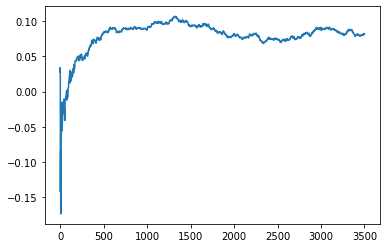

Thread: 3 iteration: 570
RAM mDiffFit_17 FROM: 2048 --> 1984 reward: -0.07849227773437502
Saving ...


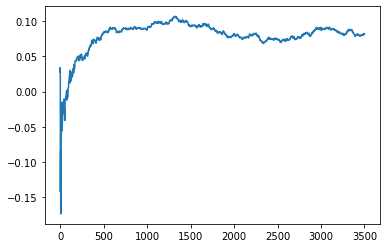

Thread: 4 iteration: 580
RAM mBackground_24 FROM: 1216 --> 768 reward: 0.03981975090625
Thread: 6 iteration: 586
RAM mDiffFit_163 FROM: 2240 --> 256 reward: 0.1138645140625
Thread: 3 iteration: 571
RAM mBackground_35 FROM: 2432 --> 1984 reward: -0.08361496367968752
Thread: 4 iteration: 581
RAM mDiffFit_131 FROM: 256 --> 256 reward: 0.009197920312500017
Thread: 1 iteration: 548
RAM mBackground_86 FROM: 1920 --> 2944 reward: -0.0018767034218749742
Thread: 6 iteration: 587
RAM mDiffFit_37 FROM: 2112 --> 256 reward: 0.104330686328125
Thread: 3 iteration: 572
RAM mDiffFit_233 FROM: 3008 --> 256 reward: 0.28833840859375004
Thread: 4 iteration: 582
RAM mBackground_67 FROM: 2112 --> 2560 reward: 0.03765194084374999
Thread: 6 iteration: 588
RAM mProject_71 FROM: 1728 --> 2112 reward: 0.048110741156250005
Thread: 5 iteration: 623
RAM mProject_72 FROM: 2944 --> 1728 reward: -0.1590434957812499
Thread: 2 iteration: 597
RAM mDiffFit_382 FROM: 2560 --> 256 reward: 0.28328115156250006
Thread: 3 itera

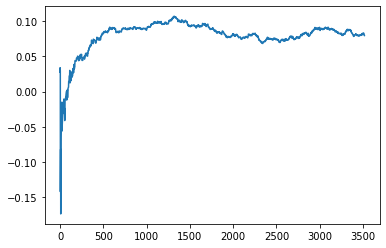

Thread: 1 iteration: 550
RAM mBackground_49 FROM: 2944 --> 1088 reward: -0.028852712773437487
Thread: 5 iteration: 624
RAM mDiffFit_372 FROM: 704 --> 1984 reward: -0.06799477890625001
Thread: 3 iteration: 575
RAM mDiffFit_181 FROM: 1856 --> 1984 reward: -0.003104159375000009
Thread: 1 iteration: 551
RAM mBackground_5 FROM: 1984 --> 768 reward: 0.14510258692187503
Thread: 5 iteration: 625
RAM mDiffFit_356 FROM: 768 --> 1984 reward: -0.054958318750000026
Thread: 3 iteration: 576
RAM mDiffFit_222 FROM: 2688 --> 1088 reward: 0.00019006679687500957
Thread: 1 iteration: 552
RAM mBackground_47 FROM: 1408 --> 192 reward: 0.812355049296875
Thread: 6 iteration: 589
RAM mDiffFit_345 FROM: 1472 --> 1984 reward: -0.04807033164062503
Thread: 5 iteration: 626
RAM mBackground_76 FROM: 1216 --> 768 reward: 0.11359840814843747
Thread: 3 iteration: 577
RAM mDiffFit_323 FROM: 576 --> 1088 reward: -0.08537758867187506
Saving ...


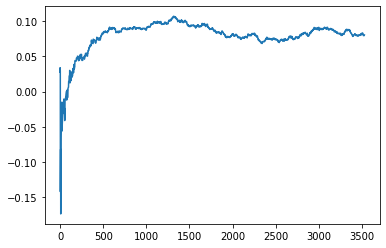

Thread: 6 iteration: 590
RAM mProject_20 FROM: 640 --> 896 reward: 0.9310375043437498
Thread: 4 iteration: 583
RAM mDiffFit_203 FROM: 1344 --> 1984 reward: -0.0322187609375
Thread: 1 iteration: 553
RAM mProject_6 FROM: 384 --> 896 reward: 0.9305875043437499
Thread: 2 iteration: 598
RAM mDiffFit_199 FROM: 1472 --> 1984 reward: -0.08148964531249998
Thread: 3 iteration: 578
RAM mDiffFit_409 FROM: 384 --> 1088 reward: -0.08583853984375002
Thread: 4 iteration: 584
RAM mDiffFit_51 FROM: 1344 --> 1984 reward: -0.013591128515625002
Thread: 1 iteration: 554
RAM mDiffFit_144 FROM: 1856 --> 1088 reward: -0.06233862734375001
Thread: 2 iteration: 599
RAM mDiffFit_191 FROM: 960 --> 1984 reward: 0.00033077382812498127
Thread: 3 iteration: 579
RAM mDiffFit_285 FROM: 320 --> 1984 reward: -0.06377860664062501
Thread: 4 iteration: 585
RAM mDiffFit_193 FROM: 2816 --> 1088 reward: 0.002080686328125008
Thread: 1 iteration: 555
RAM mBackground_36 FROM: 1984 --> 768 reward: 0.0925865542265625
Saving ...


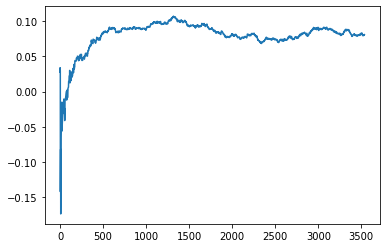

Thread: 2 iteration: 600
RAM mBgModel_2 FROM: 2112 --> 1152 reward: 0.041871814843749966
Saving ...


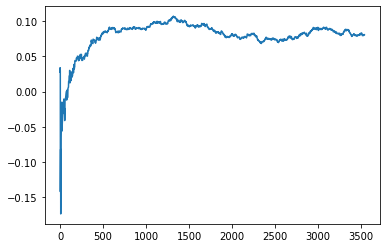

Thread: 3 iteration: 580
RAM mDiffFit_206 FROM: 1024 --> 1984 reward: -0.0034088277343750136
Thread: 4 iteration: 586
RAM mProject_4 FROM: 256 --> 896 reward: 0.9171737451562498
Thread: 5 iteration: 627
RAM mBackground_73 FROM: 2496 --> 704 reward: 0.12187579527343749
Thread: 2 iteration: 601
RAM mDiffFit_156 FROM: 320 --> 1984 reward: -0.24531243437500005
Thread: 5 iteration: 628
RAM mBackground_81 FROM: 704 --> 192 reward: 0.7113566294765624
Thread: 1 iteration: 556
RAM mBackground_89 FROM: 640 --> 704 reward: -0.05382391800781257
Thread: 4 iteration: 587
RAM mDiffFit_323 FROM: 2496 --> 1216 reward: 0.06802601796874999
Thread: 2 iteration: 602
RAM mDiffFit_218 FROM: 1280 --> 1984 reward: -0.004075508984375011
Thread: 5 iteration: 629
RAM mDiffFit_385 FROM: 1024 --> 1984 reward: -0.002033827734375009
Thread: 4 iteration: 588
RAM mProject_63 FROM: 1728 --> 2112 reward: 0.03552619661718746
Thread: 3 iteration: 581
RAM mDiffFit_188 FROM: 2176 --> 1088 reward: -0.053609467968750005
Thread

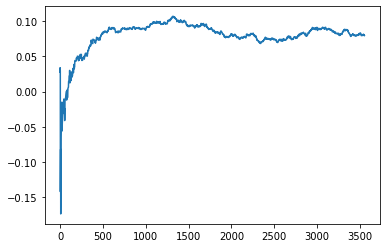

Thread: 5 iteration: 630
RAM mDiffFit_325 FROM: 1856 --> 256 reward: 0.3345729203125
Thread: 1 iteration: 557
RAM mDiffFit_253 FROM: 768 --> 1984 reward: -0.097356748046875
Saving ...


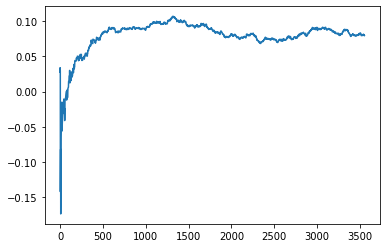

Thread: 4 iteration: 590
RAM mBackground_66 FROM: 1536 --> 768 reward: 0.07847496237500004
Thread: 3 iteration: 582
RAM mDiffFit_402 FROM: 128 --> 320 reward: -0.95241154765625
Thread: 6 iteration: 592
RAM mDiffFit_418 FROM: 2304 --> 1088 reward: -0.040169357421874996
Thread: 1 iteration: 558
RAM mDiffFit_250 FROM: 1472 --> 2880 reward: -0.029117190234375003
Thread: 5 iteration: 631
RAM mDiffFit_353 FROM: 1088 --> 2880 reward: 0.019283915234374997
Thread: 6 iteration: 593
RAM mBackground_72 FROM: 384 --> 768 reward: -0.16671902957812496
Thread: 4 iteration: 591
RAM mDiffFit_326 FROM: 2496 --> 1088 reward: -0.022481835546875
Thread: 5 iteration: 632
RAM mDiffFit_48 FROM: 192 --> 1984 reward: -0.21055984570312497
Thread: 6 iteration: 594
RAM mBackground_57 FROM: 2240 --> 768 reward: 0.08736606901562498
Thread: 1 iteration: 559
RAM mProject_66 FROM: 2624 --> 2112 reward: -0.0843606418359376
Thread: 2 iteration: 603
RAM mDiffFit_256 FROM: 2752 --> 2496 reward: 0.083476658203125
Thread: 4 i

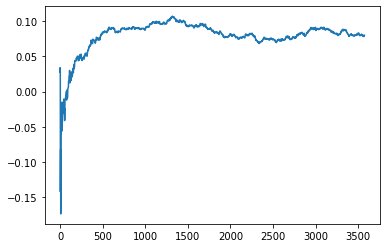

Thread: 1 iteration: 560
RAM mDiffFit_249 FROM: 768 --> 2752 reward: -0.03983590742187501
Thread: 2 iteration: 606
RAM mProject_19 FROM: 1344 --> 2112 reward: -0.03895862793749992
Thread: 5 iteration: 634
RAM mDiffFit_204 FROM: 384 --> 256 reward: 0.08235415937500001
Thread: 6 iteration: 596
RAM mProject_66 FROM: 2432 --> 2112 reward: -0.04681228823437489
Thread: 4 iteration: 595
RAM mBackground_1 FROM: 2816 --> 1088 reward: -0.023164155429687503
Thread: 2 iteration: 607
RAM mBackground_47 FROM: 1472 --> 2304 reward: -0.003677337828124957
Thread: 1 iteration: 561
RAM mDiffFit_18 FROM: 384 --> 1984 reward: -0.24325522109374997
Thread: 6 iteration: 597
RAM mDiffFit_8 FROM: 1920 --> 1984 reward: -0.0025520796874999897
Thread: 4 iteration: 596
RAM mProject_53 FROM: 1856 --> 2112 reward: 0.04058492955468751
Thread: 3 iteration: 585
RAM mBackground_69 FROM: 2816 --> 1088 reward: -0.017251655429687467
Thread: 2 iteration: 608
RAM mDiffFit_122 FROM: 2176 --> 1984 reward: -0.06433340625
Thread:

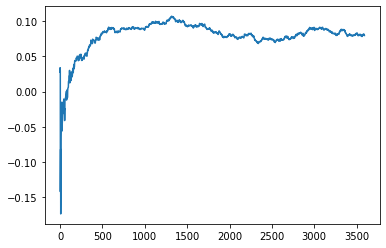

Thread: 2 iteration: 610
RAM mDiffFit_74 FROM: 768 --> 1984 reward: -0.0483645578125
Thread: 3 iteration: 587
RAM mDiffFit_174 FROM: 1920 --> 1088 reward: -0.024072964062500004
Thread: 1 iteration: 564
RAM mDiffFit_127 FROM: 2816 --> 1088 reward: -0.1083230953125
Thread: 6 iteration: 599
RAM mDiffFit_214 FROM: 2368 --> 1088 reward: -0.019210994921875
Thread: 5 iteration: 637
RAM mDiffFit_356 FROM: 1920 --> 2624 reward: 0.08053395898437501
Thread: 3 iteration: 588
RAM mDiffFit_323 FROM: 1728 --> 2624 reward: 0.022981835546874996
Thread: 2 iteration: 611
RAM mDiffFit_248 FROM: 896 --> 2624 reward: -0.0029713058593749953
Saving ...


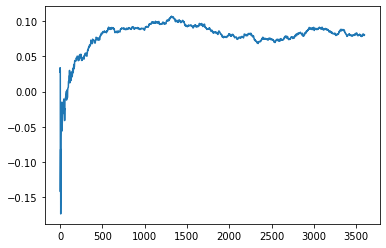

Thread: 6 iteration: 600
RAM mDiffFit_59 FROM: 576 --> 2624 reward: -0.13346345234374998
Thread: 1 iteration: 565
RAM mProject_18 FROM: 1344 --> 384 reward: -1.0
Thread: 4 iteration: 597
RAM mDiffFit_174 FROM: 3008 --> 2624 reward: -0.015328141406249982
Thread: 6 iteration: 601
RAM mDiffFit_185 FROM: 1536 --> 2624 reward: 0.0076797121093749934
Thread: 2 iteration: 612
RAM mDiffFit_117 FROM: 768 --> 256 reward: 0.10793747812499997
Thread: 4 iteration: 598
RAM mDiffFit_45 FROM: 1472 --> 256 reward: 0.18900254492187504
Thread: 2 iteration: 613
RAM mDiffFit_300 FROM: 1024 --> 256 reward: 0.1511353984375
Thread: 4 iteration: 599
RAM mProject_40 FROM: 1856 --> 2112 reward: 0.03829555258593759
Thread: 5 iteration: 638
RAM mDiffFit_48 FROM: 2752 --> 256 reward: 0.13175254492187505
Thread: 2 iteration: 614
RAM mProject_65 FROM: 2304 --> 1728 reward: -0.08485612354687498
Thread: 3 iteration: 589
RAM mDiffFit_344 FROM: 768 --> 1984 reward: 0.001572964062499984
Saving ...


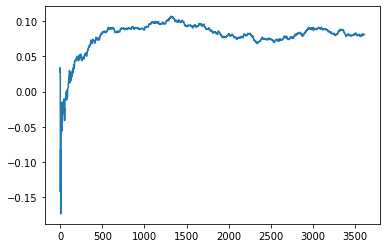

Thread: 4 iteration: 600
RAM mProject_31 FROM: 1088 --> 1728 reward: -0.14250745799999995
Thread: 1 iteration: 566
RAM mDiffFit_106 FROM: 2944 --> 256 reward: 0.09550513359375
Thread: 2 iteration: 615
RAM mDiffFit_320 FROM: 640 --> 256 reward: 0.034604115625000015
Thread: 4 iteration: 601
RAM mDiffFit_312 FROM: 2816 --> 256 reward: 0.12663535468749998
Thread: 1 iteration: 567
RAM mDiffFit_213 FROM: 896 --> 256 reward: 0.28336455781250003
Thread: 5 iteration: 639
RAM mDiffFit_362 FROM: 2176 --> 256 reward: 0.12198433671874997
Thread: 2 iteration: 616
RAM mDiffFit_355 FROM: 3008 --> 256 reward: 0.41779413867187504
Saving ...


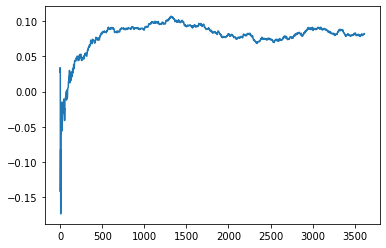

Thread: 3 iteration: 590
RAM mProject_77 FROM: 960 --> 320 reward: -1.0
Thread: 6 iteration: 602
RAM mBackground_44 FROM: 2624 --> 2944 reward: 0.021986032695312525
Thread: 4 iteration: 602
RAM mDiffFit_101 FROM: 1216 --> 256 reward: 0.19525
Thread: 2 iteration: 617
RAM mBackground_52 FROM: 2496 --> 704 reward: 0.13285200181249995
Thread: 1 iteration: 568
RAM mDiffFit_369 FROM: 832 --> 256 reward: 0.00994783281250005
Thread: 3 iteration: 591
RAM mDiffFit_56 FROM: 384 --> 320 reward: -0.03539066328125
Saving ...


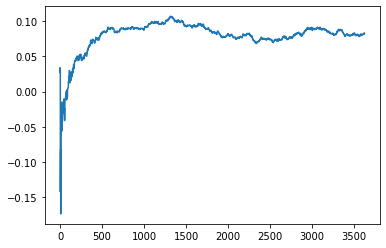

Thread: 5 iteration: 640
RAM mDiffFit_159 FROM: 1152 --> 256 reward: 0.11496353984375002
Thread: 4 iteration: 603
RAM mBackground_19 FROM: 1152 --> 1792 reward: -0.022624241046874966
Thread: 3 iteration: 592
RAM mDiffFit_340 FROM: 2368 --> 2496 reward: 0.03563285351562501
Thread: 3 iteration: 593
RAM mBackground_60 FROM: 896 --> 1792 reward: -0.06556152957812501
Thread: 5 iteration: 641
RAM mBackground_11 FROM: 384 --> 1792 reward: -0.281063146078125
Thread: 4 iteration: 604
RAM mProject_38 FROM: 960 --> 2112 reward: -0.21782098399218744
Thread: 6 iteration: 603
RAM mDiffFit_333 FROM: 2688 --> 2496 reward: 0.019546902343750006
Thread: 5 iteration: 642
RAM mProject_2 FROM: 512 --> 2624 reward: 0.7678729527890624
Thread: 2 iteration: 618
RAM mProject_25 FROM: 1792 --> 2112 reward: 0.05502854742187502
Thread: 1 iteration: 569
RAM mBackground_57 FROM: 896 --> 1792 reward: -0.05985953943749994
Thread: 3 iteration: 594
RAM mBackground_54 FROM: 1728 --> 1792 reward: -0.000779365593750031
Thre

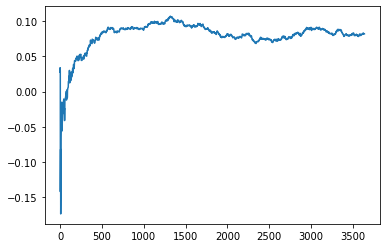

Thread: 1 iteration: 570
RAM mDiffFit_382 FROM: 1664 --> 2752 reward: -0.03531247812500006
Thread: 6 iteration: 604
RAM mDiffFit_227 FROM: 576 --> 2752 reward: -0.03427338554687501
Thread: 5 iteration: 644
RAM mDiffFit_251 FROM: 2560 --> 256 reward: 0.10962491249999999
Thread: 3 iteration: 596
RAM mDiffFit_27 FROM: 2688 --> 1984 reward: 0.016713539843750003
Thread: 1 iteration: 571
RAM mBackground_49 FROM: 640 --> 1792 reward: -0.14630746237499997
Thread: 4 iteration: 607
RAM mDiffFit_194 FROM: 2496 --> 256 reward: 0.08017435976562501
Saving ...


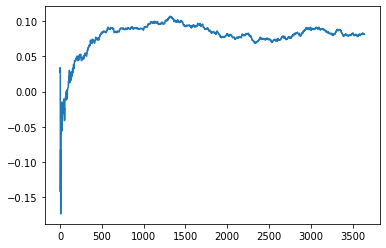

Thread: 2 iteration: 620
RAM mBackground_83 FROM: 192 --> 704 reward: -0.6528676491953123
Thread: 6 iteration: 605
RAM mDiffFit_375 FROM: 960 --> 1088 reward: -0.01813280976562498
Thread: 3 iteration: 597
RAM mDiffFit_352 FROM: 1728 --> 256 reward: 0.147736925390625
Thread: 5 iteration: 645
RAM mDiffFit_410 FROM: 256 --> 1088 reward: -0.43213548593749995
Thread: 4 iteration: 608
RAM mDiffFit_25 FROM: 2624 --> 1984 reward: -0.057289136328125004
Thread: 2 iteration: 621
RAM mDiffFit_412 FROM: 320 --> 256 reward: -0.11606515429687499
Thread: 1 iteration: 572
RAM mDiffFit_9 FROM: 1984 --> 1984 reward: 0.002999999999999999
Thread: 3 iteration: 598
RAM mDiffFit_368 FROM: 2240 --> 1984 reward: -0.027294313671875018
Thread: 2 iteration: 622
RAM mDiffFit_347 FROM: 2304 --> 1984 reward: -0.02686723398437502
Thread: 1 iteration: 573
RAM mProject_29 FROM: 832 --> 1792 reward: 0.6262543839374999
Thread: 6 iteration: 606
RAM mDiffFit_271 FROM: 896 --> 1088 reward: -0.04779690234375001
Thread: 3 iter

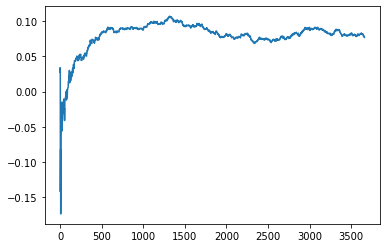

Thread: 3 iteration: 600
RAM mDiffFit_359 FROM: 2944 --> 1984 reward: -0.018257853515625012
Thread: 2 iteration: 624
RAM mBackground_1 FROM: 2880 --> 1088 reward: -0.010315660359375055
Thread: 1 iteration: 575
RAM mBackground_14 FROM: 1152 --> 2624 reward: -0.12253652957812504
Thread: 6 iteration: 608
RAM mDiffFit_304 FROM: 320 --> 1088 reward: -0.12131769921875
Thread: 3 iteration: 601
RAM mDiffFit_189 FROM: 832 --> 1088 reward: -0.16077873789062502
Thread: 1 iteration: 576
RAM mProject_23 FROM: 1920 --> 320 reward: -1.0
Thread: 5 iteration: 646
RAM mDiffFit_65 FROM: 1536 --> 1984 reward: -0.009117190234375011
Thread: 1 iteration: 577
RAM mDiffFit_213 FROM: 896 --> 1088 reward: -0.010575508984374954
Thread: 3 iteration: 602
RAM mDiffFit_402 FROM: 320 --> 256 reward: -0.28563030859375
Thread: 6 iteration: 609
RAM mDiffFit_390 FROM: 320 --> 1088 reward: -0.1015103984375
Thread: 5 iteration: 647
RAM mProject_85 FROM: 192 --> 2624 reward: 0.7560613768359375
Thread: 2 iteration: 625
RAM mD

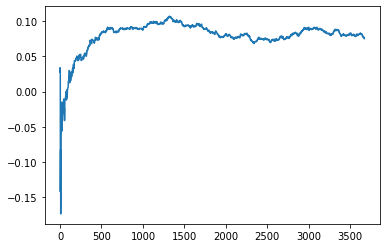

Thread: 6 iteration: 610
RAM mBackground_23 FROM: 704 --> 704 reward: 0.02324241307812503
Thread: 1 iteration: 578
RAM mDiffFit_236 FROM: 704 --> 1984 reward: 0.007070375390625001
Thread: 5 iteration: 648
RAM mProject_61 FROM: 2368 --> 320 reward: -1.0
Thread: 4 iteration: 609
RAM mDiffFit_11 FROM: 128 --> 1984 reward: -0.39630466835937495
Thread: 5 iteration: 649
RAM mBackground_6 FROM: 704 --> 704 reward: -0.09122723923437505
Thread: 2 iteration: 626
RAM mBackground_71 FROM: 448 --> 704 reward: -0.12750394265625
Thread: 6 iteration: 611
RAM mBackground_26 FROM: 2112 --> 640 reward: 0.21670203943749997
Thread: 3 iteration: 604
RAM mDiffFit_238 FROM: 1984 --> 1984 reward: -0.0019999999999999966
Saving ...


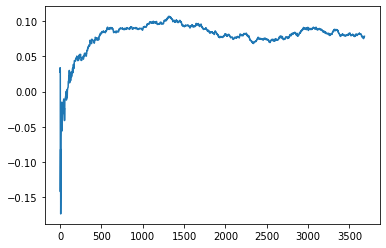

Thread: 4 iteration: 610
RAM mDiffFit_32 FROM: 1024 --> 1984 reward: 0.011677123437500003
Saving ...


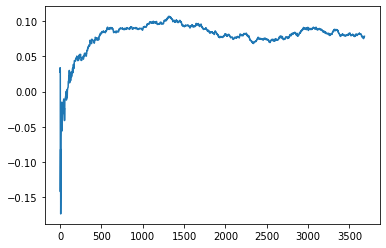

Thread: 5 iteration: 650
RAM mDiffFit_159 FROM: 128 --> 256 reward: -0.56968234453125
Thread: 6 iteration: 612
RAM mBackground_66 FROM: 1472 --> 768 reward: 0.11760500000000003
Thread: 2 iteration: 627
RAM mProject_29 FROM: 1216 --> 2752 reward: 0.024652836000000056
Thread: 1 iteration: 579
RAM mBackground_61 FROM: 1408 --> 1792 reward: -0.055492413078125
Thread: 4 iteration: 611
RAM mDiffFit_349 FROM: 448 --> 2752 reward: -0.15312758867187504
Thread: 6 iteration: 613
RAM mDiffFit_302 FROM: 2944 --> 2496 reward: 0.016567699218750023
Thread: 5 iteration: 651
RAM mDiffFit_322 FROM: 1600 --> 2880 reward: 0.021968804687500006
Thread: 2 iteration: 628
RAM mDiffFit_386 FROM: 2496 --> 2496 reward: -0.004625000000000011
Saving ...


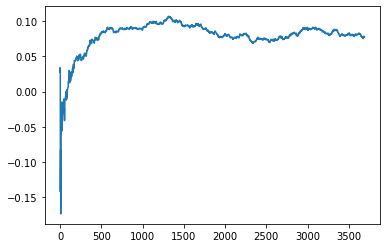

Thread: 1 iteration: 580
RAM mDiffFit_160 FROM: 768 --> 2624 reward: 0.014427167187500024
Thread: 4 iteration: 612
RAM mProject_73 FROM: 320 --> 2624 reward: 0.7684354527890624
Thread: 3 iteration: 605
RAM mDiffFit_24 FROM: 2624 --> 640 reward: 0.127565110546875
Thread: 6 iteration: 614
RAM mDiffFit_260 FROM: 2432 --> 1984 reward: -0.013945331640625013
Thread: 1 iteration: 581
RAM mDiffFit_150 FROM: 1600 --> 256 reward: 0.12196612851562502
Thread: 5 iteration: 652
RAM mDiffFit_116 FROM: 2752 --> 2944 reward: 0.007101570703125018
Thread: 3 iteration: 606
RAM mDiffFit_70 FROM: 1088 --> 256 reward: 0.12692966835937503
Thread: 4 iteration: 613
RAM mDiffFit_23 FROM: 192 --> 2304 reward: -0.43631247812499996
Thread: 2 iteration: 629
RAM mDiffFit_275 FROM: 2560 --> 256 reward: 0.0943853546875
Thread: 5 iteration: 653
RAM mDiffFit_150 FROM: 2752 --> 256 reward: 0.12735143945312502
Thread: 1 iteration: 582
RAM mDiffFit_248 FROM: 1280 --> 256 reward: 0.1351666375
Thread: 3 iteration: 607
RAM mBa

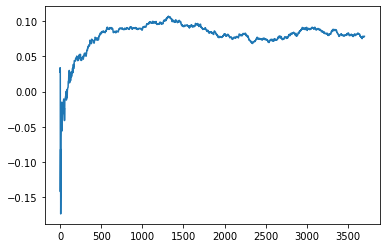

Thread: 2 iteration: 630
RAM mDiffFit_69 FROM: 2944 --> 256 reward: 0.10750513359375002
Thread: 1 iteration: 583
RAM mDiffFit_18 FROM: 2368 --> 256 reward: 0.07249991249999999
Thread: 6 iteration: 616
RAM mDiffFit_64 FROM: 1472 --> 256 reward: 0.08661192539062501
Thread: 2 iteration: 631
RAM mDiffFit_220 FROM: 1856 --> 256 reward: 0.142429624609375
Thread: 3 iteration: 608
RAM mDiffFit_33 FROM: 1984 --> 256 reward: 0.16412495624999998
Thread: 4 iteration: 615
RAM mBackground_71 FROM: 896 --> 320 reward: 0.28224568370312497
Thread: 5 iteration: 654
RAM mDiffFit_312 FROM: 1600 --> 1984 reward: 0.06844278671874997
Thread: 5 iteration: 655
RAM mDiffFit_134 FROM: 1472 --> 256 reward: -0.0750393113281251
Thread: 4 iteration: 616
RAM mBackground_1 FROM: 1536 --> 1792 reward: 0.18944209134375004
Thread: 3 iteration: 609
RAM mAdd_3 FROM: 2368 --> 2560 reward: 0.06626182402343757
Thread: 1 iteration: 584
RAM mDiffFit_222 FROM: 2432 --> 1984 reward: 0.013932300781249983
Thread: 5 iteration: 656
R

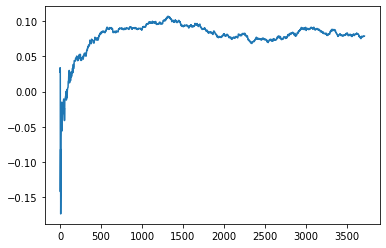

Thread: 3 iteration: 610
RAM mDiffFit_309 FROM: 256 --> 2304 reward: -0.15426035468749996
Thread: 1 iteration: 585
RAM mProject_78 FROM: 1728 --> 2112 reward: 0.03891104479687502
Thread: 2 iteration: 632
RAM mDiffFit_317 FROM: 2560 --> 1984 reward: 0.010697920312500008
Thread: 5 iteration: 657
RAM mDiffFit_193 FROM: 3008 --> 1984 reward: -0.06096103867187501
Thread: 4 iteration: 618
RAM mDiffFit_46 FROM: 1152 --> 1984 reward: 0.018697964062499982
Thread: 3 iteration: 611
RAM mDiffFit_236 FROM: 2560 --> 1984 reward: -0.018929712109375003
Thread: 1 iteration: 586
RAM mDiffFit_61 FROM: 448 --> 256 reward: 0.05544269921875003
Thread: 2 iteration: 633
RAM mDiffFit_5 FROM: 2688 --> 1984 reward: -0.0243021234375
Thread: 1 iteration: 587
RAM mDiffFit_238 FROM: 2944 --> 1984 reward: -0.0018802210937499987
Thread: 2 iteration: 634
RAM mBackground_8 FROM: 2816 --> 1088 reward: -0.06120353400000002
Thread: 4 iteration: 619
RAM mDiffFit_253 FROM: 2432 --> 256 reward: 0.35649469140625006
Thread: 5 i

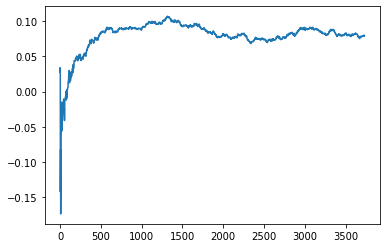

Thread: 4 iteration: 620
RAM mDiffFit_264 FROM: 2048 --> 1088 reward: -0.06426311835937502
Thread: 5 iteration: 659
RAM mProject_60 FROM: 1472 --> 2112 reward: -0.013798952578125046
Thread: 3 iteration: 612
RAM mDiffFit_195 FROM: 512 --> 1088 reward: -0.22442975585937502
Thread: 2 iteration: 636
RAM mDiffFit_364 FROM: 2944 --> 1088 reward: -0.051989689062500004
Thread: 4 iteration: 621
RAM mProject_32 FROM: 1984 --> 320 reward: -1.0
Thread: 6 iteration: 617
RAM mDiffFit_11 FROM: 2496 --> 1088 reward: -0.009080773828124998
Saving ...


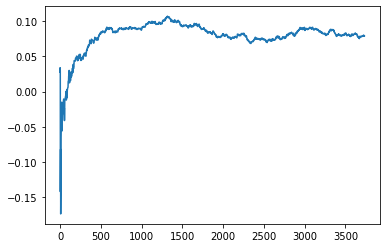

Thread: 5 iteration: 660
RAM mAdd_3 FROM: 2560 --> 2560 reward: 0.01817710156250006
Thread: 1 iteration: 589
RAM mDiffFit_109 FROM: 1792 --> 1088 reward: 0.006833318750000001
Thread: 3 iteration: 613
RAM mDiffFit_210 FROM: 896 --> 2880 reward: 0.016750087500000035
Thread: 2 iteration: 637
RAM mDiffFit_153 FROM: 1152 --> 1088 reward: 0.00800522109375
Thread: 4 iteration: 622
RAM mDiffFit_67 FROM: 640 --> 1088 reward: -0.005421858593749988
Saving ...


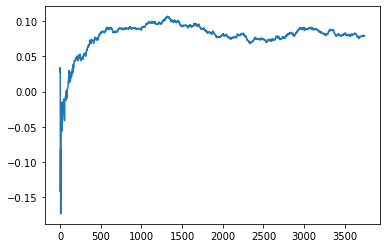

Thread: 1 iteration: 590
RAM mBackground_82 FROM: 2112 --> 768 reward: 0.04968503632031245
Thread: 5 iteration: 661
RAM mDiffFit_130 FROM: 896 --> 2752 reward: -0.040109292968750036
Thread: 4 iteration: 623
RAM mDiffFit_157 FROM: 1856 --> 384 reward: 0.18371353984375
Thread: 2 iteration: 638
RAM mDiffFit_197 FROM: 576 --> 256 reward: -0.10610165820312503
Thread: 1 iteration: 591
RAM mDiffFit_372 FROM: 640 --> 256 reward: 0.1039062390625
Thread: 5 iteration: 662
RAM mDiffFit_311 FROM: 896 --> 256 reward: 0.17021876093749996
Thread: 4 iteration: 624
RAM mDiffFit_265 FROM: 512 --> 256 reward: 0.06538539843749996
Thread: 2 iteration: 639
RAM mDiffFit_80 FROM: 2688 --> 256 reward: 0.08165615156250002
Thread: 5 iteration: 663
RAM mDiffFit_351 FROM: 1920 --> 256 reward: 0.16484893828125
Thread: 4 iteration: 625
RAM mDiffFit_206 FROM: 2880 --> 256 reward: 0.08592440351562501
Saving ...


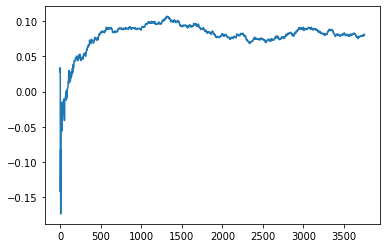

Thread: 2 iteration: 640
RAM mProject_15 FROM: 3008 --> 1024 reward: 0.012609407179687436
Thread: 6 iteration: 618
RAM mBackground_22 FROM: 256 --> 704 reward: -0.309980683703125
Thread: 1 iteration: 592
RAM mProject_68 FROM: 2752 --> 1024 reward: 0.07407061692187492
Thread: 3 iteration: 614
RAM mDiffFit_397 FROM: 2496 --> 256 reward: 0.18144006679687497
Thread: 2 iteration: 641
RAM mDiffFit_395 FROM: 2560 --> 256 reward: 0.15546867343749998
Thread: 1 iteration: 593
RAM mDiffFit_249 FROM: 1024 --> 256 reward: 0.13296871718749997
Thread: 3 iteration: 615
RAM mDiffFit_166 FROM: 448 --> 256 reward: 0.10897657070312498
Thread: 2 iteration: 642
RAM mDiffFit_348 FROM: 2816 --> 256 reward: 0.13051035468750002
Thread: 3 iteration: 616
RAM mBackground_12 FROM: 2624 --> 704 reward: 0.08076819537499992
Thread: 1 iteration: 594
RAM mProject_68 FROM: 1408 --> 2112 reward: -0.02012003894531239
Thread: 4 iteration: 626
RAM mDiffFit_374 FROM: 2752 --> 256 reward: 0.08203378398437502
Thread: 2 iteratio

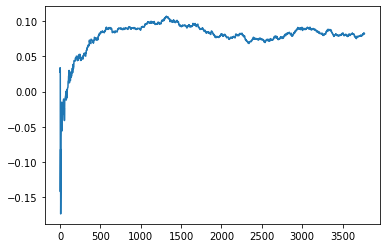

Thread: 6 iteration: 620
RAM mDiffFit_320 FROM: 1792 --> 384 reward: 0.1758020796875
Saving ...


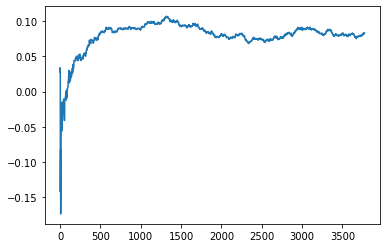

Thread: 4 iteration: 630
RAM mDiffFit_405 FROM: 1600 --> 384 reward: 0.286945375390625
Thread: 2 iteration: 646
RAM mDiffFit_378 FROM: 1216 --> 256 reward: 0.11751039843750004
Thread: 2 iteration: 647
RAM mDiffFit_66 FROM: 1280 --> 256 reward: 0.23909376093749996
Thread: 4 iteration: 631
RAM mProject_19 FROM: 2048 --> 384 reward: -1.0
Thread: 3 iteration: 617
RAM mProject_40 FROM: 1600 --> 384 reward: -1.0
Thread: 1 iteration: 595
RAM mProject_21 FROM: 512 --> 896 reward: 0.94256126353125
Thread: 5 iteration: 664
RAM mDiffFit_254 FROM: 1152 --> 256 reward: 0.195145840625
Thread: 2 iteration: 648
RAM mDiffFit_88 FROM: 1216 --> 1088 reward: 0.003455730078125059
Thread: 3 iteration: 618
RAM mBackground_68 FROM: 2048 --> 704 reward: 0.09939486247656246
Thread: 4 iteration: 632
RAM mDiffFit_218 FROM: 256 --> 2880 reward: -0.16178900507812496
Thread: 5 iteration: 665
RAM mDiffFit_107 FROM: 2176 --> 256 reward: 0.05907278906249997
Thread: 1 iteration: 596
RAM mDiffFit_19 FROM: 1536 --> 1088 r

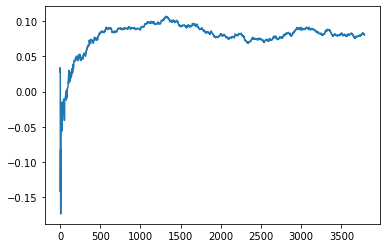

Thread: 3 iteration: 620
RAM mDiffFit_17 FROM: 1344 --> 256 reward: 0.05915097421875
Thread: 6 iteration: 622
RAM mDiffFit_272 FROM: 832 --> 256 reward: 0.003822832812499996
Thread: 5 iteration: 667
RAM mDiffFit_402 FROM: 768 --> 256 reward: 0.05762495625000001
Thread: 1 iteration: 598
RAM mDiffFit_94 FROM: 1856 --> 256 reward: 0.309216084765625
Saving ...


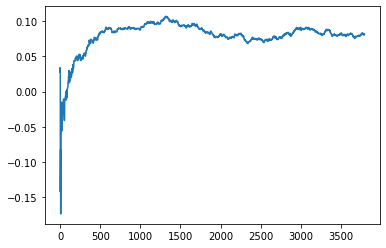

Thread: 2 iteration: 650
RAM mDiffFit_406 FROM: 192 --> 320 reward: -0.14418230078125005
Thread: 6 iteration: 623
RAM mDiffFit_239 FROM: 2944 --> 256 reward: 0.3024529664062501
Thread: 3 iteration: 621
RAM mDiffFit_114 FROM: 2752 --> 256 reward: 0.13100254492187502
Thread: 5 iteration: 668
RAM mDiffFit_276 FROM: 2496 --> 256 reward: 0.08505199218749998
Thread: 6 iteration: 624
RAM mDiffFit_131 FROM: 2880 --> 256 reward: 0.15955199218749996
Thread: 2 iteration: 651
RAM mProject_63 FROM: 1024 --> 2112 reward: -0.1785181751015624
Thread: 4 iteration: 634
RAM mDiffFit_389 FROM: 1792 --> 256 reward: 0.40040623906250006
Thread: 1 iteration: 599
RAM mBackground_81 FROM: 1728 --> 768 reward: 0.15325470160937504
Thread: 3 iteration: 622
RAM mDiffFit_369 FROM: 2112 --> 256 reward: 0.11102860664062503
Thread: 5 iteration: 669
RAM mDiffFit_115 FROM: 1280 --> 256 reward: 0.0899478765625
Thread: 4 iteration: 635
RAM mDiffFit_136 FROM: 896 --> 256 reward: 0.152604159375
Saving ...


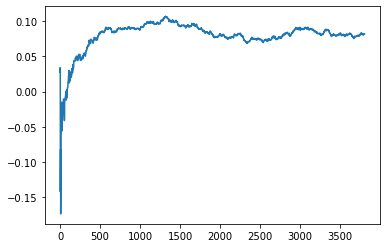

Thread: 1 iteration: 600
RAM mDiffFit_115 FROM: 1280 --> 256 reward: 0.06792703593749998
Saving ...


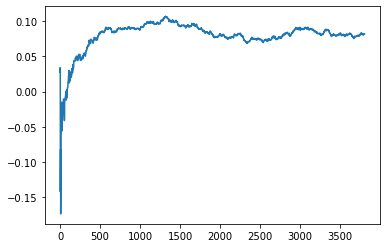

Thread: 5 iteration: 670
RAM mBackground_82 FROM: 448 --> 320 reward: 0.08086909185156241
Thread: 2 iteration: 652
RAM mDiffFit_250 FROM: 3008 --> 256 reward: 0.107861837890625
Thread: 3 iteration: 623
RAM mDiffFit_328 FROM: 384 --> 2752 reward: 0.07183094882812498
Thread: 5 iteration: 671
RAM mProject_9 FROM: 960 --> 2624 reward: -0.12923128195312503
Thread: 6 iteration: 625
RAM mBackground_72 FROM: 1792 --> 768 reward: 0.11323330824999998
Thread: 4 iteration: 636
RAM mDiffFit_141 FROM: 2496 --> 256 reward: 0.14954159375
Thread: 1 iteration: 601
RAM mBackground_75 FROM: 960 --> 1088 reward: -0.021177499999999964
Thread: 2 iteration: 653
RAM mDiffFit_195 FROM: 1856 --> 256 reward: 0.1293020359375
Thread: 5 iteration: 672
RAM mBackground_42 FROM: 2880 --> 1088 reward: -0.0198809341015625
Thread: 4 iteration: 637
RAM mDiffFit_146 FROM: 2624 --> 256 reward: 0.07378115156250001
Thread: 1 iteration: 602
RAM mDiffFit_207 FROM: 2112 --> 256 reward: 0.127976526953125
Thread: 2 iteration: 654
R

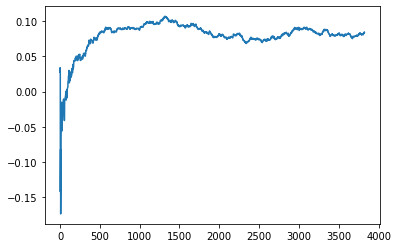

Thread: 4 iteration: 640
RAM mConcatFit_3 FROM: 2880 --> 512 reward: 0.19174777156249997
Thread: 6 iteration: 627
RAM mDiffFit_89 FROM: 2688 --> 256 reward: 0.15826557578124997
Thread: 4 iteration: 641
RAM mBgModel_1 FROM: 896 --> 320 reward: 0.49681977890625
Thread: 3 iteration: 625
RAM mProject_12 FROM: 2240 --> 256 reward: -1.0
Thread: 2 iteration: 655
RAM mDiffFit_225 FROM: 2368 --> 256 reward: 0.15609626210937502
Thread: 6 iteration: 628
RAM mDiffFit_367 FROM: 2304 --> 256 reward: 0.1839061953125
Thread: 4 iteration: 642
RAM mDiffFit_323 FROM: 1408 --> 256 reward: 0.36523433671875005
Thread: 3 iteration: 626
RAM mDiffFit_291 FROM: 320 --> 2880 reward: -0.211304537109375
Thread: 3 iteration: 627
RAM mDiffFit_271 FROM: 2432 --> 256 reward: 0.108145753125
Thread: 6 iteration: 629
RAM mDiffFit_52 FROM: 320 --> 256 reward: 0.05366146015625
Thread: 4 iteration: 643
RAM mProject_40 FROM: 2368 --> 256 reward: -1.0
Thread: 5 iteration: 673
RAM mDiffFit_210 FROM: 448 --> 256 reward: -0.1198

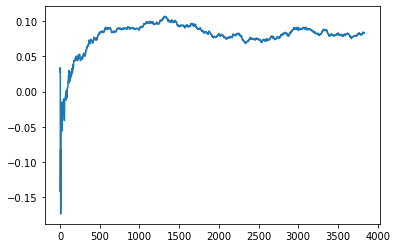

Thread: 6 iteration: 630
RAM mProject_23 FROM: 1536 --> 1024 reward: 0.16031248425000008
Thread: 1 iteration: 604
RAM mDiffFit_248 FROM: 2816 --> 256 reward: 0.1559061953125
Thread: 5 iteration: 674
RAM mDiffFit_98 FROM: 2880 --> 256 reward: 0.085437390625
Thread: 2 iteration: 657
RAM mDiffFit_11 FROM: 1664 --> 2752 reward: -0.02270573007812502
Thread: 6 iteration: 631
RAM mBackground_70 FROM: 1344 --> 768 reward: 0.065037462375
Thread: 3 iteration: 629
RAM mDiffFit_339 FROM: 576 --> 320 reward: 0.01430725703125
Thread: 5 iteration: 675
RAM mDiffFit_65 FROM: 2368 --> 256 reward: 0.141830686328125
Thread: 6 iteration: 632
RAM mBackground_81 FROM: 1984 --> 704 reward: 0.09097179034375004
Saving ...


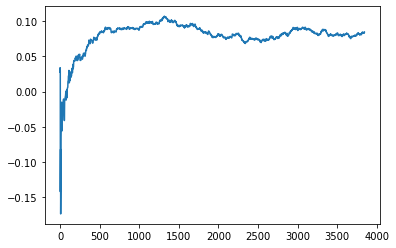

Thread: 3 iteration: 630
RAM mDiffFit_88 FROM: 896 --> 320 reward: 0.45860683554687487
Thread: 2 iteration: 658
RAM mProject_9 FROM: 1920 --> 2112 reward: 0.03340131693749993
Thread: 4 iteration: 645
RAM mDiffFit_175 FROM: 384 --> 320 reward: -0.013877632421874925
Thread: 5 iteration: 676
RAM mDiffFit_228 FROM: 2688 --> 640 reward: 0.04626035468750001
Thread: 6 iteration: 633
RAM mDiffFit_388 FROM: 1344 --> 256 reward: 0.062648385546875
Thread: 3 iteration: 631
RAM mDiffFit_333 FROM: 896 --> 256 reward: 0.14425522109375002
Thread: 2 iteration: 659
RAM mDiffFit_220 FROM: 1984 --> 256 reward: 0.14590882773437505
Thread: 4 iteration: 646
RAM mDiffFit_8 FROM: 1152 --> 256 reward: 0.13252601796875002
Thread: 5 iteration: 677
RAM mDiffFit_262 FROM: 2112 --> 2880 reward: 0.019406282812500005
Thread: 4 iteration: 647
RAM mDiffFit_383 FROM: 1536 --> 1088 reward: -0.017075552734374996
Thread: 5 iteration: 678
RAM mBackground_68 FROM: 1024 --> 1088 reward: -0.00078608199218747
Saving ...


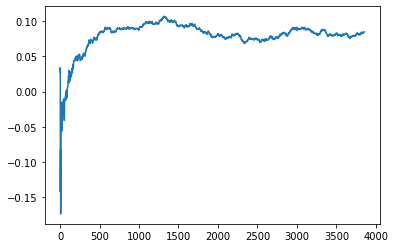

Thread: 2 iteration: 660
RAM mProject_56 FROM: 2880 --> 320 reward: -1.0
Thread: 1 iteration: 605
RAM mImgtbl_3 FROM: 576 --> 320 reward: 0.3278312390625
Thread: 6 iteration: 634
RAM mDiffFit_305 FROM: 1344 --> 2752 reward: -0.0586770796875
Thread: 3 iteration: 632
RAM mDiffFit_99 FROM: 1856 --> 256 reward: 0.17834371718749997
Thread: 5 iteration: 679
RAM mDiffFit_408 FROM: 2496 --> 384 reward: 0.09436714648437498
Thread: 1 iteration: 606
RAM mDiffFit_172 FROM: 1472 --> 256 reward: 0.129450508984375
Thread: 6 iteration: 635
RAM mDiffFit_205 FROM: 256 --> 256 reward: 0.010322920312499963
Thread: 3 iteration: 633
RAM mBackground_89 FROM: 1600 --> 704 reward: 0.10973282303906251
Thread: 4 iteration: 648
RAM mAdd_1 FROM: 1600 --> 704 reward: 0.23172260019531243
Thread: 2 iteration: 661
RAM mBackground_34 FROM: 320 --> 704 reward: -0.3142919278671875
Thread: 1 iteration: 607
RAM mDiffFit_241 FROM: 512 --> 1984 reward: -0.07957550898437502
Thread: 4 iteration: 649
RAM mBackground_12 FROM: 14

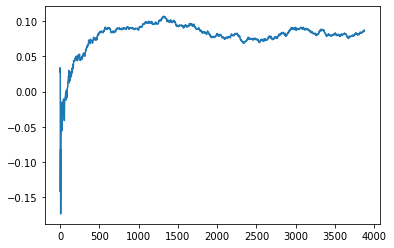

Thread: 1 iteration: 610
RAM mBackground_29 FROM: 384 --> 704 reward: -0.24077313440625
Saving ...


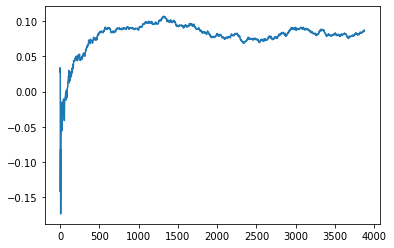

Thread: 4 iteration: 650
RAM mProject_74 FROM: 1280 --> 1024 reward: 0.11160563090624998
Saving ...


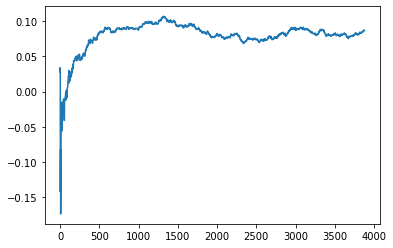

Thread: 5 iteration: 680
RAM mDiffFit_123 FROM: 320 --> 2752 reward: -0.160283783984375
Thread: 3 iteration: 637
RAM mDiffFit_21 FROM: 448 --> 2752 reward: -0.08395831874999998
Thread: 1 iteration: 611
RAM mDiffFit_227 FROM: 2368 --> 2880 reward: 0.010562521875000005
Thread: 4 iteration: 651
RAM mProject_57 FROM: 448 --> 896 reward: 0.9337159441406249
Thread: 2 iteration: 662
RAM mDiffFit_291 FROM: 960 --> 2752 reward: -0.006031151562500038
Thread: 3 iteration: 638
RAM mDiffFit_285 FROM: 1792 --> 2880 reward: 0.021492233984375005
Thread: 4 iteration: 652
RAM mDiffFit_28 FROM: 1280 --> 256 reward: 0.12155203593749998
Thread: 5 iteration: 681
RAM mDiffFit_170 FROM: 2432 --> 256 reward: 0.021067524218750036
Thread: 1 iteration: 612
RAM mProject_90 FROM: 2880 --> 1088 reward: -0.0004325769843751104
Thread: 6 iteration: 637
RAM mBackground_78 FROM: 2368 --> 704 reward: 0.12006172807031248
Thread: 2 iteration: 663
RAM mDiffFit_42 FROM: 2368 --> 256 reward: 0.051335819921875026
Thread: 4 iter

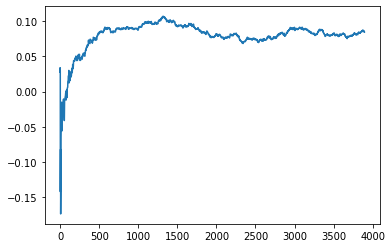

Thread: 3 iteration: 640
RAM mDiffFit_341 FROM: 448 --> 256 reward: 0.146263030859375
Thread: 6 iteration: 639
RAM mDiffFit_183 FROM: 1728 --> 256 reward: 0.4063749562499999
Thread: 4 iteration: 654
RAM mDiffFit_355 FROM: 576 --> 256 reward: 0.21032028789062496
Thread: 1 iteration: 614
RAM mDiffFit_262 FROM: 1664 --> 256 reward: 0.14129685859375002
Thread: 2 iteration: 665
RAM mDiffFit_108 FROM: 2944 --> 256 reward: 0.04784362968750001
Thread: 3 iteration: 641
RAM mDiffFit_107 FROM: 960 --> 256 reward: 0.11355207968750003
Saving ...


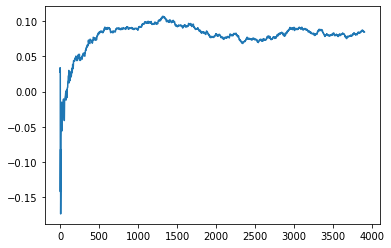

Thread: 6 iteration: 640
RAM mDiffFit_401 FROM: 576 --> 2752 reward: -0.047874956250000024
Thread: 2 iteration: 666
RAM mDiffFit_374 FROM: 1984 --> 256 reward: 0.156856748046875
Thread: 1 iteration: 615
RAM mProject_56 FROM: 2304 --> 2112 reward: -0.03389491117968752
Thread: 5 iteration: 683
RAM mBackground_34 FROM: 576 --> 768 reward: -0.046937163984374954
Thread: 4 iteration: 655
RAM mBackground_50 FROM: 640 --> 768 reward: -0.016362375453125
Thread: 3 iteration: 642
RAM mDiffFit_274 FROM: 1472 --> 448 reward: 0.15913803085937497
Thread: 6 iteration: 641
RAM mBackground_83 FROM: 2432 --> 704 reward: 0.06809440191406245
Thread: 1 iteration: 616
RAM mDiffFit_44 FROM: 1536 --> 448 reward: 0.23993493320312498
Thread: 2 iteration: 667
RAM mDiffFit_18 FROM: 1216 --> 448 reward: 0.23798183554687496
Thread: 4 iteration: 656
RAM mDiffFit_346 FROM: 448 --> 2880 reward: -0.135820200390625
Thread: 3 iteration: 643
RAM mBackground_39 FROM: 128 --> 704 reward: 0.3568464569375
Thread: 6 iteration: 

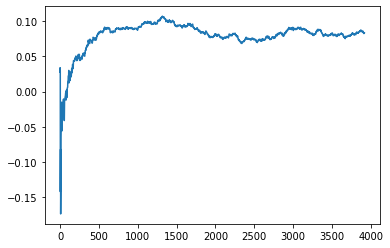

Thread: 2 iteration: 670
RAM mDiffFit_351 FROM: 1920 --> 2880 reward: 0.011757853515625
Thread: 4 iteration: 659
RAM mProject_15 FROM: 960 --> 2112 reward: -0.2045206646015625
Thread: 3 iteration: 645
RAM mDiffFit_371 FROM: 640 --> 2624 reward: 0.017645928125000036
Thread: 6 iteration: 645
RAM mDiffFit_222 FROM: 1024 --> 2880 reward: 0.006315154296875
Thread: 2 iteration: 671
RAM mConcatFit_1 FROM: 2560 --> 2432 reward: 0.039845875625
Saving ...


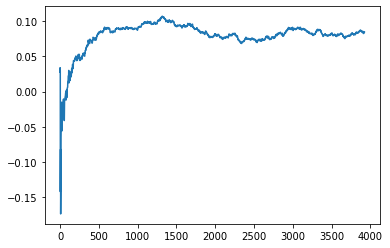

Thread: 4 iteration: 660
RAM mDiffFit_3 FROM: 1472 --> 2624 reward: 0.002330773828125021
Thread: 6 iteration: 646
RAM mDiffFit_407 FROM: 2304 --> 2624 reward: 0.00248960156250002
Thread: 2 iteration: 672
RAM mProject_56 FROM: 1472 --> 2112 reward: -0.01932739762500004
Thread: 5 iteration: 685
RAM mProject_9 FROM: 2496 --> 2112 reward: -0.06666482235937507
Thread: 1 iteration: 619
RAM mBackground_3 FROM: 2688 --> 704 reward: 0.012241341453125025
Thread: 2 iteration: 673
RAM mBackground_79 FROM: 384 --> 320 reward: 0.01068502464843762
Thread: 6 iteration: 647
RAM mDiffFit_411 FROM: 2176 --> 256 reward: 0.29693743437500003
Thread: 6 iteration: 648
RAM mBackground_85 FROM: 1472 --> 320 reward: 0.30837263621874994
Saving ...


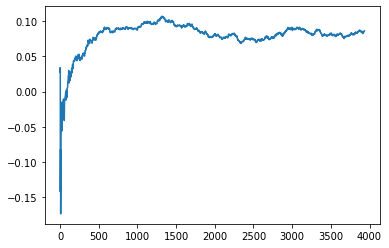

Thread: 1 iteration: 620
RAM mDiffFit_91 FROM: 2752 --> 256 reward: 0.16494783281250003
Thread: 6 iteration: 649
RAM mProject_48 FROM: 1664 --> 1024 reward: 0.20694937696875007
Thread: 4 iteration: 661
RAM mDiffFit_100 FROM: 1856 --> 256 reward: 0.030632678515625025
Thread: 1 iteration: 621
RAM mProject_79 FROM: 2112 --> 2240 reward: 0.012697534124999877
Thread: 5 iteration: 686
RAM mProject_87 FROM: 2368 --> 2240 reward: -0.01717831947656253
Thread: 3 iteration: 646
RAM mBackground_66 FROM: 2368 --> 704 reward: 0.08105039698437501
Thread: 4 iteration: 662
RAM mDiffFit_277 FROM: 320 --> 256 reward: 0.01844269921874999
Thread: 3 iteration: 647
RAM mDiffFit_52 FROM: 1920 --> 256 reward: 0.187020796875
Thread: 5 iteration: 687
RAM mDiffFit_133 FROM: 576 --> 256 reward: -0.0014662160156250423
Saving ...


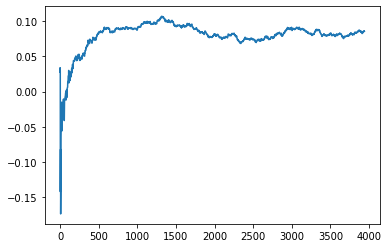

Thread: 6 iteration: 650
RAM mBackground_23 FROM: 704 --> 320 reward: 0.219304452515625
Thread: 1 iteration: 622
RAM mProject_9 FROM: 1536 --> 1024 reward: 0.17294624606249998
Thread: 2 iteration: 674
RAM mDiffFit_330 FROM: 2880 --> 832 reward: 0.05879685859375001
Thread: 6 iteration: 651
RAM mDiffFit_160 FROM: 1152 --> 256 reward: 0.15680207968749998
Thread: 5 iteration: 688
RAM mDiffFit_365 FROM: 2304 --> 2944 reward: 0.0804063703125
Thread: 5 iteration: 689
RAM mDiffFit_200 FROM: 1152 --> 256 reward: 0.3455
Thread: 6 iteration: 652
RAM mViewer_3 FROM: 2176 --> 1408 reward: -0.06125637993750007
Saving ...


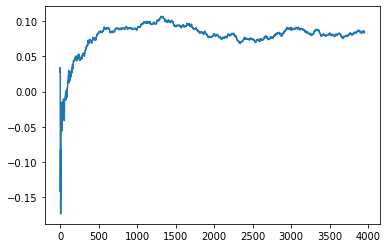

Thread: 5 iteration: 690
RAM mProject_31 FROM: 1152 --> 2240 reward: -0.09920047865625004
Thread: 4 iteration: 663
RAM mDiffFit_109 FROM: 832 --> 256 reward: 0.053601526953125006
Thread: 5 iteration: 691
RAM mBgModel_2 FROM: 1280 --> 320 reward: 0.5636312390625
Thread: 2 iteration: 675
RAM mDiffFit_236 FROM: 576 --> 256 reward: 0.07083331875000001
Thread: 4 iteration: 664
RAM mDiffFit_335 FROM: 1024 --> 1984 reward: 0.0049271234375
Thread: 5 iteration: 692
RAM mDiffFit_333 FROM: 3008 --> 1984 reward: 0.19035433437499993
Thread: 4 iteration: 665
RAM mDiffFit_307 FROM: 1984 --> 1984 reward: -0.0025000000000000022
Thread: 5 iteration: 693
RAM mProject_89 FROM: 384 --> 896 reward: 0.9339859441406249
Thread: 3 iteration: 648
RAM mDiffFit_202 FROM: 576 --> 1984 reward: -0.03595309765625
Thread: 4 iteration: 666
RAM mDiffFit_149 FROM: 1088 --> 1984 reward: 0.0013932519531249885
Thread: 5 iteration: 694
RAM mProject_45 FROM: 384 --> 896 reward: 0.9411878237343749
Thread: 1 iteration: 623
RAM m

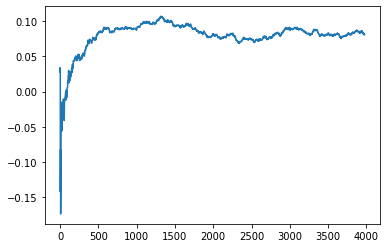

Thread: 3 iteration: 650
RAM mDiffFit_405 FROM: 2752 --> 2624 reward: -0.002734380468749978
Thread: 1 iteration: 626
RAM mDiffFit_218 FROM: 1728 --> 2880 reward: 0.022609424218750004
Thread: 2 iteration: 677
RAM mDiffFit_37 FROM: 704 --> 2752 reward: -0.07659112851562498
Thread: 6 iteration: 656
RAM mDiffFit_360 FROM: 1536 --> 2880 reward: -0.039851570703125005
Thread: 4 iteration: 669
RAM mDiffFit_138 FROM: 320 --> 1984 reward: -0.04052597421875
Thread: 2 iteration: 678
RAM mDiffFit_274 FROM: 704 --> 256 reward: 0.028958275
Thread: 3 iteration: 651
RAM mDiffFit_222 FROM: 768 --> 1984 reward: -0.0434895578125
Saving ...


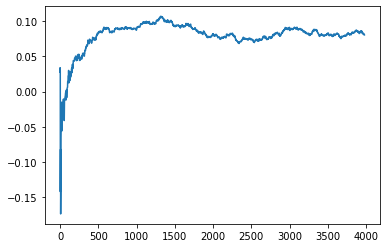

Thread: 4 iteration: 670
RAM mDiffFit_393 FROM: 1216 --> 256 reward: -0.04773455546874996
Thread: 1 iteration: 627
RAM mDiffFit_4 FROM: 832 --> 1984 reward: -0.027835907421874997
Thread: 2 iteration: 679
RAM mDiffFit_214 FROM: 576 --> 1984 reward: -0.09198438046875002
Thread: 4 iteration: 671
RAM mDiffFit_354 FROM: 1600 --> 1984 reward: -0.03295836250000002
Thread: 1 iteration: 628
RAM mConcatFit_3 FROM: 2368 --> 640 reward: 0.13404159375000005
Thread: 3 iteration: 652
RAM mImgtbl_3 FROM: 1280 --> 704 reward: 0.15847911562499994
Thread: 6 iteration: 657
RAM mProject_85 FROM: 768 --> 896 reward: 0.905335925765625
Thread: 5 iteration: 698
RAM mDiffFit_40 FROM: 640 --> 1984 reward: -0.15559898203125
Thread: 4 iteration: 672
RAM mDiffFit_351 FROM: 832 --> 2752 reward: -0.11550522109375003
Thread: 6 iteration: 658
RAM mDiffFit_264 FROM: 1856 --> 1984 reward: 0.030273473046875006
Thread: 1 iteration: 629
RAM mBackground_76 FROM: 2752 --> 1088 reward: -0.016557376757812464
Saving ...


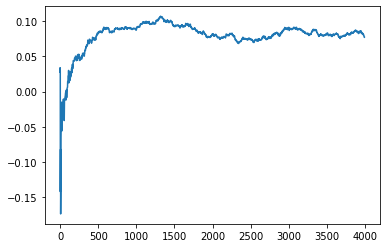

Thread: 2 iteration: 680
RAM mBackground_8 FROM: 2624 --> 704 reward: 0.06183698883593746
Thread: 3 iteration: 653
RAM mDiffFit_322 FROM: 2496 --> 1984 reward: 0.01431511054687501
Thread: 6 iteration: 659
RAM mDiffFit_223 FROM: 1600 --> 1984 reward: 0.006937521874999988
Thread: 2 iteration: 681
RAM mDiffFit_324 FROM: 704 --> 1984 reward: 0.06795064023437498
Saving ...


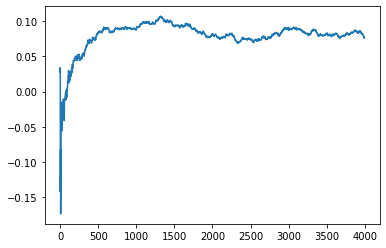

Thread: 1 iteration: 630
RAM mDiffFit_281 FROM: 256 --> 1984 reward: -0.19768221328125002
Thread: 3 iteration: 654
RAM mBackground_60 FROM: 1536 --> 320 reward: 0.37907409185156254
Thread: 5 iteration: 699
RAM mDiffFit_282 FROM: 640 --> 1984 reward: -0.011695244140624995
Saving ...


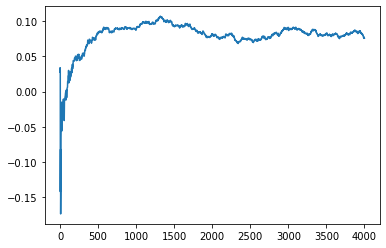

Thread: 5 iteration: 700
RAM mBackground_83 FROM: 768 --> 320 reward: 0.24813909185156258
Thread: 2 iteration: 682
RAM mDiffFit_367 FROM: 2176 --> 1984 reward: -0.05570840625000002
Thread: 1 iteration: 631
RAM mBackground_40 FROM: 320 --> 320 reward: -0.08176497535156259
Thread: 3 iteration: 655
RAM mDiffFit_307 FROM: 1856 --> 1984 reward: -0.027106791796875015
Thread: 5 iteration: 701
RAM mDiffFit_84 FROM: 256 --> 448 reward: -0.087684889453125
Thread: 2 iteration: 683
RAM mProject_79 FROM: 1600 --> 2752 reward: 0.12874861610156238
Saving ...


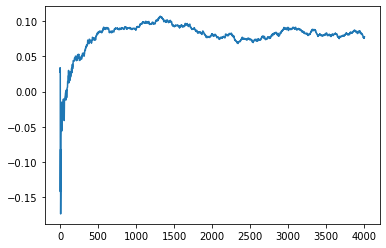

Thread: 6 iteration: 660
RAM mDiffFit_69 FROM: 1088 --> 448 reward: 0.091851570703125
Thread: 1 iteration: 632
RAM mProject_72 FROM: 704 --> 896 reward: 0.926671564546875
Thread: 4 iteration: 673
RAM mDiffFit_159 FROM: 1344 --> 448 reward: -0.018341216015624988
Thread: 5 iteration: 702
RAM mDiffFit_409 FROM: 320 --> 448 reward: -0.16855212343750003
Thread: 3 iteration: 656
RAM mDiffFit_335 FROM: 2496 --> 448 reward: 0.04451557578125001
Thread: 6 iteration: 661
RAM mBackground_15 FROM: 2880 --> 768 reward: 0.06077093149218748
Thread: 2 iteration: 684
RAM mBackground_4 FROM: 640 --> 320 reward: 0.2453485819921875
Thread: 1 iteration: 633
RAM mDiffFit_334 FROM: 2176 --> 448 reward: 0.04897652695312499
Thread: 5 iteration: 703
RAM mViewer_1 FROM: 2816 --> 1984 reward: -0.028770231445312475
Thread: 3 iteration: 657
RAM mDiffFit_130 FROM: 1664 --> 448 reward: 0.04837228007812503
Thread: 6 iteration: 662
RAM mDiffFit_267 FROM: 2368 --> 448 reward: 0.01696604101562499
Thread: 2 iteration: 685


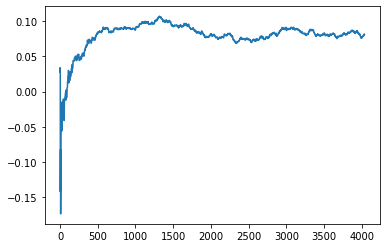

Thread: 3 iteration: 660
RAM mBackground_18 FROM: 2368 --> 2560 reward: 0.08749168007812501
Thread: 5 iteration: 708
RAM mProject_42 FROM: 1600 --> 1728 reward: -0.006258261726562353
Thread: 6 iteration: 664
RAM mDiffFit_207 FROM: 1024 --> 448 reward: 0.05969269921874999
Thread: 5 iteration: 709
RAM mDiffFit_328 FROM: 2752 --> 448 reward: 0.11813267851562503
Saving ...


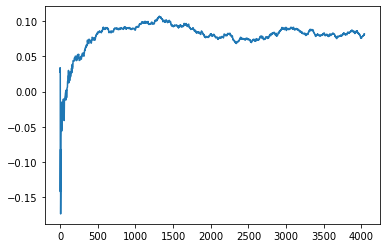

Thread: 5 iteration: 710
RAM mProject_89 FROM: 832 --> 2560 reward: 0.7612884056250001
Thread: 4 iteration: 678
RAM mDiffFit_37 FROM: 448 --> 448 reward: -0.15802610546874998
Thread: 5 iteration: 711
RAM mDiffFit_396 FROM: 2368 --> 448 reward: 0.20614057578125
Thread: 4 iteration: 679
RAM mProject_44 FROM: 2624 --> 1152 reward: 0.021885645796874964
Saving ...


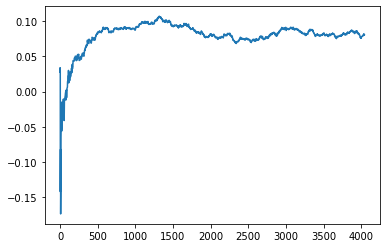

Thread: 2 iteration: 690
RAM mDiffFit_389 FROM: 960 --> 448 reward: 0.17355730078125003
Thread: 5 iteration: 712
RAM mDiffFit_107 FROM: 1600 --> 448 reward: 0.08097134960937499
Saving ...


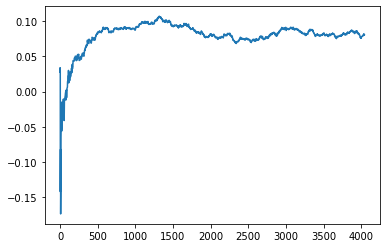

Thread: 4 iteration: 680
RAM mProject_90 FROM: 960 --> 320 reward: -1.0
Thread: 1 iteration: 637
RAM mDiffFit_157 FROM: 2432 --> 448 reward: 0.047130133593749984
Thread: 2 iteration: 691
RAM mDiffFit_51 FROM: 1600 --> 448 reward: 0.02869787656249999
Thread: 1 iteration: 638
RAM mProject_40 FROM: 2880 --> 1024 reward: 0.04074619007812499
Thread: 6 iteration: 665
RAM mBgModel_1 FROM: 1344 --> 1152 reward: 0.028962495624999973
Thread: 4 iteration: 681
RAM mBackground_81 FROM: 1344 --> 768 reward: -0.008230560460937543
Thread: 2 iteration: 692
RAM mBackground_39 FROM: 128 --> 192 reward: 0.9836050389296875
Thread: 5 iteration: 713
RAM mDiffFit_373 FROM: 512 --> 448 reward: -0.08924223398437497
Thread: 2 iteration: 693
RAM mDiffFit_113 FROM: 1216 --> 448 reward: 0.14315623906249997
Thread: 6 iteration: 666
RAM mBackground_59 FROM: 2880 --> 1408 reward: -0.007386257140625012
Thread: 4 iteration: 682
RAM mBackground_15 FROM: 1216 --> 768 reward: 0.056296380382812525
Thread: 5 iteration: 714
R

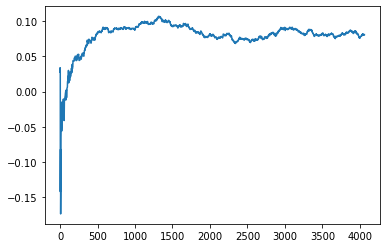

Thread: 1 iteration: 640
RAM mBackground_82 FROM: 1088 --> 896 reward: 0.04893713933593749
Thread: 3 iteration: 662
RAM mDiffFit_144 FROM: 2688 --> 448 reward: 0.03072389453125001
Thread: 2 iteration: 695
RAM mBackground_43 FROM: 1280 --> 2304 reward: 0.03818053581250004
Thread: 5 iteration: 716
RAM mDiffFit_74 FROM: 2432 --> 1088 reward: -0.03378132656249999
Thread: 1 iteration: 641
RAM mDiffFit_69 FROM: 1216 --> 1088 reward: -0.008895840624999997
Thread: 3 iteration: 663
RAM mProject_11 FROM: 2304 --> 2752 reward: 0.07307077528125007
Thread: 6 iteration: 667
RAM mDiffFit_34 FROM: 2240 --> 448 reward: 0.14509889453124997
Thread: 4 iteration: 684
RAM mDiffFit_251 FROM: 2048 --> 1088 reward: 0.011236969140624997
Thread: 2 iteration: 696
RAM mBackground_85 FROM: 1088 --> 2304 reward: -0.056744265695312476
Thread: 5 iteration: 717
RAM mDiffFit_388 FROM: 896 --> 256 reward: 0.12556769921875002
Thread: 1 iteration: 642
RAM mDiffFit_84 FROM: 576 --> 256 reward: 0.01877860664062498
Thread: 3 

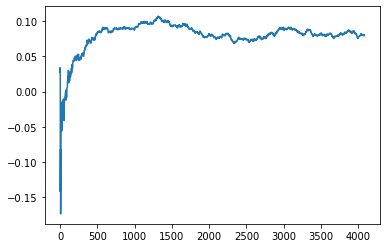

Thread: 2 iteration: 700
RAM mBackground_55 FROM: 1984 --> 704 reward: 0.1465650246484375
Thread: 3 iteration: 669
RAM mProject_11 FROM: 576 --> 896 reward: 0.9307225043437499
Thread: 4 iteration: 685
RAM mProject_86 FROM: 1152 --> 1152 reward: 0.03344908907812498
Thread: 5 iteration: 718
RAM mDiffFit_348 FROM: 1280 --> 1984 reward: -0.003562478125000018
Saving ...


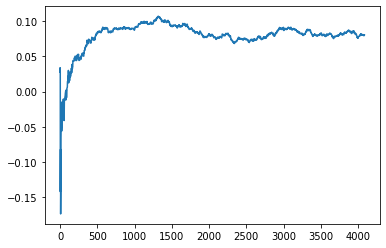

Thread: 6 iteration: 670
RAM mProject_74 FROM: 768 --> 896 reward: 0.912650305359375
Thread: 1 iteration: 643
RAM mDiffFit_118 FROM: 1344 --> 1984 reward: 0.014104203125000006
Thread: 2 iteration: 701
RAM mDiffFit_398 FROM: 1664 --> 1984 reward: -0.020513030859375017
Saving ...


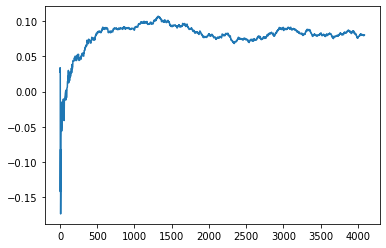

Thread: 3 iteration: 670
RAM mDiffFit_27 FROM: 704 --> 1984 reward: -0.013341084765624983
Thread: 4 iteration: 686
RAM mBackground_28 FROM: 1664 --> 704 reward: 0.08078841982031247
Thread: 5 iteration: 719
RAM mDiffFit_186 FROM: 1984 --> 1216 reward: 0.0713854421875
Thread: 6 iteration: 671
RAM mDiffFit_294 FROM: 1536 --> 1216 reward: 0.054583362499999996
Thread: 2 iteration: 702
RAM mBackground_40 FROM: 2496 --> 704 reward: 0.048509215093750044
Thread: 3 iteration: 671
RAM mBackground_80 FROM: 1280 --> 704 reward: 0.12621171639843748
Thread: 1 iteration: 644
RAM mDiffFit_372 FROM: 2432 --> 1216 reward: -0.009885485937500011
Thread: 4 iteration: 687
RAM mBackground_54 FROM: 2944 --> 1088 reward: -0.052901394664062525
Saving ...


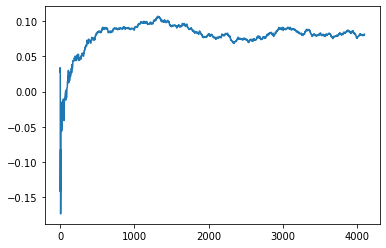

Thread: 5 iteration: 720
RAM mDiffFit_52 FROM: 384 --> 1216 reward: -0.1262812390625
Thread: 3 iteration: 672
RAM mDiffFit_264 FROM: 2752 --> 1216 reward: 0.0438229203125
Thread: 4 iteration: 688
RAM mBackground_21 FROM: 128 --> 2560 reward: 0.28994576156250007
Thread: 5 iteration: 721
RAM mDiffFit_206 FROM: 1344 --> 1216 reward: -0.007932300781250002
Thread: 3 iteration: 673
RAM mProject_73 FROM: 3008 --> 2240 reward: -0.12956416825781245
Thread: 6 iteration: 672
RAM mDiffFit_19 FROM: 960 --> 192 reward: 0.26592185859375006
Thread: 5 iteration: 722
RAM mProject_76 FROM: 2688 --> 2240 reward: -0.07633796639062512
Thread: 2 iteration: 703
RAM mBackground_31 FROM: 2496 --> 704 reward: 0.031083008554687482
Thread: 4 iteration: 689
RAM mDiffFit_88 FROM: 256 --> 192 reward: 0.4990026761718751
Thread: 3 iteration: 674
RAM mDiffFit_153 FROM: 2880 --> 2752 reward: -0.0018593804687500222
Thread: 5 iteration: 723
RAM mDiffFit_220 FROM: 1408 --> 2752 reward: -0.05951825195312503
Thread: 2 iterati

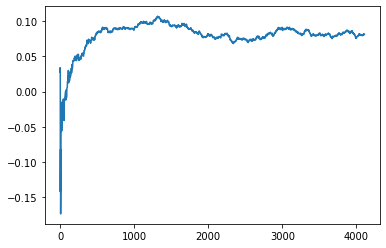

Thread: 4 iteration: 690
RAM mDiffFit_320 FROM: 896 --> 192 reward: 0.24178646015624997
Thread: 6 iteration: 673
RAM mProject_85 FROM: 2368 --> 1152 reward: 0.06391104131249985
Thread: 1 iteration: 645
RAM mDiffFit_184 FROM: 3008 --> 832 reward: 0.049887987109375025
Thread: 2 iteration: 705
RAM mDiffFit_332 FROM: 2688 --> 832 reward: 0.054940110546875004
Thread: 1 iteration: 646
RAM mBackground_39 FROM: 2624 --> 704 reward: 0.10909223792968749
Thread: 6 iteration: 674
RAM mDiffFit_51 FROM: 2624 --> 832 reward: 0.010867146484374972
Thread: 2 iteration: 706
RAM mDiffFit_203 FROM: 1984 --> 256 reward: 0.116565066796875
Thread: 6 iteration: 675
RAM mDiffFit_401 FROM: 1152 --> 256 reward: 0.26500522109375
Thread: 1 iteration: 647
RAM mProject_11 FROM: 640 --> 2560 reward: 0.7558696490625001
Thread: 3 iteration: 675
RAM mProject_38 FROM: 192 --> 2560 reward: 0.7627959056250001
Thread: 5 iteration: 724
RAM mDiffFit_173 FROM: 2304 --> 256 reward: 0.1688437171875
Thread: 2 iteration: 707
RAM mP

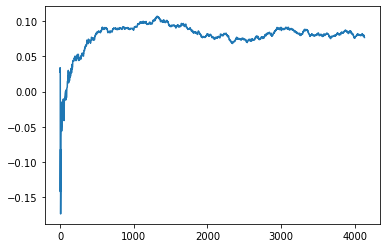

Thread: 1 iteration: 650
RAM mProject_78 FROM: 320 --> 2560 reward: 0.7505633924999999
Thread: 3 iteration: 676
RAM mBackground_25 FROM: 1408 --> 1792 reward: -0.028729365593749997
Thread: 2 iteration: 709
RAM mDiffFit_254 FROM: 1152 --> 256 reward: 0.1814479203125
Thread: 3 iteration: 677
RAM mDiffFit_330 FROM: 1920 --> 256 reward: 0.14270309765625
Saving ...


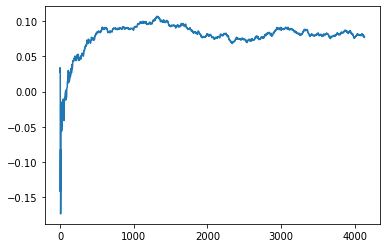

Thread: 2 iteration: 710
RAM mProject_53 FROM: 2432 --> 1152 reward: 0.062606965359375
Thread: 4 iteration: 692
RAM mDiffFit_367 FROM: 2688 --> 256 reward: 0.07932805390625003
Thread: 3 iteration: 678
RAM mProject_8 FROM: 512 --> 896 reward: 0.5823266450625
Thread: 6 iteration: 678
RAM mBackground_42 FROM: 3008 --> 1088 reward: -0.06355510120312498
Thread: 4 iteration: 693
RAM mDiffFit_294 FROM: 1728 --> 256 reward: 0.16707550898437495
Thread: 2 iteration: 711
RAM mDiffFit_32 FROM: 2560 --> 1984 reward: 0.0183229203125
Thread: 3 iteration: 679
RAM mDiffFit_120 FROM: 2496 --> 2560 reward: -2.0873409898437503
Thread: 6 iteration: 679
RAM mProject_40 FROM: 640 --> 896 reward: 0.9171512451562499
Thread: 5 iteration: 726
RAM mBackground_19 FROM: 2240 --> 768 reward: 0.0892898624765625
Thread: 4 iteration: 694
RAM mDiffFit_117 FROM: 128 --> 192 reward: -0.307731791796875
Thread: 2 iteration: 712
RAM mProject_32 FROM: 2816 --> 1152 reward: -0.016539733968750015
Thread: 1 iteration: 651
RAM mB

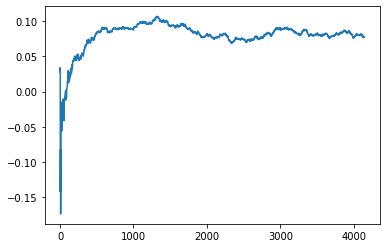

Thread: 3 iteration: 680
RAM mBackground_86 FROM: 640 --> 1792 reward: -0.08602230020312501
Saving ...


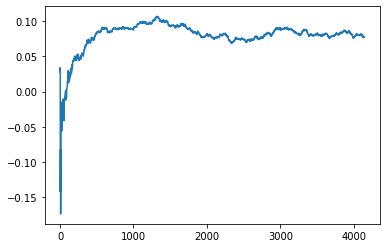

Thread: 6 iteration: 680
RAM mDiffFit_152 FROM: 2432 --> 1088 reward: -0.033406326562500005
Thread: 1 iteration: 652
RAM mDiffFit_181 FROM: 2432 --> 1088 reward: -0.023283915234375008
Thread: 2 iteration: 713
RAM mBackground_77 FROM: 2880 --> 704 reward: 0.08556762324218742
Thread: 5 iteration: 727
RAM mDiffFit_355 FROM: 192 --> 192 reward: -0.04684376093750012
Thread: 4 iteration: 695
RAM mDiffFit_399 FROM: 640 --> 256 reward: 0.011010354687500008
Thread: 3 iteration: 681
RAM mDiffFit_205 FROM: 2496 --> 2752 reward: 0.010343760937499991
Thread: 6 iteration: 681
RAM mDiffFit_110 FROM: 960 --> 1088 reward: -0.046612012890625006
Thread: 1 iteration: 653
RAM mDiffFit_125 FROM: 2560 --> 448 reward: 0.04889838554687501
Thread: 5 iteration: 728
RAM mBackground_62 FROM: 2944 --> 704 reward: 0.09422584457031245
Thread: 4 iteration: 696
RAM mDiffFit_234 FROM: 1664 --> 448 reward: 0.024216084765625
Thread: 3 iteration: 682
RAM mDiffFit_286 FROM: 1024 --> 448 reward: 0.10974999999999999
Thread: 6

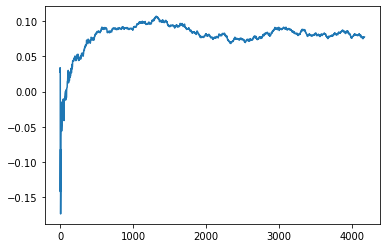

Thread: 5 iteration: 730
RAM mBackground_11 FROM: 2944 --> 1088 reward: -0.054943894664062534
Thread: 1 iteration: 657
RAM mDiffFit_339 FROM: 1536 --> 448 reward: 0.024898385546875002
Saving ...


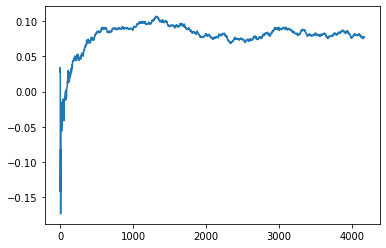

Thread: 4 iteration: 700
RAM mDiffFit_371 FROM: 2304 --> 448 reward: 0.063716084765625
Thread: 3 iteration: 686
RAM mDiffFit_278 FROM: 2240 --> 448 reward: 0.049164005078125
Thread: 6 iteration: 686
RAM mBackground_18 FROM: 3008 --> 1088 reward: -0.11437132071875003
Thread: 2 iteration: 716
RAM mDiffFit_222 FROM: 128 --> 448 reward: -0.372299491015625
Thread: 5 iteration: 731
RAM mDiffFit_57 FROM: 576 --> 448 reward: 0.01698696914062497
Thread: 4 iteration: 701
RAM mDiffFit_99 FROM: 1728 --> 448 reward: 0.06742185859374998
Thread: 3 iteration: 687
RAM mDiffFit_375 FROM: 640 --> 448 reward: 0.09458853984375001
Thread: 6 iteration: 687
RAM mDiffFit_156 FROM: 1280 --> 2560 reward: 0.034198007812500014
Thread: 2 iteration: 717
RAM mDiffFit_266 FROM: 2432 --> 2560 reward: 0.22514610312500002
Thread: 5 iteration: 732
RAM mDiffFit_248 FROM: 832 --> 2560 reward: -0.09280730078124999
Thread: 4 iteration: 702
RAM mDiffFit_271 FROM: 2880 --> 2560 reward: -0.0032109511718750143
Thread: 3 iteration

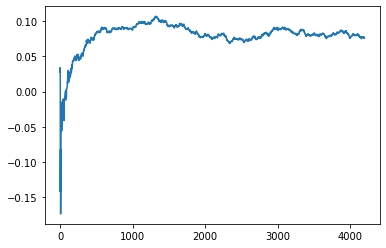

Thread: 1 iteration: 660
RAM mDiffFit_45 FROM: 1280 --> 2560 reward: 0.004479203124999991
Saving ...


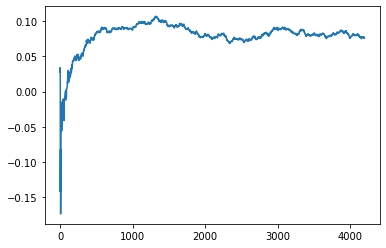

Thread: 2 iteration: 720
RAM mDiffFit_278 FROM: 2944 --> 2560 reward: -0.33921397734375003
Thread: 5 iteration: 735
RAM mBackground_83 FROM: 1984 --> 704 reward: 0.10849655422656251
Thread: 1 iteration: 661
RAM mBackground_89 FROM: 1664 --> 704 reward: 0.09652375583593749
Thread: 2 iteration: 721
RAM mDiffFit_135 FROM: 2816 --> 256 reward: 0.025812346875000013
Thread: 5 iteration: 736
RAM mProject_80 FROM: 1536 --> 1152 reward: 0.10931061515625003
Thread: 6 iteration: 689
RAM mDiffFit_80 FROM: 256 --> 320 reward: -0.005317699218750048
Thread: 1 iteration: 662
RAM mDiffFit_69 FROM: 896 --> 256 reward: 0.24016668124999999
Thread: 2 iteration: 722
RAM mProject_61 FROM: 640 --> 896 reward: 0.913392805359375
Thread: 3 iteration: 689
RAM mDiffFit_49 FROM: 2240 --> 384 reward: 0.14355725703125
Thread: 5 iteration: 737
RAM mDiffFit_385 FROM: 2304 --> 832 reward: 0.015528606640625008
Thread: 1 iteration: 663
RAM mDiffFit_94 FROM: 2368 --> 2752 reward: -0.00808073007812507
Saving ...


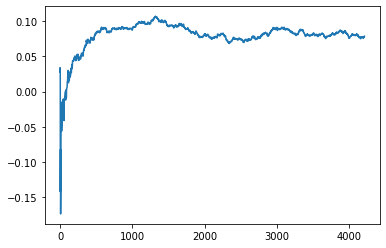

Thread: 3 iteration: 690
RAM mBackground_74 FROM: 704 --> 704 reward: 0.025284913078124985
Saving ...


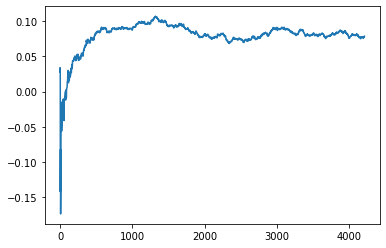

Thread: 6 iteration: 690
RAM mDiffFit_332 FROM: 2624 --> 832 reward: -0.003932344531250003
Thread: 3 iteration: 691
RAM mDiffFit_195 FROM: 2240 --> 448 reward: 0.062414005078125
Thread: 1 iteration: 664
RAM mDiffFit_358 FROM: 2048 --> 448 reward: 0.10526298710937504
Thread: 6 iteration: 691
RAM mDiffFit_48 FROM: 768 --> 448 reward: 0.0481562390625
Thread: 5 iteration: 738
RAM mProject_83 FROM: 1344 --> 1152 reward: 0.061197180609374985
Thread: 4 iteration: 704
RAM mDiffFit_103 FROM: 2560 --> 448 reward: 0.005255089843749974
Thread: 3 iteration: 692
RAM mDiffFit_18 FROM: 576 --> 448 reward: 0.015604159375000037
Thread: 1 iteration: 665
RAM mDiffFit_93 FROM: 768 --> 448 reward: -0.03404431367187501
Thread: 5 iteration: 739
RAM mProject_26 FROM: 2368 --> 1152 reward: 0.06829010676562498
Thread: 2 iteration: 723
RAM mDiffFit_316 FROM: 2880 --> 448 reward: 0.05562754492187499
Thread: 4 iteration: 705
RAM mDiffFit_262 FROM: 1280 --> 256 reward: 0.039937434375000025
Thread: 2 iteration: 724
R

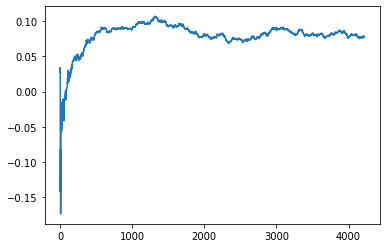

Thread: 5 iteration: 740
RAM mDiffFit_26 FROM: 2816 --> 384 reward: 0.03536969140625002
Thread: 4 iteration: 706
RAM mDiffFit_260 FROM: 384 --> 448 reward: -0.115773473046875
Thread: 2 iteration: 725
RAM mDiffFit_81 FROM: 1088 --> 256 reward: 0.10980725703125001
Thread: 3 iteration: 694
RAM mDiffFit_327 FROM: 1152 --> 256 reward: 0.1675
Thread: 5 iteration: 741
RAM mProject_88 FROM: 1856 --> 1152 reward: 0.14307137163281244
Thread: 6 iteration: 692
RAM mDiffFit_316 FROM: 1728 --> 384 reward: 0.074304668359375
Thread: 4 iteration: 707
RAM mDiffFit_72 FROM: 1664 --> 384 reward: 0.026973894531250008
Thread: 6 iteration: 693
RAM mBackground_44 FROM: 832 --> 704 reward: 0.028615149195312477
Thread: 3 iteration: 695
RAM mBackground_55 FROM: 256 --> 704 reward: -0.36355601971874996
Thread: 5 iteration: 742
RAM mDiffFit_328 FROM: 704 --> 256 reward: 0.24411455781250005
Thread: 4 iteration: 708
RAM mProject_9 FROM: 128 --> 896 reward: 0.9294850043437499
Thread: 1 iteration: 666
RAM mDiffFit_285

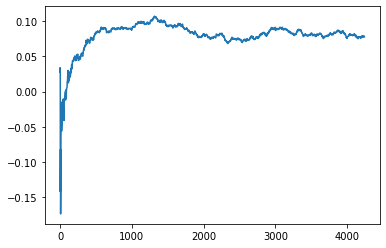

Thread: 4 iteration: 710
RAM mDiffFit_147 FROM: 1664 --> 256 reward: 0.44277084062500005
Thread: 1 iteration: 668
RAM mProject_38 FROM: 2432 --> 1152 reward: 0.069855724546875
Thread: 3 iteration: 696
RAM mDiffFit_249 FROM: 2560 --> 1088 reward: 0.010924447265625008
Thread: 6 iteration: 697
RAM mDiffFit_112 FROM: 1856 --> 256 reward: 0.19159371718749998
Thread: 5 iteration: 746
RAM mDiffFit_368 FROM: 2560 --> 1088 reward: -0.011197964062499982
Thread: 1 iteration: 669
RAM mDiffFit_190 FROM: 2304 --> 1088 reward: -0.000604203125000001
Thread: 3 iteration: 697
RAM mBackground_61 FROM: 1600 --> 704 reward: 0.15846620653906246
Thread: 4 iteration: 711
RAM mDiffFit_314 FROM: 640 --> 1088 reward: -0.014789048828124998
Thread: 6 iteration: 698
RAM mBackground_58 FROM: 1920 --> 704 reward: 0.13273559678125
Thread: 5 iteration: 747
RAM mDiffFit_348 FROM: 2560 --> 1088 reward: -0.0665313703125
Thread: 6 iteration: 699
RAM mBackground_77 FROM: 1600 --> 704 reward: 0.16405620653906244
Thread: 3 it

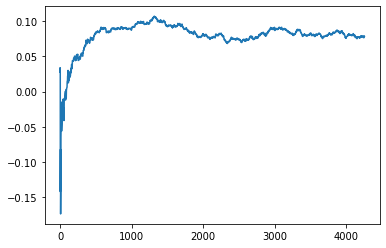

Thread: 6 iteration: 700
RAM mProject_51 FROM: 640 --> 896 reward: 0.939275323734375
Thread: 2 iteration: 728
RAM mBackground_32 FROM: 3008 --> 704 reward: 0.0336853463828125
Thread: 6 iteration: 701
RAM mImgtbl_2 FROM: 1856 --> 704 reward: 0.2645187434375
Saving ...


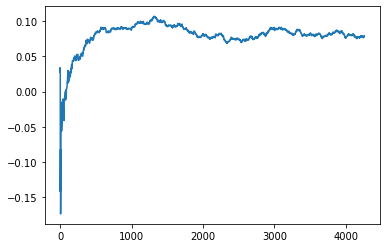

Thread: 3 iteration: 700
RAM mBackground_6 FROM: 1664 --> 704 reward: 0.12725758692187505
Thread: 2 iteration: 729
RAM mProject_37 FROM: 960 --> 1152 reward: -0.07591357849218756
Thread: 4 iteration: 712
RAM mProject_57 FROM: 448 --> 1088 reward: 0.4503557971406251
Saving ...


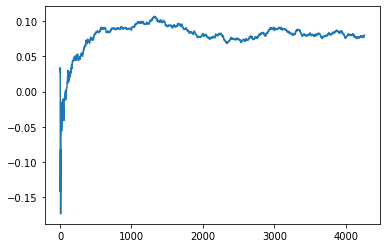

Thread: 1 iteration: 670
RAM mDiffFit_190 FROM: 1472 --> 1088 reward: 0.024807300781250017
Thread: 3 iteration: 701
RAM mDiffFit_344 FROM: 1408 --> 1088 reward: 0.016507809765624985
Saving ...


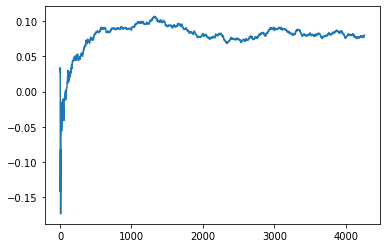

Thread: 2 iteration: 730
RAM mProject_83 FROM: 960 --> 1152 reward: -0.09524390575781251
Thread: 5 iteration: 748
RAM mDiffFit_164 FROM: 1600 --> 1088 reward: -0.011854203125000011
Thread: 1 iteration: 671
RAM mDiffFit_380 FROM: 1152 --> 1088 reward: 0.011005221093750009
Thread: 3 iteration: 702
RAM mBackground_65 FROM: 1600 --> 704 reward: 0.11844258692187497
Thread: 4 iteration: 713
RAM mDiffFit_276 FROM: 1984 --> 1088 reward: -0.07102614921874997
Thread: 2 iteration: 731
RAM mDiffFit_158 FROM: 2368 --> 1088 reward: -0.005971393359375009
Thread: 5 iteration: 749
RAM mDiffFit_94 FROM: 2624 --> 1088 reward: -0.010757897265625017
Thread: 1 iteration: 672
RAM mProject_85 FROM: 2496 --> 1152 reward: 0.057145546476562566
Thread: 6 iteration: 702
RAM mDiffFit_26 FROM: 1920 --> 1088 reward: -0.03132296406249999
Thread: 2 iteration: 732
RAM mDiffFit_129 FROM: 128 --> 256 reward: -0.44249482265625
Thread: 4 iteration: 714
RAM mBackground_56 FROM: 2112 --> 320 reward: -0.41723311758593773
Savin

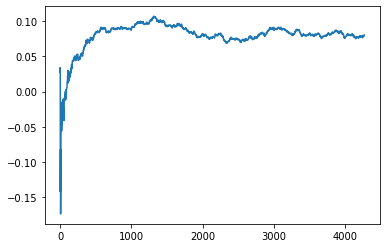

Thread: 5 iteration: 750
RAM mDiffFit_281 FROM: 1344 --> 256 reward: 0.15928641640625002
Thread: 3 iteration: 703
RAM mDiffFit_209 FROM: 1536 --> 1088 reward: -0.008510442187500003
Thread: 1 iteration: 673
RAM mDiffFit_274 FROM: 768 --> 256 reward: 0.0664478765625
Thread: 6 iteration: 703
RAM mDiffFit_94 FROM: 2560 --> 1088 reward: -0.005648516796874954
Thread: 5 iteration: 751
RAM mDiffFit_215 FROM: 1536 --> 256 reward: 0.05240615156250003
Thread: 3 iteration: 704
RAM mDiffFit_23 FROM: 576 --> 256 reward: 0.14146353984374999
Thread: 4 iteration: 715
RAM mDiffFit_25 FROM: 1792 --> 256 reward: 0.08140619531250001
Thread: 1 iteration: 674
RAM mDiffFit_145 FROM: 2560 --> 1984 reward: -0.010031282812499997
Thread: 3 iteration: 705
RAM mDiffFit_301 FROM: 1280 --> 256 reward: 0.1170937171875
Thread: 5 iteration: 752
RAM mBackground_74 FROM: 1600 --> 1792 reward: 0.01668940321874996
Thread: 4 iteration: 716
RAM mViewer_1 FROM: 1536 --> 1984 reward: -0.018952644820312524
Thread: 6 iteration: 7

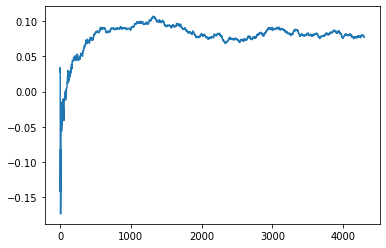

Thread: 4 iteration: 720
RAM mDiffFit_423 FROM: 256 --> 256 reward: -0.025020840625
Thread: 5 iteration: 755
RAM mDiffFit_137 FROM: 832 --> 256 reward: 0.11281506679687497
Thread: 3 iteration: 709
RAM mDiffFit_314 FROM: 2432 --> 2560 reward: 0.03158858359375001
Thread: 2 iteration: 736
RAM mDiffFit_347 FROM: 128 --> 256 reward: -0.4808177429687499
Thread: 6 iteration: 707
RAM mDiffFit_197 FROM: 1920 --> 2560 reward: 0.020729203125000022
Thread: 1 iteration: 679
RAM mDiffFit_280 FROM: 1856 --> 2560 reward: -0.02789325195312501
Thread: 5 iteration: 756
RAM mDiffFit_138 FROM: 2752 --> 1984 reward: 0.009096349609375009
Thread: 5 iteration: 757
RAM mDiffFit_12 FROM: 1344 --> 256 reward: 0.177354159375
Thread: 2 iteration: 737
RAM mDiffFit_331 FROM: 1728 --> 448 reward: 0.162312521875
Thread: 6 iteration: 708
RAM mDiffFit_23 FROM: 256 --> 256 reward: -0.031895840625000005
Saving ...


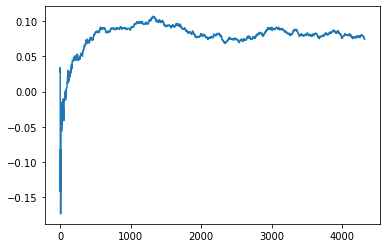

Thread: 1 iteration: 680
RAM mDiffFit_205 FROM: 2176 --> 1088 reward: -0.028114645312500002
Thread: 5 iteration: 758
RAM mDiffFit_157 FROM: 2752 --> 1984 reward: 0.003971349609375001
Thread: 1 iteration: 681
RAM mDiffFit_25 FROM: 1280 --> 448 reward: 0.086257809765625
Thread: 6 iteration: 709
RAM mBackground_63 FROM: 1920 --> 704 reward: 0.13453396730468745
Thread: 2 iteration: 738
RAM mDiffFit_11 FROM: 2752 --> 1088 reward: -0.008924534765624974
Thread: 2 iteration: 739
RAM mDiffFit_191 FROM: 320 --> 256 reward: 0.057874999999999975
Thread: 5 iteration: 759
RAM mProject_58 FROM: 1728 --> 1152 reward: 0.13864075910156248
Saving ...


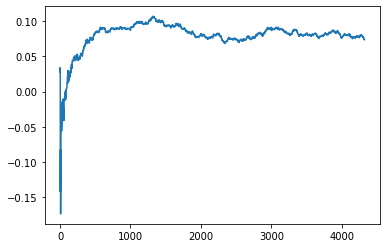

Thread: 3 iteration: 710
RAM mProject_47 FROM: 384 --> 896 reward: 0.92401562475
Thread: 4 iteration: 721
RAM mBackground_90 FROM: 1024 --> 320 reward: 0.3449338803828125
Thread: 1 iteration: 682
RAM mDiffFit_146 FROM: 2432 --> 1088 reward: -0.0925418125
Saving ...


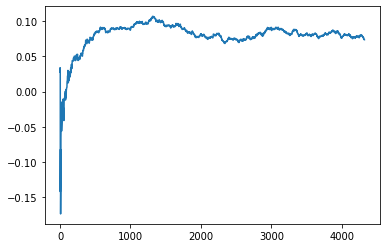

Thread: 6 iteration: 710
RAM mDiffFit_411 FROM: 1408 --> 256 reward: 0.33941663749999995
Saving ...


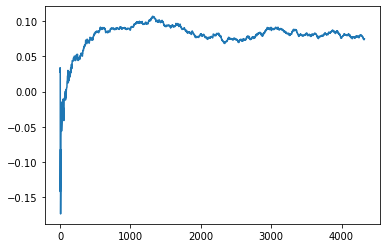

Thread: 2 iteration: 740
RAM mDiffFit_216 FROM: 3008 --> 832 reward: -0.028005308593750007
Thread: 1 iteration: 683
RAM mDiffFit_46 FROM: 960 --> 256 reward: 0.08914320820312502
Thread: 3 iteration: 711
RAM mDiffFit_336 FROM: 192 --> 256 reward: -0.500132897265625
Saving ...


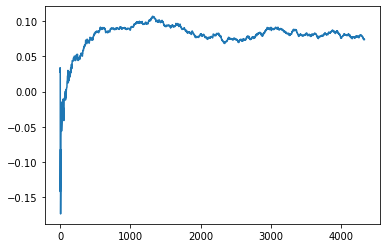

Thread: 5 iteration: 760
RAM mDiffFit_49 FROM: 1600 --> 256 reward: 0.18831506679687499
Thread: 6 iteration: 711
RAM mBackground_64 FROM: 1024 --> 320 reward: 0.38846021146875
Thread: 4 iteration: 722
RAM mBackground_1 FROM: 448 --> 1792 reward: -0.2140570640859375
Thread: 3 iteration: 712
RAM mDiffFit_412 FROM: 1856 --> 1088 reward: -0.027375043750000015
Thread: 6 iteration: 712
RAM mDiffFit_399 FROM: 2176 --> 1088 reward: -0.06410687929687503
Thread: 4 iteration: 723
RAM mDiffFit_277 FROM: 2752 --> 448 reward: 0.07933586367187502
Thread: 3 iteration: 713
RAM mBackground_29 FROM: 1472 --> 320 reward: 0.38276267384375
Thread: 6 iteration: 713
RAM mDiffFit_383 FROM: 1600 --> 448 reward: 0.07426820820312499
Thread: 3 iteration: 714
RAM mBackground_19 FROM: 1024 --> 768 reward: 0.08195084587500001
Thread: 4 iteration: 724
RAM mDiffFit_54 FROM: 2560 --> 448 reward: -0.014534002734374954
Thread: 6 iteration: 714
RAM mDiffFit_400 FROM: 2048 --> 448 reward: 0.12434634960937502
Thread: 4 itera

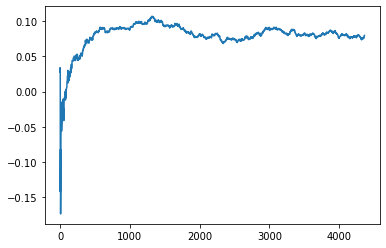

Thread: 3 iteration: 720
RAM mProject_49 FROM: 1792 --> 256 reward: -1.0
Thread: 4 iteration: 727
RAM mDiffFit_366 FROM: 832 --> 256 reward: 0.20655730078125
Thread: 1 iteration: 688
RAM mDiffFit_29 FROM: 576 --> 256 reward: 0.15964584062500004
Thread: 3 iteration: 721
RAM mProject_64 FROM: 2816 --> 2240 reward: -0.14150369179687514
Thread: 5 iteration: 765
RAM mDiffFit_105 FROM: 448 --> 256 reward: 0.0820729203125
Thread: 1 iteration: 689
RAM mBackground_27 FROM: 320 --> 320 reward: -0.0813349753515624
Thread: 4 iteration: 728
RAM mDiffFit_281 FROM: 2944 --> 1984 reward: -0.019593804687500008
Thread: 5 iteration: 766
RAM mDiffFit_235 FROM: 2688 --> 1984 reward: 0.011088539843750016
Thread: 5 iteration: 767
RAM mBackground_66 FROM: 384 --> 704 reward: -0.34427103269531245
Saving ...


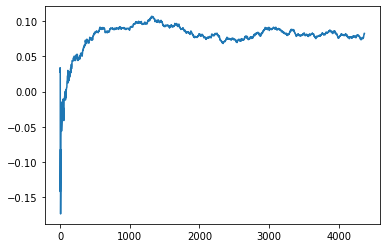

Thread: 1 iteration: 690
RAM mDiffFit_139 FROM: 2112 --> 256 reward: 0.40493225703124996
Thread: 4 iteration: 729
RAM mProject_58 FROM: 1728 --> 1152 reward: 0.15143202091406252
Thread: 2 iteration: 743
RAM mProject_31 FROM: 2176 --> 256 reward: -1.0
Thread: 6 iteration: 719
RAM mBackground_86 FROM: 2496 --> 704 reward: 0.09391458873437497
Thread: 2 iteration: 744
RAM mDiffFit_182 FROM: 384 --> 256 reward: 0.06247915937500001
Saving ...


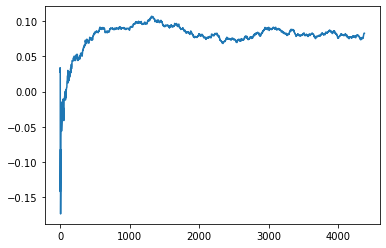

Thread: 4 iteration: 730
RAM mDiffFit_259 FROM: 1536 --> 256 reward: 0.142458275
Thread: 5 iteration: 768
RAM mDiffFit_50 FROM: 832 --> 256 reward: 0.26323696914062505
Thread: 1 iteration: 691
RAM mProject_11 FROM: 1984 --> 1152 reward: 0.13349336892187508
Thread: 3 iteration: 722
RAM mDiffFit_65 FROM: 192 --> 256 reward: -0.10577084062499999
Saving ...


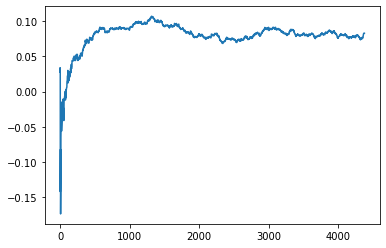

Thread: 6 iteration: 720
RAM mDiffFit_275 FROM: 1664 --> 256 reward: 0.10020309765625002
Thread: 2 iteration: 745
RAM mDiffFit_254 FROM: 512 --> 256 reward: -0.10614592812500001
Thread: 4 iteration: 731
RAM mDiffFit_324 FROM: 512 --> 256 reward: 0.07015623906250001
Thread: 5 iteration: 769
RAM mDiffFit_319 FROM: 128 --> 256 reward: -0.46881774296875
Thread: 1 iteration: 692
RAM mDiffFit_198 FROM: 2880 --> 1984 reward: 0.005361969140624985
Thread: 4 iteration: 732
RAM mDiffFit_32 FROM: 1792 --> 256 reward: 0.11251031093749995
Thread: 3 iteration: 723
RAM mDiffFit_182 FROM: 1792 --> 256 reward: 0.16095831874999997
Thread: 6 iteration: 721
RAM mDiffFit_208 FROM: 384 --> 256 reward: 0.011583318750000016
Saving ...


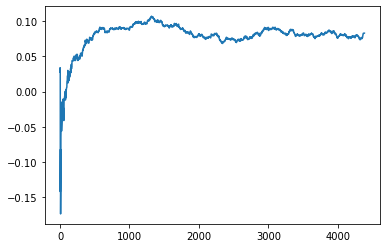

Thread: 5 iteration: 770
RAM mDiffFit_239 FROM: 2304 --> 256 reward: 0.3854061953125
Thread: 2 iteration: 746
RAM mDiffFit_150 FROM: 1856 --> 1984 reward: 0.009145840624999978
Thread: 6 iteration: 722
RAM mBackground_56 FROM: 320 --> 704 reward: -0.3290306344062501
Thread: 1 iteration: 693
RAM mDiffFit_399 FROM: 1472 --> 256 reward: 0.184122367578125
Thread: 3 iteration: 724
RAM mDiffFit_324 FROM: 192 --> 320 reward: -0.07131769921875
Thread: 2 iteration: 747
RAM mDiffFit_280 FROM: 2368 --> 1984 reward: -0.034424534765624994
Thread: 1 iteration: 694
RAM mDiffFit_57 FROM: 1472 --> 256 reward: 0.09361710273437503
Thread: 3 iteration: 725
RAM mBackground_80 FROM: 704 --> 320 reward: 0.20233511157031253
Thread: 6 iteration: 723
RAM mBackground_73 FROM: 768 --> 320 reward: 0.26243659185156254
Thread: 2 iteration: 748
RAM mDiffFit_39 FROM: 512 --> 256 reward: 0.11162499999999999
Thread: 3 iteration: 726
RAM mBackground_52 FROM: 1152 --> 320 reward: 0.5590560326953125
Thread: 1 iteration: 695

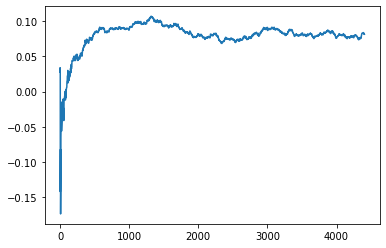

Thread: 2 iteration: 750
RAM mBackground_2 FROM: 640 --> 1792 reward: -0.14297496237499996
Thread: 4 iteration: 734
RAM mDiffFit_215 FROM: 1344 --> 2752 reward: -0.009911416406250002
Thread: 6 iteration: 726
RAM mDiffFit_211 FROM: 704 --> 2752 reward: 0.01041935742187498
Thread: 2 iteration: 751
RAM mDiffFit_335 FROM: 2496 --> 2752 reward: 0.033013074609374984
Thread: 4 iteration: 735
RAM mDiffFit_258 FROM: 960 --> 256 reward: 0.10693484570312502
Thread: 3 iteration: 729
RAM mDiffFit_297 FROM: 576 --> 256 reward: 0.252934933203125
Thread: 5 iteration: 772
RAM mProject_44 FROM: 2176 --> 1152 reward: 0.08984985300000002
Thread: 1 iteration: 696
RAM mDiffFit_183 FROM: 2688 --> 2752 reward: 0.004565110546875008
Thread: 2 iteration: 752
RAM mDiffFit_31 FROM: 320 --> 256 reward: 0.02626561953124995
Saving ...


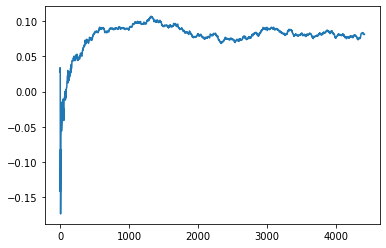

Thread: 3 iteration: 730
RAM mImgtbl_1 FROM: 1088 --> 704 reward: -0.05132720218750003
Thread: 6 iteration: 727
RAM mDiffFit_79 FROM: 1088 --> 320 reward: 0.0957603984375
Thread: 5 iteration: 773
RAM mBackground_28 FROM: 1408 --> 320 reward: 0.4337535197187499
Thread: 4 iteration: 736
RAM mDiffFit_111 FROM: 2176 --> 1984 reward: -0.009343760937499997
Thread: 2 iteration: 753
RAM mDiffFit_64 FROM: 1408 --> 448 reward: -0.0031354859375000085
Thread: 5 iteration: 774
RAM mDiffFit_371 FROM: 2816 --> 448 reward: 0.05149473515624999
Thread: 2 iteration: 754
RAM mDiffFit_249 FROM: 640 --> 448 reward: 0.004377588671875005
Thread: 5 iteration: 775
RAM mBackground_41 FROM: 512 --> 320 reward: 0.13971189024218755
Thread: 4 iteration: 737
RAM mProject_15 FROM: 960 --> 2240 reward: -0.17647295765625
Thread: 1 iteration: 697
RAM mDiffFit_23 FROM: 1792 --> 448 reward: 0.06035411562499997
Thread: 2 iteration: 755
RAM mDiffFit_128 FROM: 2752 --> 448 reward: 0.054861925390625
Thread: 4 iteration: 738
RA

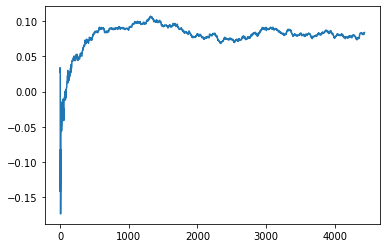

Thread: 1 iteration: 700
RAM mProject_15 FROM: 256 --> 896 reward: 0.925974064546875
Thread: 6 iteration: 728
RAM mProject_22 FROM: 2368 --> 256 reward: -1.0
Thread: 3 iteration: 731
RAM mDiffFit_254 FROM: 1536 --> 2752 reward: 0.009414092578124977
Thread: 5 iteration: 779
RAM mProject_66 FROM: 1152 --> 2752 reward: -0.001125601171874957
Thread: 2 iteration: 756
RAM mDiffFit_237 FROM: 1152 --> 2752 reward: -0.007601526953125021
Thread: 1 iteration: 701
RAM mDiffFit_12 FROM: 640 --> 2752 reward: -0.012216041015625026
Thread: 3 iteration: 732
RAM mDiffFit_139 FROM: 2368 --> 2752 reward: -0.0028307300781250586
Thread: 6 iteration: 729
RAM mBackground_75 FROM: 320 --> 768 reward: -0.32864093279687495
Saving ...


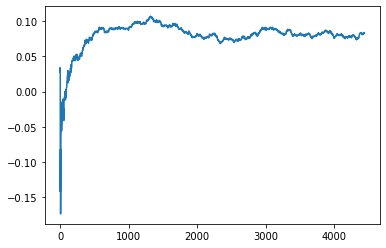

Thread: 5 iteration: 780
RAM mProject_31 FROM: 2752 --> 1024 reward: 0.0549207556171876
Thread: 4 iteration: 739
RAM mDiffFit_191 FROM: 1664 --> 2752 reward: 0.001018251953124969
Thread: 2 iteration: 757
RAM mDiffFit_414 FROM: 2048 --> 2624 reward: -0.007653650390624985
Thread: 1 iteration: 702
RAM mDiffFit_103 FROM: 2112 --> 2624 reward: -0.016622411328124982
Thread: 5 iteration: 781
RAM mDiffFit_396 FROM: 1216 --> 2752 reward: 0.01593238828124996
Saving ...


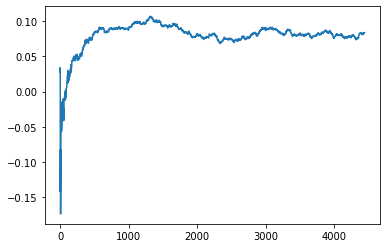

Thread: 6 iteration: 730
RAM mDiffFit_392 FROM: 1472 --> 2624 reward: -0.014979159374999985
Thread: 1 iteration: 703
RAM mDiffFit_369 FROM: 1920 --> 256 reward: 0.12732809765625003
Thread: 5 iteration: 782
RAM mDiffFit_81 FROM: 256 --> 320 reward: 0.006291681249999959
Thread: 6 iteration: 731
RAM mViewer_1 FROM: 1152 --> 640 reward: 0.19179535701562508
Saving ...


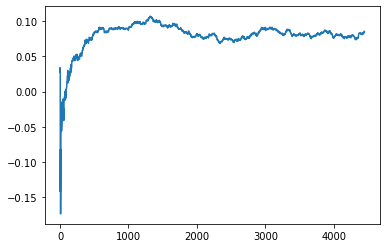

Thread: 4 iteration: 740
RAM mBackground_71 FROM: 2048 --> 704 reward: 0.11774155422656245
Thread: 1 iteration: 704
RAM mDiffFit_43 FROM: 1152 --> 256 reward: 0.14059893828124997
Thread: 6 iteration: 732
RAM mDiffFit_56 FROM: 1088 --> 256 reward: 0.337971349609375
Thread: 5 iteration: 783
RAM mProject_56 FROM: 2176 --> 1152 reward: 0.1038636174374999
Thread: 3 iteration: 733
RAM mDiffFit_262 FROM: 1792 --> 2560 reward: 0.050760485937500016
Thread: 6 iteration: 733
RAM mProject_43 FROM: 896 --> 2240 reward: -0.23749579279687505
Thread: 2 iteration: 758
RAM mDiffFit_257 FROM: 2880 --> 832 reward: 0.004273385546875001
Thread: 5 iteration: 784
RAM mDiffFit_410 FROM: 320 --> 448 reward: -0.06311719023437498
Thread: 3 iteration: 734
RAM mDiffFit_271 FROM: 2176 --> 384 reward: 0.0396145140625
Thread: 6 iteration: 734
RAM mDiffFit_193 FROM: 1536 --> 1984 reward: 0.014135442187499982
Thread: 3 iteration: 735
RAM mDiffFit_388 FROM: 1024 --> 2880 reward: 0.11163039609375001
Thread: 5 iteration: 7

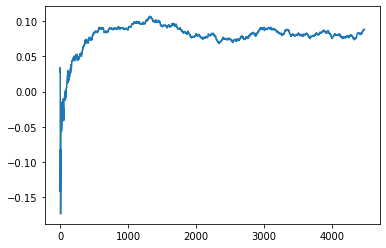

Thread: 2 iteration: 760
RAM mDiffFit_42 FROM: 768 --> 256 reward: 0.16557292031249998
Thread: 1 iteration: 708
RAM mProject_43 FROM: 1344 --> 1024 reward: 0.14040469898437494
Thread: 3 iteration: 736
RAM mBackground_15 FROM: 1088 --> 1792 reward: 0.05140077192968752
Thread: 5 iteration: 789
RAM mDiffFit_234 FROM: 1088 --> 256 reward: 0.140627588671875
Thread: 4 iteration: 745
RAM mDiffFit_363 FROM: 896 --> 256 reward: 0.04605721328124996
Thread: 2 iteration: 761
RAM mDiffFit_366 FROM: 192 --> 256 reward: -0.07316146015625
Thread: 3 iteration: 737
RAM mDiffFit_183 FROM: 2048 --> 256 reward: 0.44826039843749993
Thread: 1 iteration: 709
RAM mDiffFit_166 FROM: 1472 --> 2560 reward: 0.025739645312500004
Saving ...


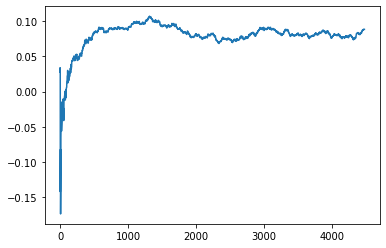

Thread: 5 iteration: 790
RAM mProject_57 FROM: 2880 --> 1152 reward: -0.0161736607265625
Thread: 6 iteration: 737
RAM mDiffFit_75 FROM: 832 --> 256 reward: 0.09122393828125003
Thread: 4 iteration: 746
RAM mBackground_76 FROM: 1536 --> 1792 reward: -0.0026964426562499874
Thread: 2 iteration: 762
RAM mDiffFit_230 FROM: 704 --> 256 reward: 0.128898429296875
Thread: 3 iteration: 738
RAM mDiffFit_408 FROM: 832 --> 256 reward: 0.10454685859375004
Saving ...


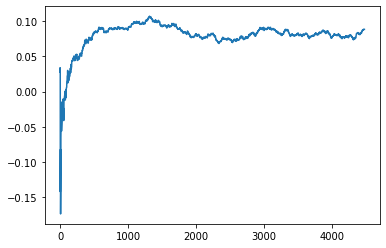

Thread: 1 iteration: 710
RAM mDiffFit_250 FROM: 2240 --> 256 reward: 0.001031151562499999
Thread: 5 iteration: 791
RAM mDiffFit_325 FROM: 896 --> 448 reward: 0.03399477890625001
Thread: 4 iteration: 747
RAM mDiffFit_406 FROM: 1792 --> 256 reward: 0.17846871718750001
Thread: 6 iteration: 738
RAM mDiffFit_364 FROM: 2176 --> 256 reward: 0.03242694843750001
Thread: 1 iteration: 711
RAM mDiffFit_46 FROM: 1408 --> 256 reward: 0.1154895578125
Thread: 3 iteration: 739
RAM mDiffFit_268 FROM: 1856 --> 256 reward: 0.15194787656249997
Thread: 4 iteration: 748
RAM mDiffFit_328 FROM: 896 --> 256 reward: 0.28521349609375
Thread: 5 iteration: 792
RAM mDiffFit_307 FROM: 320 --> 256 reward: 0.004648429296875006
Thread: 6 iteration: 739
RAM mDiffFit_257 FROM: 2752 --> 832 reward: -0.0015417249999999903
Thread: 4 iteration: 749
RAM mBackground_45 FROM: 576 --> 1792 reward: -0.244746144265625
Thread: 5 iteration: 793
RAM mDiffFit_99 FROM: 3008 --> 1984 reward: 0.006502588671874997
Saving ...


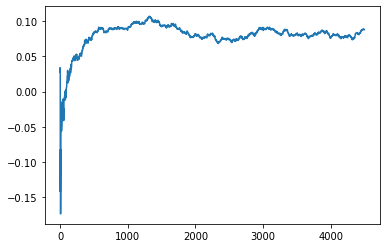

Thread: 4 iteration: 750
RAM mBackground_5 FROM: 320 --> 1792 reward: -0.47283197716406256
Thread: 5 iteration: 794
RAM mBackground_51 FROM: 2688 --> 704 reward: 0.09452819537500001
Saving ...


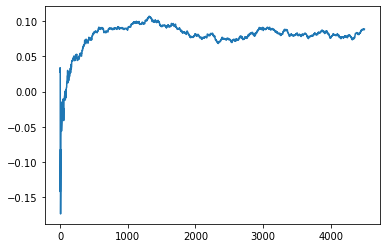

Thread: 6 iteration: 740
RAM mProject_68 FROM: 2176 --> 256 reward: -1.0
Thread: 2 iteration: 763
RAM mBackground_28 FROM: 2816 --> 1088 reward: -0.014505934101562524
Thread: 6 iteration: 741
RAM mBackground_46 FROM: 2944 --> 704 reward: 0.08971084457031242
Thread: 5 iteration: 795
RAM mProject_76 FROM: 1984 --> 1152 reward: 0.12790305478124991
Saving ...


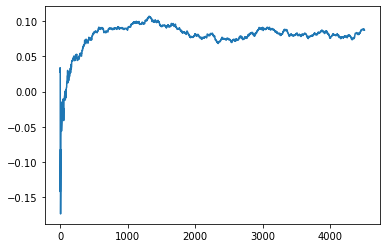

Thread: 3 iteration: 740
RAM mBackground_26 FROM: 1856 --> 704 reward: 0.14394917877343752
Thread: 2 iteration: 764
RAM mProject_22 FROM: 640 --> 896 reward: 0.9172637451562501
Thread: 1 iteration: 712
RAM mDiffFit_328 FROM: 2560 --> 1088 reward: 0.05146871718750001
Thread: 6 iteration: 742
RAM mProject_62 FROM: 1600 --> 2112 reward: 0.022650115500000068
Thread: 4 iteration: 751
RAM mDiffFit_7 FROM: 768 --> 1088 reward: -0.0060755089843749985
Thread: 5 iteration: 796
RAM mDiffFit_9 FROM: 1600 --> 1088 reward: -0.024354203125000005
Thread: 3 iteration: 741
RAM mDiffFit_94 FROM: 1152 --> 320 reward: 0.19416663749999996
Thread: 2 iteration: 765
RAM mDiffFit_381 FROM: 2944 --> 1984 reward: -0.0032552210937500207
Thread: 1 iteration: 713
RAM mDiffFit_339 FROM: 640 --> 1088 reward: -0.012539048828124986
Thread: 6 iteration: 743
RAM mDiffFit_104 FROM: 128 --> 320 reward: -0.359270840625
Thread: 3 iteration: 742
RAM mDiffFit_309 FROM: 448 --> 256 reward: -0.13019800781250002
Thread: 2 iteratio

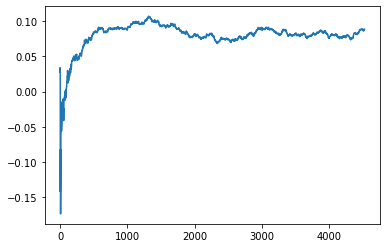

Thread: 2 iteration: 770
RAM mProject_44 FROM: 384 --> 896 reward: 0.912020305359375
Thread: 4 iteration: 752
RAM mDiffFit_219 FROM: 192 --> 320 reward: -0.057575508984375016
Thread: 5 iteration: 799
RAM mDiffFit_396 FROM: 1536 --> 256 reward: -0.08465641406250002
Thread: 2 iteration: 771
RAM mDiffFit_299 FROM: 1856 --> 2560 reward: -0.062484424218750015
Thread: 4 iteration: 753
RAM mProject_66 FROM: 704 --> 896 reward: 0.93054250434375
Thread: 6 iteration: 744
RAM mProject_82 FROM: 2752 --> 1152 reward: 0.00022560117187505612
Thread: 1 iteration: 715
RAM mDiffFit_221 FROM: 192 --> 1984 reward: -0.471544269921875
Thread: 2 iteration: 772
RAM mDiffFit_5 FROM: 2624 --> 2560 reward: -0.06781778671875002
Thread: 6 iteration: 745
RAM mDiffFit_337 FROM: 1088 --> 1984 reward: -0.04257809765625002
Thread: 1 iteration: 716
RAM mBackground_21 FROM: 576 --> 192 reward: 0.6834514180078125
Saving ...


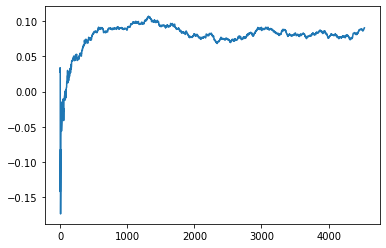

Thread: 5 iteration: 800
RAM mDiffFit_221 FROM: 1536 --> 448 reward: 0.0647187171875
Thread: 4 iteration: 754
RAM mDiffFit_137 FROM: 256 --> 448 reward: -0.11848438046874998
Thread: 6 iteration: 746
RAM mDiffFit_250 FROM: 1344 --> 448 reward: 0.051554668359374986
Thread: 1 iteration: 717
RAM mProject_66 FROM: 1856 --> 256 reward: -1.0
Thread: 3 iteration: 746
RAM mDiffFit_135 FROM: 320 --> 1088 reward: -0.09522915937500001
Thread: 4 iteration: 755
RAM mDiffFit_291 FROM: 1280 --> 2752 reward: 0.01791154765624997
Thread: 1 iteration: 718
RAM mDiffFit_414 FROM: 320 --> 2752 reward: -0.09983327500000003
Thread: 3 iteration: 747
RAM mDiffFit_94 FROM: 1600 --> 2112 reward: -0.0006223675781250396
Thread: 6 iteration: 747
RAM mBackground_52 FROM: 896 --> 192 reward: 0.784709701609375
Thread: 5 iteration: 801
RAM mBackground_2 FROM: 1728 --> 704 reward: 0.13424508692187495
Thread: 4 iteration: 756
RAM mProject_62 FROM: 1984 --> 1152 reward: 0.13699493437499996
Thread: 2 iteration: 773
RAM mDiff

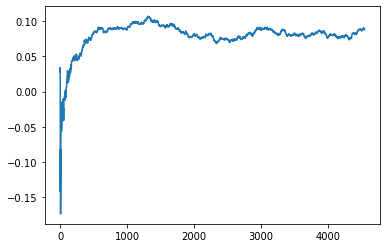

Thread: 1 iteration: 720
RAM mDiffFit_88 FROM: 1280 --> 320 reward: 0.11986969140625
Thread: 5 iteration: 802
RAM mBackground_11 FROM: 128 --> 704 reward: -1.3340996393359374
Thread: 6 iteration: 749
RAM mProject_23 FROM: 1344 --> 2752 reward: 0.05690048519531249
Thread: 2 iteration: 774
RAM mDiffFit_127 FROM: 2048 --> 448 reward: -0.013164180078125021
Thread: 3 iteration: 749
RAM mDiffFit_69 FROM: 3008 --> 448 reward: 0.026012943359375023
Thread: 1 iteration: 721
RAM mDiffFit_12 FROM: 448 --> 448 reward: 0.007815110546875014
Thread: 2 iteration: 775
RAM mDiffFit_113 FROM: 2496 --> 448 reward: 0.12678637265624998
Saving ...


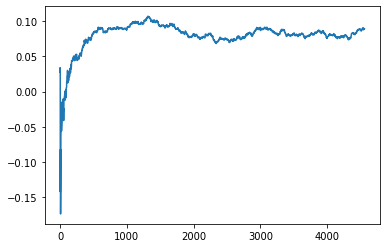

Thread: 3 iteration: 750
RAM mBackground_16 FROM: 2560 --> 704 reward: 0.11483901660156243
Thread: 1 iteration: 722
RAM mDiffFit_64 FROM: 2304 --> 448 reward: 0.051617146484375015
Thread: 2 iteration: 776
RAM mDiffFit_180 FROM: 2880 --> 448 reward: 0.04330980195312497
Thread: 1 iteration: 723
RAM mProject_8 FROM: 1152 --> 1152 reward: -0.016900327265624904
Thread: 4 iteration: 758
RAM mProject_12 FROM: 448 --> 2560 reward: 0.7454146359375
Saving ...


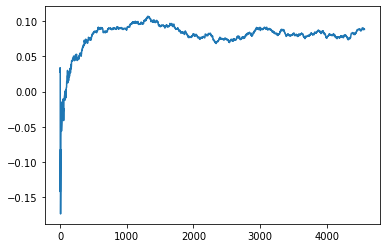

Thread: 6 iteration: 750
RAM mProject_82 FROM: 2176 --> 1152 reward: 0.09374142107812487
Thread: 5 iteration: 803
RAM mDiffFit_358 FROM: 1664 --> 448 reward: 0.050723938281250006
Thread: 4 iteration: 759
RAM mBackground_88 FROM: 1024 --> 192 reward: 0.6696040295781249
Thread: 3 iteration: 751
RAM mDiffFit_295 FROM: 2112 --> 448 reward: -0.028523560546874997
Thread: 6 iteration: 751
RAM mDiffFit_422 FROM: 2112 --> 448 reward: 0.07812495625
Thread: 5 iteration: 804
RAM mDiffFit_205 FROM: 640 --> 448 reward: -0.01886982265625
Saving ...


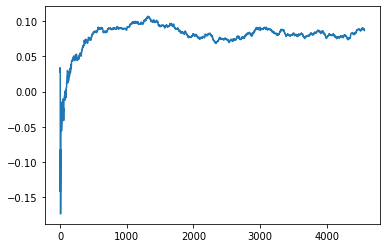

Thread: 4 iteration: 760
RAM mBackground_63 FROM: 1728 --> 192 reward: 1.1377330228359375
Thread: 1 iteration: 724
RAM mDiffFit_398 FROM: 2688 --> 2944 reward: 0.10898451171875001
Thread: 6 iteration: 752
RAM mBackground_30 FROM: 2240 --> 192 reward: 0.7385002854140627
Thread: 3 iteration: 752
RAM mDiffFit_384 FROM: 1408 --> 960 reward: 0.09219015429687503
Thread: 5 iteration: 805
RAM mDiffFit_216 FROM: 2816 --> 960 reward: 0.042195287890624995
Thread: 6 iteration: 753
RAM mDiffFit_112 FROM: 640 --> 960 reward: 0.05855475585937502
Thread: 5 iteration: 806
RAM mProject_36 FROM: 192 --> 192 reward: -1.0
Thread: 2 iteration: 777
RAM mDiffFit_332 FROM: 384 --> 960 reward: -0.016890575781250035
Thread: 6 iteration: 754
RAM mDiffFit_75 FROM: 2112 --> 960 reward: 0.027398429296875
Thread: 6 iteration: 755
RAM mDiffFit_282 FROM: 2432 --> 960 reward: -0.09408349374999997
Thread: 5 iteration: 807
RAM mDiffFit_252 FROM: 1664 --> 960 reward: 0.041015619531250026
Thread: 6 iteration: 756
RAM mProje

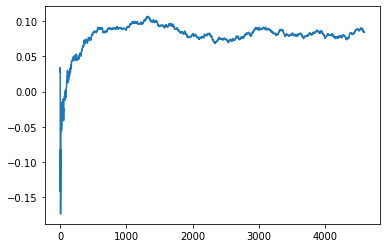

Thread: 5 iteration: 810
RAM mDiffFit_256 FROM: 128 --> 448 reward: -0.482341172265625
Thread: 4 iteration: 762
RAM mBackground_49 FROM: 1536 --> 192 reward: 0.7018069771640625
Thread: 6 iteration: 758
RAM mDiffFit_108 FROM: 1792 --> 2560 reward: 0.009406282812500005
Thread: 2 iteration: 779
RAM mDiffFit_154 FROM: 576 --> 1984 reward: -0.043679668359375014
Thread: 1 iteration: 728
RAM mBackground_49 FROM: 2624 --> 960 reward: 0.016006180585937516
Thread: 3 iteration: 755
RAM mDiffFit_76 FROM: 2240 --> 1984 reward: -0.003968760937500008
Thread: 4 iteration: 763
RAM mDiffFit_363 FROM: 2944 --> 1984 reward: 0.0043697789062499895
Thread: 6 iteration: 759
RAM mDiffFit_108 FROM: 960 --> 2112 reward: -0.028195287890624993
Saving ...


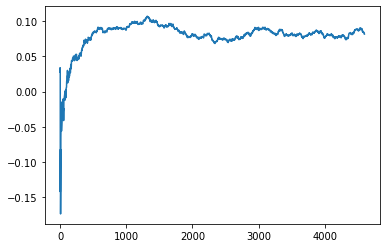

Thread: 2 iteration: 780
RAM mDiffFit_106 FROM: 832 --> 2112 reward: -0.10425263242187502
Thread: 1 iteration: 729
RAM mDiffFit_226 FROM: 2240 --> 2112 reward: 0.07613289726562499
Thread: 3 iteration: 756
RAM mDiffFit_26 FROM: 2688 --> 2112 reward: 0.016734380468750015
Thread: 4 iteration: 764
RAM mDiffFit_144 FROM: 1024 --> 2112 reward: -0.03100780976562502
Saving ...


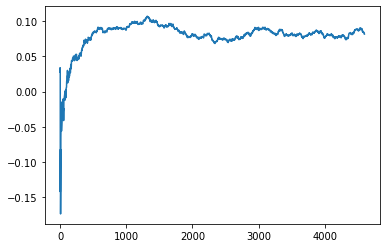

Thread: 6 iteration: 760
RAM mDiffFit_62 FROM: 1920 --> 2112 reward: 0.00460157070312499
Thread: 2 iteration: 781
RAM mDiffFit_106 FROM: 1152 --> 2112 reward: 0.014601614453125019
Thread: 4 iteration: 765
RAM mDiffFit_92 FROM: 832 --> 2112 reward: -0.0422395578125
Thread: 3 iteration: 757
RAM mDiffFit_345 FROM: 128 --> 320 reward: -1.0486719460937497
Saving ...


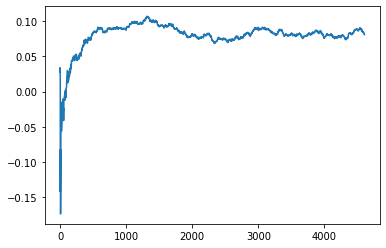

Thread: 1 iteration: 730
RAM mDiffFit_317 FROM: 2752 --> 832 reward: 0.016757766015625015
Thread: 3 iteration: 758
RAM mProject_59 FROM: 768 --> 192 reward: -1.0
Thread: 5 iteration: 811
RAM mBackground_13 FROM: 1088 --> 320 reward: 0.3012015295781249
Thread: 4 iteration: 766
RAM mViewer_1 FROM: 2432 --> 1408 reward: -0.06210544364062501
Thread: 4 iteration: 767
RAM mBackground_49 FROM: 256 --> 192 reward: 0.4864039556328124
Thread: 1 iteration: 731
RAM mDiffFit_244 FROM: 2240 --> 640 reward: 0.11156769921875001
Thread: 4 iteration: 768
RAM mProject_36 FROM: 1472 --> 1152 reward: 0.10221796596093752
Thread: 6 iteration: 761
RAM mBackground_31 FROM: 192 --> 192 reward: 0.23389988842968767
Thread: 3 iteration: 759
RAM mBackground_48 FROM: 576 --> 192 reward: 0.8043553360156248
Thread: 5 iteration: 812
RAM mDiffFit_246 FROM: 192 --> 448 reward: -0.16172134960937498
Thread: 1 iteration: 732
RAM mDiffFit_418 FROM: 2880 --> 640 reward: 0.071799447265625
Thread: 4 iteration: 769
RAM mDiffFit_

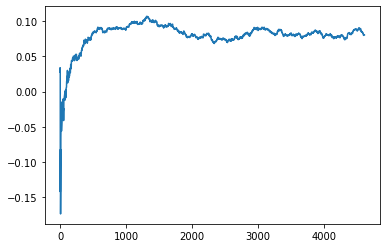

Thread: 3 iteration: 760
RAM mDiffFit_118 FROM: 512 --> 2880 reward: -0.04344783281249999
Thread: 1 iteration: 733
RAM mProject_22 FROM: 704 --> 896 reward: 0.9268515645468751
Thread: 2 iteration: 782
RAM mDiffFit_62 FROM: 2432 --> 384 reward: 0.012864470312499987
Saving ...


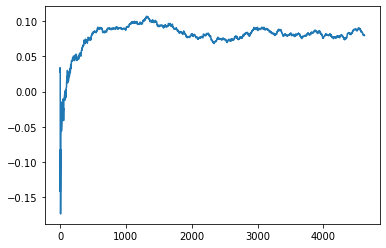

Thread: 4 iteration: 770
RAM mBackground_48 FROM: 256 --> 192 reward: 0.3621563310859376
Thread: 5 iteration: 813
RAM mDiffFit_54 FROM: 576 --> 2112 reward: -0.02690619531249999
Thread: 2 iteration: 783
RAM mBackground_63 FROM: 2752 --> 1408 reward: -0.34682239234375
Thread: 3 iteration: 761
RAM mBackground_27 FROM: 2688 --> 1408 reward: -0.10501874546875001
Thread: 1 iteration: 734
RAM mDiffFit_283 FROM: 1408 --> 2112 reward: -0.06792712343750001
Thread: 5 iteration: 814
RAM mDiffFit_196 FROM: 128 --> 320 reward: -0.8416849769531249
Thread: 4 iteration: 771
RAM mDiffFit_218 FROM: 512 --> 2112 reward: -0.046799447265625016
Thread: 2 iteration: 784
RAM mBackground_44 FROM: 896 --> 192 reward: 0.8029421393359375
Thread: 6 iteration: 763
RAM mBackground_38 FROM: 2048 --> 1408 reward: 0.0012227607656249708
Thread: 3 iteration: 762
RAM mDiffFit_14 FROM: 1088 --> 256 reward: 0.15825
Thread: 1 iteration: 735
RAM mDiffFit_116 FROM: 1408 --> 256 reward: 0.16488017734375
Thread: 5 iteration: 815

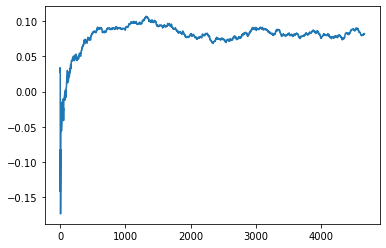

Thread: 6 iteration: 770
RAM mDiffFit_416 FROM: 704 --> 192 reward: 0.3758151105468751
Thread: 2 iteration: 789
RAM mProject_19 FROM: 1664 --> 1024 reward: 0.19073435596874988
Saving ...


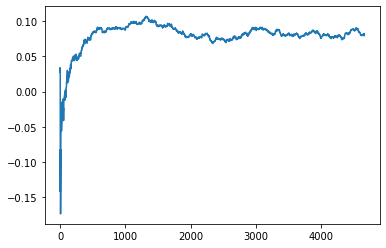

Thread: 5 iteration: 820
RAM mProject_70 FROM: 256 --> 192 reward: -1.0
Thread: 3 iteration: 766
RAM mDiffFit_323 FROM: 2112 --> 448 reward: 0.17084889453125002
Thread: 6 iteration: 771
RAM mDiffFit_142 FROM: 2496 --> 448 reward: 0.065580686328125
Thread: 5 iteration: 821
RAM mDiffFit_110 FROM: 2624 --> 448 reward: -0.009898560546875018
Thread: 3 iteration: 767
RAM mBackground_73 FROM: 1216 --> 192 reward: 0.732751318109375
Thread: 3 iteration: 768
RAM mProject_9 FROM: 2048 --> 256 reward: -1.0
Thread: 4 iteration: 775
RAM mProject_67 FROM: 2880 --> 1280 reward: -0.06193162406250012
Thread: 6 iteration: 772
RAM mProject_4 FROM: 512 --> 192 reward: -1.0
Saving ...


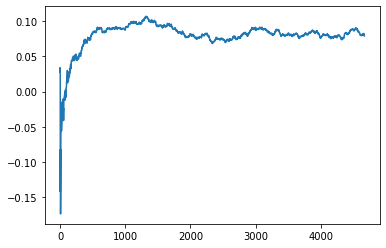

Thread: 1 iteration: 740
RAM mDiffFit_198 FROM: 1792 --> 192 reward: 0.52587504375
Thread: 4 iteration: 776
RAM mProject_39 FROM: 256 --> 192 reward: -1.0
Saving ...


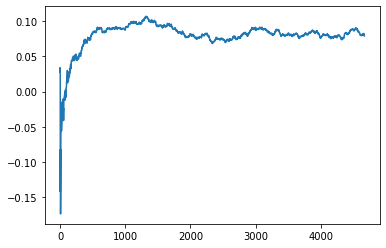

Thread: 2 iteration: 790
RAM mBackground_1 FROM: 1408 --> 192 reward: 0.7362786689140627
Thread: 3 iteration: 769
RAM mDiffFit_296 FROM: 128 --> 192 reward: -0.537395884375
Thread: 2 iteration: 791
RAM mProject_10 FROM: 192 --> 192 reward: -1.0
Thread: 5 iteration: 822
RAM mDiffFit_309 FROM: 1920 --> 192 reward: 0.6639375656250001
Saving ...


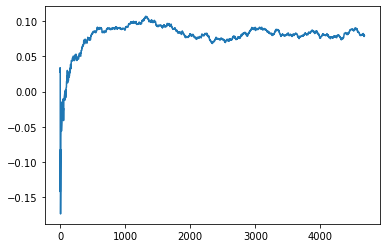

Thread: 3 iteration: 770
RAM mDiffFit_35 FROM: 1088 --> 192 reward: 0.39261460156249994
Thread: 5 iteration: 823
RAM mBackground_81 FROM: 384 --> 192 reward: 0.38480294758593747
Thread: 2 iteration: 792
RAM mDiffFit_194 FROM: 1472 --> 192 reward: 0.5875651542968751
Thread: 3 iteration: 771
RAM mDiffFit_41 FROM: 1920 --> 192 reward: 0.21475776601562496
Thread: 5 iteration: 824
RAM mProject_82 FROM: 3008 --> 1280 reward: -0.12308108765625003
Thread: 4 iteration: 777
RAM mDiffFit_64 FROM: 1536 --> 448 reward: 0.05527601796874998
Thread: 2 iteration: 793
RAM mDiffFit_293 FROM: 2432 --> 1984 reward: -0.013385442187500013
Thread: 5 iteration: 825
RAM mProject_90 FROM: 128 --> 192 reward: -1.0
Thread: 6 iteration: 773
RAM mDiffFit_256 FROM: 1792 --> 448 reward: 0.064429668359375
Thread: 3 iteration: 772
RAM mProject_83 FROM: 320 --> 192 reward: -1.0
Thread: 1 iteration: 741
RAM mBackground_41 FROM: 2496 --> 704 reward: 0.12865950181249997
Thread: 4 iteration: 778
RAM mViewer_1 FROM: 896 --> 1

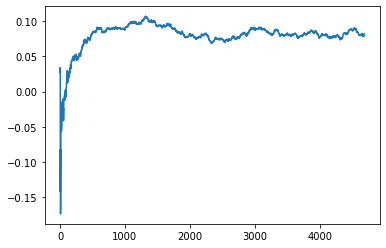

Thread: 4 iteration: 780
RAM mDiffFit_72 FROM: 1536 --> 384 reward: 0.07882809765625
Thread: 6 iteration: 776
RAM mBgModel_2 FROM: 2880 --> 320 reward: 0.5295435421875
Thread: 2 iteration: 794
RAM mBackground_59 FROM: 128 --> 2560 reward: 0.31325537625
Thread: 4 iteration: 781
RAM mProject_40 FROM: 2816 --> 2240 reward: -0.1038892675781249
Thread: 5 iteration: 827
RAM mDiffFit_28 FROM: 2816 --> 384 reward: -0.009250175000000034
Thread: 6 iteration: 777
RAM mDiffFit_326 FROM: 640 --> 2752 reward: -0.10364842929687501
Thread: 5 iteration: 828
RAM mDiffFit_130 FROM: 2752 --> 384 reward: 0.18828115156250003
Thread: 4 iteration: 782
RAM mProject_89 FROM: 1984 --> 256 reward: -1.0
Thread: 3 iteration: 773
RAM mDiffFit_280 FROM: 128 --> 320 reward: -0.4254453316406249
Thread: 6 iteration: 778
RAM mDiffFit_119 FROM: 2944 --> 384 reward: -0.07840654531250002
Thread: 5 iteration: 829
RAM mProject_65 FROM: 1152 --> 256 reward: -1.0
Thread: 1 iteration: 742
RAM mDiffFit_314 FROM: 1216 --> 2880 rew

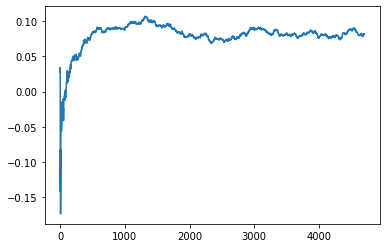

Thread: 5 iteration: 830
RAM mDiffFit_143 FROM: 1536 --> 256 reward: 0.2321770796875
Thread: 6 iteration: 779
RAM mDiffFit_255 FROM: 2240 --> 2880 reward: -0.03604690234374999
Thread: 4 iteration: 783
RAM mProject_37 FROM: 1664 --> 1024 reward: 0.213188439796875
Thread: 2 iteration: 795
RAM mDiffFit_7 FROM: 2176 --> 2560 reward: -0.053802123437500016
Saving ...


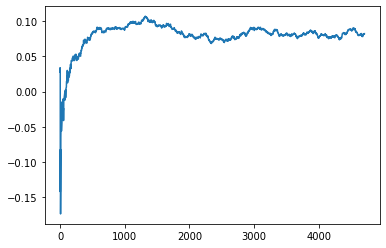

Thread: 6 iteration: 780
RAM mDiffFit_410 FROM: 832 --> 320 reward: 0.035468717187499985
Thread: 1 iteration: 743
RAM mDiffFit_362 FROM: 1856 --> 2560 reward: 0.042143295703125014
Thread: 4 iteration: 784
RAM mDiffFit_384 FROM: 832 --> 320 reward: 0.081804668359375
Thread: 5 iteration: 831
RAM mProject_6 FROM: 1344 --> 2752 reward: 0.0659708045859375
Thread: 3 iteration: 774
RAM mDiffFit_32 FROM: 2944 --> 2560 reward: 0.011526061718750008
Thread: 2 iteration: 796
RAM mDiffFit_367 FROM: 2880 --> 2560 reward: -0.03796880468750003
Thread: 1 iteration: 744
RAM mDiffFit_235 FROM: 448 --> 2560 reward: -0.039208275000000015
Thread: 5 iteration: 832
RAM mDiffFit_223 FROM: 2048 --> 2560 reward: 0.016333362500000007
Thread: 3 iteration: 775
RAM mConcatFit_3 FROM: 2816 --> 1408 reward: -0.04666679499999998
Thread: 4 iteration: 785
RAM mDiffFit_126 FROM: 1216 --> 320 reward: 0.244924447265625
Thread: 6 iteration: 781
RAM mDiffFit_338 FROM: 1152 --> 2560 reward: -0.006802035937499996
Thread: 2 iter

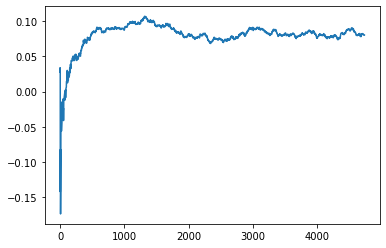

Thread: 2 iteration: 800
RAM mDiffFit_340 FROM: 2304 --> 2112 reward: 0.00028123906249998346
Thread: 6 iteration: 785
RAM mBgModel_1 FROM: 2816 --> 320 reward: 0.56162167484375
Thread: 3 iteration: 777
RAM mBackground_38 FROM: 1856 --> 768 reward: 0.09884396730468743
Thread: 5 iteration: 836
RAM mBackground_77 FROM: 2496 --> 1408 reward: -0.030892911265624996
Thread: 4 iteration: 789
RAM mDiffFit_96 FROM: 960 --> 1152 reward: 0.04511723398437499
Thread: 2 iteration: 801
RAM mDiffFit_407 FROM: 832 --> 320 reward: 0.142585951171875
Thread: 1 iteration: 747
RAM mDiffFit_299 FROM: 448 --> 320 reward: -0.04717712343749996
Thread: 6 iteration: 786
RAM mImgtbl_2 FROM: 2176 --> 1408 reward: -0.042883467499999994
Thread: 3 iteration: 778
RAM mDiffFit_378 FROM: 3008 --> 256 reward: 0.2991588277343751
Saving ...


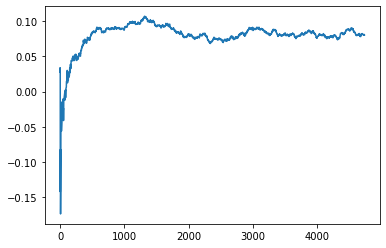

Thread: 4 iteration: 790
RAM mDiffFit_293 FROM: 320 --> 256 reward: 0.018765619531250048
Thread: 6 iteration: 787
RAM mDiffFit_142 FROM: 1536 --> 256 reward: 0.173229115625
Thread: 1 iteration: 748
RAM mDiffFit_230 FROM: 2688 --> 256 reward: 0.03237482500000003
Thread: 2 iteration: 802
RAM mDiffFit_47 FROM: 832 --> 256 reward: 0.239971349609375
Thread: 4 iteration: 791
RAM mDiffFit_196 FROM: 2880 --> 832 reward: -0.0012761054687500037
Thread: 4 iteration: 792
RAM mDiffFit_288 FROM: 768 --> 256 reward: 0.21691668124999997
Thread: 1 iteration: 749
RAM mBackground_47 FROM: 2496 --> 704 reward: 0.098859588734375
Thread: 2 iteration: 803
RAM mProject_58 FROM: 1280 --> 1024 reward: 0.11298937696874992
Thread: 5 iteration: 837
RAM mDiffFit_132 FROM: 896 --> 2112 reward: 0.066424578515625
Thread: 2 iteration: 804
RAM mDiffFit_344 FROM: 192 --> 256 reward: -0.22387763242187503
Thread: 4 iteration: 793
RAM mDiffFit_313 FROM: 2304 --> 384 reward: 0.17982805390624998
Thread: 5 iteration: 838
RAM m

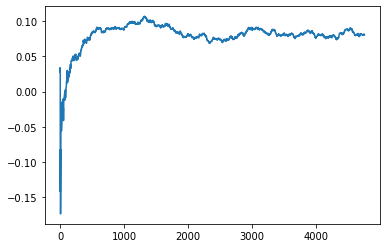

Thread: 1 iteration: 750
RAM mDiffFit_70 FROM: 128 --> 1984 reward: -0.7555729203125
Thread: 5 iteration: 839
RAM mDiffFit_214 FROM: 448 --> 2112 reward: -0.03505462460937501
Saving ...


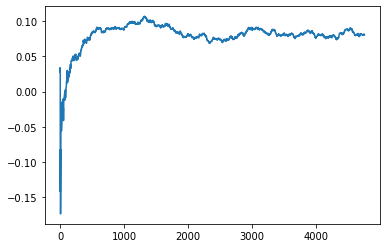

Thread: 3 iteration: 780
RAM mDiffFit_322 FROM: 2304 --> 384 reward: 0.07460933671875003
Thread: 4 iteration: 795
RAM mDiffFit_319 FROM: 512 --> 320 reward: -0.05922661445312505
Thread: 6 iteration: 789
RAM mDiffFit_234 FROM: 1408 --> 192 reward: 0.35947915937499997
Thread: 2 iteration: 806
RAM mDiffFit_228 FROM: 2368 --> 1984 reward: -0.038924534765625005
Thread: 1 iteration: 751
RAM mDiffFit_412 FROM: 2624 --> 1984 reward: 0.014955730078124972
Thread: 4 iteration: 796
RAM mDiffFit_166 FROM: 1920 --> 192 reward: 0.29152342929687497
Saving ...


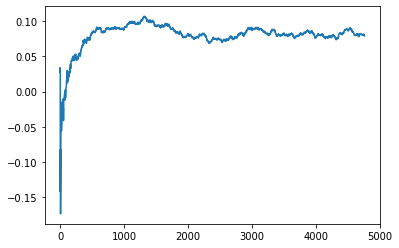

Thread: 5 iteration: 840
RAM mDiffFit_193 FROM: 448 --> 192 reward: 0.3639583624999999
Thread: 3 iteration: 781
RAM mDiffFit_199 FROM: 1536 --> 192 reward: 0.48947657070312506
Saving ...


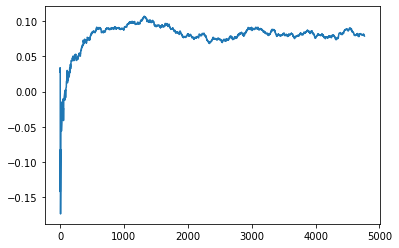

Thread: 6 iteration: 790
RAM mDiffFit_324 FROM: 2368 --> 192 reward: 0.378398429296875
Thread: 2 iteration: 807
RAM mDiffFit_330 FROM: 2496 --> 192 reward: 0.26060933671875003
Thread: 1 iteration: 752
RAM mBackground_9 FROM: 2432 --> 1408 reward: -0.0029787195156250096
Thread: 5 iteration: 841
RAM mDiffFit_360 FROM: 2432 --> 192 reward: 0.31827075312499997
Thread: 4 iteration: 797
RAM mDiffFit_105 FROM: 2176 --> 192 reward: 0.3958645578125
Thread: 6 iteration: 791
RAM mDiffFit_65 FROM: 448 --> 192 reward: 0.18085157070312502
Thread: 2 iteration: 808
RAM mBackground_50 FROM: 1216 --> 192 reward: 0.81975021146875
Thread: 3 iteration: 782
RAM mBackground_47 FROM: 2560 --> 1408 reward: -0.008774776859375041
Thread: 6 iteration: 792
RAM mBackground_17 FROM: 2048 --> 1408 reward: 0.014037673843750017
Thread: 2 iteration: 809
RAM mDiffFit_340 FROM: 1408 --> 192 reward: 0.227341128515625
Thread: 4 iteration: 798
RAM mDiffFit_162 FROM: 2816 --> 448 reward: 0.024442611718749983
Thread: 6 iterati

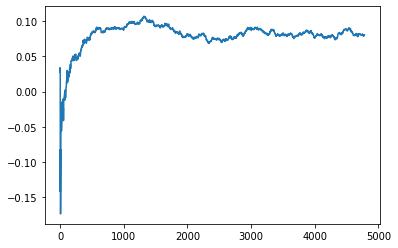

Thread: 2 iteration: 810
RAM mDiffFit_326 FROM: 1536 --> 448 reward: 0.19293488945312498
Thread: 4 iteration: 799
RAM mProject_72 FROM: 1728 --> 2112 reward: 0.023633529046875056
Thread: 1 iteration: 753
RAM mBackground_60 FROM: 2304 --> 1408 reward: 0.006794837828124972
Saving ...


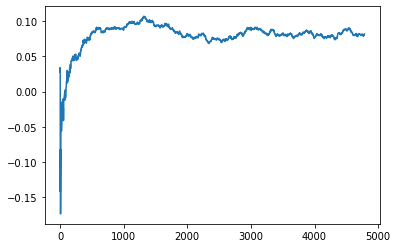

Thread: 4 iteration: 800
RAM mDiffFit_146 FROM: 2048 --> 192 reward: 0.204085907421875
Thread: 1 iteration: 754
RAM mBackground_66 FROM: 1088 --> 192 reward: 0.6712658082499998
Thread: 6 iteration: 794
RAM mDiffFit_227 FROM: 1216 --> 192 reward: 0.24705207968749998
Thread: 4 iteration: 801
RAM mDiffFit_357 FROM: 1728 --> 192 reward: 0.230914048828125
Thread: 1 iteration: 755
RAM mProject_32 FROM: 1152 --> 2752 reward: -0.009047022679687444
Thread: 5 iteration: 843
RAM mProject_14 FROM: 1792 --> 2112 reward: 0.05545417570312503
Thread: 2 iteration: 811
RAM mProject_41 FROM: 2368 --> 256 reward: -1.0
Thread: 3 iteration: 783
RAM mDiffFit_333 FROM: 896 --> 192 reward: 0.262179712109375
Thread: 4 iteration: 802
RAM mBackground_51 FROM: 1984 --> 192 reward: 0.807132337828125
Thread: 6 iteration: 795
RAM mDiffFit_68 FROM: 2752 --> 192 reward: 0.18517181484375
Thread: 2 iteration: 812
RAM mDiffFit_191 FROM: 896 --> 192 reward: 0.29220831875
Thread: 5 iteration: 844
RAM mDiffFit_422 FROM: 832 

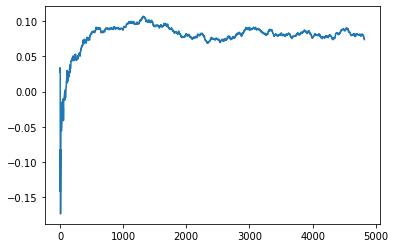

Thread: 5 iteration: 850
RAM mViewer_2 FROM: 1344 --> 640 reward: 0.081087133359375
Thread: 4 iteration: 808
RAM mProject_20 FROM: 1216 --> 1152 reward: 0.02793000262499994
Saving ...


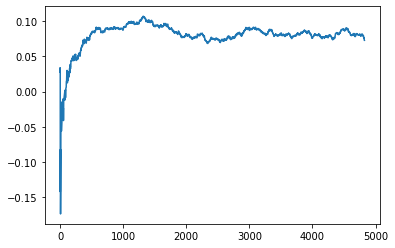

Thread: 3 iteration: 790
RAM mBackground_1 FROM: 1664 --> 704 reward: 0.13858987545312504
Thread: 4 iteration: 809
RAM mDiffFit_115 FROM: 2560 --> 640 reward: -0.004015707031250013
Thread: 3 iteration: 791
RAM mProject_71 FROM: 704 --> 896 reward: 0.93090250434375
Thread: 1 iteration: 757
RAM mBackground_20 FROM: 384 --> 704 reward: -0.363309739234375
Thread: 1 iteration: 758
RAM mBackground_4 FROM: 1088 --> 704 reward: 0.059660236117187376
Thread: 3 iteration: 792
RAM mProject_6 FROM: 768 --> 896 reward: 0.940490323734375
Thread: 2 iteration: 818
RAM mBackground_41 FROM: 1088 --> 704 reward: 0.01782254929687503
Thread: 3 iteration: 793
RAM mDiffFit_331 FROM: 512 --> 192 reward: 0.12938017734375
Thread: 1 iteration: 759
RAM mDiffFit_4 FROM: 1920 --> 192 reward: 0.23418747812500001
Saving ...


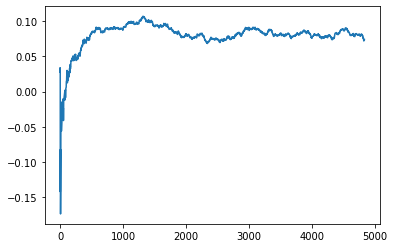

Thread: 1 iteration: 760
RAM mDiffFit_57 FROM: 1088 --> 192 reward: 0.186705686328125
Thread: 3 iteration: 794
RAM mProject_33 FROM: 448 --> 896 reward: 0.920257184953125
Thread: 5 iteration: 851
RAM mDiffFit_239 FROM: 640 --> 192 reward: 0.4101770359375
Thread: 2 iteration: 819
RAM mProject_22 FROM: 2752 --> 1152 reward: 0.001170601171874952
Saving ...


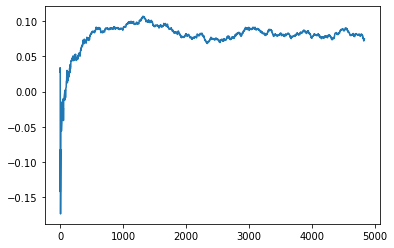

Thread: 4 iteration: 810
RAM mProject_37 FROM: 896 --> 1152 reward: -0.15236157332812492
Saving ...


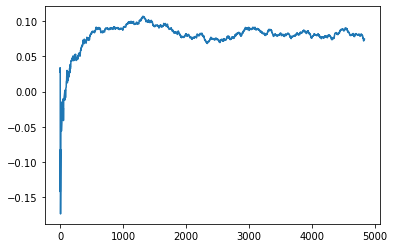

Thread: 6 iteration: 800
RAM mDiffFit_22 FROM: 512 --> 192 reward: 0.04863798710937499
Thread: 3 iteration: 795
RAM mDiffFit_355 FROM: 2112 --> 448 reward: 0.26396353984375004
Thread: 5 iteration: 852
RAM mDiffFit_89 FROM: 2624 --> 448 reward: 0.04485148320312499
Thread: 6 iteration: 801
RAM mDiffFit_144 FROM: 2496 --> 192 reward: 0.18277338554687497
Thread: 4 iteration: 811
RAM mBackground_90 FROM: 704 --> 192 reward: 0.6465251491953122
Saving ...


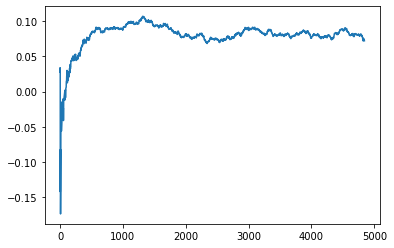

Thread: 2 iteration: 820
RAM mDiffFit_181 FROM: 2432 --> 448 reward: 0.03938013359374999
Thread: 5 iteration: 853
RAM mDiffFit_68 FROM: 896 --> 192 reward: 0.23753646015624996
Thread: 3 iteration: 796
RAM mBackground_52 FROM: 128 --> 1920 reward: 0.29152686820312507
Thread: 4 iteration: 812
RAM mDiffFit_190 FROM: 320 --> 192 reward: 0.16783595117187497
Thread: 6 iteration: 802
RAM mProject_22 FROM: 1472 --> 1152 reward: 0.10293609424218744
Thread: 1 iteration: 761
RAM mDiffFit_346 FROM: 1728 --> 2752 reward: 0.06759648085937497
Thread: 2 iteration: 821
RAM mDiffFit_22 FROM: 896 --> 2752 reward: 0.014143295703124984
Thread: 3 iteration: 797
RAM mDiffFit_81 FROM: 2752 --> 384 reward: 0.05555462460937502
Thread: 5 iteration: 854
RAM mBackground_31 FROM: 2752 --> 1408 reward: -0.028440598085937473
Thread: 4 iteration: 813
RAM mDiffFit_244 FROM: 2880 --> 640 reward: 0.069299447265625
Thread: 1 iteration: 762
RAM mConcatFit_3 FROM: 640 --> 2560 reward: -0.21651663749999997
Thread: 4 iteratio

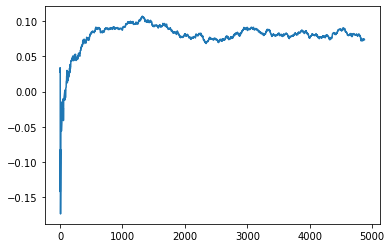

Thread: 5 iteration: 860
RAM mDiffFit_370 FROM: 640 --> 192 reward: 0.06596086367187497
Thread: 6 iteration: 806
RAM mDiffFit_187 FROM: 2880 --> 384 reward: 0.07492962460937501
Thread: 4 iteration: 816
RAM mDiffFit_139 FROM: 2816 --> 384 reward: 0.6051666812500001
Thread: 2 iteration: 827
RAM mDiffFit_192 FROM: 512 --> 320 reward: -0.15510946796874997
Thread: 1 iteration: 768
RAM mDiffFit_417 FROM: 448 --> 320 reward: -0.145059976953125
Thread: 5 iteration: 861
RAM mBackground_66 FROM: 576 --> 192 reward: 0.60458
Saving ...


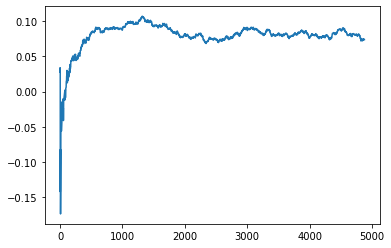

Thread: 3 iteration: 800
RAM mDiffFit_8 FROM: 1984 --> 384 reward: 0.04720827500000002
Thread: 4 iteration: 817
RAM mDiffFit_228 FROM: 1792 --> 320 reward: -0.05435696679687501
Thread: 6 iteration: 807
RAM mDiffFit_358 FROM: 1472 --> 320 reward: 0.025674403515624986
Thread: 4 iteration: 818
RAM mDiffFit_389 FROM: 576 --> 320 reward: 0.12915882773437498
Thread: 5 iteration: 862
RAM mDiffFit_96 FROM: 1664 --> 320 reward: 0.04140356289062502
Thread: 1 iteration: 769
RAM mDiffFit_150 FROM: 2560 --> 256 reward: 0.428312521875
Thread: 6 iteration: 808
RAM mDiffFit_416 FROM: 1728 --> 256 reward: 0.5434375656250001
Thread: 3 iteration: 801
RAM mDiffFit_184 FROM: 2432 --> 256 reward: 0.4908646015625
Thread: 2 iteration: 828
RAM mDiffFit_31 FROM: 640 --> 320 reward: 0.05406769921875002
Thread: 4 iteration: 819
RAM mBackground_22 FROM: 1664 --> 704 reward: 0.09673875583593751
Thread: 5 iteration: 863
RAM mDiffFit_28 FROM: 2432 --> 960 reward: 0.043023429296875
Thread: 6 iteration: 809
RAM mBackgr

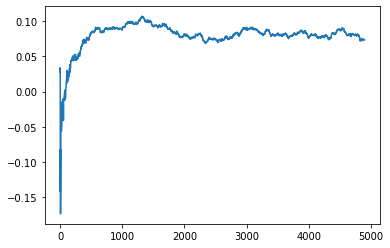

Thread: 1 iteration: 770
RAM mDiffFit_307 FROM: 448 --> 2112 reward: -0.032929624609375
Thread: 2 iteration: 829
RAM mDiffFit_354 FROM: 2112 --> 256 reward: 0.2694895578125
Thread: 3 iteration: 802
RAM mDiffFit_104 FROM: 1600 --> 2496 reward: 0.08956783046874998
Thread: 5 iteration: 864
RAM mDiffFit_408 FROM: 1344 --> 2112 reward: -0.035710951171875005
Thread: 1 iteration: 771
RAM mDiffFit_402 FROM: 2752 --> 960 reward: 0.05739842929687501
Saving ...


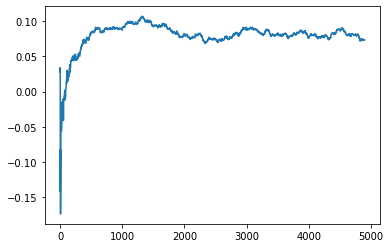

Thread: 2 iteration: 830
RAM mConcatFit_2 FROM: 2112 --> 704 reward: 0.12053745187499997
Saving ...


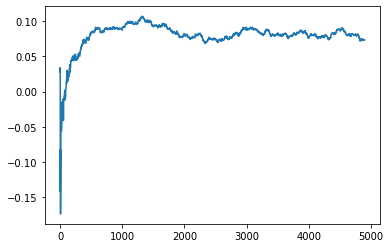

Thread: 6 iteration: 810
RAM mDiffFit_315 FROM: 1216 --> 192 reward: 0.335705730078125
Thread: 3 iteration: 803
RAM mDiffFit_272 FROM: 2048 --> 192 reward: 0.20699473515625
Thread: 1 iteration: 772
RAM mDiffFit_231 FROM: 1664 --> 256 reward: 0.04690093046875003
Thread: 2 iteration: 831
RAM mDiffFit_128 FROM: 2496 --> 192 reward: 0.24082805390625
Thread: 6 iteration: 811
RAM mDiffFit_34 FROM: 2112 --> 256 reward: 0.3720337402343749
Thread: 5 iteration: 865
RAM mDiffFit_365 FROM: 2304 --> 192 reward: 0.31100776601562496
Thread: 3 iteration: 804
RAM mProject_77 FROM: 1344 --> 1024 reward: 0.12998390575781238
Saving ...


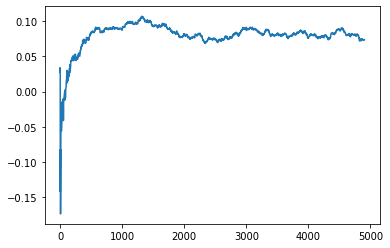

Thread: 4 iteration: 820
RAM mBackground_80 FROM: 320 --> 1408 reward: -0.3930177361171876
Thread: 3 iteration: 805
RAM mDiffFit_209 FROM: 896 --> 256 reward: 0.13108331875
Thread: 5 iteration: 866
RAM mDiffFit_77 FROM: 1216 --> 256 reward: 0.21679685859374997
Thread: 1 iteration: 773
RAM mDiffFit_94 FROM: 192 --> 320 reward: -0.22691146015625002
Thread: 6 iteration: 812
RAM mDiffFit_373 FROM: 2304 --> 1984 reward: -0.117211082421875
Thread: 2 iteration: 832
RAM mDiffFit_355 FROM: 320 --> 320 reward: 0.013778650390624952
Thread: 4 iteration: 821
RAM mDiffFit_192 FROM: 2368 --> 1984 reward: -0.0055781414062500145
Thread: 3 iteration: 806
RAM mDiffFit_87 FROM: 1024 --> 1984 reward: -0.01895050898437501
Thread: 1 iteration: 774
RAM mDiffFit_30 FROM: 896 --> 1984 reward: -0.06053387148437502
Thread: 6 iteration: 813
RAM mBackground_64 FROM: 2432 --> 1408 reward: -0.010288719515625041
Thread: 2 iteration: 833
RAM mBackground_69 FROM: 2688 --> 1408 reward: -0.03047189154687495
Thread: 4 iter

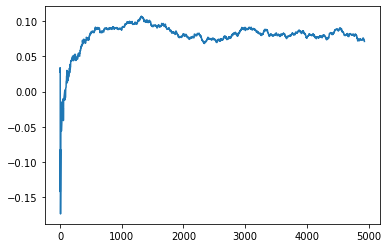

Thread: 5 iteration: 870
RAM mDiffFit_314 FROM: 1664 --> 192 reward: 0.22679944726562498
Thread: 3 iteration: 809
RAM mBackground_27 FROM: 1216 --> 1408 reward: -0.0008689426562500095
Thread: 1 iteration: 777
RAM mDiffFit_84 FROM: 704 --> 320 reward: 0.056611969140624996
Thread: 6 iteration: 816
RAM mDiffFit_244 FROM: 1600 --> 320 reward: 0.11495309765624998
Thread: 2 iteration: 836
RAM mDiffFit_312 FROM: 1152 --> 192 reward: 0.20106247812500003
Thread: 4 iteration: 825
RAM mBackground_81 FROM: 2432 --> 1408 reward: -0.02690197846875005
Saving ...


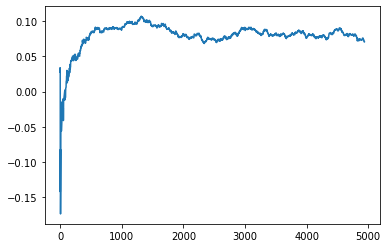

Thread: 3 iteration: 810
RAM mDiffFit_258 FROM: 128 --> 320 reward: -0.6133229640625
Thread: 1 iteration: 778
RAM mDiffFit_387 FROM: 384 --> 320 reward: -0.01138022109375001
Thread: 2 iteration: 837
RAM mDiffFit_63 FROM: 2176 --> 256 reward: 0.11698947031249997
Thread: 6 iteration: 817
RAM mBackground_33 FROM: 2496 --> 1408 reward: -0.008940498187500031
Thread: 4 iteration: 826
RAM mDiffFit_296 FROM: 1280 --> 320 reward: 0.034820244140625
Thread: 5 iteration: 871
RAM mDiffFit_331 FROM: 1152 --> 320 reward: 0.068028606640625
Thread: 3 iteration: 811
RAM mDiffFit_372 FROM: 640 --> 320 reward: 0.06981769921874999
Thread: 2 iteration: 838
RAM mBackground_56 FROM: 1408 --> 704 reward: 0.12027008692187498
Thread: 6 iteration: 818
RAM mDiffFit_228 FROM: 768 --> 256 reward: -0.018520928124999975
Thread: 4 iteration: 827
RAM mDiffFit_421 FROM: 128 --> 320 reward: -0.772104246875
Thread: 3 iteration: 812
RAM mDiffFit_297 FROM: 2688 --> 960 reward: 0.008539005078124998
Thread: 2 iteration: 839
RA

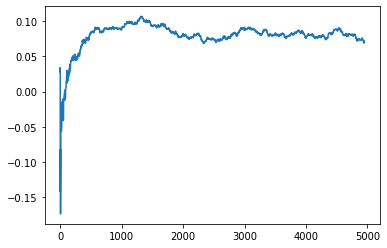

Thread: 2 iteration: 840
RAM mDiffFit_404 FROM: 2368 --> 960 reward: -0.07811732148437499
Thread: 4 iteration: 828
RAM mDiffFit_242 FROM: 2752 --> 960 reward: 0.00426557578125002
Thread: 2 iteration: 841
RAM mBackground_32 FROM: 832 --> 704 reward: -0.002214975351562512
Saving ...


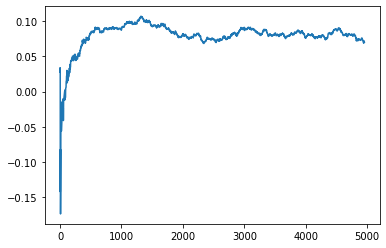

Thread: 6 iteration: 820
RAM mDiffFit_211 FROM: 1344 --> 192 reward: 0.22275776601562497
Thread: 4 iteration: 829
RAM mProject_48 FROM: 832 --> 896 reward: 0.92331812475
Thread: 1 iteration: 779
RAM mProject_42 FROM: 2752 --> 256 reward: -1.0
Thread: 5 iteration: 872
RAM mDiffFit_176 FROM: 384 --> 448 reward: -0.07136460156250002
Thread: 6 iteration: 821
RAM mDiffFit_232 FROM: 1536 --> 192 reward: 0.208882766015625
Saving ...


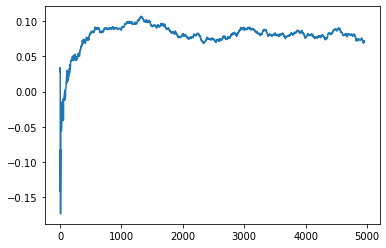

Thread: 4 iteration: 830
RAM mProject_5 FROM: 768 --> 2560 reward: 0.7453246359375
Thread: 3 iteration: 814
RAM mDiffFit_28 FROM: 448 --> 192 reward: 0.12028646015624998
Thread: 5 iteration: 873
RAM mConcatFit_1 FROM: 256 --> 2944 reward: -0.4622790456250001
Thread: 6 iteration: 822
RAM mDiffFit_45 FROM: 2752 --> 192 reward: 0.2166561953125
Thread: 4 iteration: 831
RAM mProject_65 FROM: 1344 --> 2752 reward: 0.0608651763046873
Thread: 2 iteration: 842
RAM mDiffFit_63 FROM: 2944 --> 192 reward: 0.21030462460937496
Thread: 5 iteration: 874
RAM mDiffFit_40 FROM: 128 --> 192 reward: -0.20660938046875
Thread: 6 iteration: 823
RAM mBackground_23 FROM: 1536 --> 1408 reward: 0.041217326156250046
Thread: 4 iteration: 832
RAM mDiffFit_85 FROM: 2816 --> 192 reward: 0.186861881640625
Thread: 2 iteration: 843
RAM mDiffFit_325 FROM: 2368 --> 192 reward: 0.21661714648437502
Thread: 5 iteration: 875
RAM mBackground_87 FROM: 1024 --> 1408 reward: -0.024147163984375018
Thread: 2 iteration: 844
RAM mDiff

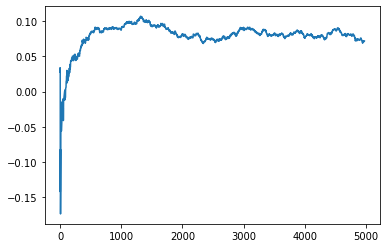

Thread: 1 iteration: 780
RAM mDiffFit_332 FROM: 896 --> 448 reward: 0.04561977890624999
Thread: 5 iteration: 876
RAM mDiffFit_34 FROM: 2432 --> 192 reward: 0.4930858636718749
Thread: 6 iteration: 824
RAM mProject_77 FROM: 896 --> 256 reward: -1.0
Thread: 3 iteration: 815
RAM mDiffFit_49 FROM: 2240 --> 192 reward: 0.26961192539062495
Thread: 1 iteration: 781
RAM mDiffFit_321 FROM: 1728 --> 192 reward: 0.18087495625
Thread: 5 iteration: 877
RAM mDiffFit_216 FROM: 1792 --> 448 reward: 0.05285933671874998
Thread: 3 iteration: 816
RAM mDiffFit_127 FROM: 832 --> 448 reward: 0.048854159375
Thread: 5 iteration: 878
RAM mDiffFit_164 FROM: 2688 --> 192 reward: 0.249632766015625
Thread: 3 iteration: 817
RAM mDiffFit_90 FROM: 1856 --> 192 reward: 0.269460863671875
Thread: 5 iteration: 879
RAM mDiffFit_40 FROM: 768 --> 448 reward: 0.05923174804687497
Thread: 3 iteration: 818
RAM mDiffFit_326 FROM: 1344 --> 192 reward: 0.16591400507812498
Saving ...


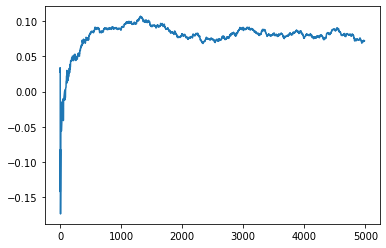

Thread: 5 iteration: 880
RAM mDiffFit_421 FROM: 1216 --> 192 reward: 0.211575508984375
Thread: 3 iteration: 819
RAM mProject_16 FROM: 448 --> 896 reward: 0.90398498596875
Thread: 4 iteration: 834
RAM mProject_31 FROM: 2688 --> 256 reward: -1.0
Thread: 2 iteration: 845
RAM mProject_78 FROM: 320 --> 896 reward: 0.92309312475
Thread: 6 iteration: 825
RAM mDiffFit_392 FROM: 512 --> 192 reward: 0.15595831875000005
Saving ...


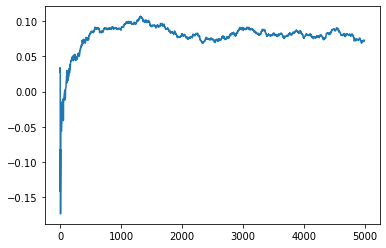

Thread: 3 iteration: 820
RAM mDiffFit_406 FROM: 2304 --> 192 reward: 0.19565615156249994
Thread: 5 iteration: 881
RAM mDiffFit_350 FROM: 1664 --> 192 reward: 0.346960951171875
Thread: 2 iteration: 846
RAM mDiffFit_319 FROM: 1024 --> 192 reward: 0.3513593804687499
Thread: 6 iteration: 826
RAM mProject_77 FROM: 2368 --> 256 reward: -1.0
Thread: 1 iteration: 782
RAM mBackground_11 FROM: 1088 --> 1792 reward: -0.0002888427578125109
Thread: 2 iteration: 847
RAM mDiffFit_296 FROM: 1664 --> 192 reward: 0.17894787656249997
Thread: 1 iteration: 783
RAM mDiffFit_162 FROM: 320 --> 192 reward: 0.16475780976562499
Thread: 5 iteration: 882
RAM mDiffFit_367 FROM: 2368 --> 192 reward: 0.255341084765625
Thread: 6 iteration: 827
RAM mDiffFit_113 FROM: 512 --> 320 reward: 0.024559845703125
Thread: 3 iteration: 821
RAM mBackground_87 FROM: 1024 --> 1792 reward: -0.027134750906249994
Thread: 2 iteration: 848
RAM mDiffFit_358 FROM: 448 --> 2560 reward: -0.0868437171875
Thread: 5 iteration: 883
RAM mDiffFit_

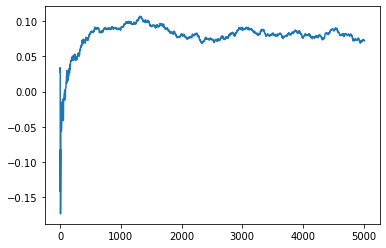

Thread: 2 iteration: 850
RAM mDiffFit_18 FROM: 2944 --> 2560 reward: -0.03804172500000001
Thread: 5 iteration: 885
RAM mDiffFit_55 FROM: 2880 --> 2560 reward: -0.040343804687500026
Thread: 3 iteration: 824
RAM mDiffFit_142 FROM: 2816 --> 2560 reward: 0.015010442187500007
Saving ...


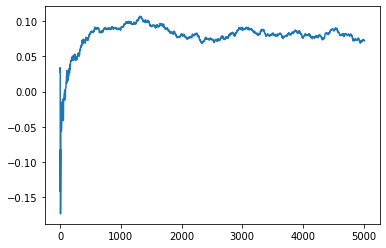

Thread: 6 iteration: 830
RAM mDiffFit_158 FROM: 576 --> 2176 reward: 0.026013118359375
Thread: 4 iteration: 837
RAM mDiffFit_108 FROM: 1024 --> 2176 reward: 0.056093848437500024
Thread: 1 iteration: 786
RAM mDiffFit_76 FROM: 1600 --> 2880 reward: 0.125117365234375
Thread: 2 iteration: 851
RAM mDiffFit_325 FROM: 2560 --> 256 reward: 0.19656243437499998
Thread: 3 iteration: 825
RAM mDiffFit_264 FROM: 1344 --> 320 reward: 0.11649477890624998
Thread: 4 iteration: 838
RAM mDiffFit_93 FROM: 2304 --> 256 reward: 0.21493747812500003
Thread: 6 iteration: 831
RAM mDiffFit_128 FROM: 2752 --> 256 reward: 0.323523429296875
Thread: 1 iteration: 787
RAM mDiffFit_163 FROM: 1088 --> 320 reward: 0.0905103984375
Thread: 2 iteration: 852
RAM mProject_41 FROM: 1472 --> 2112 reward: -0.007490044195312417
Thread: 5 iteration: 886
RAM mDiffFit_237 FROM: 128 --> 320 reward: -0.4816354421875001
Thread: 6 iteration: 832
RAM mDiffFit_412 FROM: 2624 --> 448 reward: 0.06397130585937497
Thread: 2 iteration: 853
RAM 

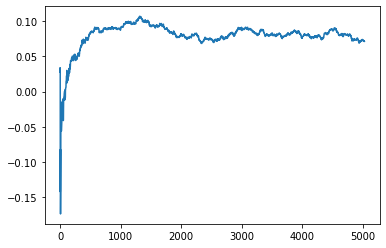

Thread: 4 iteration: 840
RAM mDiffFit_178 FROM: 2624 --> 448 reward: 0.053601483203124974
Thread: 3 iteration: 828
RAM mBackground_2 FROM: 1664 --> 2304 reward: 0.03243371951562496
Thread: 6 iteration: 834
RAM mDiffFit_11 FROM: 2880 --> 448 reward: 0.029744691406249982
Saving ...


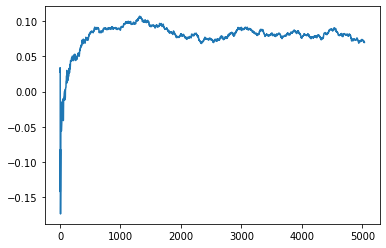

Thread: 1 iteration: 790
RAM mDiffFit_353 FROM: 448 --> 448 reward: -0.01706511054687502
Thread: 2 iteration: 855
RAM mDiffFit_106 FROM: 1152 --> 448 reward: 0.04812236757812499
Thread: 5 iteration: 888
RAM mDiffFit_301 FROM: 2048 --> 448 reward: 0.2404739820312501
Thread: 4 iteration: 841
RAM mDiffFit_340 FROM: 3008 --> 192 reward: 0.24504681484375007
Thread: 1 iteration: 791
RAM mDiffFit_112 FROM: 320 --> 192 reward: 0.23102606171874998
Thread: 5 iteration: 889
RAM mDiffFit_115 FROM: 2880 --> 192 reward: 0.30562495625
Thread: 4 iteration: 842
RAM mDiffFit_321 FROM: 320 --> 192 reward: -0.019802123437499992
Thread: 1 iteration: 792
RAM mDiffFit_189 FROM: 832 --> 192 reward: 0.12490356289062501
Thread: 1 iteration: 793
RAM mDiffFit_98 FROM: 2240 --> 192 reward: 0.176726439453125
Thread: 4 iteration: 843
RAM mDiffFit_246 FROM: 320 --> 192 reward: -0.128612056640625
Thread: 1 iteration: 794
RAM mBgModel_2 FROM: 2752 --> 1152 reward: -0.01537413078124994
Thread: 4 iteration: 844
RAM mProj

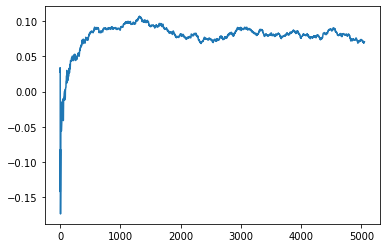

Thread: 5 iteration: 890
RAM mDiffFit_368 FROM: 1024 --> 192 reward: 0.22336196914062498
Thread: 6 iteration: 836
RAM mDiffFit_331 FROM: 2944 --> 2560 reward: -0.005953141406250008
Thread: 2 iteration: 857
RAM mDiffFit_373 FROM: 2176 --> 192 reward: 0.16234362968749996
Thread: 1 iteration: 796
RAM mDiffFit_207 FROM: 1920 --> 192 reward: 0.17921090742187504
Saving ...


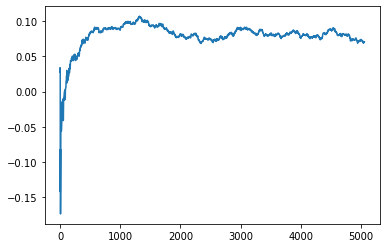

Thread: 3 iteration: 830
RAM mDiffFit_134 FROM: 2240 --> 2560 reward: 0.007960951171875003
Thread: 5 iteration: 891
RAM mDiffFit_30 FROM: 128 --> 1984 reward: -0.51595309765625
Thread: 6 iteration: 837
RAM mDiffFit_275 FROM: 2752 --> 2560 reward: 0.01786982265625
Thread: 1 iteration: 797
RAM mDiffFit_402 FROM: 640 --> 1984 reward: -0.04214320820312499
Thread: 2 iteration: 858
RAM mDiffFit_250 FROM: 320 --> 1984 reward: -0.204716128515625
Thread: 3 iteration: 831
RAM mDiffFit_186 FROM: 512 --> 1984 reward: -0.017781195312500005
Thread: 5 iteration: 892
RAM mDiffFit_347 FROM: 3008 --> 2560 reward: -0.012135442187499994
Thread: 1 iteration: 798
RAM mBackground_87 FROM: 1216 --> 1408 reward: -0.037799701609374986
Thread: 6 iteration: 838
RAM mBackground_14 FROM: 2880 --> 1408 reward: -0.05493042424218753
Thread: 2 iteration: 859
RAM mDiffFit_65 FROM: 704 --> 2880 reward: 0.00781519804687502
Thread: 1 iteration: 799
RAM mDiffFit_254 FROM: 256 --> 2112 reward: -0.163229115625
Saving ...


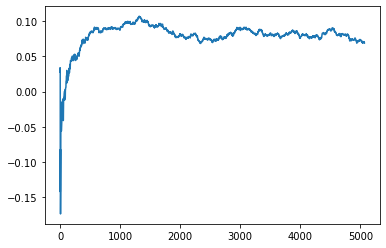

Thread: 2 iteration: 860
RAM mDiffFit_158 FROM: 2880 --> 384 reward: 0.11775776601562497
Thread: 6 iteration: 839
RAM mDiffFit_238 FROM: 1344 --> 2112 reward: -0.044179712109375
Saving ...


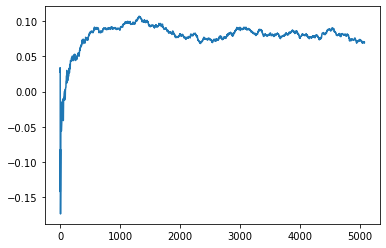

Thread: 1 iteration: 800
RAM mDiffFit_119 FROM: 576 --> 2112 reward: -0.030156195312499995
Saving ...


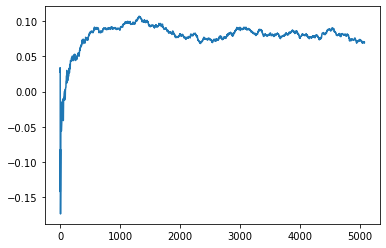

Thread: 6 iteration: 840
RAM mDiffFit_378 FROM: 896 --> 2112 reward: -0.05291926992187501
Thread: 1 iteration: 801
RAM mProject_11 FROM: 2176 --> 1024 reward: 0.16216580067187503
Thread: 4 iteration: 846
RAM mDiffFit_38 FROM: 2944 --> 2112 reward: -0.08498451171875002
Thread: 6 iteration: 841
RAM mBackground_25 FROM: 2880 --> 1408 reward: -0.04071801116406255
Thread: 6 iteration: 842
RAM mProject_81 FROM: 448 --> 896 reward: 0.9089593655625
Thread: 3 iteration: 832
RAM mProject_85 FROM: 192 --> 896 reward: 0.9101968655625
Thread: 5 iteration: 893
RAM mDiffFit_43 FROM: 576 --> 256 reward: 0.17629168125000005
Thread: 6 iteration: 843
RAM mDiffFit_418 FROM: 2432 --> 256 reward: 0.15660933671875002
Thread: 3 iteration: 833
RAM mDiffFit_155 FROM: 448 --> 256 reward: 0.12109376093749999
Thread: 5 iteration: 894
RAM mProject_39 FROM: 2112 --> 1024 reward: 0.17863114106249997
Thread: 2 iteration: 861
RAM mDiffFit_109 FROM: 576 --> 256 reward: 0.17546876093749997
Thread: 3 iteration: 834
RAM mD

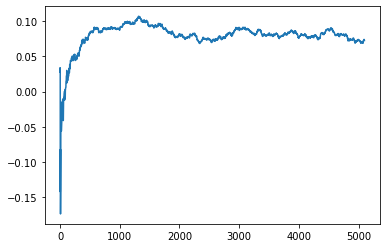

Thread: 5 iteration: 900
RAM mBackground_62 FROM: 1088 --> 1408 reward: -0.020958009859375036
Thread: 3 iteration: 838
RAM mDiffFit_113 FROM: 1344 --> 256 reward: 0.2589061515625
Thread: 6 iteration: 845
RAM mProject_46 FROM: 3008 --> 1152 reward: -0.05400278655468754
Thread: 1 iteration: 803
RAM mBgModel_1 FROM: 3008 --> 1152 reward: -0.03368043109375002
Saving ...


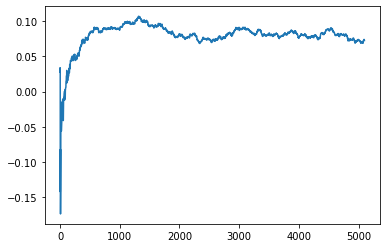

Thread: 4 iteration: 850
RAM mDiffFit_74 FROM: 1600 --> 192 reward: 0.28283331874999995
Thread: 2 iteration: 863
RAM mViewer_2 FROM: 640 --> 1408 reward: -0.139160299265625
Thread: 4 iteration: 851
RAM mDiffFit_237 FROM: 1408 --> 192 reward: 0.24158331874999997
Thread: 6 iteration: 846
RAM mDiffFit_361 FROM: 1216 --> 192 reward: 0.3575729203125
Thread: 1 iteration: 804
RAM mBackground_66 FROM: 1600 --> 1408 reward: -0.05541408017968751
Thread: 3 iteration: 839
RAM mDiffFit_1 FROM: 832 --> 192 reward: 0.28885157070312506
Thread: 2 iteration: 864
RAM mBackground_59 FROM: 1344 --> 1408 reward: -0.0532058212265625
Saving ...


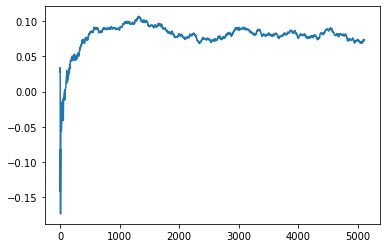

Thread: 3 iteration: 840
RAM mDiffFit_6 FROM: 1920 --> 192 reward: 0.19108586367187497
Thread: 1 iteration: 805
RAM mDiffFit_239 FROM: 1408 --> 192 reward: 0.5268593367187501
Thread: 4 iteration: 852
RAM mProject_49 FROM: 2560 --> 1280 reward: -0.08706786749999998
Thread: 5 iteration: 901
RAM mDiffFit_372 FROM: 2816 --> 2560 reward: -0.005343760937500004
Thread: 2 iteration: 865
RAM mDiffFit_193 FROM: 1024 --> 192 reward: 0.232229159375
Thread: 1 iteration: 806
RAM mDiffFit_247 FROM: 704 --> 192 reward: 0.26641926992187503
Thread: 3 iteration: 841
RAM mDiffFit_351 FROM: 1280 --> 192 reward: 0.271710907421875
Thread: 4 iteration: 853
RAM mDiffFit_155 FROM: 2624 --> 2560 reward: -0.007742190234375015
Thread: 5 iteration: 902
RAM mDiffFit_223 FROM: 2688 --> 2560 reward: -0.03425004375
Thread: 2 iteration: 866
RAM mDiffFit_394 FROM: 2496 --> 2560 reward: 0.023971393359375013
Thread: 4 iteration: 854
RAM mDiffFit_256 FROM: 3008 --> 2560 reward: -0.036549534765624996
Thread: 2 iteration: 867

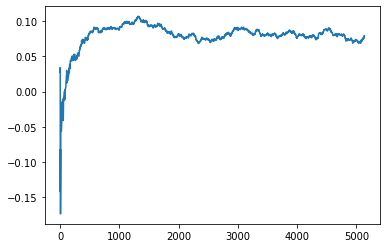

Thread: 1 iteration: 810
RAM mDiffFit_198 FROM: 1280 --> 320 reward: 0.031070244140625012
Thread: 4 iteration: 858
RAM mBackground_20 FROM: 2560 --> 704 reward: 0.09185190191406241
Thread: 3 iteration: 844
RAM mDiffFit_325 FROM: 2368 --> 448 reward: 0.05699995624999999
Thread: 4 iteration: 859
RAM mProject_67 FROM: 2624 --> 1280 reward: -0.02472779137500005
Saving ...


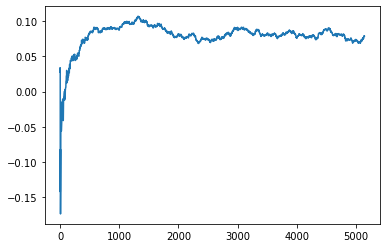

Thread: 2 iteration: 870
RAM mProject_21 FROM: 1920 --> 1280 reward: 0.1032993323437499
Thread: 6 iteration: 849
RAM mDiffFit_30 FROM: 2816 --> 448 reward: 0.10069006679687499
Thread: 3 iteration: 845
RAM mDiffFit_58 FROM: 1600 --> 448 reward: 0.02919787656249999
Thread: 2 iteration: 871
RAM mDiffFit_63 FROM: 128 --> 448 reward: -0.71803650390625
Saving ...


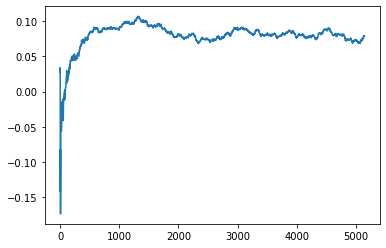

Thread: 6 iteration: 850
RAM mDiffFit_34 FROM: 1088 --> 192 reward: 0.518007809765625
Saving ...


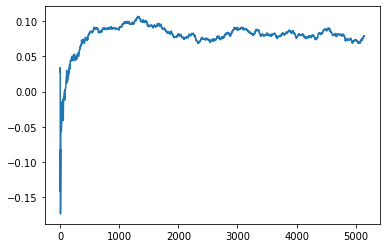

Thread: 4 iteration: 860
RAM mProject_54 FROM: 3008 --> 1280 reward: -0.0875947969687499
Thread: 5 iteration: 908
RAM mDiffFit_383 FROM: 1216 --> 448 reward: 0.025601526953125016
Thread: 3 iteration: 846
RAM mBgModel_1 FROM: 1792 --> 320 reward: 0.65418852234375
Thread: 1 iteration: 811
RAM mDiffFit_338 FROM: 448 --> 192 reward: -0.01586986640624996
Thread: 2 iteration: 872
RAM mDiffFit_302 FROM: 704 --> 192 reward: 0.49470831875
Thread: 6 iteration: 851
RAM mDiffFit_143 FROM: 2112 --> 192 reward: 0.19485152695312502
Thread: 3 iteration: 847
RAM mDiffFit_299 FROM: 2048 --> 192 reward: 0.25805466835937496
Thread: 5 iteration: 909
RAM mBackground_1 FROM: 1280 --> 320 reward: 0.33742004929687497
Thread: 4 iteration: 861
RAM mDiffFit_84 FROM: 2496 --> 192 reward: 0.187773385546875
Thread: 6 iteration: 852
RAM mBackground_82 FROM: 1600 --> 320 reward: 0.397064663984375
Thread: 2 iteration: 873
RAM mDiffFit_123 FROM: 704 --> 192 reward: 0.195395840625
Saving ...


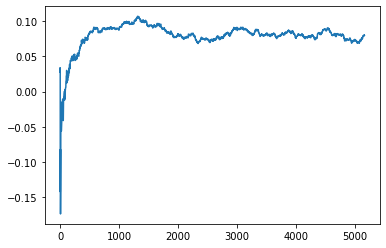

Thread: 5 iteration: 910
RAM mBackground_65 FROM: 1792 --> 1792 reward: 0.00032249999999999434
Thread: 2 iteration: 874
RAM mDiffFit_87 FROM: 2944 --> 192 reward: 0.190320244140625
Thread: 6 iteration: 853
RAM mBackground_12 FROM: 2112 --> 768 reward: 0.20646720160937498
Thread: 3 iteration: 848
RAM mDiffFit_34 FROM: 2944 --> 192 reward: 0.508945200390625
Thread: 4 iteration: 862
RAM mDiffFit_296 FROM: 832 --> 192 reward: 0.03164053203125003
Thread: 2 iteration: 875
RAM mDiffFit_164 FROM: 576 --> 192 reward: 0.14022652695312499
Thread: 5 iteration: 911
RAM mDiffFit_289 FROM: 2112 --> 192 reward: 0.182851526953125
Thread: 6 iteration: 854
RAM mDiffFit_26 FROM: 768 --> 192 reward: 0.11671090742187501
Thread: 3 iteration: 849
RAM mDiffFit_31 FROM: 640 --> 192 reward: 0.556585994921875
Thread: 4 iteration: 863
RAM mProject_6 FROM: 1216 --> 384 reward: -1.0
Thread: 1 iteration: 812
RAM mDiffFit_325 FROM: 1088 --> 192 reward: 0.23778900507812503
Saving ...


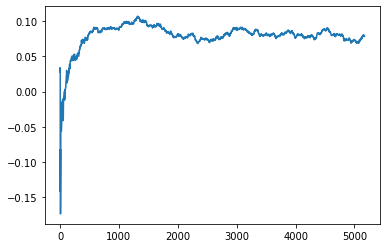

Thread: 3 iteration: 850
RAM mDiffFit_353 FROM: 1152 --> 192 reward: 0.146304668359375
Thread: 1 iteration: 813
RAM mDiffFit_333 FROM: 1472 --> 256 reward: 0.04227334179687504
Thread: 2 iteration: 876
RAM mDiffFit_306 FROM: 1920 --> 192 reward: 0.22287495625
Thread: 4 iteration: 864
RAM mDiffFit_222 FROM: 320 --> 1088 reward: -0.05454681484375
Thread: 5 iteration: 912
RAM mBackground_71 FROM: 1792 --> 1792 reward: 0.0373204605625
Thread: 1 iteration: 814
RAM mConcatFit_2 FROM: 1536 --> 704 reward: 0.10301038968749998
Thread: 3 iteration: 851
RAM mBackground_30 FROM: 2688 --> 1408 reward: -0.03791180462499999
Thread: 1 iteration: 815
RAM mBackground_22 FROM: 448 --> 320 reward: 0.13897286066406248
Thread: 3 iteration: 852
RAM mBackground_63 FROM: 1280 --> 320 reward: 0.29703363128906257
Thread: 1 iteration: 816
RAM mProject_28 FROM: 320 --> 896 reward: 0.933175944140625
Thread: 6 iteration: 855
RAM mDiffFit_118 FROM: 1600 --> 256 reward: 0.234729159375
Thread: 3 iteration: 853
RAM mBgMo

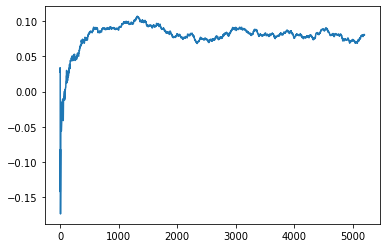

Thread: 2 iteration: 880
RAM mDiffFit_302 FROM: 2816 --> 192 reward: 0.47036183789062497
Thread: 6 iteration: 859
RAM mBackground_78 FROM: 2176 --> 704 reward: 0.021631951210937406
Saving ...


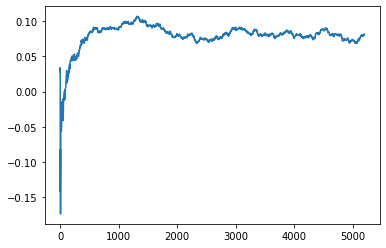

Thread: 1 iteration: 820
RAM mConcatFit_1 FROM: 1856 --> 704 reward: 0.10344787656249999
Thread: 5 iteration: 915
RAM mDiffFit_73 FROM: 1728 --> 192 reward: 0.259523429296875
Thread: 3 iteration: 857
RAM mDiffFit_416 FROM: 832 --> 192 reward: 0.26400258867187504
Thread: 4 iteration: 867
RAM mDiffFit_404 FROM: 896 --> 192 reward: 0.14457809765625002
Saving ...


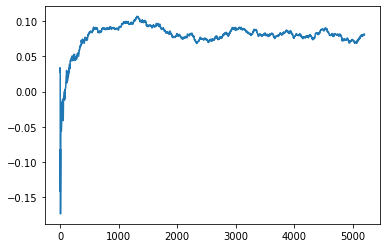

Thread: 6 iteration: 860
RAM mDiffFit_90 FROM: 2688 --> 192 reward: 0.23173429296875003
Thread: 1 iteration: 821
RAM mDiffFit_27 FROM: 1024 --> 192 reward: 0.18320309765625
Thread: 3 iteration: 858
RAM mDiffFit_124 FROM: 320 --> 192 reward: 0.0921562390625
Thread: 5 iteration: 916
RAM mDiffFit_198 FROM: 1792 --> 192 reward: 0.18744528789062506
Thread: 1 iteration: 822
RAM mDiffFit_152 FROM: 1536 --> 192 reward: 0.24405466835937498
Thread: 5 iteration: 917
RAM mBackground_80 FROM: 2624 --> 192 reward: 0.7451786805859374
Thread: 6 iteration: 861
RAM mProject_30 FROM: 2880 --> 256 reward: -1.0
Thread: 2 iteration: 881
RAM mDiffFit_310 FROM: 2816 --> 192 reward: 0.25163008984375
Thread: 1 iteration: 823
RAM mDiffFit_40 FROM: 1024 --> 192 reward: 0.332492190234375
Thread: 6 iteration: 862
RAM mProject_54 FROM: 1920 --> 1024 reward: 0.19868807053125
Thread: 4 iteration: 868
RAM mDiffFit_14 FROM: 1472 --> 192 reward: 0.22415101796875003
Thread: 1 iteration: 824
RAM mDiffFit_258 FROM: 2048 -->

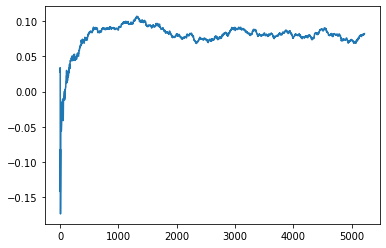

Thread: 3 iteration: 860
RAM mProject_20 FROM: 1408 --> 1024 reward: 0.15281906807812498
Thread: 5 iteration: 918
RAM mDiffFit_404 FROM: 896 --> 192 reward: 0.17043747812499999
Saving ...


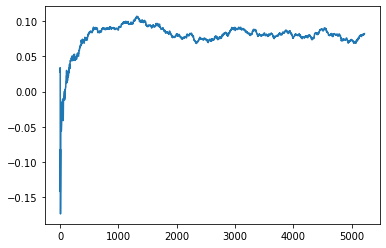

Thread: 4 iteration: 870
RAM mDiffFit_201 FROM: 1920 --> 192 reward: 0.21007805390624995
Thread: 1 iteration: 826
RAM mProject_90 FROM: 1472 --> 1024 reward: 0.16098280889062494
Thread: 2 iteration: 882
RAM mDiffFit_344 FROM: 1024 --> 192 reward: 0.21961196914062503
Thread: 3 iteration: 861
RAM mDiffFit_119 FROM: 3008 --> 2560 reward: -0.08497406953124996
Thread: 2 iteration: 883
RAM mDiffFit_169 FROM: 1472 --> 192 reward: 0.21091141640625
Thread: 1 iteration: 827
RAM mDiffFit_131 FROM: 576 --> 192 reward: 0.19930466835937505
Thread: 5 iteration: 919
RAM mDiffFit_83 FROM: 2688 --> 2560 reward: -0.0042343804687500035
Saving ...


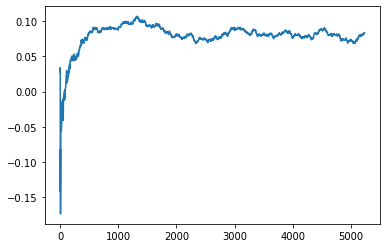

Thread: 5 iteration: 920
RAM mDiffFit_38 FROM: 1344 --> 192 reward: -0.29051640703125003
Thread: 4 iteration: 871
RAM mDiffFit_375 FROM: 384 --> 192 reward: 0.32889842929687496
Thread: 3 iteration: 862
RAM mDiffFit_38 FROM: 1024 --> 192 reward: 0.4774010179687499
Thread: 1 iteration: 828
RAM mDiffFit_184 FROM: 1728 --> 192 reward: 0.26507809765625007
Thread: 5 iteration: 921
RAM mProject_20 FROM: 1600 --> 1024 reward: 0.18522139788281247
Thread: 6 iteration: 865
RAM mDiffFit_263 FROM: 768 --> 192 reward: 0.09888276601562496
Thread: 3 iteration: 863
RAM mDiffFit_161 FROM: 1728 --> 384 reward: 0.036140575781249996
Thread: 5 iteration: 922
RAM mDiffFit_135 FROM: 2304 --> 384 reward: 0.01412486874999997
Thread: 4 iteration: 872
RAM mDiffFit_252 FROM: 2944 --> 256 reward: 0.33191655
Thread: 6 iteration: 866
RAM mProject_87 FROM: 1088 --> 1024 reward: 0.03170765707031254
Thread: 2 iteration: 884
RAM mDiffFit_12 FROM: 2944 --> 832 reward: 0.104289048828125
Thread: 5 iteration: 923
RAM mDiffFi

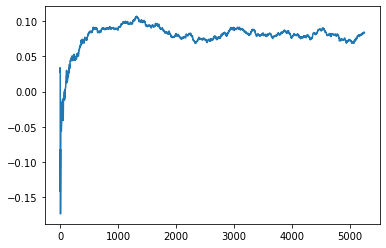

Thread: 1 iteration: 830
RAM mDiffFit_322 FROM: 2624 --> 832 reward: 0.088565110546875
Thread: 3 iteration: 865
RAM mBackground_49 FROM: 2048 --> 704 reward: 0.11381333289843752
Saving ...


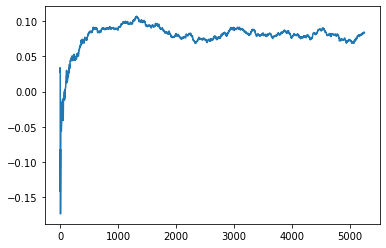

Thread: 6 iteration: 870
RAM mDiffFit_347 FROM: 2240 --> 832 reward: 0.0051431644531249945
Thread: 1 iteration: 831
RAM mDiffFit_341 FROM: 1920 --> 448 reward: 0.023791593750000003
Thread: 3 iteration: 866
RAM mDiffFit_256 FROM: 1792 --> 448 reward: 0.224705773828125
Thread: 6 iteration: 871
RAM mBackground_18 FROM: 1280 --> 320 reward: 0.345034663984375
Thread: 5 iteration: 927
RAM mProject_46 FROM: 2816 --> 1280 reward: -0.0691278727500002
Thread: 2 iteration: 887
RAM mDiffFit_115 FROM: 1280 --> 256 reward: 0.14486455781249996
Thread: 5 iteration: 928
RAM mDiffFit_238 FROM: 2688 --> 832 reward: 0.023424447265625002
Thread: 5 iteration: 929
RAM mBackground_90 FROM: 256 --> 320 reward: -0.19033548521093746
Thread: 1 iteration: 832
RAM mProject_66 FROM: 1856 --> 256 reward: -1.0
Thread: 4 iteration: 877
RAM mDiffFit_10 FROM: 2560 --> 256 reward: 0.5170728765625
Saving ...


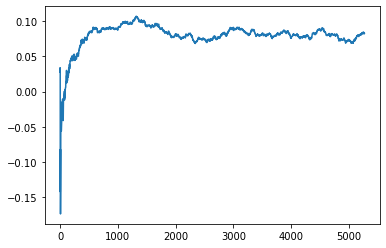

Thread: 5 iteration: 930
RAM mDiffFit_191 FROM: 448 --> 192 reward: 0.1547812390625
Thread: 1 iteration: 833
RAM mBackground_24 FROM: 2752 --> 192 reward: 0.7374476232421875
Thread: 3 iteration: 867
RAM mBackground_1 FROM: 2496 --> 1408 reward: -0.008402998187500002
Thread: 3 iteration: 868
RAM mDiffFit_159 FROM: 1856 --> 256 reward: 0.177434801953125
Thread: 4 iteration: 878
RAM mDiffFit_308 FROM: 1536 --> 256 reward: 0.208583275
Thread: 1 iteration: 834
RAM mBackground_77 FROM: 2368 --> 192 reward: 0.6865060936640625
Thread: 5 iteration: 931
RAM mProject_45 FROM: 704 --> 896 reward: 0.939410323734375
Thread: 6 iteration: 872
RAM mProject_25 FROM: 2368 --> 256 reward: -1.0
Thread: 2 iteration: 888
RAM mDiffFit_111 FROM: 1216 --> 256 reward: 0.17267707968749996
Thread: 3 iteration: 869
RAM mDiffFit_365 FROM: 256 --> 256 reward: -0.143354203125
Thread: 5 iteration: 932
RAM mDiffFit_139 FROM: 320 --> 320 reward: 0.03155730078124995
Thread: 1 iteration: 835
RAM mDiffFit_181 FROM: 1600 -->

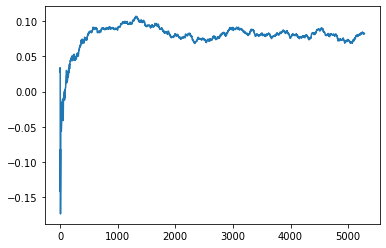

Thread: 3 iteration: 870
RAM mDiffFit_177 FROM: 2176 --> 256 reward: 0.10776553203125
Thread: 5 iteration: 933
RAM mDiffFit_199 FROM: 1600 --> 256 reward: 0.14047130585937498
Thread: 1 iteration: 836
RAM mDiffFit_152 FROM: 1600 --> 256 reward: 0.128145796875
Saving ...


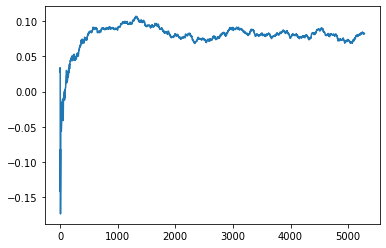

Thread: 4 iteration: 880
RAM mDiffFit_396 FROM: 1344 --> 256 reward: 0.380330730078125
Saving ...


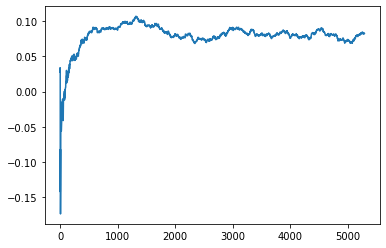

Thread: 2 iteration: 890
RAM mDiffFit_220 FROM: 128 --> 256 reward: -0.63063026484375
Thread: 3 iteration: 871
RAM mDiffFit_221 FROM: 192 --> 256 reward: -0.34413807460937496
Thread: 5 iteration: 934
RAM mDiffFit_248 FROM: 1664 --> 256 reward: 0.16049477890625002
Thread: 1 iteration: 837
RAM mDiffFit_228 FROM: 1344 --> 256 reward: 0.21807292031250003
Thread: 4 iteration: 881
RAM mProject_52 FROM: 1280 --> 2752 reward: 0.030987506109374972
Thread: 6 iteration: 874
RAM mDiffFit_407 FROM: 1920 --> 256 reward: 0.11572911562500002
Thread: 3 iteration: 872
RAM mDiffFit_132 FROM: 256 --> 192 reward: 0.17772398203125
Thread: 4 iteration: 882
RAM mDiffFit_342 FROM: 2304 --> 192 reward: 0.262914005078125
Thread: 6 iteration: 875
RAM mDiffFit_101 FROM: 1280 --> 192 reward: 0.24434893828125
Thread: 3 iteration: 873
RAM mBackground_15 FROM: 2880 --> 192 reward: 0.717898282296875
Thread: 5 iteration: 935
RAM mDiffFit_373 FROM: 2112 --> 192 reward: 0.182304624609375
Thread: 6 iteration: 876
RAM mConc

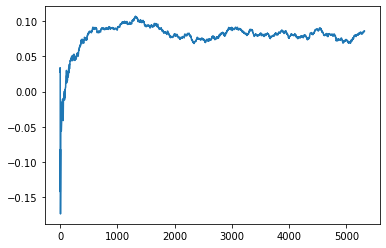

Thread: 6 iteration: 880
RAM mDiffFit_24 FROM: 2624 --> 384 reward: 0.085132766015625
Thread: 4 iteration: 885
RAM mDiffFit_273 FROM: 1408 --> 2752 reward: 0.02858599492187499
Saving ...


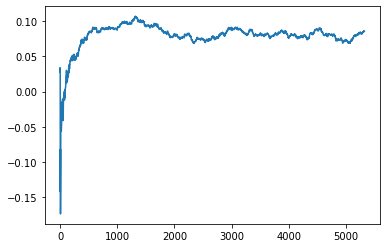

Thread: 5 iteration: 940
RAM mDiffFit_125 FROM: 2240 --> 2752 reward: -0.02476303085937501
Thread: 3 iteration: 879
RAM mDiffFit_275 FROM: 1408 --> 2752 reward: -0.0028150667968750154
Thread: 6 iteration: 881
RAM mDiffFit_171 FROM: 2112 --> 384 reward: 0.050187434375000006
Thread: 2 iteration: 895
RAM mBackground_55 FROM: 512 --> 1792 reward: -0.2464885197187499
Thread: 4 iteration: 886
RAM mDiffFit_334 FROM: 2496 --> 1984 reward: -0.013812521875000011
Saving ...


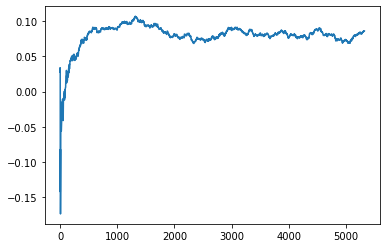

Thread: 3 iteration: 880
RAM mDiffFit_26 FROM: 1856 --> 1984 reward: -0.075164136328125
Thread: 2 iteration: 896
RAM mBackground_8 FROM: 256 --> 1408 reward: -0.5269694525156251
Thread: 4 iteration: 887
RAM mDiffFit_139 FROM: 1216 --> 320 reward: 0.249679668359375
Thread: 5 iteration: 941
RAM mDiffFit_119 FROM: 704 --> 192 reward: 0.261773429296875
Thread: 6 iteration: 882
RAM mProject_22 FROM: 1216 --> 256 reward: -1.0
Saving ...


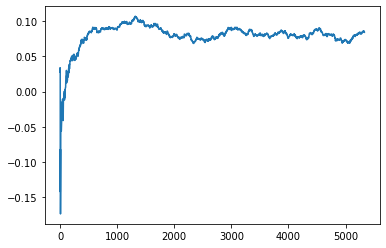

Thread: 1 iteration: 840
RAM mDiffFit_114 FROM: 704 --> 1984 reward: -0.050958318750000016
Thread: 2 iteration: 897
RAM mDiffFit_32 FROM: 1280 --> 1984 reward: -0.05142971210937501
Thread: 4 iteration: 888
RAM mBackground_61 FROM: 2368 --> 1408 reward: -0.006550858851562485
Thread: 6 iteration: 883
RAM mDiffFit_16 FROM: 1472 --> 1984 reward: -0.007669269921874999
Thread: 2 iteration: 898
RAM mDiffFit_387 FROM: 1792 --> 192 reward: 0.22402860664062496
Thread: 4 iteration: 889
RAM mDiffFit_3 FROM: 2240 --> 192 reward: 0.30058849609375005
Thread: 1 iteration: 841
RAM mDiffFit_191 FROM: 2112 --> 192 reward: 0.25701557578125
Thread: 6 iteration: 884
RAM mDiffFit_145 FROM: 960 --> 192 reward: 0.291257809765625
Thread: 2 iteration: 899
RAM mDiffFit_22 FROM: 2624 --> 192 reward: 0.22750776601562495
Saving ...


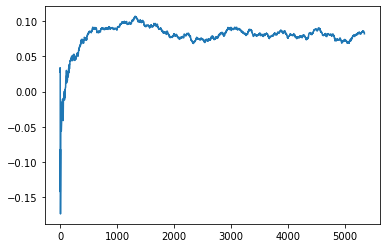

Thread: 4 iteration: 890
RAM mDiffFit_326 FROM: 1216 --> 192 reward: 0.19141663749999996
Thread: 6 iteration: 885
RAM mBackground_42 FROM: 3008 --> 1408 reward: -0.056112924242187424
Thread: 4 iteration: 891
RAM mProject_12 FROM: 512 --> 896 reward: 0.920639684953125
Thread: 3 iteration: 881
RAM mDiffFit_308 FROM: 2432 --> 192 reward: 0.19464057578125
Thread: 6 iteration: 886
RAM mDiffFit_97 FROM: 1920 --> 192 reward: 0.49272657070312503
Thread: 1 iteration: 842
RAM mProject_25 FROM: 1216 --> 256 reward: -1.0
Thread: 5 iteration: 942
RAM mDiffFit_304 FROM: 576 --> 192 reward: 0.2017187609375
Thread: 3 iteration: 882
RAM mDiffFit_28 FROM: 2752 --> 192 reward: 0.27862495625
Thread: 4 iteration: 892
RAM mDiffFit_116 FROM: 1792 --> 192 reward: 0.2509062390625
Thread: 5 iteration: 943
RAM mDiffFit_249 FROM: 2688 --> 192 reward: 0.253101483203125
Thread: 1 iteration: 843
RAM mDiffFit_259 FROM: 704 --> 192 reward: 0.16911977890625
Thread: 3 iteration: 883
RAM mDiffFit_422 FROM: 2304 --> 192 r

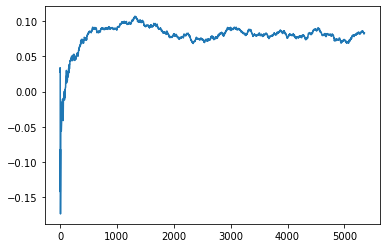

Thread: 2 iteration: 900
RAM mBackground_33 FROM: 2880 --> 192 reward: 0.772279887125
Thread: 4 iteration: 893
RAM mDiffFit_325 FROM: 1152 --> 192 reward: 0.24374999999999994
Thread: 5 iteration: 945
RAM mDiffFit_400 FROM: 1984 --> 192 reward: 0.19921090742187497
Thread: 2 iteration: 901
RAM mDiffFit_320 FROM: 1984 --> 192 reward: 0.35021349609375
Thread: 4 iteration: 894
RAM mDiffFit_375 FROM: 2048 --> 192 reward: 0.45914838554687504
Thread: 1 iteration: 845
RAM mProject_73 FROM: 960 --> 256 reward: -1.0
Thread: 6 iteration: 887
RAM mDiffFit_53 FROM: 2560 --> 192 reward: 0.276976526953125
Thread: 4 iteration: 895
RAM mDiffFit_18 FROM: 128 --> 192 reward: -0.19874477890625006
Thread: 1 iteration: 846
RAM mDiffFit_198 FROM: 1664 --> 192 reward: 0.18719787656249992
Thread: 2 iteration: 902
RAM mDiffFit_183 FROM: 384 --> 192 reward: 0.2956796683593749
Thread: 6 iteration: 888
RAM mDiffFit_350 FROM: 832 --> 192 reward: 0.24769787656250003
Thread: 4 iteration: 896
RAM mDiffFit_421 FROM: 121

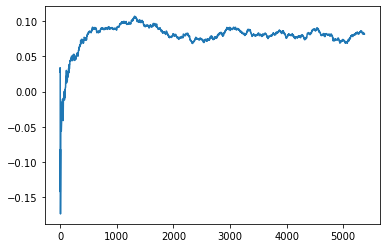

Thread: 6 iteration: 890
RAM mBackground_86 FROM: 1600 --> 192 reward: 0.7812181590546875
Saving ...


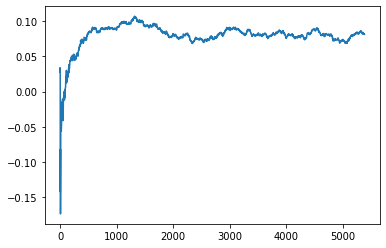

Thread: 1 iteration: 850
RAM mBackground_74 FROM: 1024 --> 2304 reward: 0.0019709587499999555
Thread: 3 iteration: 887
RAM mDiffFit_181 FROM: 704 --> 320 reward: 0.10136977890624999
Thread: 2 iteration: 906
RAM mDiffFit_65 FROM: 2368 --> 384 reward: 0.211976570703125
Thread: 5 iteration: 948
RAM mBackground_57 FROM: 576 --> 2304 reward: -0.18309929034375
Thread: 6 iteration: 891
RAM mDiffFit_338 FROM: 1408 --> 256 reward: 0.26629690234375003
Thread: 4 iteration: 898
RAM mDiffFit_54 FROM: 3008 --> 256 reward: 0.14265615156249997
Thread: 3 iteration: 888
RAM mDiffFit_12 FROM: 1984 --> 192 reward: 0.17658327499999998
Thread: 6 iteration: 892
RAM mDiffFit_282 FROM: 1600 --> 192 reward: 0.307200508984375
Thread: 2 iteration: 907
RAM mDiffFit_375 FROM: 2176 --> 256 reward: 0.32958327499999995
Thread: 4 iteration: 899
RAM mProject_33 FROM: 512 --> 2944 reward: 0.8239969714218748
Thread: 1 iteration: 851
RAM mBackground_6 FROM: 640 --> 192 reward: 0.6023112934609376
Thread: 5 iteration: 949
RA

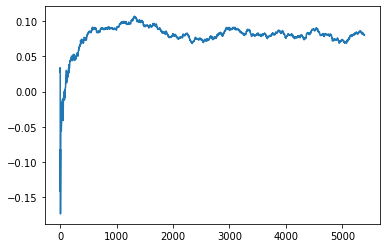

Thread: 4 iteration: 900
RAM mDiffFit_81 FROM: 1856 --> 256 reward: 0.12124736757812499
Thread: 1 iteration: 852
RAM mDiffFit_380 FROM: 2112 --> 256 reward: 0.087736837890625
Thread: 4 iteration: 901
RAM mDiffFit_291 FROM: 1664 --> 256 reward: 0.34143225703124996
Thread: 6 iteration: 894
RAM mDiffFit_416 FROM: 2368 --> 256 reward: 0.03689821054687497
Thread: 1 iteration: 853
RAM mDiffFit_143 FROM: 1344 --> 192 reward: 0.21421867343749998
Saving ...


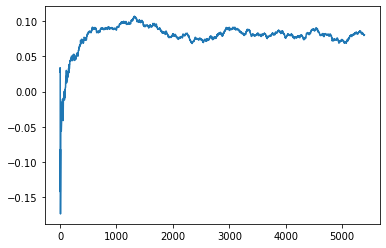

Thread: 3 iteration: 890
RAM mDiffFit_53 FROM: 768 --> 192 reward: 0.15591404882812504
Thread: 6 iteration: 895
RAM mDiffFit_52 FROM: 1024 --> 192 reward: 0.19714579687499997
Thread: 1 iteration: 854
RAM mDiffFit_255 FROM: 1408 --> 192 reward: 0.28480988945312496
Thread: 3 iteration: 891
RAM mDiffFit_374 FROM: 2944 --> 192 reward: 0.13837228007812502
Thread: 1 iteration: 855
RAM mDiffFit_300 FROM: 1664 --> 192 reward: 0.20818225703124998
Thread: 3 iteration: 892
RAM mBackground_15 FROM: 2624 --> 192 reward: 0.6008351595624999
Thread: 6 iteration: 896
RAM mDiffFit_285 FROM: 1600 --> 192 reward: 0.24201561953124995
Thread: 3 iteration: 893
RAM mProject_41 FROM: 1984 --> 256 reward: -1.0
Thread: 4 iteration: 902
RAM mProject_8 FROM: 1664 --> 256 reward: -1.0
Thread: 2 iteration: 908
RAM mDiffFit_340 FROM: 384 --> 192 reward: 0.17895314140625002
Thread: 2 iteration: 909
RAM mDiffFit_324 FROM: 192 --> 192 reward: 0.061960951171875014
Thread: 4 iteration: 903
RAM mProject_72 FROM: 1088 --> 2

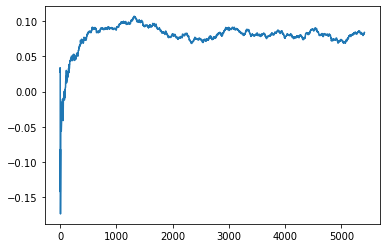

Thread: 5 iteration: 950
RAM mConcatFit_1 FROM: 256 --> 2944 reward: -0.4411081787500001
Saving ...


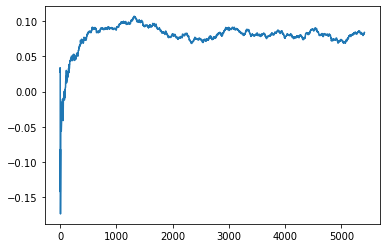

Thread: 2 iteration: 910
RAM mProject_85 FROM: 2560 --> 256 reward: -1.0
Thread: 1 iteration: 856
RAM mDiffFit_166 FROM: 1920 --> 448 reward: 0.08188539843749998
Thread: 5 iteration: 951
RAM mProject_28 FROM: 960 --> 256 reward: -1.0
Thread: 6 iteration: 897
RAM mBackground_39 FROM: 1344 --> 192 reward: 0.7021227607656252
Thread: 4 iteration: 904
RAM mDiffFit_214 FROM: 768 --> 2752 reward: -0.07227342929687498
Thread: 5 iteration: 952
RAM mDiffFit_337 FROM: 1024 --> 192 reward: 0.44219265546875
Thread: 2 iteration: 911
RAM mDiffFit_184 FROM: 2944 --> 2560 reward: -0.012828141406250014
Thread: 6 iteration: 898
RAM mBackground_19 FROM: 768 --> 192 reward: 0.5957380967812499
Thread: 1 iteration: 857
RAM mDiffFit_353 FROM: 448 --> 384 reward: 0.143028694140625
Thread: 4 iteration: 905
RAM mBackground_52 FROM: 2048 --> 192 reward: 0.7795921886328124
Thread: 3 iteration: 894
RAM mDiffFit_86 FROM: 960 --> 2752 reward: -0.11240628281250001
Thread: 1 iteration: 858
RAM mDiffFit_198 FROM: 2560 -

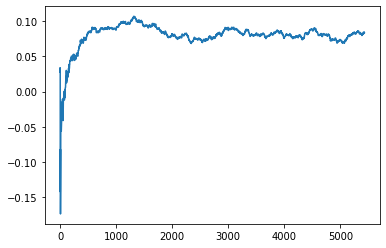

Thread: 1 iteration: 860
RAM mDiffFit_262 FROM: 448 --> 320 reward: 0.12393230078125005
Thread: 3 iteration: 896
RAM mDiffFit_365 FROM: 2432 --> 320 reward: 0.1071978765625
Thread: 5 iteration: 955
RAM mDiffFit_382 FROM: 1856 --> 320 reward: 0.2611249125
Thread: 4 iteration: 908
RAM mDiffFit_391 FROM: 192 --> 320 reward: -0.10816141640624999
Thread: 5 iteration: 956
RAM mProject_89 FROM: 2688 --> 1280 reward: -0.045834702468750176
Thread: 2 iteration: 912
RAM mBackground_42 FROM: 2496 --> 192 reward: 0.6824300363203126
Thread: 1 iteration: 861
RAM mBackground_53 FROM: 2048 --> 192 reward: 0.7615456214296876
Thread: 3 iteration: 897
RAM mDiffFit_35 FROM: 1856 --> 320 reward: 0.06613272226562501
Thread: 5 iteration: 957
RAM mProject_61 FROM: 1600 --> 1024 reward: 0.17915389263281256
Saving ...


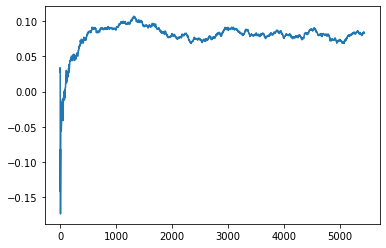

Thread: 6 iteration: 900
RAM mDiffFit_47 FROM: 1536 --> 320 reward: 0.027650930468749967
Thread: 4 iteration: 909
RAM mDiffFit_144 FROM: 512 --> 448 reward: -0.04085679179687497
Thread: 2 iteration: 913
RAM mDiffFit_74 FROM: 448 --> 448 reward: -0.022880221093749976
Thread: 1 iteration: 862
RAM mDiffFit_116 FROM: 1856 --> 448 reward: 0.0272811953125
Thread: 5 iteration: 958
RAM mDiffFit_117 FROM: 192 --> 320 reward: -0.14211719023437502
Thread: 6 iteration: 901
RAM mDiffFit_224 FROM: 704 --> 2112 reward: -0.0030468148437499953
Thread: 2 iteration: 914
RAM mBackground_76 FROM: 1536 --> 192 reward: 0.7301332459765625
Thread: 3 iteration: 898
RAM mDiffFit_178 FROM: 1984 --> 384 reward: 0.09892966835937503
Thread: 1 iteration: 863
RAM mBackground_25 FROM: 640 --> 704 reward: -0.08251747535156256
Thread: 6 iteration: 902
RAM mBackground_4 FROM: 768 --> 320 reward: 0.30099550985937507
Thread: 5 iteration: 959
RAM mDiffFit_202 FROM: 2624 --> 384 reward: 0.050914005078125
Thread: 2 iteration: 

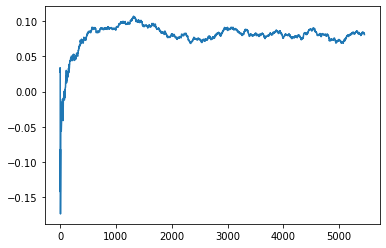

Thread: 4 iteration: 910
RAM mDiffFit_255 FROM: 256 --> 320 reward: -0.06973438046875
Thread: 2 iteration: 916
RAM mDiffFit_98 FROM: 2368 --> 256 reward: 0.1149686734375
Saving ...


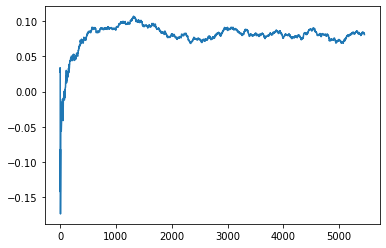

Thread: 5 iteration: 960
RAM mBackground_35 FROM: 704 --> 320 reward: 0.2375100246484375
Thread: 1 iteration: 864
RAM mDiffFit_63 FROM: 2240 --> 256 reward: 0.23000258867187498
Thread: 6 iteration: 903
RAM mDiffFit_360 FROM: 1216 --> 320 reward: 0.1041353984375
Saving ...


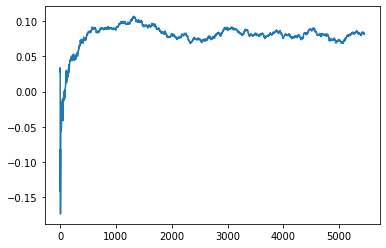

Thread: 3 iteration: 900
RAM mDiffFit_319 FROM: 2624 --> 320 reward: 0.11347130585937497
Thread: 2 iteration: 917
RAM mDiffFit_262 FROM: 1408 --> 320 reward: 0.19559634960937494
Thread: 5 iteration: 961
RAM mDiffFit_279 FROM: 2496 --> 320 reward: 0.24219002304687504
Thread: 4 iteration: 911
RAM mDiffFit_339 FROM: 192 --> 320 reward: 0.09467975585937503
Thread: 1 iteration: 865
RAM mDiffFit_400 FROM: 576 --> 320 reward: 0.35674749882812495
Thread: 3 iteration: 901
RAM mDiffFit_175 FROM: 1728 --> 320 reward: 0.565924534765625
Thread: 6 iteration: 904
RAM mDiffFit_177 FROM: 1088 --> 320 reward: 0.20339584062499996
Thread: 2 iteration: 918
RAM mBackground_12 FROM: 1152 --> 2304 reward: 0.02590761287500001
Thread: 5 iteration: 962
RAM mBackground_57 FROM: 704 --> 1792 reward: -0.11346396730468745
Thread: 4 iteration: 912
RAM mDiffFit_33 FROM: 1536 --> 448 reward: 0.060903606640625024
Thread: 1 iteration: 866
RAM mDiffFit_361 FROM: 320 --> 448 reward: -0.05233853984375002
Thread: 2 iteration

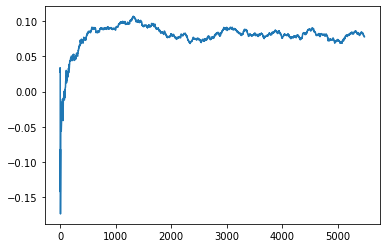

Thread: 2 iteration: 920
RAM mDiffFit_146 FROM: 768 --> 1088 reward: 0.04779172499999999
Thread: 3 iteration: 904
RAM mDiffFit_305 FROM: 1280 --> 2880 reward: 0.08520586132812501
Thread: 5 iteration: 964
RAM mDiffFit_53 FROM: 576 --> 1088 reward: 0.07326570703125002
Thread: 4 iteration: 914
RAM mDiffFit_109 FROM: 1600 --> 1984 reward: -0.017190110546875012
Thread: 2 iteration: 921
RAM mBackground_40 FROM: 2240 --> 704 reward: 0.10700049688281246
Thread: 1 iteration: 868
RAM mProject_77 FROM: 320 --> 2944 reward: 0.83053791646875
Thread: 6 iteration: 906
RAM mDiffFit_73 FROM: 960 --> 1984 reward: -0.05246876093750001
Thread: 3 iteration: 905
RAM mBackground_12 FROM: 256 --> 1792 reward: -0.5682001738437499
Thread: 5 iteration: 965
RAM mDiffFit_104 FROM: 2752 --> 1984 reward: -0.0184062828125
Thread: 6 iteration: 907
RAM mBackground_6 FROM: 2368 --> 1088 reward: 0.09080610664062497
Thread: 4 iteration: 915
RAM mBackground_23 FROM: 1408 --> 320 reward: 0.41994424104687494
Thread: 2 iterat

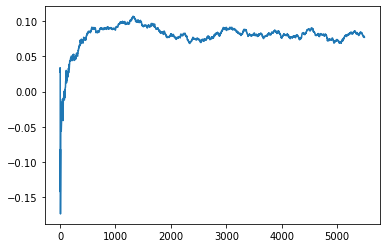

Thread: 1 iteration: 870
RAM mDiffFit_243 FROM: 3008 --> 1088 reward: -0.02486468906249999
Thread: 5 iteration: 967
RAM mDiffFit_232 FROM: 2176 --> 256 reward: 0.12086447031249996
Thread: 2 iteration: 923
RAM mDiffFit_70 FROM: 2432 --> 384 reward: 0.11936973515624999
Thread: 4 iteration: 917
RAM mDiffFit_303 FROM: 2688 --> 2112 reward: 0.00898438046875
Thread: 5 iteration: 968
RAM mDiffFit_375 FROM: 1856 --> 384 reward: 0.22393747812500003
Thread: 1 iteration: 871
RAM mDiffFit_223 FROM: 2880 --> 384 reward: 0.204664048828125
Thread: 2 iteration: 924
RAM mProject_82 FROM: 1728 --> 1024 reward: 0.20139748425000006
Thread: 3 iteration: 906
RAM mProject_83 FROM: 320 --> 2560 reward: 0.7509458925000001
Thread: 6 iteration: 909
RAM mDiffFit_215 FROM: 2816 --> 384 reward: 0.11254159375000002
Thread: 4 iteration: 918
RAM mDiffFit_81 FROM: 704 --> 256 reward: 0.12883853984375002
Thread: 5 iteration: 969
RAM mDiffFit_10 FROM: 1344 --> 320 reward: 0.216309801953125
Thread: 1 iteration: 872
RAM mD

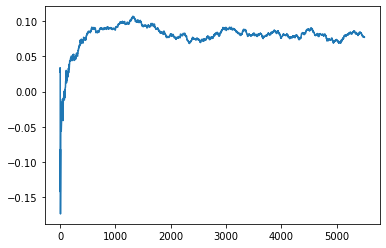

Thread: 6 iteration: 910
RAM mDiffFit_353 FROM: 2048 --> 320 reward: 0.07470823124999999
Thread: 4 iteration: 919
RAM mDiffFit_310 FROM: 2816 --> 320 reward: 0.036890488281249995
Saving ...


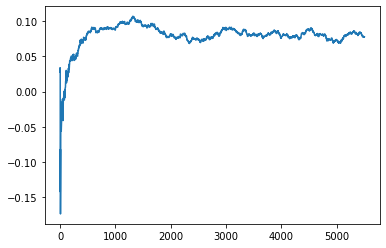

Thread: 5 iteration: 970
RAM mDiffFit_413 FROM: 832 --> 320 reward: 0.111403650390625
Thread: 3 iteration: 908
RAM mDiffFit_212 FROM: 1408 --> 320 reward: 0.026783783984374986
Thread: 6 iteration: 911
RAM mDiffFit_360 FROM: 2496 --> 320 reward: 0.0928020359375
Saving ...


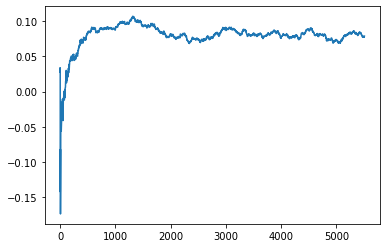

Thread: 4 iteration: 920
RAM mDiffFit_143 FROM: 1344 --> 320 reward: -0.011497498828124987
Thread: 3 iteration: 909
RAM mDiffFit_220 FROM: 2368 --> 320 reward: 0.04963267851562498
Saving ...


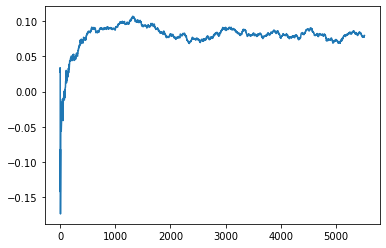

Thread: 3 iteration: 910
RAM mDiffFit_258 FROM: 2048 --> 320 reward: 0.203393208203125
Thread: 4 iteration: 921
RAM mBackground_49 FROM: 1280 --> 320 reward: 0.35390788531250006
Thread: 6 iteration: 912
RAM mProject_70 FROM: 2752 --> 320 reward: -1.0
Thread: 2 iteration: 925
RAM mDiffFit_237 FROM: 1472 --> 448 reward: 0.006421814843750005
Thread: 3 iteration: 911
RAM mDiffFit_52 FROM: 1664 --> 448 reward: 0.05531506679687499
Thread: 4 iteration: 922
RAM mDiffFit_167 FROM: 768 --> 320 reward: 0.07511977890625
Thread: 6 iteration: 913
RAM mProject_7 FROM: 1920 --> 1024 reward: 0.203714012953125
Thread: 1 iteration: 873
RAM mDiffFit_155 FROM: 1728 --> 448 reward: 0.10686719023437499
Thread: 2 iteration: 926
RAM mConcatFit_2 FROM: 2816 --> 704 reward: 0.0703227803125
Thread: 3 iteration: 912
RAM mDiffFit_306 FROM: 1600 --> 448 reward: -0.025666768750000034
Thread: 1 iteration: 874
RAM mProject_25 FROM: 896 --> 320 reward: -1.0
Thread: 5 iteration: 971
RAM mDiffFit_386 FROM: 2176 --> 192 re

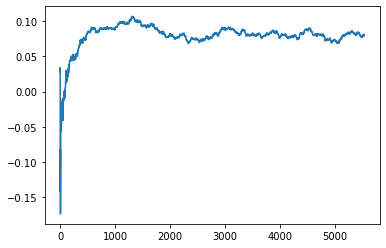

Thread: 2 iteration: 930
RAM mDiffFit_388 FROM: 2944 --> 2560 reward: -0.014703141406249998
Thread: 1 iteration: 877
RAM mDiffFit_402 FROM: 1728 --> 320 reward: 0.22856252187499998
Thread: 4 iteration: 928
RAM mProject_53 FROM: 1536 --> 2112 reward: -0.003464897624999941
Thread: 5 iteration: 975
RAM mDiffFit_415 FROM: 2752 --> 2560 reward: -0.002351570703124986
Thread: 2 iteration: 931
RAM mProject_7 FROM: 1344 --> 1024 reward: 0.13652906807812518
Thread: 3 iteration: 913
RAM mDiffFit_33 FROM: 576 --> 448 reward: -0.04540628281249999
Thread: 1 iteration: 878
RAM mDiffFit_168 FROM: 128 --> 192 reward: -0.18449219023437496
Thread: 5 iteration: 976
RAM mProject_17 FROM: 2688 --> 2240 reward: -0.07822890618749993
Thread: 6 iteration: 918
RAM mDiffFit_395 FROM: 1088 --> 192 reward: 0.23754944726562502
Thread: 2 iteration: 932
RAM mDiffFit_16 FROM: 256 --> 192 reward: -0.04764847304687507
Thread: 3 iteration: 914
RAM mDiffFit_276 FROM: 2752 --> 832 reward: 0.06365623906250004
Thread: 5 itera

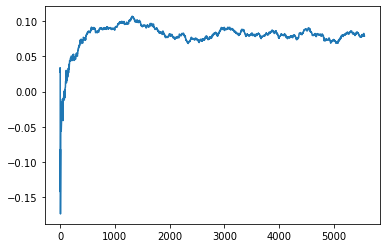

Thread: 1 iteration: 880
RAM mDiffFit_291 FROM: 448 --> 192 reward: 0.34844792031250005
Saving ...


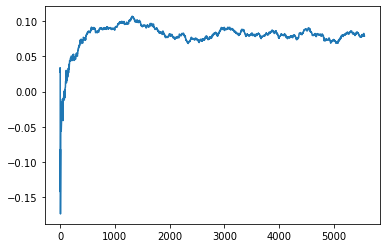

Thread: 6 iteration: 920
RAM mDiffFit_302 FROM: 768 --> 192 reward: 0.42920309765625
Thread: 2 iteration: 934
RAM mDiffFit_197 FROM: 576 --> 256 reward: 0.033476526953125016
Saving ...


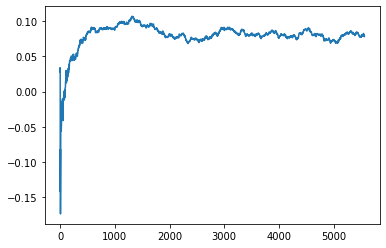

Thread: 4 iteration: 930
RAM mDiffFit_109 FROM: 512 --> 192 reward: 0.18328646015625005
Thread: 2 iteration: 935
RAM mDiffFit_216 FROM: 384 --> 192 reward: 0.09127342929687497
Saving ...


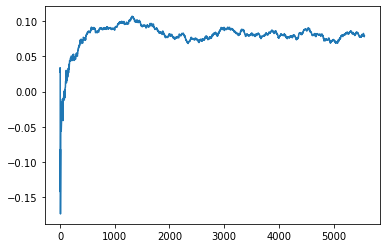

Thread: 5 iteration: 980
RAM mBackground_19 FROM: 2432 --> 1408 reward: -0.078833496375
Thread: 6 iteration: 921
RAM mDiffFit_201 FROM: 320 --> 192 reward: 0.04833590742187498
Thread: 1 iteration: 881
RAM mDiffFit_298 FROM: 3008 --> 192 reward: 0.230054624609375
Thread: 4 iteration: 931
RAM mDiffFit_106 FROM: 640 --> 192 reward: 0.20191926992187498
Thread: 2 iteration: 936
RAM mDiffFit_22 FROM: 192 --> 192 reward: 0.050976570703124974
Thread: 6 iteration: 922
RAM mDiffFit_240 FROM: 576 --> 192 reward: 0.211226570703125
Thread: 1 iteration: 882
RAM mBackground_38 FROM: 1664 --> 320 reward: 0.41015725090625
Thread: 5 iteration: 981
RAM mDiffFit_120 FROM: 1536 --> 1984 reward: -0.011367190234375015
Thread: 4 iteration: 932
RAM mProject_10 FROM: 576 --> 896 reward: 0.9362593839374999
Thread: 3 iteration: 917
RAM mBackground_52 FROM: 2240 --> 1408 reward: -0.017838358851562524
Thread: 6 iteration: 923
RAM mBackground_60 FROM: 2432 --> 1408 reward: -0.05132689154687504
Thread: 2 iteration: 9

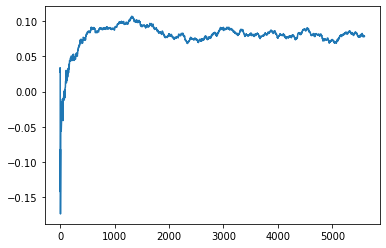

Thread: 3 iteration: 920
RAM mDiffFit_62 FROM: 2944 --> 192 reward: 0.237289005078125
Thread: 6 iteration: 925
RAM mDiffFit_216 FROM: 2304 --> 192 reward: 0.039796639843749995
Thread: 4 iteration: 935
RAM mDiffFit_379 FROM: 2944 --> 448 reward: 0.03869524414062499
Thread: 5 iteration: 985
RAM mDiffFit_249 FROM: 2048 --> 192 reward: 0.21220309765625
Thread: 3 iteration: 921
RAM mDiffFit_231 FROM: 2624 --> 192 reward: 0.17628900507812495
Thread: 4 iteration: 936
RAM mDiffFit_349 FROM: 2240 --> 192 reward: 0.2593619253906249
Thread: 6 iteration: 926
RAM mDiffFit_146 FROM: 2752 --> 192 reward: 0.2201561953125
Thread: 5 iteration: 986
RAM mDiffFit_381 FROM: 320 --> 192 reward: 0.018726526953124975
Thread: 3 iteration: 922
RAM mDiffFit_297 FROM: 1088 --> 192 reward: 0.147729115625
Thread: 5 iteration: 987
RAM mDiffFit_71 FROM: 3008 --> 192 reward: 0.1659060640625
Thread: 6 iteration: 927
RAM mBackground_73 FROM: 2240 --> 192 reward: 0.6840604592578122
Thread: 4 iteration: 937
RAM mProject_46

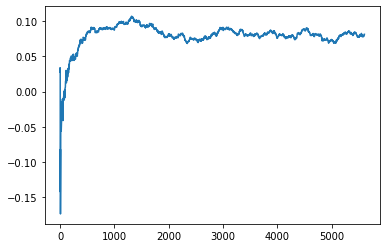

Thread: 2 iteration: 940
RAM mDiffFit_235 FROM: 1792 --> 192 reward: 0.15983590742187498
Thread: 2 iteration: 941
RAM mBackground_30 FROM: 1472 --> 320 reward: 0.2826285936640625
Thread: 4 iteration: 938
RAM mBackground_63 FROM: 1792 --> 320 reward: 0.42537746237499996
Thread: 3 iteration: 924
RAM mBackground_3 FROM: 1024 --> 320 reward: 0.3984845770625
Thread: 5 iteration: 989
RAM mDiffFit_129 FROM: 1216 --> 192 reward: 0.20582550898437502
Saving ...


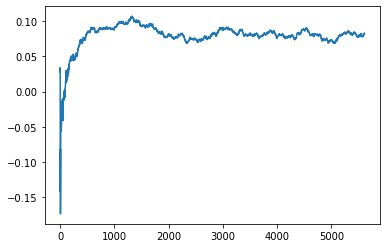

Thread: 5 iteration: 990
RAM mDiffFit_150 FROM: 1792 --> 256 reward: 0.28504168125
Thread: 5 iteration: 991
RAM mDiffFit_126 FROM: 704 --> 192 reward: 0.4357187171874999
Thread: 4 iteration: 939
RAM mDiffFit_48 FROM: 1920 --> 192 reward: 0.49203909257812495
Thread: 3 iteration: 925
RAM mProject_73 FROM: 3008 --> 256 reward: -1.0
Thread: 6 iteration: 928
RAM mDiffFit_151 FROM: 1024 --> 192 reward: 0.41799482265625
Thread: 5 iteration: 992
RAM mDiffFit_270 FROM: 576 --> 192 reward: 0.44325780976562484
Saving ...


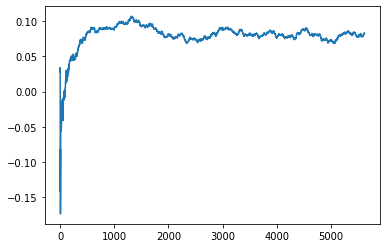

Thread: 4 iteration: 940
RAM mProject_37 FROM: 2432 --> 256 reward: -1.0
Thread: 1 iteration: 886
RAM mBackground_84 FROM: 448 --> 320 reward: 0.19163891800781244
Thread: 3 iteration: 926
RAM mDiffFit_138 FROM: 1216 --> 2752 reward: 0.016153694140624997
Thread: 6 iteration: 929
RAM mProject_53 FROM: 1024 --> 256 reward: -1.0
Thread: 2 iteration: 942
RAM mBackground_45 FROM: 1152 --> 320 reward: 0.3744740049296875
Thread: 5 iteration: 993
RAM mDiffFit_79 FROM: 3008 --> 2560 reward: -0.04198964531250002
Thread: 3 iteration: 927
RAM mDiffFit_26 FROM: 2752 --> 2560 reward: -0.0024765707031249896
Thread: 2 iteration: 943
RAM mDiffFit_133 FROM: 768 --> 256 reward: 0.41551048593750006
Thread: 5 iteration: 994
RAM mDiffFit_363 FROM: 2880 --> 256 reward: 0.433174491015625
Thread: 3 iteration: 928
RAM mBackground_14 FROM: 1600 --> 320 reward: 0.3730764673046875
Thread: 2 iteration: 944
RAM mDiffFit_410 FROM: 2432 --> 1984 reward: -0.03988807460937501
Thread: 3 iteration: 929
RAM mBackground_33 F

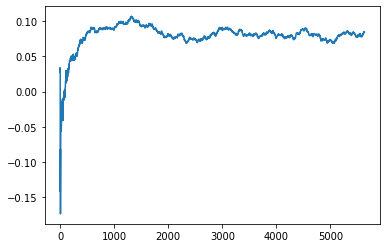

Thread: 3 iteration: 930
RAM mProject_43 FROM: 1984 --> 256 reward: -1.0
Thread: 4 iteration: 941
RAM mProject_90 FROM: 1472 --> 256 reward: -1.0
Thread: 1 iteration: 887
RAM mProject_57 FROM: 1152 --> 256 reward: -1.0
Saving ...


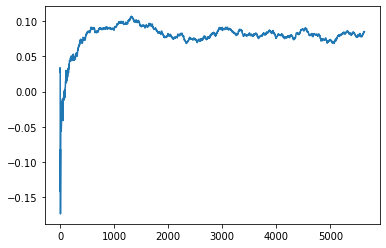

Thread: 6 iteration: 930
RAM mDiffFit_62 FROM: 1344 --> 192 reward: 0.23370309765625
Thread: 1 iteration: 888
RAM mProject_41 FROM: 1984 --> 256 reward: -1.0
Thread: 5 iteration: 995
RAM mDiffFit_255 FROM: 576 --> 192 reward: 0.25276561953125004
Thread: 6 iteration: 931
RAM mBackground_25 FROM: 1920 --> 192 reward: 0.7795899623749999
Thread: 4 iteration: 942
RAM mDiffFit_234 FROM: 2432 --> 192 reward: 0.20729940351562498
Thread: 1 iteration: 889
RAM mDiffFit_340 FROM: 1216 --> 256 reward: 0.274726570703125
Thread: 5 iteration: 996
RAM mDiffFit_263 FROM: 1152 --> 192 reward: 0.27852342929687496
Thread: 6 iteration: 932
RAM mProject_90 FROM: 704 --> 896 reward: 0.9274140645468749
Thread: 2 iteration: 946
RAM mDiffFit_33 FROM: 128 --> 2560 reward: -0.977104203125
Thread: 5 iteration: 997
RAM mDiffFit_369 FROM: 1600 --> 192 reward: 0.180554668359375
Thread: 6 iteration: 933
RAM mDiffFit_89 FROM: 1216 --> 192 reward: 0.28386196914062495
Thread: 2 iteration: 947
RAM mConcatFit_1 FROM: 2688 -

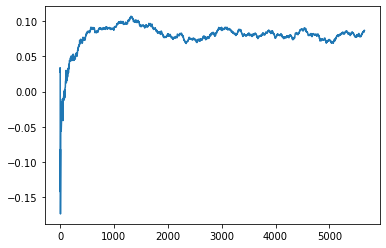

Thread: 5 iteration: 1000
RAM mProject_88 FROM: 960 --> 256 reward: -1.0
Thread: 4 iteration: 943
RAM mDiffFit_43 FROM: 2432 --> 192 reward: 0.202549403515625
Thread: 3 iteration: 933
RAM mProject_77 FROM: 1216 --> 2112 reward: -0.08713582692187487
Thread: 2 iteration: 949
RAM mDiffFit_121 FROM: 2624 --> 192 reward: 0.15910407187499997
Thread: 6 iteration: 936
RAM mProject_27 FROM: 2880 --> 256 reward: -1.0
Saving ...


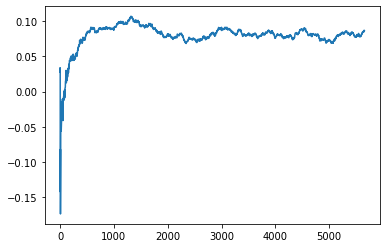

Thread: 1 iteration: 890
RAM mDiffFit_113 FROM: 2816 --> 320 reward: 0.202585819921875
Thread: 3 iteration: 934
RAM mDiffFit_162 FROM: 1664 --> 192 reward: 0.23905203593750002
Thread: 4 iteration: 944
RAM mBackground_14 FROM: 2112 --> 192 reward: 0.7599913427578125
Thread: 5 iteration: 1001
RAM mDiffFit_232 FROM: 960 --> 320 reward: 0.06107809765625001
Saving ...


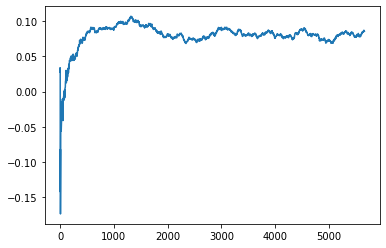

Thread: 2 iteration: 950
RAM mDiffFit_236 FROM: 1792 --> 320 reward: 0.16722393828125004
Thread: 6 iteration: 937
RAM mDiffFit_347 FROM: 640 --> 320 reward: 0.08875000000000001
Thread: 4 iteration: 945
RAM mDiffFit_339 FROM: 768 --> 320 reward: 0.17542190234375005
Thread: 1 iteration: 891
RAM mDiffFit_270 FROM: 832 --> 320 reward: 0.17849995624999992
Thread: 3 iteration: 935
RAM mDiffFit_176 FROM: 512 --> 320 reward: 0.023031239062500028
Thread: 5 iteration: 1002
RAM mDiffFit_256 FROM: 1024 --> 320 reward: 0.09642707968750003
Thread: 6 iteration: 938
RAM mDiffFit_296 FROM: 128 --> 2560 reward: -0.80975522109375
Thread: 1 iteration: 892
RAM mDiffFit_113 FROM: 704 --> 320 reward: 0.190523429296875
Thread: 2 iteration: 951
RAM mDiffFit_53 FROM: 2304 --> 320 reward: 0.0629686734375
Thread: 3 iteration: 936
RAM mDiffFit_347 FROM: 2880 --> 2560 reward: -0.006210951171874996
Thread: 2 iteration: 952
RAM mDiffFit_347 FROM: 1536 --> 320 reward: 0.13205466835937502
Thread: 1 iteration: 893
RAM m

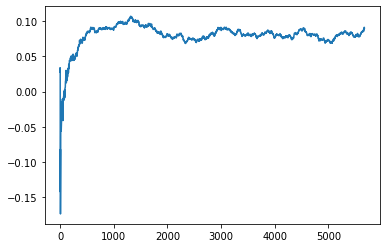

Thread: 6 iteration: 940
RAM mDiffFit_242 FROM: 2304 --> 320 reward: 0.08749995625000001
Thread: 3 iteration: 938
RAM mProject_90 FROM: 1600 --> 2112 reward: 0.036197476804687455
Thread: 5 iteration: 1003
RAM mDiffFit_288 FROM: 192 --> 320 reward: -0.18454168125
Thread: 6 iteration: 941
RAM mProject_26 FROM: 1472 --> 256 reward: -1.0
Thread: 4 iteration: 946
RAM mDiffFit_37 FROM: 2304 --> 320 reward: 0.07397130585937498
Thread: 3 iteration: 939
RAM mDiffFit_346 FROM: 2432 --> 320 reward: 0.24229940351562504
Thread: 1 iteration: 895
RAM mBackground_87 FROM: 2816 --> 704 reward: 0.060383456140625
Thread: 5 iteration: 1004
RAM mDiffFit_410 FROM: 576 --> 320 reward: 0.061559889453124975
Thread: 6 iteration: 942
RAM mDiffFit_5 FROM: 1408 --> 320 reward: 0.07636714648437501
Thread: 4 iteration: 947
RAM mBackground_86 FROM: 1216 --> 320 reward: 0.33486023611718757
Saving ...


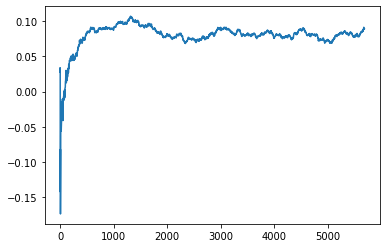

Thread: 3 iteration: 940
RAM mDiffFit_119 FROM: 1408 --> 192 reward: 0.3076353984375
Thread: 1 iteration: 896
RAM mDiffFit_343 FROM: 192 --> 320 reward: -0.481752676171875
Thread: 5 iteration: 1005
RAM mDiffFit_154 FROM: 960 --> 320 reward: 0.06351039843749998
Thread: 4 iteration: 948
RAM mBackground_81 FROM: 128 --> 1920 reward: 0.285936868203125
Thread: 3 iteration: 941
RAM mDiffFit_20 FROM: 2880 --> 320 reward: 0.199351439453125
Thread: 6 iteration: 943
RAM mProject_70 FROM: 832 --> 896 reward: 0.9198746849531249
Thread: 2 iteration: 954
RAM mDiffFit_153 FROM: 2432 --> 2560 reward: -0.025583362500000012
Thread: 1 iteration: 897
RAM mDiffFit_107 FROM: 192 --> 2560 reward: -0.37130466835937503
Thread: 5 iteration: 1006
RAM mDiffFit_363 FROM: 1024 --> 2752 reward: -0.030585907421875023
Thread: 4 iteration: 949
RAM mBackground_83 FROM: 320 --> 704 reward: -0.33283120653906245
Thread: 3 iteration: 942
RAM mDiffFit_42 FROM: 1024 --> 256 reward: 0.20282292031250004
Thread: 6 iteration: 944

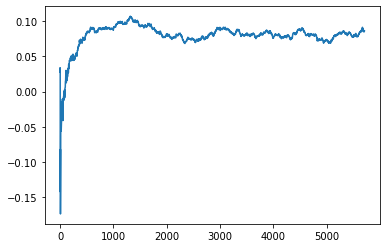

Thread: 4 iteration: 950
RAM mDiffFit_248 FROM: 640 --> 192 reward: 0.14270573007812498
Thread: 2 iteration: 958
RAM mBackground_28 FROM: 1024 --> 1408 reward: -0.12883880643749995
Thread: 3 iteration: 945
RAM mProject_11 FROM: 832 --> 896 reward: 0.926289064546875
Thread: 5 iteration: 1007
RAM mDiffFit_297 FROM: 2048 --> 2560 reward: 0.03391672500000001
Thread: 2 iteration: 959
RAM mBackground_30 FROM: 2752 --> 1408 reward: -0.046032525953124966
Thread: 4 iteration: 951
RAM mDiffFit_128 FROM: 320 --> 192 reward: 0.13836719023437502
Thread: 3 iteration: 946
RAM mProject_29 FROM: 1664 --> 2240 reward: 0.013132615499999967
Thread: 6 iteration: 948
RAM mDiffFit_353 FROM: 2816 --> 2560 reward: -0.005843760937500001
Thread: 3 iteration: 947
RAM mConcatFit_1 FROM: 2176 --> 704 reward: 0.12880203593749998
Saving ...


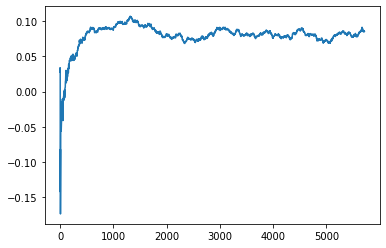

Thread: 2 iteration: 960
RAM mDiffFit_139 FROM: 1344 --> 192 reward: 0.618617190234375
Thread: 4 iteration: 952
RAM mDiffFit_155 FROM: 1792 --> 2112 reward: -0.000135398437499986
Thread: 3 iteration: 948
RAM mDiffFit_34 FROM: 2496 --> 2112 reward: -0.044070375390624986
Thread: 2 iteration: 961
RAM mDiffFit_46 FROM: 1792 --> 192 reward: 0.18716922617187498
Thread: 3 iteration: 949
RAM mDiffFit_372 FROM: 1664 --> 192 reward: 0.123143120703125
Thread: 2 iteration: 962
RAM mProject_28 FROM: 1792 --> 256 reward: -1.0
Saving ...


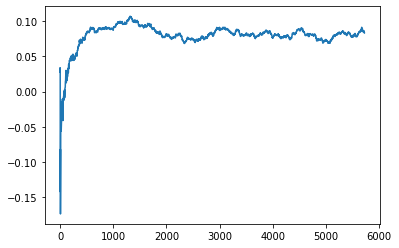

Thread: 1 iteration: 900
RAM mDiffFit_254 FROM: 1664 --> 192 reward: 0.295742190234375
Saving ...


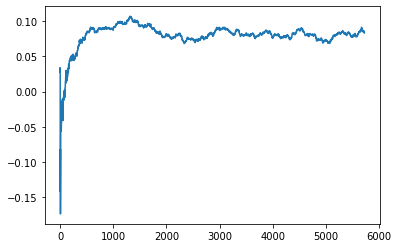

Thread: 3 iteration: 950
RAM mProject_27 FROM: 256 --> 896 reward: 0.9194696849531251
Thread: 5 iteration: 1008
RAM mDiffFit_217 FROM: 1664 --> 192 reward: 0.242908827734375
Thread: 1 iteration: 901
RAM mProject_55 FROM: 256 --> 896 reward: 0.9327709441406248
Thread: 6 iteration: 949
RAM mBgModel_2 FROM: 512 --> 320 reward: 0.24775310640624992
Thread: 3 iteration: 951
RAM mProject_34 FROM: 3008 --> 2112 reward: -0.18006971821874995
Thread: 5 iteration: 1009
RAM mProject_56 FROM: 576 --> 896 reward: 0.9432587635312499
Thread: 4 iteration: 953
RAM mDiffFit_310 FROM: 2432 --> 192 reward: 0.25180980195312497
Saving ...


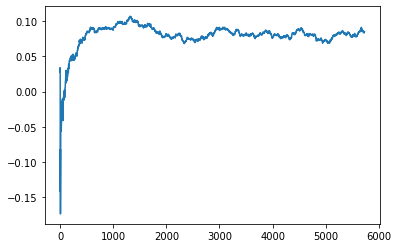

Thread: 6 iteration: 950
RAM mProject_70 FROM: 1984 --> 2112 reward: 0.022235670281249984
Thread: 1 iteration: 902
RAM mDiffFit_196 FROM: 1920 --> 192 reward: 0.40333595117187493
Thread: 3 iteration: 952
RAM mBackground_42 FROM: 1728 --> 192 reward: 0.737678395171875
Thread: 2 iteration: 963
RAM mDiffFit_225 FROM: 384 --> 320 reward: 0.0174270796875
Saving ...


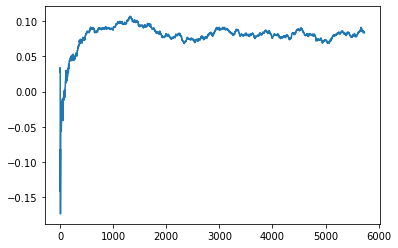

Thread: 5 iteration: 1010
RAM mDiffFit_314 FROM: 1600 --> 192 reward: 0.17243480195312497
Thread: 6 iteration: 951
RAM mDiffFit_356 FROM: 1792 --> 192 reward: 0.30260674804687504
Thread: 1 iteration: 903
RAM mDiffFit_195 FROM: 1664 --> 192 reward: 0.21130725703124997
Thread: 5 iteration: 1011
RAM mDiffFit_133 FROM: 640 --> 192 reward: 0.090333275
Thread: 3 iteration: 953
RAM mDiffFit_90 FROM: 2176 --> 192 reward: -0.51091755625
Thread: 2 iteration: 964
RAM mDiffFit_55 FROM: 1280 --> 192 reward: 0.168020796875
Thread: 5 iteration: 1012
RAM mDiffFit_12 FROM: 1024 --> 192 reward: 0.298065110546875
Thread: 3 iteration: 954
RAM mImgtbl_2 FROM: 960 --> 320 reward: 0.5451874343750002
Thread: 6 iteration: 952
RAM mDiffFit_337 FROM: 1280 --> 384 reward: 0.23951561953125003
Thread: 5 iteration: 1013
RAM mBackground_49 FROM: 2176 --> 192 reward: 0.7235040166015624
Thread: 1 iteration: 904
RAM mProject_13 FROM: 576 --> 896 reward: 0.9295750043437498
Thread: 4 iteration: 954
RAM mBackground_43 FROM

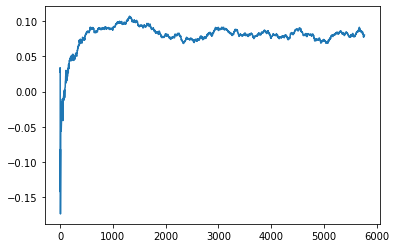

Thread: 4 iteration: 960
RAM mProject_4 FROM: 960 --> 256 reward: -1.0
Thread: 3 iteration: 956
RAM mDiffFit_13 FROM: 1856 --> 256 reward: 0.1744687171875
Thread: 3 iteration: 957
RAM mDiffFit_119 FROM: 3008 --> 256 reward: 0.06424460390625
Thread: 3 iteration: 958
RAM mDiffFit_98 FROM: 448 --> 2112 reward: -0.0652187171875
Thread: 3 iteration: 959
RAM mProject_66 FROM: 2624 --> 2112 reward: -0.08330314183593757
Thread: 6 iteration: 957
RAM mProject_59 FROM: 1664 --> 2752 reward: 0.11737202702343733
Thread: 4 iteration: 961
RAM mProject_57 FROM: 2176 --> 1024 reward: 0.15319766714062485
Saving ...


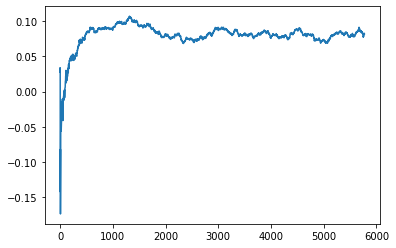

Thread: 2 iteration: 970
RAM mProject_22 FROM: 1088 --> 2752 reward: -0.029198098546875193
Saving ...


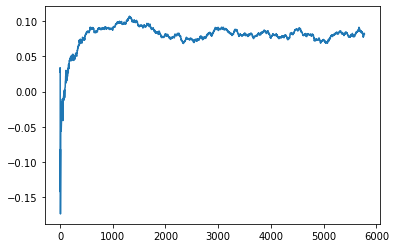

Thread: 1 iteration: 910
RAM mDiffFit_219 FROM: 3008 --> 256 reward: 0.13398170429687498
Saving ...


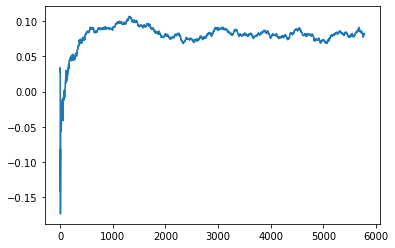

Thread: 3 iteration: 960
RAM mDiffFit_196 FROM: 576 --> 256 reward: 0.06792966835937499
Thread: 4 iteration: 962
RAM mBackground_47 FROM: 1472 --> 704 reward: 0.10758059678125001
Thread: 6 iteration: 958
RAM mDiffFit_144 FROM: 448 --> 256 reward: 0.05519269921875004
Thread: 1 iteration: 911
RAM mBackground_63 FROM: 2496 --> 704 reward: 0.17717562142968749
Thread: 2 iteration: 971
RAM mDiffFit_406 FROM: 1344 --> 256 reward: 0.081247323828125
Thread: 3 iteration: 961
RAM mDiffFit_408 FROM: 3008 --> 2560 reward: -0.012695331640624995
Thread: 6 iteration: 959
RAM mDiffFit_422 FROM: 3008 --> 2560 reward: -0.03611464531250003
Thread: 2 iteration: 972
RAM mDiffFit_150 FROM: 2112 --> 256 reward: 0.274562478125
Thread: 4 iteration: 963
RAM mDiffFit_60 FROM: 640 --> 256 reward: 0.009781195312500018
Thread: 1 iteration: 912
RAM mDiffFit_190 FROM: 2880 --> 448 reward: 0.03756243437500001
Thread: 3 iteration: 962
RAM mDiffFit_15 FROM: 2112 --> 448 reward: 0.04436973515624999
Thread: 4 iteration: 96

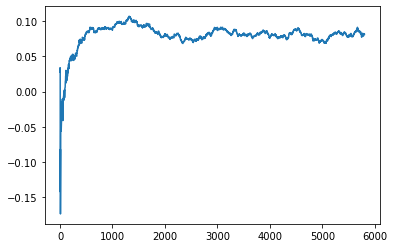

Thread: 6 iteration: 960
RAM mProject_40 FROM: 1152 --> 256 reward: -1.0
Thread: 2 iteration: 973
RAM mBackground_6 FROM: 2304 --> 704 reward: 0.11534293460937504
Saving ...


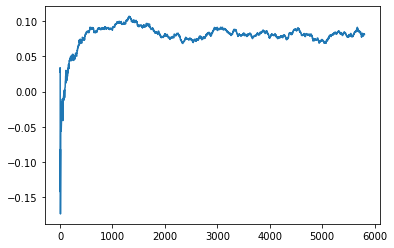

Thread: 5 iteration: 1020
RAM mDiffFit_86 FROM: 3008 --> 2560 reward: -0.009695331640624996
Thread: 6 iteration: 961
RAM mDiffFit_101 FROM: 2432 --> 2624 reward: 0.03327088437500002
Thread: 2 iteration: 974
RAM mProject_2 FROM: 1792 --> 2752 reward: 0.16057626792187488
Thread: 3 iteration: 966
RAM mProject_12 FROM: 1536 --> 2112 reward: 0.002587610249999994
Thread: 1 iteration: 917
RAM mDiffFit_67 FROM: 2496 --> 320 reward: 0.12361451406250001
Thread: 5 iteration: 1021
RAM mDiffFit_26 FROM: 832 --> 320 reward: 0.15371876093750003
Thread: 6 iteration: 962
RAM mDiffFit_47 FROM: 576 --> 256 reward: 0.24220836250000002
Thread: 2 iteration: 975
RAM mDiffFit_333 FROM: 1728 --> 320 reward: 0.136986969140625
Thread: 1 iteration: 918
RAM mDiffFit_315 FROM: 128 --> 320 reward: -0.48378387148437507
Thread: 6 iteration: 963
RAM mBackground_89 FROM: 1152 --> 704 reward: 0.08245472625781251
Thread: 5 iteration: 1022
RAM mDiffFit_95 FROM: 2176 --> 256 reward: 0.15505725703125
Thread: 1 iteration: 919

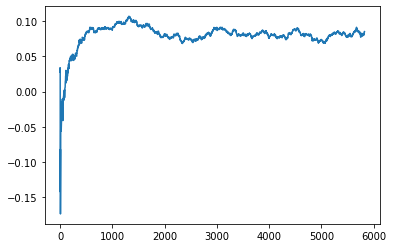

Thread: 4 iteration: 970
RAM mProject_10 FROM: 256 --> 896 reward: 0.9292375043437499
Thread: 3 iteration: 967
RAM mDiffFit_104 FROM: 1216 --> 2560 reward: -0.004356748046875011
Thread: 6 iteration: 965
RAM mDiffFit_184 FROM: 1856 --> 2560 reward: 0.011664092578124998
Thread: 4 iteration: 971
RAM mProject_75 FROM: 1536 --> 256 reward: -1.0
Thread: 2 iteration: 976
RAM mDiffFit_2 FROM: 448 --> 192 reward: 0.37830730078124997
Thread: 3 iteration: 968
RAM mDiffFit_142 FROM: 320 --> 192 reward: 0.18096876093749997
Thread: 4 iteration: 972
RAM mDiffFit_243 FROM: 1536 --> 192 reward: 0.41938280976562503
Thread: 6 iteration: 966
RAM mDiffFit_170 FROM: 832 --> 192 reward: 0.23389579687500006
Thread: 2 iteration: 977
RAM mProject_8 FROM: 2048 --> 256 reward: -1.0
Saving ...


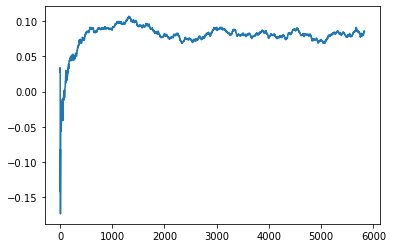

Thread: 1 iteration: 920
RAM mBackground_70 FROM: 2560 --> 1408 reward: -0.030297189937500024
Thread: 4 iteration: 973
RAM mDiffFit_319 FROM: 576 --> 192 reward: 0.21236719023437503
Thread: 2 iteration: 978
RAM mDiffFit_123 FROM: 2304 --> 192 reward: 0.26457809765625
Thread: 6 iteration: 967
RAM mProject_84 FROM: 1280 --> 256 reward: -1.0
Thread: 5 iteration: 1025
RAM mDiffFit_284 FROM: 1664 --> 192 reward: 0.2469270359375
Thread: 1 iteration: 921
RAM mDiffFit_241 FROM: 1792 --> 192 reward: 0.23067185859375
Thread: 4 iteration: 974
RAM mDiffFit_234 FROM: 1856 --> 192 reward: 0.190471305859375
Thread: 2 iteration: 979
RAM mDiffFit_142 FROM: 128 --> 256 reward: -0.46702606171875
Thread: 4 iteration: 975
RAM mDiffFit_56 FROM: 512 --> 192 reward: 0.36876039843749997
Thread: 6 iteration: 968
RAM mDiffFit_366 FROM: 2752 --> 192 reward: 0.19342181484375
Saving ...


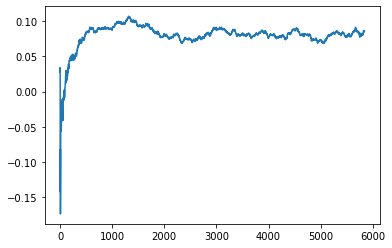

Thread: 2 iteration: 980
RAM mDiffFit_249 FROM: 448 --> 2752 reward: 0.01102097187499998
Thread: 4 iteration: 976
RAM mProject_24 FROM: 896 --> 256 reward: -1.0
Thread: 3 iteration: 969
RAM mDiffFit_48 FROM: 1920 --> 2752 reward: 0.024197964062500008
Saving ...


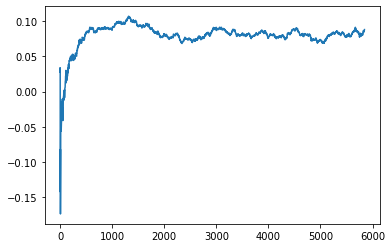

Thread: 3 iteration: 970
RAM mBackground_62 FROM: 3008 --> 1408 reward: -0.06203214064062499
Thread: 4 iteration: 977
RAM mDiffFit_71 FROM: 2432 --> 256 reward: 0.26261977890625005
Thread: 6 iteration: 969
RAM mDiffFit_285 FROM: 768 --> 256 reward: 0.198020840625
Thread: 4 iteration: 978
RAM mBackground_85 FROM: 1216 --> 768 reward: 0.09222379346093747
Saving ...


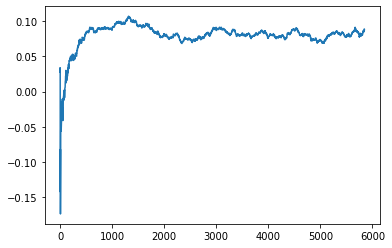

Thread: 6 iteration: 970
RAM mDiffFit_133 FROM: 768 --> 2752 reward: -0.010523385546875024
Thread: 4 iteration: 979
RAM mProject_9 FROM: 896 --> 2240 reward: -0.22407827442187486
Thread: 2 iteration: 981
RAM mProject_14 FROM: 1728 --> 256 reward: -1.0
Thread: 5 iteration: 1026
RAM mProject_27 FROM: 1344 --> 256 reward: -1.0
Thread: 1 iteration: 922
RAM mDiffFit_133 FROM: 768 --> 192 reward: 0.19401561953125002
Saving ...


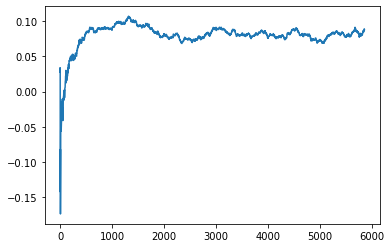

Thread: 4 iteration: 980
RAM mDiffFit_373 FROM: 320 --> 192 reward: 0.14322657070312497
Thread: 6 iteration: 971
RAM mBackground_54 FROM: 2560 --> 1408 reward: -0.029759689937500052
Thread: 5 iteration: 1027
RAM mDiffFit_69 FROM: 2624 --> 192 reward: 0.14443743437499998
Thread: 2 iteration: 982
RAM mDiffFit_160 FROM: 1088 --> 192 reward: 0.22471353984375
Thread: 6 iteration: 972
RAM mDiffFit_277 FROM: 512 --> 192 reward: 0.23191146015625
Thread: 4 iteration: 981
RAM mDiffFit_248 FROM: 1280 --> 192 reward: 0.16490360664062503
Thread: 2 iteration: 983
RAM mDiffFit_84 FROM: 512 --> 192 reward: 0.18316146015625
Thread: 6 iteration: 973
RAM mDiffFit_405 FROM: 896 --> 192 reward: 0.23928646015624996
Thread: 4 iteration: 982
RAM mProject_63 FROM: 1984 --> 256 reward: -1.0
Thread: 3 iteration: 971
RAM mDiffFit_270 FROM: 384 --> 192 reward: 0.25509371718750007
Thread: 5 iteration: 1028
RAM mDiffFit_170 FROM: 3008 --> 192 reward: 0.14554155
Thread: 4 iteration: 983
RAM mDiffFit_237 FROM: 832 -->

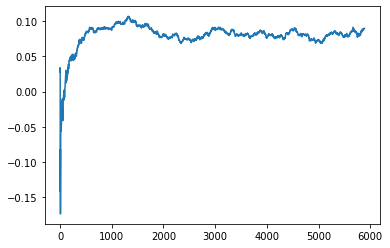

Thread: 5 iteration: 1030
RAM mBackground_49 FROM: 2496 --> 1408 reward: -0.02723791126562498
Thread: 3 iteration: 974
RAM mProject_78 FROM: 1024 --> 256 reward: -1.0
Thread: 2 iteration: 986
RAM mDiffFit_56 FROM: 1088 --> 320 reward: 0.20854685859374997
Saving ...


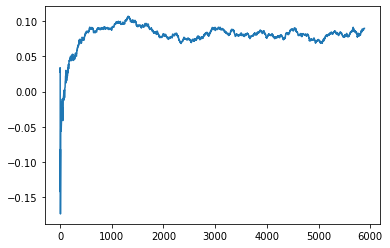

Thread: 6 iteration: 980
RAM mDiffFit_228 FROM: 832 --> 320 reward: 0.311388074609375
Saving ...


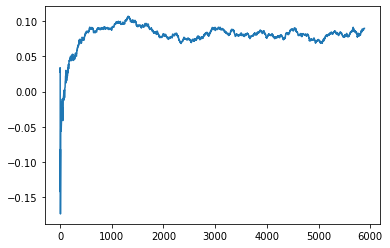

Thread: 4 iteration: 990
RAM mBgModel_1 FROM: 2944 --> 320 reward: 0.5546435421875
Thread: 1 iteration: 927
RAM mDiffFit_282 FROM: 1152 --> 320 reward: 0.387354246875
Thread: 5 iteration: 1031
RAM mDiffFit_411 FROM: 2176 --> 320 reward: 0.4161770796875
Thread: 3 iteration: 975
RAM mBackground_17 FROM: 1216 --> 1792 reward: 0.026583930984375025
Thread: 2 iteration: 987
RAM mDiffFit_278 FROM: 2944 --> 320 reward: -0.13307857890625002
Thread: 1 iteration: 928
RAM mDiffFit_73 FROM: 640 --> 320 reward: 0.163479203125
Thread: 5 iteration: 1032
RAM mDiffFit_270 FROM: 2880 --> 320 reward: 0.22963263476562495
Thread: 4 iteration: 991
RAM mConcatFit_3 FROM: 1472 --> 704 reward: 0.06454369968750001
Thread: 6 iteration: 981
RAM mDiffFit_39 FROM: 2688 --> 320 reward: 0.033585776171875005
Thread: 3 iteration: 976
RAM mDiffFit_85 FROM: 256 --> 2752 reward: -0.14695046523437502
Thread: 4 iteration: 992
RAM mDiffFit_9 FROM: 2880 --> 192 reward: 0.020374693749999964
Thread: 1 iteration: 929
RAM mBackgro

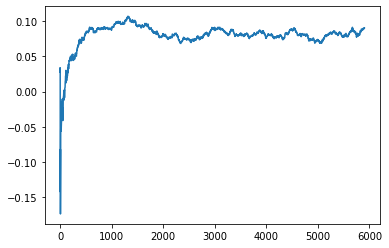

Thread: 1 iteration: 930
RAM mBackground_60 FROM: 1600 --> 1792 reward: 0.026810099898437474
Thread: 3 iteration: 978
RAM mBackground_76 FROM: 1216 --> 1792 reward: 0.04349056046093748
Thread: 6 iteration: 984
RAM mDiffFit_98 FROM: 2816 --> 192 reward: 0.21229681484375
Thread: 1 iteration: 931
RAM mDiffFit_393 FROM: 832 --> 192 reward: 0.21758331875000003
Thread: 5 iteration: 1034
RAM mDiffFit_189 FROM: 2176 --> 192 reward: 0.23858590742187494
Thread: 3 iteration: 979
RAM mProject_90 FROM: 960 --> 256 reward: -1.0
Thread: 2 iteration: 988
RAM mDiffFit_62 FROM: 1280 --> 192 reward: 0.10692958085937498
Thread: 6 iteration: 985
RAM mDiffFit_392 FROM: 2944 --> 192 reward: 0.22155462460937497
Thread: 1 iteration: 932
RAM mBackground_8 FROM: 256 --> 704 reward: -0.4895841294765625
Saving ...


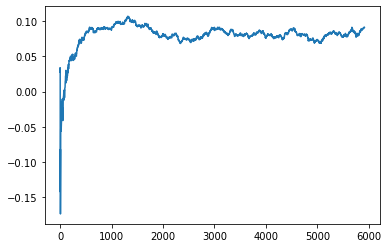

Thread: 3 iteration: 980
RAM mProject_71 FROM: 2304 --> 2112 reward: -0.01826161270312506
Thread: 4 iteration: 994
RAM mDiffFit_203 FROM: 2496 --> 192 reward: 0.34068747812499994
Thread: 5 iteration: 1035
RAM mDiffFit_188 FROM: 256 --> 192 reward: -0.05329690234375
Thread: 6 iteration: 986
RAM mDiffFit_34 FROM: 576 --> 192 reward: 0.42422657070312497
Thread: 2 iteration: 989
RAM mDiffFit_215 FROM: 2112 --> 192 reward: 0.21178900507812493
Thread: 1 iteration: 933
RAM mDiffFit_394 FROM: 320 --> 192 reward: 0.491575596484375
Thread: 4 iteration: 995
RAM mDiffFit_314 FROM: 1088 --> 192 reward: 0.644710994921875
Thread: 3 iteration: 981
RAM mDiffFit_336 FROM: 2304 --> 192 reward: 0.6227578535156251
Thread: 5 iteration: 1036
RAM mDiffFit_287 FROM: 2752 --> 192 reward: 0.33461188164062505
Saving ...


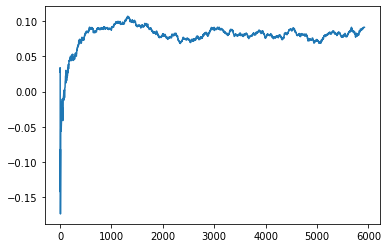

Thread: 2 iteration: 990
RAM mBackground_11 FROM: 1856 --> 1792 reward: -0.028539042554687477
Thread: 6 iteration: 987
RAM mBackground_29 FROM: 2816 --> 192 reward: 0.895228531390625
Thread: 1 iteration: 934
RAM mDiffFit_255 FROM: 2176 --> 192 reward: 0.2774270359375
Thread: 4 iteration: 996
RAM mDiffFit_277 FROM: 2944 --> 192 reward: 0.439825465234375
Thread: 5 iteration: 1037
RAM mDiffFit_237 FROM: 1600 --> 256 reward: 0.19201039843749995
Thread: 2 iteration: 991
RAM mDiffFit_189 FROM: 3008 --> 256 reward: 0.18905199218749996
Thread: 6 iteration: 988
RAM mDiffFit_238 FROM: 2432 --> 256 reward: 0.14104159375
Thread: 4 iteration: 997
RAM mDiffFit_218 FROM: 1216 --> 256 reward: 0.153018208203125
Thread: 1 iteration: 935
RAM mBackground_35 FROM: 2176 --> 1792 reward: -0.018772239234375005
Thread: 5 iteration: 1038
RAM mDiffFit_264 FROM: 2944 --> 320 reward: 0.089575421484375
Thread: 2 iteration: 992
RAM mBackground_19 FROM: 192 --> 896 reward: -0.622097972234375
Thread: 1 iteration: 936


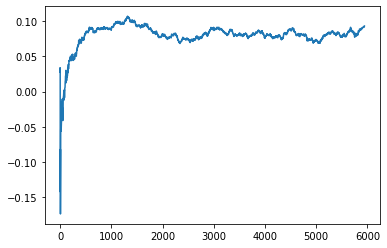

Thread: 6 iteration: 990
RAM mDiffFit_254 FROM: 1408 --> 320 reward: 0.17603646015625002
Thread: 3 iteration: 983
RAM mDiffFit_57 FROM: 2880 --> 1984 reward: 0.03085938046874995
Thread: 4 iteration: 999
RAM mDiffFit_386 FROM: 128 --> 320 reward: -0.363408871484375
Saving ...


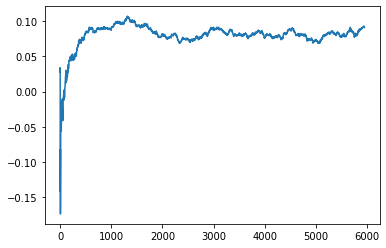

Thread: 5 iteration: 1040
RAM mDiffFit_159 FROM: 1344 --> 320 reward: 0.05270046523437499
Thread: 6 iteration: 991
RAM mDiffFit_185 FROM: 640 --> 448 reward: 0.11407555273437502
Saving ...


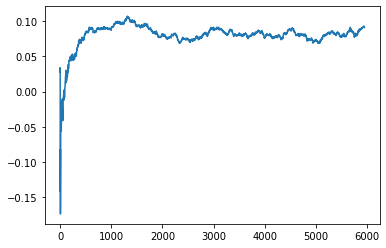

Thread: 4 iteration: 1000
RAM mBackground_45 FROM: 2432 --> 704 reward: 0.09284181499218744
Thread: 3 iteration: 984
RAM mBackground_20 FROM: 896 --> 320 reward: 0.24377411650000003
Thread: 2 iteration: 994
RAM mDiffFit_267 FROM: 2432 --> 2560 reward: -0.024083362500000004
Thread: 4 iteration: 1001
RAM mDiffFit_300 FROM: 1536 --> 320 reward: 0.08196871718750001
Thread: 6 iteration: 992
RAM mDiffFit_328 FROM: 1088 --> 320 reward: 0.18736192539062504
Thread: 5 iteration: 1041
RAM mBackground_63 FROM: 2752 --> 1984 reward: -0.330639095765625
Thread: 2 iteration: 995
RAM mDiffFit_299 FROM: 1216 --> 320 reward: 0.09810674804687497
Thread: 4 iteration: 1002
RAM mDiffFit_217 FROM: 512 --> 320 reward: 0.05210415937500001
Thread: 5 iteration: 1042
RAM mDiffFit_50 FROM: 1408 --> 320 reward: 0.16826553203124994
Thread: 6 iteration: 993
RAM mProject_70 FROM: 704 --> 896 reward: 0.918839684953125
Thread: 1 iteration: 938
RAM mDiffFit_261 FROM: 1728 --> 320 reward: 0.10955725703125
Thread: 4 iterati

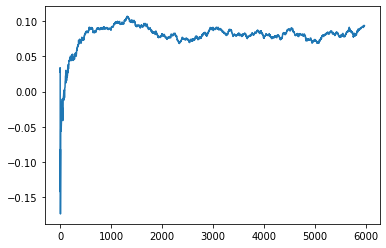

Thread: 1 iteration: 940
RAM mDiffFit_356 FROM: 960 --> 256 reward: 0.14143488945312496
Thread: 6 iteration: 996
RAM mDiffFit_367 FROM: 1792 --> 256 reward: 0.1921666375
Thread: 5 iteration: 1045
RAM mProject_70 FROM: 2368 --> 1024 reward: 0.14503903614843738
Thread: 2 iteration: 996
RAM mDiffFit_301 FROM: 2944 --> 832 reward: 0.03938017734375
Thread: 3 iteration: 987
RAM mDiffFit_273 FROM: 1472 --> 2752 reward: 0.03595840624999999
Thread: 1 iteration: 941
RAM mDiffFit_385 FROM: 2432 --> 256 reward: 0.12721867343749999
Thread: 6 iteration: 997
RAM mDiffFit_308 FROM: 1856 --> 256 reward: 0.110604115625
Thread: 5 iteration: 1046
RAM mDiffFit_403 FROM: 1280 --> 256 reward: 0.17068747812500001
Thread: 1 iteration: 942
RAM mDiffFit_139 FROM: 256 --> 256 reward: -0.010197920312499942
Thread: 3 iteration: 988
RAM mBackground_6 FROM: 1344 --> 320 reward: 0.36642267384375005
Thread: 2 iteration: 997
RAM mDiffFit_389 FROM: 1024 --> 192 reward: 0.7111432519531251
Thread: 5 iteration: 1047
RAM mDi

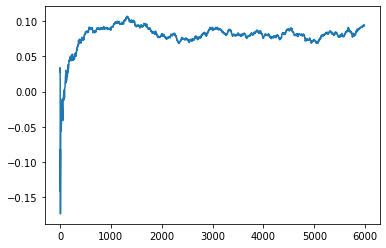

Thread: 3 iteration: 990
RAM mDiffFit_110 FROM: 2688 --> 192 reward: 0.29873433671875005
Thread: 2 iteration: 999
RAM mDiffFit_187 FROM: 640 --> 192 reward: 0.008492102734374979
Thread: 1 iteration: 945
RAM mDiffFit_263 FROM: 2816 --> 448 reward: 0.08655984570312499
Saving ...


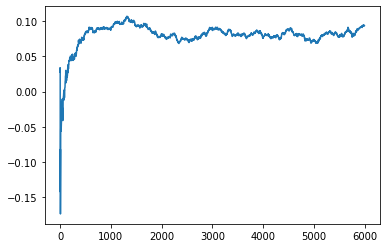

Thread: 5 iteration: 1050
RAM mDiffFit_190 FROM: 896 --> 320 reward: 0.10714842929687503
Saving ...


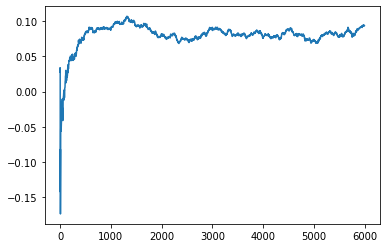

Thread: 2 iteration: 1000
RAM mDiffFit_302 FROM: 2432 --> 448 reward: 0.05350500234374996
Thread: 4 iteration: 1007
RAM mDiffFit_363 FROM: 576 --> 192 reward: 0.17526561953125003
Saving ...


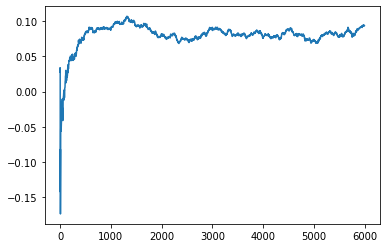

Thread: 6 iteration: 1000
RAM mDiffFit_261 FROM: 2624 --> 448 reward: 0.2624427429687499
Thread: 3 iteration: 991
RAM mDiffFit_396 FROM: 2368 --> 320 reward: -0.5701728648437501
Thread: 1 iteration: 946
RAM mBackground_82 FROM: 1664 --> 1408 reward: 0.019564999999999992
Thread: 2 iteration: 1001
RAM mDiffFit_24 FROM: 2624 --> 320 reward: 0.09144265546875001
Thread: 4 iteration: 1008
RAM mDiffFit_233 FROM: 384 --> 320 reward: 0.03019269921874998
Thread: 5 iteration: 1051
RAM mDiffFit_116 FROM: 2368 --> 320 reward: 0.19983331875000004
Thread: 6 iteration: 1001
RAM mDiffFit_3 FROM: 1216 --> 256 reward: 0.21455988945312499
Thread: 3 iteration: 992
RAM mDiffFit_86 FROM: 2176 --> 2112 reward: -0.051812565625000015
Thread: 2 iteration: 1002
RAM mBackground_69 FROM: 512 --> 1792 reward: -0.19202182796874995
Thread: 4 iteration: 1009
RAM mDiffFit_389 FROM: 320 --> 320 reward: 0.019403650390625027
Thread: 6 iteration: 1002
RAM mBackground_81 FROM: 1280 --> 320 reward: 0.30205254929687503
Thread:

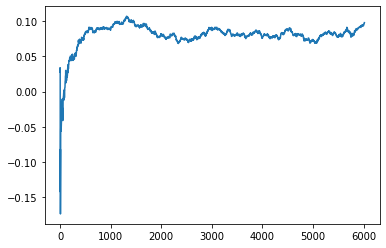

Thread: 4 iteration: 1010
RAM mBackground_89 FROM: 256 --> 704 reward: -0.4731769278671875
Thread: 6 iteration: 1006
RAM mDiffFit_344 FROM: 896 --> 192 reward: 0.24339842929687505
Thread: 5 iteration: 1053
RAM mProject_87 FROM: 2944 --> 256 reward: -1.0
Thread: 3 iteration: 994
RAM mDiffFit_419 FROM: 1728 --> 192 reward: 0.186054624609375
Thread: 5 iteration: 1054
RAM mImgtbl_1 FROM: 2816 --> 1344 reward: -0.014273112812500044
Thread: 3 iteration: 995
RAM mBackground_81 FROM: 960 --> 320 reward: 0.31251144265625
Thread: 5 iteration: 1055
RAM mProject_41 FROM: 896 --> 256 reward: -1.0
Thread: 1 iteration: 948
RAM mDiffFit_391 FROM: 2944 --> 192 reward: 0.4628228328125
Thread: 3 iteration: 996
RAM mDiffFit_250 FROM: 1088 --> 192 reward: 0.16847652695312498
Thread: 5 iteration: 1056
RAM mProject_82 FROM: 1984 --> 256 reward: -1.0
Thread: 2 iteration: 1007
RAM mConcatFit_1 FROM: 768 --> 704 reward: -0.02479585812499996
Thread: 1 iteration: 949
RAM mDiffFit_242 FROM: 1344 --> 448 reward: 0.

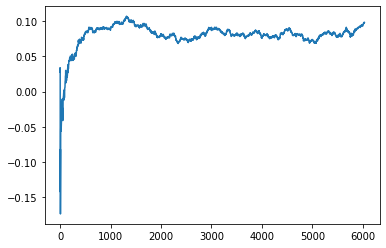

Thread: 1 iteration: 950
RAM mProject_15 FROM: 640 --> 896 reward: 0.9332209441406248
Thread: 4 iteration: 1011
RAM mBackground_89 FROM: 1728 --> 704 reward: 0.050661516601562435
Thread: 1 iteration: 951
RAM mDiffFit_18 FROM: 1280 --> 192 reward: 0.272460951171875
Thread: 4 iteration: 1012
RAM mDiffFit_95 FROM: 1856 --> 192 reward: 0.16038013359374997
Thread: 2 iteration: 1009
RAM mBackground_7 FROM: 832 --> 320 reward: 0.2613638181093751
Thread: 5 iteration: 1058
RAM mDiffFit_88 FROM: 2496 --> 2560 reward: 0.023257853515625
Thread: 1 iteration: 952
RAM mDiffFit_298 FROM: 2880 --> 2560 reward: 0.02114325195312499
Thread: 4 iteration: 1013
RAM mProject_55 FROM: 1024 --> 256 reward: -1.0
Thread: 3 iteration: 997
RAM mProject_48 FROM: 3008 --> 256 reward: -1.0
Thread: 6 iteration: 1007
RAM mBackground_65 FROM: 1920 --> 768 reward: 0.167390932796875
Thread: 5 iteration: 1059
RAM mDiffFit_329 FROM: 3008 --> 2560 reward: -0.00957033164062501
Thread: 1 iteration: 953
RAM mDiffFit_95 FROM: 275

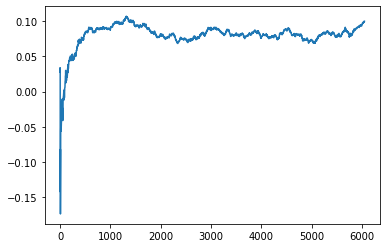

Thread: 5 iteration: 1060
RAM mDiffFit_250 FROM: 1664 --> 320 reward: 0.132854159375
Saving ...


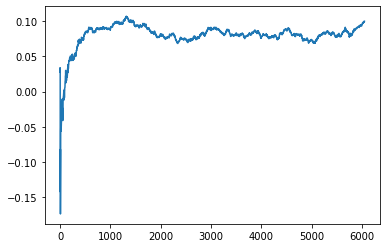

Thread: 6 iteration: 1010
RAM mProject_53 FROM: 2560 --> 256 reward: -1.0
Saving ...


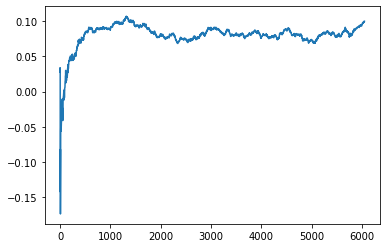

Thread: 2 iteration: 1010
RAM mDiffFit_217 FROM: 1472 --> 320 reward: 0.090117146484375
Saving ...


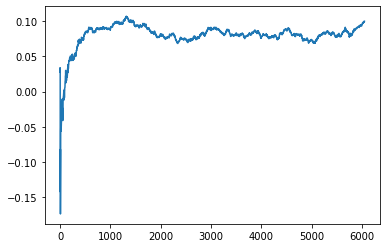

Thread: 3 iteration: 1000
RAM mDiffFit_398 FROM: 192 --> 320 reward: -0.29585420312499994
Thread: 5 iteration: 1061
RAM mDiffFit_211 FROM: 1088 --> 320 reward: 0.09556765546874998
Thread: 3 iteration: 1001
RAM mProject_66 FROM: 2112 --> 2112 reward: 0.0018449999999999966
Thread: 4 iteration: 1016
RAM mProject_31 FROM: 2496 --> 2112 reward: -0.06788544539062487
Thread: 1 iteration: 956
RAM mDiffFit_345 FROM: 1344 --> 320 reward: 0.26025517734375
Thread: 2 iteration: 1011
RAM mDiffFit_274 FROM: 320 --> 1984 reward: -0.11004422617187501
Thread: 5 iteration: 1062
RAM mDiffFit_333 FROM: 2880 --> 2560 reward: -0.005210951171875002
Thread: 3 iteration: 1002
RAM mDiffFit_90 FROM: 384 --> 1984 reward: -0.15322393828125
Thread: 4 iteration: 1017
RAM mProject_8 FROM: 2624 --> 2112 reward: -0.07778360517187499
Thread: 6 iteration: 1011
RAM mDiffFit_80 FROM: 448 --> 1984 reward: -0.07889320820312501
Thread: 2 iteration: 1012
RAM mDiffFit_210 FROM: 1664 --> 2560 reward: 0.06738030859375
Thread: 5 it

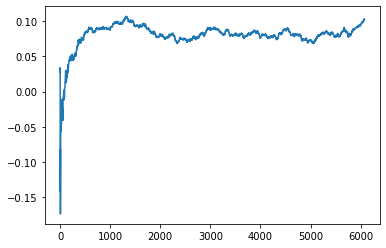

Thread: 4 iteration: 1020
RAM mDiffFit_218 FROM: 896 --> 384 reward: 0.05065101796874999
Thread: 6 iteration: 1013
RAM mBackground_24 FROM: 1792 --> 192 reward: 0.6988798378281251
Thread: 5 iteration: 1065
RAM mBackground_6 FROM: 832 --> 704 reward: 0.01883264919531248
Thread: 1 iteration: 959
RAM mDiffFit_276 FROM: 1600 --> 256 reward: 0.21227865039062502
Thread: 4 iteration: 1021
RAM mDiffFit_322 FROM: 960 --> 256 reward: 0.21241146015625004
Thread: 6 iteration: 1014
RAM mDiffFit_8 FROM: 2752 --> 320 reward: 0.09608327500000002
Thread: 5 iteration: 1066
RAM mDiffFit_332 FROM: 2048 --> 1984 reward: -0.0037421902343750136
Thread: 4 iteration: 1022
RAM mDiffFit_169 FROM: 512 --> 256 reward: 0.11947915937499998
Saving ...


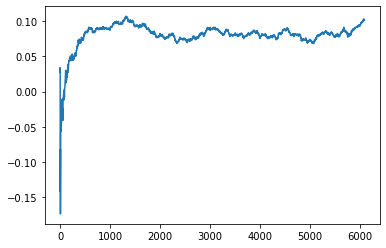

Thread: 1 iteration: 960
RAM mBackground_23 FROM: 1600 --> 704 reward: 0.11618508692187497
Thread: 5 iteration: 1067
RAM mBackground_76 FROM: 896 --> 704 reward: 0.06801391800781251
Thread: 4 iteration: 1023
RAM mDiffFit_34 FROM: 1344 --> 1984 reward: -0.075565154296875
Thread: 1 iteration: 961
RAM mProject_51 FROM: 1984 --> 1024 reward: 0.18751726680468747
Thread: 3 iteration: 1005
RAM mDiffFit_243 FROM: 1920 --> 1984 reward: 0.07845581757812498
Thread: 5 iteration: 1068
RAM mProject_60 FROM: 2688 --> 256 reward: -1.0
Thread: 2 iteration: 1014
RAM mBackground_67 FROM: 1216 --> 704 reward: 0.06078002464843749
Thread: 4 iteration: 1024
RAM mDiffFit_399 FROM: 2560 --> 448 reward: 0.13524995625000003
Thread: 3 iteration: 1006
RAM mBackground_90 FROM: 192 --> 704 reward: -0.62780894265625
Thread: 1 iteration: 962
RAM mDiffFit_155 FROM: 1280 --> 256 reward: 0.08971867343749998
Thread: 5 iteration: 1069
RAM mProject_87 FROM: 1408 --> 1024 reward: 0.14764312828125004
Thread: 6 iteration: 1015

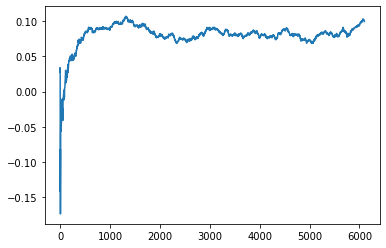

Thread: 5 iteration: 1070
RAM mDiffFit_107 FROM: 2048 --> 256 reward: 0.19001039843749998
Thread: 6 iteration: 1016
RAM mDiffFit_82 FROM: 1600 --> 256 reward: 0.14241404882812503
Thread: 2 iteration: 1016
RAM mDiffFit_356 FROM: 832 --> 256 reward: 0.27242190234374997
Thread: 4 iteration: 1026
RAM mDiffFit_102 FROM: 1152 --> 256 reward: 0.41048438046874997
Thread: 1 iteration: 964
RAM mDiffFit_323 FROM: 384 --> 256 reward: -0.041317786718750096
Thread: 3 iteration: 1008
RAM mDiffFit_60 FROM: 704 --> 256 reward: 0.19307550898437498
Thread: 6 iteration: 1017
RAM mDiffFit_30 FROM: 896 --> 320 reward: 0.09739320820312501
Thread: 4 iteration: 1027
RAM mDiffFit_276 FROM: 2944 --> 256 reward: 0.13903115156249998
Thread: 1 iteration: 965
RAM mDiffFit_122 FROM: 704 --> 256 reward: 0.13497393828125004
Thread: 3 iteration: 1009
RAM mDiffFit_336 FROM: 1024 --> 256 reward: -0.03684389218750004
Thread: 6 iteration: 1018
RAM mDiffFit_369 FROM: 2112 --> 192 reward: 0.11285924921874999
Thread: 1 iterati

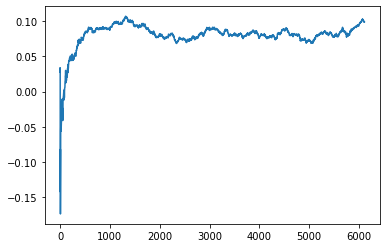

Thread: 3 iteration: 1010
RAM mDiffFit_240 FROM: 512 --> 256 reward: -0.012541724999999976
Thread: 3 iteration: 1011
RAM mDiffFit_12 FROM: 2432 --> 192 reward: 0.313028562890625
Thread: 4 iteration: 1029
RAM mProject_44 FROM: 768 --> 896 reward: 0.9092743655625001
Thread: 5 iteration: 1071
RAM mDiffFit_337 FROM: 2752 --> 192 reward: 0.5252655320312501
Thread: 6 iteration: 1019
RAM mProject_51 FROM: 2496 --> 1024 reward: 0.10449255951562503
Thread: 2 iteration: 1017
RAM mDiffFit_205 FROM: 1920 --> 192 reward: 0.241429668359375
Thread: 3 iteration: 1012
RAM mBackground_48 FROM: 1408 --> 192 reward: 0.7117171263593749
Thread: 1 iteration: 967
RAM mDiffFit_182 FROM: 2752 --> 832 reward: 0.029682257031250006
Saving ...


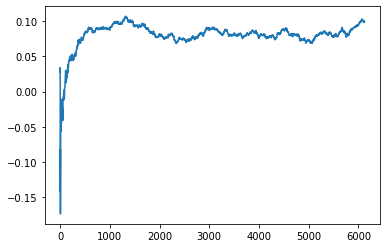

Thread: 6 iteration: 1020
RAM mBackground_77 FROM: 1664 --> 2304 reward: 0.045360622734375
Saving ...


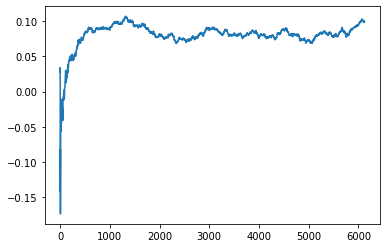

Thread: 4 iteration: 1030
RAM mDiffFit_97 FROM: 576 --> 256 reward: 0.12381769921875001
Thread: 5 iteration: 1072
RAM mDiffFit_234 FROM: 2304 --> 256 reward: 0.17084371718750002
Thread: 2 iteration: 1018
RAM mDiffFit_396 FROM: 192 --> 256 reward: -0.14341926992187498
Thread: 1 iteration: 968
RAM mDiffFit_335 FROM: 1024 --> 256 reward: 0.16672915937500002
Thread: 5 iteration: 1073
RAM mDiffFit_191 FROM: 1856 --> 256 reward: 0.162770796875
Thread: 2 iteration: 1019
RAM mDiffFit_296 FROM: 2560 --> 192 reward: 0.166169182421875
Thread: 5 iteration: 1074
RAM mBackground_2 FROM: 832 --> 192 reward: 0.7008260819921875
Thread: 4 iteration: 1031
RAM mDiffFit_210 FROM: 960 --> 192 reward: 0.24715623906250006
Thread: 5 iteration: 1075
RAM mBackground_77 FROM: 1472 --> 320 reward: 0.4355115918515625
Saving ...


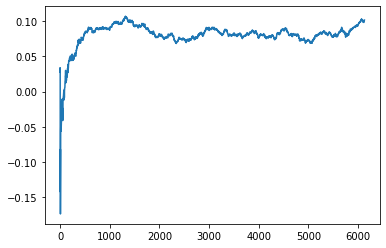

Thread: 2 iteration: 1020
RAM mProject_8 FROM: 2880 --> 256 reward: -1.0
Thread: 3 iteration: 1013
RAM mDiffFit_411 FROM: 2944 --> 192 reward: 0.435393033203125
Thread: 5 iteration: 1076
RAM mBackground_66 FROM: 1792 --> 320 reward: 0.36577986247656247
Thread: 3 iteration: 1014
RAM mProject_2 FROM: 1472 --> 256 reward: -1.0
Thread: 6 iteration: 1021
RAM mProject_75 FROM: 3008 --> 256 reward: -1.0
Thread: 1 iteration: 969
RAM mDiffFit_253 FROM: 192 --> 320 reward: -0.40248179179687493
Thread: 3 iteration: 1015
RAM mBackground_90 FROM: 2688 --> 192 reward: 0.651597610265625
Thread: 5 iteration: 1077
RAM mDiffFit_407 FROM: 1216 --> 192 reward: 0.31072134960937503
Saving ...


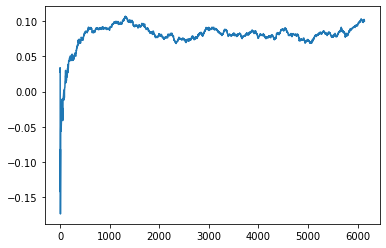

Thread: 1 iteration: 970
RAM mBgModel_1 FROM: 1856 --> 320 reward: 0.644287469375
Thread: 2 iteration: 1021
RAM mBackground_19 FROM: 960 --> 320 reward: 0.32112932796875
Thread: 6 iteration: 1022
RAM mDiffFit_385 FROM: 2624 --> 448 reward: 0.09722652695312499
Thread: 1 iteration: 971
RAM mDiffFit_177 FROM: 128 --> 192 reward: -0.503726614453125
Thread: 5 iteration: 1078
RAM mDiffFit_123 FROM: 384 --> 192 reward: 0.112773429296875
Thread: 2 iteration: 1022
RAM mProject_3 FROM: 2688 --> 256 reward: -1.0
Thread: 4 iteration: 1032
RAM mBackground_47 FROM: 2112 --> 192 reward: 0.7961919771640623
Thread: 3 iteration: 1016
RAM mDiffFit_56 FROM: 2304 --> 192 reward: 0.5937499562499999
Thread: 6 iteration: 1023
RAM mDiffFit_277 FROM: 128 --> 192 reward: -0.2352343804687499
Thread: 5 iteration: 1079
RAM mDiffFit_65 FROM: 1600 --> 448 reward: 0.08375517734375001
Thread: 2 iteration: 1023
RAM mDiffFit_396 FROM: 2176 --> 448 reward: 0.11933845234375001
Thread: 4 iteration: 1033
RAM mBackground_54 F

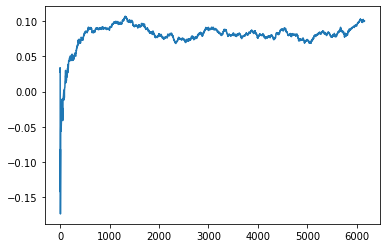

Thread: 5 iteration: 1080
RAM mDiffFit_331 FROM: 1728 --> 2560 reward: -0.005156239062500019
Thread: 2 iteration: 1024
RAM mDiffFit_350 FROM: 448 --> 384 reward: 0.039395840625
Thread: 4 iteration: 1034
RAM mDiffFit_65 FROM: 1984 --> 2560 reward: 0.013054712109375
Thread: 3 iteration: 1018
RAM mViewer_3 FROM: 2688 --> 640 reward: 0.12704985562500004
Thread: 1 iteration: 973
RAM mDiffFit_110 FROM: 2368 --> 2560 reward: -0.07698446796875001
Thread: 5 iteration: 1081
RAM mDiffFit_359 FROM: 1088 --> 256 reward: 0.17589842929687502
Thread: 5 iteration: 1082
RAM mDiffFit_231 FROM: 768 --> 256 reward: 0.0883228765625
Thread: 1 iteration: 974
RAM mDiffFit_49 FROM: 896 --> 256 reward: 0.15686455781249997
Thread: 5 iteration: 1083
RAM mProject_85 FROM: 2112 --> 1024 reward: 0.15847862793750003
Thread: 6 iteration: 1025
RAM mDiffFit_126 FROM: 1280 --> 256 reward: 0.3768437171875
Thread: 1 iteration: 975
RAM mDiffFit_200 FROM: 2624 --> 256 reward: 0.33664053203124994
Thread: 6 iteration: 1026
RAM 

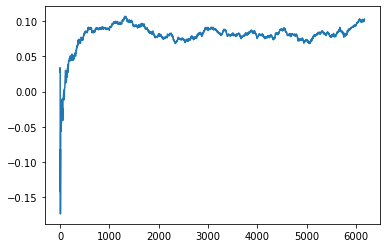

Thread: 3 iteration: 1020
RAM mBgModel_3 FROM: 2688 --> 320 reward: 0.6182154620312499
Thread: 5 iteration: 1084
RAM mBackground_71 FROM: 2112 --> 704 reward: 0.10720655422656249
Thread: 6 iteration: 1028
RAM mDiffFit_139 FROM: 832 --> 320 reward: 0.27788022109374994
Thread: 2 iteration: 1026
RAM mDiffFit_267 FROM: 2304 --> 1984 reward: 0.010013030859374987
Thread: 4 iteration: 1037
RAM mDiffFit_89 FROM: 1920 --> 1984 reward: 0.007572920312499988
Thread: 2 iteration: 1027
RAM mBackground_19 FROM: 2496 --> 704 reward: 0.07572690191406245
Thread: 1 iteration: 977
RAM mBackground_21 FROM: 2688 --> 704 reward: 0.09893795925781244
Thread: 3 iteration: 1021
RAM mDiffFit_179 FROM: 576 --> 320 reward: 0.127033827734375
Thread: 5 iteration: 1085
RAM mBackground_46 FROM: 2112 --> 1408 reward: -0.054206978468749965
Thread: 6 iteration: 1029
RAM mDiffFit_184 FROM: 2112 --> 192 reward: 0.20973429296874999
Thread: 4 iteration: 1038
RAM mDiffFit_40 FROM: 1792 --> 256 reward: 0.21049995625000006
Threa

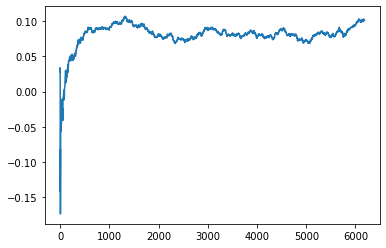

Thread: 6 iteration: 1030
RAM mDiffFit_260 FROM: 896 --> 256 reward: 0.10002079687499997
Thread: 3 iteration: 1022
RAM mDiffFit_226 FROM: 1216 --> 384 reward: 0.07270831875000001
Thread: 4 iteration: 1039
RAM mDiffFit_32 FROM: 1216 --> 384 reward: 0.09617707968749999
Thread: 2 iteration: 1029
RAM mBackground_81 FROM: 896 --> 1792 reward: -0.05179703943749994
Thread: 6 iteration: 1031
RAM mBackground_3 FROM: 384 --> 1792 reward: -0.24849509859375002
Thread: 3 iteration: 1023
RAM mDiffFit_382 FROM: 2688 --> 384 reward: 0.3796874781249999
Thread: 5 iteration: 1087
RAM mDiffFit_28 FROM: 2368 --> 384 reward: 0.161395796875
Thread: 1 iteration: 979
RAM mBackground_42 FROM: 2048 --> 1408 reward: -0.0236321523125
Saving ...


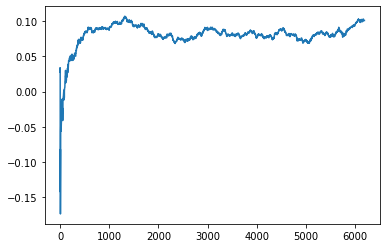

Thread: 4 iteration: 1040
RAM mDiffFit_132 FROM: 384 --> 384 reward: -0.010859380468750002
Thread: 6 iteration: 1032
RAM mDiffFit_236 FROM: 384 --> 384 reward: -0.15771880468749996
Thread: 5 iteration: 1088
RAM mDiffFit_225 FROM: 2560 --> 192 reward: 0.26898951406250005
Thread: 3 iteration: 1024
RAM mDiffFit_5 FROM: 1344 --> 192 reward: 0.30982809765625
Saving ...


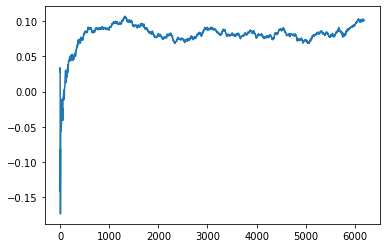

Thread: 1 iteration: 980
RAM mDiffFit_259 FROM: 2816 --> 192 reward: 0.220289005078125
Thread: 4 iteration: 1041
RAM mBackground_56 FROM: 1152 --> 1792 reward: 0.014646940843749985
Thread: 3 iteration: 1025
RAM mDiffFit_91 FROM: 576 --> 192 reward: 0.19566404882812502
Thread: 6 iteration: 1033
RAM mDiffFit_285 FROM: 1344 --> 192 reward: 0.18185933671875001
Thread: 1 iteration: 981
RAM mBackground_64 FROM: 192 --> 704 reward: -0.9499372392343749
Thread: 4 iteration: 1042
RAM mBackground_25 FROM: 2048 --> 192 reward: 0.7701389050312499
Thread: 5 iteration: 1089
RAM mBackground_15 FROM: 128 --> 1792 reward: 0.253377763375
Thread: 6 iteration: 1034
RAM mDiffFit_278 FROM: 2112 --> 192 reward: 0.12435143945312503
Thread: 3 iteration: 1026
RAM mDiffFit_182 FROM: 768 --> 192 reward: 0.2152187171875
Thread: 1 iteration: 982
RAM mDiffFit_256 FROM: 2880 --> 448 reward: 0.030619691406249955
Thread: 3 iteration: 1027
RAM mDiffFit_346 FROM: 2944 --> 448 reward: 0.11864570937499999
Saving ...


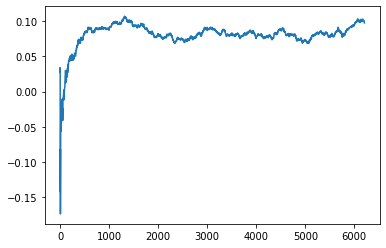

Thread: 5 iteration: 1090
RAM mDiffFit_352 FROM: 704 --> 192 reward: 0.259044269921875
Thread: 4 iteration: 1043
RAM mDiffFit_182 FROM: 2624 --> 192 reward: 0.20444783281249992
Thread: 6 iteration: 1035
RAM mDiffFit_74 FROM: 1984 --> 192 reward: 0.18996871718750002
Thread: 1 iteration: 983
RAM mDiffFit_226 FROM: 832 --> 192 reward: 0.16517185859375
Thread: 5 iteration: 1091
RAM mDiffFit_314 FROM: 2816 --> 192 reward: 0.21872126210937504
Thread: 3 iteration: 1028
RAM mDiffFit_311 FROM: 768 --> 192 reward: 0.16391404882812502
Thread: 4 iteration: 1044
RAM mDiffFit_215 FROM: 1408 --> 192 reward: 0.365687478125
Thread: 6 iteration: 1036
RAM mDiffFit_256 FROM: 128 --> 256 reward: -0.4137083625
Thread: 5 iteration: 1092
RAM mDiffFit_309 FROM: 2944 --> 384 reward: 0.05333323124999999
Thread: 4 iteration: 1045
RAM mDiffFit_164 FROM: 704 --> 256 reward: 0.19445314140625003
Thread: 6 iteration: 1037
RAM mDiffFit_165 FROM: 2176 --> 384 reward: 0.27095309765625
Thread: 3 iteration: 1029
RAM mDiffF

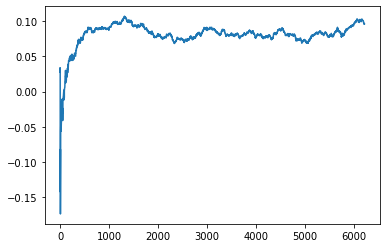

Thread: 2 iteration: 1030
RAM mDiffFit_318 FROM: 1280 --> 384 reward: 0.12782292031249998
Thread: 5 iteration: 1093
RAM mDiffFit_99 FROM: 1216 --> 256 reward: 0.19832292031249998
Thread: 4 iteration: 1046
RAM mDiffFit_60 FROM: 2880 --> 256 reward: 0.12326816445312502
Thread: 1 iteration: 985
RAM mDiffFit_269 FROM: 1600 --> 192 reward: 0.258757809765625
Saving ...


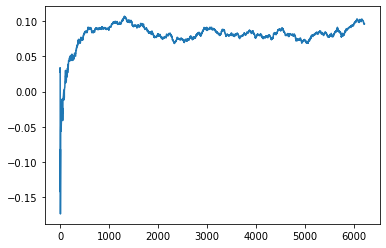

Thread: 3 iteration: 1030
RAM mDiffFit_61 FROM: 2688 --> 320 reward: 0.15706506679687499
Thread: 2 iteration: 1031
RAM mBackground_89 FROM: 576 --> 1792 reward: -0.14907555915625
Thread: 4 iteration: 1047
RAM mBackground_17 FROM: 896 --> 1792 reward: -0.125779490140625
Thread: 3 iteration: 1031
RAM mDiffFit_33 FROM: 2560 --> 320 reward: 0.14434889453125
Thread: 1 iteration: 986
RAM mDiffFit_396 FROM: 2240 --> 320 reward: 0.2742811953125
Thread: 5 iteration: 1094
RAM mProject_48 FROM: 2112 --> 2240 reward: 0.02795114411718744
Thread: 6 iteration: 1038
RAM mDiffFit_326 FROM: 1088 --> 192 reward: 0.25081769921874997
Thread: 2 iteration: 1032
RAM mDiffFit_53 FROM: 1856 --> 192 reward: 0.18432809765625002
Thread: 4 iteration: 1048
RAM mDiffFit_53 FROM: 3008 --> 320 reward: 0.06619520039062499
Thread: 5 iteration: 1095
RAM mDiffFit_341 FROM: 1984 --> 320 reward: 0.165229159375
Thread: 6 iteration: 1039
RAM mBackground_61 FROM: 1536 --> 1792 reward: -0.066650037625
Thread: 3 iteration: 1032
R

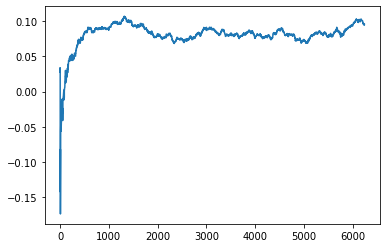

Thread: 6 iteration: 1040
RAM mDiffFit_352 FROM: 1600 --> 384 reward: 0.09519006679687497
Thread: 5 iteration: 1096
RAM mDiffFit_91 FROM: 2624 --> 832 reward: 0.0194061953125
Thread: 2 iteration: 1034
RAM mAdd_1 FROM: 2944 --> 768 reward: 0.266705555078125
Thread: 3 iteration: 1033
RAM mDiffFit_290 FROM: 2432 --> 832 reward: 0.03176820820312501
Thread: 5 iteration: 1097
RAM mDiffFit_206 FROM: 512 --> 832 reward: -0.08110679179687498
Thread: 2 iteration: 1035
RAM mDiffFit_386 FROM: 1792 --> 832 reward: -0.009919313671875006
Thread: 5 iteration: 1098
RAM mBackground_7 FROM: 2944 --> 192 reward: 0.6297639037265624
Thread: 6 iteration: 1041
RAM mDiffFit_333 FROM: 1472 --> 832 reward: -0.04470059648437498
Thread: 2 iteration: 1036
RAM mDiffFit_263 FROM: 384 --> 448 reward: -0.031161460156250015
Thread: 5 iteration: 1099
RAM mDiffFit_294 FROM: 2944 --> 448 reward: 0.10633068632812501
Thread: 6 iteration: 1042
RAM mBackground_17 FROM: 2880 --> 192 reward: 0.7281040658984373
Thread: 1 iteratio

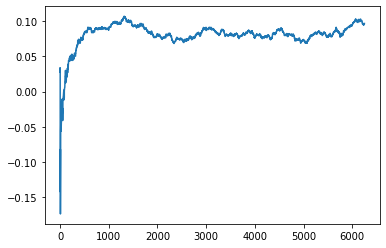

Thread: 5 iteration: 1100
RAM mDiffFit_58 FROM: 2560 --> 448 reward: 0.05039838554687501
Thread: 6 iteration: 1043
RAM mProject_56 FROM: 1472 --> 1024 reward: 0.15624374343749994
Saving ...


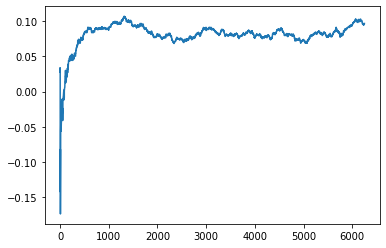

Thread: 4 iteration: 1050
RAM mDiffFit_5 FROM: 1408 --> 448 reward: 0.06208590742187499
Thread: 1 iteration: 988
RAM mDiffFit_6 FROM: 640 --> 448 reward: 0.028317699218750013
Thread: 2 iteration: 1038
RAM mDiffFit_141 FROM: 256 --> 448 reward: -0.100669269921875
Thread: 5 iteration: 1101
RAM mProject_86 FROM: 1856 --> 1024 reward: 0.20631981142968744
Thread: 3 iteration: 1034
RAM mDiffFit_390 FROM: 1664 --> 448 reward: 0.22543752187500002
Thread: 6 iteration: 1044
RAM mDiffFit_318 FROM: 1344 --> 448 reward: 0.038919226171875
Thread: 2 iteration: 1039
RAM mDiffFit_414 FROM: 2048 --> 448 reward: 0.12901820820312498
Thread: 1 iteration: 989
RAM mViewer_3 FROM: 2048 --> 640 reward: 0.13882337854687501
Thread: 5 iteration: 1102
RAM mBackground_88 FROM: 2432 --> 192 reward: 0.6821209314921876
Thread: 4 iteration: 1051
RAM mDiffFit_337 FROM: 1984 --> 2752 reward: 0.012184933203124998
Saving ...


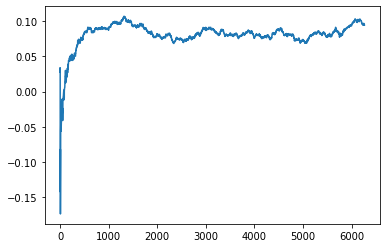

Thread: 2 iteration: 1040
RAM mDiffFit_244 FROM: 2112 --> 2752 reward: 0.0841146890625
Saving ...


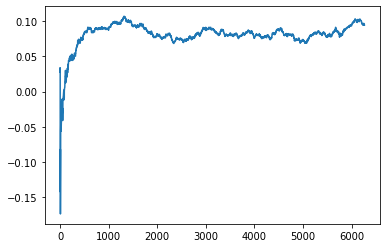

Thread: 1 iteration: 990
RAM mDiffFit_27 FROM: 960 --> 2752 reward: -0.00996608476562499
Thread: 5 iteration: 1103
RAM mDiffFit_288 FROM: 1984 --> 2752 reward: 0.0182812828125
Thread: 2 iteration: 1041
RAM mDiffFit_419 FROM: 1024 --> 2752 reward: 0.10553663515624999
Thread: 4 iteration: 1052
RAM mDiffFit_82 FROM: 2880 --> 256 reward: 0.15866400507812495
Thread: 4 iteration: 1053
RAM mDiffFit_37 FROM: 2816 --> 256 reward: 0.0413331875
Thread: 2 iteration: 1042
RAM mBackground_58 FROM: 1088 --> 1792 reward: -0.10423919174999993
Thread: 5 iteration: 1104
RAM mProject_19 FROM: 448 --> 896 reward: 0.9331084441406249
Thread: 3 iteration: 1035
RAM mBackground_26 FROM: 1024 --> 1792 reward: -0.08451292293749998
Thread: 2 iteration: 1043
RAM mDiffFit_341 FROM: 1472 --> 192 reward: 0.300106748046875
Thread: 2 iteration: 1044
RAM mProject_23 FROM: 256 --> 896 reward: 0.919177184953125
Thread: 1 iteration: 991
RAM mDiffFit_52 FROM: 1856 --> 192 reward: 0.23144787656249996
Thread: 2 iteration: 1045

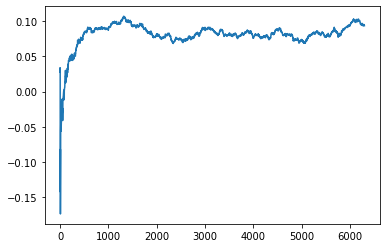

Thread: 3 iteration: 1040
RAM mDiffFit_75 FROM: 2112 --> 384 reward: 0.09357028789062499
Thread: 5 iteration: 1109
RAM mDiffFit_201 FROM: 576 --> 384 reward: 0.27801570703125006
Thread: 4 iteration: 1056
RAM mProject_72 FROM: 2368 --> 1024 reward: 0.12414588686718753
Thread: 2 iteration: 1047
RAM mDiffFit_22 FROM: 1920 --> 384 reward: 0.1772187609375
Thread: 1 iteration: 996
RAM mDiffFit_364 FROM: 2944 --> 256 reward: 0.11645305390625
Thread: 2 iteration: 1048
RAM mDiffFit_187 FROM: 512 --> 320 reward: 0.08216926992187501
Saving ...


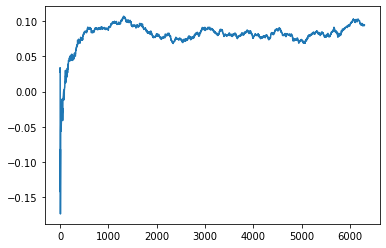

Thread: 5 iteration: 1110
RAM mDiffFit_170 FROM: 1984 --> 192 reward: 0.248294226171875
Thread: 1 iteration: 997
RAM mDiffFit_328 FROM: 448 --> 192 reward: 0.43472657070312504
Thread: 4 iteration: 1057
RAM mProject_48 FROM: 2368 --> 1024 reward: 0.11436306222656241
Thread: 6 iteration: 1048
RAM mDiffFit_288 FROM: 1664 --> 192 reward: 0.218539048828125
Thread: 5 iteration: 1111
RAM mBackground_88 FROM: 512 --> 1792 reward: -0.21560911649999998
Thread: 4 iteration: 1058
RAM mDiffFit_58 FROM: 2112 --> 320 reward: 0.154216128515625
Thread: 1 iteration: 998
RAM mDiffFit_259 FROM: 1280 --> 320 reward: 0.053512943359374995
Thread: 2 iteration: 1049
RAM mProject_1 FROM: 2112 --> 1024 reward: 0.1264789053281251
Thread: 3 iteration: 1041
RAM mDiffFit_413 FROM: 1600 --> 320 reward: 0.127481748046875
Thread: 5 iteration: 1112
RAM mDiffFit_202 FROM: 1216 --> 320 reward: 0.31865106171875
Thread: 4 iteration: 1059
RAM mDiffFit_375 FROM: 832 --> 320 reward: 0.18278382773437496
Saving ...


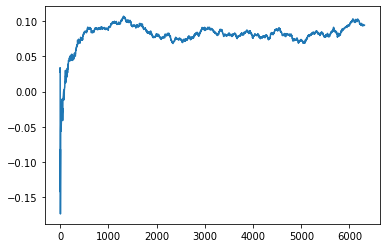

Thread: 2 iteration: 1050
RAM mDiffFit_294 FROM: 2624 --> 320 reward: 0.36008336249999995
Thread: 1 iteration: 999
RAM mDiffFit_238 FROM: 1088 --> 320 reward: 0.319591172265625
Thread: 6 iteration: 1049
RAM mDiffFit_35 FROM: 1472 --> 320 reward: 0.223549491015625
Thread: 3 iteration: 1042
RAM mBackground_35 FROM: 576 --> 1792 reward: -0.16381203943749997
Thread: 5 iteration: 1113
RAM mBackground_25 FROM: 1024 --> 2304 reward: -0.003869887124999961
Saving ...


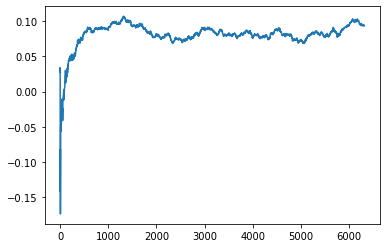

Thread: 4 iteration: 1060
RAM mBackground_66 FROM: 576 --> 1792 reward: -0.1654245394375
Thread: 2 iteration: 1051
RAM mDiffFit_385 FROM: 2048 --> 384 reward: 0.0767187171875
Thread: 2 iteration: 1052
RAM mDiffFit_24 FROM: 1920 --> 384 reward: 0.19057814140625004
Thread: 5 iteration: 1114
RAM mBackground_60 FROM: 960 --> 1408 reward: -0.05248014919531248
Thread: 2 iteration: 1053
RAM mBackground_21 FROM: 192 --> 1792 reward: 0.0845735962734375
Thread: 2 iteration: 1054
RAM mProject_52 FROM: 3008 --> 2240 reward: -0.13888386724218754
Thread: 3 iteration: 1043
RAM mConcatFit_3 FROM: 1216 --> 1408 reward: -0.02612916812499999
Thread: 2 iteration: 1055
RAM mProject_79 FROM: 2048 --> 1024 reward: 0.1797674028749999
Saving ...


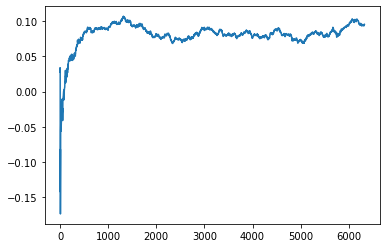

Thread: 1 iteration: 1000
RAM mDiffFit_234 FROM: 192 --> 256 reward: -0.06288280976562498
Thread: 3 iteration: 1044
RAM mDiffFit_11 FROM: 2624 --> 320 reward: 0.22142185859374997
Thread: 2 iteration: 1056
RAM mProject_14 FROM: 1216 --> 2752 reward: 0.03553253760937508
Thread: 5 iteration: 1115
RAM mProject_35 FROM: 192 --> 896 reward: 0.9294625043437498
Saving ...


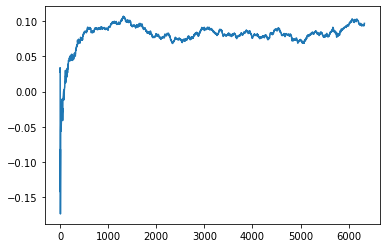

Thread: 6 iteration: 1050
RAM mDiffFit_21 FROM: 3008 --> 320 reward: -0.9469675722656251
Thread: 1 iteration: 1001
RAM mProject_35 FROM: 1664 --> 1024 reward: 0.16498589779687495
Thread: 4 iteration: 1061
RAM mDiffFit_383 FROM: 832 --> 320 reward: 0.06853382773437501
Thread: 3 iteration: 1045
RAM mDiffFit_109 FROM: 384 --> 256 reward: -0.17375008749999998
Thread: 2 iteration: 1057
RAM mDiffFit_231 FROM: 2880 --> 256 reward: 0.1531769921875
Thread: 5 iteration: 1116
RAM mDiffFit_268 FROM: 1920 --> 320 reward: 0.1278853984375
Thread: 6 iteration: 1051
RAM mDiffFit_361 FROM: 2624 --> 320 reward: 0.21891922617187493
Thread: 1 iteration: 1002
RAM mBackground_54 FROM: 2560 --> 320 reward: -0.16922144917968768
Thread: 4 iteration: 1062
RAM mDiffFit_25 FROM: 320 --> 192 reward: 0.2715729640625
Thread: 3 iteration: 1046
RAM mDiffFit_266 FROM: 2944 --> 2560 reward: -0.012531282812500016
Thread: 6 iteration: 1052
RAM mDiffFit_234 FROM: 896 --> 832 reward: 0.03732033164062499
Thread: 1 iteration: 

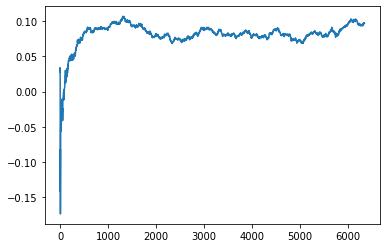

Thread: 2 iteration: 1060
RAM mDiffFit_372 FROM: 2112 --> 192 reward: 0.191601526953125
Thread: 3 iteration: 1049
RAM mDiffFit_6 FROM: 1600 --> 192 reward: 0.2175312390625
Saving ...


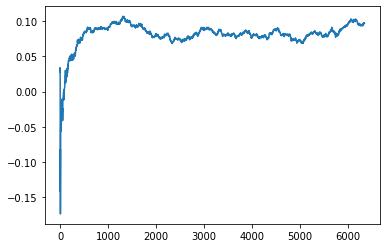

Thread: 5 iteration: 1120
RAM mDiffFit_318 FROM: 1408 --> 256 reward: 0.18165101796875
Thread: 6 iteration: 1055
RAM mProject_68 FROM: 1920 --> 2112 reward: 0.02867068603125008
Thread: 1 iteration: 1005
RAM mProject_90 FROM: 1408 --> 2112 reward: -0.012228620062500016
Thread: 4 iteration: 1063
RAM mDiffFit_226 FROM: 1600 --> 192 reward: 0.18152079687499995
Thread: 5 iteration: 1121
RAM mDiffFit_19 FROM: 896 --> 192 reward: 0.22806765546875
Thread: 6 iteration: 1056
RAM mDiffFit_201 FROM: 2176 --> 192 reward: 0.29364053203124996
Thread: 1 iteration: 1006
RAM mBackground_73 FROM: 2432 --> 192 reward: 0.6796843149921875
Saving ...


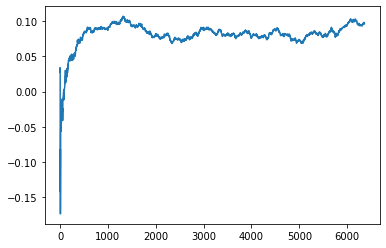

Thread: 3 iteration: 1050
RAM mDiffFit_26 FROM: 2048 --> 192 reward: 0.15170301015624998
Thread: 4 iteration: 1064
RAM mDiffFit_127 FROM: 640 --> 192 reward: 0.20060938046875001
Thread: 6 iteration: 1057
RAM mDiffFit_344 FROM: 960 --> 384 reward: -0.073312609375
Thread: 5 iteration: 1122
RAM mBackground_55 FROM: 384 --> 704 reward: -0.34901223923437497
Thread: 3 iteration: 1051
RAM mDiffFit_102 FROM: 1984 --> 384 reward: 0.227559845703125
Thread: 6 iteration: 1058
RAM mBackground_6 FROM: 832 --> 1408 reward: -0.0910099377265625
Thread: 5 iteration: 1123
RAM mDiffFit_306 FROM: 1408 --> 384 reward: 0.06593225703125
Thread: 3 iteration: 1052
RAM mProject_18 FROM: 960 --> 256 reward: -1.0
Thread: 2 iteration: 1061
RAM mBackground_71 FROM: 2048 --> 192 reward: 0.9375522509062498
Thread: 4 iteration: 1065
RAM mDiffFit_67 FROM: 1280 --> 384 reward: 0.11634376093749998
Thread: 5 iteration: 1124
RAM mDiffFit_139 FROM: 3008 --> 384 reward: 0.19032801015625
Thread: 6 iteration: 1059
RAM mDiffFit_

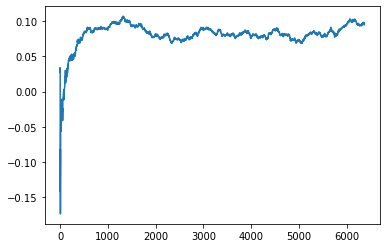

Thread: 6 iteration: 1060
RAM mDiffFit_33 FROM: 1216 --> 320 reward: 0.12201561953124998
Thread: 6 iteration: 1061
RAM mDiffFit_421 FROM: 704 --> 256 reward: 0.39297402578124996
Thread: 3 iteration: 1055
RAM mDiffFit_274 FROM: 3008 --> 320 reward: 0.396020796875
Thread: 4 iteration: 1067
RAM mDiffFit_220 FROM: 2688 --> 256 reward: 0.27509893828125
Thread: 6 iteration: 1062
RAM mBackground_31 FROM: 832 --> 1408 reward: -0.12020741307812496
Thread: 4 iteration: 1068
RAM mDiffFit_47 FROM: 1856 --> 320 reward: 0.10828641640624999
Thread: 3 iteration: 1056
RAM mDiffFit_265 FROM: 1728 --> 256 reward: -0.5105580445312499
Thread: 6 iteration: 1063
RAM mProject_17 FROM: 1088 --> 256 reward: -1.0
Thread: 2 iteration: 1062
RAM mDiffFit_214 FROM: 128 --> 320 reward: -0.831398516796875
Thread: 4 iteration: 1069
RAM mProject_50 FROM: 896 --> 256 reward: -1.0
Thread: 5 iteration: 1125
RAM mDiffFit_214 FROM: 1472 --> 320 reward: 0.126799447265625
Thread: 2 iteration: 1063
RAM mDiffFit_62 FROM: 1792 --

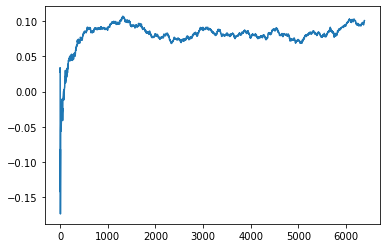

Thread: 4 iteration: 1070
RAM mProject_90 FROM: 2624 --> 2112 reward: -0.09716596910156246
Thread: 3 iteration: 1057
RAM mDiffFit_85 FROM: 1664 --> 320 reward: 0.102184845703125
Thread: 5 iteration: 1126
RAM mProject_29 FROM: 2176 --> 256 reward: -1.0
Thread: 1 iteration: 1008
RAM mDiffFit_154 FROM: 2112 --> 320 reward: 0.125908827734375
Thread: 4 iteration: 1071
RAM mProject_88 FROM: 2048 --> 2752 reward: 0.1463908986562499
Thread: 6 iteration: 1064
RAM mDiffFit_317 FROM: 2432 --> 448 reward: 0.023877544921874997
Thread: 5 iteration: 1127
RAM mDiffFit_187 FROM: 960 --> 448 reward: 0.051804668359375
Thread: 3 iteration: 1058
RAM mDiffFit_28 FROM: 1856 --> 320 reward: 0.13827597421875001
Thread: 4 iteration: 1072
RAM mDiffFit_416 FROM: 2112 --> 256 reward: 0.30745831875000007
Thread: 5 iteration: 1128
RAM mBackground_41 FROM: 2624 --> 192 reward: 0.7749561053359375
Thread: 6 iteration: 1065
RAM mDiffFit_403 FROM: 2880 --> 192 reward: 0.4365468585937501
Thread: 3 iteration: 1059
RAM mDif

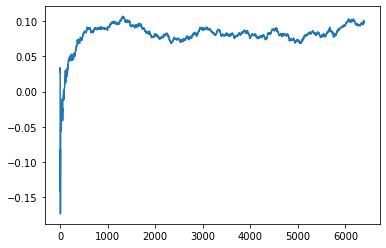

Thread: 3 iteration: 1060
RAM mDiffFit_138 FROM: 576 --> 256 reward: 0.159520840625
Thread: 6 iteration: 1066
RAM mProject_90 FROM: 320 --> 896 reward: 0.9298450043437497
Thread: 1 iteration: 1009
RAM mDiffFit_248 FROM: 512 --> 192 reward: 0.15308073007812503
Saving ...


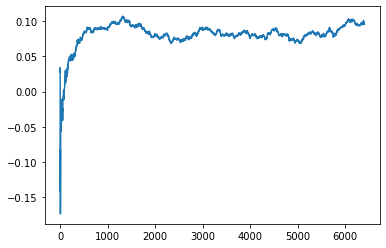

Thread: 5 iteration: 1130
RAM mDiffFit_108 FROM: 2112 --> 192 reward: 0.326226526953125
Thread: 6 iteration: 1067
RAM mDiffFit_302 FROM: 2624 --> 256 reward: 0.3478852671875
Thread: 3 iteration: 1061
RAM mDiffFit_405 FROM: 320 --> 256 reward: 0.14093752187500003
Thread: 2 iteration: 1065
RAM mDiffFit_18 FROM: 2368 --> 192 reward: 0.2082395140625
Saving ...


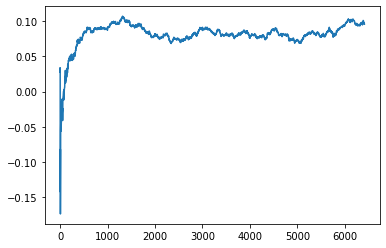

Thread: 1 iteration: 1010
RAM mDiffFit_219 FROM: 1152 --> 192 reward: 0.19482028789062497
Thread: 5 iteration: 1131
RAM mDiffFit_105 FROM: 832 --> 192 reward: 0.22014061953124997
Thread: 3 iteration: 1062
RAM mDiffFit_84 FROM: 2240 --> 192 reward: 0.31742185859375
Thread: 2 iteration: 1066
RAM mBackground_80 FROM: 1728 --> 1408 reward: 0.018263793460937476
Thread: 1 iteration: 1011
RAM mProject_59 FROM: 2304 --> 256 reward: -1.0
Thread: 4 iteration: 1074
RAM mDiffFit_215 FROM: 640 --> 192 reward: 0.21476820820312498
Thread: 5 iteration: 1132
RAM mDiffFit_28 FROM: 2176 --> 192 reward: 0.24732809765625
Thread: 3 iteration: 1063
RAM mDiffFit_87 FROM: 832 --> 192 reward: 0.25968488945312496
Thread: 1 iteration: 1012
RAM mDiffFit_1 FROM: 2176 --> 192 reward: 0.19921345234374999
Thread: 4 iteration: 1075
RAM mDiffFit_139 FROM: 3008 --> 192 reward: 0.468356573046875
Thread: 2 iteration: 1067
RAM mDiffFit_363 FROM: 2944 --> 448 reward: 0.05201035468749998
Thread: 5 iteration: 1133
RAM mDiffFit

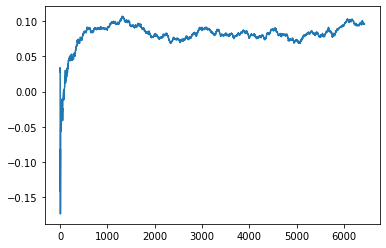

Thread: 2 iteration: 1070
RAM mDiffFit_24 FROM: 1024 --> 192 reward: 0.22942966835937498
Thread: 3 iteration: 1066
RAM mProject_15 FROM: 2752 --> 2240 reward: -0.08974892981249992
Thread: 4 iteration: 1077
RAM mDiffFit_107 FROM: 2752 --> 320 reward: 0.03151548828125
Saving ...


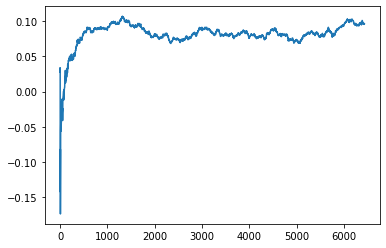

Thread: 6 iteration: 1070
RAM mDiffFit_75 FROM: 2304 --> 1984 reward: 0.01379168125
Thread: 5 iteration: 1136
RAM mDiffFit_52 FROM: 1664 --> 320 reward: 0.11963017734374998
Thread: 2 iteration: 1071
RAM mProject_47 FROM: 1088 --> 256 reward: -1.0
Thread: 1 iteration: 1013
RAM mBackground_45 FROM: 320 --> 1408 reward: -0.35231104436718746
Thread: 4 iteration: 1078
RAM mBackground_89 FROM: 640 --> 1792 reward: -0.16998881810937505
Thread: 6 iteration: 1071
RAM mDiffFit_282 FROM: 1728 --> 1984 reward: 0.01079168125
Thread: 5 iteration: 1137
RAM mBackground_81 FROM: 2816 --> 1408 reward: -0.026171891546875034
Thread: 2 iteration: 1072
RAM mDiffFit_342 FROM: 1408 --> 448 reward: 0.03955984570312501
Thread: 1 iteration: 1014
RAM mDiffFit_52 FROM: 1024 --> 448 reward: 0.054942699218749995
Thread: 4 iteration: 1079
RAM mDiffFit_106 FROM: 640 --> 1984 reward: -0.016765575781249997
Thread: 6 iteration: 1072
RAM mDiffFit_254 FROM: 1728 --> 1984 reward: -0.002833318750000008
Thread: 5 iteration: 1

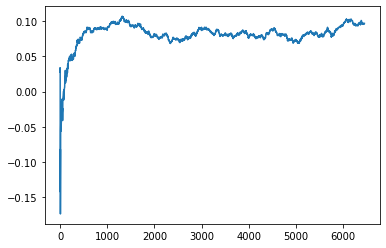

Thread: 5 iteration: 1140
RAM mDiffFit_90 FROM: 2752 --> 192 reward: 0.382187478125
Thread: 2 iteration: 1075
RAM mDiffFit_105 FROM: 2560 --> 192 reward: 0.20527338554687502
Thread: 1 iteration: 1017
RAM mProject_9 FROM: 2368 --> 256 reward: -1.0
Thread: 3 iteration: 1067
RAM mDiffFit_419 FROM: 576 --> 192 reward: -0.009242277734375012
Thread: 6 iteration: 1075
RAM mDiffFit_242 FROM: 2304 --> 192 reward: 0.20407024414062497
Thread: 1 iteration: 1018
RAM mDiffFit_61 FROM: 2432 --> 192 reward: 0.226908783984375
Thread: 2 iteration: 1076
RAM mDiffFit_230 FROM: 1216 --> 192 reward: 0.33563022109375007
Thread: 5 iteration: 1141
RAM mBackground_15 FROM: 256 --> 1920 reward: 0.26912653218750004
Thread: 3 iteration: 1068
RAM mProject_66 FROM: 2752 --> 256 reward: -1.0
Saving ...


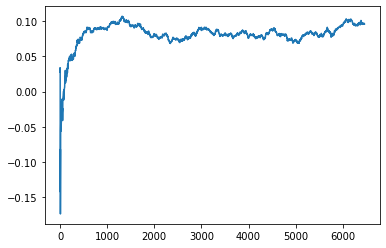

Thread: 4 iteration: 1080
RAM mDiffFit_296 FROM: 2432 --> 192 reward: 0.360789048828125
Thread: 6 iteration: 1076
RAM mDiffFit_393 FROM: 448 --> 192 reward: 0.14930207968750003
Thread: 2 iteration: 1077
RAM mDiffFit_204 FROM: 1280 --> 192 reward: 0.19563017734375
Thread: 4 iteration: 1081
RAM mDiffFit_193 FROM: 1728 --> 192 reward: 0.284695287890625
Thread: 3 iteration: 1069
RAM mDiffFit_182 FROM: 1472 --> 192 reward: 0.256520753125
Thread: 1 iteration: 1019
RAM mBackground_58 FROM: 2496 --> 192 reward: 0.6784525363203125
Thread: 6 iteration: 1077
RAM mDiffFit_413 FROM: 128 --> 192 reward: -0.338716172265625
Thread: 6 iteration: 1078
RAM mDiffFit_324 FROM: 1600 --> 192 reward: 0.255289005078125
Thread: 2 iteration: 1078
RAM mBackground_13 FROM: 2944 --> 192 reward: 0.637264302015625
Thread: 4 iteration: 1082
RAM mBackground_78 FROM: 256 --> 896 reward: -0.420033818109375
Saving ...


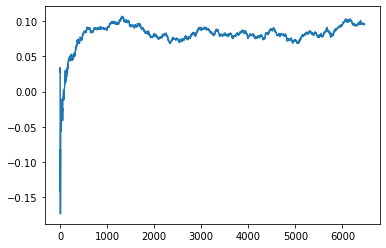

Thread: 1 iteration: 1020
RAM mProject_85 FROM: 384 --> 896 reward: 0.91559874515625
Thread: 5 iteration: 1142
RAM mDiffFit_265 FROM: 320 --> 192 reward: 0.18107814140625
Thread: 4 iteration: 1083
RAM mDiffFit_191 FROM: 2240 --> 2560 reward: -0.04519015429687502
Thread: 6 iteration: 1079
RAM mImgtbl_3 FROM: 128 --> 704 reward: 0.5968482615625
Thread: 1 iteration: 1021
RAM mProject_4 FROM: 2688 --> 1024 reward: 0.06879249914062487
Saving ...


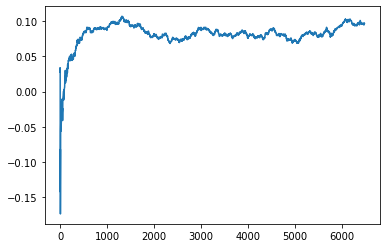

Thread: 3 iteration: 1070
RAM mDiffFit_274 FROM: 1024 --> 256 reward: 0.12895831875000002
Thread: 5 iteration: 1143
RAM mDiffFit_397 FROM: 1536 --> 256 reward: 0.13787495625
Thread: 1 iteration: 1022
RAM mDiffFit_36 FROM: 832 --> 256 reward: 0.06882287656250001
Thread: 5 iteration: 1144
RAM mDiffFit_211 FROM: 128 --> 256 reward: -0.34811460156249985
Thread: 1 iteration: 1023
RAM mBackground_38 FROM: 3008 --> 192 reward: 0.6582200479921875
Saving ...


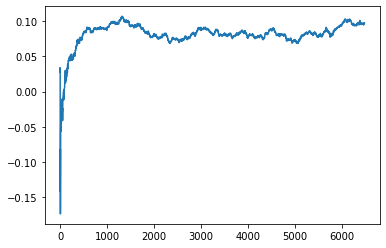

Thread: 6 iteration: 1080
RAM mDiffFit_191 FROM: 1280 --> 256 reward: 0.07082283281250001
Thread: 5 iteration: 1145
RAM mDiffFit_111 FROM: 960 --> 256 reward: 0.11115101796875002
Thread: 1 iteration: 1024
RAM mProject_81 FROM: 1856 --> 1024 reward: 0.21305013082031243
Thread: 2 iteration: 1079
RAM mBgModel_1 FROM: 704 --> 320 reward: 0.45566146015625003
Thread: 4 iteration: 1084
RAM mDiffFit_379 FROM: 2496 --> 256 reward: 0.205335907421875
Thread: 1 iteration: 1025
RAM mDiffFit_297 FROM: 2752 --> 256 reward: 0.10290615156250002
Saving ...


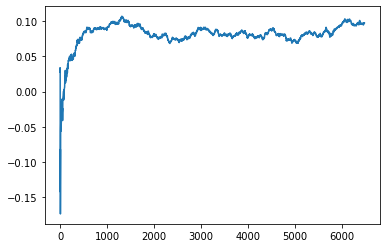

Thread: 2 iteration: 1080
RAM mDiffFit_309 FROM: 1472 --> 256 reward: 0.24828904882812503
Thread: 4 iteration: 1085
RAM mBackground_78 FROM: 3008 --> 192 reward: 0.6264717397421875
Thread: 6 iteration: 1081
RAM mProject_60 FROM: 1216 --> 1024 reward: 0.08176406020312496
Thread: 3 iteration: 1071
RAM mDiffFit_6 FROM: 3008 --> 1984 reward: -0.03579172500000002
Thread: 2 iteration: 1081
RAM mBackground_21 FROM: 1216 --> 1792 reward: -0.0020200492968749815
Thread: 1 iteration: 1026
RAM mBackground_56 FROM: 2816 --> 1408 reward: -0.09033154385937502
Thread: 6 iteration: 1082
RAM mDiffFit_106 FROM: 832 --> 256 reward: 0.12335933671874996
Thread: 3 iteration: 1072
RAM mDiffFit_185 FROM: 1408 --> 256 reward: 0.17145831874999995
Thread: 4 iteration: 1086
RAM mDiffFit_380 FROM: 3008 --> 320 reward: 0.036887899609375
Thread: 2 iteration: 1082
RAM mProject_27 FROM: 2496 --> 1024 reward: 0.10633100456249993
Thread: 5 iteration: 1146
RAM mDiffFit_1 FROM: 1536 --> 256 reward: 0.04841655
Thread: 6 ite

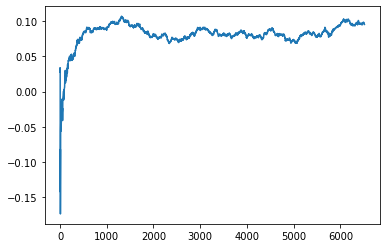

Thread: 4 iteration: 1090
RAM mBackground_49 FROM: 1344 --> 320 reward: 0.39965364426562494
Thread: 6 iteration: 1087
RAM mDiffFit_72 FROM: 704 --> 192 reward: 0.21536719023437498
Saving ...


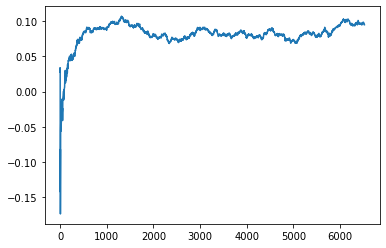

Thread: 1 iteration: 1030
RAM mDiffFit_53 FROM: 1600 --> 448 reward: 0.036072876562499995
Thread: 2 iteration: 1086
RAM mDiffFit_392 FROM: 1856 --> 448 reward: 0.04678641640624998
Thread: 6 iteration: 1088
RAM mDiffFit_141 FROM: 256 --> 192 reward: 0.21091409257812496
Thread: 3 iteration: 1077
RAM mProject_59 FROM: 704 --> 2944 reward: 0.817231026375
Thread: 5 iteration: 1149
RAM mBackground_50 FROM: 1472 --> 320 reward: 0.26361675271875
Thread: 4 iteration: 1091
RAM mDiffFit_216 FROM: 1344 --> 448 reward: 0.023984336718750002
Thread: 2 iteration: 1087
RAM mDiffFit_164 FROM: 192 --> 320 reward: -0.16831511054687504
Thread: 1 iteration: 1031
RAM mDiffFit_314 FROM: 448 --> 448 reward: 0.005190110546875008
Thread: 3 iteration: 1078
RAM mDiffFit_18 FROM: 1792 --> 448 reward: 0.06980466835937499
Saving ...


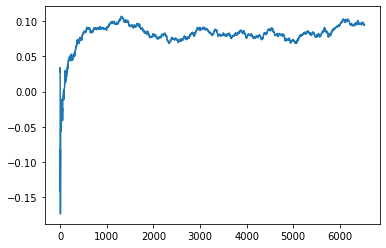

Thread: 5 iteration: 1150
RAM mDiffFit_94 FROM: 2688 --> 448 reward: 0.20153378398437502
Thread: 6 iteration: 1089
RAM mDiffFit_80 FROM: 2368 --> 448 reward: 0.24329949101562498
Thread: 4 iteration: 1092
RAM mDiffFit_269 FROM: 2560 --> 256 reward: 0.1845728765625
Thread: 1 iteration: 1032
RAM mDiffFit_375 FROM: 1792 --> 320 reward: 0.23180725703125
Thread: 2 iteration: 1088
RAM mDiffFit_386 FROM: 1920 --> 256 reward: 0.20719269921875003
Thread: 3 iteration: 1079
RAM mDiffFit_241 FROM: 768 --> 256 reward: 0.14104163750000004
Thread: 5 iteration: 1151
RAM mDiffFit_74 FROM: 1856 --> 256 reward: 0.25533331875000004
Saving ...


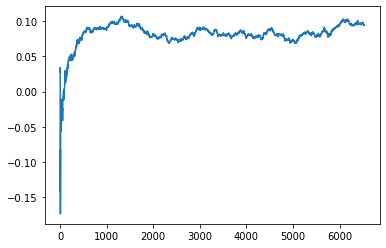

Thread: 6 iteration: 1090
RAM mDiffFit_304 FROM: 1280 --> 256 reward: 0.0968436734375
Thread: 4 iteration: 1093
RAM mDiffFit_29 FROM: 2624 --> 256 reward: 0.12174991249999996
Thread: 1 iteration: 1033
RAM mDiffFit_207 FROM: 960 --> 256 reward: 0.015596262109375016
Thread: 4 iteration: 1094
RAM mDiffFit_200 FROM: 1216 --> 320 reward: 0.19859371718749996
Thread: 6 iteration: 1091
RAM mDiffFit_372 FROM: 1152 --> 256 reward: 0.14860415937500004
Thread: 1 iteration: 1034
RAM mBackground_48 FROM: 1792 --> 192 reward: 0.6936123378281251
Thread: 2 iteration: 1089
RAM mDiffFit_184 FROM: 2368 --> 256 reward: 0.1453645140625
Thread: 4 iteration: 1095
RAM mDiffFit_189 FROM: 1216 --> 256 reward: 0.12908331875000004
Thread: 6 iteration: 1092
RAM mDiffFit_364 FROM: 2048 --> 256 reward: 0.20233331875
Saving ...


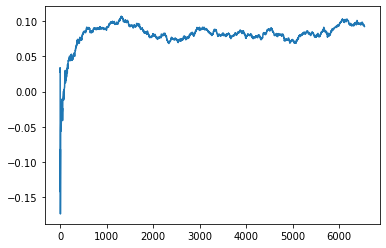

Thread: 2 iteration: 1090
RAM mProject_46 FROM: 2176 --> 2112 reward: -0.006475798476562522
Thread: 5 iteration: 1152
RAM mDiffFit_277 FROM: 2624 --> 640 reward: 0.17010938046874993
Thread: 1 iteration: 1035
RAM mDiffFit_33 FROM: 2944 --> 640 reward: 0.10679685859374997
Thread: 4 iteration: 1096
RAM mBackground_75 FROM: 2432 --> 192 reward: 0.7354499493984374
Saving ...


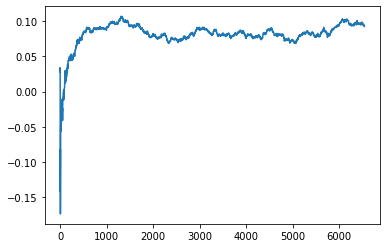

Thread: 3 iteration: 1080
RAM mDiffFit_274 FROM: 1728 --> 192 reward: 0.32504685859375
Thread: 6 iteration: 1093
RAM mDiffFit_130 FROM: 2176 --> 640 reward: 0.10544787656249996
Thread: 1 iteration: 1036
RAM mBackground_76 FROM: 1600 --> 1792 reward: -0.012237077062499983
Thread: 3 iteration: 1081
RAM mDiffFit_398 FROM: 1088 --> 192 reward: 0.17571349609374998
Thread: 4 iteration: 1097
RAM mBackground_74 FROM: 1152 --> 320 reward: 0.3438096017109375
Thread: 6 iteration: 1094
RAM mDiffFit_292 FROM: 1024 --> 192 reward: 0.155075508984375
Thread: 4 iteration: 1098
RAM mDiffFit_331 FROM: 192 --> 192 reward: -0.06658595117187506
Thread: 3 iteration: 1082
RAM mProject_4 FROM: 1536 --> 2240 reward: 0.01650295589062505
Thread: 2 iteration: 1091
RAM mProject_20 FROM: 2752 --> 2240 reward: -0.09695128324218745
Thread: 5 iteration: 1153
RAM mBackground_85 FROM: 1728 --> 192 reward: 0.8003105967812499
Thread: 1 iteration: 1037
RAM mBackground_1 FROM: 2368 --> 192 reward: 0.6677047625781249
Thread: 

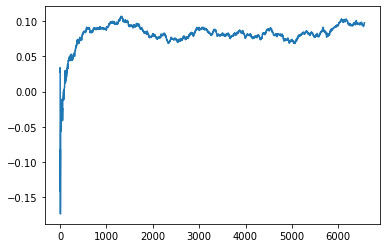

Thread: 4 iteration: 1100
RAM mDiffFit_160 FROM: 2624 --> 256 reward: 0.07953115156249999
Thread: 5 iteration: 1155
RAM mDiffFit_130 FROM: 2112 --> 256 reward: 0.33656765546875
Thread: 6 iteration: 1096
RAM mDiffFit_69 FROM: 2304 --> 256 reward: 0.09495823124999998
Thread: 3 iteration: 1084
RAM mDiffFit_312 FROM: 1280 --> 192 reward: 0.195377588671875
Thread: 5 iteration: 1156
RAM mBackground_68 FROM: 2624 --> 192 reward: 0.5962418266640623
Thread: 2 iteration: 1093
RAM mBackground_62 FROM: 704 --> 1792 reward: -0.14628508692187497
Thread: 3 iteration: 1085
RAM mDiffFit_179 FROM: 1024 --> 256 reward: 0.22410407187499998
Thread: 6 iteration: 1097
RAM mProject_12 FROM: 2432 --> 1024 reward: 0.10431726637500001
Thread: 1 iteration: 1038
RAM mDiffFit_133 FROM: 3008 --> 320 reward: 0.08775250117187501
Thread: 2 iteration: 1094
RAM mDiffFit_353 FROM: 512 --> 320 reward: 0.03825517734374999
Thread: 3 iteration: 1086
RAM mBackground_70 FROM: 1216 --> 1792 reward: -0.016024178773437515
Thread: 

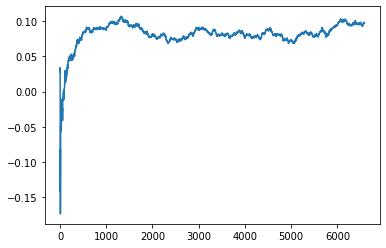

Thread: 6 iteration: 1100
RAM mBackground_62 FROM: 1536 --> 1792 reward: -0.005383942656249989
Thread: 5 iteration: 1158
RAM mBackground_6 FROM: 1216 --> 1792 reward: -0.0007099001015624787
Thread: 4 iteration: 1103
RAM mDiffFit_258 FROM: 1984 --> 320 reward: 0.14660152695312498
Saving ...


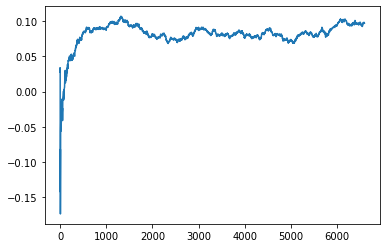

Thread: 3 iteration: 1090
RAM mDiffFit_370 FROM: 2624 --> 192 reward: 0.1975311953125
Thread: 6 iteration: 1101
RAM mProject_31 FROM: 1728 --> 1024 reward: 0.182005280015625
Saving ...


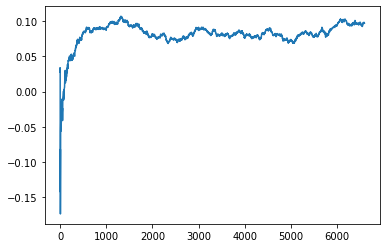

Thread: 1 iteration: 1040
RAM mBackground_38 FROM: 1472 --> 1792 reward: 0.006223831085937528
Thread: 5 iteration: 1159
RAM mDiffFit_141 FROM: 128 --> 192 reward: -0.3602448226562499
Thread: 1 iteration: 1041
RAM mDiffFit_416 FROM: 128 --> 192 reward: 0.07305734453125004
Thread: 4 iteration: 1104
RAM mDiffFit_20 FROM: 512 --> 192 reward: 0.33639061953124993
Saving ...


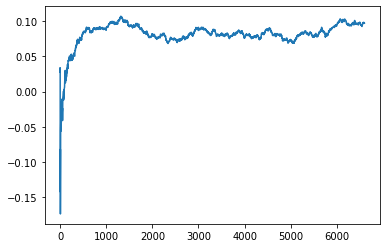

Thread: 5 iteration: 1160
RAM mDiffFit_128 FROM: 2944 --> 192 reward: 0.414195287890625
Thread: 1 iteration: 1042
RAM mDiffFit_125 FROM: 448 --> 192 reward: 0.33539847304687503
Thread: 4 iteration: 1105
RAM mProject_79 FROM: 1216 --> 2240 reward: -0.06821843674218749
Thread: 3 iteration: 1091
RAM mDiffFit_63 FROM: 1984 --> 192 reward: 0.25228641640625
Thread: 4 iteration: 1106
RAM mDiffFit_277 FROM: 448 --> 192 reward: 0.198354159375
Thread: 4 iteration: 1107
RAM mBackground_85 FROM: 2496 --> 192 reward: 0.7147337675078125
Thread: 3 iteration: 1092
RAM mProject_14 FROM: 2624 --> 2240 reward: -0.07663420982812502
Thread: 5 iteration: 1161
RAM mDiffFit_202 FROM: 448 --> 192 reward: 0.15499219023437502
Thread: 4 iteration: 1108
RAM mProject_62 FROM: 896 --> 2240 reward: -0.2184945152343751
Thread: 1 iteration: 1043
RAM mProject_39 FROM: 448 --> 896 reward: 0.9207296849531249
Thread: 6 iteration: 1102
RAM mDiffFit_150 FROM: 1216 --> 192 reward: 0.214450508984375
Thread: 3 iteration: 1093
R

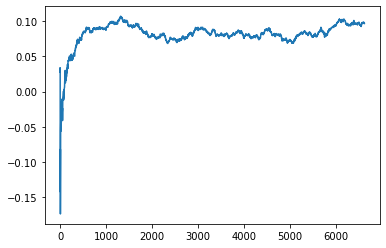

Thread: 4 iteration: 1110
RAM mConcatFit_1 FROM: 1664 --> 704 reward: 0.16864794656249996
Thread: 6 iteration: 1104
RAM mDiffFit_408 FROM: 1664 --> 384 reward: 0.0774166375
Thread: 1 iteration: 1045
RAM mDiffFit_392 FROM: 1472 --> 256 reward: 0.157601526953125
Saving ...


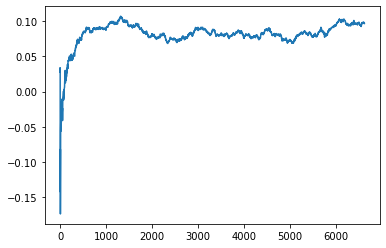

Thread: 2 iteration: 1100
RAM mBackground_2 FROM: 2432 --> 192 reward: 0.73945654125
Thread: 3 iteration: 1095
RAM mDiffFit_316 FROM: 1024 --> 256 reward: 0.14067707968749998
Thread: 4 iteration: 1111
RAM mProject_70 FROM: 1984 --> 1024 reward: 0.1780152301406249
Thread: 5 iteration: 1162
RAM mDiffFit_339 FROM: 1728 --> 256 reward: 0.137039005078125
Thread: 3 iteration: 1096
RAM mDiffFit_362 FROM: 1344 --> 192 reward: 0.21254685859375005
Thread: 5 iteration: 1163
RAM mDiffFit_351 FROM: 1408 --> 192 reward: 0.19011455781249997
Thread: 3 iteration: 1097
RAM mDiffFit_236 FROM: 2880 --> 192 reward: 0.186687434375
Thread: 5 iteration: 1164
RAM mBackground_74 FROM: 2368 --> 192 reward: 0.6957421133828126
Thread: 4 iteration: 1112
RAM mBackground_11 FROM: 384 --> 704 reward: -0.18855722625781263
Thread: 5 iteration: 1165
RAM mDiffFit_404 FROM: 2560 --> 192 reward: 0.28996871718749995
Thread: 3 iteration: 1098
RAM mProject_6 FROM: 1920 --> 1024 reward: 0.209804958
Thread: 1 iteration: 1046
RAM

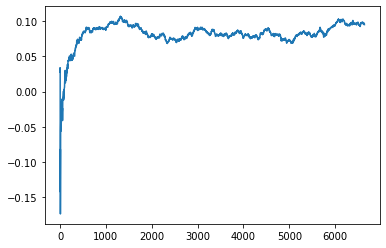

Thread: 3 iteration: 1100
RAM mBackground_54 FROM: 2880 --> 192 reward: 0.7748397003046874
Thread: 6 iteration: 1106
RAM mDiffFit_120 FROM: 1600 --> 384 reward: 0.09802342929687502
Thread: 1 iteration: 1049
RAM mDiffFit_228 FROM: 832 --> 384 reward: 0.17071617226562502
Thread: 2 iteration: 1104
RAM mProject_83 FROM: 1728 --> 1024 reward: 0.2060648324296875
Thread: 4 iteration: 1114
RAM mDiffFit_64 FROM: 1856 --> 384 reward: 0.280476614453125
Thread: 3 iteration: 1101
RAM mBackground_6 FROM: 2112 --> 192 reward: 0.6714113051328124
Thread: 5 iteration: 1168
RAM mDiffFit_315 FROM: 2368 --> 320 reward: 0.14194265546875004
Saving ...


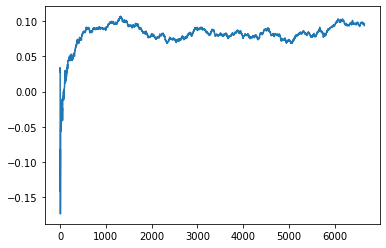

Thread: 1 iteration: 1050
RAM mDiffFit_304 FROM: 1600 --> 320 reward: 0.05058849609374999
Thread: 2 iteration: 1105
RAM mDiffFit_138 FROM: 1856 --> 320 reward: 0.08597911562500002
Thread: 4 iteration: 1115
RAM mDiffFit_65 FROM: 2240 --> 320 reward: 0.1269061953125
Thread: 3 iteration: 1102
RAM mAdd_2 FROM: 2176 --> 768 reward: 0.4085624999999999
Thread: 6 iteration: 1107
RAM mBackground_53 FROM: 1408 --> 1792 reward: -0.014060086921874949
Thread: 5 iteration: 1169
RAM mDiffFit_383 FROM: 384 --> 320 reward: 0.02666926992187499
Thread: 1 iteration: 1051
RAM mBackground_39 FROM: 2048 --> 1792 reward: 0.0059393655937500294
Thread: 2 iteration: 1106
RAM mBackground_17 FROM: 2496 --> 1792 reward: -0.07184595874999995
Thread: 6 iteration: 1108
RAM mDiffFit_21 FROM: 1408 --> 320 reward: 0.059466084765625
Thread: 4 iteration: 1116
RAM mDiffFit_81 FROM: 320 --> 192 reward: 0.008401017968750028
Thread: 4 iteration: 1117
RAM mDiffFit_264 FROM: 1600 --> 192 reward: 0.259257809765625
Thread: 6 itera

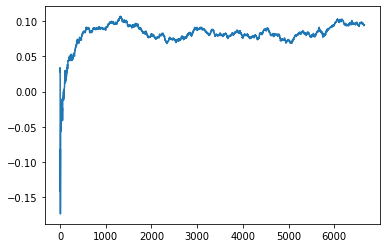

Thread: 6 iteration: 1110
RAM mDiffFit_164 FROM: 2688 --> 384 reward: 0.1295937171875
Thread: 1 iteration: 1053
RAM mDiffFit_335 FROM: 896 --> 384 reward: 0.01741141640624999
Thread: 2 iteration: 1108
RAM mProject_44 FROM: 2496 --> 1024 reward: 0.1028810019375
Thread: 3 iteration: 1103
RAM mDiffFit_49 FROM: 2048 --> 384 reward: 0.04403115156249998
Thread: 4 iteration: 1119
RAM mBackground_63 FROM: 1088 --> 1792 reward: -0.04146809678124999
Thread: 1 iteration: 1054
RAM mBackground_15 FROM: 1152 --> 1792 reward: -0.04333144265624999
Thread: 6 iteration: 1111
RAM mBackground_32 FROM: 1600 --> 1792 reward: 0.013041119617187503
Saving ...


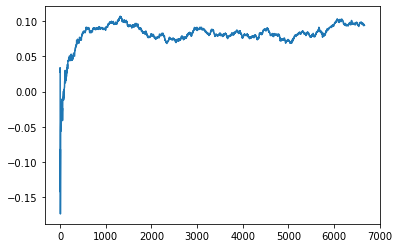

Thread: 4 iteration: 1120
RAM mDiffFit_190 FROM: 1984 --> 384 reward: 0.10702079687500002
Thread: 3 iteration: 1104
RAM mProject_47 FROM: 1280 --> 2240 reward: -0.04991328492187514
Saving ...


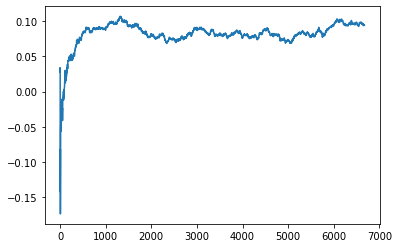

Thread: 5 iteration: 1170
RAM mBackground_18 FROM: 1600 --> 1792 reward: -0.006432077062499996
Thread: 1 iteration: 1055
RAM mDiffFit_144 FROM: 1856 --> 320 reward: 0.06916659375
Thread: 6 iteration: 1112
RAM mDiffFit_314 FROM: 1792 --> 320 reward: 0.118762987109375
Thread: 3 iteration: 1105
RAM mBackground_39 FROM: 2624 --> 192 reward: 0.7319628969843749
Thread: 2 iteration: 1109
RAM mDiffFit_258 FROM: 1408 --> 320 reward: 0.08502079687499997
Thread: 5 iteration: 1171
RAM mBackground_8 FROM: 1472 --> 192 reward: 0.7586901738437499
Thread: 4 iteration: 1121
RAM mDiffFit_331 FROM: 2880 --> 1984 reward: -0.043148516796875036
Thread: 5 iteration: 1172
RAM mDiffFit_20 FROM: 2112 --> 2112 reward: 0.03178909257812501
Thread: 4 iteration: 1122
RAM mDiffFit_48 FROM: 576 --> 960 reward: 0.09525008750000001
Saving ...


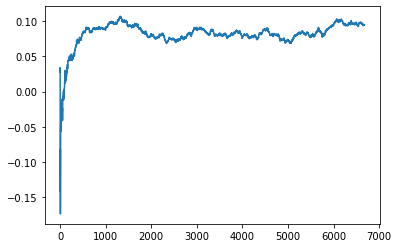

Thread: 2 iteration: 1110
RAM mBackground_83 FROM: 640 --> 192 reward: 0.5938770147890625
Thread: 3 iteration: 1106
RAM mDiffFit_109 FROM: 1024 --> 2112 reward: 0.012700552734375
Thread: 4 iteration: 1123
RAM mDiffFit_359 FROM: 2112 --> 2112 reward: 0.0077499999999999965
Thread: 3 iteration: 1107
RAM mDiffFit_415 FROM: 640 --> 2752 reward: 0.05713816210937499
Thread: 3 iteration: 1108
RAM mDiffFit_273 FROM: 2816 --> 256 reward: 0.233520796875
Thread: 4 iteration: 1124
RAM mBackground_32 FROM: 1920 --> 192 reward: 0.7534808951718749
Thread: 2 iteration: 1111
RAM mProject_3 FROM: 1664 --> 1024 reward: 0.18364310465625003
Thread: 1 iteration: 1056
RAM mDiffFit_302 FROM: 2880 --> 1984 reward: -0.041536547656250006
Thread: 3 iteration: 1109
RAM mProject_74 FROM: 448 --> 896 reward: 0.9106243655625001
Thread: 6 iteration: 1113
RAM mBackground_54 FROM: 832 --> 192 reward: 0.5880048131796876
Thread: 5 iteration: 1173
RAM mDiffFit_155 FROM: 1472 --> 320 reward: 0.04657805390625002
Thread: 2 ite

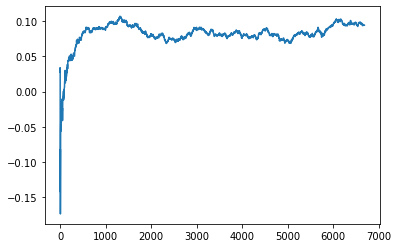

Thread: 3 iteration: 1110
RAM mDiffFit_149 FROM: 1536 --> 320 reward: 0.04471345234374999
Thread: 1 iteration: 1057
RAM mDiffFit_320 FROM: 1344 --> 1984 reward: -0.07748442421875
Thread: 6 iteration: 1115
RAM mDiffFit_63 FROM: 2368 --> 640 reward: 0.078236969140625
Thread: 5 iteration: 1174
RAM mDiffFit_312 FROM: 832 --> 1984 reward: -0.140960994921875
Thread: 3 iteration: 1111
RAM mDiffFit_161 FROM: 2624 --> 640 reward: 0.04265360664062499
Thread: 1 iteration: 1058
RAM mDiffFit_228 FROM: 1216 --> 640 reward: 0.19003132656250002
Thread: 2 iteration: 1113
RAM mDiffFit_46 FROM: 960 --> 1984 reward: -0.02042185859375001
Thread: 6 iteration: 1116
RAM mProject_7 FROM: 192 --> 896 reward: 0.926559064546875
Thread: 4 iteration: 1125
RAM mDiffFit_250 FROM: 2624 --> 832 reward: 0.0334166375
Thread: 3 iteration: 1112
RAM mDiffFit_249 FROM: 1408 --> 832 reward: -0.004059933203125008
Thread: 2 iteration: 1114
RAM mDiffFit_4 FROM: 1728 --> 832 reward: 0.015583318749999991
Thread: 1 iteration: 1059


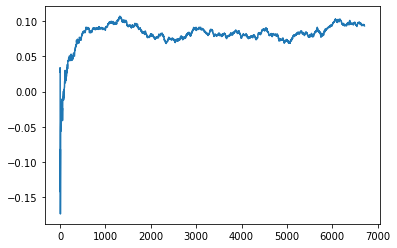

Thread: 1 iteration: 1060
RAM mBackground_27 FROM: 1856 --> 320 reward: 0.35630642967968745
Thread: 2 iteration: 1115
RAM mDiffFit_126 FROM: 1216 --> 1152 reward: 0.06563285351562496
Thread: 4 iteration: 1127
RAM mDiffFit_256 FROM: 576 --> 2752 reward: -0.015171814843750013
Thread: 5 iteration: 1177
RAM mDiffFit_153 FROM: 2944 --> 256 reward: 0.26838017734375
Thread: 6 iteration: 1118
RAM mDiffFit_109 FROM: 2304 --> 256 reward: 0.24532287656250001
Thread: 3 iteration: 1114
RAM mDiffFit_110 FROM: 1536 --> 2752 reward: 0.01848183554687499
Thread: 1 iteration: 1061
RAM mDiffFit_338 FROM: 384 --> 2624 reward: -0.08654159374999999
Thread: 3 iteration: 1115
RAM mDiffFit_264 FROM: 1984 --> 192 reward: 0.280020796875
Thread: 6 iteration: 1119
RAM mDiffFit_284 FROM: 1728 --> 192 reward: 0.35982809765625
Thread: 2 iteration: 1116
RAM mDiffFit_362 FROM: 2304 --> 192 reward: 0.557664092578125
Thread: 4 iteration: 1128
RAM mDiffFit_80 FROM: 704 --> 192 reward: 0.29357814140625
Thread: 1 iteration: 

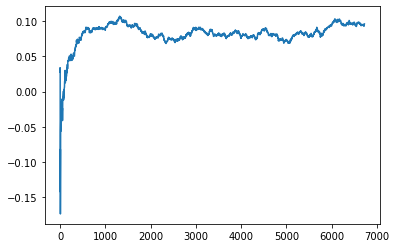

Thread: 6 iteration: 1120
RAM mBackground_42 FROM: 1280 --> 192 reward: 0.7019839050312501
Thread: 3 iteration: 1116
RAM mDiffFit_285 FROM: 896 --> 192 reward: 0.22004426992187498
Thread: 5 iteration: 1179
RAM mDiffFit_123 FROM: 2496 --> 192 reward: 0.19164838554687502
Saving ...


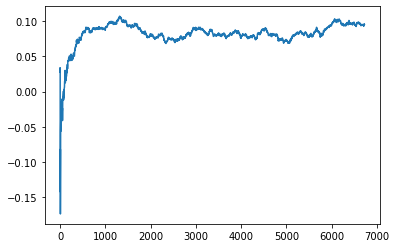

Thread: 4 iteration: 1130
RAM mDiffFit_195 FROM: 2112 --> 192 reward: 0.26700776601562504
Thread: 3 iteration: 1117
RAM mDiffFit_396 FROM: 832 --> 192 reward: 0.49444269921874995
Thread: 2 iteration: 1118
RAM mDiffFit_133 FROM: 2816 --> 192 reward: 0.11420818749999999
Saving ...


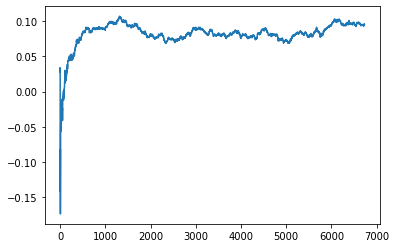

Thread: 5 iteration: 1180
RAM mBackground_8 FROM: 1728 --> 1408 reward: -0.021605311367187442
Thread: 2 iteration: 1119
RAM mDiffFit_46 FROM: 1664 --> 192 reward: 0.248408827734375
Thread: 4 iteration: 1131
RAM mProject_67 FROM: 1408 --> 1024 reward: 0.13687405495312496
Thread: 1 iteration: 1063
RAM mDiffFit_63 FROM: 832 --> 192 reward: 0.120583275
Thread: 5 iteration: 1181
RAM mDiffFit_184 FROM: 2752 --> 1920 reward: 0.05799223398437503
Thread: 4 iteration: 1132
RAM mBackground_59 FROM: 2176 --> 1408 reward: -0.018364652312500045
Thread: 5 iteration: 1182
RAM mDiffFit_232 FROM: 704 --> 256 reward: 0.19432292031249998
Saving ...


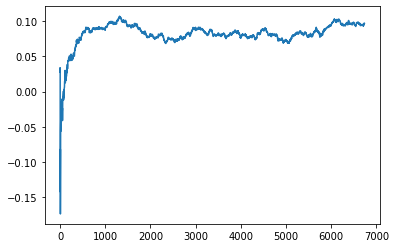

Thread: 2 iteration: 1120
RAM mDiffFit_379 FROM: 1216 --> 256 reward: 0.204783871484375
Thread: 1 iteration: 1064
RAM mProject_55 FROM: 2816 --> 1024 reward: -0.12216432093750013
Thread: 6 iteration: 1121
RAM mDiffFit_308 FROM: 256 --> 2112 reward: -0.1260103546875
Thread: 1 iteration: 1065
RAM mDiffFit_195 FROM: 256 --> 2112 reward: -0.2120728765625
Thread: 6 iteration: 1122
RAM mDiffFit_332 FROM: 640 --> 384 reward: 0.04431769921875002
Thread: 2 iteration: 1121
RAM mDiffFit_13 FROM: 2688 --> 256 reward: 0.15083318750000002
Thread: 4 iteration: 1133
RAM mBackground_51 FROM: 384 --> 896 reward: -0.35718669175
Thread: 5 iteration: 1183
RAM mProject_28 FROM: 896 --> 256 reward: -1.0
Thread: 3 iteration: 1118
RAM mDiffFit_324 FROM: 2176 --> 2112 reward: -0.08085165820312502
Thread: 6 iteration: 1123
RAM mDiffFit_98 FROM: 576 --> 384 reward: 0.041765619531250034
Thread: 2 iteration: 1122
RAM mDiffFit_421 FROM: 2944 --> 2560 reward: -0.04091672500000001
Thread: 5 iteration: 1184
RAM mDiffFi

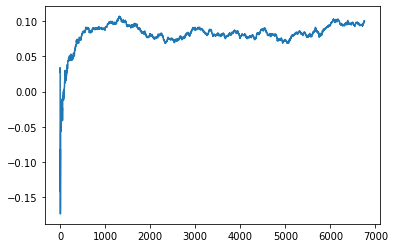

Thread: 3 iteration: 1120
RAM mBackground_6 FROM: 2880 --> 1408 reward: -0.04028801116406254
Thread: 4 iteration: 1136
RAM mConcatFit_3 FROM: 1088 --> 704 reward: 0.12162709718749998
Thread: 2 iteration: 1124
RAM mDiffFit_63 FROM: 2944 --> 320 reward: 0.052736837890625006
Thread: 5 iteration: 1186
RAM mDiffFit_37 FROM: 1024 --> 320 reward: 0.110205730078125
Thread: 6 iteration: 1126
RAM mDiffFit_327 FROM: 1024 --> 320 reward: 0.10344269921874999
Thread: 3 iteration: 1121
RAM mDiffFit_228 FROM: 1792 --> 320 reward: 0.049588452343749985
Thread: 2 iteration: 1125
RAM mDiffFit_68 FROM: 2752 --> 320 reward: 0.379127632421875
Thread: 4 iteration: 1137
RAM mDiffFit_367 FROM: 2368 --> 320 reward: 0.312757809765625
Thread: 5 iteration: 1187
RAM mProject_70 FROM: 3008 --> 1024 reward: -0.0008306033203125506
Thread: 1 iteration: 1066
RAM mDiffFit_287 FROM: 2432 --> 320 reward: 0.166687478125
Thread: 6 iteration: 1127
RAM mDiffFit_60 FROM: 2496 --> 320 reward: 0.13023433671874998
Thread: 2 iterati

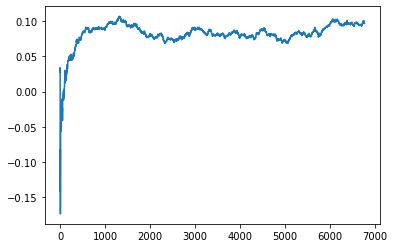

Thread: 5 iteration: 1190
RAM mAdd_3 FROM: 1600 --> 2944 reward: 0.07781925605468747
Thread: 1 iteration: 1069
RAM mDiffFit_160 FROM: 2176 --> 320 reward: 0.058801992187499985
Thread: 5 iteration: 1191
RAM mProject_63 FROM: 1728 --> 1024 reward: 0.21882703141406248
Thread: 4 iteration: 1138
RAM mDiffFit_76 FROM: 832 --> 1088 reward: -0.03266146015625
Saving ...


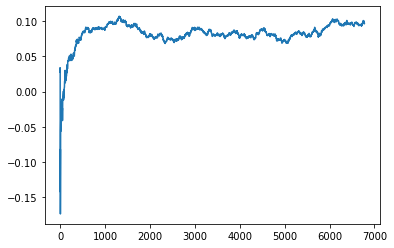

Thread: 1 iteration: 1070
RAM mProject_24 FROM: 2496 --> 256 reward: -1.0
Thread: 3 iteration: 1122
RAM mDiffFit_330 FROM: 1344 --> 1088 reward: 0.11201570703125004
Thread: 5 iteration: 1192
RAM mBgModel_2 FROM: 896 --> 320 reward: 0.49673020359375014
Thread: 2 iteration: 1128
RAM mBackground_40 FROM: 576 --> 1792 reward: -0.14190218863281248
Thread: 4 iteration: 1139
RAM mProject_75 FROM: 192 --> 896 reward: 0.9059209257656249
Thread: 6 iteration: 1128
RAM mDiffFit_148 FROM: 1728 --> 1088 reward: 0.06669274296874998
Thread: 1 iteration: 1071
RAM mDiffFit_390 FROM: 1920 --> 1088 reward: 0.04479426992187502
Thread: 3 iteration: 1123
RAM mDiffFit_151 FROM: 1088 --> 1088 reward: -0.041244822656249985
Thread: 5 iteration: 1193
RAM mBackground_44 FROM: 128 --> 1920 reward: 0.2681590321875
Thread: 2 iteration: 1129
RAM mDiffFit_7 FROM: 384 --> 1088 reward: -0.1542604421875
Saving ...


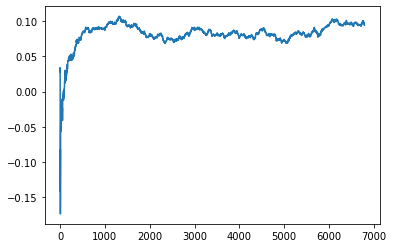

Thread: 4 iteration: 1140
RAM mDiffFit_407 FROM: 1472 --> 1088 reward: -0.016171902343750013
Thread: 6 iteration: 1129
RAM mDiffFit_402 FROM: 320 --> 1984 reward: -0.422966216015625
Thread: 1 iteration: 1072
RAM mDiffFit_201 FROM: 2048 --> 1088 reward: -0.035640707031249996
Thread: 5 iteration: 1194
RAM mDiffFit_179 FROM: 2368 --> 1088 reward: 0.054432257031249986
Saving ...


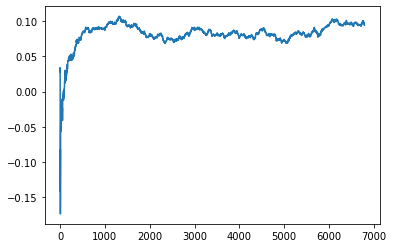

Thread: 2 iteration: 1130
RAM mDiffFit_23 FROM: 576 --> 1088 reward: -0.031158827734375002
Saving ...


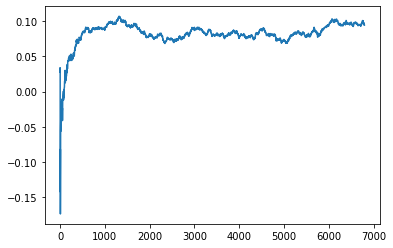

Thread: 6 iteration: 1130
RAM mDiffFit_72 FROM: 2112 --> 1088 reward: 0.0014973675781250126
Thread: 5 iteration: 1195
RAM mDiffFit_361 FROM: 640 --> 384 reward: 0.03492185859374998
Thread: 4 iteration: 1141
RAM mBackground_75 FROM: 3008 --> 1408 reward: -0.102183447078125
Thread: 2 iteration: 1131
RAM mProject_2 FROM: 320 --> 2560 reward: 0.7556221490625
Thread: 3 iteration: 1124
RAM mBackground_16 FROM: 2624 --> 704 reward: 0.07986785935937495
Thread: 1 iteration: 1073
RAM mDiffFit_343 FROM: 2112 --> 832 reward: 0.032429668359375
Thread: 4 iteration: 1142
RAM mDiffFit_185 FROM: 1088 --> 384 reward: 0.18722920312500002
Thread: 5 iteration: 1196
RAM mDiffFit_355 FROM: 2432 --> 384 reward: 0.20743743437499995
Thread: 6 iteration: 1131
RAM mBackground_85 FROM: 2432 --> 1408 reward: 0.010266193562500019
Thread: 2 iteration: 1132
RAM mBackground_48 FROM: 1984 --> 704 reward: 0.1388339673046875
Thread: 3 iteration: 1125
RAM mDiffFit_317 FROM: 192 --> 256 reward: -0.14446095117187502
Thread: 

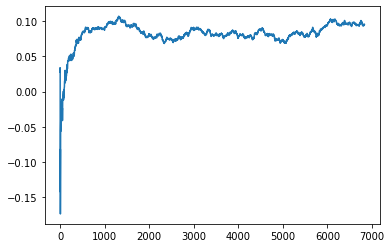

Thread: 5 iteration: 1200
RAM mProject_58 FROM: 2176 --> 256 reward: -1.0
Thread: 3 iteration: 1127
RAM mDiffFit_284 FROM: 1984 --> 256 reward: 0.2352395578125
Thread: 6 iteration: 1139
RAM mDiffFit_414 FROM: 2240 --> 256 reward: 0.151440066796875
Thread: 5 iteration: 1201
RAM mAdd_3 FROM: 512 --> 2944 reward: -0.27590060234375
Thread: 2 iteration: 1139
RAM mProject_4 FROM: 2560 --> 1024 reward: -0.1574255643750002
Thread: 1 iteration: 1079
RAM mDiffFit_133 FROM: 2368 --> 1984 reward: -0.07330216718750002
Thread: 3 iteration: 1128
RAM mProject_21 FROM: 2880 --> 1024 reward: 0.04270837331250003
Thread: 4 iteration: 1148
RAM mDiffFit_317 FROM: 2880 --> 256 reward: 0.16303900507812497
Saving ...


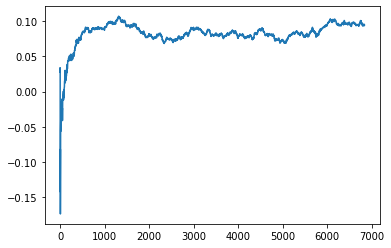

Thread: 6 iteration: 1140
RAM mDiffFit_166 FROM: 1728 --> 384 reward: 0.08446871718749999
Saving ...


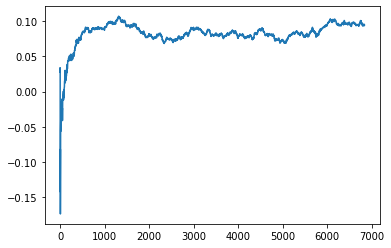

Thread: 1 iteration: 1080
RAM mDiffFit_170 FROM: 960 --> 256 reward: 0.15061977890624997
Saving ...


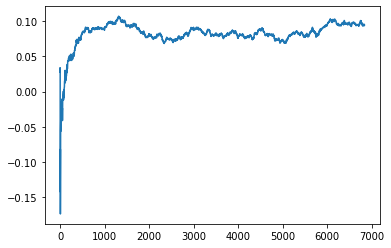

Thread: 2 iteration: 1140
RAM mDiffFit_132 FROM: 2688 --> 192 reward: 0.33167962460937506
Thread: 5 iteration: 1202
RAM mDiffFit_276 FROM: 320 --> 2752 reward: -0.12314057578125003
Thread: 6 iteration: 1141
RAM mDiffFit_208 FROM: 256 --> 384 reward: -0.0024739382812500113
Thread: 1 iteration: 1081
RAM mBackground_45 FROM: 1664 --> 192 reward: 0.7004251362187499
Thread: 4 iteration: 1149
RAM mDiffFit_232 FROM: 2880 --> 320 reward: 0.22135674804687502
Thread: 1 iteration: 1082
RAM mBackground_15 FROM: 1408 --> 192 reward: 0.77180517384375
Thread: 2 iteration: 1141
RAM mDiffFit_267 FROM: 1792 --> 384 reward: 0.09092185859375004
Saving ...


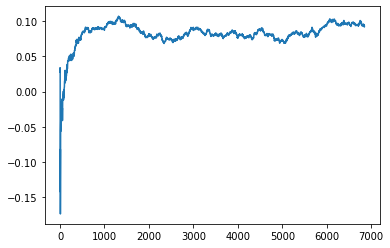

Thread: 4 iteration: 1150
RAM mProject_83 FROM: 3008 --> 1024 reward: 0.022938802523437496
Thread: 3 iteration: 1129
RAM mDiffFit_43 FROM: 1600 --> 192 reward: 0.256481748046875
Thread: 2 iteration: 1142
RAM mDiffFit_257 FROM: 2688 --> 832 reward: -0.012140707031250003
Thread: 4 iteration: 1151
RAM mBackground_33 FROM: 1792 --> 192 reward: 0.8152508705234374
Thread: 5 iteration: 1203
RAM mDiffFit_109 FROM: 1664 --> 832 reward: 0.016825508984375
Saving ...


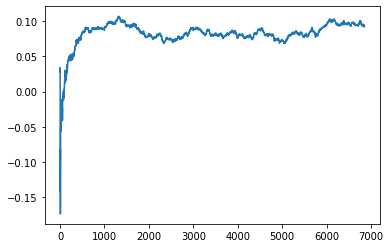

Thread: 3 iteration: 1130
RAM mDiffFit_389 FROM: 2304 --> 320 reward: 0.31728378398437507
Thread: 5 iteration: 1204
RAM mBackground_87 FROM: 2944 --> 192 reward: 0.66253125453125
Thread: 2 iteration: 1143
RAM mBackground_75 FROM: 1152 --> 192 reward: 0.6892429475859375
Thread: 4 iteration: 1152
RAM mProject_85 FROM: 640 --> 896 reward: 0.9100393655625001
Thread: 6 iteration: 1142
RAM mDiffFit_375 FROM: 1152 --> 320 reward: 0.27868488945312503
Thread: 5 iteration: 1205
RAM mDiffFit_246 FROM: 1856 --> 320 reward: 0.116440066796875
Thread: 2 iteration: 1144
RAM mProject_70 FROM: 896 --> 256 reward: -1.0
Thread: 1 iteration: 1083
RAM mDiffFit_41 FROM: 1664 --> 320 reward: 0.18357809765625
Thread: 5 iteration: 1206
RAM mViewer_2 FROM: 2240 --> 640 reward: 0.18543590742187505
Thread: 6 iteration: 1143
RAM mBackground_36 FROM: 256 --> 896 reward: -0.3920524623750001
Thread: 2 iteration: 1145
RAM mBackground_28 FROM: 2880 --> 192 reward: 0.6958742150937498
Thread: 4 iteration: 1153
RAM mDiffFi

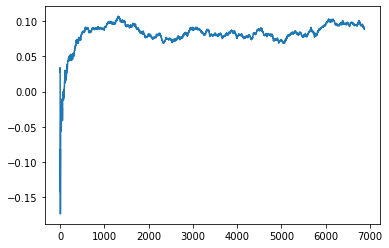

Thread: 5 iteration: 1210
RAM mDiffFit_4 FROM: 960 --> 256 reward: 0.130986969140625
Thread: 2 iteration: 1148
RAM mProject_87 FROM: 1344 --> 256 reward: -1.0
Thread: 6 iteration: 1144
RAM mBackground_35 FROM: 1920 --> 192 reward: 0.778944962375
Thread: 4 iteration: 1156
RAM mDiffFit_320 FROM: 2240 --> 256 reward: 0.21687495624999997
Thread: 5 iteration: 1211
RAM mDiffFit_154 FROM: 2496 --> 1984 reward: -0.009312521874999995
Thread: 4 iteration: 1157
RAM mDiffFit_29 FROM: 1024 --> 256 reward: 0.489312565625
Thread: 2 iteration: 1149
RAM mBackground_51 FROM: 832 --> 1792 reward: -0.082344962375
Thread: 6 iteration: 1145
RAM mDiffFit_196 FROM: 2624 --> 256 reward: 0.17059367343749995
Thread: 4 iteration: 1158
RAM mDiffFit_199 FROM: 256 --> 256 reward: 0.09301044218749999
Thread: 5 iteration: 1212
RAM mBackground_34 FROM: 1088 --> 704 reward: 0.006776914890624992
Thread: 6 iteration: 1146
RAM mProject_33 FROM: 640 --> 896 reward: 0.919604684953125
Thread: 3 iteration: 1134
RAM mDiffFit_12

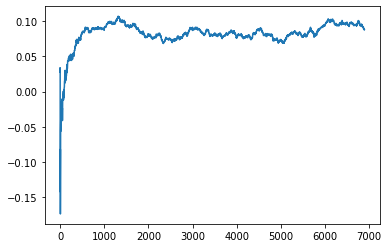

Thread: 4 iteration: 1160
RAM mBackground_61 FROM: 2368 --> 704 reward: 0.10768802153124996
Thread: 6 iteration: 1148
RAM mDiffFit_137 FROM: 1600 --> 256 reward: 0.195580730078125
Thread: 1 iteration: 1088
RAM mDiffFit_201 FROM: 2688 --> 256 reward: 0.21030725703125
Thread: 3 iteration: 1136
RAM mProject_82 FROM: 576 --> 896 reward: 0.9232056247500001
Saving ...


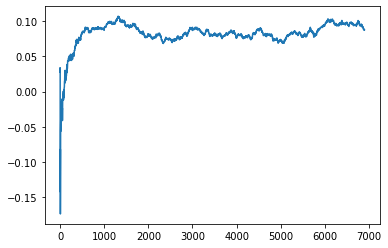

Thread: 2 iteration: 1150
RAM mBackground_62 FROM: 2624 --> 192 reward: 0.6445899610703125
Thread: 5 iteration: 1214
RAM mDiffFit_33 FROM: 192 --> 256 reward: -0.14400522109375008
Thread: 1 iteration: 1089
RAM mDiffFit_101 FROM: 2304 --> 192 reward: 0.235726526953125
Thread: 3 iteration: 1137
RAM mDiffFit_270 FROM: 1984 --> 1984 reward: -0.021877632421875015
Thread: 2 iteration: 1151
RAM mBackground_53 FROM: 1728 --> 768 reward: 0.20276518682031247
Thread: 6 iteration: 1149
RAM mDiffFit_181 FROM: 2816 --> 2560 reward: -0.004718760937500004
Saving ...


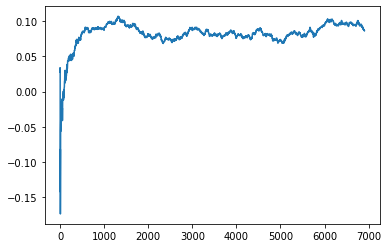

Thread: 1 iteration: 1090
RAM mDiffFit_292 FROM: 2880 --> 2560 reward: 0.03201825195312501
Thread: 2 iteration: 1152
RAM mDiffFit_265 FROM: 2048 --> 256 reward: 0.12414575312499998
Saving ...


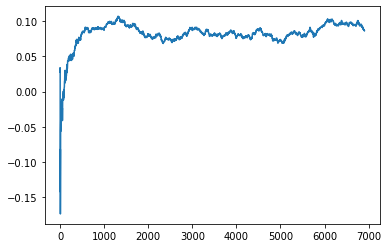

Thread: 6 iteration: 1150
RAM mProject_66 FROM: 1600 --> 1024 reward: 0.17691232717968755
Thread: 4 iteration: 1161
RAM mDiffFit_237 FROM: 704 --> 2560 reward: -0.133106791796875
Thread: 1 iteration: 1091
RAM mDiffFit_407 FROM: 2496 --> 2560 reward: -0.002382809765624997
Thread: 2 iteration: 1153
RAM mBackground_32 FROM: 256 --> 896 reward: -0.4200830967812499
Thread: 3 iteration: 1138
RAM mDiffFit_304 FROM: 256 --> 256 reward: -0.012197920312499999
Thread: 6 iteration: 1151
RAM mDiffFit_417 FROM: 128 --> 384 reward: -0.6988802648437499
Thread: 4 iteration: 1162
RAM mDiffFit_45 FROM: 2752 --> 2560 reward: -0.01359376093749998
Thread: 1 iteration: 1092
RAM mProject_7 FROM: 704 --> 896 reward: 0.925659064546875
Thread: 5 iteration: 1215
RAM mDiffFit_385 FROM: 1984 --> 256 reward: 0.159356748046875
Thread: 3 iteration: 1139
RAM mDiffFit_361 FROM: 1536 --> 256 reward: 0.1340520359375
Thread: 6 iteration: 1152
RAM mDiffFit_359 FROM: 2304 --> 256 reward: -0.03235437812500002
Thread: 4 iterat

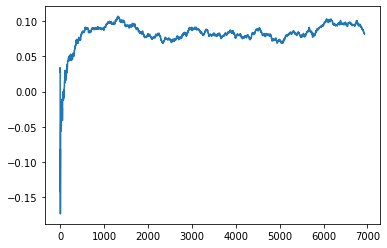

Thread: 3 iteration: 1140
RAM mDiffFit_8 FROM: 1472 --> 192 reward: 0.20553382773437495
Thread: 6 iteration: 1156
RAM mDiffFit_8 FROM: 2496 --> 192 reward: 0.27772652695312505
Saving ...


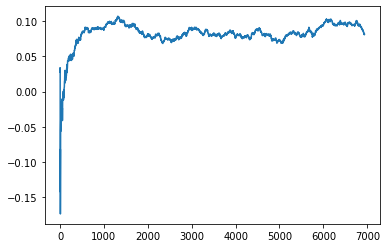

Thread: 5 iteration: 1220
RAM mDiffFit_144 FROM: 2240 --> 192 reward: 0.22172652695312503
Thread: 3 iteration: 1141
RAM mBackground_77 FROM: 1728 --> 1408 reward: 0.013533793460937459
Thread: 6 iteration: 1157
RAM mDiffFit_325 FROM: 1600 --> 192 reward: 0.123117102734375
Thread: 5 iteration: 1221
RAM mDiffFit_82 FROM: 1408 --> 192 reward: 0.24379163750000002
Thread: 3 iteration: 1142
RAM mProject_38 FROM: 576 --> 896 reward: 0.9328159441406251
Thread: 4 iteration: 1166
RAM mProject_35 FROM: 896 --> 2240 reward: -0.21812467492968746
Thread: 2 iteration: 1156
RAM mDiffFit_420 FROM: 2944 --> 192 reward: 0.17345305390624996
Thread: 6 iteration: 1158
RAM mDiffFit_229 FROM: 2816 --> 192 reward: 0.136210863671875
Thread: 5 iteration: 1222
RAM mDiffFit_252 FROM: 896 --> 1152 reward: 0.09004176874999999
Thread: 3 iteration: 1143
RAM mProject_69 FROM: 320 --> 896 reward: 0.899934046171875
Thread: 1 iteration: 1097
RAM mDiffFit_379 FROM: 448 --> 1152 reward: -0.020867146484374998
Thread: 6 iterat

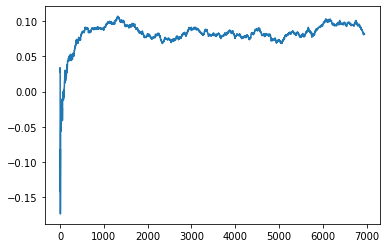

Thread: 6 iteration: 1160
RAM mDiffFit_317 FROM: 832 --> 192 reward: 0.16561455781249998
Thread: 4 iteration: 1168
RAM mDiffFit_35 FROM: 2048 --> 192 reward: 0.210387943359375
Thread: 5 iteration: 1224
RAM mDiffFit_178 FROM: 320 --> 320 reward: -0.118354203125
Thread: 6 iteration: 1161
RAM mDiffFit_188 FROM: 2496 --> 192 reward: 0.38766404882812494
Thread: 3 iteration: 1145
RAM mDiffFit_285 FROM: 2368 --> 320 reward: -0.024885573437499996
Thread: 4 iteration: 1169
RAM mDiffFit_247 FROM: 2688 --> 320 reward: 0.13941141640625
Thread: 3 iteration: 1146
RAM mDiffFit_362 FROM: 256 --> 320 reward: -0.11918752187499995
Saving ...


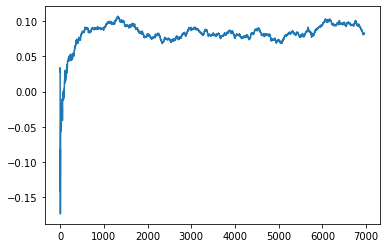

Thread: 4 iteration: 1170
RAM mBackground_45 FROM: 576 --> 1792 reward: -0.23657614426562504
Thread: 3 iteration: 1147
RAM mDiffFit_49 FROM: 1216 --> 320 reward: 0.128533827734375
Thread: 4 iteration: 1171
RAM mDiffFit_334 FROM: 640 --> 320 reward: -0.0037292031250000038
Thread: 4 iteration: 1172
RAM mProject_31 FROM: 960 --> 1024 reward: -0.03606468848437496
Thread: 1 iteration: 1099
RAM mDiffFit_294 FROM: 704 --> 832 reward: -0.15714851679687497
Thread: 4 iteration: 1173
RAM mProject_10 FROM: 2752 --> 1024 reward: 0.06298841531250006
Thread: 5 iteration: 1225
RAM mDiffFit_395 FROM: 1664 --> 2560 reward: 0.030651105468750012
Saving ...


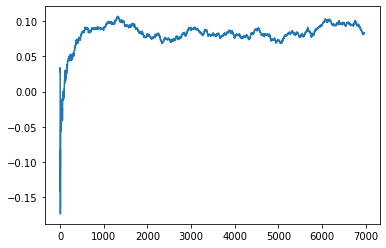

Thread: 1 iteration: 1100
RAM mDiffFit_74 FROM: 1152 --> 2560 reward: -0.016953097656250016
Thread: 4 iteration: 1174
RAM mDiffFit_53 FROM: 1024 --> 2560 reward: 0.002229203125000013
Thread: 5 iteration: 1226
RAM mDiffFit_329 FROM: 2112 --> 2560 reward: 0.03804953476562502
Thread: 4 iteration: 1175
RAM mBackground_5 FROM: 960 --> 1408 reward: -0.04651165412499998
Thread: 5 iteration: 1227
RAM mBackground_68 FROM: 576 --> 192 reward: 0.6377639180078125
Thread: 2 iteration: 1158
RAM mDiffFit_316 FROM: 1216 --> 2560 reward: -0.017802079687499986
Thread: 4 iteration: 1176
RAM mProject_9 FROM: 2624 --> 1024 reward: 0.0970942531640625
Thread: 3 iteration: 1148
RAM mDiffFit_118 FROM: 2624 --> 1984 reward: 0.019273429296874974
Thread: 2 iteration: 1159
RAM mBackground_14 FROM: 2240 --> 192 reward: -1.0
Thread: 6 iteration: 1162
RAM mDiffFit_395 FROM: 1856 --> 320 reward: 0.15902601796875002
Saving ...


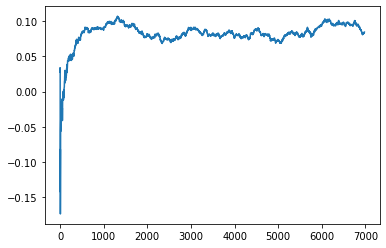

Thread: 2 iteration: 1160
RAM mBackground_41 FROM: 2624 --> 192 reward: 0.6097151349140624
Thread: 4 iteration: 1177
RAM mBackground_32 FROM: 2624 --> 192 reward: 0.609995110265625
Thread: 3 iteration: 1149
RAM mDiffFit_78 FROM: 512 --> 192 reward: 0.24177606171875
Thread: 6 iteration: 1163
RAM mDiffFit_327 FROM: 1280 --> 320 reward: 0.07792444726562499
Thread: 2 iteration: 1161
RAM mDiffFit_176 FROM: 1920 --> 320 reward: 0.08568484570312501
Thread: 4 iteration: 1178
RAM mProject_77 FROM: 960 --> 1024 reward: -0.02550561778124998
Thread: 5 iteration: 1228
RAM mDiffFit_90 FROM: 2176 --> 256 reward: -0.49656857421875
Saving ...


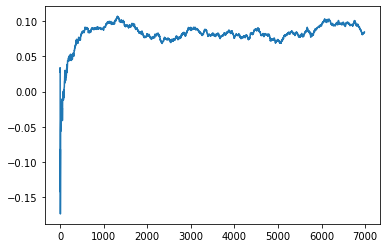

Thread: 3 iteration: 1150
RAM mDiffFit_296 FROM: 192 --> 256 reward: 0.017518251953125008
Thread: 6 iteration: 1164
RAM mDiffFit_380 FROM: 3008 --> 320 reward: 0.026512899609374974
Thread: 4 iteration: 1179
RAM mDiffFit_17 FROM: 1024 --> 320 reward: 0.10042707968750002
Thread: 5 iteration: 1229
RAM mDiffFit_306 FROM: 1856 --> 256 reward: 0.222632809765625
Thread: 3 iteration: 1151
RAM mProject_2 FROM: 2240 --> 1024 reward: 0.1461949943203125
Thread: 1 iteration: 1101
RAM mBgModel_1 FROM: 2496 --> 1152 reward: 0.024559249218750023
Thread: 2 iteration: 1162
RAM mBackground_25 FROM: 2368 --> 1408 reward: -0.0033594408437499757
Saving ...


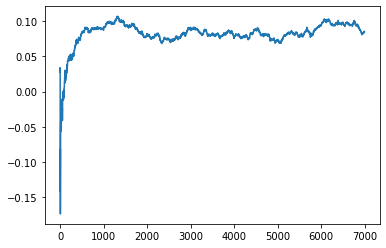

Thread: 5 iteration: 1230
RAM mDiffFit_336 FROM: 1152 --> 256 reward: 0.09813017734375001
Thread: 1 iteration: 1102
RAM mDiffFit_237 FROM: 2624 --> 256 reward: 0.23749736757812498
Thread: 3 iteration: 1152
RAM mProject_89 FROM: 192 --> 2944 reward: 0.8239069714218749
Thread: 6 iteration: 1165
RAM mDiffFit_138 FROM: 960 --> 832 reward: -0.031054712109375004
Thread: 5 iteration: 1231
RAM mDiffFit_120 FROM: 1792 --> 832 reward: 0.01809112851562501
Thread: 3 iteration: 1153
RAM mBackground_48 FROM: 128 --> 1920 reward: 0.28883936820312506
Thread: 6 iteration: 1166
RAM mDiffFit_345 FROM: 768 --> 192 reward: 0.40294528789062506
Thread: 1 iteration: 1103
RAM mDiffFit_89 FROM: 2688 --> 832 reward: 0.016499956249999993
Thread: 3 iteration: 1154
RAM mBackground_79 FROM: 1408 --> 1408 reward: -0.005267499999999987
Thread: 1 iteration: 1104
RAM mBackground_75 FROM: 1920 --> 2304 reward: 0.09390138168749998
Thread: 6 iteration: 1167
RAM mDiffFit_18 FROM: 2496 --> 832 reward: 5.203593750001054e-05
T

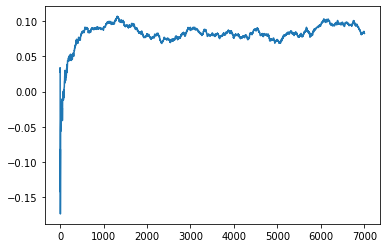

Thread: 4 iteration: 1180
RAM mDiffFit_3 FROM: 512 --> 384 reward: 0.013192699218749979
Thread: 1 iteration: 1105
RAM mBackground_79 FROM: 1472 --> 1408 reward: -0.004665062273437486
Thread: 6 iteration: 1168
RAM mDiffFit_138 FROM: 2176 --> 256 reward: 0.1257603546875
Thread: 3 iteration: 1156
RAM mDiffFit_417 FROM: 1216 --> 256 reward: 0.12770831875000002
Thread: 4 iteration: 1181
RAM mDiffFit_173 FROM: 2240 --> 256 reward: 0.17821090742187495
Thread: 1 iteration: 1106
RAM mDiffFit_417 FROM: 2560 --> 256 reward: 0.26026039843750004
Thread: 6 iteration: 1169
RAM mDiffFit_281 FROM: 1536 --> 192 reward: 0.23596086367187505
Thread: 2 iteration: 1164
RAM mDiffFit_370 FROM: 1344 --> 256 reward: 0.13476298710937498
Thread: 4 iteration: 1182
RAM mDiffFit_63 FROM: 2496 --> 192 reward: 0.22487495624999998
Thread: 2 iteration: 1165
RAM mDiffFit_179 FROM: 1024 --> 320 reward: 0.18744265546875
Saving ...


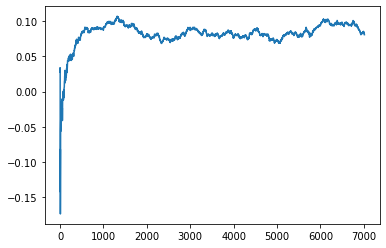

Thread: 6 iteration: 1170
RAM mDiffFit_270 FROM: 2816 --> 256 reward: 0.3196561078125
Thread: 1 iteration: 1107
RAM mDiffFit_139 FROM: 1920 --> 320 reward: 0.31424214648437504
Thread: 4 iteration: 1183
RAM mProject_76 FROM: 2816 --> 1024 reward: 0.036502132500000097
Thread: 5 iteration: 1233
RAM mDiffFit_26 FROM: 2560 --> 320 reward: 0.08765619531250002
Thread: 5 iteration: 1234
RAM mDiffFit_231 FROM: 1088 --> 256 reward: 0.06463794335937495
Thread: 2 iteration: 1166
RAM mDiffFit_409 FROM: 1664 --> 192 reward: 0.17968747812500002
Thread: 1 iteration: 1108
RAM mDiffFit_175 FROM: 2624 --> 320 reward: 0.14866383007812498
Thread: 4 iteration: 1184
RAM mDiffFit_61 FROM: 768 --> 320 reward: 0.33879694609375
Thread: 6 iteration: 1171
RAM mDiffFit_343 FROM: 320 --> 320 reward: -0.01765365039062501
Thread: 2 iteration: 1167
RAM mDiffFit_122 FROM: 1408 --> 320 reward: 0.24705471210937496
Thread: 5 iteration: 1235
RAM mDiffFit_354 FROM: 512 --> 192 reward: 0.026385354687500015
Thread: 1 iteration

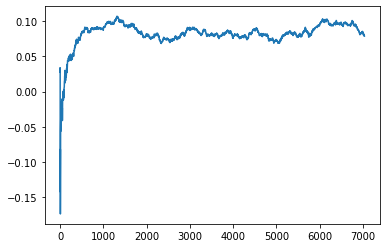

Thread: 2 iteration: 1170
RAM mDiffFit_141 FROM: 2816 --> 832 reward: 0.017640575781249987
Thread: 6 iteration: 1174
RAM mBackground_24 FROM: 2816 --> 192 reward: 0.76230917746875
Thread: 3 iteration: 1159
RAM mProject_52 FROM: 1600 --> 1024 reward: 0.1775113926328126
Thread: 5 iteration: 1236
RAM mProject_55 FROM: 320 --> 896 reward: 0.9224406247500001
Saving ...


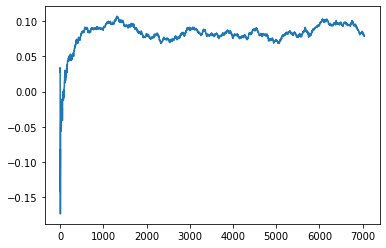

Thread: 1 iteration: 1110
RAM mBackground_29 FROM: 2688 --> 192 reward: 0.6889068642890628
Thread: 4 iteration: 1188
RAM mDiffFit_33 FROM: 3008 --> 1984 reward: -0.321023866796875
Thread: 6 iteration: 1175
RAM mDiffFit_255 FROM: 2432 --> 832 reward: 0.028518208203125
Saving ...


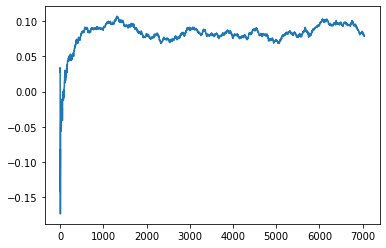

Thread: 3 iteration: 1160
RAM mBackground_60 FROM: 2752 --> 192 reward: 0.6714762052343749
Thread: 5 iteration: 1237
RAM mDiffFit_170 FROM: 320 --> 832 reward: -0.19742971210937502
Thread: 1 iteration: 1111
RAM mDiffFit_408 FROM: 1472 --> 256 reward: 0.2031562390625
Thread: 4 iteration: 1189
RAM mDiffFit_267 FROM: 2304 --> 256 reward: 0.10741659375000001
Thread: 3 iteration: 1161
RAM mDiffFit_254 FROM: 2048 --> 256 reward: 0.16142703593750002
Thread: 5 iteration: 1238
RAM mDiffFit_114 FROM: 2432 --> 256 reward: 0.15266141640624997
Thread: 1 iteration: 1112
RAM mProject_60 FROM: 1728 --> 1024 reward: 0.18168558890624983
Thread: 2 iteration: 1171
RAM mDiffFit_72 FROM: 1472 --> 256 reward: 0.10605984570312502
Thread: 1 iteration: 1113
RAM mDiffFit_395 FROM: 1920 --> 256 reward: 0.21179163750000002
Thread: 5 iteration: 1239
RAM mDiffFit_124 FROM: 1920 --> 1984 reward: -0.04497661445312501
Saving ...


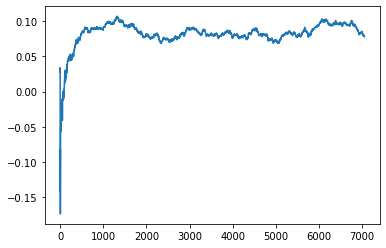

Thread: 5 iteration: 1240
RAM mBackground_86 FROM: 1216 --> 1792 reward: -0.03269565905468749
Thread: 1 iteration: 1114
RAM mDiffFit_417 FROM: 2560 --> 256 reward: 0.13047911562500003
Thread: 2 iteration: 1172
RAM mProject_81 FROM: 1344 --> 1024 reward: 0.12544687434375
Thread: 6 iteration: 1176
RAM mDiffFit_226 FROM: 1088 --> 256 reward: 0.15695050898437501
Thread: 2 iteration: 1173
RAM mDiffFit_315 FROM: 2880 --> 256 reward: 0.1709999125
Thread: 1 iteration: 1115
RAM mProject_74 FROM: 1600 --> 1024 reward: 0.19121531414062487
Saving ...


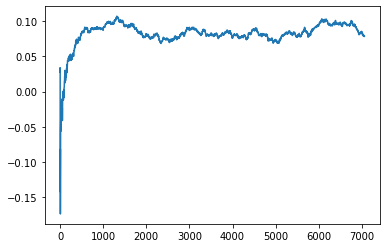

Thread: 4 iteration: 1190
RAM mDiffFit_227 FROM: 1536 --> 1984 reward: -0.03880471210937501
Thread: 6 iteration: 1177
RAM mProject_64 FROM: 1856 --> 1024 reward: 0.22976482717968758
Thread: 3 iteration: 1162
RAM mDiffFit_156 FROM: 1280 --> 1984 reward: 0.00021358359374999344
Thread: 2 iteration: 1174
RAM mDiffFit_17 FROM: 2944 --> 1984 reward: -0.04697143710937503
Thread: 1 iteration: 1116
RAM mDiffFit_236 FROM: 2176 --> 1984 reward: -0.09383603867187504
Thread: 6 iteration: 1178
RAM mDiffFit_13 FROM: 2688 --> 1984 reward: -0.012052123437499996
Thread: 3 iteration: 1163
RAM mDiffFit_66 FROM: 768 --> 1984 reward: -0.020304668359375014
Thread: 6 iteration: 1179
RAM mDiffFit_221 FROM: 960 --> 1984 reward: 0.014330773828124983
Thread: 1 iteration: 1117
RAM mBackground_23 FROM: 2816 --> 192 reward: 0.6700786676093748
Thread: 4 iteration: 1191
RAM mDiffFit_245 FROM: 320 --> 832 reward: -0.038239557812500005
Thread: 3 iteration: 1164
RAM mProject_46 FROM: 2176 --> 1024 reward: 0.1593617352187

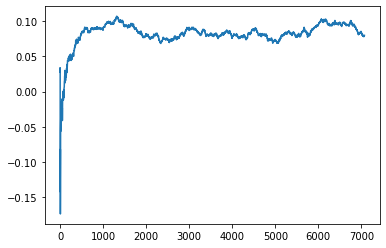

Thread: 6 iteration: 1180
RAM mDiffFit_343 FROM: 1856 --> 832 reward: 0.014973938281249996
Thread: 5 iteration: 1242
RAM mDiffFit_24 FROM: 3008 --> 1216 reward: 0.09642190234375
Thread: 4 iteration: 1192
RAM mBackground_54 FROM: 256 --> 704 reward: -0.42326557213281246
Thread: 3 iteration: 1165
RAM mDiffFit_41 FROM: 448 --> 832 reward: -0.033398429296875
Thread: 6 iteration: 1181
RAM mDiffFit_364 FROM: 320 --> 832 reward: -0.09474999999999999
Thread: 5 iteration: 1243
RAM mDiffFit_5 FROM: 2496 --> 192 reward: 0.21550776601562502
Thread: 4 iteration: 1193
RAM mProject_15 FROM: 2816 --> 1024 reward: 0.059463394312499813
Thread: 2 iteration: 1175
RAM mBackground_26 FROM: 1280 --> 704 reward: 0.10778665412500008
Thread: 6 iteration: 1182
RAM mDiffFit_379 FROM: 704 --> 192 reward: 0.4296172339843751
Thread: 2 iteration: 1176
RAM mProject_88 FROM: 960 --> 2240 reward: -0.19619094199218742
Thread: 3 iteration: 1166
RAM mProject_18 FROM: 2560 --> 1024 reward: 0.09605223225000009
Thread: 1 iter

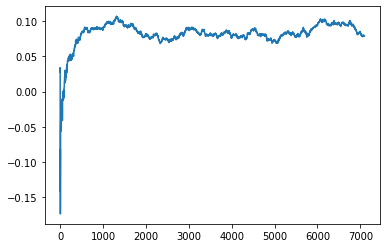

Thread: 1 iteration: 1120
RAM mDiffFit_108 FROM: 2880 --> 256 reward: 0.10399732382812499
Thread: 2 iteration: 1179
RAM mDiffFit_308 FROM: 384 --> 384 reward: 0.09989066328125001
Thread: 4 iteration: 1197
RAM mDiffFit_56 FROM: 1600 --> 256 reward: 0.3347994472656249
Thread: 3 iteration: 1169
RAM mViewer_1 FROM: 1408 --> 640 reward: 0.11678559853125002
Thread: 6 iteration: 1186
RAM mDiffFit_295 FROM: 2624 --> 256 reward: 0.10646608476562501
Thread: 5 iteration: 1246
RAM mDiffFit_342 FROM: 2176 --> 2560 reward: 0.06864592812499998
Saving ...


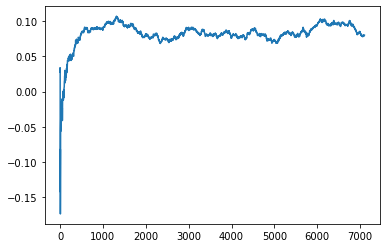

Thread: 2 iteration: 1180
RAM mDiffFit_118 FROM: 1920 --> 832 reward: -0.021687565625000006
Saving ...


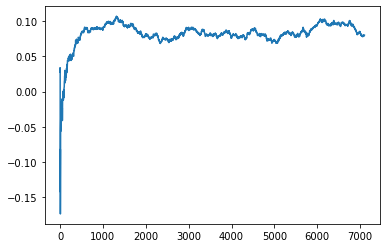

Thread: 3 iteration: 1170
RAM mDiffFit_394 FROM: 1408 --> 256 reward: 0.14023433671875
Thread: 4 iteration: 1198
RAM mDiffFit_333 FROM: 2240 --> 832 reward: -0.0634063703125
Thread: 1 iteration: 1121
RAM mDiffFit_236 FROM: 2176 --> 832 reward: -0.077971480859375
Thread: 6 iteration: 1187
RAM mDiffFit_84 FROM: 256 --> 384 reward: -0.04181769921874998
Thread: 1 iteration: 1122
RAM mBackground_3 FROM: 1408 --> 704 reward: 0.107047586921875
Thread: 2 iteration: 1181
RAM mDiffFit_372 FROM: 1600 --> 256 reward: 0.156361969140625
Thread: 6 iteration: 1188
RAM mBackground_88 FROM: 1600 --> 704 reward: 0.1897666294765625
Thread: 3 iteration: 1171
RAM mDiffFit_138 FROM: 2496 --> 2560 reward: 0.05136986640625
Thread: 1 iteration: 1123
RAM mDiffFit_319 FROM: 2816 --> 192 reward: 0.21203900507812498
Thread: 3 iteration: 1172
RAM mDiffFit_68 FROM: 2560 --> 192 reward: 0.26974469140625007
Thread: 6 iteration: 1189
RAM mDiffFit_95 FROM: 1344 --> 192 reward: 0.30108590742187497
Thread: 1 iteration: 112

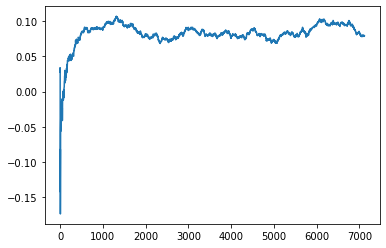

Thread: 6 iteration: 1190
RAM mProject_42 FROM: 704 --> 896 reward: 0.9327034441406248
Thread: 5 iteration: 1247
RAM mDiffFit_16 FROM: 1856 --> 192 reward: 0.16555975820312496
Thread: 2 iteration: 1183
RAM mProject_24 FROM: 1728 --> 256 reward: -1.0
Thread: 4 iteration: 1199
RAM mDiffFit_308 FROM: 1152 --> 192 reward: 0.146179668359375
Thread: 3 iteration: 1174
RAM mDiffFit_43 FROM: 896 --> 192 reward: 0.22516926992187497
Thread: 2 iteration: 1184
RAM mDiffFit_179 FROM: 1600 --> 192 reward: 0.542622323828125
Thread: 1 iteration: 1126
RAM mDiffFit_65 FROM: 2816 --> 192 reward: 0.23540619531249998
Saving ...


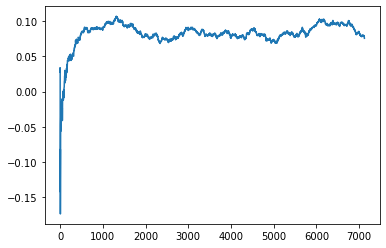

Thread: 4 iteration: 1200
RAM mImgtbl_2 FROM: 256 --> 1408 reward: 0.426900385
Thread: 3 iteration: 1175
RAM mBackground_34 FROM: 2560 --> 192 reward: 0.7059142773671875
Thread: 6 iteration: 1191
RAM mImgtbl_2 FROM: 2304 --> 1408 reward: -0.06513766187500003
Thread: 5 iteration: 1248
RAM mDiffFit_232 FROM: 2816 --> 1984 reward: -0.01952347304687501
Thread: 6 iteration: 1192
RAM mDiffFit_107 FROM: 1408 --> 384 reward: 0.02181243437500001
Thread: 5 iteration: 1249
RAM mDiffFit_289 FROM: 2880 --> 192 reward: 0.19531243437499998
Thread: 6 iteration: 1193
RAM mDiffFit_66 FROM: 896 --> 384 reward: 0.07605207968750002
Saving ...


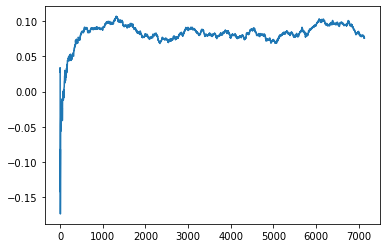

Thread: 5 iteration: 1250
RAM mBackground_77 FROM: 2816 --> 192 reward: 0.6814177101640625
Thread: 2 iteration: 1185
RAM mBackground_87 FROM: 2752 --> 192 reward: 0.6569883069453123
Thread: 3 iteration: 1176
RAM mDiffFit_415 FROM: 192 --> 384 reward: -0.15411719023437498
Thread: 6 iteration: 1194
RAM mBackground_81 FROM: 1856 --> 1792 reward: -0.027571542554687526
Thread: 3 iteration: 1177
RAM mDiffFit_180 FROM: 2048 --> 256 reward: 0.1362811953125
Thread: 5 iteration: 1251
RAM mDiffFit_94 FROM: 1984 --> 256 reward: 0.37913017734375
Thread: 2 iteration: 1186
RAM mDiffFit_206 FROM: 384 --> 384 reward: -0.015484380468750013
Thread: 6 iteration: 1195
RAM mProject_39 FROM: 2880 --> 1024 reward: 0.04853728694531254
Thread: 1 iteration: 1127
RAM mDiffFit_160 FROM: 256 --> 384 reward: -0.06819792031250001
Thread: 5 iteration: 1252
RAM mProject_75 FROM: 2048 --> 1024 reward: 0.192809916
Thread: 4 iteration: 1201
RAM mDiffFit_2 FROM: 640 --> 256 reward: 0.21240623906250006
Thread: 3 iteration: 

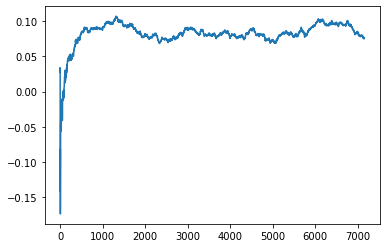

Thread: 2 iteration: 1190
RAM mProject_7 FROM: 448 --> 896 reward: 0.9329959441406249
Thread: 3 iteration: 1179
RAM mDiffFit_356 FROM: 640 --> 192 reward: 0.23583073007812497
Saving ...


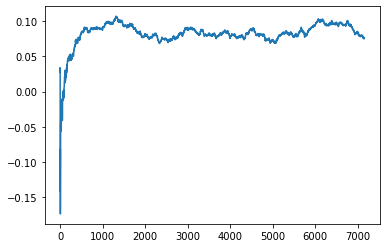

Thread: 1 iteration: 1130
RAM mDiffFit_15 FROM: 2176 --> 192 reward: 0.25304677109375
Thread: 6 iteration: 1199
RAM mDiffFit_188 FROM: 1536 --> 192 reward: 0.13489053203125004
Thread: 2 iteration: 1191
RAM mProject_40 FROM: 2624 --> 256 reward: -1.0
Thread: 5 iteration: 1254
RAM mDiffFit_187 FROM: 1024 --> 192 reward: 0.20841926992187498
Saving ...


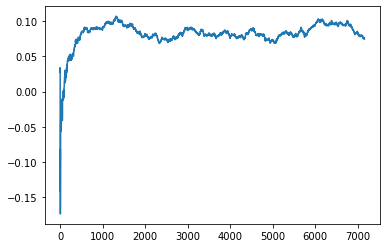

Thread: 3 iteration: 1180
RAM mDiffFit_378 FROM: 1408 --> 192 reward: 0.0988853109375
Thread: 1 iteration: 1131
RAM mProject_27 FROM: 1088 --> 256 reward: -1.0
Thread: 4 iteration: 1203
RAM mDiffFit_240 FROM: 1152 --> 192 reward: 0.361062521875
Saving ...


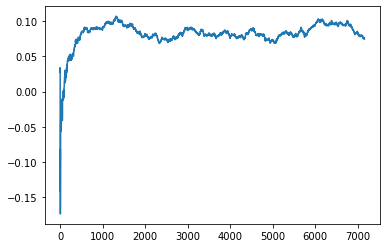

Thread: 6 iteration: 1200
RAM mDiffFit_14 FROM: 1344 --> 192 reward: 0.07454677109375002
Thread: 3 iteration: 1181
RAM mDiffFit_388 FROM: 320 --> 256 reward: 0.07817449101562499
Thread: 6 iteration: 1201
RAM mDiffFit_331 FROM: 1856 --> 192 reward: 0.257950465234375
Thread: 5 iteration: 1255
RAM mDiffFit_42 FROM: 2112 --> 192 reward: 0.15144524414062502
Thread: 1 iteration: 1132
RAM mDiffFit_311 FROM: 2368 --> 192 reward: 0.20074995625000003
Thread: 4 iteration: 1204
RAM mDiffFit_344 FROM: 2432 --> 256 reward: 0.27831769921875
Thread: 3 iteration: 1182
RAM mDiffFit_159 FROM: 2752 --> 256 reward: 0.276106748046875
Thread: 6 iteration: 1202
RAM mDiffFit_423 FROM: 1536 --> 256 reward: 0.40197915937499995
Thread: 5 iteration: 1256
RAM mDiffFit_23 FROM: 1664 --> 256 reward: 0.45804690234375
Thread: 1 iteration: 1133
RAM mDiffFit_195 FROM: 2688 --> 256 reward: 0.48782292031249996
Thread: 4 iteration: 1205
RAM mDiffFit_221 FROM: 960 --> 256 reward: 0.291289092578125
Thread: 6 iteration: 1203
R

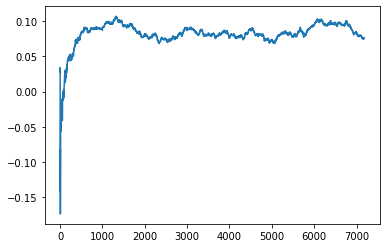

Thread: 5 iteration: 1260
RAM mProject_3 FROM: 2176 --> 256 reward: -1.0
Thread: 1 iteration: 1134
RAM mDiffFit_413 FROM: 2624 --> 192 reward: 0.16279681484375
Thread: 2 iteration: 1195
RAM mDiffFit_237 FROM: 1920 --> 192 reward: 0.10763267851562501
Saving ...


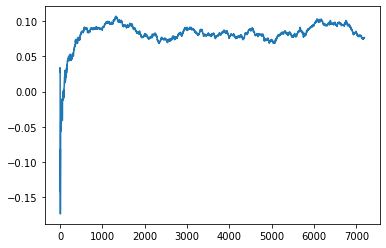

Thread: 4 iteration: 1210
RAM mBackground_68 FROM: 1792 --> 320 reward: 0.3868185443671875
Thread: 6 iteration: 1207
RAM mBgModel_3 FROM: 2304 --> 1152 reward: 0.04186240812499997
Thread: 3 iteration: 1184
RAM mDiffFit_150 FROM: 1344 --> 192 reward: 0.08304677109374999
Thread: 5 iteration: 1261
RAM mBgModel_3 FROM: 2816 --> 1152 reward: -0.0018564228124999804
Thread: 2 iteration: 1196
RAM mDiffFit_387 FROM: 2560 --> 320 reward: 0.13486714648437503
Thread: 4 iteration: 1211
RAM mDiffFit_354 FROM: 1024 --> 384 reward: 0.13074477890625
Thread: 3 iteration: 1185
RAM mBackground_59 FROM: 128 --> 1920 reward: 0.28453936820312503
Thread: 5 iteration: 1262
RAM mDiffFit_388 FROM: 1856 --> 384 reward: -1.09949604765625
Thread: 2 iteration: 1197
RAM mDiffFit_308 FROM: 1344 --> 384 reward: 0.09515623906250001
Thread: 5 iteration: 1263
RAM mBackground_20 FROM: 1792 --> 704 reward: 0.12411767384375
Thread: 2 iteration: 1198
RAM mProject_13 FROM: 2560 --> 256 reward: -1.0
Thread: 1 iteration: 1135
RA

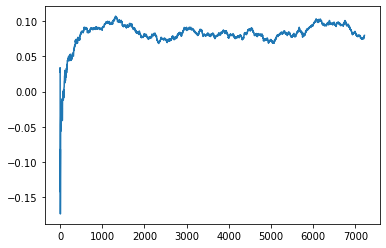

Thread: 2 iteration: 1200
RAM mDiffFit_40 FROM: 1600 --> 192 reward: 0.19313798710937496
Thread: 5 iteration: 1265
RAM mDiffFit_317 FROM: 2048 --> 192 reward: 0.1757603546875
Saving ...


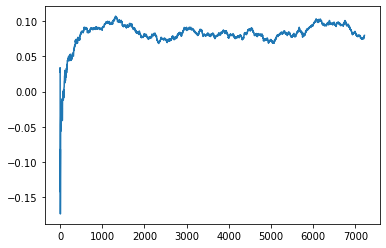

Thread: 1 iteration: 1140
RAM mDiffFit_293 FROM: 3008 --> 192 reward: 0.12823161679687503
Thread: 5 iteration: 1266
RAM mDiffFit_83 FROM: 448 --> 192 reward: 0.18618230078125003
Thread: 2 iteration: 1201
RAM mBackground_63 FROM: 2176 --> 192 reward: 0.7467105838046875
Saving ...


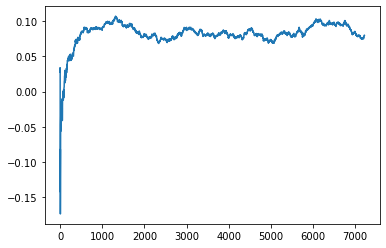

Thread: 6 iteration: 1210
RAM mProject_46 FROM: 2368 --> 1024 reward: 0.12404791040625018
Thread: 4 iteration: 1213
RAM mBackground_17 FROM: 2752 --> 192 reward: 0.7450734068437501
Thread: 1 iteration: 1141
RAM mDiffFit_187 FROM: 2880 --> 2560 reward: 0.016393251953124993
Thread: 5 iteration: 1267
RAM mDiffFit_38 FROM: 768 --> 2752 reward: 0.04080488710937507
Thread: 2 iteration: 1202
RAM mBackground_43 FROM: 1088 --> 704 reward: 0.05643523611718743
Thread: 6 iteration: 1211
RAM mProject_32 FROM: 2624 --> 1024 reward: 0.07723002276562493
Thread: 3 iteration: 1188
RAM mDiffFit_291 FROM: 1472 --> 2752 reward: -0.22134389218750006
Thread: 4 iteration: 1214
RAM mBackground_33 FROM: 128 --> 704 reward: -1.4181288310859375
Thread: 1 iteration: 1142
RAM mDiffFit_96 FROM: 1920 --> 192 reward: 0.24317966835937496
Thread: 2 iteration: 1203
RAM mDiffFit_174 FROM: 2688 --> 192 reward: 0.33471090742187504
Thread: 5 iteration: 1268
RAM mDiffFit_331 FROM: 384 --> 2560 reward: -0.19538017734375002
Thr

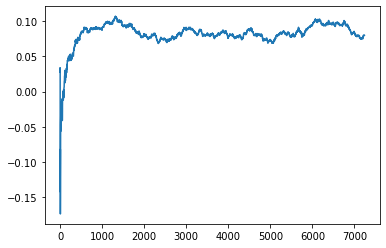

Thread: 3 iteration: 1190
RAM mDiffFit_123 FROM: 448 --> 192 reward: 0.104148429296875
Saving ...


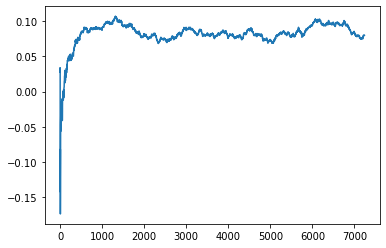

Thread: 5 iteration: 1270
RAM mBackground_38 FROM: 2112 --> 192 reward: 0.7924361935625001
Thread: 6 iteration: 1213
RAM mBackground_67 FROM: 1024 --> 192 reward: 0.72835728853125
Thread: 1 iteration: 1144
RAM mDiffFit_414 FROM: 1024 --> 192 reward: 0.26052084062499997
Thread: 6 iteration: 1214
RAM mDiffFit_316 FROM: 1536 --> 192 reward: 0.07854677109375
Thread: 3 iteration: 1191
RAM mDiffFit_398 FROM: 2496 --> 320 reward: 0.113455686328125
Thread: 6 iteration: 1215
RAM mBackground_9 FROM: 2688 --> 192 reward: 0.753722685515625
Thread: 4 iteration: 1216
RAM mDiffFit_238 FROM: 2816 --> 192 reward: 0.273690023046875
Thread: 1 iteration: 1145
RAM mProject_6 FROM: 1984 --> 1024 reward: 0.19464321185156253
Thread: 2 iteration: 1205
RAM mDiffFit_114 FROM: 1280 --> 192 reward: 0.1926353984375
Thread: 1 iteration: 1146
RAM mDiffFit_168 FROM: 3008 --> 192 reward: 0.19782024414062502
Thread: 4 iteration: 1217
RAM mBackground_66 FROM: 640 --> 192 reward: 0.8848863064375001
Thread: 3 iteration: 11

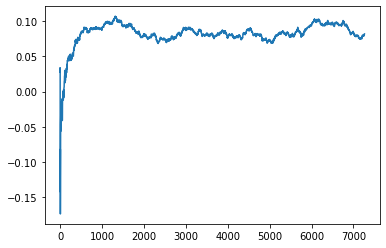

Thread: 4 iteration: 1220
RAM mDiffFit_267 FROM: 2816 --> 832 reward: 0.0035155757812499987
Saving ...


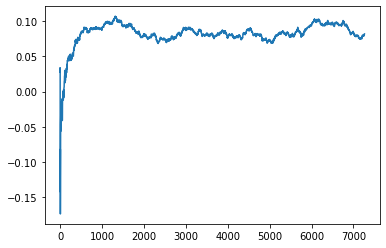

Thread: 1 iteration: 1150
RAM mDiffFit_56 FROM: 1856 --> 320 reward: 0.25934630585937507
Thread: 2 iteration: 1208
RAM mDiffFit_358 FROM: 704 --> 384 reward: 0.039765619531250004
Thread: 3 iteration: 1196
RAM mDiffFit_314 FROM: 2432 --> 320 reward: 0.14138017734374997
Thread: 2 iteration: 1209
RAM mDiffFit_61 FROM: 1344 --> 256 reward: 0.23647393828125002
Thread: 1 iteration: 1151
RAM mDiffFit_91 FROM: 320 --> 256 reward: -0.140445375390625
Thread: 3 iteration: 1197
RAM mProject_5 FROM: 2368 --> 256 reward: -1.0
Thread: 5 iteration: 1272
RAM mDiffFit_38 FROM: 960 --> 1984 reward: -0.08560157070312505
Thread: 3 iteration: 1198
RAM mProject_72 FROM: 1088 --> 1024 reward: 0.03167343717187486
Thread: 6 iteration: 1217
RAM mDiffFit_175 FROM: 1216 --> 320 reward: 0.27183331875
Thread: 1 iteration: 1152
RAM mDiffFit_77 FROM: 1280 --> 640 reward: 0.0037134960937500357
Thread: 6 iteration: 1218
RAM mBackground_74 FROM: 2624 --> 192 reward: 0.7177146380312499
Thread: 5 iteration: 1273
RAM mDiffF

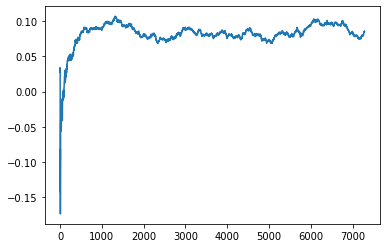

Thread: 2 iteration: 1210
RAM mBackground_54 FROM: 448 --> 1792 reward: -0.19765657887499996
Thread: 4 iteration: 1223
RAM mDiffFit_203 FROM: 1728 --> 256 reward: 0.115408827734375
Thread: 1 iteration: 1155
RAM mProject_55 FROM: 2816 --> 2240 reward: -0.2572335194062501
Thread: 5 iteration: 1274
RAM mDiffFit_5 FROM: 2496 --> 256 reward: 0.17219006679687504
Thread: 2 iteration: 1211
RAM mProject_48 FROM: 3008 --> 320 reward: -1.0
Thread: 3 iteration: 1199
RAM mDiffFit_284 FROM: 576 --> 384 reward: 0.04814842929687504
Saving ...


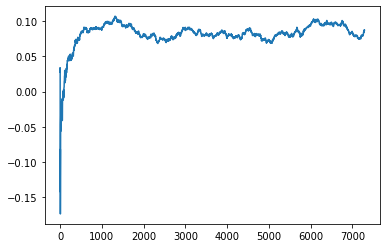

Thread: 3 iteration: 1200
RAM mBackground_9 FROM: 2240 --> 192 reward: 0.7021428347109376
Thread: 4 iteration: 1224
RAM mBackground_11 FROM: 1024 --> 1792 reward: -0.05178809678124996
Thread: 3 iteration: 1201
RAM mProject_20 FROM: 1152 --> 1024 reward: 0.057749997375000015
Saving ...


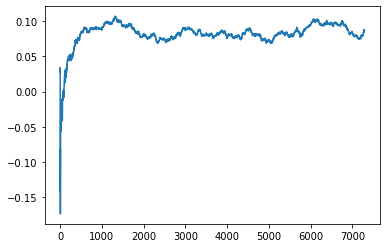

Thread: 6 iteration: 1220
RAM mDiffFit_11 FROM: 384 --> 384 reward: -0.069062521875
Thread: 6 iteration: 1221
RAM mProject_12 FROM: 1280 --> 1024 reward: 0.10499437434374999
Thread: 1 iteration: 1156
RAM mProject_60 FROM: 1792 --> 1024 reward: 0.20101309678124993
Thread: 2 iteration: 1212
RAM mProject_28 FROM: 2880 --> 1024 reward: 0.042503053921875034
Thread: 5 iteration: 1275
RAM mDiffFit_384 FROM: 2496 --> 192 reward: 0.23361714648437504
Thread: 1 iteration: 1157
RAM mDiffFit_241 FROM: 2816 --> 192 reward: 0.31149214648437507
Thread: 2 iteration: 1213
RAM mBackground_32 FROM: 1536 --> 192 reward: 0.7183149623749999
Thread: 5 iteration: 1276
RAM mProject_87 FROM: 256 --> 896 reward: 0.9063709257656251
Thread: 3 iteration: 1202
RAM mDiffFit_241 FROM: 1536 --> 192 reward: 0.198382766015625
Thread: 1 iteration: 1158
RAM mDiffFit_136 FROM: 2112 --> 192 reward: 0.261562478125
Thread: 2 iteration: 1214
RAM mProject_69 FROM: 2688 --> 256 reward: -1.0
Thread: 4 iteration: 1225
RAM mDiffFit_9

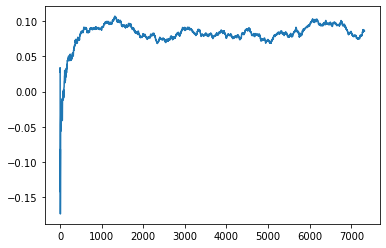

Thread: 5 iteration: 1280
RAM mDiffFit_371 FROM: 576 --> 192 reward: 0.09124214648437501
Thread: 4 iteration: 1229
RAM mBackground_77 FROM: 2816 --> 192 reward: 0.9241751232421873
Thread: 3 iteration: 1205
RAM mDiffFit_62 FROM: 2816 --> 192 reward: 0.19655462460937498
Thread: 5 iteration: 1281
RAM mProject_66 FROM: 704 --> 768 reward: -1.0
Saving ...


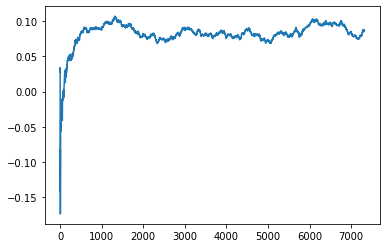

Thread: 1 iteration: 1160
RAM mBackground_63 FROM: 1408 --> 192 reward: 0.7464620018125
Thread: 2 iteration: 1216
RAM mProject_1 FROM: 832 --> 2240 reward: -0.2678360911875
Thread: 6 iteration: 1225
RAM mDiffFit_292 FROM: 1280 --> 192 reward: 0.21886451406250002
Saving ...


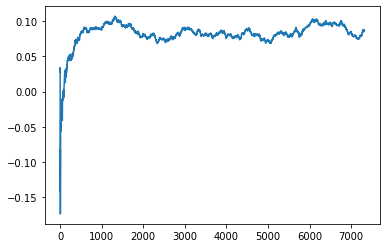

Thread: 4 iteration: 1230
RAM mDiffFit_61 FROM: 448 --> 192 reward: 0.160919269921875
Thread: 5 iteration: 1282
RAM mDiffFit_238 FROM: 2304 --> 192 reward: 0.21073433671875003
Thread: 4 iteration: 1231
RAM mDiffFit_102 FROM: 1344 --> 192 reward: 0.42151553203125
Thread: 1 iteration: 1161
RAM mDiffFit_181 FROM: 1280 --> 192 reward: 0.20312758867187503
Thread: 5 iteration: 1283
RAM mBackground_54 FROM: 960 --> 192 reward: 0.8065590672031251
Thread: 2 iteration: 1217
RAM mDiffFit_49 FROM: 576 --> 384 reward: 0.03826561953124998
Thread: 1 iteration: 1162
RAM mBackground_65 FROM: 1088 --> 768 reward: 0.13734024909375
Thread: 4 iteration: 1232
RAM mProject_26 FROM: 1472 --> 1024 reward: 0.16242796596093748
Thread: 3 iteration: 1206
RAM mDiffFit_202 FROM: 1472 --> 384 reward: 0.05566922617187499
Thread: 2 iteration: 1218
RAM mDiffFit_45 FROM: 2816 --> 384 reward: 0.04257805390625001
Thread: 3 iteration: 1207
RAM mDiffFit_132 FROM: 704 --> 384 reward: 0.24840891523437497
Thread: 1 iteration: 1

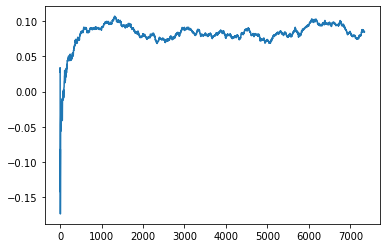

Thread: 2 iteration: 1220
RAM mDiffFit_45 FROM: 1344 --> 192 reward: 0.17328119531249997
Thread: 3 iteration: 1209
RAM mDiffFit_385 FROM: 2048 --> 192 reward: 0.26567966835937495
Thread: 4 iteration: 1234
RAM mDiffFit_240 FROM: 2176 --> 192 reward: 0.22882546523437505
Thread: 1 iteration: 1165
RAM mDiffFit_351 FROM: 1216 --> 192 reward: 0.19533331874999998
Thread: 6 iteration: 1227
RAM mProject_65 FROM: 1728 --> 1024 reward: 0.18924325122656238
Thread: 5 iteration: 1284
RAM mDiffFit_14 FROM: 704 --> 2560 reward: -0.021528606640625024
Thread: 4 iteration: 1235
RAM mDiffFit_29 FROM: 2752 --> 2560 reward: 0.002031239062499999
Thread: 6 iteration: 1228
RAM mDiffFit_76 FROM: 2752 --> 192 reward: 0.16481243437500004
Saving ...


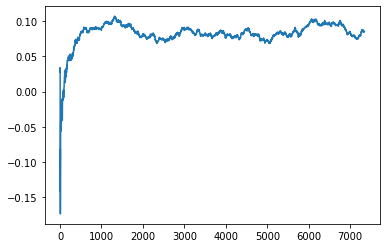

Thread: 3 iteration: 1210
RAM mDiffFit_213 FROM: 2176 --> 192 reward: 0.511387943359375
Thread: 5 iteration: 1285
RAM mBackground_1 FROM: 1664 --> 192 reward: 0.7713258951718751
Thread: 2 iteration: 1221
RAM mDiffFit_302 FROM: 1216 --> 2560 reward: 0.0031407070312499882
Thread: 4 iteration: 1236
RAM mDiffFit_135 FROM: 1664 --> 832 reward: -0.006898473046875013
Thread: 5 iteration: 1286
RAM mDiffFit_217 FROM: 1856 --> 832 reward: -0.009742233984374998
Thread: 2 iteration: 1222
RAM mProject_73 FROM: 1024 --> 2240 reward: -0.139971394828125
Thread: 1 iteration: 1166
RAM mDiffFit_293 FROM: 1408 --> 832 reward: 0.0017916374999999915
Thread: 4 iteration: 1237
RAM mProject_36 FROM: 2304 --> 2240 reward: -0.02167362836718758
Thread: 6 iteration: 1229
RAM mDiffFit_39 FROM: 2944 --> 832 reward: 0.0020311953124999872
Thread: 5 iteration: 1287
RAM mDiffFit_22 FROM: 2368 --> 832 reward: -0.010513074609374996
Thread: 2 iteration: 1223
RAM mDiffFit_46 FROM: 1600 --> 832 reward: 0.017192699218749996
T

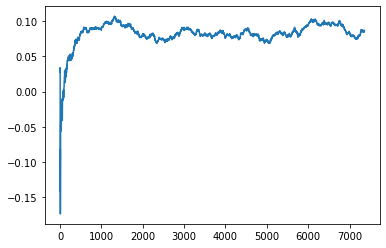

Thread: 6 iteration: 1230
RAM mDiffFit_398 FROM: 576 --> 832 reward: -0.014039048828124994
Thread: 5 iteration: 1288
RAM mProject_12 FROM: 1920 --> 1024 reward: 0.20660245537499997
Thread: 3 iteration: 1211
RAM mDiffFit_94 FROM: 3008 --> 192 reward: 0.4670441824218749
Thread: 4 iteration: 1239
RAM mDiffFit_191 FROM: 2176 --> 256 reward: 0.22457287656250005
Thread: 3 iteration: 1212
RAM mDiffFit_66 FROM: 1216 --> 192 reward: 0.2550520796875
Thread: 6 iteration: 1231
RAM mDiffFit_369 FROM: 704 --> 256 reward: 0.10244528789062499
Thread: 5 iteration: 1289
RAM mDiffFit_106 FROM: 448 --> 384 reward: 0.018205730078124996
Thread: 3 iteration: 1213
RAM mDiffFit_164 FROM: 2944 --> 320 reward: 0.13756765546875
Thread: 6 iteration: 1232
RAM mDiffFit_210 FROM: 2752 --> 320 reward: 0.23811977890625
Saving ...


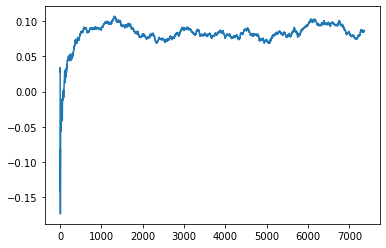

Thread: 5 iteration: 1290
RAM mProject_4 FROM: 2432 --> 1024 reward: 0.102893195671875
Thread: 2 iteration: 1224
RAM mDiffFit_109 FROM: 1344 --> 384 reward: 0.09136719023437503
Thread: 3 iteration: 1214
RAM mDiffFit_134 FROM: 1408 --> 320 reward: 0.15697657070312504
Thread: 6 iteration: 1233
RAM mProject_37 FROM: 1728 --> 1024 reward: 0.23213204191406256
Thread: 1 iteration: 1168
RAM mDiffFit_50 FROM: 1792 --> 320 reward: 0.27226820820312503
Thread: 5 iteration: 1291
RAM mDiffFit_205 FROM: 576 --> 320 reward: 0.08306511054687499
Thread: 2 iteration: 1225
RAM mDiffFit_332 FROM: 1536 --> 320 reward: 0.06806506679687499
Thread: 3 iteration: 1215
RAM mDiffFit_352 FROM: 1984 --> 320 reward: 0.147200508984375
Thread: 5 iteration: 1292
RAM mDiffFit_94 FROM: 960 --> 320 reward: 0.18845309765625
Thread: 6 iteration: 1234
RAM mDiffFit_323 FROM: 1984 --> 320 reward: 0.27549473515625
Thread: 1 iteration: 1169
RAM mDiffFit_278 FROM: 2944 --> 192 reward: -0.15630778203125004
Thread: 2 iteration: 122

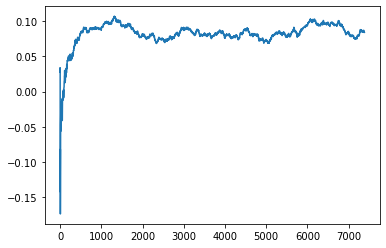

Thread: 1 iteration: 1170
RAM mBackground_7 FROM: 2752 --> 192 reward: -1.0
Saving ...


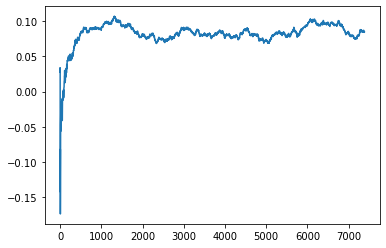

Thread: 4 iteration: 1240
RAM mDiffFit_422 FROM: 1472 --> 384 reward: 0.07702860664062498
Thread: 5 iteration: 1294
RAM mBackground_90 FROM: 2304 --> 192 reward: 0.6816170887343751
Thread: 2 iteration: 1227
RAM mDiffFit_403 FROM: 2432 --> 1088 reward: 0.09914847304687502
Thread: 6 iteration: 1236
RAM mDiffFit_31 FROM: 2048 --> 384 reward: 0.05260933671874999
Thread: 1 iteration: 1171
RAM mDiffFit_289 FROM: 3008 --> 1088 reward: 0.02185152695312503
Thread: 5 iteration: 1295
RAM mDiffFit_234 FROM: 768 --> 384 reward: 0.08073438046875003
Thread: 4 iteration: 1241
RAM mDiffFit_93 FROM: 1216 --> 1088 reward: -0.004557300781250009
Thread: 6 iteration: 1237
RAM mDiffFit_32 FROM: 2048 --> 1088 reward: -0.065138118359375
Thread: 5 iteration: 1296
RAM mDiffFit_351 FROM: 192 --> 384 reward: -0.12575
Thread: 1 iteration: 1172
RAM mDiffFit_44 FROM: 640 --> 1088 reward: -0.046278650390624995
Thread: 1 iteration: 1173
RAM mProject_50 FROM: 1408 --> 1024 reward: 0.14294718323437508
Thread: 3 iteration

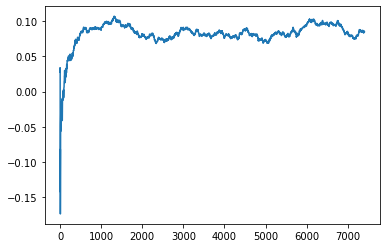

Thread: 2 iteration: 1230
RAM mBackground_5 FROM: 1216 --> 1792 reward: -0.033878159054687454
Thread: 1 iteration: 1178
RAM mDiffFit_324 FROM: 2368 --> 1088 reward: -0.05644541914062499
Thread: 4 iteration: 1243
RAM mDiffFit_154 FROM: 2880 --> 1088 reward: 0.058320287890625024
Thread: 6 iteration: 1239
RAM mProject_12 FROM: 384 --> 896 reward: 0.92430812475
Thread: 3 iteration: 1218
RAM mProject_76 FROM: 2560 --> 1024 reward: 0.09760849143750006
Thread: 5 iteration: 1298
RAM mDiffFit_7 FROM: 2624 --> 2112 reward: 0.04776566328124999
Thread: 1 iteration: 1179
RAM mDiffFit_180 FROM: 1088 --> 2112 reward: 0.040750087499999976
Thread: 2 iteration: 1231
RAM mBackground_29 FROM: 2048 --> 1408 reward: 0.05740499999999998
Thread: 5 iteration: 1299
RAM mDiffFit_222 FROM: 2432 --> 2752 reward: 0.03530734453125
Saving ...


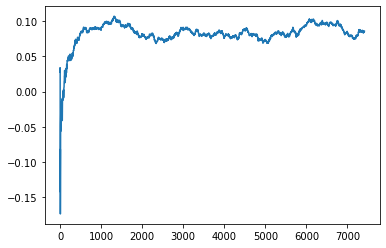

Thread: 1 iteration: 1180
RAM mDiffFit_153 FROM: 896 --> 384 reward: 0.07180207968750003
Thread: 2 iteration: 1232
RAM mDiffFit_380 FROM: 2496 --> 320 reward: 0.1038020359375
Saving ...


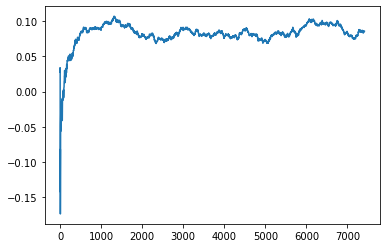

Thread: 5 iteration: 1300
RAM mDiffFit_95 FROM: 192 --> 320 reward: -0.28172139335937496
Thread: 1 iteration: 1181
RAM mDiffFit_363 FROM: 2560 --> 320 reward: 0.09505984570312502
Thread: 2 iteration: 1233
RAM mDiffFit_416 FROM: 1920 --> 320 reward: 0.142299447265625
Thread: 5 iteration: 1301
RAM mDiffFit_363 FROM: 1280 --> 320 reward: -0.01493760937499998
Thread: 1 iteration: 1182
RAM mProject_14 FROM: 2112 --> 1024 reward: 0.1685820677343749
Thread: 4 iteration: 1244
RAM mProject_22 FROM: 1600 --> 1024 reward: 0.18122717798437504
Saving ...


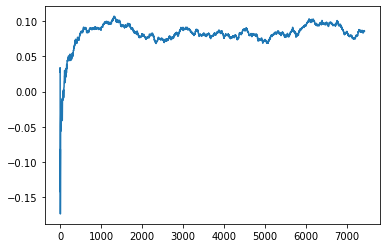

Thread: 6 iteration: 1240
RAM mDiffFit_288 FROM: 1536 --> 320 reward: 0.0010025011718750067
Thread: 2 iteration: 1234
RAM mDiffFit_34 FROM: 3008 --> 320 reward: 0.22781497929687503
Thread: 5 iteration: 1302
RAM mDiffFit_249 FROM: 1088 --> 320 reward: 0.12822134960937498
Thread: 6 iteration: 1241
RAM mViewer_3 FROM: 512 --> 640 reward: -0.10661064665625004
Thread: 4 iteration: 1245
RAM mDiffFit_206 FROM: 1280 --> 192 reward: 0.46322920312499993
Thread: 2 iteration: 1235
RAM mBackground_82 FROM: 2816 --> 192 reward: 0.7155892773671877
Thread: 1 iteration: 1183
RAM mDiffFit_237 FROM: 1024 --> 192 reward: 0.18330988945312504
Thread: 5 iteration: 1303
RAM mViewer_2 FROM: 576 --> 640 reward: 0.012619082953124914
Thread: 6 iteration: 1242
RAM mDiffFit_292 FROM: 2112 --> 192 reward: 0.198976526953125
Thread: 4 iteration: 1246
RAM mBackground_54 FROM: 2048 --> 1792 reward: -0.030861517906250007
Thread: 2 iteration: 1236
RAM mProject_19 FROM: 2880 --> 256 reward: -1.0
Thread: 3 iteration: 1219
R

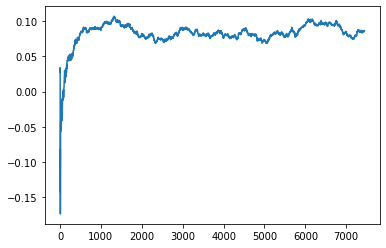

Thread: 2 iteration: 1240
RAM mBackground_87 FROM: 2688 --> 192 reward: 0.6960018642890626
Thread: 4 iteration: 1249
RAM mProject_26 FROM: 2112 --> 1024 reward: 0.173029572984375
Saving ...


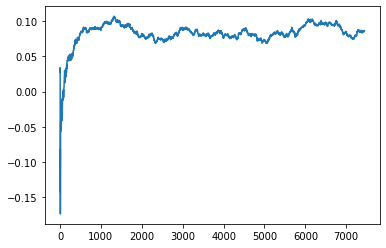

Thread: 3 iteration: 1220
RAM mDiffFit_128 FROM: 3008 --> 320 reward: 0.03767953710937501
Thread: 6 iteration: 1246
RAM mDiffFit_321 FROM: 832 --> 320 reward: 0.06190101796875001
Thread: 3 iteration: 1221
RAM mDiffFit_216 FROM: 832 --> 192 reward: 0.101395796875
Saving ...


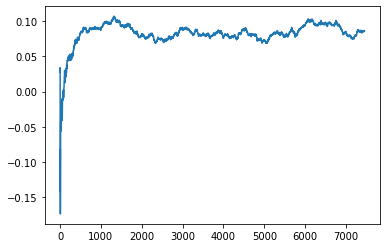

Thread: 4 iteration: 1250
RAM mDiffFit_361 FROM: 768 --> 192 reward: 0.22814061953125006
Thread: 2 iteration: 1241
RAM mProject_66 FROM: 2496 --> 1024 reward: 0.10554678203906251
Thread: 5 iteration: 1307
RAM mBackground_70 FROM: 2432 --> 192 reward: 0.69153840684375
Thread: 1 iteration: 1186
RAM mDiffFit_261 FROM: 256 --> 384 reward: -0.24380212343750007
Thread: 5 iteration: 1308
RAM mBackground_20 FROM: 1536 --> 320 reward: 0.38627210171093745
Thread: 3 iteration: 1222
RAM mDiffFit_53 FROM: 448 --> 192 reward: 0.19979168124999996
Thread: 1 iteration: 1187
RAM mBackground_90 FROM: 1216 --> 320 reward: 0.30394498702343753
Thread: 4 iteration: 1251
RAM mBackground_9 FROM: 1408 --> 320 reward: 0.42964165412499994
Thread: 2 iteration: 1242
RAM mDiffFit_409 FROM: 1536 --> 192 reward: 0.21477342929687498
Thread: 3 iteration: 1223
RAM mDiffFit_334 FROM: 960 --> 192 reward: 0.14848433671875
Thread: 4 iteration: 1252
RAM mBackground_68 FROM: 2880 --> 320 reward: 0.30025844316406247
Thread: 5 i

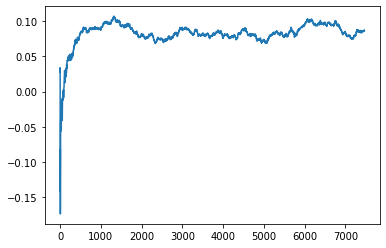

Thread: 5 iteration: 1310
RAM mDiffFit_105 FROM: 2048 --> 192 reward: 0.17722652695312502
Thread: 3 iteration: 1225
RAM mDiffFit_204 FROM: 2944 --> 192 reward: 0.14234367343749998
Saving ...


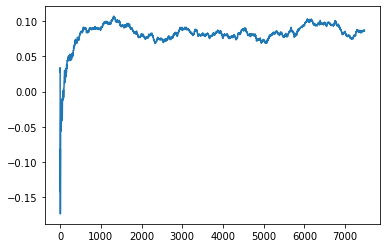

Thread: 1 iteration: 1190
RAM mDiffFit_281 FROM: 2688 --> 192 reward: 0.16245296640625004
Thread: 4 iteration: 1254
RAM mDiffFit_19 FROM: 768 --> 832 reward: -0.0011406195312500117
Thread: 3 iteration: 1226
RAM mDiffFit_169 FROM: 2944 --> 320 reward: 0.079981704296875
Thread: 5 iteration: 1311
RAM mDiffFit_380 FROM: 1152 --> 192 reward: 0.1949062390625
Thread: 2 iteration: 1244
RAM mBackground_78 FROM: 1024 --> 1408 reward: 0.27954059939062503
Thread: 6 iteration: 1248
RAM mDiffFit_182 FROM: 1728 --> 832 reward: 0.011078097656250004
Thread: 3 iteration: 1227
RAM mDiffFit_71 FROM: 448 --> 832 reward: -0.06666926992187502
Thread: 5 iteration: 1312
RAM mDiffFit_142 FROM: 2880 --> 320 reward: 0.11620564257812496
Thread: 4 iteration: 1255
RAM mDiffFit_11 FROM: 2304 --> 640 reward: 0.04414057578125
Thread: 4 iteration: 1256
RAM mDiffFit_56 FROM: 2112 --> 448 reward: 0.303210907421875
Thread: 3 iteration: 1228
RAM mDiffFit_7 FROM: 1664 --> 448 reward: 0.20042966835937498
Thread: 5 iteration: 

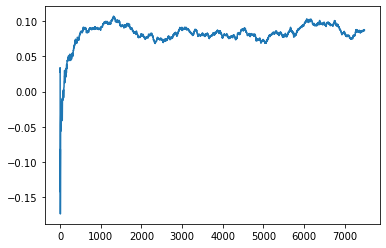

Thread: 3 iteration: 1230
RAM mDiffFit_413 FROM: 2432 --> 640 reward: 0.17003128281250002
Thread: 4 iteration: 1258
RAM mDiffFit_247 FROM: 1024 --> 640 reward: 0.14295318515625
Thread: 5 iteration: 1315
RAM mProject_48 FROM: 1408 --> 384 reward: -1.0
Thread: 1 iteration: 1191
RAM mProject_11 FROM: 2368 --> 256 reward: -1.0
Thread: 2 iteration: 1245
RAM mDiffFit_420 FROM: 2304 --> 192 reward: 0.173007766015625
Thread: 5 iteration: 1316
RAM mProject_17 FROM: 2304 --> 384 reward: -1.0
Thread: 6 iteration: 1249
RAM mDiffFit_38 FROM: 512 --> 256 reward: 0.2665520796875001
Thread: 3 iteration: 1231
RAM mDiffFit_302 FROM: 2688 --> 192 reward: 0.48124205898437494
Thread: 4 iteration: 1259
RAM mDiffFit_410 FROM: 1600 --> 640 reward: 0.015617146484374986
Saving ...


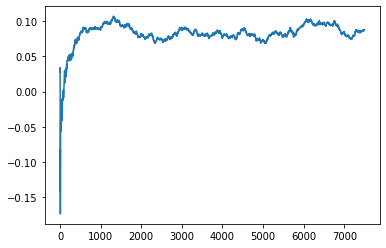

Thread: 6 iteration: 1250
RAM mViewer_2 FROM: 1216 --> 1408 reward: 0.000632519249999966
Thread: 5 iteration: 1317
RAM mBackground_89 FROM: 320 --> 704 reward: -0.23642159185156253
Thread: 2 iteration: 1246
RAM mDiffFit_131 FROM: 896 --> 192 reward: 0.21341404882812498
Thread: 3 iteration: 1232
RAM mBackground_46 FROM: 3008 --> 192 reward: 0.679332572640625
Thread: 1 iteration: 1192
RAM mDiffFit_263 FROM: 1472 --> 1984 reward: -0.004919269921875007
Saving ...


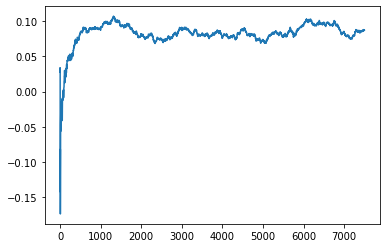

Thread: 4 iteration: 1260
RAM mDiffFit_373 FROM: 896 --> 2560 reward: 0.004010485937499999
Thread: 2 iteration: 1247
RAM mDiffFit_257 FROM: 128 --> 832 reward: -0.626596393359375
Thread: 4 iteration: 1261
RAM mBackground_13 FROM: 1088 --> 320 reward: 0.31477116891406254
Thread: 6 iteration: 1251
RAM mDiffFit_353 FROM: 1664 --> 640 reward: 0.09765106171875002
Thread: 3 iteration: 1233
RAM mBackground_74 FROM: 832 --> 704 reward: 0.0289376491953125
Thread: 1 iteration: 1193
RAM mDiffFit_213 FROM: 704 --> 1984 reward: -0.14682033164062502
Thread: 5 iteration: 1318
RAM mDiffFit_98 FROM: 704 --> 832 reward: -0.05674482265624999
Thread: 4 iteration: 1262
RAM mDiffFit_199 FROM: 2560 --> 1984 reward: 0.013822920312499994
Thread: 6 iteration: 1252
RAM mDiffFit_214 FROM: 2112 --> 192 reward: 0.25207028789062497
Thread: 2 iteration: 1248
RAM mDiffFit_420 FROM: 2240 --> 320 reward: 0.13393484570312497
Thread: 1 iteration: 1194
RAM mBackground_16 FROM: 576 --> 320 reward: 0.19962972625781253
Thread

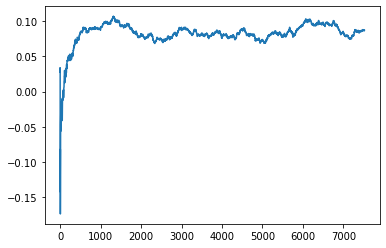

Thread: 2 iteration: 1250
RAM mBackground_90 FROM: 1152 --> 320 reward: 0.3554218655937501
Thread: 3 iteration: 1236
RAM mDiffFit_312 FROM: 960 --> 1984 reward: -0.01617185859375002
Thread: 2 iteration: 1251
RAM mDiffFit_23 FROM: 192 --> 320 reward: -0.2617396015624999
Thread: 4 iteration: 1264
RAM mDiffFit_199 FROM: 576 --> 192 reward: 0.16825
Thread: 6 iteration: 1255
RAM mBackground_58 FROM: 1984 --> 192 reward: 0.7679217034218749
Thread: 1 iteration: 1195
RAM mDiffFit_53 FROM: 2560 --> 1984 reward: 0.00944792031249999
Thread: 2 iteration: 1252
RAM mDiffFit_270 FROM: 2624 --> 320 reward: 0.26065093046875
Thread: 3 iteration: 1237
RAM mDiffFit_335 FROM: 1472 --> 192 reward: 0.24900258867187502
Thread: 4 iteration: 1265
RAM mDiffFit_134 FROM: 2304 --> 192 reward: 0.26632809765625
Thread: 1 iteration: 1196
RAM mBackground_87 FROM: 704 --> 1792 reward: -0.136816106640625
Thread: 2 iteration: 1253
RAM mBackground_88 FROM: 2112 --> 192 reward: 0.7732004099609374
Saving ...


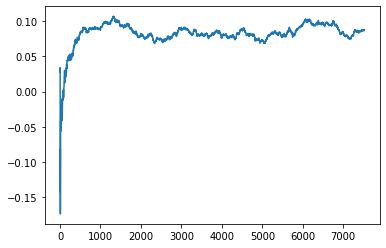

Thread: 5 iteration: 1320
RAM mDiffFit_280 FROM: 832 --> 192 reward: 0.22226820820312498
Thread: 4 iteration: 1266
RAM mDiffFit_180 FROM: 2816 --> 192 reward: 0.19447907187500002
Thread: 2 iteration: 1254
RAM mDiffFit_276 FROM: 1344 --> 192 reward: 0.29604681484375
Thread: 5 iteration: 1321
RAM mDiffFit_196 FROM: 896 --> 192 reward: 0.33484376093749996
Thread: 1 iteration: 1197
RAM mDiffFit_93 FROM: 1024 --> 192 reward: 0.17301820820312502
Thread: 2 iteration: 1255
RAM mDiffFit_369 FROM: 1216 --> 192 reward: 0.23368488945312493
Thread: 4 iteration: 1267
RAM mProject_49 FROM: 2240 --> 1024 reward: 0.15370249957031246
Thread: 6 iteration: 1256
RAM mDiffFit_181 FROM: 256 --> 192 reward: 0.21660679179687498
Thread: 5 iteration: 1322
RAM mDiffFit_413 FROM: 1472 --> 192 reward: 0.08773688164062504
Thread: 4 iteration: 1268
RAM mImgtbl_3 FROM: 2816 --> 1408 reward: 0.07169575312500004
Thread: 6 iteration: 1257
RAM mProject_81 FROM: 2304 --> 1024 reward: 0.13721607281250006
Thread: 3 iteration

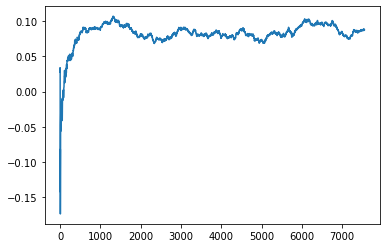

Thread: 4 iteration: 1270
RAM mDiffFit_208 FROM: 1088 --> 192 reward: 0.25693488945312504
Thread: 6 iteration: 1259
RAM mDiffFit_204 FROM: 768 --> 192 reward: 0.21235938046875003
Saving ...


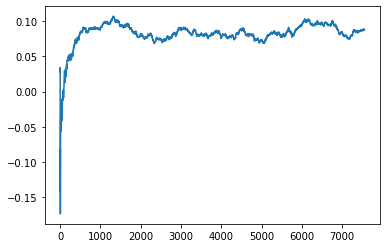

Thread: 1 iteration: 1200
RAM mDiffFit_214 FROM: 2560 --> 192 reward: 0.3861770359375
Thread: 5 iteration: 1325
RAM mDiffFit_92 FROM: 768 --> 192 reward: 0.142320244140625
Thread: 4 iteration: 1271
RAM mBackground_68 FROM: 896 --> 192 reward: 0.8051212688124999
Saving ...


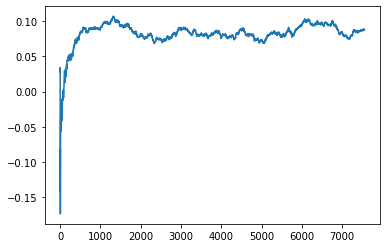

Thread: 3 iteration: 1240
RAM mDiffFit_307 FROM: 2816 --> 448 reward: 0.1505103984375
Thread: 1 iteration: 1201
RAM mDiffFit_296 FROM: 1280 --> 448 reward: 0.105429668359375
Thread: 4 iteration: 1272
RAM mDiffFit_93 FROM: 2752 --> 192 reward: 0.3223515269531251
Saving ...


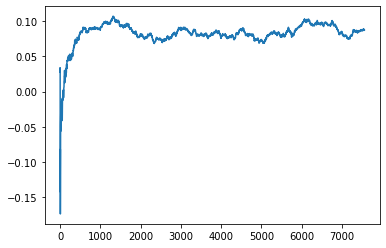

Thread: 6 iteration: 1260
RAM mDiffFit_382 FROM: 192 --> 320 reward: -0.287263030859375
Thread: 3 iteration: 1241
RAM mDiffFit_115 FROM: 2176 --> 320 reward: -0.017807432031250025
Thread: 5 iteration: 1326
RAM mProject_68 FROM: 2496 --> 1024 reward: 0.10384522446093748
Thread: 2 iteration: 1258
RAM mDiffFit_22 FROM: 2176 --> 384 reward: 0.013156195312499994
Thread: 4 iteration: 1273
RAM mBackground_50 FROM: 576 --> 1792 reward: -0.16488703943749994
Thread: 1 iteration: 1202
RAM mDiffFit_222 FROM: 448 --> 384 reward: -0.04582033164062499
Thread: 3 iteration: 1242
RAM mDiffFit_117 FROM: 2560 --> 256 reward: 0.20384371718750002
Thread: 5 iteration: 1327
RAM mDiffFit_7 FROM: 2688 --> 384 reward: 0.10287495624999998
Thread: 3 iteration: 1243
RAM mDiffFit_209 FROM: 2368 --> 384 reward: 0.19361455781250003
Thread: 1 iteration: 1203
RAM mDiffFit_232 FROM: 1216 --> 384 reward: 0.15336460156250004
Thread: 5 iteration: 1328
RAM mDiffFit_281 FROM: 1280 --> 320 reward: 0.112070244140625
Thread: 4 i

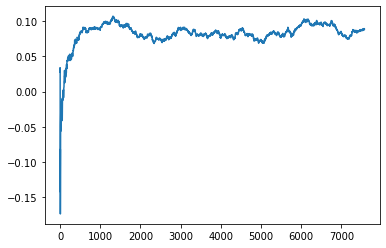

Thread: 5 iteration: 1330
RAM mDiffFit_38 FROM: 832 --> 1088 reward: 0.019875043750000043
Thread: 1 iteration: 1206
RAM mDiffFit_128 FROM: 2880 --> 320 reward: 0.069091041015625
Thread: 4 iteration: 1276
RAM mConcatFit_3 FROM: 1728 --> 704 reward: 0.09589161125000001
Saving ...


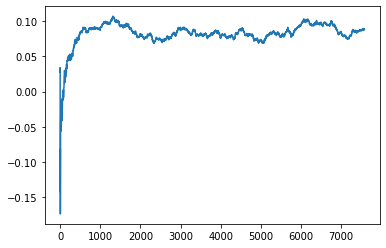

Thread: 2 iteration: 1260
RAM mBackground_2 FROM: 1984 --> 192 reward: 0.7045302854140626
Thread: 3 iteration: 1246
RAM mDiffFit_411 FROM: 704 --> 1088 reward: -0.07760938046874999
Thread: 4 iteration: 1277
RAM mBackground_88 FROM: 2304 --> 192 reward: 0.7436110067421875
Thread: 5 iteration: 1331
RAM mDiffFit_306 FROM: 2432 --> 1920 reward: 0.06557818515625001
Thread: 2 iteration: 1261
RAM mDiffFit_108 FROM: 256 --> 1920 reward: -0.39326561953125
Thread: 4 iteration: 1278
RAM mDiffFit_335 FROM: 192 --> 1920 reward: -0.27272652695312494
Thread: 5 iteration: 1332
RAM mDiffFit_31 FROM: 384 --> 1920 reward: -0.020171771093750006
Thread: 2 iteration: 1262
RAM mBackground_42 FROM: 2048 --> 320 reward: 0.3282198002031249
Thread: 3 iteration: 1247
RAM mDiffFit_219 FROM: 640 --> 1920 reward: -0.012338496093749988
Thread: 4 iteration: 1279
RAM mDiffFit_376 FROM: 1152 --> 192 reward: 0.24957028789062496
Thread: 2 iteration: 1263
RAM mDiffFit_377 FROM: 1216 --> 192 reward: 0.26832809765625
Thread:

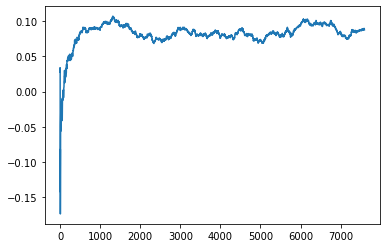

Thread: 4 iteration: 1280
RAM mProject_63 FROM: 128 --> 2944 reward: 0.80588163628125
Thread: 5 iteration: 1333
RAM mBackground_90 FROM: 576 --> 704 reward: -0.12873575895312506
Thread: 3 iteration: 1249
RAM mDiffFit_198 FROM: 576 --> 192 reward: 0.29658595117187503
Thread: 4 iteration: 1281
RAM mDiffFit_139 FROM: 1344 --> 192 reward: 0.587882809765625
Thread: 2 iteration: 1264
RAM mBackground_5 FROM: 896 --> 192 reward: 0.6479248754531248
Thread: 1 iteration: 1208
RAM mDiffFit_362 FROM: 2496 --> 192 reward: 0.15329672734375005
Thread: 5 iteration: 1334
RAM mDiffFit_209 FROM: 1536 --> 192 reward: 0.12278115156249998
Thread: 4 iteration: 1282
RAM mDiffFit_198 FROM: 128 --> 192 reward: -0.5231901542968749
Thread: 2 iteration: 1265
RAM mProject_58 FROM: 1088 --> 320 reward: -1.0
Thread: 6 iteration: 1262
RAM mBackground_55 FROM: 2624 --> 192 reward: 0.7018763297812499
Saving ...


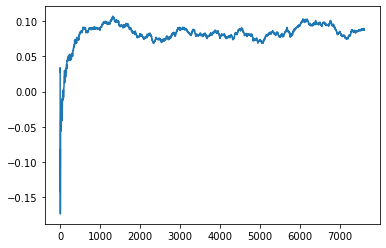

Thread: 3 iteration: 1250
RAM mDiffFit_339 FROM: 576 --> 192 reward: 0.13709371718750002
Thread: 1 iteration: 1209
RAM mDiffFit_166 FROM: 2432 --> 192 reward: 0.23665097421875003
Thread: 5 iteration: 1335
RAM mDiffFit_27 FROM: 1280 --> 192 reward: 0.17589061953125001
Thread: 6 iteration: 1263
RAM mDiffFit_327 FROM: 2240 --> 192 reward: 0.151867058984375
Thread: 2 iteration: 1266
RAM mDiffFit_153 FROM: 512 --> 384 reward: -0.12079694609374997
Thread: 3 iteration: 1251
RAM mDiffFit_163 FROM: 1664 --> 384 reward: 0.07280725703125002
Saving ...


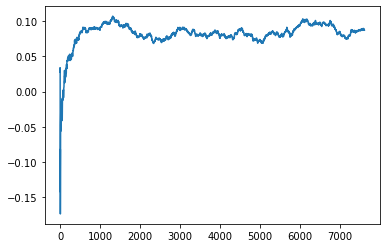

Thread: 1 iteration: 1210
RAM mDiffFit_1 FROM: 320 --> 384 reward: -0.09148179179687504
Thread: 5 iteration: 1336
RAM mDiffFit_105 FROM: 3008 --> 256 reward: 0.109835863671875
Thread: 6 iteration: 1264
RAM mDiffFit_412 FROM: 896 --> 384 reward: 0.059067699218750006
Thread: 3 iteration: 1252
RAM mBackground_53 FROM: 1472 --> 192 reward: 0.7404196639843749
Thread: 2 iteration: 1267
RAM mDiffFit_119 FROM: 2816 --> 320 reward: 0.04152066562500001
Thread: 1 iteration: 1211
RAM mBackground_19 FROM: 1088 --> 1792 reward: -0.03973689024218749
Thread: 5 iteration: 1337
RAM mDiffFit_278 FROM: 256 --> 320 reward: 0.005783871484375015
Thread: 3 iteration: 1253
RAM mProject_45 FROM: 1024 --> 320 reward: -1.0
Thread: 4 iteration: 1283
RAM mDiffFit_311 FROM: 2368 --> 320 reward: 0.37724741132812495
Thread: 2 iteration: 1268
RAM mConcatFit_1 FROM: 2048 --> 704 reward: 0.20154584062499997
Thread: 5 iteration: 1338
RAM mDiffFit_331 FROM: 320 --> 320 reward: 0.2943230078125
Thread: 1 iteration: 1212
RAM 

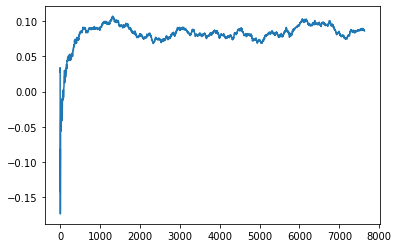

Thread: 5 iteration: 1340
RAM mDiffFit_43 FROM: 1664 --> 832 reward: 0.001976526953124981
Thread: 4 iteration: 1285
RAM mViewer_1 FROM: 1664 --> 640 reward: 0.16176874518749992
Thread: 1 iteration: 1214
RAM mDiffFit_103 FROM: 1600 --> 832 reward: 0.000799447265624996
Thread: 5 iteration: 1341
RAM mBackground_33 FROM: 1216 --> 192 reward: 0.768405547484375
Thread: 6 iteration: 1266
RAM mBackground_26 FROM: 2368 --> 192 reward: 0.7452750116718749
Saving ...


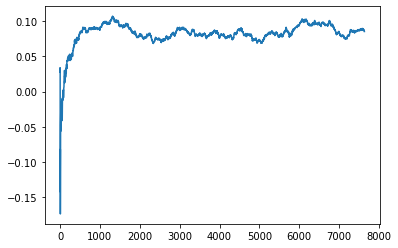

Thread: 2 iteration: 1270
RAM mDiffFit_123 FROM: 1536 --> 832 reward: 0.008635398437499995
Thread: 1 iteration: 1215
RAM mDiffFit_313 FROM: 1408 --> 384 reward: 0.1777916375
Thread: 4 iteration: 1286
RAM mDiffFit_56 FROM: 2304 --> 192 reward: 0.41213267851562496
Thread: 3 iteration: 1256
RAM mDiffFit_179 FROM: 832 --> 2752 reward: -0.014593629687500026
Thread: 2 iteration: 1271
RAM mDiffFit_133 FROM: 1088 --> 384 reward: 0.13877606171874998
Thread: 6 iteration: 1267
RAM mDiffFit_296 FROM: 192 --> 2752 reward: -0.33223170429687504
Thread: 4 iteration: 1287
RAM mBgModel_2 FROM: 2176 --> 1152 reward: 0.05559785906249998
Thread: 5 iteration: 1342
RAM mDiffFit_173 FROM: 1472 --> 384 reward: 0.03992440351562505
Thread: 1 iteration: 1216
RAM mDiffFit_197 FROM: 1600 --> 384 reward: 0.09377342929687502
Thread: 2 iteration: 1272
RAM mDiffFit_178 FROM: 192 --> 2752 reward: -0.17744261171875
Thread: 5 iteration: 1343
RAM mDiffFit_277 FROM: 2432 --> 1088 reward: -0.000536503906249982
Thread: 6 iter

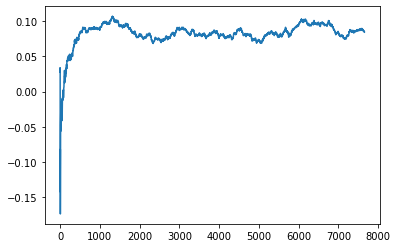

Thread: 6 iteration: 1270
RAM mDiffFit_287 FROM: 128 --> 320 reward: -0.766575596484375
Thread: 3 iteration: 1258
RAM mDiffFit_184 FROM: 2816 --> 192 reward: 0.2324061953125
Thread: 1 iteration: 1218
RAM mBackground_31 FROM: 2176 --> 320 reward: 0.37108094446874995
Thread: 5 iteration: 1345
RAM mDiffFit_30 FROM: 1536 --> 192 reward: 0.19656243437499998
Thread: 3 iteration: 1259
RAM mDiffFit_378 FROM: 1664 --> 192 reward: 0.15145309765625
Thread: 5 iteration: 1346
RAM mDiffFit_244 FROM: 1152 --> 192 reward: 0.27567966835937496
Thread: 1 iteration: 1219
RAM mBackground_40 FROM: 2496 --> 320 reward: 0.37642009859375
Thread: 2 iteration: 1275
RAM mBackground_84 FROM: 2496 --> 320 reward: 0.3658604592578125
Thread: 6 iteration: 1271
RAM mProject_32 FROM: 384 --> 896 reward: 0.9120428053593749
Thread: 4 iteration: 1289
RAM mDiffFit_373 FROM: 2048 --> 192 reward: 0.27994787656250003
Saving ...


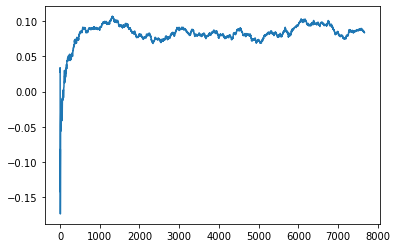

Thread: 3 iteration: 1260
RAM mDiffFit_371 FROM: 384 --> 192 reward: 0.03621871718749996
Thread: 5 iteration: 1347
RAM mDiffFit_30 FROM: 768 --> 192 reward: 0.12649991249999998
Saving ...


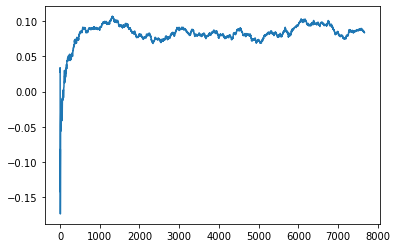

Thread: 1 iteration: 1220
RAM mDiffFit_257 FROM: 320 --> 192 reward: 0.03561455781249997
Thread: 2 iteration: 1276
RAM mDiffFit_19 FROM: 2944 --> 192 reward: 0.13162228007812501
Thread: 6 iteration: 1272
RAM mDiffFit_211 FROM: 832 --> 192 reward: 0.38867190234375004
Saving ...


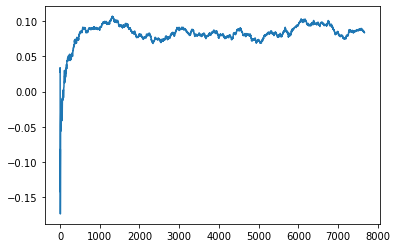

Thread: 4 iteration: 1290
RAM mDiffFit_229 FROM: 320 --> 384 reward: -0.3166980078125
Thread: 3 iteration: 1261
RAM mDiffFit_282 FROM: 1664 --> 192 reward: 0.18458327500000005
Thread: 5 iteration: 1348
RAM mBackground_69 FROM: 1792 --> 2304 reward: 0.11014286196874999
Thread: 4 iteration: 1291
RAM mDiffFit_247 FROM: 2816 --> 192 reward: 0.2250311953125
Thread: 1 iteration: 1221
RAM mDiffFit_377 FROM: 3008 --> 192 reward: 0.25391400507812506
Thread: 2 iteration: 1277
RAM mAdd_3 FROM: 1856 --> 2304 reward: 0.0016068355468748519
Thread: 6 iteration: 1273
RAM mDiffFit_328 FROM: 1536 --> 192 reward: 0.5015311953125
Thread: 3 iteration: 1262
RAM mDiffFit_199 FROM: 1856 --> 256 reward: 0.10571086367187502
Thread: 4 iteration: 1292
RAM mDiffFit_263 FROM: 832 --> 192 reward: 0.236065110546875
Thread: 3 iteration: 1263
RAM mDiffFit_59 FROM: 896 --> 256 reward: 0.4782604421875
Thread: 1 iteration: 1222
RAM mDiffFit_10 FROM: 1856 --> 192 reward: 0.5434478765624999
Thread: 6 iteration: 1274
RAM mDi

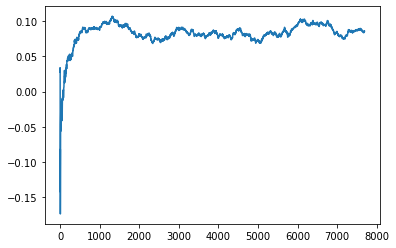

Thread: 5 iteration: 1350
RAM mProject_12 FROM: 2112 --> 1024 reward: 0.1662786331874999
Thread: 4 iteration: 1293
RAM mProject_38 FROM: 1920 --> 896 reward: 0.9397703237343751
Thread: 2 iteration: 1278
RAM mBackground_16 FROM: 1600 --> 192 reward: 0.7485515918515624
Thread: 1 iteration: 1225
RAM mDiffFit_66 FROM: 2624 --> 192 reward: 0.170346262109375
Thread: 4 iteration: 1294
RAM mDiffFit_383 FROM: 1984 --> 192 reward: 0.21794528789062503
Thread: 2 iteration: 1279
RAM mBackground_80 FROM: 2304 --> 192 reward: 0.6169692150937501
Thread: 5 iteration: 1351
RAM mDiffFit_258 FROM: 512 --> 192 reward: 0.08109630585937502
Thread: 1 iteration: 1226
RAM mDiffFit_385 FROM: 1024 --> 192 reward: 0.1945520796875
Thread: 4 iteration: 1295
RAM mDiffFit_78 FROM: 1984 --> 192 reward: 0.23069528789062502
Saving ...


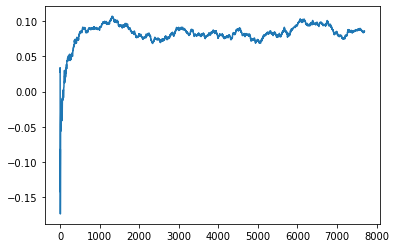

Thread: 2 iteration: 1280
RAM mDiffFit_305 FROM: 320 --> 192 reward: -0.019781282812500016
Thread: 5 iteration: 1352
RAM mDiffFit_351 FROM: 192 --> 192 reward: 0.15865628281250002
Thread: 1 iteration: 1227
RAM mProject_30 FROM: 960 --> 320 reward: -1.0
Thread: 3 iteration: 1265
RAM mProject_69 FROM: 704 --> 896 reward: 0.9135278053593748
Thread: 6 iteration: 1276
RAM mDiffFit_69 FROM: 2048 --> 192 reward: 0.19311973515625003
Thread: 4 iteration: 1296
RAM mDiffFit_271 FROM: 1024 --> 256 reward: 0.1765520796875
Thread: 2 iteration: 1281
RAM mDiffFit_201 FROM: 1536 --> 256 reward: 0.312979246875
Thread: 5 iteration: 1353
RAM mBackground_3 FROM: 576 --> 1792 reward: -0.13063483782812496
Thread: 6 iteration: 1277
RAM mDiffFit_90 FROM: 2944 --> 256 reward: 0.158229071875
Thread: 1 iteration: 1228
RAM mDiffFit_408 FROM: 704 --> 256 reward: 0.08505725703124997
Thread: 4 iteration: 1297
RAM mBackground_9 FROM: 512 --> 1792 reward: -0.30106271146874997
Thread: 3 iteration: 1266
RAM mDiffFit_60 F

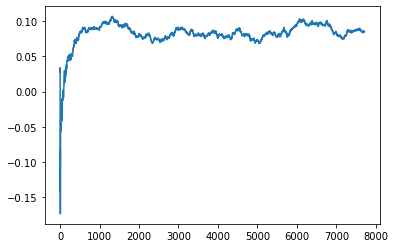

Thread: 1 iteration: 1230
RAM mDiffFit_205 FROM: 2432 --> 256 reward: 0.12014057578125
Thread: 6 iteration: 1279
RAM mBackground_24 FROM: 1856 --> 1408 reward: -0.018228022835937507
Thread: 4 iteration: 1298
RAM mBackground_3 FROM: 2624 --> 192 reward: 0.63166086921875
Thread: 2 iteration: 1283
RAM mDiffFit_88 FROM: 2304 --> 1984 reward: 0.07308599492187498
Thread: 1 iteration: 1231
RAM mDiffFit_224 FROM: 2560 --> 1984 reward: 0.06995318515624999
Thread: 4 iteration: 1299
RAM mProject_6 FROM: 2496 --> 2112 reward: -0.0652051338750001
Thread: 3 iteration: 1267
RAM mBackground_46 FROM: 1280 --> 1408 reward: -0.05091919174999999
Thread: 2 iteration: 1284
RAM mDiffFit_421 FROM: 2560 --> 1984 reward: 0.013572920312500004
Thread: 1 iteration: 1232
RAM mDiffFit_213 FROM: 1856 --> 1984 reward: -0.045052123437500056
Thread: 3 iteration: 1268
RAM mDiffFit_81 FROM: 2048 --> 832 reward: 0.030421858593749983
Thread: 2 iteration: 1285
RAM mDiffFit_27 FROM: 256 --> 832 reward: -0.290596393359375
Thre

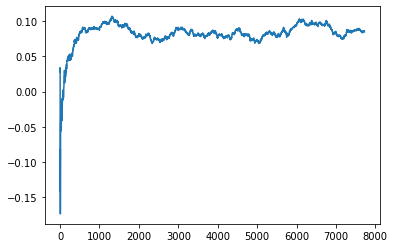

Thread: 4 iteration: 1300
RAM mProject_68 FROM: 448 --> 896 reward: 0.9085993655625001
Thread: 5 iteration: 1355
RAM mDiffFit_278 FROM: 1216 --> 192 reward: 0.18000780976562497
Thread: 2 iteration: 1286
RAM mDiffFit_97 FROM: 2304 --> 2560 reward: 0.030447964062500013
Thread: 1 iteration: 1234
RAM mDiffFit_412 FROM: 1856 --> 192 reward: 0.19233849609374998
Thread: 2 iteration: 1287
RAM mDiffFit_336 FROM: 512 --> 192 reward: 0.02707024414062502
Thread: 5 iteration: 1356
RAM mDiffFit_137 FROM: 2944 --> 192 reward: 0.2580311953125001
Thread: 1 iteration: 1235
RAM mBackground_58 FROM: 2752 --> 192 reward: 0.6922102724375
Thread: 4 iteration: 1301
RAM mDiffFit_348 FROM: 1536 --> 192 reward: 0.158257722265625
Thread: 2 iteration: 1288
RAM mDiffFit_268 FROM: 1728 --> 192 reward: 0.20523433671875002
Thread: 1 iteration: 1236
RAM mDiffFit_90 FROM: 1664 --> 192 reward: 0.23594524414062498
Thread: 1 iteration: 1237
RAM mDiffFit_170 FROM: 576 --> 192 reward: 0.09644528789062498
Thread: 1 iteration:

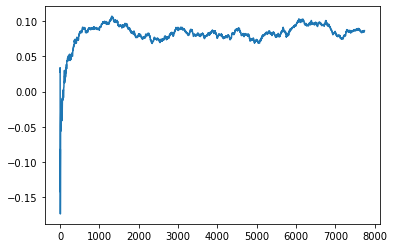

Thread: 3 iteration: 1270
RAM mDiffFit_5 FROM: 1664 --> 192 reward: 0.180458275
Thread: 1 iteration: 1239
RAM mDiffFit_34 FROM: 2624 --> 192 reward: 0.486382722265625
Thread: 3 iteration: 1271
RAM mDiffFit_386 FROM: 832 --> 192 reward: 0.14611977890625
Saving ...


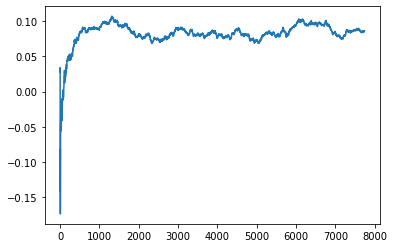

Thread: 1 iteration: 1240
RAM mProject_44 FROM: 1152 --> 1024 reward: 0.054670308890624915
Thread: 5 iteration: 1357
RAM mProject_17 FROM: 2944 --> 1024 reward: 0.015742087875000088
Thread: 4 iteration: 1302
RAM mProject_20 FROM: 3008 --> 1024 reward: 0.0041493993046874175
Thread: 2 iteration: 1289
RAM mDiffFit_11 FROM: 1600 --> 192 reward: 0.19017185859375002
Thread: 3 iteration: 1272
RAM mDiffFit_324 FROM: 960 --> 192 reward: 0.12384371718750001
Thread: 4 iteration: 1303
RAM mDiffFit_17 FROM: 2688 --> 2560 reward: 0.031119822656250004
Thread: 4 iteration: 1304
RAM mBackground_61 FROM: 1408 --> 1792 reward: -0.03591843279687504
Thread: 3 iteration: 1273
RAM mBackground_21 FROM: 2816 --> 192 reward: 0.721866802015625
Thread: 1 iteration: 1241
RAM mBackground_38 FROM: 1920 --> 192 reward: 0.5959798118749999
Saving ...


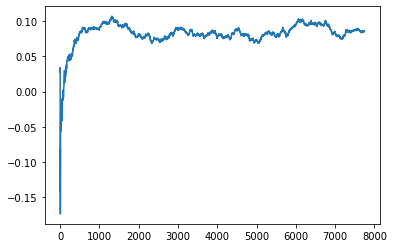

Thread: 2 iteration: 1290
RAM mDiffFit_384 FROM: 960 --> 2560 reward: -0.003598894531249997
Thread: 1 iteration: 1242
RAM mDiffFit_152 FROM: 832 --> 2560 reward: -0.023109336718749995
Thread: 3 iteration: 1274
RAM mDiffFit_398 FROM: 896 --> 192 reward: 0.14816141640625
Thread: 1 iteration: 1243
RAM mDiffFit_186 FROM: 1920 --> 192 reward: 0.24299214648437506
Thread: 3 iteration: 1275
RAM mProject_22 FROM: 576 --> 896 reward: 0.9195371849531251
Thread: 5 iteration: 1358
RAM mAdd_2 FROM: 1920 --> 320 reward: -1.0
Saving ...


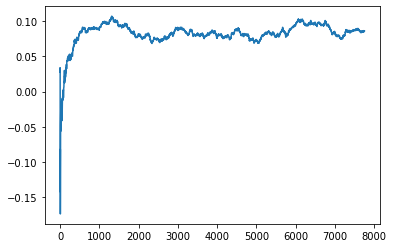

Thread: 6 iteration: 1280
RAM mDiffFit_161 FROM: 1600 --> 192 reward: 0.20466404882812497
Thread: 1 iteration: 1244
RAM mDiffFit_327 FROM: 1152 --> 192 reward: 0.191570287890625
Thread: 3 iteration: 1276
RAM mConcatFit_2 FROM: 3008 --> 1024 reward: 0.007314461562499985
Thread: 5 iteration: 1359
RAM mDiffFit_294 FROM: 512 --> 256 reward: -0.02041672500000001
Thread: 1 iteration: 1245
RAM mDiffFit_112 FROM: 2240 --> 256 reward: 0.26522134960937505
Thread: 6 iteration: 1281
RAM mDiffFit_403 FROM: 2624 --> 192 reward: 0.18233845234374996
Thread: 3 iteration: 1277
RAM mProject_31 FROM: 960 --> 1024 reward: -0.03282515444531265
Thread: 2 iteration: 1291
RAM mDiffFit_375 FROM: 2752 --> 256 reward: 0.35959108476562507
Saving ...


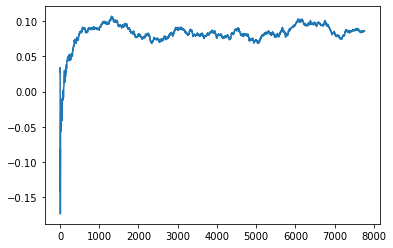

Thread: 5 iteration: 1360
RAM mDiffFit_369 FROM: 896 --> 256 reward: 0.12169269921875002
Thread: 6 iteration: 1282
RAM mDiffFit_160 FROM: 2880 --> 320 reward: 0.251414048828125
Thread: 1 iteration: 1246
RAM mBackground_56 FROM: 704 --> 1792 reward: -0.08776026076562499
Thread: 2 iteration: 1292
RAM mProject_35 FROM: 2752 --> 1024 reward: 0.05931106713281267
Thread: 4 iteration: 1305
RAM mDiffFit_170 FROM: 2880 --> 256 reward: 0.06636447031249998
Thread: 5 iteration: 1361
RAM mDiffFit_97 FROM: 2560 --> 256 reward: 0.14189575312499997
Thread: 6 iteration: 1283
RAM mDiffFit_379 FROM: 320 --> 256 reward: 0.06318230078125
Thread: 1 iteration: 1247
RAM mDiffFit_133 FROM: 512 --> 256 reward: 0.08822915937500002
Thread: 2 iteration: 1293
RAM mBackground_83 FROM: 2560 --> 192 reward: 0.687323493765625
Thread: 4 iteration: 1306
RAM mDiffFit_418 FROM: 2240 --> 1984 reward: -0.00991668125000001
Thread: 1 iteration: 1248
RAM mDiffFit_383 FROM: 2432 --> 256 reward: 0.11169265546875
Thread: 6 iterati

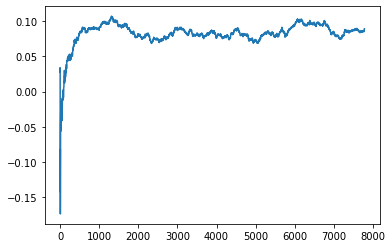

Thread: 1 iteration: 1250
RAM mBackground_61 FROM: 192 --> 704 reward: -0.9390685326953124
Thread: 4 iteration: 1308
RAM mProject_77 FROM: 1344 --> 1024 reward: 0.12155390050781247
Thread: 5 iteration: 1362
RAM mBackground_77 FROM: 1024 --> 2304 reward: -0.04994263621874999
Thread: 1 iteration: 1251
RAM mDiffFit_288 FROM: 832 --> 192 reward: 0.20959112851562495
Thread: 5 iteration: 1363
RAM mDiffFit_395 FROM: 704 --> 192 reward: 0.30604168125
Thread: 1 iteration: 1252
RAM mDiffFit_306 FROM: 2496 --> 192 reward: 0.22524995625
Thread: 5 iteration: 1364
RAM mBackground_33 FROM: 2368 --> 192 reward: 0.7028371133828124
Thread: 4 iteration: 1309
RAM mDiffFit_207 FROM: 512 --> 192 reward: 0.15705207968749998
Thread: 1 iteration: 1253
RAM mProject_38 FROM: 1024 --> 1024 reward: 0.0025500026250001363
Thread: 2 iteration: 1295
RAM mProject_58 FROM: 1792 --> 1024 reward: 0.23145937171875003
Thread: 6 iteration: 1286
RAM mBackground_23 FROM: 1408 --> 2304 reward: 0.006002152312499914
Saving ...


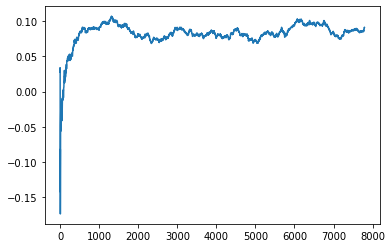

Thread: 4 iteration: 1310
RAM mDiffFit_89 FROM: 256 --> 192 reward: 0.09044792031249999
Thread: 5 iteration: 1365
RAM mProject_70 FROM: 2432 --> 1024 reward: 0.11378977425000006
Saving ...


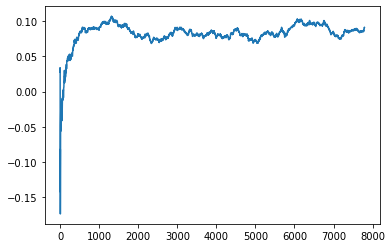

Thread: 3 iteration: 1280
RAM mViewer_3 FROM: 1088 --> 640 reward: 0.11154515444531252
Thread: 1 iteration: 1254
RAM mDiffFit_35 FROM: 1728 --> 256 reward: 0.13719787656250002
Thread: 6 iteration: 1287
RAM mBackground_31 FROM: 1408 --> 1408 reward: 0.01195491307812502
Thread: 5 iteration: 1366
RAM mDiffFit_122 FROM: 1152 --> 384 reward: 0.08329685859374998
Thread: 1 iteration: 1255
RAM mBackground_40 FROM: 1472 --> 1792 reward: -0.039241990140624926
Thread: 4 iteration: 1311
RAM mDiffFit_142 FROM: 704 --> 384 reward: 0.069330730078125
Thread: 6 iteration: 1288
RAM mDiffFit_311 FROM: 1664 --> 2560 reward: 0.02314066328125
Thread: 5 iteration: 1367
RAM mBackground_23 FROM: 448 --> 1792 reward: -0.23298604436718748
Thread: 1 iteration: 1256
RAM mDiffFit_276 FROM: 256 --> 384 reward: -0.07778646015624999
Thread: 6 iteration: 1289
RAM mDiffFit_407 FROM: 768 --> 256 reward: 0.13026039843749998
Saving ...


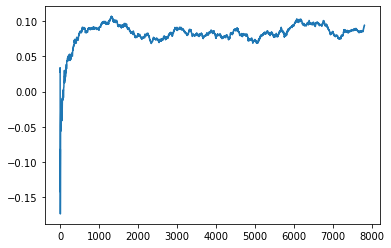

Thread: 6 iteration: 1290
RAM mProject_4 FROM: 1664 --> 1024 reward: 0.1975893690937499
Thread: 2 iteration: 1296
RAM mProject_29 FROM: 1728 --> 1024 reward: 0.2109848376796875
Thread: 3 iteration: 1281
RAM mBackground_19 FROM: 3008 --> 320 reward: 0.3806371250546876
Thread: 6 iteration: 1291
RAM mDiffFit_338 FROM: 576 --> 384 reward: 0.05224219023437503
Thread: 2 iteration: 1297
RAM mDiffFit_190 FROM: 1216 --> 256 reward: 0.159604159375
Thread: 3 iteration: 1282
RAM mProject_42 FROM: 1856 --> 1024 reward: 0.223785916171875
Thread: 4 iteration: 1312
RAM mDiffFit_95 FROM: 960 --> 256 reward: 0.09394006679687503
Thread: 6 iteration: 1292
RAM mProject_53 FROM: 960 --> 1024 reward: -0.040935002624999904
Thread: 1 iteration: 1257
RAM mDiffFit_331 FROM: 1856 --> 256 reward: 0.12135670429687496
Thread: 2 iteration: 1298
RAM mDiffFit_203 FROM: 768 --> 192 reward: 0.11893747812500001
Thread: 4 iteration: 1313
RAM mDiffFit_139 FROM: 960 --> 256 reward: 0.41162500000000013
Thread: 3 iteration: 12

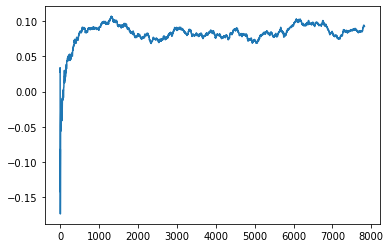

Thread: 2 iteration: 1300
RAM mDiffFit_202 FROM: 640 --> 256 reward: 0.1569687609375
Saving ...


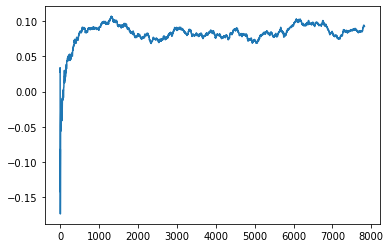

Thread: 1 iteration: 1260
RAM mDiffFit_227 FROM: 2816 --> 2560 reward: 0.02476044218750001
Thread: 6 iteration: 1295
RAM mDiffFit_392 FROM: 2240 --> 256 reward: 0.15326035468749996
Thread: 4 iteration: 1316
RAM mBackground_62 FROM: 320 --> 1792 reward: -0.416992462375
Thread: 1 iteration: 1261
RAM mDiffFit_274 FROM: 1984 --> 256 reward: 0.14310411562499997
Thread: 2 iteration: 1301
RAM mDiffFit_71 FROM: 768 --> 256 reward: 0.1684479203125
Thread: 1 iteration: 1262
RAM mDiffFit_306 FROM: 1280 --> 192 reward: 0.16938794335937504
Thread: 4 iteration: 1317
RAM mDiffFit_76 FROM: 2176 --> 192 reward: 0.20647652695312496
Thread: 2 iteration: 1302
RAM mProject_47 FROM: 2688 --> 2240 reward: -0.06861764700000016
Thread: 3 iteration: 1286
RAM mDiffFit_33 FROM: 2624 --> 256 reward: 0.05000504609374994
Thread: 4 iteration: 1318
RAM mDiffFit_411 FROM: 512 --> 192 reward: 0.3493906195312499
Thread: 3 iteration: 1287
RAM mDiffFit_257 FROM: 2560 --> 256 reward: 0.07115615156249999
Thread: 4 iteration:

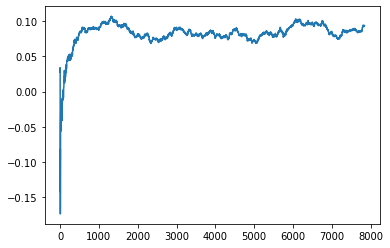

Thread: 4 iteration: 1320
RAM mProject_25 FROM: 2368 --> 2240 reward: -0.02285910745312497
Thread: 2 iteration: 1303
RAM mAdd_1 FROM: 1920 --> 320 reward: -1.0
Thread: 5 iteration: 1368
RAM mBackground_38 FROM: 2048 --> 192 reward: 0.7176206460781249
Thread: 3 iteration: 1288
RAM mProject_40 FROM: 3008 --> 256 reward: -1.0
Thread: 6 iteration: 1296
RAM mDiffFit_121 FROM: 1664 --> 192 reward: 0.17769787656249994
Thread: 1 iteration: 1264
RAM mDiffFit_31 FROM: 2624 --> 2560 reward: -0.0033671902343750115
Thread: 5 iteration: 1369
RAM mDiffFit_160 FROM: 2240 --> 192 reward: 0.204200508984375
Thread: 3 iteration: 1289
RAM mDiffFit_222 FROM: 2112 --> 192 reward: 0.149945244140625
Thread: 6 iteration: 1297
RAM mDiffFit_219 FROM: 2432 --> 192 reward: 0.162481660546875
Thread: 2 iteration: 1304
RAM mDiffFit_84 FROM: 2112 --> 2560 reward: 0.013320331640624995
Thread: 1 iteration: 1265
RAM mDiffFit_189 FROM: 1344 --> 192 reward: 0.136960907421875
Saving ...


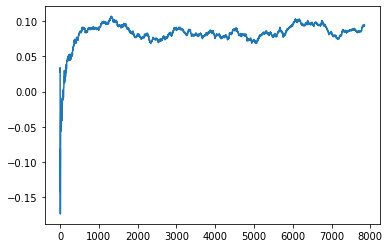

Thread: 5 iteration: 1370
RAM mProject_90 FROM: 2368 --> 2240 reward: -0.03311443209375009
Thread: 4 iteration: 1321
RAM mDiffFit_67 FROM: 3008 --> 192 reward: 0.1222394265625
Saving ...


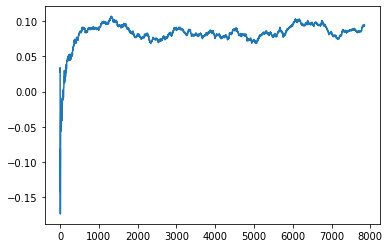

Thread: 3 iteration: 1290
RAM mDiffFit_415 FROM: 256 --> 192 reward: -0.2533542468750001
Thread: 1 iteration: 1266
RAM mDiffFit_223 FROM: 704 --> 192 reward: 0.28534112851562493
Thread: 4 iteration: 1322
RAM mProject_22 FROM: 1984 --> 2240 reward: 0.03580414157812497
Thread: 6 iteration: 1298
RAM mDiffFit_289 FROM: 2560 --> 192 reward: 0.5881797121093749
Thread: 3 iteration: 1291
RAM mDiffFit_407 FROM: 2048 --> 192 reward: 0.3366666375
Thread: 1 iteration: 1267
RAM mBackground_50 FROM: 1024 --> 192 reward: 0.6313541787734375
Thread: 2 iteration: 1305
RAM mBackground_76 FROM: 3008 --> 192 reward: 0.7600763168046876
Thread: 5 iteration: 1371
RAM mDiffFit_401 FROM: 576 --> 192 reward: 0.20589061953124993
Thread: 6 iteration: 1299
RAM mDiffFit_268 FROM: 2944 --> 192 reward: 0.16984885078125
Thread: 1 iteration: 1268
RAM mDiffFit_166 FROM: 128 --> 192 reward: -0.3974062828125
Thread: 2 iteration: 1306
RAM mAdd_1 FROM: 576 --> 1792 reward: -0.33131239062500006
Thread: 3 iteration: 1292
RAM m

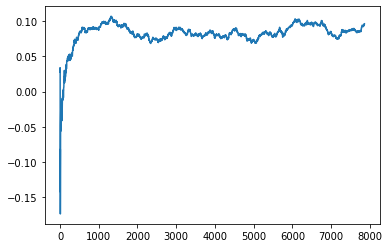

Thread: 6 iteration: 1300
RAM mBackground_20 FROM: 896 --> 192 reward: 0.6801323131796874
Thread: 4 iteration: 1323
RAM mDiffFit_173 FROM: 2624 --> 1984 reward: 0.005830730078124988
Thread: 1 iteration: 1269
RAM mDiffFit_401 FROM: 192 --> 2624 reward: -0.22506502304687495
Thread: 6 iteration: 1301
RAM mDiffFit_303 FROM: 832 --> 384 reward: -0.06389070703124998
Thread: 3 iteration: 1293
RAM mDiffFit_348 FROM: 1664 --> 384 reward: 0.2774688046875
Thread: 4 iteration: 1324
RAM mDiffFit_414 FROM: 2560 --> 256 reward: 0.12540619531250002
Saving ...


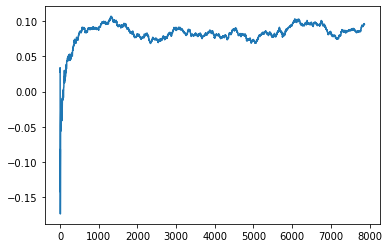

Thread: 1 iteration: 1270
RAM mBackground_74 FROM: 1920 --> 1792 reward: -0.011202413078124984
Thread: 6 iteration: 1302
RAM mBackground_72 FROM: 2368 --> 192 reward: 0.7332372003046873
Thread: 2 iteration: 1307
RAM mProject_12 FROM: 1792 --> 1024 reward: 0.22100249474999994
Thread: 5 iteration: 1372
RAM mBackground_52 FROM: 2432 --> 1792 reward: -0.04525312273437501
Thread: 3 iteration: 1294
RAM mDiffFit_53 FROM: 704 --> 384 reward: 0.128393251953125
Thread: 4 iteration: 1325
RAM mDiffFit_209 FROM: 1408 --> 256 reward: 0.09413013359374997
Thread: 1 iteration: 1271
RAM mDiffFit_209 FROM: 2496 --> 256 reward: 0.10082546523437502
Thread: 6 iteration: 1303
RAM mDiffFit_42 FROM: 1408 --> 256 reward: 0.09934371718750001
Thread: 2 iteration: 1308
RAM mDiffFit_29 FROM: 2944 --> 256 reward: 0.09061964765625
Thread: 3 iteration: 1295
RAM mViewer_2 FROM: 2752 --> 1408 reward: -0.026109642539062502
Thread: 2 iteration: 1309
RAM mDiffFit_185 FROM: 128 --> 320 reward: -0.2665728765625
Thread: 3 ite

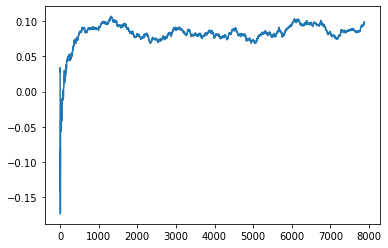

Thread: 2 iteration: 1310
RAM mDiffFit_341 FROM: 2048 --> 320 reward: 0.13712495624999999
Thread: 3 iteration: 1297
RAM mBackground_89 FROM: 2624 --> 192 reward: 0.7455011805859373
Thread: 6 iteration: 1304
RAM mProject_21 FROM: 1664 --> 2112 reward: 0.041496214992187516
Thread: 4 iteration: 1326
RAM mDiffFit_411 FROM: 128 --> 320 reward: -0.720768251953125
Thread: 2 iteration: 1311
RAM mProject_30 FROM: 2688 --> 2112 reward: -0.08934487748437493
Thread: 1 iteration: 1272
RAM mDiffFit_305 FROM: 2048 --> 2304 reward: 0.0569063265625
Thread: 3 iteration: 1298
RAM mProject_83 FROM: 1152 --> 1024 reward: 0.062013751312500094
Thread: 5 iteration: 1373
RAM mBackground_73 FROM: 256 --> 704 reward: -0.47188021146875
Thread: 6 iteration: 1305
RAM mDiffFit_303 FROM: 1600 --> 320 reward: 0.128606748046875
Thread: 4 iteration: 1327
RAM mDiffFit_379 FROM: 1920 --> 256 reward: 0.13845309765625002
Thread: 5 iteration: 1374
RAM mDiffFit_354 FROM: 768 --> 320 reward: -0.03665632656250001
Thread: 6 iter

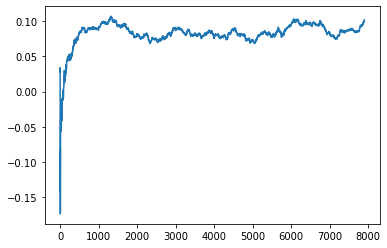

Thread: 6 iteration: 1310
RAM mDiffFit_259 FROM: 1088 --> 832 reward: -0.03343493320312502
Thread: 5 iteration: 1379
RAM mDiffFit_207 FROM: 320 --> 832 reward: -0.09487500000000001
Thread: 2 iteration: 1316
RAM mProject_34 FROM: 2048 --> 1024 reward: 0.17421739762499996
Thread: 3 iteration: 1299
RAM mProject_3 FROM: 2304 --> 1024 reward: 0.14413857806249988
Thread: 4 iteration: 1329
RAM mBackground_73 FROM: 448 --> 320 reward: 0.15625349507031253
Thread: 6 iteration: 1311
RAM mDiffFit_135 FROM: 1600 --> 320 reward: 0.10192444726562498
Saving ...


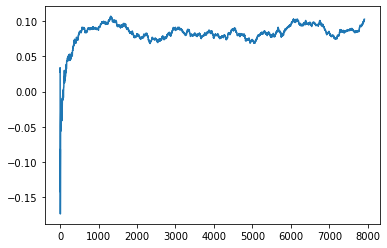

Thread: 5 iteration: 1380
RAM mDiffFit_36 FROM: 2496 --> 832 reward: 0.006052035937500009
Thread: 2 iteration: 1317
RAM mDiffFit_52 FROM: 1792 --> 320 reward: 0.16447393828124995
Thread: 6 iteration: 1312
RAM mBackground_43 FROM: 2048 --> 192 reward: -0.03348872082031247
Saving ...


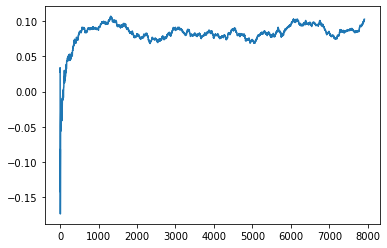

Thread: 3 iteration: 1300
RAM mDiffFit_236 FROM: 640 --> 832 reward: 0.09894278671875
Saving ...


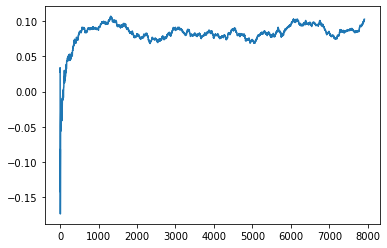

Thread: 4 iteration: 1330
RAM mProject_81 FROM: 1600 --> 384 reward: -1.0
Thread: 1 iteration: 1275
RAM mDiffFit_42 FROM: 2048 --> 256 reward: 0.1437916375
Thread: 2 iteration: 1318
RAM mDiffFit_357 FROM: 768 --> 256 reward: 0.011270753124999998
Thread: 6 iteration: 1313
RAM mDiffFit_249 FROM: 1728 --> 256 reward: 0.14164579687499998
Thread: 1 iteration: 1276
RAM mDiffFit_31 FROM: 576 --> 256 reward: 0.148924491015625
Thread: 3 iteration: 1301
RAM mDiffFit_7 FROM: 256 --> 256 reward: 0.2944063265625
Thread: 5 iteration: 1381
RAM mBackground_9 FROM: 896 --> 1792 reward: -0.08845902957812497
Thread: 4 iteration: 1331
RAM mDiffFit_17 FROM: 1152 --> 192 reward: 0.31721095117187503
Thread: 2 iteration: 1319
RAM mDiffFit_215 FROM: 832 --> 192 reward: 0.31103646015624997
Thread: 5 iteration: 1382
RAM mDiffFit_33 FROM: 320 --> 192 reward: 0.27625263242187503
Thread: 4 iteration: 1332
RAM mDiffFit_270 FROM: 2688 --> 192 reward: 0.5401795371093749
Thread: 1 iteration: 1277
RAM mDiffFit_397 FROM:

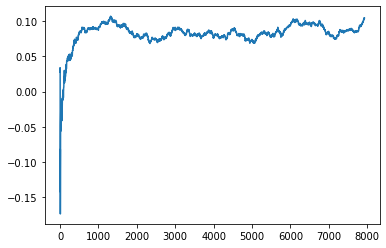

Thread: 2 iteration: 1320
RAM mDiffFit_81 FROM: 448 --> 192 reward: 0.07882028789062502
Thread: 1 iteration: 1278
RAM mDiffFit_114 FROM: 2944 --> 192 reward: 0.19232024414062499
Thread: 5 iteration: 1383
RAM mProject_47 FROM: 512 --> 2944 reward: 0.8302904164687501
Thread: 3 iteration: 1302
RAM mDiffFit_356 FROM: 832 --> 192 reward: 0.30209376093750007
Thread: 2 iteration: 1321
RAM mProject_87 FROM: 1152 --> 1024 reward: 0.06279562828125003
Thread: 6 iteration: 1314
RAM mDiffFit_287 FROM: 2880 --> 192 reward: 0.155335863671875
Thread: 5 iteration: 1384
RAM mDiffFit_23 FROM: 2368 --> 448 reward: 0.09862491250000001
Thread: 2 iteration: 1322
RAM mDiffFit_44 FROM: 1984 --> 192 reward: 0.23706247812499998
Thread: 6 iteration: 1315
RAM mDiffFit_151 FROM: 1856 --> 448 reward: 0.12458590742187503
Thread: 5 iteration: 1385
RAM mDiffFit_322 FROM: 2816 --> 192 reward: 0.2342811953125
Thread: 2 iteration: 1323
RAM mBackground_36 FROM: 1408 --> 192 reward: 0.7565827361171874
Thread: 3 iteration: 1

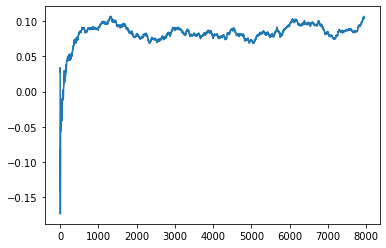

Thread: 1 iteration: 1280
RAM mBackground_11 FROM: 1472 --> 1792 reward: 0.23724378309375005
Thread: 6 iteration: 1319
RAM mDiffFit_133 FROM: 1344 --> 320 reward: 0.20979168125000003
Thread: 5 iteration: 1388
RAM mDiffFit_235 FROM: 2688 --> 320 reward: 0.12338276601562502
Saving ...


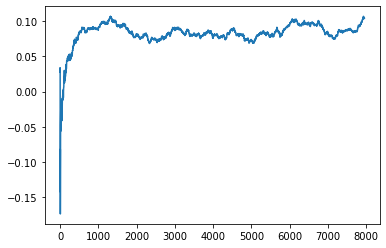

Thread: 6 iteration: 1320
RAM mDiffFit_118 FROM: 640 --> 192 reward: 0.21134634960937504
Thread: 5 iteration: 1389
RAM mBackground_43 FROM: 960 --> 192 reward: 0.6628584327968751
Thread: 3 iteration: 1307
RAM mBackground_17 FROM: 1088 --> 192 reward: 0.7846268409453124
Thread: 1 iteration: 1281
RAM mDiffFit_300 FROM: 256 --> 192 reward: 0.09015365039062498
Thread: 6 iteration: 1321
RAM mDiffFit_167 FROM: 2048 --> 192 reward: 0.17860152695312498
Thread: 3 iteration: 1308
RAM mDiffFit_407 FROM: 2176 --> 192 reward: 0.30653641640625
Saving ...


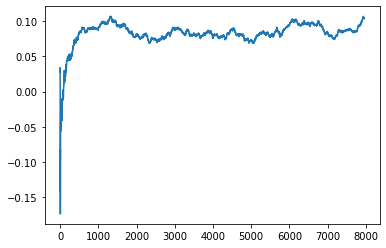

Thread: 5 iteration: 1390
RAM mDiffFit_29 FROM: 2368 --> 448 reward: -0.022645971875000018
Thread: 1 iteration: 1282
RAM mBackground_43 FROM: 128 --> 1920 reward: 0.2834643682031251
Thread: 6 iteration: 1322
RAM mDiffFit_329 FROM: 1088 --> 192 reward: 0.23357550898437499
Thread: 3 iteration: 1309
RAM mProject_72 FROM: 960 --> 256 reward: -1.0
Thread: 4 iteration: 1336
RAM mDiffFit_281 FROM: 2560 --> 192 reward: 0.21039575312499997
Thread: 1 iteration: 1283
RAM mProject_52 FROM: 2560 --> 256 reward: -1.0
Thread: 2 iteration: 1326
RAM mBackground_76 FROM: 1408 --> 192 reward: 0.6803472755546875
Thread: 5 iteration: 1391
RAM mDiffFit_307 FROM: 3008 --> 448 reward: 0.03207805390625002
Thread: 6 iteration: 1323
RAM mDiffFit_206 FROM: 832 --> 192 reward: 0.22320050898437502
Saving ...


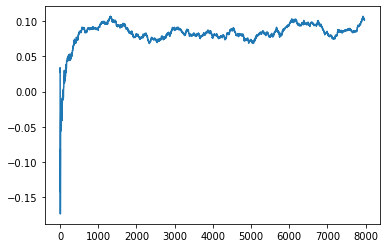

Thread: 3 iteration: 1310
RAM mDiffFit_294 FROM: 2304 --> 192 reward: 0.198992146484375
Thread: 4 iteration: 1337
RAM mDiffFit_325 FROM: 1152 --> 192 reward: 0.16592185859374997
Thread: 2 iteration: 1327
RAM mDiffFit_309 FROM: 2560 --> 192 reward: 0.19677856289062495
Thread: 5 iteration: 1392
RAM mDiffFit_46 FROM: 512 --> 192 reward: -0.025463627343749982
Thread: 4 iteration: 1338
RAM mDiffFit_28 FROM: 2240 --> 192 reward: 0.14901557578125
Thread: 5 iteration: 1393
RAM mDiffFit_422 FROM: 1536 --> 192 reward: 0.252179668359375
Thread: 2 iteration: 1328
RAM mDiffFit_237 FROM: 1152 --> 192 reward: 0.14484371718750003
Thread: 5 iteration: 1394
RAM mProject_71 FROM: 2560 --> 1024 reward: 0.0917247296250001
Thread: 1 iteration: 1284
RAM mDiffFit_297 FROM: 448 --> 192 reward: 0.008434845703124971
Thread: 5 iteration: 1395
RAM mDiffFit_214 FROM: 512 --> 192 reward: -0.0016250874999999831
Thread: 2 iteration: 1329
RAM mProject_78 FROM: 1792 --> 1024 reward: 0.2290725
Thread: 6 iteration: 1324
R

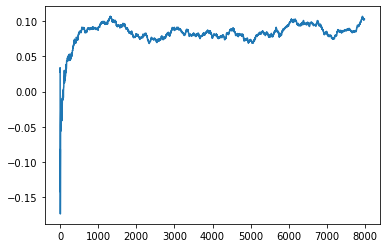

Thread: 2 iteration: 1330
RAM mProject_86 FROM: 2752 --> 1024 reward: 0.06702107238281275
Thread: 3 iteration: 1311
RAM mDiffFit_61 FROM: 1280 --> 448 reward: 0.004333275000000022
Thread: 6 iteration: 1325
RAM mDiffFit_78 FROM: 1984 --> 2112 reward: 0.02930993320312502
Thread: 5 iteration: 1397
RAM mDiffFit_284 FROM: 768 --> 2752 reward: -0.017739514062500017
Thread: 2 iteration: 1331
RAM mProject_4 FROM: 1728 --> 1024 reward: 0.24856924352343754
Thread: 4 iteration: 1339
RAM mDiffFit_74 FROM: 576 --> 256 reward: 0.19567190234375
Thread: 1 iteration: 1286
RAM mDiffFit_58 FROM: 192 --> 256 reward: -0.019442699218749984
Thread: 3 iteration: 1312
RAM mDiffFit_394 FROM: 2880 --> 832 reward: 0.06204685859375002
Thread: 6 iteration: 1326
RAM mDiffFit_220 FROM: 2688 --> 256 reward: 0.13749473515625002
Thread: 3 iteration: 1313
RAM mDiffFit_271 FROM: 256 --> 256 reward: 0.0140729203125
Thread: 6 iteration: 1327
RAM mDiffFit_153 FROM: 2176 --> 256 reward: 0.05087486874999998
Thread: 1 iteration

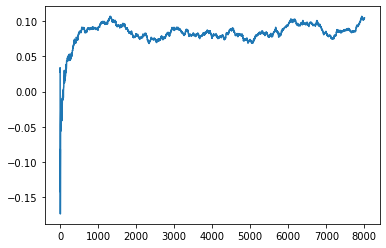

Thread: 5 iteration: 1400
RAM mBackground_23 FROM: 2368 --> 192 reward: 0.6499739789765625
Thread: 1 iteration: 1288
RAM mProject_71 FROM: 1920 --> 1024 reward: 0.20159807315625003
Saving ...


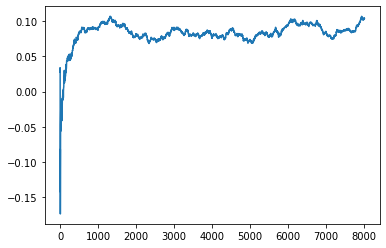

Thread: 4 iteration: 1340
RAM mDiffFit_137 FROM: 576 --> 1984 reward: -0.05135411562499999
Thread: 3 iteration: 1316
RAM mDiffFit_14 FROM: 1408 --> 832 reward: 0.025091128515625002
Thread: 5 iteration: 1401
RAM mDiffFit_66 FROM: 1280 --> 256 reward: 0.13895831875
Thread: 1 iteration: 1289
RAM mBackground_46 FROM: 896 --> 192 reward: -1.0
Thread: 2 iteration: 1332
RAM mDiffFit_415 FROM: 2880 --> 832 reward: 0.0043983855468749875
Thread: 5 iteration: 1402
RAM mDiffFit_408 FROM: 2304 --> 256 reward: 0.02262482500000003
Thread: 3 iteration: 1317
RAM mProject_48 FROM: 2752 --> 1024 reward: 0.059851067132812616
Thread: 6 iteration: 1329
RAM mDiffFit_240 FROM: 1856 --> 256 reward: 0.11464053203124999
Thread: 5 iteration: 1403
RAM mDiffFit_43 FROM: 128 --> 256 reward: -0.5207135835937502
Saving ...


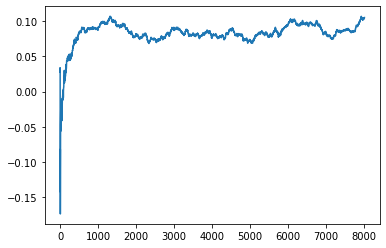

Thread: 6 iteration: 1330
RAM mDiffFit_137 FROM: 1600 --> 320 reward: 0.262729203125
Thread: 5 iteration: 1404
RAM mDiffFit_300 FROM: 2368 --> 192 reward: 0.22698433671874996
Thread: 6 iteration: 1331
RAM mDiffFit_255 FROM: 2688 --> 320 reward: 0.14420305390625002
Thread: 6 iteration: 1332
RAM mBackground_41 FROM: 1984 --> 192 reward: 0.6798187182109376
Thread: 5 iteration: 1405
RAM mProject_87 FROM: 1600 --> 1024 reward: 0.18285702616406252
Thread: 4 iteration: 1341
RAM mProject_67 FROM: 1408 --> 1024 reward: 0.1406615575781249
Thread: 2 iteration: 1333
RAM mDiffFit_45 FROM: 2304 --> 832 reward: 0.009471305859375008
Thread: 5 iteration: 1406
RAM mProject_78 FROM: 832 --> 768 reward: -1.0
Saving ...


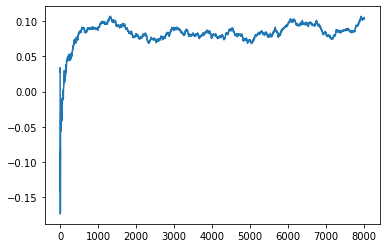

Thread: 1 iteration: 1290
RAM mDiffFit_45 FROM: 1920 --> 192 reward: 0.216820287890625
Thread: 4 iteration: 1342
RAM mDiffFit_110 FROM: 1984 --> 192 reward: 0.262028606640625
Thread: 2 iteration: 1334
RAM mProject_23 FROM: 1536 --> 256 reward: -1.0
Thread: 3 iteration: 1318
RAM mProject_72 FROM: 128 --> 2944 reward: 0.818378526375
Thread: 6 iteration: 1333
RAM mDiffFit_157 FROM: 896 --> 320 reward: 0.09864320820312497
Thread: 5 iteration: 1407
RAM mDiffFit_390 FROM: 1536 --> 320 reward: 0.032934801953125
Thread: 1 iteration: 1291
RAM mDiffFit_394 FROM: 1600 --> 1984 reward: 0.029330773828124997
Thread: 5 iteration: 1408
RAM mBackground_10 FROM: 2240 --> 2304 reward: 0.00796620653906247
Thread: 3 iteration: 1319
RAM mDiffFit_276 FROM: 2880 --> 320 reward: 0.09352334179687498
Thread: 6 iteration: 1334
RAM mDiffFit_323 FROM: 1152 --> 320 reward: 0.232354115625
Thread: 2 iteration: 1335
RAM mDiffFit_37 FROM: 768 --> 192 reward: 0.099710907421875
Thread: 1 iteration: 1292
RAM mProject_17 FR

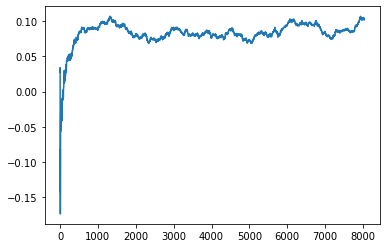

Thread: 3 iteration: 1320
RAM mBackground_81 FROM: 2368 --> 2304 reward: -0.35868984174218754
Thread: 1 iteration: 1294
RAM mDiffFit_107 FROM: 2304 --> 192 reward: 0.15839057578125004
Thread: 6 iteration: 1336
RAM mDiffFit_29 FROM: 2496 --> 192 reward: 0.17403119531250005
Saving ...


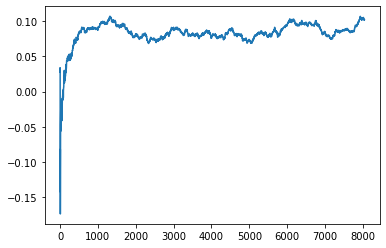

Thread: 5 iteration: 1410
RAM mDiffFit_148 FROM: 2752 --> 192 reward: 0.21804418242187507
Thread: 3 iteration: 1321
RAM mDiffFit_250 FROM: 1856 --> 192 reward: 0.31165101796875005
Thread: 4 iteration: 1345
RAM mDiffFit_218 FROM: 2944 --> 1984 reward: -0.08843502070312502
Thread: 6 iteration: 1337
RAM mDiffFit_124 FROM: 2368 --> 192 reward: 0.19325513359374996
Thread: 1 iteration: 1295
RAM mDiffFit_136 FROM: 576 --> 192 reward: 0.14242185859374998
Thread: 3 iteration: 1322
RAM mDiffFit_363 FROM: 320 --> 192 reward: 0.11945573007812502
Thread: 4 iteration: 1346
RAM mDiffFit_123 FROM: 2048 --> 192 reward: 0.11329159375
Thread: 1 iteration: 1296
RAM mDiffFit_269 FROM: 1152 --> 192 reward: 0.24324999999999997
Thread: 3 iteration: 1323
RAM mDiffFit_236 FROM: 384 --> 192 reward: -0.06116413632812498
Thread: 4 iteration: 1347
RAM mDiffFit_253 FROM: 320 --> 192 reward: 0.22670831874999992
Thread: 4 iteration: 1348
RAM mDiffFit_274 FROM: 2752 --> 256 reward: 0.004616971484375024
Thread: 4 iterat

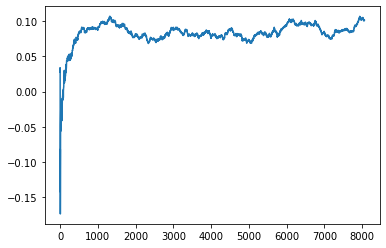

Thread: 4 iteration: 1350
RAM mDiffFit_106 FROM: 384 --> 256 reward: 0.0021510179687500228
Thread: 5 iteration: 1412
RAM mProject_78 FROM: 2880 --> 256 reward: -1.0
Thread: 2 iteration: 1337
RAM mProject_10 FROM: 1024 --> 256 reward: -1.0
Thread: 6 iteration: 1338
RAM mBackground_42 FROM: 2432 --> 1408 reward: -0.054910237421875056
Thread: 5 iteration: 1413
RAM mDiffFit_145 FROM: 2688 --> 256 reward: 0.17084367343750004
Thread: 4 iteration: 1351
RAM mDiffFit_338 FROM: 128 --> 320 reward: -0.7677448664062501
Thread: 6 iteration: 1339
RAM mDiffFit_250 FROM: 448 --> 256 reward: 0.4061563265625
Thread: 2 iteration: 1338
RAM mProject_81 FROM: 2688 --> 256 reward: -1.0
Thread: 1 iteration: 1297
RAM mProject_86 FROM: 1408 --> 384 reward: -1.0
Thread: 3 iteration: 1324
RAM mDiffFit_296 FROM: 2432 --> 320 reward: 0.102169226171875
Thread: 5 iteration: 1414
RAM mDiffFit_355 FROM: 1536 --> 320 reward: 0.303354159375
Thread: 4 iteration: 1352
RAM mBackground_50 FROM: 1856 --> 1408 reward: 0.011950

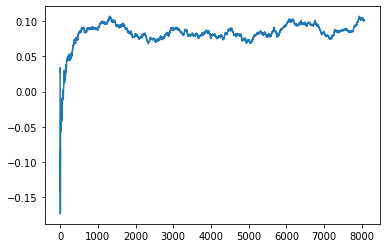

Thread: 6 iteration: 1340
RAM mDiffFit_317 FROM: 2624 --> 320 reward: 0.042075421484374965
Thread: 2 iteration: 1339
RAM mDiffFit_172 FROM: 256 --> 2112 reward: -0.0977395140625
Thread: 1 iteration: 1298
RAM mDiffFit_400 FROM: 960 --> 2112 reward: 0.042765707031249996
Thread: 3 iteration: 1325
RAM mDiffFit_132 FROM: 2688 --> 2112 reward: -0.014554712109375008
Thread: 5 iteration: 1415
RAM mDiffFit_217 FROM: 2624 --> 2560 reward: -0.0004921902343750159
Thread: 4 iteration: 1353
RAM mDiffFit_406 FROM: 448 --> 2112 reward: -0.07105984570312501
Thread: 6 iteration: 1341
RAM mDiffFit_390 FROM: 704 --> 2112 reward: -0.034723938281250005
Saving ...


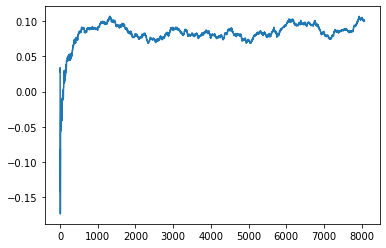

Thread: 2 iteration: 1340
RAM mDiffFit_25 FROM: 2944 --> 2112 reward: -0.01927347304687501
Thread: 1 iteration: 1299
RAM mBackground_85 FROM: 2944 --> 1408 reward: -0.032720448890625045
Thread: 5 iteration: 1416
RAM mDiffFit_83 FROM: 1600 --> 2112 reward: -0.010955730078125005
Thread: 4 iteration: 1354
RAM mDiffFit_306 FROM: 2304 --> 2112 reward: 0.02106252187500001
Thread: 6 iteration: 1342
RAM mBackground_32 FROM: 1088 --> 704 reward: 0.104870721328125
Thread: 3 iteration: 1326
RAM mBackground_60 FROM: 1920 --> 704 reward: 0.18060671639843748
Saving ...


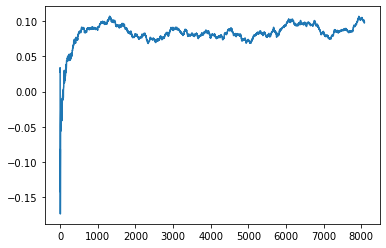

Thread: 1 iteration: 1300
RAM mDiffFit_106 FROM: 2816 --> 192 reward: 0.24008845234375006
Thread: 5 iteration: 1417
RAM mBackground_87 FROM: 192 --> 704 reward: -0.6362297885312502
Thread: 3 iteration: 1327
RAM mDiffFit_189 FROM: 384 --> 192 reward: 0.119148429296875
Thread: 6 iteration: 1343
RAM mProject_9 FROM: 640 --> 2560 reward: 0.7577596490625002
Thread: 2 iteration: 1341
RAM mBackground_72 FROM: 2112 --> 704 reward: 0.11732276076562499
Thread: 5 iteration: 1418
RAM mDiffFit_369 FROM: 1408 --> 192 reward: 0.150562434375
Thread: 1 iteration: 1301
RAM mProject_30 FROM: 2688 --> 2112 reward: -0.10020395081250001
Thread: 4 iteration: 1355
RAM mDiffFit_9 FROM: 1536 --> 192 reward: 0.10603896132812504
Thread: 3 iteration: 1328
RAM mDiffFit_174 FROM: 2560 --> 192 reward: 0.2798593367187501
Thread: 2 iteration: 1342
RAM mBackground_43 FROM: 1664 --> 704 reward: 0.1329886689140625
Thread: 5 iteration: 1419
RAM mDiffFit_372 FROM: 1024 --> 192 reward: 0.432669313671875
Thread: 4 iteration: 

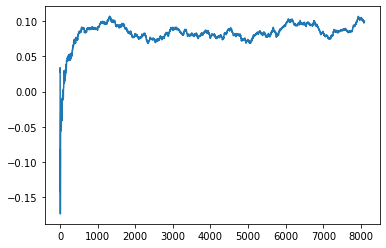

Thread: 5 iteration: 1420
RAM mBackground_26 FROM: 1280 --> 192 reward: 0.764195086921875
Thread: 3 iteration: 1329
RAM mDiffFit_160 FROM: 640 --> 192 reward: 0.209476570703125
Thread: 5 iteration: 1421
RAM mDiffFit_215 FROM: 1664 --> 192 reward: 0.26841141640625
Thread: 1 iteration: 1303
RAM mDiffFit_129 FROM: 704 --> 192 reward: 0.17036977890625
Saving ...


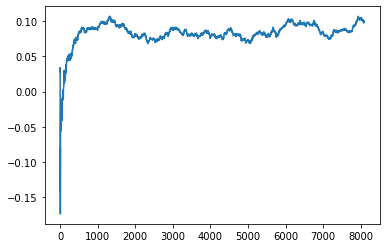

Thread: 3 iteration: 1330
RAM mProject_72 FROM: 1216 --> 1024 reward: 0.09030515969531235
Thread: 6 iteration: 1344
RAM mProject_47 FROM: 1216 --> 1024 reward: 0.09950626181249998
Thread: 2 iteration: 1343
RAM mDiffFit_344 FROM: 1536 --> 192 reward: 0.18376557578125002
Thread: 1 iteration: 1304
RAM mDiffFit_236 FROM: 1152 --> 192 reward: 0.308257809765625
Thread: 6 iteration: 1345
RAM mDiffFit_136 FROM: 2752 --> 192 reward: 0.34747389453125
Thread: 3 iteration: 1331
RAM mDiffFit_252 FROM: 1088 --> 192 reward: 0.4197811953125
Thread: 5 iteration: 1422
RAM mBackground_69 FROM: 896 --> 192 reward: 0.6287965918515626
Thread: 4 iteration: 1357
RAM mDiffFit_228 FROM: 960 --> 192 reward: 0.20158590742187496
Thread: 6 iteration: 1346
RAM mDiffFit_370 FROM: 896 --> 192 reward: 0.19317185859375002
Thread: 5 iteration: 1423
RAM mBackground_47 FROM: 2368 --> 192 reward: 0.7541907952734375
Thread: 3 iteration: 1332
RAM mDiffFit_269 FROM: 2304 --> 192 reward: 0.22398433671875
Thread: 4 iteration: 13

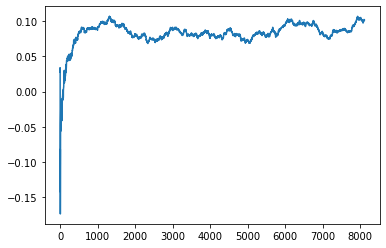

Thread: 4 iteration: 1360
RAM mDiffFit_363 FROM: 1024 --> 256 reward: 0.11504163750000002
Thread: 6 iteration: 1349
RAM mBgModel_2 FROM: 1088 --> 320 reward: 0.5716062478124999
Thread: 5 iteration: 1424
RAM mDiffFit_272 FROM: 2368 --> 320 reward: 0.08720305390624995
Thread: 1 iteration: 1306
RAM mDiffFit_395 FROM: 1792 --> 320 reward: 0.22483853984375
Thread: 2 iteration: 1345
RAM mDiffFit_143 FROM: 960 --> 320 reward: 0.201210951171875
Thread: 4 iteration: 1361
RAM mDiffFit_379 FROM: 192 --> 320 reward: 0.125450596484375
Thread: 5 iteration: 1425
RAM mDiffFit_269 FROM: 2752 --> 320 reward: 0.376502632421875
Saving ...


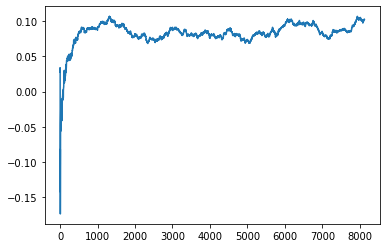

Thread: 6 iteration: 1350
RAM mBackground_67 FROM: 768 --> 1792 reward: -0.06956140503124994
Thread: 5 iteration: 1426
RAM mDiffFit_69 FROM: 512 --> 320 reward: 0.21297661445312502
Thread: 2 iteration: 1346
RAM mDiffFit_53 FROM: 1728 --> 320 reward: 0.14526561953125
Thread: 4 iteration: 1362
RAM mDiffFit_334 FROM: 1856 --> 320 reward: 0.21920309765625
Thread: 1 iteration: 1307
RAM mDiffFit_85 FROM: 2816 --> 320 reward: 0.12802856289062495
Thread: 6 iteration: 1351
RAM mProject_51 FROM: 2560 --> 1024 reward: 0.09247472437499989
Thread: 3 iteration: 1335
RAM mDiffFit_231 FROM: 1088 --> 192 reward: 0.10049210273437495
Thread: 5 iteration: 1427
RAM mDiffFit_197 FROM: 384 --> 192 reward: 0.08417966835937499
Thread: 4 iteration: 1363
RAM mDiffFit_140 FROM: 2432 --> 192 reward: 0.19254940351562497
Thread: 6 iteration: 1352
RAM mDiffFit_168 FROM: 2368 --> 192 reward: 0.280325465234375
Thread: 1 iteration: 1308
RAM mDiffFit_389 FROM: 3008 --> 192 reward: 0.49777588671874995
Thread: 5 iteration:

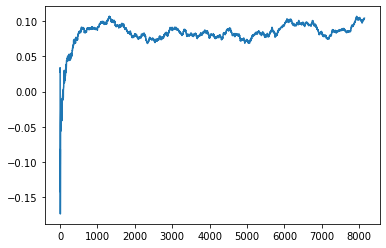

Thread: 1 iteration: 1310
RAM mDiffFit_60 FROM: 2240 --> 256 reward: 0.13493743437499997
Thread: 4 iteration: 1365
RAM mDiffFit_406 FROM: 512 --> 192 reward: 0.07357546523437501
Saving ...


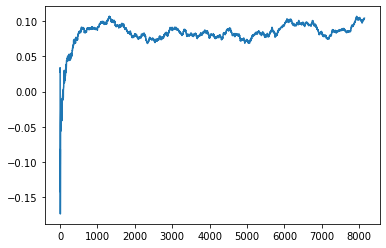

Thread: 5 iteration: 1430
RAM mDiffFit_55 FROM: 896 --> 192 reward: 0.14805725703124997
Thread: 2 iteration: 1348
RAM mProject_8 FROM: 2496 --> 1024 reward: 0.10202600193750008
Thread: 3 iteration: 1336
RAM mProject_46 FROM: 1856 --> 1024 reward: 0.21509059415625
Thread: 6 iteration: 1353
RAM mDiffFit_324 FROM: 1728 --> 256 reward: 0.133106748046875
Thread: 1 iteration: 1311
RAM mDiffFit_287 FROM: 704 --> 256 reward: 0.12189842929687497
Thread: 2 iteration: 1349
RAM mDiffFit_79 FROM: 1856 --> 256 reward: 0.30875
Thread: 3 iteration: 1337
RAM mDiffFit_9 FROM: 1280 --> 256 reward: 0.12266659375
Thread: 5 iteration: 1431
RAM mBackground_51 FROM: 960 --> 192 reward: 0.6456315295781251
Thread: 4 iteration: 1366
RAM mDiffFit_349 FROM: 1728 --> 320 reward: 0.11493225703124998
Thread: 6 iteration: 1354
RAM mBackground_23 FROM: 1088 --> 704 reward: 0.11157605734374995
Thread: 1 iteration: 1312
RAM mDiffFit_27 FROM: 512 --> 2752 reward: -0.124268164453125
Saving ...


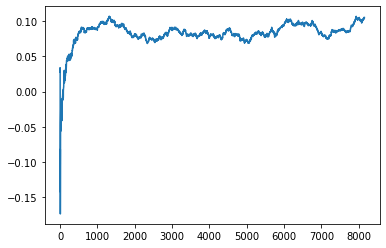

Thread: 2 iteration: 1350
RAM mDiffFit_155 FROM: 2368 --> 832 reward: -0.00402610546875003
Thread: 3 iteration: 1338
RAM mDiffFit_331 FROM: 2752 --> 1920 reward: 0.034020840625000014
Thread: 6 iteration: 1355
RAM mDiffFit_152 FROM: 1472 --> 256 reward: 0.11995568632812496
Thread: 1 iteration: 1313
RAM mDiffFit_153 FROM: 2688 --> 256 reward: 0.020374825000000034
Thread: 3 iteration: 1339
RAM mDiffFit_212 FROM: 1408 --> 256 reward: 0.108333275
Thread: 6 iteration: 1356
RAM mDiffFit_88 FROM: 512 --> 320 reward: 0.08250258867187502
Thread: 2 iteration: 1351
RAM mDiffFit_416 FROM: 2944 --> 1920 reward: 0.001505177343750011
Thread: 6 iteration: 1357
RAM mDiffFit_197 FROM: 384 --> 256 reward: 0.06671353984375
Thread: 2 iteration: 1352
RAM mDiffFit_88 FROM: 2688 --> 320 reward: 0.25522389453124994
Saving ...


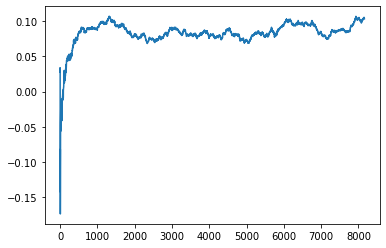

Thread: 3 iteration: 1340
RAM mProject_87 FROM: 2368 --> 1024 reward: 0.12940386595312492
Thread: 5 iteration: 1432
RAM mProject_84 FROM: 2624 --> 1024 reward: 0.08176095731250002
Thread: 4 iteration: 1367
RAM mDiffFit_365 FROM: 1408 --> 320 reward: 0.094643208203125
Thread: 6 iteration: 1358
RAM mDiffFit_7 FROM: 2560 --> 320 reward: 0.212664048828125
Thread: 2 iteration: 1353
RAM mDiffFit_84 FROM: 704 --> 320 reward: 0.209648473046875
Thread: 3 iteration: 1341
RAM mProject_26 FROM: 256 --> 2560 reward: 0.7681921621875002
Thread: 1 iteration: 1314
RAM mBackground_23 FROM: 1728 --> 704 reward: 0.14714508692187497
Thread: 5 iteration: 1433
RAM mBackground_66 FROM: 1600 --> 704 reward: 0.1346795394375
Thread: 4 iteration: 1368
RAM mDiffFit_166 FROM: 1728 --> 192 reward: 0.194437478125
Thread: 2 iteration: 1354
RAM mDiffFit_237 FROM: 1024 --> 192 reward: 0.21354426992187503
Thread: 3 iteration: 1342
RAM mDiffFit_14 FROM: 704 --> 192 reward: 0.184986969140625
Thread: 1 iteration: 1315
RAM m

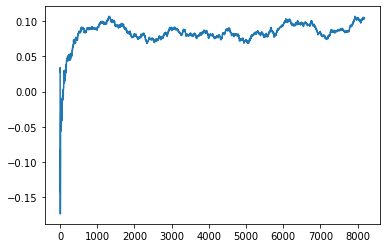

Thread: 4 iteration: 1370
RAM mDiffFit_360 FROM: 512 --> 384 reward: 0.020942699218749992
Thread: 3 iteration: 1344
RAM mDiffFit_398 FROM: 2240 --> 1920 reward: 0.113648560546875
Thread: 1 iteration: 1317
RAM mDiffFit_147 FROM: 2496 --> 1920 reward: 0.05040628281250001
Thread: 2 iteration: 1356
RAM mBackground_69 FROM: 2432 --> 192 reward: 0.7033208821953124
Saving ...


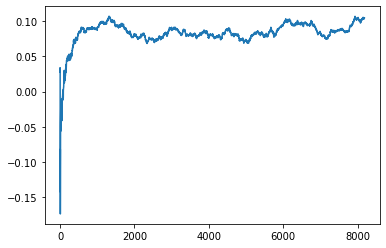

Thread: 6 iteration: 1360
RAM mDiffFit_166 FROM: 1344 --> 384 reward: 0.07804685859375
Thread: 4 iteration: 1371
RAM mBackground_67 FROM: 640 --> 1792 reward: -0.157536741046875
Thread: 3 iteration: 1345
RAM mProject_52 FROM: 2816 --> 2240 reward: -0.08322908688281253
Thread: 5 iteration: 1435
RAM mDiffFit_393 FROM: 1408 --> 192 reward: 0.231424447265625
Thread: 1 iteration: 1318
RAM mDiffFit_235 FROM: 832 --> 1088 reward: -0.06798701289062499
Thread: 6 iteration: 1361
RAM mDiffFit_289 FROM: 704 --> 192 reward: 0.14163539843749995
Thread: 4 iteration: 1372
RAM mDiffFit_37 FROM: 832 --> 192 reward: 0.10902079687499999
Thread: 3 iteration: 1346
RAM mDiffFit_78 FROM: 1984 --> 448 reward: 0.11202601796875002
Thread: 1 iteration: 1319
RAM mDiffFit_16 FROM: 448 --> 192 reward: 0.07846871718749998
Thread: 5 iteration: 1436
RAM mProject_78 FROM: 1408 --> 2240 reward: 0.006510167999999994
Thread: 2 iteration: 1357
RAM mBackground_59 FROM: 1408 --> 1792 reward: -0.012447586921874946
Saving ...


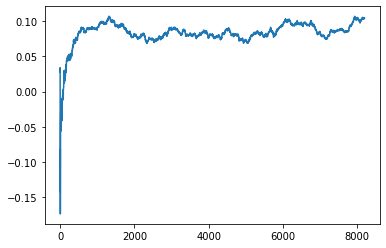

Thread: 1 iteration: 1320
RAM mDiffFit_290 FROM: 2944 --> 192 reward: 0.23229681484375
Thread: 5 iteration: 1437
RAM mDiffFit_21 FROM: 1536 --> 1088 reward: 0.01017185859375002
Thread: 3 iteration: 1347
RAM mBackground_18 FROM: 2368 --> 192 reward: 0.6973568772656248
Thread: 6 iteration: 1362
RAM mBackground_53 FROM: 1728 --> 192 reward: 0.778394029578125
Thread: 4 iteration: 1373
RAM mDiffFit_202 FROM: 3008 --> 1088 reward: -0.027565198046875013
Thread: 5 iteration: 1438
RAM mDiffFit_204 FROM: 1024 --> 1088 reward: -0.014013030859375015
Thread: 3 iteration: 1348
RAM mDiffFit_77 FROM: 2240 --> 2752 reward: -0.06339329570312496
Thread: 6 iteration: 1363
RAM mDiffFit_76 FROM: 960 --> 384 reward: 0.008140575781250044
Thread: 4 iteration: 1374
RAM mDiffFit_334 FROM: 1792 --> 1088 reward: 0.011833318750000005
Thread: 6 iteration: 1364
RAM mBackground_90 FROM: 704 --> 1792 reward: -0.13627638038281248
Thread: 5 iteration: 1439
RAM mDiffFit_208 FROM: 1856 --> 1088 reward: -0.03921621601562500

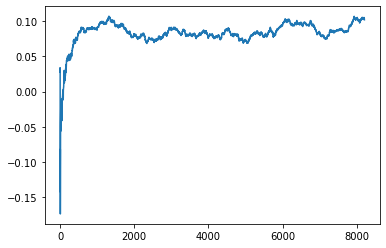

Thread: 3 iteration: 1350
RAM mProject_12 FROM: 1536 --> 1024 reward: 0.1765312486875
Thread: 1 iteration: 1321
RAM mDiffFit_131 FROM: 2880 --> 192 reward: 0.201179624609375
Thread: 2 iteration: 1359
RAM mBackground_86 FROM: 320 --> 1792 reward: -0.36075426569531255
Thread: 3 iteration: 1351
RAM mDiffFit_3 FROM: 960 --> 192 reward: 0.27464061953125
Thread: 1 iteration: 1322
RAM mDiffFit_130 FROM: 2688 --> 320 reward: 0.26280716953125
Thread: 4 iteration: 1376
RAM mDiffFit_18 FROM: 960 --> 192 reward: 0.04649991249999999
Thread: 6 iteration: 1366
RAM mDiffFit_400 FROM: 512 --> 192 reward: 0.10926039843749999
Saving ...


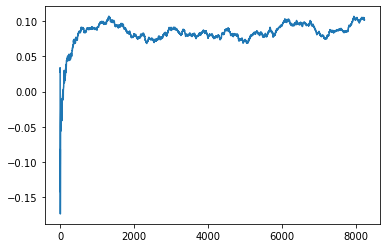

Thread: 2 iteration: 1360
RAM mDiffFit_316 FROM: 2112 --> 192 reward: 0.17686714648437502
Thread: 6 iteration: 1367
RAM mDiffFit_402 FROM: 2240 --> 320 reward: 0.12711969140625
Thread: 4 iteration: 1377
RAM mProject_83 FROM: 576 --> 896 reward: 0.926019064546875
Saving ...


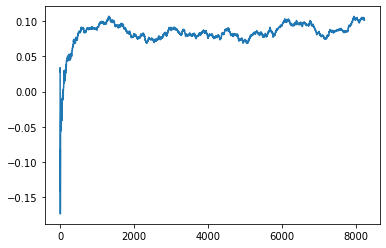

Thread: 5 iteration: 1440
RAM mDiffFit_218 FROM: 2944 --> 192 reward: 0.12064307695312498
Thread: 2 iteration: 1361
RAM mBackground_84 FROM: 1408 --> 192 reward: 0.7086646017109375
Thread: 1 iteration: 1323
RAM mDiffFit_17 FROM: 256 --> 192 reward: 0.05263280976562503
Thread: 5 iteration: 1441
RAM mDiffFit_233 FROM: 2496 --> 192 reward: 0.45299991250000005
Thread: 6 iteration: 1368
RAM mDiffFit_218 FROM: 1088 --> 832 reward: 0.10188026484375001
Thread: 4 iteration: 1378
RAM mDiffFit_226 FROM: 1216 --> 832 reward: 0.047710951171875
Thread: 2 iteration: 1362
RAM mDiffFit_281 FROM: 1088 --> 832 reward: 0.03498438046875002
Thread: 5 iteration: 1442
RAM mProject_77 FROM: 2112 --> 256 reward: -1.0
Thread: 3 iteration: 1352
RAM mDiffFit_71 FROM: 2496 --> 832 reward: 0.022476526953125013
Thread: 2 iteration: 1363
RAM mBackground_44 FROM: 2752 --> 192 reward: 0.6319475233437499
Thread: 4 iteration: 1379
RAM mBackground_17 FROM: 2752 --> 192 reward: 0.6897444888359375
Thread: 1 iteration: 1324
R

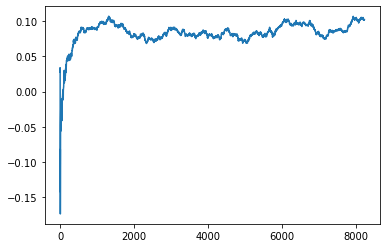

Thread: 6 iteration: 1370
RAM mDiffFit_247 FROM: 256 --> 192 reward: 0.10864584062499999
Saving ...


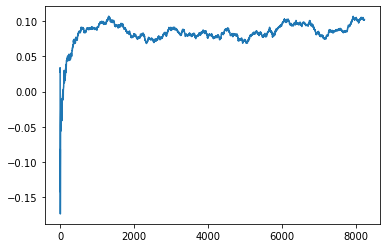

Thread: 4 iteration: 1380
RAM mDiffFit_286 FROM: 192 --> 192 reward: -0.015742190234375036
Thread: 5 iteration: 1444
RAM mDiffFit_282 FROM: 512 --> 192 reward: 0.09787754492187502
Thread: 2 iteration: 1364
RAM mDiffFit_254 FROM: 832 --> 192 reward: 0.1872916375
Thread: 6 iteration: 1371
RAM mDiffFit_352 FROM: 2816 --> 192 reward: 0.17061969140625
Thread: 4 iteration: 1381
RAM mDiffFit_386 FROM: 1600 --> 192 reward: 0.12470823125
Thread: 5 iteration: 1445
RAM mDiffFit_284 FROM: 704 --> 192 reward: 0.21769269921875
Thread: 6 iteration: 1372
RAM mDiffFit_104 FROM: 1536 --> 192 reward: 0.20025776601562495
Thread: 5 iteration: 1446
RAM mDiffFit_194 FROM: 2624 --> 192 reward: 0.24013276601562494
Thread: 5 iteration: 1447
RAM mProject_15 FROM: 2112 --> 256 reward: -1.0
Thread: 1 iteration: 1325
RAM mDiffFit_414 FROM: 1280 --> 192 reward: 0.09306243437500002
Thread: 6 iteration: 1373
RAM mProject_27 FROM: 1920 --> 1024 reward: 0.21016401820312494
Thread: 3 iteration: 1354
RAM mProject_81 FROM:

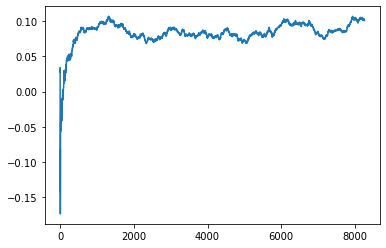

Thread: 5 iteration: 1450
RAM mDiffFit_227 FROM: 1920 --> 192 reward: 0.14585933671874998
Thread: 3 iteration: 1356
RAM mDiffFit_87 FROM: 1984 --> 1920 reward: 0.021473982031249995
Thread: 1 iteration: 1328
RAM mDiffFit_228 FROM: 2624 --> 1920 reward: -0.013302123437500014
Thread: 3 iteration: 1357
RAM mDiffFit_381 FROM: 2432 --> 192 reward: 0.14128891757812495
Thread: 5 iteration: 1451
RAM mDiffFit_50 FROM: 3008 --> 192 reward: 0.46398424921875003
Thread: 6 iteration: 1376
RAM mBackground_69 FROM: 2432 --> 1792 reward: -0.0045598261562500245
Thread: 1 iteration: 1329
RAM mProject_53 FROM: 128 --> 896 reward: 0.9375643839375001
Thread: 4 iteration: 1383
RAM mDiffFit_341 FROM: 2752 --> 1920 reward: 0.006273429296875018
Thread: 3 iteration: 1358
RAM mDiffFit_332 FROM: 2048 --> 192 reward: 0.16676035468749995
Thread: 5 iteration: 1452
RAM mDiffFit_343 FROM: 1984 --> 192 reward: 0.203835907421875
Thread: 6 iteration: 1377
RAM mDiffFit_280 FROM: 1664 --> 192 reward: 0.212174447265625
Saving

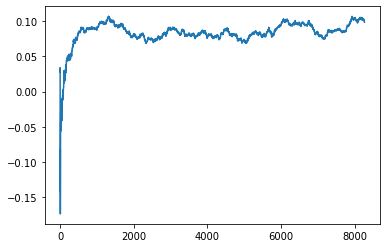

Thread: 1 iteration: 1330
RAM mDiffFit_77 FROM: 2432 --> 192 reward: 0.17081502304687501
Thread: 4 iteration: 1384
RAM mDiffFit_399 FROM: 1984 --> 192 reward: 0.26527860664062497
Thread: 3 iteration: 1359
RAM mDiffFit_182 FROM: 1920 --> 192 reward: 0.262289048828125
Thread: 5 iteration: 1453
RAM mBackground_59 FROM: 2944 --> 192 reward: 0.66068586921875
Thread: 6 iteration: 1378
RAM mDiffFit_99 FROM: 2240 --> 1920 reward: -0.006614601562499999
Thread: 5 iteration: 1454
RAM mDiffFit_210 FROM: 1024 --> 192 reward: 0.195481704296875
Thread: 1 iteration: 1331
RAM mDiffFit_77 FROM: 256 --> 192 reward: 0.002679668359375012
Saving ...


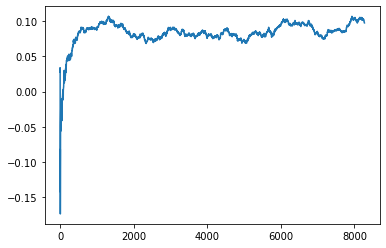

Thread: 3 iteration: 1360
RAM mDiffFit_314 FROM: 704 --> 192 reward: 0.063812434375
Thread: 4 iteration: 1385
RAM mDiffFit_87 FROM: 2560 --> 1920 reward: 0.02125
Thread: 6 iteration: 1379
RAM mDiffFit_119 FROM: 1152 --> 1920 reward: -0.013406239062499995
Thread: 4 iteration: 1386
RAM mAdd_3 FROM: 1920 --> 320 reward: -1.0
Thread: 2 iteration: 1365
RAM mBackground_63 FROM: 2624 --> 1792 reward: -0.034171642453124956
Thread: 3 iteration: 1361
RAM mBackground_72 FROM: 704 --> 1792 reward: -0.13971638038281245
Saving ...


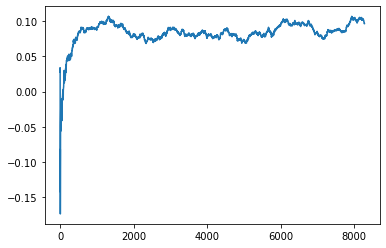

Thread: 6 iteration: 1380
RAM mDiffFit_226 FROM: 1088 --> 192 reward: 0.31365365039062504
Thread: 1 iteration: 1332
RAM mBackground_32 FROM: 2880 --> 192 reward: 0.6324827970859375
Thread: 5 iteration: 1455
RAM mDiffFit_101 FROM: 1920 --> 1920 reward: 0.027546902343749992
Thread: 2 iteration: 1366
RAM mDiffFit_172 FROM: 1408 --> 192 reward: 0.262158827734375
Thread: 6 iteration: 1381
RAM mDiffFit_36 FROM: 704 --> 192 reward: 0.178903606640625
Thread: 1 iteration: 1333
RAM mDiffFit_10 FROM: 1088 --> 192 reward: 0.4854686734375
Thread: 4 iteration: 1387
RAM mDiffFit_56 FROM: 128 --> 192 reward: -0.50267190234375
Thread: 5 iteration: 1456
RAM mDiffFit_220 FROM: 1344 --> 192 reward: 0.12746867343749999
Thread: 3 iteration: 1362
RAM mDiffFit_78 FROM: 2240 --> 192 reward: 0.130773385546875
Thread: 2 iteration: 1367
RAM mDiffFit_9 FROM: 576 --> 192 reward: 0.18586719023437503
Thread: 1 iteration: 1334
RAM mDiffFit_224 FROM: 1152 --> 192 reward: 0.27135938046875
Thread: 4 iteration: 1388
RAM m

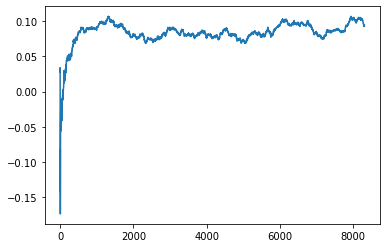

Thread: 2 iteration: 1370
RAM mDiffFit_310 FROM: 1152 --> 192 reward: 0.142132766015625
Saving ...


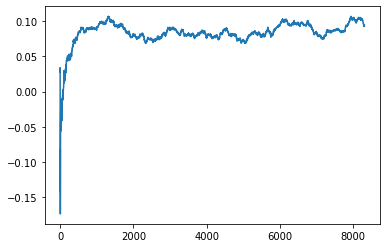

Thread: 5 iteration: 1460
RAM mBackground_79 FROM: 256 --> 768 reward: -0.29205055915624994
Thread: 1 iteration: 1337
RAM mDiffFit_245 FROM: 256 --> 192 reward: 0.011369778906250017
Thread: 6 iteration: 1384
RAM mProject_32 FROM: 2880 --> 320 reward: -1.0
Thread: 4 iteration: 1389
RAM mDiffFit_43 FROM: 128 --> 320 reward: -0.2797577660156252
Thread: 5 iteration: 1461
RAM mDiffFit_331 FROM: 2560 --> 320 reward: 0.364778650390625
Thread: 1 iteration: 1338
RAM mDiffFit_54 FROM: 512 --> 320 reward: 0.265145884375
Saving ...


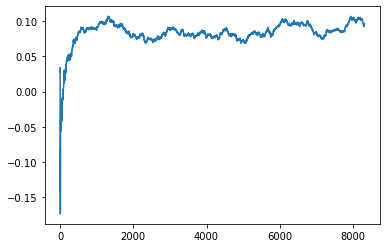

Thread: 4 iteration: 1390
RAM mDiffFit_308 FROM: 832 --> 192 reward: 0.173414048828125
Thread: 1 iteration: 1339
RAM mDiffFit_397 FROM: 1408 --> 320 reward: -0.250143645703125
Thread: 5 iteration: 1462
RAM mProject_15 FROM: 2816 --> 2240 reward: -0.10812911575781267
Thread: 2 iteration: 1371
RAM mProject_23 FROM: 1088 --> 2240 reward: -0.1091524916953125
Thread: 6 iteration: 1385
RAM mDiffFit_114 FROM: 2304 --> 192 reward: 0.16614057578125002
Saving ...


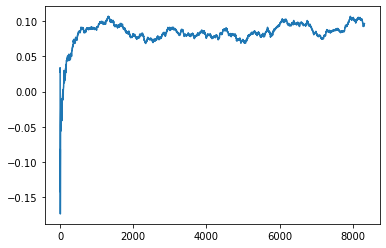

Thread: 1 iteration: 1340
RAM mDiffFit_240 FROM: 1728 --> 320 reward: 0.17254685859375002
Thread: 6 iteration: 1386
RAM mBackground_67 FROM: 1792 --> 704 reward: 0.13143888038281243
Thread: 5 iteration: 1463
RAM mProject_76 FROM: 2432 --> 2240 reward: -0.023566929468750074
Thread: 4 iteration: 1391
RAM mProject_33 FROM: 2880 --> 320 reward: -1.0
Thread: 3 iteration: 1366
RAM mDiffFit_407 FROM: 2752 --> 192 reward: 0.16857542148437502
Thread: 6 iteration: 1387
RAM mDiffFit_291 FROM: 768 --> 192 reward: 0.42164061953125
Thread: 1 iteration: 1341
RAM mDiffFit_224 FROM: 1728 --> 192 reward: 0.28037495625
Thread: 5 iteration: 1464
RAM mDiffFit_381 FROM: 1088 --> 192 reward: 0.201966128515625
Thread: 3 iteration: 1367
RAM mDiffFit_18 FROM: 1664 --> 192 reward: 0.16583068632812498
Thread: 6 iteration: 1388
RAM mBackground_76 FROM: 3008 --> 192 reward: 0.7304197496015625
Thread: 4 iteration: 1392
RAM mProject_38 FROM: 1920 --> 1024 reward: 0.21280402082812505
Thread: 2 iteration: 1372
RAM mDif

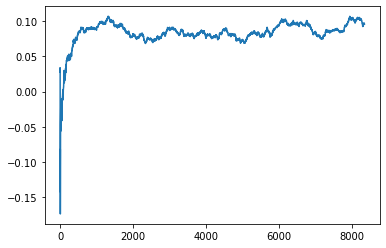

Thread: 6 iteration: 1390
RAM mDiffFit_264 FROM: 1280 --> 320 reward: 0.23783595117187498
Thread: 3 iteration: 1369
RAM mDiffFit_245 FROM: 640 --> 320 reward: -0.0332188046875
Thread: 4 iteration: 1394
RAM mBackground_74 FROM: 2368 --> 192 reward: 1.0312006733359373
Thread: 5 iteration: 1466
RAM mDiffFit_319 FROM: 1472 --> 320 reward: 0.04635670429687499
Thread: 2 iteration: 1374
RAM mDiffFit_192 FROM: 1920 --> 256 reward: 0.13300517734375
Saving ...


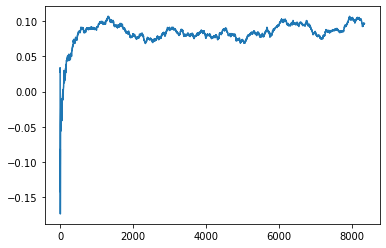

Thread: 3 iteration: 1370
RAM mDiffFit_92 FROM: 192 --> 320 reward: -0.17444792031249995
Thread: 6 iteration: 1391
RAM mDiffFit_285 FROM: 832 --> 320 reward: 0.040593717187499975
Thread: 4 iteration: 1395
RAM mDiffFit_149 FROM: 2240 --> 320 reward: 0.16476039843749998
Thread: 5 iteration: 1467
RAM mDiffFit_60 FROM: 192 --> 192 reward: 0.045351570703125
Thread: 6 iteration: 1392
RAM mDiffFit_144 FROM: 896 --> 192 reward: 0.23701561953125005
Thread: 3 iteration: 1371
RAM mDiffFit_151 FROM: 2304 --> 192 reward: 0.31000776601562496
Thread: 5 iteration: 1468
RAM mDiffFit_348 FROM: 512 --> 192 reward: 0.07806506679687499
Thread: 4 iteration: 1396
RAM mProject_12 FROM: 2752 --> 1024 reward: 0.06064841531250002
Thread: 1 iteration: 1344
RAM mProject_37 FROM: 2048 --> 2112 reward: 0.004878298476562448
Thread: 2 iteration: 1375
RAM mDiffFit_263 FROM: 448 --> 192 reward: 0.102273429296875
Thread: 3 iteration: 1372
RAM mBackground_58 FROM: 128 --> 2304 reward: 0.31424974184375004
Thread: 4 iterati

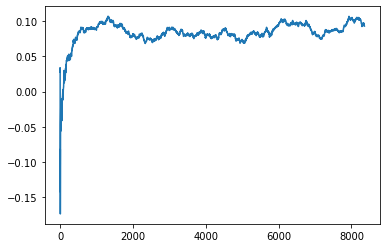

Thread: 5 iteration: 1470
RAM mDiffFit_307 FROM: 1984 --> 192 reward: 0.18684371718750004
Thread: 6 iteration: 1394
RAM mDiffFit_10 FROM: 2560 --> 192 reward: 0.5272186734375
Thread: 2 iteration: 1376
RAM mBackground_71 FROM: 768 --> 192 reward: 0.5913171639843751
Thread: 1 iteration: 1346
RAM mDiffFit_249 FROM: 2880 --> 192 reward: 0.20253115156249996
Thread: 5 iteration: 1471
RAM mDiffFit_376 FROM: 1984 --> 192 reward: 0.267403606640625
Thread: 6 iteration: 1395
RAM mProject_8 FROM: 704 --> 2944 reward: 0.8190760263750001
Thread: 4 iteration: 1398
RAM mDiffFit_235 FROM: 320 --> 832 reward: -0.053143208203125014
Thread: 5 iteration: 1472
RAM mDiffFit_267 FROM: 2368 --> 640 reward: 0.135106748046875
Thread: 4 iteration: 1399
RAM mDiffFit_320 FROM: 1088 --> 640 reward: 0.10301566328125
Thread: 5 iteration: 1473
RAM mProject_41 FROM: 2752 --> 2240 reward: -0.07797297951562512
Thread: 3 iteration: 1374
RAM mProject_76 FROM: 192 --> 2944 reward: 0.812220081328125
Thread: 1 iteration: 1347


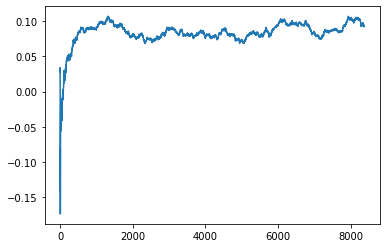

Thread: 4 iteration: 1400
RAM mProject_49 FROM: 2880 --> 2240 reward: -0.10317583828125007
Thread: 1 iteration: 1348
RAM mBackground_81 FROM: 1920 --> 192 reward: 0.7108235443671875
Thread: 3 iteration: 1377
RAM mDiffFit_118 FROM: 2048 --> 1984 reward: -0.02078128281250001
Thread: 2 iteration: 1378
RAM mDiffFit_296 FROM: 1088 --> 1984 reward: -0.018598938281250005
Thread: 6 iteration: 1398
RAM mDiffFit_382 FROM: 1984 --> 1984 reward: -0.0006250000000000006
Thread: 4 iteration: 1401
RAM mDiffFit_414 FROM: 1856 --> 1984 reward: -0.020158871484374993
Thread: 5 iteration: 1477
RAM mDiffFit_172 FROM: 2816 --> 1984 reward: 0.010104159375000001
Thread: 1 iteration: 1349
RAM mDiffFit_34 FROM: 576 --> 1984 reward: -0.13606247812500005
Thread: 2 iteration: 1379
RAM mDiffFit_413 FROM: 3008 --> 1984 reward: -0.05704435742187501
Thread: 6 iteration: 1399
RAM mDiffFit_15 FROM: 1472 --> 1984 reward: 0.07358862734374998
Thread: 4 iteration: 1402
RAM mDiffFit_77 FROM: 832 --> 1984 reward: -0.0341640488

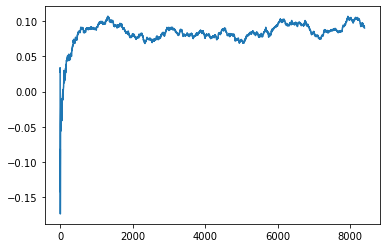

Thread: 2 iteration: 1380
RAM mBackground_61 FROM: 320 --> 768 reward: -0.2708663803828125
Saving ...


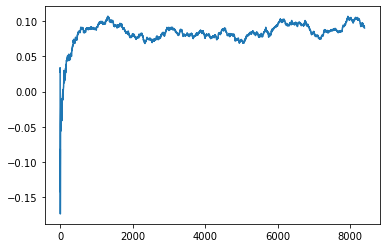

Thread: 1 iteration: 1350
RAM mDiffFit_377 FROM: 192 --> 1984 reward: -0.285520796875
Thread: 3 iteration: 1379
RAM mDiffFit_330 FROM: 3008 --> 1984 reward: -0.11850798476562499
Thread: 4 iteration: 1403
RAM mDiffFit_37 FROM: 1088 --> 384 reward: 0.06324477890625
Saving ...


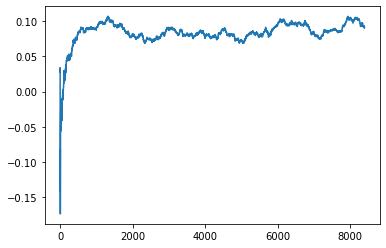

Thread: 3 iteration: 1380
RAM mProject_87 FROM: 640 --> 2944 reward: 0.80574663628125
Saving ...


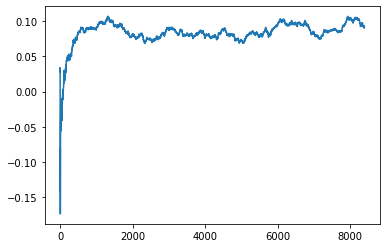

Thread: 6 iteration: 1400
RAM mDiffFit_116 FROM: 448 --> 384 reward: 0.15578650390625
Thread: 4 iteration: 1404
RAM mProject_10 FROM: 384 --> 2944 reward: 0.8247844714218749
Thread: 5 iteration: 1479
RAM mDiffFit_417 FROM: 1600 --> 192 reward: 0.21375517734375002
Thread: 3 iteration: 1381
RAM mBackground_61 FROM: 1664 --> 192 reward: 0.7322071017109375
Thread: 1 iteration: 1351
RAM mDiffFit_404 FROM: 2176 --> 192 reward: 0.23096090742187492
Saving ...


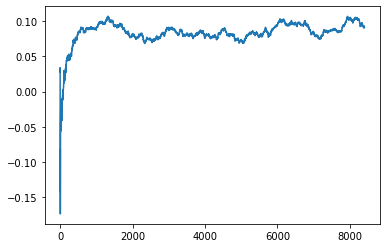

Thread: 5 iteration: 1480
RAM mDiffFit_130 FROM: 1408 --> 192 reward: 0.5163176992187499
Thread: 6 iteration: 1401
RAM mDiffFit_135 FROM: 1024 --> 192 reward: 0.19217707968749997
Thread: 1 iteration: 1352
RAM mDiffFit_227 FROM: 320 --> 192 reward: 0.06843747812499998
Thread: 3 iteration: 1382
RAM mDiffFit_371 FROM: 1600 --> 192 reward: 0.175893120703125
Thread: 4 iteration: 1405
RAM mProject_11 FROM: 2176 --> 1024 reward: 0.16467080329687497
Thread: 2 iteration: 1381
RAM mDiffFit_243 FROM: 1856 --> 192 reward: 0.3144192261718749
Thread: 5 iteration: 1481
RAM mDiffFit_43 FROM: 2496 --> 192 reward: 0.19260929296875
Thread: 6 iteration: 1402
RAM mDiffFit_117 FROM: 1536 --> 192 reward: 0.2697187171875
Thread: 4 iteration: 1406
RAM mDiffFit_413 FROM: 2368 --> 192 reward: 0.19774732382812493
Thread: 2 iteration: 1382
RAM mDiffFit_291 FROM: 1984 --> 192 reward: 0.49873433671874995
Thread: 1 iteration: 1353
RAM mDiffFit_260 FROM: 960 --> 192 reward: 0.168226526953125
Thread: 5 iteration: 1482


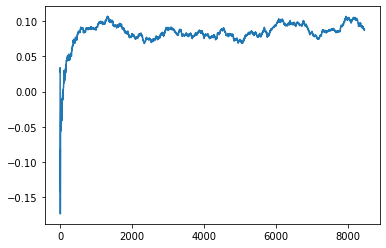

Thread: 6 iteration: 1410
RAM mDiffFit_314 FROM: 2880 --> 1920 reward: -0.0034609511718750215
Saving ...


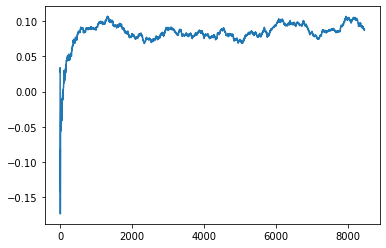

Thread: 5 iteration: 1490
RAM mProject_32 FROM: 1920 --> 256 reward: -1.0
Saving ...


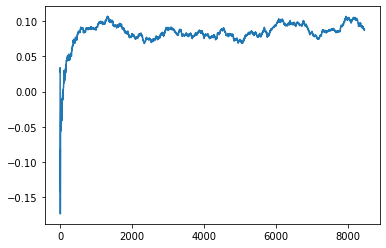

Thread: 4 iteration: 1410
RAM mProject_33 FROM: 192 --> 2560 reward: 0.7514858924999999
Saving ...


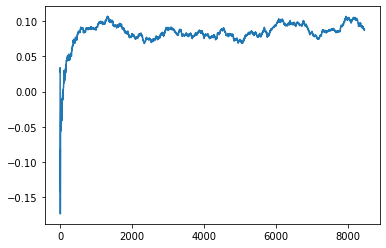

Thread: 2 iteration: 1390
RAM mDiffFit_299 FROM: 2624 --> 1920 reward: 0.007007809765624973
Thread: 6 iteration: 1411
RAM mDiffFit_134 FROM: 2496 --> 1920 reward: -0.010679712109374984
Thread: 2 iteration: 1391
RAM mDiffFit_243 FROM: 576 --> 192 reward: 0.24776561953124998
Thread: 5 iteration: 1491
RAM mDiffFit_193 FROM: 2624 --> 192 reward: 0.139778519140625
Saving ...


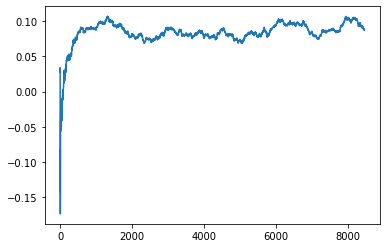

Thread: 1 iteration: 1360
RAM mDiffFit_340 FROM: 192 --> 192 reward: -0.067710951171875
Thread: 6 iteration: 1412
RAM mDiffFit_294 FROM: 2432 --> 192 reward: 0.148414005078125
Thread: 5 iteration: 1492
RAM mDiffFit_281 FROM: 1280 --> 192 reward: 0.15002334179687496
Thread: 2 iteration: 1392
RAM mProject_72 FROM: 2944 --> 256 reward: -1.0
Saving ...


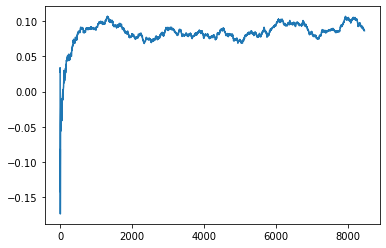

Thread: 3 iteration: 1390
RAM mBackground_84 FROM: 128 --> 1920 reward: 0.24608119617187504
Thread: 6 iteration: 1413
RAM mDiffFit_283 FROM: 576 --> 320 reward: 0.050466128515625
Thread: 2 iteration: 1393
RAM mDiffFit_334 FROM: 832 --> 448 reward: 0.24855997695312507
Thread: 5 iteration: 1493
RAM mProject_45 FROM: 2048 --> 1024 reward: 0.1834724081249999
Thread: 4 iteration: 1411
RAM mDiffFit_298 FROM: 192 --> 320 reward: -0.28374482265625
Thread: 6 iteration: 1414
RAM mDiffFit_282 FROM: 1088 --> 320 reward: 0.08407287656250001
Thread: 2 iteration: 1394
RAM mDiffFit_188 FROM: 512 --> 320 reward: 0.029539048828125004
Thread: 3 iteration: 1391
RAM mDiffFit_140 FROM: 768 --> 320 reward: 0.13606769921875
Thread: 5 iteration: 1494
RAM mDiffFit_242 FROM: 2560 --> 320 reward: 0.132617146484375
Thread: 4 iteration: 1412
RAM mDiffFit_264 FROM: 1856 --> 832 reward: 0.011807257031249997
Thread: 6 iteration: 1415
RAM mDiffFit_212 FROM: 2368 --> 1920 reward: 0.018476570703124987
Thread: 3 iteration

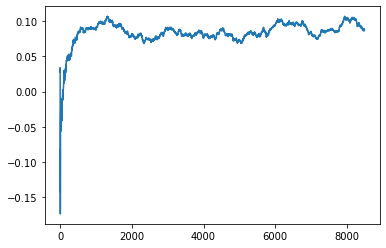

Thread: 6 iteration: 1420
RAM mProject_34 FROM: 1024 --> 1024 reward: 0.0011924999999999187
Thread: 2 iteration: 1396
RAM mDiffFit_57 FROM: 1920 --> 832 reward: -0.0010651542968749886
Thread: 4 iteration: 1416
RAM mProject_7 FROM: 192 --> 768 reward: -1.0
Thread: 5 iteration: 1496
RAM mDiffFit_417 FROM: 2432 --> 832 reward: -0.08778400273437502
Thread: 6 iteration: 1421
RAM mProject_83 FROM: 1344 --> 1024 reward: 0.1408790707031251
Thread: 1 iteration: 1362
RAM mDiffFit_225 FROM: 1408 --> 832 reward: -0.009684933203124996
Thread: 2 iteration: 1397
RAM mDiffFit_405 FROM: 640 --> 832 reward: 0.05289588437499996
Thread: 4 iteration: 1417
RAM mProject_21 FROM: 576 --> 320 reward: -1.0
Thread: 3 iteration: 1396
RAM mBackground_19 FROM: 832 --> 192 reward: 0.7881183458749998
Thread: 4 iteration: 1418
RAM mDiffFit_262 FROM: 1984 --> 192 reward: 0.27502079687500003
Thread: 3 iteration: 1397
RAM mBackground_10 FROM: 1472 --> 192 reward: 0.828417375453125
Thread: 6 iteration: 1422
RAM mDiffFit_4

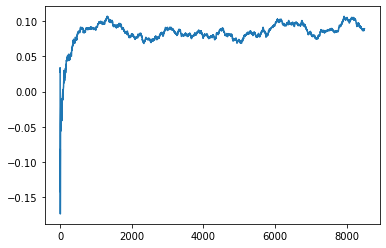

Thread: 4 iteration: 1420
RAM mDiffFit_364 FROM: 1280 --> 192 reward: 0.15503382773437502
Thread: 6 iteration: 1424
RAM mDiffFit_129 FROM: 384 --> 192 reward: 0.038437478124999994
Saving ...


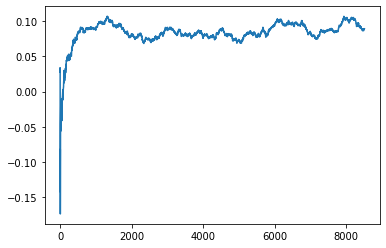

Thread: 3 iteration: 1400
RAM mDiffFit_166 FROM: 1728 --> 192 reward: 0.25202342929687493
Thread: 5 iteration: 1498
RAM mDiffFit_416 FROM: 2880 --> 192 reward: 0.24963272226562494
Thread: 1 iteration: 1364
RAM mBackground_30 FROM: 1664 --> 768 reward: 0.1183037311875
Thread: 2 iteration: 1399
RAM mBackground_9 FROM: 2240 --> 768 reward: 0.12222742475000001
Thread: 4 iteration: 1421
RAM mDiffFit_102 FROM: 2048 --> 192 reward: 0.514992146484375
Thread: 6 iteration: 1425
RAM mDiffFit_394 FROM: 128 --> 1920 reward: -0.58479685859375
Saving ...


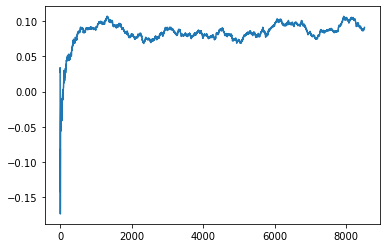

Thread: 2 iteration: 1400
RAM mDiffFit_214 FROM: 448 --> 1920 reward: -0.04052338554687501
Thread: 4 iteration: 1422
RAM mDiffFit_306 FROM: 2688 --> 192 reward: 0.158242058984375
Thread: 3 iteration: 1401
RAM mDiffFit_122 FROM: 2880 --> 192 reward: 0.22451553203125002
Thread: 5 iteration: 1499
RAM mBackground_8 FROM: 1536 --> 1408 reward: -0.03123774909374996
Thread: 6 iteration: 1426
RAM mDiffFit_275 FROM: 128 --> 384 reward: -0.45654690234375006
Thread: 3 iteration: 1402
RAM mDiffFit_103 FROM: 2560 --> 1920 reward: -0.0069219023437499996
Thread: 6 iteration: 1427
RAM mDiffFit_158 FROM: 2624 --> 384 reward: 0.158479115625
Thread: 4 iteration: 1423
RAM mProject_46 FROM: 2432 --> 2240 reward: -0.02818740592968757
Thread: 1 iteration: 1365
RAM mDiffFit_279 FROM: 1024 --> 384 reward: 0.17083331874999996
Saving ...


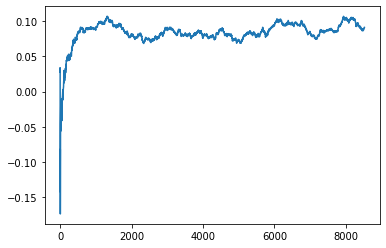

Thread: 5 iteration: 1500
RAM mDiffFit_29 FROM: 2240 --> 384 reward: 0.015966041015624995
Thread: 2 iteration: 1401
RAM mDiffFit_131 FROM: 448 --> 384 reward: 0.04289584062500001
Thread: 3 iteration: 1403
RAM mDiffFit_391 FROM: 2560 --> 1984 reward: -0.019984424218749998
Thread: 2 iteration: 1402
RAM mBackground_90 FROM: 2688 --> 1408 reward: -0.06004786196874998
Thread: 5 iteration: 1501
RAM mDiffFit_139 FROM: 2688 --> 384 reward: 0.23256239062500003
Thread: 6 iteration: 1428
RAM mDiffFit_159 FROM: 1024 --> 1984 reward: -0.01945050898437501
Thread: 6 iteration: 1429
RAM mBackground_14 FROM: 896 --> 896 reward: 0.017419490140625035
Thread: 3 iteration: 1404
RAM mDiffFit_153 FROM: 256 --> 320 reward: -0.0019062390624999606
Thread: 2 iteration: 1403
RAM mDiffFit_152 FROM: 1024 --> 320 reward: 0.21201825195312501
Thread: 5 iteration: 1502
RAM mDiffFit_120 FROM: 1088 --> 320 reward: 0.16515365039062505
Thread: 2 iteration: 1404
RAM mDiffFit_22 FROM: 2176 --> 320 reward: 0.20258853984374997

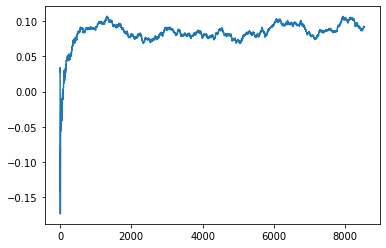

Thread: 6 iteration: 1430
RAM mDiffFit_54 FROM: 640 --> 384 reward: 0.05183331874999999
Thread: 5 iteration: 1506
RAM mDiffFit_107 FROM: 2432 --> 1920 reward: 0.010984380468749989
Thread: 6 iteration: 1431
RAM mBackground_1 FROM: 2368 --> 704 reward: 0.09597052153124996
Thread: 3 iteration: 1406
RAM mDiffFit_292 FROM: 832 --> 384 reward: 0.07870573007812501
Thread: 5 iteration: 1507
RAM mDiffFit_362 FROM: 128 --> 256 reward: -0.63752610546875
Thread: 6 iteration: 1432
RAM mDiffFit_208 FROM: 1792 --> 192 reward: 0.15219265546875
Thread: 6 iteration: 1433
RAM mProject_76 FROM: 1920 --> 1024 reward: 0.19040994225000002
Thread: 2 iteration: 1407
RAM mBackground_1 FROM: 1280 --> 192 reward: 0.6966156214296876
Thread: 3 iteration: 1407
RAM mBackground_14 FROM: 2112 --> 192 reward: 0.7186239919531249
Thread: 5 iteration: 1508
RAM mBackground_35 FROM: 192 --> 704 reward: -0.8196136196171874
Thread: 6 iteration: 1434
RAM mDiffFit_413 FROM: 1792 --> 192 reward: 0.3007317480468751
Thread: 2 itera

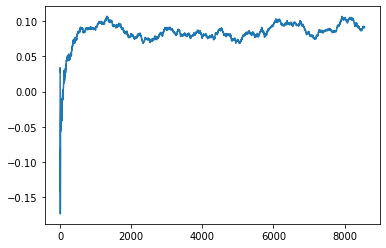

Thread: 1 iteration: 1370
RAM mDiffFit_34 FROM: 2688 --> 640 reward: 0.13039579687499997
Saving ...


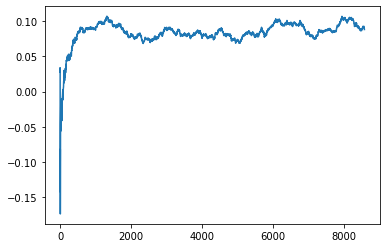

Thread: 2 iteration: 1410
RAM mDiffFit_351 FROM: 1920 --> 256 reward: 0.12438017734375001
Thread: 6 iteration: 1437
RAM mDiffFit_322 FROM: 2880 --> 640 reward: 0.153585951171875
Saving ...


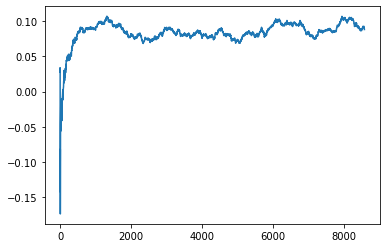

Thread: 5 iteration: 1510
RAM mDiffFit_75 FROM: 1088 --> 192 reward: 0.061877501171875016
Thread: 4 iteration: 1429
RAM mDiffFit_344 FROM: 1024 --> 192 reward: 0.24897134960937506
Thread: 3 iteration: 1409
RAM mDiffFit_273 FROM: 320 --> 384 reward: -0.04769792031249999
Thread: 2 iteration: 1411
RAM mBackground_74 FROM: 896 --> 1792 reward: -0.05362453943749998
Thread: 6 iteration: 1438
RAM mProject_29 FROM: 768 --> 2944 reward: 0.812512581328125
Thread: 1 iteration: 1371
RAM mDiffFit_72 FROM: 1728 --> 256 reward: 0.122856748046875
Saving ...


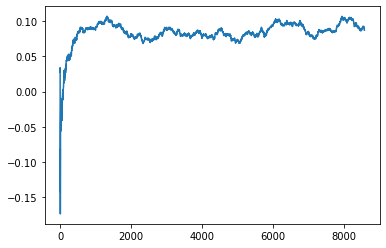

Thread: 3 iteration: 1410
RAM mDiffFit_383 FROM: 1344 --> 256 reward: 0.13255988945312502
Thread: 3 iteration: 1411
RAM mProject_76 FROM: 192 --> 2560 reward: 0.7455721359374999
Thread: 5 iteration: 1511
RAM mDiffFit_416 FROM: 128 --> 256 reward: -0.31639584062500004
Thread: 1 iteration: 1372
RAM mBackground_53 FROM: 256 --> 320 reward: -0.085964154125
Saving ...


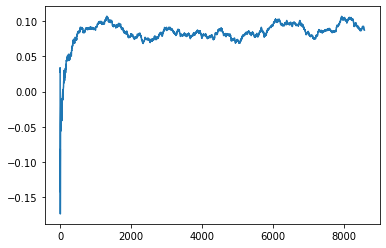

Thread: 4 iteration: 1430
RAM mDiffFit_49 FROM: 1472 --> 256 reward: 0.2585311953125
Thread: 2 iteration: 1412
RAM mDiffFit_71 FROM: 2944 --> 1088 reward: 0.02612495624999999
Thread: 3 iteration: 1412
RAM mBackground_56 FROM: 1792 --> 704 reward: 0.14832981317968755
Thread: 5 iteration: 1512
RAM mBackground_59 FROM: 192 --> 2944 reward: -0.6546008562421876
Thread: 3 iteration: 1413
RAM mDiffFit_302 FROM: 256 --> 320 reward: -0.031091128515625052
Thread: 2 iteration: 1413
RAM mDiffFit_360 FROM: 2880 --> 320 reward: 0.14933849609374997
Thread: 5 iteration: 1513
RAM mDiffFit_403 FROM: 1472 --> 320 reward: 0.103770796875
Thread: 3 iteration: 1414
RAM mDiffFit_281 FROM: 1664 --> 320 reward: 0.16786977890625
Thread: 2 iteration: 1414
RAM mBackground_21 FROM: 1728 --> 704 reward: 0.12108303450781248
Thread: 5 iteration: 1514
RAM mBackground_31 FROM: 2048 --> 192 reward: 0.715900646078125
Thread: 6 iteration: 1439
RAM mDiffFit_69 FROM: 576 --> 1088 reward: 0.024520884375000013
Thread: 3 iterat

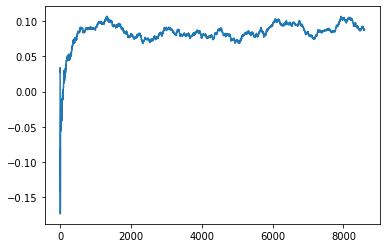

Thread: 6 iteration: 1440
RAM mDiffFit_35 FROM: 1024 --> 192 reward: 0.254471349609375
Thread: 3 iteration: 1416
RAM mDiffFit_405 FROM: 2112 --> 192 reward: 0.241523385546875
Thread: 2 iteration: 1416
RAM mProject_49 FROM: 2560 --> 256 reward: -1.0
Thread: 4 iteration: 1431
RAM mProject_18 FROM: 2304 --> 256 reward: -1.0
Thread: 1 iteration: 1373
RAM mDiffFit_178 FROM: 512 --> 192 reward: 0.05986451406250003
Thread: 5 iteration: 1516
RAM mDiffFit_115 FROM: 1920 --> 192 reward: 0.19707809765624998
Thread: 3 iteration: 1417
RAM mDiffFit_115 FROM: 768 --> 192 reward: 0.205742190234375
Thread: 1 iteration: 1374
RAM mDiffFit_201 FROM: 2816 --> 192 reward: 0.21184626210937502
Thread: 4 iteration: 1432
RAM mDiffFit_106 FROM: 2944 --> 192 reward: 0.2721483855468749
Thread: 5 iteration: 1517
RAM mDiffFit_26 FROM: 832 --> 192 reward: 0.15805466835937504
Thread: 3 iteration: 1418
RAM mBackground_44 FROM: 2752 --> 192 reward: 0.6502158069453123
Thread: 6 iteration: 1441
RAM mBackground_35 FROM: 21

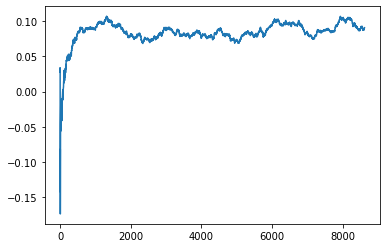

Thread: 5 iteration: 1520
RAM mProject_57 FROM: 2880 --> 1280 reward: -0.07800602203125016
Saving ...


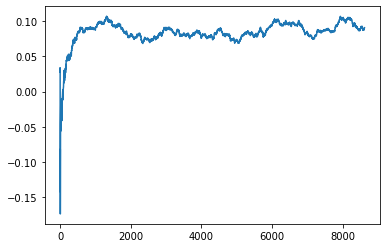

Thread: 3 iteration: 1420
RAM mDiffFit_120 FROM: 2176 --> 320 reward: 0.09704681484374997
Thread: 6 iteration: 1443
RAM mProject_34 FROM: 1216 --> 2752 reward: 0.02032673913281252
Thread: 4 iteration: 1435
RAM mProject_44 FROM: 2560 --> 1024 reward: 0.08718347306249997
Thread: 2 iteration: 1419
RAM mDiffFit_256 FROM: 1920 --> 320 reward: 0.08842444726562501
Thread: 3 iteration: 1421
RAM mDiffFit_191 FROM: 1984 --> 320 reward: 0.108294226171875
Thread: 6 iteration: 1444
RAM mBackground_34 FROM: 2496 --> 704 reward: 0.09519560845312497
Thread: 4 iteration: 1436
RAM mDiffFit_288 FROM: 1216 --> 320 reward: 0.12826561953124999
Thread: 6 iteration: 1445
RAM mDiffFit_361 FROM: 1728 --> 192 reward: 0.30267966835937504
Thread: 4 iteration: 1437
RAM mDiffFit_64 FROM: 2880 --> 2560 reward: 0.0007890488281249788
Thread: 6 iteration: 1446
RAM mProject_47 FROM: 1920 --> 256 reward: -1.0
Thread: 1 iteration: 1377
RAM mDiffFit_379 FROM: 2752 --> 320 reward: 0.17285152695312506
Thread: 6 iteration: 144

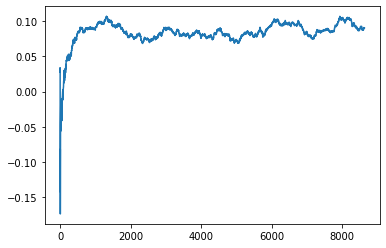

Thread: 4 iteration: 1440
RAM mDiffFit_35 FROM: 1152 --> 192 reward: 0.27011719023437497
Thread: 5 iteration: 1522
RAM mBackground_60 FROM: 2368 --> 192 reward: 0.72314344446875
Thread: 6 iteration: 1448
RAM mProject_16 FROM: 320 --> 320 reward: -1.0
Thread: 3 iteration: 1422
RAM mProject_35 FROM: 1664 --> 256 reward: -1.0
Saving ...


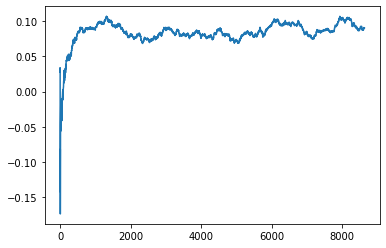

Thread: 2 iteration: 1420
RAM mDiffFit_203 FROM: 640 --> 1088 reward: -0.052153650390624993
Thread: 4 iteration: 1441
RAM mBackground_40 FROM: 896 --> 192 reward: 0.630142549296875
Thread: 1 iteration: 1379
RAM mDiffFit_264 FROM: 1792 --> 1088 reward: 0.10794537539062503
Thread: 3 iteration: 1423
RAM mDiffFit_328 FROM: 192 --> 192 reward: -0.05896876093750003
Thread: 5 iteration: 1523
RAM mBackground_2 FROM: 1856 --> 192 reward: 0.7059501984921873
Thread: 2 iteration: 1421
RAM mDiffFit_158 FROM: 2624 --> 1088 reward: 0.02061714648437499
Thread: 4 iteration: 1442
RAM mDiffFit_173 FROM: 1088 --> 1088 reward: 0.011497411328124998
Thread: 5 iteration: 1524
RAM mAdd_1 FROM: 320 --> 2944 reward: 0.613513796484375
Thread: 4 iteration: 1443
RAM mDiffFit_202 FROM: 2048 --> 192 reward: 0.22964834179687502
Thread: 5 iteration: 1525
RAM mDiffFit_94 FROM: 832 --> 192 reward: 0.5251770796875
Thread: 2 iteration: 1422
RAM mBackground_14 FROM: 1664 --> 192 reward: 0.6620834444687499
Thread: 6 iteratio

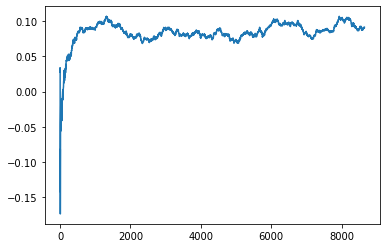

Thread: 6 iteration: 1450
RAM mViewer_4 FROM: 1664 --> 1408 reward: 0.07233877406249999
Thread: 4 iteration: 1444
RAM mDiffFit_147 FROM: 2432 --> 192 reward: 0.476768120703125
Thread: 5 iteration: 1526
RAM mProject_4 FROM: 2432 --> 1024 reward: 0.09892569304687508
Thread: 3 iteration: 1424
RAM mProject_42 FROM: 2624 --> 256 reward: -1.0
Saving ...


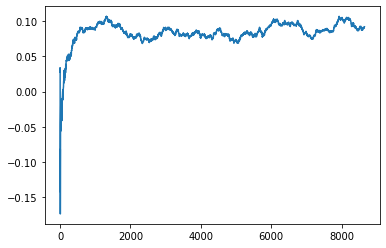

Thread: 1 iteration: 1380
RAM mDiffFit_144 FROM: 640 --> 192 reward: 0.18661719023437498
Thread: 6 iteration: 1451
RAM mDiffFit_195 FROM: 640 --> 192 reward: 0.15324736757812496
Thread: 4 iteration: 1445
RAM mDiffFit_93 FROM: 1536 --> 192 reward: 0.166226526953125
Thread: 5 iteration: 1527
RAM mDiffFit_90 FROM: 2368 --> 192 reward: 0.39951035468750007
Thread: 3 iteration: 1425
RAM mDiffFit_262 FROM: 512 --> 832 reward: -0.03042966835937501
Thread: 6 iteration: 1452
RAM mDiffFit_143 FROM: 1984 --> 832 reward: 0.05333853984375001
Thread: 5 iteration: 1528
RAM mDiffFit_388 FROM: 2368 --> 192 reward: -1.012212394921875
Thread: 4 iteration: 1446
RAM mDiffFit_361 FROM: 2624 --> 832 reward: 0.032281195312500004
Thread: 6 iteration: 1453
RAM mBackground_8 FROM: 2240 --> 1408 reward: -0.02271842112499999
Thread: 4 iteration: 1447
RAM mProject_27 FROM: 960 --> 256 reward: -1.0
Thread: 2 iteration: 1424
RAM mDiffFit_125 FROM: 1344 --> 832 reward: -0.04244537539062501
Thread: 5 iteration: 1529
RAM

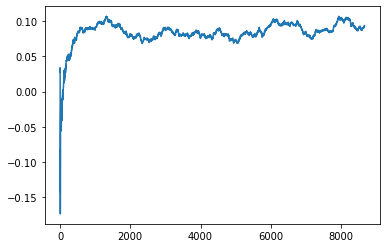

Thread: 5 iteration: 1530
RAM mProject_35 FROM: 2624 --> 256 reward: -1.0
Thread: 1 iteration: 1381
RAM mBackground_12 FROM: 2944 --> 192 reward: 0.6405968020156252
Thread: 3 iteration: 1426
RAM mDiffFit_203 FROM: 2624 --> 320 reward: 0.13402597421874998
Thread: 5 iteration: 1531
RAM mDiffFit_279 FROM: 2624 --> 320 reward: 0.30171086367187494
Saving ...


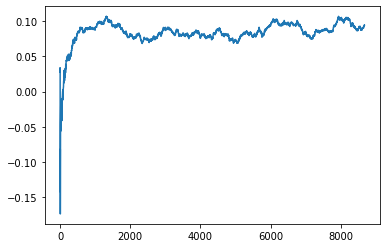

Thread: 4 iteration: 1450
RAM mBackground_69 FROM: 512 --> 1792 reward: -0.17395284768749997
Thread: 3 iteration: 1427
RAM mProject_33 FROM: 1600 --> 256 reward: -1.0
Thread: 6 iteration: 1454
RAM mDiffFit_183 FROM: 896 --> 192 reward: 0.561992190234375
Thread: 1 iteration: 1382
RAM mDiffFit_234 FROM: 2496 --> 320 reward: 0.13585933671875
Thread: 3 iteration: 1428
RAM mBackground_52 FROM: 192 --> 704 reward: -0.7284827114687499
Thread: 5 iteration: 1532
RAM mBackground_29 FROM: 2176 --> 192 reward: 0.7065324493984374
Thread: 4 iteration: 1451
RAM mDiffFit_86 FROM: 3008 --> 320 reward: 0.06921086367187501
Thread: 3 iteration: 1429
RAM mDiffFit_172 FROM: 1152 --> 192 reward: 0.26902342929687495
Thread: 6 iteration: 1455
RAM mDiffFit_326 FROM: 2880 --> 192 reward: 0.2733905757812499
Thread: 1 iteration: 1383
RAM mDiffFit_419 FROM: 1792 --> 192 reward: 0.24463798710937498
Thread: 5 iteration: 1533
RAM mProject_34 FROM: 1600 --> 1024 reward: 0.1821806125312501
Thread: 2 iteration: 1427
RAM 

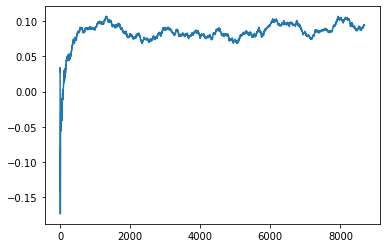

Thread: 3 iteration: 1430
RAM mDiffFit_374 FROM: 192 --> 320 reward: -0.04145309765624997
Thread: 6 iteration: 1457
RAM mDiffFit_340 FROM: 2880 --> 320 reward: 0.105627544921875
Thread: 5 iteration: 1535
RAM mDiffFit_45 FROM: 1408 --> 320 reward: 0.238804712109375
Thread: 3 iteration: 1431
RAM mDiffFit_400 FROM: 832 --> 256 reward: 0.22050522109374998
Thread: 6 iteration: 1458
RAM mProject_55 FROM: 704 --> 2944 reward: 0.8248969714218748
Thread: 1 iteration: 1385
RAM mProject_72 FROM: 1792 --> 1024 reward: 0.20701310203124998
Thread: 4 iteration: 1452
RAM mDiffFit_382 FROM: 1600 --> 192 reward: 0.45723692539062494
Thread: 5 iteration: 1536
RAM mBackground_52 FROM: 2752 --> 192 reward: 0.6656779216328126
Thread: 2 iteration: 1429
RAM mDiffFit_234 FROM: 1600 --> 256 reward: 0.138601483203125
Thread: 6 iteration: 1459
RAM mDiffFit_371 FROM: 1664 --> 192 reward: 0.142020709375
Thread: 3 iteration: 1432
RAM mDiffFit_174 FROM: 2816 --> 1920 reward: 0.0069062390625
Thread: 5 iteration: 1537
R

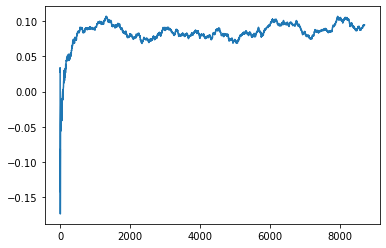

Thread: 6 iteration: 1460
RAM mBackground_7 FROM: 1600 --> 2304 reward: 0.0915520783671875
Saving ...


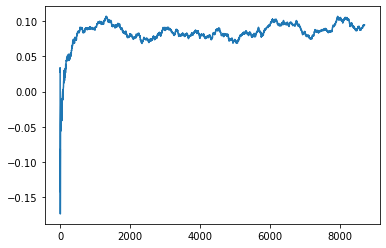

Thread: 2 iteration: 1430
RAM mDiffFit_198 FROM: 1152 --> 192 reward: 0.27723438046875
Thread: 3 iteration: 1433
RAM mBackground_65 FROM: 1856 --> 2304 reward: 0.002851032695312486
Thread: 1 iteration: 1386
RAM mBackground_76 FROM: 1472 --> 192 reward: 0.7214078230390626
Thread: 4 iteration: 1453
RAM mDiffFit_257 FROM: 2496 --> 1920 reward: -0.016156282812500016
Thread: 3 iteration: 1434
RAM mBackground_38 FROM: 384 --> 1792 reward: -0.272749837828125
Thread: 2 iteration: 1431
RAM mDiffFit_167 FROM: 2816 --> 1920 reward: -0.04581778671875
Thread: 4 iteration: 1454
RAM mBackground_63 FROM: 1600 --> 704 reward: 0.19363436559375008
Thread: 5 iteration: 1538
RAM mDiffFit_272 FROM: 832 --> 192 reward: 0.26443488945312504
Thread: 6 iteration: 1461
RAM mDiffFit_236 FROM: 1024 --> 192 reward: 0.14416922617187497
Thread: 1 iteration: 1387
RAM mDiffFit_11 FROM: 2752 --> 192 reward: 0.208039005078125
Thread: 2 iteration: 1432
RAM mDiffFit_89 FROM: 1856 --> 192 reward: 0.2293228765625
Thread: 5 it

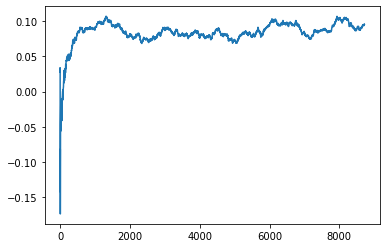

Thread: 1 iteration: 1390
RAM mDiffFit_369 FROM: 256 --> 192 reward: 0.180062521875
Thread: 3 iteration: 1437
RAM mDiffFit_222 FROM: 1088 --> 192 reward: 0.13337495624999998
Thread: 3 iteration: 1438
RAM mDiffFit_94 FROM: 512 --> 192 reward: 0.12340615156250005
Thread: 4 iteration: 1457
RAM mDiffFit_216 FROM: 896 --> 1984 reward: 0.013484424218749985
Thread: 3 iteration: 1439
RAM mProject_36 FROM: 896 --> 256 reward: -1.0
Thread: 2 iteration: 1433
RAM mProject_18 FROM: 768 --> 896 reward: -1.0
Saving ...


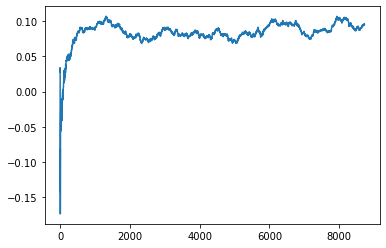

Thread: 5 iteration: 1540
RAM mProject_42 FROM: 1472 --> 256 reward: -1.0
Thread: 6 iteration: 1463
RAM mDiffFit_248 FROM: 1344 --> 192 reward: 0.20392966835937498
Thread: 4 iteration: 1458
RAM mDiffFit_375 FROM: 1408 --> 320 reward: 0.3203906195312499
Saving ...


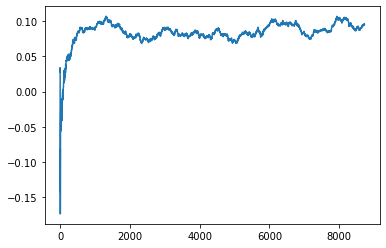

Thread: 3 iteration: 1440
RAM mProject_33 FROM: 1536 --> 1024 reward: 0.1464187224375
Thread: 1 iteration: 1391
RAM mDiffFit_244 FROM: 2880 --> 1216 reward: 0.07449741132812499
Thread: 6 iteration: 1464
RAM mDiffFit_354 FROM: 448 --> 192 reward: 0.12261977890625
Thread: 2 iteration: 1434
RAM mDiffFit_172 FROM: 1984 --> 320 reward: 0.151476526953125
Thread: 3 iteration: 1441
RAM mDiffFit_164 FROM: 960 --> 192 reward: 0.20557809765625004
Thread: 4 iteration: 1459
RAM mDiffFit_362 FROM: 832 --> 192 reward: 0.18266404882812504
Thread: 5 iteration: 1541
RAM mDiffFit_35 FROM: 2816 --> 1216 reward: 0.03342185859374999
Thread: 1 iteration: 1392
RAM mDiffFit_7 FROM: 2624 --> 1920 reward: -0.017539092578125012
Thread: 3 iteration: 1442
RAM mDiffFit_55 FROM: 1408 --> 384 reward: 0.030479115625
Saving ...


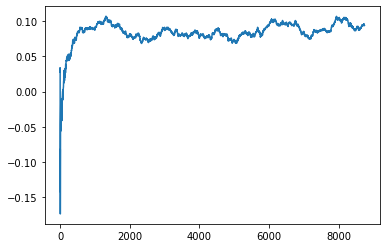

Thread: 4 iteration: 1460
RAM mBackground_17 FROM: 256 --> 2944 reward: -0.47386879215625005
Thread: 5 iteration: 1542
RAM mDiffFit_298 FROM: 2304 --> 384 reward: 0.0343436734375
Thread: 3 iteration: 1443
RAM mDiffFit_54 FROM: 1856 --> 384 reward: 0.27301303085937495
Thread: 5 iteration: 1543
RAM mBackground_19 FROM: 2240 --> 192 reward: 0.7048012428593752
Thread: 4 iteration: 1461
RAM mBackground_84 FROM: 2112 --> 192 reward: 0.6881745887343751
Thread: 2 iteration: 1435
RAM mDiffFit_394 FROM: 1728 --> 192 reward: 0.26570309765625
Thread: 5 iteration: 1544
RAM mBackground_4 FROM: 2944 --> 192 reward: 0.6560700856171876
Thread: 1 iteration: 1393
RAM mProject_17 FROM: 1216 --> 384 reward: -1.0
Thread: 6 iteration: 1465
RAM mDiffFit_74 FROM: 1600 --> 384 reward: 0.30452088437499997
Thread: 6 iteration: 1466
RAM mDiffFit_217 FROM: 384 --> 192 reward: 0.15026561953125003
Thread: 6 iteration: 1467
RAM mProject_31 FROM: 1408 --> 384 reward: -1.0
Thread: 3 iteration: 1444
RAM mDiffFit_19 FROM:

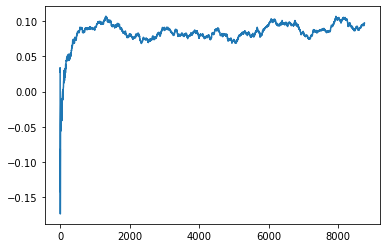

Thread: 6 iteration: 1470
RAM mDiffFit_26 FROM: 512 --> 192 reward: 0.05582287656249997
Thread: 4 iteration: 1463
RAM mDiffFit_206 FROM: 896 --> 192 reward: 0.2011979203125
Thread: 3 iteration: 1446
RAM mDiffFit_414 FROM: 2368 --> 192 reward: 0.203247323828125
Thread: 2 iteration: 1437
RAM mDiffFit_324 FROM: 2304 --> 384 reward: 0.13087495625
Thread: 6 iteration: 1471
RAM mDiffFit_228 FROM: 1024 --> 192 reward: 0.20424477890625
Thread: 4 iteration: 1464
RAM mDiffFit_116 FROM: 192 --> 384 reward: -0.11815623906249996
Thread: 3 iteration: 1447
RAM mProject_86 FROM: 960 --> 2240 reward: -0.1945085990625
Thread: 1 iteration: 1394
RAM mDiffFit_57 FROM: 1600 --> 384 reward: 0.07395568632812499
Thread: 2 iteration: 1438
RAM mDiffFit_331 FROM: 2048 --> 384 reward: 0.07260411562499998
Thread: 6 iteration: 1472
RAM mDiffFit_234 FROM: 2688 --> 384 reward: 0.059171814843750004
Thread: 4 iteration: 1465
RAM mDiffFit_216 FROM: 2624 --> 384 reward: 0.150445287890625
Thread: 3 iteration: 1448
RAM mBac

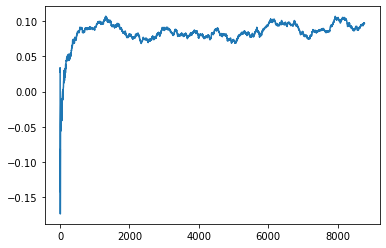

Thread: 2 iteration: 1440
RAM mDiffFit_342 FROM: 320 --> 320 reward: -0.27891935742187496
Thread: 1 iteration: 1397
RAM mDiffFit_296 FROM: 1856 --> 320 reward: 0.08444524414062499
Thread: 2 iteration: 1441
RAM mBackground_1 FROM: 1472 --> 320 reward: 0.5385459081484375
Thread: 4 iteration: 1467
RAM mBackground_45 FROM: 2688 --> 192 reward: 0.6622872003046875
Saving ...


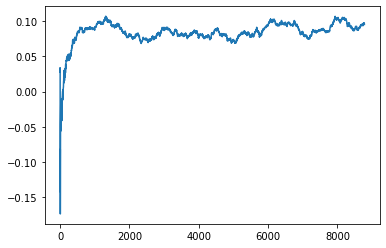

Thread: 3 iteration: 1450
RAM mDiffFit_359 FROM: 704 --> 320 reward: 0.145174491015625
Thread: 2 iteration: 1442
RAM mDiffFit_418 FROM: 704 --> 320 reward: 0.054799447265625016
Thread: 4 iteration: 1468
RAM mBackground_40 FROM: 1728 --> 192 reward: 0.7351454099609375
Thread: 1 iteration: 1398
RAM mProject_8 FROM: 1088 --> 1024 reward: 0.03138609424218753
Thread: 5 iteration: 1546
RAM mDiffFit_150 FROM: 1024 --> 320 reward: 0.086648429296875
Thread: 2 iteration: 1443
RAM mDiffFit_110 FROM: 2880 --> 320 reward: 0.11490619531250001
Thread: 4 iteration: 1469
RAM mBackground_40 FROM: 2048 --> 320 reward: 0.3497220264609376
Thread: 3 iteration: 1451
RAM mProject_8 FROM: 1856 --> 384 reward: -1.0
Thread: 6 iteration: 1473
RAM mDiffFit_208 FROM: 1152 --> 192 reward: 0.348820331640625
Thread: 1 iteration: 1399
RAM mDiffFit_96 FROM: 1984 --> 192 reward: 0.179333275
Thread: 2 iteration: 1444
RAM mDiffFit_245 FROM: 1088 --> 192 reward: 0.15598433671874998
Thread: 3 iteration: 1452
RAM mDiffFit_324

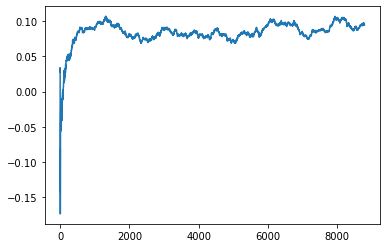

Thread: 4 iteration: 1470
RAM mDiffFit_319 FROM: 640 --> 192 reward: 0.164632809765625
Thread: 6 iteration: 1474
RAM mDiffFit_195 FROM: 1920 --> 192 reward: 0.27315623906250003
Saving ...


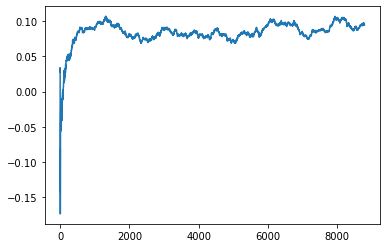

Thread: 1 iteration: 1400
RAM mDiffFit_357 FROM: 704 --> 192 reward: 0.128643208203125
Thread: 2 iteration: 1445
RAM mProject_18 FROM: 2624 --> 2240 reward: -0.061951534382812576
Thread: 5 iteration: 1547
RAM mDiffFit_155 FROM: 1920 --> 1920 reward: -0.0031250000000000028
Thread: 6 iteration: 1475
RAM mDiffFit_372 FROM: 1984 --> 192 reward: 0.293887987109375
Thread: 3 iteration: 1453
RAM mBackground_31 FROM: 3008 --> 192 reward: 0.6243776971875
Thread: 5 iteration: 1548
RAM mDiffFit_119 FROM: 576 --> 1920 reward: -0.163312521875
Thread: 5 iteration: 1549
RAM mProject_42 FROM: 1024 --> 2240 reward: -0.15271249957031247
Thread: 4 iteration: 1471
RAM mBackground_40 FROM: 832 --> 192 reward: 0.7645332836015623
Thread: 3 iteration: 1454
RAM mProject_63 FROM: 1088 --> 2240 reward: -0.11017529796093757
Thread: 1 iteration: 1401
RAM mProject_19 FROM: 1984 --> 2240 reward: 0.04568634056250004
Thread: 2 iteration: 1446
RAM mProject_56 FROM: 2496 --> 2240 reward: -0.049853065710937346
Thread: 6 i

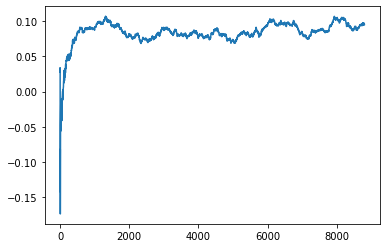

Thread: 5 iteration: 1550
RAM mBackground_3 FROM: 192 --> 896 reward: -0.5550515542265625
Thread: 2 iteration: 1447
RAM mBackground_5 FROM: 960 --> 192 reward: 0.6724729475859376
Thread: 1 iteration: 1402
RAM mDiffFit_69 FROM: 640 --> 192 reward: 0.16223955781249996
Thread: 4 iteration: 1473
RAM mDiffFit_26 FROM: 192 --> 192 reward: 0.0457187609375
Thread: 3 iteration: 1456
RAM mDiffFit_112 FROM: 448 --> 192 reward: 0.18208853984375
Thread: 5 iteration: 1551
RAM mDiffFit_189 FROM: 768 --> 192 reward: 0.22023438046875005
Thread: 1 iteration: 1403
RAM mDiffFit_196 FROM: 704 --> 192 reward: 0.01916918242187496
Thread: 3 iteration: 1457
RAM mBackground_90 FROM: 1344 --> 192 reward: 0.67071929034375
Thread: 2 iteration: 1448
RAM mDiffFit_100 FROM: 1344 --> 192 reward: 0.25985152695312497
Thread: 4 iteration: 1474
RAM mDiffFit_25 FROM: 2496 --> 192 reward: 0.20476557578125001
Thread: 1 iteration: 1404
RAM mDiffFit_159 FROM: 2240 --> 192 reward: 0.2476770796875
Thread: 3 iteration: 1458
RAM m

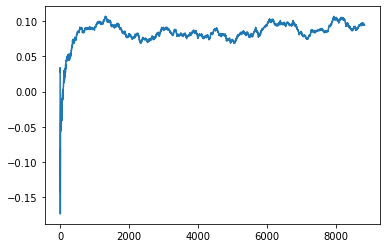

Thread: 2 iteration: 1450
RAM mDiffFit_122 FROM: 2880 --> 256 reward: 0.21046867343749998
Thread: 5 iteration: 1553
RAM mDiffFit_146 FROM: 2624 --> 384 reward: 0.1814478765625
Thread: 4 iteration: 1477
RAM mDiffFit_237 FROM: 384 --> 256 reward: 0.12852606171874997
Saving ...


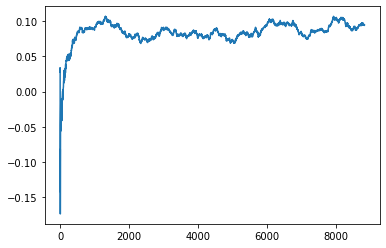

Thread: 3 iteration: 1460
RAM mDiffFit_321 FROM: 1024 --> 256 reward: 0.161979159375
Thread: 1 iteration: 1407
RAM mDiffFit_112 FROM: 1280 --> 256 reward: 0.175604159375
Thread: 5 iteration: 1554
RAM mDiffFit_237 FROM: 2560 --> 256 reward: 0.50866668125
Thread: 2 iteration: 1451
RAM mDiffFit_373 FROM: 640 --> 1088 reward: -0.017223938281249983
Thread: 1 iteration: 1408
RAM mViewer_2 FROM: 1856 --> 1408 reward: 0.053647355179687495
Thread: 3 iteration: 1461
RAM mDiffFit_150 FROM: 768 --> 192 reward: 0.307304712109375
Thread: 5 iteration: 1555
RAM mBackground_90 FROM: 640 --> 1792 reward: -0.18537029839062505
Thread: 1 iteration: 1409
RAM mDiffFit_124 FROM: 2816 --> 192 reward: 0.179687434375
Thread: 3 iteration: 1462
RAM mProject_18 FROM: 2240 --> 256 reward: -1.0
Thread: 6 iteration: 1479
RAM mProject_56 FROM: 2304 --> 1280 reward: 0.02450793403124992
Thread: 4 iteration: 1478
RAM mDiffFit_46 FROM: 320 --> 192 reward: 0.10658853984375001
Thread: 3 iteration: 1463
RAM mDiffFit_72 FROM: 

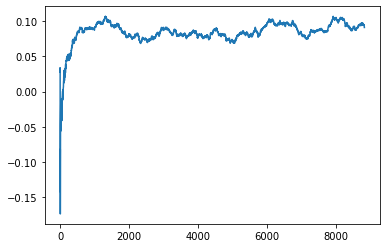

Thread: 6 iteration: 1480
RAM mDiffFit_147 FROM: 2816 --> 192 reward: 0.463437390625
Thread: 3 iteration: 1464
RAM mProject_27 FROM: 448 --> 768 reward: -1.0
Thread: 2 iteration: 1452
RAM mBgModel_2 FROM: 448 --> 1152 reward: -0.32920519484375
Saving ...


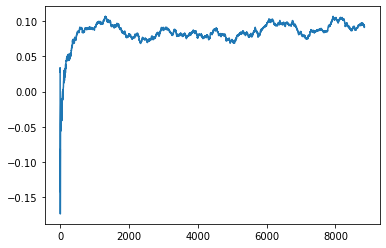

Thread: 4 iteration: 1480
RAM mProject_73 FROM: 2880 --> 1024 reward: 0.03847695967968738
Thread: 5 iteration: 1556
RAM mProject_81 FROM: 192 --> 768 reward: -1.0
Saving ...


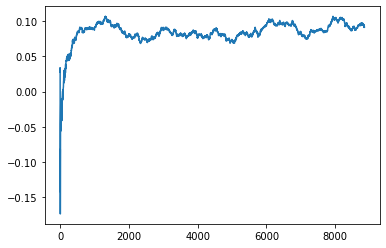

Thread: 1 iteration: 1410
RAM mDiffFit_83 FROM: 640 --> 192 reward: 0.0979687171875
Thread: 2 iteration: 1453
RAM mDiffFit_395 FROM: 1984 --> 192 reward: 0.29526298710937504
Thread: 3 iteration: 1465
RAM mDiffFit_95 FROM: 1216 --> 192 reward: 0.16434893828125002
Thread: 5 iteration: 1557
RAM mBackground_59 FROM: 3008 --> 192 reward: 0.6973298987968749
Thread: 4 iteration: 1481
RAM mProject_54 FROM: 1152 --> 1024 reward: 0.06231281414062496
Thread: 6 iteration: 1481
RAM mBackground_68 FROM: 384 --> 2304 reward: -0.30801425271875005
Thread: 5 iteration: 1558
RAM mDiffFit_98 FROM: 2240 --> 256 reward: 0.20656761171875
Thread: 3 iteration: 1466
RAM mDiffFit_239 FROM: 2624 --> 192 reward: 0.51616655
Thread: 1 iteration: 1411
RAM mDiffFit_110 FROM: 2176 --> 256 reward: 0.23502079687499997
Thread: 4 iteration: 1482
RAM mBackground_40 FROM: 1984 --> 192 reward: 0.7213025492968751
Thread: 2 iteration: 1454
RAM mDiffFit_121 FROM: 1728 --> 1920 reward: -0.02182814140625
Thread: 6 iteration: 1482


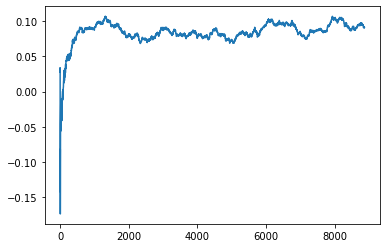

Thread: 5 iteration: 1560
RAM mDiffFit_32 FROM: 1152 --> 192 reward: 0.21134371718749995
Thread: 3 iteration: 1469
RAM mDiffFit_70 FROM: 896 --> 192 reward: 0.19090101796874998
Thread: 4 iteration: 1484
RAM mDiffFit_96 FROM: 576 --> 192 reward: 0.160898429296875
Thread: 5 iteration: 1561
RAM mProject_56 FROM: 1792 --> 256 reward: -1.0
Thread: 2 iteration: 1455
RAM mDiffFit_307 FROM: 384 --> 192 reward: 0.1557421902343749
Thread: 4 iteration: 1485
RAM mDiffFit_175 FROM: 1088 --> 320 reward: 0.3455520796875
Saving ...


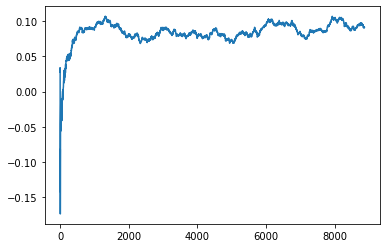

Thread: 3 iteration: 1470
RAM mBackground_20 FROM: 512 --> 320 reward: 0.27630635573437495
Thread: 5 iteration: 1562
RAM mProject_86 FROM: 2304 --> 256 reward: -1.0
Thread: 6 iteration: 1484
RAM mDiffFit_240 FROM: 2816 --> 320 reward: 0.11765356289062498
Thread: 4 iteration: 1486
RAM mDiffFit_345 FROM: 2304 --> 320 reward: 0.39980466835937506
Thread: 2 iteration: 1456
RAM mProject_34 FROM: 1472 --> 256 reward: -1.0
Thread: 1 iteration: 1414
RAM mDiffFit_396 FROM: 2048 --> 192 reward: 0.49078378398437505
Thread: 3 iteration: 1471
RAM mDiffFit_147 FROM: 832 --> 192 reward: 0.35371349609375
Thread: 5 iteration: 1563
RAM mDiffFit_110 FROM: 1984 --> 192 reward: 0.22132028789062502
Thread: 4 iteration: 1487
RAM mDiffFit_110 FROM: 640 --> 192 reward: 0.19560415937499998
Thread: 1 iteration: 1415
RAM mBackground_25 FROM: 2176 --> 192 reward: 0.6806383821953125
Thread: 6 iteration: 1485
RAM mBackground_3 FROM: 2944 --> 192 reward: 0.738475570828125
Thread: 2 iteration: 1457
RAM mDiffFit_118 FRO

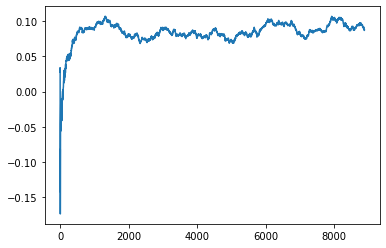

Thread: 4 iteration: 1490
RAM mDiffFit_408 FROM: 320 --> 192 reward: 0.07283331874999996
Thread: 2 iteration: 1459
RAM mProject_67 FROM: 512 --> 896 reward: 0.91663374515625
Thread: 3 iteration: 1472
RAM mDiffFit_223 FROM: 128 --> 320 reward: -0.570398473046875
Thread: 6 iteration: 1487
RAM mDiffFit_87 FROM: 2048 --> 192 reward: 0.15464316445312498
Thread: 4 iteration: 1491
RAM mViewer_1 FROM: 1920 --> 1408 reward: 0.04184470073437499
Saving ...


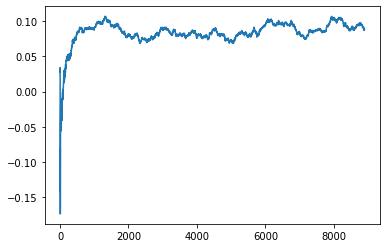

Thread: 2 iteration: 1460
RAM mDiffFit_311 FROM: 1088 --> 192 reward: 0.1594895578125
Thread: 3 iteration: 1473
RAM mProject_5 FROM: 1280 --> 1280 reward: 0.0016649999999999165
Thread: 1 iteration: 1417
RAM mDiffFit_367 FROM: 2880 --> 1984 reward: 0.05661723398437497
Thread: 2 iteration: 1461
RAM mDiffFit_379 FROM: 2816 --> 192 reward: 0.16700250117187504
Thread: 4 iteration: 1492
RAM mProject_12 FROM: 1216 --> 1280 reward: -0.006314049703125013
Thread: 5 iteration: 1566
RAM mDiffFit_174 FROM: 2944 --> 192 reward: 0.18332024414062498
Thread: 1 iteration: 1418
RAM mDiffFit_344 FROM: 1664 --> 384 reward: 0.11464579687499998
Thread: 4 iteration: 1493
RAM mAdd_3 FROM: 704 --> 704 reward: 0.11627220058593749
Thread: 6 iteration: 1488
RAM mDiffFit_346 FROM: 1024 --> 832 reward: -0.016289092578124983
Thread: 1 iteration: 1419
RAM mBackground_40 FROM: 768 --> 704 reward: 0.04660798521093747
Thread: 5 iteration: 1567
RAM mBackground_63 FROM: 1600 --> 1408 reward: 0.01754042293749999
Thread: 6 i

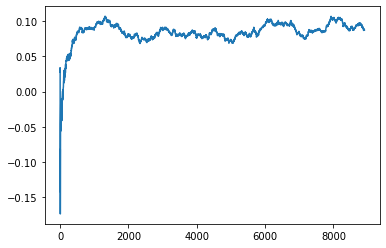

Thread: 1 iteration: 1420
RAM mDiffFit_247 FROM: 2304 --> 192 reward: 0.20219524414062495
Thread: 4 iteration: 1495
RAM mProject_44 FROM: 2880 --> 320 reward: -1.0
Thread: 3 iteration: 1474
RAM mBackground_20 FROM: 2304 --> 1408 reward: 0.24969137001562497
Thread: 5 iteration: 1569
RAM mProject_25 FROM: 1920 --> 256 reward: -1.0
Thread: 2 iteration: 1462
RAM mDiffFit_385 FROM: 128 --> 320 reward: -0.661601614453125
Thread: 1 iteration: 1421
RAM mDiffFit_237 FROM: 576 --> 192 reward: 0.09911714648437497
Thread: 3 iteration: 1475
RAM mProject_78 FROM: 768 --> 2944 reward: 0.8129400813281251
Saving ...


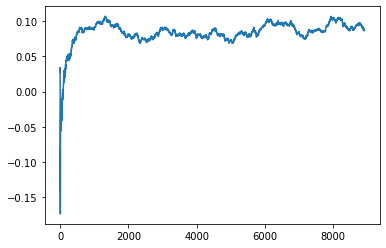

Thread: 6 iteration: 1490
RAM mDiffFit_9 FROM: 2496 --> 1920 reward: -0.01840628281250001
Thread: 2 iteration: 1463
RAM mBackground_69 FROM: 2496 --> 1408 reward: -0.005930498187500005
Thread: 6 iteration: 1491
RAM mDiffFit_204 FROM: 1152 --> 192 reward: 0.19928123906249998
Thread: 1 iteration: 1422
RAM mDiffFit_124 FROM: 512 --> 192 reward: 0.15470831875000002
Thread: 3 iteration: 1476
RAM mBackground_61 FROM: 384 --> 2944 reward: -0.2751550233437499
Thread: 2 iteration: 1464
RAM mDiffFit_68 FROM: 256 --> 832 reward: -0.12361977890625003
Thread: 3 iteration: 1477
RAM mBackground_60 FROM: 2880 --> 1408 reward: -0.028801170218750033
Thread: 6 iteration: 1492
RAM mDiffFit_157 FROM: 2304 --> 320 reward: 0.09740097421874999
Thread: 2 iteration: 1465
RAM mProject_80 FROM: 1280 --> 2752 reward: 0.05191300357031231
Saving ...


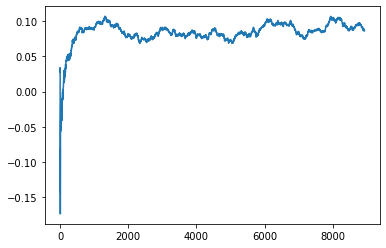

Thread: 5 iteration: 1570
RAM mProject_1 FROM: 832 --> 256 reward: -1.0
Thread: 4 iteration: 1496
RAM mDiffFit_401 FROM: 1856 --> 320 reward: 0.10916141640624999
Thread: 3 iteration: 1478
RAM mProject_37 FROM: 448 --> 2944 reward: 0.823344471421875
Thread: 1 iteration: 1423
RAM mDiffFit_335 FROM: 2816 --> 320 reward: 0.35960679179687505
Thread: 2 iteration: 1466
RAM mDiffFit_193 FROM: 2048 --> 320 reward: 0.377638074609375
Thread: 6 iteration: 1493
RAM mBackground_23 FROM: 256 --> 2944 reward: -0.40205871690625
Thread: 5 iteration: 1571
RAM mDiffFit_351 FROM: 2240 --> 192 reward: 0.15741659374999997
Thread: 4 iteration: 1497
RAM mDiffFit_294 FROM: 1280 --> 192 reward: 0.15727597421875003
Thread: 3 iteration: 1479
RAM mDiffFit_343 FROM: 2496 --> 192 reward: 0.20867185859374998
Thread: 1 iteration: 1424
RAM mDiffFit_204 FROM: 2752 --> 192 reward: 0.236398385546875
Thread: 6 iteration: 1494
RAM mDiffFit_209 FROM: 1728 --> 192 reward: 0.156632766015625
Thread: 4 iteration: 1498
RAM mDiffFi

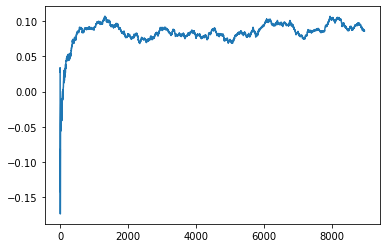

Thread: 3 iteration: 1480
RAM mDiffFit_381 FROM: 2880 --> 192 reward: 0.11749978125000002
Thread: 5 iteration: 1574
RAM mAdd_2 FROM: 1344 --> 2304 reward: -0.007781107812500007
Saving ...


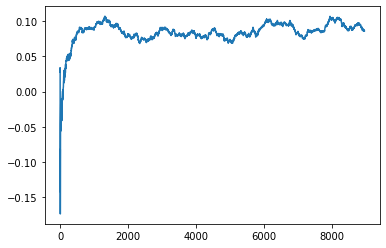

Thread: 4 iteration: 1500
RAM mDiffFit_80 FROM: 2688 --> 192 reward: 0.12488267851562501
Thread: 2 iteration: 1468
RAM mProject_18 FROM: 384 --> 2944 reward: 0.817816026375
Thread: 1 iteration: 1426
RAM mDiffFit_286 FROM: 2432 --> 192 reward: 0.260768164453125
Thread: 5 iteration: 1575
RAM mDiffFit_187 FROM: 2944 --> 192 reward: 0.167710863671875
Thread: 2 iteration: 1469
RAM mDiffFit_411 FROM: 3008 --> 192 reward: 0.4340649355468751
Thread: 3 iteration: 1481
RAM mDiffFit_377 FROM: 1408 --> 192 reward: 0.2760260179687499
Thread: 4 iteration: 1501
RAM mProject_16 FROM: 640 --> 2944 reward: 0.8050491362812501
Thread: 6 iteration: 1496
RAM mBackground_22 FROM: 320 --> 2944 reward: -0.29349718732812496
Saving ...


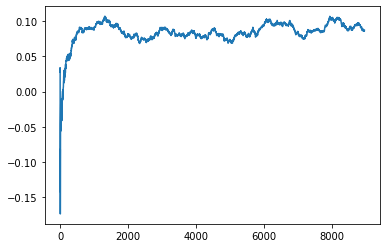

Thread: 2 iteration: 1470
RAM mDiffFit_380 FROM: 1984 --> 192 reward: 0.177458275
Thread: 4 iteration: 1502
RAM mDiffFit_313 FROM: 256 --> 192 reward: -0.06846880468749997
Thread: 5 iteration: 1576
RAM mDiffFit_323 FROM: 2624 --> 192 reward: 0.55065093046875
Thread: 3 iteration: 1482
RAM mDiffFit_260 FROM: 2368 --> 192 reward: 0.1284061078125
Thread: 6 iteration: 1497
RAM mDiffFit_240 FROM: 128 --> 192 reward: -0.35916409257812504
Thread: 2 iteration: 1471
RAM mBgModel_1 FROM: 2432 --> 1152 reward: 0.03195614281249998
Thread: 4 iteration: 1503
RAM mDiffFit_151 FROM: 2752 --> 768 reward: 0.09636455781250003
Thread: 2 iteration: 1472
RAM mDiffFit_102 FROM: 576 --> 192 reward: 0.491117190234375
Thread: 6 iteration: 1498
RAM mBackground_84 FROM: 768 --> 192 reward: 0.6194149623749999
Thread: 3 iteration: 1483
RAM mDiffFit_112 FROM: 2560 --> 768 reward: 0.04906247812500002
Thread: 4 iteration: 1504
RAM mDiffFit_235 FROM: 1472 --> 768 reward: -0.045171946093750005
Thread: 2 iteration: 1473
R

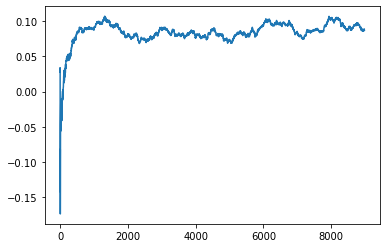

Thread: 6 iteration: 1500
RAM mDiffFit_385 FROM: 256 --> 256 reward: -0.03452084062499996
Saving ...


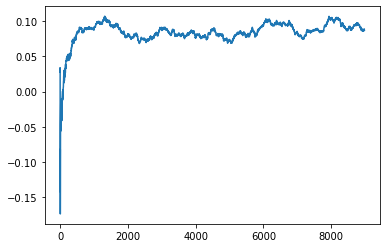

Thread: 5 iteration: 1580
RAM mDiffFit_395 FROM: 2048 --> 1920 reward: -0.11622929062500001
Thread: 5 iteration: 1581
RAM mDiffFit_282 FROM: 384 --> 320 reward: 0.10107814140624997
Thread: 2 iteration: 1477
RAM mProject_14 FROM: 384 --> 2944 reward: 0.8185360263749999
Thread: 3 iteration: 1486
RAM mDiffFit_297 FROM: 2432 --> 1920 reward: -0.03563026484375001
Thread: 5 iteration: 1582
RAM mDiffFit_417 FROM: 384 --> 1920 reward: -0.08993747812500001
Thread: 2 iteration: 1478
RAM mDiffFit_66 FROM: 960 --> 1920 reward: -0.002828097656250002
Thread: 3 iteration: 1487
RAM mDiffFit_380 FROM: 2368 --> 1920 reward: -0.09903137031249998
Thread: 2 iteration: 1479
RAM mDiffFit_89 FROM: 960 --> 1920 reward: -0.033039048828125014
Thread: 3 iteration: 1488
RAM mBackground_34 FROM: 1088 --> 704 reward: -0.003661791648437444
Thread: 5 iteration: 1583
RAM mProject_19 FROM: 1792 --> 256 reward: -1.0
Thread: 4 iteration: 1506
RAM mProject_79 FROM: 2304 --> 256 reward: -1.0
Thread: 1 iteration: 1429
RAM mD

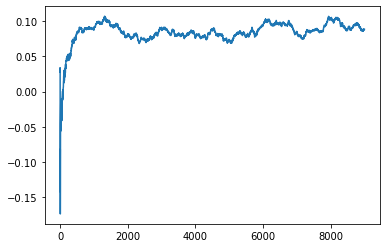

Thread: 1 iteration: 1430
RAM mBackground_72 FROM: 1344 --> 192 reward: 0.755200932796875
Saving ...


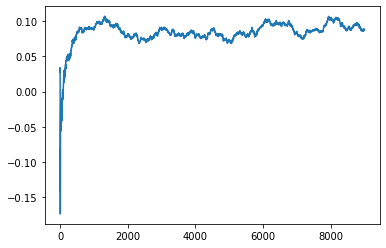

Thread: 2 iteration: 1480
RAM mProject_24 FROM: 2240 --> 256 reward: -1.0
Thread: 6 iteration: 1501
RAM mDiffFit_26 FROM: 256 --> 1920 reward: -0.13107809765625003
Thread: 1 iteration: 1431
RAM mBackground_28 FROM: 448 --> 192 reward: 0.5349759950703123
Thread: 3 iteration: 1489
RAM mDiffFit_30 FROM: 1600 --> 1920 reward: -0.11447665820312503
Thread: 5 iteration: 1585
RAM mProject_32 FROM: 2496 --> 2112 reward: -0.07097217053906249
Thread: 4 iteration: 1507
RAM mDiffFit_220 FROM: 128 --> 1920 reward: -0.7911042031249998
Thread: 6 iteration: 1502
RAM mDiffFit_103 FROM: 2880 --> 192 reward: 0.22154681484374994
Thread: 1 iteration: 1432
RAM mDiffFit_335 FROM: 448 --> 192 reward: 0.171617190234375
Saving ...


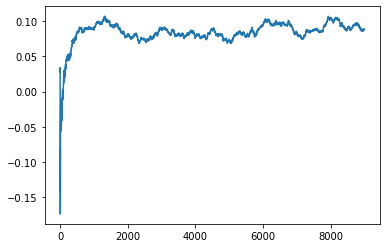

Thread: 3 iteration: 1490
RAM mDiffFit_147 FROM: 2304 --> 1920 reward: -0.051812565625
Thread: 5 iteration: 1586
RAM mDiffFit_20 FROM: 768 --> 1920 reward: -0.16598442421874998
Thread: 4 iteration: 1508
RAM mDiffFit_286 FROM: 640 --> 640 reward: 0.1734480078125
Thread: 6 iteration: 1503
RAM mDiffFit_399 FROM: 2496 --> 640 reward: 0.13229949101562502
Thread: 5 iteration: 1587
RAM mDiffFit_71 FROM: 320 --> 640 reward: -0.150981748046875
Thread: 1 iteration: 1433
RAM mDiffFit_192 FROM: 704 --> 320 reward: 0.1121979203125
Thread: 4 iteration: 1509
RAM mDiffFit_75 FROM: 2624 --> 320 reward: 0.12474995624999999
Thread: 6 iteration: 1504
RAM mBackground_80 FROM: 896 --> 192 reward: 0.6432911689140625
Thread: 3 iteration: 1491
RAM mDiffFit_181 FROM: 1472 --> 832 reward: -0.007554712109375007
Thread: 1 iteration: 1434
RAM mDiffFit_223 FROM: 640 --> 832 reward: -0.006479159374999984
Thread: 6 iteration: 1505
RAM mProject_67 FROM: 1152 --> 384 reward: -1.0
Thread: 2 iteration: 1481
RAM mDiffFit_2

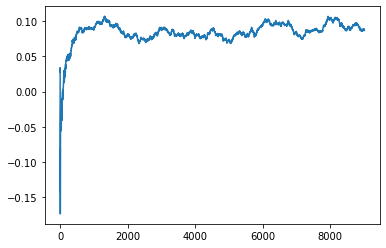

Thread: 4 iteration: 1510
RAM mDiffFit_143 FROM: 960 --> 832 reward: 0.044768251953125004
Thread: 6 iteration: 1506
RAM mBackground_53 FROM: 2688 --> 704 reward: 0.07409198883593748
Thread: 2 iteration: 1482
RAM mDiffFit_269 FROM: 2432 --> 832 reward: -0.03063552968750001
Thread: 6 iteration: 1507
RAM mDiffFit_24 FROM: 1472 --> 832 reward: 0.013437478124999989
Thread: 2 iteration: 1483
RAM mProject_8 FROM: 2240 --> 1280 reward: 0.03874671421874998
Thread: 5 iteration: 1588
RAM mBackground_67 FROM: 384 --> 704 reward: -0.18890436559375004
Thread: 6 iteration: 1508
RAM mDiffFit_397 FROM: 2496 --> 1984 reward: 0.042442742968750016
Thread: 2 iteration: 1484
RAM mProject_40 FROM: 2368 --> 2112 reward: -0.047791500257812515
Thread: 4 iteration: 1511
RAM mDiffFit_289 FROM: 1792 --> 1984 reward: 0.006468760937499984
Thread: 6 iteration: 1509
RAM mDiffFit_355 FROM: 1728 --> 1984 reward: 0.008083362499999996
Thread: 4 iteration: 1512
RAM mViewer_1 FROM: 2624 --> 1408 reward: -0.01546195921875004

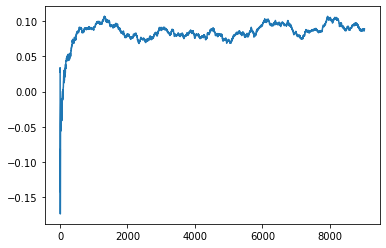

Thread: 6 iteration: 1510
RAM mProject_46 FROM: 1472 --> 2112 reward: 0.039786728203124955
Thread: 5 iteration: 1589
RAM mProject_85 FROM: 192 --> 896 reward: 0.939455323734375
Thread: 1 iteration: 1435
RAM mDiffFit_364 FROM: 3008 --> 192 reward: 0.217309758203125
Thread: 4 iteration: 1513
RAM mDiffFit_261 FROM: 1792 --> 192 reward: 0.28626812070312496
Thread: 2 iteration: 1486
RAM mDiffFit_182 FROM: 3008 --> 192 reward: 0.68104690234375
Thread: 3 iteration: 1493
RAM mDiffFit_24 FROM: 960 --> 256 reward: -0.00010165820312497964
Thread: 4 iteration: 1514
RAM mDiffFit_104 FROM: 2560 --> 192 reward: 0.399289048828125
Saving ...


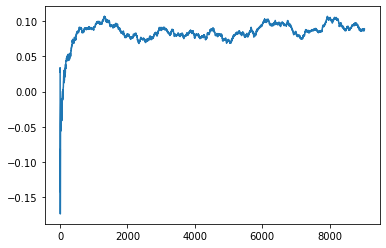

Thread: 5 iteration: 1590
RAM mDiffFit_3 FROM: 1408 --> 256 reward: 0.29216146015625
Thread: 3 iteration: 1494
RAM mBackground_50 FROM: 2880 --> 320 reward: 0.3001733938671875
Thread: 1 iteration: 1436
RAM mDiffFit_362 FROM: 512 --> 256 reward: 0.12204163750000008
Thread: 6 iteration: 1511
RAM mBackground_9 FROM: 2048 --> 320 reward: 0.4929076115703125
Thread: 2 iteration: 1487
RAM mDiffFit_407 FROM: 320 --> 256 reward: 0.13184898203125
Thread: 4 iteration: 1515
RAM mDiffFit_95 FROM: 2496 --> 256 reward: 0.205960907421875
Thread: 5 iteration: 1591
RAM mDiffFit_143 FROM: 2496 --> 256 reward: 0.16261714648437503
Thread: 3 iteration: 1495
RAM mDiffFit_135 FROM: 1792 --> 256 reward: 0.1460103984375
Thread: 2 iteration: 1488
RAM mBackground_30 FROM: 704 --> 320 reward: 0.23637902957812496
Thread: 6 iteration: 1512
RAM mDiffFit_281 FROM: 512 --> 256 reward: 0.027447876562499973
Thread: 5 iteration: 1592
RAM mDiffFit_387 FROM: 640 --> 192 reward: 0.28774741132812504
Thread: 3 iteration: 1496


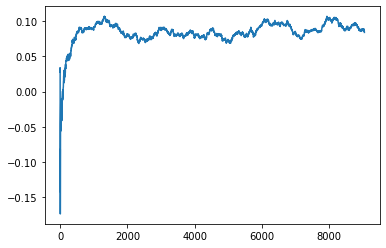

Thread: 2 iteration: 1490
RAM mDiffFit_193 FROM: 1472 --> 256 reward: 0.160101526953125
Thread: 2 iteration: 1491
RAM mProject_65 FROM: 640 --> 320 reward: -1.0
Thread: 1 iteration: 1437
RAM mConcatFit_2 FROM: 1472 --> 1024 reward: 0.03650831874999996
Thread: 1 iteration: 1438
RAM mDiffFit_107 FROM: 832 --> 192 reward: 0.203773429296875
Thread: 2 iteration: 1492
RAM mProject_41 FROM: 128 --> 320 reward: -1.0
Thread: 4 iteration: 1516
RAM mDiffFit_16 FROM: 192 --> 256 reward: -0.15694533164062496
Thread: 1 iteration: 1439
RAM mDiffFit_197 FROM: 1408 --> 256 reward: 0.1526353984375
Thread: 2 iteration: 1493
RAM mDiffFit_289 FROM: 1088 --> 256 reward: 0.13107809765624998
Thread: 4 iteration: 1517
RAM mProject_74 FROM: 384 --> 320 reward: -1.0
Thread: 5 iteration: 1593
RAM mDiffFit_307 FROM: 2368 --> 192 reward: 0.09629935976562502
Saving ...


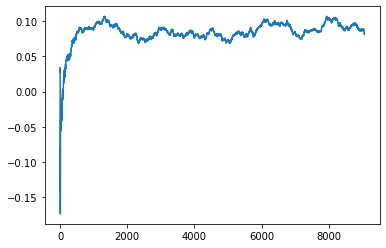

Thread: 1 iteration: 1440
RAM mProject_34 FROM: 192 --> 320 reward: -1.0
Thread: 6 iteration: 1514
RAM mDiffFit_362 FROM: 192 --> 256 reward: -0.14679168125000003
Thread: 2 iteration: 1494
RAM mDiffFit_23 FROM: 576 --> 256 reward: 0.11853904882812502
Thread: 4 iteration: 1518
RAM mDiffFit_353 FROM: 2624 --> 192 reward: 0.19315619531249997
Thread: 5 iteration: 1594
RAM mProject_84 FROM: 320 --> 320 reward: -1.0
Thread: 3 iteration: 1498
RAM mDiffFit_378 FROM: 2368 --> 256 reward: 0.13608068632812503
Thread: 1 iteration: 1441
RAM mConcatFit_2 FROM: 960 --> 704 reward: 0.05595415937499998
Thread: 6 iteration: 1515
RAM mDiffFit_394 FROM: 2176 --> 192 reward: 0.08727593046875001
Thread: 5 iteration: 1595
RAM mDiffFit_384 FROM: 448 --> 192 reward: 0.004174403515624994
Thread: 4 iteration: 1519
RAM mDiffFit_277 FROM: 2816 --> 192 reward: 0.15523420546875
Thread: 3 iteration: 1499
RAM mDiffFit_90 FROM: 2176 --> 384 reward: -0.5549175125
Thread: 1 iteration: 1442
RAM mDiffFit_51 FROM: 2048 --> 

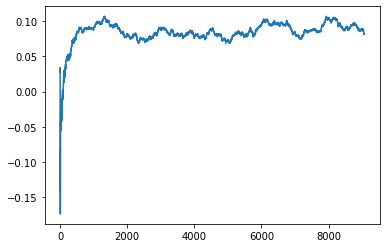

Thread: 4 iteration: 1520
RAM mDiffFit_121 FROM: 3008 --> 192 reward: 0.12180716953125001
Saving ...


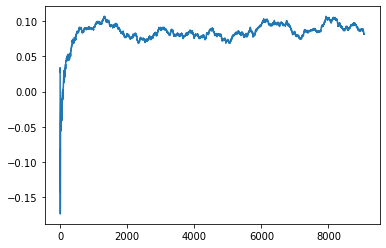

Thread: 3 iteration: 1500
RAM mDiffFit_159 FROM: 2624 --> 192 reward: 0.21089838554687504
Thread: 1 iteration: 1443
RAM mDiffFit_263 FROM: 1536 --> 192 reward: 0.21762495624999995
Thread: 6 iteration: 1517
RAM mDiffFit_158 FROM: 2112 --> 192 reward: 0.18098433671875
Thread: 3 iteration: 1501
RAM mViewer_4 FROM: 2688 --> 2560 reward: 0.04390378368750006
Thread: 4 iteration: 1521
RAM mProject_33 FROM: 640 --> 2944 reward: 0.812985081328125
Thread: 5 iteration: 1596
RAM mProject_59 FROM: 2688 --> 256 reward: -1.0
Thread: 2 iteration: 1495
RAM mBackground_7 FROM: 1280 --> 1792 reward: -0.17007405553125002
Thread: 4 iteration: 1522
RAM mDiffFit_413 FROM: 1984 --> 192 reward: 0.25992185859375005
Thread: 6 iteration: 1518
RAM mDiffFit_202 FROM: 1664 --> 384 reward: 0.11164579687500002
Thread: 2 iteration: 1496
RAM mBackground_53 FROM: 1984 --> 320 reward: -0.47388791909374994
Thread: 5 iteration: 1597
RAM mBackground_32 FROM: 2176 --> 320 reward: 0.36772376750781244
Thread: 3 iteration: 1502


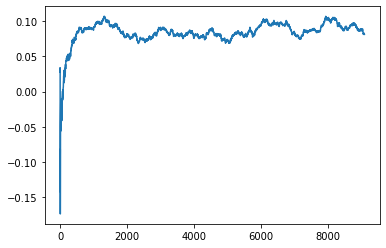

Thread: 6 iteration: 1520
RAM mDiffFit_216 FROM: 1728 --> 320 reward: 0.14614320820312496
Thread: 3 iteration: 1504
RAM mDiffFit_399 FROM: 1280 --> 320 reward: 0.07198429296875003
Saving ...


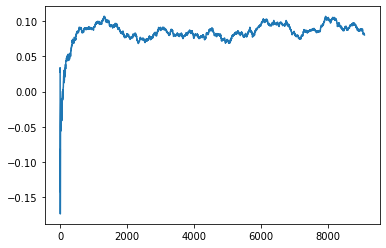

Thread: 5 iteration: 1600
RAM mDiffFit_30 FROM: 2112 --> 320 reward: 0.08687750117187501
Thread: 6 iteration: 1521
RAM mDiffFit_2 FROM: 2688 --> 320 reward: 0.25543216953125
Thread: 2 iteration: 1499
RAM mDiffFit_236 FROM: 2880 --> 320 reward: 0.14243484570312498
Thread: 3 iteration: 1505
RAM mImgtbl_2 FROM: 512 --> 192 reward: -1.0
Thread: 1 iteration: 1444
RAM mDiffFit_371 FROM: 704 --> 192 reward: 0.056270753125
Thread: 3 iteration: 1506
RAM mDiffFit_34 FROM: 2816 --> 320 reward: 0.262950421484375
Thread: 6 iteration: 1522
RAM mImgtbl_2 FROM: 640 --> 192 reward: -1.0
Thread: 4 iteration: 1524
RAM mDiffFit_107 FROM: 2688 --> 192 reward: 0.17804681484374998
Thread: 6 iteration: 1523
RAM mBackground_25 FROM: 960 --> 192 reward: 1.0328197392343752
Thread: 1 iteration: 1445
RAM mDiffFit_276 FROM: 576 --> 192 reward: 0.68398451171875
Thread: 3 iteration: 1507
RAM mDiffFit_318 FROM: 896 --> 192 reward: 0.6079036941406251
Thread: 4 iteration: 1525
RAM mBackground_86 FROM: 1088 --> 320 rewar

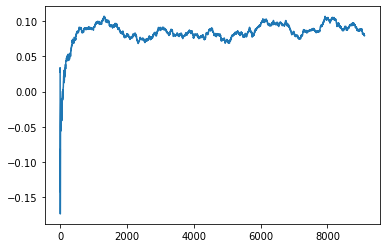

Thread: 2 iteration: 1500
RAM mDiffFit_20 FROM: 896 --> 192 reward: 0.49019011054687506
Thread: 1 iteration: 1447
RAM mDiffFit_339 FROM: 2560 --> 256 reward: 0.27483331875000006
Thread: 5 iteration: 1602
RAM mBackground_23 FROM: 2432 --> 192 reward: 0.7364532576484375
Thread: 4 iteration: 1527
RAM mBackground_83 FROM: 256 --> 320 reward: -0.16731256227343744
Thread: 2 iteration: 1501
RAM mProject_34 FROM: 320 --> 2944 reward: 0.8239294714218748
Thread: 3 iteration: 1509
RAM mDiffFit_274 FROM: 1024 --> 256 reward: 0.17217707968749998
Thread: 4 iteration: 1528
RAM mProject_41 FROM: 1472 --> 1024 reward: 0.17046563090624997
Thread: 6 iteration: 1525
RAM mDiffFit_4 FROM: 2816 --> 256 reward: 0.123562434375
Saving ...


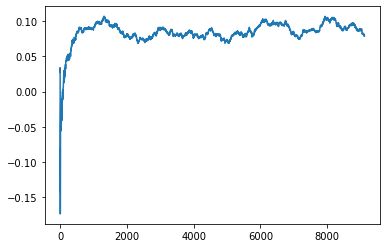

Thread: 3 iteration: 1510
RAM mBackground_13 FROM: 896 --> 704 reward: 0.08426434094531242
Thread: 2 iteration: 1502
RAM mDiffFit_114 FROM: 1984 --> 192 reward: 0.267153606640625
Thread: 4 iteration: 1529
RAM mDiffFit_375 FROM: 2496 --> 256 reward: 0.32141137265624997
Thread: 6 iteration: 1526
RAM mBgModel_1 FROM: 1024 --> 320 reward: 0.6253500175
Thread: 5 iteration: 1603
RAM mDiffFit_351 FROM: 384 --> 256 reward: 0.02017185859375003
Saving ...


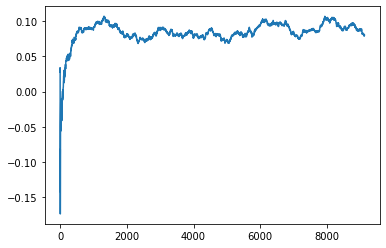

Thread: 4 iteration: 1530
RAM mDiffFit_221 FROM: 2048 --> 256 reward: 0.1910103984375
Thread: 5 iteration: 1604
RAM mProject_47 FROM: 2688 --> 256 reward: -1.0
Thread: 1 iteration: 1448
RAM mDiffFit_144 FROM: 512 --> 256 reward: 0.38695840625000005
Thread: 4 iteration: 1531
RAM mBackground_4 FROM: 2304 --> 2048 reward: 0.029723768812500044
Thread: 5 iteration: 1605
RAM mBackground_11 FROM: 384 --> 704 reward: -0.21566963933593755
Thread: 5 iteration: 1606
RAM mProject_36 FROM: 2560 --> 1280 reward: -0.01019651906250023
Thread: 6 iteration: 1527
RAM mDiffFit_8 FROM: 256 --> 832 reward: -0.073596305859375
Thread: 5 iteration: 1607
RAM mDiffFit_277 FROM: 256 --> 1088 reward: -0.19919269921875005
Thread: 6 iteration: 1528
RAM mDiffFit_302 FROM: 640 --> 832 reward: -0.03178123906249993
Thread: 5 iteration: 1608
RAM mDiffFit_260 FROM: 320 --> 256 reward: -0.07947139335937495
Thread: 6 iteration: 1529
RAM mProject_4 FROM: 1600 --> 1280 reward: 0.09654704191406242
Thread: 4 iteration: 1532
RAM

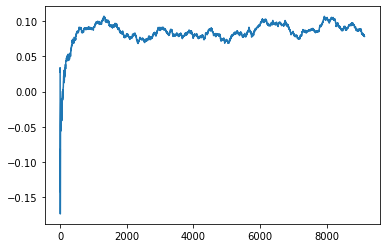

Thread: 6 iteration: 1530
RAM mDiffFit_310 FROM: 320 --> 256 reward: -0.005835951171874985
Thread: 5 iteration: 1609
RAM mProject_65 FROM: 832 --> 896 reward: 0.9234531247500002
Thread: 1 iteration: 1449
RAM mBackground_69 FROM: 512 --> 704 reward: -0.04734924104687499
Thread: 4 iteration: 1533
RAM mProject_5 FROM: 2432 --> 256 reward: -1.0
Thread: 2 iteration: 1503
RAM mDiffFit_2 FROM: 2432 --> 320 reward: 0.24202851914062495
Thread: 6 iteration: 1531
RAM mDiffFit_419 FROM: 1856 --> 320 reward: 0.160809889453125
Thread: 2 iteration: 1504
RAM mDiffFit_368 FROM: 256 --> 1088 reward: -0.254210951171875
Saving ...


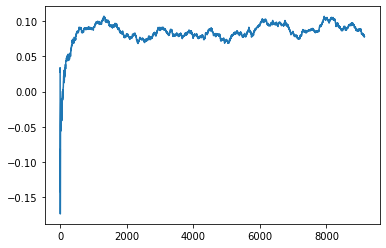

Thread: 5 iteration: 1610
RAM mProject_2 FROM: 192 --> 896 reward: 0.9374743839374998
Thread: 3 iteration: 1511
RAM mBackground_87 FROM: 3008 --> 320 reward: 0.27057501036718756
Thread: 4 iteration: 1534
RAM mDiffFit_364 FROM: 576 --> 320 reward: 0.025093717187500003
Thread: 2 iteration: 1505
RAM mProject_41 FROM: 2048 --> 1280 reward: 0.07110177721875012
Saving ...


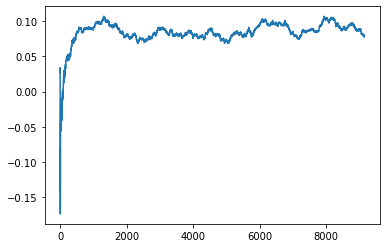

Thread: 1 iteration: 1450
RAM mDiffFit_16 FROM: 640 --> 256 reward: 0.11838017734375
Thread: 5 iteration: 1611
RAM mDiffFit_144 FROM: 2624 --> 320 reward: 0.08278637265624998
Thread: 3 iteration: 1512
RAM mDiffFit_50 FROM: 1856 --> 320 reward: 0.24831765546875
Thread: 2 iteration: 1506
RAM mDiffFit_349 FROM: 2752 --> 1920 reward: -0.10306265312499999
Thread: 3 iteration: 1513
RAM mDiffFit_18 FROM: 1728 --> 320 reward: 0.14139061953124998
Thread: 1 iteration: 1451
RAM mDiffFit_373 FROM: 2176 --> 320 reward: 0.058210819921874976
Thread: 5 iteration: 1612
RAM mProject_2 FROM: 2048 --> 1280 reward: 0.07782553378125015
Thread: 6 iteration: 1532
RAM mBackground_32 FROM: 2752 --> 320 reward: 0.400880782296875
Thread: 2 iteration: 1507
RAM mProject_1 FROM: 1792 --> 1280 reward: 0.12912750787499996
Thread: 4 iteration: 1535
RAM mDiffFit_120 FROM: 1216 --> 1920 reward: 0.0209271234375
Thread: 5 iteration: 1613
RAM mDiffFit_44 FROM: 896 --> 832 reward: 0.01685938046875
Thread: 6 iteration: 1533
R

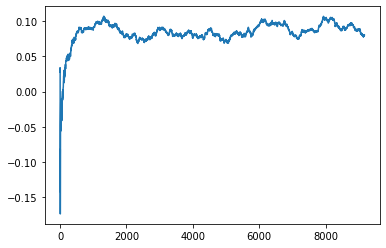

Thread: 2 iteration: 1510
RAM mDiffFit_287 FROM: 2240 --> 832 reward: 0.0026197351562499797
Thread: 3 iteration: 1515
RAM mDiffFit_222 FROM: 512 --> 256 reward: -0.015395884374999995
Thread: 1 iteration: 1454
RAM mDiffFit_26 FROM: 320 --> 256 reward: -0.01627606171875004
Thread: 5 iteration: 1616
RAM mBackground_34 FROM: 1472 --> 192 reward: 0.8506653853124999
Thread: 6 iteration: 1535
RAM mDiffFit_392 FROM: 1792 --> 832 reward: -0.021380264843750014
Thread: 1 iteration: 1455
RAM mDiffFit_242 FROM: 1344 --> 256 reward: 0.13101298710937498
Thread: 2 iteration: 1511
RAM mDiffFit_383 FROM: 2560 --> 256 reward: 0.12765619531250003
Thread: 5 iteration: 1617
RAM mDiffFit_374 FROM: 3008 --> 256 reward: 0.13015878398437503
Thread: 6 iteration: 1536
RAM mBackground_90 FROM: 2048 --> 192 reward: 0.7739461559374999
Thread: 3 iteration: 1516
RAM mDiffFit_143 FROM: 1216 --> 256 reward: 0.15719011054687498
Thread: 1 iteration: 1456
RAM mDiffFit_209 FROM: 1088 --> 256 reward: 0.10343225703125
Thread:

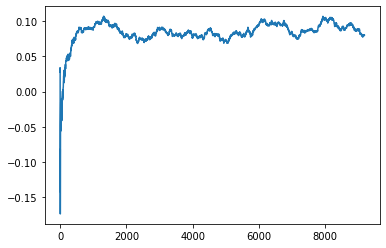

Thread: 5 iteration: 1620
RAM mDiffFit_414 FROM: 384 --> 192 reward: 0.12074999999999995
Thread: 3 iteration: 1519
RAM mDiffFit_84 FROM: 320 --> 192 reward: 0.38113026484375007
Thread: 6 iteration: 1538
RAM mProject_12 FROM: 2176 --> 2240 reward: 0.03264004462500009
Thread: 4 iteration: 1538
RAM mDiffFit_273 FROM: 2368 --> 192 reward: 0.21861714648437502
Thread: 5 iteration: 1621
RAM mBackground_16 FROM: 320 --> 320 reward: 0.09544211468750008
Thread: 1 iteration: 1459
RAM mBackground_39 FROM: 640 --> 192 reward: 0.6560904229375
Thread: 2 iteration: 1514
RAM mBackground_18 FROM: 3008 --> 192 reward: 0.570443977671875
Saving ...


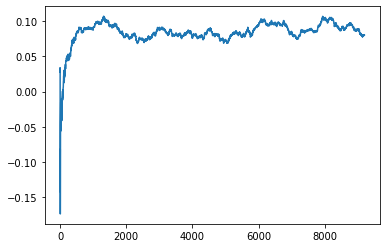

Thread: 3 iteration: 1520
RAM mBackground_60 FROM: 640 --> 192 reward: 0.5405838803828125
Thread: 6 iteration: 1539
RAM mDiffFit_257 FROM: 1472 --> 192 reward: 0.25137499999999996
Saving ...


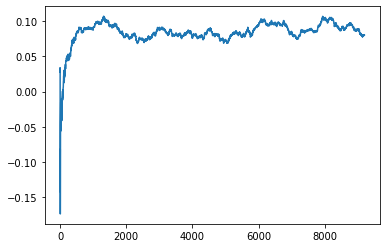

Thread: 1 iteration: 1460
RAM mDiffFit_208 FROM: 320 --> 192 reward: 0.12053123906250002
Thread: 4 iteration: 1539
RAM mBgModel_3 FROM: 1984 --> 1152 reward: 0.07839892953125
Thread: 5 iteration: 1622
RAM mDiffFit_284 FROM: 2624 --> 192 reward: 0.249299403515625
Thread: 2 iteration: 1515
RAM mDiffFit_22 FROM: 2048 --> 192 reward: 0.10260143945312497
Saving ...


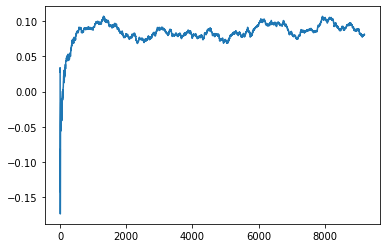

Thread: 4 iteration: 1540
RAM mDiffFit_225 FROM: 1408 --> 192 reward: 0.25149995625
Thread: 1 iteration: 1461
RAM mDiffFit_381 FROM: 1536 --> 192 reward: 0.24006247812499995
Thread: 5 iteration: 1623
RAM mImgtbl_1 FROM: 1280 --> 704 reward: 0.06898739937499987
Saving ...


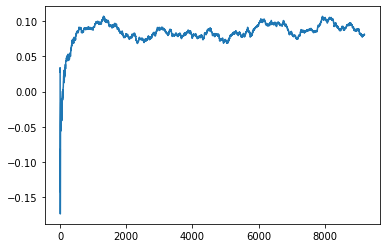

Thread: 6 iteration: 1540
RAM mDiffFit_391 FROM: 320 --> 192 reward: 0.16338017734375002
Thread: 3 iteration: 1521
RAM mDiffFit_68 FROM: 384 --> 192 reward: -0.067898516796875
Thread: 2 iteration: 1516
RAM mDiffFit_341 FROM: 2688 --> 768 reward: -0.007781326562499996
Thread: 5 iteration: 1624
RAM mDiffFit_250 FROM: 704 --> 384 reward: 0.05245831874999999
Thread: 1 iteration: 1462
RAM mDiffFit_378 FROM: 2304 --> 1984 reward: 0.045640663281249966
Thread: 3 iteration: 1522
RAM mDiffFit_370 FROM: 1088 --> 192 reward: 0.08312491249999998
Thread: 2 iteration: 1517
RAM mDiffFit_195 FROM: 2752 --> 320 reward: 0.14653378398437503
Thread: 5 iteration: 1625
RAM mDiffFit_410 FROM: 2816 --> 320 reward: 0.12303374023437501
Thread: 1 iteration: 1463
RAM mDiffFit_314 FROM: 1728 --> 320 reward: 0.19810415937500003
Thread: 2 iteration: 1518
RAM mBackground_26 FROM: 2304 --> 192 reward: 0.70947298390625
Thread: 3 iteration: 1523
RAM mDiffFit_109 FROM: 1024 --> 320 reward: 0.146513030859375
Thread: 5 iter

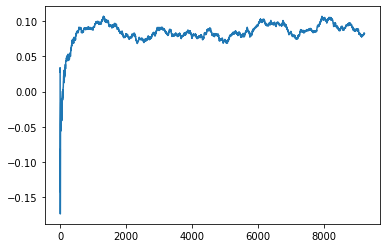

Thread: 2 iteration: 1520
RAM mDiffFit_115 FROM: 640 --> 384 reward: 0.010473938281250015
Thread: 6 iteration: 1542
RAM mDiffFit_174 FROM: 1856 --> 320 reward: 0.07547911562499998
Thread: 4 iteration: 1542
RAM mDiffFit_162 FROM: 2176 --> 320 reward: 0.09667181484374998
Thread: 1 iteration: 1465
RAM mBackground_58 FROM: 2496 --> 192 reward: 0.707457387125
Thread: 3 iteration: 1524
RAM mDiffFit_383 FROM: 2432 --> 320 reward: 0.04428374023437497
Thread: 5 iteration: 1628
RAM mDiffFit_162 FROM: 2112 --> 320 reward: 0.10827338554687502
Thread: 2 iteration: 1521
RAM mDiffFit_36 FROM: 832 --> 384 reward: 0.08894011054687499
Thread: 4 iteration: 1543
RAM mDiffFit_400 FROM: 1216 --> 320 reward: 0.076424447265625
Thread: 1 iteration: 1466
RAM mDiffFit_158 FROM: 2624 --> 256 reward: 0.10121608476562499
Thread: 3 iteration: 1525
RAM mDiffFit_311 FROM: 2432 --> 320 reward: 0.104408783984375
Thread: 2 iteration: 1522
RAM mDiffFit_330 FROM: 1344 --> 320 reward: 0.11903646015625002
Thread: 4 iteration

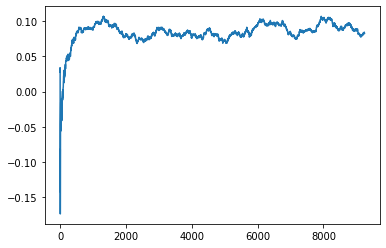

Thread: 5 iteration: 1630
RAM mDiffFit_331 FROM: 1920 --> 192 reward: 0.22874995625
Saving ...


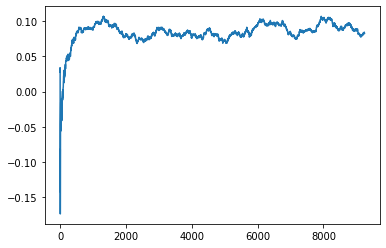

Thread: 1 iteration: 1470
RAM mDiffFit_306 FROM: 1216 --> 192 reward: 0.20490882773437502
Thread: 5 iteration: 1631
RAM mDiffFit_168 FROM: 2944 --> 192 reward: 0.20533323125000003
Thread: 1 iteration: 1471
RAM mDiffFit_170 FROM: 128 --> 192 reward: -0.81523446796875
Thread: 1 iteration: 1472
RAM mDiffFit_257 FROM: 1920 --> 192 reward: 0.2764062390625
Thread: 5 iteration: 1632
RAM mDiffFit_176 FROM: 2880 --> 192 reward: 0.10917953710937497
Thread: 5 iteration: 1633
RAM mViewer_3 FROM: 960 --> 640 reward: 0.06415404445312499
Thread: 1 iteration: 1473
RAM mProject_25 FROM: 2688 --> 1024 reward: 0.11544253326562484
Thread: 2 iteration: 1526
RAM mProject_85 FROM: 128 --> 896 reward: 0.9128078053593749
Thread: 3 iteration: 1528
RAM mProject_72 FROM: 1920 --> 1024 reward: 0.20633151557812499
Thread: 4 iteration: 1547
RAM mDiffFit_312 FROM: 448 --> 192 reward: 0.14795573007812501
Thread: 2 iteration: 1527
RAM mDiffFit_402 FROM: 128 --> 192 reward: -0.85018238828125
Thread: 5 iteration: 1634
RA

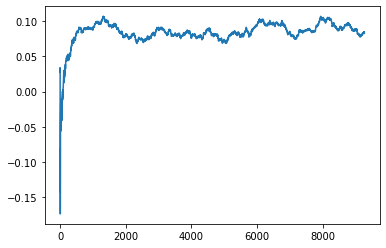

Thread: 4 iteration: 1550
RAM mProject_89 FROM: 2240 --> 1280 reward: 0.045627970781250034
Saving ...


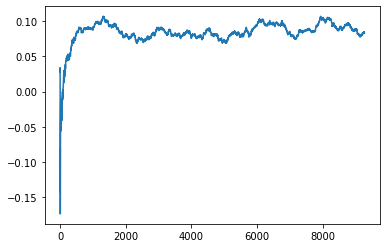

Thread: 3 iteration: 1530
RAM mProject_36 FROM: 384 --> 2944 reward: 0.823276971421875
Thread: 5 iteration: 1636
RAM mBackground_33 FROM: 2112 --> 1792 reward: -0.05072215231249994
Saving ...


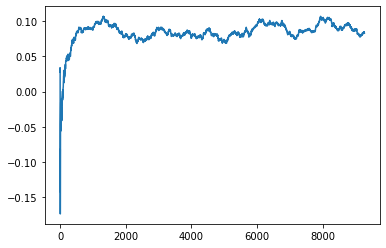

Thread: 2 iteration: 1530
RAM mDiffFit_163 FROM: 1408 --> 768 reward: -0.031468804687500004
Thread: 1 iteration: 1477
RAM mBackground_8 FROM: 1344 --> 1792 reward: -0.06510247535156245
Thread: 6 iteration: 1546
RAM mDiffFit_334 FROM: 1984 --> 768 reward: 0.006302035937500016
Thread: 3 iteration: 1531
RAM mDiffFit_36 FROM: 2624 --> 768 reward: 0.04932287656249998
Thread: 5 iteration: 1637
RAM mDiffFit_251 FROM: 2304 --> 768 reward: -0.025562609375000007
Thread: 4 iteration: 1551
RAM mDiffFit_349 FROM: 1664 --> 768 reward: 0.02054163749999999
Thread: 2 iteration: 1531
RAM mDiffFit_127 FROM: 128 --> 768 reward: -0.8331146453125
Thread: 1 iteration: 1478
RAM mDiffFit_4 FROM: 832 --> 768 reward: -0.007403650390624995
Thread: 6 iteration: 1547
RAM mDiffFit_370 FROM: 3008 --> 768 reward: -0.04795845
Thread: 5 iteration: 1638
RAM mDiffFit_59 FROM: 192 --> 768 reward: -0.43319528789062506
Thread: 3 iteration: 1532
RAM mViewer_1 FROM: 1792 --> 1408 reward: 0.022625617781250027
Thread: 1 iteratio

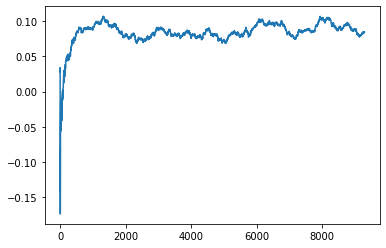

Thread: 5 iteration: 1640
RAM mDiffFit_42 FROM: 2624 --> 768 reward: -0.04536210039062501
Thread: 3 iteration: 1534
RAM mDiffFit_62 FROM: 576 --> 768 reward: -0.04035157070312502
Thread: 6 iteration: 1549
RAM mDiffFit_109 FROM: 1600 --> 768 reward: -0.006479203125000013
Thread: 2 iteration: 1533
RAM mDiffFit_80 FROM: 2880 --> 768 reward: -0.033562609375000024
Thread: 5 iteration: 1641
RAM mDiffFit_408 FROM: 704 --> 1408 reward: -0.033598938281250004
Thread: 3 iteration: 1535
RAM mBackground_16 FROM: 768 --> 896 reward: 0.00022398028125006074
Thread: 4 iteration: 1553
RAM mDiffFit_163 FROM: 448 --> 1408 reward: -0.24236723398437499
Thread: 2 iteration: 1534
RAM mDiffFit_258 FROM: 576 --> 1408 reward: 0.0003412160156249927
Thread: 5 iteration: 1642
RAM mDiffFit_18 FROM: 2432 --> 1408 reward: -0.02516672499999999
Thread: 4 iteration: 1554
RAM mDiffFit_11 FROM: 1408 --> 1408 reward: -0.015026061718750004
Thread: 2 iteration: 1535
RAM mDiffFit_226 FROM: 2816 --> 1408 reward: -0.008302123437

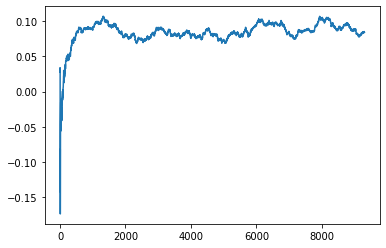

Thread: 1 iteration: 1480
RAM mBackground_87 FROM: 2624 --> 1792 reward: 0.029710298390625004
Thread: 5 iteration: 1644
RAM mProject_21 FROM: 256 --> 1792 reward: 0.6270643839375
Thread: 4 iteration: 1555
RAM mDiffFit_23 FROM: 832 --> 704 reward: 0.01826561953125
Thread: 1 iteration: 1481
RAM mBackground_81 FROM: 256 --> 704 reward: -0.6400281720312498
Thread: 2 iteration: 1537
RAM mDiffFit_118 FROM: 512 --> 704 reward: 0.07020318515625001
Thread: 5 iteration: 1645
RAM mProject_64 FROM: 1856 --> 1024 reward: 0.21567231667968761
Saving ...


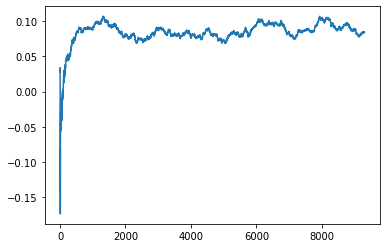

Thread: 6 iteration: 1550
RAM mProject_13 FROM: 1728 --> 1024 reward: 0.20257264132031252
Thread: 3 iteration: 1536
RAM mDiffFit_190 FROM: 320 --> 704 reward: 0.017924534765624972
Thread: 4 iteration: 1556
RAM mDiffFit_135 FROM: 256 --> 704 reward: -0.05196871718750001
Thread: 1 iteration: 1482
RAM mDiffFit_38 FROM: 384 --> 704 reward: -0.31102869414062506
Thread: 2 iteration: 1538
RAM mDiffFit_256 FROM: 2304 --> 704 reward: 0.007091084765625012
Thread: 5 iteration: 1646
RAM mDiffFit_130 FROM: 960 --> 704 reward: 0.07258595117187495
Thread: 3 iteration: 1537
RAM mBgModel_1 FROM: 128 --> 1152 reward: -0.8789227803125
Thread: 6 iteration: 1551
RAM mDiffFit_132 FROM: 1728 --> 704 reward: 0.037289048828124984
Thread: 4 iteration: 1557
RAM mDiffFit_286 FROM: 1024 --> 704 reward: 0.022382809765625015
Thread: 1 iteration: 1483
RAM mDiffFit_293 FROM: 1920 --> 704 reward: 0.033687478125
Thread: 2 iteration: 1539
RAM mDiffFit_138 FROM: 1344 --> 896 reward: 0.024374999999999987
Thread: 5 iteratio

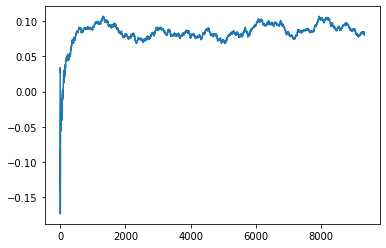

Thread: 2 iteration: 1540
RAM mImgtbl_2 FROM: 2112 --> 1408 reward: 0.11874169874999996
Thread: 1 iteration: 1484
RAM mDiffFit_270 FROM: 2752 --> 896 reward: 0.10391400507812502
Thread: 3 iteration: 1539
RAM mDiffFit_88 FROM: 896 --> 896 reward: 0.057390663281250004
Thread: 4 iteration: 1559
RAM mDiffFit_237 FROM: 960 --> 896 reward: -0.04632555273437498
Thread: 2 iteration: 1541
RAM mBackground_37 FROM: 640 --> 896 reward: -0.10804199014062495
Thread: 1 iteration: 1485
RAM mDiffFit_49 FROM: 1344 --> 896 reward: -0.06515632656249999
Saving ...


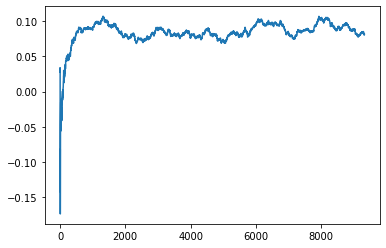

Thread: 3 iteration: 1540
RAM mProject_5 FROM: 2816 --> 704 reward: -1.0
Thread: 6 iteration: 1552
RAM mDiffFit_200 FROM: 320 --> 896 reward: -0.17021090742187497
Thread: 2 iteration: 1542
RAM mDiffFit_71 FROM: 2944 --> 896 reward: 0.07470309765625002
Thread: 1 iteration: 1486
RAM mBackground_68 FROM: 2624 --> 896 reward: 0.022910782296874942
Thread: 3 iteration: 1541
RAM mProject_54 FROM: 576 --> 896 reward: 0.914157805359375
Thread: 5 iteration: 1648
RAM mDiffFit_119 FROM: 1216 --> 896 reward: 0.06259898203125
Thread: 6 iteration: 1553
RAM mDiffFit_103 FROM: 320 --> 896 reward: -0.09324477890624999
Thread: 2 iteration: 1543
RAM mDiffFit_79 FROM: 2368 --> 896 reward: -0.007273516796874983
Thread: 1 iteration: 1487
RAM mDiffFit_99 FROM: 2240 --> 896 reward: -0.015026105468749999
Thread: 3 iteration: 1542
RAM mDiffFit_359 FROM: 2624 --> 896 reward: 0.017296814843749987
Thread: 5 iteration: 1649
RAM mDiffFit_71 FROM: 1088 --> 896 reward: -0.05207296406249999
Thread: 1 iteration: 1488
RAM

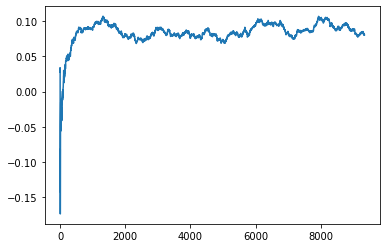

Thread: 4 iteration: 1560
RAM mDiffFit_366 FROM: 832 --> 1792 reward: -0.010005177343749994
Saving ...


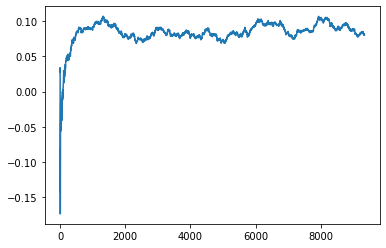

Thread: 5 iteration: 1650
RAM mDiffFit_297 FROM: 2624 --> 1792 reward: -0.0003880308593750062
Thread: 1 iteration: 1489
RAM mDiffFit_192 FROM: 192 --> 1792 reward: -0.09019783281249999
Thread: 6 iteration: 1555
RAM mDiffFit_112 FROM: 2432 --> 1792 reward: -0.014354203124999996
Thread: 4 iteration: 1561
RAM mBackground_31 FROM: 1856 --> 1792 reward: 0.038061754023437436
Thread: 5 iteration: 1651
RAM mDiffFit_98 FROM: 1792 --> 1792 reward: 0.050645884375000005
Thread: 6 iteration: 1556
RAM mBackground_60 FROM: 448 --> 1792 reward: -0.24680203943749995
Thread: 5 iteration: 1652
RAM mProject_49 FROM: 576 --> 896 reward: 0.9292375043437499
Thread: 2 iteration: 1544
RAM mProject_13 FROM: 1088 --> 1792 reward: -0.20083218848437517
Thread: 3 iteration: 1544
RAM mBackground_26 FROM: 2368 --> 1792 reward: -0.01774202776562495
Thread: 6 iteration: 1557
RAM mBackground_82 FROM: 1280 --> 1792 reward: -0.000949539437499993
Thread: 5 iteration: 1653
RAM mDiffFit_374 FROM: 2112 --> 1792 reward: -0.003

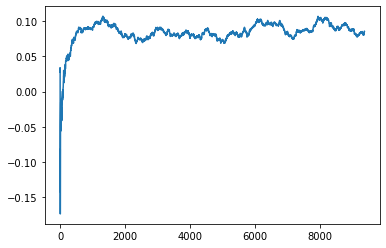

Thread: 1 iteration: 1490
RAM mProject_75 FROM: 1472 --> 1792 reward: -0.06943828535156245
Thread: 5 iteration: 1654
RAM mDiffFit_253 FROM: 3008 --> 1792 reward: -0.03472665820312498
Thread: 2 iteration: 1547
RAM mDiffFit_20 FROM: 512 --> 1792 reward: -0.21292707968749996
Saving ...


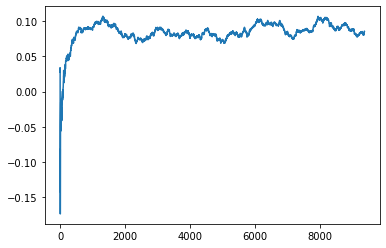

Thread: 6 iteration: 1560
RAM mDiffFit_48 FROM: 1024 --> 896 reward: 0.03495314140625003
Thread: 1 iteration: 1491
RAM mBackground_12 FROM: 1920 --> 896 reward: 0.07245496237499999
Thread: 5 iteration: 1655
RAM mDiffFit_39 FROM: 1856 --> 896 reward: -0.0012943136718750019
Thread: 6 iteration: 1561
RAM mProject_1 FROM: 1216 --> 1792 reward: -0.14244749999999995
Thread: 3 iteration: 1547
RAM mDiffFit_12 FROM: 1280 --> 896 reward: 0.048953141406250025
Thread: 5 iteration: 1656
RAM mBackground_80 FROM: 1792 --> 896 reward: 0.07319851971874997
Thread: 1 iteration: 1492
RAM mDiffFit_339 FROM: 2752 --> 896 reward: 0.014242146484375016
Thread: 3 iteration: 1548
RAM mDiffFit_61 FROM: 1536 --> 896 reward: 0.08424482265625002
Thread: 6 iteration: 1562
RAM mDiffFit_210 FROM: 2560 --> 896 reward: 0.06685938046875001
Thread: 5 iteration: 1657
RAM mDiffFit_113 FROM: 1536 --> 896 reward: 0.018614557812500036
Thread: 1 iteration: 1493
RAM mBackground_42 FROM: 1472 --> 896 reward: 0.08586786066406252
Th

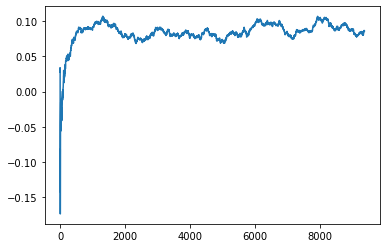

Thread: 3 iteration: 1550
RAM mDiffFit_294 FROM: 1856 --> 896 reward: -0.012463583593749997
Thread: 6 iteration: 1564
RAM mDiffFit_283 FROM: 1472 --> 704 reward: 0.045458318749999976
Thread: 5 iteration: 1659
RAM mBackground_61 FROM: 2112 --> 704 reward: 0.11214034768749993
Thread: 2 iteration: 1549
RAM mDiffFit_389 FROM: 2240 --> 704 reward: 0.09706765546875007
Thread: 4 iteration: 1564
RAM mDiffFit_382 FROM: 3008 --> 704 reward: 0.06317958085937499
Thread: 3 iteration: 1551
RAM mDiffFit_10 FROM: 896 --> 704 reward: 0.125065154296875
Saving ...


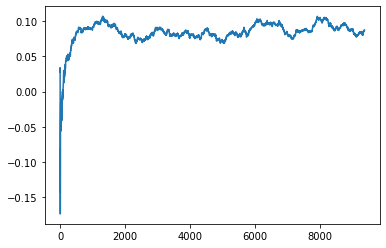

Thread: 5 iteration: 1660
RAM mDiffFit_416 FROM: 2688 --> 704 reward: 0.132882809765625
Thread: 4 iteration: 1565
RAM mDiffFit_222 FROM: 1472 --> 704 reward: 0.135023473046875
Thread: 3 iteration: 1552
RAM mDiffFit_385 FROM: 1472 --> 704 reward: 0.002744735156250018
Saving ...


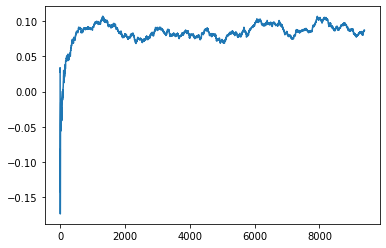

Thread: 2 iteration: 1550
RAM mDiffFit_87 FROM: 2816 --> 704 reward: 0.041322876562499986
Thread: 5 iteration: 1661
RAM mDiffFit_383 FROM: 1152 --> 704 reward: 0.030200508984374996
Thread: 3 iteration: 1553
RAM mDiffFit_336 FROM: 1792 --> 704 reward: 0.091101570703125
Thread: 4 iteration: 1566
RAM mDiffFit_291 FROM: 1600 --> 704 reward: 0.212033915234375
Thread: 2 iteration: 1551
RAM mProject_64 FROM: 1152 --> 704 reward: -1.0
Thread: 6 iteration: 1565
RAM mDiffFit_341 FROM: 1536 --> 704 reward: 0.024916637500000012
Thread: 2 iteration: 1552
RAM mBackground_11 FROM: 1536 --> 704 reward: 0.17844105734375001
Thread: 5 iteration: 1662
RAM mDiffFit_92 FROM: 2304 --> 704 reward: 0.08803646015624998
Thread: 3 iteration: 1554
RAM mDiffFit_82 FROM: 2880 --> 704 reward: 0.04145568632812499
Thread: 6 iteration: 1566
RAM mProject_56 FROM: 2368 --> 704 reward: -1.0
Thread: 1 iteration: 1494
RAM mDiffFit_175 FROM: 1856 --> 704 reward: 0.05269783281249999
Thread: 4 iteration: 1567
RAM mDiffFit_330 F

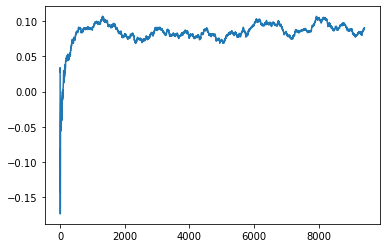

Thread: 6 iteration: 1570
RAM mBackground_66 FROM: 320 --> 704 reward: -0.303073855734375
Thread: 5 iteration: 1666
RAM mBackground_33 FROM: 1152 --> 704 reward: 0.11225463933593748
Thread: 1 iteration: 1498
RAM mDiffFit_248 FROM: 2944 --> 704 reward: 0.0016874343749999875
Thread: 6 iteration: 1571
RAM mBackground_14 FROM: 1536 --> 704 reward: 0.14333108199218753
Thread: 6 iteration: 1572
RAM mDiffFit_320 FROM: 960 --> 704 reward: 0.040424491015624994
Thread: 6 iteration: 1573
RAM mDiffFit_74 FROM: 2944 --> 896 reward: -0.021994866406250008
Thread: 6 iteration: 1574
RAM mProject_38 FROM: 2432 --> 704 reward: -1.0
Thread: 2 iteration: 1555
RAM mProject_49 FROM: 2368 --> 704 reward: -1.0
Thread: 3 iteration: 1557
RAM mProject_29 FROM: 1600 --> 704 reward: -1.0
Saving ...


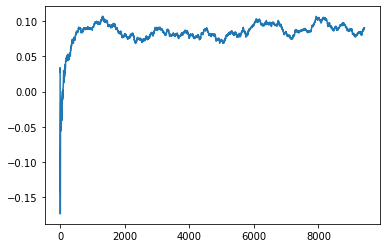

Thread: 4 iteration: 1570
RAM mDiffFit_240 FROM: 1088 --> 896 reward: -0.005085951171874981
Thread: 2 iteration: 1556
RAM mDiffFit_361 FROM: 704 --> 896 reward: -0.06836460156249999
Thread: 6 iteration: 1575
RAM mDiffFit_20 FROM: 960 --> 896 reward: -0.003057300781250001
Thread: 4 iteration: 1571
RAM mDiffFit_53 FROM: 1088 --> 896 reward: -0.07194537539062502
Thread: 6 iteration: 1576
RAM mDiffFit_411 FROM: 640 --> 896 reward: -0.016541637499999998
Thread: 4 iteration: 1572
RAM mProject_88 FROM: 384 --> 704 reward: -1.0
Thread: 5 iteration: 1667
RAM mProject_42 FROM: 2368 --> 704 reward: -1.0
Thread: 1 iteration: 1499
RAM mDiffFit_295 FROM: 640 --> 896 reward: 0.010135442187500024
Thread: 6 iteration: 1577
RAM mDiffFit_3 FROM: 128 --> 896 reward: -0.5659843804687501
Thread: 4 iteration: 1573
RAM mBackground_18 FROM: 192 --> 896 reward: -0.6569660819921875
Saving ...


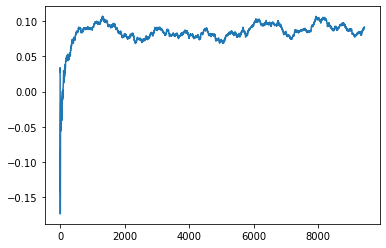

Thread: 1 iteration: 1500
RAM mDiffFit_405 FROM: 3008 --> 896 reward: -0.078570462890625
Thread: 5 iteration: 1668
RAM mDiffFit_369 FROM: 2048 --> 896 reward: 0.01677601796875
Thread: 4 iteration: 1574
RAM mProject_82 FROM: 2432 --> 896 reward: 0.20829917221874997
Thread: 3 iteration: 1558
RAM mDiffFit_153 FROM: 1600 --> 896 reward: 0.059231791796875
Thread: 5 iteration: 1669
RAM mDiffFit_6 FROM: 1280 --> 896 reward: -0.025786503906249994
Thread: 1 iteration: 1501
RAM mProject_28 FROM: 1472 --> 896 reward: 0.23892234292968745
Thread: 2 iteration: 1557
RAM mDiffFit_158 FROM: 448 --> 896 reward: -0.048684889453125005
Thread: 4 iteration: 1575
RAM mBackground_74 FROM: 1536 --> 896 reward: 0.06828936559375
Thread: 3 iteration: 1559
RAM mBackground_86 FROM: 512 --> 896 reward: -0.17813199014062495
Saving ...


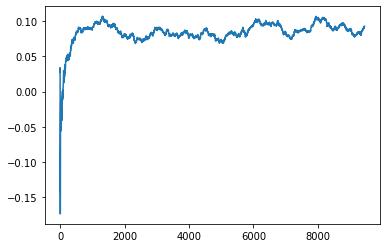

Thread: 5 iteration: 1670
RAM mDiffFit_365 FROM: 1600 --> 896 reward: 0.005203097656249992
Thread: 1 iteration: 1502
RAM mDiffFit_78 FROM: 3008 --> 896 reward: -0.03827614921875
Thread: 2 iteration: 1558
RAM mDiffFit_305 FROM: 1024 --> 896 reward: 0.015197920312499998
Thread: 4 iteration: 1576
RAM mProject_39 FROM: 2496 --> 896 reward: 0.17105739982031248
Thread: 6 iteration: 1578
RAM mDiffFit_164 FROM: 2880 --> 896 reward: -0.02875530859375003
Thread: 5 iteration: 1671
RAM mDiffFit_282 FROM: 1344 --> 896 reward: -0.002445331640624996
Thread: 1 iteration: 1503
RAM mDiffFit_336 FROM: 2304 --> 896 reward: 0.030812478125
Thread: 2 iteration: 1559
RAM mBackground_79 FROM: 2944 --> 896 reward: 0.02856798390625004
Saving ...


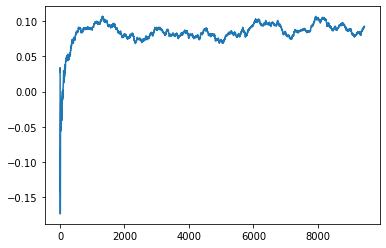

Thread: 3 iteration: 1560
RAM mDiffFit_324 FROM: 576 --> 896 reward: 0.021729203125000016
Thread: 4 iteration: 1577
RAM mDiffFit_140 FROM: 448 --> 896 reward: -0.06705988945312502
Saving ...


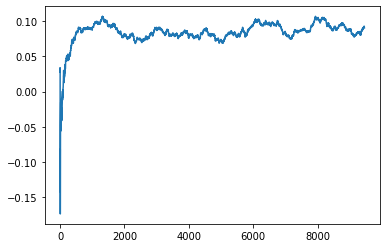

Thread: 2 iteration: 1560
RAM mDiffFit_408 FROM: 1984 --> 896 reward: -0.007109424218749993
Thread: 4 iteration: 1578
RAM mBackground_18 FROM: 2944 --> 896 reward: 0.07211446418750005
Thread: 5 iteration: 1672
RAM mBackground_49 FROM: 2560 --> 896 reward: 0.05606115593749998
Thread: 1 iteration: 1504
RAM mBgModel_2 FROM: 2560 --> 896 reward: 0.049826922187499956
Thread: 6 iteration: 1579
RAM mDiffFit_56 FROM: 1984 --> 896 reward: 0.057549447265625026
Thread: 2 iteration: 1561
RAM mDiffFit_27 FROM: 1152 --> 896 reward: -0.006562521875000012
Thread: 5 iteration: 1673
RAM mDiffFit_233 FROM: 576 --> 896 reward: -0.04106247812499998
Thread: 4 iteration: 1579
RAM mDiffFit_335 FROM: 2112 --> 896 reward: 0.03916926992187501
Saving ...


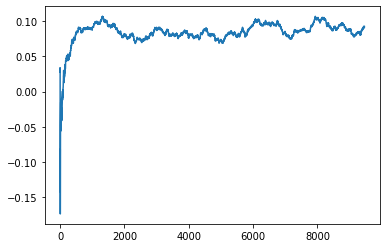

Thread: 6 iteration: 1580
RAM mDiffFit_164 FROM: 512 --> 896 reward: -0.0633229203125
Thread: 2 iteration: 1562
RAM mDiffFit_197 FROM: 1024 --> 896 reward: -0.001880221093750016
Thread: 5 iteration: 1674
RAM mDiffFit_211 FROM: 1152 --> 896 reward: 0.005338539843750007
Saving ...


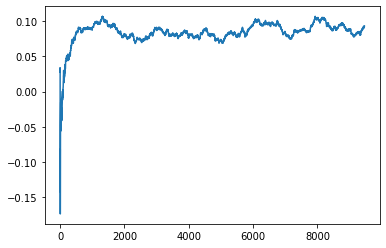

Thread: 4 iteration: 1580
RAM mDiffFit_226 FROM: 960 --> 896 reward: -0.005859380468749998
Thread: 2 iteration: 1563
RAM mProject_28 FROM: 256 --> 896 reward: 0.9163187451562499
Thread: 3 iteration: 1561
RAM mBackground_45 FROM: 1152 --> 896 reward: 0.04368978853125006
Thread: 5 iteration: 1675
RAM mBackground_74 FROM: 256 --> 896 reward: -0.526853009859375
Thread: 4 iteration: 1581
RAM mDiffFit_283 FROM: 2624 --> 896 reward: 0.03773174804687501
Thread: 2 iteration: 1564
RAM mDiffFit_150 FROM: 1088 --> 896 reward: -0.020583362500000008
Thread: 3 iteration: 1562
RAM mDiffFit_363 FROM: 2176 --> 896 reward: 0.006791637499999996
Thread: 5 iteration: 1676
RAM mProject_84 FROM: 2816 --> 896 reward: 0.12777714562499992
Thread: 1 iteration: 1505
RAM mDiffFit_395 FROM: 768 --> 896 reward: 0.0015052210937500053
Thread: 3 iteration: 1563
RAM mBackground_44 FROM: 2496 --> 896 reward: 0.04428094446875003
Thread: 2 iteration: 1565
RAM mDiffFit_421 FROM: 3008 --> 896 reward: 0.008898385546874995
Thre

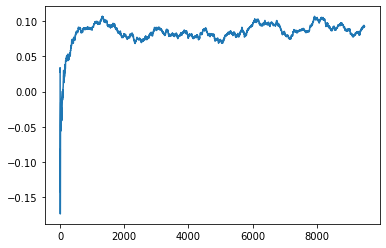

Thread: 5 iteration: 1680
RAM mBackground_68 FROM: 2688 --> 896 reward: -0.029002812671875003
Thread: 3 iteration: 1566
RAM mDiffFit_70 FROM: 1920 --> 896 reward: 0.14717194609375
Thread: 5 iteration: 1681
RAM mDiffFit_208 FROM: 832 --> 896 reward: 0.07229953476562498
Thread: 3 iteration: 1567
RAM mDiffFit_58 FROM: 2624 --> 896 reward: -0.012833406250000023
Thread: 5 iteration: 1682
RAM mDiffFit_273 FROM: 3008 --> 896 reward: -0.00098183554687499
Thread: 5 iteration: 1683
RAM mBackground_9 FROM: 2624 --> 896 reward: 0.015105844570312518
Thread: 3 iteration: 1568
RAM mDiffFit_233 FROM: 1344 --> 896 reward: -0.007645884374999981
Thread: 3 iteration: 1569
RAM mProject_78 FROM: 320 --> 896 reward: 0.9201221849531249
Thread: 4 iteration: 1583
RAM mProject_47 FROM: 1792 --> 896 reward: 0.2857190418281251
Thread: 1 iteration: 1508
RAM mProject_55 FROM: 2688 --> 896 reward: 0.14539842843749987
Thread: 2 iteration: 1568
RAM mProject_39 FROM: 128 --> 896 reward: 0.919289684953125
Thread: 6 itera

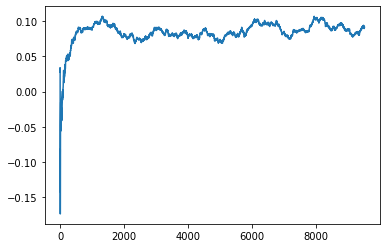

Thread: 3 iteration: 1570
RAM mDiffFit_381 FROM: 2944 --> 896 reward: 0.010140575781249998
Thread: 1 iteration: 1509
RAM mDiffFit_231 FROM: 2816 --> 896 reward: 0.039755177343749996
Thread: 6 iteration: 1585
RAM mDiffFit_59 FROM: 2176 --> 896 reward: 0.04885411562500001
Thread: 3 iteration: 1571
RAM mDiffFit_417 FROM: 1024 --> 896 reward: -0.05734380468750003
Thread: 6 iteration: 1586
RAM mProject_35 FROM: 1408 --> 896 reward: -1.0
Thread: 5 iteration: 1684
RAM mDiffFit_48 FROM: 1600 --> 896 reward: -0.016947964062500008
Saving ...


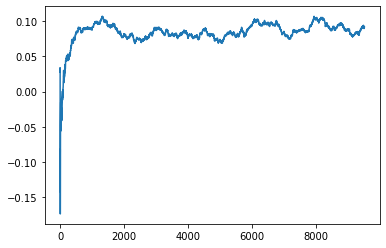

Thread: 1 iteration: 1510
RAM mDiffFit_142 FROM: 1216 --> 896 reward: 0.026117190234375004
Thread: 3 iteration: 1572
RAM mDiffFit_234 FROM: 2560 --> 896 reward: -0.0001615039062499886
Thread: 6 iteration: 1587
RAM mDiffFit_258 FROM: 2560 --> 896 reward: 0.013593717187500003
Thread: 3 iteration: 1573
RAM mDiffFit_31 FROM: 1472 --> 896 reward: 0.015979159374999996
Thread: 6 iteration: 1588
RAM mProject_17 FROM: 3008 --> 896 reward: 0.0962939595937499
Thread: 4 iteration: 1584
RAM mProject_3 FROM: 2112 --> 896 reward: 0.23546613318749984
Thread: 2 iteration: 1569
RAM mDiffFit_323 FROM: 1920 --> 896 reward: 0.0677812390625
Thread: 3 iteration: 1574
RAM mBackground_24 FROM: 384 --> 896 reward: -0.2295393655937501
Thread: 5 iteration: 1685
RAM mDiffFit_275 FROM: 384 --> 896 reward: -0.09253646015624997
Thread: 6 iteration: 1589
RAM mBackground_82 FROM: 1600 --> 896 reward: 0.05020246237499998
Thread: 4 iteration: 1585
RAM mDiffFit_284 FROM: 2240 --> 896 reward: 0.014109336718749997
Saving ..

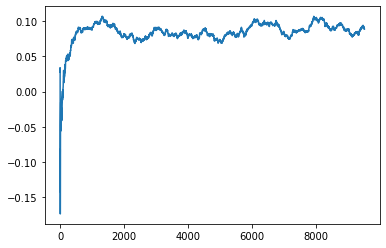

Thread: 2 iteration: 1570
RAM mDiffFit_42 FROM: 1088 --> 896 reward: -0.028708362500000015
Thread: 5 iteration: 1686
RAM mDiffFit_342 FROM: 128 --> 896 reward: -0.6920312828124999
Thread: 3 iteration: 1575
RAM mDiffFit_118 FROM: 2112 --> 896 reward: 0.021789048828125008
Thread: 2 iteration: 1571
RAM mDiffFit_76 FROM: 1984 --> 896 reward: 0.006770796875000002
Thread: 5 iteration: 1687
RAM mProject_82 FROM: 576 --> 896 reward: 0.9224631247499999
Thread: 1 iteration: 1511
RAM mConcatFit_2 FROM: 704 --> 896 reward: -0.08779585812500001
Thread: 4 iteration: 1586
RAM mBackground_86 FROM: 1920 --> 896 reward: 0.05557297223437503
Thread: 3 iteration: 1576
RAM mBackground_30 FROM: 1536 --> 1792 reward: -0.016940211468749945
Thread: 2 iteration: 1572
RAM mDiffFit_96 FROM: 1600 --> 1792 reward: 0.06148964531249999
Thread: 1 iteration: 1512
RAM mDiffFit_288 FROM: 832 --> 1792 reward: 0.026216216015624988
Thread: 3 iteration: 1577
RAM mBackground_71 FROM: 2176 --> 1792 reward: -0.051434353921875016

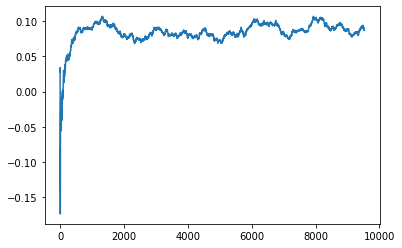

Thread: 6 iteration: 1590
RAM mDiffFit_319 FROM: 2752 --> 1792 reward: 0.0032525886718750077
Thread: 2 iteration: 1573
RAM mDiffFit_400 FROM: 2560 --> 1792 reward: 0.03123960156250001
Thread: 1 iteration: 1513
RAM mDiffFit_154 FROM: 960 --> 1792 reward: -0.02252342929687501
Thread: 3 iteration: 1578
RAM mProject_36 FROM: 2112 --> 1792 reward: -0.055224018632812566
Thread: 4 iteration: 1587
RAM mDiffFit_248 FROM: 1344 --> 1792 reward: -0.015875000000000004
Thread: 5 iteration: 1689
RAM mBackground_17 FROM: 1664 --> 1792 reward: -0.025549191749999978
Thread: 6 iteration: 1591
RAM mDiffFit_248 FROM: 2048 --> 1792 reward: -0.004718760937500012
Thread: 2 iteration: 1574
RAM mDiffFit_11 FROM: 1216 --> 1792 reward: -0.024138030859375
Thread: 1 iteration: 1514
RAM mBackground_22 FROM: 1920 --> 1792 reward: 0.007834067203124974
Thread: 4 iteration: 1588
RAM mDiffFit_68 FROM: 1728 --> 1792 reward: 0.026333362500000016
Saving ...


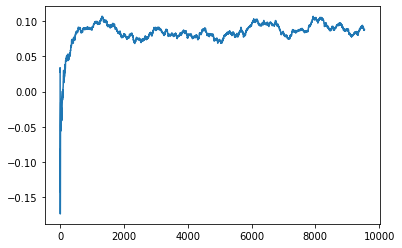

Thread: 5 iteration: 1690
RAM mDiffFit_119 FROM: 2304 --> 1792 reward: -0.01945836250000001
Thread: 1 iteration: 1515
RAM mImgtbl_1 FROM: 448 --> 1792 reward: -0.6755167074999999
Thread: 2 iteration: 1575
RAM mProject_84 FROM: 640 --> 1792 reward: 0.6165981247500001
Thread: 3 iteration: 1579
RAM mDiffFit_336 FROM: 2112 --> 1792 reward: -0.004710951171875005
Thread: 5 iteration: 1691
RAM mDiffFit_337 FROM: 1216 --> 1792 reward: -0.01885674804687501
Thread: 2 iteration: 1576
RAM mDiffFit_348 FROM: 896 --> 1792 reward: -0.015984336718750016
Saving ...


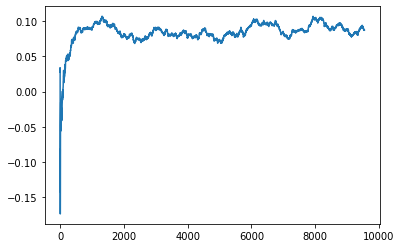

Thread: 3 iteration: 1580
RAM mProject_58 FROM: 2496 --> 1792 reward: -0.13350729128906239
Thread: 4 iteration: 1589
RAM mDiffFit_148 FROM: 576 --> 1792 reward: -0.15314066328125
Thread: 5 iteration: 1692
RAM mDiffFit_184 FROM: 3008 --> 1792 reward: 0.022169269921875016
Thread: 2 iteration: 1577
RAM mBackground_17 FROM: 2688 --> 1792 reward: 0.07472148028125003
Thread: 3 iteration: 1581
RAM mProject_26 FROM: 1408 --> 1792 reward: -0.0873009397968751
Thread: 1 iteration: 1516
RAM mDiffFit_311 FROM: 576 --> 1792 reward: -0.04305466835937499
Saving ...


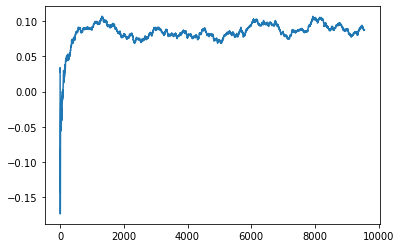

Thread: 4 iteration: 1590
RAM mDiffFit_246 FROM: 1152 --> 1792 reward: -0.0018489382812500108
Thread: 5 iteration: 1693
RAM mDiffFit_7 FROM: 2752 --> 1792 reward: -0.015882853515624996
Thread: 2 iteration: 1578
RAM mDiffFit_233 FROM: 2432 --> 1792 reward: -0.091354290625
Thread: 3 iteration: 1582
RAM mProject_43 FROM: 1536 --> 1792 reward: -0.05666063090625003
Thread: 6 iteration: 1592
RAM mBackground_9 FROM: 960 --> 1792 reward: -0.055304241046874945
Thread: 1 iteration: 1517
RAM mBackground_3 FROM: 1088 --> 1792 reward: -0.03179532303906247
Thread: 4 iteration: 1591
RAM mBackground_33 FROM: 2880 --> 1792 reward: -0.07307551116406251
Thread: 5 iteration: 1694
RAM mDiffFit_275 FROM: 1792 --> 1792 reward: -0.0012500000000000011
Thread: 3 iteration: 1583
RAM mDiffFit_398 FROM: 2752 --> 1792 reward: -0.00237241132812498
Thread: 6 iteration: 1593
RAM mDiffFit_369 FROM: 2560 --> 1792 reward: -0.014531282812500004
Thread: 1 iteration: 1518
RAM mDiffFit_128 FROM: 2176 --> 1792 reward: -0.0890

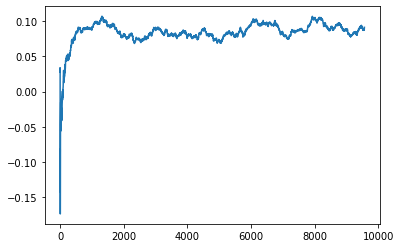

Thread: 2 iteration: 1580
RAM mDiffFit_155 FROM: 2688 --> 1792 reward: -0.026515663281249997
Thread: 6 iteration: 1595
RAM mDiffFit_66 FROM: 1280 --> 1792 reward: -0.012552079687499999
Thread: 3 iteration: 1586
RAM mDiffFit_8 FROM: 2944 --> 1792 reward: 0.002526017968749999
Thread: 2 iteration: 1581
RAM mDiffFit_372 FROM: 1216 --> 1792 reward: -0.10739851679687502
Thread: 6 iteration: 1596
RAM mBackground_59 FROM: 2688 --> 1792 reward: -0.06368939154687496
Thread: 3 iteration: 1587
RAM mProject_28 FROM: 2880 --> 1792 reward: -0.18810131779687497
Thread: 5 iteration: 1697
RAM mProject_80 FROM: 2624 --> 1792 reward: -0.1267765216875
Saving ...


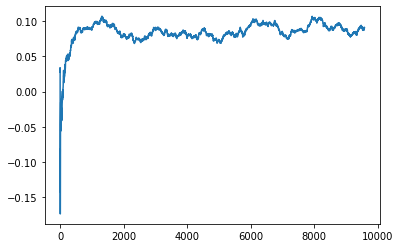

Thread: 1 iteration: 1520
RAM mDiffFit_101 FROM: 1344 --> 1792 reward: -0.072145884375
Thread: 6 iteration: 1597
RAM mDiffFit_143 FROM: 1664 --> 1792 reward: 0.006895840625
Thread: 3 iteration: 1588
RAM mDiffFit_3 FROM: 2304 --> 1792 reward: 5.2079687500004856e-05
Thread: 5 iteration: 1698
RAM mDiffFit_105 FROM: 576 --> 1792 reward: -0.03467966835937499
Thread: 1 iteration: 1521
RAM mProject_35 FROM: 512 --> 1792 reward: 0.6274693839375
Thread: 2 iteration: 1582
RAM mProject_23 FROM: 2176 --> 1792 reward: -0.053187306609375005
Thread: 4 iteration: 1594
RAM mDiffFit_376 FROM: 2944 --> 1792 reward: -0.0590730078125
Thread: 5 iteration: 1699
RAM mDiffFit_10 FROM: 1408 --> 1792 reward: -0.009135398437500018
Thread: 3 iteration: 1589
RAM mBackground_26 FROM: 1344 --> 1792 reward: -0.01267601971874998
Thread: 1 iteration: 1522
RAM mImgtbl_2 FROM: 1984 --> 1792 reward: -0.04160214093749992
Thread: 2 iteration: 1583
RAM mProject_17 FROM: 2816 --> 1792 reward: -0.18132973396874993
Thread: 6 ite

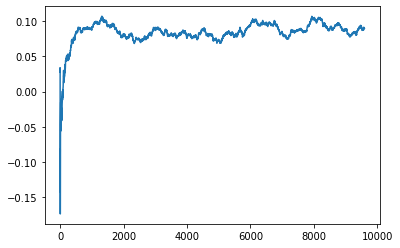

Thread: 5 iteration: 1700
RAM mDiffFit_102 FROM: 2240 --> 1792 reward: -0.016265663281249988
Saving ...


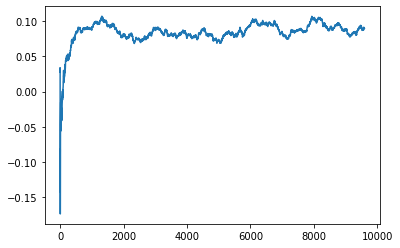

Thread: 3 iteration: 1590
RAM mDiffFit_72 FROM: 1088 --> 1792 reward: -0.008708318750000011
Thread: 1 iteration: 1523
RAM mDiffFit_264 FROM: 1728 --> 1792 reward: -0.016687521875000007
Thread: 6 iteration: 1599
RAM mDiffFit_225 FROM: 768 --> 1792 reward: -0.03770831875
Thread: 2 iteration: 1584
RAM mDiffFit_65 FROM: 320 --> 1792 reward: -0.15742707968749997
Thread: 5 iteration: 1701
RAM mDiffFit_246 FROM: 2176 --> 1792 reward: -0.014437521875000012
Thread: 1 iteration: 1524
RAM mImgtbl_2 FROM: 2560 --> 1792 reward: -0.09785851125
Thread: 4 iteration: 1596
RAM mConcatFit_3 FROM: 1856 --> 1792 reward: -0.004081256562500024
Thread: 3 iteration: 1591
RAM mDiffFit_116 FROM: 2176 --> 1792 reward: 0.020432300781250003
Thread: 5 iteration: 1702
RAM mDiffFit_242 FROM: 2432 --> 1792 reward: -0.014296902343750003
Thread: 1 iteration: 1525
RAM mDiffFit_97 FROM: 2240 --> 1792 reward: -0.010135442187500007
Thread: 4 iteration: 1597
RAM mDiffFit_72 FROM: 2048 --> 1792 reward: -0.003718760937500001
Th

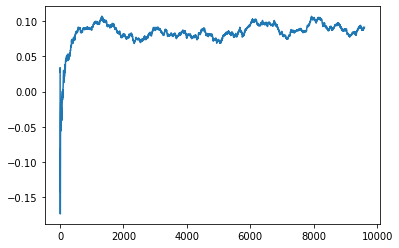

Thread: 6 iteration: 1600
RAM mProject_31 FROM: 1856 --> 1792 reward: -0.012671740898437478
Thread: 2 iteration: 1585
RAM mDiffFit_385 FROM: 1216 --> 1792 reward: 0.008679712109374996
Thread: 4 iteration: 1598
RAM mBackground_38 FROM: 2560 --> 1792 reward: -0.05958197846875005
Thread: 1 iteration: 1526
RAM mDiffFit_274 FROM: 2624 --> 1792 reward: -0.013898473046875014
Thread: 3 iteration: 1593
RAM mDiffFit_193 FROM: 704 --> 1792 reward: -0.07858853984374997
Thread: 6 iteration: 1601
RAM mBackground_20 FROM: 1216 --> 1792 reward: -0.04796963933593751
Thread: 2 iteration: 1586
RAM mDiffFit_280 FROM: 2560 --> 1792 reward: -0.016406282812500006
Thread: 4 iteration: 1599
RAM mProject_9 FROM: 2624 --> 1792 reward: -0.13599637249218754
Thread: 5 iteration: 1703
RAM mDiffFit_145 FROM: 3008 --> 1792 reward: -0.03801048593750002
Thread: 2 iteration: 1587
RAM mDiffFit_273 FROM: 1088 --> 1792 reward: -0.017692699218750003
Thread: 6 iteration: 1602
RAM mDiffFit_192 FROM: 3008 --> 1792 reward: -0.09

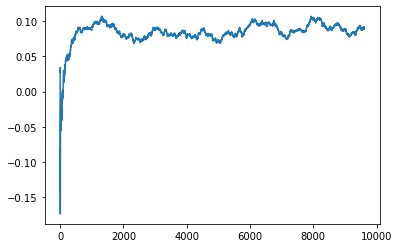

Thread: 4 iteration: 1600
RAM mDiffFit_250 FROM: 704 --> 1792 reward: -0.0553229203125
Thread: 5 iteration: 1704
RAM mProject_87 FROM: 1472 --> 1792 reward: -0.05704030364062492
Thread: 1 iteration: 1527
RAM mDiffFit_69 FROM: 2624 --> 1792 reward: 0.004111969140625001
Thread: 2 iteration: 1588
RAM mDiffFit_93 FROM: 1984 --> 1792 reward: -0.010351570703124998
Thread: 6 iteration: 1603
RAM mBackground_17 FROM: 2432 --> 1792 reward: -0.039349565390624994
Thread: 3 iteration: 1595
RAM mDiffFit_101 FROM: 2176 --> 1792 reward: -0.01657814140625
Thread: 5 iteration: 1705
RAM mDiffFit_221 FROM: 2048 --> 1792 reward: -0.0011666812499999853
Thread: 4 iteration: 1601
RAM mBackground_68 FROM: 1536 --> 1792 reward: -0.04027669174999997
Thread: 1 iteration: 1528
RAM mDiffFit_228 FROM: 576 --> 1792 reward: -0.10883595117187499
Thread: 2 iteration: 1589
RAM mDiffFit_365 FROM: 576 --> 1792 reward: -0.0555312390625
Thread: 3 iteration: 1596
RAM mBackground_78 FROM: 3008 --> 1792 reward: -0.0594073144843

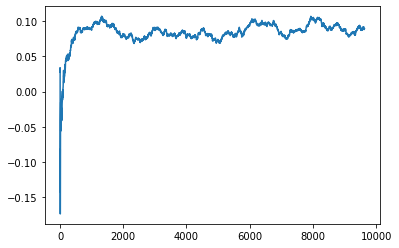

Thread: 2 iteration: 1590
RAM mDiffFit_134 FROM: 1600 --> 1792 reward: -0.03805993320312501
Thread: 5 iteration: 1706
RAM mDiffFit_224 FROM: 1088 --> 1792 reward: -0.14644019804687503
Thread: 1 iteration: 1529
RAM mDiffFit_75 FROM: 2816 --> 1792 reward: 0.006135398437500002
Thread: 4 iteration: 1603
RAM mProject_65 FROM: 1088 --> 1792 reward: -0.21072844504687496
Thread: 6 iteration: 1605
RAM mDiffFit_331 FROM: 2944 --> 1792 reward: -0.024484424218749995
Saving ...


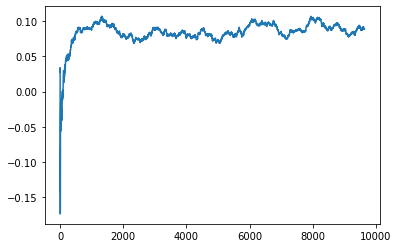

Thread: 1 iteration: 1530
RAM mBackground_15 FROM: 1408 --> 1792 reward: -0.0360125
Thread: 5 iteration: 1707
RAM mDiffFit_130 FROM: 1728 --> 1792 reward: -0.08773446796875002
Thread: 3 iteration: 1598
RAM mDiffFit_380 FROM: 960 --> 1792 reward: 0.008362012890624996
Thread: 4 iteration: 1604
RAM mDiffFit_168 FROM: 448 --> 1792 reward: -0.05523433671875
Thread: 6 iteration: 1606
RAM mDiffFit_388 FROM: 1472 --> 1792 reward: -0.029377632421875004
Thread: 1 iteration: 1531
RAM mDiffFit_302 FROM: 1216 --> 1792 reward: -0.041390619531249985
Thread: 5 iteration: 1708
RAM mViewer_2 FROM: 2496 --> 1792 reward: -0.038465704406249975
Thread: 3 iteration: 1599
RAM mDiffFit_266 FROM: 192 --> 1792 reward: -0.43123433671875
Thread: 6 iteration: 1607
RAM mBackground_14 FROM: 2624 --> 1792 reward: -0.07637216528906247
Thread: 4 iteration: 1605
RAM mDiffFit_12 FROM: 320 --> 1792 reward: -0.10473433671874999
Thread: 1 iteration: 1532
RAM mDiffFit_194 FROM: 512 --> 1792 reward: -0.1349896015625
Thread: 5 

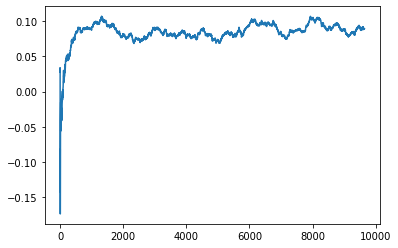

Thread: 3 iteration: 1600
RAM mDiffFit_342 FROM: 2752 --> 1792 reward: -0.004747411328124996
Thread: 6 iteration: 1608
RAM mDiffFit_233 FROM: 1472 --> 1792 reward: -0.033166681249999996
Thread: 4 iteration: 1606
RAM mDiffFit_329 FROM: 640 --> 1792 reward: -0.16106774296875
Thread: 1 iteration: 1533
RAM mDiffFit_221 FROM: 384 --> 1792 reward: -0.13062500000000002
Thread: 3 iteration: 1601
RAM mProject_84 FROM: 1344 --> 1792 reward: -0.1123237591875
Thread: 2 iteration: 1591
RAM mImgtbl_1 FROM: 1536 --> 1792 reward: -0.05002502624999999
Saving ...


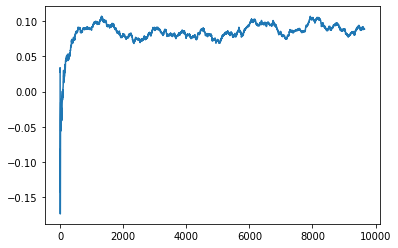

Thread: 5 iteration: 1710
RAM mDiffFit_415 FROM: 2688 --> 1408 reward: 0.016130177343750014
Thread: 1 iteration: 1534
RAM mDiffFit_286 FROM: 960 --> 1408 reward: 0.07640373789062499
Thread: 4 iteration: 1607
RAM mDiffFit_319 FROM: 768 --> 1408 reward: 0.049369866406250004
Thread: 2 iteration: 1592
RAM mDiffFit_419 FROM: 960 --> 1408 reward: 0.06912767617187501
Thread: 3 iteration: 1602
RAM mDiffFit_163 FROM: 1984 --> 1408 reward: 0.08254953476562504
Thread: 5 iteration: 1711
RAM mDiffFit_397 FROM: 1728 --> 1408 reward: 0.03593752187499999
Thread: 1 iteration: 1535
RAM mDiffFit_262 FROM: 2048 --> 1408 reward: 0.03713022109374999
Thread: 4 iteration: 1608
RAM mDiffFit_267 FROM: 1600 --> 1408 reward: 0.016432300781249985
Thread: 3 iteration: 1603
RAM mProject_54 FROM: 1664 --> 1408 reward: 0.07216876181249994
Thread: 6 iteration: 1609
RAM mDiffFit_117 FROM: 1920 --> 1408 reward: -0.013354203125000002
Thread: 4 iteration: 1609
RAM mDiffFit_107 FROM: 2176 --> 1408 reward: -0.036937565625000

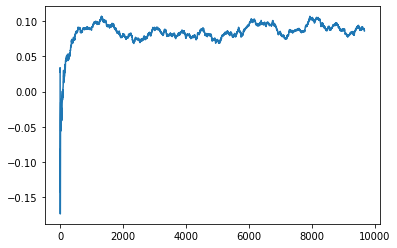

Thread: 6 iteration: 1610
RAM mDiffFit_317 FROM: 2880 --> 1408 reward: 0.042257809765625015
Thread: 3 iteration: 1605
RAM mBackground_88 FROM: 2944 --> 1408 reward: -0.02554930462500001
Saving ...


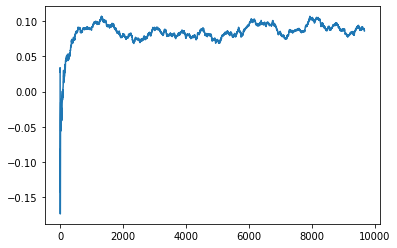

Thread: 4 iteration: 1610
RAM mProject_3 FROM: 512 --> 1408 reward: 0.6849052974843749
Thread: 2 iteration: 1593
RAM mProject_45 FROM: 1920 --> 1408 reward: 0.059959641234375013
Thread: 5 iteration: 1712
RAM mDiffFit_274 FROM: 2048 --> 1408 reward: 0.008546858593750008
Thread: 6 iteration: 1611
RAM mProject_19 FROM: 192 --> 1408 reward: 0.71358063525
Thread: 1 iteration: 1536
RAM mDiffFit_132 FROM: 2816 --> 1408 reward: -0.0020521234375000044
Thread: 3 iteration: 1606
RAM mDiffFit_60 FROM: 1664 --> 1408 reward: 0.028135442187499984
Thread: 4 iteration: 1611
RAM mDiffFit_201 FROM: 2432 --> 1408 reward: -0.012890663281249996
Thread: 2 iteration: 1594
RAM mDiffFit_320 FROM: 704 --> 1408 reward: -0.053500000000000006
Thread: 5 iteration: 1713
RAM mDiffFit_144 FROM: 512 --> 1408 reward: -0.05820831874999998
Thread: 6 iteration: 1612
RAM mDiffFit_54 FROM: 704 --> 1408 reward: -0.020973938281250003
Thread: 1 iteration: 1537
RAM mDiffFit_223 FROM: 2496 --> 768 reward: 0.143773473046875
Thread:

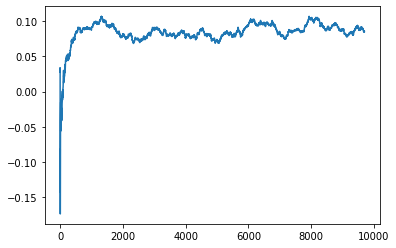

Thread: 1 iteration: 1540
RAM mDiffFit_154 FROM: 960 --> 768 reward: 0.0686562828125
Thread: 4 iteration: 1615
RAM mDiffFit_90 FROM: 2752 --> 768 reward: 0.05805466835937502
Thread: 6 iteration: 1616
RAM mDiffFit_168 FROM: 832 --> 768 reward: -0.04628909257812501
Thread: 4 iteration: 1616
RAM mDiffFit_255 FROM: 640 --> 768 reward: 0.0263333625
Thread: 1 iteration: 1541
RAM mBackground_2 FROM: 1728 --> 768 reward: 0.06713369356249999
Thread: 2 iteration: 1599
RAM mProject_69 FROM: 1344 --> 768 reward: -1.0
Thread: 5 iteration: 1716
RAM mBackground_32 FROM: 1216 --> 768 reward: 0.04861237545312503
Thread: 6 iteration: 1617
RAM mDiffFit_107 FROM: 2624 --> 768 reward: 0.11657292031249997
Saving ...


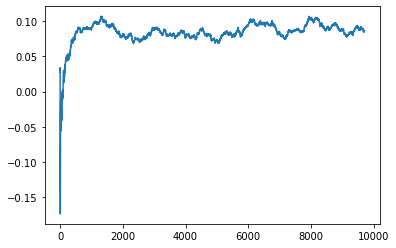

Thread: 2 iteration: 1600
RAM mBackground_71 FROM: 1856 --> 768 reward: 0.10462210171093743
Thread: 5 iteration: 1717
RAM mProject_64 FROM: 448 --> 768 reward: -1.0
Saving ...


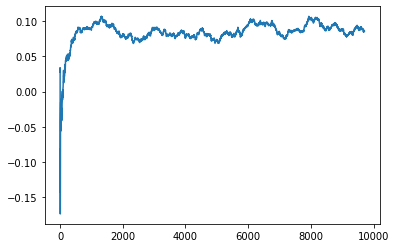

Thread: 3 iteration: 1610
RAM mDiffFit_302 FROM: 3008 --> 768 reward: 0.02797121835937503
Thread: 2 iteration: 1601
RAM mDiffFit_224 FROM: 1088 --> 768 reward: -0.11978395898437502
Thread: 5 iteration: 1718
RAM mDiffFit_9 FROM: 2944 --> 768 reward: 0.06120309765625002
Thread: 5 iteration: 1719
RAM mDiffFit_88 FROM: 1088 --> 768 reward: 0.09155471210937499
Thread: 3 iteration: 1611
RAM mBackground_69 FROM: 2560 --> 768 reward: 0.06164217565625
Thread: 2 iteration: 1602
RAM mBackground_85 FROM: 2304 --> 768 reward: 0.016769849500000024
Saving ...


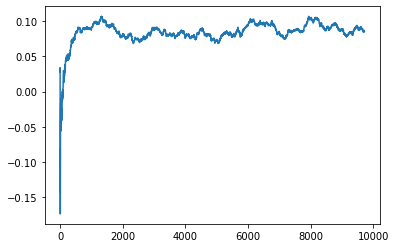

Thread: 5 iteration: 1720
RAM mBackground_33 FROM: 1920 --> 768 reward: 0.08862026076562496
Thread: 3 iteration: 1612
RAM mBackground_57 FROM: 2240 --> 768 reward: 0.07812106901562499
Thread: 2 iteration: 1603
RAM mProject_42 FROM: 896 --> 768 reward: -1.0
Thread: 4 iteration: 1617
RAM mProject_66 FROM: 1984 --> 768 reward: -1.0
Thread: 1 iteration: 1542
RAM mProject_53 FROM: 576 --> 768 reward: -1.0
Thread: 6 iteration: 1618
RAM mDiffFit_192 FROM: 768 --> 768 reward: -0.032187521875
Thread: 3 iteration: 1613
RAM mDiffFit_405 FROM: 2816 --> 768 reward: 0.0127811953125
Thread: 1 iteration: 1543
RAM mBackground_74 FROM: 2496 --> 768 reward: 0.04156876750781245
Thread: 2 iteration: 1604
RAM mViewer_2 FROM: 960 --> 768 reward: 0.07567830110156253
Thread: 4 iteration: 1618
RAM mDiffFit_256 FROM: 192 --> 768 reward: -0.18789061953125005
Thread: 2 iteration: 1605
RAM mBackground_35 FROM: 128 --> 768 reward: 0.30895518812499995
Thread: 3 iteration: 1614
RAM mBackground_72 FROM: 1024 --> 768 re

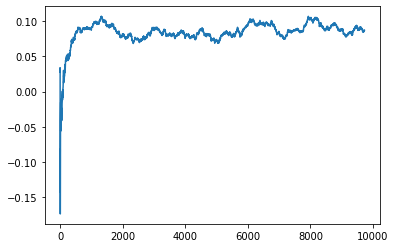

Thread: 4 iteration: 1620
RAM mDiffFit_401 FROM: 384 --> 896 reward: -0.12969792031250002
Thread: 3 iteration: 1616
RAM mDiffFit_360 FROM: 1856 --> 896 reward: -0.00746358359375001
Thread: 4 iteration: 1621
RAM mProject_44 FROM: 1600 --> 768 reward: -1.0
Thread: 5 iteration: 1721
RAM mDiffFit_226 FROM: 576 --> 896 reward: -0.0015833187500000068
Thread: 4 iteration: 1622
RAM mProject_88 FROM: 1216 --> 768 reward: -1.0
Thread: 6 iteration: 1619
RAM mDiffFit_285 FROM: 2432 --> 896 reward: -0.0412500875
Thread: 5 iteration: 1722
RAM mProject_26 FROM: 2112 --> 768 reward: -1.0
Thread: 1 iteration: 1544
RAM mDiffFit_334 FROM: 2560 --> 896 reward: 0.11799482265625003
Saving ...


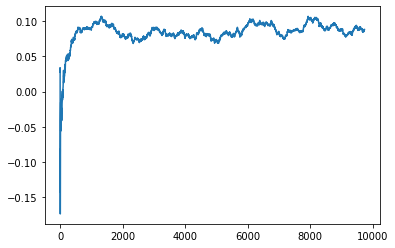

Thread: 6 iteration: 1620
RAM mDiffFit_137 FROM: 832 --> 896 reward: -0.007653650390624985
Thread: 1 iteration: 1545
RAM mProject_41 FROM: 1856 --> 768 reward: -1.0
Thread: 2 iteration: 1606
RAM mDiffFit_64 FROM: 832 --> 896 reward: -0.10989329570312499
Thread: 6 iteration: 1621
RAM mDiffFit_383 FROM: 1216 --> 896 reward: 0.14080216718750002
Thread: 1 iteration: 1546
RAM mDiffFit_79 FROM: 1536 --> 896 reward: 0.028281239062499988
Thread: 6 iteration: 1622
RAM mProject_7 FROM: 384 --> 896 reward: 0.547574553703125
Thread: 3 iteration: 1617
RAM mBackground_46 FROM: 2752 --> 896 reward: 0.07731480020312508
Thread: 2 iteration: 1607
RAM mDiffFit_104 FROM: 2496 --> 896 reward: 0.03804681484374999
Thread: 1 iteration: 1547
RAM mProject_16 FROM: 2560 --> 896 reward: 0.10324090743750013
Thread: 4 iteration: 1623
RAM mDiffFit_234 FROM: 1728 --> 896 reward: 0.020937478124999995
Thread: 6 iteration: 1623
RAM mDiffFit_333 FROM: 448 --> 896 reward: -0.10181511054687498
Thread: 3 iteration: 1618
RAM

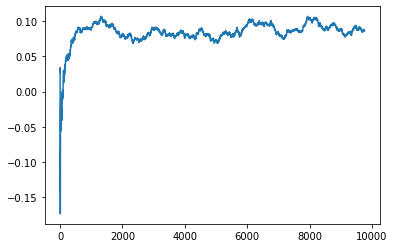

Thread: 1 iteration: 1550
RAM mDiffFit_372 FROM: 448 --> 896 reward: -0.07199999999999998
Thread: 6 iteration: 1625
RAM mBackground_9 FROM: 384 --> 896 reward: -0.22382394265624994
Thread: 5 iteration: 1725
RAM mDiffFit_226 FROM: 2176 --> 896 reward: -0.054812609375000015
Saving ...


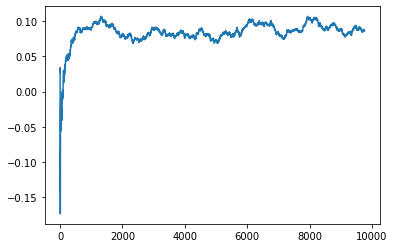

Thread: 3 iteration: 1620
RAM mDiffFit_61 FROM: 2048 --> 896 reward: -0.06972406953125002
Saving ...


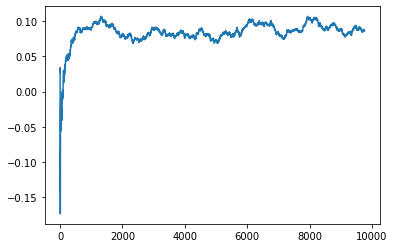

Thread: 2 iteration: 1610
RAM mDiffFit_31 FROM: 2368 --> 896 reward: -0.05578395898437499
Thread: 6 iteration: 1626
RAM mDiffFit_147 FROM: 1856 --> 896 reward: -0.022513118359374987
Thread: 1 iteration: 1551
RAM mDiffFit_244 FROM: 2240 --> 896 reward: 0.010674447265625001
Thread: 5 iteration: 1726
RAM mDiffFit_91 FROM: 1344 --> 896 reward: -0.01426566328125
Thread: 3 iteration: 1621
RAM mDiffFit_65 FROM: 2816 --> 896 reward: 0.006999956249999998
Thread: 2 iteration: 1611
RAM mDiffFit_250 FROM: 384 --> 896 reward: -0.10422915937499999
Thread: 1 iteration: 1552
RAM mProject_88 FROM: 2048 --> 896 reward: 0.24653896045312496
Thread: 4 iteration: 1626
RAM mDiffFit_215 FROM: 1536 --> 896 reward: -0.06841154765624997
Thread: 3 iteration: 1622
RAM mDiffFit_303 FROM: 192 --> 896 reward: -0.31048438046875004
Thread: 2 iteration: 1612
RAM mDiffFit_11 FROM: 1984 --> 896 reward: 0.024901017968750015
Thread: 1 iteration: 1553
RAM mDiffFit_250 FROM: 1728 --> 896 reward: 0.067252632421875
Thread: 4 it

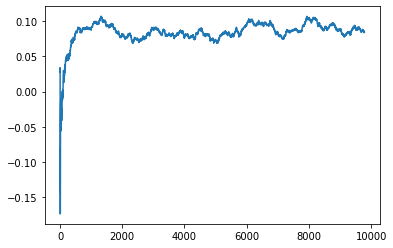

Thread: 5 iteration: 1730
RAM mDiffFit_346 FROM: 2240 --> 896 reward: 0.04716400507812503
Thread: 3 iteration: 1627
RAM mBgModel_1 FROM: 1792 --> 896 reward: 0.1322937346875
Thread: 2 iteration: 1617
RAM mDiffFit_302 FROM: 2112 --> 896 reward: 0.071924447265625
Thread: 6 iteration: 1629
RAM mDiffFit_399 FROM: 1728 --> 896 reward: 0.013187478124999999
Thread: 3 iteration: 1628
RAM mProject_90 FROM: 1088 --> 896 reward: 0.12249235342968733
Thread: 1 iteration: 1555
RAM mProject_79 FROM: 640 --> 896 reward: 0.9260865645468751
Thread: 4 iteration: 1629
RAM mDiffFit_334 FROM: 2368 --> 896 reward: 0.019463496093749984
Thread: 3 iteration: 1629
RAM mDiffFit_330 FROM: 2176 --> 896 reward: -0.01132818515625
Thread: 1 iteration: 1556
RAM mDiffFit_398 FROM: 1280 --> 896 reward: -0.07989070703124998
Saving ...


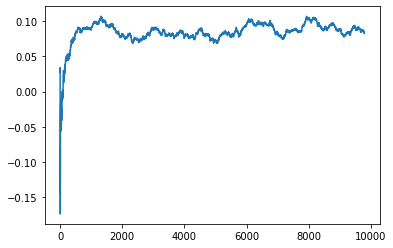

Thread: 4 iteration: 1630
RAM mDiffFit_270 FROM: 2048 --> 896 reward: -0.007609467968749985
Saving ...


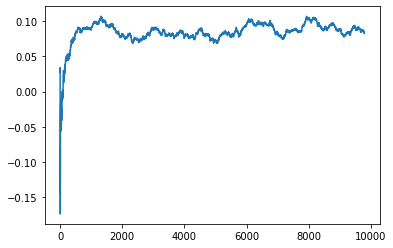

Thread: 6 iteration: 1630
RAM mAdd_3 FROM: 2432 --> 896 reward: 0.177791528125
Thread: 2 iteration: 1618
RAM mDiffFit_23 FROM: 2240 --> 896 reward: 0.03723955781250002
Saving ...


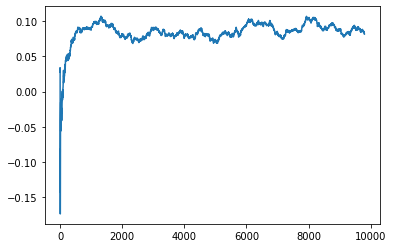

Thread: 3 iteration: 1630
RAM mDiffFit_336 FROM: 1920 --> 896 reward: 0.017260398437499998
Thread: 2 iteration: 1619
RAM mDiffFit_302 FROM: 832 --> 896 reward: -0.03788022109375004
Thread: 4 iteration: 1631
RAM mBackground_35 FROM: 1792 --> 896 reward: 0.057064539437499985
Thread: 1 iteration: 1557
RAM mDiffFit_213 FROM: 2752 --> 896 reward: 0.062455686328125
Thread: 6 iteration: 1631
RAM mProject_89 FROM: 1600 --> 896 reward: 0.26275218060937505
Thread: 5 iteration: 1731
RAM mDiffFit_35 FROM: 2688 --> 896 reward: -0.013531326562500005
Thread: 5 iteration: 1732
RAM mBackground_63 FROM: 1472 --> 896 reward: 0.0704908705234375
Saving ...


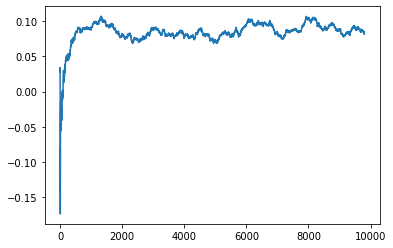

Thread: 2 iteration: 1620
RAM mBackground_58 FROM: 2624 --> 896 reward: 0.020480844570312462
Thread: 6 iteration: 1632
RAM mDiffFit_337 FROM: 2048 --> 896 reward: 0.026979115624999987
Thread: 4 iteration: 1632
RAM mDiffFit_223 FROM: 2368 --> 896 reward: -0.06539075078124999
Thread: 1 iteration: 1558
RAM mDiffFit_7 FROM: 2496 --> 896 reward: 0.0042056863281249995
Thread: 5 iteration: 1733
RAM mDiffFit_223 FROM: 2560 --> 896 reward: 0.0030884960937500004
Thread: 2 iteration: 1621
RAM mBackground_39 FROM: 1472 --> 896 reward: 0.05049138038281254
Thread: 6 iteration: 1633
RAM mDiffFit_336 FROM: 1536 --> 896 reward: -0.014286503906249994
Thread: 4 iteration: 1633
RAM mDiffFit_173 FROM: 1664 --> 896 reward: 0.014854159375000007
Thread: 1 iteration: 1559
RAM mDiffFit_207 FROM: 2944 --> 896 reward: 0.040020796875000014
Thread: 2 iteration: 1622
RAM mProject_11 FROM: 1792 --> 896 reward: 0.30532406020312514
Thread: 3 iteration: 1631
RAM mDiffFit_163 FROM: 1472 --> 896 reward: 0.0122525886718750

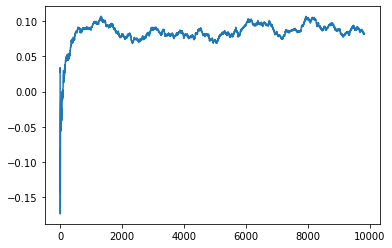

Thread: 1 iteration: 1560
RAM mDiffFit_248 FROM: 1792 --> 1280 reward: 0.09038548593750001
Thread: 3 iteration: 1635
RAM mDiffFit_349 FROM: 384 --> 1280 reward: -0.03323951406250001
Thread: 1 iteration: 1561
RAM mProject_62 FROM: 1728 --> 896 reward: 0.2638841857734376
Thread: 6 iteration: 1635
RAM mDiffFit_71 FROM: 192 --> 1280 reward: -0.17389053203125002
Thread: 5 iteration: 1735
RAM mDiffFit_194 FROM: 832 --> 1280 reward: -0.01589320820312502
Thread: 3 iteration: 1636
RAM mDiffFit_384 FROM: 1600 --> 1280 reward: 0.010375000000000002
Thread: 6 iteration: 1636
RAM mDiffFit_200 FROM: 1024 --> 1280 reward: 0.016479203125000022
Thread: 1 iteration: 1562
RAM mDiffFit_395 FROM: 640 --> 1280 reward: -0.09986460156249999
Thread: 5 iteration: 1736
RAM mDiffFit_101 FROM: 896 --> 1280 reward: -0.025447920312499997
Thread: 3 iteration: 1637
RAM mDiffFit_134 FROM: 1280 --> 1280 reward: -0.07920840624999997
Thread: 6 iteration: 1637
RAM mProject_85 FROM: 2112 --> 1280 reward: 0.06262066722656236


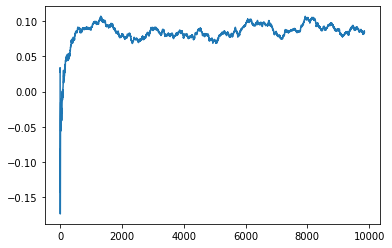

Thread: 3 iteration: 1640
RAM mAdd_1 FROM: 128 --> 1280 reward: 0.59190154296875
Thread: 2 iteration: 1629
RAM mBackground_52 FROM: 1280 --> 1280 reward: -0.013321057343750069
Thread: 1 iteration: 1564
RAM mProject_74 FROM: 2112 --> 1280 reward: 0.06534129550781233
Thread: 6 iteration: 1638
RAM mProject_24 FROM: 896 --> 1280 reward: -0.19009313353125018
Thread: 5 iteration: 1738
RAM mDiffFit_200 FROM: 1280 --> 1280 reward: -0.04747920312500001
Thread: 3 iteration: 1641
RAM mDiffFit_194 FROM: 2688 --> 1280 reward: -0.0053385835937500015
Saving ...


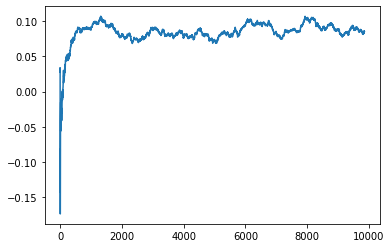

Thread: 2 iteration: 1630
RAM mDiffFit_271 FROM: 576 --> 1280 reward: -0.028877588671875013
Thread: 1 iteration: 1565
RAM mDiffFit_254 FROM: 2752 --> 1280 reward: -0.04492716718749999
Thread: 6 iteration: 1639
RAM mDiffFit_167 FROM: 128 --> 1280 reward: -0.6421770796874999
Thread: 5 iteration: 1739
RAM mBackground_65 FROM: 1856 --> 1280 reward: -0.03210450311718752
Thread: 3 iteration: 1642
RAM mProject_90 FROM: 2944 --> 1280 reward: -0.09178823151562517
Thread: 4 iteration: 1639
RAM mDiffFit_154 FROM: 896 --> 1280 reward: 0.03541150390624999
Thread: 1 iteration: 1566
RAM mDiffFit_166 FROM: 2688 --> 1280 reward: -0.030229246874999994
Saving ...


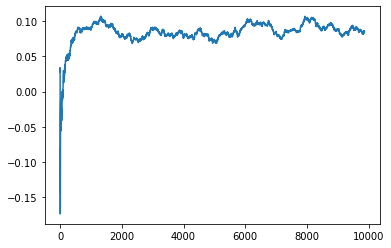

Thread: 6 iteration: 1640
RAM mDiffFit_98 FROM: 1024 --> 1280 reward: 0.010739601562500013
Saving ...


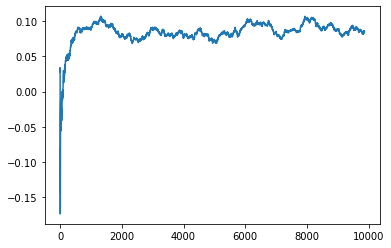

Thread: 5 iteration: 1740
RAM mDiffFit_383 FROM: 512 --> 1280 reward: -0.041333318750000014
Thread: 3 iteration: 1643
RAM mBackground_59 FROM: 384 --> 1280 reward: -0.38453648028125
Thread: 2 iteration: 1631
RAM mDiffFit_70 FROM: 1152 --> 1280 reward: -0.011182300781250008
Thread: 1 iteration: 1567
RAM mBackground_52 FROM: 1728 --> 1280 reward: 0.007321168914062501
Thread: 3 iteration: 1644
RAM mDiffFit_257 FROM: 1152 --> 1280 reward: 0.04675004374999999
Thread: 1 iteration: 1568
RAM mBackground_67 FROM: 256 --> 1280 reward: -0.59595313440625
Thread: 2 iteration: 1632
RAM mProject_31 FROM: 320 --> 1280 reward: 0.73487874515625
Saving ...


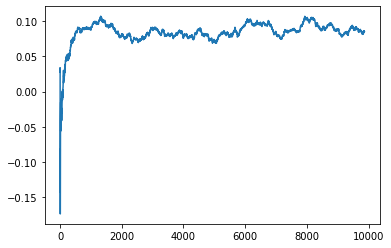

Thread: 4 iteration: 1640
RAM mBackground_23 FROM: 640 --> 1280 reward: -0.08748254929687506
Thread: 3 iteration: 1645
RAM mDiffFit_226 FROM: 2304 --> 1280 reward: 0.057458362499999985
Thread: 1 iteration: 1569
RAM mDiffFit_301 FROM: 1152 --> 1280 reward: 0.03907296406249998
Thread: 4 iteration: 1641
RAM mProject_73 FROM: 2816 --> 1280 reward: -0.054890980031249835
Thread: 6 iteration: 1641
RAM mProject_60 FROM: 1088 --> 1280 reward: -0.06998390050781246
Thread: 5 iteration: 1741
RAM mDiffFit_398 FROM: 1408 --> 1280 reward: -0.0039323007812499915
Thread: 3 iteration: 1646
RAM mDiffFit_108 FROM: 1792 --> 1280 reward: 0.006677079687499995
Saving ...


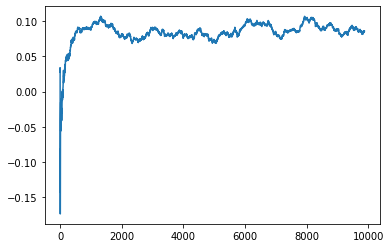

Thread: 1 iteration: 1570
RAM mDiffFit_364 FROM: 2880 --> 1280 reward: 0.023914048828124982
Thread: 5 iteration: 1742
RAM mDiffFit_241 FROM: 1344 --> 1280 reward: -0.058328185156250004
Thread: 3 iteration: 1647
RAM mDiffFit_423 FROM: 2496 --> 1280 reward: -0.09443243203124999
Thread: 4 iteration: 1642
RAM mDiffFit_319 FROM: 256 --> 1280 reward: -0.14483331875000002
Thread: 1 iteration: 1571
RAM mDiffFit_374 FROM: 3008 --> 1280 reward: -0.016049534765625005
Thread: 5 iteration: 1743
RAM mDiffFit_88 FROM: 128 --> 1280 reward: -0.9858020796874999
Thread: 4 iteration: 1643
RAM mProject_55 FROM: 1408 --> 1280 reward: 0.0502462591874999
Thread: 6 iteration: 1642
RAM mDiffFit_154 FROM: 1920 --> 2816 reward: 0.06619800781250003
Thread: 5 iteration: 1744
RAM mBackground_4 FROM: 1408 --> 2816 reward: 0.07571154385937502
Thread: 4 iteration: 1644
RAM mBackground_71 FROM: 448 --> 2816 reward: -0.20846472495312499
Thread: 6 iteration: 1643
RAM mBackground_22 FROM: 448 --> 2816 reward: -0.1556217397

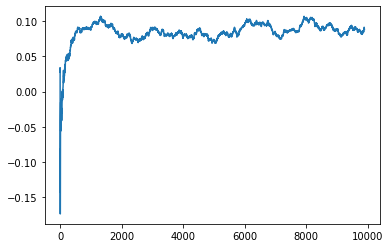

Thread: 3 iteration: 1650
RAM mDiffFit_10 FROM: 3008 --> 2816 reward: 0.026231791796875042
Thread: 2 iteration: 1635
RAM mDiffFit_352 FROM: 2432 --> 2816 reward: -0.02950522109375001
Thread: 4 iteration: 1646
RAM mProject_18 FROM: 320 --> 2816 reward: 0.7836497173125002
Thread: 1 iteration: 1573
RAM mDiffFit_246 FROM: 640 --> 2816 reward: -0.05742181484375001
Thread: 6 iteration: 1646
RAM mDiffFit_272 FROM: 1856 --> 2816 reward: -0.024299491015625004
Thread: 5 iteration: 1748
RAM mBackground_51 FROM: 768 --> 2816 reward: -0.07740882978125
Thread: 3 iteration: 1651
RAM mDiffFit_128 FROM: 832 --> 2816 reward: -0.013890575781250001
Thread: 2 iteration: 1636
RAM mDiffFit_182 FROM: 1280 --> 2816 reward: -0.05127084062499999
Thread: 4 iteration: 1647
RAM mDiffFit_184 FROM: 640 --> 2816 reward: -0.07454163750000004
Thread: 1 iteration: 1574
RAM mBackground_13 FROM: 832 --> 2816 reward: -0.132130857546875
Thread: 6 iteration: 1647
RAM mDiffFit_93 FROM: 1344 --> 2816 reward: 0.00562504375000001

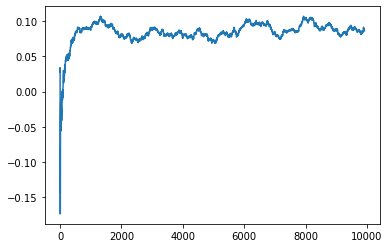

Thread: 5 iteration: 1750
RAM mDiffFit_1 FROM: 1664 --> 2240 reward: 0.44766457382812486
Thread: 6 iteration: 1649
RAM mProject_10 FROM: 448 --> 2816 reward: 0.8012503639687499
Thread: 4 iteration: 1649
RAM mDiffFit_34 FROM: 2624 --> 2240 reward: -0.010906282812500022
Thread: 1 iteration: 1577
RAM mBackground_14 FROM: 384 --> 2816 reward: -0.42033386740625006
Thread: 2 iteration: 1639
RAM mBackground_36 FROM: 1344 --> 2816 reward: -0.0016571756562500054
Thread: 3 iteration: 1655
RAM mDiffFit_317 FROM: 704 --> 2240 reward: -0.007289005078124997
Saving ...


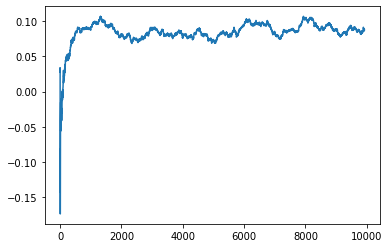

Thread: 6 iteration: 1650
RAM mDiffFit_404 FROM: 1472 --> 2240 reward: -0.007731748046875004
Thread: 1 iteration: 1578
RAM mDiffFit_272 FROM: 384 --> 2240 reward: -0.11821349609375001
Saving ...


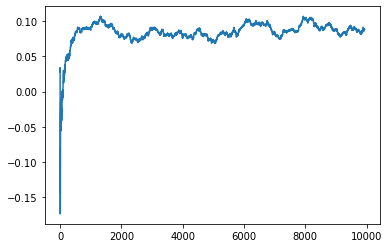

Thread: 4 iteration: 1650
RAM mDiffFit_81 FROM: 832 --> 2240 reward: -0.020695287890624987
Thread: 3 iteration: 1656
RAM mDiffFit_386 FROM: 1472 --> 2240 reward: -0.029557300781250014
Saving ...


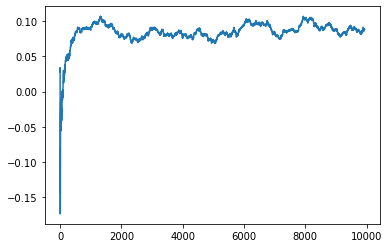

Thread: 2 iteration: 1640
RAM mDiffFit_76 FROM: 192 --> 2240 reward: -0.18199995625000004
Thread: 6 iteration: 1651
RAM mProject_8 FROM: 2176 --> 2240 reward: 0.017230340390624953
Thread: 5 iteration: 1751
RAM mDiffFit_45 FROM: 3008 --> 2240 reward: -0.018906282812500008
Thread: 1 iteration: 1579
RAM mDiffFit_108 FROM: 2240 --> 2240 reward: -0.0031250000000000028
Thread: 5 iteration: 1752
RAM mDiffFit_201 FROM: 2752 --> 2240 reward: -0.03780475585937497
Thread: 6 iteration: 1652
RAM mBackground_45 FROM: 1472 --> 1728 reward: 0.025325249093749957
Thread: 3 iteration: 1657
RAM mBackground_47 FROM: 3008 --> 1728 reward: -0.024807973539062472
Thread: 2 iteration: 1641
RAM mDiffFit_84 FROM: 2560 --> 2240 reward: -0.003960951171874984
Saving ...


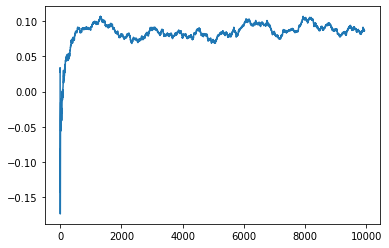

Thread: 1 iteration: 1580
RAM mProject_69 FROM: 448 --> 2816 reward: 0.7724034528750001
Thread: 4 iteration: 1651
RAM mDiffFit_81 FROM: 1856 --> 2240 reward: 0.00881252187499999
Thread: 3 iteration: 1658
RAM mBackground_59 FROM: 2432 --> 1728 reward: -0.012606667101562547
Thread: 6 iteration: 1653
RAM mBgModel_1 FROM: 1408 --> 1152 reward: 0.05732500874999996
Thread: 1 iteration: 1581
RAM mBackground_31 FROM: 2112 --> 1728 reward: -0.016944739234375027
Thread: 3 iteration: 1659
RAM mBackground_9 FROM: 2944 --> 2240 reward: -0.04871327192968752
Thread: 6 iteration: 1654
RAM mProject_31 FROM: 1984 --> 2240 reward: 0.04492696359375015
Thread: 5 iteration: 1753
RAM mDiffFit_306 FROM: 2752 --> 2240 reward: -0.014583362499999992
Saving ...


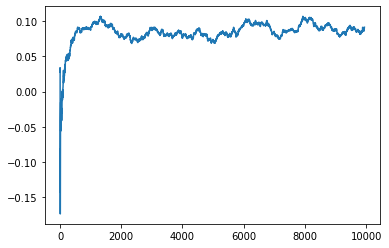

Thread: 3 iteration: 1660
RAM mDiffFit_347 FROM: 2368 --> 2240 reward: 0.541039661328125
Thread: 1 iteration: 1582
RAM mDiffFit_132 FROM: 640 --> 2240 reward: -0.017242146484375
Thread: 3 iteration: 1661
RAM mProject_47 FROM: 960 --> 1152 reward: -0.08648858636718766
Thread: 2 iteration: 1642
RAM mBackground_68 FROM: 448 --> 2240 reward: -0.24474606901562496
Thread: 3 iteration: 1662
RAM mDiffFit_183 FROM: 2176 --> 2240 reward: -0.08025008750000004
Thread: 1 iteration: 1583
RAM mProject_11 FROM: 2176 --> 1152 reward: 0.11429331117187502
Thread: 4 iteration: 1652
RAM mDiffFit_171 FROM: 2304 --> 2240 reward: -0.027773473046875004
Thread: 2 iteration: 1643
RAM mDiffFit_185 FROM: 1984 --> 2240 reward: 0.0015937609375000095
Thread: 3 iteration: 1663
RAM mProject_21 FROM: 1472 --> 1152 reward: 0.12739830110156244
Thread: 6 iteration: 1655
RAM mBackground_88 FROM: 2944 --> 2240 reward: -0.06791324728125
Thread: 1 iteration: 1584
RAM mDiffFit_208 FROM: 512 --> 2240 reward: -0.224169313671875
T

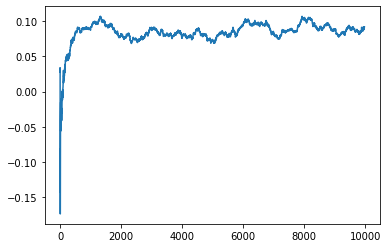

Thread: 6 iteration: 1660
RAM mProject_66 FROM: 1152 --> 1152 reward: 0.005855630906249931
Thread: 2 iteration: 1647
RAM mProject_7 FROM: 896 --> 1152 reward: -0.1292990575781249
Thread: 5 iteration: 1756
RAM mProject_63 FROM: 2240 --> 2240 reward: 0.011164698984374876
Thread: 3 iteration: 1668
RAM mProject_66 FROM: 2112 --> 2240 reward: 0.0273952069453125
Thread: 1 iteration: 1588
RAM mDiffFit_413 FROM: 2304 --> 2240 reward: 0.0014270796874999922
Thread: 6 iteration: 1661
RAM mDiffFit_228 FROM: 1856 --> 2240 reward: 0.03301307460937501
Thread: 5 iteration: 1757
RAM mProject_60 FROM: 1920 --> 2240 reward: 0.050732919140625034
Thread: 4 iteration: 1659
RAM mDiffFit_68 FROM: 1664 --> 2240 reward: 1.62473621796875
Thread: 2 iteration: 1648
RAM mDiffFit_198 FROM: 512 --> 2240 reward: -0.04519006679687501
Thread: 1 iteration: 1589
RAM mDiffFit_83 FROM: 960 --> 2240 reward: -0.01395309765625
Thread: 6 iteration: 1662
RAM mDiffFit_7 FROM: 1600 --> 2240 reward: 0.03412245507812499
Thread: 5 it

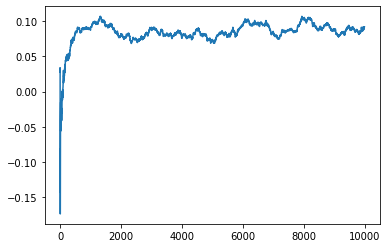

Thread: 4 iteration: 1660
RAM mDiffFit_76 FROM: 768 --> 2240 reward: -0.12279168125
Thread: 4 iteration: 1661
RAM mBackground_4 FROM: 576 --> 1728 reward: -0.13606134275781243
Thread: 2 iteration: 1649
RAM mBackground_63 FROM: 1152 --> 1728 reward: 0.03147070965625002
Thread: 6 iteration: 1663
RAM mProject_90 FROM: 1152 --> 1152 reward: 0.005661565453124939
Thread: 3 iteration: 1669
RAM mDiffFit_377 FROM: 1984 --> 2240 reward: 0.005291681250000017
Thread: 4 iteration: 1662
RAM mDiffFit_162 FROM: 3008 --> 2240 reward: 0.0036692699218750235
Saving ...


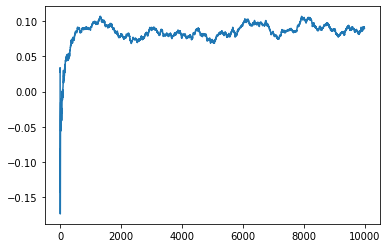

Thread: 2 iteration: 1650
RAM mDiffFit_82 FROM: 2304 --> 2240 reward: -0.08558603867187499
Thread: 6 iteration: 1664
RAM mImgtbl_1 FROM: 1920 --> 2240 reward: 0.013875043749999982
Saving ...


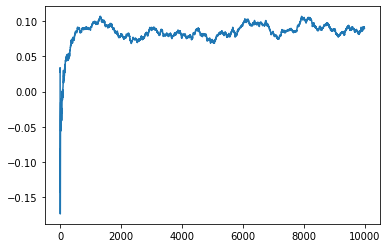

Thread: 3 iteration: 1670
RAM mProject_28 FROM: 704 --> 1728 reward: 0.6377532896953125
Saving ...


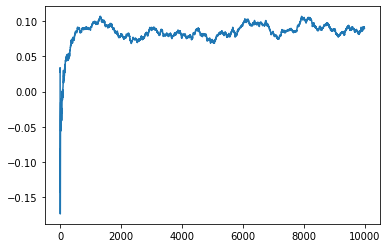

Thread: 1 iteration: 1590
RAM mDiffFit_264 FROM: 896 --> 2240 reward: 0.00039588437499999893
Thread: 2 iteration: 1651
RAM mDiffFit_348 FROM: 512 --> 2240 reward: -0.131294269921875
Thread: 1 iteration: 1591
RAM mProject_55 FROM: 2752 --> 1152 reward: 0.0071012268281250394
Thread: 5 iteration: 1759
RAM mDiffFit_54 FROM: 768 --> 2240 reward: -0.038179668359375
Thread: 3 iteration: 1671
RAM mDiffFit_105 FROM: 512 --> 2240 reward: -0.224544313671875
Thread: 6 iteration: 1665
RAM mDiffFit_375 FROM: 1920 --> 2240 reward: -0.0048749999999999835
Thread: 2 iteration: 1652
RAM mProject_47 FROM: 1856 --> 2240 reward: 0.05273308933593749
Thread: 4 iteration: 1663
RAM mDiffFit_412 FROM: 2624 --> 2240 reward: -0.005703141406250018
Thread: 1 iteration: 1592
RAM mDiffFit_369 FROM: 2112 --> 2240 reward: -0.002265619531249992
Thread: 3 iteration: 1672
RAM mDiffFit_180 FROM: 3008 --> 2240 reward: 0.00841926992187502
Saving ...


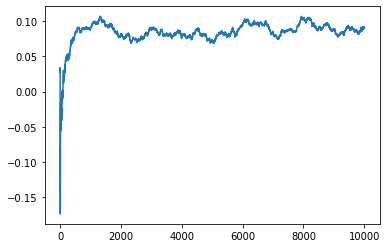

Thread: 5 iteration: 1760
RAM mDiffFit_423 FROM: 2112 --> 2240 reward: 0.001770840624999992
Thread: 6 iteration: 1666
RAM mDiffFit_57 FROM: 1984 --> 2240 reward: -0.01653387148437501
Thread: 2 iteration: 1653
RAM mDiffFit_275 FROM: 1216 --> 2240 reward: 0.002966172265625013
Thread: 4 iteration: 1664
RAM mDiffFit_254 FROM: 2112 --> 2240 reward: -0.000765619531250001
Thread: 3 iteration: 1673
RAM mDiffFit_108 FROM: 3008 --> 2240 reward: -0.08786991015624998
Thread: 5 iteration: 1761
RAM mDiffFit_34 FROM: 704 --> 2240 reward: -0.12689320820312502
Thread: 6 iteration: 1667
RAM mDiffFit_137 FROM: 512 --> 2240 reward: -0.13569011054687502
Thread: 1 iteration: 1593
RAM mDiffFit_2 FROM: 1280 --> 2240 reward: -0.00446349609374997
Thread: 2 iteration: 1654
RAM mDiffFit_35 FROM: 2240 --> 2240 reward: 0.078226658203125
Thread: 5 iteration: 1762
RAM mDiffFit_98 FROM: 2176 --> 2240 reward: -0.03312763242187501
Thread: 1 iteration: 1594
RAM mDiffFit_323 FROM: 960 --> 2240 reward: -0.13854690234374997

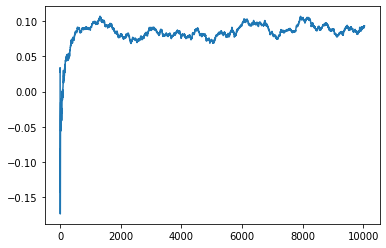

Thread: 4 iteration: 1670
RAM mDiffFit_229 FROM: 256 --> 2176 reward: -0.12323433671875
Thread: 3 iteration: 1678
RAM mDiffFit_315 FROM: 2112 --> 2176 reward: 0.02344274296874999
Saving ...


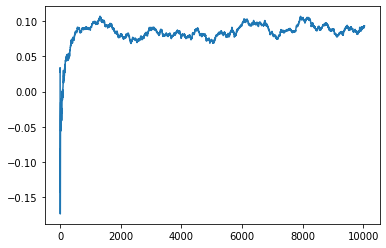

Thread: 2 iteration: 1660
RAM mProject_64 FROM: 1664 --> 1152 reward: 0.12610404182812504
Saving ...


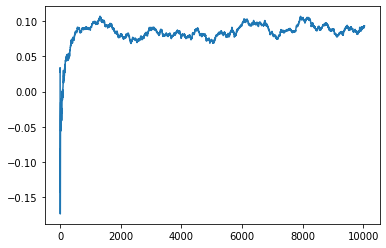

Thread: 6 iteration: 1670
RAM mDiffFit_258 FROM: 1664 --> 2176 reward: 0.021083362500000005
Thread: 4 iteration: 1671
RAM mDiffFit_99 FROM: 1024 --> 2176 reward: 0.004104203124999997
Thread: 2 iteration: 1661
RAM mDiffFit_46 FROM: 1984 --> 2176 reward: 0.008843760937500018
Thread: 6 iteration: 1671
RAM mProject_54 FROM: 2496 --> 1152 reward: 0.043870530726562426
Thread: 5 iteration: 1764
RAM mProject_74 FROM: 448 --> 1728 reward: 0.6452879860546875
Thread: 1 iteration: 1599
RAM mDiffFit_416 FROM: 1600 --> 2176 reward: 0.0137812828125
Thread: 5 iteration: 1765
RAM mDiffFit_33 FROM: 1856 --> 2176 reward: -0.04869274296875
Thread: 2 iteration: 1662
RAM mBgModel_2 FROM: 1216 --> 320 reward: 0.63404689359375
Thread: 3 iteration: 1679
RAM mDiffFit_262 FROM: 1152 --> 2176 reward: 0.001171902343750017
Saving ...


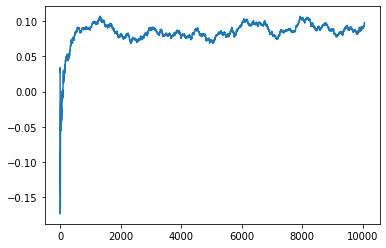

Thread: 3 iteration: 1680
RAM mDiffFit_44 FROM: 3008 --> 2176 reward: -0.08928659140624998
Thread: 2 iteration: 1663
RAM mProject_17 FROM: 704 --> 1728 reward: 0.6366957896953125
Thread: 4 iteration: 1672
RAM mDiffFit_291 FROM: 1664 --> 2176 reward: 0.001401061718750013
Thread: 2 iteration: 1664
RAM mDiffFit_180 FROM: 704 --> 2176 reward: -0.05990101796874998
Thread: 4 iteration: 1673
RAM mProject_57 FROM: 3008 --> 1152 reward: -0.05674404311718756
Thread: 6 iteration: 1672
RAM mProject_45 FROM: 1536 --> 1152 reward: 0.12019218848437493
Saving ...


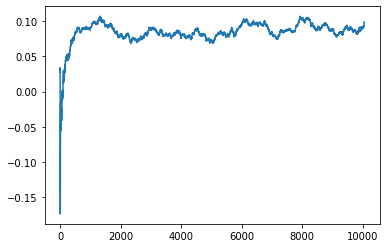

Thread: 1 iteration: 1600
RAM mDiffFit_250 FROM: 2112 --> 2176 reward: -0.045085994921875
Thread: 2 iteration: 1665
RAM mProject_71 FROM: 1088 --> 1152 reward: -0.03039328272656263
Thread: 5 iteration: 1766
RAM mDiffFit_288 FROM: 2368 --> 2176 reward: -0.03346358359375001
Thread: 2 iteration: 1666
RAM mDiffFit_250 FROM: 320 --> 2176 reward: -0.09392181484374998
Thread: 1 iteration: 1601
RAM mViewer_1 FROM: 320 --> 2176 reward: -0.4163465155781249
Thread: 4 iteration: 1674
RAM mProject_3 FROM: 1408 --> 1152 reward: 0.09001781676562502
Thread: 3 iteration: 1681
RAM mBackground_50 FROM: 2624 --> 1728 reward: -0.04913432927343755
Thread: 6 iteration: 1673
RAM mDiffFit_362 FROM: 832 --> 2176 reward: 0.002432344531250012
Thread: 5 iteration: 1767
RAM mDiffFit_319 FROM: 1216 --> 2176 reward: 0.04275267617187501
Thread: 2 iteration: 1667
RAM mDiffFit_91 FROM: 512 --> 2176 reward: -0.09011977890624998
Thread: 1 iteration: 1602
RAM mDiffFit_414 FROM: 2688 --> 2176 reward: -0.007062521874999991
T

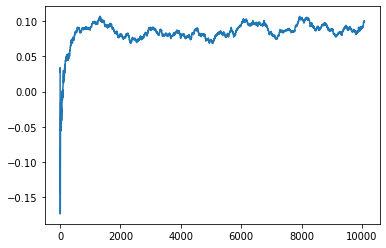

Thread: 2 iteration: 1670
RAM mBackground_79 FROM: 2304 --> 1728 reward: -0.03794085885156249
Thread: 4 iteration: 1678
RAM mBackground_44 FROM: 1088 --> 1728 reward: -0.04545680332031251
Thread: 6 iteration: 1677
RAM mBackground_7 FROM: 512 --> 1728 reward: -0.16552305915624996
Thread: 3 iteration: 1683
RAM mProject_50 FROM: 2368 --> 1152 reward: 0.0695787036328125
Thread: 5 iteration: 1769
RAM mBackground_70 FROM: 1088 --> 1728 reward: -0.09210512454687496
Thread: 1 iteration: 1605
RAM mDiffFit_286 FROM: 1088 --> 2176 reward: -0.09874223398437504
Thread: 4 iteration: 1679
RAM mDiffFit_66 FROM: 2496 --> 1152 reward: 0.032898429296875004
Thread: 6 iteration: 1678
RAM mDiffFit_28 FROM: 2560 --> 1152 reward: 0.02840623906250001
Thread: 3 iteration: 1684
RAM mDiffFit_164 FROM: 320 --> 1152 reward: -0.32464066328124996
Saving ...


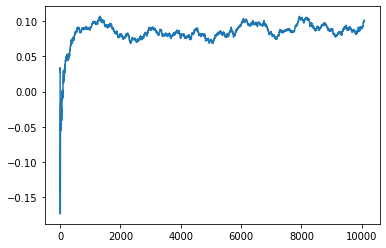

Thread: 5 iteration: 1770
RAM mDiffFit_245 FROM: 2560 --> 1152 reward: -0.0025000437499999965
Thread: 1 iteration: 1606
RAM mDiffFit_329 FROM: 1472 --> 2176 reward: -0.02204949101562501
Saving ...


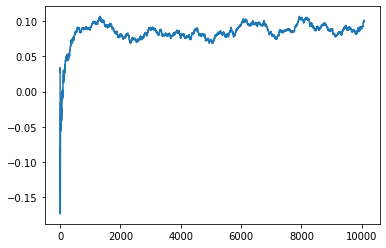

Thread: 4 iteration: 1680
RAM mDiffFit_201 FROM: 2240 --> 1152 reward: -0.010786503906250015
Thread: 6 iteration: 1679
RAM mDiffFit_181 FROM: 2432 --> 1152 reward: -0.038708406249999994
Thread: 3 iteration: 1685
RAM mDiffFit_120 FROM: 320 --> 2176 reward: -0.147945287890625
Thread: 5 iteration: 1771
RAM mDiffFit_408 FROM: 2112 --> 2176 reward: 0.031362012890625
Thread: 1 iteration: 1607
RAM mDiffFit_133 FROM: 192 --> 2176 reward: -0.23596090742187495
Thread: 4 iteration: 1681
RAM mDiffFit_40 FROM: 1408 --> 2176 reward: -0.021802079687500003
Saving ...


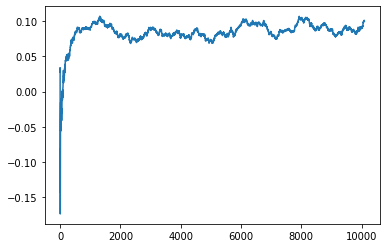

Thread: 6 iteration: 1680
RAM mProject_52 FROM: 2496 --> 1152 reward: 0.03977412496874992
Thread: 2 iteration: 1671
RAM mDiffFit_260 FROM: 1664 --> 2176 reward: 0.006708362499999992
Thread: 3 iteration: 1686
RAM mDiffFit_333 FROM: 1408 --> 2176 reward: -0.030020840624999996
Thread: 1 iteration: 1608
RAM mDiffFit_84 FROM: 1920 --> 2176 reward: 0.026338583593749996
Thread: 4 iteration: 1682
RAM mDiffFit_385 FROM: 384 --> 2176 reward: -0.08109371718750001
Thread: 2 iteration: 1672
RAM mDiffFit_74 FROM: 576 --> 2176 reward: -0.0831562390625
Thread: 6 iteration: 1681
RAM mDiffFit_408 FROM: 320 --> 2176 reward: -0.16075258867187497
Thread: 3 iteration: 1687
RAM mDiffFit_202 FROM: 1664 --> 2176 reward: 0.02905734453125001
Thread: 1 iteration: 1609
RAM mDiffFit_58 FROM: 2368 --> 2176 reward: -0.023338583593749997
Thread: 4 iteration: 1683
RAM mDiffFit_395 FROM: 2176 --> 1024 reward: 0.07548438046875
Thread: 2 iteration: 1673
RAM mDiffFit_264 FROM: 1792 --> 1024 reward: 0.12113548593750001
Thre

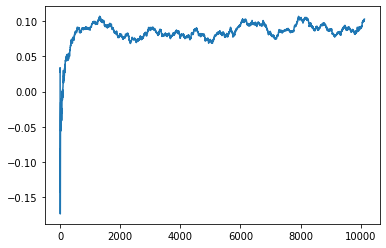

Thread: 1 iteration: 1610
RAM mDiffFit_351 FROM: 1984 --> 1152 reward: 0.05636460156250002
Thread: 2 iteration: 1677
RAM mDiffFit_269 FROM: 2496 --> 1152 reward: 0.048976570703125
Thread: 1 iteration: 1611
RAM mProject_39 FROM: 3008 --> 1152 reward: -0.03851901161718746
Thread: 4 iteration: 1685
RAM mDiffFit_247 FROM: 1600 --> 1152 reward: 0.030270840624999993
Thread: 2 iteration: 1678
RAM mDiffFit_321 FROM: 1152 --> 1152 reward: 0.021578141406249994
Thread: 1 iteration: 1612
RAM mDiffFit_168 FROM: 1920 --> 1152 reward: -0.07918760937500002
Thread: 4 iteration: 1686
RAM mProject_57 FROM: 1536 --> 1152 reward: 0.12259968848437491
Saving ...


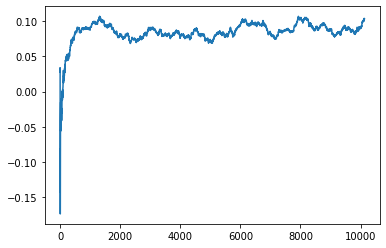

Thread: 3 iteration: 1690
RAM mProject_72 FROM: 896 --> 1152 reward: -0.1244240523281251
Thread: 6 iteration: 1685
RAM mDiffFit_126 FROM: 2368 --> 1152 reward: 0.22926575078125006
Thread: 4 iteration: 1687
RAM mProject_90 FROM: 2176 --> 1152 reward: 0.10569268026562509
Thread: 5 iteration: 1776
RAM mDiffFit_412 FROM: 2752 --> 1152 reward: -0.014601614453124984
Thread: 6 iteration: 1686
RAM mDiffFit_87 FROM: 2560 --> 1152 reward: -0.0008750437499999847
Thread: 4 iteration: 1688
RAM mBgModel_3 FROM: 1344 --> 320 reward: 0.6049645665625001
Thread: 2 iteration: 1679
RAM mDiffFit_177 FROM: 2752 --> 1152 reward: -0.016726614453124976
Thread: 6 iteration: 1687
RAM mConcatFit_1 FROM: 2624 --> 1152 reward: 0.03936869093749998
Thread: 4 iteration: 1689
RAM mProject_44 FROM: 1088 --> 1152 reward: -0.04045594767187511
Thread: 1 iteration: 1613
RAM mDiffFit_69 FROM: 1792 --> 1152 reward: -0.046421946093749986
Thread: 6 iteration: 1688
RAM mDiffFit_364 FROM: 2816 --> 1152 reward: 0.02556247812500000

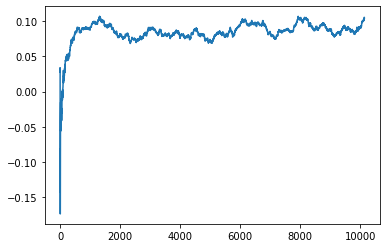

Thread: 4 iteration: 1690
RAM mBackground_74 FROM: 2688 --> 1024 reward: -0.012416419312499991
Saving ...


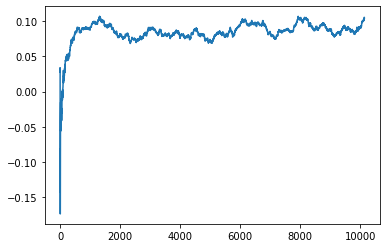

Thread: 2 iteration: 1680
RAM mBgModel_3 FROM: 3008 --> 320 reward: 0.63414041828125
Thread: 3 iteration: 1691
RAM mDiffFit_39 FROM: 2304 --> 1152 reward: 0.018796858593750007
Thread: 1 iteration: 1614
RAM mProject_63 FROM: 3008 --> 1152 reward: -0.03654135717187505
Thread: 5 iteration: 1777
RAM mBackground_43 FROM: 2688 --> 1024 reward: 0.02674052153125001
Thread: 6 iteration: 1689
RAM mDiffFit_303 FROM: 2688 --> 1152 reward: 0.028921858593750002
Thread: 1 iteration: 1615
RAM mDiffFit_336 FROM: 1472 --> 1024 reward: 0.002531239062499996
Saving ...


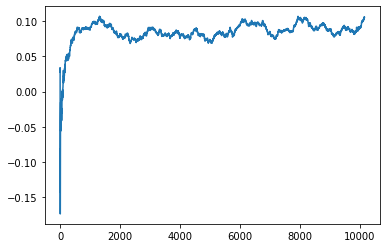

Thread: 6 iteration: 1690
RAM mDiffFit_238 FROM: 2432 --> 1152 reward: 0.013322876562500002
Thread: 5 iteration: 1778
RAM mDiffFit_60 FROM: 512 --> 1024 reward: -0.12297920312500002
Thread: 6 iteration: 1691
RAM mDiffFit_328 FROM: 1536 --> 1152 reward: 0.016546858593749977
Thread: 1 iteration: 1616
RAM mDiffFit_251 FROM: 576 --> 1024 reward: -0.03933073007812503
Thread: 5 iteration: 1779
RAM mDiffFit_163 FROM: 3008 --> 1152 reward: 0.004007766015625015
Thread: 6 iteration: 1692
RAM mProject_61 FROM: 2304 --> 1152 reward: 0.05725948373437507
Thread: 4 iteration: 1691
RAM mDiffFit_402 FROM: 2560 --> 1152 reward: -0.03860424687500001
Saving ...


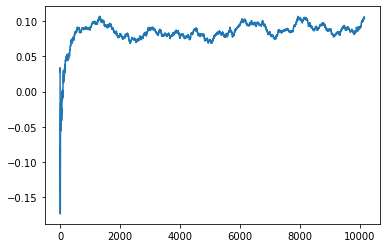

Thread: 5 iteration: 1780
RAM mProject_20 FROM: 1600 --> 1152 reward: 0.12722671202343747
Thread: 2 iteration: 1681
RAM mProject_37 FROM: 1920 --> 1152 reward: 0.1388193218437499
Thread: 3 iteration: 1692
RAM mBackground_26 FROM: 1088 --> 1216 reward: 0.029954465492187454
Thread: 1 iteration: 1617
RAM mDiffFit_56 FROM: 576 --> 1024 reward: -0.024190066796874986
Thread: 6 iteration: 1693
RAM mDiffFit_264 FROM: 1088 --> 1024 reward: -0.01977606171875002
Thread: 4 iteration: 1692
RAM mDiffFit_314 FROM: 192 --> 1152 reward: -0.6182734730468751
Thread: 2 iteration: 1682
RAM mDiffFit_238 FROM: 1152 --> 1024 reward: 0.03406252187500001
Thread: 3 iteration: 1693
RAM mDiffFit_408 FROM: 1536 --> 1024 reward: 0.02314584062499999
Thread: 6 iteration: 1694
RAM mDiffFit_136 FROM: 832 --> 1024 reward: 0.008570331640625015
Thread: 3 iteration: 1694
RAM mBackground_17 FROM: 2368 --> 1024 reward: 0.036088569015624995
Thread: 2 iteration: 1683
RAM mDiffFit_348 FROM: 2944 --> 1152 reward: -0.0529167687499

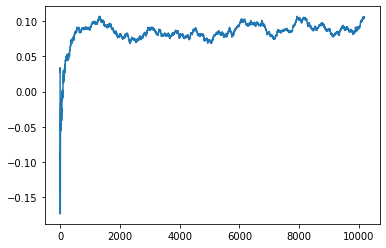

Thread: 1 iteration: 1620
RAM mDiffFit_118 FROM: 576 --> 1024 reward: -0.039164048828125006
Thread: 4 iteration: 1697
RAM mDiffFit_249 FROM: 1408 --> 1152 reward: -0.031140663281249998
Thread: 3 iteration: 1699
RAM mDiffFit_147 FROM: 832 --> 1152 reward: -0.08081774296875
Thread: 1 iteration: 1621
RAM mDiffFit_358 FROM: 2944 --> 1152 reward: -0.04279176875
Thread: 4 iteration: 1698
RAM mDiffFit_310 FROM: 768 --> 1152 reward: -0.0745312828125
Thread: 1 iteration: 1622
RAM mBackground_49 FROM: 1280 --> 1024 reward: 0.01521123118750002
Saving ...


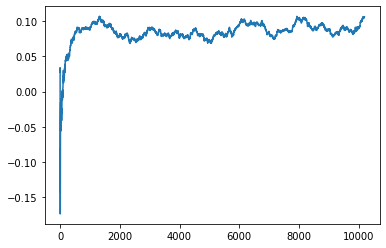

Thread: 3 iteration: 1700
RAM mProject_43 FROM: 1216 --> 1152 reward: 0.009702175359375032
Thread: 5 iteration: 1785
RAM mProject_48 FROM: 896 --> 320 reward: -1.0
Thread: 2 iteration: 1686
RAM mDiffFit_366 FROM: 1280 --> 1152 reward: -0.013807300781250014
Thread: 4 iteration: 1699
RAM mDiffFit_384 FROM: 1216 --> 1152 reward: -0.016856791796875
Thread: 1 iteration: 1623
RAM mDiffFit_105 FROM: 1984 --> 1152 reward: 0.008554668359375024
Thread: 3 iteration: 1701
RAM mBackground_78 FROM: 2688 --> 1024 reward: -0.009321294765624988
Thread: 2 iteration: 1687
RAM mProject_78 FROM: 1536 --> 1152 reward: 0.11877749999999995
Saving ...


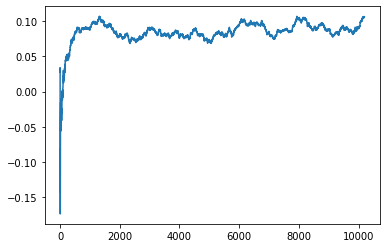

Thread: 6 iteration: 1700
RAM mDiffFit_93 FROM: 128 --> 1152 reward: -0.666687521875
Saving ...


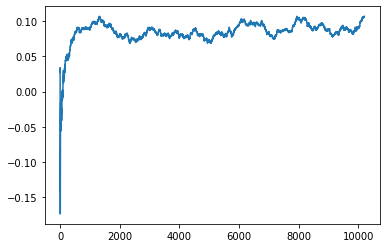

Thread: 4 iteration: 1700
RAM mDiffFit_267 FROM: 768 --> 1152 reward: -0.09562504374999997
Thread: 3 iteration: 1702
RAM mDiffFit_219 FROM: 192 --> 1152 reward: -0.21630466835937498
Thread: 2 iteration: 1688
RAM mDiffFit_208 FROM: 704 --> 1024 reward: 0.0065469023437499975
Thread: 6 iteration: 1701
RAM mDiffFit_301 FROM: 384 --> 1152 reward: -0.278062565625
Thread: 4 iteration: 1701
RAM mDiffFit_276 FROM: 1920 --> 1152 reward: 0.021031239062500005
Thread: 3 iteration: 1703
RAM mDiffFit_116 FROM: 576 --> 1024 reward: -0.019127588671874994
Thread: 2 iteration: 1689
RAM mDiffFit_94 FROM: 576 --> 1152 reward: -0.1175
Thread: 6 iteration: 1702
RAM mDiffFit_128 FROM: 1088 --> 1024 reward: 0.004471349609374998
Thread: 3 iteration: 1704
RAM mDiffFit_353 FROM: 1088 --> 1024 reward: 0.008052079687500008
Saving ...


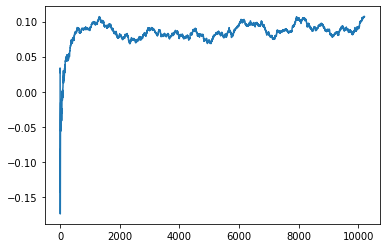

Thread: 2 iteration: 1690
RAM mDiffFit_208 FROM: 1984 --> 1152 reward: -0.017697964062499995
Thread: 6 iteration: 1703
RAM mProject_65 FROM: 1600 --> 1152 reward: 0.15527017019531256
Thread: 1 iteration: 1624
RAM mDiffFit_262 FROM: 128 --> 1152 reward: -0.40599999999999997
Thread: 3 iteration: 1705
RAM mDiffFit_415 FROM: 1216 --> 1024 reward: -0.002210951171875003
Thread: 6 iteration: 1704
RAM mProject_76 FROM: 1536 --> 1152 reward: 0.10863280364062489
Thread: 5 iteration: 1786
RAM mBackground_88 FROM: 2048 --> 1024 reward: 0.036048270625
Thread: 1 iteration: 1625
RAM mDiffFit_241 FROM: 2240 --> 1152 reward: 0.01878904882812501
Thread: 3 iteration: 1706
RAM mBackground_33 FROM: 512 --> 1024 reward: -0.2661879605625
Thread: 2 iteration: 1691
RAM mDiffFit_170 FROM: 2688 --> 1152 reward: 0.011968717187499991
Thread: 6 iteration: 1705
RAM mProject_31 FROM: 3008 --> 1152 reward: -0.03921416606250015
Thread: 4 iteration: 1702
RAM mDiffFit_247 FROM: 256 --> 1024 reward: -0.1736770796875
Threa

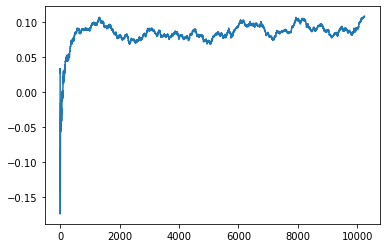

Thread: 3 iteration: 1710
RAM mBackground_89 FROM: 2176 --> 1024 reward: -0.03699358329687505
Thread: 6 iteration: 1709
RAM mDiffFit_116 FROM: 1856 --> 1152 reward: -0.0143021234375
Thread: 2 iteration: 1694
RAM mDiffFit_311 FROM: 2752 --> 1152 reward: -0.05602614921875
Thread: 3 iteration: 1711
RAM mDiffFit_111 FROM: 832 --> 1024 reward: -0.079153694140625
Saving ...


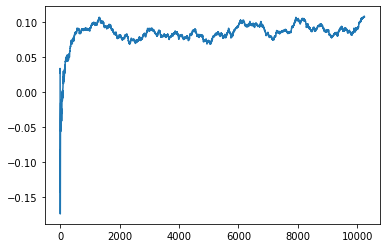

Thread: 1 iteration: 1630
RAM mDiffFit_367 FROM: 896 --> 1024 reward: 0.0014323007812499892
Saving ...


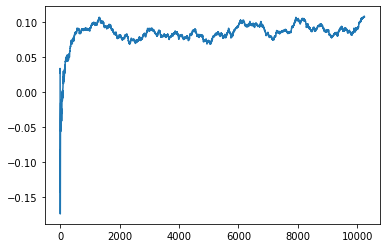

Thread: 6 iteration: 1710
RAM mDiffFit_257 FROM: 1088 --> 1024 reward: 0.013343760937499982
Thread: 6 iteration: 1711
RAM mBackground_26 FROM: 576 --> 1024 reward: -0.09397960171093747
Thread: 3 iteration: 1712
RAM mDiffFit_339 FROM: 768 --> 1024 reward: 0.021031282812500017
Thread: 6 iteration: 1712
RAM mDiffFit_286 FROM: 448 --> 1024 reward: -0.03454944726562499
Thread: 3 iteration: 1713
RAM mProject_32 FROM: 2304 --> 1152 reward: 0.0769920073593749
Thread: 5 iteration: 1789
RAM mProject_77 FROM: 1344 --> 320 reward: -1.0
Thread: 4 iteration: 1705
RAM mDiffFit_392 FROM: 2624 --> 1152 reward: -0.01349223398437501
Saving ...


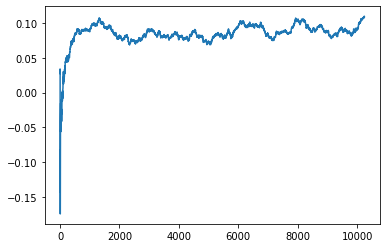

Thread: 5 iteration: 1790
RAM mDiffFit_234 FROM: 2176 --> 1152 reward: 0.03398438046874999
Thread: 6 iteration: 1713
RAM mDiffFit_380 FROM: 256 --> 1024 reward: -0.17017707968749995
Thread: 3 iteration: 1714
RAM mDiffFit_205 FROM: 2112 --> 1152 reward: -0.00030471210937499035
Thread: 4 iteration: 1706
RAM mBackground_87 FROM: 768 --> 1024 reward: -0.06639021146874999
Thread: 5 iteration: 1791
RAM mDiffFit_115 FROM: 1088 --> 1024 reward: -0.05452347304687502
Thread: 3 iteration: 1715
RAM mDiffFit_294 FROM: 1024 --> 1024 reward: -0.008999999999999998
Thread: 4 iteration: 1707
RAM mProject_83 FROM: 2560 --> 320 reward: -1.0
Thread: 2 iteration: 1695
RAM mProject_88 FROM: 960 --> 320 reward: -1.0
Thread: 1 iteration: 1631
RAM mBackground_84 FROM: 1216 --> 1024 reward: -0.17494970291406245
Thread: 5 iteration: 1792
RAM mDiffFit_419 FROM: 2176 --> 1152 reward: -0.006088583593750006
Thread: 3 iteration: 1716
RAM mDiffFit_204 FROM: 896 --> 1024 reward: -0.03520314140625001
Thread: 4 iteration:

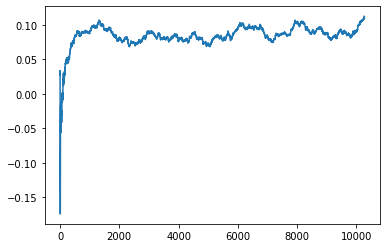

Thread: 3 iteration: 1720
RAM mProject_41 FROM: 2304 --> 320 reward: -1.0
Thread: 4 iteration: 1709
RAM mDiffFit_374 FROM: 2368 --> 2240 reward: -0.05220840624999999
Thread: 6 iteration: 1717
RAM mBackground_86 FROM: 2816 --> 1024 reward: 0.06197365593750001
Thread: 3 iteration: 1721
RAM mDiffFit_64 FROM: 3008 --> 1152 reward: 0.00263276601562501
Thread: 6 iteration: 1718
RAM mDiffFit_78 FROM: 1152 --> 1024 reward: 0.05997920312500001
Saving ...


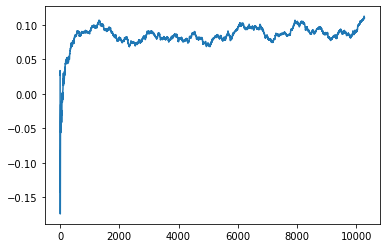

Thread: 4 iteration: 1710
RAM mProject_33 FROM: 2304 --> 320 reward: -1.0
Thread: 1 iteration: 1634
RAM mDiffFit_76 FROM: 2752 --> 2240 reward: -0.019583362499999996
Thread: 4 iteration: 1711
RAM mDiffFit_232 FROM: 2944 --> 1152 reward: -0.073937653125
Thread: 6 iteration: 1719
RAM mProject_87 FROM: 448 --> 1024 reward: 0.8281056116250001
Thread: 5 iteration: 1796
RAM mDiffFit_337 FROM: 1664 --> 2240 reward: -0.06843493320312502
Thread: 1 iteration: 1635
RAM mProject_31 FROM: 320 --> 1024 reward: 0.8361531168749999
Thread: 2 iteration: 1698
RAM mDiffFit_366 FROM: 1280 --> 1024 reward: -0.008864601562500029
Saving ...


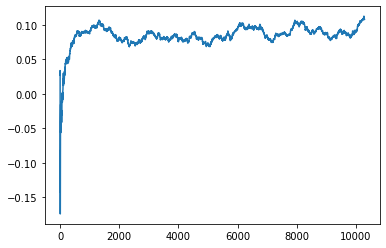

Thread: 6 iteration: 1720
RAM mDiffFit_172 FROM: 2560 --> 2240 reward: 0.023268251953125
Thread: 5 iteration: 1797
RAM mDiffFit_121 FROM: 2432 --> 2240 reward: -0.006726570703125007
Thread: 1 iteration: 1636
RAM mDiffFit_149 FROM: 2944 --> 2240 reward: -0.040877676171875016
Thread: 2 iteration: 1699
RAM mDiffFit_258 FROM: 640 --> 1024 reward: -0.10285420312500002
Thread: 6 iteration: 1721
RAM mDiffFit_113 FROM: 640 --> 2240 reward: -0.174835951171875
Thread: 5 iteration: 1798
RAM mProject_65 FROM: 704 --> 1024 reward: 0.84598562475
Thread: 3 iteration: 1722
RAM mDiffFit_347 FROM: 1600 --> 2240 reward: -0.08177610546875
Thread: 6 iteration: 1722
RAM mDiffFit_76 FROM: 1984 --> 2240 reward: -0.021481791796874983
Thread: 3 iteration: 1723
RAM mConcatFit_2 FROM: 128 --> 896 reward: -1.428012530625
Thread: 5 iteration: 1799
RAM mProject_67 FROM: 1152 --> 320 reward: -0.16348214777343745
Thread: 4 iteration: 1712
RAM mDiffFit_14 FROM: 2112 --> 2240 reward: 0.025559933203125017
Thread: 6 itera

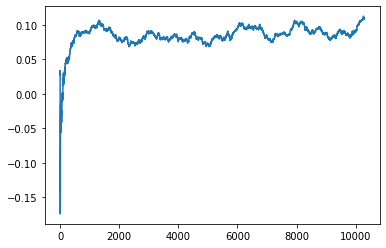

Thread: 5 iteration: 1800
RAM mDiffFit_283 FROM: 2944 --> 2240 reward: -0.004664092578125015
Thread: 4 iteration: 1713
RAM mDiffFit_278 FROM: 1664 --> 1024 reward: 0.023604159375000006
Thread: 6 iteration: 1724
RAM mDiffFit_193 FROM: 448 --> 1024 reward: -0.169648473046875
Thread: 5 iteration: 1801
RAM mDiffFit_253 FROM: 1408 --> 2240 reward: -0.02840623906249999
Thread: 4 iteration: 1714
RAM mDiffFit_220 FROM: 1536 --> 1024 reward: 0.00245831874999998
Thread: 6 iteration: 1725
RAM mDiffFit_90 FROM: 1344 --> 1024 reward: -0.009950552734374982
Thread: 6 iteration: 1726
RAM mBackground_51 FROM: 640 --> 1024 reward: -0.136780336015625
Thread: 5 iteration: 1802
RAM mConcatFit_3 FROM: 1728 --> 1216 reward: -0.03371674249999995
Thread: 4 iteration: 1715
RAM mProject_76 FROM: 1984 --> 320 reward: -1.0
Thread: 1 iteration: 1637
RAM mProject_42 FROM: 2816 --> 320 reward: -1.0
Saving ...


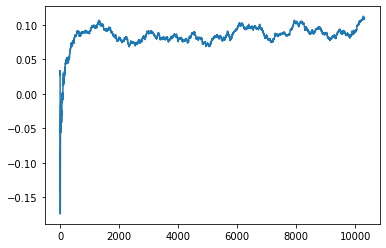

Thread: 2 iteration: 1700
RAM mDiffFit_409 FROM: 576 --> 1024 reward: -0.14187504374999999
Thread: 5 iteration: 1803
RAM mProject_27 FROM: 1984 --> 320 reward: -1.0
Thread: 3 iteration: 1724
RAM mBackground_56 FROM: 2816 --> 1024 reward: -0.006620361968749988
Thread: 6 iteration: 1727
RAM mBackground_40 FROM: 2112 --> 1024 reward: 0.06620652957812498
Thread: 4 iteration: 1716
RAM mDiffFit_390 FROM: 512 --> 1024 reward: -0.13147915937500002
Thread: 2 iteration: 1701
RAM mDiffFit_121 FROM: 2752 --> 2240 reward: 0.01538803085937502
Thread: 5 iteration: 1804
RAM mDiffFit_41 FROM: 2112 --> 1024 reward: 0.058674491015625024
Thread: 3 iteration: 1725
RAM mDiffFit_283 FROM: 1344 --> 1024 reward: -0.034838583593750014
Thread: 4 iteration: 1717
RAM mDiffFit_25 FROM: 2496 --> 2240 reward: -0.0009687609375000003
Thread: 2 iteration: 1702
RAM mBackground_19 FROM: 2752 --> 1024 reward: 0.011927896984375045
Thread: 6 iteration: 1728
RAM mDiffFit_115 FROM: 640 --> 1024 reward: 0.0070469023437499945
Th

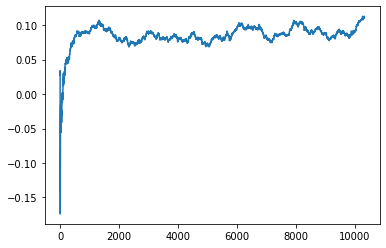

Thread: 1 iteration: 1640
RAM mBackground_67 FROM: 1024 --> 1024 reward: -0.030386691749999983
Thread: 1 iteration: 1641
RAM mDiffFit_272 FROM: 640 --> 1024 reward: -0.03924999999999999
Thread: 1 iteration: 1642
RAM mProject_28 FROM: 2816 --> 320 reward: -1.0
Saving ...


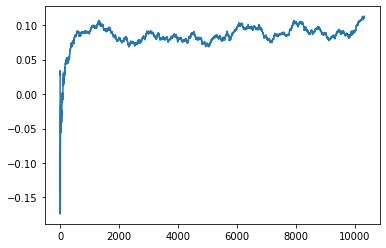

Thread: 6 iteration: 1730
RAM mProject_90 FROM: 2688 --> 320 reward: -1.0
Thread: 4 iteration: 1719
RAM mProject_46 FROM: 256 --> 1024 reward: 0.8529756299999999
Thread: 3 iteration: 1728
RAM mBackground_41 FROM: 2112 --> 1024 reward: 0.08903014919531255
Saving ...


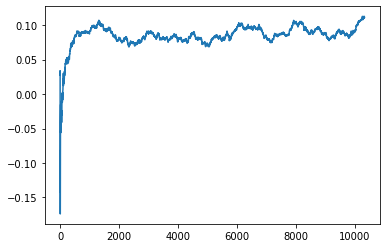

Thread: 4 iteration: 1720
RAM mProject_75 FROM: 3008 --> 320 reward: -1.0
Thread: 5 iteration: 1807
RAM mProject_65 FROM: 384 --> 1024 reward: 0.843143122125
Thread: 2 iteration: 1706
RAM mDiffFit_158 FROM: 1664 --> 1024 reward: 0.021604159375
Thread: 3 iteration: 1729
RAM mDiffFit_309 FROM: 2112 --> 1024 reward: -0.025320375390625004
Thread: 4 iteration: 1721
RAM mDiffFit_94 FROM: 256 --> 2240 reward: -0.47645573007812503
Thread: 5 iteration: 1808
RAM mDiffFit_83 FROM: 1216 --> 1024 reward: -0.0013437609374999937
Thread: 2 iteration: 1707
RAM mBackground_88 FROM: 2624 --> 1024 reward: -0.30960275300781254
Saving ...


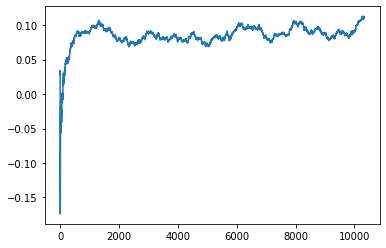

Thread: 3 iteration: 1730
RAM mProject_41 FROM: 1408 --> 320 reward: -1.0
Thread: 1 iteration: 1643
RAM mDiffFit_218 FROM: 1152 --> 1024 reward: 0.025187521875000007
Thread: 4 iteration: 1722
RAM mProject_32 FROM: 704 --> 1024 reward: 0.8249031090000001
Thread: 6 iteration: 1731
RAM mDiffFit_34 FROM: 1984 --> 1024 reward: 0.01910933671875002
Thread: 1 iteration: 1644
RAM mDiffFit_88 FROM: 128 --> 320 reward: -0.5928124781249998
Thread: 5 iteration: 1809
RAM mConcatFit_2 FROM: 3008 --> 1024 reward: 0.6574816065625
Thread: 2 iteration: 1708
RAM mDiffFit_146 FROM: 2432 --> 1024 reward: -0.07094805156250002
Thread: 4 iteration: 1723
RAM mDiffFit_407 FROM: 2880 --> 1024 reward: -0.03282300781250003
Thread: 1 iteration: 1645
RAM mDiffFit_259 FROM: 448 --> 1024 reward: -0.07588280976562502
Thread: 2 iteration: 1709
RAM mBackground_43 FROM: 2240 --> 1024 reward: 0.011683805132812499
Thread: 6 iteration: 1732
RAM mDiffFit_239 FROM: 768 --> 1024 reward: -0.036656239062499985
Thread: 1 iteration:

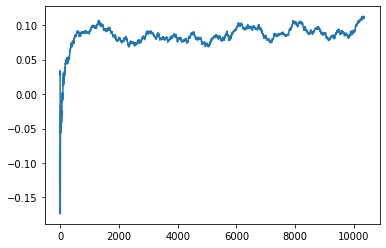

Thread: 2 iteration: 1710
RAM mProject_1 FROM: 2112 --> 320 reward: -1.0
Thread: 3 iteration: 1731
RAM mDiffFit_35 FROM: 2368 --> 1024 reward: -0.051476658203125
Thread: 1 iteration: 1647
RAM mBackground_6 FROM: 1600 --> 1024 reward: 0.024680173843749976
Thread: 4 iteration: 1725
RAM mDiffFit_380 FROM: 1536 --> 1024 reward: 0.02622915937500003
Thread: 2 iteration: 1711
RAM mDiffFit_390 FROM: 320 --> 1024 reward: -0.07312236757812499
Thread: 3 iteration: 1732
RAM mBackground_18 FROM: 1088 --> 1024 reward: -0.00526527374218753
Thread: 6 iteration: 1734
RAM mProject_20 FROM: 2432 --> 320 reward: -1.0
Saving ...


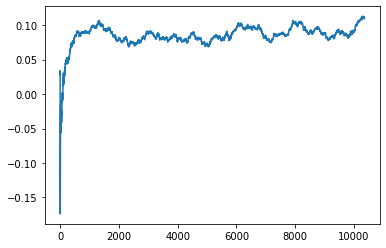

Thread: 5 iteration: 1810
RAM mBackground_59 FROM: 1792 --> 1024 reward: 0.0265166165
Thread: 1 iteration: 1648
RAM mDiffFit_409 FROM: 1152 --> 1024 reward: -0.0015573007812499928
Thread: 4 iteration: 1726
RAM mDiffFit_128 FROM: 1536 --> 1024 reward: 0.029125
Thread: 2 iteration: 1712
RAM mDiffFit_82 FROM: 448 --> 1024 reward: -0.07625780976562503
Thread: 6 iteration: 1735
RAM mBackground_38 FROM: 960 --> 1024 reward: 0.00870527374218745
Thread: 3 iteration: 1733
RAM mDiffFit_213 FROM: 2560 --> 2240 reward: -0.01504690234374998
Thread: 1 iteration: 1649
RAM mDiffFit_123 FROM: 2304 --> 1024 reward: 0.009614557812500004
Thread: 4 iteration: 1727
RAM mDiffFit_21 FROM: 640 --> 1024 reward: -0.0308020796875
Thread: 2 iteration: 1713
RAM mDiffFit_271 FROM: 192 --> 1024 reward: -0.3066146015625
Thread: 6 iteration: 1736
RAM mBackground_74 FROM: 192 --> 1024 reward: -0.6820023754531249
Thread: 3 iteration: 1734
RAM mDiffFit_187 FROM: 448 --> 1024 reward: -0.07260938046874998
Saving ...


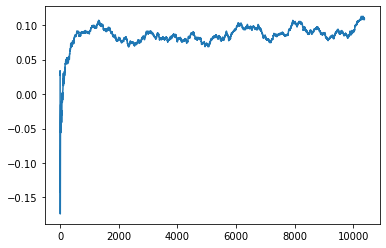

Thread: 1 iteration: 1650
RAM mDiffFit_23 FROM: 1792 --> 1024 reward: -0.004177123437499996
Thread: 2 iteration: 1714
RAM mBackground_61 FROM: 576 --> 1024 reward: -0.11745493772656249
Thread: 4 iteration: 1728
RAM mDiffFit_272 FROM: 1728 --> 1024 reward: 0.03932292031250001
Thread: 6 iteration: 1737
RAM mDiffFit_130 FROM: 2112 --> 1024 reward: 0.013390575781250039
Thread: 3 iteration: 1735
RAM mProject_44 FROM: 2432 --> 320 reward: -1.0
Thread: 5 iteration: 1811
RAM mDiffFit_186 FROM: 896 --> 1024 reward: 0.025848982031250016
Thread: 2 iteration: 1715
RAM mDiffFit_298 FROM: 1408 --> 1024 reward: 0.00749477890625001
Thread: 6 iteration: 1738
RAM mDiffFit_179 FROM: 384 --> 1024 reward: -0.24000522109375003
Thread: 4 iteration: 1729
RAM mDiffFit_323 FROM: 1600 --> 1024 reward: -0.021700596484375036
Thread: 1 iteration: 1651
RAM mBackground_67 FROM: 1344 --> 1024 reward: 0.05954605734375003
Thread: 3 iteration: 1736
RAM mDiffFit_214 FROM: 1536 --> 1024 reward: -0.061979246874999984
Thread

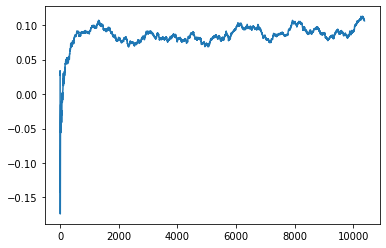

Thread: 4 iteration: 1730
RAM mDiffFit_122 FROM: 1536 --> 1024 reward: 0.03537499999999999
Thread: 3 iteration: 1737
RAM mBackground_55 FROM: 1472 --> 1024 reward: 0.03505394265625
Thread: 1 iteration: 1652
RAM mDiffFit_364 FROM: 2560 --> 1024 reward: 0.009770796875000001
Thread: 2 iteration: 1717
RAM mDiffFit_309 FROM: 1088 --> 1024 reward: -0.0003593804687500139
Thread: 5 iteration: 1813
RAM mDiffFit_420 FROM: 2432 --> 1024 reward: -0.03497924687500001
Thread: 3 iteration: 1738
RAM mDiffFit_164 FROM: 1344 --> 1024 reward: 0.007898429296875013
Thread: 2 iteration: 1718
RAM mDiffFit_351 FROM: 320 --> 1024 reward: -0.22980993320312498
Thread: 5 iteration: 1814
RAM mDiffFit_139 FROM: 640 --> 1024 reward: -0.058583318749999974
Thread: 3 iteration: 1739
RAM mProject_32 FROM: 640 --> 1024 reward: 0.8316231142500001
Thread: 6 iteration: 1739
RAM mDiffFit_399 FROM: 2048 --> 1024 reward: 0.024333318750000017
Thread: 2 iteration: 1719
RAM mDiffFit_386 FROM: 832 --> 1024 reward: 0.00746095117187

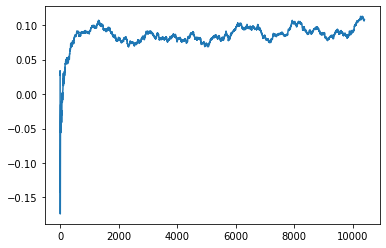

Thread: 3 iteration: 1740
RAM mAdd_1 FROM: 1536 --> 1024 reward: 0.04733325312499988
Thread: 5 iteration: 1815
RAM mDiffFit_287 FROM: 640 --> 1024 reward: -0.028192699218749992
Saving ...


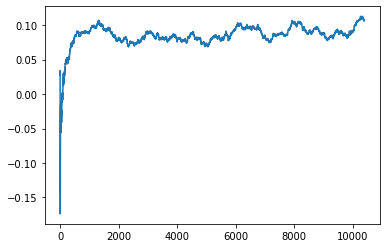

Thread: 6 iteration: 1740
RAM mDiffFit_355 FROM: 2304 --> 1024 reward: 0.019364514062499977
Saving ...


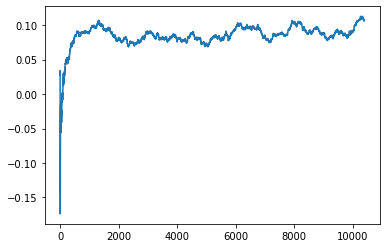

Thread: 2 iteration: 1720
RAM mProject_3 FROM: 1600 --> 896 reward: 0.25386655232812494
Thread: 4 iteration: 1731
RAM mDiffFit_254 FROM: 2048 --> 1024 reward: -0.020791725000000004
Thread: 6 iteration: 1741
RAM mDiffFit_33 FROM: 2816 --> 1024 reward: -0.028125087500000014
Thread: 5 iteration: 1816
RAM mDiffFit_29 FROM: 1792 --> 1024 reward: 0.018083318749999994
Thread: 2 iteration: 1721
RAM mProject_19 FROM: 2496 --> 896 reward: 0.20918602293750002
Thread: 1 iteration: 1653
RAM mDiffFit_204 FROM: 2112 --> 1024 reward: -0.00807555273437499
Thread: 6 iteration: 1742
RAM mDiffFit_283 FROM: 2048 --> 1024 reward: 0.03475
Thread: 1 iteration: 1654
RAM mBackground_44 FROM: 320 --> 1024 reward: -0.415921990140625
Thread: 5 iteration: 1817
RAM mProject_85 FROM: 768 --> 1024 reward: 0.83153311425
Thread: 3 iteration: 1741
RAM mDiffFit_236 FROM: 704 --> 1024 reward: 0.009018251953125007
Thread: 6 iteration: 1743
RAM mDiffFit_16 FROM: 2944 --> 1024 reward: -0.030020928125000026
Thread: 1 iteration

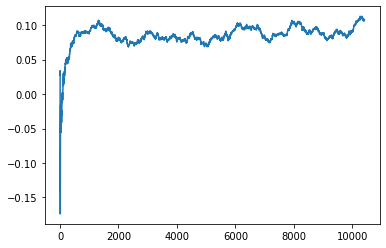

Thread: 5 iteration: 1820
RAM mDiffFit_323 FROM: 1024 --> 1024 reward: -0.021916681250000007
Thread: 1 iteration: 1657
RAM mDiffFit_48 FROM: 2880 --> 1024 reward: -0.11363039609375
Thread: 3 iteration: 1743
RAM mProject_64 FROM: 2368 --> 896 reward: 0.19610744182031228
Thread: 4 iteration: 1732
RAM mProject_46 FROM: 1984 --> 896 reward: 0.2626532013515625
Thread: 2 iteration: 1722
RAM mDiffFit_124 FROM: 2752 --> 1024 reward: -0.022927167187500007
Thread: 5 iteration: 1821
RAM mDiffFit_281 FROM: 1728 --> 1024 reward: -0.017190154296875
Thread: 1 iteration: 1658
RAM mDiffFit_262 FROM: 960 --> 1024 reward: -0.018932300781250005
Thread: 3 iteration: 1744
RAM mDiffFit_115 FROM: 1728 --> 1024 reward: 0.02154426992187498
Thread: 2 iteration: 1723
RAM mProject_19 FROM: 1984 --> 896 reward: 0.2809049343750001
Thread: 6 iteration: 1744
RAM mDiffFit_97 FROM: 2048 --> 1024 reward: 0.012208318749999982
Thread: 5 iteration: 1822
RAM mDiffFit_51 FROM: 2880 --> 1024 reward: -0.021981835546874995
Threa

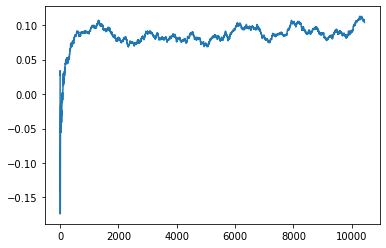

Thread: 1 iteration: 1660
RAM mDiffFit_266 FROM: 640 --> 1024 reward: -0.09491668124999998
Thread: 2 iteration: 1725
RAM mProject_68 FROM: 1408 --> 896 reward: 0.22119187696875015
Thread: 4 iteration: 1733
RAM mBackground_87 FROM: 2432 --> 1024 reward: 0.028084290343749988
Thread: 1 iteration: 1661
RAM mDiffFit_354 FROM: 1920 --> 1024 reward: 0.10248442421875001
Thread: 4 iteration: 1734
RAM mDiffFit_96 FROM: 384 --> 1024 reward: -0.15945836249999998
Thread: 4 iteration: 1735
RAM mDiffFit_389 FROM: 512 --> 1024 reward: -0.06962495624999995
Thread: 1 iteration: 1662
RAM mDiffFit_207 FROM: 768 --> 1024 reward: -0.010854159375000005
Thread: 4 iteration: 1736
RAM mProject_77 FROM: 320 --> 1024 reward: 0.84567062475
Thread: 6 iteration: 1745
RAM mDiffFit_34 FROM: 2496 --> 1024 reward: 0.02065097421875002
Thread: 1 iteration: 1663
RAM mProject_55 FROM: 768 --> 1024 reward: 0.84756062475
Thread: 3 iteration: 1746
RAM mDiffFit_293 FROM: 1664 --> 1024 reward: -0.06610946796875
Thread: 4 iterati

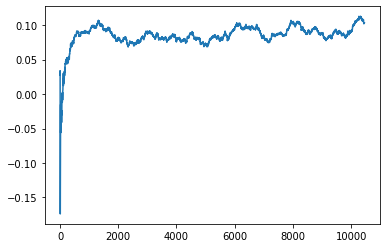

Thread: 3 iteration: 1750
RAM mDiffFit_407 FROM: 2688 --> 320 reward: 0.2846979203125
Thread: 1 iteration: 1667
RAM mDiffFit_150 FROM: 2368 --> 320 reward: 0.13198429296875003
Saving ...


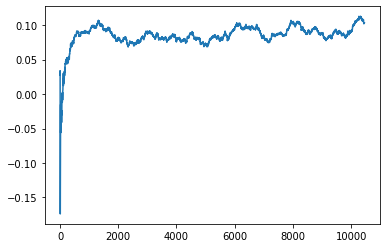

Thread: 4 iteration: 1740
RAM mDiffFit_304 FROM: 1536 --> 1024 reward: -0.050812565624999986
Thread: 5 iteration: 1825
RAM mDiffFit_61 FROM: 192 --> 1024 reward: -0.25209634960937505
Thread: 3 iteration: 1751
RAM mDiffFit_98 FROM: 1024 --> 1024 reward: 0.0379583625
Thread: 1 iteration: 1668
RAM mProject_53 FROM: 1216 --> 320 reward: -1.0
Thread: 2 iteration: 1727
RAM mProject_7 FROM: 448 --> 1024 reward: 0.850133127375
Thread: 6 iteration: 1748
RAM mDiffFit_7 FROM: 1344 --> 1024 reward: -0.04024223398437499
Thread: 4 iteration: 1741
RAM mDiffFit_190 FROM: 768 --> 1024 reward: 0.007114601562499996
Thread: 3 iteration: 1752
RAM mDiffFit_265 FROM: 1664 --> 1024 reward: 0.043645840625000015
Thread: 1 iteration: 1669
RAM mDiffFit_58 FROM: 2944 --> 320 reward: 0.22486455781249998
Thread: 2 iteration: 1728
RAM mDiffFit_249 FROM: 2944 --> 320 reward: 0.17927860664062503
Thread: 6 iteration: 1749
RAM mDiffFit_149 FROM: 2560 --> 2752 reward: 0.32780769453124997
Thread: 4 iteration: 1742
RAM mDif

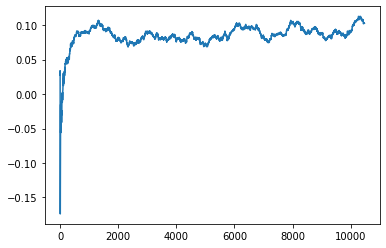

Thread: 1 iteration: 1670
RAM mDiffFit_378 FROM: 192 --> 1024 reward: -0.17513539843750003
Thread: 3 iteration: 1753
RAM mBackground_89 FROM: 2368 --> 1024 reward: -0.0018836079453124932
Thread: 2 iteration: 1729
RAM mProject_80 FROM: 2944 --> 320 reward: -1.0
Thread: 5 iteration: 1826
RAM mDiffFit_249 FROM: 2880 --> 2752 reward: 0.023612012890625
Saving ...


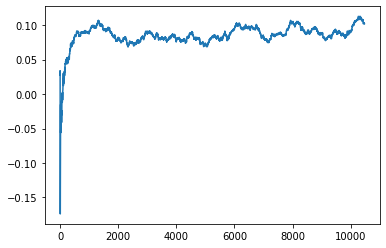

Thread: 6 iteration: 1750
RAM mDiffFit_386 FROM: 1536 --> 2752 reward: -0.0333020796875
Thread: 4 iteration: 1743
RAM mDiffFit_414 FROM: 2560 --> 2752 reward: -0.00014842929687501616
Saving ...


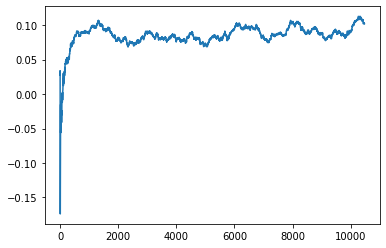

Thread: 2 iteration: 1730
RAM mBackground_90 FROM: 2368 --> 1024 reward: 0.001771392054687522
Thread: 3 iteration: 1754
RAM mBackground_24 FROM: 2432 --> 1024 reward: -0.008689727562499996
Thread: 1 iteration: 1671
RAM mDiffFit_188 FROM: 832 --> 1024 reward: -0.051062521875000016
Thread: 6 iteration: 1751
RAM mDiffFit_356 FROM: 1088 --> 1024 reward: -0.10276570703125
Thread: 2 iteration: 1731
RAM mBackground_84 FROM: 192 --> 1024 reward: -0.6785690918515626
Thread: 4 iteration: 1744
RAM mDiffFit_315 FROM: 1216 --> 1024 reward: 0.049664092578124985
Thread: 1 iteration: 1672
RAM mBackground_45 FROM: 2112 --> 1024 reward: 0.033347337828125004
Thread: 3 iteration: 1755
RAM mBgModel_1 FROM: 896 --> 768 reward: 0.05673750437500008
Thread: 5 iteration: 1827
RAM mDiffFit_160 FROM: 640 --> 1024 reward: -0.011635398437500003
Thread: 6 iteration: 1752
RAM mDiffFit_137 FROM: 576 --> 1024 reward: 0.009414092578125012
Thread: 2 iteration: 1732
RAM mDiffFit_124 FROM: 512 --> 1024 reward: -0.071645840

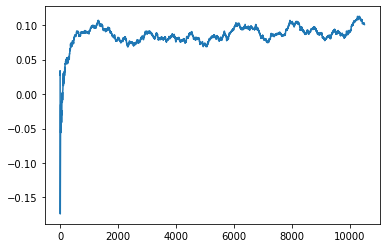

Thread: 5 iteration: 1830
RAM mDiffFit_282 FROM: 1728 --> 2752 reward: 0.053138118359375
Thread: 1 iteration: 1676
RAM mProject_87 FROM: 2048 --> 768 reward: -1.0
Thread: 2 iteration: 1734
RAM mDiffFit_394 FROM: 1536 --> 1024 reward: 0.01095831874999998
Thread: 3 iteration: 1758
RAM mDiffFit_319 FROM: 960 --> 1024 reward: -0.054773473046874965
Thread: 6 iteration: 1758
RAM mProject_7 FROM: 2624 --> 768 reward: -1.0
Thread: 4 iteration: 1748
RAM mDiffFit_401 FROM: 2496 --> 2752 reward: 0.036190154296875006
Thread: 3 iteration: 1759
RAM mBackground_24 FROM: 2880 --> 1024 reward: -0.0020381603593750118
Thread: 1 iteration: 1677
RAM mDiffFit_89 FROM: 1024 --> 1024 reward: -0.03620836250000002
Thread: 6 iteration: 1759
RAM mImgtbl_1 FROM: 1984 --> 1024 reward: 0.015595718124999991
Thread: 2 iteration: 1735
RAM mDiffFit_280 FROM: 2176 --> 2752 reward: -0.09154957851562504
Thread: 5 iteration: 1831
RAM mDiffFit_288 FROM: 448 --> 1024 reward: -0.017234336718749983
Saving ...


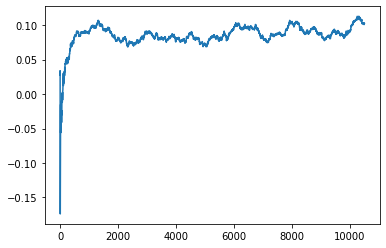

Thread: 6 iteration: 1760
RAM mBackground_89 FROM: 2752 --> 1024 reward: -0.006060448890624966
Saving ...


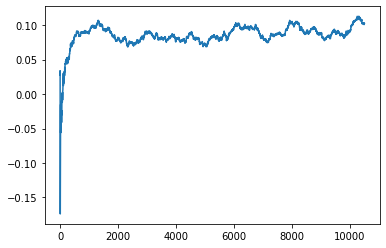

Thread: 3 iteration: 1760
RAM mBackground_11 FROM: 2624 --> 1024 reward: -0.02849663078125003
Thread: 1 iteration: 1678
RAM mDiffFit_212 FROM: 128 --> 768 reward: -0.75792190234375
Thread: 5 iteration: 1832
RAM mBackground_46 FROM: 1728 --> 1024 reward: 0.0645201491953125
Thread: 2 iteration: 1736
RAM mDiffFit_54 FROM: 256 --> 1024 reward: -0.16895831874999995
Thread: 3 iteration: 1761
RAM mDiffFit_171 FROM: 832 --> 2752 reward: -0.10188022109375
Thread: 1 iteration: 1679
RAM mBackground_42 FROM: 1344 --> 1024 reward: 0.0023403230390625198
Thread: 6 iteration: 1761
RAM mDiffFit_201 FROM: 704 --> 1024 reward: -0.010091128515625006
Thread: 2 iteration: 1737
RAM mBackground_41 FROM: 640 --> 1024 reward: -0.11978635573437503
Thread: 5 iteration: 1833
RAM mProject_65 FROM: 1920 --> 768 reward: -1.0
Thread: 4 iteration: 1749
RAM mDiffFit_212 FROM: 2560 --> 2752 reward: 0.009351570703124996
Saving ...


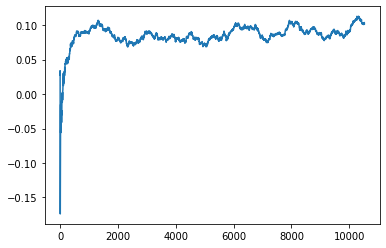

Thread: 1 iteration: 1680
RAM mDiffFit_125 FROM: 2752 --> 2752 reward: 0.0077499999999999965
Thread: 3 iteration: 1762
RAM mDiffFit_288 FROM: 640 --> 1024 reward: -0.023567699218749998
Thread: 6 iteration: 1762
RAM mDiffFit_207 FROM: 2816 --> 768 reward: 0.07118747812500004
Thread: 5 iteration: 1834
RAM mBackground_22 FROM: 1472 --> 1024 reward: 0.007979601710937517
Saving ...


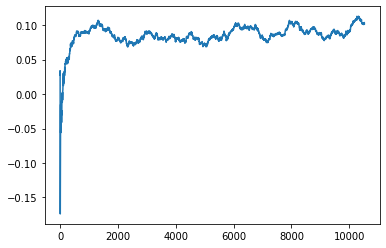

Thread: 4 iteration: 1750
RAM mDiffFit_226 FROM: 896 --> 1024 reward: -0.01616146015625
Thread: 1 iteration: 1681
RAM mDiffFit_213 FROM: 2944 --> 768 reward: 0.04878115156249998
Thread: 3 iteration: 1763
RAM mDiffFit_273 FROM: 2048 --> 2752 reward: 0.01803909257812498
Thread: 4 iteration: 1751
RAM mBackground_51 FROM: 384 --> 1024 reward: -0.3750137688125
Thread: 6 iteration: 1763
RAM mAdd_1 FROM: 832 --> 1024 reward: -0.20085034199218754
Thread: 5 iteration: 1835
RAM mDiffFit_195 FROM: 2432 --> 2752 reward: -0.03020314140625001
Thread: 1 iteration: 1682
RAM mProject_77 FROM: 384 --> 1024 reward: 0.8403456194999999
Thread: 2 iteration: 1738
RAM mDiffFit_227 FROM: 960 --> 1024 reward: -0.016388030859375007
Thread: 6 iteration: 1764
RAM mBackground_16 FROM: 384 --> 1024 reward: -0.333129067203125
Thread: 4 iteration: 1752
RAM mBackground_6 FROM: 896 --> 1024 reward: -0.005706442656249984
Thread: 5 iteration: 1836
RAM mDiffFit_100 FROM: 1536 --> 2752 reward: -0.03296095117187503
Thread: 3

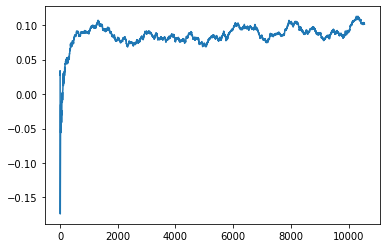

Thread: 2 iteration: 1740
RAM mDiffFit_360 FROM: 1792 --> 1024 reward: 0.003666637499999993
Thread: 4 iteration: 1754
RAM mDiffFit_88 FROM: 2944 --> 768 reward: -0.0031772546875000196
Thread: 3 iteration: 1766
RAM mImgtbl_1 FROM: 960 --> 1024 reward: -0.014435415937500085
Thread: 6 iteration: 1766
RAM mDiffFit_55 FROM: 1792 --> 1024 reward: 0.030552079687499994
Thread: 1 iteration: 1685
RAM mDiffFit_219 FROM: 2816 --> 768 reward: 0.04709371718750001
Thread: 5 iteration: 1839
RAM mDiffFit_171 FROM: 704 --> 1024 reward: -0.026882809765625022
Thread: 4 iteration: 1755
RAM mDiffFit_222 FROM: 1728 --> 1024 reward: 0.0008775886718749917
Thread: 6 iteration: 1767
RAM mDiffFit_267 FROM: 2432 --> 1024 reward: 0.022770796875000027
Thread: 3 iteration: 1767
RAM mDiffFit_140 FROM: 1856 --> 1024 reward: -0.05933862734375
Thread: 2 iteration: 1741
RAM mDiffFit_107 FROM: 1216 --> 1024 reward: 0.021822920312499997
Thread: 1 iteration: 1686
RAM mDiffFit_242 FROM: 2048 --> 1024 reward: -0.00433336250000

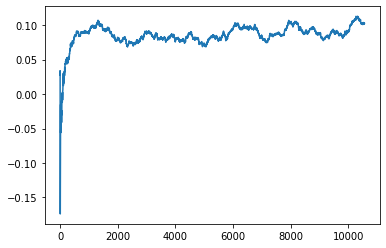

Thread: 5 iteration: 1840
RAM mBackground_26 FROM: 192 --> 1024 reward: -0.7387355098593751
Thread: 4 iteration: 1756
RAM mDiffFit_258 FROM: 2752 --> 1024 reward: -0.009260485937499993
Thread: 3 iteration: 1768
RAM mDiffFit_94 FROM: 2304 --> 1024 reward: 0.013562434375000015
Thread: 2 iteration: 1742
RAM mBackground_63 FROM: 896 --> 1024 reward: -0.03384906720312497
Thread: 6 iteration: 1768
RAM mDiffFit_39 FROM: 1024 --> 1024 reward: -0.02354168125000002
Thread: 1 iteration: 1687
RAM mDiffFit_296 FROM: 1024 --> 1024 reward: 0.0031250000000000028
Thread: 4 iteration: 1757
RAM mDiffFit_99 FROM: 2176 --> 1024 reward: -0.07038552968750003
Thread: 3 iteration: 1769
RAM mDiffFit_93 FROM: 2944 --> 768 reward: 0.011244691406249972
Thread: 2 iteration: 1743
RAM mBgModel_2 FROM: 1856 --> 768 reward: 0.16743018609375004
Thread: 6 iteration: 1769
RAM mDiffFit_300 FROM: 960 --> 1024 reward: -0.01697657070312499
Thread: 2 iteration: 1744
RAM mDiffFit_346 FROM: 832 --> 1024 reward: 0.017539092578124

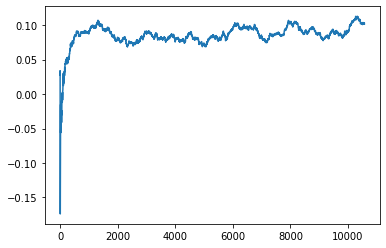

Thread: 6 iteration: 1770
RAM mDiffFit_193 FROM: 1024 --> 1024 reward: 0.0067500000000000025
Thread: 6 iteration: 1771
RAM mBackground_36 FROM: 1984 --> 1024 reward: 0.0186086312890625
Thread: 4 iteration: 1759
RAM mBackground_72 FROM: 2112 --> 1024 reward: -0.004951829273437551
Thread: 2 iteration: 1745
RAM mBackground_37 FROM: 2368 --> 1024 reward: 0.026998083804687475
Thread: 1 iteration: 1689
RAM mProject_25 FROM: 2112 --> 768 reward: -1.0
Thread: 5 iteration: 1841
RAM mDiffFit_298 FROM: 2944 --> 1024 reward: -0.012479246874999989
Thread: 6 iteration: 1772
RAM mDiffFit_393 FROM: 1216 --> 1024 reward: -0.007953141406249996
Thread: 2 iteration: 1746
RAM mDiffFit_7 FROM: 128 --> 1024 reward: -0.50621353984375
Saving ...


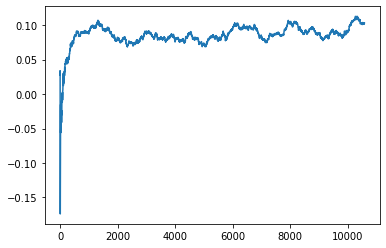

Thread: 4 iteration: 1760
RAM mDiffFit_5 FROM: 1792 --> 1024 reward: -0.058729246874999995
Saving ...


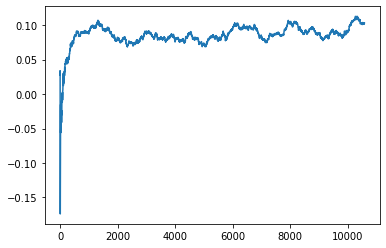

Thread: 1 iteration: 1690
RAM mDiffFit_353 FROM: 2304 --> 1024 reward: 0.012364557812499996
Thread: 5 iteration: 1842
RAM mDiffFit_59 FROM: 1152 --> 1024 reward: -0.008687521874999986
Thread: 6 iteration: 1773
RAM mDiffFit_391 FROM: 384 --> 1024 reward: -0.3334115039062501
Thread: 2 iteration: 1747
RAM mDiffFit_75 FROM: 1664 --> 1024 reward: 0.0004374781249999807
Thread: 1 iteration: 1691
RAM mAdd_1 FROM: 2560 --> 1024 reward: 0.01776020156250009
Thread: 4 iteration: 1761
RAM mDiffFit_204 FROM: 2240 --> 1024 reward: -0.013093804687500012
Thread: 5 iteration: 1843
RAM mDiffFit_338 FROM: 960 --> 1024 reward: 0.0032786503906249813
Thread: 4 iteration: 1762
RAM mDiffFit_203 FROM: 1088 --> 1024 reward: -0.0012786503906250107
Thread: 5 iteration: 1844
RAM mProject_83 FROM: 1408 --> 768 reward: -1.0
Saving ...


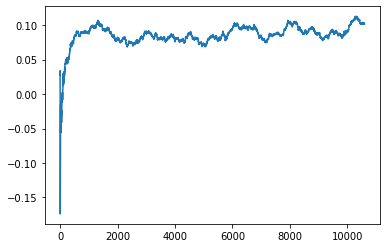

Thread: 3 iteration: 1770
RAM mDiffFit_309 FROM: 1856 --> 1024 reward: -0.018330773828124994
Thread: 5 iteration: 1845
RAM mDiffFit_55 FROM: 2304 --> 1024 reward: -0.002177123437500008
Thread: 3 iteration: 1771
RAM mDiffFit_215 FROM: 2496 --> 1024 reward: -0.013260485937500004
Thread: 3 iteration: 1772
RAM mDiffFit_186 FROM: 320 --> 1024 reward: -0.14024999999999999
Thread: 5 iteration: 1846
RAM mDiffFit_266 FROM: 960 --> 1024 reward: -0.032945331640624985
Thread: 3 iteration: 1773
RAM mProject_15 FROM: 320 --> 1024 reward: 0.8458506247500001
Thread: 6 iteration: 1774
RAM mDiffFit_85 FROM: 2816 --> 1024 reward: -0.02925008750000001
Thread: 5 iteration: 1847
RAM mDiffFit_259 FROM: 2880 --> 1024 reward: -0.0016901542968750065
Thread: 3 iteration: 1774
RAM mProject_20 FROM: 128 --> 1024 reward: 0.8425131221250002
Thread: 4 iteration: 1763
RAM mProject_11 FROM: 1920 --> 768 reward: -1.0
Thread: 2 iteration: 1748
RAM mProject_51 FROM: 2560 --> 768 reward: -1.0
Thread: 1 iteration: 1692
RAM 

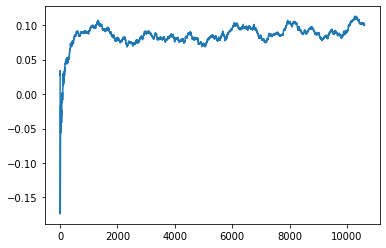

Thread: 2 iteration: 1750
RAM mDiffFit_326 FROM: 1472 --> 1024 reward: -0.039747455078124966
Saving ...


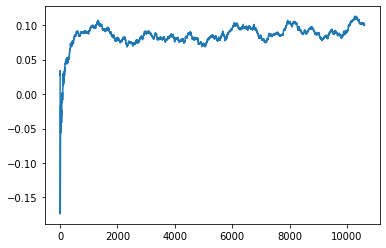

Thread: 5 iteration: 1850
RAM mBackground_38 FROM: 1408 --> 1024 reward: 0.021997163984374988
Thread: 1 iteration: 1694
RAM mDiffFit_406 FROM: 512 --> 1024 reward: -0.17002088437500001
Thread: 4 iteration: 1766
RAM mDiffFit_329 FROM: 960 --> 1024 reward: -0.018226570703125007
Thread: 2 iteration: 1751
RAM mDiffFit_345 FROM: 2368 --> 1024 reward: -0.06064597187500003
Thread: 5 iteration: 1851
RAM mDiffFit_186 FROM: 192 --> 1024 reward: -0.24734634960937502
Thread: 4 iteration: 1767
RAM mDiffFit_131 FROM: 1152 --> 1024 reward: -0.02301044218750001
Thread: 2 iteration: 1752
RAM mProject_14 FROM: 3008 --> 768 reward: -1.0
Thread: 6 iteration: 1776
RAM mProject_56 FROM: 2688 --> 768 reward: -1.0
Thread: 3 iteration: 1776
RAM mDiffFit_94 FROM: 2688 --> 1024 reward: 0.007197832812500006
Thread: 4 iteration: 1768
RAM mBackground_44 FROM: 1984 --> 1024 reward: 0.0383169771640625
Thread: 5 iteration: 1852
RAM mDiffFit_89 FROM: 2944 --> 1024 reward: -0.0008073445312500177
Thread: 6 iteration: 177

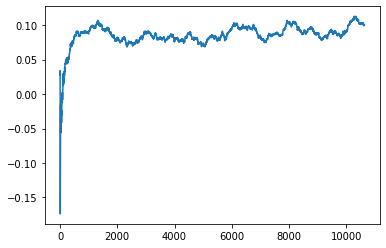

Thread: 4 iteration: 1770
RAM mBackground_67 FROM: 832 --> 1024 reward: -0.0640677737421875
Thread: 5 iteration: 1854
RAM mDiffFit_360 FROM: 2240 --> 1024 reward: 0.024523429296875003
Thread: 3 iteration: 1779
RAM mDiffFit_390 FROM: 2432 --> 1024 reward: -0.04550530859375002
Thread: 1 iteration: 1697
RAM mDiffFit_277 FROM: 896 --> 1024 reward: 0.007505221093750004
Thread: 4 iteration: 1771
RAM mDiffFit_416 FROM: 2560 --> 768 reward: 0.022708274999999993
Saving ...


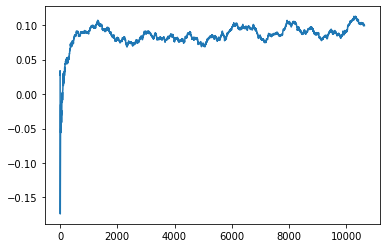

Thread: 3 iteration: 1780
RAM mDiffFit_219 FROM: 1344 --> 1024 reward: -0.075229246875
Thread: 1 iteration: 1698
RAM mDiffFit_356 FROM: 2624 --> 768 reward: 0.07304422617187498
Thread: 3 iteration: 1781
RAM mProject_84 FROM: 2368 --> 768 reward: -1.0
Thread: 6 iteration: 1778
RAM mProject_3 FROM: 1088 --> 768 reward: -1.0
Thread: 2 iteration: 1754
RAM mDiffFit_398 FROM: 1024 --> 1024 reward: 0.0023749999999999986
Thread: 1 iteration: 1699
RAM mDiffFit_366 FROM: 2368 --> 1024 reward: 0.001747367578124985
Thread: 2 iteration: 1755
RAM mDiffFit_261 FROM: 2752 --> 768 reward: 0.0189895140625
Saving ...


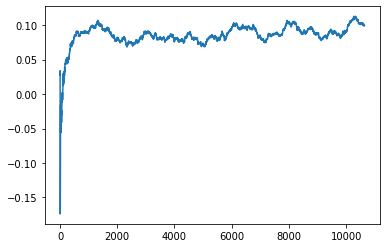

Thread: 1 iteration: 1700
RAM mDiffFit_233 FROM: 512 --> 768 reward: -0.18867712343750004
Thread: 3 iteration: 1782
RAM mProject_76 FROM: 320 --> 1024 reward: 0.8262081090000001
Thread: 5 iteration: 1855
RAM mDiffFit_146 FROM: 1664 --> 1024 reward: -0.0639271671875
Thread: 6 iteration: 1779
RAM mDiffFit_190 FROM: 2240 --> 1024 reward: -0.02563548593750001
Thread: 1 iteration: 1701
RAM mDiffFit_282 FROM: 1984 --> 1024 reward: -0.008388074609374987
Thread: 2 iteration: 1756
RAM mProject_36 FROM: 2880 --> 768 reward: -1.0
Thread: 4 iteration: 1772
RAM mDiffFit_218 FROM: 1472 --> 1024 reward: -0.015635442187500008
Saving ...


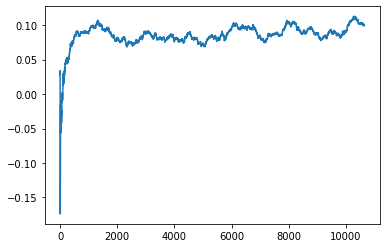

Thread: 6 iteration: 1780
RAM mDiffFit_189 FROM: 2176 --> 1024 reward: -0.0006927429687500139
Thread: 1 iteration: 1702
RAM mDiffFit_51 FROM: 2944 --> 768 reward: 0.06232809765625003
Thread: 2 iteration: 1757
RAM mDiffFit_119 FROM: 1600 --> 1024 reward: 0.020927079687499996
Thread: 4 iteration: 1773
RAM mDiffFit_27 FROM: 2880 --> 768 reward: 0.014164005078125003
Thread: 6 iteration: 1781
RAM mDiffFit_105 FROM: 2688 --> 768 reward: -0.004203185156249987
Thread: 2 iteration: 1758
RAM mDiffFit_139 FROM: 2816 --> 768 reward: 0.049166550000000024
Thread: 1 iteration: 1703
RAM mDiffFit_406 FROM: 896 --> 1024 reward: -0.04654690234374998
Thread: 4 iteration: 1774
RAM mDiffFit_234 FROM: 2880 --> 768 reward: -0.05435170195312502
Thread: 6 iteration: 1782
RAM mDiffFit_76 FROM: 2304 --> 768 reward: -0.0424688484375
Thread: 1 iteration: 1704
RAM mBackground_20 FROM: 2048 --> 1024 reward: 0.27082853400000007
Thread: 2 iteration: 1759
RAM mProject_44 FROM: 2752 --> 768 reward: -1.0
Thread: 3 iterati

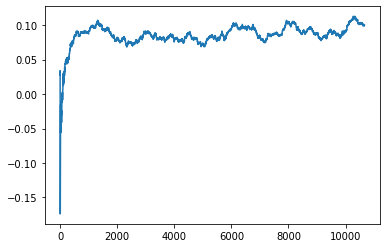

Thread: 2 iteration: 1760
RAM mDiffFit_60 FROM: 320 --> 1024 reward: -0.06334371718749998
Thread: 1 iteration: 1706
RAM mDiffFit_62 FROM: 1984 --> 768 reward: 0.045364557812500025
Thread: 5 iteration: 1857
RAM mBackground_54 FROM: 2176 --> 1024 reward: 0.013092511671874975
Thread: 6 iteration: 1784
RAM mBackground_73 FROM: 1280 --> 1024 reward: 0.04602792293750004
Thread: 4 iteration: 1776
RAM mBackground_23 FROM: 2304 --> 1024 reward: 0.04510513621875004
Thread: 3 iteration: 1784
RAM mBackground_50 FROM: 2944 --> 1024 reward: 0.020953406843750022
Thread: 2 iteration: 1761
RAM mDiffFit_194 FROM: 832 --> 2112 reward: 0.00028913632812498785
Thread: 1 iteration: 1707
RAM mDiffFit_319 FROM: 1536 --> 2112 reward: 0.10142198984375
Thread: 5 iteration: 1858
RAM mDiffFit_162 FROM: 1664 --> 2112 reward: 0.012700552734375009
Thread: 4 iteration: 1777
RAM mDiffFit_390 FROM: 1216 --> 2112 reward: 0.086354290625
Thread: 6 iteration: 1785
RAM mDiffFit_52 FROM: 2752 --> 768 reward: 0.0216171464843750

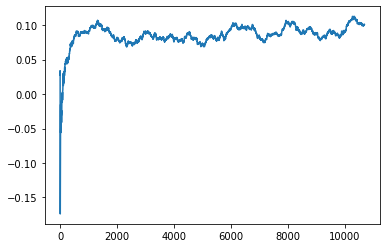

Thread: 5 iteration: 1860
RAM mDiffFit_230 FROM: 320 --> 2112 reward: -0.07732287656250002
Thread: 6 iteration: 1787
RAM mDiffFit_14 FROM: 2624 --> 768 reward: -0.025770928125000026
Thread: 2 iteration: 1764
RAM mDiffFit_228 FROM: 448 --> 2112 reward: -0.08112495624999999
Saving ...


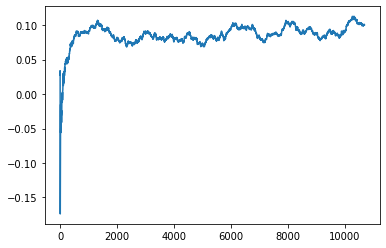

Thread: 4 iteration: 1780
RAM mDiffFit_85 FROM: 2560 --> 768 reward: 0.011999956250000002
Saving ...


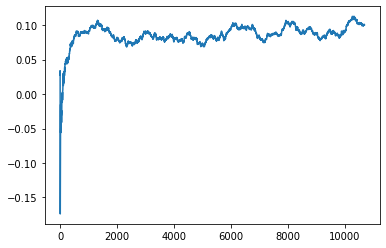

Thread: 1 iteration: 1710
RAM mDiffFit_311 FROM: 2944 --> 768 reward: -0.002203185156249999
Thread: 5 iteration: 1861
RAM mDiffFit_299 FROM: 576 --> 2112 reward: -0.03646871718750001
Thread: 6 iteration: 1788
RAM mDiffFit_247 FROM: 2880 --> 768 reward: -0.016718848437500006
Thread: 2 iteration: 1765
RAM mProject_46 FROM: 1088 --> 768 reward: -1.0
Thread: 3 iteration: 1786
RAM mDiffFit_39 FROM: 640 --> 2112 reward: -0.050359336718749995
Thread: 4 iteration: 1781
RAM mDiffFit_249 FROM: 704 --> 2112 reward: -0.036098938281250006
Thread: 1 iteration: 1711
RAM mDiffFit_21 FROM: 2176 --> 768 reward: 0.0026093367187499973
Thread: 5 iteration: 1862
RAM mDiffFit_351 FROM: 1856 --> 2112 reward: -0.04246358359375002
Thread: 2 iteration: 1766
RAM mDiffFit_124 FROM: 2880 --> 768 reward: 0.009289005078125002
Thread: 6 iteration: 1789
RAM mDiffFit_310 FROM: 1088 --> 2112 reward: -0.002247367578125008
Thread: 4 iteration: 1782
RAM mDiffFit_82 FROM: 1472 --> 2112 reward: -0.09548705664062501
Thread: 1 

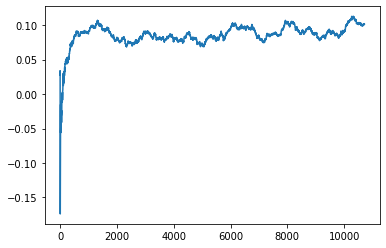

Thread: 6 iteration: 1790
RAM mDiffFit_10 FROM: 2496 --> 768 reward: 0.07346086367187502
Thread: 1 iteration: 1715
RAM mBackground_23 FROM: 832 --> 1024 reward: 0.012987388429687484
Thread: 4 iteration: 1785
RAM mBackground_32 FROM: 1408 --> 1024 reward: 0.020841529578124962
Thread: 3 iteration: 1788
RAM mBackground_88 FROM: 2112 --> 1024 reward: 0.07190402957812501
Thread: 5 iteration: 1866
RAM mBackground_7 FROM: 128 --> 1024 reward: -1.2494904229375001
Saving ...


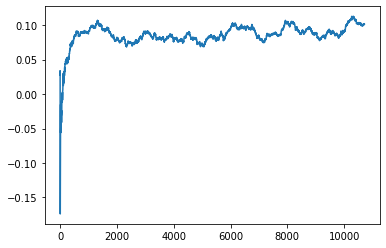

Thread: 2 iteration: 1770
RAM mDiffFit_366 FROM: 1664 --> 2112 reward: 0.03323442421875
Thread: 6 iteration: 1791
RAM mDiffFit_272 FROM: 1152 --> 2112 reward: 0.003929712109374981
Thread: 4 iteration: 1786
RAM mDiffFit_18 FROM: 320 --> 2112 reward: -0.098726526953125
Thread: 5 iteration: 1867
RAM mBackground_85 FROM: 2688 --> 1024 reward: -0.003968670218749995
Thread: 1 iteration: 1716
RAM mDiffFit_408 FROM: 576 --> 2112 reward: -0.048320287890624994
Thread: 2 iteration: 1771
RAM mDiffFit_236 FROM: 2496 --> 768 reward: 0.02186714648437501
Thread: 3 iteration: 1789
RAM mDiffFit_399 FROM: 2944 --> 768 reward: 0.060828097656250024
Thread: 6 iteration: 1792
RAM mDiffFit_407 FROM: 1792 --> 768 reward: -0.046541768750000025
Thread: 5 iteration: 1868
RAM mBackground_14 FROM: 960 --> 1024 reward: -0.025804490140625004
Thread: 4 iteration: 1787
RAM mDiffFit_70 FROM: 1152 --> 2112 reward: -0.012062478125000001
Thread: 2 iteration: 1772
RAM mDiffFit_369 FROM: 2624 --> 768 reward: -0.0022109949218

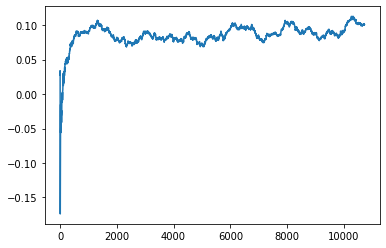

Thread: 3 iteration: 1790
RAM mDiffFit_378 FROM: 512 --> 2112 reward: -0.020028606640625016
Thread: 4 iteration: 1788
RAM mDiffFit_347 FROM: 448 --> 2112 reward: -0.08347393828125
Thread: 3 iteration: 1791
RAM mBackground_63 FROM: 1152 --> 1024 reward: 0.023820211468750022
Thread: 5 iteration: 1869
RAM mProject_71 FROM: 3008 --> 1792 reward: -0.2086433912109375
Thread: 1 iteration: 1717
RAM mDiffFit_82 FROM: 1088 --> 2112 reward: -0.11760683554687498
Thread: 2 iteration: 1773
RAM mDiffFit_413 FROM: 384 --> 2112 reward: -0.07060152695312502
Thread: 4 iteration: 1789
RAM mDiffFit_132 FROM: 2496 --> 768 reward: 0.007492146484375014
Thread: 3 iteration: 1792
RAM mDiffFit_388 FROM: 1408 --> 2112 reward: -0.030513030859375012
Saving ...


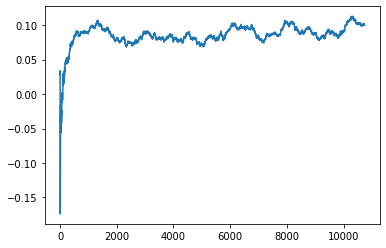

Thread: 5 iteration: 1870
RAM mDiffFit_300 FROM: 2688 --> 768 reward: 0.005765575781250011
Thread: 1 iteration: 1718
RAM mBackground_61 FROM: 1152 --> 1024 reward: 0.01970385573437502
Thread: 2 iteration: 1774
RAM mDiffFit_36 FROM: 2048 --> 2112 reward: -0.02176044218750001
Saving ...


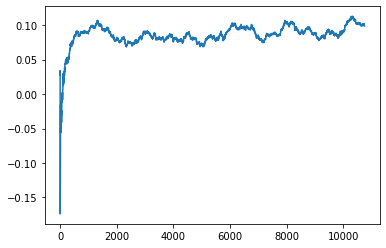

Thread: 4 iteration: 1790
RAM mDiffFit_136 FROM: 1216 --> 2112 reward: -0.013052079687500013
Thread: 5 iteration: 1871
RAM mProject_72 FROM: 2176 --> 768 reward: -1.0
Thread: 6 iteration: 1793
RAM mConcatFit_1 FROM: 2880 --> 1024 reward: -0.014129308125000045
Thread: 3 iteration: 1793
RAM mDiffFit_125 FROM: 704 --> 2112 reward: -0.16731515429687505
Thread: 1 iteration: 1719
RAM mDiffFit_105 FROM: 960 --> 2112 reward: -0.033773429296875004
Thread: 4 iteration: 1791
RAM mDiffFit_135 FROM: 192 --> 768 reward: -0.5893985167968749
Thread: 5 iteration: 1872
RAM mDiffFit_298 FROM: 1472 --> 2112 reward: -0.03291668125000001
Thread: 6 iteration: 1794
RAM mDiffFit_96 FROM: 1792 --> 2112 reward: 0.004960951171875004
Saving ...


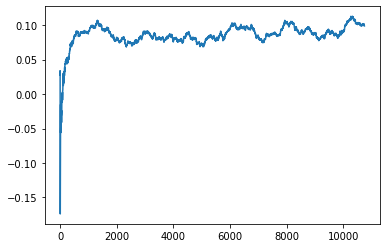

Thread: 1 iteration: 1720
RAM mDiffFit_383 FROM: 2880 --> 768 reward: -0.010304755859375011
Thread: 3 iteration: 1794
RAM mProject_62 FROM: 128 --> 1024 reward: 0.8456481247500001
Thread: 2 iteration: 1775
RAM mDiffFit_416 FROM: 960 --> 2112 reward: -0.0026093367187499973
Thread: 4 iteration: 1792
RAM mDiffFit_142 FROM: 512 --> 2112 reward: -0.0505520359375
Thread: 5 iteration: 1873
RAM mDiffFit_78 FROM: 1344 --> 2112 reward: -0.002070287890624991
Thread: 6 iteration: 1795
RAM mDiffFit_282 FROM: 320 --> 2112 reward: -0.1273020359375
Thread: 1 iteration: 1721
RAM mBackground_40 FROM: 2688 --> 1024 reward: -0.047103111062499974
Thread: 3 iteration: 1795
RAM mDiffFit_119 FROM: 1472 --> 2112 reward: 0.012286503906249989
Thread: 2 iteration: 1776
RAM mBackground_88 FROM: 1216 --> 1024 reward: -0.0011534081484375082
Thread: 4 iteration: 1793
RAM mDiffFit_160 FROM: 1152 --> 2112 reward: 0.005140663281249999
Thread: 6 iteration: 1796
RAM mDiffFit_151 FROM: 640 --> 2112 reward: -0.0253020359374

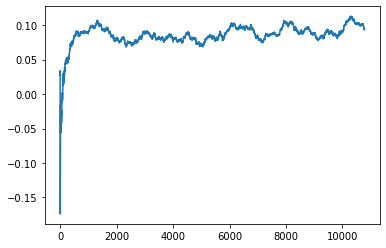

Thread: 2 iteration: 1780
RAM mBackground_34 FROM: 1408 --> 1024 reward: 0.03848050985937502
Saving ...


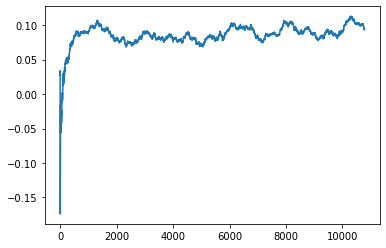

Thread: 6 iteration: 1800
RAM mProject_34 FROM: 576 --> 1024 reward: 0.8469981247499999
Thread: 1 iteration: 1724
RAM mProject_60 FROM: 2560 --> 1792 reward: -0.1311002651250002
Thread: 5 iteration: 1877
RAM mDiffFit_198 FROM: 256 --> 2112 reward: -0.17582028789062498
Thread: 4 iteration: 1798
RAM mDiffFit_352 FROM: 1920 --> 2112 reward: 0.0010937609375000039
Thread: 2 iteration: 1781
RAM mDiffFit_2 FROM: 2496 --> 768 reward: 0.006499868749999978
Thread: 6 iteration: 1801
RAM mProject_81 FROM: 320 --> 1024 reward: 0.843480622125
Thread: 3 iteration: 1799
RAM mDiffFit_25 FROM: 640 --> 2112 reward: -0.037908827734375
Thread: 5 iteration: 1878
RAM mDiffFit_263 FROM: 2048 --> 768 reward: 0.015572876562499997
Thread: 1 iteration: 1725
RAM mDiffFit_334 FROM: 448 --> 2112 reward: -0.25331515429687507
Thread: 2 iteration: 1782
RAM mDiffFit_291 FROM: 1472 --> 768 reward: -0.18382836015625004
Thread: 4 iteration: 1799
RAM mDiffFit_290 FROM: 512 --> 2112 reward: -0.11538280976562502
Thread: 6 ite

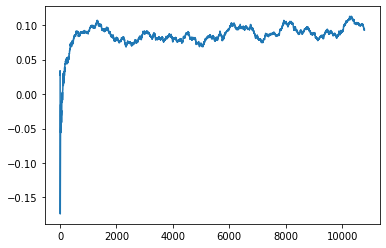

Thread: 4 iteration: 1800
RAM mDiffFit_382 FROM: 1728 --> 768 reward: 0.06704685859375001
Thread: 2 iteration: 1783
RAM mDiffFit_393 FROM: 2816 --> 1792 reward: -0.038583406249999994
Thread: 6 iteration: 1803
RAM mDiffFit_265 FROM: 320 --> 2112 reward: -0.08096608476562502
Thread: 4 iteration: 1801
RAM mDiffFit_408 FROM: 2816 --> 1792 reward: 0.046489601562499996
Thread: 1 iteration: 1727
RAM mBackground_66 FROM: 1984 --> 1024 reward: 0.072970086921875
Thread: 2 iteration: 1784
RAM mProject_56 FROM: 896 --> 1792 reward: -0.29373186121874983
Saving ...


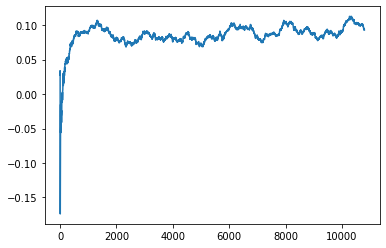

Thread: 3 iteration: 1800
RAM mDiffFit_235 FROM: 1216 --> 2112 reward: -0.043960951171875
Thread: 4 iteration: 1802
RAM mDiffFit_199 FROM: 2560 --> 768 reward: 0.04906247812500002
Thread: 6 iteration: 1804
RAM mDiffFit_6 FROM: 1664 --> 2112 reward: -0.035752632421875014
Thread: 3 iteration: 1801
RAM mBackground_1 FROM: 640 --> 1024 reward: -0.17814097042187496
Thread: 2 iteration: 1785
RAM mProject_80 FROM: 640 --> 1024 reward: 0.850380627375
Thread: 5 iteration: 1879
RAM mDiffFit_304 FROM: 1408 --> 2112 reward: -0.09596621601562501
Thread: 6 iteration: 1805
RAM mBackground_14 FROM: 1344 --> 1024 reward: 0.04207057213281253
Thread: 4 iteration: 1803
RAM mDiffFit_199 FROM: 1728 --> 2112 reward: -0.01772657070312501
Thread: 2 iteration: 1786
RAM mImgtbl_3 FROM: 1920 --> 1024 reward: 0.13059164625000005
Saving ...


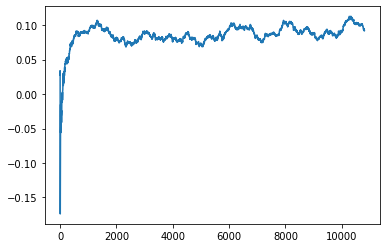

Thread: 5 iteration: 1880
RAM mDiffFit_154 FROM: 2112 --> 2112 reward: -0.002249999999999995
Thread: 4 iteration: 1804
RAM mDiffFit_282 FROM: 2944 --> 1792 reward: -0.0015521234375000074
Thread: 6 iteration: 1806
RAM mDiffFit_376 FROM: 2432 --> 768 reward: 0.06951561953125002
Thread: 2 iteration: 1787
RAM mBackground_62 FROM: 1792 --> 1024 reward: 0.035412250906250005
Thread: 5 iteration: 1881
RAM mProject_12 FROM: 192 --> 1024 reward: 0.842243122125
Thread: 1 iteration: 1728
RAM mProject_25 FROM: 1600 --> 1792 reward: -0.03759703403906247
Thread: 3 iteration: 1802
RAM mDiffFit_92 FROM: 1856 --> 2112 reward: -0.04639066328125
Thread: 6 iteration: 1807
RAM mBackground_29 FROM: 2304 --> 1024 reward: 0.04897513621875001
Thread: 4 iteration: 1805
RAM mDiffFit_25 FROM: 2688 --> 768 reward: -0.017125087499999993
Thread: 2 iteration: 1788
RAM mDiffFit_37 FROM: 320 --> 2112 reward: -0.0813228765625
Thread: 5 iteration: 1882
RAM mDiffFit_59 FROM: 2176 --> 768 reward: 0.04525513359374997
Thread:

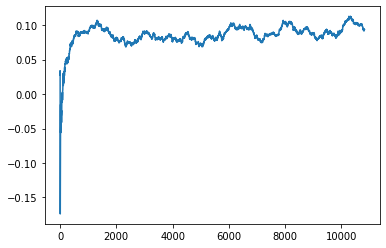

Thread: 1 iteration: 1730
RAM mDiffFit_291 FROM: 1920 --> 768 reward: 0.06481247812499996
Thread: 2 iteration: 1789
RAM mViewer_2 FROM: 1792 --> 1024 reward: 0.06824811778124999
Thread: 3 iteration: 1804
RAM mDiffFit_29 FROM: 1664 --> 2752 reward: 0.02948964531249999
Thread: 1 iteration: 1731
RAM mDiffFit_222 FROM: 320 --> 2112 reward: -0.128658827734375
Saving ...


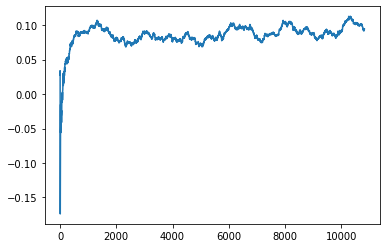

Thread: 2 iteration: 1790
RAM mViewer_3 FROM: 896 --> 1024 reward: -0.008600617781250012
Thread: 5 iteration: 1884
RAM mProject_5 FROM: 2432 --> 1792 reward: -0.11089990898437498
Thread: 6 iteration: 1808
RAM mProject_4 FROM: 2944 --> 1792 reward: -0.20112790162499994
Thread: 4 iteration: 1806
RAM mDiffFit_172 FROM: 2816 --> 1792 reward: 0.0033853984375000097
Thread: 1 iteration: 1732
RAM mDiffFit_370 FROM: 2816 --> 1792 reward: -0.09439597187499998
Thread: 2 iteration: 1791
RAM mDiffFit_366 FROM: 1216 --> 2112 reward: -0.06749482265624998
Thread: 5 iteration: 1885
RAM mDiffFit_112 FROM: 1280 --> 2112 reward: -0.007091128515625007
Thread: 6 iteration: 1809
RAM mDiffFit_62 FROM: 2240 --> 768 reward: 0.0013853546874999928
Thread: 4 iteration: 1807
RAM mProject_69 FROM: 2496 --> 1792 reward: -0.12289664988281251
Thread: 3 iteration: 1805
RAM mDiffFit_371 FROM: 2048 --> 2752 reward: 0.027552123437500006
Thread: 1 iteration: 1733
RAM mDiffFit_46 FROM: 1600 --> 2752 reward: 0.007919313671875

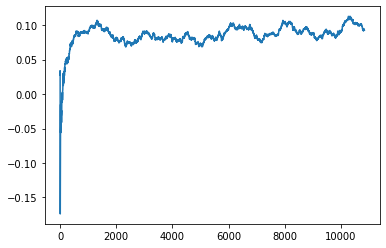

Thread: 6 iteration: 1810
RAM mDiffFit_249 FROM: 1472 --> 2752 reward: 0.011226614453124992
Thread: 5 iteration: 1887
RAM mDiffFit_339 FROM: 1856 --> 2752 reward: 0.0006744910156249867
Thread: 3 iteration: 1807
RAM mBackground_30 FROM: 448 --> 1024 reward: -0.18227294758593748
Thread: 1 iteration: 1734
RAM mBackground_68 FROM: 1664 --> 1024 reward: 0.052993009859374995
Thread: 4 iteration: 1809
RAM mDiffFit_343 FROM: 384 --> 2752 reward: -0.10137486875000004
Thread: 6 iteration: 1811
RAM mDiffFit_407 FROM: 1664 --> 2752 reward: 0.005390663281250006
Thread: 5 iteration: 1888
RAM mDiffFit_72 FROM: 2112 --> 2752 reward: 0.040643295703125006
Thread: 3 iteration: 1808
RAM mDiffFit_22 FROM: 2432 --> 2752 reward: -0.002289048828125022
Thread: 1 iteration: 1735
RAM mProject_51 FROM: 3008 --> 1792 reward: -0.2285634174609375
Thread: 2 iteration: 1793
RAM mDiffFit_176 FROM: 2048 --> 2752 reward: 0.015177123437499999
Thread: 5 iteration: 1889
RAM mDiffFit_248 FROM: 1344 --> 2112 reward: -0.008789

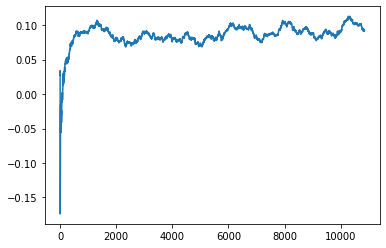

Thread: 4 iteration: 1810
RAM mDiffFit_307 FROM: 1728 --> 2752 reward: 0.02362504374999997
Thread: 1 iteration: 1737
RAM mDiffFit_9 FROM: 2368 --> 2752 reward: 0.010953141406249978
Saving ...


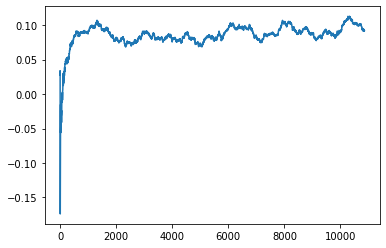

Thread: 5 iteration: 1890
RAM mDiffFit_178 FROM: 1984 --> 2752 reward: 0.02325004375
Saving ...


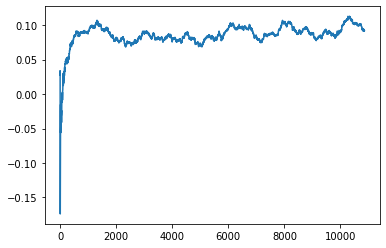

Thread: 3 iteration: 1810
RAM mDiffFit_158 FROM: 192 --> 2752 reward: -0.33784371718749995
Thread: 4 iteration: 1811
RAM mBackground_66 FROM: 3008 --> 1024 reward: -0.013245063578124978
Thread: 2 iteration: 1795
RAM mDiffFit_53 FROM: 2752 --> 1792 reward: 0.006752588671875021
Thread: 1 iteration: 1738
RAM mDiffFit_302 FROM: 896 --> 2752 reward: -0.024143120703125007
Thread: 3 iteration: 1811
RAM mDiffFit_146 FROM: 3008 --> 1792 reward: -0.10409911328124999
Thread: 2 iteration: 1796
RAM mDiffFit_130 FROM: 1920 --> 1792 reward: -0.0073437609375000094
Thread: 4 iteration: 1812
RAM mDiffFit_134 FROM: 1088 --> 2112 reward: -0.0007473675781250171
Thread: 3 iteration: 1812
RAM mDiffFit_276 FROM: 3008 --> 1792 reward: -0.004466172265624995
Thread: 2 iteration: 1797
RAM mDiffFit_377 FROM: 1984 --> 2112 reward: 0.0006458406250000118
Thread: 4 iteration: 1813
RAM mBackground_66 FROM: 2304 --> 1024 reward: 0.00877009859375001
Thread: 1 iteration: 1739
RAM mProject_66 FROM: 1088 --> 1792 reward: -0

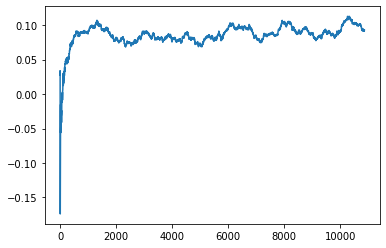

Thread: 1 iteration: 1740
RAM mDiffFit_131 FROM: 2688 --> 1792 reward: 0.05038544218750003
Thread: 6 iteration: 1813
RAM mProject_34 FROM: 768 --> 1024 reward: 0.842828122125
Thread: 5 iteration: 1891
RAM mDiffFit_258 FROM: 2560 --> 1792 reward: 0.02911460156250002
Thread: 4 iteration: 1815
RAM mDiffFit_121 FROM: 2688 --> 1792 reward: -0.01851566328125
Thread: 1 iteration: 1741
RAM mDiffFit_205 FROM: 2368 --> 2112 reward: -0.00946876093750001
Thread: 6 iteration: 1814
RAM mBackground_35 FROM: 1856 --> 1024 reward: 0.02121104436718745
Thread: 5 iteration: 1892
RAM mProject_61 FROM: 2432 --> 1792 reward: -0.09571895606250014
Thread: 3 iteration: 1813
RAM mProject_45 FROM: 2304 --> 1792 reward: -0.11729458434374991
Thread: 2 iteration: 1798
RAM mDiffFit_331 FROM: 832 --> 2112 reward: -0.06052865039062502
Thread: 1 iteration: 1742
RAM mDiffFit_409 FROM: 960 --> 2112 reward: -0.034148429296875005
Thread: 6 iteration: 1815
RAM mDiffFit_280 FROM: 1984 --> 2112 reward: -0.025268251953125005
Th

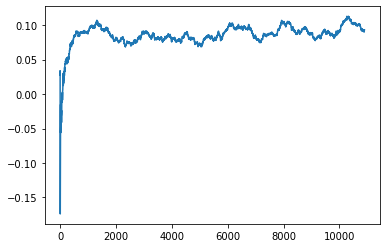

Thread: 2 iteration: 1800
RAM mDiffFit_140 FROM: 2496 --> 1792 reward: -0.00254168124999999
Thread: 3 iteration: 1818
RAM mDiffFit_256 FROM: 1344 --> 2112 reward: 0.004460951171874998
Thread: 1 iteration: 1745
RAM mBackground_64 FROM: 2176 --> 1024 reward: 0.030113357546874945
Thread: 4 iteration: 1819
RAM mProject_57 FROM: 1280 --> 1792 reward: -0.12323812303124988
Thread: 6 iteration: 1818
RAM mDiffFit_322 FROM: 384 --> 2112 reward: -0.055171814843750014
Saving ...


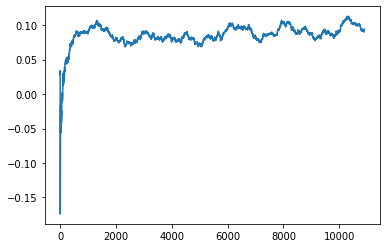

Thread: 4 iteration: 1820
RAM mDiffFit_321 FROM: 3008 --> 1792 reward: -0.016601614453124997
Thread: 6 iteration: 1819
RAM mBackground_5 FROM: 2368 --> 1024 reward: -0.006721107945312497
Thread: 1 iteration: 1746
RAM mProject_37 FROM: 1152 --> 1792 reward: -0.179571568078125
Thread: 5 iteration: 1897
RAM mDiffFit_379 FROM: 1408 --> 2112 reward: -0.07067712343750002
Thread: 2 iteration: 1801
RAM mDiffFit_144 FROM: 320 --> 2112 reward: -0.11388017734375003
Thread: 4 iteration: 1821
RAM mProject_78 FROM: 3008 --> 1792 reward: -0.20669619747656248
Thread: 3 iteration: 1819
RAM mDiffFit_364 FROM: 1536 --> 2112 reward: -0.077070375390625
Saving ...


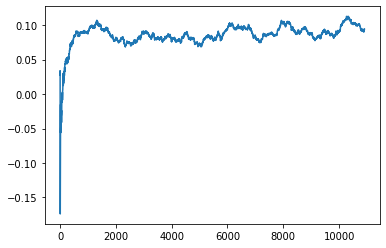

Thread: 6 iteration: 1820
RAM mDiffFit_189 FROM: 2048 --> 2112 reward: -0.0051770796874999955
Thread: 1 iteration: 1747
RAM mBackground_39 FROM: 896 --> 1024 reward: -0.11240922937500002
Thread: 5 iteration: 1898
RAM mDiffFit_70 FROM: 2752 --> 1792 reward: 0.003752588671875022
Thread: 4 iteration: 1822
RAM mDiffFit_125 FROM: 832 --> 2112 reward: -0.0040051773437500045
Saving ...


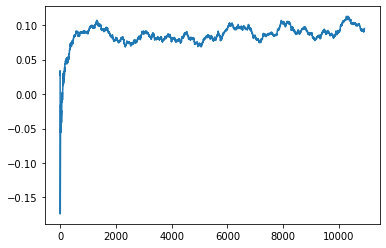

Thread: 3 iteration: 1820
RAM mDiffFit_64 FROM: 384 --> 2112 reward: -0.07385152695312501
Thread: 6 iteration: 1821
RAM mDiffFit_199 FROM: 2304 --> 1792 reward: 0.034958362500000006
Thread: 5 iteration: 1899
RAM mDiffFit_127 FROM: 1792 --> 768 reward: -0.03950008749999999
Thread: 1 iteration: 1748
RAM mDiffFit_197 FROM: 2688 --> 1792 reward: -0.020140663281250006
Thread: 4 iteration: 1823
RAM mDiffFit_407 FROM: 896 --> 2112 reward: -0.06529949101562503
Thread: 6 iteration: 1822
RAM mBackground_43 FROM: 2304 --> 1024 reward: -0.025119304624999995
Saving ...


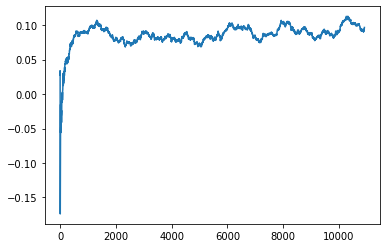

Thread: 5 iteration: 1900
RAM mProject_12 FROM: 1536 --> 320 reward: -1.0
Thread: 2 iteration: 1802
RAM mDiffFit_265 FROM: 2176 --> 768 reward: 0.00383327499999999
Thread: 4 iteration: 1824
RAM mBackground_83 FROM: 640 --> 1024 reward: -0.15776075895312497
Thread: 5 iteration: 1901
RAM mDiffFit_272 FROM: 512 --> 2112 reward: -0.05830462460937498
Thread: 2 iteration: 1803
RAM mBackground_55 FROM: 1024 --> 1024 reward: -0.01519334587499996
Thread: 4 iteration: 1825
RAM mBackground_16 FROM: 960 --> 1024 reward: -0.009498072132812478
Thread: 2 iteration: 1804
RAM mBackground_27 FROM: 2880 --> 1024 reward: -0.021531506234375036
Thread: 4 iteration: 1826
RAM mDiffFit_26 FROM: 1536 --> 2112 reward: -0.010632809765625008
Thread: 2 iteration: 1805
RAM mDiffFit_255 FROM: 2176 --> 768 reward: 0.029020796875000015
Thread: 4 iteration: 1827
RAM mDiffFit_221 FROM: 1664 --> 2112 reward: -0.012028650390625024
Thread: 4 iteration: 1828
RAM mProject_6 FROM: 1472 --> 320 reward: -1.0
Thread: 3 iteration:

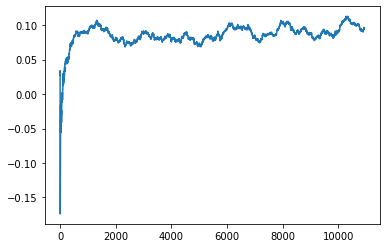

Thread: 1 iteration: 1750
RAM mProject_41 FROM: 320 --> 1024 reward: 0.8428506221250002
Thread: 5 iteration: 1902
RAM mDiffFit_128 FROM: 2304 --> 768 reward: -0.02137508750000001
Thread: 6 iteration: 1824
RAM mDiffFit_154 FROM: 2496 --> 768 reward: 0.015117146484375024
Thread: 6 iteration: 1825
RAM mDiffFit_288 FROM: 2176 --> 2112 reward: 0.01629690234375
Thread: 6 iteration: 1826
RAM mProject_8 FROM: 1984 --> 320 reward: -1.0
Thread: 2 iteration: 1806
RAM mDiffFit_304 FROM: 1088 --> 2112 reward: -0.004247367578125005
Thread: 2 iteration: 1807
RAM mBackground_82 FROM: 2368 --> 1024 reward: -0.005001107945312508
Thread: 2 iteration: 1808
RAM mBackground_56 FROM: 704 --> 1024 reward: -0.10494912947656244
Thread: 2 iteration: 1809
RAM mProject_13 FROM: 2432 --> 320 reward: -1.0
Thread: 3 iteration: 1822
RAM mProject_4 FROM: 640 --> 1024 reward: 0.84580562475
Thread: 1 iteration: 1751
RAM mDiffFit_313 FROM: 2368 --> 768 reward: 0.025760310937499968
Saving ...


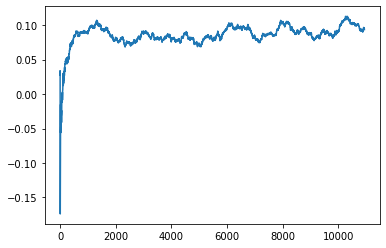

Thread: 2 iteration: 1810
RAM mDiffFit_161 FROM: 2496 --> 768 reward: 0.140523473046875
Thread: 3 iteration: 1823
RAM mDiffFit_182 FROM: 1856 --> 2112 reward: -0.037838583593750016
Thread: 1 iteration: 1752
RAM mProject_83 FROM: 1856 --> 320 reward: -1.0
Saving ...


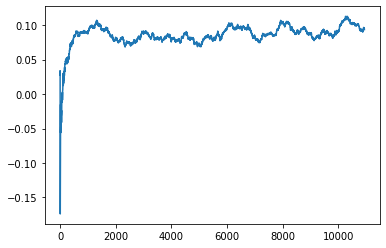

Thread: 4 iteration: 1830
RAM mProject_74 FROM: 2688 --> 704 reward: -1.0
Thread: 5 iteration: 1903
RAM mProject_64 FROM: 2368 --> 704 reward: -1.0
Thread: 6 iteration: 1827
RAM mDiffFit_383 FROM: 1216 --> 2112 reward: 0.0009817917968750044
Thread: 2 iteration: 1811
RAM mDiffFit_416 FROM: 2688 --> 1792 reward: -0.004135442187499991
Thread: 5 iteration: 1904
RAM mDiffFit_405 FROM: 1152 --> 2112 reward: -0.030023429296875015
Thread: 1 iteration: 1753
RAM mBackground_22 FROM: 2560 --> 1024 reward: 0.03898657887499999
Thread: 3 iteration: 1824
RAM mBackground_2 FROM: 640 --> 1024 reward: -0.10896021146874998
Thread: 4 iteration: 1831
RAM mBackground_76 FROM: 1920 --> 1024 reward: 0.048760173843749983
Thread: 6 iteration: 1828
RAM mDiffFit_206 FROM: 1856 --> 768 reward: 0.07657292031249997
Thread: 2 iteration: 1812
RAM mDiffFit_161 FROM: 1600 --> 2112 reward: 0.004687521874999984
Thread: 1 iteration: 1754
RAM mDiffFit_393 FROM: 2624 --> 1792 reward: -0.015197964062500027
Thread: 4 iteration

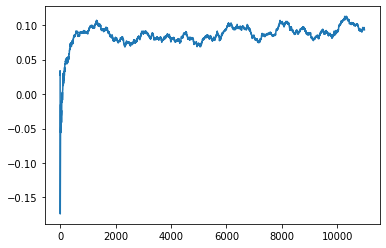

Thread: 6 iteration: 1830
RAM mDiffFit_289 FROM: 2368 --> 768 reward: 0.038320287890625006
Thread: 2 iteration: 1817
RAM mBackground_3 FROM: 2944 --> 1024 reward: -0.019256120921875015
Thread: 5 iteration: 1907
RAM mBackground_27 FROM: 1984 --> 1024 reward: -0.03532731448437496
Saving ...


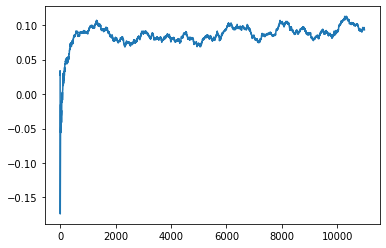

Thread: 3 iteration: 1830
RAM mProject_66 FROM: 2560 --> 704 reward: -1.0
Thread: 4 iteration: 1835
RAM mDiffFit_387 FROM: 2496 --> 768 reward: 0.04505466835937503
Thread: 1 iteration: 1759
RAM mDiffFit_254 FROM: 1664 --> 2112 reward: -0.029877632421875
Thread: 6 iteration: 1831
RAM mDiffFit_181 FROM: 2496 --> 768 reward: 0.038835907421874996
Thread: 2 iteration: 1818
RAM mBackground_51 FROM: 2560 --> 1024 reward: 0.0026873871249999725
Thread: 5 iteration: 1908
RAM mDiffFit_399 FROM: 2368 --> 768 reward: 0.03289579687500001
Thread: 2 iteration: 1819
RAM mDiffFit_140 FROM: 1280 --> 2112 reward: 0.11389860429687498
Saving ...


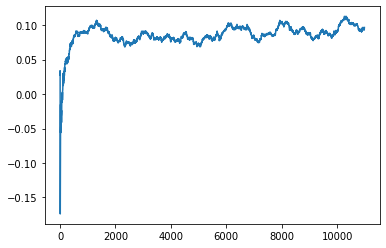

Thread: 1 iteration: 1760
RAM mDiffFit_228 FROM: 256 --> 2112 reward: -0.160622367578125
Saving ...


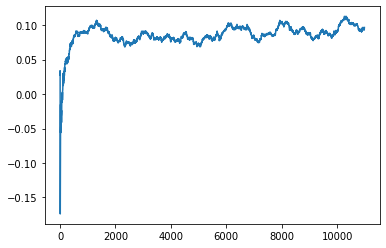

Thread: 2 iteration: 1820
RAM mDiffFit_416 FROM: 1408 --> 2112 reward: -0.0679271234375
Thread: 1 iteration: 1761
RAM mDiffFit_129 FROM: 2112 --> 896 reward: 0.026817655468750028
Thread: 1 iteration: 1762
RAM mDiffFit_20 FROM: 448 --> 2112 reward: -0.1834478765625
Thread: 1 iteration: 1763
RAM mProject_74 FROM: 1408 --> 704 reward: -1.0
Thread: 3 iteration: 1831
RAM mBackground_84 FROM: 2816 --> 1024 reward: 0.012980483906249965
Thread: 3 iteration: 1832
RAM mDiffFit_290 FROM: 832 --> 2112 reward: -0.05715365039062502
Thread: 3 iteration: 1833
RAM mProject_53 FROM: 1024 --> 704 reward: -1.0
Thread: 4 iteration: 1836
RAM mProject_73 FROM: 2112 --> 704 reward: -1.0
Thread: 6 iteration: 1832
RAM mProject_6 FROM: 2304 --> 704 reward: -1.0
Thread: 5 iteration: 1909
RAM mProject_49 FROM: 192 --> 1024 reward: 0.8493456273750001
Thread: 2 iteration: 1821
RAM mDiffFit_8 FROM: 2496 --> 896 reward: 0.05922134960937502
Thread: 4 iteration: 1837
RAM mDiffFit_4 FROM: 2368 --> 896 reward: 0.109716172

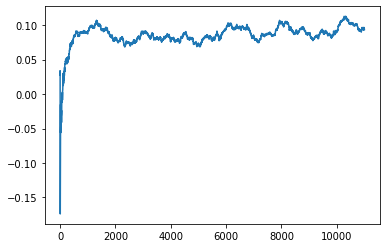

Thread: 5 iteration: 1910
RAM mDiffFit_105 FROM: 2880 --> 896 reward: 0.09240365039062498
Thread: 6 iteration: 1833
RAM mDiffFit_192 FROM: 960 --> 2112 reward: -0.018562478125000014
Thread: 2 iteration: 1822
RAM mDiffFit_192 FROM: 1536 --> 2112 reward: 0.082367277734375
Thread: 5 iteration: 1911
RAM mDiffFit_297 FROM: 1600 --> 2112 reward: 0.006083362499999991
Thread: 4 iteration: 1838
RAM mDiffFit_51 FROM: 1984 --> 2112 reward: -0.05314588437500001
Thread: 2 iteration: 1823
RAM mProject_17 FROM: 1536 --> 704 reward: -1.0
Thread: 1 iteration: 1764
RAM mDiffFit_297 FROM: 704 --> 2112 reward: -0.15041409257812502
Thread: 6 iteration: 1834
RAM mViewer_3 FROM: 1280 --> 1024 reward: 0.0023580985312500235
Thread: 4 iteration: 1839
RAM mProject_60 FROM: 256 --> 1024 reward: 0.8392881194999999
Thread: 3 iteration: 1834
RAM mDiffFit_89 FROM: 2240 --> 2112 reward: -0.0021458406250000027
Thread: 2 iteration: 1824
RAM mDiffFit_26 FROM: 3008 --> 896 reward: 0.04753382773437502
Thread: 6 iteration: 

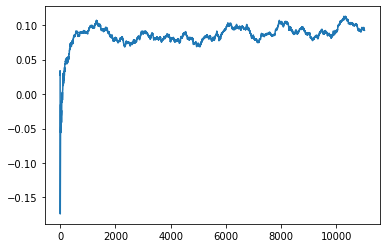

Thread: 4 iteration: 1840
RAM mDiffFit_70 FROM: 192 --> 2112 reward: -0.240695287890625
Thread: 3 iteration: 1835
RAM mDiffFit_56 FROM: 1216 --> 2112 reward: -0.04647915937500004
Thread: 2 iteration: 1825
RAM mBackground_79 FROM: 1344 --> 1024 reward: 0.0016371017109374996
Thread: 6 iteration: 1836
RAM mDiffFit_67 FROM: 2624 --> 896 reward: 0.006921814843749985
Thread: 2 iteration: 1826
RAM mDiffFit_165 FROM: 2816 --> 768 reward: 0.0422811515625
Thread: 3 iteration: 1836
RAM mDiffFit_345 FROM: 2944 --> 768 reward: 0.042682213281249985
Thread: 4 iteration: 1841
RAM mProject_36 FROM: 512 --> 1024 reward: 0.84659312475
Thread: 1 iteration: 1765
RAM mDiffFit_129 FROM: 576 --> 2112 reward: -0.03259371718750001
Thread: 6 iteration: 1837
RAM mProject_2 FROM: 1664 --> 704 reward: -1.0
Thread: 5 iteration: 1912
RAM mDiffFit_132 FROM: 320 --> 2112 reward: -0.102986969140625
Thread: 2 iteration: 1827
RAM mDiffFit_92 FROM: 128 --> 1792 reward: -0.79621353984375
Thread: 3 iteration: 1837
RAM mDiffF

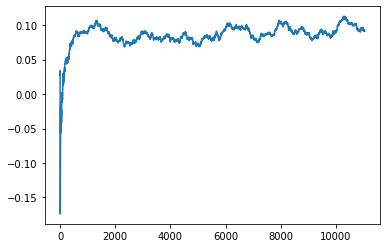

Thread: 6 iteration: 1840
RAM mDiffFit_122 FROM: 2560 --> 768 reward: 0.031968717187499995
Thread: 1 iteration: 1768
RAM mProject_72 FROM: 448 --> 1024 reward: 0.8494581273749999
Thread: 5 iteration: 1913
RAM mProject_62 FROM: 2816 --> 704 reward: -1.0
Thread: 4 iteration: 1842
RAM mBackground_70 FROM: 2304 --> 1024 reward: 0.0235245018125
Thread: 6 iteration: 1841
RAM mDiffFit_2 FROM: 2752 --> 896 reward: 0.034859292968750025
Thread: 1 iteration: 1769
RAM mBgModel_2 FROM: 512 --> 704 reward: -0.14416979640625005
Saving ...


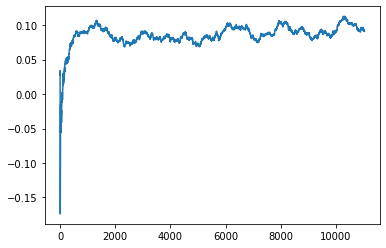

Thread: 3 iteration: 1840
RAM mDiffFit_39 FROM: 256 --> 2112 reward: -0.24541663749999998
Thread: 5 iteration: 1914
RAM mDiffFit_14 FROM: 448 --> 2112 reward: 0.081742277734375
Thread: 4 iteration: 1843
RAM mBackground_50 FROM: 2816 --> 1024 reward: 0.01123361831250004
Thread: 6 iteration: 1842
RAM mDiffFit_396 FROM: 640 --> 2112 reward: -0.08299995625
Thread: 5 iteration: 1915
RAM mDiffFit_275 FROM: 2880 --> 896 reward: 0.008132766015624994
Thread: 6 iteration: 1843
RAM mBackground_39 FROM: 1792 --> 1024 reward: 0.01985161650000002
Thread: 4 iteration: 1844
RAM mProject_12 FROM: 2304 --> 704 reward: -1.0
Saving ...


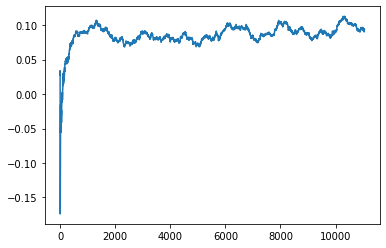

Thread: 2 iteration: 1830
RAM mDiffFit_279 FROM: 576 --> 2112 reward: -0.14028123906250003
Thread: 5 iteration: 1916
RAM mDiffFit_47 FROM: 640 --> 2112 reward: -0.06577342929687502
Thread: 4 iteration: 1845
RAM mDiffFit_249 FROM: 2560 --> 896 reward: 0.017968717187500007
Thread: 2 iteration: 1831
RAM mDiffFit_306 FROM: 896 --> 2112 reward: -0.04341926992187502
Thread: 5 iteration: 1917
RAM mDiffFit_4 FROM: 2240 --> 896 reward: -0.010705773828124984
Thread: 2 iteration: 1832
RAM mDiffFit_269 FROM: 2240 --> 896 reward: 0.058494778906249975
Thread: 5 iteration: 1918
RAM mProject_67 FROM: 2880 --> 704 reward: -1.0
Saving ...


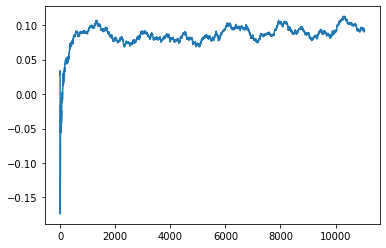

Thread: 1 iteration: 1770
RAM mProject_16 FROM: 1280 --> 704 reward: -1.0
Thread: 3 iteration: 1841
RAM mDiffFit_361 FROM: 448 --> 2112 reward: -0.069533827734375
Thread: 5 iteration: 1919
RAM mDiffFit_362 FROM: 3008 --> 896 reward: 0.03240360664062503
Thread: 3 iteration: 1842
RAM mDiffFit_399 FROM: 960 --> 2112 reward: -0.06074219023437499
Saving ...


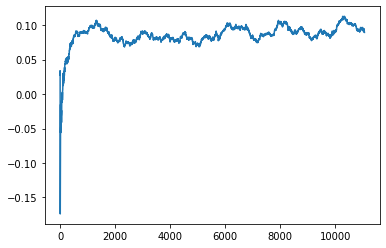

Thread: 5 iteration: 1920
RAM mDiffFit_272 FROM: 256 --> 2112 reward: -0.12322652695312503
Thread: 3 iteration: 1843
RAM mProject_85 FROM: 1216 --> 704 reward: -1.0
Thread: 6 iteration: 1844
RAM mDiffFit_354 FROM: 1920 --> 896 reward: 0.051770840625
Thread: 5 iteration: 1921
RAM mDiffFit_40 FROM: 256 --> 2112 reward: -0.21866404882812499
Thread: 6 iteration: 1845
RAM mDiffFit_169 FROM: 512 --> 2112 reward: -0.08646871718750002
Thread: 5 iteration: 1922
RAM mDiffFit_315 FROM: 2240 --> 896 reward: -0.015341216015625006
Thread: 6 iteration: 1846
RAM mProject_83 FROM: 320 --> 1024 reward: 0.84657062475
Thread: 2 iteration: 1833
RAM mDiffFit_278 FROM: 256 --> 896 reward: -0.37938026484375
Thread: 5 iteration: 1923
RAM mProject_52 FROM: 320 --> 1024 reward: 0.8389506194999999
Thread: 1 iteration: 1771
RAM mBackground_80 FROM: 2432 --> 1024 reward: 0.010633444468749977
Thread: 6 iteration: 1847
RAM mDiffFit_1 FROM: 2048 --> 2112 reward: -0.019341172265625005
Thread: 5 iteration: 1924
RAM mDif

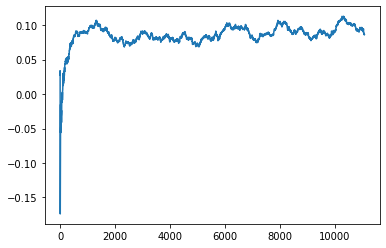

Thread: 4 iteration: 1850
RAM mDiffFit_345 FROM: 2944 --> 896 reward: 1.2973393273437497
Thread: 3 iteration: 1848
RAM mProject_39 FROM: 2816 --> 704 reward: -1.0
Thread: 5 iteration: 1925
RAM mDiffFit_273 FROM: 448 --> 2112 reward: -0.056718717187499997
Thread: 2 iteration: 1836
RAM mDiffFit_291 FROM: 2240 --> 896 reward: 0.044854115624999996
Saving ...


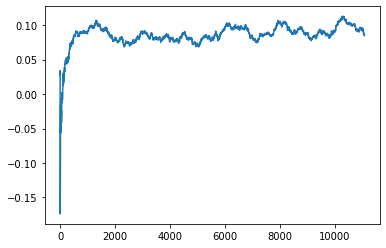

Thread: 6 iteration: 1850
RAM mDiffFit_50 FROM: 512 --> 2112 reward: -0.16093225703124997
Thread: 4 iteration: 1851
RAM mDiffFit_282 FROM: 192 --> 2112 reward: -0.20067181484375002
Thread: 5 iteration: 1926
RAM mProject_82 FROM: 2560 --> 704 reward: -1.0
Thread: 1 iteration: 1775
RAM mAdd_3 FROM: 704 --> 1024 reward: -0.1811276105468751
Thread: 2 iteration: 1837
RAM mDiffFit_305 FROM: 1536 --> 2112 reward: 0.007429712109374986
Thread: 6 iteration: 1851
RAM mBackground_41 FROM: 1088 --> 1024 reward: -0.030164975351562477
Thread: 4 iteration: 1852
RAM mDiffFit_102 FROM: 896 --> 2112 reward: -0.04432287656250002
Thread: 6 iteration: 1852
RAM mProject_8 FROM: 640 --> 1024 reward: 0.836265616875
Thread: 3 iteration: 1849
RAM mDiffFit_84 FROM: 1344 --> 2112 reward: -0.021484380468750012
Saving ...


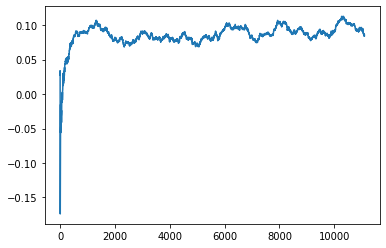

Thread: 3 iteration: 1850
RAM mProject_50 FROM: 256 --> 1024 reward: 0.8539656299999998
Thread: 5 iteration: 1927
RAM mProject_77 FROM: 1728 --> 704 reward: -1.0
Thread: 1 iteration: 1776
RAM mBackground_29 FROM: 192 --> 1024 reward: -0.7174639426562499
Thread: 5 iteration: 1928
RAM mProject_55 FROM: 384 --> 1024 reward: 0.843300622125
Thread: 6 iteration: 1853
RAM mProject_39 FROM: 2816 --> 704 reward: -1.0
Thread: 2 iteration: 1838
RAM mProject_27 FROM: 2816 --> 704 reward: -1.0
Thread: 4 iteration: 1853
RAM mDiffFit_414 FROM: 896 --> 2112 reward: 0.0048463933593749856
Thread: 1 iteration: 1777
RAM mBackground_35 FROM: 2304 --> 1024 reward: 0.024062001812499973
Thread: 5 iteration: 1929
RAM mDiffFit_170 FROM: 384 --> 2112 reward: -0.09246090742187502
Thread: 4 iteration: 1854
RAM mBackground_84 FROM: 2496 --> 1024 reward: 0.025347511671874996
Thread: 6 iteration: 1854
RAM mProject_76 FROM: 2496 --> 704 reward: -1.0
Thread: 3 iteration: 1851
RAM mDiffFit_273 FROM: 1728 --> 2112 reward

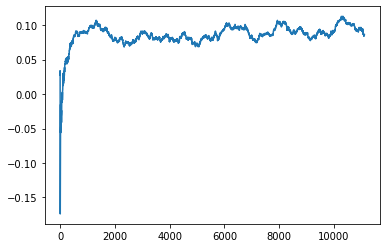

Thread: 5 iteration: 1930
RAM mDiffFit_199 FROM: 1152 --> 2112 reward: 0.0223438046875
Thread: 6 iteration: 1855
RAM mBackground_60 FROM: 320 --> 1024 reward: -0.4704401868203125
Thread: 4 iteration: 1855
RAM mDiffFit_97 FROM: 2368 --> 192 reward: 0.6133880308593751
Thread: 3 iteration: 1852
RAM mDiffFit_36 FROM: 2752 --> 768 reward: 0.044335907421875015
Thread: 5 iteration: 1931
RAM mDiffFit_148 FROM: 2880 --> 768 reward: -0.002375087500000022
Thread: 4 iteration: 1856
RAM mBackground_64 FROM: 1344 --> 1024 reward: 0.004886741046874981
Thread: 1 iteration: 1779
RAM mProject_14 FROM: 1856 --> 704 reward: -1.0
Thread: 2 iteration: 1839
RAM mDiffFit_170 FROM: 512 --> 2112 reward: -0.074966128515625
Thread: 3 iteration: 1853
RAM mDiffFit_234 FROM: 960 --> 2112 reward: -0.008937478125000016
Thread: 5 iteration: 1932
RAM mDiffFit_10 FROM: 1536 --> 896 reward: -0.028125087500000014
Thread: 4 iteration: 1857
RAM mDiffFit_295 FROM: 1408 --> 2112 reward: -0.002861969140625
Saving ...


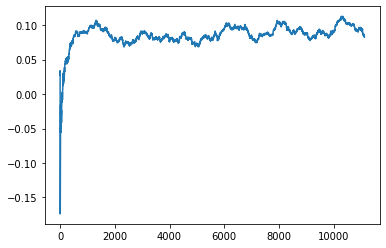

Thread: 2 iteration: 1840
RAM mDiffFit_76 FROM: 2816 --> 896 reward: -0.028682388281250012
Thread: 4 iteration: 1858
RAM mBackground_81 FROM: 640 --> 1024 reward: -0.14001876881249997
Thread: 5 iteration: 1933
RAM mDiffFit_206 FROM: 704 --> 2112 reward: -0.07650000000000001
Thread: 3 iteration: 1854
RAM mProject_57 FROM: 768 --> 1024 reward: 0.8544606299999999
Thread: 6 iteration: 1856
RAM mBackground_73 FROM: 1984 --> 1024 reward: 0.07020866891406251
Thread: 2 iteration: 1841
RAM mDiffFit_43 FROM: 2048 --> 896 reward: -0.23755238593750008
Thread: 5 iteration: 1934
RAM mDiffFit_72 FROM: 1024 --> 2112 reward: -0.01746612851562501
Thread: 6 iteration: 1857
RAM mDiffFit_197 FROM: 2944 --> 896 reward: -0.007989645312500016
Thread: 3 iteration: 1855
RAM mBackground_79 FROM: 128 --> 1024 reward: -1.3955605474843749
Thread: 4 iteration: 1859
RAM mDiffFit_189 FROM: 640 --> 2112 reward: -0.02715882773437499
Thread: 2 iteration: 1842
RAM mDiffFit_375 FROM: 2496 --> 896 reward: 0.0069113726562500

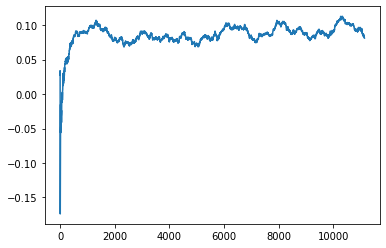

Thread: 4 iteration: 1860
RAM mDiffFit_238 FROM: 640 --> 2112 reward: -0.05009112851562501
Thread: 6 iteration: 1859
RAM mDiffFit_346 FROM: 576 --> 2112 reward: -0.11099214648437505
Thread: 2 iteration: 1843
RAM mDiffFit_96 FROM: 2304 --> 896 reward: -0.051880308593749994
Thread: 3 iteration: 1857
RAM mBackground_29 FROM: 768 --> 1024 reward: -0.07459605734375001
Thread: 5 iteration: 1936
RAM mProject_73 FROM: 1472 --> 704 reward: -1.0
Saving ...


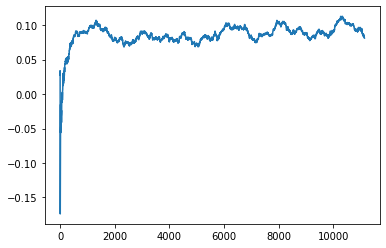

Thread: 1 iteration: 1780
RAM mDiffFit_327 FROM: 320 --> 896 reward: -0.38066413632812496
Thread: 3 iteration: 1858
RAM mDiffFit_376 FROM: 192 --> 2112 reward: -0.28529685859375
Thread: 1 iteration: 1781
RAM mDiffFit_65 FROM: 2624 --> 896 reward: -0.03633862734375001
Thread: 5 iteration: 1937
RAM mBackground_79 FROM: 1280 --> 1024 reward: -0.047434440843750016
Thread: 4 iteration: 1861
RAM mAdd_1 FROM: 1152 --> 1024 reward: 0.02984634960937503
Thread: 2 iteration: 1844
RAM mDiffFit_316 FROM: 512 --> 2112 reward: -0.051924447265625014
Thread: 3 iteration: 1859
RAM mDiffFit_336 FROM: 3008 --> 896 reward: 0.09015110546874999
Thread: 1 iteration: 1782
RAM mDiffFit_128 FROM: 704 --> 2112 reward: -0.04747393828125002
Thread: 2 iteration: 1845
RAM mDiffFit_34 FROM: 1408 --> 2112 reward: -0.016986969140625006
Thread: 5 iteration: 1938
RAM mDiffFit_334 FROM: 2432 --> 896 reward: -0.037750087499999994
Thread: 4 iteration: 1862
RAM mDiffFit_395 FROM: 960 --> 2112 reward: -0.12900004375
Saving ...

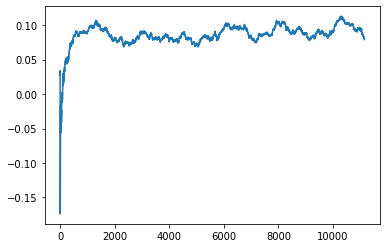

Thread: 3 iteration: 1860
RAM mDiffFit_145 FROM: 1216 --> 2112 reward: 0.014862012890624991
Thread: 1 iteration: 1783
RAM mDiffFit_216 FROM: 1728 --> 896 reward: 0.01586196914062498
Thread: 5 iteration: 1939
RAM mBackground_26 FROM: 1792 --> 1024 reward: 0.04748809678124998
Thread: 2 iteration: 1846
RAM mDiffFit_139 FROM: 2240 --> 896 reward: 0.014653562890625041
Thread: 4 iteration: 1863
RAM mProject_75 FROM: 2816 --> 704 reward: -1.0
Saving ...


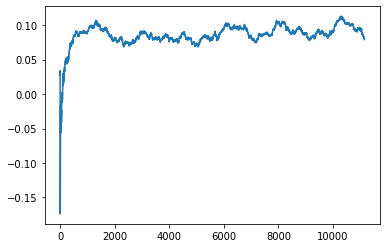

Thread: 6 iteration: 1860
RAM mDiffFit_176 FROM: 1472 --> 2112 reward: -0.029541681250000017
Thread: 1 iteration: 1784
RAM mDiffFit_374 FROM: 1472 --> 2112 reward: -0.0076848894531250135
Thread: 2 iteration: 1847
RAM mDiffFit_421 FROM: 128 --> 896 reward: -0.8291146453125
Thread: 6 iteration: 1861
RAM mDiffFit_107 FROM: 2368 --> 896 reward: -0.07041418007812499
Saving ...


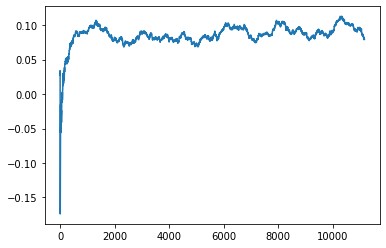

Thread: 5 iteration: 1940
RAM mDiffFit_310 FROM: 1216 --> 2112 reward: -0.023677079687500005
Thread: 6 iteration: 1862
RAM mDiffFit_222 FROM: 2432 --> 896 reward: 0.0071978765625
Thread: 2 iteration: 1848
RAM mDiffFit_255 FROM: 2304 --> 896 reward: -0.020724025781250002
Thread: 6 iteration: 1863
RAM mBackground_65 FROM: 384 --> 2112 reward: -0.45485936559375
Thread: 1 iteration: 1785
RAM mDiffFit_367 FROM: 576 --> 2112 reward: -0.056445287890624994
Thread: 6 iteration: 1864
RAM mDiffFit_363 FROM: 768 --> 2112 reward: -0.004406195312500003
Thread: 6 iteration: 1865
RAM mBackground_7 FROM: 1216 --> 1024 reward: 0.033956567203125024
Thread: 1 iteration: 1786
RAM mProject_6 FROM: 2688 --> 704 reward: -1.0
Thread: 4 iteration: 1864
RAM mProject_52 FROM: 1344 --> 704 reward: -1.0
Thread: 3 iteration: 1861
RAM mDiffFit_352 FROM: 2176 --> 896 reward: 0.02468225703125
Thread: 1 iteration: 1787
RAM mConcatFit_2 FROM: 640 --> 1024 reward: -0.19409171625
Thread: 6 iteration: 1866
RAM mDiffFit_348 

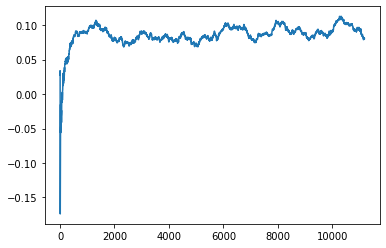

Thread: 2 iteration: 1850
RAM mAdd_1 FROM: 2304 --> 1024 reward: 0.262541725
Saving ...


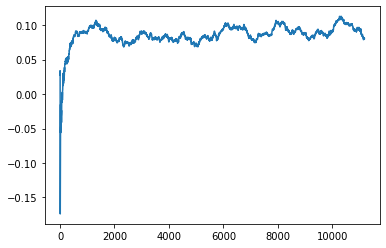

Thread: 1 iteration: 1790
RAM mProject_86 FROM: 2048 --> 704 reward: -1.0
Thread: 4 iteration: 1865
RAM mDiffFit_126 FROM: 2560 --> 896 reward: -0.004546989843749981
Thread: 3 iteration: 1865
RAM mDiffFit_195 FROM: 512 --> 2112 reward: -0.23779953476562504
Thread: 2 iteration: 1851
RAM mDiffFit_280 FROM: 1408 --> 2112 reward: 0.06563030859374999
Thread: 1 iteration: 1791
RAM mBackground_27 FROM: 320 --> 2112 reward: -0.3612693526171875
Saving ...


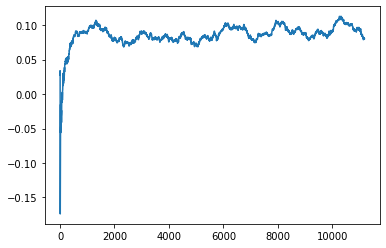

Thread: 6 iteration: 1870
RAM mProject_77 FROM: 2752 --> 704 reward: -1.0
Thread: 5 iteration: 1942
RAM mDiffFit_201 FROM: 960 --> 2112 reward: -0.024945287890624987
Thread: 4 iteration: 1866
RAM mDiffFit_275 FROM: 1792 --> 2112 reward: -0.0002890488281250079
Thread: 6 iteration: 1871
RAM mDiffFit_336 FROM: 2304 --> 896 reward: 0.0010572570312500015
Thread: 2 iteration: 1852
RAM mDiffFit_7 FROM: 2496 --> 896 reward: 0.013567655468749995
Thread: 1 iteration: 1792
RAM mDiffFit_276 FROM: 576 --> 2112 reward: 0.10653137031250001
Thread: 5 iteration: 1943
RAM mDiffFit_87 FROM: 2624 --> 768 reward: -0.07192203359375003
Thread: 4 iteration: 1867
RAM mDiffFit_44 FROM: 2048 --> 2112 reward: -0.056799534765625
Thread: 6 iteration: 1872
RAM mDiffFit_9 FROM: 2816 --> 896 reward: 0.01249995625
Thread: 2 iteration: 1853
RAM mDiffFit_62 FROM: 1920 --> 2112 reward: -0.024195331640624995
Thread: 1 iteration: 1793
RAM mDiffFit_241 FROM: 2880 --> 896 reward: -0.0525105296875
Thread: 5 iteration: 1944
RAM

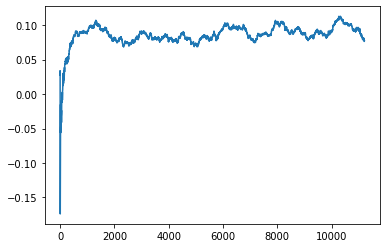

Thread: 4 iteration: 1870
RAM mDiffFit_350 FROM: 1280 --> 2112 reward: -0.02958073007812501
Thread: 6 iteration: 1875
RAM mDiffFit_22 FROM: 2560 --> 896 reward: -0.012416724999999981
Thread: 1 iteration: 1796
RAM mDiffFit_5 FROM: 128 --> 896 reward: -0.6169062828125
Thread: 2 iteration: 1856
RAM mBackground_29 FROM: 320 --> 2112 reward: -0.1424349351171875
Thread: 3 iteration: 1868
RAM mDiffFit_333 FROM: 2816 --> 896 reward: -0.10078663515625
Thread: 1 iteration: 1797
RAM mDiffFit_33 FROM: 1472 --> 832 reward: 0.08751044218750001
Thread: 4 iteration: 1871
RAM mDiffFit_68 FROM: 704 --> 2752 reward: 0.12090123671874994
Thread: 2 iteration: 1857
RAM mDiffFit_322 FROM: 3008 --> 896 reward: -0.005265707031250014
Thread: 3 iteration: 1869
RAM mDiffFit_369 FROM: 1024 --> 832 reward: 0.039351570703125005
Thread: 6 iteration: 1876
RAM mDiffFit_243 FROM: 1088 --> 2112 reward: 0.023377676171874983
Thread: 1 iteration: 1798
RAM mDiffFit_42 FROM: 2816 --> 896 reward: -0.0041302648437500054
Thread: 

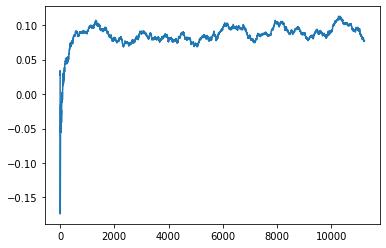

Thread: 3 iteration: 1870
RAM mBackground_13 FROM: 1792 --> 1024 reward: 0.08873228853124995
Thread: 2 iteration: 1858
RAM mProject_15 FROM: 2368 --> 704 reward: -1.0
Thread: 5 iteration: 1946
RAM mDiffFit_300 FROM: 1536 --> 2112 reward: -0.017257809765625007
Thread: 4 iteration: 1873
RAM mDiffFit_62 FROM: 448 --> 2112 reward: -0.06555984570312501
Thread: 1 iteration: 1799
RAM mDiffFit_390 FROM: 640 --> 2112 reward: -0.01935152695312501
Thread: 2 iteration: 1859
RAM mDiffFit_68 FROM: 320 --> 832 reward: -0.353320375390625
Thread: 5 iteration: 1947
RAM mDiffFit_181 FROM: 1216 --> 2112 reward: -0.0018932082031249998
Thread: 4 iteration: 1874
RAM mDiffFit_62 FROM: 2112 --> 2112 reward: -0.009874999999999997
Saving ...


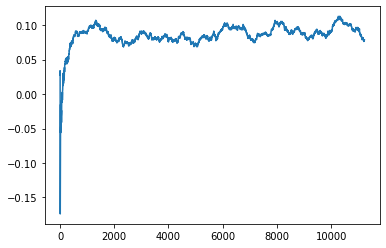

Thread: 2 iteration: 1860
RAM mDiffFit_88 FROM: 1728 --> 2112 reward: -0.004023429296875006
Thread: 5 iteration: 1948
RAM mDiffFit_96 FROM: 2048 --> 2112 reward: 0.0014479203125000034
Thread: 4 iteration: 1875
RAM mDiffFit_20 FROM: 1216 --> 2112 reward: -0.03157028789062502
Thread: 2 iteration: 1861
RAM mDiffFit_320 FROM: 2304 --> 896 reward: 0.0015572570312500159
Thread: 5 iteration: 1949
RAM mProject_23 FROM: 1728 --> 704 reward: -1.0
Thread: 6 iteration: 1877
RAM mDiffFit_181 FROM: 128 --> 896 reward: -0.54459898203125
Thread: 2 iteration: 1862
RAM mBackground_44 FROM: 2624 --> 2112 reward: -0.03545715231249998
Thread: 4 iteration: 1876
RAM mDiffFit_216 FROM: 2432 --> 896 reward: -0.038432388281250014
Thread: 6 iteration: 1878
RAM mDiffFit_2 FROM: 320 --> 896 reward: -0.27210938046875
Saving ...


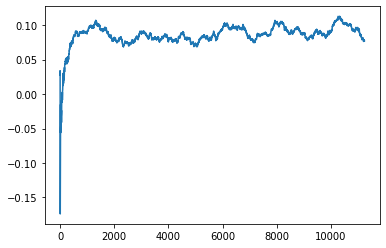

Thread: 5 iteration: 1950
RAM mProject_27 FROM: 960 --> 704 reward: -1.0
Thread: 3 iteration: 1871
RAM mBackground_34 FROM: 512 --> 2112 reward: -0.24517610664062492
Thread: 2 iteration: 1863
RAM mDiffFit_321 FROM: 128 --> 896 reward: -0.74020318515625
Thread: 4 iteration: 1877
RAM mDiffFit_98 FROM: 1280 --> 832 reward: 0.05456252187500002
Thread: 6 iteration: 1879
RAM mProject_32 FROM: 2624 --> 704 reward: -1.0
Saving ...


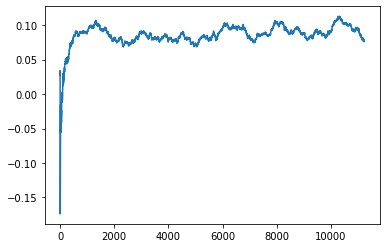

Thread: 1 iteration: 1800
RAM mDiffFit_384 FROM: 2624 --> 896 reward: -0.0057786941406250125
Thread: 5 iteration: 1951
RAM mDiffFit_61 FROM: 2496 --> 896 reward: 0.017442655468750002
Thread: 2 iteration: 1864
RAM mDiffFit_344 FROM: 1664 --> 2112 reward: -0.016903650390625025
Saving ...


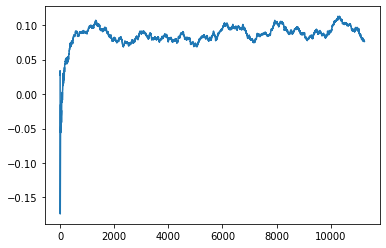

Thread: 6 iteration: 1880
RAM mDiffFit_70 FROM: 1088 --> 2112 reward: 0.0023776324218749943
Thread: 1 iteration: 1801
RAM mDiffFit_21 FROM: 832 --> 2112 reward: 0.0012344242187499986
Thread: 5 iteration: 1952
RAM mBackground_13 FROM: 1024 --> 1024 reward: 0.01809584587500003
Thread: 4 iteration: 1878
RAM mDiffFit_303 FROM: 1152 --> 2112 reward: -0.016812478125
Thread: 2 iteration: 1865
RAM mDiffFit_83 FROM: 2816 --> 896 reward: -0.004505264843749999
Thread: 6 iteration: 1881
RAM mDiffFit_105 FROM: 2304 --> 896 reward: 0.007557257031249997
Thread: 4 iteration: 1879
RAM mDiffFit_40 FROM: 1792 --> 832 reward: 0.055440110546875004
Thread: 1 iteration: 1802
RAM mProject_9 FROM: 960 --> 704 reward: -1.0
Thread: 3 iteration: 1872
RAM mDiffFit_292 FROM: 1856 --> 896 reward: 0.010377588671875012
Thread: 6 iteration: 1882
RAM mDiffFit_269 FROM: 320 --> 896 reward: -0.34300526484374994
Thread: 1 iteration: 1803
RAM mBackground_54 FROM: 1664 --> 2112 reward: 0.049613570320312536
Thread: 2 iteratio

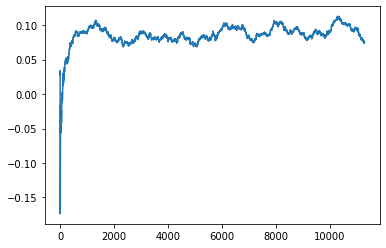

Thread: 2 iteration: 1870
RAM mDiffFit_165 FROM: 576 --> 832 reward: -0.05693488945312502
Thread: 3 iteration: 1876
RAM mDiffFit_373 FROM: 1024 --> 832 reward: 0.030513030859375
Thread: 1 iteration: 1807
RAM mDiffFit_251 FROM: 768 --> 832 reward: -0.013028650390625
Thread: 3 iteration: 1877
RAM mDiffFit_202 FROM: 704 --> 832 reward: 0.051992233984375
Thread: 1 iteration: 1808
RAM mDiffFit_248 FROM: 1280 --> 832 reward: 0.020898429296875003
Thread: 1 iteration: 1809
RAM mProject_64 FROM: 1664 --> 704 reward: 0.20045844724218748
Thread: 6 iteration: 1885
RAM mDiffFit_188 FROM: 384 --> 832 reward: -0.127028650390625
Saving ...


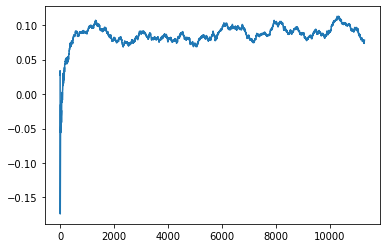

Thread: 1 iteration: 1810
RAM mProject_83 FROM: 256 --> 1024 reward: 0.864428137875
Saving ...


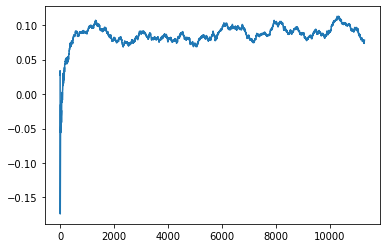

Thread: 4 iteration: 1880
RAM mDiffFit_316 FROM: 2304 --> 896 reward: 0.0017811953124999974
Thread: 6 iteration: 1886
RAM mDiffFit_241 FROM: 576 --> 2752 reward: 0.025401149218749995
Thread: 4 iteration: 1881
RAM mProject_85 FROM: 1344 --> 704 reward: -1.0
Thread: 5 iteration: 1955
RAM mViewer_4 FROM: 1152 --> 1024 reward: 0.055147818515625086
Thread: 1 iteration: 1811
RAM mDiffFit_235 FROM: 1920 --> 832 reward: 0.052455730078125
Thread: 6 iteration: 1887
RAM mDiffFit_152 FROM: 2112 --> 832 reward: 0.08032814140625
Thread: 4 iteration: 1882
RAM mProject_9 FROM: 2496 --> 704 reward: -1.0
Thread: 2 iteration: 1871
RAM mBackground_58 FROM: 1536 --> 2112 reward: -0.023797798390624972
Thread: 5 iteration: 1956
RAM mDiffFit_250 FROM: 2496 --> 896 reward: 0.012067655468750004
Thread: 1 iteration: 1812
RAM mBackground_24 FROM: 768 --> 2112 reward: -0.15671481317968755
Thread: 6 iteration: 1888
RAM mDiffFit_181 FROM: 1216 --> 832 reward: 0.04371095117187501
Thread: 4 iteration: 1883
RAM mBackgr

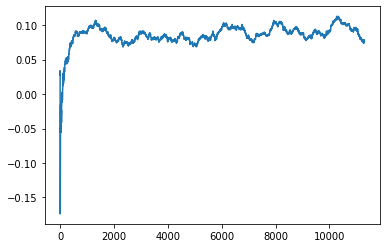

Thread: 6 iteration: 1890
RAM mDiffFit_48 FROM: 1344 --> 832 reward: -0.00997920312500001
Thread: 5 iteration: 1959
RAM mBackground_31 FROM: 128 --> 1024 reward: -1.2238427114687498
Thread: 3 iteration: 1879
RAM mDiffFit_81 FROM: 2176 --> 896 reward: -0.02382818515625001
Thread: 1 iteration: 1815
RAM mDiffFit_314 FROM: 448 --> 832 reward: -0.050854159375000006
Thread: 6 iteration: 1891
RAM mViewer_4 FROM: 1280 --> 1024 reward: 0.05786684371874997
Thread: 2 iteration: 1874
RAM mDiffFit_37 FROM: 1856 --> 832 reward: -0.061174578515624994
Saving ...


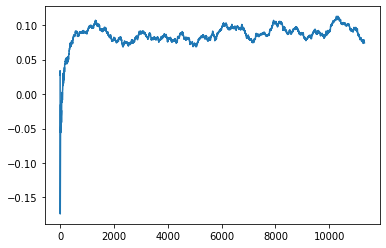

Thread: 5 iteration: 1960
RAM mDiffFit_51 FROM: 960 --> 832 reward: -0.009307300781250007
Saving ...


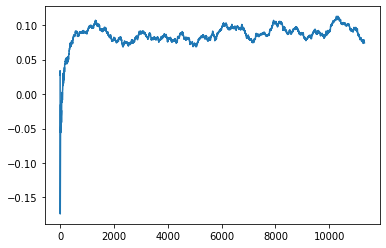

Thread: 3 iteration: 1880
RAM mDiffFit_143 FROM: 960 --> 832 reward: -0.03319274296875
Thread: 1 iteration: 1816
RAM mDiffFit_207 FROM: 2112 --> 896 reward: 0.027789048828125017
Thread: 2 iteration: 1875
RAM mDiffFit_49 FROM: 1408 --> 832 reward: 0.065216172265625
Thread: 6 iteration: 1892
RAM mDiffFit_40 FROM: 2176 --> 896 reward: -0.012578185156250001
Thread: 3 iteration: 1881
RAM mBackground_77 FROM: 2368 --> 2112 reward: 0.0017715049296875222
Thread: 5 iteration: 1961
RAM mDiffFit_257 FROM: 1600 --> 832 reward: 0.025648429296874983
Thread: 1 iteration: 1817
RAM mProject_86 FROM: 128 --> 1024 reward: 0.86032563525
Thread: 4 iteration: 1885
RAM mDiffFit_395 FROM: 1088 --> 832 reward: -0.011260442187499987
Thread: 2 iteration: 1876
RAM mDiffFit_308 FROM: 576 --> 2752 reward: 0.01240632656249999
Thread: 6 iteration: 1893
RAM mDiffFit_394 FROM: 512 --> 832 reward: -0.02352342929687501
Thread: 1 iteration: 1818
RAM mBackground_20 FROM: 1472 --> 2688 reward: 0.06755271277343751
Thread: 5 

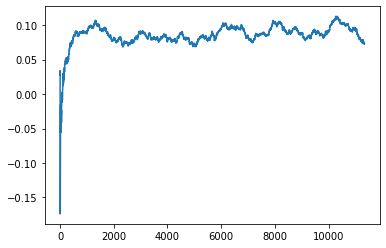

Thread: 4 iteration: 1890
RAM mDiffFit_341 FROM: 2688 --> 896 reward: -0.03141154765625
Thread: 6 iteration: 1899
RAM mDiffFit_5 FROM: 384 --> 832 reward: -0.16846617226562502
Thread: 5 iteration: 1967
RAM mProject_82 FROM: 832 --> 1024 reward: 0.849570627375
Thread: 2 iteration: 1879
RAM mDiffFit_417 FROM: 2880 --> 896 reward: -0.005122455078125001
Thread: 4 iteration: 1891
RAM mProject_9 FROM: 1792 --> 704 reward: -1.0
Saving ...


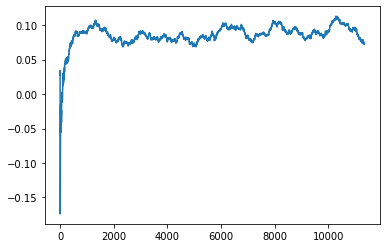

Thread: 1 iteration: 1820
RAM mProject_56 FROM: 512 --> 1024 reward: 0.8461656247500001
Thread: 3 iteration: 1883
RAM mDiffFit_400 FROM: 192 --> 832 reward: -0.21095831874999998
Saving ...


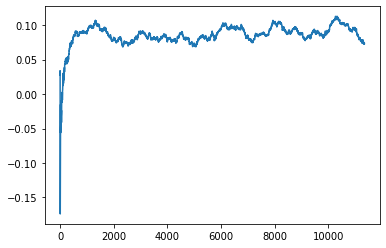

Thread: 2 iteration: 1880
RAM mDiffFit_56 FROM: 1024 --> 832 reward: -0.0018646015625000192
Thread: 4 iteration: 1892
RAM mDiffFit_300 FROM: 1216 --> 832 reward: 0.14899227773437498
Thread: 1 iteration: 1821
RAM mDiffFit_323 FROM: 1152 --> 384 reward: 0.3996562828125
Thread: 5 iteration: 1968
RAM mBackground_87 FROM: 1472 --> 2688 reward: 0.038836742351562516
Thread: 3 iteration: 1884
RAM mDiffFit_251 FROM: 1600 --> 832 reward: 0.00170568632812498
Thread: 1 iteration: 1822
RAM mDiffFit_177 FROM: 2752 --> 896 reward: 0.013617146484375016
Thread: 4 iteration: 1893
RAM mDiffFit_166 FROM: 1856 --> 832 reward: 0.08592190234374998
Thread: 2 iteration: 1881
RAM mDiffFit_248 FROM: 832 --> 832 reward: -0.05752347304687499
Thread: 5 iteration: 1969
RAM mDiffFit_128 FROM: 2368 --> 896 reward: -0.02329694609375002
Thread: 1 iteration: 1823
RAM mDiffFit_342 FROM: 2112 --> 384 reward: 0.20276561953125
Thread: 3 iteration: 1885
RAM mDiffFit_371 FROM: 1472 --> 832 reward: -0.03452610546874997
Thread: 

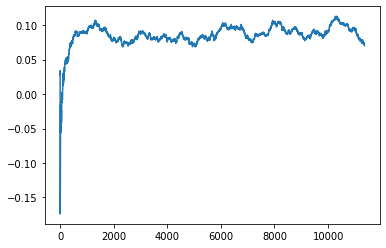

Thread: 6 iteration: 1900
RAM mDiffFit_328 FROM: 576 --> 832 reward: -0.10743752187499997
Thread: 3 iteration: 1886
RAM mDiffFit_174 FROM: 512 --> 832 reward: -0.22854435742187498
Thread: 4 iteration: 1895
RAM mDiffFit_341 FROM: 768 --> 832 reward: -0.022158871484375
Thread: 6 iteration: 1901
RAM mDiffFit_385 FROM: 2112 --> 832 reward: 0.004630177343749996
Thread: 2 iteration: 1883
RAM mDiffFit_381 FROM: 1664 --> 832 reward: -0.006898473046875013
Thread: 3 iteration: 1887
RAM mProject_69 FROM: 320 --> 1024 reward: 0.822668106375
Saving ...


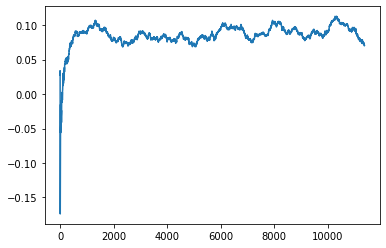

Thread: 5 iteration: 1970
RAM mDiffFit_272 FROM: 576 --> 832 reward: -0.011414048828125006
Thread: 6 iteration: 1902
RAM mDiffFit_249 FROM: 2944 --> 896 reward: 0.006390575781249994
Thread: 2 iteration: 1884
RAM mDiffFit_36 FROM: 2752 --> 896 reward: -0.03948446796874999
Thread: 3 iteration: 1888
RAM mDiffFit_347 FROM: 2304 --> 896 reward: 0.0007811953124999861
Thread: 5 iteration: 1971
RAM mProject_27 FROM: 128 --> 1024 reward: 0.85295313
Thread: 1 iteration: 1824
RAM mDiffFit_381 FROM: 576 --> 832 reward: -0.051041681250000026
Thread: 2 iteration: 1885
RAM mDiffFit_94 FROM: 3008 --> 896 reward: 0.02983586367187499
Thread: 6 iteration: 1903
RAM mDiffFit_36 FROM: 1216 --> 832 reward: -0.003171902343750005
Thread: 1 iteration: 1825
RAM mDiffFit_346 FROM: 256 --> 832 reward: -0.285059889453125
Thread: 6 iteration: 1904
RAM mAdd_2 FROM: 1664 --> 1024 reward: 0.08875776601562496
Thread: 3 iteration: 1889
RAM mDiffFit_114 FROM: 384 --> 832 reward: -0.13645314140625
Thread: 2 iteration: 1886

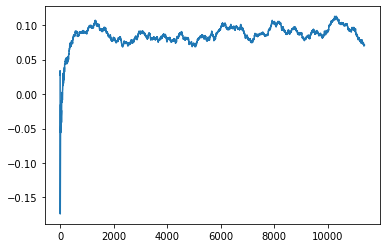

Thread: 3 iteration: 1890
RAM mDiffFit_183 FROM: 2624 --> 896 reward: 0.006893120703124998
Thread: 2 iteration: 1887
RAM mBackground_49 FROM: 2688 --> 2688 reward: -0.0016125000000000013
Thread: 1 iteration: 1827
RAM mDiffFit_401 FROM: 2496 --> 896 reward: -0.02519278671875
Thread: 4 iteration: 1897
RAM mDiffFit_19 FROM: 1728 --> 832 reward: -0.013596393359374993
Thread: 6 iteration: 1906
RAM mProject_43 FROM: 960 --> 704 reward: -1.0
Thread: 5 iteration: 1972
RAM mDiffFit_301 FROM: 1984 --> 896 reward: -0.0056094242187500025
Thread: 2 iteration: 1888
RAM mBackground_59 FROM: 2688 --> 2688 reward: 0.0
Thread: 3 iteration: 1891
RAM mDiffFit_299 FROM: 2944 --> 896 reward: 0.009140575781250004
Thread: 6 iteration: 1907
RAM mDiffFit_195 FROM: 2944 --> 896 reward: -0.04245322890625
Thread: 4 iteration: 1898
RAM mBackground_38 FROM: 2944 --> 2688 reward: -0.04176829657812505
Thread: 2 iteration: 1889
RAM mDiffFit_100 FROM: 1792 --> 832 reward: 0.06611460156250001
Thread: 6 iteration: 1908
RA

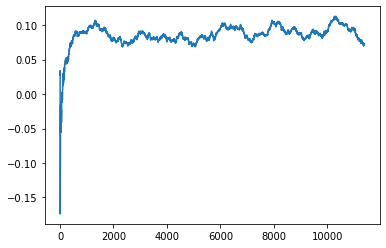

Thread: 2 iteration: 1890
RAM mDiffFit_295 FROM: 2304 --> 896 reward: 0.00680725703125001
Thread: 6 iteration: 1909
RAM mDiffFit_366 FROM: 2240 --> 896 reward: -0.013776105468749997
Saving ...


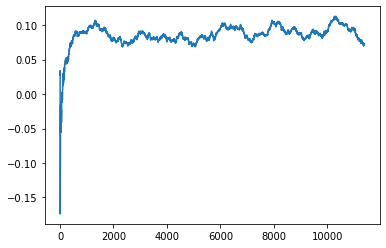

Thread: 4 iteration: 1900
RAM mBackground_14 FROM: 1280 --> 2688 reward: 0.252844904015625
Thread: 5 iteration: 1974
RAM mProject_55 FROM: 2560 --> 704 reward: -1.0
Thread: 1 iteration: 1828
RAM mDiffFit_314 FROM: 832 --> 832 reward: 0.0037500000000000033
Saving ...


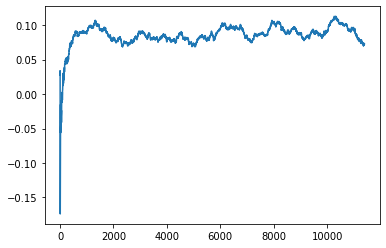

Thread: 6 iteration: 1910
RAM mDiffFit_375 FROM: 2560 --> 320 reward: 0.29579159375
Thread: 2 iteration: 1891
RAM mDiffFit_70 FROM: 448 --> 832 reward: 0.07241154765625
Thread: 4 iteration: 1901
RAM mDiffFit_141 FROM: 192 --> 832 reward: -0.15992185859374997
Thread: 5 iteration: 1975
RAM mProject_7 FROM: 2496 --> 704 reward: -1.0
Thread: 3 iteration: 1892
RAM mDiffFit_247 FROM: 576 --> 832 reward: -0.05179168125000001
Thread: 4 iteration: 1902
RAM mDiffFit_269 FROM: 1856 --> 1088 reward: 0.01633590742187503
Thread: 5 iteration: 1976
RAM mDiffFit_313 FROM: 1920 --> 896 reward: 0.040937478124999996
Thread: 3 iteration: 1893
RAM mDiffFit_143 FROM: 1408 --> 384 reward: 0.04855721328125003
Thread: 6 iteration: 1911
RAM mDiffFit_346 FROM: 2944 --> 896 reward: 0.006650930468750024
Thread: 4 iteration: 1903
RAM mDiffFit_236 FROM: 1728 --> 896 reward: -0.011317742968749989
Thread: 3 iteration: 1894
RAM mDiffFit_311 FROM: 1216 --> 832 reward: 0.028770840625000002
Thread: 6 iteration: 1912
RAM mV

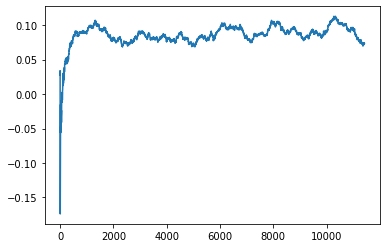

Thread: 1 iteration: 1830
RAM mDiffFit_357 FROM: 960 --> 832 reward: -0.038104203125
Saving ...


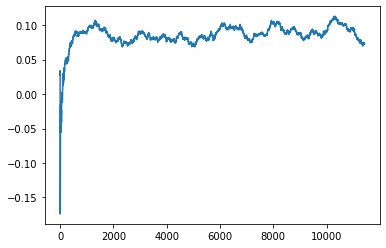

Thread: 5 iteration: 1980
RAM mDiffFit_147 FROM: 2304 --> 896 reward: -0.019416768749999994
Thread: 6 iteration: 1915
RAM mBackground_27 FROM: 1600 --> 2688 reward: 0.03208661780468752
Thread: 3 iteration: 1897
RAM mBackground_42 FROM: 2048 --> 2688 reward: 0.039242065390625004
Thread: 1 iteration: 1831
RAM mDiffFit_368 FROM: 128 --> 896 reward: -0.7458021234375001
Thread: 5 iteration: 1981
RAM mDiffFit_182 FROM: 1792 --> 832 reward: 0.03289061953125
Thread: 6 iteration: 1916
RAM mDiffFit_404 FROM: 896 --> 832 reward: 0.037364601562500016
Thread: 3 iteration: 1898
RAM mDiffFit_385 FROM: 1088 --> 832 reward: 0.016007809765625006
Thread: 1 iteration: 1832
RAM mProject_11 FROM: 896 --> 704 reward: -1.0
Thread: 4 iteration: 1905
RAM mDiffFit_143 FROM: 1472 --> 832 reward: -0.043518295703125
Thread: 6 iteration: 1917
RAM mDiffFit_274 FROM: 2880 --> 896 reward: -0.006997455078124985
Thread: 1 iteration: 1833
RAM mBackground_87 FROM: 1600 --> 2688 reward: 0.0049831473828125476
Thread: 5 itera

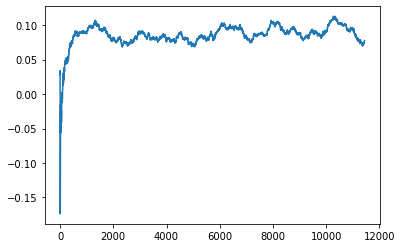

Thread: 3 iteration: 1900
RAM mDiffFit_220 FROM: 384 --> 2752 reward: -0.129726526953125
Thread: 6 iteration: 1918
RAM mDiffFit_219 FROM: 1536 --> 832 reward: -0.002354203124999999
Thread: 4 iteration: 1907
RAM mDiffFit_46 FROM: 3008 --> 896 reward: -0.038901149218750014
Thread: 5 iteration: 1984
RAM mDiffFit_280 FROM: 320 --> 832 reward: -0.09495831875
Thread: 3 iteration: 1901
RAM mImgtbl_3 FROM: 2240 --> 1024 reward: 0.140699965
Thread: 6 iteration: 1919
RAM mDiffFit_7 FROM: 320 --> 832 reward: -0.201054712109375
Thread: 4 iteration: 1908
RAM mDiffFit_282 FROM: 2816 --> 896 reward: -0.05585429062500001
Thread: 3 iteration: 1902
RAM mViewer_3 FROM: 896 --> 1024 reward: -0.01520061778125002
Saving ...


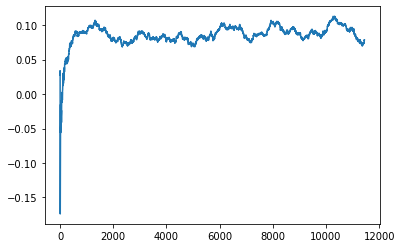

Thread: 6 iteration: 1920
RAM mDiffFit_158 FROM: 704 --> 2752 reward: -0.02146867343750001
Thread: 3 iteration: 1903
RAM mProject_36 FROM: 2560 --> 704 reward: -1.0
Thread: 1 iteration: 1834
RAM mBackground_41 FROM: 256 --> 2688 reward: -0.4445750609687501
Thread: 4 iteration: 1909
RAM mDiffFit_264 FROM: 576 --> 832 reward: -0.11214847304687499
Thread: 6 iteration: 1921
RAM mDiffFit_343 FROM: 2688 --> 896 reward: -0.023901105468749982
Thread: 1 iteration: 1835
RAM mBackground_79 FROM: 2560 --> 2688 reward: 0.26920720421874994
Saving ...


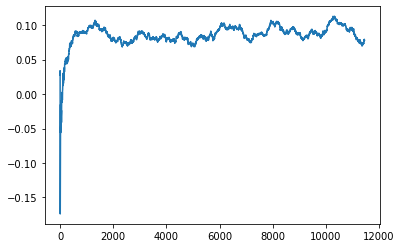

Thread: 4 iteration: 1910
RAM mBackground_49 FROM: 704 --> 2688 reward: -0.054074575757812514
Thread: 6 iteration: 1922
RAM mProject_72 FROM: 2432 --> 704 reward: -1.0
Thread: 2 iteration: 1895
RAM mDiffFit_403 FROM: 896 --> 832 reward: -0.021408871484374994
Thread: 1 iteration: 1836
RAM mBackground_76 FROM: 448 --> 2688 reward: -0.18731412817187496
Thread: 4 iteration: 1911
RAM mBackground_42 FROM: 832 --> 2688 reward: -0.03417813310156249
Thread: 6 iteration: 1923
RAM mBackground_72 FROM: 384 --> 2688 reward: -0.20848261026562495
Thread: 2 iteration: 1896
RAM mProject_65 FROM: 1408 --> 704 reward: -1.0
Thread: 5 iteration: 1985
RAM mDiffFit_244 FROM: 1856 --> 896 reward: -0.07035687929687498
Thread: 1 iteration: 1837
RAM mDiffFit_204 FROM: 512 --> 2752 reward: 0.0015938484375000068
Thread: 4 iteration: 1912
RAM mDiffFit_43 FROM: 768 --> 2752 reward: 0.02019800781250001
Thread: 2 iteration: 1897
RAM mDiffFit_380 FROM: 128 --> 896 reward: -0.7630261054687499
Thread: 5 iteration: 1986
R

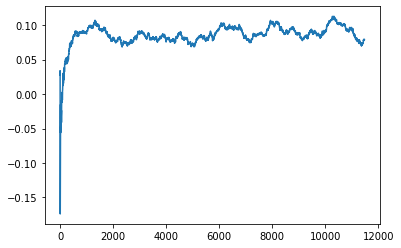

Thread: 1 iteration: 1840
RAM mDiffFit_130 FROM: 1216 --> 832 reward: 0.056197920312499976
Thread: 3 iteration: 1906
RAM mDiffFit_314 FROM: 2880 --> 896 reward: 0.12979168124999999
Thread: 4 iteration: 1915
RAM mDiffFit_149 FROM: 1920 --> 384 reward: 0.10667185859375
Thread: 6 iteration: 1927
RAM mDiffFit_347 FROM: 128 --> 896 reward: -0.6447292031249998
Thread: 1 iteration: 1841
RAM mDiffFit_228 FROM: 448 --> 832 reward: -0.27051570703125
Thread: 5 iteration: 1989
RAM mDiffFit_95 FROM: 128 --> 896 reward: -0.6040885835937501
Thread: 3 iteration: 1907
RAM mDiffFit_25 FROM: 2112 --> 384 reward: 0.08708590742187505
Thread: 4 iteration: 1916
RAM mProject_38 FROM: 2496 --> 704 reward: -1.0
Thread: 2 iteration: 1899
RAM mDiffFit_106 FROM: 832 --> 832 reward: -0.09174745507812501
Thread: 6 iteration: 1928
RAM mDiffFit_120 FROM: 2880 --> 896 reward: -0.003122455078125013
Saving ...


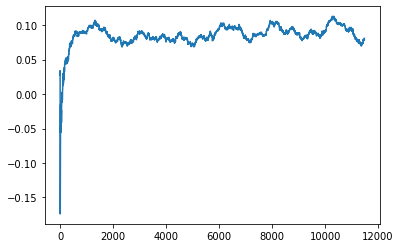

Thread: 5 iteration: 1990
RAM mDiffFit_62 FROM: 2816 --> 896 reward: 0.006499956250000001
Thread: 1 iteration: 1842
RAM mDiffFit_148 FROM: 2944 --> 896 reward: -0.004989645312499999
Thread: 3 iteration: 1908
RAM mDiffFit_17 FROM: 2624 --> 896 reward: -0.05109384843750002
Saving ...


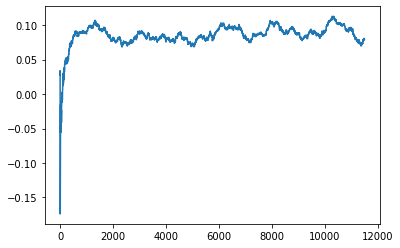

Thread: 2 iteration: 1900
RAM mDiffFit_200 FROM: 2368 --> 896 reward: 0.022255133593750004
Thread: 3 iteration: 1909
RAM mDiffFit_152 FROM: 1600 --> 384 reward: 0.049861925390625
Thread: 1 iteration: 1843
RAM mDiffFit_332 FROM: 1152 --> 2752 reward: 0.017976614453124984
Thread: 2 iteration: 1901
RAM mDiffFit_114 FROM: 768 --> 2752 reward: -0.006648385546875017
Saving ...


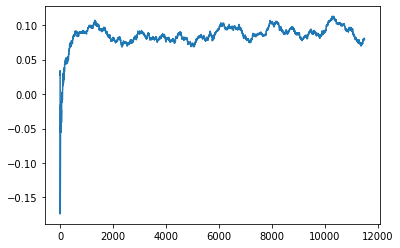

Thread: 3 iteration: 1910
RAM mDiffFit_98 FROM: 1856 --> 896 reward: -0.006463583593749999
Thread: 1 iteration: 1844
RAM mProject_76 FROM: 832 --> 2688 reward: 0.7557899789531249
Thread: 6 iteration: 1929
RAM mDiffFit_53 FROM: 896 --> 2752 reward: -0.018117146484375006
Thread: 2 iteration: 1902
RAM mDiffFit_3 FROM: 1344 --> 832 reward: 0.03904426992187501
Thread: 3 iteration: 1911
RAM mProject_43 FROM: 2560 --> 704 reward: -1.0
Thread: 4 iteration: 1917
RAM mDiffFit_11 FROM: 832 --> 832 reward: 0.01542449101562501
Thread: 1 iteration: 1845
RAM mDiffFit_172 FROM: 1984 --> 832 reward: 0.0040364164062499895
Saving ...


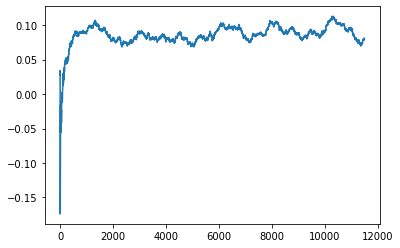

Thread: 6 iteration: 1930
RAM mProject_69 FROM: 2240 --> 704 reward: -1.0
Thread: 5 iteration: 1991
RAM mBackground_84 FROM: 1152 --> 2688 reward: 0.032035150500000005
Thread: 4 iteration: 1918
RAM mDiffFit_276 FROM: 2624 --> 320 reward: 0.10758577617187501
Thread: 3 iteration: 1912
RAM mDiffFit_128 FROM: 2048 --> 384 reward: 0.05389575312499999
Thread: 6 iteration: 1931
RAM mDiffFit_249 FROM: 576 --> 832 reward: -0.128226614453125
Thread: 5 iteration: 1992
RAM mDiffFit_286 FROM: 1152 --> 832 reward: 0.02798438046874999
Thread: 3 iteration: 1913
RAM mDiffFit_345 FROM: 1856 --> 896 reward: 0.008039005078125036
Thread: 4 iteration: 1919
RAM mBackground_65 FROM: 2624 --> 2688 reward: -0.04767630643750007
Thread: 6 iteration: 1932
RAM mBackground_22 FROM: 1088 --> 2688 reward: -0.01960744939843751
Thread: 5 iteration: 1993
RAM mBackground_56 FROM: 1792 --> 2688 reward: 0.011206940843749976
Thread: 3 iteration: 1914
RAM mDiffFit_310 FROM: 1664 --> 832 reward: 0.012651017968749994
Saving ...

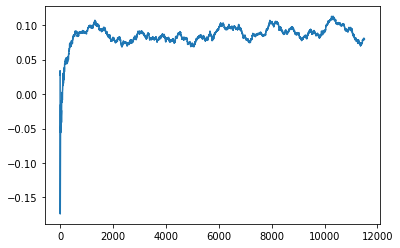

Thread: 4 iteration: 1920
RAM mDiffFit_210 FROM: 1152 --> 832 reward: 0.005156239062500002
Thread: 6 iteration: 1933
RAM mProject_39 FROM: 3008 --> 704 reward: -1.0
Thread: 2 iteration: 1903
RAM mProject_22 FROM: 1408 --> 704 reward: -1.0
Thread: 1 iteration: 1846
RAM mDiffFit_417 FROM: 3008 --> 896 reward: -0.016231835546874976
Thread: 3 iteration: 1915
RAM mDiffFit_193 FROM: 3008 --> 896 reward: -0.01527092812500002
Thread: 5 iteration: 1994
RAM mDiffFit_121 FROM: 2048 --> 832 reward: 0.005747367578124978
Thread: 6 iteration: 1934
RAM mDiffFit_333 FROM: 2240 --> 896 reward: -0.039791768750000005
Thread: 4 iteration: 1921
RAM mDiffFit_299 FROM: 2688 --> 896 reward: 0.004348894531250019
Thread: 2 iteration: 1904
RAM mBackground_24 FROM: 1344 --> 2688 reward: 0.032088881687499994
Thread: 1 iteration: 1847
RAM mDiffFit_114 FROM: 2240 --> 896 reward: -0.007455773828124986
Thread: 5 iteration: 1995
RAM mDiffFit_6 FROM: 128 --> 896 reward: -0.6298489820312501
Thread: 3 iteration: 1916
RAM m

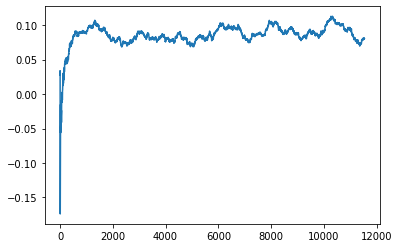

Thread: 3 iteration: 1920
RAM mBackground_65 FROM: 2304 --> 2688 reward: 0.02606880643750001
Thread: 4 iteration: 1926
RAM mDiffFit_186 FROM: 2176 --> 896 reward: -0.027083406249999997
Thread: 5 iteration: 1998
RAM mDiffFit_176 FROM: 2368 --> 896 reward: -0.04990895898437499
Thread: 6 iteration: 1939
RAM mDiffFit_86 FROM: 1472 --> 832 reward: 0.023677079687499998
Thread: 1 iteration: 1849
RAM mDiffFit_101 FROM: 704 --> 832 reward: -0.014794269921875013
Thread: 3 iteration: 1921
RAM mBackground_64 FROM: 2560 --> 2688 reward: 0.005397413078124908
Thread: 4 iteration: 1927
RAM mBackground_52 FROM: 2688 --> 2688 reward: -0.046681940843750006
Thread: 5 iteration: 1999
RAM mDiffFit_250 FROM: 1792 --> 832 reward: 0.18178654765625
Saving ...


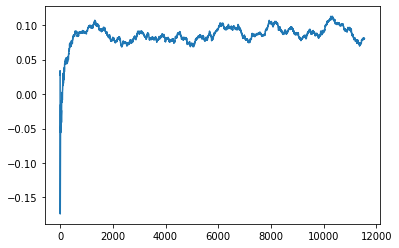

Thread: 1 iteration: 1850
RAM mDiffFit_186 FROM: 2752 --> 320 reward: 0.143419226171875
Saving ...


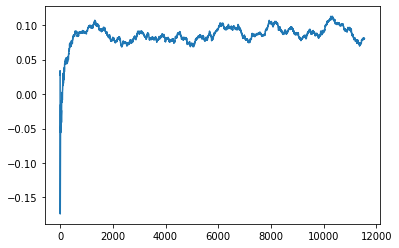

Thread: 6 iteration: 1940
RAM mProject_86 FROM: 1664 --> 704 reward: -1.0
Thread: 2 iteration: 1907
RAM mDiffFit_277 FROM: 2816 --> 704 reward: -0.023557432031250033
Thread: 3 iteration: 1922
RAM mDiffFit_29 FROM: 1280 --> 832 reward: -0.03713026484375
Thread: 4 iteration: 1928
RAM mDiffFit_83 FROM: 1984 --> 384 reward: -0.022656370312499965
Saving ...


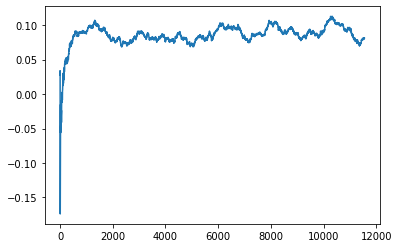

Thread: 5 iteration: 2000
RAM mDiffFit_104 FROM: 2048 --> 832 reward: 0.016512987109375005
Thread: 6 iteration: 1941
RAM mDiffFit_10 FROM: 1856 --> 384 reward: 0.20495568632812503
Thread: 1 iteration: 1851
RAM mDiffFit_415 FROM: 1856 --> 832 reward: 0.016848938281249996
Thread: 3 iteration: 1923
RAM mDiffFit_312 FROM: 2560 --> 896 reward: 0.0038384960937500046
Thread: 1 iteration: 1852
RAM mBackground_27 FROM: 1280 --> 2688 reward: 0.015332314484375015
Thread: 5 iteration: 2001
RAM mBackground_5 FROM: 2880 --> 2688 reward: -0.06272634406249998
Thread: 3 iteration: 1924
RAM mBackground_38 FROM: 2240 --> 2688 reward: 0.053785921124999934
Thread: 1 iteration: 1853
RAM mBackground_82 FROM: 640 --> 2688 reward: -0.05099960040625004
Thread: 5 iteration: 2002
RAM mProject_61 FROM: 384 --> 2688 reward: 0.7619577983437501
Thread: 4 iteration: 1929
RAM mBackground_1 FROM: 1856 --> 2688 reward: 0.05851818500781248
Thread: 3 iteration: 1925
RAM mDiffFit_166 FROM: 1984 --> 384 reward: 0.11017966835

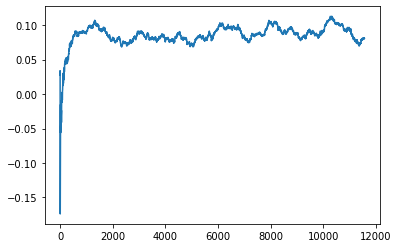

Thread: 4 iteration: 1930
RAM mDiffFit_86 FROM: 1024 --> 832 reward: 0.026747411328125
Thread: 3 iteration: 1926
RAM mBackground_75 FROM: 1600 --> 2688 reward: 0.024563844062500003
Thread: 5 iteration: 2004
RAM mBackground_61 FROM: 2112 --> 2688 reward: 0.012127388429687488
Thread: 2 iteration: 1909
RAM mProject_34 FROM: 1216 --> 704 reward: -1.0
Thread: 6 iteration: 1942
RAM mBackground_87 FROM: 1792 --> 2688 reward: 0.058314391546874955
Thread: 3 iteration: 1927
RAM mDiffFit_330 FROM: 2368 --> 1088 reward: 0.07426825195312502
Thread: 4 iteration: 1931
RAM mBackground_56 FROM: 1408 --> 2688 reward: 0.02779333420312502
Thread: 5 iteration: 2005
RAM mDiffFit_385 FROM: 2048 --> 384 reward: 0.0752187171875
Thread: 6 iteration: 1943
RAM mDiffFit_218 FROM: 640 --> 832 reward: -0.016427079687499988
Thread: 3 iteration: 1928
RAM mDiffFit_130 FROM: 2624 --> 704 reward: 0.08008586367187498
Thread: 4 iteration: 1932
RAM mProject_46 FROM: 1792 --> 704 reward: -1.0
Thread: 1 iteration: 1854
RAM mD

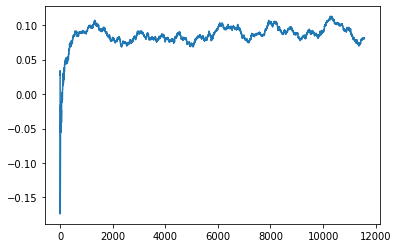

Thread: 2 iteration: 1910
RAM mDiffFit_39 FROM: 512 --> 832 reward: -0.01646612851562498
Thread: 5 iteration: 2006
RAM mBackground_8 FROM: 704 --> 2688 reward: -0.048377075757812485
Thread: 6 iteration: 1944
RAM mDiffFit_322 FROM: 1664 --> 384 reward: 0.05283327500000003
Thread: 1 iteration: 1855
RAM mDiffFit_367 FROM: 2688 --> 320 reward: 0.10445046523437501
Thread: 2 iteration: 1911
RAM mBackground_74 FROM: 128 --> 2688 reward: 0.28953817464062503
Thread: 5 iteration: 2007
RAM mDiffFit_375 FROM: 2688 --> 704 reward: 0.077601483203125
Thread: 6 iteration: 1945
RAM mDiffFit_365 FROM: 2560 --> 320 reward: 0.15875254492187504
Thread: 2 iteration: 1912
RAM mDiffFit_303 FROM: 640 --> 832 reward: -0.017486969140624985
Thread: 6 iteration: 1946
RAM mBackground_83 FROM: 1792 --> 2688 reward: 0.06164689154687497
Thread: 2 iteration: 1913
RAM mDiffFit_133 FROM: 384 --> 832 reward: -0.16629690234375
Thread: 6 iteration: 1947
RAM mProject_73 FROM: 768 --> 2688 reward: 0.7685531177343751
Thread: 1

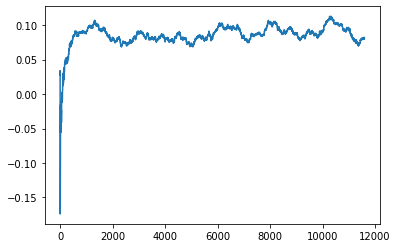

Thread: 3 iteration: 1930
RAM mBgModel_3 FROM: 896 --> 704 reward: 0.09793646890625002
Thread: 6 iteration: 1948
RAM mProject_19 FROM: 1216 --> 704 reward: -1.0
Thread: 5 iteration: 2008
RAM mDiffFit_232 FROM: 2240 --> 704 reward: 0.086591128515625
Thread: 4 iteration: 1935
RAM mDiffFit_380 FROM: 1600 --> 1088 reward: -0.0007526324218749998
Thread: 1 iteration: 1859
RAM mDiffFit_27 FROM: 2688 --> 704 reward: 0.05680725703125
Thread: 6 iteration: 1949
RAM mDiffFit_128 FROM: 2880 --> 704 reward: 0.09411977890625
Thread: 3 iteration: 1931
RAM mDiffFit_69 FROM: 1152 --> 832 reward: -0.023518251953125006
Saving ...


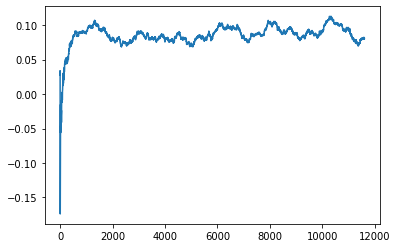

Thread: 6 iteration: 1950
RAM mProject_57 FROM: 2240 --> 704 reward: -1.0
Thread: 2 iteration: 1915
RAM mDiffFit_176 FROM: 1728 --> 384 reward: 0.0196249125
Saving ...


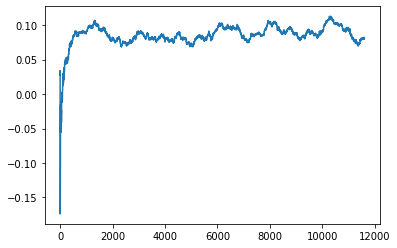

Thread: 1 iteration: 1860
RAM mBackground_40 FROM: 2624 --> 1024 reward: -0.03678982746093757
Thread: 4 iteration: 1936
RAM mBackground_84 FROM: 2432 --> 2688 reward: -0.02694669175
Thread: 3 iteration: 1932
RAM mProject_70 FROM: 640 --> 2688 reward: 0.7732584371250001
Thread: 5 iteration: 2009
RAM mDiffFit_254 FROM: 384 --> 832 reward: -0.08699999999999998
Thread: 4 iteration: 1937
RAM mDiffFit_414 FROM: 128 --> 704 reward: -0.814960994921875
Thread: 3 iteration: 1933
RAM mBackground_19 FROM: 2880 --> 1024 reward: 0.006024339640624995
Thread: 1 iteration: 1861
RAM mDiffFit_254 FROM: 1088 --> 832 reward: -0.006937521875000005
Saving ...


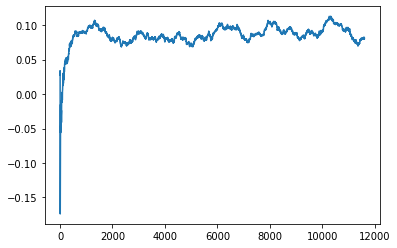

Thread: 5 iteration: 2010
RAM mDiffFit_26 FROM: 896 --> 832 reward: -0.017158871484374994
Thread: 1 iteration: 1862
RAM mBackground_80 FROM: 1088 --> 2688 reward: -0.00680147897656254
Thread: 4 iteration: 1938
RAM mDiffFit_314 FROM: 1536 --> 384 reward: 0.00639053203125
Thread: 3 iteration: 1934
RAM mBackground_13 FROM: 2112 --> 2688 reward: 0.03871350804687496
Thread: 1 iteration: 1863
RAM mBackground_88 FROM: 2880 --> 2688 reward: -0.00971533601562507
Thread: 3 iteration: 1935
RAM mDiffFit_30 FROM: 192 --> 896 reward: -0.29324219023437503
Thread: 1 iteration: 1864
RAM mProject_71 FROM: 1472 --> 704 reward: -1.0
Thread: 6 iteration: 1951
RAM mProject_71 FROM: 2816 --> 704 reward: -1.0
Thread: 2 iteration: 1916
RAM mDiffFit_296 FROM: 704 --> 2752 reward: -0.007914005078125015
Thread: 1 iteration: 1865
RAM mDiffFit_20 FROM: 2624 --> 704 reward: 0.07671086367187496
Thread: 2 iteration: 1917
RAM mBackground_13 FROM: 2304 --> 2688 reward: 0.027157239234375036
Thread: 1 iteration: 1866
RAM 

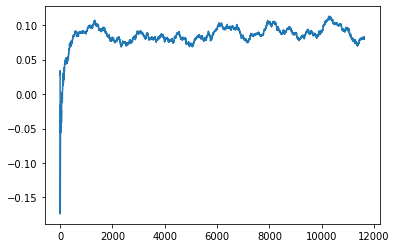

Thread: 4 iteration: 1940
RAM mBackground_79 FROM: 1728 --> 2688 reward: 0.017952575249999953
Thread: 3 iteration: 1938
RAM mBackground_46 FROM: 2560 --> 1024 reward: 0.015461964187499956
Thread: 1 iteration: 1869
RAM mDiffFit_285 FROM: 896 --> 832 reward: 0.018484380468750013
Saving ...


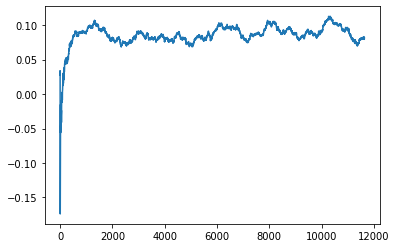

Thread: 2 iteration: 1920
RAM mDiffFit_262 FROM: 2752 --> 704 reward: 0.048440066796875
Thread: 6 iteration: 1954
RAM mDiffFit_182 FROM: 256 --> 832 reward: -0.11201820820312497
Thread: 4 iteration: 1941
RAM mDiffFit_157 FROM: 1024 --> 832 reward: 0.014463539843749991
Thread: 3 iteration: 1939
RAM mBackground_38 FROM: 1856 --> 2688 reward: 0.05486318500781244
Saving ...


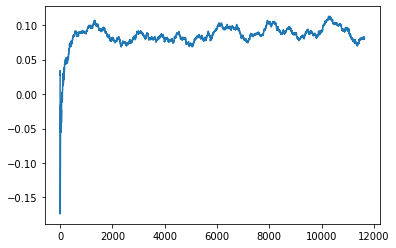

Thread: 1 iteration: 1870
RAM mBackground_21 FROM: 1280 --> 2688 reward: -0.004438742859374999
Thread: 2 iteration: 1921
RAM mDiffFit_105 FROM: 2496 --> 320 reward: 0.17682028789062504
Thread: 4 iteration: 1942
RAM mDiffFit_123 FROM: 2816 --> 704 reward: 0.047447876562500005
Thread: 1 iteration: 1871
RAM mDiffFit_179 FROM: 2304 --> 704 reward: 0.11851557578124998
Saving ...


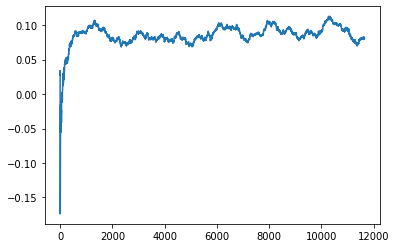

Thread: 3 iteration: 1940
RAM mDiffFit_148 FROM: 1920 --> 896 reward: 0.010385398437500002
Thread: 2 iteration: 1922
RAM mProject_13 FROM: 2816 --> 704 reward: -1.0
Thread: 5 iteration: 2013
RAM mDiffFit_119 FROM: 448 --> 2752 reward: -0.028674359765625025
Thread: 4 iteration: 1943
RAM mDiffFit_58 FROM: 2240 --> 896 reward: -0.07792721093749998
Thread: 1 iteration: 1872
RAM mDiffFit_65 FROM: 2496 --> 896 reward: -0.013062565625000001
Thread: 3 iteration: 1941
RAM mBackground_87 FROM: 256 --> 2688 reward: 0.26490720421875
Thread: 2 iteration: 1923
RAM mDiffFit_1 FROM: 1920 --> 384 reward: 0.07537495625
Thread: 5 iteration: 2014
RAM mDiffFit_197 FROM: 1408 --> 832 reward: 0.020692699218749985
Thread: 1 iteration: 1873
RAM mDiffFit_290 FROM: 576 --> 832 reward: -0.08199482265625
Thread: 3 iteration: 1942
RAM mBackground_61 FROM: 2304 --> 2688 reward: 0.05125070965625002
Thread: 4 iteration: 1944
RAM mProject_34 FROM: 2688 --> 704 reward: -1.0
Thread: 6 iteration: 1955
RAM mViewer_4 FROM: 

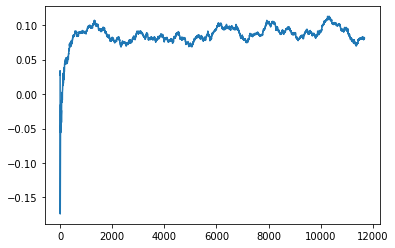

Thread: 6 iteration: 1960
RAM mBackground_19 FROM: 1792 --> 2688 reward: 0.06100189154687499
Thread: 5 iteration: 2019
RAM mDiffFit_340 FROM: 256 --> 2752 reward: -0.12167962460937504
Thread: 2 iteration: 1929
RAM mDiffFit_136 FROM: 2624 --> 1408 reward: 0.013041637499999967
Thread: 6 iteration: 1961
RAM mDiffFit_1 FROM: 704 --> 2752 reward: -0.073591128515625
Saving ...


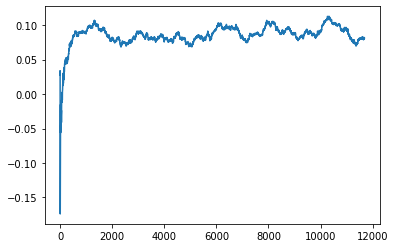

Thread: 5 iteration: 2020
RAM mDiffFit_138 FROM: 704 --> 2752 reward: -0.07721612851562501
Thread: 6 iteration: 1962
RAM mDiffFit_365 FROM: 1344 --> 384 reward: 0.01754681484375001
Saving ...


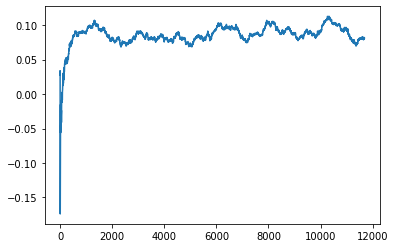

Thread: 2 iteration: 1930
RAM mProject_6 FROM: 1728 --> 704 reward: -1.0
Thread: 3 iteration: 1946
RAM mProject_81 FROM: 2880 --> 704 reward: -1.0
Thread: 1 iteration: 1877
RAM mDiffFit_215 FROM: 320 --> 2752 reward: -0.12039057578125001
Thread: 5 iteration: 2021
RAM mDiffFit_160 FROM: 896 --> 2752 reward: 0.0005130746093749868
Thread: 6 iteration: 1963
RAM mDiffFit_194 FROM: 2432 --> 1408 reward: 0.035703141406250014
Thread: 1 iteration: 1878
RAM mProject_84 FROM: 1536 --> 704 reward: -1.0
Thread: 4 iteration: 1949
RAM mDiffFit_406 FROM: 1920 --> 832 reward: 0.015606748046875004
Thread: 6 iteration: 1964
RAM mDiffFit_402 FROM: 448 --> 2752 reward: -0.07617703593750003
Saving ...


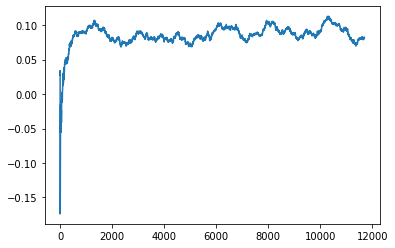

Thread: 4 iteration: 1950
RAM mBackground_64 FROM: 640 --> 2688 reward: -0.10853904125000005
Thread: 1 iteration: 1879
RAM mDiffFit_227 FROM: 512 --> 832 reward: -0.15803650390625004
Saving ...


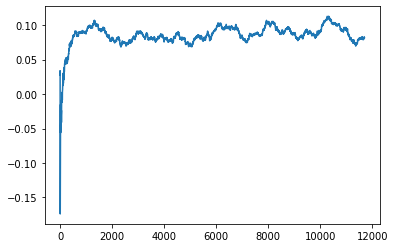

Thread: 1 iteration: 1880
RAM mDiffFit_270 FROM: 128 --> 704 reward: -1.06951566328125
Thread: 4 iteration: 1951
RAM mProject_13 FROM: 768 --> 2688 reward: 0.774068437125
Thread: 5 iteration: 2022
RAM mDiffFit_376 FROM: 704 --> 2752 reward: -0.034815066796875016
Thread: 4 iteration: 1952
RAM mDiffFit_384 FROM: 1920 --> 384 reward: 0.09692185859375001
Thread: 1 iteration: 1881
RAM mDiffFit_19 FROM: 1152 --> 832 reward: 0.007309889453124994
Thread: 4 iteration: 1953
RAM mProject_4 FROM: 1536 --> 704 reward: -1.0
Thread: 2 iteration: 1931
RAM mProject_3 FROM: 1664 --> 640 reward: -1.0
Thread: 3 iteration: 1947
RAM mBackground_69 FROM: 2560 --> 2688 reward: 0.03461952776562497
Thread: 5 iteration: 2023
RAM mBackground_82 FROM: 2688 --> 1024 reward: -0.028433919312499955
Thread: 1 iteration: 1882
RAM mBackground_1 FROM: 1600 --> 2688 reward: 0.07587051116406247
Thread: 2 iteration: 1932
RAM mBackground_24 FROM: 640 --> 2688 reward: -0.05392451348437504
Thread: 3 iteration: 1948
RAM mDiffFit

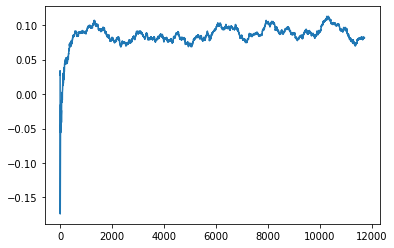

Thread: 3 iteration: 1950
RAM mDiffFit_136 FROM: 2944 --> 704 reward: 0.046900974218749975
Thread: 1 iteration: 1885
RAM mAdd_3 FROM: 2176 --> 1024 reward: 1.2638757656250001
Thread: 4 iteration: 1955
RAM mBackground_56 FROM: 512 --> 2688 reward: -0.21261247404687497
Thread: 5 iteration: 2026
RAM mDiffFit_377 FROM: 448 --> 832 reward: -0.06380988945312499
Thread: 2 iteration: 1935
RAM mDiffFit_258 FROM: 1856 --> 1088 reward: -0.0020963933593749935
Thread: 1 iteration: 1886
RAM mDiffFit_156 FROM: 832 --> 832 reward: -0.00025000000000000716
Thread: 3 iteration: 1951
RAM mDiffFit_205 FROM: 3008 --> 704 reward: -0.04864860429687501
Thread: 4 iteration: 1956
RAM mDiffFit_12 FROM: 640 --> 2752 reward: -0.04743743437500002
Thread: 1 iteration: 1887
RAM mBackground_24 FROM: 1920 --> 2688 reward: 0.009003172031249946
Thread: 5 iteration: 2027
RAM mDiffFit_270 FROM: 576 --> 320 reward: 0.104148385546875
Thread: 3 iteration: 1952
RAM mDiffFit_11 FROM: 448 --> 2752 reward: -0.05986192539062501
Thr

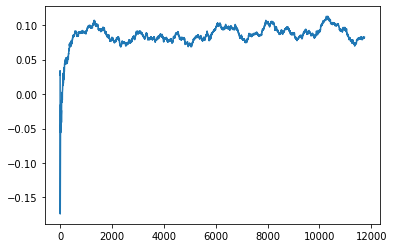

Thread: 5 iteration: 2030
RAM mBackground_68 FROM: 640 --> 2688 reward: -0.06289629215625003
Saving ...


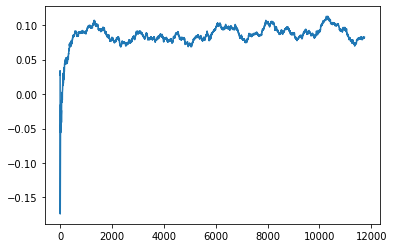

Thread: 1 iteration: 1890
RAM mProject_51 FROM: 1792 --> 640 reward: -1.0
Thread: 2 iteration: 1936
RAM mProject_62 FROM: 2560 --> 704 reward: -1.0
Thread: 4 iteration: 1957
RAM mDiffFit_372 FROM: 384 --> 2752 reward: -0.058926992187499985
Thread: 3 iteration: 1955
RAM mDiffFit_223 FROM: 2368 --> 1408 reward: -0.06816676875
Thread: 5 iteration: 2031
RAM mDiffFit_190 FROM: 2432 --> 1088 reward: -0.008533915234375002
Thread: 3 iteration: 1956
RAM mDiffFit_102 FROM: 960 --> 832 reward: -0.01081252187500003
Thread: 4 iteration: 1958
RAM mDiffFit_28 FROM: 1152 --> 832 reward: 0.04328387148437501
Thread: 5 iteration: 2032
RAM mDiffFit_321 FROM: 192 --> 832 reward: -0.18703123906250002
Thread: 3 iteration: 1957
RAM mDiffFit_291 FROM: 512 --> 832 reward: -0.15313544218750003
Thread: 5 iteration: 2033
RAM mProject_86 FROM: 832 --> 2688 reward: 0.7630602983437501
Thread: 1 iteration: 1891
RAM mProject_22 FROM: 2304 --> 704 reward: -1.0
Thread: 6 iteration: 1969
RAM mProject_86 FROM: 256 --> 2688

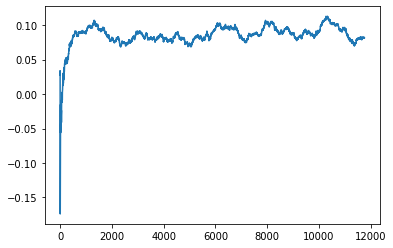

Thread: 6 iteration: 1970
RAM mDiffFit_372 FROM: 1856 --> 320 reward: 0.02651289960937501
Thread: 2 iteration: 1938
RAM mDiffFit_364 FROM: 2688 --> 704 reward: 0.05632028789062499
Thread: 5 iteration: 2035
RAM mBackground_61 FROM: 768 --> 2688 reward: -0.06581675271875
Thread: 1 iteration: 1893
RAM mDiffFit_7 FROM: 1792 --> 832 reward: 0.021591128515625006
Saving ...


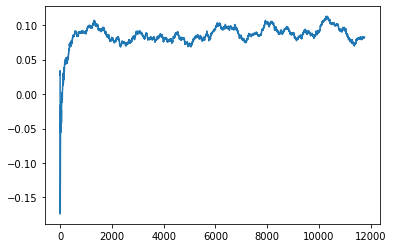

Thread: 3 iteration: 1960
RAM mDiffFit_145 FROM: 576 --> 2752 reward: -0.071583275
Thread: 6 iteration: 1971
RAM mDiffFit_98 FROM: 2432 --> 320 reward: 0.1089478765625
Saving ...


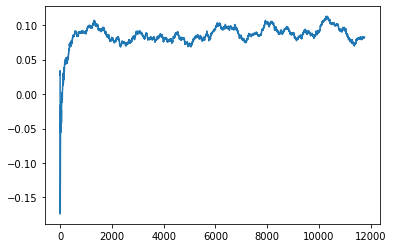

Thread: 4 iteration: 1960
RAM mDiffFit_141 FROM: 448 --> 2752 reward: -0.02923170429687502
Thread: 5 iteration: 2036
RAM mDiffFit_335 FROM: 1664 --> 832 reward: -0.019872455078125007
Thread: 3 iteration: 1961
RAM mDiffFit_101 FROM: 768 --> 832 reward: -0.14201570703125002
Thread: 6 iteration: 1972
RAM mBackground_34 FROM: 576 --> 2688 reward: -0.1446747003046875
Thread: 1 iteration: 1894
RAM mDiffFit_151 FROM: 1792 --> 384 reward: 0.14220831875
Thread: 4 iteration: 1961
RAM mDiffFit_14 FROM: 1088 --> 2752 reward: 0.009674534765624987
Thread: 5 iteration: 2037
RAM mDiffFit_86 FROM: 896 --> 2752 reward: 0.061205861328125
Thread: 3 iteration: 1962
RAM mDiffFit_68 FROM: 1664 --> 832 reward: -0.005697964062500015
Thread: 6 iteration: 1973
RAM mDiffFit_376 FROM: 1600 --> 832 reward: 0.0034244472656250018
Thread: 4 iteration: 1962
RAM mProject_17 FROM: 960 --> 704 reward: -1.0
Thread: 2 iteration: 1939
RAM mDiffFit_166 FROM: 960 --> 832 reward: -0.007468760937500013
Thread: 5 iteration: 2038


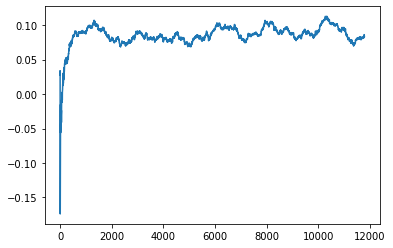

Thread: 2 iteration: 1940
RAM mDiffFit_206 FROM: 1024 --> 832 reward: -0.00845314140625001
Thread: 3 iteration: 1965
RAM mProject_37 FROM: 2624 --> 704 reward: -1.0
Thread: 1 iteration: 1895
RAM mBackground_27 FROM: 1472 --> 2688 reward: 0.01788990140625001
Saving ...


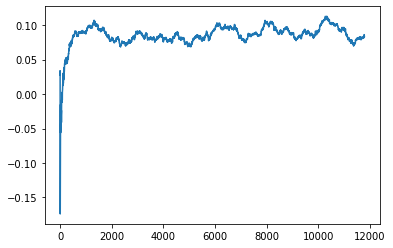

Thread: 5 iteration: 2040
RAM mBackground_50 FROM: 256 --> 1216 reward: -0.4193372755546875
Thread: 6 iteration: 1976
RAM mDiffFit_207 FROM: 2880 --> 704 reward: 0.006429624609374986
Thread: 3 iteration: 1966
RAM mDiffFit_269 FROM: 256 --> 384 reward: -0.26089588437500005
Thread: 2 iteration: 1941
RAM mDiffFit_226 FROM: 1792 --> 1216 reward: 0.054046902343750015
Thread: 1 iteration: 1896
RAM mDiffFit_9 FROM: 1088 --> 832 reward: -0.024664092578124998
Thread: 6 iteration: 1977
RAM mDiffFit_242 FROM: 384 --> 832 reward: -0.123513030859375
Thread: 5 iteration: 2041
RAM mProject_73 FROM: 192 --> 2688 reward: 0.789624395296875
Thread: 4 iteration: 1964
RAM mDiffFit_364 FROM: 2048 --> 384 reward: 0.09182809765625001
Thread: 3 iteration: 1967
RAM mDiffFit_107 FROM: 1024 --> 832 reward: 0.01658853984375
Thread: 2 iteration: 1942
RAM mDiffFit_365 FROM: 2752 --> 704 reward: 0.0229686734375
Thread: 1 iteration: 1897
RAM mDiffFit_55 FROM: 1024 --> 2752 reward: 0.023802167187500015
Thread: 5 iterat

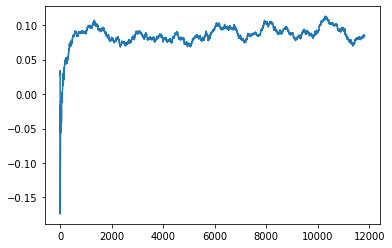

Thread: 3 iteration: 1970
RAM mBackground_58 FROM: 2816 --> 1216 reward: -0.031231145570312552
Thread: 2 iteration: 1945
RAM mDiffFit_270 FROM: 2880 --> 704 reward: 0.011627457421875022
Thread: 4 iteration: 1968
RAM mDiffFit_357 FROM: 2624 --> 704 reward: -0.004898516796875019
Thread: 3 iteration: 1971
RAM mDiffFit_257 FROM: 2624 --> 704 reward: -0.05822148085937501
Thread: 4 iteration: 1969
RAM mBackground_48 FROM: 2624 --> 1024 reward: 0.032057300203124986
Thread: 2 iteration: 1946
RAM mProject_58 FROM: 512 --> 2688 reward: 0.7858865759062501
Thread: 5 iteration: 2045
RAM mBackground_74 FROM: 1984 --> 2688 reward: 3.762500003987035e-08
Thread: 3 iteration: 1972
RAM mProject_31 FROM: 2560 --> 704 reward: -1.0
Saving ...


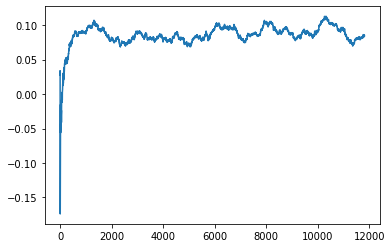

Thread: 6 iteration: 1980
RAM mDiffFit_285 FROM: 1152 --> 832 reward: 0.044033871484375
Thread: 5 iteration: 2046
RAM mDiffFit_258 FROM: 1984 --> 704 reward: 0.054356748046874986
Thread: 3 iteration: 1973
RAM mDiffFit_210 FROM: 1984 --> 1088 reward: 0.03560157070312503
Thread: 5 iteration: 2047
RAM mBackground_47 FROM: 128 --> 2688 reward: 0.29340817464062496
Thread: 6 iteration: 1981
RAM mProject_35 FROM: 2496 --> 704 reward: -1.0
Saving ...


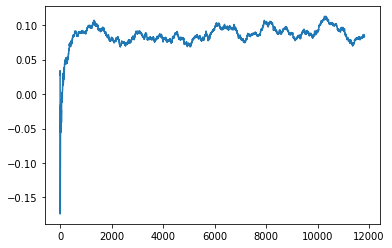

Thread: 1 iteration: 1900
RAM mBackground_56 FROM: 1984 --> 1024 reward: 0.09257093279687498
Thread: 3 iteration: 1974
RAM mDiffFit_177 FROM: 2880 --> 704 reward: 0.030942655468750007
Thread: 5 iteration: 2048
RAM mDiffFit_256 FROM: 2432 --> 704 reward: 0.032762987109375
Thread: 6 iteration: 1982
RAM mDiffFit_403 FROM: 128 --> 704 reward: -0.7293307738281251
Thread: 1 iteration: 1901
RAM mAdd_3 FROM: 320 --> 2688 reward: 0.552211607421875
Thread: 3 iteration: 1975
RAM mProject_23 FROM: 2048 --> 704 reward: -1.0
Saving ...


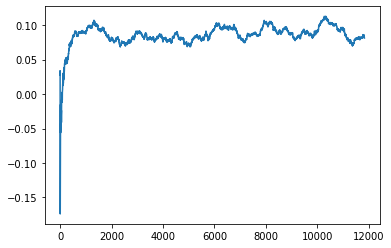

Thread: 4 iteration: 1970
RAM mProject_4 FROM: 1984 --> 704 reward: -1.0
Thread: 2 iteration: 1947
RAM mDiffFit_145 FROM: 512 --> 1216 reward: -0.16994274296875
Thread: 5 iteration: 2049
RAM mDiffFit_77 FROM: 2176 --> 704 reward: 0.010736925390625006
Thread: 6 iteration: 1983
RAM mDiffFit_13 FROM: 832 --> 832 reward: -0.005500000000000001
Thread: 3 iteration: 1976
RAM mDiffFit_82 FROM: 2816 --> 704 reward: 0.013020753124999996
Thread: 1 iteration: 1902
RAM mDiffFit_327 FROM: 192 --> 384 reward: -0.139132809765625
Thread: 2 iteration: 1948
RAM mDiffFit_127 FROM: 1152 --> 384 reward: 0.062437478125
Thread: 3 iteration: 1977
RAM mDiffFit_203 FROM: 256 --> 384 reward: 0.07409380468750007
Saving ...


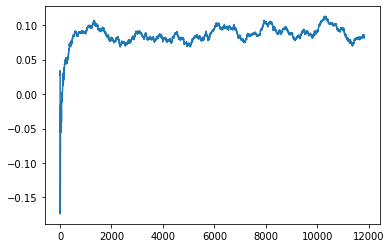

Thread: 5 iteration: 2050
RAM mBackground_50 FROM: 2176 --> 1024 reward: 0.03874920342187494
Thread: 1 iteration: 1903
RAM mDiffFit_37 FROM: 1344 --> 384 reward: 0.08504681484375001
Thread: 6 iteration: 1984
RAM mDiffFit_298 FROM: 128 --> 704 reward: -0.988309976953125
Thread: 4 iteration: 1971
RAM mDiffFit_34 FROM: 768 --> 1216 reward: -0.091695331640625
Thread: 3 iteration: 1978
RAM mBackground_41 FROM: 2176 --> 1024 reward: 0.027210857546874963
Thread: 5 iteration: 2051
RAM mDiffFit_21 FROM: 1344 --> 832 reward: -0.0010547121093750118
Thread: 1 iteration: 1904
RAM mDiffFit_132 FROM: 1664 --> 1216 reward: 0.017088539843750007
Thread: 6 iteration: 1985
RAM mDiffFit_40 FROM: 1984 --> 1088 reward: 0.016354159375000017
Thread: 4 iteration: 1972
RAM mProject_81 FROM: 384 --> 2688 reward: 0.767900617734375
Thread: 2 iteration: 1949
RAM mDiffFit_94 FROM: 704 --> 1088 reward: -0.07710938046875002
Thread: 3 iteration: 1979
RAM mDiffFit_181 FROM: 320 --> 2752 reward: -0.10304418242187499
Threa

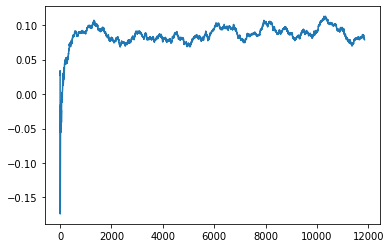

Thread: 2 iteration: 1950
RAM mDiffFit_339 FROM: 832 --> 832 reward: 0.0008749999999999904
Thread: 6 iteration: 1986
RAM mDiffFit_100 FROM: 2816 --> 704 reward: -0.0032422777343749966
Saving ...


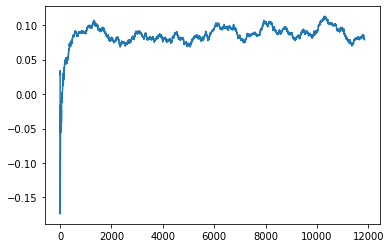

Thread: 3 iteration: 1980
RAM mDiffFit_376 FROM: 896 --> 832 reward: 0.002515619531249999
Thread: 5 iteration: 2053
RAM mBackground_51 FROM: 1024 --> 2688 reward: 0.03332964064062499
Thread: 1 iteration: 1906
RAM mDiffFit_291 FROM: 2176 --> 704 reward: 0.02308064257812499
Thread: 4 iteration: 1974
RAM mDiffFit_25 FROM: 2176 --> 704 reward: 0.028231748046875
Thread: 2 iteration: 1951
RAM mDiffFit_194 FROM: 2240 --> 704 reward: 0.004664005078125009
Thread: 6 iteration: 1987
RAM mDiffFit_270 FROM: 2432 --> 704 reward: 0.04408323125000002
Thread: 3 iteration: 1981
RAM mDiffFit_144 FROM: 1280 --> 384 reward: 0.12632292031249998
Thread: 5 iteration: 2054
RAM mDiffFit_13 FROM: 2112 --> 704 reward: -0.009703185156250006
Thread: 2 iteration: 1952
RAM mBackground_27 FROM: 2944 --> 1216 reward: -0.05815768812500003
Thread: 4 iteration: 1975
RAM mDiffFit_174 FROM: 2048 --> 1088 reward: 0.0039036066406249875
Thread: 6 iteration: 1988
RAM mDiffFit_117 FROM: 1728 --> 1216 reward: 0.000575508984375014

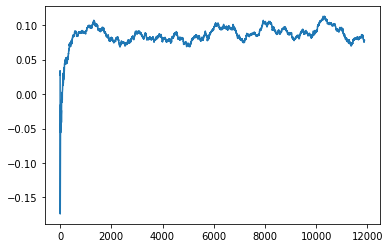

Thread: 6 iteration: 1990
RAM mProject_31 FROM: 2496 --> 704 reward: -1.0
Thread: 3 iteration: 1984
RAM mDiffFit_324 FROM: 2176 --> 1216 reward: 0.0067760179687499904
Saving ...


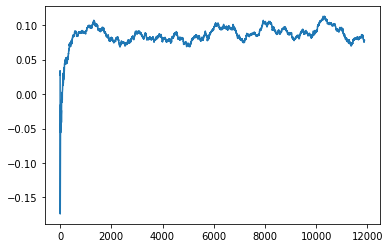

Thread: 4 iteration: 1980
RAM mDiffFit_377 FROM: 1728 --> 1216 reward: 0.008825508984375008
Thread: 4 iteration: 1981
RAM mBackground_7 FROM: 2624 --> 1216 reward: 0.002394016601562469
Thread: 6 iteration: 1991
RAM mBackground_5 FROM: 2304 --> 1024 reward: 0.03872679034375004
Thread: 3 iteration: 1985
RAM mProject_25 FROM: 2560 --> 704 reward: -1.0
Saving ...


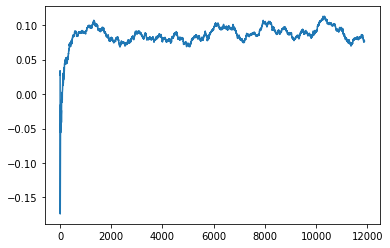

Thread: 1 iteration: 1910
RAM mProject_52 FROM: 1600 --> 704 reward: -1.0
Thread: 5 iteration: 2059
RAM mDiffFit_230 FROM: 2560 --> 704 reward: -0.025601658203125
Thread: 6 iteration: 1992
RAM mDiffFit_51 FROM: 1728 --> 1216 reward: -0.03863807460937502
Thread: 3 iteration: 1986
RAM mDiffFit_202 FROM: 2432 --> 704 reward: -0.01723446796875
Thread: 4 iteration: 1982
RAM mBackground_70 FROM: 1088 --> 2688 reward: 0.2204717073359375
Thread: 1 iteration: 1911
RAM mBackground_79 FROM: 1792 --> 2688 reward: 0.03379092112499999
Thread: 6 iteration: 1993
RAM mDiffFit_25 FROM: 2816 --> 704 reward: 0.058710907421875
Thread: 3 iteration: 1987
RAM mProject_86 FROM: 2240 --> 704 reward: -1.0
Thread: 2 iteration: 1958
RAM mBackground_49 FROM: 512 --> 1024 reward: -0.17595957706249998
Thread: 4 iteration: 1983
RAM mDiffFit_105 FROM: 768 --> 2752 reward: -0.13417971210937502
Thread: 6 iteration: 1994
RAM mDiffFit_55 FROM: 2560 --> 704 reward: 0.01989057578125
Thread: 2 iteration: 1959
RAM mDiffFit_254

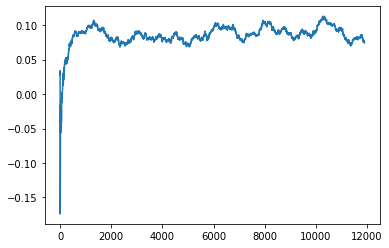

Thread: 2 iteration: 1960
RAM mBackground_66 FROM: 2304 --> 1216 reward: -0.012360348992187515
Thread: 6 iteration: 1995
RAM mDiffFit_373 FROM: 2368 --> 2944 reward: 0.04689329570312501
Thread: 4 iteration: 1985
RAM mProject_90 FROM: 512 --> 2688 reward: 0.7733709371249999
Thread: 1 iteration: 1912
RAM mDiffFit_278 FROM: 2496 --> 704 reward: 0.023007766015625004
Thread: 2 iteration: 1961
RAM mDiffFit_113 FROM: 1920 --> 1408 reward: -0.04531778671874999
Thread: 6 iteration: 1996
RAM mDiffFit_160 FROM: 640 --> 2752 reward: -0.15832033164062503
Thread: 4 iteration: 1986
RAM mDiffFit_352 FROM: 1408 --> 832 reward: -0.01435942421875001
Thread: 1 iteration: 1913
RAM mDiffFit_206 FROM: 1280 --> 2752 reward: 0.006205773828124993
Thread: 6 iteration: 1997
RAM mDiffFit_275 FROM: 1600 --> 2752 reward: -0.005111969140625004
Thread: 1 iteration: 1914
RAM mProject_30 FROM: 2432 --> 704 reward: -1.0
Saving ...


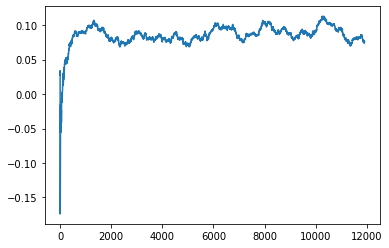

Thread: 5 iteration: 2060
RAM mDiffFit_87 FROM: 1280 --> 2752 reward: -0.03990623906249999
Thread: 6 iteration: 1998
RAM mDiffFit_374 FROM: 1600 --> 2752 reward: 0.01323442421874997
Thread: 5 iteration: 2061
RAM mProject_66 FROM: 2496 --> 704 reward: -1.0
Thread: 3 iteration: 1989
RAM mDiffFit_202 FROM: 832 --> 2752 reward: -0.06453123906250002
Thread: 6 iteration: 1999
RAM mBackground_33 FROM: 960 --> 2688 reward: -0.0031173494999999743
Saving ...


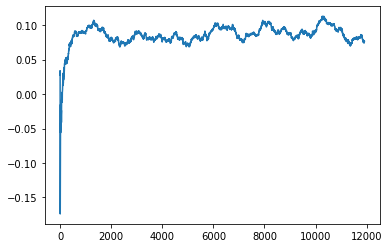

Thread: 3 iteration: 1990
RAM mProject_18 FROM: 2304 --> 1216 reward: 0.050532473320312556
Thread: 2 iteration: 1962
RAM mProject_16 FROM: 2112 --> 1216 reward: 0.09087364631249992
Thread: 4 iteration: 1987
RAM mDiffFit_42 FROM: 896 --> 832 reward: -0.006778650390624995
Saving ...


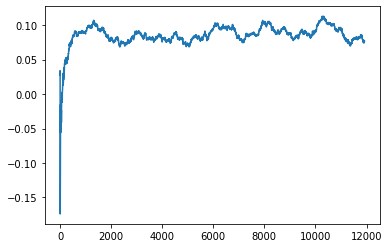

Thread: 6 iteration: 2000
RAM mDiffFit_285 FROM: 576 --> 2752 reward: -0.026796814843750016
Thread: 3 iteration: 1991
RAM mDiffFit_93 FROM: 2816 --> 704 reward: 0.06021090742187499
Thread: 2 iteration: 1963
RAM mDiffFit_294 FROM: 2368 --> 1408 reward: -0.027968804687500005
Thread: 3 iteration: 1992
RAM mBackground_10 FROM: 896 --> 2688 reward: -0.0032696380312500564
Thread: 6 iteration: 2001
RAM mProject_82 FROM: 2560 --> 704 reward: -1.0
Thread: 1 iteration: 1915
RAM mDiffFit_332 FROM: 128 --> 1408 reward: -0.7313698226562502
Thread: 3 iteration: 1993
RAM mDiffFit_178 FROM: 1216 --> 2752 reward: 0.023591216015625
Thread: 6 iteration: 2002
RAM mBackground_70 FROM: 2432 --> 1216 reward: -0.04293966528906252
Thread: 1 iteration: 1916
RAM mProject_61 FROM: 3008 --> 704 reward: -1.0
Thread: 5 iteration: 2062
RAM mDiffFit_150 FROM: 1344 --> 2752 reward: -0.07789847304687501
Thread: 1 iteration: 1917
RAM mDiffFit_387 FROM: 384 --> 2752 reward: -0.11124214648437503
Thread: 6 iteration: 2003
R

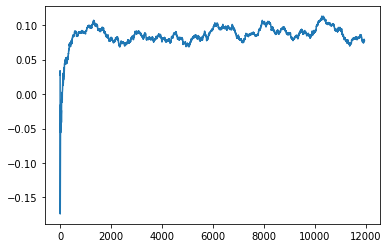

Thread: 1 iteration: 1920
RAM mDiffFit_332 FROM: 448 --> 832 reward: -0.07871876093750002
Thread: 2 iteration: 1965
RAM mDiffFit_416 FROM: 832 --> 1216 reward: -0.010442699218750004
Saving ...


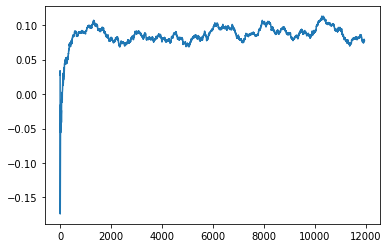

Thread: 4 iteration: 1990
RAM mDiffFit_329 FROM: 1408 --> 1216 reward: 0.019557300781250005
Thread: 4 iteration: 1991
RAM mProject_46 FROM: 1472 --> 704 reward: -1.0
Thread: 3 iteration: 1995
RAM mDiffFit_346 FROM: 2688 --> 704 reward: 0.05496345234375002
Thread: 4 iteration: 1992
RAM mBackground_34 FROM: 2944 --> 1216 reward: -0.049295635710937515
Thread: 3 iteration: 1996
RAM mDiffFit_119 FROM: 2752 --> 704 reward: -0.028890750781249974
Thread: 4 iteration: 1993
RAM mProject_39 FROM: 704 --> 2688 reward: 0.774135937125
Thread: 6 iteration: 2005
RAM mBackground_45 FROM: 2176 --> 1216 reward: -0.0023382096562500634
Thread: 4 iteration: 1994
RAM mProject_12 FROM: 1792 --> 1216 reward: 0.1383651518203125
Thread: 1 iteration: 1921
RAM mDiffFit_29 FROM: 2880 --> 704 reward: -0.003940198046875013
Thread: 4 iteration: 1995
RAM mBackground_23 FROM: 1792 --> 1024 reward: 0.060773308250000005
Thread: 6 iteration: 2006
RAM mProject_44 FROM: 512 --> 2688 reward: 0.774113437125
Thread: 3 iteration

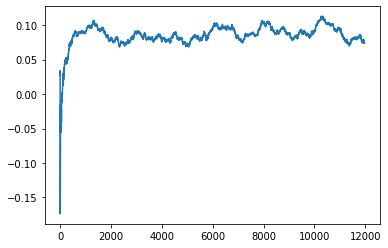

Thread: 3 iteration: 2000
RAM mDiffFit_383 FROM: 1472 --> 2752 reward: -0.0010129871093750124
Saving ...


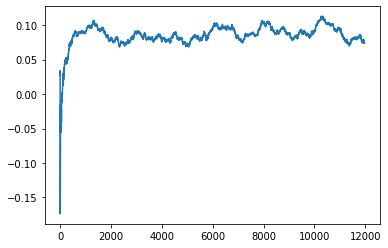

Thread: 6 iteration: 2010
RAM mProject_14 FROM: 832 --> 2688 reward: 0.780146256515625
Thread: 1 iteration: 1923
RAM mDiffFit_160 FROM: 1344 --> 2752 reward: -0.031257809765625005
Thread: 2 iteration: 1969
RAM mProject_33 FROM: 512 --> 2688 reward: 0.768058117734375
Thread: 4 iteration: 1998
RAM mProject_76 FROM: 1920 --> 1216 reward: 0.10135821972656259
Thread: 5 iteration: 2066
RAM mDiffFit_253 FROM: 1152 --> 2752 reward: 0.03734648085937497
Thread: 1 iteration: 1924
RAM mDiffFit_138 FROM: 2176 --> 2944 reward: 0.017875043750000003
Saving ...


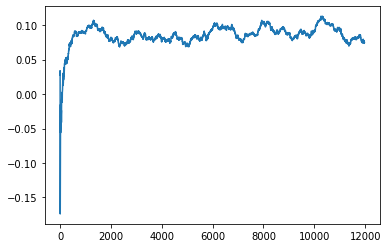

Thread: 2 iteration: 1970
RAM mDiffFit_332 FROM: 896 --> 2752 reward: -0.019617146484375014
Thread: 5 iteration: 2067
RAM mDiffFit_190 FROM: 1216 --> 2752 reward: 0.00802869414062499
Thread: 1 iteration: 1925
RAM mDiffFit_44 FROM: 3008 --> 1408 reward: -0.11053663515624998
Thread: 5 iteration: 2068
RAM mBackground_76 FROM: 1280 --> 2688 reward: -0.040670770625
Thread: 2 iteration: 1971
RAM mProject_18 FROM: 1920 --> 1216 reward: 0.10042868306250001
Thread: 3 iteration: 2001
RAM mDiffFit_310 FROM: 2560 --> 1408 reward: -0.05158862734375
Thread: 5 iteration: 2069
RAM mBackground_64 FROM: 1472 --> 2688 reward: 0.017029901406250044
Thread: 2 iteration: 1972
RAM mProject_36 FROM: 1856 --> 1216 reward: 0.12707575122656262
Thread: 4 iteration: 1999
RAM mDiffFit_36 FROM: 960 --> 2752 reward: 0.024330817578125004
Thread: 2 iteration: 1973
RAM mProject_59 FROM: 1600 --> 704 reward: -1.0
Thread: 6 iteration: 2011
RAM mProject_1 FROM: 448 --> 2688 reward: 0.756847478953125
Thread: 1 iteration: 192

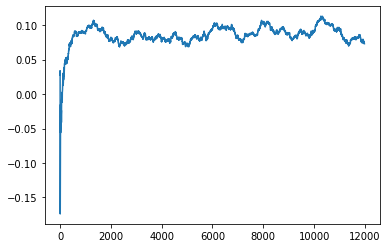

Thread: 5 iteration: 2070
RAM mDiffFit_327 FROM: 2240 --> 704 reward: -0.039987100390625
Saving ...


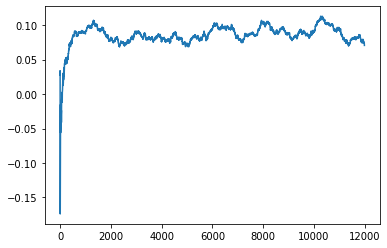

Thread: 4 iteration: 2000
RAM mDiffFit_338 FROM: 1280 --> 1216 reward: -0.09428132656250002
Thread: 6 iteration: 2012
RAM mDiffFit_140 FROM: 1600 --> 1216 reward: 0.012861969140624992
Thread: 2 iteration: 1974
RAM mDiffFit_420 FROM: 2816 --> 704 reward: 0.005921814843750008
Thread: 1 iteration: 1927
RAM mDiffFit_44 FROM: 576 --> 2752 reward: -0.04100513359375001
Thread: 5 iteration: 2071
RAM mDiffFit_345 FROM: 2048 --> 704 reward: -0.07119291796875003
Thread: 3 iteration: 2003
RAM mDiffFit_154 FROM: 2240 --> 2944 reward: 0.016414092578125004
Thread: 5 iteration: 2072
RAM mDiffFit_89 FROM: 256 --> 2752 reward: -0.13467699218749998
Thread: 1 iteration: 1928
RAM mBackground_63 FROM: 2496 --> 1216 reward: 0.016897573945312525
Thread: 2 iteration: 1975
RAM mDiffFit_49 FROM: 1024 --> 2752 reward: 0.012385485937499996
Thread: 3 iteration: 2004
RAM mBackground_41 FROM: 832 --> 2688 reward: -0.06640575764843751
Thread: 5 iteration: 2073
RAM mDiffFit_395 FROM: 1728 --> 1408 reward: -0.0326979640

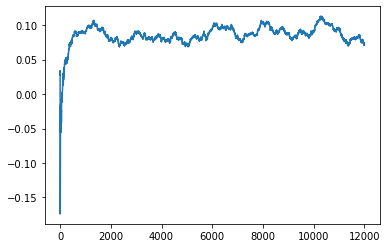

Thread: 1 iteration: 1930
RAM mBackground_74 FROM: 128 --> 1216 reward: -1.3408228606640624
Thread: 2 iteration: 1977
RAM mProject_12 FROM: 1792 --> 1216 reward: 0.1400484345468749
Thread: 6 iteration: 2013
RAM mProject_46 FROM: 2688 --> 704 reward: -1.0
Thread: 4 iteration: 2001
RAM mDiffFit_108 FROM: 704 --> 2752 reward: 0.248982141796875
Thread: 5 iteration: 2075
RAM mDiffFit_42 FROM: 1280 --> 832 reward: 0.02633853984375
Thread: 2 iteration: 1978
RAM mDiffFit_34 FROM: 1664 --> 2880 reward: 0.35480778203125
Thread: 6 iteration: 2014
RAM mDiffFit_246 FROM: 1088 --> 2752 reward: 0.011250087499999981
Thread: 4 iteration: 2002
RAM mDiffFit_199 FROM: 1792 --> 1408 reward: -0.03532296406250002
Thread: 5 iteration: 2076
RAM mDiffFit_238 FROM: 960 --> 2752 reward: 0.08243765312499995
Thread: 6 iteration: 2015
RAM mProject_9 FROM: 128 --> 2688 reward: 0.800880034078125
Thread: 1 iteration: 1931
RAM mDiffFit_98 FROM: 1984 --> 2944 reward: 0.04722143710937502
Thread: 4 iteration: 2003
RAM mDif

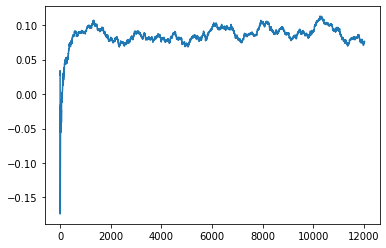

Thread: 2 iteration: 1980
RAM mProject_88 FROM: 1920 --> 1216 reward: 0.1357480915312499
Thread: 4 iteration: 2005
RAM mDiffFit_134 FROM: 2112 --> 2880 reward: 0.021000043750000006
Thread: 2 iteration: 1981
RAM mBackground_28 FROM: 1024 --> 2688 reward: -0.057149588734374944
Saving ...


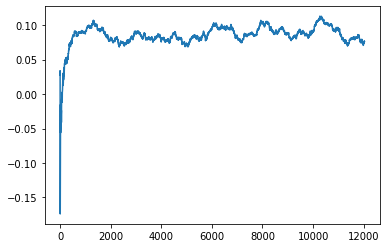

Thread: 5 iteration: 2080
RAM mDiffFit_8 FROM: 512 --> 2752 reward: -0.06991922617187502
Thread: 4 iteration: 2006
RAM mDiffFit_71 FROM: 832 --> 2752 reward: 0.016963627343750017
Thread: 2 iteration: 1982
RAM mDiffFit_143 FROM: 320 --> 2752 reward: -0.18721608476562498
Thread: 5 iteration: 2081
RAM mProject_1 FROM: 128 --> 2688 reward: 0.76258779834375
Thread: 3 iteration: 2009
RAM mDiffFit_207 FROM: 1216 --> 2752 reward: -0.010380177343750022
Thread: 4 iteration: 2007
RAM mDiffFit_294 FROM: 256 --> 2752 reward: -0.136252544921875
Thread: 5 iteration: 2082
RAM mDiffFit_228 FROM: 2624 --> 1408 reward: 0.044476570703124996
Thread: 2 iteration: 1983
RAM mProject_85 FROM: 2880 --> 704 reward: -1.0
Thread: 1 iteration: 1934
RAM mDiffFit_368 FROM: 1984 --> 2880 reward: 0.047648516796875026
Saving ...


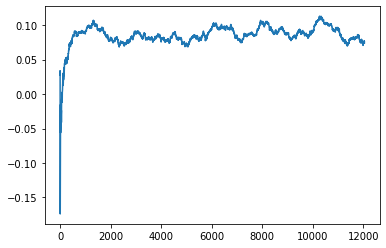

Thread: 3 iteration: 2010
RAM mDiffFit_106 FROM: 832 --> 2752 reward: 0.0010417249999999934
Thread: 1 iteration: 1935
RAM mDiffFit_279 FROM: 1920 --> 2944 reward: 0.027328185156250025
Thread: 2 iteration: 1984
RAM mProject_1 FROM: 2880 --> 704 reward: -1.0
Saving ...


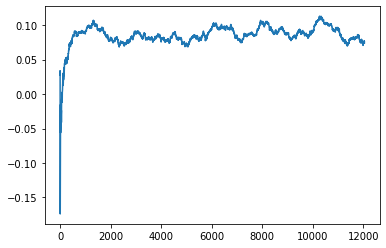

Thread: 6 iteration: 2020
RAM mDiffFit_28 FROM: 2752 --> 1408 reward: 0.017966128515625023
Thread: 1 iteration: 1936
RAM mDiffFit_103 FROM: 1472 --> 2816 reward: 0.05967198984374998
Thread: 3 iteration: 2011
RAM mDiffFit_175 FROM: 2176 --> 1408 reward: -0.07324491015625001
Thread: 2 iteration: 1985
RAM mBackground_56 FROM: 320 --> 1216 reward: -0.36036237545312505
Thread: 6 iteration: 2021
RAM mProject_37 FROM: 448 --> 2688 reward: 0.791424395296875
Thread: 5 iteration: 2083
RAM mDiffFit_417 FROM: 1216 --> 2752 reward: 0.01652869414062499
Thread: 1 iteration: 1937
RAM mBackground_13 FROM: 1216 --> 2688 reward: 0.0353385210234375
Thread: 2 iteration: 1986
RAM mBackground_87 FROM: 1536 --> 2688 reward: 0.07723891931249999
Thread: 5 iteration: 2084
RAM mDiffFit_150 FROM: 1536 --> 2752 reward: -0.03283595117187503
Thread: 6 iteration: 2022
RAM mProject_26 FROM: 1024 --> 704 reward: -1.0
Thread: 4 iteration: 2008
RAM mBackground_14 FROM: 640 --> 1216 reward: -0.24086501297656246
Thread: 3 i

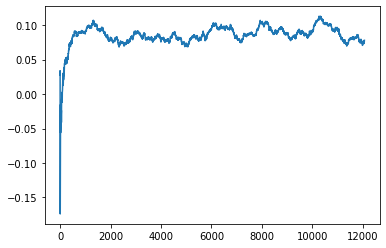

Thread: 4 iteration: 2010
RAM mDiffFit_175 FROM: 2624 --> 1408 reward: -0.13339083828125
Thread: 3 iteration: 2014
RAM mViewer_1 FROM: 512 --> 1216 reward: -0.2752612933125
Thread: 1 iteration: 1939
RAM mDiffFit_126 FROM: 1152 --> 2880 reward: 0.01852356054687497
Thread: 2 iteration: 1989
RAM mDiffFit_398 FROM: 1152 --> 2752 reward: 0.001648473046874984
Thread: 6 iteration: 2025
RAM mDiffFit_156 FROM: 1024 --> 2880 reward: 0.015296989843749977
Thread: 5 iteration: 2087
RAM mDiffFit_91 FROM: 832 --> 2752 reward: 0.007963627343750002
Thread: 3 iteration: 2015
RAM mDiffFit_311 FROM: 1344 --> 2880 reward: -0.025335907421874977
Saving ...


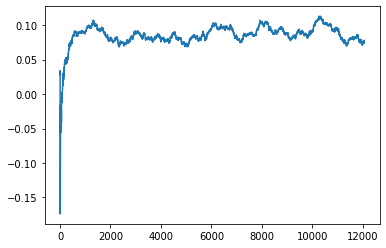

Thread: 1 iteration: 1940
RAM mDiffFit_33 FROM: 1728 --> 2944 reward: 0.03526048593750001
Saving ...


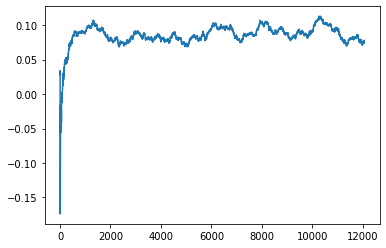

Thread: 2 iteration: 1990
RAM mDiffFit_305 FROM: 2816 --> 704 reward: 0.7305550183593751
Thread: 4 iteration: 2011
RAM mDiffFit_270 FROM: 1408 --> 2880 reward: 0.048721480859375
Thread: 6 iteration: 2026
RAM mDiffFit_128 FROM: 1408 --> 1216 reward: -0.029744822656250017
Thread: 5 iteration: 2088
RAM mDiffFit_11 FROM: 1216 --> 2752 reward: 0.043250087500000006
Thread: 3 iteration: 2016
RAM mDiffFit_145 FROM: 1792 --> 2880 reward: 0.062872498828125
Thread: 2 iteration: 1991
RAM mBackground_17 FROM: 832 --> 1216 reward: -0.1454587441640625
Thread: 1 iteration: 1941
RAM mDiffFit_264 FROM: 2944 --> 704 reward: -0.023901149218750004
Thread: 4 iteration: 2012
RAM mBackground_68 FROM: 192 --> 1216 reward: -0.674239962375
Thread: 6 iteration: 2027
RAM mDiffFit_166 FROM: 2816 --> 704 reward: 0.008546814843749997
Thread: 5 iteration: 2089
RAM mDiffFit_227 FROM: 2176 --> 1408 reward: -0.015781282812500012
Thread: 2 iteration: 1992
RAM mDiffFit_92 FROM: 3008 --> 704 reward: 0.04097130585937501
Thre

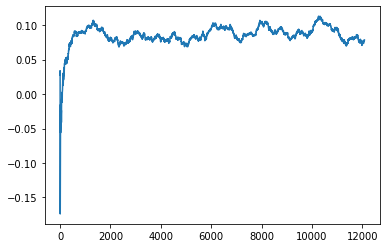

Thread: 5 iteration: 2090
RAM mDiffFit_229 FROM: 2816 --> 704 reward: 0.02493484570312501
Thread: 2 iteration: 1993
RAM mDiffFit_303 FROM: 1088 --> 1216 reward: -0.06902088437500001
Thread: 1 iteration: 1943
RAM mDiffFit_341 FROM: 1792 --> 1216 reward: 0.03516146015624999
Thread: 6 iteration: 2029
RAM mDiffFit_19 FROM: 2240 --> 2944 reward: 0.015539092578125014
Thread: 2 iteration: 1994
RAM mDiffFit_60 FROM: 2496 --> 1408 reward: -0.005216172265624999
Thread: 1 iteration: 1944
RAM mDiffFit_316 FROM: 960 --> 2816 reward: 0.027278737890624998
Saving ...


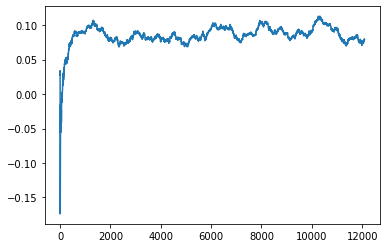

Thread: 6 iteration: 2030
RAM mDiffFit_184 FROM: 2112 --> 1408 reward: -0.047716216015625014
Thread: 1 iteration: 1945
RAM mDiffFit_354 FROM: 1920 --> 1408 reward: -0.013958362500000009
Thread: 6 iteration: 2031
RAM mProject_87 FROM: 2496 --> 704 reward: -1.0
Thread: 3 iteration: 2017
RAM mProject_47 FROM: 896 --> 704 reward: -1.0
Thread: 4 iteration: 2013
RAM mBackground_24 FROM: 1856 --> 1216 reward: -0.026196493257812533
Thread: 1 iteration: 1946
RAM mDiffFit_107 FROM: 768 --> 2752 reward: -0.05158590742187502
Thread: 4 iteration: 2014
RAM mDiffFit_179 FROM: 1792 --> 2944 reward: 0.056171989843749985
Thread: 6 iteration: 2032
RAM mProject_72 FROM: 1856 --> 1216 reward: 0.12227715435937497
Thread: 5 iteration: 2091
RAM mDiffFit_62 FROM: 2240 --> 1216 reward: -0.006382853515625002
Thread: 1 iteration: 1947
RAM mDiffFit_384 FROM: 1984 --> 1216 reward: 0.039445331640625005
Thread: 6 iteration: 2033
RAM mDiffFit_415 FROM: 2240 --> 2944 reward: 0.010789092578125
Thread: 1 iteration: 1948


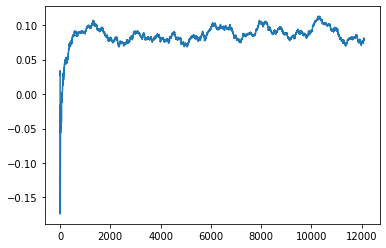

Thread: 1 iteration: 1950
RAM mDiffFit_406 FROM: 2944 --> 2944 reward: 0.00037500000000001074
Saving ...


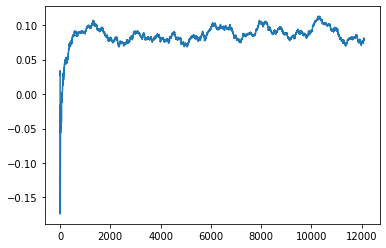

Thread: 3 iteration: 2020
RAM mDiffFit_6 FROM: 896 --> 2752 reward: -0.00023692539062501738
Thread: 4 iteration: 2017
RAM mDiffFit_12 FROM: 512 --> 2752 reward: -0.06523951406249999
Thread: 5 iteration: 2094
RAM mBackground_23 FROM: 1984 --> 1216 reward: -0.0010145900390624934
Thread: 2 iteration: 1997
RAM mDiffFit_223 FROM: 1152 --> 2816 reward: -0.00548433671875001
Thread: 1 iteration: 1951
RAM mBackground_22 FROM: 2880 --> 1216 reward: -0.01124059808593752
Thread: 3 iteration: 2021
RAM mProject_58 FROM: 1088 --> 704 reward: -1.0
Thread: 6 iteration: 2034
RAM mDiffFit_208 FROM: 1600 --> 2816 reward: 0.032760485937499986
Thread: 5 iteration: 2095
RAM mDiffFit_346 FROM: 2176 --> 1408 reward: 0.027515619531249952
Thread: 4 iteration: 2018
RAM mDiffFit_378 FROM: 320 --> 2752 reward: -0.034554580859375
Thread: 2 iteration: 1998
RAM mDiffFit_417 FROM: 1600 --> 2880 reward: 0.003200552734374997
Thread: 1 iteration: 1952
RAM mDiffFit_377 FROM: 640 --> 2752 reward: -0.042669226171875005
Threa

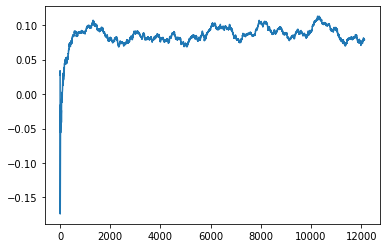

Thread: 2 iteration: 2000
RAM mDiffFit_199 FROM: 2816 --> 2944 reward: 0.004145840625000008
Saving ...


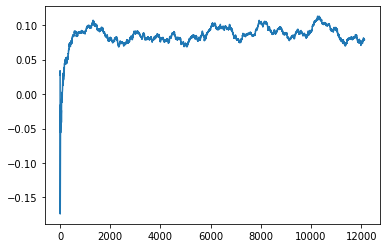

Thread: 4 iteration: 2020
RAM mProject_28 FROM: 320 --> 2688 reward: 0.78426657590625
Thread: 6 iteration: 2035
RAM mDiffFit_286 FROM: 768 --> 2752 reward: -0.039708275000000015
Thread: 1 iteration: 1954
RAM mProject_42 FROM: 2048 --> 1216 reward: 0.10834913327343756
Thread: 3 iteration: 2022
RAM mBackground_54 FROM: 1600 --> 1216 reward: 0.01012288531250005
Thread: 2 iteration: 2001
RAM mDiffFit_289 FROM: 2432 --> 1408 reward: -0.023791725000000003
Thread: 4 iteration: 2021
RAM mConcatFit_3 FROM: 2304 --> 1216 reward: 0.02825412437499994
Thread: 6 iteration: 2036
RAM mProject_34 FROM: 1792 --> 1216 reward: 0.13549780364062503
Thread: 5 iteration: 2097
RAM mDiffFit_80 FROM: 1344 --> 1408 reward: -5.207968749998751e-05
Thread: 1 iteration: 1955
RAM mDiffFit_50 FROM: 2560 --> 1408 reward: -0.047296989843749956
Thread: 3 iteration: 2023
RAM mBackground_26 FROM: 2112 --> 1216 reward: -0.012328993257812507
Thread: 4 iteration: 2022
RAM mDiffFit_47 FROM: 1472 --> 2880 reward: -0.062098982031

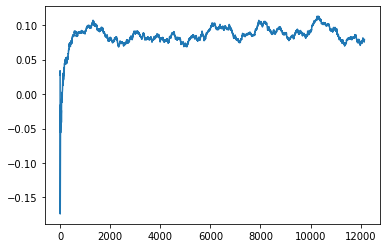

Thread: 5 iteration: 2100
RAM mBackground_40 FROM: 3008 --> 1216 reward: -0.10734348470312502
Thread: 3 iteration: 2026
RAM mDiffFit_303 FROM: 448 --> 2752 reward: -0.07505203593750001
Thread: 5 iteration: 2101
RAM mDiffFit_63 FROM: 1472 --> 2752 reward: -0.011744778906250027
Thread: 3 iteration: 2027
RAM mBackground_48 FROM: 1472 --> 1216 reward: 0.016335509859375007
Saving ...


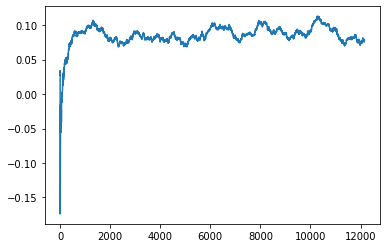

Thread: 6 iteration: 2040
RAM mDiffFit_397 FROM: 2624 --> 1408 reward: -0.03013548593750002
Thread: 5 iteration: 2102
RAM mDiffFit_102 FROM: 2816 --> 1408 reward: -0.018604246875000008
Thread: 3 iteration: 2028
RAM mDiffFit_316 FROM: 640 --> 2752 reward: -0.09471612851562503
Thread: 6 iteration: 2041
RAM mProject_34 FROM: 2944 --> 704 reward: -1.0
Thread: 2 iteration: 2004
RAM mBackground_43 FROM: 2176 --> 1216 reward: -0.04121517514843752
Thread: 5 iteration: 2103
RAM mDiffFit_215 FROM: 2752 --> 1408 reward: -0.009434933203124989
Thread: 2 iteration: 2005
RAM mBackground_89 FROM: 1536 --> 1216 reward: 0.031074216398437507
Thread: 6 iteration: 2042
RAM mProject_12 FROM: 3008 --> 704 reward: -1.0
Thread: 4 iteration: 2025
RAM mProject_12 FROM: 2368 --> 704 reward: -1.0
Thread: 1 iteration: 1957
RAM mBackground_11 FROM: 1344 --> 1216 reward: -0.008393980281250026
Thread: 3 iteration: 2029
RAM mDiffFit_165 FROM: 960 --> 2816 reward: 0.006078228906249983
Thread: 5 iteration: 2104
RAM mDiff

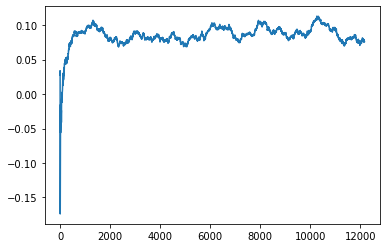

Thread: 3 iteration: 2030
RAM mDiffFit_217 FROM: 2368 --> 1408 reward: -0.020718804687500005
Thread: 6 iteration: 2044
RAM mDiffFit_325 FROM: 2240 --> 2944 reward: 0.008664092578125008
Thread: 4 iteration: 2027
RAM mImgtbl_3 FROM: 2048 --> 1216 reward: 0.15071877843749998
Thread: 2 iteration: 2007
RAM mDiffFit_259 FROM: 1216 --> 2816 reward: 0.047341259765625
Thread: 3 iteration: 2031
RAM mDiffFit_303 FROM: 1536 --> 2880 reward: 0.8507823328124999
Thread: 1 iteration: 1959
RAM mDiffFit_120 FROM: 2176 --> 2944 reward: -0.008963539843750007
Thread: 6 iteration: 2045
RAM mDiffFit_363 FROM: 2688 --> 1408 reward: -0.035208406250000004
Saving ...


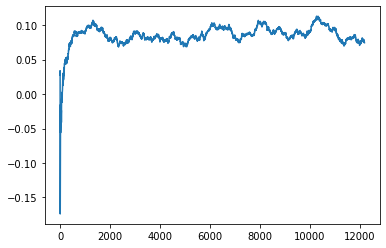

Thread: 1 iteration: 1960
RAM mDiffFit_408 FROM: 640 --> 2752 reward: -0.00984104101562501
Thread: 3 iteration: 2032
RAM mProject_50 FROM: 1920 --> 1216 reward: 0.1103244736640626
Thread: 5 iteration: 2105
RAM mAdd_3 FROM: 2688 --> 1216 reward: -0.06327241933593748
Thread: 2 iteration: 2008
RAM mDiffFit_154 FROM: 1344 --> 2816 reward: -0.07265628281249999
Thread: 1 iteration: 1961
RAM mProject_5 FROM: 448 --> 2688 reward: 0.768575617734375
Thread: 4 iteration: 2028
RAM mDiffFit_380 FROM: 1152 --> 2752 reward: 0.014601614453124984
Thread: 1 iteration: 1962
RAM mDiffFit_314 FROM: 832 --> 2752 reward: 0.011588627343750001
Thread: 2 iteration: 2009
RAM mBackground_40 FROM: 2112 --> 1216 reward: 0.019314116499999957
Thread: 5 iteration: 2106
RAM mDiffFit_2 FROM: 576 --> 2816 reward: -0.10014053203125
Thread: 4 iteration: 2029
RAM mDiffFit_47 FROM: 576 --> 2752 reward: -0.03514838554687502
Thread: 1 iteration: 1963
RAM mDiffFit_18 FROM: 1280 --> 2752 reward: 0.024945375390624993
Thread: 5 it

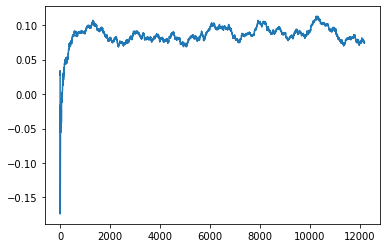

Thread: 4 iteration: 2030
RAM mDiffFit_25 FROM: 2816 --> 704 reward: 0.020184845703125013
Thread: 1 iteration: 1964
RAM mDiffFit_338 FROM: 256 --> 2944 reward: -0.269812434375
Thread: 5 iteration: 2108
RAM mDiffFit_179 FROM: 2304 --> 1408 reward: -0.027135485937500002
Thread: 6 iteration: 2047
RAM mProject_78 FROM: 512 --> 2688 reward: 0.7744059371249999
Saving ...


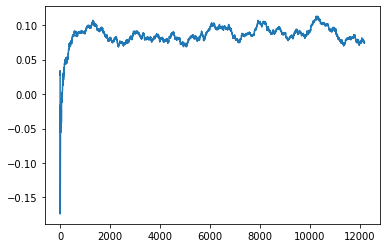

Thread: 2 iteration: 2010
RAM mProject_67 FROM: 1152 --> 704 reward: -1.0
Thread: 3 iteration: 2033
RAM mDiffFit_253 FROM: 576 --> 2880 reward: -0.08224986875000004
Thread: 4 iteration: 2031
RAM mDiffFit_280 FROM: 2752 --> 704 reward: -0.0032943574218750014
Thread: 5 iteration: 2109
RAM mBackground_82 FROM: 1344 --> 1216 reward: -0.06877543591406252
Thread: 1 iteration: 1965
RAM mDiffFit_17 FROM: 2624 --> 2944 reward: 0.035174534765625
Thread: 6 iteration: 2048
RAM mDiffFit_261 FROM: 576 --> 2752 reward: -0.033023385546875006
Thread: 2 iteration: 2011
RAM mBackground_84 FROM: 1216 --> 1216 reward: 0.0024724999999999964
Thread: 3 iteration: 2034
RAM mDiffFit_311 FROM: 2752 --> 704 reward: -0.007099025781249994
Thread: 4 iteration: 2032
RAM mDiffFit_235 FROM: 2240 --> 2944 reward: 0.016289092578125
Thread: 6 iteration: 2049
RAM mDiffFit_70 FROM: 2496 --> 1408 reward: -0.009463583593749998
Thread: 3 iteration: 2035
RAM mBackground_89 FROM: 1280 --> 1216 reward: -0.010608918007812558
Threa

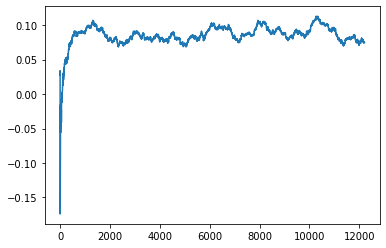

Thread: 5 iteration: 2110
RAM mDiffFit_5 FROM: 320 --> 2752 reward: -0.098044182421875
Thread: 1 iteration: 1967
RAM mDiffFit_241 FROM: 2880 --> 704 reward: 0.0066796246093749935
Thread: 3 iteration: 2036
RAM mDiffFit_190 FROM: 2304 --> 2880 reward: 0.01130471210937501
Thread: 5 iteration: 2111
RAM mBackground_87 FROM: 2304 --> 1216 reward: 0.04663703943749997
Saving ...


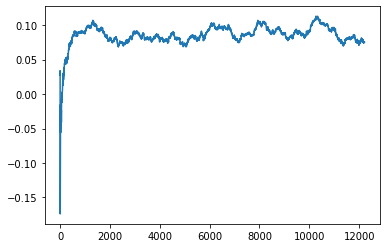

Thread: 6 iteration: 2050
RAM mDiffFit_370 FROM: 512 --> 2752 reward: -0.040773385546875006
Thread: 1 iteration: 1968
RAM mDiffFit_305 FROM: 1088 --> 2752 reward: 0.013299534765624987
Thread: 3 iteration: 2037
RAM mDiffFit_167 FROM: 768 --> 2752 reward: -0.02674214648437501
Thread: 5 iteration: 2112
RAM mDiffFit_211 FROM: 2816 --> 2944 reward: -0.036067742968750004
Thread: 6 iteration: 2051
RAM mProject_22 FROM: 1792 --> 1216 reward: 0.13483498949999997
Thread: 4 iteration: 2033
RAM mDiffFit_377 FROM: 1280 --> 2752 reward: 0.0008229640624999972
Thread: 3 iteration: 2038
RAM mProject_53 FROM: 1984 --> 1216 reward: 0.0947310102421875
Thread: 2 iteration: 2013
RAM mBackground_1 FROM: 2688 --> 1216 reward: -0.011507103015624999
Thread: 1 iteration: 1969
RAM mBackground_12 FROM: 2304 --> 1216 reward: 0.01403540996093752
Thread: 5 iteration: 2113
RAM mDiffFit_321 FROM: 1216 --> 2752 reward: -0.009380177343750011
Thread: 6 iteration: 2052
RAM mDiffFit_200 FROM: 2432 --> 2944 reward: 0.0570886

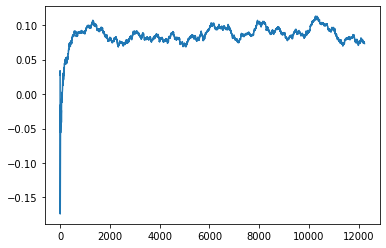

Thread: 1 iteration: 1970
RAM mDiffFit_95 FROM: 1536 --> 2816 reward: 0.025718804687499992
Thread: 4 iteration: 2035
RAM mDiffFit_153 FROM: 1088 --> 2752 reward: 0.02117453476562498
Saving ...


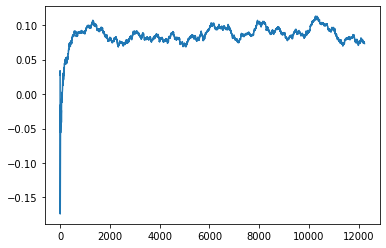

Thread: 3 iteration: 2040
RAM mDiffFit_292 FROM: 768 --> 2752 reward: -0.05333853984374999
Thread: 2 iteration: 2015
RAM mDiffFit_271 FROM: 2496 --> 1216 reward: -0.006049534765624996
Thread: 6 iteration: 2054
RAM mDiffFit_209 FROM: 1792 --> 1216 reward: 0.031013030859375016
Thread: 5 iteration: 2115
RAM mDiffFit_127 FROM: 2240 --> 1216 reward: 0.01919269921875001
Thread: 1 iteration: 1971
RAM mDiffFit_406 FROM: 2944 --> 2944 reward: 0.0011249999999999975
Thread: 4 iteration: 2036
RAM mDiffFit_269 FROM: 1216 --> 2752 reward: 0.010903694140624986
Thread: 6 iteration: 2055
RAM mDiffFit_15 FROM: 2880 --> 2944 reward: 0.09300794101562503
Thread: 3 iteration: 2041
RAM mDiffFit_278 FROM: 2048 --> 2944 reward: 0.048604246875
Thread: 5 iteration: 2116
RAM mBackground_46 FROM: 1600 --> 1216 reward: 0.04165177867187497
Thread: 2 iteration: 2016
RAM mDiffFit_181 FROM: 1152 --> 2816 reward: 0.0017656632812500066
Thread: 1 iteration: 1972
RAM mDiffFit_371 FROM: 960 --> 2816 reward: -0.0129843367187

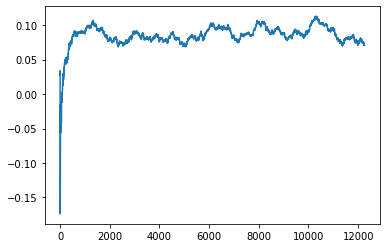

Thread: 5 iteration: 2120
RAM mDiffFit_346 FROM: 1088 --> 2816 reward: -0.10602342929687501
Thread: 6 iteration: 2057
RAM mDiffFit_121 FROM: 2944 --> 2944 reward: -0.0003749999999999934
Thread: 2 iteration: 2019
RAM mViewer_1 FROM: 320 --> 1216 reward: -0.3917306177812499
Thread: 1 iteration: 1976
RAM mDiffFit_209 FROM: 576 --> 2752 reward: -0.00832024414062502
Thread: 5 iteration: 2121
RAM mDiffFit_125 FROM: 1792 --> 2880 reward: 0.032989645312500024
Thread: 6 iteration: 2058
RAM mDiffFit_22 FROM: 2560 --> 2944 reward: -0.01852606171875
Saving ...


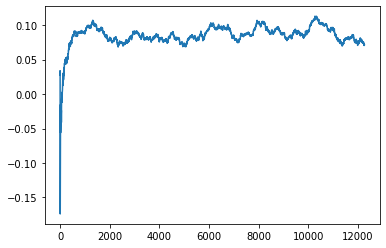

Thread: 2 iteration: 2020
RAM mProject_10 FROM: 1280 --> 704 reward: -1.0
Thread: 4 iteration: 2039
RAM mDiffFit_53 FROM: 2944 --> 1408 reward: -0.016536503906250007
Thread: 5 iteration: 2122
RAM mDiffFit_12 FROM: 1344 --> 2752 reward: 0.005507853515624994
Thread: 6 iteration: 2059
RAM mDiffFit_26 FROM: 2048 --> 1408 reward: -0.07327092812500002
Thread: 2 iteration: 2021
RAM mDiffFit_149 FROM: 704 --> 2752 reward: 0.00616935742187498
Saving ...


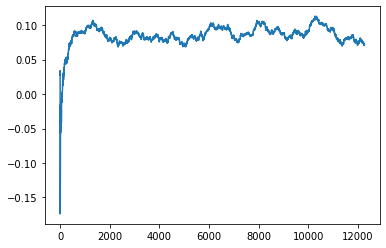

Thread: 4 iteration: 2040
RAM mAdd_3 FROM: 1408 --> 1216 reward: 0.011684867578125036
Thread: 1 iteration: 1977
RAM mProject_15 FROM: 1536 --> 1216 reward: 0.0925809371718751
Thread: 3 iteration: 2044
RAM mDiffFit_202 FROM: 1152 --> 2752 reward: -0.00010152695312501403
Thread: 5 iteration: 2123
RAM mDiffFit_260 FROM: 384 --> 2752 reward: -0.15907028789062502
Saving ...


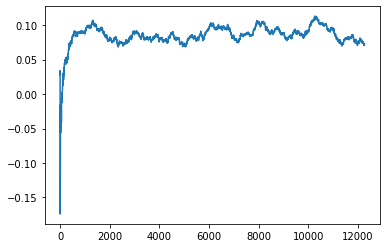

Thread: 6 iteration: 2060
RAM mDiffFit_149 FROM: 960 --> 2752 reward: -0.0010155757812500311
Thread: 2 iteration: 2022
RAM mDiffFit_376 FROM: 2496 --> 2944 reward: -0.04691150390624996
Thread: 4 iteration: 2041
RAM mDiffFit_221 FROM: 896 --> 2752 reward: 0.024984467968749997
Thread: 3 iteration: 2045
RAM mDiffFit_154 FROM: 192 --> 2752 reward: -0.20517699218750005
Thread: 5 iteration: 2124
RAM mDiffFit_220 FROM: 2560 --> 1408 reward: -0.018609424218749993
Thread: 2 iteration: 2023
RAM mDiffFit_117 FROM: 1088 --> 2816 reward: -0.07589061953124998
Thread: 3 iteration: 2046
RAM mDiffFit_272 FROM: 768 --> 2752 reward: -0.14889847304687504
Thread: 6 iteration: 2061
RAM mDiffFit_82 FROM: 2112 --> 2880 reward: 0.015625043750000008
Thread: 5 iteration: 2125
RAM mDiffFit_219 FROM: 1152 --> 2752 reward: 0.0035234730468749857
Thread: 3 iteration: 2047
RAM mDiffFit_171 FROM: 2880 --> 1408 reward: -0.011794313671875008
Thread: 2 iteration: 2024
RAM mDiffFit_156 FROM: 1344 --> 2880 reward: 0.0025391

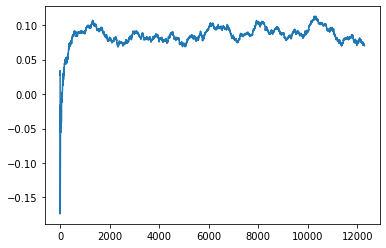

Thread: 1 iteration: 1980
RAM mDiffFit_254 FROM: 1344 --> 2752 reward: -0.014562478125000021
Thread: 6 iteration: 2064
RAM mViewer_2 FROM: 448 --> 1216 reward: -0.199323417046875
Saving ...


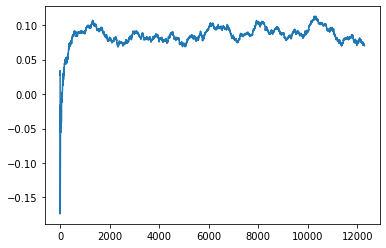

Thread: 3 iteration: 2050
RAM mProject_5 FROM: 832 --> 2688 reward: 0.76225029834375
Thread: 4 iteration: 2042
RAM mProject_35 FROM: 1728 --> 1216 reward: 0.12254108111718749
Thread: 5 iteration: 2127
RAM mBackground_35 FROM: 2240 --> 1216 reward: -0.008691916195312533
Thread: 2 iteration: 2027
RAM mDiffFit_165 FROM: 3008 --> 1408 reward: -0.14184139101562498
Thread: 1 iteration: 1981
RAM mDiffFit_203 FROM: 1728 --> 2880 reward: 0.05911727773437503
Thread: 3 iteration: 2051
RAM mDiffFit_116 FROM: 3008 --> 1408 reward: -0.003528694140625
Thread: 6 iteration: 2065
RAM mDiffFit_72 FROM: 192 --> 2944 reward: -0.299257766015625
Thread: 4 iteration: 2043
RAM mBackground_88 FROM: 320 --> 1216 reward: -0.40810358199218744
Thread: 5 iteration: 2128
RAM mDiffFit_161 FROM: 2368 --> 2944 reward: -0.070632897265625
Thread: 1 iteration: 1982
RAM mDiffFit_43 FROM: 2368 --> 2944 reward: 0.020781282812499993
Thread: 3 iteration: 2052
RAM mBackground_31 FROM: 1152 --> 1216 reward: 0.004519490140624962
T

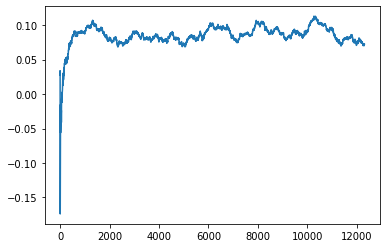

Thread: 2 iteration: 2030
RAM mDiffFit_154 FROM: 960 --> 2752 reward: 0.009820375390624985
Thread: 6 iteration: 2067
RAM mDiffFit_9 FROM: 3008 --> 1408 reward: -0.04582300781250001
Thread: 4 iteration: 2046
RAM mDiffFit_417 FROM: 2688 --> 1408 reward: -0.027708406249999998
Thread: 3 iteration: 2055
RAM mBackground_65 FROM: 384 --> 1216 reward: -0.44059774909375
Thread: 1 iteration: 1985
RAM mBackground_78 FROM: 2304 --> 1216 reward: 0.012962636218750006
Thread: 2 iteration: 2031
RAM mProject_42 FROM: 1024 --> 704 reward: -1.0
Thread: 5 iteration: 2129
RAM mDiffFit_64 FROM: 192 --> 2816 reward: -0.26076557578125004
Thread: 4 iteration: 2047
RAM mDiffFit_382 FROM: 2816 --> 704 reward: 0.04035666054687501
Thread: 6 iteration: 2068
RAM mDiffFit_192 FROM: 448 --> 2752 reward: -0.05748692539062499
Thread: 3 iteration: 2056
RAM mDiffFit_192 FROM: 384 --> 2752 reward: -0.14821090742187504
Saving ...


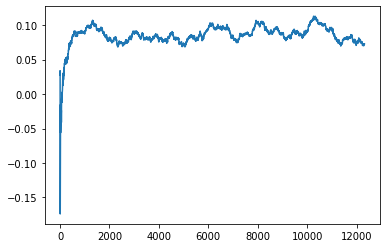

Thread: 5 iteration: 2130
RAM mDiffFit_201 FROM: 704 --> 2752 reward: -0.029856704296874984
Thread: 1 iteration: 1986
RAM mDiffFit_423 FROM: 2752 --> 2944 reward: 0.00560157070312501
Thread: 3 iteration: 2057
RAM mBackground_17 FROM: 960 --> 1216 reward: -0.015332163984374975
Thread: 4 iteration: 2048
RAM mBackground_35 FROM: 1280 --> 1216 reward: 0.026675696679687482
Thread: 6 iteration: 2069
RAM mDiffFit_109 FROM: 384 --> 2752 reward: -0.07778900507812503
Thread: 5 iteration: 2131
RAM mDiffFit_41 FROM: 2944 --> 704 reward: 0.010187434375000005
Thread: 1 iteration: 1987
RAM mDiffFit_71 FROM: 3008 --> 1408 reward: -0.11016163515624999
Thread: 3 iteration: 2058
RAM mDiffFit_195 FROM: 1344 --> 2944 reward: -0.009710907421874998
Saving ...


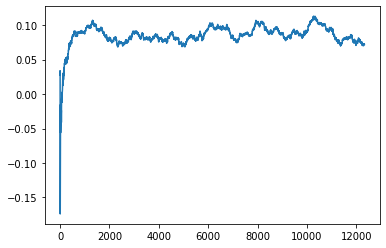

Thread: 6 iteration: 2070
RAM mDiffFit_329 FROM: 960 --> 2816 reward: -0.03844528789062499
Thread: 4 iteration: 2049
RAM mDiffFit_115 FROM: 1728 --> 2944 reward: 0.02447661445312499
Thread: 5 iteration: 2132
RAM mProject_52 FROM: 2560 --> 704 reward: -1.0
Thread: 2 iteration: 2032
RAM mDiffFit_146 FROM: 1536 --> 2944 reward: -0.05779690234374999
Thread: 1 iteration: 1988
RAM mDiffFit_314 FROM: 1024 --> 1216 reward: 0.017002632421875014
Saving ...


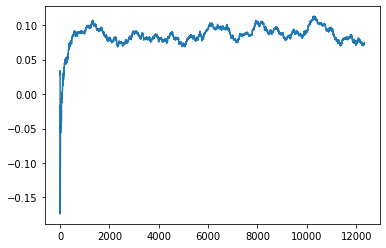

Thread: 4 iteration: 2050
RAM mDiffFit_389 FROM: 2304 --> 704 reward: 0.08825776601562499
Thread: 6 iteration: 2071
RAM mDiffFit_162 FROM: 832 --> 1216 reward: -0.007002588671874976
Thread: 5 iteration: 2133
RAM mDiffFit_152 FROM: 1728 --> 1216 reward: -0.0043333625000000105
Thread: 2 iteration: 2033
RAM mDiffFit_286 FROM: 2624 --> 1408 reward: -0.023385485937500033
Thread: 4 iteration: 2051
RAM mDiffFit_85 FROM: 768 --> 2752 reward: 0.012698007812500002
Thread: 6 iteration: 2072
RAM mDiffFit_42 FROM: 2048 --> 1408 reward: -0.010546902343750008
Thread: 5 iteration: 2134
RAM mProject_52 FROM: 1920 --> 1216 reward: 0.09749899195312497
Thread: 3 iteration: 2059
RAM mDiffFit_198 FROM: 2304 --> 1408 reward: -0.07333345
Thread: 2 iteration: 2034
RAM mDiffFit_372 FROM: 1088 --> 2816 reward: 0.0041693136718749975
Thread: 4 iteration: 2052
RAM mDiffFit_386 FROM: 2176 --> 2944 reward: -0.0020885398437499834
Thread: 6 iteration: 2073
RAM mProject_62 FROM: 704 --> 1216 reward: 0.7603468734375
Thre

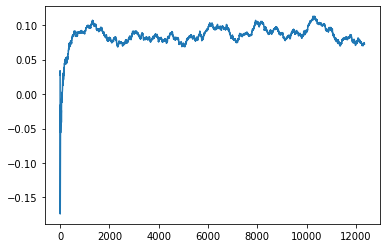

Thread: 1 iteration: 1990
RAM mAdd_2 FROM: 1984 --> 1216 reward: 0.03448688164062505
Thread: 4 iteration: 2053
RAM mDiffFit_119 FROM: 1728 --> 1408 reward: -0.065002676171875
Thread: 6 iteration: 2075
RAM mDiffFit_90 FROM: 2752 --> 1408 reward: -0.027781326562499997
Thread: 2 iteration: 2036
RAM mDiffFit_416 FROM: 1216 --> 896 reward: 0.135648516796875
Thread: 4 iteration: 2054
RAM mDiffFit_225 FROM: 1280 --> 896 reward: 0.10001566328125003
Thread: 1 iteration: 1991
RAM mProject_3 FROM: 640 --> 1216 reward: 0.74580998596875
Saving ...


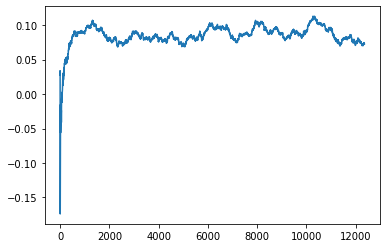

Thread: 3 iteration: 2060
RAM mDiffFit_27 FROM: 2560 --> 1408 reward: -0.006333362499999998
Thread: 6 iteration: 2076
RAM mProject_33 FROM: 1216 --> 704 reward: -1.0
Thread: 5 iteration: 2135
RAM mDiffFit_208 FROM: 1920 --> 2880 reward: 0.031382853515625
Thread: 4 iteration: 2055
RAM mDiffFit_175 FROM: 1728 --> 2880 reward: 0.0442188484375
Thread: 3 iteration: 2061
RAM mDiffFit_138 FROM: 1280 --> 2880 reward: -0.006174447265625011
Thread: 5 iteration: 2136
RAM mDiffFit_349 FROM: 320 --> 2752 reward: -0.08739053203125
Thread: 4 iteration: 2056
RAM mDiffFit_423 FROM: 384 --> 2752 reward: -0.0580519921875
Thread: 3 iteration: 2062
RAM mDiffFit_375 FROM: 2496 --> 1408 reward: -0.021083406249999964
Thread: 5 iteration: 2137
RAM mDiffFit_73 FROM: 448 --> 2752 reward: -0.07430203593750004
Thread: 4 iteration: 2057
RAM mDiffFit_178 FROM: 2944 --> 1408 reward: -0.00566150390624999
Thread: 3 iteration: 2063
RAM mDiffFit_334 FROM: 704 --> 2752 reward: -0.02980203593750003
Thread: 5 iteration: 213

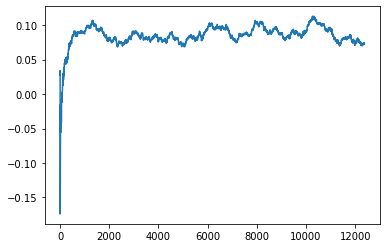

Thread: 5 iteration: 2140
RAM mBackground_88 FROM: 2304 --> 1216 reward: 0.0014287804843749821
Thread: 6 iteration: 2078
RAM mDiffFit_331 FROM: 1536 --> 896 reward: -0.012328185156250011
Thread: 3 iteration: 2065
RAM mProject_56 FROM: 2368 --> 1216 reward: 0.0068861616328123815
Thread: 4 iteration: 2058
RAM mBackground_77 FROM: 256 --> 1216 reward: -0.38606151660156246
Thread: 1 iteration: 1994
RAM mAdd_2 FROM: 832 --> 1216 reward: -0.2714857623046874
Thread: 2 iteration: 2038
RAM mDiffFit_199 FROM: 1280 --> 2752 reward: -0.035023429296875006
Thread: 5 iteration: 2141
RAM mDiffFit_102 FROM: 768 --> 896 reward: -0.020927079687499996
Thread: 6 iteration: 2079
RAM mDiffFit_272 FROM: 768 --> 2752 reward: -0.15502347304687503
Thread: 3 iteration: 2066
RAM mDiffFit_353 FROM: 1600 --> 2816 reward: 0.252674841015625
Thread: 1 iteration: 1995
RAM mDiffFit_361 FROM: 320 --> 2752 reward: -0.12501557578125
Thread: 5 iteration: 2142
RAM mDiffFit_91 FROM: 2240 --> 2944 reward: -0.007161460156250004


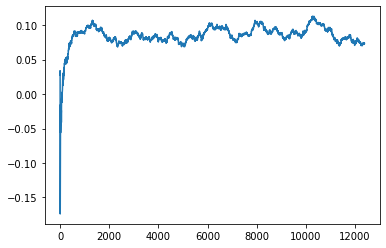

Thread: 6 iteration: 2080
RAM mDiffFit_330 FROM: 1856 --> 2880 reward: -0.0033411285156250033
Thread: 1 iteration: 1996
RAM mDiffFit_194 FROM: 2432 --> 2944 reward: 0.009437521875000007
Thread: 3 iteration: 2068
RAM mBackground_44 FROM: 1728 --> 1216 reward: 0.03958686559374999
Thread: 5 iteration: 2143
RAM mDiffFit_130 FROM: 1984 --> 1408 reward: 0.00166663750000004
Thread: 3 iteration: 2069
RAM mDiffFit_388 FROM: 1856 --> 1408 reward: -1.212980428125
Thread: 5 iteration: 2144
RAM mDiffFit_26 FROM: 2880 --> 1408 reward: -0.10944287421875001
Saving ...


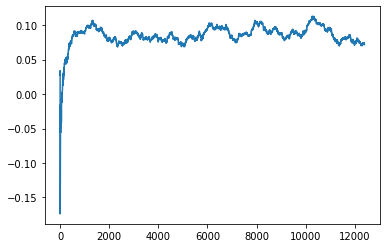

Thread: 3 iteration: 2070
RAM mProject_13 FROM: 2816 --> 704 reward: -1.0
Thread: 4 iteration: 2059
RAM mProject_49 FROM: 1088 --> 704 reward: -1.0
Thread: 2 iteration: 2039
RAM mDiffFit_195 FROM: 1792 --> 2880 reward: 0.0031067917968750046
Saving ...


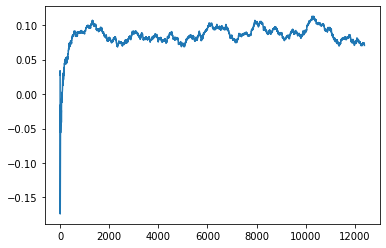

Thread: 2 iteration: 2040
RAM mDiffFit_302 FROM: 512 --> 896 reward: -0.05244787656249996
Saving ...


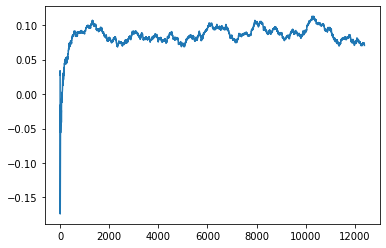

Thread: 4 iteration: 2060
RAM mProject_61 FROM: 2432 --> 1216 reward: 0.03586571929687481
Thread: 6 iteration: 2081
RAM mProject_43 FROM: 576 --> 1216 reward: 0.7483810828359375
Thread: 1 iteration: 1997
RAM mDiffFit_331 FROM: 1216 --> 1216 reward: 0.020908871484375008
Thread: 2 iteration: 2041
RAM mDiffFit_58 FROM: 320 --> 2816 reward: -0.22397393828125
Thread: 6 iteration: 2082
RAM mDiffFit_47 FROM: 1792 --> 2880 reward: 0.020242233984375003
Thread: 4 iteration: 2061
RAM mBackground_49 FROM: 2432 --> 1216 reward: -0.00210977685937503
Thread: 1 iteration: 1998
RAM mProject_83 FROM: 832 --> 1216 reward: 0.7608868734374999
Thread: 5 iteration: 2145
RAM mProject_89 FROM: 384 --> 2688 reward: 0.7792687565156251
Thread: 3 iteration: 2071
RAM mDiffFit_384 FROM: 2496 --> 2944 reward: 0.005320331640625026
Thread: 6 iteration: 2083
RAM mDiffFit_350 FROM: 2944 --> 704 reward: -0.045226701953125004
Thread: 2 iteration: 2042
RAM mDiffFit_333 FROM: 1792 --> 1408 reward: -0.08798446796875
Thread: 1

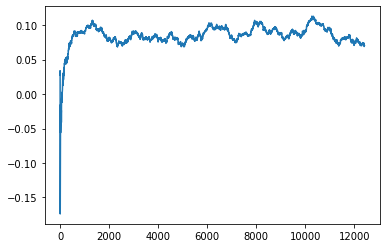

Thread: 1 iteration: 2000
RAM mDiffFit_299 FROM: 2240 --> 2944 reward: -0.014273429296875004
Thread: 3 iteration: 2073
RAM mBackground_68 FROM: 2816 --> 1216 reward: -0.017318819414062485
Thread: 4 iteration: 2063
RAM mDiffFit_324 FROM: 2944 --> 1408 reward: -0.010911503906250002
Thread: 4 iteration: 2064
RAM mDiffFit_335 FROM: 2560 --> 1408 reward: -0.05804176875000001
Thread: 4 iteration: 2065
RAM mProject_82 FROM: 2496 --> 704 reward: -1.0
Thread: 5 iteration: 2146
RAM mBackground_27 FROM: 2624 --> 1216 reward: 0.01983814607812492
Thread: 4 iteration: 2066
RAM mDiffFit_16 FROM: 2816 --> 1408 reward: -0.03872924687500001
Thread: 5 iteration: 2147
RAM mDiffFit_23 FROM: 2048 --> 2880 reward: 0.045406326562500016
Thread: 4 iteration: 2067
RAM mDiffFit_166 FROM: 2432 --> 2880 reward: -0.01362241132812499
Thread: 5 iteration: 2148
RAM mProject_87 FROM: 1216 --> 704 reward: -1.0
Thread: 2 iteration: 2043
RAM mDiffFit_245 FROM: 192 --> 2816 reward: -0.309242146484375
Thread: 4 iteration: 20

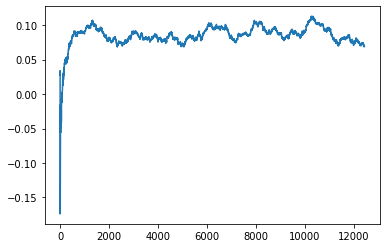

Thread: 4 iteration: 2070
RAM mDiffFit_67 FROM: 512 --> 2752 reward: -0.01917699218749999
Thread: 6 iteration: 2086
RAM mBackground_13 FROM: 1216 --> 1216 reward: 0.004407500000000022
Thread: 2 iteration: 2045
RAM mBackground_39 FROM: 512 --> 2688 reward: 0.29211817464062495
Thread: 1 iteration: 2003
RAM mDiffFit_389 FROM: 960 --> 2880 reward: 0.013484511718749974
Thread: 3 iteration: 2075
RAM mProject_48 FROM: 1728 --> 1216 reward: 0.1229348350546875
Saving ...


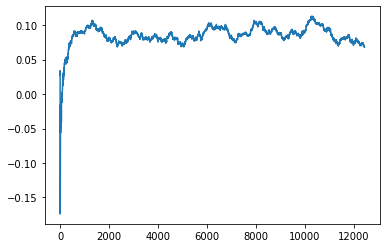

Thread: 5 iteration: 2150
RAM mDiffFit_122 FROM: 1600 --> 2880 reward: 0.0009505527343749848
Thread: 4 iteration: 2071
RAM mDiffFit_406 FROM: 1600 --> 2880 reward: -0.06835420312500001
Thread: 6 iteration: 2087
RAM mDiffFit_288 FROM: 576 --> 2752 reward: -0.004551992187499989
Thread: 1 iteration: 2004
RAM mDiffFit_155 FROM: 576 --> 2752 reward: -0.04150513359375002
Thread: 2 iteration: 2046
RAM mDiffFit_129 FROM: 768 --> 2816 reward: -0.07264584062500001
Thread: 3 iteration: 2076
RAM mDiffFit_190 FROM: 704 --> 2816 reward: -0.08898696914062498
Thread: 5 iteration: 2151
RAM mDiffFit_246 FROM: 768 --> 2880 reward: -0.021257766015625006
Thread: 4 iteration: 2072
RAM mDiffFit_310 FROM: 1792 --> 2880 reward: 0.016367233984375014
Thread: 6 iteration: 2088
RAM mDiffFit_305 FROM: 1792 --> 2880 reward: -0.0003932082031250089
Thread: 2 iteration: 2047
RAM mDiffFit_412 FROM: 2688 --> 2944 reward: -0.09157822890624999
Thread: 1 iteration: 2005
RAM mDiffFit_278 FROM: 448 --> 2752 reward: -0.0348567

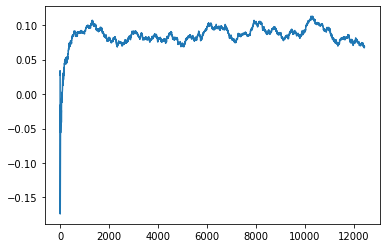

Thread: 6 iteration: 2090
RAM mDiffFit_186 FROM: 1536 --> 2816 reward: 0.0032812828124999943
Thread: 4 iteration: 2075
RAM mDiffFit_227 FROM: 1984 --> 2816 reward: 0.008273473046875
Thread: 4 iteration: 2076
RAM mProject_89 FROM: 2624 --> 704 reward: -1.0
Thread: 3 iteration: 2077
RAM mDiffFit_188 FROM: 2240 --> 896 reward: 0.041809889453125
Thread: 3 iteration: 2078
RAM mBackground_56 FROM: 1344 --> 1216 reward: 0.015285149195312485
Thread: 4 iteration: 2077
RAM mProject_60 FROM: 1472 --> 1216 reward: 0.07123733767968747
Thread: 2 iteration: 2049
RAM mDiffFit_47 FROM: 2688 --> 1408 reward: -0.007692742968750006
Thread: 3 iteration: 2079
RAM mProject_42 FROM: 1280 --> 704 reward: -1.0
Thread: 1 iteration: 2006
RAM mProject_74 FROM: 2048 --> 1216 reward: 0.09572897095312494
Thread: 6 iteration: 2091
RAM mDiffFit_352 FROM: 2752 --> 1408 reward: -0.012630264843750006
Saving ...


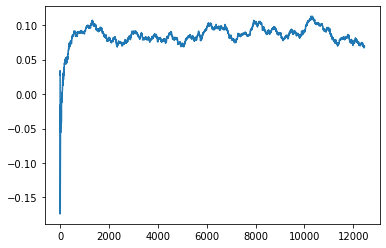

Thread: 2 iteration: 2050
RAM mProject_84 FROM: 2240 --> 1216 reward: 0.04199184766406265
Thread: 5 iteration: 2152
RAM mDiffFit_63 FROM: 2368 --> 2880 reward: 0.011062521875000002
Saving ...


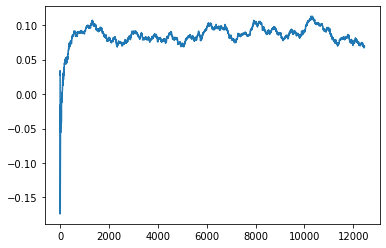

Thread: 3 iteration: 2080
RAM mDiffFit_59 FROM: 320 --> 896 reward: -0.22195050898437502
Thread: 1 iteration: 2007
RAM mDiffFit_199 FROM: 512 --> 2816 reward: -0.14565623906249997
Thread: 6 iteration: 2092
RAM mProject_48 FROM: 640 --> 1216 reward: 0.7610443734374999
Thread: 4 iteration: 2078
RAM mBackground_49 FROM: 2048 --> 1216 reward: 0.03476502464843753
Thread: 5 iteration: 2153
RAM mDiffFit_346 FROM: 1472 --> 1408 reward: 0.016130221093749973
Thread: 1 iteration: 2008
RAM mBackground_7 FROM: 1408 --> 1216 reward: -0.03228588350000003
Thread: 3 iteration: 2081
RAM mDiffFit_366 FROM: 2624 --> 2944 reward: 0.009335951171874999
Thread: 5 iteration: 2154
RAM mDiffFit_181 FROM: 1920 --> 1216 reward: -0.001643251953124987
Thread: 3 iteration: 2082
RAM mBackground_30 FROM: 1984 --> 1216 reward: -0.022059988328125002
Thread: 4 iteration: 2079
RAM mDiffFit_26 FROM: 1664 --> 1216 reward: -0.05242453476562499
Thread: 1 iteration: 2009
RAM mProject_49 FROM: 1600 --> 1216 reward: 0.09810467535

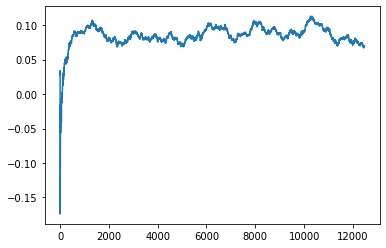

Thread: 4 iteration: 2080
RAM mProject_85 FROM: 2240 --> 1216 reward: 0.07126344724218742
Thread: 6 iteration: 2093
RAM mBgModel_3 FROM: 1344 --> 704 reward: 0.1854031239062501
Thread: 3 iteration: 2083
RAM mDiffFit_173 FROM: 1920 --> 2944 reward: 0.05083862734375
Saving ...


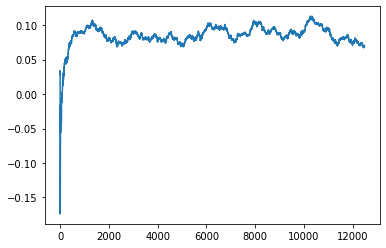

Thread: 1 iteration: 2010
RAM mBackground_25 FROM: 320 --> 1216 reward: -0.5363779852109374
Thread: 2 iteration: 2052
RAM mDiffFit_121 FROM: 2368 --> 1408 reward: -0.027218804687500018
Thread: 4 iteration: 2081
RAM mBackground_44 FROM: 1472 --> 1216 reward: 0.01515300985937502
Thread: 6 iteration: 2094
RAM mDiffFit_360 FROM: 384 --> 2944 reward: -0.29657814140625005
Thread: 3 iteration: 2084
RAM mDiffFit_151 FROM: 2560 --> 2944 reward: -0.020541681250000002
Thread: 1 iteration: 2011
RAM mBackground_56 FROM: 192 --> 1216 reward: -0.7245880345078125
Thread: 2 iteration: 2053
RAM mImgtbl_1 FROM: 2624 --> 1216 reward: 0.10215412437499999
Thread: 6 iteration: 2095
RAM mProject_86 FROM: 832 --> 1408 reward: -0.25772296071093753
Thread: 5 iteration: 2156
RAM mDiffFit_371 FROM: 896 --> 2816 reward: 0.0002552648437499985
Thread: 3 iteration: 2085
RAM mDiffFit_6 FROM: 960 --> 2816 reward: 0.03727873789062501
Thread: 2 iteration: 2054
RAM mBackground_72 FROM: 2880 --> 1216 reward: -0.026104727562

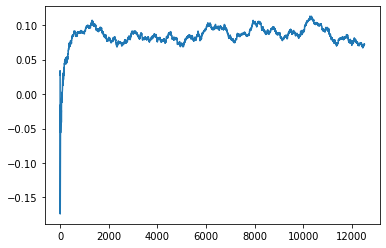

Thread: 6 iteration: 2100
RAM mBackground_59 FROM: 2880 --> 1216 reward: -0.03296235210937505
Thread: 3 iteration: 2088
RAM mProject_73 FROM: 2880 --> 704 reward: -1.0
Thread: 4 iteration: 2084
RAM mBackground_20 FROM: 3008 --> 1216 reward: -0.09464950442187504
Thread: 2 iteration: 2059
RAM mDiffFit_187 FROM: 1344 --> 2944 reward: -0.043958318749999975
Thread: 6 iteration: 2101
RAM mDiffFit_111 FROM: 1664 --> 2880 reward: 0.009627632421874994
Thread: 3 iteration: 2089
RAM mDiffFit_402 FROM: 192 --> 2944 reward: -0.33485933671874996
Saving ...


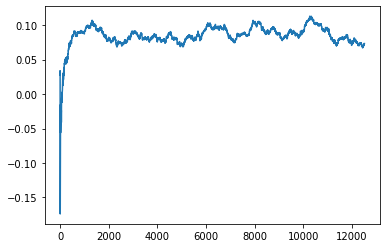

Thread: 2 iteration: 2060
RAM mBackground_46 FROM: 1664 --> 1216 reward: 0.007663818109374992
Thread: 4 iteration: 2085
RAM mProject_61 FROM: 2816 --> 704 reward: -1.0
Saving ...


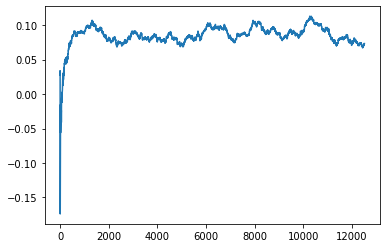

Thread: 5 iteration: 2160
RAM mDiffFit_295 FROM: 2880 --> 2944 reward: 0.0066171902343750005
Thread: 2 iteration: 2061
RAM mDiffFit_390 FROM: 1152 --> 1216 reward: 0.03989066328124999
Thread: 6 iteration: 2102
RAM mDiffFit_5 FROM: 1280 --> 2880 reward: -0.07089325195312497
Saving ...


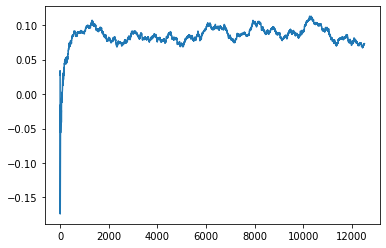

Thread: 3 iteration: 2090
RAM mDiffFit_233 FROM: 1600 --> 2944 reward: 0.03665373789062501
Thread: 5 iteration: 2161
RAM mBackground_82 FROM: 384 --> 1216 reward: -0.43389018682031244
Thread: 4 iteration: 2086
RAM mDiffFit_170 FROM: 3008 --> 1408 reward: -0.11241163515625
Thread: 6 iteration: 2103
RAM mDiffFit_261 FROM: 448 --> 2944 reward: -0.11868743437500001
Thread: 3 iteration: 2091
RAM mProject_79 FROM: 1280 --> 704 reward: -1.0
Thread: 1 iteration: 2017
RAM mBackground_73 FROM: 448 --> 1216 reward: -0.15962176569531258
Thread: 5 iteration: 2162
RAM mDiffFit_172 FROM: 2432 --> 2944 reward: 0.011437521874999995
Thread: 4 iteration: 2087
RAM mDiffFit_359 FROM: 1024 --> 2880 reward: 0.006031326562500015
Thread: 6 iteration: 2104
RAM mBackground_55 FROM: 1856 --> 1216 reward: 0.02763195251562497
Thread: 3 iteration: 2092
RAM mBackground_85 FROM: 1984 --> 1216 reward: 0.019439539437500014
Thread: 1 iteration: 2018
RAM mBackground_7 FROM: 2816 --> 1216 reward: -0.008826319414062525
Thre

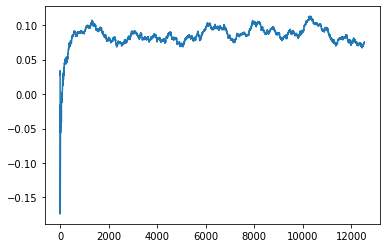

Thread: 1 iteration: 2020
RAM mBgModel_1 FROM: 2624 --> 1408 reward: -0.032186608906250025
Thread: 3 iteration: 2094
RAM mDiffFit_209 FROM: 2560 --> 1408 reward: -0.046838627343750015
Saving ...


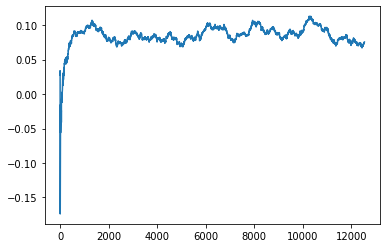

Thread: 4 iteration: 2090
RAM mDiffFit_27 FROM: 2688 --> 896 reward: -0.01202610546874999
Thread: 6 iteration: 2107
RAM mDiffFit_294 FROM: 256 --> 896 reward: -0.14026561953125
Thread: 3 iteration: 2095
RAM mDiffFit_215 FROM: 1152 --> 896 reward: -0.005989601562499999
Thread: 6 iteration: 2108
RAM mDiffFit_31 FROM: 128 --> 896 reward: -0.55942185859375
Thread: 4 iteration: 2091
RAM mProject_29 FROM: 960 --> 704 reward: -1.0
Thread: 5 iteration: 2164
RAM mDiffFit_172 FROM: 256 --> 2752 reward: -0.10898170429687501
Thread: 3 iteration: 2096
RAM mDiffFit_209 FROM: 2752 --> 2944 reward: -0.004148429296874975
Thread: 4 iteration: 2092
RAM mDiffFit_337 FROM: 1984 --> 2944 reward: 0.03851570703125005
Thread: 5 iteration: 2165
RAM mDiffFit_289 FROM: 2304 --> 1408 reward: -0.01864588437500002
Thread: 3 iteration: 2097
RAM mDiffFit_126 FROM: 2048 --> 1408 reward: -0.028276105468750014
Thread: 4 iteration: 2093
RAM mProject_88 FROM: 320 --> 1216 reward: 0.7610443734374999
Thread: 1 iteration: 202

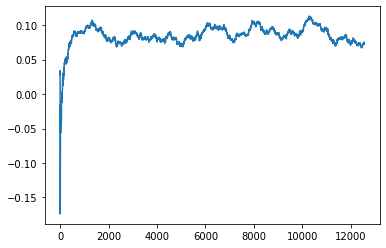

Thread: 6 iteration: 2110
RAM mViewer_3 FROM: 832 --> 1216 reward: -0.03293638038281245
Thread: 2 iteration: 2066
RAM mDiffFit_283 FROM: 2688 --> 1408 reward: -0.004067742968749989
Thread: 4 iteration: 2096
RAM mDiffFit_74 FROM: 256 --> 2816 reward: -0.17595818750000003
Thread: 5 iteration: 2168
RAM mDiffFit_68 FROM: 832 --> 2752 reward: -0.009382766015625012
Thread: 1 iteration: 2024
RAM mDiffFit_119 FROM: 1536 --> 2816 reward: 0.03158340624999999
Thread: 6 iteration: 2111
RAM mDiffFit_79 FROM: 1024 --> 2752 reward: -0.014585907421875016
Thread: 5 iteration: 2169
RAM mDiffFit_230 FROM: 1792 --> 2816 reward: -0.001510398437500008
Thread: 4 iteration: 2097
RAM mDiffFit_133 FROM: 448 --> 2752 reward: -0.04408064257812502
Thread: 1 iteration: 2025
RAM mBackground_54 FROM: 3008 --> 1216 reward: -0.02391665542968751
Thread: 6 iteration: 2112
RAM mProject_64 FROM: 2240 --> 1216 reward: 0.05381514351562502
Saving ...


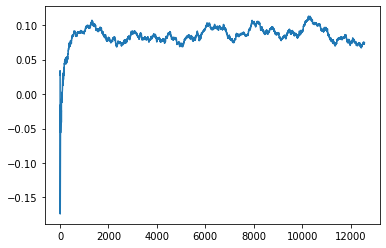

Thread: 3 iteration: 2100
RAM mDiffFit_79 FROM: 1280 --> 2752 reward: 0.018562565624999985
Thread: 4 iteration: 2098
RAM mBackground_37 FROM: 896 --> 1216 reward: -0.02393888038281251
Thread: 1 iteration: 2026
RAM mDiffFit_344 FROM: 2048 --> 2816 reward: -0.06346880468749999
Thread: 6 iteration: 2113
RAM mDiffFit_304 FROM: 2368 --> 2880 reward: -0.05228650390624999
Thread: 3 iteration: 2101
RAM mProject_39 FROM: 2880 --> 704 reward: -1.0
Thread: 2 iteration: 2067
RAM mBackground_77 FROM: 2112 --> 1216 reward: -0.0025464932578125113
Thread: 1 iteration: 2027
RAM mDiffFit_353 FROM: 1792 --> 2816 reward: 0.023625043749999994
Thread: 6 iteration: 2114
RAM mDiffFit_286 FROM: 2944 --> 1408 reward: -0.020786503906250007
Thread: 3 iteration: 2102
RAM mDiffFit_404 FROM: 640 --> 2752 reward: -0.07690882773437503
Thread: 1 iteration: 2028
RAM mBackground_66 FROM: 2816 --> 1216 reward: -0.020142948890625026
Thread: 2 iteration: 2068
RAM mDiffFit_365 FROM: 896 --> 2752 reward: 0.004763074609374987


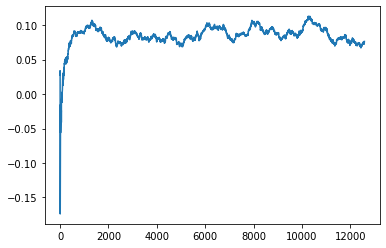

Thread: 5 iteration: 2170
RAM mDiffFit_171 FROM: 1792 --> 2880 reward: 0.022992233984375013
Thread: 1 iteration: 2029
RAM mProject_86 FROM: 1600 --> 1216 reward: 0.10763718848437492
Thread: 4 iteration: 2099
RAM mDiffFit_110 FROM: 2304 --> 2944 reward: 0.013104203124999995
Thread: 6 iteration: 2116
RAM mDiffFit_200 FROM: 640 --> 2816 reward: -0.11708849609374995
Thread: 5 iteration: 2171
RAM mDiffFit_30 FROM: 2560 --> 1408 reward: -0.03814070703125002
Saving ...


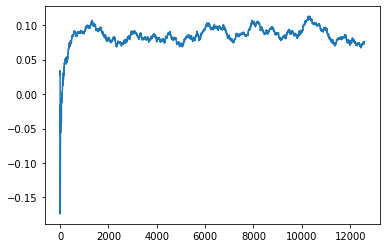

Thread: 1 iteration: 2030
RAM mDiffFit_259 FROM: 1344 --> 2880 reward: -0.005078097656250006
Saving ...


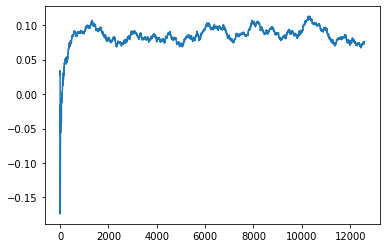

Thread: 4 iteration: 2100
RAM mDiffFit_246 FROM: 1728 --> 2880 reward: -0.019000000000000006
Thread: 1 iteration: 2031
RAM mDiffFit_72 FROM: 384 --> 2752 reward: -0.07403900507812503
Thread: 4 iteration: 2101
RAM mProject_2 FROM: 1408 --> 1216 reward: 0.061363123031250105
Thread: 3 iteration: 2103
RAM mBackground_90 FROM: 2688 --> 1216 reward: -0.0616447029140625
Thread: 6 iteration: 2117
RAM mProject_53 FROM: 2432 --> 1216 reward: 0.03475102556249996
Thread: 2 iteration: 2069
RAM mDiffFit_415 FROM: 2816 --> 2944 reward: 0.0003593804687500139
Thread: 5 iteration: 2172
RAM mDiffFit_200 FROM: 2176 --> 1408 reward: -0.03690632656249998
Thread: 1 iteration: 2032
RAM mDiffFit_334 FROM: 832 --> 2752 reward: 0.003416724999999992
Thread: 4 iteration: 2102
RAM mDiffFit_102 FROM: 1856 --> 1408 reward: 0.016156239062499987
Thread: 3 iteration: 2104
RAM mDiffFit_338 FROM: 1536 --> 2816 reward: 0.03045840624999999
Thread: 6 iteration: 2118
RAM mDiffFit_291 FROM: 2944 --> 1408 reward: -0.02044800781

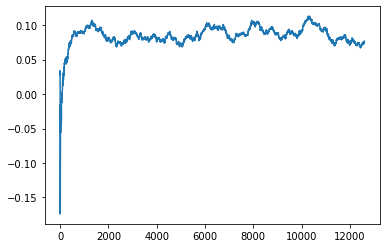

Thread: 2 iteration: 2070
RAM mDiffFit_419 FROM: 1344 --> 2816 reward: -0.05621095117187501
Thread: 1 iteration: 2033
RAM mDiffFit_161 FROM: 256 --> 2752 reward: -0.121729071875
Thread: 3 iteration: 2105
RAM mDiffFit_161 FROM: 2688 --> 2880 reward: 0.006351570703125014
Thread: 5 iteration: 2174
RAM mDiffFit_172 FROM: 704 --> 2816 reward: -0.16003909257812501
Thread: 2 iteration: 2071
RAM mBackground_54 FROM: 1792 --> 1216 reward: 0.050589937726562485
Thread: 4 iteration: 2103
RAM mDiffFit_335 FROM: 1856 --> 2944 reward: -0.0040989382812499885
Thread: 3 iteration: 2106
RAM mDiffFit_247 FROM: 2816 --> 1408 reward: -0.04047924687499999
Thread: 5 iteration: 2175
RAM mDiffFit_20 FROM: 1856 --> 2944 reward: 0.07719805156250001
Thread: 4 iteration: 2104
RAM mDiffFit_360 FROM: 1600 --> 2880 reward: 0.003450552734374987
Thread: 3 iteration: 2107
RAM mDiffFit_258 FROM: 2624 --> 2944 reward: -0.027820331640624994
Thread: 5 iteration: 2176
RAM mDiffFit_23 FROM: 960 --> 2816 reward: -0.074026017968

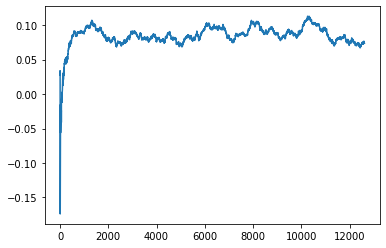

Thread: 6 iteration: 2120
RAM mProject_36 FROM: 1600 --> 1216 reward: 0.7647629703046877
Thread: 1 iteration: 2034
RAM mDiffFit_201 FROM: 2176 --> 2944 reward: -0.04311460156250001
Thread: 3 iteration: 2109
RAM mDiffFit_294 FROM: 320 --> 2880 reward: -0.16924214648437502
Thread: 4 iteration: 2107
RAM mDiffFit_137 FROM: 1728 --> 2880 reward: 0.001179712109374998
Thread: 5 iteration: 2178
RAM mProject_13 FROM: 1344 --> 640 reward: -1.0
Thread: 2 iteration: 2072
RAM mDiffFit_50 FROM: 384 --> 1408 reward: -0.23553646015624996
Thread: 1 iteration: 2035
RAM mDiffFit_84 FROM: 2048 --> 2880 reward: 0.11904703359374999
Thread: 6 iteration: 2121
RAM mDiffFit_45 FROM: 2240 --> 1408 reward: -0.07497406953124999
Thread: 4 iteration: 2108
RAM mDiffFit_11 FROM: 320 --> 896 reward: -0.18406511054687497
Thread: 5 iteration: 2179
RAM mDiffFit_291 FROM: 2048 --> 1408 reward: -0.03702610546875
Thread: 2 iteration: 2073
RAM mDiffFit_352 FROM: 448 --> 2752 reward: -0.0801770359375
Thread: 1 iteration: 2036


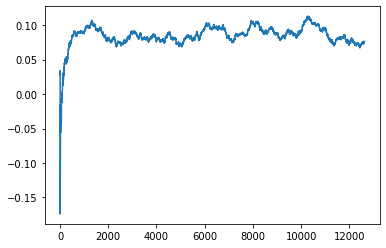

Thread: 3 iteration: 2110
RAM mDiffFit_289 FROM: 2560 --> 2944 reward: -0.05088026484375001
Thread: 4 iteration: 2109
RAM mDiffFit_64 FROM: 2944 --> 2880 reward: -0.011742190234375009
Thread: 2 iteration: 2074
RAM mDiffFit_107 FROM: 2176 --> 2880 reward: -0.033937521875000015
Thread: 1 iteration: 2037
RAM mDiffFit_20 FROM: 448 --> 2816 reward: -0.14866659375000002
Thread: 6 iteration: 2123
RAM mBackground_14 FROM: 2432 --> 1216 reward: 0.06798924104687502
Thread: 3 iteration: 2111
RAM mDiffFit_198 FROM: 128 --> 1408 reward: -0.7838906632812499
Thread: 2 iteration: 2075
RAM mDiffFit_103 FROM: 256 --> 2752 reward: -0.11373170429687503
Thread: 6 iteration: 2124
RAM mDiffFit_241 FROM: 320 --> 2816 reward: -0.25040623906250004
Thread: 3 iteration: 2112
RAM mProject_39 FROM: 896 --> 1408 reward: -0.3646745029687501
Saving ...


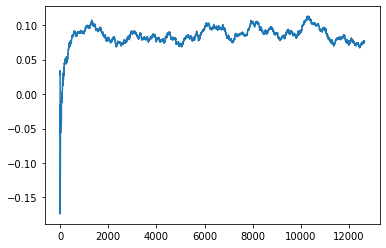

Thread: 5 iteration: 2180
RAM mDiffFit_272 FROM: 832 --> 2816 reward: -0.12156252187500001
Thread: 2 iteration: 2076
RAM mDiffFit_16 FROM: 1856 --> 2944 reward: -0.07237504375
Thread: 6 iteration: 2125
RAM mBackground_12 FROM: 2624 --> 1216 reward: -0.025285025953125016
Thread: 5 iteration: 2181
RAM mDiffFit_122 FROM: 1920 --> 2880 reward: 0.027218804687500018
Thread: 2 iteration: 2077
RAM mDiffFit_167 FROM: 2752 --> 2944 reward: 0.008851570703125016
Thread: 6 iteration: 2126
RAM mProject_46 FROM: 2048 --> 1216 reward: 0.0834547353046876
Saving ...


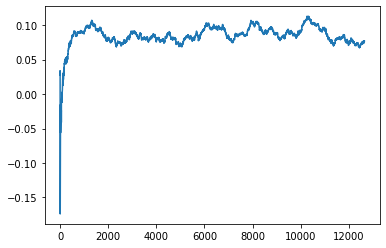

Thread: 4 iteration: 2110
RAM mProject_52 FROM: 576 --> 1216 reward: 0.752504679703125
Thread: 1 iteration: 2038
RAM mDiffFit_369 FROM: 1536 --> 2816 reward: -0.0008437171875000024
Thread: 2 iteration: 2078
RAM mDiffFit_30 FROM: 512 --> 896 reward: -0.04956769921875001
Thread: 1 iteration: 2039
RAM mDiffFit_307 FROM: 1792 --> 896 reward: 0.17591154765625
Thread: 6 iteration: 2127
RAM mDiffFit_234 FROM: 1792 --> 2816 reward: 0.024500043749999992
Thread: 2 iteration: 2079
RAM mDiffFit_214 FROM: 1984 --> 2880 reward: 0.024395884375000027
Thread: 6 iteration: 2128
RAM mProject_87 FROM: 2304 --> 1216 reward: 0.04827591049218736
Thread: 5 iteration: 2182
RAM mProject_55 FROM: 2560 --> 640 reward: -1.0
Thread: 3 iteration: 2113
RAM mDiffFit_343 FROM: 1792 --> 2816 reward: -0.035270840624999994
Thread: 6 iteration: 2129
RAM mDiffFit_272 FROM: 512 --> 2752 reward: -0.092210907421875
Thread: 3 iteration: 2114
RAM mDiffFit_338 FROM: 1024 --> 2752 reward: 0.00045577382812498485
Saving ...


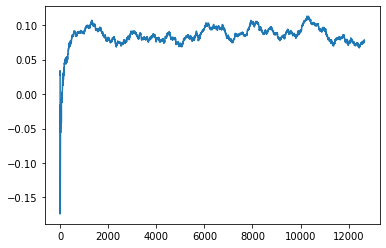

Thread: 6 iteration: 2130
RAM mBackground_75 FROM: 448 --> 1728 reward: -0.1702910936640625
Thread: 5 iteration: 2183
RAM mProject_44 FROM: 256 --> 1216 reward: 0.7636379703046876
Saving ...


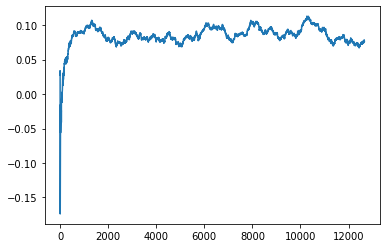

Thread: 1 iteration: 2040
RAM mDiffFit_326 FROM: 896 --> 2752 reward: -0.035497367578125036
Thread: 6 iteration: 2131
RAM mDiffFit_411 FROM: 1152 --> 2816 reward: 0.032562609375000016
Thread: 3 iteration: 2115
RAM mDiffFit_192 FROM: 1472 --> 896 reward: 0.02533073007812501
Thread: 5 iteration: 2184
RAM mProject_84 FROM: 2880 --> 704 reward: -1.0
Thread: 4 iteration: 2111
RAM mDiffFit_23 FROM: 2048 --> 896 reward: -0.015135485937500005
Thread: 1 iteration: 2041
RAM mDiffFit_3 FROM: 1984 --> 2944 reward: 0.02696880468750001
Thread: 6 iteration: 2132
RAM mBackground_72 FROM: 1920 --> 1728 reward: 0.011831716398437478
Thread: 3 iteration: 2116
RAM mBackground_47 FROM: 2432 --> 1728 reward: -0.046993271929687504
Thread: 5 iteration: 2185
RAM mViewer_4 FROM: 2560 --> 1216 reward: 0.09843095599218744
Thread: 4 iteration: 2112
RAM mDiffFit_135 FROM: 256 --> 2752 reward: -0.131627544921875
Thread: 6 iteration: 2133
RAM mDiffFit_86 FROM: 3008 --> 2944 reward: -0.0032421902343749906
Thread: 3 ite

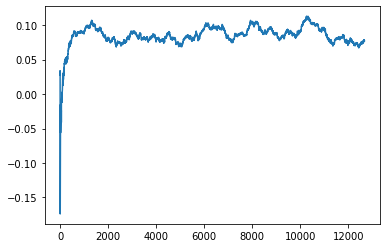

Thread: 2 iteration: 2080
RAM mDiffFit_47 FROM: 640 --> 2752 reward: -0.05110152695312502
Thread: 6 iteration: 2135
RAM mDiffFit_127 FROM: 2112 --> 2944 reward: 0.023023473046875013
Thread: 2 iteration: 2081
RAM mDiffFit_358 FROM: 1152 --> 2816 reward: 0.04977092812499999
Thread: 3 iteration: 2119
RAM mDiffFit_158 FROM: 1216 --> 2176 reward: 0.08758345000000003
Thread: 5 iteration: 2188
RAM mBackground_44 FROM: 3008 --> 1728 reward: -0.11807329788281246
Thread: 1 iteration: 2044
RAM mDiffFit_64 FROM: 2560 --> 1408 reward: -0.000833362499999997
Thread: 2 iteration: 2082
RAM mBackground_75 FROM: 384 --> 1216 reward: -0.24494318370312493
Saving ...


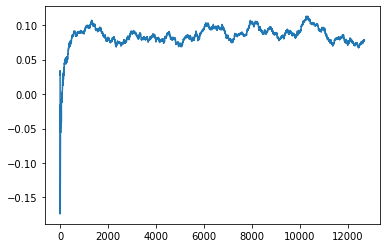

Thread: 3 iteration: 2120
RAM mBackground_44 FROM: 1472 --> 1728 reward: 0.017370249093749967
Thread: 5 iteration: 2189
RAM mBackground_25 FROM: 2112 --> 1728 reward: -0.02983130643749992
Thread: 1 iteration: 2045
RAM mDiffFit_296 FROM: 2944 --> 2880 reward: 0.05439851679687502
Thread: 2 iteration: 2083
RAM mBackground_20 FROM: 1088 --> 1728 reward: -0.0404043033203125
Saving ...


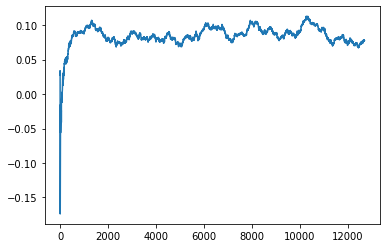

Thread: 5 iteration: 2190
RAM mDiffFit_268 FROM: 2560 --> 2944 reward: 0.007328141406250013
Thread: 2 iteration: 2084
RAM mDiffFit_68 FROM: 1152 --> 2816 reward: 0.026192786718749993
Thread: 1 iteration: 2046
RAM mProject_19 FROM: 2880 --> 704 reward: -1.0
Thread: 4 iteration: 2114
RAM mDiffFit_296 FROM: 2496 --> 896 reward: 0.057846349609375014
Thread: 5 iteration: 2191
RAM mDiffFit_263 FROM: 2816 --> 1408 reward: -0.0025521234375000014
Thread: 1 iteration: 2047
RAM mDiffFit_232 FROM: 1920 --> 2880 reward: 0.026468804687500014
Thread: 5 iteration: 2192
RAM mBackground_39 FROM: 2048 --> 1728 reward: 0.017477711468750035
Thread: 4 iteration: 2115
RAM mProject_11 FROM: 1280 --> 704 reward: -1.0
Thread: 6 iteration: 2136
RAM mDiffFit_15 FROM: 320 --> 2880 reward: -0.08589834179687499
Thread: 5 iteration: 2193
RAM mDiffFit_88 FROM: 2752 --> 2944 reward: 0.012328141406250034
Thread: 4 iteration: 2116
RAM mDiffFit_372 FROM: 1088 --> 2880 reward: 0.00841150390625
Thread: 6 iteration: 2137
RAM

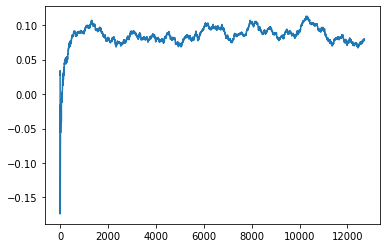

Thread: 6 iteration: 2140
RAM mProject_36 FROM: 2624 --> 640 reward: -1.0
Thread: 5 iteration: 2194
RAM mDiffFit_49 FROM: 1536 --> 2816 reward: -0.005791637500000002
Thread: 2 iteration: 2087
RAM mDiffFit_68 FROM: 704 --> 2752 reward: 0.028612056640624987
Thread: 3 iteration: 2124
RAM mDiffFit_17 FROM: 2688 --> 1408 reward: -0.0259688046875
Thread: 6 iteration: 2141
RAM mDiffFit_327 FROM: 3008 --> 896 reward: -0.012765707031250004
Thread: 5 iteration: 2195
RAM mDiffFit_311 FROM: 1088 --> 2752 reward: 0.0011771234374999794
Thread: 2 iteration: 2088
RAM mDiffFit_407 FROM: 1600 --> 896 reward: 0.010320287890625002
Thread: 6 iteration: 2142
RAM mProject_86 FROM: 2048 --> 1728 reward: -0.024409767234375067
Saving ...


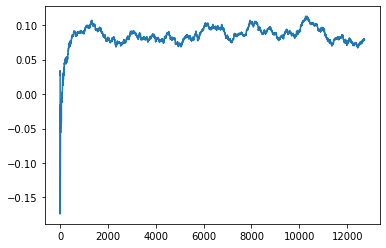

Thread: 4 iteration: 2120
RAM mDiffFit_289 FROM: 1472 --> 2752 reward: -0.07020836249999997
Thread: 3 iteration: 2125
RAM mDiffFit_398 FROM: 1152 --> 2752 reward: 0.021619866406249987
Thread: 2 iteration: 2089
RAM mBackground_79 FROM: 2048 --> 1728 reward: -0.04871772444531252
Thread: 5 iteration: 2196
RAM mDiffFit_219 FROM: 2432 --> 896 reward: -0.055062609375
Thread: 3 iteration: 2126
RAM mDiffFit_123 FROM: 1856 --> 896 reward: 0.007627588671875012
Thread: 5 iteration: 2197
RAM mBackground_65 FROM: 1280 --> 1728 reward: -0.007643668914062466
Saving ...


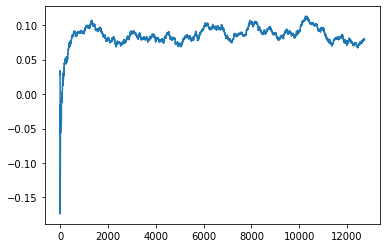

Thread: 2 iteration: 2090
RAM mProject_38 FROM: 2944 --> 704 reward: -1.0
Thread: 1 iteration: 2049
RAM mDiffFit_184 FROM: 2240 --> 896 reward: 0.028429668359375004
Thread: 3 iteration: 2127
RAM mDiffFit_202 FROM: 2112 --> 896 reward: -0.016130264843750002
Thread: 5 iteration: 2198
RAM mDiffFit_144 FROM: 2688 --> 2944 reward: 0.07414592812500001
Saving ...


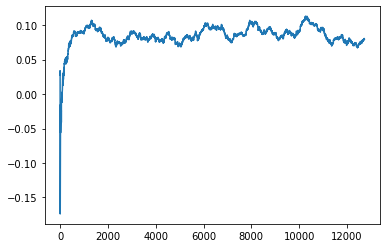

Thread: 1 iteration: 2050
RAM mDiffFit_102 FROM: 2560 --> 1408 reward: -0.02639592812500001
Thread: 2 iteration: 2091
RAM mProject_56 FROM: 1472 --> 1216 reward: 0.08628797383593752
Thread: 6 iteration: 2143
RAM mProject_85 FROM: 960 --> 1408 reward: -0.18520078535156262
Thread: 4 iteration: 2121
RAM mDiffFit_125 FROM: 3008 --> 2944 reward: -0.03541150390625001
Thread: 3 iteration: 2128
RAM mDiffFit_211 FROM: 2112 --> 2880 reward: 0.020375043750000023
Thread: 1 iteration: 2051
RAM mDiffFit_204 FROM: 1344 --> 2816 reward: 0.080229290625
Thread: 6 iteration: 2144
RAM mDiffFit_102 FROM: 960 --> 2816 reward: -0.009166550000000023
Thread: 4 iteration: 2122
RAM mDiffFit_144 FROM: 1600 --> 896 reward: 0.009208318749999982
Thread: 3 iteration: 2129
RAM mDiffFit_71 FROM: 1856 --> 2816 reward: 0.32043791562500007
Thread: 4 iteration: 2123
RAM mBackground_1 FROM: 2240 --> 1728 reward: 0.006203606640624982
Thread: 6 iteration: 2145
RAM mDiffFit_37 FROM: 2624 --> 2944 reward: -0.021973982031250026


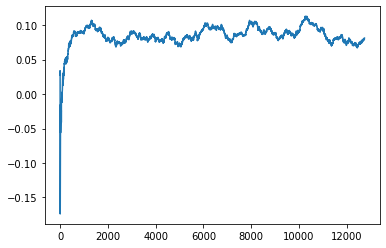

Thread: 3 iteration: 2130
RAM mProject_1 FROM: 512 --> 1728 reward: 0.649797834234375
Thread: 5 iteration: 2199
RAM mProject_8 FROM: 1408 --> 1728 reward: -0.06762796333593751
Thread: 2 iteration: 2092
RAM mDiffFit_334 FROM: 768 --> 2752 reward: 0.0029453753906249873
Thread: 4 iteration: 2124
RAM mDiffFit_30 FROM: 2816 --> 2944 reward: 0.026822964062499996
Thread: 6 iteration: 2146
RAM mProject_7 FROM: 2048 --> 1728 reward: -0.009879908554687455
Thread: 1 iteration: 2052
RAM mDiffFit_362 FROM: 128 --> 896 reward: -0.6085312828125
Thread: 3 iteration: 2131
RAM mDiffFit_123 FROM: 320 --> 2752 reward: -0.18938017734375004
Thread: 2 iteration: 2093
RAM mBackground_64 FROM: 3008 --> 1728 reward: 0.0022126362187499956
Saving ...


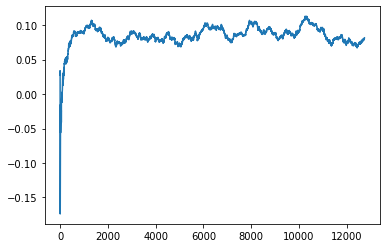

Thread: 5 iteration: 2200
RAM mDiffFit_144 FROM: 1216 --> 2752 reward: 0.004153694140625001
Thread: 4 iteration: 2125
RAM mDiffFit_101 FROM: 2432 --> 896 reward: -0.03755738828125002
Thread: 3 iteration: 2132
RAM mDiffFit_288 FROM: 704 --> 896 reward: -0.14965632656250002
Thread: 1 iteration: 2053
RAM mBackground_60 FROM: 1152 --> 1728 reward: -0.03798779839062496
Thread: 2 iteration: 2094
RAM mBackground_48 FROM: 2176 --> 1728 reward: -0.05070649325781252
Thread: 5 iteration: 2201
RAM mDiffFit_210 FROM: 2368 --> 2816 reward: -0.05058858359375
Thread: 3 iteration: 2133
RAM mDiffFit_171 FROM: 1408 --> 2752 reward: 0.05430738828125
Thread: 2 iteration: 2095
RAM mDiffFit_20 FROM: 704 --> 2752 reward: -0.07011710273437499
Thread: 1 iteration: 2054
RAM mDiffFit_192 FROM: 1344 --> 2752 reward: -0.05707814140625002
Thread: 4 iteration: 2126
RAM mDiffFit_125 FROM: 1472 --> 2752 reward: -0.006262987109375024
Thread: 5 iteration: 2202
RAM mDiffFit_134 FROM: 256 --> 2752 reward: -0.17622130585937

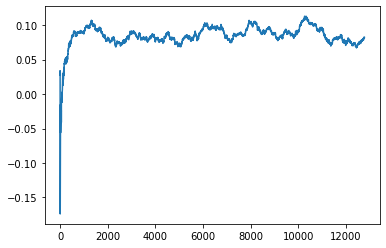

Thread: 6 iteration: 2150
RAM mProject_67 FROM: 1216 --> 640 reward: -1.0
Thread: 3 iteration: 2134
RAM mProject_7 FROM: 576 --> 1216 reward: 0.7646729703046875
Thread: 2 iteration: 2097
RAM mDiffFit_160 FROM: 128 --> 1408 reward: -0.44194269921875
Thread: 1 iteration: 2059
RAM mDiffFit_18 FROM: 2240 --> 1408 reward: -0.012648473046875004
Thread: 5 iteration: 2206
RAM mDiffFit_318 FROM: 2944 --> 2944 reward: -0.023338583593749997
Thread: 6 iteration: 2151
RAM mDiffFit_153 FROM: 3008 --> 2944 reward: -0.0032421902343749906
Thread: 3 iteration: 2135
RAM mDiffFit_280 FROM: 2048 --> 2880 reward: 0.019648473046874997
Thread: 2 iteration: 2098
RAM mProject_4 FROM: 2752 --> 640 reward: -1.0
Thread: 4 iteration: 2128
RAM mDiffFit_343 FROM: 896 --> 2752 reward: 0.022268295703124975
Thread: 6 iteration: 2152
RAM mDiffFit_149 FROM: 1856 --> 2944 reward: 0.0009010617187499986
Thread: 3 iteration: 2136
RAM mBackground_84 FROM: 2624 --> 1728 reward: -0.0685313816875
Thread: 5 iteration: 2207
RAM mBa

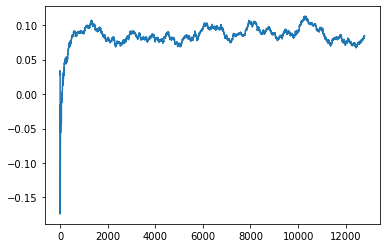

Thread: 4 iteration: 2130
RAM mDiffFit_150 FROM: 2624 --> 1408 reward: -0.007575552734375018
Thread: 6 iteration: 2154
RAM mDiffFit_295 FROM: 640 --> 2752 reward: -0.024611925390625004
Thread: 4 iteration: 2131
RAM mProject_14 FROM: 2624 --> 1216 reward: -0.007598270460937362
Thread: 2 iteration: 2099
RAM mDiffFit_105 FROM: 1152 --> 2752 reward: 0.007976614453124985
Thread: 6 iteration: 2155
RAM mDiffFit_40 FROM: 2432 --> 896 reward: 0.021203097656249982
Thread: 4 iteration: 2132
RAM mDiffFit_43 FROM: 512 --> 2496 reward: -0.0210936734375
Saving ...


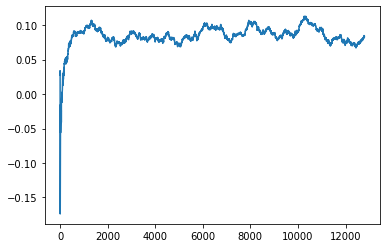

Thread: 2 iteration: 2100
RAM mDiffFit_334 FROM: 2240 --> 2816 reward: 0.014679712109375003
Thread: 6 iteration: 2156
RAM mProject_38 FROM: 832 --> 1216 reward: 0.7646729703046875
Thread: 5 iteration: 2208
RAM mDiffFit_279 FROM: 512 --> 896 reward: -0.10621353984374995
Thread: 4 iteration: 2133
RAM mProject_11 FROM: 512 --> 1216 reward: 0.35865278655468763
Thread: 3 iteration: 2138
RAM mDiffFit_389 FROM: 896 --> 2816 reward: 0.002052210937499993
Thread: 2 iteration: 2101
RAM mDiffFit_237 FROM: 2112 --> 2816 reward: 0.015539092578125014
Thread: 5 iteration: 2209
RAM mDiffFit_373 FROM: 384 --> 2752 reward: -0.06141400507812504
Thread: 3 iteration: 2139
RAM mDiffFit_44 FROM: 1472 --> 896 reward: -0.005877632421875008
Thread: 2 iteration: 2102
RAM mDiffFit_44 FROM: 2944 --> 1408 reward: -0.010911503906250002
Saving ...


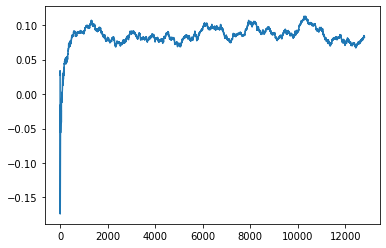

Thread: 5 iteration: 2210
RAM mDiffFit_321 FROM: 1472 --> 2816 reward: 0.009049534765624995
Saving ...


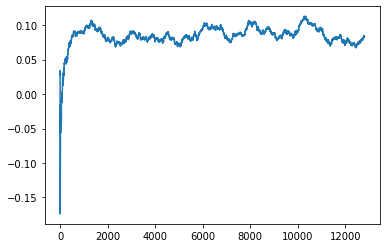

Thread: 3 iteration: 2140
RAM mProject_39 FROM: 384 --> 1024 reward: 0.8568756326250001
Saving ...


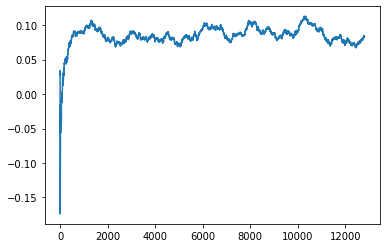

Thread: 1 iteration: 2060
RAM mDiffFit_404 FROM: 2880 --> 2944 reward: 0.006492190234374997
Thread: 5 iteration: 2211
RAM mProject_29 FROM: 448 --> 1216 reward: 0.7654379703046875
Thread: 4 iteration: 2134
RAM mDiffFit_229 FROM: 512 --> 2752 reward: -0.149023429296875
Thread: 3 iteration: 2141
RAM mDiffFit_54 FROM: 1088 --> 2816 reward: -0.05689320820312502
Thread: 1 iteration: 2061
RAM mDiffFit_203 FROM: 2816 --> 1408 reward: -0.016578185156249994
Thread: 5 iteration: 2212
RAM mProject_82 FROM: 2752 --> 640 reward: -1.0
Thread: 6 iteration: 2157
RAM mProject_41 FROM: 1664 --> 1728 reward: -0.017448287976562494
Thread: 2 iteration: 2103
RAM mDiffFit_404 FROM: 2496 --> 2880 reward: -0.024320331640624998
Thread: 4 iteration: 2135
RAM mDiffFit_92 FROM: 1088 --> 2752 reward: 0.002802123437499974
Thread: 3 iteration: 2142
RAM mDiffFit_32 FROM: 2880 --> 1408 reward: -0.014169313671874989
Thread: 5 iteration: 2213
RAM mDiffFit_162 FROM: 2048 --> 896 reward: -0.12251579453125
Thread: 6 iterati

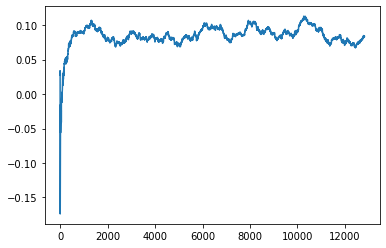

Thread: 6 iteration: 2160
RAM mProject_71 FROM: 1600 --> 1728 reward: -0.011369047078125038
Thread: 2 iteration: 2104
RAM mBackground_31 FROM: 1280 --> 1728 reward: -0.05964684094531249
Thread: 5 iteration: 2216
RAM mProject_17 FROM: 2048 --> 1728 reward: -0.03884446884375
Thread: 3 iteration: 2143
RAM mDiffFit_128 FROM: 3008 --> 1408 reward: -0.031679755859375
Thread: 2 iteration: 2105
RAM mProject_18 FROM: 256 --> 1280 reward: 0.7582450148437502
Thread: 4 iteration: 2136
RAM mProject_32 FROM: 2880 --> 640 reward: -1.0
Thread: 1 iteration: 2062
RAM mDiffFit_298 FROM: 320 --> 2752 reward: -0.14004422617187504
Thread: 3 iteration: 2144
RAM mDiffFit_220 FROM: 320 --> 2752 reward: -0.08938008984375001
Thread: 2 iteration: 2106
RAM mBackground_55 FROM: 2176 --> 1728 reward: -0.06559748832812495
Thread: 4 iteration: 2137
RAM mProject_78 FROM: 2304 --> 1728 reward: -0.06807673082812506
Thread: 5 iteration: 2217
RAM mDiffFit_181 FROM: 2048 --> 2816 reward: 0.026250043750000018
Thread: 3 itera

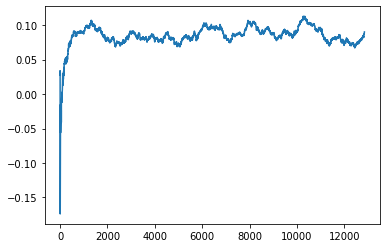

Thread: 4 iteration: 2140
RAM mDiffFit_369 FROM: 256 --> 2816 reward: -0.15253119531249998
Saving ...


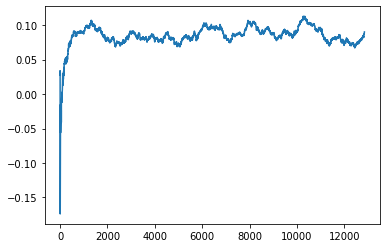

Thread: 5 iteration: 2220
RAM mDiffFit_348 FROM: 2944 --> 2944 reward: 0.03383858359375
Thread: 3 iteration: 2149
RAM mDiffFit_299 FROM: 2112 --> 2944 reward: -0.013015619531250005
Thread: 4 iteration: 2141
RAM mDiffFit_143 FROM: 768 --> 896 reward: -0.007427079687499991
Thread: 5 iteration: 2221
RAM mProject_51 FROM: 1984 --> 1728 reward: 0.009817463250000024
Thread: 1 iteration: 2066
RAM mDiffFit_81 FROM: 768 --> 896 reward: -0.0635312828125
Saving ...


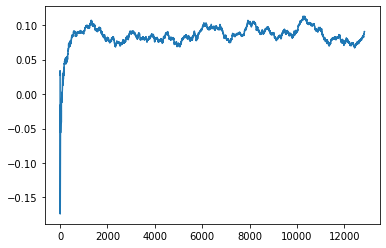

Thread: 3 iteration: 2150
RAM mDiffFit_342 FROM: 1984 --> 2880 reward: 0.05177351679687501
Thread: 5 iteration: 2222
RAM mProject_11 FROM: 1280 --> 640 reward: -1.0
Thread: 2 iteration: 2109
RAM mDiffFit_231 FROM: 1664 --> 2816 reward: 0.02993756562499998
Thread: 3 iteration: 2151
RAM mDiffFit_148 FROM: 256 --> 2752 reward: -0.1082811515625
Thread: 5 iteration: 2223
RAM mBackground_24 FROM: 768 --> 1728 reward: -0.07197119356249994
Thread: 1 iteration: 2067
RAM mDiffFit_230 FROM: 192 --> 2816 reward: -0.32335933671875006
Saving ...


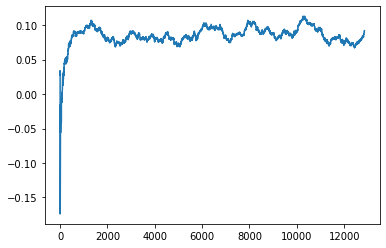

Thread: 2 iteration: 2110
RAM mProject_26 FROM: 2944 --> 640 reward: -1.0
Thread: 6 iteration: 2163
RAM mProject_71 FROM: 2112 --> 1728 reward: -0.01167195571874996
Thread: 4 iteration: 2142
RAM mDiffFit_126 FROM: 2112 --> 1408 reward: 0.006835907421875002
Thread: 3 iteration: 2152
RAM mDiffFit_201 FROM: 2240 --> 2816 reward: 0.010531282812499994
Thread: 5 iteration: 2224
RAM mDiffFit_225 FROM: 640 --> 2496 reward: -0.028137943359374997
Thread: 2 iteration: 2111
RAM mDiffFit_288 FROM: 2752 --> 2944 reward: 0.0006015707031250227
Thread: 6 iteration: 2164
RAM mDiffFit_389 FROM: 1088 --> 1792 reward: -0.013236925390625008
Thread: 4 iteration: 2143
RAM mDiffFit_350 FROM: 2048 --> 1792 reward: -0.0607813265625
Thread: 1 iteration: 2068
RAM mDiffFit_90 FROM: 2304 --> 1792 reward: -0.018500043749999986
Thread: 3 iteration: 2153
RAM mDiffFit_63 FROM: 1792 --> 2816 reward: 0.019500043750000008
Thread: 5 iteration: 2225
RAM mDiffFit_104 FROM: 1344 --> 2816 reward: -0.015820287890625003
Thread: 2

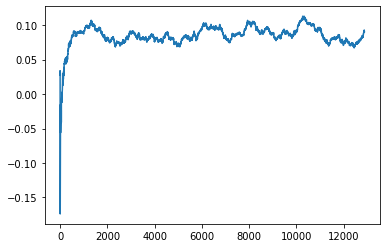

Thread: 1 iteration: 2070
RAM mDiffFit_422 FROM: 576 --> 2752 reward: -0.012676992187499996
Thread: 6 iteration: 2166
RAM mDiffFit_252 FROM: 2816 --> 1408 reward: -0.10348455546874996
Thread: 4 iteration: 2145
RAM mBackground_43 FROM: 896 --> 1728 reward: -0.12245370653906254
Thread: 5 iteration: 2227
RAM mDiffFit_292 FROM: 1408 --> 896 reward: 0.042432300781250015
Thread: 1 iteration: 2071
RAM mDiffFit_336 FROM: 1984 --> 2816 reward: -0.009979159374999998
Thread: 4 iteration: 2146
RAM mDiffFit_345 FROM: 320 --> 896 reward: -0.30704690234375
Thread: 6 iteration: 2167
RAM mDiffFit_178 FROM: 1088 --> 2752 reward: -0.026320287890625026
Thread: 5 iteration: 2228
RAM mDiffFit_86 FROM: 1600 --> 2752 reward: 0.026734424218749983
Thread: 1 iteration: 2072
RAM mDiffFit_262 FROM: 2880 --> 2944 reward: 0.0018671902343750033
Thread: 6 iteration: 2168
RAM mProject_89 FROM: 448 --> 1728 reward: 0.642240637875
Thread: 3 iteration: 2155
RAM mDiffFit_83 FROM: 128 --> 1408 reward: -0.9042188046875
Threa

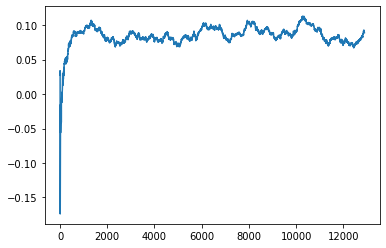

Thread: 5 iteration: 2230
RAM mProject_27 FROM: 2944 --> 704 reward: -1.0
Thread: 2 iteration: 2114
RAM mDiffFit_7 FROM: 1152 --> 2752 reward: -0.021804668359375005
Thread: 1 iteration: 2074
RAM mDiffFit_68 FROM: 2624 --> 896 reward: -0.024588627343750027
Thread: 3 iteration: 2157
RAM mBackground_44 FROM: 2304 --> 1728 reward: -0.022736306437499958
Saving ...


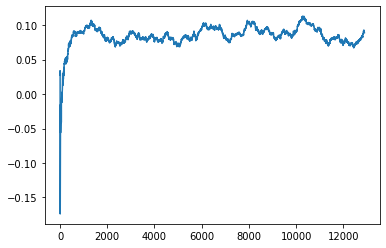

Thread: 6 iteration: 2170
RAM mDiffFit_173 FROM: 1344 --> 896 reward: -0.009200552734374996
Thread: 5 iteration: 2231
RAM mDiffFit_251 FROM: 1792 --> 896 reward: 0.019744778906249996
Thread: 1 iteration: 2075
RAM mDiffFit_301 FROM: 2688 --> 896 reward: -0.038546989843750004
Thread: 3 iteration: 2158
RAM mBackground_52 FROM: 768 --> 1728 reward: -0.09050824597656246
Thread: 2 iteration: 2115
RAM mDiffFit_381 FROM: 1984 --> 896 reward: -0.0037344242187499835
Thread: 6 iteration: 2171
RAM mBgModel_1 FROM: 192 --> 1216 reward: 0.370146138125
Thread: 4 iteration: 2147
RAM mDiffFit_39 FROM: 2368 --> 2880 reward: -0.013674491015625012
Thread: 5 iteration: 2232
RAM mDiffFit_304 FROM: 1920 --> 2880 reward: -0.03292190234374998
Thread: 3 iteration: 2159
RAM mDiffFit_211 FROM: 2688 --> 2944 reward: 0.009041681250000003
Thread: 1 iteration: 2076
RAM mDiffFit_401 FROM: 1408 --> 1792 reward: 0.01242190234375001
Thread: 2 iteration: 2116
RAM mDiffFit_258 FROM: 1344 --> 2816 reward: -0.090226614453124

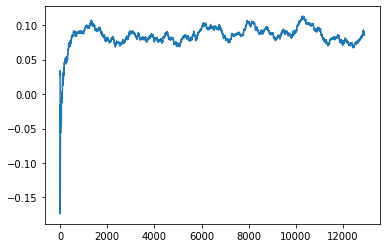

Thread: 3 iteration: 2160
RAM mBackground_81 FROM: 448 --> 1728 reward: -0.3015486689140625
Thread: 2 iteration: 2117
RAM mDiffFit_114 FROM: 640 --> 2752 reward: -0.014054624609375014
Thread: 3 iteration: 2161
RAM mBackground_77 FROM: 1728 --> 1728 reward: -0.03470910482812495
Thread: 2 iteration: 2118
RAM mProject_47 FROM: 320 --> 1280 reward: 0.7527343865624999
Thread: 6 iteration: 2172
RAM mImgtbl_2 FROM: 2624 --> 1280 reward: 0.01293524093749987
Thread: 1 iteration: 2078
RAM mProject_84 FROM: 128 --> 1280 reward: 0.7425475017187501
Thread: 4 iteration: 2148
RAM mDiffFit_156 FROM: 2304 --> 896 reward: 0.00746345234375001
Thread: 3 iteration: 2162
RAM mProject_10 FROM: 2368 --> 1728 reward: -0.014651377312499901
Thread: 5 iteration: 2233
RAM mBackground_39 FROM: 2944 --> 1728 reward: -0.03814468993749996
Thread: 6 iteration: 2173
RAM mDiffFit_215 FROM: 1088 --> 2752 reward: 0.01779953476562498
Thread: 4 iteration: 2149
RAM mBackground_46 FROM: 2496 --> 1728 reward: -0.036314926054687

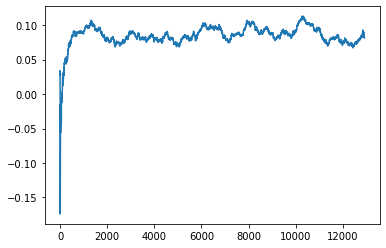

Thread: 4 iteration: 2150
RAM mDiffFit_344 FROM: 320 --> 2496 reward: -0.10208586367187501
Saving ...


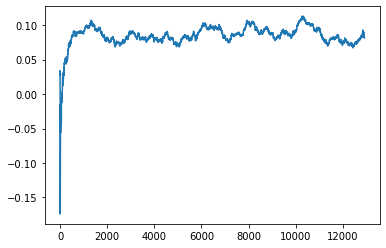

Thread: 1 iteration: 2080
RAM mImgtbl_3 FROM: 128 --> 2112 reward: 0.43152548125
Thread: 6 iteration: 2174
RAM mBackground_30 FROM: 3008 --> 1728 reward: -0.08074163078124995
Thread: 5 iteration: 2235
RAM mProject_10 FROM: 640 --> 1280 reward: 0.7502387582812501
Thread: 2 iteration: 2119
RAM mDiffFit_327 FROM: 1920 --> 2816 reward: 0.049067786718750006
Thread: 1 iteration: 2081
RAM mDiffFit_404 FROM: 128 --> 1408 reward: -0.6936823007812499
Thread: 6 iteration: 2175
RAM mDiffFit_71 FROM: 448 --> 2496 reward: -0.08552079687500003
Thread: 5 iteration: 2236
RAM mDiffFit_420 FROM: 1536 --> 832 reward: 0.1437813265625
Thread: 4 iteration: 2151
RAM mProject_39 FROM: 1408 --> 640 reward: -1.0
Thread: 3 iteration: 2163
RAM mBackground_30 FROM: 896 --> 1728 reward: -0.057140683703125
Saving ...


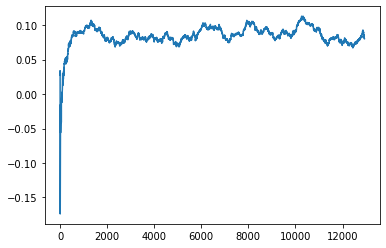

Thread: 2 iteration: 2120
RAM mDiffFit_105 FROM: 2432 --> 2880 reward: 0.005820331640624989
Thread: 5 iteration: 2237
RAM mDiffFit_91 FROM: 1152 --> 2752 reward: 0.014369866406249987
Thread: 4 iteration: 2152
RAM mDiffFit_118 FROM: 2304 --> 2880 reward: 0.047640707031250014
Thread: 6 iteration: 2176
RAM mBackground_60 FROM: 1920 --> 1728 reward: 0.028863768812500048
Thread: 1 iteration: 2082
RAM mDiffFit_354 FROM: 640 --> 2752 reward: -0.03029422617187501
Thread: 3 iteration: 2164
RAM mDiffFit_272 FROM: 960 --> 2816 reward: 0.029903737890624987
Thread: 2 iteration: 2121
RAM mDiffFit_4 FROM: 704 --> 2752 reward: 0.005474025781249999
Thread: 5 iteration: 2238
RAM mBackground_40 FROM: 2048 --> 1728 reward: -0.019406032695312513
Thread: 4 iteration: 2153
RAM mBackground_57 FROM: 2624 --> 1728 reward: -0.05723939154687501
Thread: 1 iteration: 2083
RAM mDiffFit_91 FROM: 832 --> 2816 reward: 0.01691154765625001
Thread: 3 iteration: 2165
RAM mDiffFit_408 FROM: 2560 --> 1408 reward: -0.00433336

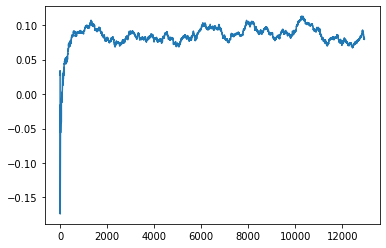

Thread: 5 iteration: 2240
RAM mDiffFit_136 FROM: 256 --> 2752 reward: -0.09270823125000001
Thread: 4 iteration: 2155
RAM mBackground_6 FROM: 1600 --> 1728 reward: 0.005536268812500022
Thread: 3 iteration: 2166
RAM mProject_27 FROM: 2880 --> 1728 reward: -0.17119302982031262
Thread: 1 iteration: 2084
RAM mDiffFit_178 FROM: 2624 --> 896 reward: -0.020838627343750023
Thread: 6 iteration: 2178
RAM mDiffFit_70 FROM: 1984 --> 896 reward: -0.006359424218749989
Thread: 2 iteration: 2124
RAM mDiffFit_229 FROM: 1856 --> 896 reward: -0.0007135835937500078
Thread: 5 iteration: 2241
RAM mDiffFit_48 FROM: 1024 --> 896 reward: 0.03620314140625001
Thread: 1 iteration: 2085
RAM mDiffFit_278 FROM: 1280 --> 2816 reward: 0.014697964062499996
Thread: 2 iteration: 2125
RAM mDiffFit_39 FROM: 1280 --> 2816 reward: -0.010041637500000002
Thread: 5 iteration: 2242
RAM mDiffFit_94 FROM: 2496 --> 1408 reward: -0.04235687929687499
Thread: 1 iteration: 2086
RAM mDiffFit_235 FROM: 1664 --> 2816 reward: 0.020609424218

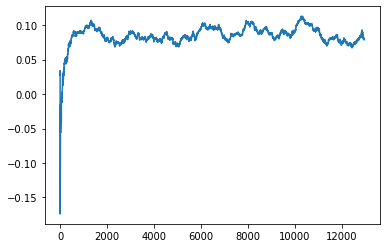

Thread: 6 iteration: 2180
RAM mDiffFit_247 FROM: 1728 --> 2816 reward: 0.04779435742187499
Thread: 4 iteration: 2157
RAM mProject_21 FROM: 1728 --> 1728 reward: 0.034571285437499995
Thread: 5 iteration: 2244
RAM mDiffFit_115 FROM: 1920 --> 896 reward: 0.03614061953125
Saving ...


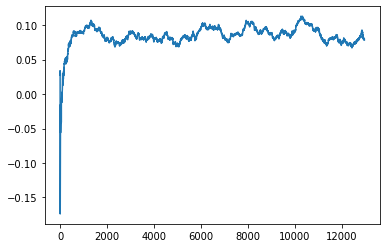

Thread: 3 iteration: 2170
RAM mBackground_40 FROM: 896 --> 1280 reward: -0.05311394265625001
Saving ...


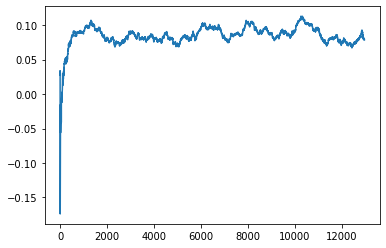

Thread: 1 iteration: 2090
RAM mDiffFit_59 FROM: 2880 --> 896 reward: 0.029015532031250006
Thread: 6 iteration: 2181
RAM mDiffFit_47 FROM: 1408 --> 896 reward: 0.02205207968750001
Thread: 4 iteration: 2158
RAM mDiffFit_329 FROM: 2624 --> 2944 reward: -0.07896884843750002
Thread: 2 iteration: 2129
RAM mDiffFit_16 FROM: 2048 --> 2944 reward: -0.03040106171875001
Thread: 5 iteration: 2245
RAM mDiffFit_154 FROM: 1792 --> 2880 reward: 0.016742233984375
Thread: 3 iteration: 2171
RAM mDiffFit_218 FROM: 128 --> 2816 reward: -0.297937434375
Thread: 1 iteration: 2091
RAM mDiffFit_11 FROM: 2304 --> 2880 reward: -0.014476570703125004
Thread: 4 iteration: 2159
RAM mDiffFit_348 FROM: 704 --> 2816 reward: 0.020005308593750003
Thread: 6 iteration: 2182
RAM mDiffFit_229 FROM: 2240 --> 2880 reward: 0.011296902343750012
Thread: 5 iteration: 2246
RAM mBackground_28 FROM: 1664 --> 1728 reward: -0.03792961468749997
Saving ...


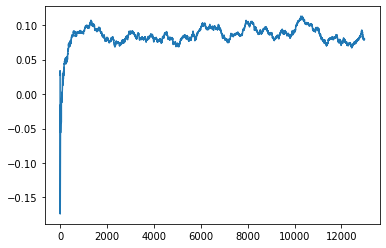

Thread: 2 iteration: 2130
RAM mDiffFit_319 FROM: 2176 --> 1792 reward: -0.06392716718750002
Thread: 1 iteration: 2092
RAM mBackground_3 FROM: 1664 --> 1728 reward: 0.022848258953125037
Saving ...


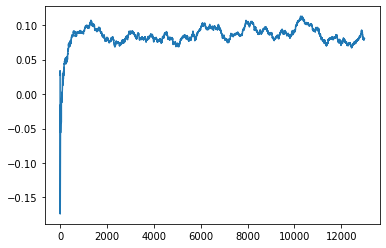

Thread: 4 iteration: 2160
RAM mBackground_1 FROM: 1792 --> 1728 reward: -0.20215395693749996
Thread: 2 iteration: 2131
RAM mImgtbl_1 FROM: 1920 --> 1280 reward: -0.0027042468749999826
Thread: 5 iteration: 2247
RAM mDiffFit_370 FROM: 2816 --> 320 reward: 0.361106791796875
Thread: 6 iteration: 2183
RAM mBackground_1 FROM: 2880 --> 1728 reward: -0.07609671770312505
Thread: 1 iteration: 2093
RAM mDiffFit_69 FROM: 448 --> 2752 reward: -0.05420309765625002
Thread: 6 iteration: 2184
RAM mProject_29 FROM: 2944 --> 1728 reward: -0.1581434957812499
Thread: 3 iteration: 2172
RAM mDiffFit_401 FROM: 2624 --> 896 reward: 0.023177035937499996
Thread: 3 iteration: 2173
RAM mDiffFit_165 FROM: 896 --> 896 reward: -0.01988022109375001
Thread: 6 iteration: 2185
RAM mBackground_20 FROM: 2176 --> 1728 reward: -0.051351493257812506
Thread: 1 iteration: 2094
RAM mProject_47 FROM: 2048 --> 1728 reward: -0.0376449400546875
Thread: 2 iteration: 2132
RAM mProject_64 FROM: 1984 --> 1728 reward: 0.00713058890625011

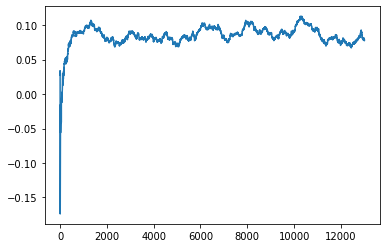

Thread: 5 iteration: 2250
RAM mBackground_90 FROM: 1472 --> 1728 reward: -0.02329614426562493
Thread: 3 iteration: 2176
RAM mProject_4 FROM: 448 --> 1280 reward: 0.74216500171875
Thread: 6 iteration: 2186
RAM mDiffFit_27 FROM: 1792 --> 2112 reward: 0.017460951171874996
Thread: 1 iteration: 2097
RAM mDiffFit_310 FROM: 576 --> 2112 reward: -0.048820287890624994
Thread: 2 iteration: 2135
RAM mDiffFit_409 FROM: 3008 --> 2112 reward: -0.019890663281250005
Thread: 5 iteration: 2251
RAM mDiffFit_181 FROM: 1984 --> 2112 reward: 0.05859902578124998
Thread: 4 iteration: 2164
RAM mDiffFit_334 FROM: 1920 --> 2112 reward: 0.0853438484375
Thread: 3 iteration: 2177
RAM mDiffFit_137 FROM: 2432 --> 896 reward: 0.01564057578125
Thread: 1 iteration: 2098
RAM mDiffFit_354 FROM: 2816 --> 896 reward: -0.0191354859375
Thread: 4 iteration: 2165
RAM mDiffFit_36 FROM: 2560 --> 896 reward: -0.00501048593750001
Thread: 3 iteration: 2178
RAM mProject_24 FROM: 1792 --> 1728 reward: 0.633400941515625
Thread: 6 itera

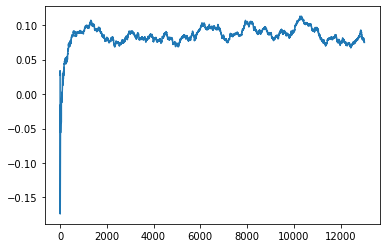

Thread: 1 iteration: 2100
RAM mDiffFit_19 FROM: 1280 --> 896 reward: 0.005708318749999986
Thread: 4 iteration: 2167
RAM mDiffFit_66 FROM: 2048 --> 896 reward: -0.015557344531250007
Saving ...


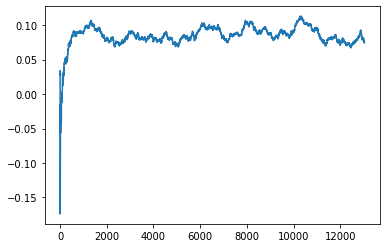

Thread: 3 iteration: 2180
RAM mDiffFit_373 FROM: 960 --> 2496 reward: 0.021789136328124997
Thread: 6 iteration: 2189
RAM mDiffFit_90 FROM: 2048 --> 2816 reward: 0.021625043750000007
Thread: 1 iteration: 2101
RAM mBackground_65 FROM: 1600 --> 1280 reward: 0.03741
Thread: 5 iteration: 2254
RAM mDiffFit_361 FROM: 1728 --> 2112 reward: 0.016812521874999993
Thread: 3 iteration: 2181
RAM mBackground_18 FROM: 1024 --> 1280 reward: -0.014351231187500054
Thread: 4 iteration: 2168
RAM mBackground_78 FROM: 2496 --> 1728 reward: -0.005764739234374945
Saving ...


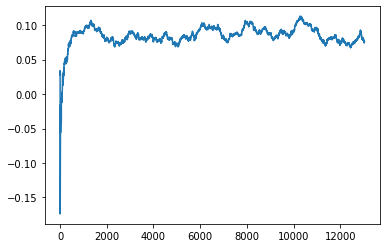

Thread: 6 iteration: 2190
RAM mDiffFit_332 FROM: 2368 --> 2176 reward: -0.003851570703124977
Thread: 1 iteration: 2102
RAM mDiffFit_26 FROM: 2560 --> 2176 reward: 0.07740632656250002
Thread: 5 iteration: 2255
RAM mProject_56 FROM: 1408 --> 1728 reward: -0.07068749737500003
Thread: 2 iteration: 2137
RAM mDiffFit_47 FROM: 640 --> 2752 reward: -0.05185152695312502
Thread: 3 iteration: 2182
RAM mDiffFit_107 FROM: 2176 --> 896 reward: -0.033932388281250024
Thread: 6 iteration: 2191
RAM mDiffFit_176 FROM: 1728 --> 896 reward: -0.05855216718750002
Thread: 1 iteration: 2103
RAM mDiffFit_37 FROM: 384 --> 896 reward: -0.0783020796875
Thread: 5 iteration: 2256
RAM mDiffFit_34 FROM: 128 --> 896 reward: 0.049619910156250016
Thread: 2 iteration: 2138
RAM mDiffFit_317 FROM: 2624 --> 896 reward: -0.028963627343750013
Thread: 6 iteration: 2192
RAM mDiffFit_369 FROM: 384 --> 2752 reward: -0.04369524414062503
Thread: 5 iteration: 2257
RAM mBackground_7 FROM: 2752 --> 1280 reward: -0.01643418007812504
Thr

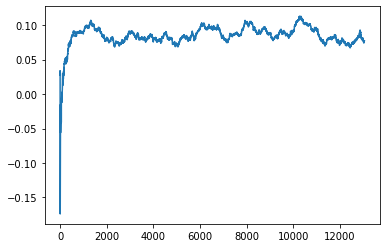

Thread: 2 iteration: 2140
RAM mDiffFit_342 FROM: 384 --> 2496 reward: -0.14214057578125
Thread: 5 iteration: 2259
RAM mDiffFit_227 FROM: 384 --> 2496 reward: 0.004328272656250014
Thread: 3 iteration: 2185
RAM mDiffFit_251 FROM: 1664 --> 2496 reward: 0.08074491015624996
Thread: 1 iteration: 2105
RAM mDiffFit_326 FROM: 1728 --> 896 reward: -0.5956308335937499
Saving ...


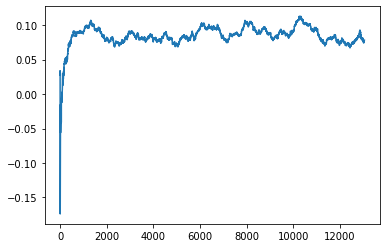

Thread: 4 iteration: 2170
RAM mDiffFit_348 FROM: 2496 --> 896 reward: -0.015549534765624982
Saving ...


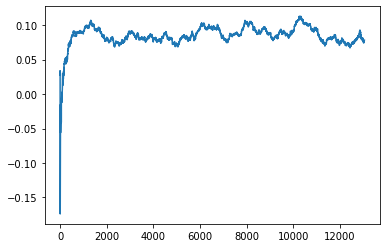

Thread: 5 iteration: 2260
RAM mDiffFit_10 FROM: 2752 --> 896 reward: 0.03827334179687506
Thread: 2 iteration: 2141
RAM mDiffFit_180 FROM: 576 --> 2752 reward: -0.07158327500000004
Thread: 3 iteration: 2186
RAM mDiffFit_304 FROM: 448 --> 2752 reward: -0.15987758867187504
Thread: 1 iteration: 2106
RAM mDiffFit_30 FROM: 2496 --> 896 reward: 0.027072876562500015
Thread: 5 iteration: 2261
RAM mProject_45 FROM: 2560 --> 1728 reward: -0.1080021315937501
Thread: 6 iteration: 2195
RAM mDiffFit_379 FROM: 832 --> 2752 reward: -0.05540365039062501
Thread: 1 iteration: 2107
RAM mDiffFit_284 FROM: 1472 --> 896 reward: -0.02671099492187497
Thread: 4 iteration: 2171
RAM mDiffFit_248 FROM: 192 --> 2752 reward: -0.17093743437500003
Thread: 5 iteration: 2262
RAM mDiffFit_152 FROM: 1792 --> 2816 reward: 0.02579172499999999
Thread: 6 iteration: 2196
RAM mDiffFit_115 FROM: 1344 --> 2752 reward: -0.077898473046875
Thread: 1 iteration: 2108
RAM mDiffFit_277 FROM: 1344 --> 2752 reward: 0.08535170195312497
Thre

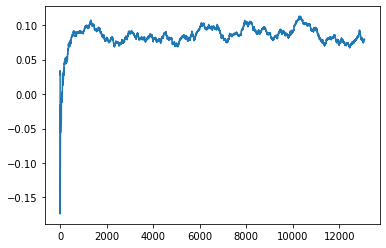

Thread: 1 iteration: 2110
RAM mDiffFit_37 FROM: 1408 --> 2752 reward: -0.01239579687499999
Thread: 3 iteration: 2189
RAM mDiffFit_160 FROM: 2496 --> 896 reward: -0.02094278671875
Thread: 5 iteration: 2265
RAM mDiffFit_378 FROM: 1472 --> 896 reward: -0.022507853515624995
Thread: 2 iteration: 2143
RAM mDiffFit_313 FROM: 384 --> 896 reward: -0.16106769921874997
Thread: 4 iteration: 2175
RAM mBackground_89 FROM: 1408 --> 1280 reward: 0.037513047484374985
Thread: 6 iteration: 2198
RAM mDiffFit_370 FROM: 2304 --> 896 reward: -0.023599025781249998
Thread: 1 iteration: 2111
RAM mDiffFit_161 FROM: 1856 --> 896 reward: -0.06214592812499999
Saving ...


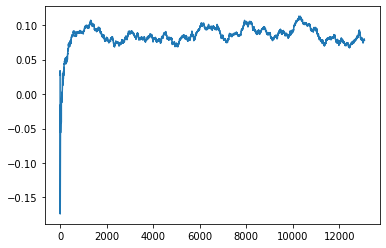

Thread: 3 iteration: 2190
RAM mDiffFit_234 FROM: 2368 --> 896 reward: -0.020046946093750014
Thread: 5 iteration: 2266
RAM mDiffFit_112 FROM: 1408 --> 2752 reward: -0.0018957968750000012
Thread: 4 iteration: 2176
RAM mBackground_85 FROM: 1728 --> 1280 reward: 0.03944578360156251
Thread: 2 iteration: 2144
RAM mDiffFit_133 FROM: 2688 --> 2304 reward: 0.045125043750000024
Thread: 6 iteration: 2199
RAM mDiffFit_252 FROM: 1088 --> 2816 reward: 0.037138162109374984
Thread: 3 iteration: 2191
RAM mDiffFit_309 FROM: 320 --> 896 reward: -0.1707396015625
Thread: 2 iteration: 2145
RAM mBackground_79 FROM: 2368 --> 1280 reward: 0.036626106640624975
Thread: 5 iteration: 2267
RAM mDiffFit_301 FROM: 1344 --> 896 reward: -0.05453132656249998
Thread: 1 iteration: 2112
RAM mImgtbl_3 FROM: 960 --> 1280 reward: -0.18730424687500002
Saving ...


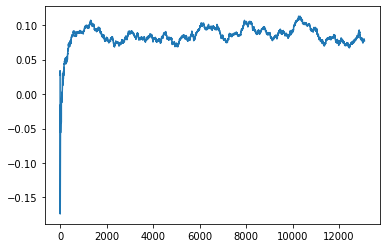

Thread: 6 iteration: 2200
RAM mBackground_78 FROM: 1280 --> 1280 reward: -0.0018275000000000075
Thread: 4 iteration: 2177
RAM mDiffFit_173 FROM: 384 --> 2496 reward: -0.10079681484375003
Thread: 3 iteration: 2192
RAM mDiffFit_47 FROM: 256 --> 2496 reward: -0.1718645140625
Thread: 5 iteration: 2268
RAM mBackground_86 FROM: 704 --> 1280 reward: -0.10359415412500002
Thread: 2 iteration: 2146
RAM mDiffFit_335 FROM: 2304 --> 896 reward: -0.029375087499999997
Thread: 6 iteration: 2201
RAM mDiffFit_12 FROM: 1152 --> 896 reward: -0.02444274296875
Thread: 4 iteration: 2178
RAM mBackground_29 FROM: 2688 --> 1280 reward: -0.03789837182812502
Thread: 1 iteration: 2113
RAM mDiffFit_383 FROM: 2880 --> 1792 reward: 0.027403650390625013
Thread: 6 iteration: 2202
RAM mDiffFit_117 FROM: 2752 --> 2304 reward: 0.021085951171875023
Thread: 4 iteration: 2179
RAM mDiffFit_223 FROM: 1280 --> 2496 reward: 0.017304755859375003
Thread: 2 iteration: 2147
RAM mDiffFit_265 FROM: 1088 --> 2496 reward: -0.08288022109

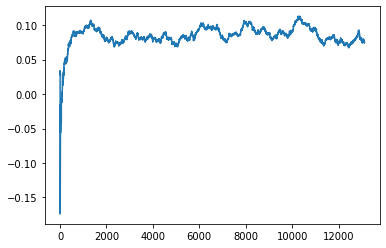

Thread: 5 iteration: 2270
RAM mDiffFit_20 FROM: 1792 --> 896 reward: 0.03861455781250002
Thread: 1 iteration: 2115
RAM mDiffFit_246 FROM: 768 --> 2496 reward: 0.020211038671875004
Saving ...


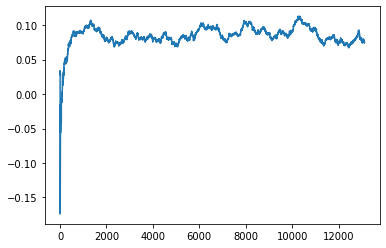

Thread: 2 iteration: 2150
RAM mProject_3 FROM: 448 --> 1280 reward: 0.7382743734374999
Saving ...


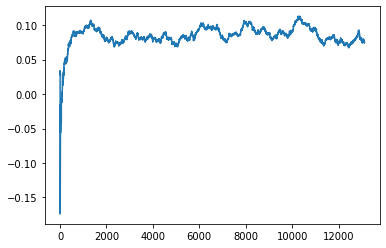

Thread: 4 iteration: 2180
RAM mProject_78 FROM: 1728 --> 1280 reward: 0.10387452353906254
Thread: 6 iteration: 2204
RAM mDiffFit_55 FROM: 2432 --> 1792 reward: -0.0418646453125
Thread: 4 iteration: 2181
RAM mDiffFit_212 FROM: 1216 --> 2496 reward: 0.03208340625
Thread: 1 iteration: 2116
RAM mBackground_8 FROM: 2112 --> 1280 reward: 0.019641106640624933
Thread: 2 iteration: 2151
RAM mDiffFit_315 FROM: 3008 --> 320 reward: 0.26697130585937495
Thread: 5 iteration: 2271
RAM mProject_81 FROM: 2624 --> 2240 reward: -0.05036214691406261
Thread: 3 iteration: 2196
RAM mDiffFit_76 FROM: 192 --> 2496 reward: -0.17178119531250002
Thread: 6 iteration: 2205
RAM mDiffFit_53 FROM: 960 --> 2496 reward: 0.021289136328125
Thread: 5 iteration: 2272
RAM mDiffFit_8 FROM: 2304 --> 1088 reward: 0.058888030859374996
Thread: 2 iteration: 2152
RAM mDiffFit_76 FROM: 3008 --> 320 reward: 0.155507766015625
Thread: 1 iteration: 2117
RAM mDiffFit_408 FROM: 3008 --> 1088 reward: 0.096591172265625
Thread: 3 iteration: 

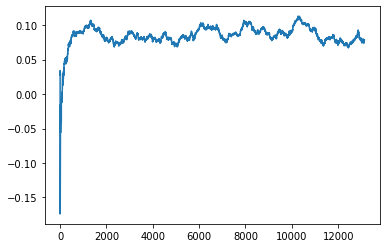

Thread: 3 iteration: 2200
RAM mProject_80 FROM: 1664 --> 1280 reward: 0.06429090304687508
Thread: 1 iteration: 2118
RAM mDiffFit_90 FROM: 768 --> 2496 reward: -0.06427342929687502
Thread: 6 iteration: 2207
RAM mDiffFit_16 FROM: 1664 --> 1792 reward: -0.019864601562500007
Thread: 3 iteration: 2201
RAM mDiffFit_164 FROM: 2304 --> 320 reward: 0.12910929296875
Thread: 2 iteration: 2154
RAM mDiffFit_268 FROM: 960 --> 2496 reward: 0.05725013124999999
Thread: 4 iteration: 2184
RAM mBackground_79 FROM: 1088 --> 1280 reward: -0.01750457706250003
Thread: 5 iteration: 2276
RAM mImgtbl_1 FROM: 2304 --> 1280 reward: 0.11956665499999991
Thread: 1 iteration: 2119
RAM mDiffFit_145 FROM: 1024 --> 2496 reward: -0.03836455781249999
Thread: 6 iteration: 2208
RAM mBackground_90 FROM: 1536 --> 1280 reward: -0.014852960562500026
Thread: 3 iteration: 2202
RAM mDiffFit_96 FROM: 1024 --> 2496 reward: 0.02863548593750001
Thread: 5 iteration: 2277
RAM mDiffFit_25 FROM: 960 --> 2496 reward: -0.01969528789062501
Th

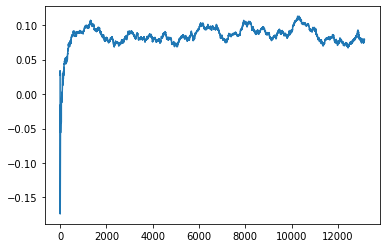

Thread: 1 iteration: 2120
RAM mDiffFit_313 FROM: 1280 --> 896 reward: 0.002151017968749988
Thread: 4 iteration: 2185
RAM mDiffFit_329 FROM: 2432 --> 896 reward: -0.026244866406249998
Thread: 6 iteration: 2209
RAM mDiffFit_168 FROM: 1664 --> 896 reward: 0.015510398437499975
Thread: 3 iteration: 2203
RAM mDiffFit_105 FROM: 1344 --> 896 reward: -0.015575552734374987
Thread: 2 iteration: 2156
RAM mDiffFit_142 FROM: 1920 --> 1152 reward: 0.026281239062500017
Thread: 1 iteration: 2121
RAM mDiffFit_294 FROM: 704 --> 2816 reward: -0.088361969140625
Thread: 3 iteration: 2204
RAM mBackground_71 FROM: 2240 --> 1280 reward: -0.0013035080468750244
Saving ...


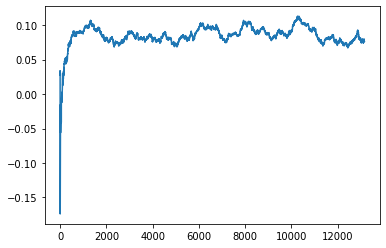

Thread: 6 iteration: 2210
RAM mDiffFit_353 FROM: 2688 --> 704 reward: 0.0079061953125
Thread: 1 iteration: 2122
RAM mBackground_25 FROM: 2752 --> 1280 reward: -0.037157078367187554
Thread: 2 iteration: 2157
RAM mDiffFit_38 FROM: 2240 --> 320 reward: 0.28879159375
Thread: 4 iteration: 2186
RAM mProject_55 FROM: 640 --> 1280 reward: 0.74477313
Thread: 5 iteration: 2278
RAM mDiffFit_133 FROM: 2560 --> 640 reward: 0.113375
Thread: 2 iteration: 2158
RAM mBackground_14 FROM: 2432 --> 1280 reward: 0.03328462635937496
Thread: 5 iteration: 2279
RAM mDiffFit_6 FROM: 2048 --> 2176 reward: -0.020687521875
Thread: 6 iteration: 2211
RAM mDiffFit_66 FROM: 320 --> 832 reward: 0.038221437109374964
Thread: 2 iteration: 2159
RAM mBackground_51 FROM: 1216 --> 1280 reward: 0.04098217696093751
Thread: 6 iteration: 2212
RAM mDiffFit_173 FROM: 512 --> 896 reward: -0.04631769921875001
Saving ...


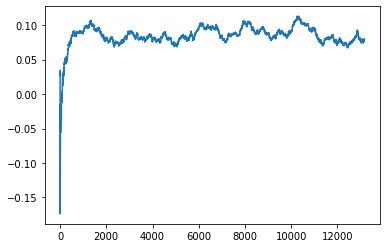

Thread: 2 iteration: 2160
RAM mDiffFit_408 FROM: 2944 --> 896 reward: 0.00539057578125
Thread: 6 iteration: 2213
RAM mProject_60 FROM: 2944 --> 1280 reward: -0.07420821314062478
Thread: 3 iteration: 2205
RAM mProject_11 FROM: 2624 --> 1280 reward: -0.03572936732812497
Thread: 1 iteration: 2123
RAM mProject_49 FROM: 2304 --> 1280 reward: 0.04022794715624998
Thread: 4 iteration: 2187
RAM mDiffFit_272 FROM: 832 --> 896 reward: -0.004721349609374988
Thread: 2 iteration: 2161
RAM mDiffFit_78 FROM: 1600 --> 896 reward: 0.0018280976562499995
Thread: 6 iteration: 2214
RAM mDiffFit_321 FROM: 2240 --> 1152 reward: 0.021039048828125004
Thread: 3 iteration: 2206
RAM mDiffFit_328 FROM: 576 --> 896 reward: -0.06989061953125003
Thread: 4 iteration: 2188
RAM mDiffFit_148 FROM: 320 --> 2816 reward: -0.174637987109375
Thread: 2 iteration: 2162
RAM mProject_36 FROM: 2816 --> 640 reward: -1.0
Saving ...


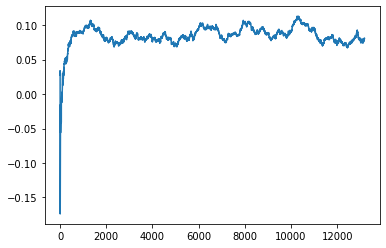

Thread: 5 iteration: 2280
RAM mDiffFit_29 FROM: 192 --> 896 reward: -0.265145840625
Thread: 4 iteration: 2189
RAM mBackground_26 FROM: 1984 --> 1280 reward: 0.04090822132812501
Thread: 3 iteration: 2207
RAM mDiffFit_408 FROM: 896 --> 2816 reward: -0.04776039843750002
Thread: 2 iteration: 2163
RAM mDiffFit_249 FROM: 1792 --> 1792 reward: 0.0038749999999999896
Thread: 5 iteration: 2281
RAM mDiffFit_35 FROM: 1536 --> 2816 reward: 0.0061458843750000075
Saving ...


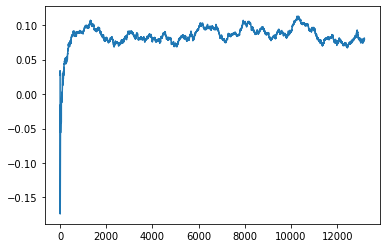

Thread: 4 iteration: 2190
RAM mDiffFit_194 FROM: 960 --> 2496 reward: 0.019414136328124998
Thread: 3 iteration: 2208
RAM mDiffFit_396 FROM: 1088 --> 2816 reward: 0.015711038671874997
Thread: 2 iteration: 2164
RAM mDiffFit_422 FROM: 448 --> 2496 reward: -0.04368221328124998
Thread: 5 iteration: 2282
RAM mProject_27 FROM: 2240 --> 1280 reward: -1.0
Thread: 1 iteration: 2124
RAM mDiffFit_152 FROM: 1792 --> 1152 reward: 0.0204270796875
Thread: 4 iteration: 2191
RAM mDiffFit_115 FROM: 2368 --> 896 reward: -0.0011849332031249951
Thread: 3 iteration: 2209
RAM mProject_23 FROM: 832 --> 704 reward: -1.0
Thread: 6 iteration: 2215
RAM mDiffFit_218 FROM: 896 --> 2496 reward: -0.03259112851562501
Thread: 4 iteration: 2192
RAM mDiffFit_124 FROM: 1856 --> 1152 reward: 0.027229159375000006
Saving ...


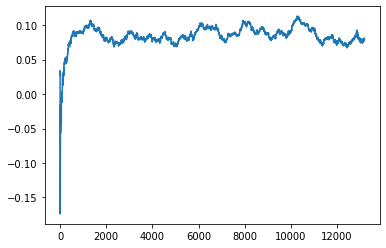

Thread: 3 iteration: 2210
RAM mDiffFit_21 FROM: 2240 --> 1152 reward: 0.0004634960937499946
Thread: 6 iteration: 2216
RAM mDiffFit_197 FROM: 3008 --> 1792 reward: 0.01626039843749998
Thread: 3 iteration: 2211
RAM mConcatFit_3 FROM: 2688 --> 1792 reward: 0.14613759187500006
Thread: 4 iteration: 2193
RAM mProject_70 FROM: 1408 --> 2240 reward: -0.0010859314921875974
Thread: 2 iteration: 2165
RAM mDiffFit_25 FROM: 960 --> 2496 reward: -0.015945287890625007
Thread: 6 iteration: 2217
RAM mDiffFit_42 FROM: 1344 --> 2496 reward: 0.007164092578125
Thread: 4 iteration: 2194
RAM mDiffFit_178 FROM: 384 --> 2496 reward: -0.071663961328125
Thread: 3 iteration: 2212
RAM mProject_25 FROM: 384 --> 1280 reward: 0.729593116875
Thread: 1 iteration: 2125
RAM mProject_10 FROM: 256 --> 1280 reward: 0.7568950148437501
Thread: 5 iteration: 2283
RAM mDiffFit_91 FROM: 1536 --> 832 reward: 0.04074477890624999
Thread: 2 iteration: 2166
RAM mDiffFit_108 FROM: 1728 --> 832 reward: 0.14467975585937498
Thread: 6 iter

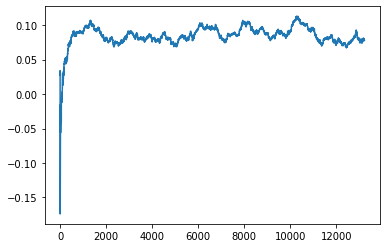

Thread: 6 iteration: 2220
RAM mDiffFit_310 FROM: 896 --> 2496 reward: -0.019710907421875007
Thread: 4 iteration: 2198
RAM mDiffFit_102 FROM: 128 --> 896 reward: -1.281645884375
Thread: 5 iteration: 2287
RAM mDiffFit_362 FROM: 1024 --> 896 reward: 0.003942699218750009
Saving ...


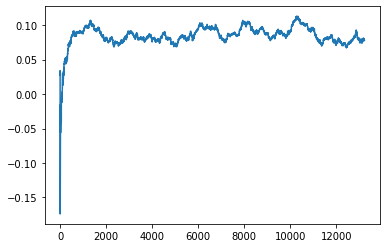

Thread: 2 iteration: 2170
RAM mBackground_7 FROM: 1472 --> 2240 reward: 0.015430796578125029
Thread: 3 iteration: 2216
RAM mProject_1 FROM: 128 --> 1280 reward: 0.73519374515625
Thread: 1 iteration: 2128
RAM mBackground_17 FROM: 1664 --> 2240 reward: 0.03611335885156254
Thread: 4 iteration: 2199
RAM mDiffFit_65 FROM: 448 --> 896 reward: -0.06855988945312502
Thread: 5 iteration: 2288
RAM mBackground_15 FROM: 2816 --> 1280 reward: -0.00144240140624994
Thread: 2 iteration: 2171
RAM mDiffFit_294 FROM: 2240 --> 1088 reward: 0.033304668359375005
Thread: 3 iteration: 2217
RAM mDiffFit_273 FROM: 320 --> 832 reward: -0.085179668359375
Thread: 1 iteration: 2129
RAM mDiffFit_331 FROM: 128 --> 1408 reward: -1.0624063265625
Thread: 6 iteration: 2221
RAM mBackground_1 FROM: 896 --> 2240 reward: -0.06269257394531248
Saving ...


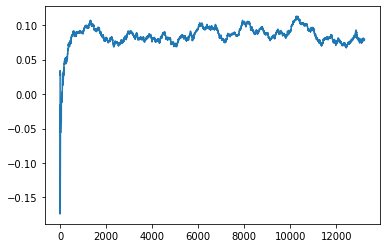

Thread: 4 iteration: 2200
RAM mDiffFit_131 FROM: 256 --> 896 reward: -0.19630730078124997
Thread: 2 iteration: 2172
RAM mBackground_23 FROM: 128 --> 1280 reward: -1.3899257213281249
Thread: 5 iteration: 2289
RAM mDiffFit_50 FROM: 192 --> 896 reward: -0.4866770796875
Saving ...


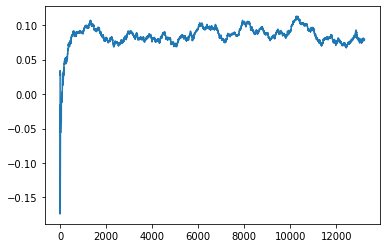

Thread: 1 iteration: 2130
RAM mDiffFit_413 FROM: 832 --> 2496 reward: -0.05082550898437502
Thread: 6 iteration: 2222
RAM mBackground_8 FROM: 1280 --> 2240 reward: 0.012342426054687534
Thread: 4 iteration: 2201
RAM mProject_29 FROM: 1472 --> 2240 reward: 0.12551182270312491
Thread: 3 iteration: 2218
RAM mDiffFit_10 FROM: 2560 --> 320 reward: 0.29011969140625
Thread: 2 iteration: 2173
RAM mDiffFit_59 FROM: 2688 --> 320 reward: 0.48036192539062506
Thread: 1 iteration: 2131
RAM mDiffFit_97 FROM: 192 --> 896 reward: -0.598549534765625
Thread: 4 iteration: 2202
RAM mDiffFit_370 FROM: 960 --> 896 reward: -0.015065110546874979
Thread: 1 iteration: 2132
RAM mProject_13 FROM: 1728 --> 2240 reward: 0.053422644375000015
Saving ...


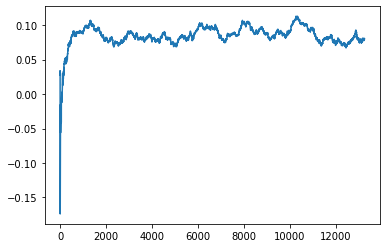

Thread: 5 iteration: 2290
RAM mBackground_35 FROM: 1536 --> 2240 reward: 0.0727619538203125
Thread: 2 iteration: 2174
RAM mDiffFit_267 FROM: 960 --> 2816 reward: 0.03240373789062499
Thread: 5 iteration: 2291
RAM mDiffFit_195 FROM: 384 --> 896 reward: -0.23421358359375
Thread: 1 iteration: 2133
RAM mProject_83 FROM: 1664 --> 2240 reward: 0.03843951609374996
Thread: 6 iteration: 2223
RAM mDiffFit_298 FROM: 1152 --> 384 reward: 0.18331252187500002
Thread: 4 iteration: 2203
RAM mProject_7 FROM: 320 --> 2240 reward: 0.7047767299218749
Thread: 3 iteration: 2219
RAM mDiffFit_331 FROM: 896 --> 384 reward: 0.25955734453124996
Thread: 2 iteration: 2175
RAM mDiffFit_264 FROM: 1600 --> 1088 reward: 0.0634271234375
Thread: 4 iteration: 2204
RAM mDiffFit_253 FROM: 448 --> 896 reward: -0.15
Thread: 6 iteration: 2224
RAM mDiffFit_181 FROM: 640 --> 832 reward: -0.006354159374999998
Saving ...


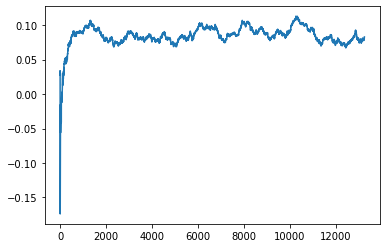

Thread: 3 iteration: 2220
RAM mDiffFit_15 FROM: 704 --> 832 reward: -0.008507809765624999
Thread: 6 iteration: 2225
RAM mBackground_30 FROM: 384 --> 2240 reward: -0.33653986247656237
Thread: 3 iteration: 2221
RAM mProject_72 FROM: 1536 --> 2240 reward: 0.018420147000000043
Thread: 1 iteration: 2134
RAM mBackground_64 FROM: 1664 --> 2240 reward: 0.01485073430468754
Thread: 3 iteration: 2222
RAM mProject_45 FROM: 1152 --> 2240 reward: -0.09659187653906262
Thread: 2 iteration: 2176
RAM mDiffFit_421 FROM: 1152 --> 896 reward: 0.005463539843749993
Thread: 1 iteration: 2135
RAM mDiffFit_173 FROM: 1472 --> 896 reward: -0.06722143710937496
Thread: 3 iteration: 2223
RAM mProject_67 FROM: 320 --> 2240 reward: 0.08161653304687495
Thread: 4 iteration: 2205
RAM mProject_73 FROM: 1856 --> 2240 reward: 0.06383028832031241
Thread: 6 iteration: 2226
RAM mDiffFit_149 FROM: 2432 --> 2944 reward: 0.032776105468750004
Thread: 1 iteration: 2136
RAM mProject_64 FROM: 1088 --> 640 reward: -1.0
Thread: 5 itera

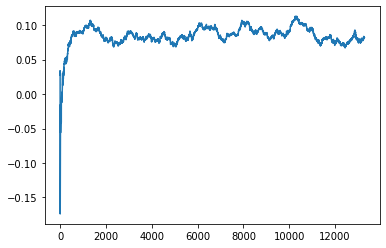

Thread: 6 iteration: 2230
RAM mDiffFit_291 FROM: 960 --> 1152 reward: -0.026734380468750006
Saving ...


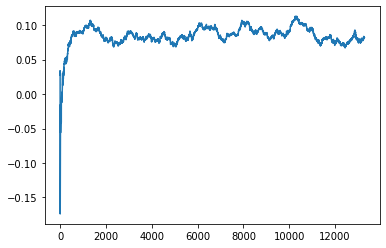

Thread: 1 iteration: 2140
RAM mDiffFit_5 FROM: 1536 --> 1088 reward: -0.04801307460937501
Saving ...


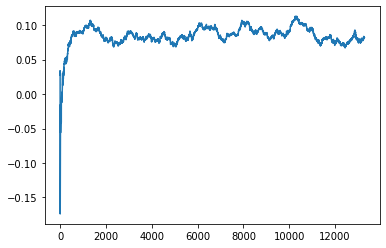

Thread: 2 iteration: 2180
RAM mDiffFit_106 FROM: 2752 --> 320 reward: 0.20768747812500002
Thread: 5 iteration: 2296
RAM mDiffFit_149 FROM: 2880 --> 320 reward: 0.21420309765625
Saving ...


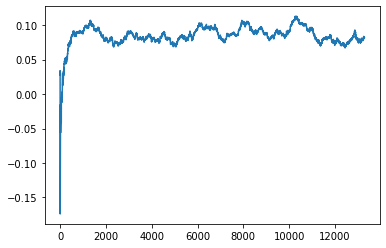

Thread: 4 iteration: 2210
RAM mDiffFit_123 FROM: 2432 --> 320 reward: 0.08011969140624997
Thread: 3 iteration: 2227
RAM mDiffFit_295 FROM: 1088 --> 1088 reward: -0.102862056640625
Thread: 6 iteration: 2231
RAM mDiffFit_412 FROM: 1920 --> 2112 reward: 0.030515663281250008
Thread: 1 iteration: 2141
RAM mDiffFit_287 FROM: 2752 --> 2112 reward: 0.046156282812500025
Thread: 3 iteration: 2228
RAM mBackground_29 FROM: 2880 --> 1280 reward: -0.10749799949218758
Thread: 5 iteration: 2297
RAM mBackground_15 FROM: 2176 --> 2240 reward: 0.04317922937499998
Thread: 4 iteration: 2211
RAM mProject_79 FROM: 2496 --> 2240 reward: -0.05118056571093745
Thread: 2 iteration: 2181
RAM mDiffFit_47 FROM: 1728 --> 2112 reward: 0.003937521875000006
Thread: 6 iteration: 2232
RAM mDiffFit_416 FROM: 2624 --> 2176 reward: 0.042919313671875
Thread: 3 iteration: 2229
RAM mDiffFit_255 FROM: 2048 --> 2176 reward: -0.015937521875000003
Thread: 1 iteration: 2142
RAM mDiffFit_44 FROM: 2560 --> 2176 reward: 0.0529271234375

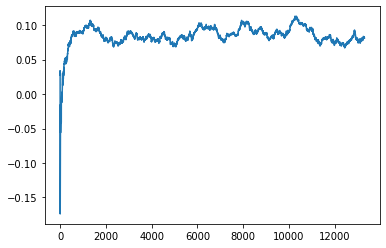

Thread: 3 iteration: 2230
RAM mDiffFit_414 FROM: 1536 --> 896 reward: 0.09061982265625002
Thread: 5 iteration: 2299
RAM mDiffFit_369 FROM: 1664 --> 2176 reward: 0.018729203125
Thread: 6 iteration: 2234
RAM mViewer_1 FROM: 2560 --> 1280 reward: -0.05049700734374999
Thread: 2 iteration: 2183
RAM mConcatFit_3 FROM: 1856 --> 1792 reward: -0.022118778437500042
Thread: 3 iteration: 2231
RAM mDiffFit_144 FROM: 2240 --> 640 reward: 0.07291404882812502
Saving ...


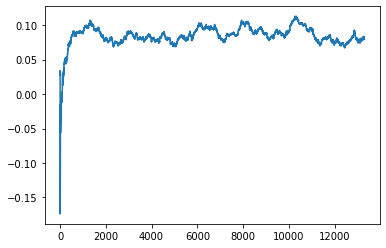

Thread: 5 iteration: 2300
RAM mProject_3 FROM: 320 --> 1280 reward: 0.7421425017187501
Thread: 1 iteration: 2143
RAM mDiffFit_90 FROM: 896 --> 2880 reward: 0.038877719921875005
Thread: 3 iteration: 2232
RAM mDiffFit_226 FROM: 128 --> 320 reward: -0.288455730078125
Thread: 6 iteration: 2235
RAM mDiffFit_389 FROM: 128 --> 896 reward: -1.5819896453125
Thread: 1 iteration: 2144
RAM mBackground_85 FROM: 2176 --> 1280 reward: -0.03985125714062502
Thread: 5 iteration: 2301
RAM mProject_83 FROM: 192 --> 1280 reward: 0.7389493734374999
Thread: 4 iteration: 2213
RAM mDiffFit_338 FROM: 2752 --> 320 reward: 0.12101557578125
Thread: 3 iteration: 2233
RAM mDiffFit_178 FROM: 2816 --> 2944 reward: 0.009234380468750008
Thread: 6 iteration: 2236
RAM mDiffFit_317 FROM: 320 --> 2176 reward: -0.11432546523437498
Thread: 4 iteration: 2214
RAM mDiffFit_410 FROM: 2560 --> 640 reward: 0.18853650390624999
Thread: 5 iteration: 2302
RAM mDiffFit_202 FROM: 960 --> 2496 reward: 0.019539136328125
Thread: 6 iteration

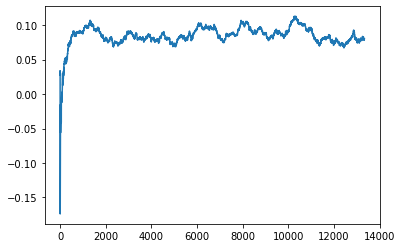

Thread: 6 iteration: 2240
RAM mProject_3 FROM: 2752 --> 640 reward: -1.0
Thread: 3 iteration: 2236
RAM mDiffFit_53 FROM: 1344 --> 1792 reward: 0.027455773828124995
Thread: 5 iteration: 2307
RAM mDiffFit_52 FROM: 1344 --> 896 reward: -0.07340632656249999
Thread: 1 iteration: 2149
RAM mBackground_57 FROM: 1536 --> 2240 reward: 0.003982027765625002
Thread: 2 iteration: 2189
RAM mDiffFit_161 FROM: 960 --> 832 reward: 0.011778650390625
Thread: 3 iteration: 2237
RAM mDiffFit_303 FROM: 2240 --> 2304 reward: -0.029171902343749986
Thread: 5 iteration: 2308
RAM mDiffFit_332 FROM: 1920 --> 1792 reward: 0.012901061718750004
Saving ...


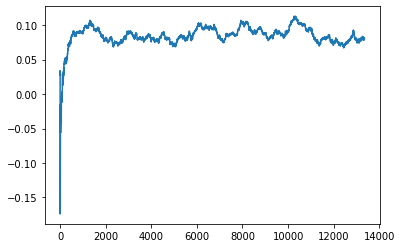

Thread: 2 iteration: 2190
RAM mBackground_49 FROM: 3008 --> 2240 reward: -0.112010697984375
Saving ...


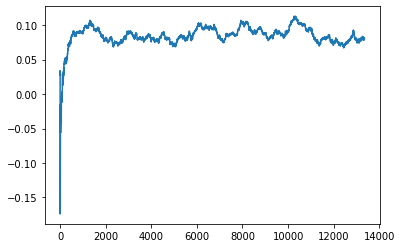

Thread: 1 iteration: 2150
RAM mBackground_81 FROM: 832 --> 2240 reward: -0.08020164114843749
Thread: 3 iteration: 2238
RAM mDiffFit_378 FROM: 192 --> 2496 reward: -0.10340615156249999
Thread: 5 iteration: 2309
RAM mDiffFit_344 FROM: 1536 --> 2496 reward: -0.0007187171874999988
Thread: 2 iteration: 2191
RAM mDiffFit_173 FROM: 1472 --> 832 reward: -0.056450596484374976
Thread: 1 iteration: 2151
RAM mDiffFit_85 FROM: 1920 --> 2176 reward: 0.02646358359375
Thread: 3 iteration: 2239
RAM mProject_6 FROM: 576 --> 1280 reward: 0.7391068734374999
Thread: 6 iteration: 2241
RAM mProject_65 FROM: 2880 --> 640 reward: -1.0
Saving ...


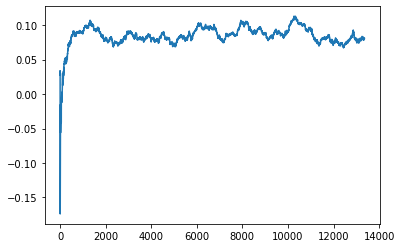

Thread: 4 iteration: 2220
RAM mDiffFit_236 FROM: 1856 --> 2112 reward: 0.023257853515625
Saving ...


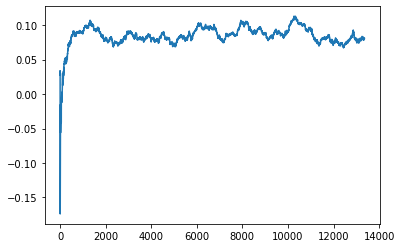

Thread: 5 iteration: 2310
RAM mDiffFit_401 FROM: 2048 --> 2176 reward: 0.005395840624999992
Thread: 1 iteration: 2152
RAM mDiffFit_70 FROM: 1024 --> 832 reward: 0.012588539843750007
Thread: 2 iteration: 2192
RAM mBackground_36 FROM: 1152 --> 2240 reward: -0.013903270624999964
Saving ...


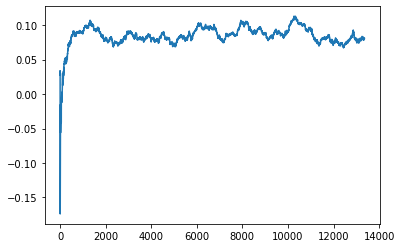

Thread: 3 iteration: 2240
RAM mBackground_16 FROM: 1408 --> 2240 reward: 0.002873445773437478
Thread: 6 iteration: 2242
RAM mDiffFit_157 FROM: 1728 --> 1792 reward: -0.04541150390625002
Thread: 4 iteration: 2221
RAM mDiffFit_233 FROM: 2496 --> 1792 reward: -0.032203185156249974
Thread: 2 iteration: 2193
RAM mDiffFit_421 FROM: 128 --> 896 reward: -0.8266146453125001
Thread: 6 iteration: 2243
RAM mBackground_88 FROM: 512 --> 2240 reward: -0.20210215100781245
Thread: 5 iteration: 2311
RAM mDiffFit_387 FROM: 1152 --> 2176 reward: -0.013531239062499999
Thread: 5 iteration: 2312
RAM mBackground_52 FROM: 1024 --> 1280 reward: 0.004085037624999978
Thread: 2 iteration: 2194
RAM mDiffFit_342 FROM: 1344 --> 2880 reward: -0.04278123906249997
Thread: 4 iteration: 2222
RAM mProject_15 FROM: 832 --> 2240 reward: 0.7166839289062499
Thread: 1 iteration: 2153
RAM mDiffFit_238 FROM: 2176 --> 1088 reward: -0.004617233984375007
Thread: 6 iteration: 2244
RAM mProject_15 FROM: 256 --> 1280 reward: 0.73852187

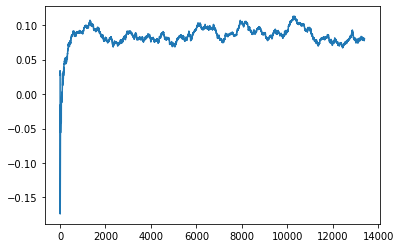

Thread: 6 iteration: 2250
RAM mBackground_90 FROM: 2496 --> 2240 reward: 0.010617860664062513
Thread: 4 iteration: 2228
RAM mProject_11 FROM: 576 --> 2240 reward: 0.7052042299218749
Thread: 3 iteration: 2246
RAM mDiffFit_160 FROM: 2816 --> 1792 reward: -0.013875043750000001
Thread: 5 iteration: 2318
RAM mDiffFit_159 FROM: 1216 --> 896 reward: -0.07636986640624999
Thread: 1 iteration: 2159
RAM mDiffFit_157 FROM: 1344 --> 896 reward: -7.033164062499736e-05
Thread: 6 iteration: 2251
RAM mProject_37 FROM: 1664 --> 2240 reward: 0.04760593235156247
Thread: 2 iteration: 2198
RAM mDiffFit_74 FROM: 2368 --> 896 reward: -0.06676575078125
Thread: 3 iteration: 2247
RAM mViewer_1 FROM: 1152 --> 2240 reward: -0.005145868921875011
Thread: 4 iteration: 2229
RAM mDiffFit_406 FROM: 2752 --> 1088 reward: -0.01342453476562499
Thread: 5 iteration: 2319
RAM mDiffFit_8 FROM: 2176 --> 1152 reward: 0.039109380468749996
Saving ...


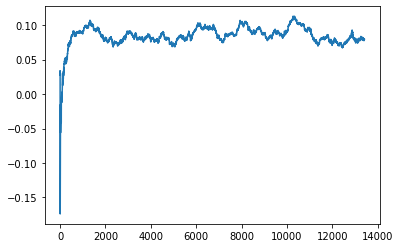

Thread: 1 iteration: 2160
RAM mDiffFit_165 FROM: 1024 --> 1792 reward: -0.028687478125000027
Thread: 2 iteration: 2199
RAM mDiffFit_193 FROM: 2304 --> 320 reward: 0.11630725703124999
Thread: 3 iteration: 2248
RAM mDiffFit_78 FROM: 2880 --> 320 reward: 0.15831769921875002
Saving ...


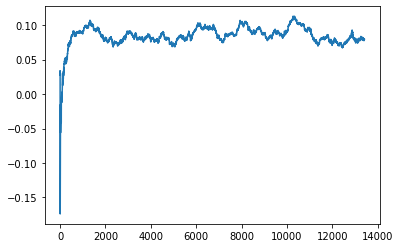

Thread: 4 iteration: 2230
RAM mDiffFit_87 FROM: 2816 --> 1792 reward: -0.004114601562499997
Saving ...


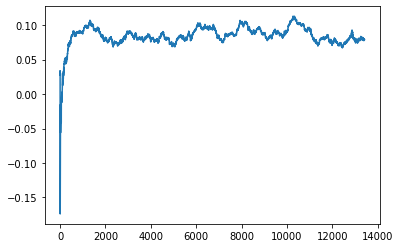

Thread: 5 iteration: 2320
RAM mProject_77 FROM: 1600 --> 2240 reward: 0.04875907113281242
Thread: 6 iteration: 2252
RAM mDiffFit_29 FROM: 512 --> 2496 reward: -0.07953382773437502
Thread: 4 iteration: 2231
RAM mDiffFit_252 FROM: 128 --> 896 reward: -1.24284902578125
Saving ...


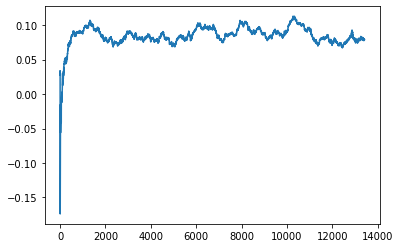

Thread: 2 iteration: 2200
RAM mBackground_54 FROM: 576 --> 2240 reward: -0.11430374285937502
Thread: 3 iteration: 2249
RAM mDiffFit_163 FROM: 512 --> 2496 reward: -0.23999223398437497
Thread: 1 iteration: 2161
RAM mDiffFit_285 FROM: 2752 --> 1792 reward: -0.041604246875
Thread: 5 iteration: 2321
RAM mDiffFit_16 FROM: 2496 --> 1792 reward: -0.092862100390625
Thread: 4 iteration: 2232
RAM mDiffFit_142 FROM: 1984 --> 1152 reward: 0.06028909257812501
Thread: 6 iteration: 2253
RAM mDiffFit_19 FROM: 384 --> 896 reward: -0.13238544218749998
Thread: 2 iteration: 2201
RAM mDiffFit_14 FROM: 2624 --> 896 reward: -0.023338627343750026
Saving ...


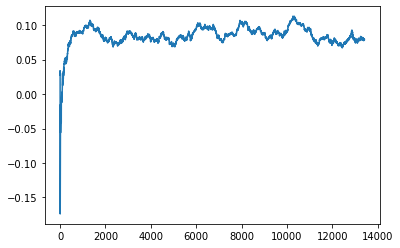

Thread: 3 iteration: 2250
RAM mDiffFit_329 FROM: 1088 --> 2496 reward: -0.005791637500000002
Thread: 5 iteration: 2322
RAM mDiffFit_10 FROM: 1472 --> 1792 reward: -0.027263030859374995
Thread: 1 iteration: 2162
RAM mBackground_44 FROM: 2240 --> 2240 reward: -0.003332499999999991
Thread: 4 iteration: 2233
RAM mDiffFit_375 FROM: 2496 --> 1792 reward: -0.023578185156249987
Thread: 6 iteration: 2254
RAM mDiffFit_213 FROM: 1216 --> 1792 reward: -0.011833318749999988
Thread: 2 iteration: 2202
RAM mDiffFit_36 FROM: 1216 --> 2176 reward: -0.012559889453124997
Thread: 3 iteration: 2251
RAM mBackground_14 FROM: 640 --> 2240 reward: -0.21354646730468746
Thread: 1 iteration: 2163
RAM mDiffFit_161 FROM: 448 --> 2496 reward: -0.029200465234375025
Thread: 2 iteration: 2203
RAM mDiffFit_322 FROM: 2688 --> 704 reward: 0.16702347304687498
Thread: 5 iteration: 2323
RAM mDiffFit_408 FROM: 1984 --> 2176 reward: -0.020776061718749995
Thread: 3 iteration: 2252
RAM mDiffFit_103 FROM: 2816 --> 320 reward: 0.07

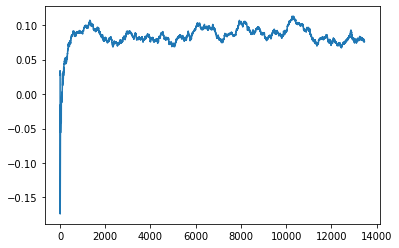

Thread: 4 iteration: 2240
RAM mDiffFit_46 FROM: 2240 --> 1088 reward: -0.002987012890624998
Thread: 1 iteration: 2169
RAM mDiffFit_95 FROM: 1536 --> 384 reward: 0.07923433671875002
Thread: 2 iteration: 2208
RAM mProject_12 FROM: 2176 --> 640 reward: -1.0
Thread: 6 iteration: 2258
RAM mDiffFit_405 FROM: 448 --> 2496 reward: -0.015510354687500016
Thread: 3 iteration: 2259
RAM mDiffFit_153 FROM: 1408 --> 1152 reward: -0.03044274296875
Saving ...


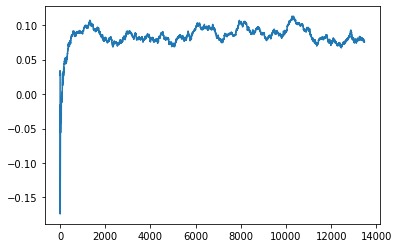

Thread: 5 iteration: 2330
RAM mDiffFit_189 FROM: 768 --> 2496 reward: -0.005992146484375006
Thread: 4 iteration: 2241
RAM mDiffFit_124 FROM: 2432 --> 1792 reward: -0.09887513125
Thread: 2 iteration: 2209
RAM mBackground_18 FROM: 1152 --> 2240 reward: 0.0028242047265625314
Thread: 6 iteration: 2259
RAM mDiffFit_268 FROM: 1024 --> 256 reward: 0.2891354421875
Saving ...


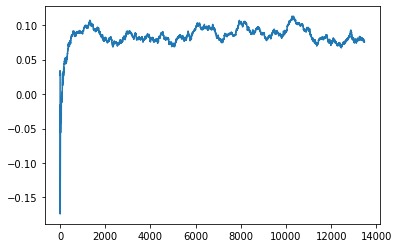

Thread: 1 iteration: 2170
RAM mDiffFit_160 FROM: 384 --> 2496 reward: -0.062648385546875
Saving ...


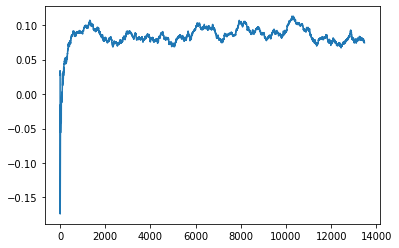

Thread: 3 iteration: 2260
RAM mDiffFit_122 FROM: 1856 --> 1792 reward: -0.1229480515625
Thread: 5 iteration: 2331
RAM mDiffFit_44 FROM: 2432 --> 1088 reward: 0.015283827734374998
Thread: 4 iteration: 2242
RAM mDiffFit_148 FROM: 1472 --> 2176 reward: -0.011554668359375006
Saving ...


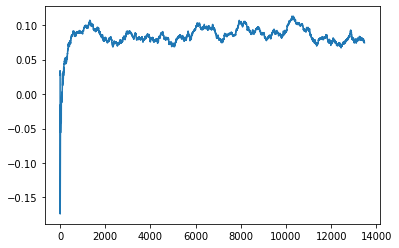

Thread: 2 iteration: 2210
RAM mDiffFit_353 FROM: 384 --> 2496 reward: -0.07313276601562503
Thread: 1 iteration: 2171
RAM mBackground_70 FROM: 2752 --> 2240 reward: -0.012584254023437436
Saving ...


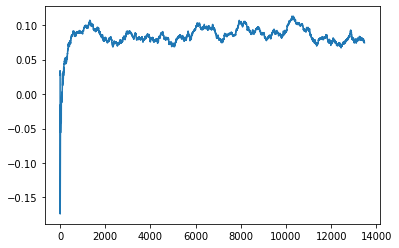

Thread: 6 iteration: 2260
RAM mDiffFit_73 FROM: 1728 --> 1792 reward: 0.0011171902343749818
Thread: 2 iteration: 2211
RAM mDiffFit_28 FROM: 2176 --> 1792 reward: -0.014703141406250016
Thread: 1 iteration: 2172
RAM mDiffFit_1 FROM: 832 --> 2496 reward: 0.0034219460937500064
Thread: 6 iteration: 2261
RAM mViewer_3 FROM: 1216 --> 640 reward: 0.14206329147656246
Thread: 5 iteration: 2332
RAM mDiffFit_286 FROM: 1792 --> 2176 reward: 0.005828141406250004
Thread: 4 iteration: 2243
RAM mDiffFit_81 FROM: 896 --> 832 reward: -0.0011093804687500007
Thread: 2 iteration: 2212
RAM mDiffFit_120 FROM: 832 --> 2496 reward: -0.00017703593750001412
Thread: 6 iteration: 2262
RAM mBackground_82 FROM: 832 --> 2240 reward: -0.04365160352343753
Thread: 4 iteration: 2244
RAM mBgModel_2 FROM: 1920 --> 704 reward: 0.21599164625
Thread: 1 iteration: 2173
RAM mBackground_84 FROM: 960 --> 2240 reward: -0.022554737929687523
Thread: 4 iteration: 2245
RAM mDiffFit_307 FROM: 896 --> 2112 reward: -0.009908827734375
Thre

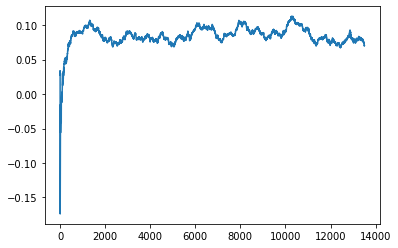

Thread: 1 iteration: 2180
RAM mProject_75 FROM: 576 --> 640 reward: -1.0
Thread: 2 iteration: 2214
RAM mProject_37 FROM: 448 --> 640 reward: -1.0
Thread: 4 iteration: 2247
RAM mDiffFit_211 FROM: 1856 --> 2176 reward: -0.011255221093750007
Thread: 5 iteration: 2336
RAM mDiffFit_133 FROM: 2240 --> 1152 reward: -0.08326575078124998
Thread: 6 iteration: 2267
RAM mDiffFit_337 FROM: 192 --> 896 reward: -0.4587707968750001
Thread: 1 iteration: 2181
RAM mProject_47 FROM: 2944 --> 640 reward: -1.0
Thread: 3 iteration: 2263
RAM mDiffFit_141 FROM: 512 --> 896 reward: -0.05256769921874998
Thread: 5 iteration: 2337
RAM mBackground_27 FROM: 2816 --> 1280 reward: -0.07747187987500004
Thread: 4 iteration: 2248
RAM mBackground_14 FROM: 1792 --> 2240 reward: 0.0555574260546875
Thread: 3 iteration: 2264
RAM mBackground_34 FROM: 2112 --> 640 reward: 0.18276788531250004
Thread: 6 iteration: 2268
RAM mBackground_88 FROM: 512 --> 2240 reward: -0.20285465100781247
Thread: 4 iteration: 2249
RAM mBackground_55 

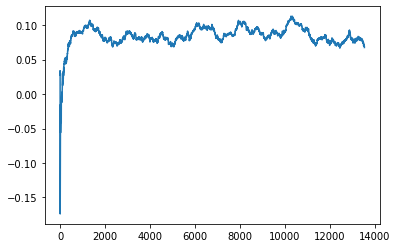

Thread: 3 iteration: 2270
RAM mDiffFit_273 FROM: 1024 --> 832 reward: 0.008830730078124996
Thread: 1 iteration: 2185
RAM mDiffFit_341 FROM: 896 --> 2496 reward: 0.01919278671875
Thread: 2 iteration: 2218
RAM mProject_73 FROM: 384 --> 640 reward: -1.0
Saving ...


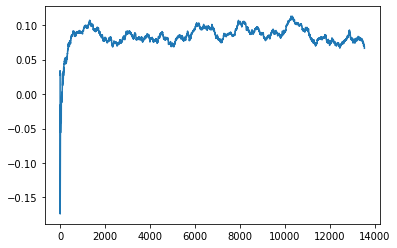

Thread: 5 iteration: 2340
RAM mDiffFit_303 FROM: 1216 --> 1792 reward: -0.028263030859375007
Thread: 1 iteration: 2186
RAM mDiffFit_203 FROM: 896 --> 1792 reward: -0.007994778906250007
Thread: 2 iteration: 2219
RAM mDiffFit_56 FROM: 2432 --> 320 reward: 0.3400963058593749
Thread: 5 iteration: 2341
RAM mDiffFit_267 FROM: 256 --> 832 reward: -0.13396612851562495
Thread: 1 iteration: 2187
RAM mDiffFit_113 FROM: 1408 --> 1152 reward: 0.019770840625000004
Thread: 1 iteration: 2188
RAM mBackground_81 FROM: 2368 --> 2240 reward: -0.35988354828124997
Thread: 5 iteration: 2342
RAM mDiffFit_1 FROM: 1664 --> 1792 reward: 0.0028958406249999895
Thread: 5 iteration: 2343
RAM mDiffFit_257 FROM: 576 --> 896 reward: -0.048013030859375
Thread: 5 iteration: 2344
RAM mProject_77 FROM: 512 --> 640 reward: -1.0
Saving ...


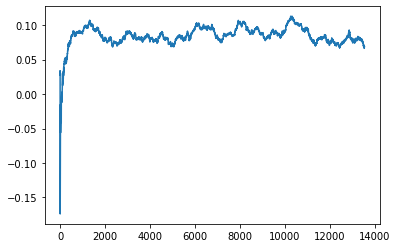

Thread: 4 iteration: 2250
RAM mProject_62 FROM: 768 --> 640 reward: -1.0
Saving ...


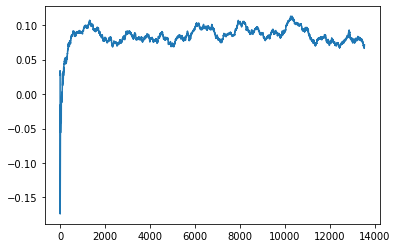

Thread: 6 iteration: 2270
RAM mProject_23 FROM: 2816 --> 640 reward: -1.0
Thread: 3 iteration: 2271
RAM mDiffFit_109 FROM: 1664 --> 832 reward: 0.015950508984375014
Thread: 3 iteration: 2272
RAM mProject_27 FROM: 1984 --> 640 reward: -1.0
Saving ...


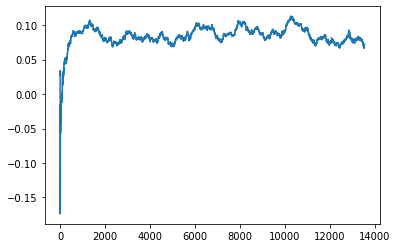

Thread: 2 iteration: 2220
RAM mDiffFit_270 FROM: 1344 --> 1792 reward: -0.11096621601562498
Thread: 3 iteration: 2273
RAM mProject_77 FROM: 1536 --> 640 reward: -1.0
Thread: 1 iteration: 2189
RAM mDiffFit_408 FROM: 2688 --> 320 reward: 0.08583845234375
Saving ...


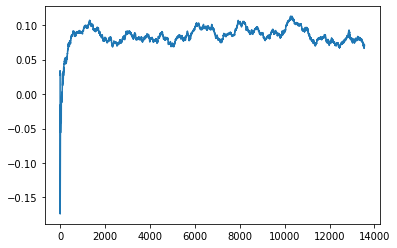

Thread: 1 iteration: 2190
RAM mDiffFit_381 FROM: 1152 --> 960 reward: 0.06950004374999999
Thread: 1 iteration: 2191
RAM mProject_65 FROM: 2944 --> 640 reward: -1.0
Thread: 5 iteration: 2345
RAM mProject_72 FROM: 2048 --> 640 reward: -1.0
Thread: 4 iteration: 2251
RAM mProject_17 FROM: 1024 --> 640 reward: -1.0
Thread: 6 iteration: 2271
RAM mDiffFit_249 FROM: 384 --> 1792 reward: -0.3582396453125
Thread: 1 iteration: 2192
RAM mDiffFit_112 FROM: 1024 --> 832 reward: 0.010463539843749998
Thread: 5 iteration: 2346
RAM mDiffFit_166 FROM: 896 --> 2112 reward: 0.012005264843750005
Thread: 6 iteration: 2272
RAM mDiffFit_148 FROM: 2624 --> 640 reward: 0.11043747812499996
Thread: 4 iteration: 2252
RAM mProject_1 FROM: 192 --> 640 reward: -1.0
Thread: 2 iteration: 2221
RAM mProject_22 FROM: 384 --> 640 reward: -1.0
Thread: 3 iteration: 2274
RAM mDiffFit_402 FROM: 1600 --> 1152 reward: 0.012692699218749982
Thread: 1 iteration: 2193
RAM mBackground_40 FROM: 640 --> 640 reward: 0.05803211468750002
T

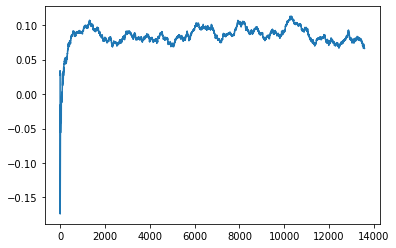

Thread: 5 iteration: 2350
RAM mDiffFit_260 FROM: 576 --> 2496 reward: -0.04061714648437499
Thread: 1 iteration: 2197
RAM mDiffFit_296 FROM: 2816 --> 1792 reward: -0.02012504375000001
Thread: 4 iteration: 2256
RAM mDiffFit_313 FROM: 256 --> 896 reward: -0.39188022109375
Thread: 2 iteration: 2225
RAM mDiffFit_395 FROM: 128 --> 1792 reward: -0.6093906195312502
Thread: 5 iteration: 2351
RAM mDiffFit_176 FROM: 1472 --> 832 reward: -0.0047370128906250135
Thread: 4 iteration: 2257
RAM mDiffFit_383 FROM: 2880 --> 320 reward: 0.16674214648437496
Thread: 1 iteration: 2198
RAM mDiffFit_101 FROM: 1472 --> 832 reward: -0.007987012890625002
Thread: 2 iteration: 2226
RAM mProject_21 FROM: 1536 --> 640 reward: -1.0
Thread: 6 iteration: 2273
RAM mProject_52 FROM: 192 --> 640 reward: -1.0
Thread: 3 iteration: 2277
RAM mDiffFit_362 FROM: 2880 --> 1088 reward: -0.012283915234374988
Thread: 5 iteration: 2352
RAM mBackground_29 FROM: 2112 --> 640 reward: -0.06873758953125007
Thread: 4 iteration: 2258
RAM mD

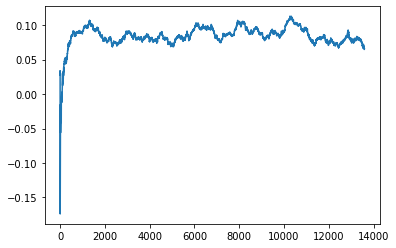

Thread: 1 iteration: 2200
RAM mDiffFit_90 FROM: 2624 --> 320 reward: 0.15930462460937503
Thread: 4 iteration: 2259
RAM mBackground_21 FROM: 2880 --> 640 reward: -0.2479605397265626
Thread: 5 iteration: 2353
RAM mDiffFit_264 FROM: 960 --> 2496 reward: 0.04991418007812498
Thread: 2 iteration: 2228
RAM mDiffFit_92 FROM: 960 --> 832 reward: -0.012255221093750001
Thread: 6 iteration: 2276
RAM mDiffFit_285 FROM: 448 --> 2496 reward: -0.049997323828125
Saving ...


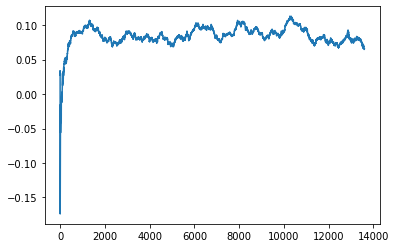

Thread: 4 iteration: 2260
RAM mDiffFit_381 FROM: 1152 --> 832 reward: 0.074729203125
Thread: 1 iteration: 2201
RAM mDiffFit_172 FROM: 1984 --> 960 reward: 0.010505177343750009
Thread: 5 iteration: 2354
RAM mDiffFit_83 FROM: 768 --> 2496 reward: 0.029586038671875012
Thread: 2 iteration: 2229
RAM mProject_51 FROM: 1472 --> 640 reward: -1.0
Thread: 3 iteration: 2278
RAM mDiffFit_339 FROM: 2240 --> 1792 reward: -0.07091154765624998
Thread: 5 iteration: 2355
RAM mDiffFit_355 FROM: 1472 --> 1792 reward: 0.014479203125
Thread: 4 iteration: 2261
RAM mDiffFit_22 FROM: 1664 --> 896 reward: 0.014385398437499995
Saving ...


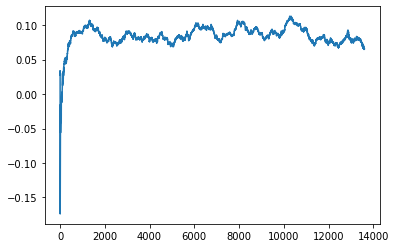

Thread: 2 iteration: 2230
RAM mDiffFit_156 FROM: 512 --> 896 reward: -0.25740632656250007
Thread: 1 iteration: 2202
RAM mDiffFit_343 FROM: 2560 --> 1792 reward: -0.015281282812499991
Thread: 5 iteration: 2356
RAM mDiffFit_303 FROM: 2048 --> 1792 reward: 0.014166681250000002
Thread: 3 iteration: 2279
RAM mDiffFit_80 FROM: 1536 --> 1792 reward: -0.057718804687500014
Thread: 4 iteration: 2262
RAM mDiffFit_141 FROM: 1280 --> 1792 reward: -0.10900008749999998
Thread: 1 iteration: 2203
RAM mDiffFit_277 FROM: 1280 --> 832 reward: -0.006531282812499966
Thread: 2 iteration: 2231
RAM mDiffFit_12 FROM: 2688 --> 320 reward: 0.1671353546875
Thread: 1 iteration: 2204
RAM mDiffFit_276 FROM: 2496 --> 1088 reward: -0.019481835546875017
Thread: 2 iteration: 2232
RAM mProject_80 FROM: 2944 --> 640 reward: -1.0
Thread: 6 iteration: 2277
RAM mBackground_51 FROM: 1664 --> 640 reward: 0.20178199014062503
Thread: 4 iteration: 2263
RAM mDiffFit_63 FROM: 256 --> 2496 reward: -0.1652395140625
Thread: 1 iteration

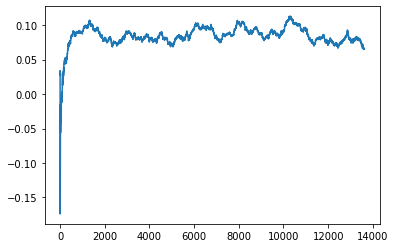

Thread: 3 iteration: 2280
RAM mDiffFit_42 FROM: 2560 --> 1088 reward: 0.006799447265624994
Saving ...


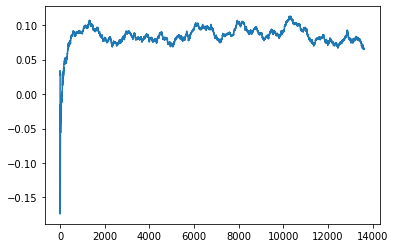

Thread: 6 iteration: 2280
RAM mDiffFit_180 FROM: 1152 --> 832 reward: 0.030484380468749992
Thread: 4 iteration: 2266
RAM mDiffFit_347 FROM: 1408 --> 832 reward: 0.034492190234375
Thread: 3 iteration: 2281
RAM mDiffFit_408 FROM: 2624 --> 320 reward: 0.13265097421875
Thread: 1 iteration: 2208
RAM mBackground_64 FROM: 2880 --> 640 reward: 0.0848912298828125
Thread: 5 iteration: 2358
RAM mDiffFit_12 FROM: 2240 --> 1088 reward: -0.010065154296875004
Thread: 6 iteration: 2281
RAM mDiffFit_355 FROM: 1024 --> 1792 reward: -0.04688539843749999
Thread: 5 iteration: 2359
RAM mDiffFit_337 FROM: 256 --> 1792 reward: -0.4259895578125
Thread: 1 iteration: 2209
RAM mBackground_19 FROM: 2176 --> 640 reward: 0.04224731187500001
Thread: 4 iteration: 2267
RAM mDiffFit_281 FROM: 1984 --> 1792 reward: 0.009658871484375005
Thread: 6 iteration: 2282
RAM mAdd_2 FROM: 640 --> 640 reward: -0.059825552734374954
Thread: 3 iteration: 2282
RAM mDiffFit_48 FROM: 1280 --> 256 reward: 0.30720836250000005
Saving ...


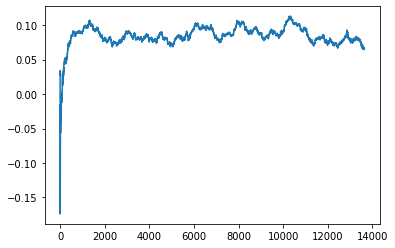

Thread: 1 iteration: 2210
RAM mProject_15 FROM: 1792 --> 640 reward: -1.0
Thread: 2 iteration: 2236
RAM mDiffFit_219 FROM: 320 --> 2496 reward: -0.106085863671875
Thread: 3 iteration: 2283
RAM mDiffFit_299 FROM: 1792 --> 960 reward: 0.031734380468750004
Thread: 1 iteration: 2211
RAM mBgModel_3 FROM: 128 --> 704 reward: 0.1738523334375
Thread: 6 iteration: 2283
RAM mDiffFit_161 FROM: 448 --> 2496 reward: -0.070455686328125
Thread: 2 iteration: 2237
RAM mDiffFit_255 FROM: 2688 --> 1792 reward: -0.025020884374999993
Thread: 3 iteration: 2284
RAM mDiffFit_285 FROM: 1856 --> 256 reward: 0.17666404882812498
Thread: 1 iteration: 2212
RAM mDiffFit_303 FROM: 1280 --> 256 reward: 0.44977088437500007
Thread: 6 iteration: 2284
RAM mDiffFit_124 FROM: 1984 --> 1088 reward: 0.07834639335937502
Thread: 2 iteration: 2238
RAM mDiffFit_391 FROM: 2560 --> 320 reward: 0.26173429296875006
Thread: 3 iteration: 2285
RAM mProject_78 FROM: 896 --> 640 reward: -1.0
Saving ...


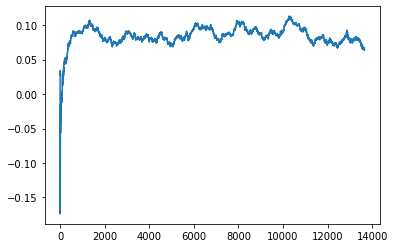

Thread: 5 iteration: 2360
RAM mBackground_54 FROM: 1472 --> 640 reward: 0.12485225090625007
Thread: 1 iteration: 2213
RAM mProject_67 FROM: 1920 --> 640 reward: -1.0
Thread: 4 iteration: 2268
RAM mBackground_62 FROM: 1664 --> 640 reward: 0.06977187726562503
Thread: 2 iteration: 2239
RAM mAdd_2 FROM: 256 --> 640 reward: 0.809409287109375
Thread: 6 iteration: 2285
RAM mDiffFit_27 FROM: 512 --> 1792 reward: -0.21459380468749997
Thread: 3 iteration: 2286
RAM mDiffFit_326 FROM: 2112 --> 1792 reward: 0.010299491015625002
Saving ...


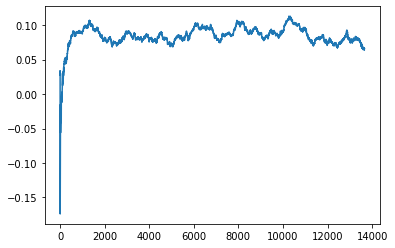

Thread: 2 iteration: 2240
RAM mDiffFit_116 FROM: 1664 --> 1152 reward: -0.07290632656249998
Thread: 5 iteration: 2361
RAM mDiffFit_323 FROM: 1152 --> 1792 reward: -0.050843760937500024
Thread: 6 iteration: 2286
RAM mDiffFit_99 FROM: 512 --> 2496 reward: -0.1114478765625
Thread: 2 iteration: 2241
RAM mDiffFit_396 FROM: 1664 --> 1088 reward: 0.03575780976562504
Thread: 3 iteration: 2287
RAM mDiffFit_273 FROM: 1408 --> 832 reward: 0.01954426992187501
Thread: 5 iteration: 2362
RAM mDiffFit_213 FROM: 1088 --> 1792 reward: -0.04553646015624999
Thread: 3 iteration: 2288
RAM mBackground_60 FROM: 256 --> 640 reward: -0.37268008692187504
Thread: 6 iteration: 2287
RAM mBackground_37 FROM: 1152 --> 640 reward: 0.08905924104687499
Thread: 2 iteration: 2242
RAM mBackground_48 FROM: 2560 --> 640 reward: 0.17376471328125
Thread: 5 iteration: 2363
RAM mProject_83 FROM: 1152 --> 640 reward: -1.0
Thread: 4 iteration: 2269
RAM mProject_72 FROM: 1600 --> 640 reward: -1.0
Thread: 1 iteration: 2214
RAM mDiff

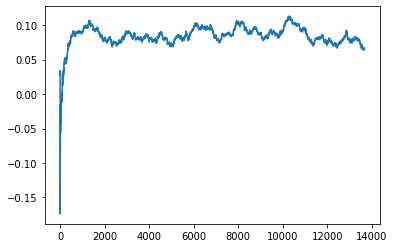

Thread: 3 iteration: 2290
RAM mBackground_39 FROM: 2368 --> 640 reward: 0.07236304617968749
Thread: 1 iteration: 2215
RAM mDiffFit_233 FROM: 1856 --> 320 reward: 0.229539005078125
Thread: 2 iteration: 2244
RAM mBackground_71 FROM: 1792 --> 640 reward: 0.11985348209374998
Thread: 6 iteration: 2289
RAM mDiffFit_186 FROM: 2240 --> 1088 reward: 0.0157603984375
Thread: 5 iteration: 2366
RAM mDiffFit_219 FROM: 1856 --> 1088 reward: -0.015125043750000003
Thread: 3 iteration: 2291
RAM mDiffFit_238 FROM: 256 --> 1792 reward: -0.159895796875
Thread: 2 iteration: 2245
RAM mDiffFit_69 FROM: 832 --> 960 reward: 0.22182568398437497
Thread: 1 iteration: 2216
RAM mDiffFit_193 FROM: 512 --> 256 reward: 0.2248333625
Saving ...


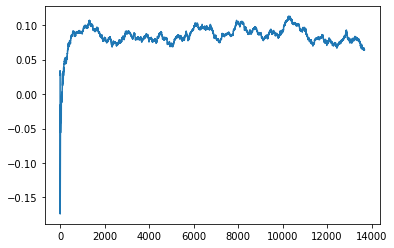

Thread: 6 iteration: 2290
RAM mDiffFit_35 FROM: 2048 --> 1792 reward: 0.012666681250000002
Thread: 3 iteration: 2292
RAM mDiffFit_184 FROM: 1472 --> 960 reward: 0.008502588671875002
Thread: 1 iteration: 2217
RAM mDiffFit_53 FROM: 1728 --> 2176 reward: 0.007820331640625003
Thread: 6 iteration: 2291
RAM mDiffFit_121 FROM: 2752 --> 320 reward: 0.16497652695312504
Thread: 5 iteration: 2367
RAM mProject_90 FROM: 640 --> 640 reward: -1.0
Saving ...


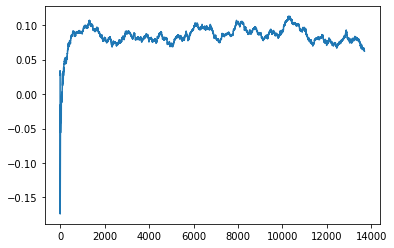

Thread: 4 iteration: 2270
RAM mDiffFit_197 FROM: 768 --> 832 reward: -0.0017656195312500123
Thread: 6 iteration: 2292
RAM mBackground_12 FROM: 896 --> 640 reward: 0.06661864426562503
Thread: 3 iteration: 2293
RAM mDiffFit_106 FROM: 2368 --> 320 reward: 0.18983331875000004
Thread: 4 iteration: 2271
RAM mDiffFit_255 FROM: 2624 --> 320 reward: 0.0792811078125
Thread: 5 iteration: 2368
RAM mDiffFit_409 FROM: 1536 --> 960 reward: 0.024242190234374995
Thread: 4 iteration: 2272
RAM mDiffFit_2 FROM: 2624 --> 320 reward: 0.23934626210937499
Thread: 3 iteration: 2294
RAM mProject_63 FROM: 640 --> 640 reward: -1.0
Thread: 2 iteration: 2246
RAM mDiffFit_165 FROM: 576 --> 1792 reward: -0.17659376093750007
Thread: 3 iteration: 2295
RAM mBackground_82 FROM: 2944 --> 640 reward: 0.11607298390624994
Thread: 4 iteration: 2273
RAM mDiffFit_295 FROM: 640 --> 2496 reward: -0.034580686328125
Thread: 4 iteration: 2274
RAM mDiffFit_204 FROM: 2496 --> 320 reward: 0.1076770359375
Thread: 2 iteration: 2247
RAM m

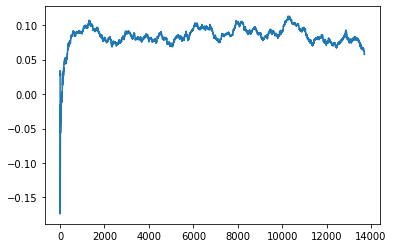

Thread: 1 iteration: 2220
RAM mConcatFit_1 FROM: 384 --> 896 reward: -0.3162958581250001
Thread: 4 iteration: 2276
RAM mDiffFit_248 FROM: 2560 --> 320 reward: 0.08903119531250002
Saving ...


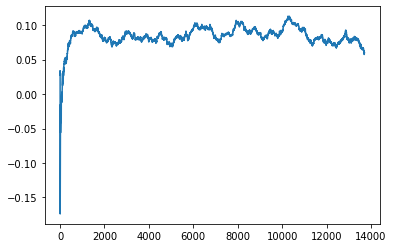

Thread: 2 iteration: 2250
RAM mDiffFit_174 FROM: 2496 --> 1088 reward: -0.007705773828124984
Thread: 4 iteration: 2277
RAM mDiffFit_398 FROM: 3008 --> 704 reward: -0.011872542578124992
Thread: 1 iteration: 2221
RAM mDiffFit_343 FROM: 640 --> 2496 reward: -0.07119528789062501
Saving ...


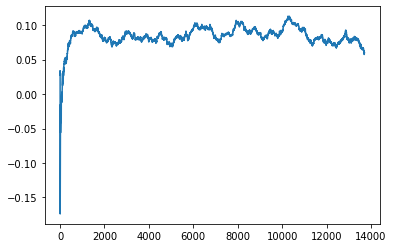

Thread: 5 iteration: 2370
RAM mDiffFit_192 FROM: 2368 --> 1088 reward: -0.0017213933593750001
Thread: 2 iteration: 2251
RAM mDiffFit_386 FROM: 1024 --> 896 reward: -0.0035573007812499807
Thread: 5 iteration: 2371
RAM mDiffFit_337 FROM: 192 --> 896 reward: -0.48003904882812504
Thread: 2 iteration: 2252
RAM mDiffFit_4 FROM: 2304 --> 320 reward: -0.007596524609374995
Thread: 2 iteration: 2253
RAM mProject_81 FROM: 1408 --> 640 reward: -1.0
Thread: 3 iteration: 2296
RAM mProject_22 FROM: 960 --> 640 reward: -1.0
Thread: 6 iteration: 2294
RAM mBackground_52 FROM: 1408 --> 640 reward: 0.14519665412500002
Thread: 2 iteration: 2254
RAM mDiffFit_374 FROM: 960 --> 256 reward: 0.17156769921875004
Thread: 3 iteration: 2297
RAM mDiffFit_120 FROM: 832 --> 960 reward: 0.034979203125
Thread: 6 iteration: 2295
RAM mDiffFit_68 FROM: 1664 --> 1792 reward: 0.0014843804687500028
Thread: 2 iteration: 2255
RAM mDiffFit_300 FROM: 320 --> 2496 reward: -0.09139838554687503
Thread: 3 iteration: 2298
RAM mProject

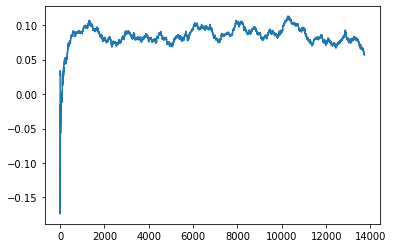

Thread: 3 iteration: 2300
RAM mDiffFit_383 FROM: 1024 --> 896 reward: -0.06293234453124999
Thread: 5 iteration: 2373
RAM mDiffFit_408 FROM: 2112 --> 2176 reward: -0.0021328097656249725
Thread: 3 iteration: 2301
RAM mDiffFit_42 FROM: 1856 --> 1088 reward: -0.0037526324218750164
Thread: 5 iteration: 2374
RAM mBackground_4 FROM: 960 --> 640 reward: 0.13320819667968742
Thread: 6 iteration: 2298
RAM mDiffFit_17 FROM: 2624 --> 1792 reward: -0.011648473046875019
Thread: 5 iteration: 2375
RAM mDiffFit_370 FROM: 384 --> 256 reward: -0.009619822656250047
Thread: 3 iteration: 2302
RAM mDiffFit_140 FROM: 1920 --> 1792 reward: -0.0056093804687499995
Thread: 5 iteration: 2376
RAM mDiffFit_413 FROM: 960 --> 832 reward: 0.019117190234374977
Thread: 3 iteration: 2303
RAM mProject_24 FROM: 128 --> 640 reward: -1.0
Thread: 4 iteration: 2279
RAM mDiffFit_371 FROM: 768 --> 832 reward: -0.013190110546874995
Thread: 3 iteration: 2304
RAM mDiffFit_170 FROM: 448 --> 832 reward: -0.043072920312500006
Saving ...

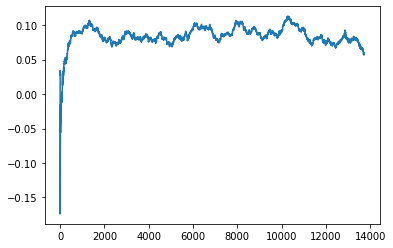

Thread: 4 iteration: 2280
RAM mDiffFit_289 FROM: 1280 --> 832 reward: 0.010789048828125005
Thread: 3 iteration: 2305
RAM mDiffFit_338 FROM: 2048 --> 1792 reward: -0.02430212343750001
Thread: 4 iteration: 2281
RAM mProject_9 FROM: 2880 --> 640 reward: -1.0
Thread: 2 iteration: 2256
RAM mProject_61 FROM: 1728 --> 640 reward: -1.0
Thread: 1 iteration: 2224
RAM mDiffFit_130 FROM: 1856 --> 1792 reward: -0.03282555273437498
Thread: 3 iteration: 2306
RAM mProject_89 FROM: 1984 --> 640 reward: -1.0
Thread: 6 iteration: 2299
RAM mDiffFit_306 FROM: 2688 --> 704 reward: 0.038315023046875014
Thread: 2 iteration: 2257
RAM mBackground_78 FROM: 1920 --> 640 reward: 0.1542803853125
Thread: 4 iteration: 2282
RAM mBackground_38 FROM: 1728 --> 640 reward: 0.13379939024218754
Thread: 1 iteration: 2225
RAM mDiffFit_107 FROM: 1024 --> 832 reward: -0.0013359511718749953
Thread: 3 iteration: 2307
RAM mProject_10 FROM: 1984 --> 640 reward: -1.0
Thread: 5 iteration: 2377
RAM mDiffFit_325 FROM: 1792 --> 832 rewa

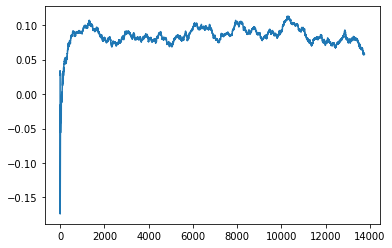

Thread: 6 iteration: 2300
RAM mBackground_88 FROM: 2112 --> 640 reward: 0.17659110664062494
Thread: 2 iteration: 2258
RAM mDiffFit_352 FROM: 896 --> 896 reward: 0.0077552210937499935
Thread: 3 iteration: 2308
RAM mDiffFit_407 FROM: 832 --> 896 reward: -0.014440110546875013
Thread: 5 iteration: 2378
RAM mBackground_19 FROM: 1664 --> 640 reward: 0.10917962635937495
Thread: 2 iteration: 2259
RAM mDiffFit_199 FROM: 1984 --> 2176 reward: 0.0006015707031250227
Thread: 3 iteration: 2309
RAM mDiffFit_323 FROM: 1984 --> 1088 reward: 0.02570568632812499
Thread: 5 iteration: 2379
RAM mDiffFit_331 FROM: 2560 --> 1088 reward: 0.008174447265625016
Saving ...


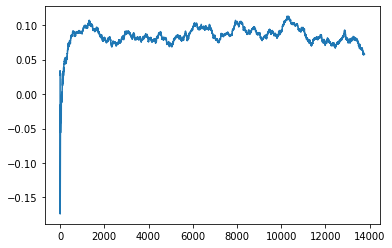

Thread: 2 iteration: 2260
RAM mDiffFit_213 FROM: 256 --> 896 reward: -0.3184479203125
Saving ...


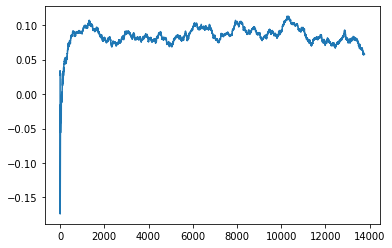

Thread: 3 iteration: 2310
RAM mDiffFit_5 FROM: 2304 --> 320 reward: 0.206104159375
Saving ...


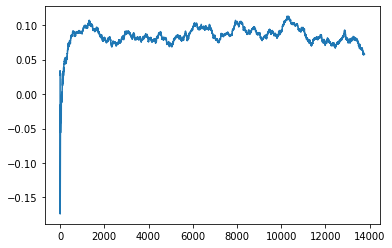

Thread: 5 iteration: 2380
RAM mProject_90 FROM: 2944 --> 640 reward: -1.0
Thread: 4 iteration: 2283
RAM mProject_31 FROM: 576 --> 640 reward: -1.0
Thread: 1 iteration: 2226
RAM mDiffFit_302 FROM: 1344 --> 1792 reward: -0.03719533164062498
Thread: 2 iteration: 2261
RAM mDiffFit_315 FROM: 320 --> 1792 reward: -0.130762987109375
Thread: 5 iteration: 2381
RAM mImgtbl_3 FROM: 832 --> 2112 reward: -0.2077603721875
Thread: 3 iteration: 2311
RAM mProject_6 FROM: 1856 --> 640 reward: -1.0
Thread: 6 iteration: 2301
RAM mDiffFit_205 FROM: 576 --> 960 reward: -0.021421858593749996
Thread: 4 iteration: 2284
RAM mDiffFit_125 FROM: 2496 --> 320 reward: 0.13173433671875
Thread: 5 iteration: 2382
RAM mDiffFit_281 FROM: 2304 --> 320 reward: 0.14564057578125
Thread: 3 iteration: 2312
RAM mBackground_76 FROM: 1728 --> 640 reward: 0.09855055915624997
Thread: 1 iteration: 2227
RAM mDiffFit_264 FROM: 1152 --> 2112 reward: -0.039015619531250004
Thread: 6 iteration: 2302
RAM mImgtbl_1 FROM: 1792 --> 2112 rewar

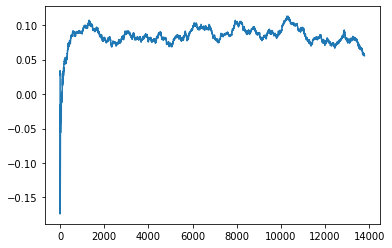

Thread: 1 iteration: 2230
RAM mViewer_3 FROM: 2432 --> 640 reward: 0.08126235562499999
Thread: 4 iteration: 2287
RAM mDiffFit_366 FROM: 448 --> 832 reward: -0.048979159375000005
Thread: 1 iteration: 2231
RAM mDiffFit_292 FROM: 2048 --> 2176 reward: 0.002734380468750004
Thread: 4 iteration: 2288
RAM mDiffFit_137 FROM: 1664 --> 2176 reward: -0.005036460156249995
Thread: 1 iteration: 2232
RAM mProject_66 FROM: 384 --> 640 reward: -1.0
Thread: 5 iteration: 2383
RAM mDiffFit_355 FROM: 1216 --> 1792 reward: -0.016458318749999982
Thread: 4 iteration: 2289
RAM mDiffFit_231 FROM: 768 --> 1792 reward: -0.1076562828125
Thread: 1 iteration: 2233
RAM mDiffFit_121 FROM: 1536 --> 1792 reward: 0.00566668125000001
Thread: 5 iteration: 2384
RAM mDiffFit_208 FROM: 1920 --> 1792 reward: 0.00526561953125
Saving ...


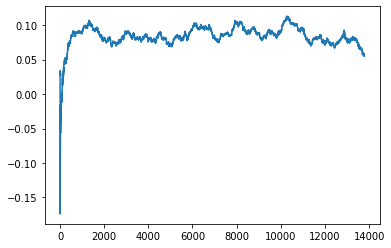

Thread: 4 iteration: 2290
RAM mProject_61 FROM: 128 --> 640 reward: -1.0
Thread: 3 iteration: 2314
RAM mProject_33 FROM: 2176 --> 640 reward: -1.0
Thread: 6 iteration: 2304
RAM mDiffFit_151 FROM: 2880 --> 704 reward: 0.08386977890625003
Thread: 1 iteration: 2234
RAM mBackground_42 FROM: 768 --> 640 reward: 0.06451792293750004
Thread: 5 iteration: 2385
RAM mProject_63 FROM: 768 --> 640 reward: -1.0
Thread: 2 iteration: 2262
RAM mDiffFit_273 FROM: 256 --> 2112 reward: -0.225270796875
Thread: 6 iteration: 2305
RAM mDiffFit_197 FROM: 2432 --> 640 reward: 0.050255177343749985
Thread: 3 iteration: 2315
RAM mDiffFit_238 FROM: 2240 --> 640 reward: 0.031031195312499985
Thread: 2 iteration: 2263
RAM mDiffFit_48 FROM: 1856 --> 1792 reward: -0.07801570703125
Thread: 4 iteration: 2291
RAM mDiffFit_10 FROM: 1344 --> 320 reward: 0.2638957531250001
Thread: 5 iteration: 2386
RAM mDiffFit_250 FROM: 2432 --> 1792 reward: -0.019979203125
Thread: 3 iteration: 2316
RAM mDiffFit_11 FROM: 1984 --> 1792 reward

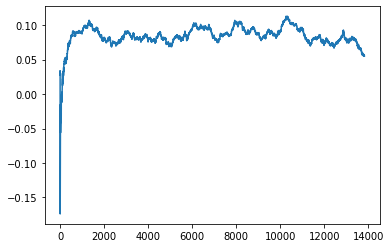

Thread: 3 iteration: 2320
RAM mDiffFit_317 FROM: 2560 --> 320 reward: 0.08053119531250001
Thread: 4 iteration: 2297
RAM mDiffFit_283 FROM: 2688 --> 320 reward: 0.08971345234374999
Thread: 2 iteration: 2269
RAM mBackground_89 FROM: 2112 --> 640 reward: 0.16030932796875
Thread: 1 iteration: 2239
RAM mDiffFit_393 FROM: 2688 --> 320 reward: 0.36913280976562496
Thread: 3 iteration: 2321
RAM mProject_4 FROM: 2432 --> 640 reward: -1.0
Saving ...


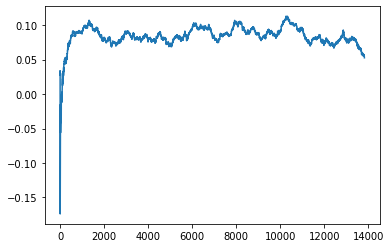

Thread: 5 iteration: 2390
RAM mProject_80 FROM: 384 --> 640 reward: -1.0
Thread: 6 iteration: 2309
RAM mBackground_41 FROM: 256 --> 640 reward: -0.3308760197187501
Thread: 4 iteration: 2298
RAM mDiffFit_363 FROM: 1728 --> 960 reward: 0.02076561953125
Saving ...


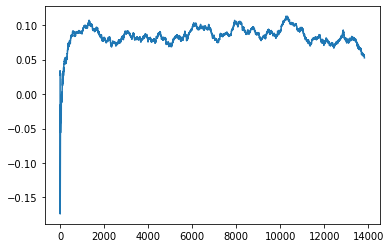

Thread: 1 iteration: 2240
RAM mDiffFit_170 FROM: 1984 --> 1088 reward: 0.025098938281250018
Thread: 3 iteration: 2322
RAM mDiffFit_369 FROM: 640 --> 2496 reward: -0.023705686328125003
Thread: 5 iteration: 2391
RAM mDiffFit_147 FROM: 960 --> 1792 reward: -0.04304685859375001
Thread: 4 iteration: 2299
RAM mDiffFit_280 FROM: 2944 --> 704 reward: 0.04608849609374999
Thread: 1 iteration: 2241
RAM mBackground_57 FROM: 1600 --> 640 reward: 0.16203608199218747
Saving ...


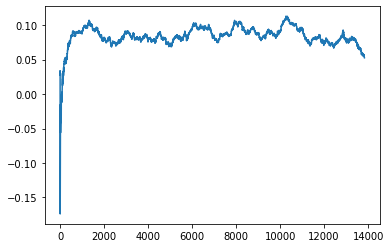

Thread: 6 iteration: 2310
RAM mDiffFit_36 FROM: 1408 --> 960 reward: 0.011635398437500003
Thread: 3 iteration: 2323
RAM mDiffFit_372 FROM: 1152 --> 832 reward: 0.0054062390624999915
Thread: 5 iteration: 2392
RAM mDiffFit_348 FROM: 1792 --> 2176 reward: 0.008203141406250003
Saving ...


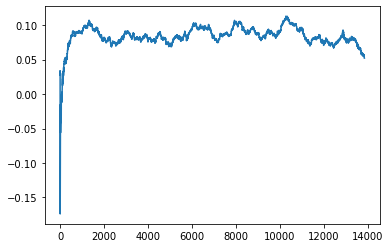

Thread: 4 iteration: 2300
RAM mDiffFit_221 FROM: 1792 --> 2112 reward: 0.02712504375
Thread: 1 iteration: 2242
RAM mDiffFit_394 FROM: 2688 --> 640 reward: -0.044984511718749995
Thread: 6 iteration: 2311
RAM mBackground_66 FROM: 1600 --> 640 reward: 0.11729363128906253
Thread: 3 iteration: 2324
RAM mProject_1 FROM: 256 --> 640 reward: -1.0
Saving ...


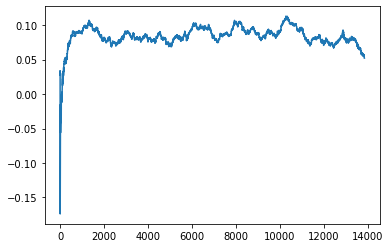

Thread: 2 iteration: 2270
RAM mDiffFit_164 FROM: 1088 --> 1792 reward: -0.11769278671874997
Thread: 5 iteration: 2393
RAM mDiffFit_161 FROM: 1344 --> 1792 reward: -0.0008046683593750017
Thread: 3 iteration: 2325
RAM mDiffFit_403 FROM: 1216 --> 896 reward: 0.008736969140624995
Thread: 6 iteration: 2312
RAM mDiffFit_52 FROM: 2816 --> 640 reward: 0.0011249124999999915
Thread: 2 iteration: 2271
RAM mBackground_2 FROM: 2880 --> 640 reward: 0.09538370523437499
Thread: 4 iteration: 2301
RAM mBackground_4 FROM: 2048 --> 640 reward: 0.1324220018124999
Thread: 1 iteration: 2243
RAM mDiffFit_202 FROM: 1984 --> 1088 reward: 0.044226570703125016
Thread: 3 iteration: 2326
RAM mDiffFit_405 FROM: 1344 --> 1792 reward: -0.017499999999999988
Thread: 4 iteration: 2302
RAM mBackground_38 FROM: 2624 --> 640 reward: 0.10955581992187499
Thread: 6 iteration: 2313
RAM mBackground_22 FROM: 640 --> 640 reward: 0.00940177867187494
Thread: 1 iteration: 2244
RAM mDiffFit_308 FROM: 1408 --> 832 reward: 0.00301820820

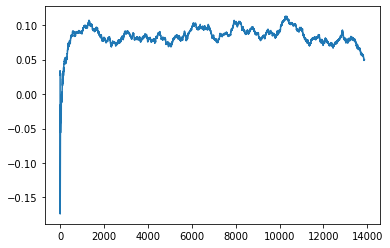

Thread: 3 iteration: 2330
RAM mDiffFit_279 FROM: 896 --> 1152 reward: -0.021479159375000015
Thread: 1 iteration: 2248
RAM mViewer_1 FROM: 1088 --> 640 reward: 0.06840622593750005
Thread: 5 iteration: 2395
RAM mDiffFit_415 FROM: 384 --> 896 reward: -0.0716770796875
Thread: 3 iteration: 2331
RAM mDiffFit_7 FROM: 896 --> 832 reward: -0.008153650390625
Thread: 1 iteration: 2249
RAM mBackground_84 FROM: 1408 --> 640 reward: 0.14261665412500005
Thread: 4 iteration: 2307
RAM mAdd_3 FROM: 2560 --> 1792 reward: 0.01858847421874997
Thread: 6 iteration: 2317
RAM mBackground_20 FROM: 512 --> 640 reward: -0.2136921523125
Thread: 5 iteration: 2396
RAM mDiffFit_391 FROM: 448 --> 1792 reward: -0.129914005078125
Thread: 6 iteration: 2318
RAM mDiffFit_177 FROM: 2752 --> 320 reward: 0.21381247812500004
Thread: 3 iteration: 2332
RAM mBackground_4 FROM: 448 --> 640 reward: -0.09984286066406248
Saving ...


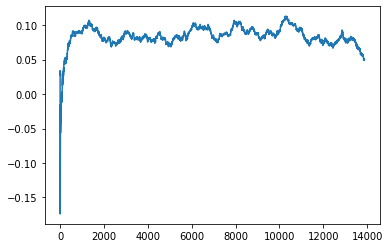

Thread: 1 iteration: 2250
RAM mDiffFit_237 FROM: 320 --> 256 reward: 0.11398179179687498
Thread: 4 iteration: 2308
RAM mProject_59 FROM: 2944 --> 640 reward: -1.0
Thread: 2 iteration: 2273
RAM mBackground_69 FROM: 2048 --> 640 reward: 0.06264997404687497
Thread: 3 iteration: 2333
RAM mBackground_75 FROM: 1856 --> 640 reward: 0.13014212635937505
Thread: 1 iteration: 2251
RAM mBackground_51 FROM: 1664 --> 640 reward: 0.14600737545312498
Thread: 4 iteration: 2309
RAM mBackground_28 FROM: 1792 --> 640 reward: 0.10733420342187502
Thread: 2 iteration: 2274
RAM mDiffFit_222 FROM: 2944 --> 640 reward: 0.04712495625
Thread: 1 iteration: 2252
RAM mDiffFit_387 FROM: 1920 --> 960 reward: 0.018664048828125005
Saving ...


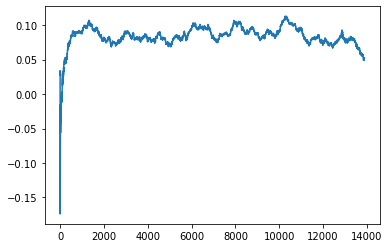

Thread: 4 iteration: 2310
RAM mBackground_9 FROM: 1536 --> 640 reward: 0.13523050985937504
Thread: 3 iteration: 2334
RAM mDiffFit_189 FROM: 640 --> 896 reward: -0.030124999999999978
Thread: 4 iteration: 2311
RAM mBackground_25 FROM: 1664 --> 640 reward: 0.13488559678125
Thread: 1 iteration: 2253
RAM mDiffFit_18 FROM: 2048 --> 1152 reward: 0.004562478125000003
Thread: 4 iteration: 2312
RAM mDiffFit_46 FROM: 320 --> 192 reward: 0.294104203125
Thread: 3 iteration: 2335
RAM mProject_75 FROM: 1856 --> 640 reward: -1.0
Thread: 5 iteration: 2397
RAM mProject_23 FROM: 1024 --> 640 reward: -1.0
Thread: 6 iteration: 2319
RAM mDiffFit_211 FROM: 2176 --> 2880 reward: 0.04179694609375001
Thread: 1 iteration: 2254
RAM mDiffFit_183 FROM: 576 --> 1792 reward: -0.15342444726562499
Thread: 3 iteration: 2336
RAM mDiffFit_290 FROM: 2432 --> 640 reward: 0.067687478125
Saving ...


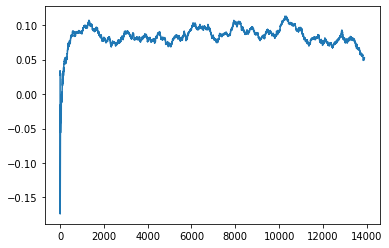

Thread: 6 iteration: 2320
RAM mBackground_72 FROM: 1984 --> 640 reward: 0.1419156214296875
Thread: 4 iteration: 2313
RAM mBackground_74 FROM: 1472 --> 640 reward: 0.15266343279687497
Thread: 5 iteration: 2398
RAM mProject_71 FROM: 2048 --> 640 reward: -1.0
Thread: 2 iteration: 2275
RAM mBackground_35 FROM: 3008 --> 640 reward: 0.07244586921875007
Thread: 1 iteration: 2255
RAM mDiffFit_151 FROM: 128 --> 1792 reward: -0.7272812390625
Thread: 2 iteration: 2276
RAM mBackground_26 FROM: 1344 --> 640 reward: 0.1509479229375
Thread: 3 iteration: 2337
RAM mDiffFit_282 FROM: 320 --> 384 reward: -0.074263030859375
Thread: 6 iteration: 2321
RAM mBackground_51 FROM: 1728 --> 640 reward: 0.392738024140625
Thread: 4 iteration: 2314
RAM mBackground_38 FROM: 1152 --> 640 reward: 0.08830674104687501
Thread: 2 iteration: 2277
RAM mDiffFit_193 FROM: 2752 --> 320 reward: 0.06381234687500004
Thread: 4 iteration: 2315
RAM mDiffFit_68 FROM: 1408 --> 448 reward: 0.17753904882812493
Thread: 6 iteration: 2322
R

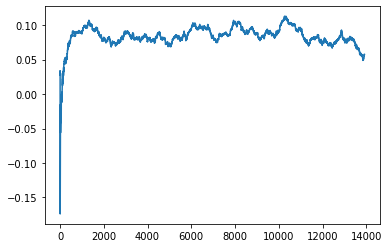

Thread: 5 iteration: 2400
RAM mDiffFit_293 FROM: 2048 --> 1152 reward: -0.0026875218750000048
Thread: 6 iteration: 2324
RAM mBackground_83 FROM: 1472 --> 640 reward: 0.11211797223437504
Thread: 2 iteration: 2279
RAM mProject_5 FROM: 2624 --> 640 reward: -1.0
Thread: 1 iteration: 2256
RAM mDiffFit_216 FROM: 2048 --> 1792 reward: 0.013041681249999996
Thread: 4 iteration: 2318
RAM mBackground_46 FROM: 1472 --> 640 reward: 0.1371990918515625
Thread: 5 iteration: 2401
RAM mBackground_27 FROM: 1280 --> 640 reward: 0.08586110664062498
Saving ...


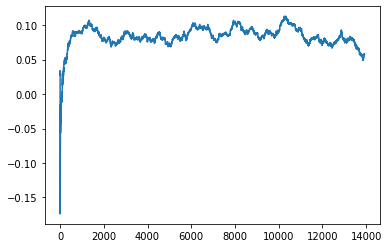

Thread: 2 iteration: 2280
RAM mDiffFit_331 FROM: 2880 --> 2304 reward: 0.074914136328125
Thread: 4 iteration: 2319
RAM mProject_10 FROM: 2752 --> 640 reward: -1.0
Thread: 3 iteration: 2339
RAM mDiffFit_341 FROM: 768 --> 896 reward: -0.022005221093750003
Thread: 2 iteration: 2281
RAM mDiffFit_106 FROM: 1024 --> 1792 reward: 0.03951048593749999
Saving ...


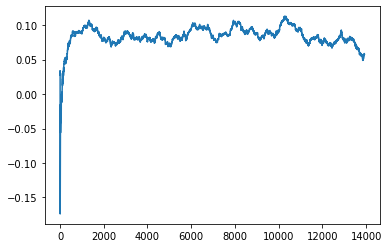

Thread: 4 iteration: 2320
RAM mBackground_71 FROM: 896 --> 640 reward: 0.068983644265625
Saving ...


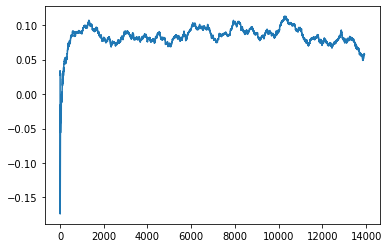

Thread: 3 iteration: 2340
RAM mDiffFit_147 FROM: 1280 --> 1792 reward: -0.06516668124999997
Thread: 5 iteration: 2402
RAM mDiffFit_59 FROM: 2432 --> 704 reward: 0.06848429296875003
Thread: 2 iteration: 2282
RAM mBackground_37 FROM: 192 --> 640 reward: -0.7208793409453124
Thread: 5 iteration: 2403
RAM mDiffFit_220 FROM: 1984 --> 1088 reward: 0.01747915937500001
Thread: 2 iteration: 2283
RAM mProject_58 FROM: 1600 --> 640 reward: -1.0
Thread: 6 iteration: 2325
RAM mProject_75 FROM: 704 --> 640 reward: -1.0
Thread: 1 iteration: 2257
RAM mDiffFit_79 FROM: 1472 --> 1792 reward: -0.083562565625
Thread: 3 iteration: 2341
RAM mDiffFit_63 FROM: 2368 --> 960 reward: 0.01717966835937501
Thread: 1 iteration: 2258
RAM mDiffFit_112 FROM: 1216 --> 192 reward: 0.27261977890625
Thread: 2 iteration: 2284
RAM mBackground_32 FROM: 2624 --> 640 reward: 0.072629513484375
Thread: 6 iteration: 2326
RAM mBackground_69 FROM: 2880 --> 640 reward: 0.08383192656249999
Thread: 3 iteration: 2342
RAM mDiffFit_325 FRO

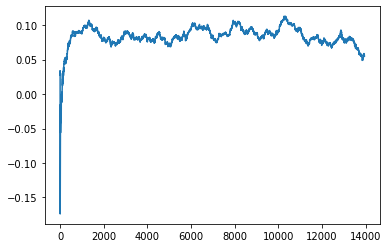

Thread: 1 iteration: 2260
RAM mDiffFit_413 FROM: 1216 --> 832 reward: 0.03228646015625
Thread: 6 iteration: 2328
RAM mDiffFit_165 FROM: 1536 --> 1152 reward: 0.002203097656249993
Thread: 2 iteration: 2286
RAM mProject_21 FROM: 640 --> 640 reward: -1.0
Thread: 5 iteration: 2404
RAM mBackground_44 FROM: 512 --> 640 reward: -0.12713669175
Thread: 4 iteration: 2322
RAM mDiffFit_289 FROM: 576 --> 896 reward: -0.00983331875
Thread: 1 iteration: 2261
RAM mDiffFit_420 FROM: 3008 --> 2304 reward: -0.048721437109375
Thread: 6 iteration: 2329
RAM mDiffFit_248 FROM: 256 --> 832 reward: -0.12119792031250001
Thread: 5 iteration: 2405
RAM mDiffFit_32 FROM: 1152 --> 1792 reward: -0.019052079687499994
Thread: 4 iteration: 2323
RAM mDiffFit_207 FROM: 576 --> 1792 reward: -0.071382809765625
Saving ...


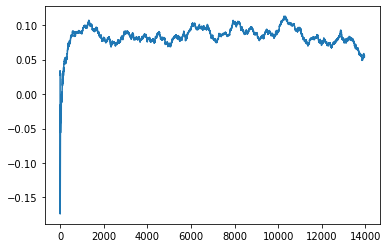

Thread: 6 iteration: 2330
RAM mBackground_12 FROM: 320 --> 640 reward: -0.218507163984375
Thread: 1 iteration: 2262
RAM mBackground_5 FROM: 512 --> 640 reward: -0.1213003360156249
Thread: 5 iteration: 2406
RAM mDiffFit_93 FROM: 2816 --> 640 reward: 0.016369735156249992
Thread: 4 iteration: 2324
RAM mProject_25 FROM: 576 --> 640 reward: -1.0
Thread: 3 iteration: 2344
RAM mImgtbl_1 FROM: 896 --> 2112 reward: -0.16721870843750006
Thread: 1 iteration: 2263
RAM mBackground_87 FROM: 2496 --> 640 reward: 0.12728437726562503
Thread: 6 iteration: 2331
RAM mDiffFit_247 FROM: 1792 --> 1792 reward: 0.021885442187499996
Thread: 3 iteration: 2345
RAM mDiffFit_406 FROM: 2048 --> 1792 reward: 0.011916681249999998
Thread: 6 iteration: 2332
RAM mProject_77 FROM: 192 --> 640 reward: -1.0
Thread: 2 iteration: 2287
RAM mDiffFit_377 FROM: 960 --> 256 reward: 0.29434898203125004
Thread: 4 iteration: 2325
RAM mDiffFit_245 FROM: 640 --> 2496 reward: -0.10130988945312502
Thread: 6 iteration: 2333
RAM mDiffFit_9

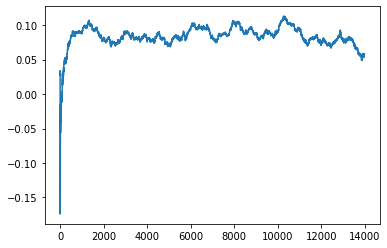

Thread: 5 iteration: 2410
RAM mDiffFit_372 FROM: 2240 --> 320 reward: 0.1279061953125
Thread: 3 iteration: 2347
RAM mProject_41 FROM: 1408 --> 640 reward: -1.0
Thread: 2 iteration: 2289
RAM mProject_55 FROM: 2752 --> 640 reward: -1.0
Thread: 6 iteration: 2334
RAM mDiffFit_316 FROM: 512 --> 832 reward: -0.046169269921875006
Thread: 5 iteration: 2411
RAM mDiffFit_272 FROM: 2240 --> 1792 reward: -0.005885442187500006
Saving ...


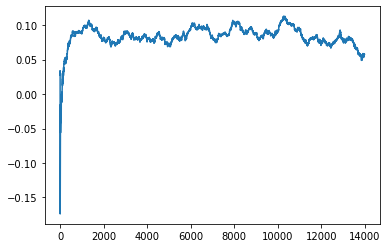

Thread: 2 iteration: 2290
RAM mDiffFit_26 FROM: 2432 --> 1792 reward: -0.010671902343750003
Thread: 5 iteration: 2412
RAM mViewer_3 FROM: 2112 --> 640 reward: 0.14247057928125
Thread: 3 iteration: 2348
RAM mDiffFit_215 FROM: 1408 --> 192 reward: 0.3039270796875
Thread: 6 iteration: 2335
RAM mProject_13 FROM: 1984 --> 640 reward: -1.0
Saving ...


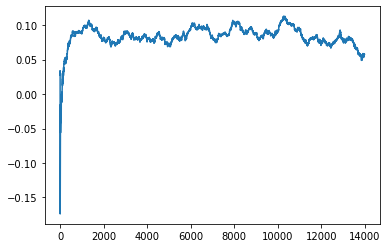

Thread: 4 iteration: 2330
RAM mDiffFit_231 FROM: 704 --> 448 reward: 0.1187083625
Thread: 6 iteration: 2336
RAM mDiffFit_70 FROM: 2432 --> 1792 reward: 0.39118787187500004
Thread: 5 iteration: 2413
RAM mBackground_56 FROM: 384 --> 640 reward: -0.22314313440624994
Thread: 4 iteration: 2331
RAM mProject_57 FROM: 1408 --> 640 reward: -1.0
Thread: 1 iteration: 2267
RAM mBgModel_1 FROM: 1088 --> 512 reward: 0.2762770796875
Thread: 3 iteration: 2349
RAM mDiffFit_123 FROM: 2944 --> 1792 reward: -0.1011147328125
Thread: 6 iteration: 2337
RAM mDiffFit_128 FROM: 1152 --> 2496 reward: 0.031406326562499996
Thread: 5 iteration: 2414
RAM mDiffFit_194 FROM: 1600 --> 960 reward: -0.00039325195312500325
Thread: 1 iteration: 2268
RAM mDiffFit_222 FROM: 1280 --> 2496 reward: -0.013627588671875027
Thread: 4 iteration: 2332
RAM mDiffFit_40 FROM: 1536 --> 832 reward: 0.012546858593749984
Thread: 6 iteration: 2338
RAM mDiffFit_418 FROM: 1728 --> 1792 reward: 0.00582292031249999
Thread: 1 iteration: 2269
RAM 

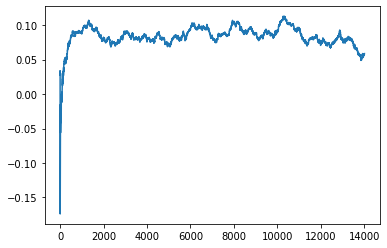

Thread: 1 iteration: 2270
RAM mDiffFit_392 FROM: 1600 --> 1792 reward: -0.0011562390624999912
Thread: 4 iteration: 2335
RAM mDiffFit_298 FROM: 320 --> 1792 reward: -0.356221393359375
Thread: 1 iteration: 2271
RAM mBackground_19 FROM: 1664 --> 640 reward: 0.251679913078125
Saving ...


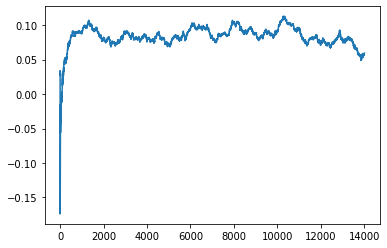

Thread: 6 iteration: 2340
RAM mProject_46 FROM: 384 --> 640 reward: -1.0
Saving ...


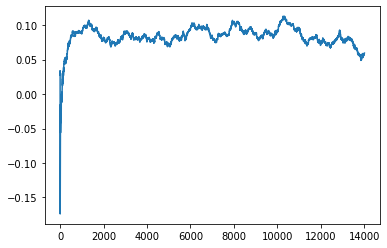

Thread: 3 iteration: 2350
RAM mDiffFit_207 FROM: 2496 --> 1088 reward: -0.017606835546874998
Thread: 4 iteration: 2336
RAM mDiffFit_100 FROM: 1088 --> 832 reward: -0.005937521875000011
Thread: 1 iteration: 2272
RAM mDiffFit_323 FROM: 384 --> 896 reward: -0.31176566328125
Thread: 6 iteration: 2341
RAM mBackground_40 FROM: 640 --> 640 reward: 0.017249278671874972
Thread: 3 iteration: 2351
RAM mDiffFit_140 FROM: 2048 --> 1792 reward: 0.008166681249999995
Thread: 1 iteration: 2273
RAM mDiffFit_355 FROM: 2880 --> 1792 reward: -0.04873187929687498
Thread: 4 iteration: 2337
RAM mProject_19 FROM: 2880 --> 640 reward: -1.0
Thread: 5 iteration: 2416
RAM mDiffFit_256 FROM: 832 --> 2112 reward: -0.040979159375000004
Thread: 5 iteration: 2417
RAM mDiffFit_357 FROM: 2240 --> 2176 reward: 0.045166725000000005
Thread: 1 iteration: 2274
RAM mProject_2 FROM: 1792 --> 640 reward: -1.0
Thread: 2 iteration: 2293
RAM mBackground_6 FROM: 1920 --> 640 reward: -0.04935619617187506
Thread: 4 iteration: 2338
RAM

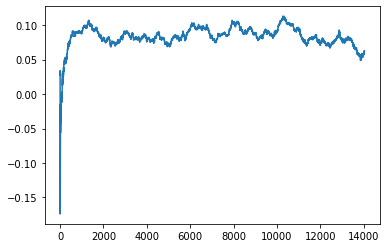

Thread: 5 iteration: 2420
RAM mDiffFit_229 FROM: 1536 --> 1792 reward: -0.015718760937500013
Thread: 3 iteration: 2353
RAM mDiffFit_292 FROM: 1664 --> 2176 reward: -0.013390619531249998
Thread: 5 iteration: 2421
RAM mBackground_17 FROM: 704 --> 640 reward: 0.052249490140625014
Thread: 6 iteration: 2344
RAM mDiffFit_264 FROM: 1664 --> 960 reward: 0.017619778906249987
Thread: 5 iteration: 2422
RAM mDiffFit_44 FROM: 704 --> 448 reward: 0.1135104421875
Thread: 6 iteration: 2345
RAM mProject_37 FROM: 1984 --> 640 reward: -1.0
Thread: 2 iteration: 2295
RAM mProject_29 FROM: 2560 --> 640 reward: -1.0
Saving ...


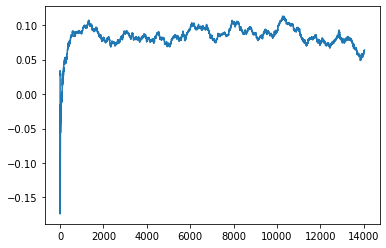

Thread: 4 iteration: 2340
RAM mDiffFit_37 FROM: 448 --> 2496 reward: -0.04589057578125001
Thread: 5 iteration: 2423
RAM mDiffFit_258 FROM: 2688 --> 2304 reward: 0.01970314140625002
Thread: 6 iteration: 2346
RAM mDiffFit_420 FROM: 832 --> 256 reward: 0.045843673437499996
Thread: 2 iteration: 2296
RAM mDiffFit_182 FROM: 2560 --> 1088 reward: -0.01207296406249999
Thread: 4 iteration: 2341
RAM mDiffFit_195 FROM: 1600 --> 384 reward: 0.1480520796875
Thread: 5 iteration: 2424
RAM mBackground_9 FROM: 2688 --> 640 reward: 0.12535831992187504
Thread: 6 iteration: 2347
RAM mProject_7 FROM: 2688 --> 640 reward: -1.0
Thread: 1 iteration: 2278
RAM mDiffFit_327 FROM: 832 --> 192 reward: 0.27960938046875
Thread: 2 iteration: 2297
RAM mDiffFit_150 FROM: 1664 --> 832 reward: 0.0024765269531249953
Thread: 5 iteration: 2425
RAM mProject_28 FROM: 1920 --> 640 reward: -1.0
Thread: 3 iteration: 2354
RAM mDiffFit_14 FROM: 320 --> 256 reward: -0.08868493320312497
Thread: 4 iteration: 2342
RAM mDiffFit_29 FROM

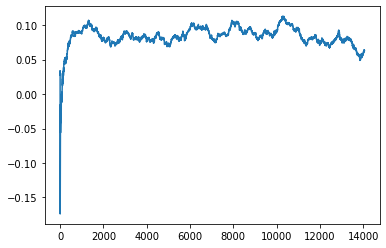

Thread: 1 iteration: 2280
RAM mProject_67 FROM: 1984 --> 640 reward: -1.0
Thread: 6 iteration: 2348
RAM mDiffFit_246 FROM: 1216 --> 448 reward: 0.08748696914062498
Thread: 3 iteration: 2356
RAM mDiffFit_327 FROM: 2880 --> 2304 reward: 0.007976570703125008
Thread: 5 iteration: 2428
RAM mDiffFit_409 FROM: 2368 --> 1792 reward: 0.05629690234375002
Thread: 4 iteration: 2345
RAM mDiffFit_243 FROM: 2368 --> 1792 reward: 0.1361563703125
Thread: 1 iteration: 2281
RAM mBackground_13 FROM: 2688 --> 640 reward: 0.084983070828125
Thread: 6 iteration: 2349
RAM mDiffFit_198 FROM: 2880 --> 1088 reward: -0.013033915234375009
Thread: 1 iteration: 2282
RAM mBackground_58 FROM: 1856 --> 640 reward: 0.11926447716406245
Thread: 3 iteration: 2357
RAM mDiffFit_393 FROM: 1984 --> 384 reward: 0.188351570703125
Thread: 5 iteration: 2429
RAM mDiffFit_28 FROM: 1984 --> 960 reward: 0.012421858593750015
Saving ...


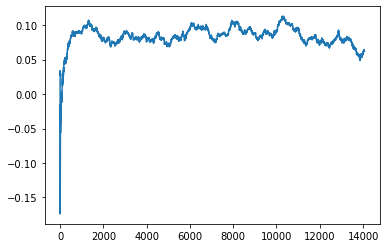

Thread: 6 iteration: 2350
RAM mProject_38 FROM: 2368 --> 640 reward: -1.0
Thread: 2 iteration: 2299
RAM mDiffFit_63 FROM: 2304 --> 1792 reward: -0.03234380468750002
Saving ...


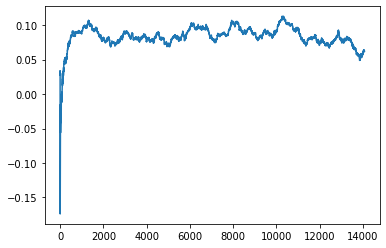

Thread: 5 iteration: 2430
RAM mBackground_61 FROM: 2112 --> 640 reward: 0.09954715100781251
Thread: 1 iteration: 2283
RAM mBackground_16 FROM: 1280 --> 640 reward: 0.08919360664062503
Thread: 3 iteration: 2358
RAM mDiffFit_64 FROM: 2880 --> 2304 reward: -0.03581256562500003
Thread: 5 iteration: 2431
RAM mDiffFit_305 FROM: 1792 --> 1792 reward: -0.01988544218750001
Thread: 1 iteration: 2284
RAM mDiffFit_307 FROM: 2304 --> 1792 reward: -0.006062521874999997
Thread: 3 iteration: 2359
RAM mProject_34 FROM: 1280 --> 640 reward: -1.0
Thread: 4 iteration: 2346
RAM mDiffFit_330 FROM: 3008 --> 2304 reward: -0.11254703359374998
Saving ...


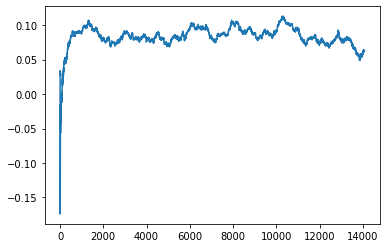

Thread: 3 iteration: 2360
RAM mDiffFit_103 FROM: 1536 --> 960 reward: 0.0014296683593749936
Thread: 1 iteration: 2285
RAM mDiffFit_201 FROM: 3008 --> 1088 reward: -0.029190198046875008
Thread: 4 iteration: 2347
RAM mDiffFit_323 FROM: 960 --> 896 reward: -0.08568756562499999
Thread: 3 iteration: 2361
RAM mDiffFit_115 FROM: 3008 --> 2304 reward: -0.007164092578125
Thread: 4 iteration: 2348
RAM mDiffFit_22 FROM: 128 --> 1792 reward: -0.7917396015625001
Thread: 3 iteration: 2362
RAM mProject_83 FROM: 512 --> 640 reward: -1.0
Thread: 6 iteration: 2351
RAM mProject_89 FROM: 896 --> 640 reward: -1.0
Saving ...


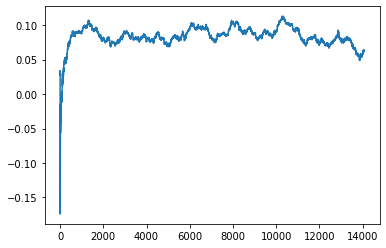

Thread: 2 iteration: 2300
RAM mDiffFit_58 FROM: 128 --> 2304 reward: -0.67440101796875
Thread: 2 iteration: 2301
RAM mDiffFit_412 FROM: 3008 --> 2304 reward: -0.083502719921875
Thread: 3 iteration: 2363
RAM mProject_40 FROM: 2432 --> 640 reward: -1.0
Thread: 5 iteration: 2432
RAM mDiffFit_38 FROM: 1408 --> 1792 reward: -0.07746358359375
Thread: 6 iteration: 2352
RAM mDiffFit_247 FROM: 1152 --> 384 reward: 0.14398438046875
Thread: 2 iteration: 2302
RAM mDiffFit_417 FROM: 1344 --> 1792 reward: -0.025445331640625006
Thread: 5 iteration: 2433
RAM mDiffFit_168 FROM: 384 --> 1792 reward: -0.18007814140625
Thread: 6 iteration: 2353
RAM mDiffFit_367 FROM: 2816 --> 1088 reward: -0.013041724999999999
Thread: 2 iteration: 2303
RAM mBackground_25 FROM: 448 --> 640 reward: -0.13840177867187495
Thread: 5 iteration: 2434
RAM mDiffFit_142 FROM: 256 --> 192 reward: 0.16874741132812496
Thread: 6 iteration: 2354
RAM mDiffFit_248 FROM: 448 --> 448 reward: -0.07295055273437502
Thread: 2 iteration: 2304
RAM

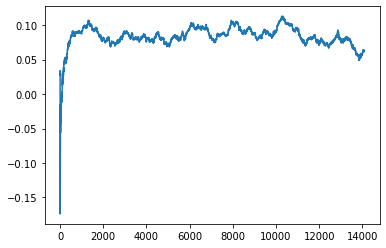

Thread: 4 iteration: 2350
RAM mProject_67 FROM: 960 --> 640 reward: -1.0
Thread: 1 iteration: 2286
RAM mProject_61 FROM: 960 --> 640 reward: -1.0
Thread: 3 iteration: 2364
RAM mDiffFit_391 FROM: 1088 --> 1792 reward: -0.03153904882812504
Thread: 5 iteration: 2436
RAM mDiffFit_268 FROM: 1536 --> 256 reward: 0.22097915937499996
Thread: 6 iteration: 2356
RAM mDiffFit_41 FROM: 2368 --> 1088 reward: -0.03670840625000001
Thread: 1 iteration: 2287
RAM mBackground_57 FROM: 1856 --> 640 reward: 0.12592947716406244
Thread: 4 iteration: 2351
RAM mDiffFit_54 FROM: 1216 --> 448 reward: 0.06470050898437499
Thread: 3 iteration: 2365
RAM mDiffFit_77 FROM: 1920 --> 1792 reward: -0.003234380468750001
Thread: 5 iteration: 2437
RAM mDiffFit_352 FROM: 128 --> 1792 reward: -0.7336927429687501
Thread: 1 iteration: 2288
RAM mDiffFit_371 FROM: 896 --> 192 reward: 0.22104426992187498
Thread: 6 iteration: 2357
RAM mDiffFit_159 FROM: 2240 --> 960 reward: 0.03127865039062501
Thread: 4 iteration: 2352
RAM mDiffFit_

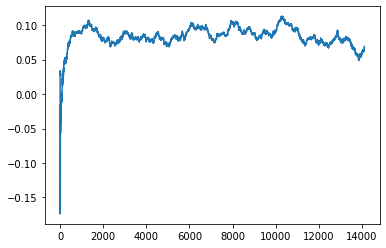

Thread: 1 iteration: 2290
RAM mDiffFit_220 FROM: 1536 --> 832 reward: -0.002002632421875001
Thread: 2 iteration: 2308
RAM mDiffFit_204 FROM: 2880 --> 320 reward: 1.821700990234375
Thread: 4 iteration: 2353
RAM mImgtbl_3 FROM: 1472 --> 2112 reward: -0.09209585812499987
Thread: 1 iteration: 2291
RAM mDiffFit_78 FROM: 1216 --> 1792 reward: -0.029388030859375004
Thread: 4 iteration: 2354
RAM mDiffFit_269 FROM: 704 --> 256 reward: 0.15023438046874998
Thread: 2 iteration: 2309
RAM mProject_2 FROM: 2560 --> 640 reward: -1.0
Thread: 5 iteration: 2438
RAM mDiffFit_295 FROM: 640 --> 832 reward: -0.02415365039062499
Thread: 4 iteration: 2355
RAM mDiffFit_393 FROM: 896 --> 2112 reward: 0.008130264843749999
Saving ...


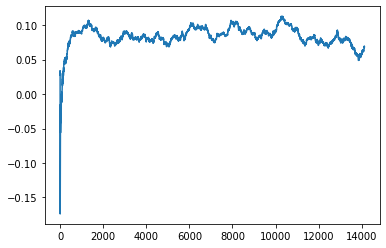

Thread: 2 iteration: 2310
RAM mProject_65 FROM: 3008 --> 640 reward: -1.0
Thread: 3 iteration: 2367
RAM mDiffFit_198 FROM: 2240 --> 2880 reward: 0.007921902343750002
Thread: 5 iteration: 2439
RAM mProject_7 FROM: 1792 --> 640 reward: -1.0
Thread: 6 iteration: 2359
RAM mDiffFit_370 FROM: 1408 --> 1792 reward: -0.033223982031249995
Thread: 3 iteration: 2368
RAM mDiffFit_164 FROM: 1984 --> 320 reward: 0.179132809765625
Thread: 2 iteration: 2311
RAM mDiffFit_152 FROM: 2688 --> 2304 reward: -0.011812521874999989
Saving ...


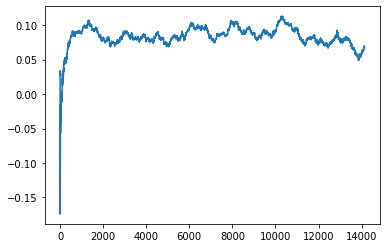

Thread: 6 iteration: 2360
RAM mDiffFit_139 FROM: 2304 --> 1792 reward: -0.004989601562499987
Thread: 3 iteration: 2369
RAM mDiffFit_172 FROM: 2944 --> 1792 reward: -0.005598982031249991
Thread: 2 iteration: 2312
RAM mProject_77 FROM: 1408 --> 640 reward: -1.0
Thread: 1 iteration: 2292
RAM mDiffFit_418 FROM: 256 --> 2496 reward: -0.1357186734375
Thread: 2 iteration: 2313
RAM mBackground_76 FROM: 2816 --> 640 reward: 0.009840457953125017
Thread: 6 iteration: 2361
RAM mBackground_77 FROM: 2112 --> 640 reward: 0.12238642967968746
Thread: 1 iteration: 2293
RAM mProject_16 FROM: 1984 --> 640 reward: -1.0
Thread: 4 iteration: 2356
RAM mDiffFit_367 FROM: 768 --> 448 reward: 0.012276017968749983
Thread: 6 iteration: 2362
RAM mDiffFit_411 FROM: 2816 --> 320 reward: 0.3254400230468749
Thread: 2 iteration: 2314
RAM mDiffFit_277 FROM: 1856 --> 1792 reward: -0.07697143710937498
Thread: 2 iteration: 2315
RAM mProject_67 FROM: 2112 --> 640 reward: -1.0
Saving ...


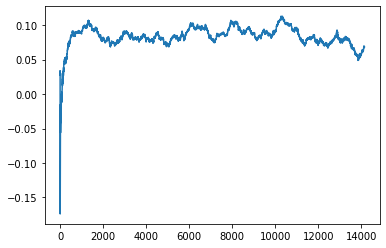

Thread: 5 iteration: 2440
RAM mDiffFit_7 FROM: 1024 --> 192 reward: 0.214187478125
Thread: 6 iteration: 2363
RAM mDiffFit_108 FROM: 128 --> 1792 reward: -0.53579685859375
Thread: 5 iteration: 2441
RAM mProject_63 FROM: 1920 --> 640 reward: -1.0
Saving ...


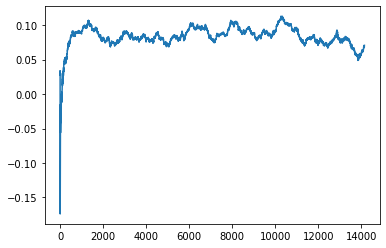

Thread: 3 iteration: 2370
RAM mDiffFit_247 FROM: 3008 --> 704 reward: 0.15506252187500003
Thread: 3 iteration: 2371
RAM mDiffFit_408 FROM: 1536 --> 832 reward: 0.03573438046874999
Thread: 3 iteration: 2372
RAM mProject_53 FROM: 320 --> 640 reward: -1.0
Thread: 1 iteration: 2294
RAM mDiffFit_401 FROM: 1152 --> 832 reward: 0.0038098894531250066
Thread: 3 iteration: 2373
RAM mDiffFit_141 FROM: 960 --> 256 reward: 0.085815066796875
Thread: 1 iteration: 2295
RAM mProject_71 FROM: 2688 --> 640 reward: -1.0
Thread: 4 iteration: 2357
RAM mBackground_48 FROM: 960 --> 640 reward: 0.11079891800781251
Thread: 3 iteration: 2374
RAM mDiffFit_134 FROM: 320 --> 896 reward: -0.14673438046875004
Thread: 4 iteration: 2358
RAM mProject_66 FROM: 2688 --> 640 reward: -1.0
Thread: 2 iteration: 2316
RAM mDiffFit_17 FROM: 320 --> 192 reward: 0.08963280976562502
Thread: 1 iteration: 2296
RAM mProject_19 FROM: 1472 --> 640 reward: -1.0
Thread: 6 iteration: 2364
RAM mProject_32 FROM: 2688 --> 640 reward: -1.0
Thr

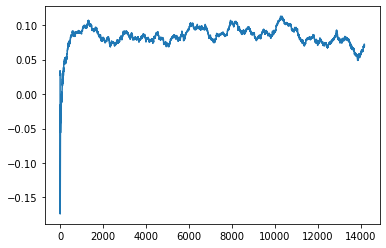

Thread: 4 iteration: 2360
RAM mDiffFit_409 FROM: 640 --> 2496 reward: -0.032580686328125
Thread: 5 iteration: 2444
RAM mDiffFit_409 FROM: 384 --> 832 reward: -0.05365623906250004
Thread: 2 iteration: 2318
RAM mDiffFit_343 FROM: 320 --> 448 reward: -0.061388030859375
Thread: 1 iteration: 2298
RAM mDiffFit_132 FROM: 2048 --> 1792 reward: -0.0645104859375
Thread: 3 iteration: 2376
RAM mDiffFit_157 FROM: 2496 --> 2304 reward: 0.023304712109375007
Thread: 4 iteration: 2361
RAM mDiffFit_149 FROM: 2176 --> 1792 reward: -0.005562521875
Thread: 5 iteration: 2445
RAM mDiffFit_47 FROM: 2560 --> 1792 reward: -0.06923968906250003
Thread: 1 iteration: 2299
RAM mBackground_2 FROM: 512 --> 640 reward: -0.05523707706249996
Thread: 2 iteration: 2319
RAM mProject_25 FROM: 1856 --> 640 reward: -1.0
Thread: 6 iteration: 2365
RAM mDiffFit_405 FROM: 2112 --> 960 reward: 0.01756247812500001
Thread: 4 iteration: 2362
RAM mDiffFit_111 FROM: 2752 --> 1088 reward: -0.03002351679687501
Thread: 6 iteration: 2366
RA

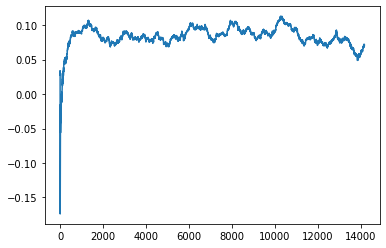

Thread: 1 iteration: 2300
RAM mBackground_18 FROM: 1600 --> 640 reward: 0.12499110664062499
Saving ...


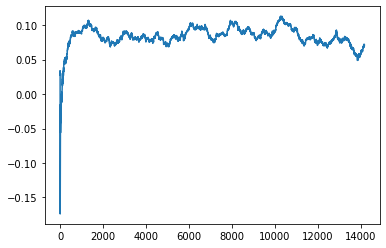

Thread: 2 iteration: 2320
RAM mDiffFit_2 FROM: 512 --> 1792 reward: -0.3438334062499999
Thread: 4 iteration: 2363
RAM mDiffFit_355 FROM: 1920 --> 1792 reward: -0.02214066328125
Thread: 1 iteration: 2301
RAM mDiffFit_417 FROM: 1088 --> 384 reward: 0.117169269921875
Thread: 2 iteration: 2321
RAM mBackground_64 FROM: 2176 --> 640 reward: 0.12108522314062495
Thread: 6 iteration: 2367
RAM mProject_52 FROM: 2368 --> 640 reward: -1.0
Thread: 3 iteration: 2377
RAM mDiffFit_105 FROM: 1984 --> 2880 reward: 0.053523516796875024
Thread: 2 iteration: 2322
RAM mDiffFit_49 FROM: 1280 --> 384 reward: 0.10420309765625002
Thread: 1 iteration: 2302
RAM mDiffFit_223 FROM: 704 --> 448 reward: -0.014177123437500022
Thread: 6 iteration: 2368
RAM mDiffFit_183 FROM: 1344 --> 1792 reward: -0.10203132656250001
Thread: 4 iteration: 2364
RAM mProject_5 FROM: 896 --> 640 reward: -1.0
Thread: 5 iteration: 2446
RAM mDiffFit_170 FROM: 512 --> 1792 reward: -0.03815619531249998
Thread: 3 iteration: 2378
RAM mDiffFit_84 

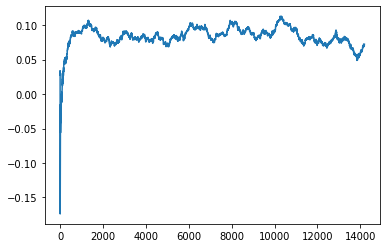

Thread: 3 iteration: 2380
RAM mProject_82 FROM: 1792 --> 2880 reward: 0.1800453701250001
Thread: 4 iteration: 2365
RAM mBackground_8 FROM: 128 --> 640 reward: -1.27841690321875
Thread: 2 iteration: 2325
RAM mDiffFit_153 FROM: 960 --> 1792 reward: -0.053945331640625
Thread: 2 iteration: 2326
RAM mBackground_84 FROM: 960 --> 640 reward: 0.06426930332031247
Thread: 3 iteration: 2381
RAM mDiffFit_208 FROM: 2496 --> 1792 reward: -0.04331256562500001
Thread: 2 iteration: 2327
RAM mDiffFit_354 FROM: 2432 --> 1792 reward: -0.0354896453125
Thread: 3 iteration: 2382
RAM mDiffFit_318 FROM: 1472 --> 256 reward: 0.23088017734375005
Thread: 2 iteration: 2328
RAM mProject_32 FROM: 1216 --> 640 reward: -1.0
Thread: 5 iteration: 2447
RAM mProject_18 FROM: 640 --> 640 reward: -1.0
Thread: 1 iteration: 2304
RAM mProject_10 FROM: 2624 --> 640 reward: -1.0
Saving ...


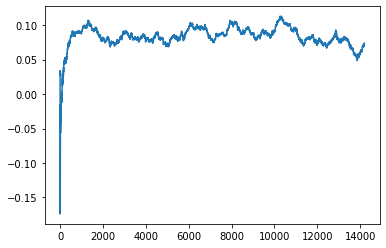

Thread: 6 iteration: 2370
RAM mDiffFit_47 FROM: 2176 --> 1792 reward: -0.03905734453125
Thread: 5 iteration: 2448
RAM mBackground_43 FROM: 1344 --> 640 reward: 0.09766146730468749
Thread: 3 iteration: 2383
RAM mDiffFit_24 FROM: 1472 --> 1152 reward: 0.028763030859374986
Thread: 1 iteration: 2305
RAM mDiffFit_255 FROM: 1920 --> 2112 reward: -0.018828141406249995
Thread: 6 iteration: 2371
RAM mDiffFit_146 FROM: 1792 --> 1088 reward: -0.020802123437500004
Thread: 3 iteration: 2384
RAM mProject_37 FROM: 1280 --> 640 reward: -1.0
Thread: 4 iteration: 2366
RAM mDiffFit_24 FROM: 2624 --> 2880 reward: 0.07210946796875001
Thread: 5 iteration: 2449
RAM mProject_4 FROM: 2304 --> 2880 reward: 0.08797940627343742
Thread: 2 iteration: 2329
RAM mDiffFit_26 FROM: 2496 --> 1792 reward: -0.01528909257812499
Thread: 1 iteration: 2306
RAM mDiffFit_212 FROM: 2048 --> 1792 reward: -0.0045937609375
Thread: 6 iteration: 2372
RAM mDiffFit_244 FROM: 576 --> 2496 reward: -0.02314834179687501
Thread: 3 iteration:

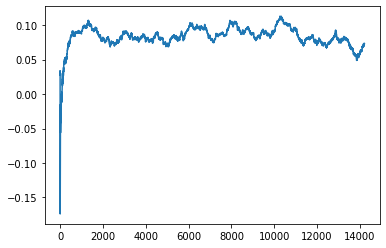

Thread: 2 iteration: 2330
RAM mDiffFit_99 FROM: 512 --> 256 reward: 0.08618747812500001
Saving ...


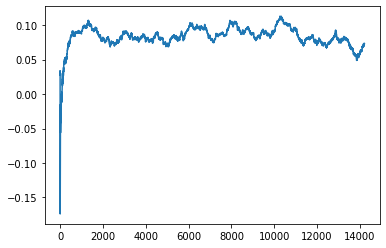

Thread: 5 iteration: 2450
RAM mDiffFit_174 FROM: 2240 --> 1792 reward: -0.0015703316406250056
Thread: 3 iteration: 2386
RAM mBackground_51 FROM: 384 --> 2880 reward: -0.19234413984375007
Thread: 6 iteration: 2373
RAM mDiffFit_167 FROM: 704 --> 2496 reward: -0.005622323828124998
Thread: 2 iteration: 2331
RAM mDiffFit_50 FROM: 2816 --> 704 reward: 0.054869691406250025
Thread: 5 iteration: 2451
RAM mDiffFit_321 FROM: 2112 --> 1088 reward: -0.0016276324218749902
Thread: 6 iteration: 2374
RAM mDiffFit_298 FROM: 2240 --> 1088 reward: -0.024312565625000004
Thread: 5 iteration: 2452
RAM mProject_81 FROM: 448 --> 2880 reward: 0.7946194267968751
Thread: 1 iteration: 2307
RAM mDiffFit_251 FROM: 768 --> 192 reward: 0.25627342929687497
Thread: 3 iteration: 2387
RAM mBackground_79 FROM: 1984 --> 640 reward: 0.15174740010156249
Thread: 2 iteration: 2332
RAM mProject_83 FROM: 2176 --> 2880 reward: 0.13863073633593753
Thread: 4 iteration: 2368
RAM mDiffFit_25 FROM: 640 --> 2496 reward: -0.0224556863281

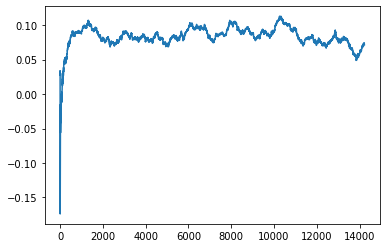

Thread: 4 iteration: 2370
RAM mBackground_54 FROM: 1472 --> 640 reward: 0.1282922509062501
Thread: 6 iteration: 2376
RAM mDiffFit_293 FROM: 1088 --> 256 reward: 0.13810152695312497
Thread: 3 iteration: 2389
RAM mProject_54 FROM: 2240 --> 2880 reward: 0.12405305039062502
Thread: 1 iteration: 2308
RAM mDiffFit_422 FROM: 1408 --> 2112 reward: 0.024427123437500003
Thread: 5 iteration: 2455
RAM mDiffFit_250 FROM: 832 --> 832 reward: -0.016174491015624997
Thread: 4 iteration: 2371
RAM mDiffFit_78 FROM: 1600 --> 1792 reward: 0.007226570703124987
Thread: 4 iteration: 2372
RAM mDiffFit_335 FROM: 3008 --> 704 reward: 0.065122367578125
Thread: 5 iteration: 2456
RAM mProject_25 FROM: 256 --> 640 reward: -1.0
Thread: 2 iteration: 2333
RAM mAdd_2 FROM: 3008 --> 1792 reward: -0.19745478574218753
Saving ...


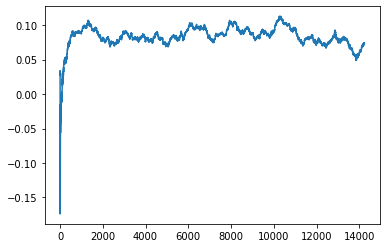

Thread: 3 iteration: 2390
RAM mProject_46 FROM: 2816 --> 2112 reward: -0.12035414988281265
Thread: 6 iteration: 2377
RAM mDiffFit_335 FROM: 2752 --> 1088 reward: -0.0026771234374999876
Thread: 4 iteration: 2373
RAM mDiffFit_44 FROM: 256 --> 2496 reward: -0.12452338554687503
Thread: 2 iteration: 2334
RAM mDiffFit_281 FROM: 2752 --> 704 reward: -0.06355747578125
Thread: 2 iteration: 2335
RAM mConcatFit_3 FROM: 1920 --> 896 reward: 0.08430831875
Thread: 4 iteration: 2374
RAM mProject_52 FROM: 2240 --> 2880 reward: 0.12159023625000005
Thread: 5 iteration: 2457
RAM mDiffFit_50 FROM: 2368 --> 704 reward: -0.05143769687499997
Thread: 3 iteration: 2391
RAM mProject_75 FROM: 2816 --> 640 reward: -1.0
Thread: 1 iteration: 2309
RAM mProject_88 FROM: 384 --> 2880 reward: 0.8073797540625001
Thread: 6 iteration: 2378
RAM mDiffFit_396 FROM: 1088 --> 1792 reward: -0.01851298710937501
Thread: 5 iteration: 2458
RAM mDiffFit_236 FROM: 1984 --> 2112 reward: 0.03839847304687502
Thread: 4 iteration: 2375
RA

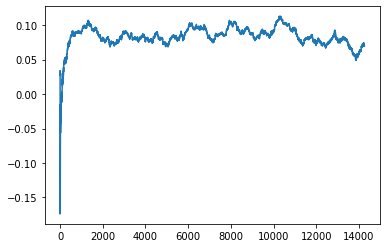

Thread: 1 iteration: 2310
RAM mDiffFit_182 FROM: 2368 --> 1088 reward: -0.048573007812499985
Thread: 5 iteration: 2459
RAM mDiffFit_243 FROM: 2944 --> 704 reward: 0.06041400507812499
Saving ...


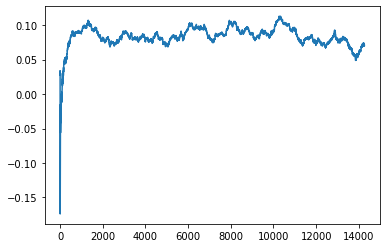

Thread: 6 iteration: 2380
RAM mDiffFit_82 FROM: 1536 --> 1792 reward: -0.03308336250000002
Thread: 2 iteration: 2338
RAM mBackground_27 FROM: 2368 --> 2880 reward: 0.06115640633593746
Thread: 4 iteration: 2377
RAM mDiffFit_268 FROM: 1408 --> 1792 reward: -0.013713539843749987
Thread: 1 iteration: 2311
RAM mDiffFit_158 FROM: 256 --> 1792 reward: -0.29750000000000004
Thread: 3 iteration: 2394
RAM mDiffFit_59 FROM: 1600 --> 1792 reward: 0.0015703316406250056
Saving ...


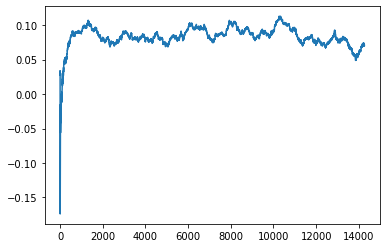

Thread: 5 iteration: 2460
RAM mDiffFit_150 FROM: 1280 --> 448 reward: 0.03499736757812501
Thread: 6 iteration: 2381
RAM mDiffFit_94 FROM: 2176 --> 1792 reward: -0.011031282812500025
Thread: 1 iteration: 2312
RAM mDiffFit_267 FROM: 1344 --> 1792 reward: 0.012135442187499994
Thread: 3 iteration: 2395
RAM mDiffFit_29 FROM: 2176 --> 256 reward: 0.14358327499999998
Thread: 2 iteration: 2339
RAM mDiffFit_297 FROM: 1856 --> 2176 reward: -0.022072920312500004
Thread: 6 iteration: 2382
RAM mDiffFit_317 FROM: 1088 --> 2176 reward: 0.0034922339843750094
Thread: 1 iteration: 2313
RAM mProject_53 FROM: 768 --> 2880 reward: 0.817845081328125
Thread: 4 iteration: 2378
RAM mBackground_44 FROM: 2688 --> 640 reward: 0.12533590684375004
Thread: 3 iteration: 2396
RAM mBackground_6 FROM: 704 --> 640 reward: 0.04169656720312501
Saving ...


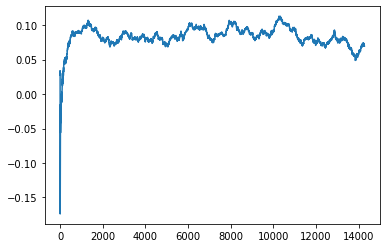

Thread: 2 iteration: 2340
RAM mProject_26 FROM: 2304 --> 2880 reward: 0.11282084353125015
Thread: 5 iteration: 2461
RAM mDiffFit_76 FROM: 1728 --> 1792 reward: 0.015502632421874989
Thread: 6 iteration: 2383
RAM mDiffFit_78 FROM: 2304 --> 1792 reward: 0.007447920312500002
Thread: 1 iteration: 2314
RAM mDiffFit_323 FROM: 2944 --> 704 reward: 0.09269002304687503
Thread: 4 iteration: 2379
RAM mDiffFit_215 FROM: 1984 --> 1792 reward: -0.003601570703124996
Thread: 1 iteration: 2315
RAM mBackground_5 FROM: 960 --> 2880 reward: 0.015513770117187598
Thread: 6 iteration: 2384
RAM mImgtbl_1 FROM: 1536 --> 2112 reward: -0.0007499475000000144
Thread: 5 iteration: 2462
RAM mDiffFit_179 FROM: 2624 --> 704 reward: 0.17938017734374995
Thread: 2 iteration: 2341
RAM mAdd_3 FROM: 1600 --> 1792 reward: 0.0025950771484375967
Thread: 3 iteration: 2397
RAM mDiffFit_361 FROM: 2944 --> 1088 reward: -0.01815110546875
Thread: 6 iteration: 2385
RAM mDiffFit_116 FROM: 2432 --> 1088 reward: -0.0316563265625
Thread: 

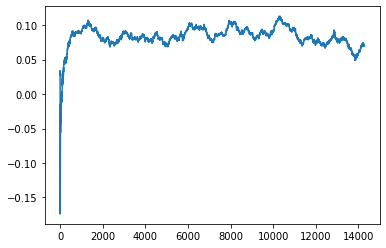

Thread: 4 iteration: 2380
RAM mBackground_39 FROM: 1344 --> 2880 reward: 0.020452016093750053
Thread: 5 iteration: 2463
RAM mDiffFit_201 FROM: 704 --> 2496 reward: -0.03352338554687499
Thread: 2 iteration: 2342
RAM mDiffFit_229 FROM: 256 --> 2496 reward: -0.11977338554687501
Thread: 6 iteration: 2386
RAM mDiffFit_339 FROM: 128 --> 1792 reward: -0.8166249999999999
Thread: 4 iteration: 2381
RAM mDiffFit_262 FROM: 2112 --> 1088 reward: 0.007122367578125
Thread: 2 iteration: 2343
RAM mDiffFit_45 FROM: 2944 --> 704 reward: 0.09950258867187499
Thread: 5 iteration: 2464
RAM mDiffFit_245 FROM: 960 --> 192 reward: 0.28472657070312496
Thread: 1 iteration: 2317
RAM mDiffFit_144 FROM: 1792 --> 2880 reward: 0.003231791796875008
Thread: 6 iteration: 2387
RAM mDiffFit_57 FROM: 2496 --> 1088 reward: 0.004916637500000012
Thread: 4 iteration: 2382
RAM mDiffFit_133 FROM: 960 --> 1792 reward: 0.0046120128906249926
Thread: 1 iteration: 2318
RAM mDiffFit_373 FROM: 2624 --> 2304 reward: 0.074632897265625
Thr

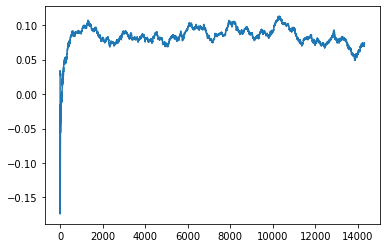

Thread: 1 iteration: 2320
RAM mDiffFit_321 FROM: 2368 --> 768 reward: 0.062239557812499985
Thread: 2 iteration: 2345
RAM mDiffFit_356 FROM: 1472 --> 1792 reward: -0.010963539843749995
Saving ...


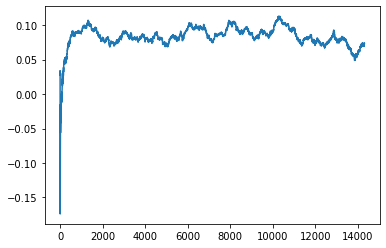

Thread: 6 iteration: 2390
RAM mDiffFit_236 FROM: 1728 --> 1088 reward: 0.0010182082031250095
Thread: 4 iteration: 2385
RAM mDiffFit_268 FROM: 1344 --> 1088 reward: -0.03900785351562498
Thread: 2 iteration: 2346
RAM mBackground_34 FROM: 960 --> 2880 reward: 0.0013909341015625367
Thread: 1 iteration: 2321
RAM mProject_8 FROM: 2240 --> 2880 reward: 0.10593630949218753
Thread: 3 iteration: 2399
RAM mProject_27 FROM: 1088 --> 2880 reward: -0.004246957054687439
Thread: 5 iteration: 2467
RAM mDiffFit_22 FROM: 1024 --> 832 reward: 0.014705730078125
Thread: 2 iteration: 2347
RAM mDiffFit_169 FROM: 448 --> 896 reward: -0.028304668359375
Saving ...


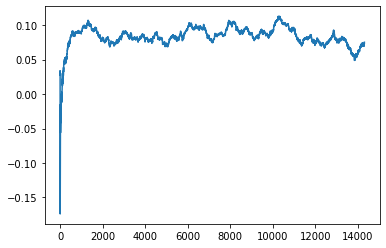

Thread: 3 iteration: 2400
RAM mDiffFit_49 FROM: 1792 --> 192 reward: 0.34320831875
Thread: 2 iteration: 2348
RAM mDiffFit_107 FROM: 1088 --> 832 reward: 0.0045078097656249885
Thread: 3 iteration: 2401
RAM mProject_7 FROM: 1984 --> 2880 reward: 0.16041828621093762
Thread: 6 iteration: 2391
RAM mProject_64 FROM: 576 --> 2880 reward: 0.8129836676953126
Thread: 4 iteration: 2386
RAM mProject_45 FROM: 1792 --> 1792 reward: 0.011096259187500112
Thread: 1 iteration: 2322
RAM mProject_53 FROM: 1472 --> 1792 reward: -0.05787655495312501
Thread: 5 iteration: 2468
RAM mDiffFit_102 FROM: 1856 --> 1792 reward: -0.0026458406249999997
Thread: 2 iteration: 2349
RAM mDiffFit_114 FROM: 1472 --> 960 reward: 0.09403650390625001
Thread: 3 iteration: 2402
RAM mDiffFit_361 FROM: 2432 --> 2112 reward: 0.025453141406249994
Thread: 1 iteration: 2323
RAM mBackground_31 FROM: 2880 --> 2880 reward: 0.028386754023437516
Thread: 6 iteration: 2392
RAM mDiffFit_3 FROM: 1024 --> 960 reward: 0.01544011054687499
Thread: 

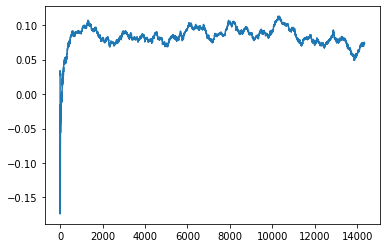

Thread: 5 iteration: 2470
RAM mProject_52 FROM: 192 --> 2112 reward: 0.6772915229765624
Saving ...


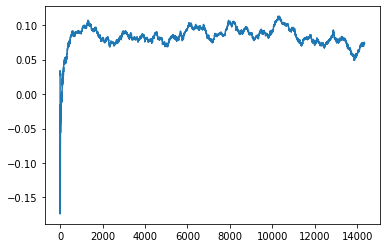

Thread: 2 iteration: 2350
RAM mDiffFit_90 FROM: 832 --> 192 reward: 0.29628646015625
Thread: 6 iteration: 2393
RAM mBackground_37 FROM: 2560 --> 2112 reward: -0.035123445773437505
Thread: 1 iteration: 2325
RAM mProject_57 FROM: 2368 --> 2880 reward: 0.07540094285156268
Thread: 3 iteration: 2404
RAM mBackground_61 FROM: 320 --> 2112 reward: -0.39533560845312493
Thread: 5 iteration: 2471
RAM mDiffFit_402 FROM: 2944 --> 1088 reward: -0.0005286941406250009
Thread: 2 iteration: 2351
RAM mDiffFit_214 FROM: 448 --> 192 reward: 0.13688280976562497
Thread: 6 iteration: 2394
RAM mProject_70 FROM: 2752 --> 2112 reward: -0.11231553726562488
Thread: 4 iteration: 2389
RAM mDiffFit_189 FROM: 1408 --> 448 reward: 0.018976526953125
Thread: 5 iteration: 2472
RAM mDiffFit_56 FROM: 2560 --> 2304 reward: 0.019916681249999985
Thread: 2 iteration: 2352
RAM mDiffFit_307 FROM: 512 --> 192 reward: 0.28379168125000004
Thread: 1 iteration: 2326
RAM mDiffFit_373 FROM: 1152 --> 256 reward: 0.23448438046874998
Threa

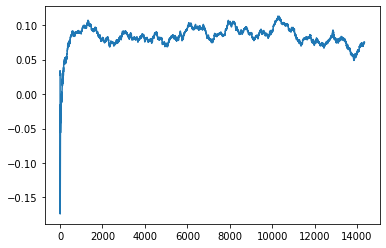

Thread: 4 iteration: 2390
RAM mViewer_4 FROM: 448 --> 2880 reward: -0.5860435435078125
Thread: 5 iteration: 2474
RAM mDiffFit_3 FROM: 1600 --> 2112 reward: -0.06572139335937502
Thread: 3 iteration: 2406
RAM mProject_24 FROM: 1088 --> 1088 reward: 0.00011250000000003756
Thread: 1 iteration: 2327
RAM mDiffFit_371 FROM: 192 --> 2112 reward: -0.25307028789062497
Thread: 6 iteration: 2398
RAM mBackground_61 FROM: 2496 --> 2176 reward: 0.008349154125000043
Thread: 2 iteration: 2355
RAM mDiffFit_118 FROM: 2240 --> 2112 reward: -0.0006093804687500037
Thread: 5 iteration: 2475
RAM mDiffFit_354 FROM: 2944 --> 2112 reward: -0.119414223828125
Thread: 3 iteration: 2407
RAM mAdd_1 FROM: 448 --> 1792 reward: 0.45056295937499996
Thread: 4 iteration: 2391
RAM mBackground_68 FROM: 1280 --> 2176 reward: -0.009804837828125
Thread: 1 iteration: 2328
RAM mDiffFit_309 FROM: 2944 --> 2112 reward: -0.01819796406250001
Thread: 6 iteration: 2399
RAM mDiffFit_389 FROM: 2496 --> 2112 reward: 0.03892190234375002
Th

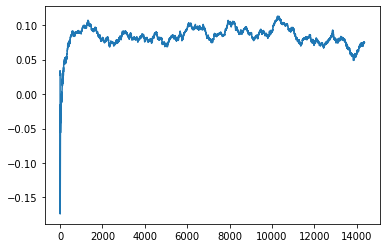

Thread: 6 iteration: 2400
RAM mDiffFit_210 FROM: 1920 --> 2112 reward: 0.0865938484375
Thread: 3 iteration: 2409
RAM mDiffFit_308 FROM: 576 --> 2112 reward: 0.06312513125
Thread: 5 iteration: 2477
RAM mProject_17 FROM: 704 --> 2112 reward: 0.6638829129843751
Thread: 4 iteration: 2392
RAM mDiffFit_205 FROM: 2176 --> 2112 reward: -0.0021979203125000076
Saving ...


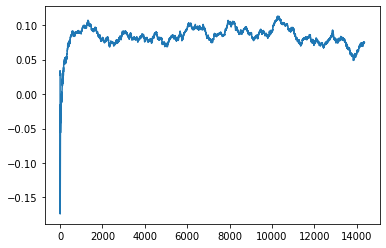

Thread: 1 iteration: 2330
RAM mDiffFit_344 FROM: 1536 --> 2112 reward: -0.031695331640625005
Thread: 2 iteration: 2358
RAM mDiffFit_348 FROM: 2752 --> 2112 reward: -0.04464329570312501
Thread: 6 iteration: 2401
RAM mDiffFit_40 FROM: 512 --> 2112 reward: -0.13002865039062503
Thread: 5 iteration: 2478
RAM mDiffFit_423 FROM: 960 --> 2112 reward: -0.073820331640625
Thread: 4 iteration: 2393
RAM mDiffFit_242 FROM: 1152 --> 2112 reward: -0.0035702878906250166
Thread: 1 iteration: 2331
RAM mDiffFit_298 FROM: 2624 --> 2112 reward: -0.01693752187500002
Thread: 2 iteration: 2359
RAM mDiffFit_193 FROM: 2624 --> 2112 reward: -0.07805738828125001
Thread: 6 iteration: 2402
RAM mProject_56 FROM: 2112 --> 1728 reward: 0.0032174369999999784
Saving ...


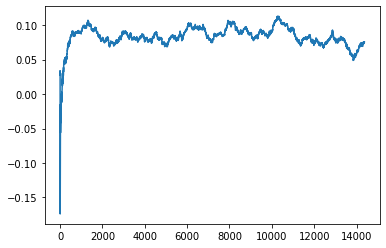

Thread: 3 iteration: 2410
RAM mDiffFit_368 FROM: 1920 --> 2112 reward: -0.012570331640625008
Thread: 4 iteration: 2394
RAM mDiffFit_41 FROM: 640 --> 2112 reward: -0.038533827734374984
Thread: 1 iteration: 2332
RAM mDiffFit_7 FROM: 2240 --> 2112 reward: -0.022559933203125
Saving ...


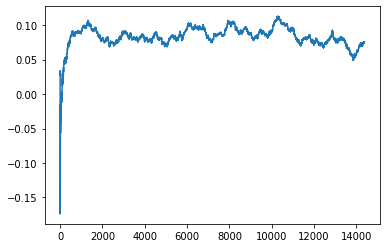

Thread: 2 iteration: 2360
RAM mDiffFit_265 FROM: 1216 --> 2112 reward: 0.02802610546874999
Thread: 6 iteration: 2403
RAM mDiffFit_134 FROM: 896 --> 2112 reward: 0.01875526484374999
Thread: 3 iteration: 2411
RAM mProject_35 FROM: 1344 --> 1728 reward: -0.09204328272656254
Thread: 5 iteration: 2479
RAM mDiffFit_74 FROM: 832 --> 2112 reward: 0.00673442421875
Thread: 4 iteration: 2395
RAM mDiffFit_138 FROM: 2112 --> 2112 reward: 0.00825000000000001
Thread: 1 iteration: 2333
RAM mDiffFit_217 FROM: 1600 --> 2112 reward: 0.036226614453125
Thread: 2 iteration: 2361
RAM mDiffFit_157 FROM: 320 --> 2112 reward: -0.10211973515625
Saving ...


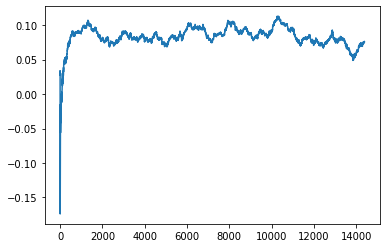

Thread: 5 iteration: 2480
RAM mBackground_78 FROM: 2176 --> 2112 reward: -0.07843477685937504
Thread: 3 iteration: 2412
RAM mDiffFit_164 FROM: 1088 --> 2112 reward: 0.006919313671875007
Thread: 4 iteration: 2396
RAM mDiffFit_129 FROM: 1984 --> 2112 reward: 0.006234380468750009
Thread: 2 iteration: 2362
RAM mDiffFit_145 FROM: 576 --> 2112 reward: -0.08506247812500001
Thread: 5 iteration: 2481
RAM mProject_41 FROM: 960 --> 2112 reward: -0.20368675884375
Thread: 6 iteration: 2404
RAM mDiffFit_115 FROM: 896 --> 2176 reward: 0.032567786718750005
Thread: 4 iteration: 2397
RAM mDiffFit_131 FROM: 1984 --> 2176 reward: -0.047177123437499996
Thread: 2 iteration: 2363
RAM mDiffFit_100 FROM: 832 --> 2176 reward: 0.06179698984375001
Thread: 5 iteration: 2482
RAM mProject_13 FROM: 768 --> 2112 reward: 0.6725144863125
Thread: 1 iteration: 2334
RAM mProject_80 FROM: 1408 --> 2176 reward: -0.015343926328125
Thread: 3 iteration: 2413
RAM mDiffFit_211 FROM: 1920 --> 2176 reward: -0.04167712343749999
Thre

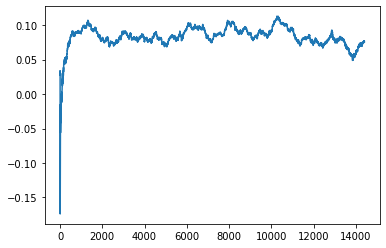

Thread: 4 iteration: 2400
RAM mBackground_49 FROM: 2624 --> 2688 reward: 0.00606927867187498
Thread: 2 iteration: 2366
RAM mDiffFit_226 FROM: 1920 --> 2688 reward: 0.020656282812499996
Thread: 5 iteration: 2485
RAM mProject_46 FROM: 1728 --> 2176 reward: 0.050607317109375057
Thread: 6 iteration: 2406
RAM mDiffFit_86 FROM: 512 --> 2688 reward: -0.21084898203124997
Thread: 3 iteration: 2416
RAM mBackground_60 FROM: 1984 --> 2688 reward: 0.06462553581250002
Thread: 4 iteration: 2401
RAM mDiffFit_338 FROM: 3008 --> 2688 reward: -0.03450526484375001
Thread: 2 iteration: 2367
RAM mDiffFit_395 FROM: 256 --> 2688 reward: -0.09436960390624999
Thread: 5 iteration: 2486
RAM mProject_13 FROM: 640 --> 2688 reward: 0.778076256515625
Thread: 1 iteration: 2337
RAM mDiffFit_133 FROM: 2688 --> 2688 reward: -0.024265663281249992
Thread: 3 iteration: 2417
RAM mDiffFit_141 FROM: 2496 --> 2688 reward: -0.01842971210937499
Thread: 2 iteration: 2368
RAM mDiffFit_202 FROM: 1152 --> 2688 reward: 0.0353750875
Th

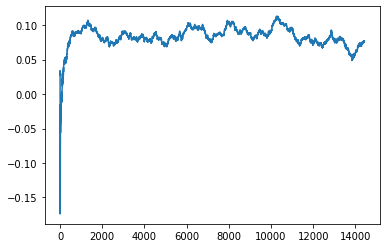

Thread: 3 iteration: 2420
RAM mDiffFit_312 FROM: 1344 --> 2688 reward: 0.00939066328125
Saving ...


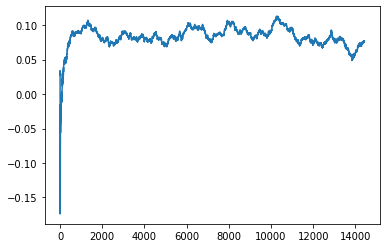

Thread: 1 iteration: 2340
RAM mProject_80 FROM: 1984 --> 1280 reward: 0.10169994487500002
Thread: 5 iteration: 2488
RAM mBgModel_1 FROM: 2368 --> 1280 reward: 0.003332187031249989
Thread: 4 iteration: 2405
RAM mDiffFit_256 FROM: 256 --> 2688 reward: -0.09102597421875003
Saving ...


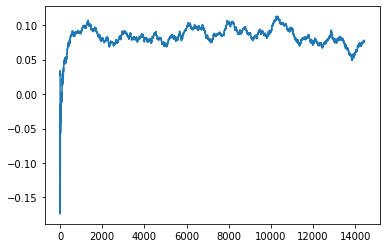

Thread: 2 iteration: 2370
RAM mBackground_23 FROM: 2432 --> 1280 reward: -0.0016349883281250434
Saving ...


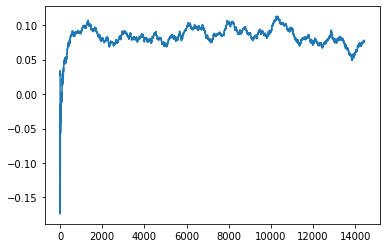

Thread: 6 iteration: 2410
RAM mDiffFit_268 FROM: 1472 --> 2688 reward: 0.00949482265625001
Thread: 1 iteration: 2341
RAM mBackground_17 FROM: 384 --> 1280 reward: -0.29344809678125
Thread: 3 iteration: 2421
RAM mDiffFit_88 FROM: 256 --> 2688 reward: -0.31520823124999997
Thread: 5 iteration: 2489
RAM mDiffFit_73 FROM: 2432 --> 1280 reward: -0.030979246875000033
Thread: 2 iteration: 2371
RAM mDiffFit_143 FROM: 1152 --> 1280 reward: 0.0056458406249999815
Thread: 1 iteration: 2342
RAM mDiffFit_113 FROM: 1920 --> 1280 reward: -0.04907300781250002
Thread: 3 iteration: 2422
RAM mBackground_6 FROM: 512 --> 1280 reward: -0.14062784768749997
Thread: 6 iteration: 2411
RAM mDiffFit_337 FROM: 960 --> 1280 reward: -0.007049447265625036
Saving ...


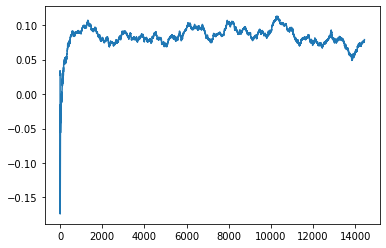

Thread: 5 iteration: 2490
RAM mProject_75 FROM: 2880 --> 1280 reward: -0.09554337808593757
Thread: 4 iteration: 2406
RAM mDiffFit_162 FROM: 832 --> 1280 reward: 0.03688026484374999
Thread: 1 iteration: 2343
RAM mBackground_42 FROM: 2496 --> 1280 reward: 0.0023604346093749457
Thread: 2 iteration: 2372
RAM mDiffFit_325 FROM: 2944 --> 1280 reward: 0.06016146015624998
Thread: 3 iteration: 2423
RAM mDiffFit_60 FROM: 256 --> 1280 reward: -0.2915104421875
Thread: 6 iteration: 2412
RAM mDiffFit_243 FROM: 2816 --> 1280 reward: -0.006895884375000012
Thread: 5 iteration: 2491
RAM mBackground_7 FROM: 1024 --> 1280 reward: 0.010364826156250041
Thread: 4 iteration: 2407
RAM mDiffFit_238 FROM: 704 --> 1280 reward: -0.0010051773437499967
Thread: 2 iteration: 2373
RAM mBackground_28 FROM: 1216 --> 1280 reward: -0.0013235819921875002
Thread: 3 iteration: 2424
RAM mDiffFit_52 FROM: 576 --> 1280 reward: -0.11101044218750002
Thread: 6 iteration: 2413
RAM mDiffFit_212 FROM: 704 --> 1280 reward: -0.121221393

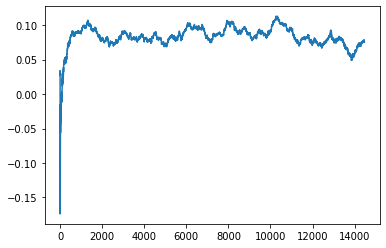

Thread: 4 iteration: 2410
RAM mProject_42 FROM: 128 --> 1280 reward: 0.7503062582812501
Thread: 3 iteration: 2425
RAM mDiffFit_220 FROM: 1920 --> 896 reward: 0.020260398437500007
Thread: 2 iteration: 2376
RAM mDiffFit_331 FROM: 896 --> 896 reward: -0.025130221093750023
Thread: 5 iteration: 2495
RAM mDiffFit_88 FROM: 704 --> 896 reward: -0.08928909257812503
Thread: 4 iteration: 2411
RAM mDiffFit_207 FROM: 2624 --> 896 reward: 0.11575263242187502
Thread: 6 iteration: 2416
RAM mProject_84 FROM: 384 --> 1280 reward: 0.7380493734375
Thread: 1 iteration: 2346
RAM mDiffFit_377 FROM: 2752 --> 896 reward: -0.06354181249999996
Thread: 6 iteration: 2417
RAM mDiffFit_91 FROM: 2048 --> 896 reward: 0.043630177343749986
Thread: 5 iteration: 2496
RAM mBackground_24 FROM: 768 --> 1280 reward: -0.06363101971875
Thread: 2 iteration: 2377
RAM mDiffFit_283 FROM: 1280 --> 896 reward: 0.08036982265625003
Thread: 4 iteration: 2412
RAM mDiffFit_83 FROM: 1216 --> 896 reward: 0.062252632421874975
Thread: 6 itera

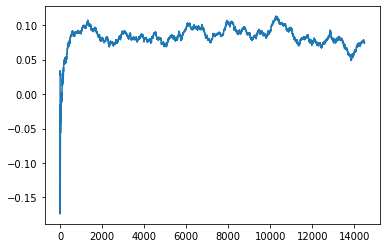

Thread: 6 iteration: 2420
RAM mBackground_53 FROM: 2176 --> 1792 reward: 0.019623221328124964
Thread: 4 iteration: 2415
RAM mProject_77 FROM: 1088 --> 1792 reward: -0.20141953403906243
Thread: 2 iteration: 2379
RAM mProject_75 FROM: 576 --> 1792 reward: 0.6213025043437499
Thread: 1 iteration: 2348
RAM mProject_20 FROM: 448 --> 1792 reward: 0.6406825227187499
Thread: 3 iteration: 2427
RAM mDiffFit_28 FROM: 384 --> 896 reward: -0.13793230078125
Thread: 6 iteration: 2421
RAM mProject_35 FROM: 1408 --> 1792 reward: -0.068010921421875
Thread: 5 iteration: 2499
RAM mBackground_84 FROM: 2560 --> 1792 reward: 0.27198424365625007
Thread: 4 iteration: 2416
RAM mDiffFit_213 FROM: 960 --> 896 reward: 0.03328387148437504
Saving ...


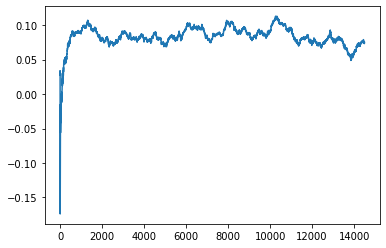

Thread: 2 iteration: 2380
RAM mDiffFit_24 FROM: 384 --> 896 reward: -0.0687812390625
Thread: 3 iteration: 2428
RAM mDiffFit_3 FROM: 2496 --> 896 reward: 0.012942655468749995
Saving ...


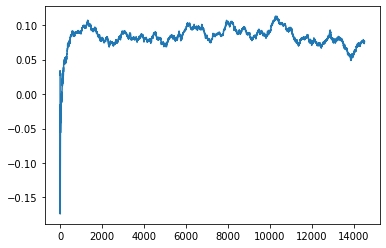

Thread: 5 iteration: 2500
RAM mDiffFit_399 FROM: 512 --> 896 reward: -0.026796858593749976
Thread: 6 iteration: 2422
RAM mDiffFit_185 FROM: 1408 --> 896 reward: 0.007796858593750004
Thread: 2 iteration: 2381
RAM mDiffFit_129 FROM: 1088 --> 896 reward: -0.011210951171875
Thread: 3 iteration: 2429
RAM mBackground_89 FROM: 2688 --> 1792 reward: -0.12080332253125002
Thread: 4 iteration: 2417
RAM mProject_7 FROM: 2048 --> 1792 reward: -0.03447383006250005
Thread: 1 iteration: 2349
RAM mDiffFit_101 FROM: 1344 --> 1792 reward: -0.045885442187499986
Thread: 5 iteration: 2501
RAM mDiffFit_260 FROM: 128 --> 1792 reward: -0.80052606171875
Thread: 6 iteration: 2423
RAM mDiffFit_52 FROM: 1472 --> 1792 reward: -0.013145840624999997
Thread: 2 iteration: 2382
RAM mDiffFit_214 FROM: 1664 --> 1792 reward: 0.005520840624999995
Saving ...


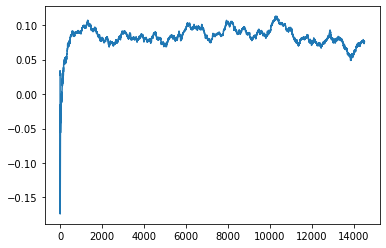

Thread: 3 iteration: 2430
RAM mDiffFit_256 FROM: 2560 --> 1792 reward: 0.03648960156250002
Saving ...


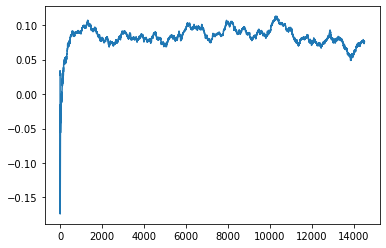

Thread: 1 iteration: 2350
RAM mBackground_76 FROM: 2688 --> 1792 reward: -0.03787592112499996
Thread: 4 iteration: 2418
RAM mBackground_23 FROM: 1024 --> 1792 reward: -0.07615478853124995
Thread: 5 iteration: 2502
RAM mDiffFit_134 FROM: 320 --> 1792 reward: -0.152273429296875
Thread: 6 iteration: 2424
RAM mDiffFit_413 FROM: 3008 --> 1792 reward: -0.05552092812500001
Thread: 3 iteration: 2431
RAM mBackground_48 FROM: 2432 --> 1792 reward: -0.12186934224999993
Thread: 1 iteration: 2351
RAM mDiffFit_356 FROM: 2496 --> 1792 reward: 0.127398560546875
Thread: 6 iteration: 2425
RAM mDiffFit_411 FROM: 2688 --> 1792 reward: 0.007364557812500026
Thread: 1 iteration: 2352
RAM mProject_1 FROM: 2624 --> 1792 reward: -0.15036591965625
Thread: 2 iteration: 2383
RAM mProject_44 FROM: 2496 --> 1792 reward: -0.10657851110156244
Thread: 4 iteration: 2419
RAM mDiffFit_285 FROM: 2688 --> 1792 reward: 0.0057447789062500115
Thread: 6 iteration: 2426
RAM mDiffFit_73 FROM: 192 --> 1792 reward: -0.2401457968750

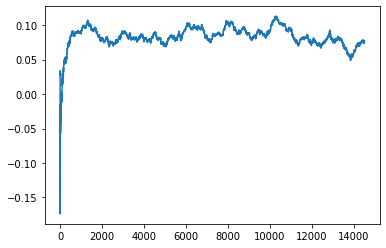

Thread: 4 iteration: 2420
RAM mBackground_31 FROM: 1216 --> 1792 reward: -0.05624713933593749
Thread: 6 iteration: 2427
RAM mDiffFit_156 FROM: 1728 --> 1792 reward: 0.019200552734375022
Thread: 1 iteration: 2354
RAM mDiffFit_166 FROM: 2240 --> 1792 reward: 0.014125000000000006
Thread: 5 iteration: 2504
RAM mDiffFit_58 FROM: 1728 --> 1792 reward: 0.028002632421874993
Thread: 4 iteration: 2421
RAM mBackground_80 FROM: 1856 --> 1792 reward: 0.013043345874999989
Thread: 2 iteration: 2385
RAM mBackground_29 FROM: 2560 --> 1792 reward: -0.0013258835000000365
Thread: 6 iteration: 2428
RAM mProject_88 FROM: 2944 --> 1792 reward: -0.23305919231250002
Thread: 3 iteration: 2432
RAM mDiffFit_207 FROM: 2176 --> 1792 reward: -0.0336979640625
Thread: 1 iteration: 2355
RAM mDiffFit_165 FROM: 1408 --> 1792 reward: -0.03552084062500001
Thread: 5 iteration: 2505
RAM mDiffFit_27 FROM: 1280 --> 1792 reward: 0.012312521875000003
Thread: 4 iteration: 2422
RAM mDiffFit_105 FROM: 2368 --> 1792 reward: -0.04739

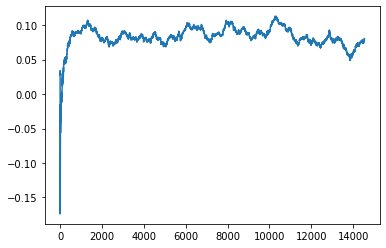

Thread: 6 iteration: 2430
RAM mAdd_2 FROM: 896 --> 1792 reward: -0.26295055273437506
Thread: 1 iteration: 2357
RAM mBackground_46 FROM: 192 --> 1792 reward: -1.1007171769609376
Thread: 4 iteration: 2424
RAM mDiffFit_339 FROM: 2240 --> 1792 reward: -0.09242198984374998
Thread: 3 iteration: 2435
RAM mDiffFit_117 FROM: 256 --> 1792 reward: -0.19861455781249998
Thread: 2 iteration: 2388
RAM mDiffFit_266 FROM: 1664 --> 1792 reward: 0.013505221093749985
Thread: 1 iteration: 2358
RAM mBackground_54 FROM: 2432 --> 1792 reward: -0.038870286718749994
Thread: 4 iteration: 2425
RAM mBackground_78 FROM: 1728 --> 1792 reward: -2.4210546965312503
Thread: 6 iteration: 2431
RAM mProject_79 FROM: 896 --> 1792 reward: -0.28817154182812516
Thread: 5 iteration: 2507
RAM mDiffFit_85 FROM: 2560 --> 1792 reward: 0.03661460156250001
Thread: 3 iteration: 2436
RAM mDiffFit_243 FROM: 2752 --> 1792 reward: 0.07865891523437504
Thread: 2 iteration: 2389
RAM mBackground_54 FROM: 1728 --> 1792 reward: 0.02470711468749

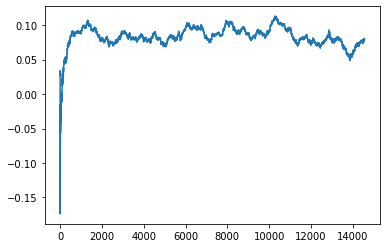

Thread: 5 iteration: 2510
RAM mProject_86 FROM: 320 --> 1792 reward: 0.6136712451562499
Thread: 4 iteration: 2426
RAM mProject_40 FROM: 2112 --> 1792 reward: -0.0452649453046877
Thread: 1 iteration: 2359
RAM mProject_19 FROM: 2432 --> 1792 reward: -0.09415051889062505
Thread: 6 iteration: 2432
RAM mProject_85 FROM: 2496 --> 1792 reward: -0.11238539069531255
Saving ...


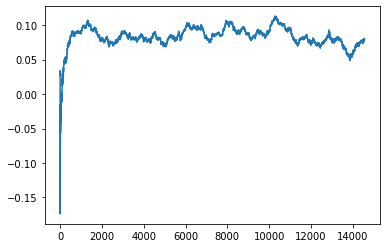

Thread: 2 iteration: 2390
RAM mDiffFit_69 FROM: 768 --> 1792 reward: -0.046333318750000005
Thread: 3 iteration: 2439
RAM mDiffFit_261 FROM: 2048 --> 1792 reward: -0.013041681249999996
Saving ...


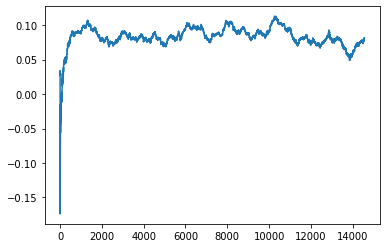

Thread: 1 iteration: 2360
RAM mDiffFit_251 FROM: 2304 --> 1792 reward: -0.063020928125
Thread: 6 iteration: 2433
RAM mDiffFit_96 FROM: 2176 --> 1792 reward: -0.007187521875000012
Thread: 5 iteration: 2511
RAM mDiffFit_263 FROM: 1984 --> 1792 reward: -0.0033437609374999816
Saving ...


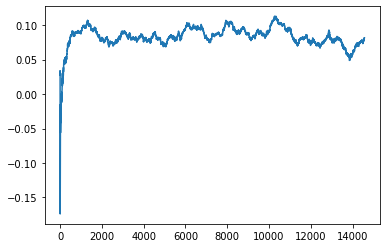

Thread: 3 iteration: 2440
RAM mDiffFit_76 FROM: 2176 --> 1792 reward: 0.009557300781249979
Thread: 6 iteration: 2434
RAM mDiffFit_308 FROM: 2432 --> 1792 reward: -0.09975013125000001
Thread: 5 iteration: 2512
RAM mProject_21 FROM: 1984 --> 1792 reward: -0.025071151992187412
Thread: 4 iteration: 2427
RAM mProject_18 FROM: 1472 --> 1792 reward: -0.08133798171093742
Thread: 2 iteration: 2391
RAM mBackground_29 FROM: 2944 --> 1792 reward: -0.06146773742187502
Thread: 3 iteration: 2441
RAM mDiffFit_380 FROM: 128 --> 1792 reward: -0.74713022109375
Thread: 5 iteration: 2513
RAM mDiffFit_331 FROM: 320 --> 1792 reward: -0.391903694140625
Thread: 6 iteration: 2435
RAM mDiffFit_91 FROM: 768 --> 1792 reward: -0.024364557812499993
Thread: 4 iteration: 2428
RAM mDiffFit_138 FROM: 896 --> 1792 reward: -0.012619778906250009
Thread: 2 iteration: 2392
RAM mBackground_9 FROM: 2368 --> 1792 reward: -0.05996718993749997
Thread: 3 iteration: 2442
RAM mDiffFit_316 FROM: 384 --> 1792 reward: -0.04002597421875

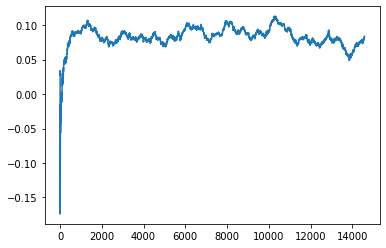

Thread: 4 iteration: 2430
RAM mBackground_66 FROM: 1984 --> 1792 reward: 0.0031936442656250257
Thread: 5 iteration: 2515
RAM mImgtbl_2 FROM: 2368 --> 1792 reward: 0.0515229203125
Thread: 3 iteration: 2443
RAM mDiffFit_16 FROM: 1280 --> 1792 reward: -0.06464588437499998
Thread: 6 iteration: 2437
RAM mDiffFit_55 FROM: 2560 --> 1792 reward: -0.010406282812499999
Thread: 1 iteration: 2362
RAM mBackground_68 FROM: 2240 --> 1792 reward: -0.07690740140624995
Thread: 2 iteration: 2395
RAM mDiffFit_416 FROM: 2816 --> 1792 reward: -0.008531282812499989
Thread: 5 iteration: 2516
RAM mDiffFit_414 FROM: 2240 --> 1792 reward: 0.01681511054687501
Thread: 3 iteration: 2444
RAM mDiffFit_139 FROM: 576 --> 1792 reward: -0.18278646015625
Thread: 4 iteration: 2431
RAM mDiffFit_112 FROM: 192 --> 1792 reward: -0.34380725703125
Thread: 6 iteration: 2438
RAM mDiffFit_130 FROM: 1152 --> 1792 reward: -0.011255177343750013
Thread: 1 iteration: 2363
RAM mDiffFit_236 FROM: 832 --> 1792 reward: -0.011091128515625008

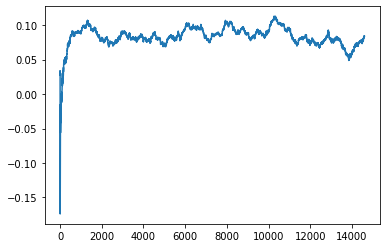

Thread: 6 iteration: 2440
RAM mBackground_15 FROM: 2560 --> 1792 reward: 0.23326628309375
Thread: 3 iteration: 2446
RAM mDiffFit_258 FROM: 1216 --> 1792 reward: -0.028411460156250005
Thread: 5 iteration: 2518
RAM mDiffFit_30 FROM: 1856 --> 1792 reward: -0.008322920312499992
Thread: 2 iteration: 2397
RAM mDiffFit_113 FROM: 384 --> 1792 reward: -0.20441141640624996
Thread: 6 iteration: 2441
RAM mDiffFit_104 FROM: 1216 --> 1792 reward: 0.020507853515625007
Thread: 3 iteration: 2447
RAM mDiffFit_177 FROM: 1088 --> 1792 reward: -0.024442699218750006
Thread: 2 iteration: 2398
RAM mProject_20 FROM: 2176 --> 1792 reward: -0.049762615499999927
Thread: 1 iteration: 2364
RAM mProject_62 FROM: 1024 --> 1792 reward: -0.1789893244687501
Thread: 4 iteration: 2433
RAM mDiffFit_333 FROM: 1408 --> 1792 reward: -0.015088539843750009
Thread: 3 iteration: 2448
RAM mDiffFit_62 FROM: 2752 --> 1792 reward: -0.003497411328124995
Thread: 6 iteration: 2442
RAM mDiffFit_104 FROM: 1216 --> 1792 reward: -0.00460415

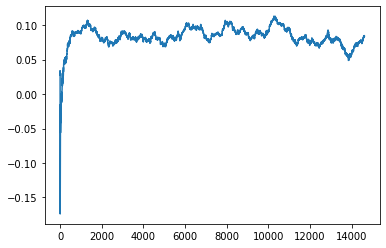

Thread: 2 iteration: 2400
RAM mDiffFit_210 FROM: 2624 --> 1792 reward: 0.004486969140624995
Thread: 4 iteration: 2435
RAM mDiffFit_408 FROM: 1344 --> 1792 reward: -0.026815110546875003
Saving ...


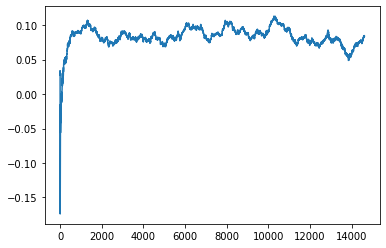

Thread: 5 iteration: 2520
RAM mBackground_68 FROM: 2176 --> 1792 reward: -0.02919973923437499
Thread: 1 iteration: 2366
RAM mDiffFit_359 FROM: 2112 --> 1792 reward: -0.0017396015624999983
Thread: 6 iteration: 2444
RAM mBackground_39 FROM: 2304 --> 1792 reward: -0.015435249093749971
Thread: 2 iteration: 2401
RAM mDiffFit_339 FROM: 2560 --> 1792 reward: 0.0002291593750000133
Thread: 5 iteration: 2521
RAM mDiffFit_409 FROM: 128 --> 1792 reward: -0.43932809765625
Thread: 1 iteration: 2367
RAM mDiffFit_272 FROM: 960 --> 1792 reward: -0.0020129871093750064
Thread: 5 iteration: 2522
RAM mBackground_55 FROM: 960 --> 1792 reward: -0.05928174104687499
Thread: 1 iteration: 2368
RAM mBackground_36 FROM: 2880 --> 1792 reward: 0.17781854567187497
Thread: 6 iteration: 2445
RAM mProject_78 FROM: 1088 --> 1792 reward: -0.19630780889062507
Saving ...


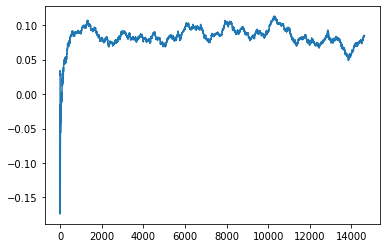

Thread: 3 iteration: 2450
RAM mProject_43 FROM: 640 --> 1792 reward: 0.6252643839375
Thread: 4 iteration: 2436
RAM mDiffFit_240 FROM: 2816 --> 1792 reward: -0.0026146015624999887
Thread: 5 iteration: 2523
RAM mProject_12 FROM: 1600 --> 1792 reward: -0.03986953403906257
Thread: 2 iteration: 2402
RAM mDiffFit_414 FROM: 192 --> 1792 reward: -0.17542703593749998
Thread: 1 iteration: 2369
RAM mDiffFit_242 FROM: 576 --> 1792 reward: -0.028828097656250003
Thread: 6 iteration: 2446
RAM mDiffFit_16 FROM: 2752 --> 1792 reward: 0.008752588671875026
Thread: 3 iteration: 2451
RAM mDiffFit_165 FROM: 1984 --> 1792 reward: -0.03695577382812497
Thread: 4 iteration: 2437
RAM mDiffFit_129 FROM: 1600 --> 1792 reward: -3.123906250001099e-05
Thread: 5 iteration: 2524
RAM mDiffFit_361 FROM: 1216 --> 1792 reward: -0.043796902343750006
Saving ...


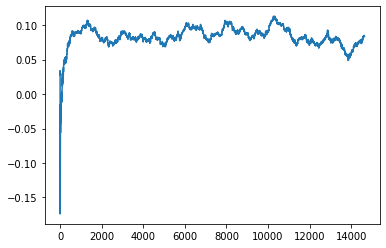

Thread: 1 iteration: 2370
RAM mDiffFit_230 FROM: 2176 --> 1792 reward: -0.08418760937500003
Thread: 2 iteration: 2403
RAM mDiffFit_18 FROM: 320 --> 1792 reward: -0.142023429296875
Thread: 3 iteration: 2452
RAM mDiffFit_389 FROM: 3008 --> 1792 reward: -0.055862100390624975
Thread: 4 iteration: 2438
RAM mBackground_84 FROM: 1088 --> 1792 reward: -0.03867309678124997
Thread: 6 iteration: 2447
RAM mDiffFit_218 FROM: 2176 --> 1792 reward: -0.03432296406250001
Thread: 5 iteration: 2525
RAM mDiffFit_49 FROM: 1280 --> 1792 reward: -0.021020840625000006
Thread: 1 iteration: 2371
RAM mDiffFit_164 FROM: 768 --> 1792 reward: -0.139770884375
Thread: 2 iteration: 2404
RAM mDiffFit_370 FROM: 1728 --> 1792 reward: 0.22596116992187498
Thread: 3 iteration: 2453
RAM mBackground_32 FROM: 2816 --> 1792 reward: -0.04668197846874999
Thread: 4 iteration: 2439
RAM mDiffFit_84 FROM: 2816 --> 1792 reward: -0.045552167187500006
Thread: 5 iteration: 2526
RAM mDiffFit_110 FROM: 192 --> 1792 reward: -0.2986145578125

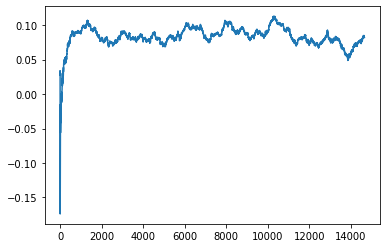

Thread: 4 iteration: 2440
RAM mDiffFit_58 FROM: 1728 --> 1792 reward: 0.0014921902343749925
Thread: 1 iteration: 2373
RAM mDiffFit_407 FROM: 960 --> 1792 reward: 0.0031120128906250016
Thread: 5 iteration: 2527
RAM mDiffFit_75 FROM: 320 --> 1792 reward: -0.14527342929687498
Thread: 6 iteration: 2449
RAM mDiffFit_124 FROM: 2240 --> 1792 reward: 0.009065110546875015
Thread: 3 iteration: 2455
RAM mBackground_10 FROM: 2048 --> 1792 reward: -0.03688151790625
Thread: 4 iteration: 2441
RAM mDiffFit_338 FROM: 896 --> 1792 reward: -0.01423433671875
Thread: 1 iteration: 2374
RAM mDiffFit_302 FROM: 2496 --> 1792 reward: -0.07211468906249997
Saving ...


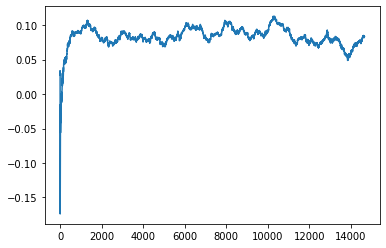

Thread: 6 iteration: 2450
RAM mDiffFit_8 FROM: 1984 --> 1792 reward: -0.0051015707031249954
Thread: 4 iteration: 2442
RAM mProject_56 FROM: 896 --> 1792 reward: -0.32204625918750013
Thread: 2 iteration: 2406
RAM mBackground_41 FROM: 2752 --> 1792 reward: -0.055208098085937476
Thread: 3 iteration: 2456
RAM mDiffFit_176 FROM: 1344 --> 1792 reward: 0.03295577382812501
Thread: 1 iteration: 2375
RAM mProject_32 FROM: 2368 --> 1792 reward: -0.09373472303906258
Thread: 5 iteration: 2528
RAM mDiffFit_141 FROM: 448 --> 1792 reward: -0.029979115625000004
Thread: 2 iteration: 2407
RAM mDiffFit_279 FROM: 2368 --> 1792 reward: -0.056971437109375016
Thread: 3 iteration: 2457
RAM mDiffFit_269 FROM: 2688 --> 1792 reward: 0.2129480953125
Thread: 4 iteration: 2443
RAM mDiffFit_222 FROM: 2048 --> 1792 reward: -0.08146884843750002
Thread: 6 iteration: 2451
RAM mDiffFit_168 FROM: 1792 --> 1792 reward: 0.020010442187500005
Thread: 1 iteration: 2376
RAM mDiffFit_347 FROM: 2560 --> 1792 reward: -0.03763548593

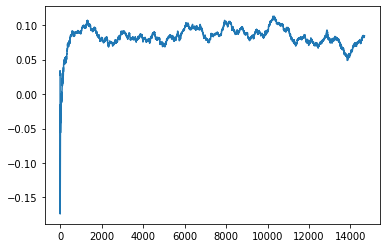

Thread: 5 iteration: 2530
RAM mDiffFit_84 FROM: 384 --> 1792 reward: -0.19041146015625
Thread: 2 iteration: 2409
RAM mDiffFit_238 FROM: 1216 --> 1792 reward: -0.0007525886718750055
Thread: 3 iteration: 2459
RAM mDiffFit_395 FROM: 1856 --> 1792 reward: -0.0015729203124999896
Thread: 4 iteration: 2445
RAM mProject_42 FROM: 1280 --> 1792 reward: -0.13097813090625007
Thread: 6 iteration: 2452
RAM mDiffFit_208 FROM: 1984 --> 1792 reward: 2.3429296875003905e-05
Thread: 5 iteration: 2531
RAM mDiffFit_118 FROM: 320 --> 1792 reward: -0.14857028789062499
Saving ...


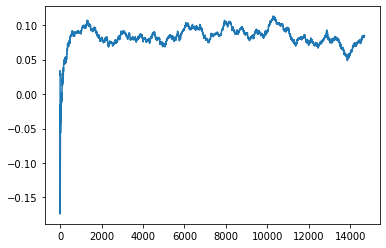

Thread: 2 iteration: 2410
RAM mDiffFit_360 FROM: 1536 --> 1792 reward: -0.03283336249999999
Thread: 6 iteration: 2453
RAM mDiffFit_105 FROM: 1984 --> 1792 reward: 0.12220064023437502
Thread: 4 iteration: 2446
RAM mDiffFit_273 FROM: 2560 --> 1792 reward: -0.009656282812499995
Thread: 5 iteration: 2532
RAM mDiffFit_70 FROM: 2432 --> 1792 reward: -0.012104203125
Thread: 6 iteration: 2454
RAM mProject_39 FROM: 1728 --> 1792 reward: -0.043066437257812513
Thread: 1 iteration: 2378
RAM mProject_46 FROM: 192 --> 1792 reward: 0.6348756431250001
Saving ...


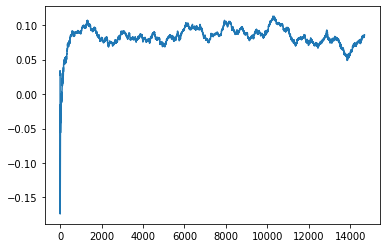

Thread: 3 iteration: 2460
RAM mBackground_41 FROM: 2240 --> 1792 reward: -0.05905342112499995
Thread: 4 iteration: 2447
RAM mDiffFit_35 FROM: 2624 --> 1792 reward: -0.02219796406250002
Thread: 5 iteration: 2533
RAM mDiffFit_14 FROM: 256 --> 1792 reward: -0.14319787656249996
Thread: 1 iteration: 2379
RAM mDiffFit_360 FROM: 2368 --> 1792 reward: -0.015179712109375
Thread: 6 iteration: 2455
RAM mProject_60 FROM: 2560 --> 1792 reward: -0.12945776512500012
Thread: 2 iteration: 2411
RAM mDiffFit_179 FROM: 640 --> 1792 reward: -0.10546871718749996
Thread: 3 iteration: 2461
RAM mDiffFit_307 FROM: 2176 --> 1792 reward: -0.027447964062499997
Saving ...


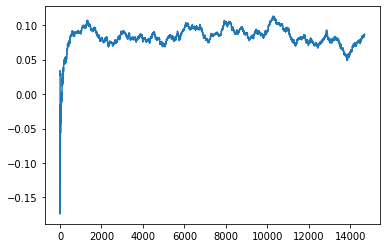

Thread: 1 iteration: 2380
RAM mDiffFit_282 FROM: 1088 --> 1792 reward: -0.032940110546875005
Thread: 6 iteration: 2456
RAM mDiffFit_37 FROM: 1536 --> 1792 reward: 0.09341676874999999
Thread: 2 iteration: 2412
RAM mBackground_64 FROM: 2368 --> 1792 reward: -0.0364358588515625
Thread: 5 iteration: 2534
RAM mDiffFit_296 FROM: 768 --> 1792 reward: -0.009770796875000001
Thread: 3 iteration: 2462
RAM mProject_60 FROM: 2944 --> 1792 reward: -0.19297070789062482
Thread: 4 iteration: 2448
RAM mDiffFit_284 FROM: 2496 --> 1792 reward: -0.011427123437499995
Thread: 2 iteration: 2413
RAM mDiffFit_412 FROM: 1280 --> 1792 reward: -0.05878128281249999
Thread: 5 iteration: 2535
RAM mImgtbl_3 FROM: 2560 --> 1792 reward: -0.0021000700000000094
Thread: 6 iteration: 2457
RAM mBackground_9 FROM: 1472 --> 1792 reward: -0.0902821523125
Thread: 1 iteration: 2381
RAM mDiffFit_292 FROM: 1920 --> 1792 reward: 0.001140619531250003
Thread: 4 iteration: 2449
RAM mDiffFit_205 FROM: 512 --> 1792 reward: -0.09294792031

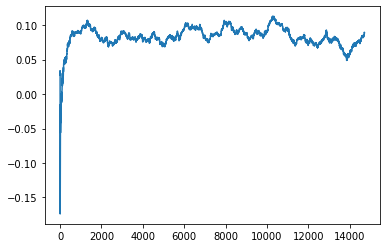

Thread: 4 iteration: 2450
RAM mDiffFit_328 FROM: 1344 --> 1792 reward: -0.06151566328124998
Thread: 6 iteration: 2459
RAM mProject_71 FROM: 3008 --> 1792 reward: -0.20828339121093756
Thread: 3 iteration: 2463
RAM mProject_40 FROM: 2496 --> 1792 reward: -0.12139149543750001
Thread: 2 iteration: 2414
RAM mDiffFit_255 FROM: 2816 --> 1792 reward: -0.024916725
Saving ...


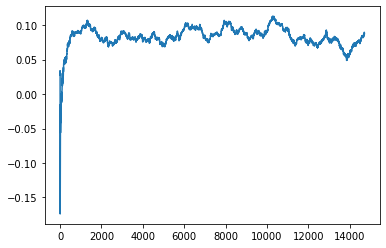

Thread: 6 iteration: 2460
RAM mDiffFit_18 FROM: 2240 --> 1792 reward: -0.0018203316406250041
Thread: 3 iteration: 2464
RAM mProject_90 FROM: 2560 --> 1792 reward: -0.13488214471875012
Thread: 1 iteration: 2382
RAM mProject_17 FROM: 2112 --> 1792 reward: -0.04583260237500007
Thread: 5 iteration: 2537
RAM mDiffFit_10 FROM: 576 --> 1792 reward: -0.08151816445312504
Thread: 6 iteration: 2461
RAM mProject_6 FROM: 640 --> 1792 reward: 0.634425643125
Thread: 4 iteration: 2451
RAM mDiffFit_402 FROM: 1664 --> 1792 reward: 0.0036458406249999936
Thread: 1 iteration: 2383
RAM mDiffFit_176 FROM: 832 --> 1792 reward: -0.01350517734374999
Thread: 5 iteration: 2538
RAM mDiffFit_150 FROM: 1856 --> 1792 reward: -0.0288333625
Thread: 6 iteration: 2462
RAM mBackground_57 FROM: 512 --> 1792 reward: -0.23421559678124995
Thread: 3 iteration: 2465
RAM mProject_56 FROM: 1920 --> 1792 reward: -0.026287549875000083
Thread: 2 iteration: 2415
RAM mDiffFit_21 FROM: 576 --> 1792 reward: -0.011544226171874995
Thread:

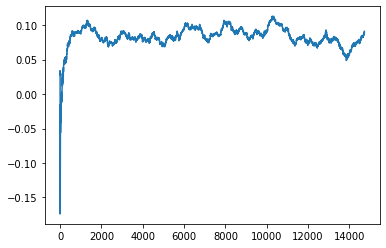

Thread: 5 iteration: 2540
RAM mDiffFit_318 FROM: 768 --> 1792 reward: -0.08002084062499999
Thread: 2 iteration: 2417
RAM mProject_54 FROM: 2048 --> 1792 reward: -0.04120320965625011
Thread: 3 iteration: 2466
RAM mDiffFit_338 FROM: 2368 --> 1792 reward: -0.03716672500000001
Thread: 5 iteration: 2541
RAM mDiffFit_356 FROM: 1152 --> 1792 reward: -0.00665623906250001
Thread: 2 iteration: 2418
RAM mProject_71 FROM: 2752 --> 1792 reward: -0.1786512862968749
Thread: 1 iteration: 2385
RAM mProject_39 FROM: 1408 --> 1792 reward: 0.06367044276562511
Thread: 6 iteration: 2464
RAM mDiffFit_414 FROM: 1856 --> 1792 reward: -0.07264070703125
Thread: 2 iteration: 2419
RAM mDiffFit_169 FROM: 1344 --> 1792 reward: -0.007999999999999995
Thread: 1 iteration: 2386
RAM mProject_9 FROM: 2624 --> 1792 reward: -0.12325573371093741
Thread: 4 iteration: 2454
RAM mProject_61 FROM: 384 --> 1792 reward: 0.61749812475
Thread: 3 iteration: 2467
RAM mBackground_25 FROM: 3008 --> 1792 reward: -0.070058794765625
Saving 

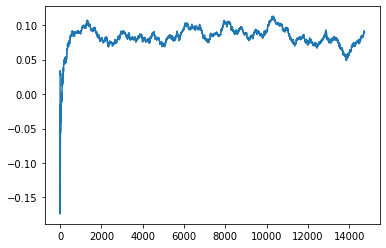

Thread: 2 iteration: 2420
RAM mDiffFit_335 FROM: 1344 --> 1792 reward: 0.006760442187500014
Thread: 1 iteration: 2387
RAM mProject_75 FROM: 1216 --> 1792 reward: -0.12276091617187493
Thread: 5 iteration: 2542
RAM mProject_41 FROM: 2368 --> 1792 reward: -0.08996690889843767
Thread: 6 iteration: 2465
RAM mDiffFit_354 FROM: 1152 --> 1792 reward: -0.021859380468749995
Thread: 4 iteration: 2455
RAM mDiffFit_72 FROM: 1472 --> 1792 reward: -0.007367190234374987
Thread: 3 iteration: 2468
RAM mDiffFit_125 FROM: 1344 --> 1792 reward: -0.075585994921875
Thread: 1 iteration: 2388
RAM mDiffFit_142 FROM: 2944 --> 1792 reward: 0.007526017968750003
Thread: 5 iteration: 2543
RAM mDiffFit_359 FROM: 2880 --> 1792 reward: -0.046000087500000016
Thread: 6 iteration: 2466
RAM mDiffFit_162 FROM: 2304 --> 1792 reward: -0.0160833625
Thread: 4 iteration: 2456
RAM mProject_35 FROM: 1408 --> 1792 reward: -0.082304060203125
Thread: 2 iteration: 2421
RAM mDiffFit_102 FROM: 2496 --> 1792 reward: -0.06912771992187497


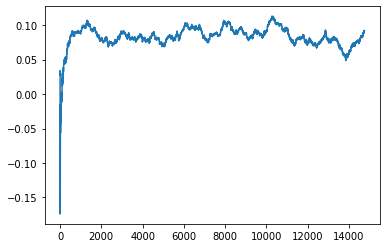

Thread: 1 iteration: 2390
RAM mDiffFit_316 FROM: 2240 --> 1792 reward: -0.041895884375
Saving ...


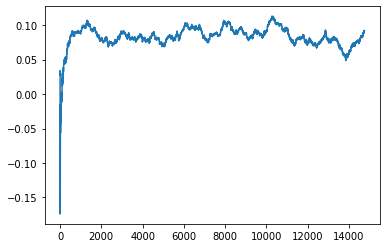

Thread: 3 iteration: 2470
RAM mDiffFit_326 FROM: 2048 --> 1792 reward: -0.003593760937500006
Thread: 2 iteration: 2423
RAM mDiffFit_376 FROM: 2816 --> 1792 reward: -0.1445835375
Thread: 6 iteration: 2468
RAM mProject_66 FROM: 2240 --> 1792 reward: -0.07327796639062496
Thread: 5 iteration: 2545
RAM mBackground_83 FROM: 2752 --> 1792 reward: -0.05513418007812496
Thread: 4 iteration: 2459
RAM mDiffFit_236 FROM: 1856 --> 1792 reward: -0.0032421902343749993
Thread: 1 iteration: 2391
RAM mDiffFit_332 FROM: 2240 --> 1792 reward: -0.010070331640625006
Thread: 2 iteration: 2424
RAM mDiffFit_127 FROM: 2624 --> 1792 reward: -0.022273473046875013
Thread: 6 iteration: 2469
RAM mBackground_21 FROM: 1088 --> 1792 reward: -0.035448096781249994
Thread: 5 iteration: 2546
RAM mDiffFit_289 FROM: 1856 --> 1792 reward: 0.023143251953125006
Thread: 1 iteration: 2392
RAM mBackground_14 FROM: 1536 --> 1792 reward: -0.02177771146874995
Saving ...


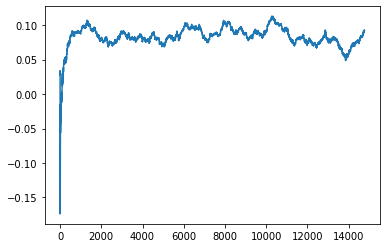

Thread: 4 iteration: 2460
RAM mDiffFit_268 FROM: 256 --> 1792 reward: -0.2868020796875
Saving ...


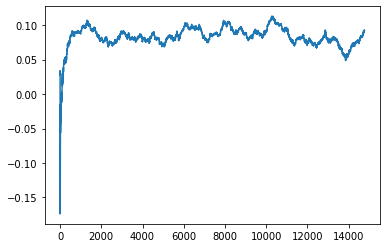

Thread: 6 iteration: 2470
RAM mBackground_20 FROM: 1024 --> 1792 reward: -0.043295596781249966
Thread: 2 iteration: 2425
RAM mProject_60 FROM: 1600 --> 1792 reward: -0.039353439796875035
Thread: 3 iteration: 2471
RAM mDiffFit_161 FROM: 1920 --> 1792 reward: 0.0003906195312499989
Thread: 5 iteration: 2547
RAM mDiffFit_246 FROM: 2048 --> 1792 reward: -0.03237504375
Thread: 1 iteration: 2393
RAM mDiffFit_81 FROM: 1344 --> 1792 reward: -0.008809889453124994
Thread: 4 iteration: 2461
RAM mDiffFit_399 FROM: 2880 --> 1792 reward: -0.001479203125000026
Thread: 6 iteration: 2471
RAM mDiffFit_156 FROM: 1088 --> 1792 reward: -0.05154949101562502
Thread: 2 iteration: 2426
RAM mDiffFit_354 FROM: 1664 --> 1792 reward: 0.02774482265625
Thread: 3 iteration: 2472
RAM mDiffFit_267 FROM: 832 --> 1792 reward: -0.07415365039062499
Thread: 1 iteration: 2394
RAM mBackground_64 FROM: 1984 --> 1792 reward: 0.015233644265625013
Thread: 5 iteration: 2548
RAM mDiffFit_347 FROM: 384 --> 1792 reward: -0.25159898203

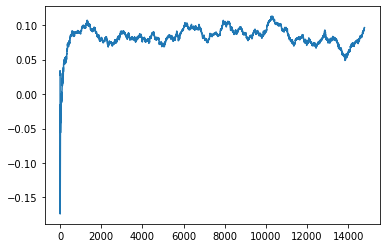

Thread: 5 iteration: 2550
RAM mProject_39 FROM: 2560 --> 1792 reward: -0.12778151118749992
Thread: 6 iteration: 2475
RAM mDiffFit_314 FROM: 2560 --> 1792 reward: 0.006729159375000009
Saving ...


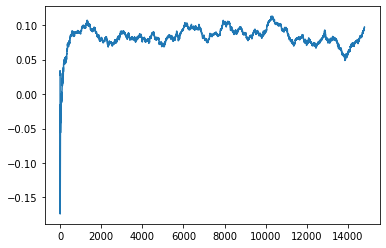

Thread: 2 iteration: 2430
RAM mBackground_45 FROM: 192 --> 1792 reward: -0.829949241046875
Thread: 4 iteration: 2466
RAM mBackground_55 FROM: 704 --> 1792 reward: -0.14261888038281242
Thread: 3 iteration: 2476
RAM mBackground_76 FROM: 1920 --> 1792 reward: -0.0028174130781249826
Thread: 5 iteration: 2551
RAM mDiffFit_381 FROM: 1984 --> 1792 reward: 0.027666681250000016
Thread: 2 iteration: 2431
RAM mProject_52 FROM: 2880 --> 1792 reward: -0.18119333608593755
Thread: 1 iteration: 2398
RAM mDiffFit_194 FROM: 1472 --> 1792 reward: 0.010114601562500013
Thread: 3 iteration: 2477
RAM mDiffFit_335 FROM: 960 --> 1792 reward: 0.0074870128906250055
Thread: 5 iteration: 2552
RAM mDiffFit_235 FROM: 1280 --> 1792 reward: -0.1130000875
Thread: 6 iteration: 2476
RAM mDiffFit_160 FROM: 3008 --> 1792 reward: -0.028601614453125004
Thread: 2 iteration: 2432
RAM mDiffFit_110 FROM: 2752 --> 1792 reward: -0.04956519804687498
Thread: 1 iteration: 2399
RAM mDiffFit_52 FROM: 448 --> 1792 reward: -0.07324477890

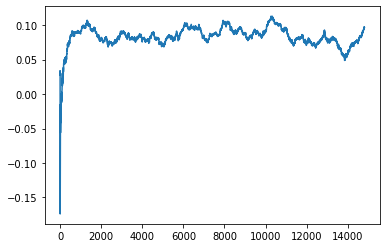

Thread: 1 iteration: 2400
RAM mDiffFit_186 FROM: 2752 --> 1792 reward: 0.006752588671875004
Thread: 4 iteration: 2468
RAM mDiffFit_393 FROM: 3008 --> 1792 reward: -0.024760485937500003
Thread: 3 iteration: 2479
RAM mBackground_67 FROM: 1856 --> 1792 reward: -0.022165186820312544
Thread: 6 iteration: 2477
RAM mProject_58 FROM: 768 --> 1792 reward: 0.6274468839375
Thread: 5 iteration: 2554
RAM mDiffFit_285 FROM: 896 --> 1792 reward: 0.022520884375
Thread: 1 iteration: 2401
RAM mDiffFit_196 FROM: 1152 --> 1792 reward: 0.03318234453125
Thread: 6 iteration: 2478
RAM mDiffFit_96 FROM: 1664 --> 1792 reward: -0.044552123437499994
Saving ...


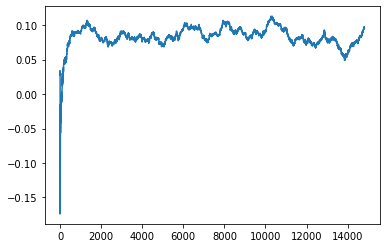

Thread: 3 iteration: 2480
RAM mDiffFit_233 FROM: 2304 --> 1792 reward: -0.021875043750000014
Thread: 5 iteration: 2555
RAM mDiffFit_133 FROM: 1280 --> 1792 reward: -0.028416681250000013
Thread: 3 iteration: 2481
RAM mBackground_40 FROM: 1728 --> 1792 reward: 0.004165634406249961
Thread: 6 iteration: 2479
RAM mProject_34 FROM: 2944 --> 1792 reward: -0.19673008748437487
Thread: 2 iteration: 2434
RAM mProject_18 FROM: 384 --> 1792 reward: 0.6259843839375
Thread: 4 iteration: 2469
RAM mDiffFit_16 FROM: 384 --> 1792 reward: -0.26887500000000003
Thread: 1 iteration: 2402
RAM mDiffFit_221 FROM: 640 --> 1792 reward: -0.039270796875000014
Thread: 5 iteration: 2556
RAM mDiffFit_64 FROM: 2240 --> 1792 reward: -0.013385442187499996
Thread: 3 iteration: 2482
RAM mDiffFit_374 FROM: 832 --> 1792 reward: -0.119841172265625
Saving ...


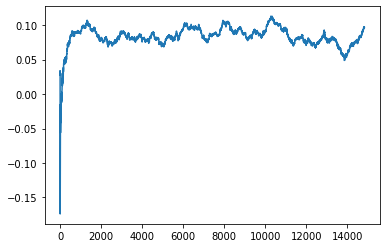

Thread: 6 iteration: 2480
RAM mBackground_57 FROM: 1664 --> 1792 reward: 0.001097413078125023
Thread: 2 iteration: 2435
RAM mDiffFit_150 FROM: 576 --> 1792 reward: -0.03227079687500001
Saving ...


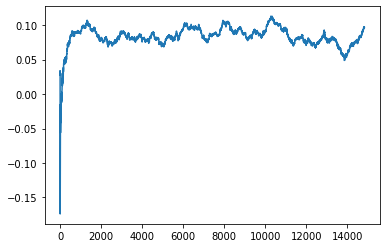

Thread: 4 iteration: 2470
RAM mDiffFit_383 FROM: 1984 --> 1792 reward: 0.09531519804687502
Thread: 1 iteration: 2403
RAM mDiffFit_185 FROM: 832 --> 1792 reward: -0.001880177343749987
Thread: 3 iteration: 2483
RAM mDiffFit_231 FROM: 1408 --> 1792 reward: 0.03668234453124999
Thread: 6 iteration: 2481
RAM mDiffFit_183 FROM: 2880 --> 1792 reward: -0.02147402578124999
Thread: 2 iteration: 2436
RAM mDiffFit_340 FROM: 1664 --> 1792 reward: -0.006354159374999998
Thread: 4 iteration: 2471
RAM mProject_6 FROM: 320 --> 1792 reward: 0.62191000434375
Thread: 5 iteration: 2557
RAM mDiffFit_292 FROM: 2944 --> 1792 reward: -0.026359424218750007
Thread: 2 iteration: 2437
RAM mBackground_41 FROM: 1216 --> 1792 reward: 0.003462450703125011
Thread: 1 iteration: 2404
RAM mBackground_47 FROM: 576 --> 1792 reward: -0.16781866891406247
Thread: 3 iteration: 2484
RAM mDiffFit_35 FROM: 2432 --> 1792 reward: 0.06017712343750001
Thread: 6 iteration: 2482
RAM mDiffFit_182 FROM: 2240 --> 1792 reward: -0.018575552734

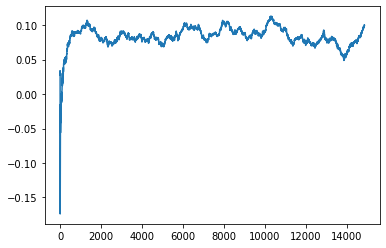

Thread: 2 iteration: 2440
RAM mDiffFit_67 FROM: 2496 --> 1792 reward: -0.0128021234375
Thread: 3 iteration: 2486
RAM mBackground_36 FROM: 2368 --> 1792 reward: -0.037531008046874974
Thread: 6 iteration: 2485
RAM mDiffFit_5 FROM: 2816 --> 1792 reward: 0.017395840625000006
Thread: 1 iteration: 2408
RAM mDiffFit_246 FROM: 832 --> 1792 reward: -0.06127865039062501
Thread: 2 iteration: 2441
RAM mDiffFit_47 FROM: 1088 --> 1792 reward: 0.01881515429687501
Thread: 3 iteration: 2487
RAM mDiffFit_33 FROM: 1088 --> 1792 reward: 0.019828185156249983
Thread: 6 iteration: 2486
RAM mProject_67 FROM: 3008 --> 1792 reward: -0.20195291475000016
Saving ...


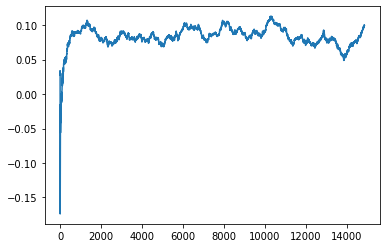

Thread: 5 iteration: 2560
RAM mProject_16 FROM: 832 --> 1792 reward: -0.33762046071093743
Thread: 4 iteration: 2474
RAM mDiffFit_144 FROM: 192 --> 1792 reward: -0.20453641640624998
Thread: 5 iteration: 2561
RAM mBackground_42 FROM: 2304 --> 1792 reward: -0.03835965231249996
Thread: 4 iteration: 2475
RAM mBackground_30 FROM: 2048 --> 1792 reward: -0.03548401790624998
Thread: 5 iteration: 2562
RAM mDiffFit_249 FROM: 2880 --> 1792 reward: -0.032239645312500016
Thread: 4 iteration: 2476
RAM mProject_61 FROM: 1024 --> 1792 reward: -0.23452500262499995
Thread: 1 iteration: 2409
RAM mDiffFit_97 FROM: 2944 --> 1792 reward: 0.005901017968750009
Thread: 5 iteration: 2563
RAM mProject_65 FROM: 2880 --> 1792 reward: -0.1809903701250001
Thread: 2 iteration: 2442
RAM mProject_69 FROM: 320 --> 1792 reward: 0.6116912451562501
Thread: 3 iteration: 2488
RAM mViewer_4 FROM: 3008 --> 1792 reward: -0.16818347390625005
Thread: 4 iteration: 2477
RAM mDiffFit_129 FROM: 1152 --> 1792 reward: 0.0034219023437500

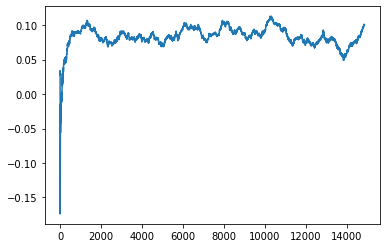

Thread: 1 iteration: 2410
RAM mDiffFit_125 FROM: 1536 --> 1792 reward: -0.022395840624999993
Thread: 5 iteration: 2565
RAM mDiffFit_142 FROM: 2368 --> 1792 reward: -0.007031282812499998
Saving ...


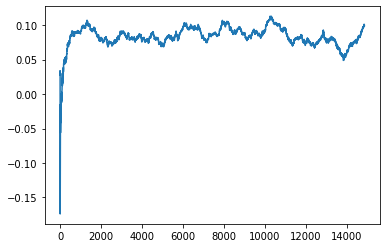

Thread: 3 iteration: 2490
RAM mDiffFit_147 FROM: 1280 --> 1792 reward: 0.29660450937500005
Thread: 2 iteration: 2444
RAM mDiffFit_204 FROM: 1024 --> 1792 reward: 0.037260485937500004
Thread: 1 iteration: 2411
RAM mDiffFit_317 FROM: 256 --> 1792 reward: -0.16015619531249997
Thread: 5 iteration: 2566
RAM mDiffFit_325 FROM: 1024 --> 1792 reward: -0.0199270796875
Thread: 2 iteration: 2445
RAM mDiffFit_204 FROM: 1024 --> 1792 reward: 0.01750004375
Thread: 1 iteration: 2412
RAM mBackground_74 FROM: 128 --> 1792 reward: -1.37685101971875
Thread: 5 iteration: 2567
RAM mProject_9 FROM: 768 --> 1792 reward: 0.62987876353125
Thread: 4 iteration: 2479
RAM mDiffFit_148 FROM: 1536 --> 1792 reward: -0.039833362500000004
Thread: 1 iteration: 2413
RAM mProject_87 FROM: 256 --> 1792 reward: 0.63089126353125
Thread: 3 iteration: 2491
RAM mBackground_85 FROM: 2944 --> 1792 reward: -0.06914951609375
Thread: 5 iteration: 2568
RAM mDiffFit_36 FROM: 1664 --> 1792 reward: -0.019614601562500007
Thread: 3 iterat

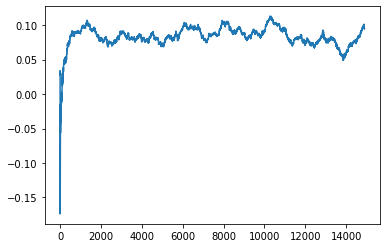

Thread: 4 iteration: 2480
RAM mBackground_10 FROM: 1664 --> 1792 reward: -0.0505429605625
Thread: 6 iteration: 2489
RAM mDiffFit_409 FROM: 2880 --> 1792 reward: -0.022617233984375013
Thread: 3 iteration: 2494
RAM mDiffFit_306 FROM: 1152 --> 1792 reward: 0.009604203124999999
Thread: 4 iteration: 2481
RAM mDiffFit_301 FROM: 768 --> 1792 reward: -0.004604115624999988
Saving ...


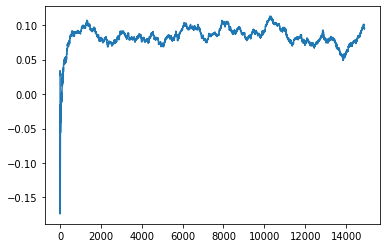

Thread: 6 iteration: 2490
RAM mDiffFit_280 FROM: 2880 --> 192 reward: 0.6259375218749998
Thread: 2 iteration: 2448
RAM mBackground_10 FROM: 1536 --> 192 reward: 1.0029816787734376
Thread: 5 iteration: 2569
RAM mDiffFit_129 FROM: 640 --> 1792 reward: -0.01810933671874999
Thread: 6 iteration: 2491
RAM mDiffFit_174 FROM: 2880 --> 192 reward: 0.44978904882812487
Thread: 4 iteration: 2482
RAM mProject_3 FROM: 1600 --> 1792 reward: -0.027079677984374884
Thread: 1 iteration: 2416
RAM mDiffFit_248 FROM: 1856 --> 1792 reward: 0.0474479640625
Thread: 6 iteration: 2492
RAM mDiffFit_22 FROM: 960 --> 1792 reward: -0.0006379871093750017
Thread: 4 iteration: 2483
RAM mBackground_32 FROM: 768 --> 1792 reward: -0.08741538531249997
Thread: 1 iteration: 2417
RAM mProject_63 FROM: 1728 --> 1792 reward: -0.009766405757812579
Saving ...


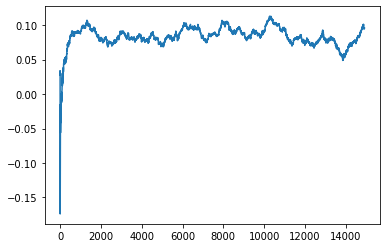

Thread: 5 iteration: 2570
RAM mDiffFit_138 FROM: 128 --> 192 reward: -0.8680938484375
Thread: 2 iteration: 2449
RAM mBackground_55 FROM: 192 --> 1792 reward: -0.7372304722343748
Thread: 6 iteration: 2493
RAM mDiffFit_232 FROM: 256 --> 1792 reward: -0.2058020796875
Thread: 1 iteration: 2418
RAM mDiffFit_180 FROM: 3008 --> 192 reward: 0.37410152695312504
Thread: 4 iteration: 2484
RAM mDiffFit_4 FROM: 1920 --> 1792 reward: 0.023026061718750008
Thread: 4 iteration: 2485
RAM mBackground_69 FROM: 2624 --> 1792 reward: -0.014812662171875005
Thread: 1 iteration: 2419
RAM mProject_66 FROM: 1472 --> 1792 reward: -0.06475312040624992
Thread: 3 iteration: 2495
RAM mProject_77 FROM: 512 --> 1792 reward: 0.6267043839374999
Thread: 6 iteration: 2494
RAM mDiffFit_118 FROM: 256 --> 192 reward: 0.15584634960937482
Saving ...


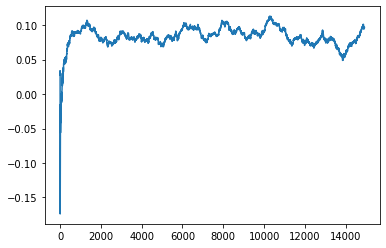

Thread: 1 iteration: 2420
RAM mBackground_27 FROM: 448 --> 192 reward: 0.4111628230390624
Thread: 4 iteration: 2486
RAM mDiffFit_249 FROM: 2112 --> 1792 reward: -0.06269278671874998
Thread: 1 iteration: 2421
RAM mDiffFit_385 FROM: 2432 --> 192 reward: 0.223700508984375
Thread: 6 iteration: 2495
RAM mDiffFit_170 FROM: 2112 --> 192 reward: 0.42671876093750005
Thread: 4 iteration: 2487
RAM mProject_22 FROM: 2496 --> 192 reward: -1.0
Thread: 5 iteration: 2571
RAM mProject_36 FROM: 1792 --> 192 reward: -1.0
Saving ...


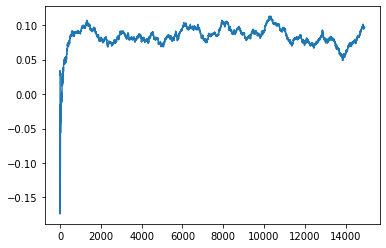

Thread: 2 iteration: 2450
RAM mDiffFit_202 FROM: 512 --> 192 reward: 0.17088280976562495
Thread: 6 iteration: 2496
RAM mDiffFit_70 FROM: 2560 --> 192 reward: 0.2967187171875
Thread: 1 iteration: 2422
RAM mProject_67 FROM: 2496 --> 192 reward: -1.0
Thread: 3 iteration: 2496
RAM mDiffFit_37 FROM: 832 --> 1792 reward: 0.006044313671874999
Thread: 1 iteration: 2423
RAM mDiffFit_135 FROM: 2368 --> 192 reward: 0.46860157070312497
Thread: 4 iteration: 2488
RAM mDiffFit_18 FROM: 2560 --> 192 reward: 0.22663794335937498
Thread: 5 iteration: 2572
RAM mDiffFit_317 FROM: 1792 --> 192 reward: 0.211028606640625
Thread: 6 iteration: 2497
RAM mDiffFit_200 FROM: 3008 --> 1792 reward: -0.3883963656250001
Thread: 3 iteration: 2497
RAM mDiffFit_362 FROM: 640 --> 192 reward: 0.6083750875
Thread: 2 iteration: 2451
RAM mDiffFit_174 FROM: 2304 --> 1792 reward: 0.017322920312499997
Thread: 4 iteration: 2489
RAM mDiffFit_30 FROM: 2240 --> 1792 reward: -0.07303654765624999
Thread: 1 iteration: 2424
RAM mDiffFit_

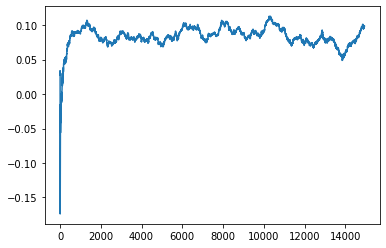

Thread: 4 iteration: 2490
RAM mDiffFit_8 FROM: 1088 --> 1792 reward: -0.003820287890624989
Thread: 5 iteration: 2574
RAM mBackground_19 FROM: 192 --> 1792 reward: -0.7586319525156251
Thread: 2 iteration: 2453
RAM mDiffFit_340 FROM: 704 --> 192 reward: 0.060236925390625
Thread: 3 iteration: 2499
RAM mDiffFit_258 FROM: 1216 --> 192 reward: 0.638492233984375
Saving ...


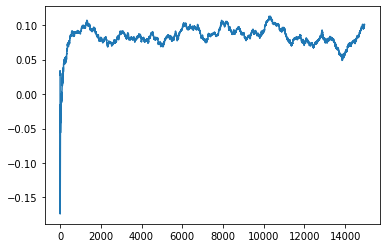

Thread: 3 iteration: 2500
RAM mDiffFit_153 FROM: 2624 --> 192 reward: 0.5129921027343751
Thread: 4 iteration: 2491
RAM mDiffFit_195 FROM: 1216 --> 1792 reward: -0.025286460156250003
Thread: 3 iteration: 2501
RAM mProject_85 FROM: 768 --> 192 reward: -1.0
Thread: 1 iteration: 2425
RAM mProject_77 FROM: 2880 --> 192 reward: -1.0
Thread: 6 iteration: 2499
RAM mDiffFit_127 FROM: 2304 --> 1792 reward: -0.0698750875
Thread: 1 iteration: 2426
RAM mProject_61 FROM: 2880 --> 192 reward: -1.0
Thread: 5 iteration: 2575
RAM mProject_34 FROM: 2880 --> 192 reward: -1.0
Thread: 2 iteration: 2454
RAM mDiffFit_58 FROM: 832 --> 192 reward: 0.6482813265624999
Saving ...


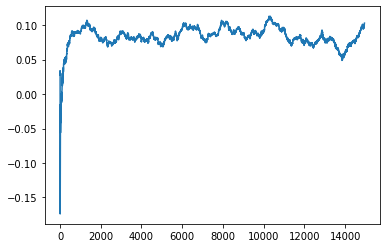

Thread: 6 iteration: 2500
RAM mProject_45 FROM: 1792 --> 192 reward: -1.0
Thread: 4 iteration: 2492
RAM mDiffFit_70 FROM: 1216 --> 192 reward: 0.44855993320312504
Thread: 1 iteration: 2427
RAM mDiffFit_289 FROM: 1856 --> 192 reward: 0.5927188046875
Thread: 2 iteration: 2455
RAM mImgtbl_3 FROM: 1664 --> 192 reward: -1.0
Thread: 3 iteration: 2502
RAM mBackground_25 FROM: 2624 --> 192 reward: 0.7047563790781249
Thread: 6 iteration: 2501
RAM mDiffFit_89 FROM: 2752 --> 192 reward: 0.3675832750000001
Thread: 3 iteration: 2503
RAM mDiffFit_301 FROM: 1472 --> 192 reward: 0.29399473515625
Thread: 6 iteration: 2502
RAM mBackground_18 FROM: 1600 --> 192 reward: 0.9031343655937499
Thread: 2 iteration: 2456
RAM mDiffFit_277 FROM: 2624 --> 192 reward: 0.364111925390625
Thread: 6 iteration: 2503
RAM mProject_34 FROM: 2688 --> 192 reward: -1.0
Thread: 5 iteration: 2576
RAM mDiffFit_33 FROM: 2048 --> 192 reward: 0.17808840859375002
Thread: 3 iteration: 2504
RAM mDiffFit_213 FROM: 1728 --> 192 reward: 0

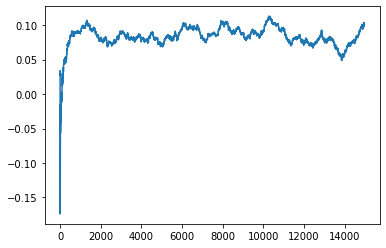

Thread: 1 iteration: 2430
RAM mDiffFit_58 FROM: 128 --> 192 reward: -0.7480964371093751
Saving ...


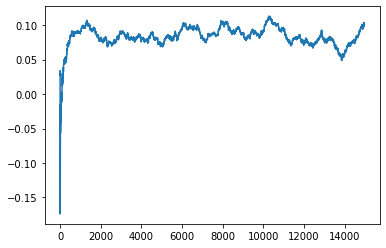

Thread: 2 iteration: 2460
RAM mDiffFit_87 FROM: 1152 --> 192 reward: 0.370679712109375
Thread: 4 iteration: 2495
RAM mBackground_83 FROM: 1216 --> 192 reward: 0.9228897638828123
Thread: 5 iteration: 2579
RAM mDiffFit_17 FROM: 2880 --> 192 reward: 0.158335863671875
Thread: 1 iteration: 2431
RAM mDiffFit_339 FROM: 2048 --> 192 reward: 0.35815101796875
Thread: 3 iteration: 2506
RAM mDiffFit_32 FROM: 2816 --> 192 reward: 0.30354940351562504
Thread: 6 iteration: 2507
RAM mDiffFit_219 FROM: 2048 --> 192 reward: 0.190127544921875
Thread: 4 iteration: 2496
RAM mBackground_79 FROM: 704 --> 192 reward: 0.6440168033203124
Thread: 2 iteration: 2461
RAM mBackground_27 FROM: 1920 --> 192 reward: 0.73161805915625
Saving ...


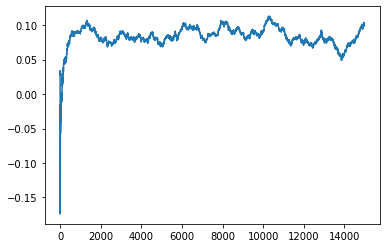

Thread: 5 iteration: 2580
RAM mDiffFit_206 FROM: 1408 --> 192 reward: 0.21652338554687506
Thread: 1 iteration: 2432
RAM mDiffFit_65 FROM: 2496 --> 192 reward: 0.343937478125
Thread: 4 iteration: 2497
RAM mDiffFit_390 FROM: 1152 --> 192 reward: 0.382585951171875
Thread: 3 iteration: 2507
RAM mDiffFit_127 FROM: 2816 --> 192 reward: 0.04830449335937497
Thread: 1 iteration: 2433
RAM mDiffFit_92 FROM: 1280 --> 192 reward: 0.332804668359375
Thread: 5 iteration: 2581
RAM mDiffFit_310 FROM: 1856 --> 192 reward: 0.13056497929687505
Thread: 4 iteration: 2498
RAM mDiffFit_66 FROM: 1216 --> 192 reward: 0.209325508984375
Thread: 1 iteration: 2434
RAM mDiffFit_301 FROM: 512 --> 192 reward: 0.15483331875
Thread: 5 iteration: 2582
RAM mDiffFit_369 FROM: 2240 --> 192 reward: 0.15476557578125
Thread: 4 iteration: 2499
RAM mProject_37 FROM: 1408 --> 192 reward: -1.0
Thread: 6 iteration: 2508
RAM mDiffFit_384 FROM: 3008 --> 192 reward: 0.1814581875
Thread: 1 iteration: 2435
RAM mDiffFit_143 FROM: 1280 -->

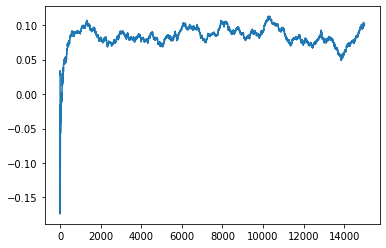

Thread: 4 iteration: 2500
RAM mDiffFit_330 FROM: 256 --> 192 reward: 0.057249999999999975
Thread: 6 iteration: 2509
RAM mProject_15 FROM: 448 --> 192 reward: -1.0
Thread: 2 iteration: 2462
RAM mProject_49 FROM: 3008 --> 192 reward: -1.0
Thread: 3 iteration: 2508
RAM mDiffFit_144 FROM: 896 --> 192 reward: 0.209565110546875
Thread: 5 iteration: 2584
RAM mDiffFit_192 FROM: 192 --> 192 reward: -0.05746876093749999
Thread: 1 iteration: 2436
RAM mDiffFit_229 FROM: 2496 --> 192 reward: 0.36754685859374997
Thread: 2 iteration: 2463
RAM mDiffFit_346 FROM: 2944 --> 192 reward: 0.48008581992187493
Thread: 4 iteration: 2501
RAM mDiffFit_147 FROM: 1664 --> 192 reward: 0.54076561953125
Saving ...


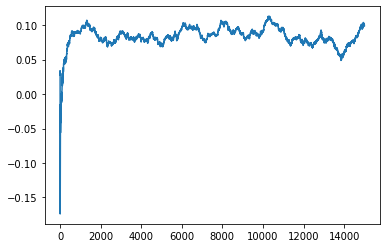

Thread: 6 iteration: 2510
RAM mDiffFit_246 FROM: 1600 --> 192 reward: 0.28180725703125
Thread: 3 iteration: 2509
RAM mDiffFit_407 FROM: 256 --> 192 reward: 0.111020840625
Thread: 5 iteration: 2585
RAM mDiffFit_176 FROM: 1344 --> 192 reward: 0.1715312390625
Thread: 2 iteration: 2464
RAM mDiffFit_274 FROM: 320 --> 192 reward: -0.2804063703125
Thread: 1 iteration: 2437
RAM mDiffFit_319 FROM: 1472 --> 192 reward: 0.09760148320312498
Thread: 6 iteration: 2511
RAM mDiffFit_91 FROM: 2048 --> 192 reward: 0.29871608476562495
Thread: 4 iteration: 2502
RAM mBackground_77 FROM: 2688 --> 192 reward: 0.7215398118749999
Saving ...


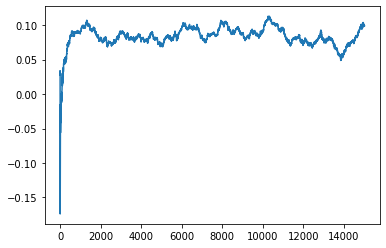

Thread: 3 iteration: 2510
RAM mDiffFit_286 FROM: 1728 --> 192 reward: 0.221226526953125
Thread: 6 iteration: 2512
RAM mDiffFit_139 FROM: 2880 --> 192 reward: 0.621367102734375
Thread: 5 iteration: 2586
RAM mBackground_60 FROM: 960 --> 192 reward: 0.6435822755546875
Thread: 1 iteration: 2438
RAM mDiffFit_152 FROM: 1408 --> 192 reward: 0.16722126210937496
Thread: 3 iteration: 2511
RAM mDiffFit_140 FROM: 2816 --> 192 reward: 0.1402603109375
Thread: 5 iteration: 2587
RAM mBackground_42 FROM: 2560 --> 192 reward: 0.7284713920546875
Thread: 6 iteration: 2513
RAM mDiffFit_114 FROM: 2496 --> 192 reward: 0.17353119531250003
Thread: 1 iteration: 2439
RAM mDiffFit_152 FROM: 2816 --> 192 reward: 0.1496353109375
Thread: 3 iteration: 2512
RAM mDiffFit_302 FROM: 1728 --> 192 reward: 0.57226561953125
Thread: 5 iteration: 2588
RAM mProject_35 FROM: 832 --> 192 reward: -1.0
Thread: 2 iteration: 2465
RAM mProject_68 FROM: 2176 --> 192 reward: -1.0
Thread: 4 iteration: 2503
RAM mDiffFit_360 FROM: 512 --> 

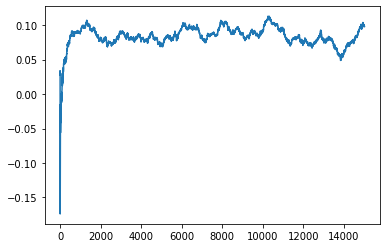

Thread: 1 iteration: 2440
RAM mDiffFit_404 FROM: 2816 --> 192 reward: 0.224664005078125
Thread: 3 iteration: 2513
RAM mDiffFit_156 FROM: 1856 --> 192 reward: 0.47199473515625007
Thread: 6 iteration: 2514
RAM mDiffFit_239 FROM: 576 --> 192 reward: 0.45342966835937504
Thread: 5 iteration: 2589
RAM mDiffFit_194 FROM: 192 --> 192 reward: -0.031734380468749976
Thread: 2 iteration: 2466
RAM mDiffFit_398 FROM: 2944 --> 192 reward: 0.17586964765625002
Thread: 1 iteration: 2441
RAM mDiffFit_47 FROM: 1856 --> 192 reward: 0.21083068632812493
Thread: 6 iteration: 2515
RAM mDiffFit_296 FROM: 2688 --> 192 reward: 0.18879681484375
Thread: 3 iteration: 2514
RAM mDiffFit_382 FROM: 3008 --> 192 reward: 0.44986705898437496
Thread: 4 iteration: 2504
RAM mDiffFit_400 FROM: 576 --> 192 reward: 0.5047578972656249
Saving ...


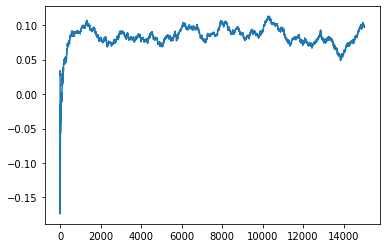

Thread: 5 iteration: 2590
RAM mBackground_77 FROM: 2368 --> 192 reward: 0.6973568772656248
Thread: 2 iteration: 2467
RAM mDiffFit_249 FROM: 3008 --> 192 reward: 0.29789057578125006
Thread: 4 iteration: 2505
RAM mDiffFit_373 FROM: 320 --> 192 reward: 0.276148473046875
Thread: 3 iteration: 2515
RAM mDiffFit_212 FROM: 3008 --> 192 reward: 0.1604686734375
Thread: 2 iteration: 2468
RAM mDiffFit_417 FROM: 1408 --> 192 reward: 0.36901303085937504
Thread: 5 iteration: 2591
RAM mDiffFit_220 FROM: 832 --> 192 reward: 0.28229168125
Thread: 3 iteration: 2516
RAM mDiffFit_119 FROM: 2560 --> 192 reward: 0.202645753125
Thread: 2 iteration: 2469
RAM mDiffFit_423 FROM: 832 --> 192 reward: 0.26274477890625003
Thread: 5 iteration: 2592
RAM mDiffFit_412 FROM: 1664 --> 192 reward: 0.22329944726562495
Saving ...


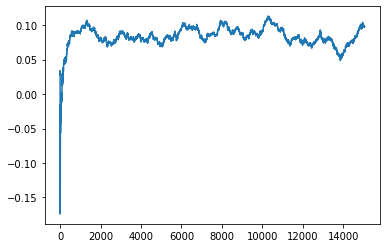

Thread: 2 iteration: 2470
RAM mDiffFit_308 FROM: 896 --> 192 reward: 0.157174447265625
Thread: 5 iteration: 2593
RAM mProject_65 FROM: 2432 --> 192 reward: -1.0
Thread: 1 iteration: 2442
RAM mProject_76 FROM: 2752 --> 192 reward: -1.0
Thread: 6 iteration: 2516
RAM mDiffFit_405 FROM: 2432 --> 192 reward: 0.079945156640625
Thread: 3 iteration: 2517
RAM mProject_88 FROM: 1856 --> 192 reward: -1.0
Thread: 4 iteration: 2506
RAM mDiffFit_160 FROM: 896 --> 192 reward: 0.21142707968750002
Thread: 3 iteration: 2518
RAM mDiffFit_239 FROM: 256 --> 192 reward: 0.25444533164062505
Thread: 3 iteration: 2519
RAM mBackground_16 FROM: 1280 --> 192 reward: 0.6728693279687499
Thread: 4 iteration: 2507
RAM mDiffFit_390 FROM: 2560 --> 192 reward: 0.25874732382812493
Saving ...


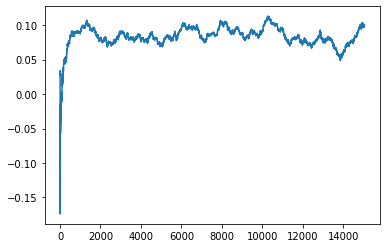

Thread: 3 iteration: 2520
RAM mDiffFit_241 FROM: 2752 --> 192 reward: 0.18130462460937496
Thread: 4 iteration: 2508
RAM mDiffFit_154 FROM: 2752 --> 192 reward: 0.12209885078125002
Thread: 3 iteration: 2521
RAM mProject_18 FROM: 1344 --> 192 reward: -1.0
Thread: 2 iteration: 2471
RAM mDiffFit_29 FROM: 2560 --> 192 reward: 0.26785933671875006
Thread: 4 iteration: 2509
RAM mProject_49 FROM: 2944 --> 192 reward: -1.0
Thread: 5 iteration: 2594
RAM mProject_11 FROM: 2688 --> 192 reward: -1.0
Thread: 1 iteration: 2443
RAM mProject_48 FROM: 1984 --> 192 reward: -1.0
Thread: 6 iteration: 2517
RAM mDiffFit_247 FROM: 896 --> 192 reward: 0.32809376093750003
Thread: 2 iteration: 2472
RAM mDiffFit_124 FROM: 2816 --> 192 reward: 0.15401031093749995
Thread: 5 iteration: 2595
RAM mDiffFit_80 FROM: 1152 --> 192 reward: 0.39541409257812493
Saving ...


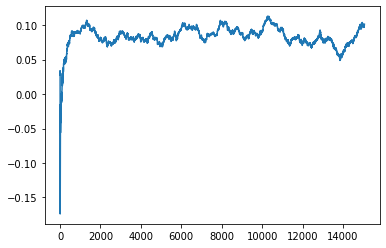

Thread: 4 iteration: 2510
RAM mBackground_11 FROM: 512 --> 192 reward: 0.43157884275781244
Thread: 3 iteration: 2522
RAM mDiffFit_210 FROM: 1408 --> 192 reward: 0.237674447265625
Thread: 3 iteration: 2523
RAM mDiffFit_22 FROM: 1280 --> 192 reward: 0.17451820820312505
Thread: 3 iteration: 2524
RAM mProject_81 FROM: 2560 --> 192 reward: -1.0
Thread: 1 iteration: 2444
RAM mProject_10 FROM: 1408 --> 192 reward: -1.0
Thread: 6 iteration: 2518
RAM mDiffFit_255 FROM: 2688 --> 192 reward: 0.173148341796875
Thread: 3 iteration: 2525
RAM mProject_72 FROM: 2368 --> 192 reward: -1.0
Thread: 2 iteration: 2473
RAM mImgtbl_1 FROM: 2432 --> 192 reward: -1.0
Thread: 5 iteration: 2596
RAM mProject_13 FROM: 512 --> 192 reward: -1.0
Thread: 4 iteration: 2511
RAM mDiffFit_213 FROM: 2304 --> 192 reward: 0.47857024414062505
Thread: 3 iteration: 2526
RAM mBackground_18 FROM: 1792 --> 192 reward: 0.8645508082499999
Thread: 2 iteration: 2474
RAM mBackground_55 FROM: 2816 --> 192 reward: 0.9610274740468748
Threa

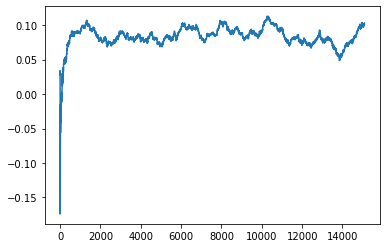

Thread: 3 iteration: 2530
RAM mDiffFit_187 FROM: 512 --> 192 reward: 0.15005466835937498
Thread: 4 iteration: 2514
RAM mBackground_19 FROM: 896 --> 192 reward: 0.7780559081484374
Thread: 1 iteration: 2448
RAM mProject_81 FROM: 2048 --> 192 reward: -1.0
Saving ...


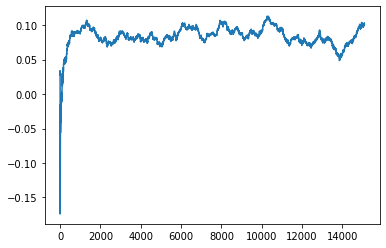

Thread: 6 iteration: 2520
RAM mDiffFit_66 FROM: 1024 --> 192 reward: 0.25864584062499996
Thread: 3 iteration: 2531
RAM mBackground_71 FROM: 1600 --> 192 reward: 0.8039655967812501
Thread: 2 iteration: 2478
RAM mDiffFit_204 FROM: 1792 --> 192 reward: 0.241262987109375
Thread: 6 iteration: 2521
RAM mDiffFit_117 FROM: 704 --> 192 reward: 0.33463022109374996
Thread: 1 iteration: 2449
RAM mBackground_9 FROM: 448 --> 192 reward: 0.500273644265625
Thread: 3 iteration: 2532
RAM mProject_47 FROM: 1728 --> 192 reward: -1.0
Thread: 5 iteration: 2598
RAM mDiffFit_51 FROM: 128 --> 192 reward: -0.5258073445312499
Thread: 2 iteration: 2479
RAM mBackground_43 FROM: 896 --> 192 reward: 0.6801143902421874
Thread: 6 iteration: 2522
RAM mDiffFit_405 FROM: 512 --> 192 reward: 0.15092707968749997
Thread: 3 iteration: 2533
RAM mDiffFit_191 FROM: 128 --> 192 reward: -0.3332317917968749
Thread: 5 iteration: 2599
RAM mDiffFit_226 FROM: 1472 --> 192 reward: 0.25400258867187503
Saving ...


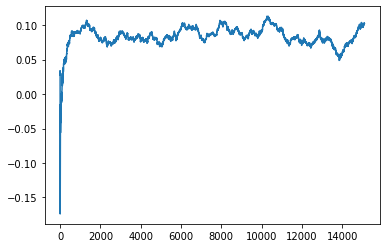

Thread: 2 iteration: 2480
RAM mProject_55 FROM: 1536 --> 192 reward: -1.0
Thread: 4 iteration: 2515
RAM mDiffFit_36 FROM: 2624 --> 192 reward: 0.34624473515625
Thread: 6 iteration: 2523
RAM mDiffFit_116 FROM: 1984 --> 192 reward: 0.31550517734375
Saving ...


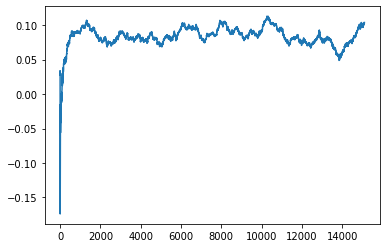

Thread: 5 iteration: 2600
RAM mBackground_7 FROM: 2496 --> 192 reward: 0.7376514543281251
Thread: 2 iteration: 2481
RAM mProject_57 FROM: 960 --> 192 reward: -1.0
Saving ...


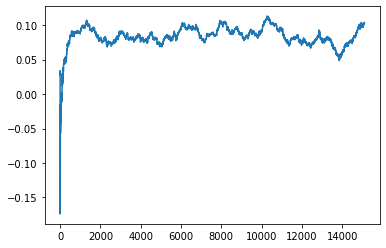

Thread: 1 iteration: 2450
RAM mDiffFit_75 FROM: 832 --> 192 reward: 0.2402603984375
Thread: 5 iteration: 2601
RAM mBackground_14 FROM: 2816 --> 192 reward: 0.7327175856171874
Thread: 6 iteration: 2524
RAM mDiffFit_202 FROM: 1984 --> 192 reward: 0.156716084765625
Thread: 2 iteration: 2482
RAM mDiffFit_174 FROM: 1728 --> 192 reward: 0.220351526953125
Thread: 1 iteration: 2451
RAM mDiffFit_31 FROM: 832 --> 192 reward: 0.17067444726562497
Thread: 5 iteration: 2602
RAM mDiffFit_13 FROM: 448 --> 192 reward: 0.136236969140625
Thread: 6 iteration: 2525
RAM mDiffFit_208 FROM: 1920 --> 192 reward: 0.20857809765625
Thread: 2 iteration: 2483
RAM mDiffFit_360 FROM: 384 --> 192 reward: 0.13424999999999998
Thread: 1 iteration: 2452
RAM mProject_80 FROM: 2304 --> 192 reward: -1.0
Thread: 3 iteration: 2534
RAM mDiffFit_129 FROM: 2816 --> 192 reward: 0.294867146484375
Thread: 5 iteration: 2603
RAM mProject_38 FROM: 2368 --> 192 reward: -1.0
Thread: 4 iteration: 2516
RAM mDiffFit_225 FROM: 1664 --> 192 r

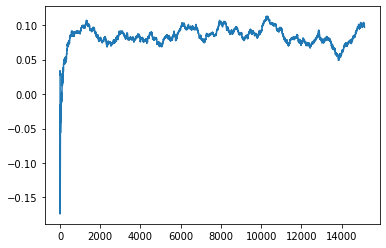

Thread: 3 iteration: 2540
RAM mDiffFit_291 FROM: 1408 --> 192 reward: 0.525434889453125
Saving ...


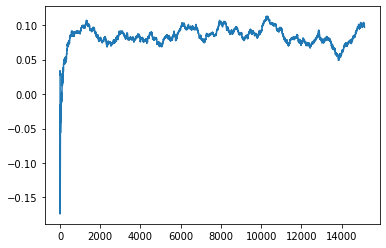

Thread: 6 iteration: 2530
RAM mDiffFit_32 FROM: 2176 --> 192 reward: 0.1759686296875
Thread: 4 iteration: 2519
RAM mDiffFit_163 FROM: 2432 --> 192 reward: 0.360830686328125
Thread: 5 iteration: 2608
RAM mDiffFit_17 FROM: 1408 --> 192 reward: 0.20985670429687497
Thread: 2 iteration: 2489
RAM mDiffFit_312 FROM: 1088 --> 192 reward: 0.20035415937499998
Thread: 6 iteration: 2531
RAM mDiffFit_332 FROM: 1728 --> 192 reward: 0.24890623906249995
Saving ...


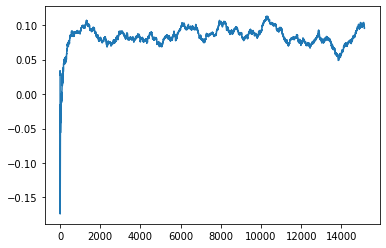

Thread: 4 iteration: 2520
RAM mDiffFit_43 FROM: 128 --> 192 reward: -0.5004766144531251
Thread: 5 iteration: 2609
RAM mBackground_86 FROM: 1664 --> 192 reward: 0.7677783951718751
Thread: 3 iteration: 2541
RAM mProject_52 FROM: 256 --> 192 reward: -1.0
Thread: 1 iteration: 2455
RAM mDiffFit_1 FROM: 3008 --> 192 reward: 0.26897126210937505
Saving ...


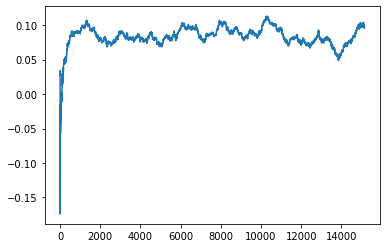

Thread: 2 iteration: 2490
RAM mDiffFit_284 FROM: 3008 --> 192 reward: 0.15759613085937502
Thread: 4 iteration: 2521
RAM mBackground_71 FROM: 1920 --> 192 reward: 0.8271318279687501
Saving ...


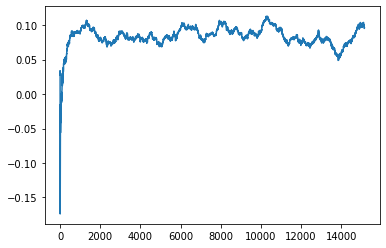

Thread: 5 iteration: 2610
RAM mDiffFit_6 FROM: 2368 --> 192 reward: 0.21623951406249994
Thread: 1 iteration: 2456
RAM mBackground_6 FROM: 2048 --> 192 reward: 0.8439511066406251
Thread: 3 iteration: 2542
RAM mDiffFit_164 FROM: 1216 --> 192 reward: 0.292736969140625
Thread: 4 iteration: 2522
RAM mDiffFit_231 FROM: 832 --> 192 reward: 0.211164005078125
Thread: 2 iteration: 2491
RAM mDiffFit_223 FROM: 1024 --> 192 reward: 0.15804422617187502
Thread: 1 iteration: 2457
RAM mDiffFit_79 FROM: 960 --> 192 reward: 0.2428437171875
Thread: 2 iteration: 2492
RAM mDiffFit_102 FROM: 2176 --> 192 reward: 0.6476848457031249
Thread: 3 iteration: 2543
RAM mProject_11 FROM: 1152 --> 192 reward: -1.0
Thread: 6 iteration: 2532
RAM mBackground_67 FROM: 1280 --> 192 reward: 0.7980419278671874
Thread: 1 iteration: 2458
RAM mDiffFit_306 FROM: 576 --> 192 reward: 0.06096867343750003
Thread: 2 iteration: 2493
RAM mDiffFit_111 FROM: 128 --> 192 reward: -0.146382809765625
Thread: 6 iteration: 2533
RAM mDiffFit_137

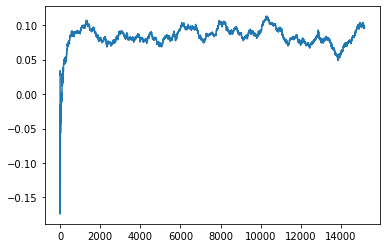

Thread: 1 iteration: 2460
RAM mDiffFit_375 FROM: 832 --> 192 reward: 0.71806774296875
Thread: 2 iteration: 2495
RAM mDiffFit_203 FROM: 128 --> 192 reward: -0.69069278671875
Thread: 1 iteration: 2461
RAM mDiffFit_99 FROM: 2816 --> 192 reward: 0.14986701523437504
Thread: 4 iteration: 2524
RAM mDiffFit_250 FROM: 1984 --> 192 reward: 0.4124426992187501
Thread: 3 iteration: 2546
RAM mBackground_12 FROM: 1024 --> 192 reward: 0.7122457213281249
Thread: 5 iteration: 2612
RAM mDiffFit_84 FROM: 1152 --> 192 reward: 0.18553904882812502
Thread: 2 iteration: 2496
RAM mDiffFit_153 FROM: 2816 --> 192 reward: 0.30424214648437503
Thread: 4 iteration: 2525
RAM mDiffFit_300 FROM: 1472 --> 192 reward: 0.22240101796875
Thread: 5 iteration: 2613
RAM mDiffFit_251 FROM: 2560 --> 192 reward: 0.24399995624999998
Thread: 2 iteration: 2497
RAM mViewer_3 FROM: 1920 --> 192 reward: 0.6263295756093751
Thread: 1 iteration: 2462
RAM mViewer_1 FROM: 2880 --> 192 reward: 0.5902254445312499
Thread: 3 iteration: 2547
RAM 

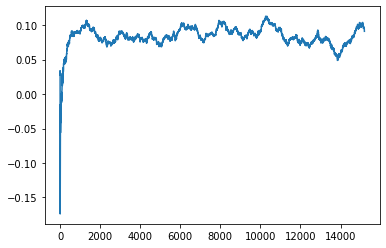

Thread: 3 iteration: 2550
RAM mDiffFit_405 FROM: 384 --> 192 reward: 0.046265575781250026
Thread: 1 iteration: 2465
RAM mDiffFit_100 FROM: 1856 --> 192 reward: 0.20651812070312503
Thread: 3 iteration: 2551
RAM mDiffFit_106 FROM: 2688 --> 192 reward: 0.21037491249999998
Thread: 3 iteration: 2552
RAM mProject_86 FROM: 640 --> 192 reward: -1.0
Thread: 4 iteration: 2527
RAM mDiffFit_315 FROM: 512 --> 192 reward: -0.018057388281250003
Thread: 3 iteration: 2553
RAM mDiffFit_27 FROM: 1024 --> 192 reward: 0.21698696914062496
Thread: 4 iteration: 2528
RAM mDiffFit_407 FROM: 1536 --> 192 reward: 0.23921086367187497
Thread: 3 iteration: 2554
RAM mProject_40 FROM: 576 --> 192 reward: -1.0
Saving ...


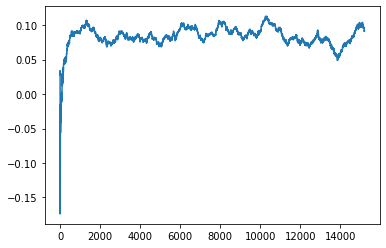

Thread: 2 iteration: 2500
RAM mBackground_57 FROM: 832 --> 192 reward: -1.0
Thread: 5 iteration: 2614
RAM mProject_15 FROM: 768 --> 192 reward: -1.0
Thread: 6 iteration: 2537
RAM mDiffFit_125 FROM: 2560 --> 192 reward: 0.27635152695312504
Thread: 2 iteration: 2501
RAM mProject_23 FROM: 1984 --> 192 reward: -1.0
Thread: 1 iteration: 2466
RAM mBackground_29 FROM: 576 --> 192 reward: 0.55182436559375
Thread: 3 iteration: 2555
RAM mDiffFit_230 FROM: 832 --> 192 reward: 0.248315110546875
Thread: 2 iteration: 2502
RAM mDiffFit_152 FROM: 320 --> 192 reward: 0.125625
Thread: 1 iteration: 2467
RAM mDiffFit_176 FROM: 1152 --> 192 reward: 0.255992190234375
Thread: 3 iteration: 2556
RAM mDiffFit_82 FROM: 2176 --> 192 reward: 0.25828896132812496
Thread: 6 iteration: 2538
RAM mDiffFit_344 FROM: 768 --> 192 reward: 0.45012504374999995
Thread: 3 iteration: 2557
RAM mBackground_25 FROM: 2816 --> 192 reward: 0.625278033203125
Thread: 1 iteration: 2468
RAM mBackground_79 FROM: 1408 --> 192 reward: 0.7051

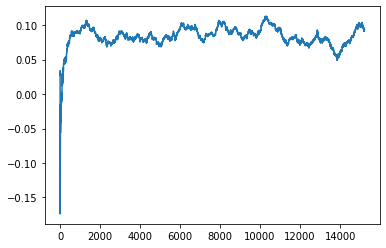

Thread: 6 iteration: 2540
RAM mBackground_7 FROM: 1600 --> 192 reward: 0.7794981590546874
Saving ...


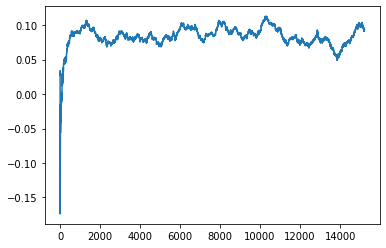

Thread: 4 iteration: 2530
RAM mDiffFit_106 FROM: 2816 --> 192 reward: 0.18274469140625
Thread: 2 iteration: 2505
RAM mDiffFit_383 FROM: 2752 --> 192 reward: 0.29811714648437504
Thread: 6 iteration: 2541
RAM mDiffFit_174 FROM: 2176 --> 192 reward: 0.35901561953125
Thread: 4 iteration: 2531
RAM mBackground_11 FROM: 1920 --> 192 reward: 0.68025992475
Saving ...


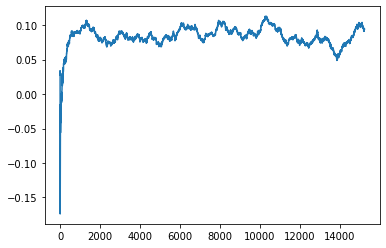

Thread: 1 iteration: 2470
RAM mConcatFit_3 FROM: 1920 --> 192 reward: 0.94157500875
Thread: 5 iteration: 2616
RAM mDiffFit_129 FROM: 704 --> 192 reward: 0.240476570703125
Thread: 2 iteration: 2506
RAM mDiffFit_180 FROM: 1344 --> 192 reward: 0.23986714648437496
Thread: 6 iteration: 2542
RAM mDiffFit_398 FROM: 2688 --> 192 reward: 0.37331247812499996
Thread: 4 iteration: 2532
RAM mDiffFit_142 FROM: 2624 --> 192 reward: 0.29127597421875007
Thread: 1 iteration: 2471
RAM mDiffFit_397 FROM: 3008 --> 192 reward: 0.18689044453125
Thread: 6 iteration: 2543
RAM mDiffFit_282 FROM: 1920 --> 192 reward: 0.23199995625
Thread: 4 iteration: 2533
RAM mDiffFit_87 FROM: 1536 --> 192 reward: 0.14551553203125
Thread: 5 iteration: 2617
RAM mBackground_3 FROM: 448 --> 192 reward: 0.6219076868203126
Thread: 2 iteration: 2507
RAM mBackground_48 FROM: 2112 --> 192 reward: -1.0
Saving ...


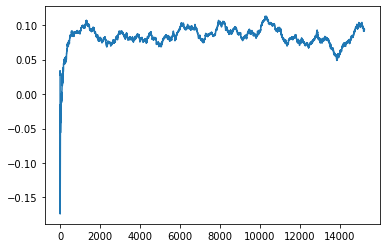

Thread: 3 iteration: 2560
RAM mDiffFit_278 FROM: 1152 --> 192 reward: 0.23042185859374997
Thread: 4 iteration: 2534
RAM mDiffFit_250 FROM: 576 --> 192 reward: 0.22623438046875
Thread: 3 iteration: 2561
RAM mDiffFit_155 FROM: 2688 --> 192 reward: 0.38930466835937505
Thread: 6 iteration: 2544
RAM mBackground_6 FROM: 384 --> 192 reward: 0.39930873118749993
Thread: 1 iteration: 2472
RAM mBackground_12 FROM: 2304 --> 192 reward: 0.7793816411484373
Thread: 6 iteration: 2545
RAM mDiffFit_16 FROM: 512 --> 192 reward: 0.25390365039062496
Thread: 6 iteration: 2546
RAM mProject_39 FROM: 576 --> 192 reward: -1.0
Thread: 5 iteration: 2618
RAM mProject_43 FROM: 128 --> 192 reward: -1.0
Thread: 2 iteration: 2508
RAM mDiffFit_321 FROM: 256 --> 192 reward: 0.04389061953125002
Thread: 6 iteration: 2547
RAM mDiffFit_26 FROM: 2112 --> 192 reward: 0.386492190234375
Thread: 5 iteration: 2619
RAM mDiffFit_182 FROM: 832 --> 192 reward: 0.239940110546875
Thread: 6 iteration: 2548
RAM mProject_57 FROM: 2176 -->

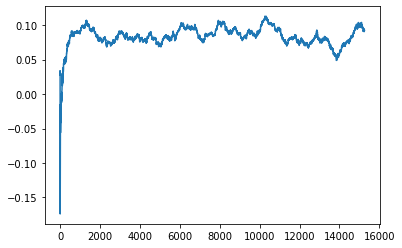

Thread: 5 iteration: 2620
RAM mDiffFit_368 FROM: 2112 --> 192 reward: 0.18392962460937498
Thread: 3 iteration: 2563
RAM mBgModel_2 FROM: 1280 --> 192 reward: 0.008616444999999973
Saving ...


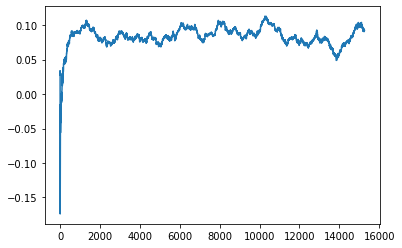

Thread: 2 iteration: 2510
RAM mDiffFit_212 FROM: 1408 --> 192 reward: 0.16292962460937502
Saving ...


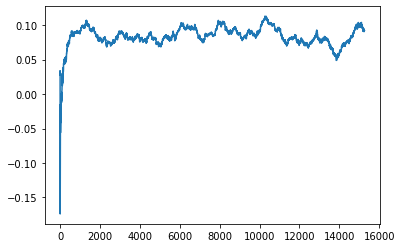

Thread: 6 iteration: 2550
RAM mDiffFit_413 FROM: 1856 --> 192 reward: 0.21333068632812494
Thread: 3 iteration: 2564
RAM mDiffFit_244 FROM: 2432 --> 192 reward: 0.34259630585937506
Thread: 5 iteration: 2621
RAM mDiffFit_331 FROM: 2816 --> 192 reward: 0.20554681484375004
Thread: 2 iteration: 2511
RAM mDiffFit_84 FROM: 1344 --> 192 reward: 0.15887495625
Thread: 6 iteration: 2551
RAM mProject_34 FROM: 128 --> 192 reward: -1.0
Thread: 4 iteration: 2536
RAM mDiffFit_38 FROM: 1472 --> 192 reward: 0.4926535628906249
Thread: 2 iteration: 2512
RAM mProject_11 FROM: 2752 --> 192 reward: -1.0
Thread: 1 iteration: 2474
RAM mViewer_1 FROM: 192 --> 192 reward: 0.00016500000000016501
Thread: 5 iteration: 2622
RAM mBackground_5 FROM: 2496 --> 192 reward: 0.6694292527187502
Thread: 6 iteration: 2552
RAM mDiffFit_170 FROM: 768 --> 192 reward: 0.161539048828125
Thread: 2 iteration: 2513
RAM mDiffFit_192 FROM: 1792 --> 192 reward: 0.233664048828125
Thread: 5 iteration: 2623
RAM mDiffFit_406 FROM: 576 --> 1

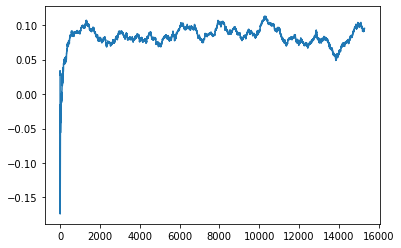

Thread: 3 iteration: 2570
RAM mDiffFit_174 FROM: 3008 --> 192 reward: 0.29826557578125
Thread: 4 iteration: 2538
RAM mProject_47 FROM: 2560 --> 192 reward: -1.0
Thread: 5 iteration: 2627
RAM mBackground_55 FROM: 1728 --> 192 reward: -1.0
Thread: 2 iteration: 2514
RAM mDiffFit_85 FROM: 2240 --> 192 reward: 0.275354115625
Thread: 3 iteration: 2571
RAM mDiffFit_336 FROM: 1856 --> 192 reward: 0.19207028789062497
Thread: 4 iteration: 2539
RAM mDiffFit_359 FROM: 1600 --> 192 reward: 0.2367395578125
Thread: 2 iteration: 2515
RAM mDiffFit_244 FROM: 1728 --> 192 reward: 0.29506247812499997
Thread: 3 iteration: 2572
RAM mProject_26 FROM: 896 --> 192 reward: -1.0
Thread: 1 iteration: 2478
RAM mDiffFit_419 FROM: 2816 --> 192 reward: 0.16669524414062503
Thread: 2 iteration: 2516
RAM mDiffFit_141 FROM: 1472 --> 192 reward: 0.27824995625000004
Saving ...


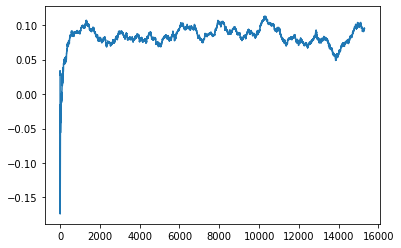

Thread: 4 iteration: 2540
RAM mProject_18 FROM: 1792 --> 192 reward: -1.0
Thread: 6 iteration: 2557
RAM mBackground_29 FROM: 1600 --> 192 reward: 0.703054414890625
Thread: 3 iteration: 2573
RAM mDiffFit_93 FROM: 960 --> 192 reward: 0.220289048828125
Thread: 4 iteration: 2541
RAM mDiffFit_40 FROM: 1920 --> 192 reward: 0.25292181484375
Thread: 2 iteration: 2517
RAM mProject_36 FROM: 1600 --> 192 reward: -1.0
Thread: 5 iteration: 2628
RAM mDiffFit_401 FROM: 1664 --> 192 reward: 0.27352601796875003
Thread: 4 iteration: 2542
RAM mDiffFit_276 FROM: 832 --> 192 reward: 0.19834893828125
Thread: 4 iteration: 2543
RAM mDiffFit_85 FROM: 960 --> 192 reward: 0.227914048828125
Thread: 4 iteration: 2544
RAM mBackground_26 FROM: 2816 --> 192 reward: 0.7086017773671875
Thread: 5 iteration: 2629
RAM mProject_72 FROM: 1536 --> 192 reward: -1.0
Thread: 3 iteration: 2574
RAM mProject_47 FROM: 768 --> 192 reward: -1.0
Thread: 2 iteration: 2518
RAM mDiffFit_293 FROM: 1216 --> 192 reward: 0.336997411328125
Th

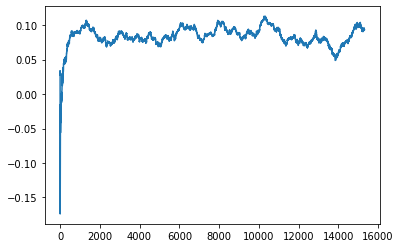

Thread: 5 iteration: 2630
RAM mDiffFit_412 FROM: 896 --> 192 reward: 0.18569269921874998
Saving ...


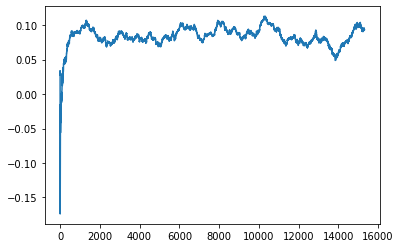

Thread: 1 iteration: 2480
RAM mDiffFit_206 FROM: 1152 --> 192 reward: 0.21871871718749997
Thread: 6 iteration: 2559
RAM mDiffFit_61 FROM: 2624 --> 192 reward: 0.32757809765625
Thread: 3 iteration: 2578
RAM mBackground_28 FROM: 384 --> 192 reward: 0.3302869771640625
Thread: 1 iteration: 2481
RAM mViewer_1 FROM: 1408 --> 192 reward: 0.6361901063203127
Thread: 5 iteration: 2631
RAM mProject_78 FROM: 2496 --> 192 reward: -1.0
Saving ...


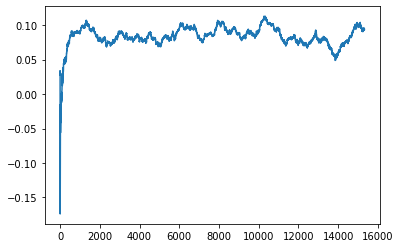

Thread: 2 iteration: 2520
RAM mBackground_6 FROM: 1856 --> 192 reward: 0.7416580838046875
Saving ...


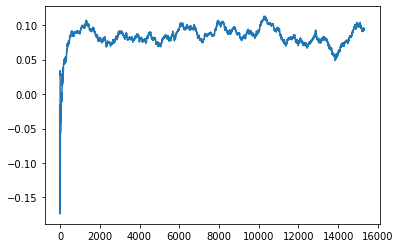

Thread: 6 iteration: 2560
RAM mDiffFit_326 FROM: 2368 --> 192 reward: 0.2349686296875
Thread: 1 iteration: 2482
RAM mDiffFit_236 FROM: 1408 --> 192 reward: 0.28305988945312494
Thread: 5 iteration: 2632
RAM mDiffFit_417 FROM: 384 --> 192 reward: 0.18397657070312495
Thread: 2 iteration: 2521
RAM mDiffFit_42 FROM: 2688 --> 192 reward: 0.28224214648437496
Thread: 6 iteration: 2561
RAM mDiffFit_28 FROM: 1920 --> 192 reward: 0.20045309765624997
Thread: 6 iteration: 2562
RAM mDiffFit_313 FROM: 3008 --> 192 reward: 0.5691717710937501
Thread: 5 iteration: 2633
RAM mProject_12 FROM: 1344 --> 192 reward: -1.0
Thread: 3 iteration: 2579
RAM mDiffFit_209 FROM: 1408 --> 192 reward: 0.20026561953124997
Thread: 6 iteration: 2563
RAM mBackground_22 FROM: 128 --> 192 reward: 1.0997453749453125
Thread: 2 iteration: 2522
RAM mDiffFit_9 FROM: 2560 --> 192 reward: 0.24649995625
Thread: 5 iteration: 2634
RAM mBackground_31 FROM: 192 --> 192 reward: -1.0
Thread: 4 iteration: 2547
RAM mDiffFit_265 FROM: 256 -->

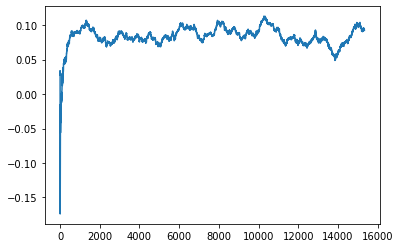

Thread: 3 iteration: 2580
RAM mDiffFit_174 FROM: 192 --> 192 reward: -0.017992190234374997
Thread: 2 iteration: 2523
RAM mDiffFit_33 FROM: 2688 --> 192 reward: 0.26399995625
Thread: 5 iteration: 2635
RAM mImgtbl_3 FROM: 1792 --> 192 reward: -1.0
Thread: 1 iteration: 2483
RAM mDiffFit_178 FROM: 1856 --> 192 reward: 0.13764575312500002
Thread: 3 iteration: 2581
RAM mDiffFit_405 FROM: 384 --> 192 reward: -0.056796946093749974
Thread: 4 iteration: 2548
RAM mDiffFit_324 FROM: 1408 --> 192 reward: 0.18523955781249996
Thread: 2 iteration: 2524
RAM mDiffFit_129 FROM: 384 --> 192 reward: 0.155773429296875
Thread: 5 iteration: 2636
RAM mBackground_7 FROM: 192 --> 192 reward: 0.0804704852109375
Thread: 6 iteration: 2564
RAM mDiffFit_353 FROM: 192 --> 192 reward: 0.14542190234375002
Thread: 1 iteration: 2484
RAM mDiffFit_223 FROM: 2176 --> 192 reward: 0.19446345234374998
Thread: 4 iteration: 2549
RAM mDiffFit_227 FROM: 1472 --> 192 reward: 0.171299447265625
Thread: 1 iteration: 2485
RAM mDiffFit_3

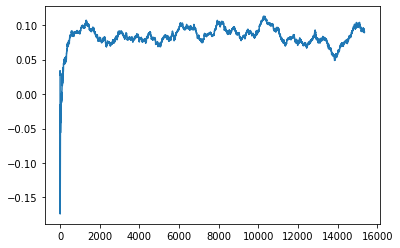

Thread: 4 iteration: 2550
RAM mDiffFit_26 FROM: 2496 --> 192 reward: 0.22724995625
Thread: 2 iteration: 2527
RAM mDiffFit_364 FROM: 1728 --> 192 reward: 0.27539061953124994
Thread: 6 iteration: 2567
RAM mDiffFit_217 FROM: 2240 --> 192 reward: 0.23196871718749998
Thread: 4 iteration: 2551
RAM mDiffFit_189 FROM: 1152 --> 192 reward: 0.216304668359375
Thread: 6 iteration: 2568
RAM mBackground_41 FROM: 832 --> 192 reward: -1.0
Thread: 3 iteration: 2582
RAM mBgModel_3 FROM: 832 --> 192 reward: -0.20891691750000005
Thread: 2 iteration: 2528
RAM mDiffFit_120 FROM: 576 --> 192 reward: 0.220351570703125
Thread: 3 iteration: 2583
RAM mDiffFit_133 FROM: 128 --> 192 reward: -0.663575596484375
Thread: 4 iteration: 2552
RAM mBackground_19 FROM: 1600 --> 192 reward: 0.688255260765625
Thread: 2 iteration: 2529
RAM mDiffFit_128 FROM: 448 --> 192 reward: 0.20872134960937497
Thread: 4 iteration: 2553
RAM mDiffFit_165 FROM: 512 --> 192 reward: 0.426354159375
Thread: 3 iteration: 2584
RAM mBackground_70 FR

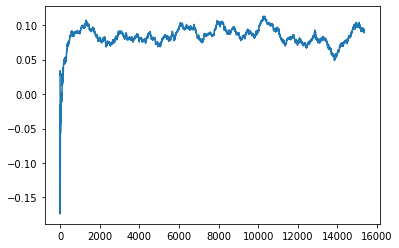

Thread: 5 iteration: 2640
RAM mDiffFit_56 FROM: 1856 --> 192 reward: 0.5392056863281252
Thread: 4 iteration: 2554
RAM mBackground_28 FROM: 1664 --> 192 reward: 0.7454564296796873
Saving ...


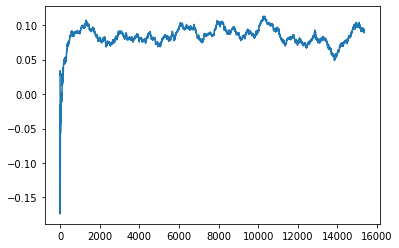

Thread: 2 iteration: 2530
RAM mDiffFit_212 FROM: 2688 --> 192 reward: 0.130820244140625
Thread: 4 iteration: 2555
RAM mDiffFit_227 FROM: 2368 --> 192 reward: 0.18938276601562498
Thread: 5 iteration: 2641
RAM mProject_68 FROM: 896 --> 192 reward: -1.0
Thread: 6 iteration: 2569
RAM mDiffFit_193 FROM: 2560 --> 192 reward: 0.2962187171875
Thread: 2 iteration: 2531
RAM mDiffFit_5 FROM: 2752 --> 192 reward: 0.20805199218749998
Thread: 4 iteration: 2556
RAM mDiffFit_364 FROM: 1984 --> 192 reward: 0.200674403515625
Thread: 2 iteration: 2532
RAM mDiffFit_21 FROM: 1408 --> 192 reward: 0.18278900507812498
Thread: 2 iteration: 2533
RAM mDiffFit_13 FROM: 896 --> 192 reward: 0.32511460156250005
Thread: 4 iteration: 2557
RAM mDiffFit_180 FROM: 2368 --> 192 reward: 0.2584687171875
Thread: 2 iteration: 2534
RAM mDiffFit_80 FROM: 1600 --> 192 reward: 0.29233331875
Thread: 2 iteration: 2535
RAM mProject_75 FROM: 2624 --> 192 reward: -1.0
Thread: 3 iteration: 2585
RAM mDiffFit_112 FROM: 1344 --> 192 rewar

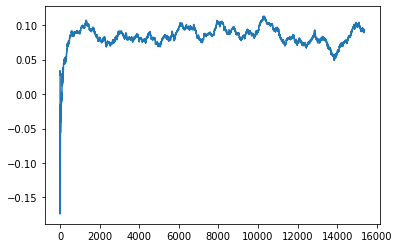

Thread: 6 iteration: 2570
RAM mDiffFit_187 FROM: 1088 --> 192 reward: 0.155252588671875
Thread: 5 iteration: 2643
RAM mDiffFit_133 FROM: 1216 --> 192 reward: 0.170424447265625
Thread: 6 iteration: 2571
RAM mDiffFit_378 FROM: 2560 --> 192 reward: 0.40465623906250003
Thread: 3 iteration: 2586
RAM mDiffFit_3 FROM: 1536 --> 192 reward: 0.156679580859375
Thread: 2 iteration: 2537
RAM mProject_13 FROM: 2176 --> 192 reward: -1.0
Thread: 4 iteration: 2558
RAM mBackground_41 FROM: 384 --> 192 reward: -1.0
Thread: 1 iteration: 2489
RAM mDiffFit_172 FROM: 2048 --> 192 reward: 0.24856247812499999
Thread: 3 iteration: 2587
RAM mDiffFit_33 FROM: 960 --> 192 reward: 0.35269533164062505
Thread: 5 iteration: 2644
RAM mDiffFit_205 FROM: 2944 --> 192 reward: 0.19671604101562495
Thread: 3 iteration: 2588
RAM mDiffFit_349 FROM: 1664 --> 192 reward: 0.257283827734375
Thread: 5 iteration: 2645
RAM mDiffFit_101 FROM: 2624 --> 192 reward: 0.23080721328124998
Thread: 3 iteration: 2589
RAM mDiffFit_227 FROM: 243

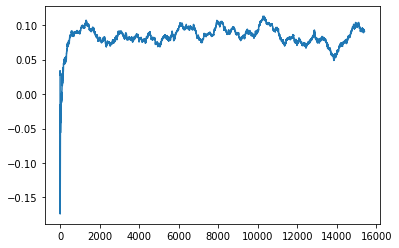

Thread: 3 iteration: 2590
RAM mProject_28 FROM: 704 --> 192 reward: -1.0
Thread: 6 iteration: 2572
RAM mDiffFit_316 FROM: 320 --> 192 reward: 0.04692185859375003
Thread: 5 iteration: 2648
RAM mProject_75 FROM: 1088 --> 192 reward: -1.0
Thread: 2 iteration: 2538
RAM mDiffFit_34 FROM: 2112 --> 192 reward: 0.4632890050781251
Thread: 3 iteration: 2591
RAM mDiffFit_388 FROM: 2880 --> 192 reward: 0.27801557578124997
Thread: 6 iteration: 2573
RAM mDiffFit_44 FROM: 2944 --> 192 reward: 0.22792181484375001
Thread: 5 iteration: 2649
RAM mDiffFit_52 FROM: 1792 --> 192 reward: 0.22590360664062498
Thread: 2 iteration: 2539
RAM mDiffFit_7 FROM: 1856 --> 192 reward: 0.213580686328125
Thread: 3 iteration: 2592
RAM mDiffFit_247 FROM: 1024 --> 192 reward: 0.241096349609375
Thread: 6 iteration: 2574
RAM mDiffFit_258 FROM: 1216 --> 192 reward: 0.11114834179687502
Saving ...


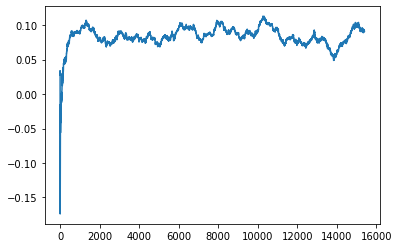

Thread: 5 iteration: 2650
RAM mBackground_57 FROM: 832 --> 192 reward: -1.0
Thread: 4 iteration: 2559
RAM mBackground_35 FROM: 2816 --> 192 reward: -1.0
Saving ...


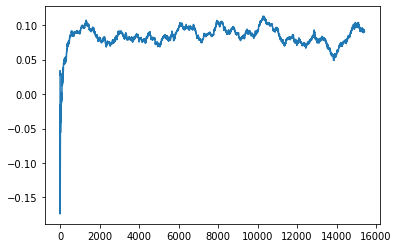

Thread: 1 iteration: 2490
RAM mDiffFit_12 FROM: 704 --> 192 reward: 0.05764575312499999
Saving ...


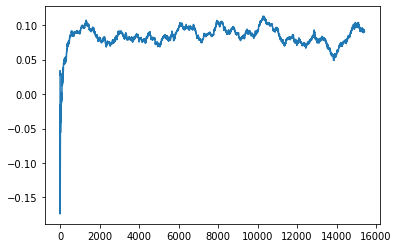

Thread: 2 iteration: 2540
RAM mDiffFit_275 FROM: 1216 --> 192 reward: 0.2549687609375
Thread: 2 iteration: 2541
RAM mDiffFit_279 FROM: 2368 --> 192 reward: 0.42635666054687493
Thread: 1 iteration: 2491
RAM mProject_52 FROM: 1792 --> 192 reward: -1.0
Thread: 3 iteration: 2593
RAM mDiffFit_332 FROM: 2240 --> 192 reward: 0.251460907421875
Thread: 3 iteration: 2594
RAM mProject_43 FROM: 1024 --> 192 reward: -1.0
Thread: 5 iteration: 2651
RAM mDiffFit_388 FROM: 1344 --> 192 reward: 0.19035152695312502
Thread: 3 iteration: 2595
RAM mProject_46 FROM: 2944 --> 192 reward: -1.0
Saving ...


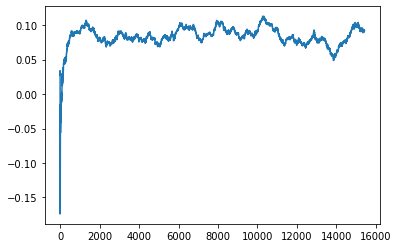

Thread: 4 iteration: 2560
RAM mDiffFit_74 FROM: 960 --> 192 reward: 0.25049999999999994
Thread: 3 iteration: 2596
RAM mViewer_3 FROM: 320 --> 192 reward: 0.35355547296093753
Thread: 4 iteration: 2561
RAM mBackground_36 FROM: 128 --> 192 reward: -1.0
Thread: 6 iteration: 2575
RAM mDiffFit_13 FROM: 2816 --> 192 reward: 0.275132766015625
Thread: 4 iteration: 2562
RAM mDiffFit_349 FROM: 1920 --> 192 reward: 0.31975780976562507
Thread: 6 iteration: 2576
RAM mProject_34 FROM: 3008 --> 192 reward: -1.0
Thread: 3 iteration: 2597
RAM mDiffFit_133 FROM: 1216 --> 192 reward: 0.31996353984375003
Thread: 6 iteration: 2577
RAM mBackground_87 FROM: 1664 --> 192 reward: -1.0
Thread: 2 iteration: 2542
RAM mBackground_88 FROM: 640 --> 192 reward: -1.0
Thread: 1 iteration: 2492
RAM mDiffFit_223 FROM: 2880 --> 192 reward: 0.23416400507812496
Thread: 3 iteration: 2598
RAM mDiffFit_22 FROM: 2176 --> 192 reward: 0.257820287890625
Thread: 2 iteration: 2543
RAM mDiffFit_389 FROM: 2688 --> 192 reward: 0.5506717

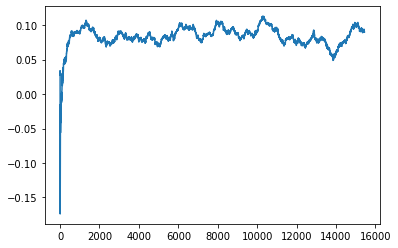

Thread: 3 iteration: 2600
RAM mDiffFit_159 FROM: 1216 --> 192 reward: 0.07047126210937502
Thread: 1 iteration: 2499
RAM mProject_8 FROM: 2240 --> 192 reward: -1.0
Thread: 5 iteration: 2654
RAM mBackground_71 FROM: 1856 --> 192 reward: -1.0
Thread: 6 iteration: 2578
RAM mDiffFit_255 FROM: 1152 --> 192 reward: 0.24253904882812505
Thread: 4 iteration: 2564
RAM mDiffFit_67 FROM: 2816 --> 192 reward: 0.189929624609375
Thread: 2 iteration: 2546
RAM mDiffFit_225 FROM: 1920 --> 192 reward: 0.29471090742187506
Thread: 3 iteration: 2601
RAM mDiffFit_134 FROM: 512 --> 192 reward: 0.03030984570312499
Saving ...


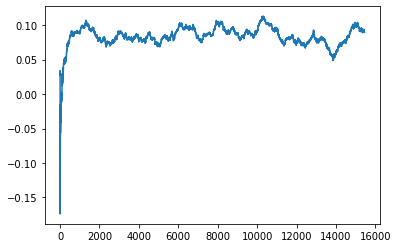

Thread: 1 iteration: 2500
RAM mDiffFit_297 FROM: 832 --> 192 reward: 0.13407805390625005
Thread: 6 iteration: 2579
RAM mDiffFit_394 FROM: 192 --> 192 reward: -0.08720314140624998
Thread: 2 iteration: 2547
RAM mDiffFit_290 FROM: 1088 --> 192 reward: 0.078986881640625
Thread: 4 iteration: 2565
RAM mViewer_2 FROM: 1472 --> 192 reward: 0.8846182818515625
Thread: 5 iteration: 2655
RAM mDiffFit_267 FROM: 960 --> 192 reward: 0.241757809765625
Thread: 2 iteration: 2548
RAM mDiffFit_92 FROM: 2176 --> 192 reward: 0.270184845703125
Thread: 4 iteration: 2566
RAM mDiffFit_89 FROM: 1984 --> 192 reward: 0.35733849609375
Thread: 2 iteration: 2549
RAM mDiffFit_230 FROM: 1856 --> 192 reward: 0.145145753125
Saving ...


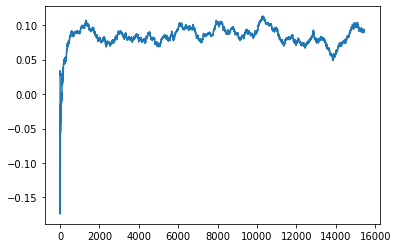

Thread: 2 iteration: 2550
RAM mDiffFit_377 FROM: 384 --> 192 reward: 0.04231243437500004
Thread: 4 iteration: 2567
RAM mProject_1 FROM: 1856 --> 192 reward: -1.0
Thread: 3 iteration: 2602
RAM mDiffFit_162 FROM: 2176 --> 192 reward: 0.28517703593750005
Thread: 2 iteration: 2551
RAM mDiffFit_90 FROM: 1536 --> 192 reward: 0.28071090742187504
Thread: 4 iteration: 2568
RAM mProject_13 FROM: 2688 --> 192 reward: -1.0
Saving ...


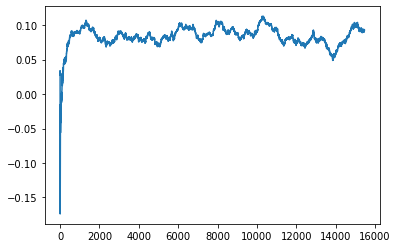

Thread: 6 iteration: 2580
RAM mProject_33 FROM: 1792 --> 192 reward: -1.0
Thread: 5 iteration: 2656
RAM mDiffFit_179 FROM: 1472 --> 192 reward: 0.4974139613281249
Thread: 3 iteration: 2603
RAM mDiffFit_59 FROM: 384 --> 192 reward: 0.29280466835937496
Thread: 2 iteration: 2552
RAM mDiffFit_211 FROM: 2496 --> 192 reward: 0.07200759101562496
Thread: 3 iteration: 2604
RAM mDiffFit_189 FROM: 640 --> 192 reward: 0.169934889453125
Thread: 2 iteration: 2553
RAM mDiffFit_211 FROM: 896 --> 192 reward: 0.17291663749999997
Thread: 2 iteration: 2554
RAM mBackground_8 FROM: 2240 --> 192 reward: -1.0
Thread: 1 iteration: 2501
RAM mDiffFit_66 FROM: 128 --> 192 reward: -0.518830773828125
Thread: 2 iteration: 2555
RAM mDiffFit_67 FROM: 1792 --> 192 reward: 0.19254422617187503
Thread: 1 iteration: 2502
RAM mDiffFit_32 FROM: 2432 --> 192 reward: 0.35871349609375
Thread: 2 iteration: 2556
RAM mProject_73 FROM: 192 --> 192 reward: -1.0
Thread: 4 iteration: 2569
RAM mProject_73 FROM: 2560 --> 192 reward: -1.

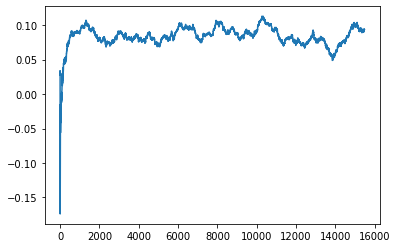

Thread: 4 iteration: 2570
RAM mDiffFit_16 FROM: 320 --> 192 reward: 0.14716146015625003
Thread: 2 iteration: 2558
RAM mDiffFit_138 FROM: 512 --> 192 reward: -0.007906326562500017
Thread: 2 iteration: 2559
RAM mDiffFit_266 FROM: 384 --> 192 reward: 0.14441400507812502
Thread: 1 iteration: 2505
RAM mDiffFit_196 FROM: 1152 --> 192 reward: 0.22876561953125002
Saving ...


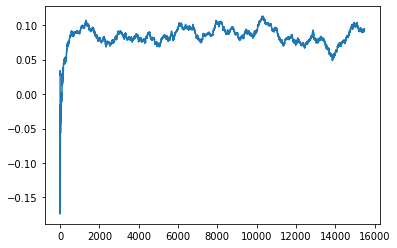

Thread: 2 iteration: 2560
RAM mBackground_6 FROM: 2752 --> 192 reward: -1.0
Thread: 6 iteration: 2581
RAM mViewer_1 FROM: 896 --> 192 reward: 0.6061343629687501
Thread: 4 iteration: 2571
RAM mBackground_27 FROM: 2304 --> 192 reward: -1.0
Thread: 3 iteration: 2605
RAM mDiffFit_267 FROM: 896 --> 192 reward: 0.31374741132812495
Thread: 4 iteration: 2572
RAM mDiffFit_375 FROM: 2944 --> 192 reward: 0.4484764394531249
Thread: 6 iteration: 2582
RAM mDiffFit_95 FROM: 1408 --> 192 reward: 0.142229115625
Thread: 4 iteration: 2573
RAM mProject_34 FROM: 1792 --> 192 reward: -1.0
Thread: 5 iteration: 2659
RAM mDiffFit_12 FROM: 1856 --> 192 reward: 0.207187478125
Saving ...


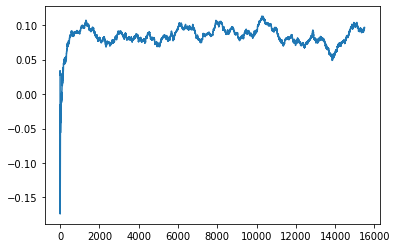

Thread: 5 iteration: 2660
RAM mDiffFit_202 FROM: 1088 --> 192 reward: 0.2710520796875
Thread: 5 iteration: 2661
RAM mDiffFit_255 FROM: 448 --> 192 reward: 0.21132292031249997
Thread: 5 iteration: 2662
RAM mProject_34 FROM: 1536 --> 192 reward: -1.0
Thread: 3 iteration: 2606
RAM mDiffFit_199 FROM: 1344 --> 192 reward: 0.19218743437499997
Thread: 3 iteration: 2607
RAM mDiffFit_338 FROM: 2112 --> 192 reward: 0.19122652695312498
Thread: 3 iteration: 2608
RAM mDiffFit_174 FROM: 1728 --> 192 reward: 0.253648429296875
Thread: 3 iteration: 2609
RAM mBackground_79 FROM: 3008 --> 192 reward: -1.0
Thread: 1 iteration: 2506
RAM mDiffFit_257 FROM: 1472 --> 192 reward: 0.21314061953124996
Saving ...


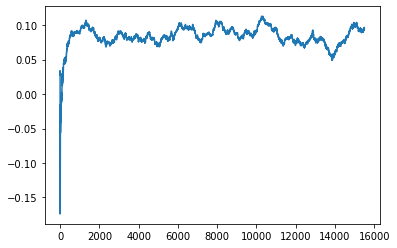

Thread: 3 iteration: 2610
RAM mDiffFit_216 FROM: 1856 --> 192 reward: 0.15299473515625
Thread: 1 iteration: 2507
RAM mBackground_73 FROM: 1472 --> 192 reward: -1.0
Thread: 2 iteration: 2561
RAM mProject_58 FROM: 576 --> 192 reward: -1.0
Thread: 5 iteration: 2663
RAM mDiffFit_118 FROM: 2880 --> 192 reward: 0.25609362968749994
Thread: 3 iteration: 2611
RAM mDiffFit_136 FROM: 640 --> 192 reward: 0.217398429296875
Thread: 1 iteration: 2508
RAM mDiffFit_233 FROM: 2112 --> 192 reward: 0.51270305390625
Thread: 2 iteration: 2562
RAM mBackground_12 FROM: 2176 --> 192 reward: -1.0
Thread: 6 iteration: 2583
RAM mBackground_53 FROM: 640 --> 192 reward: -1.0
Thread: 4 iteration: 2574
RAM mDiffFit_199 FROM: 704 --> 192 reward: 0.26144792031249997
Thread: 3 iteration: 2612
RAM mDiffFit_180 FROM: 2112 --> 192 reward: 0.16195301015625
Thread: 2 iteration: 2563
RAM mDiffFit_414 FROM: 1664 --> 192 reward: 0.22790623906250002
Thread: 4 iteration: 2575
RAM mDiffFit_105 FROM: 1408 --> 192 reward: 0.06927593

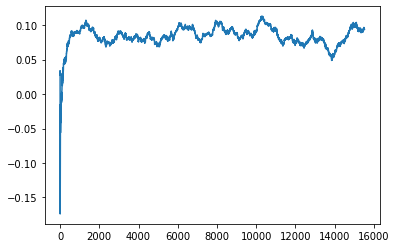

Thread: 1 iteration: 2510
RAM mDiffFit_201 FROM: 2368 --> 192 reward: 0.30056765546875003
Thread: 3 iteration: 2615
RAM mBackground_54 FROM: 2624 --> 192 reward: -1.0
Thread: 5 iteration: 2664
RAM mProject_35 FROM: 1600 --> 192 reward: -1.0
Thread: 4 iteration: 2576
RAM mDiffFit_101 FROM: 1280 --> 192 reward: 0.20924736757812495
Thread: 1 iteration: 2511
RAM mDiffFit_166 FROM: 1344 --> 192 reward: 0.19580466835937502
Thread: 3 iteration: 2616
RAM mDiffFit_311 FROM: 832 --> 192 reward: 0.10945568632812498
Thread: 4 iteration: 2577
RAM mDiffFit_101 FROM: 1856 --> 192 reward: 0.22430466835937501
Thread: 5 iteration: 2665
RAM mProject_81 FROM: 2368 --> 192 reward: -1.0
Thread: 2 iteration: 2566
RAM mDiffFit_355 FROM: 1664 --> 192 reward: 0.6762057300781249
Thread: 1 iteration: 2512
RAM mDiffFit_208 FROM: 1472 --> 192 reward: 0.135325465234375
Thread: 4 iteration: 2578
RAM mConcatFit_2 FROM: 1280 --> 192 reward: 0.7775458406250002
Thread: 3 iteration: 2617
RAM mDiffFit_282 FROM: 1280 --> 19

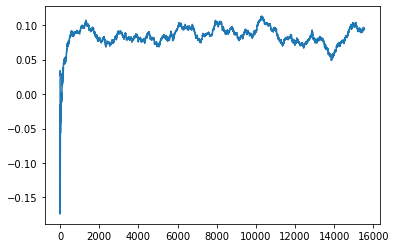

Thread: 4 iteration: 2580
RAM mBackground_26 FROM: 1408 --> 192 reward: -1.0
Thread: 3 iteration: 2619
RAM mDiffFit_334 FROM: 2880 --> 192 reward: 0.301476483203125
Saving ...


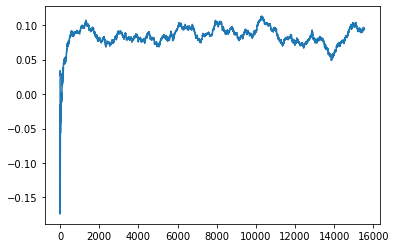

Thread: 2 iteration: 2570
RAM mDiffFit_353 FROM: 2240 --> 192 reward: 0.22359371718749999
Saving ...


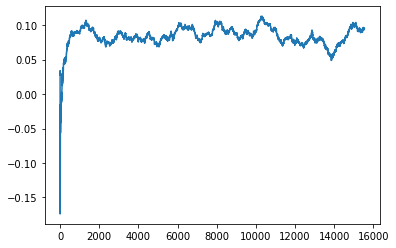

Thread: 3 iteration: 2620
RAM mDiffFit_311 FROM: 1920 --> 192 reward: 0.24999214648437504
Thread: 4 iteration: 2581
RAM mDiffFit_1 FROM: 1472 --> 192 reward: 0.28411455781249995
Thread: 2 iteration: 2571
RAM mProject_34 FROM: 1920 --> 192 reward: -1.0
Thread: 5 iteration: 2667
RAM mDiffFit_28 FROM: 2624 --> 192 reward: 0.22701557578124998
Thread: 4 iteration: 2582
RAM mDiffFit_158 FROM: 2048 --> 192 reward: 0.29569006679687504
Thread: 3 iteration: 2621
RAM mDiffFit_7 FROM: 2944 --> 192 reward: 0.22681761171875003
Thread: 5 iteration: 2668
RAM mDiffFit_59 FROM: 768 --> 192 reward: 0.43246871718749996
Thread: 2 iteration: 2572
RAM mBackground_14 FROM: 1152 --> 192 reward: -1.0
Thread: 6 iteration: 2589
RAM mDiffFit_319 FROM: 2304 --> 192 reward: 0.18670305390625003
Thread: 4 iteration: 2583
RAM mDiffFit_25 FROM: 1216 --> 192 reward: 0.16925776601562498
Thread: 3 iteration: 2622
RAM mProject_49 FROM: 896 --> 192 reward: -1.0
Thread: 1 iteration: 2515
RAM mDiffFit_344 FROM: 192 --> 192 rew

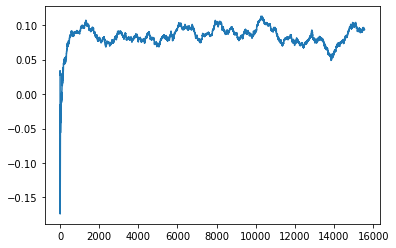

Thread: 6 iteration: 2590
RAM mDiffFit_249 FROM: 1152 --> 192 reward: 0.327367190234375
Thread: 2 iteration: 2573
RAM mConcatFit_1 FROM: 1344 --> 192 reward: 0.8731812565624999
Thread: 5 iteration: 2669
RAM mDiffFit_405 FROM: 2944 --> 192 reward: 0.270648385546875
Thread: 4 iteration: 2584
RAM mDiffFit_146 FROM: 2624 --> 192 reward: 0.23880721328124999
Thread: 3 iteration: 2623
RAM mDiffFit_226 FROM: 2624 --> 192 reward: 0.20652338554687497
Thread: 6 iteration: 2591
RAM mDiffFit_126 FROM: 2368 --> 192 reward: 0.5462941824218749
Thread: 1 iteration: 2516
RAM mViewer_3 FROM: 1536 --> 192 reward: 0.6446807144765623
Thread: 2 iteration: 2574
RAM mDiffFit_364 FROM: 768 --> 192 reward: 0.20049219023437503
Thread: 3 iteration: 2624
RAM mDiffFit_195 FROM: 1728 --> 192 reward: -0.7325322015625
Thread: 6 iteration: 2592
RAM mDiffFit_265 FROM: 1536 --> 192 reward: 0.28158590742187506
Thread: 1 iteration: 2517
RAM mDiffFit_400 FROM: 2816 --> 192 reward: 0.11315874023437499
Thread: 2 iteration: 257

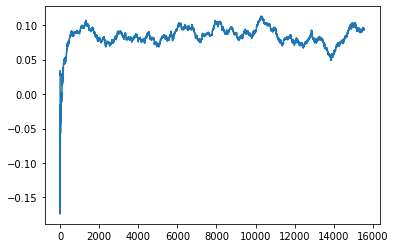

Thread: 5 iteration: 2670
RAM mDiffFit_120 FROM: 128 --> 192 reward: -0.17477865039062507
Thread: 3 iteration: 2626
RAM mDiffFit_97 FROM: 2560 --> 192 reward: 0.15567699218749997
Thread: 6 iteration: 2593
RAM mDiffFit_331 FROM: 2112 --> 192 reward: 0.585257853515625
Thread: 1 iteration: 2519
RAM mProject_2 FROM: 3008 --> 192 reward: -1.0
Thread: 4 iteration: 2585
RAM mDiffFit_85 FROM: 1984 --> 192 reward: 0.252554668359375
Thread: 5 iteration: 2671
RAM mDiffFit_164 FROM: 2944 --> 192 reward: 0.2525311953125
Thread: 6 iteration: 2594
RAM mDiffFit_398 FROM: 448 --> 192 reward: 0.22131511054687497
Saving ...


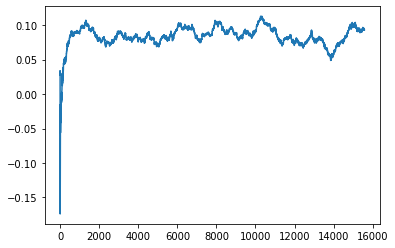

Thread: 1 iteration: 2520
RAM mDiffFit_211 FROM: 1536 --> 192 reward: 0.22294528789062495
Thread: 6 iteration: 2595
RAM mDiffFit_10 FROM: 1664 --> 192 reward: 0.5279166375
Thread: 6 iteration: 2596
RAM mProject_30 FROM: 320 --> 192 reward: -1.0
Thread: 5 iteration: 2672
RAM mBackground_50 FROM: 2048 --> 192 reward: -1.0
Thread: 2 iteration: 2576
RAM mDiffFit_160 FROM: 896 --> 192 reward: 0.23916146015625
Thread: 5 iteration: 2673
RAM mDiffFit_265 FROM: 1536 --> 192 reward: 0.24210933671875004
Thread: 2 iteration: 2577
RAM mDiffFit_23 FROM: 1728 --> 192 reward: 0.38164061953125
Thread: 2 iteration: 2578
RAM mBackground_65 FROM: 2880 --> 192 reward: -1.0
Thread: 3 iteration: 2627
RAM mDiffFit_108 FROM: 2944 --> 192 reward: 0.280648385546875
Thread: 2 iteration: 2579
RAM mBackground_33 FROM: 2240 --> 192 reward: -1.0
Thread: 1 iteration: 2521
RAM mDiffFit_237 FROM: 3008 --> 192 reward: 0.485539048828125
Saving ...


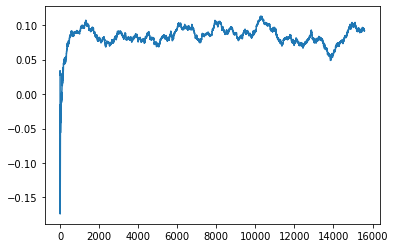

Thread: 2 iteration: 2580
RAM mProject_72 FROM: 512 --> 192 reward: -1.0
Thread: 4 iteration: 2586
RAM mProject_85 FROM: 2496 --> 192 reward: -1.0
Thread: 5 iteration: 2674
RAM mDiffFit_201 FROM: 1728 --> 192 reward: 0.43510157070312505
Thread: 1 iteration: 2522
RAM mDiffFit_170 FROM: 832 --> 192 reward: 0.271367190234375
Thread: 2 iteration: 2581
RAM mBackground_46 FROM: 2176 --> 192 reward: -1.0
Thread: 6 iteration: 2597
RAM mDiffFit_26 FROM: 1408 --> 192 reward: 0.16300517734374997
Thread: 5 iteration: 2675
RAM mDiffFit_111 FROM: 2368 --> 192 reward: 0.32892703593750006
Thread: 1 iteration: 2523
RAM mDiffFit_185 FROM: 1024 --> 192 reward: 0.24984634960937502
Thread: 6 iteration: 2598
RAM mDiffFit_390 FROM: 1216 --> 192 reward: 0.34070573007812494
Thread: 1 iteration: 2524
RAM mProject_81 FROM: 1728 --> 192 reward: -1.0
Thread: 4 iteration: 2587
RAM mDiffFit_413 FROM: 320 --> 192 reward: -0.019197964062500003
Thread: 1 iteration: 2525
RAM mDiffFit_145 FROM: 448 --> 192 reward: 0.1543

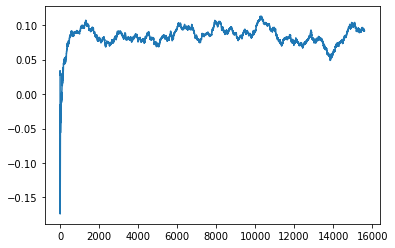

Thread: 6 iteration: 2600
RAM mBgModel_1 FROM: 2112 --> 192 reward: 0.038252826406249885
Thread: 1 iteration: 2528
RAM mAdd_3 FROM: 2624 --> 192 reward: -1.0
Thread: 4 iteration: 2588
RAM mDiffFit_415 FROM: 256 --> 192 reward: -0.16927610546875
Thread: 1 iteration: 2529
RAM mBgModel_1 FROM: 1792 --> 192 reward: 0.07450184343749999
Thread: 6 iteration: 2601
RAM mDiffFit_219 FROM: 2368 --> 192 reward: 0.295695287890625
Thread: 4 iteration: 2589
RAM mDiffFit_181 FROM: 320 --> 192 reward: 0.13441926992187503
Saving ...


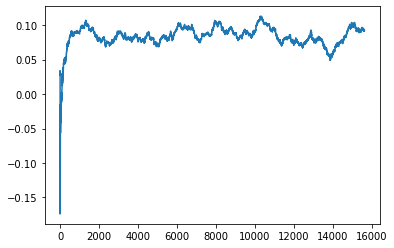

Thread: 1 iteration: 2530
RAM mDiffFit_116 FROM: 192 --> 192 reward: 0.07296095117187498
Thread: 6 iteration: 2602
RAM mBackground_38 FROM: 320 --> 192 reward: -1.0
Thread: 2 iteration: 2582
RAM mDiffFit_232 FROM: 1728 --> 192 reward: 0.22335152695312496
Thread: 6 iteration: 2603
RAM mDiffFit_305 FROM: 2112 --> 192 reward: 0.3370937171875
Thread: 1 iteration: 2531
RAM mProject_82 FROM: 2688 --> 192 reward: -1.0
Thread: 5 iteration: 2678
RAM mDiffFit_258 FROM: 192 --> 192 reward: -0.43675789726562503
Thread: 2 iteration: 2583
RAM mDiffFit_92 FROM: 2752 --> 192 reward: 0.23916137265624998
Thread: 5 iteration: 2679
RAM mDiffFit_347 FROM: 704 --> 192 reward: 0.3811823007812499
Thread: 1 iteration: 2532
RAM mDiffFit_299 FROM: 512 --> 192 reward: 0.02654159375000003
Thread: 6 iteration: 2604
RAM mDiffFit_241 FROM: 512 --> 192 reward: 0.16872915937500005
Thread: 1 iteration: 2533
RAM mProject_90 FROM: 448 --> 192 reward: -1.0
Saving ...


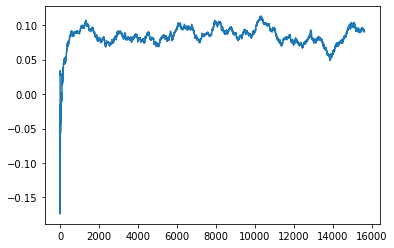

Thread: 4 iteration: 2590
RAM mDiffFit_342 FROM: 1280 --> 192 reward: 0.1461561515625
Saving ...


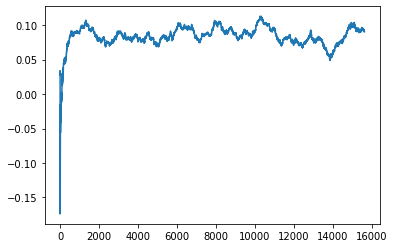

Thread: 5 iteration: 2680
RAM mBackground_80 FROM: 2880 --> 192 reward: -1.0
Thread: 3 iteration: 2629
RAM mDiffFit_4 FROM: 3008 --> 192 reward: 0.272846262109375
Thread: 1 iteration: 2534
RAM mDiffFit_131 FROM: 2688 --> 192 reward: 0.19000772226562496
Thread: 4 iteration: 2591
RAM mDiffFit_36 FROM: 704 --> 192 reward: 0.19470831875
Thread: 1 iteration: 2535
RAM mProject_54 FROM: 640 --> 192 reward: -1.0
Thread: 4 iteration: 2592
RAM mBackground_68 FROM: 2368 --> 192 reward: -1.0
Thread: 2 iteration: 2584
RAM mProject_11 FROM: 512 --> 192 reward: -1.0
Thread: 1 iteration: 2536
RAM mDiffFit_212 FROM: 3008 --> 192 reward: 0.20907024414062503
Thread: 2 iteration: 2585
RAM mDiffFit_148 FROM: 1600 --> 192 reward: 0.32568488945312496
Thread: 4 iteration: 2593
RAM mBackground_80 FROM: 2944 --> 192 reward: -1.0
Thread: 6 iteration: 2605
RAM mDiffFit_388 FROM: 1664 --> 192 reward: 0.30964838554687507
Thread: 2 iteration: 2586
RAM mDiffFit_258 FROM: 1024 --> 192 reward: 0.33624219023437507
Threa

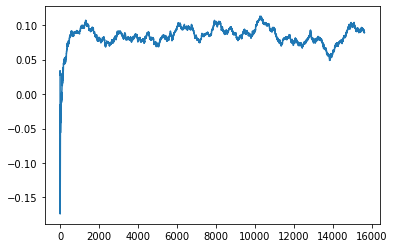

Thread: 3 iteration: 2630
RAM mBackground_71 FROM: 1216 --> 192 reward: -1.0
Thread: 5 iteration: 2681
RAM mDiffFit_322 FROM: 1280 --> 192 reward: 0.232361925390625
Thread: 2 iteration: 2587
RAM mProject_69 FROM: 1088 --> 192 reward: -1.0
Thread: 1 iteration: 2537
RAM mDiffFit_44 FROM: 1344 --> 192 reward: 0.32573438046875003
Thread: 2 iteration: 2588
RAM mDiffFit_406 FROM: 1344 --> 192 reward: 0.15657805390625
Thread: 2 iteration: 2589
RAM mDiffFit_134 FROM: 2240 --> 192 reward: 0.30230466835937503
Saving ...


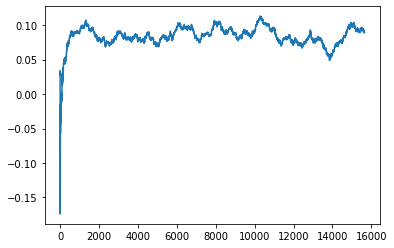

Thread: 2 iteration: 2590
RAM mDiffFit_228 FROM: 1920 --> 192 reward: 0.35673438046875
Thread: 2 iteration: 2591
RAM mDiffFit_305 FROM: 1664 --> 192 reward: 0.24427342929687498
Thread: 2 iteration: 2592
RAM mProject_40 FROM: 1664 --> 192 reward: -1.0
Thread: 3 iteration: 2631
RAM mDiffFit_285 FROM: 1856 --> 192 reward: 0.1256353546875
Thread: 2 iteration: 2593
RAM mDiffFit_203 FROM: 1664 --> 192 reward: 0.26966141640625
Thread: 3 iteration: 2632
RAM mDiffFit_115 FROM: 2496 --> 192 reward: 0.183523385546875
Thread: 2 iteration: 2594
RAM mDiffFit_175 FROM: 384 --> 192 reward: 0.12835148320312503
Thread: 3 iteration: 2633
RAM mDiffFit_70 FROM: 1024 --> 192 reward: 0.20311977890625002
Thread: 3 iteration: 2634
RAM mBackground_90 FROM: 1664 --> 192 reward: -1.0
Thread: 5 iteration: 2682
RAM mBackground_53 FROM: 2560 --> 192 reward: -1.0
Thread: 4 iteration: 2595
RAM mBackground_24 FROM: 1408 --> 192 reward: -1.0
Thread: 6 iteration: 2607
RAM mDiffFit_275 FROM: 2240 --> 192 reward: 0.2475859

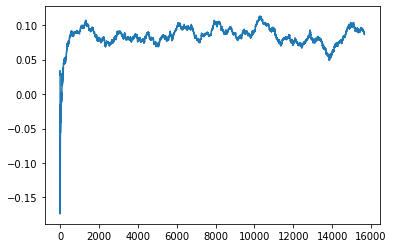

Thread: 1 iteration: 2540
RAM mDiffFit_135 FROM: 3008 --> 192 reward: 0.2735311953125
Thread: 5 iteration: 2685
RAM mProject_72 FROM: 512 --> 192 reward: -1.0
Thread: 4 iteration: 2596
RAM mDiffFit_89 FROM: 832 --> 192 reward: 0.290226570703125
Thread: 2 iteration: 2597
RAM mDiffFit_207 FROM: 2624 --> 192 reward: 0.2998437171875
Thread: 1 iteration: 2541
RAM mDiffFit_342 FROM: 1216 --> 192 reward: 0.484044313671875
Thread: 4 iteration: 2597
RAM mDiffFit_300 FROM: 256 --> 192 reward: 0.04417707968749997
Thread: 2 iteration: 2598
RAM mDiffFit_399 FROM: 1216 --> 192 reward: 0.308679668359375
Thread: 1 iteration: 2542
RAM mDiffFit_138 FROM: 1856 --> 192 reward: 0.20108849609375004
Thread: 2 iteration: 2599
RAM mDiffFit_385 FROM: 1152 --> 192 reward: 0.1952812390625
Thread: 1 iteration: 2543
RAM mBackground_41 FROM: 1472 --> 192 reward: -1.0
Thread: 6 iteration: 2608
RAM mDiffFit_187 FROM: 3008 --> 192 reward: 0.16196867343750004
Saving ...


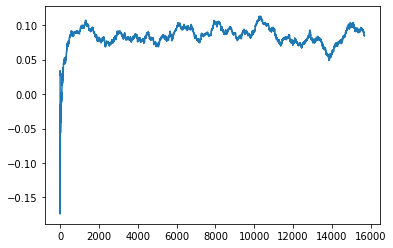

Thread: 2 iteration: 2600
RAM mProject_70 FROM: 384 --> 192 reward: -1.0
Thread: 5 iteration: 2686
RAM mDiffFit_360 FROM: 1280 --> 192 reward: 0.13066137265625002
Thread: 6 iteration: 2609
RAM mDiffFit_197 FROM: 448 --> 192 reward: 0.24839325195312498
Thread: 2 iteration: 2601
RAM mDiffFit_167 FROM: 1536 --> 192 reward: 0.157257722265625
Thread: 5 iteration: 2687
RAM mDiffFit_259 FROM: 1600 --> 192 reward: 0.21534630585937495
Saving ...


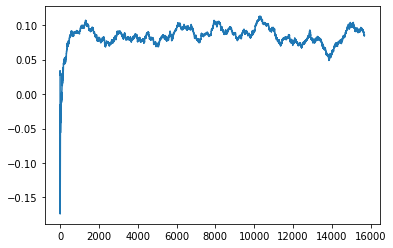

Thread: 6 iteration: 2610
RAM mProject_79 FROM: 1280 --> 192 reward: -1.0
Thread: 4 iteration: 2598
RAM mBackground_6 FROM: 2752 --> 192 reward: -1.0
Thread: 3 iteration: 2637
RAM mDiffFit_333 FROM: 2112 --> 192 reward: 0.264062478125
Thread: 5 iteration: 2688
RAM mDiffFit_131 FROM: 1024 --> 192 reward: 0.38264325195312504
Thread: 2 iteration: 2602
RAM mDiffFit_157 FROM: 256 --> 192 reward: -0.13618234453124994
Thread: 6 iteration: 2611
RAM mDiffFit_185 FROM: 2880 --> 192 reward: 0.290757766015625
Thread: 4 iteration: 2599
RAM mDiffFit_173 FROM: 1728 --> 192 reward: 0.21767185859374996
Thread: 3 iteration: 2638
RAM mDiffFit_194 FROM: 2752 --> 192 reward: 0.21815619531249997
Thread: 5 iteration: 2689
RAM mDiffFit_208 FROM: 192 --> 192 reward: -0.06396876093750001
Thread: 2 iteration: 2603
RAM mDiffFit_377 FROM: 2368 --> 192 reward: 0.33154685859375
Thread: 6 iteration: 2612
RAM mDiffFit_161 FROM: 896 --> 192 reward: 0.13247393828125
Thread: 3 iteration: 2639
RAM mDiffFit_409 FROM: 2304 

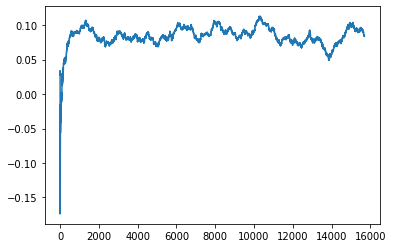

Thread: 4 iteration: 2600
RAM mDiffFit_218 FROM: 1088 --> 192 reward: 0.214846349609375
Saving ...


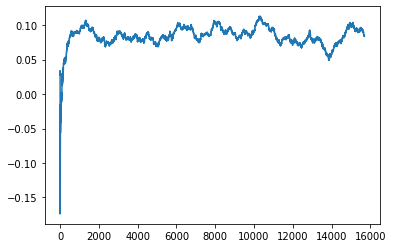

Thread: 5 iteration: 2690
RAM mDiffFit_289 FROM: 832 --> 192 reward: 0.181789048828125
Thread: 2 iteration: 2604
RAM mDiffFit_204 FROM: 2048 --> 192 reward: 0.22607809765625
Thread: 6 iteration: 2613
RAM mBackground_34 FROM: 2688 --> 192 reward: -1.0
Thread: 1 iteration: 2544
RAM mDiffFit_160 FROM: 3008 --> 192 reward: 0.1603436734375
Thread: 6 iteration: 2614
RAM mDiffFit_51 FROM: 2560 --> 192 reward: 0.258992146484375
Thread: 4 iteration: 2601
RAM mDiffFit_112 FROM: 2112 --> 192 reward: 0.23239838554687503
Thread: 5 iteration: 2691
RAM mDiffFit_309 FROM: 320 --> 192 reward: 0.07366404882812497
Thread: 2 iteration: 2605
RAM mDiffFit_35 FROM: 704 --> 192 reward: 0.304625
Saving ...


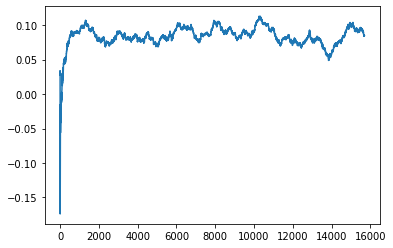

Thread: 3 iteration: 2640
RAM mDiffFit_316 FROM: 2816 --> 192 reward: 0.15157805390625
Thread: 1 iteration: 2545
RAM mDiffFit_364 FROM: 576 --> 192 reward: 0.235601570703125
Thread: 6 iteration: 2615
RAM mDiffFit_320 FROM: 1664 --> 192 reward: 0.307512987109375
Thread: 5 iteration: 2692
RAM mDiffFit_245 FROM: 2688 --> 192 reward: 0.2083749125
Thread: 6 iteration: 2616
RAM mDiffFit_229 FROM: 2176 --> 192 reward: 0.19648433671874996
Thread: 5 iteration: 2693
RAM mDiffFit_103 FROM: 2112 --> 192 reward: 0.23357809765625
Thread: 6 iteration: 2617
RAM mDiffFit_153 FROM: 2688 --> 192 reward: 0.20728900507812498
Thread: 5 iteration: 2694
RAM mDiffFit_278 FROM: 2048 --> 192 reward: 0.20821090742187498
Thread: 6 iteration: 2618
RAM mDiffFit_311 FROM: 896 --> 192 reward: 0.15105725703124995
Thread: 6 iteration: 2619
RAM mProject_23 FROM: 704 --> 192 reward: -1.0
Thread: 3 iteration: 2641
RAM mProject_22 FROM: 1664 --> 192 reward: -1.0
Thread: 1 iteration: 2546
RAM mDiffFit_80 FROM: 704 --> 192 re

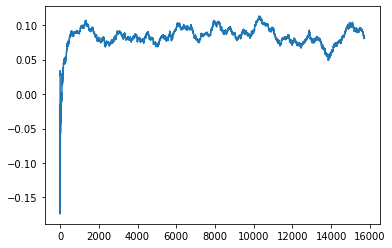

Thread: 6 iteration: 2620
RAM mDiffFit_75 FROM: 1664 --> 192 reward: 0.33935415937499996
Thread: 3 iteration: 2645
RAM mBackground_64 FROM: 2496 --> 192 reward: -1.0
Thread: 4 iteration: 2602
RAM mBackground_62 FROM: 192 --> 192 reward: -1.0
Thread: 2 iteration: 2606
RAM mDiffFit_144 FROM: 1984 --> 192 reward: 0.18421871718750005
Thread: 2 iteration: 2607
RAM mDiffFit_270 FROM: 1280 --> 192 reward: 0.5280624781250001
Thread: 3 iteration: 2646
RAM mDiffFit_126 FROM: 128 --> 192 reward: -0.5977812828125
Thread: 4 iteration: 2603
RAM mDiffFit_93 FROM: 2496 --> 192 reward: 0.25185933671875005
Thread: 3 iteration: 2647
RAM mDiffFit_210 FROM: 1024 --> 192 reward: 0.13139575312500001
Thread: 4 iteration: 2604
RAM mBackground_4 FROM: 2496 --> 192 reward: -1.0
Thread: 6 iteration: 2621
RAM mImgtbl_2 FROM: 2752 --> 192 reward: -1.0
Thread: 2 iteration: 2608
RAM mBackground_57 FROM: 1856 --> 192 reward: -1.0
Thread: 1 iteration: 2548
RAM mDiffFit_180 FROM: 128 --> 192 reward: -0.2762187609375
Thr

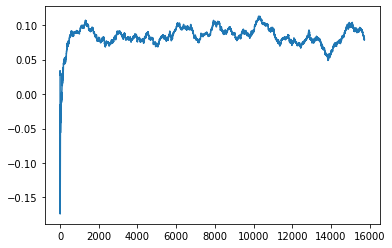

Thread: 1 iteration: 2550
RAM mDiffFit_398 FROM: 1856 --> 192 reward: 0.28705984570312504
Thread: 4 iteration: 2606
RAM mProject_77 FROM: 2304 --> 192 reward: -1.0
Saving ...


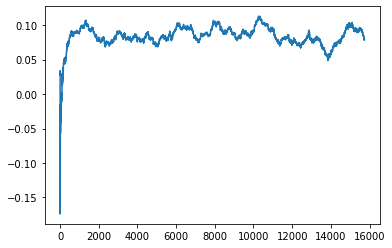

Thread: 2 iteration: 2610
RAM mBackground_48 FROM: 2496 --> 192 reward: -1.0
Thread: 6 iteration: 2622
RAM mProject_3 FROM: 2304 --> 192 reward: -1.0
Thread: 4 iteration: 2607
RAM mDiffFit_79 FROM: 320 --> 192 reward: 0.18978387148437498
Thread: 4 iteration: 2608
RAM mDiffFit_265 FROM: 1344 --> 192 reward: 0.37595314140624997
Thread: 6 iteration: 2623
RAM mDiffFit_296 FROM: 1792 --> 192 reward: 0.20426035468749998
Thread: 4 iteration: 2609
RAM mProject_12 FROM: 2624 --> 192 reward: -1.0
Thread: 2 iteration: 2611
RAM mBackground_44 FROM: 576 --> 192 reward: -1.0
Thread: 5 iteration: 2697
RAM mDiffFit_222 FROM: 2496 --> 192 reward: 0.24049214648437497
Saving ...


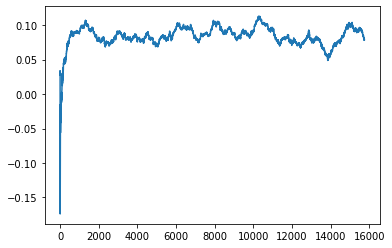

Thread: 4 iteration: 2610
RAM mBackground_20 FROM: 512 --> 192 reward: -1.0
Thread: 1 iteration: 2551
RAM mBackground_88 FROM: 2624 --> 192 reward: -1.0
Thread: 3 iteration: 2649
RAM mDiffFit_185 FROM: 1536 --> 192 reward: 0.22419528789062498
Thread: 5 iteration: 2698
RAM mDiffFit_153 FROM: 512 --> 192 reward: 0.17150780976562502
Thread: 4 iteration: 2611
RAM mDiffFit_273 FROM: 1984 --> 192 reward: 0.24281247812499995
Thread: 1 iteration: 2552
RAM mDiffFit_207 FROM: 1024 --> 192 reward: 0.22228646015625003
Thread: 5 iteration: 2699
RAM mDiffFit_363 FROM: 512 --> 192 reward: 0.2344687609375
Saving ...


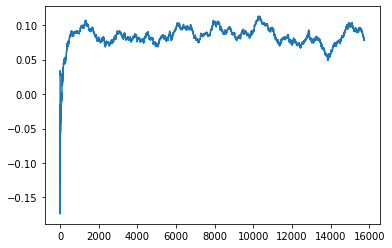

Thread: 3 iteration: 2650
RAM mDiffFit_332 FROM: 576 --> 192 reward: 0.060249956250000014
Saving ...


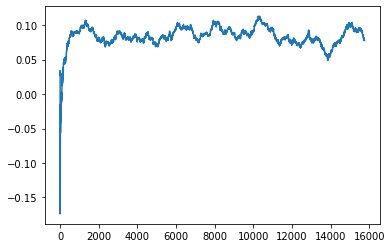

Thread: 5 iteration: 2700
RAM mDiffFit_174 FROM: 1984 --> 192 reward: 0.198585907421875
Thread: 3 iteration: 2651
RAM mDiffFit_14 FROM: 1344 --> 192 reward: 0.118898341796875
Thread: 5 iteration: 2701
RAM mDiffFit_96 FROM: 2560 --> 192 reward: 0.24137495625000005
Thread: 3 iteration: 2652
RAM mDiffFit_364 FROM: 384 --> 192 reward: 0.11963280976562501
Thread: 5 iteration: 2702
RAM mDiffFit_173 FROM: 960 --> 192 reward: -0.08903926757812503
Thread: 5 iteration: 2703
RAM mBackground_56 FROM: 2304 --> 192 reward: -1.0
Thread: 6 iteration: 2624
RAM mImgtbl_1 FROM: 2240 --> 192 reward: -1.0
Thread: 4 iteration: 2612
RAM mDiffFit_85 FROM: 2496 --> 192 reward: 0.2727187171875
Thread: 6 iteration: 2625
RAM mDiffFit_288 FROM: 1728 --> 192 reward: 0.19942181484375002
Thread: 4 iteration: 2613
RAM mBackground_10 FROM: 320 --> 192 reward: -1.0
Thread: 2 iteration: 2612
RAM mDiffFit_149 FROM: 2304 --> 192 reward: 0.334289048828125
Thread: 6 iteration: 2626
RAM mDiffFit_319 FROM: 2880 --> 192 reward:

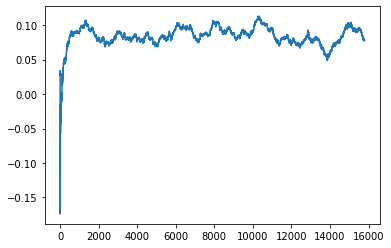

Thread: 6 iteration: 2630
RAM mProject_78 FROM: 704 --> 192 reward: -1.0
Thread: 1 iteration: 2559
RAM mDiffFit_337 FROM: 2496 --> 192 reward: 0.612039005078125
Thread: 3 iteration: 2657
RAM mBackground_71 FROM: 1984 --> 192 reward: -1.0
Thread: 2 iteration: 2617
RAM mDiffFit_210 FROM: 832 --> 192 reward: 0.265062478125
Thread: 6 iteration: 2631
RAM mDiffFit_83 FROM: 2560 --> 192 reward: 0.148684801953125
Thread: 3 iteration: 2658
RAM mDiffFit_259 FROM: 2816 --> 192 reward: 0.29662495625
Saving ...


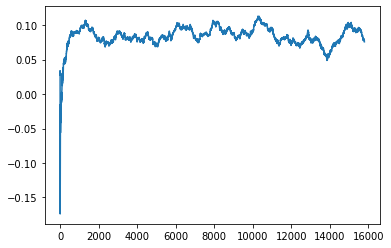

Thread: 1 iteration: 2560
RAM mDiffFit_43 FROM: 2688 --> 192 reward: 0.26562495625000004
Thread: 2 iteration: 2618
RAM mBackground_64 FROM: 1664 --> 192 reward: -1.0
Thread: 5 iteration: 2707
RAM mDiffFit_238 FROM: 896 --> 192 reward: 0.26473696914062494
Thread: 6 iteration: 2632
RAM mBackground_81 FROM: 320 --> 192 reward: -1.0
Thread: 4 iteration: 2617
RAM mDiffFit_421 FROM: 2432 --> 192 reward: 0.24814316445312498
Thread: 3 iteration: 2659
RAM mDiffFit_218 FROM: 960 --> 192 reward: 0.266242190234375
Thread: 6 iteration: 2633
RAM mDiffFit_132 FROM: 1664 --> 192 reward: 0.24452342929687496
Thread: 4 iteration: 2618
RAM mDiffFit_272 FROM: 2176 --> 192 reward: 0.5606380308593749
Thread: 2 iteration: 2619
RAM mConcatFit_3 FROM: 256 --> 192 reward: -0.01166879593749992
Thread: 1 iteration: 2561
RAM mDiffFit_320 FROM: 2816 --> 192 reward: 0.198736881640625
Thread: 4 iteration: 2619
RAM mBgModel_3 FROM: 192 --> 192 reward: 0.15156565453125
Thread: 1 iteration: 2562
RAM mDiffFit_1 FROM: 1152

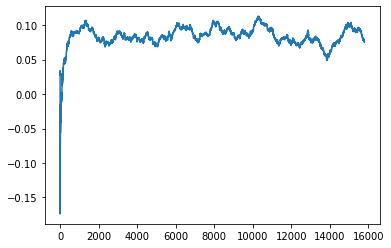

Thread: 4 iteration: 2620
RAM mBackground_49 FROM: 2560 --> 192 reward: -1.0
Thread: 5 iteration: 2708
RAM mBackground_75 FROM: 2304 --> 192 reward: -1.0
Saving ...


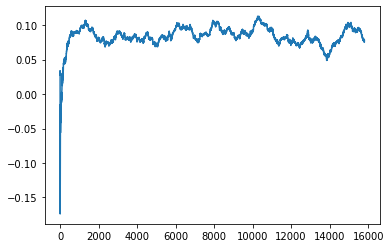

Thread: 3 iteration: 2660
RAM mBackground_53 FROM: 2176 --> 192 reward: -1.0
Saving ...


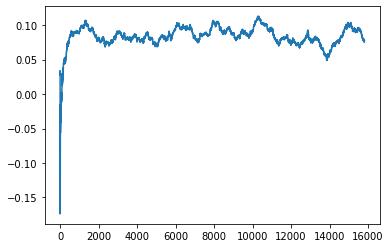

Thread: 2 iteration: 2620
RAM mDiffFit_349 FROM: 2816 --> 192 reward: 0.15351031093749998
Thread: 3 iteration: 2661
RAM mBackground_17 FROM: 1216 --> 192 reward: -1.0
Thread: 6 iteration: 2634
RAM mProject_37 FROM: 2368 --> 192 reward: -1.0
Thread: 4 iteration: 2621
RAM mDiffFit_91 FROM: 2752 --> 192 reward: 0.2888801335937501
Thread: 3 iteration: 2662
RAM mBackground_71 FROM: 768 --> 192 reward: -1.0
Thread: 1 iteration: 2563
RAM mDiffFit_369 FROM: 1280 --> 192 reward: 0.273960951171875
Thread: 1 iteration: 2564
RAM mProject_52 FROM: 2176 --> 192 reward: -1.0
Thread: 5 iteration: 2709
RAM mDiffFit_295 FROM: 640 --> 192 reward: 0.177059889453125
Saving ...


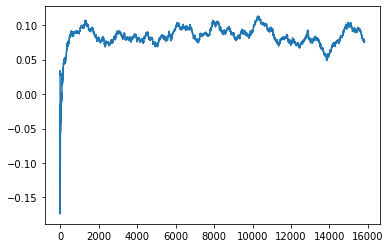

Thread: 5 iteration: 2710
RAM mProject_9 FROM: 448 --> 192 reward: -1.0
Thread: 2 iteration: 2621
RAM mProject_36 FROM: 832 --> 192 reward: -1.0
Thread: 4 iteration: 2622
RAM mProject_70 FROM: 896 --> 192 reward: -1.0
Thread: 3 iteration: 2663
RAM mDiffFit_235 FROM: 1856 --> 192 reward: 0.17939053203124997
Thread: 5 iteration: 2711
RAM mDiffFit_168 FROM: 1728 --> 192 reward: 0.20129681484374995
Thread: 3 iteration: 2664
RAM mDiffFit_395 FROM: 2176 --> 192 reward: 0.264924403515625
Thread: 5 iteration: 2712
RAM mDiffFit_100 FROM: 2368 --> 192 reward: 0.20549469140624999
Thread: 3 iteration: 2665
RAM mDiffFit_406 FROM: 320 --> 192 reward: 0.22274741132812498
Thread: 5 iteration: 2713
RAM mBackground_25 FROM: 1792 --> 192 reward: -1.0
Thread: 6 iteration: 2635
RAM mProject_53 FROM: 1536 --> 192 reward: -1.0
Thread: 2 iteration: 2622
RAM mDiffFit_135 FROM: 3008 --> 192 reward: 0.23804681484375007
Thread: 3 iteration: 2666
RAM mDiffFit_306 FROM: 128 --> 192 reward: -0.35823701289062493
Thre

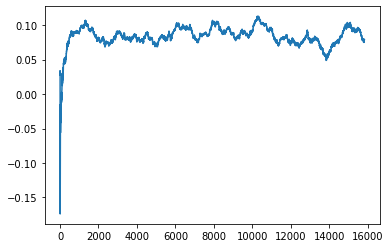

Thread: 6 iteration: 2640
RAM mProject_61 FROM: 1600 --> 192 reward: -1.0
Thread: 4 iteration: 2624
RAM mBackground_83 FROM: 2240 --> 192 reward: -1.0
Thread: 1 iteration: 2565
RAM mDiffFit_35 FROM: 1920 --> 192 reward: 0.2852811953125
Thread: 4 iteration: 2625
RAM mBackground_77 FROM: 2816 --> 192 reward: -1.0
Thread: 5 iteration: 2714
RAM mDiffFit_179 FROM: 1600 --> 192 reward: 0.58944269921875
Thread: 1 iteration: 2566
RAM mDiffFit_26 FROM: 320 --> 192 reward: 0.17458595117187498
Thread: 4 iteration: 2626
RAM mDiffFit_315 FROM: 2816 --> 192 reward: 0.28618221328125004
Thread: 4 iteration: 2627
RAM mDiffFit_284 FROM: 2240 --> 192 reward: 0.239002544921875
Thread: 4 iteration: 2628
RAM mDiffFit_20 FROM: 2560 --> 192 reward: 0.44702070937499994
Thread: 4 iteration: 2629
RAM mDiffFit_116 FROM: 2688 --> 192 reward: 0.2643436734375
Saving ...


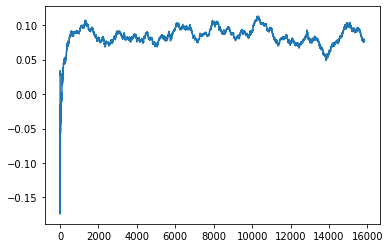

Thread: 4 iteration: 2630
RAM mBackground_18 FROM: 1728 --> 192 reward: -1.0
Thread: 3 iteration: 2669
RAM mProject_25 FROM: 1472 --> 192 reward: -1.0
Thread: 1 iteration: 2567
RAM mDiffFit_332 FROM: 576 --> 192 reward: 0.160195287890625
Thread: 4 iteration: 2631
RAM mDiffFit_191 FROM: 1920 --> 192 reward: 0.30333590742187505
Saving ...


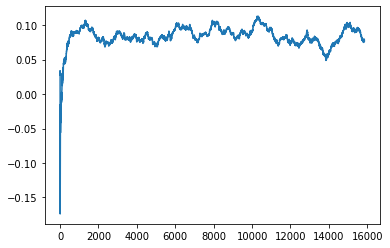

Thread: 3 iteration: 2670
RAM mBackground_37 FROM: 2112 --> 192 reward: -1.0
Thread: 2 iteration: 2627
RAM mDiffFit_45 FROM: 1664 --> 192 reward: 0.20870046523437497
Thread: 4 iteration: 2632
RAM mDiffFit_47 FROM: 2560 --> 192 reward: 0.26998433671875
Thread: 1 iteration: 2568
RAM mDiffFit_191 FROM: 2944 --> 192 reward: 0.43831765546875
Thread: 3 iteration: 2671
RAM mBackground_11 FROM: 2112 --> 192 reward: -1.0
Thread: 6 iteration: 2641
RAM mDiffFit_406 FROM: 2816 --> 192 reward: 0.12588263476562497
Thread: 4 iteration: 2633
RAM mDiffFit_84 FROM: 2368 --> 192 reward: 0.18950776601562497
Thread: 4 iteration: 2634
RAM mBackground_64 FROM: 2176 --> 192 reward: -1.0
Thread: 5 iteration: 2715
RAM mDiffFit_86 FROM: 2176 --> 320 reward: 0.289794226171875
Thread: 4 iteration: 2635
RAM mProject_45 FROM: 640 --> 192 reward: -1.0
Thread: 2 iteration: 2628
RAM mDiffFit_165 FROM: 256 --> 192 reward: 0.3030755527343751
Thread: 5 iteration: 2716
RAM mDiffFit_321 FROM: 384 --> 192 reward: 0.177710951

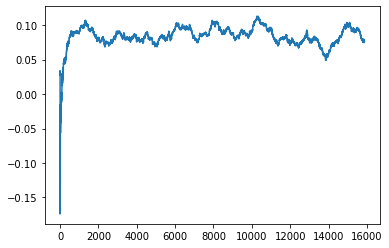

Thread: 1 iteration: 2570
RAM mProject_8 FROM: 1536 --> 192 reward: -1.0
Thread: 2 iteration: 2629
RAM mProject_5 FROM: 1088 --> 192 reward: -1.0
Thread: 4 iteration: 2637
RAM mDiffFit_120 FROM: 2944 --> 192 reward: 0.186195244140625
Saving ...


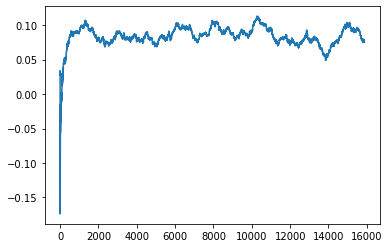

Thread: 2 iteration: 2630
RAM mDiffFit_24 FROM: 1088 --> 192 reward: 0.17659371718750005
Thread: 4 iteration: 2638
RAM mDiffFit_189 FROM: 1600 --> 192 reward: 0.26397393828125
Thread: 4 iteration: 2639
RAM mProject_83 FROM: 128 --> 192 reward: -1.0
Thread: 5 iteration: 2719
RAM mDiffFit_254 FROM: 256 --> 192 reward: 0.095145840625
Saving ...


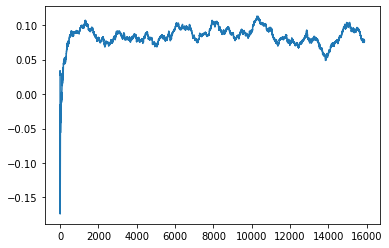

Thread: 4 iteration: 2640
RAM mBackground_70 FROM: 1216 --> 192 reward: -1.0
Thread: 6 iteration: 2643
RAM mBackground_47 FROM: 2432 --> 192 reward: -1.0
Thread: 3 iteration: 2673
RAM mDiffFit_317 FROM: 704 --> 192 reward: 0.23595573007812498
Thread: 6 iteration: 2644
RAM mDiffFit_95 FROM: 2048 --> 192 reward: 0.22035411562499999
Thread: 3 iteration: 2674
RAM mBackground_30 FROM: 1984 --> 192 reward: -1.0
Thread: 1 iteration: 2571
RAM mProject_70 FROM: 128 --> 192 reward: -1.0
Thread: 4 iteration: 2641
RAM mDiffFit_72 FROM: 1600 --> 192 reward: 0.24798174804687495
Thread: 1 iteration: 2572
RAM mDiffFit_299 FROM: 384 --> 192 reward: -0.0003203753906250162
Thread: 3 iteration: 2675
RAM mDiffFit_89 FROM: 1600 --> 192 reward: 0.32965882773437494
Thread: 6 iteration: 2645
RAM mBackground_88 FROM: 2496 --> 192 reward: -1.0
Thread: 2 iteration: 2631
RAM mDiffFit_151 FROM: 2432 --> 192 reward: 0.28395301015624996
Thread: 3 iteration: 2676
RAM mDiffFit_140 FROM: 1280 --> 192 reward: 0.247593673

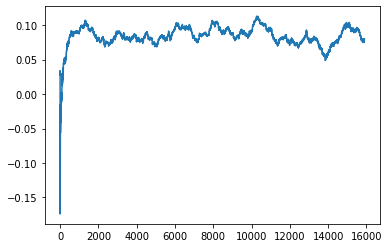

Thread: 5 iteration: 2720
RAM mProject_54 FROM: 704 --> 192 reward: -1.0
Thread: 1 iteration: 2573
RAM mDiffFit_212 FROM: 192 --> 192 reward: 0.031234380468749996
Thread: 1 iteration: 2574
RAM mDiffFit_192 FROM: 1856 --> 192 reward: 0.17957809765625
Thread: 1 iteration: 2575
RAM mProject_25 FROM: 1024 --> 192 reward: -1.0
Thread: 6 iteration: 2647
RAM mDiffFit_14 FROM: 2880 --> 192 reward: 0.27714057578125
Thread: 1 iteration: 2576
RAM mBackground_5 FROM: 2112 --> 192 reward: -1.0
Thread: 4 iteration: 2642
RAM mDiffFit_279 FROM: 1408 --> 192 reward: 0.6491146015625
Thread: 6 iteration: 2648
RAM mDiffFit_256 FROM: 960 --> 192 reward: 0.199
Thread: 1 iteration: 2577
RAM mDiffFit_82 FROM: 1216 --> 192 reward: 0.3138463496093751
Thread: 6 iteration: 2649
RAM mDiffFit_364 FROM: 576 --> 192 reward: 0.176757809765625
Saving ...


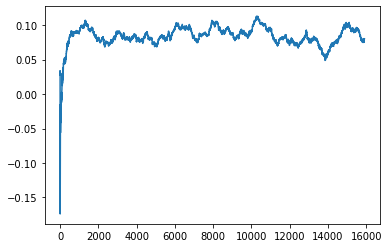

Thread: 6 iteration: 2650
RAM mBackground_60 FROM: 2688 --> 192 reward: -1.0
Thread: 3 iteration: 2677
RAM mBackground_39 FROM: 384 --> 192 reward: -1.0
Thread: 2 iteration: 2633
RAM mBackground_11 FROM: 2688 --> 192 reward: -1.0
Thread: 5 iteration: 2721
RAM mDiffFit_37 FROM: 2816 --> 192 reward: 0.11320818749999996
Thread: 5 iteration: 2722
RAM mDiffFit_23 FROM: 1920 --> 192 reward: 0.337312478125
Thread: 2 iteration: 2634
RAM mProject_55 FROM: 2240 --> 192 reward: -1.0
Thread: 4 iteration: 2643
RAM mProject_33 FROM: 2176 --> 192 reward: -1.0
Thread: 1 iteration: 2578
RAM mDiffFit_227 FROM: 1984 --> 192 reward: 0.24342966835937496
Thread: 2 iteration: 2635
RAM mDiffFit_63 FROM: 2560 --> 192 reward: 0.255617146484375
Thread: 2 iteration: 2636
RAM mProject_56 FROM: 1216 --> 192 reward: -1.0
Thread: 6 iteration: 2651
RAM mDiffFit_115 FROM: 2816 --> 192 reward: 0.20130462460937498
Thread: 6 iteration: 2652
RAM mDiffFit_278 FROM: 704 --> 192 reward: 0.290695331640625
Thread: 2 iteration: 

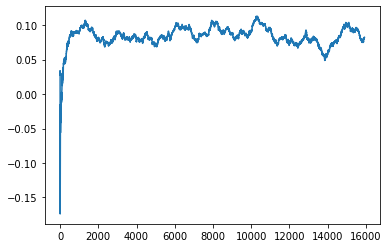

Thread: 3 iteration: 2680
RAM mDiffFit_390 FROM: 896 --> 192 reward: 0.284013030859375
Thread: 4 iteration: 2648
RAM mProject_31 FROM: 1856 --> 192 reward: -1.0
Thread: 2 iteration: 2639
RAM mProject_20 FROM: 1216 --> 192 reward: -1.0
Thread: 6 iteration: 2654
RAM mProject_30 FROM: 1216 --> 192 reward: -1.0
Thread: 5 iteration: 2724
RAM mBackground_74 FROM: 1728 --> 192 reward: -1.0
Thread: 1 iteration: 2579
RAM mDiffFit_347 FROM: 2176 --> 192 reward: 0.287169226171875
Thread: 4 iteration: 2649
RAM mDiffFit_155 FROM: 2816 --> 192 reward: 0.25982283281250007
Thread: 5 iteration: 2725
RAM mDiffFit_76 FROM: 1664 --> 192 reward: 0.47189847304687504
Thread: 6 iteration: 2655
RAM mDiffFit_77 FROM: 192 --> 192 reward: 0.30620318515624995
Saving ...


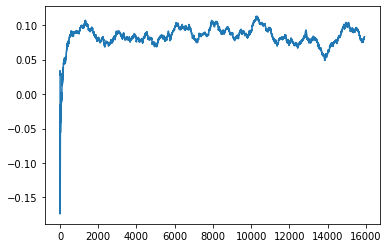

Thread: 1 iteration: 2580
RAM mDiffFit_60 FROM: 1792 --> 192 reward: 0.28751561953125004
Saving ...


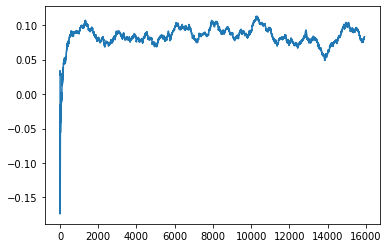

Thread: 4 iteration: 2650
RAM mProject_56 FROM: 2112 --> 192 reward: -1.0
Thread: 3 iteration: 2681
RAM mDiffFit_357 FROM: 576 --> 192 reward: 0.155789048828125
Thread: 4 iteration: 2651
RAM mDiffFit_375 FROM: 1792 --> 192 reward: 0.5467890488281251
Thread: 6 iteration: 2656
RAM mDiffFit_111 FROM: 2368 --> 192 reward: 0.49483331875000003
Thread: 1 iteration: 2581
RAM mDiffFit_419 FROM: 448 --> 192 reward: 0.3663021234375001
Thread: 1 iteration: 2582
RAM mDiffFit_369 FROM: 2880 --> 192 reward: 0.35159371718750004
Thread: 1 iteration: 2583
RAM mDiffFit_410 FROM: 2432 --> 192 reward: 0.24776816445312494
Thread: 1 iteration: 2584
RAM mAdd_2 FROM: 2752 --> 192 reward: -1.0
Saving ...


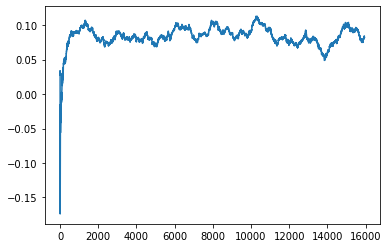

Thread: 2 iteration: 2640
RAM mProject_78 FROM: 512 --> 192 reward: -1.0
Thread: 4 iteration: 2652
RAM mDiffFit_218 FROM: 832 --> 192 reward: 0.11146608476562497
Thread: 2 iteration: 2641
RAM mDiffFit_406 FROM: 2112 --> 192 reward: 0.272007766015625
Thread: 2 iteration: 2642
RAM mDiffFit_1 FROM: 768 --> 192 reward: 0.26785157070312504
Thread: 2 iteration: 2643
RAM mDiffFit_38 FROM: 704 --> 192 reward: 0.47097393828124995
Thread: 2 iteration: 2644
RAM mProject_1 FROM: 832 --> 192 reward: -1.0
Thread: 1 iteration: 2585
RAM mBackground_37 FROM: 2496 --> 192 reward: -1.0
Thread: 5 iteration: 2726
RAM mBackground_40 FROM: 2048 --> 192 reward: -1.0
Thread: 3 iteration: 2682
RAM mDiffFit_410 FROM: 1984 --> 192 reward: 0.222070287890625
Thread: 2 iteration: 2645
RAM mBackground_13 FROM: 320 --> 192 reward: -1.0
Thread: 6 iteration: 2657
RAM mDiffFit_411 FROM: 576 --> 192 reward: 0.413351570703125
Thread: 3 iteration: 2683
RAM mDiffFit_422 FROM: 1856 --> 192 reward: 0.19935670429687496
Thread: 

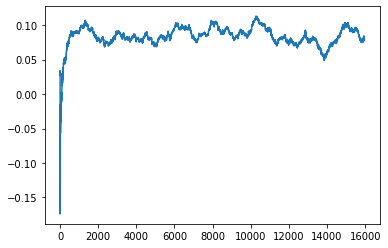

Thread: 6 iteration: 2660
RAM mDiffFit_312 FROM: 512 --> 192 reward: 0.11253904882812502
Thread: 1 iteration: 2588
RAM mDiffFit_85 FROM: 1472 --> 192 reward: 0.14895823125
Thread: 4 iteration: 2655
RAM mDiffFit_160 FROM: 1600 --> 192 reward: 0.209289048828125
Thread: 1 iteration: 2589
RAM mBackground_13 FROM: 896 --> 192 reward: -1.0
Thread: 3 iteration: 2684
RAM mDiffFit_57 FROM: 896 --> 192 reward: 0.25974477890625
Saving ...


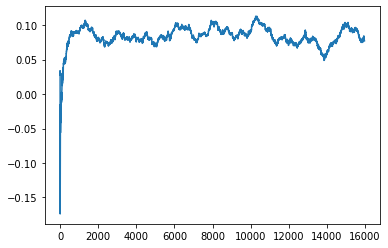

Thread: 1 iteration: 2590
RAM mDiffFit_88 FROM: 1344 --> 192 reward: 0.525710907421875
Thread: 4 iteration: 2656
RAM mDiffFit_422 FROM: 576 --> 192 reward: 0.08321086367187494
Thread: 4 iteration: 2657
RAM mDiffFit_225 FROM: 2368 --> 192 reward: 0.3893931644531251
Thread: 1 iteration: 2591
RAM mProject_36 FROM: 448 --> 192 reward: -1.0
Thread: 5 iteration: 2729
RAM mDiffFit_11 FROM: 2560 --> 192 reward: 0.21713276601562498
Thread: 1 iteration: 2592
RAM mDiffFit_414 FROM: 1152 --> 192 reward: 0.20053123906249998
Thread: 1 iteration: 2593
RAM mDiffFit_279 FROM: 1152 --> 192 reward: 0.806023473046875
Thread: 4 iteration: 2658
RAM mDiffFit_326 FROM: 256 --> 192 reward: 0.08941146015625005
Thread: 1 iteration: 2594
RAM mBackground_49 FROM: 2624 --> 192 reward: -1.0
Thread: 2 iteration: 2647
RAM mDiffFit_400 FROM: 2560 --> 192 reward: 0.1876561953125
Thread: 2 iteration: 2648
RAM mBackground_80 FROM: 2240 --> 192 reward: -1.0
Thread: 6 iteration: 2661
RAM mImgtbl_2 FROM: 2240 --> 192 reward:

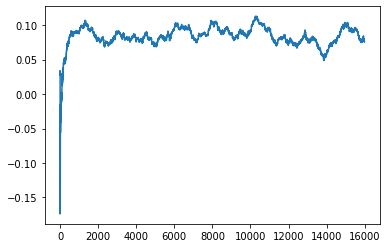

Thread: 4 iteration: 2660
RAM mDiffFit_38 FROM: 2176 --> 192 reward: 0.607583275
Thread: 1 iteration: 2596
RAM mDiffFit_170 FROM: 2688 --> 192 reward: 0.22427338554687498
Thread: 4 iteration: 2661
RAM mBackground_53 FROM: 192 --> 192 reward: -1.0
Saving ...


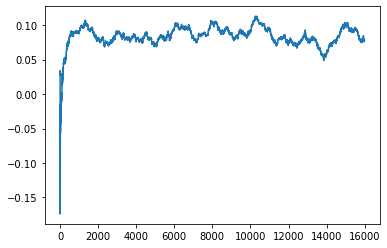

Thread: 5 iteration: 2730
RAM mDiffFit_341 FROM: 320 --> 320 reward: 0.08854690234374997
Thread: 1 iteration: 2597
RAM mDiffFit_19 FROM: 2560 --> 192 reward: 0.23250513359375002
Thread: 4 iteration: 2662
RAM mProject_16 FROM: 192 --> 192 reward: -1.0
Thread: 6 iteration: 2663
RAM mDiffFit_271 FROM: 1024 --> 192 reward: 0.211419269921875
Thread: 5 iteration: 2731
RAM mDiffFit_162 FROM: 2496 --> 192 reward: 0.25098433671875003
Thread: 4 iteration: 2663
RAM mProject_39 FROM: 2688 --> 192 reward: -1.0
Thread: 3 iteration: 2687
RAM mDiffFit_365 FROM: 1664 --> 192 reward: 0.256033827734375
Thread: 6 iteration: 2664
RAM mDiffFit_410 FROM: 1536 --> 192 reward: 0.27753904882812497
Thread: 5 iteration: 2732
RAM mDiffFit_312 FROM: 448 --> 192 reward: 0.07301820820312499
Thread: 3 iteration: 2688
RAM mBackground_43 FROM: 896 --> 192 reward: -1.0
Thread: 2 iteration: 2649
RAM mDiffFit_207 FROM: 1856 --> 192 reward: 0.21533068632812497
Thread: 6 iteration: 2665
RAM mDiffFit_268 FROM: 1152 --> 192 re

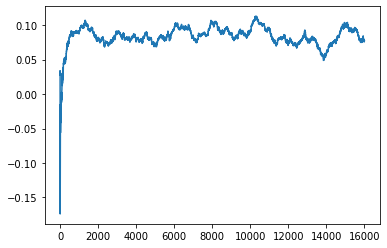

Thread: 2 iteration: 2650
RAM mDiffFit_66 FROM: 1216 --> 256 reward: 0.21302084062499999
Thread: 6 iteration: 2666
RAM mDiffFit_290 FROM: 320 --> 320 reward: 0.06601825195312497
Thread: 2 iteration: 2651
RAM mViewer_4 FROM: 256 --> 192 reward: -1.0
Thread: 4 iteration: 2664
RAM mDiffFit_184 FROM: 2880 --> 192 reward: 0.190937434375
Thread: 6 iteration: 2667
RAM mDiffFit_207 FROM: 1216 --> 256 reward: 0.125247367578125
Thread: 2 iteration: 2652
RAM mDiffFit_277 FROM: 2048 --> 256 reward: 0.1666770359375
Thread: 6 iteration: 2668
RAM mDiffFit_40 FROM: 1600 --> 256 reward: 0.48641672500000005
Thread: 2 iteration: 2653
RAM mProject_32 FROM: 2624 --> 192 reward: -1.0
Thread: 3 iteration: 2689
RAM mDiffFit_253 FROM: 1856 --> 192 reward: 0.6996197789062499
Thread: 6 iteration: 2669
RAM mBackground_73 FROM: 1408 --> 192 reward: -1.0
Thread: 1 iteration: 2598
RAM mDiffFit_418 FROM: 384 --> 192 reward: 0.25507033164062504
Thread: 2 iteration: 2654
RAM mDiffFit_139 FROM: 640 --> 192 reward: 0.492

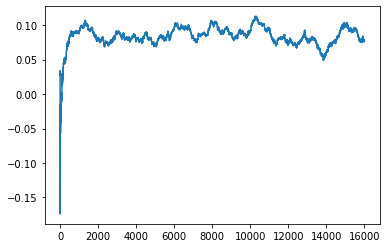

Thread: 3 iteration: 2690
RAM mDiffFit_299 FROM: 704 --> 192 reward: 0.13807805390625
Saving ...


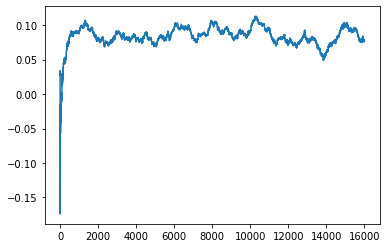

Thread: 6 iteration: 2670
RAM mDiffFit_120 FROM: 2496 --> 192 reward: 0.21363276601562503
Thread: 2 iteration: 2655
RAM mDiffFit_163 FROM: 1408 --> 192 reward: 0.18919787656250003
Thread: 1 iteration: 2599
RAM mDiffFit_290 FROM: 1600 --> 192 reward: 0.19195305390625
Thread: 2 iteration: 2656
RAM mDiffFit_92 FROM: 1216 --> 256 reward: 0.25626561953125004
Thread: 2 iteration: 2657
RAM mBackground_30 FROM: 1344 --> 192 reward: -1.0
Thread: 5 iteration: 2734
RAM mDiffFit_179 FROM: 640 --> 192 reward: 0.5259401105468752
Thread: 2 iteration: 2658
RAM mDiffFit_159 FROM: 576 --> 192 reward: 0.166632809765625
Thread: 2 iteration: 2659
RAM mBackground_23 FROM: 1664 --> 192 reward: -1.0
Thread: 4 iteration: 2665
RAM mProject_55 FROM: 832 --> 320 reward: -1.0
Saving ...


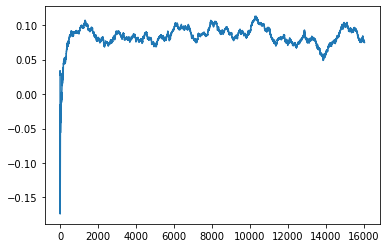

Thread: 1 iteration: 2600
RAM mDiffFit_25 FROM: 832 --> 192 reward: 0.27666668125000005
Thread: 4 iteration: 2666
RAM mDiffFit_411 FROM: 1216 --> 192 reward: 0.5566979203125001
Thread: 1 iteration: 2601
RAM mDiffFit_81 FROM: 1664 --> 192 reward: 0.23304163749999995
Thread: 1 iteration: 2602
RAM mProject_49 FROM: 512 --> 192 reward: -1.0
Thread: 5 iteration: 2735
RAM mBackground_89 FROM: 1984 --> 192 reward: -1.0
Thread: 3 iteration: 2691
RAM mDiffFit_230 FROM: 2240 --> 256 reward: 0.17521090742187498
Thread: 1 iteration: 2603
RAM mDiffFit_218 FROM: 512 --> 192 reward: 0.22513803085937503
Thread: 3 iteration: 2692
RAM mDiffFit_360 FROM: 2304 --> 192 reward: 0.302937478125
Thread: 1 iteration: 2604
RAM mDiffFit_416 FROM: 2304 --> 192 reward: 0.24617181484375
Thread: 1 iteration: 2605
RAM mDiffFit_53 FROM: 1920 --> 192 reward: 0.25860933671875
Thread: 1 iteration: 2606
RAM mDiffFit_172 FROM: 2048 --> 192 reward: 0.26967185859375
Thread: 1 iteration: 2607
RAM mBackground_64 FROM: 1280 --> 

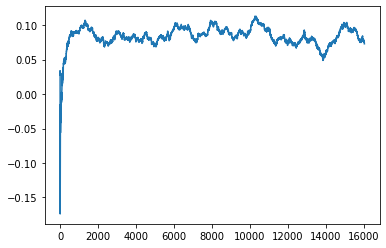

Thread: 2 iteration: 2660
RAM mDiffFit_138 FROM: 576 --> 192 reward: 0.194382809765625
Thread: 1 iteration: 2608
RAM mDiffFit_117 FROM: 448 --> 192 reward: 0.16829426992187496
Thread: 2 iteration: 2661
RAM mBackground_81 FROM: 2304 --> 192 reward: -1.0
Thread: 4 iteration: 2667
RAM mDiffFit_220 FROM: 3008 --> 192 reward: 0.19326812070312493
Thread: 1 iteration: 2609
RAM mDiffFit_360 FROM: 1472 --> 256 reward: 0.2559479203125
Thread: 4 iteration: 2668
RAM mDiffFit_292 FROM: 2624 --> 192 reward: 0.23039057578124997
Saving ...


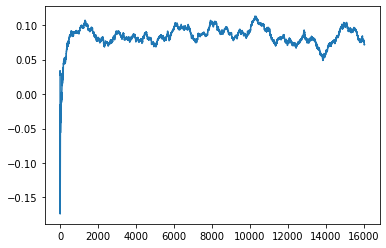

Thread: 1 iteration: 2610
RAM mDiffFit_389 FROM: 2240 --> 192 reward: 0.56891659375
Thread: 1 iteration: 2611
RAM mProject_58 FROM: 512 --> 192 reward: -1.0
Thread: 6 iteration: 2672
RAM mBackground_18 FROM: 1408 --> 192 reward: -1.0
Thread: 5 iteration: 2736
RAM mDiffFit_216 FROM: 2624 --> 192 reward: 0.17753900507812498
Thread: 1 iteration: 2612
RAM mBackground_84 FROM: 1728 --> 192 reward: -1.0
Thread: 3 iteration: 2693
RAM mProject_56 FROM: 2176 --> 192 reward: -1.0
Thread: 2 iteration: 2662
RAM mDiffFit_305 FROM: 192 --> 192 reward: 0.032359380468750046
Thread: 5 iteration: 2737
RAM mDiffFit_339 FROM: 1472 --> 192 reward: 0.25051557578125
Thread: 1 iteration: 2613
RAM mDiffFit_422 FROM: 2368 --> 256 reward: 0.290007809765625
Thread: 3 iteration: 2694
RAM mDiffFit_295 FROM: 1792 --> 192 reward: 0.19282028789062503
Thread: 1 iteration: 2614
RAM mDiffFit_253 FROM: 2624 --> 320 reward: 0.53166137265625
Thread: 5 iteration: 2738
RAM mDiffFit_129 FROM: 704 --> 192 reward: 0.129018208203

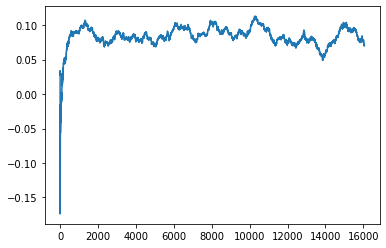

Thread: 5 iteration: 2740
RAM mBackground_60 FROM: 1344 --> 192 reward: -1.0
Thread: 4 iteration: 2669
RAM mDiffFit_245 FROM: 2304 --> 192 reward: 0.37514061953125
Thread: 6 iteration: 2674
RAM mDiffFit_351 FROM: 1344 --> 192 reward: 0.26842966835937504
Saving ...


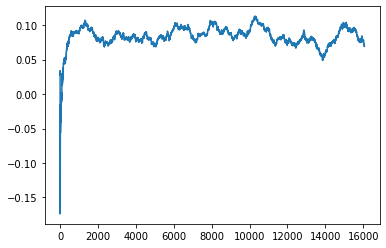

Thread: 4 iteration: 2670
RAM mProject_69 FROM: 2880 --> 192 reward: -1.0
Thread: 3 iteration: 2695
RAM mDiffFit_271 FROM: 2112 --> 192 reward: 0.28305466835937504
Thread: 6 iteration: 2675
RAM mDiffFit_149 FROM: 256 --> 192 reward: -0.08073442421875
Thread: 3 iteration: 2696
RAM mBackground_46 FROM: 256 --> 320 reward: -1.0
Thread: 2 iteration: 2663
RAM mDiffFit_228 FROM: 1472 --> 256 reward: 0.49527869414062503
Thread: 3 iteration: 2697
RAM mBackground_39 FROM: 1600 --> 320 reward: -1.0
Thread: 1 iteration: 2616
RAM mDiffFit_182 FROM: 2624 --> 256 reward: 0.28503904882812503
Thread: 3 iteration: 2698
RAM mDiffFit_18 FROM: 256 --> 320 reward: 0.07766409257812501
Thread: 3 iteration: 2699
RAM mProject_4 FROM: 1344 --> 256 reward: -1.0
Thread: 6 iteration: 2676
RAM mBackground_30 FROM: 256 --> 320 reward: -1.0
Thread: 5 iteration: 2741
RAM mDiffFit_389 FROM: 2496 --> 192 reward: 0.6300233855468751
Thread: 6 iteration: 2677
RAM mBackground_28 FROM: 2688 --> 192 reward: -1.0
Thread: 4 ite

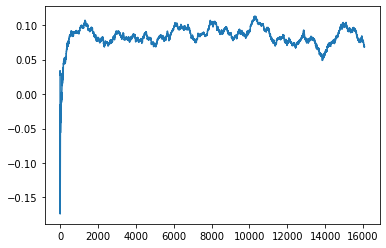

Thread: 3 iteration: 2700
RAM mDiffFit_244 FROM: 2944 --> 192 reward: 0.34747652695312503
Thread: 4 iteration: 2673
RAM mAdd_2 FROM: 1152 --> 192 reward: -1.0
Thread: 5 iteration: 2742
RAM mDiffFit_188 FROM: 1344 --> 256 reward: 0.12884367343750003
Thread: 3 iteration: 2701
RAM mDiffFit_339 FROM: 1280 --> 192 reward: 0.42975263242187506
Thread: 5 iteration: 2743
RAM mDiffFit_172 FROM: 1536 --> 192 reward: 0.233492146484375
Thread: 3 iteration: 2702
RAM mDiffFit_369 FROM: 1792 --> 192 reward: 0.24865623906249995
Thread: 5 iteration: 2744
RAM mDiffFit_163 FROM: 1536 --> 256 reward: 0.14974995624999998
Thread: 5 iteration: 2745
RAM mBackground_45 FROM: 640 --> 192 reward: -1.0
Thread: 1 iteration: 2617
RAM mDiffFit_135 FROM: 384 --> 320 reward: 0.023955730078124987
Thread: 5 iteration: 2746
RAM mDiffFit_184 FROM: 512 --> 256 reward: 0.1258229203125
Thread: 1 iteration: 2618
RAM mDiffFit_412 FROM: 1664 --> 192 reward: 0.44692449101562504
Thread: 5 iteration: 2747
RAM mDiffFit_350 FROM: 960

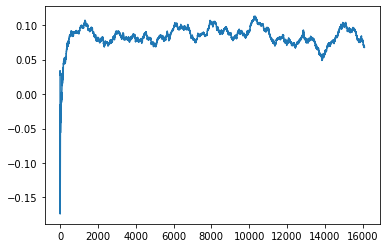

Thread: 6 iteration: 2680
RAM mDiffFit_108 FROM: 896 --> 192 reward: 0.5257344242187499
Thread: 6 iteration: 2681
RAM mProject_81 FROM: 1024 --> 192 reward: -1.0
Thread: 3 iteration: 2704
RAM mDiffFit_3 FROM: 1344 --> 192 reward: 0.3167812390625
Thread: 3 iteration: 2705
RAM mProject_39 FROM: 128 --> 192 reward: -1.0
Thread: 6 iteration: 2682
RAM mBackground_81 FROM: 2432 --> 192 reward: -1.0
Thread: 4 iteration: 2675
RAM mDiffFit_120 FROM: 1664 --> 192 reward: 0.293242190234375
Thread: 4 iteration: 2676
RAM mBackground_16 FROM: 1728 --> 192 reward: -1.0
Thread: 5 iteration: 2749
RAM mBackground_4 FROM: 704 --> 256 reward: -1.0
Saving ...


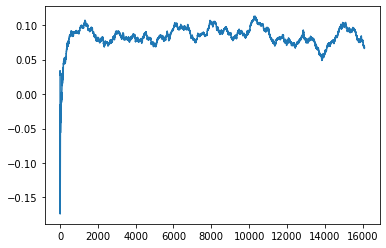

Thread: 1 iteration: 2620
RAM mProject_77 FROM: 1024 --> 320 reward: -1.0
Thread: 3 iteration: 2706
RAM mBackground_41 FROM: 2688 --> 192 reward: -1.0
Thread: 2 iteration: 2666
RAM mDiffFit_410 FROM: 2368 --> 256 reward: 0.105270753125
Thread: 1 iteration: 2621
RAM mDiffFit_106 FROM: 128 --> 320 reward: -0.46552601796875004
Thread: 2 iteration: 2667
RAM mProject_6 FROM: 1344 --> 192 reward: -1.0
Thread: 6 iteration: 2683
RAM mDiffFit_212 FROM: 2304 --> 192 reward: 0.31555466835937507
Thread: 1 iteration: 2622
RAM mBgModel_3 FROM: 1088 --> 192 reward: 0.16770308890625
Saving ...


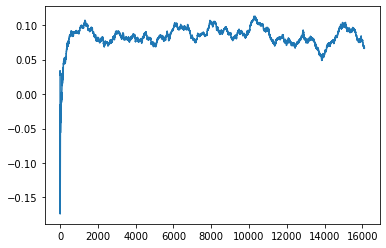

Thread: 5 iteration: 2750
RAM mDiffFit_69 FROM: 2496 --> 256 reward: 0.11395046523437502
Thread: 2 iteration: 2668
RAM mDiffFit_306 FROM: 3008 --> 256 reward: 0.24681506679687498
Thread: 6 iteration: 2684
RAM mDiffFit_376 FROM: 1920 --> 192 reward: 0.24536710273437498
Thread: 1 iteration: 2623
RAM mDiffFit_318 FROM: 2880 --> 256 reward: 0.23497652695312496
Thread: 5 iteration: 2751
RAM mDiffFit_131 FROM: 1344 --> 256 reward: 0.20675258867187501
Thread: 2 iteration: 2669
RAM mProject_17 FROM: 1216 --> 320 reward: -1.0
Thread: 4 iteration: 2677
RAM mDiffFit_306 FROM: 1280 --> 256 reward: 0.09146867343750001
Thread: 5 iteration: 2752
RAM mDiffFit_352 FROM: 2880 --> 192 reward: 0.29662495625
Saving ...


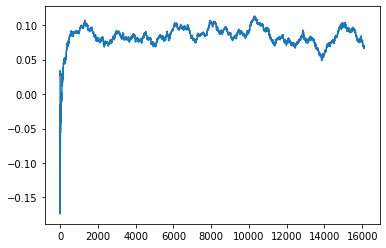

Thread: 2 iteration: 2670
RAM mDiffFit_173 FROM: 1920 --> 256 reward: 0.16459893828124994
Thread: 5 iteration: 2753
RAM mDiffFit_196 FROM: 2944 --> 256 reward: 0.4261145578125
Thread: 2 iteration: 2671
RAM mDiffFit_217 FROM: 1984 --> 256 reward: 0.28170831875
Thread: 2 iteration: 2672
RAM mProject_40 FROM: 1216 --> 192 reward: -1.0
Thread: 6 iteration: 2685
RAM mBackground_34 FROM: 704 --> 256 reward: -1.0
Thread: 3 iteration: 2707
RAM mDiffFit_34 FROM: 2816 --> 192 reward: 0.5072967710937499
Thread: 2 iteration: 2673
RAM mProject_87 FROM: 1792 --> 256 reward: -1.0
Thread: 4 iteration: 2678
RAM mDiffFit_187 FROM: 1408 --> 192 reward: 0.06477593046875
Thread: 3 iteration: 2708
RAM mDiffFit_128 FROM: 576 --> 256 reward: -0.09054176875
Thread: 2 iteration: 2674
RAM mDiffFit_199 FROM: 2944 --> 192 reward: 0.19719524414062498
Thread: 3 iteration: 2709
RAM mDiffFit_155 FROM: 768 --> 192 reward: 0.12374214648437495
Thread: 2 iteration: 2675
RAM mDiffFit_216 FROM: 1344 --> 256 reward: 0.127387

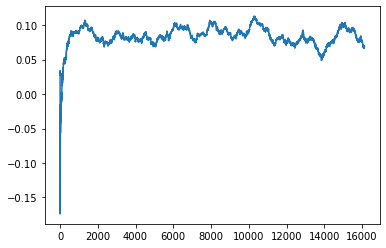

Thread: 3 iteration: 2710
RAM mConcatFit_2 FROM: 2432 --> 192 reward: 0.7516019309374999
Thread: 4 iteration: 2679
RAM mDiffFit_88 FROM: 2048 --> 256 reward: 0.6167500000000001
Thread: 2 iteration: 2676
RAM mProject_17 FROM: 1792 --> 256 reward: -1.0
Thread: 6 iteration: 2686
RAM mViewer_1 FROM: 192 --> 256 reward: -0.21303390925781265
Thread: 3 iteration: 2711
RAM mBackground_6 FROM: 2432 --> 192 reward: -1.0
Thread: 1 iteration: 2624
RAM mBackground_44 FROM: 1280 --> 256 reward: -1.0
Thread: 5 iteration: 2754
RAM mDiffFit_357 FROM: 128 --> 256 reward: -0.6860990257812499
Saving ...


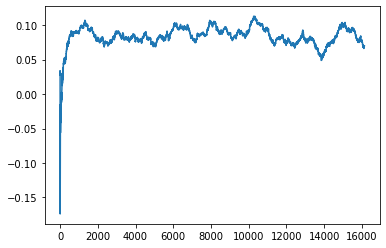

Thread: 4 iteration: 2680
RAM mDiffFit_251 FROM: 768 --> 192 reward: 0.21692185859374996
Thread: 2 iteration: 2677
RAM mDiffFit_369 FROM: 1408 --> 320 reward: 0.07249473515624996
Thread: 1 iteration: 2625
RAM mDiffFit_194 FROM: 1472 --> 256 reward: 0.11979163750000002
Thread: 5 iteration: 2755
RAM mDiffFit_417 FROM: 1600 --> 192 reward: 0.28021612851562494
Thread: 3 iteration: 2712
RAM mDiffFit_354 FROM: 2368 --> 192 reward: 0.08780190468749997
Thread: 4 iteration: 2681
RAM mBgModel_1 FROM: 128 --> 192 reward: -0.9603136535937499
Thread: 2 iteration: 2678
RAM mDiffFit_237 FROM: 960 --> 320 reward: 0.14452865039062499
Thread: 5 iteration: 2756
RAM mDiffFit_361 FROM: 576 --> 192 reward: 0.14493747812500002
Thread: 1 iteration: 2626
RAM mDiffFit_381 FROM: 768 --> 256 reward: -0.01322924687500001
Thread: 4 iteration: 2682
RAM mDiffFit_76 FROM: 2816 --> 320 reward: 0.2054166375
Thread: 5 iteration: 2757
RAM mDiffFit_8 FROM: 1408 --> 256 reward: 0.085812434375
Thread: 5 iteration: 2758
RAM m

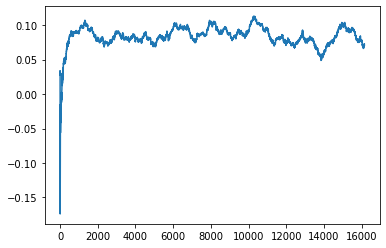

Thread: 5 iteration: 2760
RAM mBackground_81 FROM: 2944 --> 192 reward: -1.0
Thread: 6 iteration: 2687
RAM mProject_15 FROM: 448 --> 256 reward: -1.0
Thread: 1 iteration: 2627
RAM mDiffFit_290 FROM: 2048 --> 256 reward: 0.20070831875
Thread: 5 iteration: 2761
RAM mDiffFit_43 FROM: 832 --> 256 reward: 0.23619792031250003
Thread: 6 iteration: 2688
RAM mDiffFit_360 FROM: 1984 --> 256 reward: 0.2083437171875
Thread: 1 iteration: 2628
RAM mDiffFit_382 FROM: 832 --> 256 reward: 0.20463013359374999
Saving ...


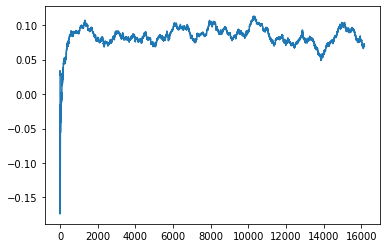

Thread: 2 iteration: 2680
RAM mDiffFit_204 FROM: 640 --> 256 reward: 0.10184893828125
Thread: 5 iteration: 2762
RAM mDiffFit_103 FROM: 512 --> 192 reward: 0.17941146015624998
Thread: 6 iteration: 2689
RAM mDiffFit_247 FROM: 448 --> 256 reward: 0.133065110546875
Thread: 2 iteration: 2681
RAM mDiffFit_147 FROM: 1472 --> 256 reward: 0.31553900507812493
Saving ...


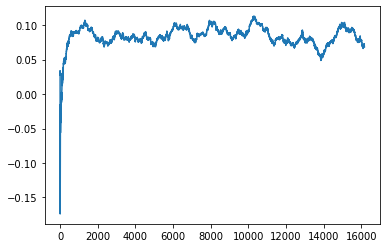

Thread: 6 iteration: 2690
RAM mDiffFit_230 FROM: 448 --> 192 reward: 0.4897604859375
Thread: 5 iteration: 2763
RAM mBackground_35 FROM: 1216 --> 192 reward: -1.0
Thread: 4 iteration: 2683
RAM mDiffFit_420 FROM: 2240 --> 256 reward: 0.11298951406250002
Thread: 6 iteration: 2691
RAM mDiffFit_331 FROM: 576 --> 256 reward: 0.14251561953124997
Thread: 4 iteration: 2684
RAM mDiffFit_296 FROM: 2048 --> 256 reward: 0.10074991250000001
Thread: 6 iteration: 2692
RAM mDiffFit_265 FROM: 1088 --> 256 reward: 0.04039053203125
Thread: 4 iteration: 2685
RAM mDiffFit_379 FROM: 2240 --> 192 reward: 0.21126816445312496
Thread: 4 iteration: 2686
RAM mDiffFit_72 FROM: 2432 --> 256 reward: 0.3065937171875
Thread: 6 iteration: 2693
RAM mBackground_19 FROM: 896 --> 256 reward: -1.0
Thread: 3 iteration: 2714
RAM mProject_35 FROM: 576 --> 256 reward: -1.0
Thread: 2 iteration: 2682
RAM mDiffFit_19 FROM: 2304 --> 320 reward: 0.140460907421875
Thread: 2 iteration: 2683
RAM mDiffFit_1 FROM: 1920 --> 192 reward: 0.3

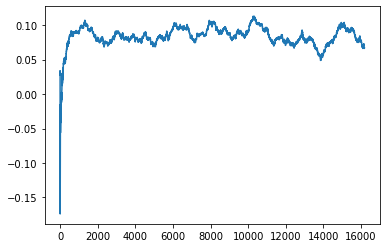

Thread: 1 iteration: 2630
RAM mDiffFit_347 FROM: 1536 --> 256 reward: 0.4333333625
Thread: 1 iteration: 2631
RAM mDiffFit_386 FROM: 1024 --> 256 reward: 0.20759380468750002
Thread: 1 iteration: 2632
RAM mProject_41 FROM: 2368 --> 256 reward: -1.0
Thread: 5 iteration: 2765
RAM mBackground_86 FROM: 3008 --> 256 reward: -1.0
Thread: 6 iteration: 2694
RAM mBackground_80 FROM: 1152 --> 256 reward: -1.0
Thread: 4 iteration: 2687
RAM mDiffFit_209 FROM: 832 --> 256 reward: 0.136520840625
Thread: 5 iteration: 2766
RAM mDiffFit_317 FROM: 192 --> 256 reward: -0.07433073007812499
Thread: 5 iteration: 2767
RAM mDiffFit_109 FROM: 128 --> 256 reward: -0.2916302210937499
Thread: 4 iteration: 2688
RAM mDiffFit_309 FROM: 640 --> 192 reward: 0.35120314140625
Thread: 6 iteration: 2695
RAM mDiffFit_132 FROM: 1472 --> 256 reward: 0.077539005078125
Thread: 6 iteration: 2696
RAM mDiffFit_311 FROM: 320 --> 192 reward: 0.11595573007812501
Thread: 6 iteration: 2697
RAM mProject_59 FROM: 1536 --> 256 reward: -1.0

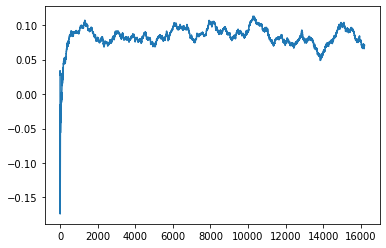

Thread: 3 iteration: 2720
RAM mProject_16 FROM: 2624 --> 192 reward: -1.0
Thread: 5 iteration: 2768
RAM mProject_60 FROM: 1920 --> 192 reward: -1.0
Thread: 4 iteration: 2689
RAM mBackground_56 FROM: 1600 --> 256 reward: -1.0
Thread: 1 iteration: 2633
RAM mDiffFit_10 FROM: 1280 --> 256 reward: 0.40095831875
Thread: 3 iteration: 2721
RAM mDiffFit_278 FROM: 1472 --> 256 reward: 0.14694265546875
Thread: 1 iteration: 2634
RAM mDiffFit_159 FROM: 1664 --> 192 reward: 0.27365101796875
Saving ...


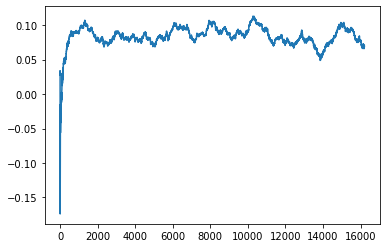

Thread: 4 iteration: 2690
RAM mProject_13 FROM: 2432 --> 192 reward: -1.0
Thread: 6 iteration: 2699
RAM mDiffFit_68 FROM: 2624 --> 256 reward: 0.12662491249999994
Thread: 1 iteration: 2635
RAM mDiffFit_358 FROM: 2432 --> 256 reward: 0.15869261171875
Thread: 4 iteration: 2691
RAM mProject_81 FROM: 384 --> 192 reward: -1.0
Thread: 2 iteration: 2689
RAM mDiffFit_344 FROM: 1088 --> 256 reward: 0.11780466835937502
Thread: 1 iteration: 2636
RAM mDiffFit_384 FROM: 1664 --> 320 reward: 0.212830730078125
Saving ...


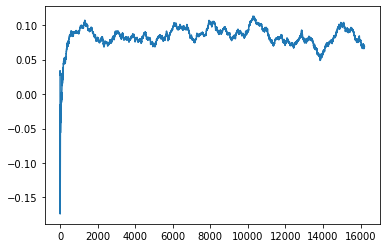

Thread: 6 iteration: 2700
RAM mProject_36 FROM: 128 --> 256 reward: -1.0
Thread: 5 iteration: 2769
RAM mDiffFit_44 FROM: 1984 --> 256 reward: 0.182054668359375
Saving ...


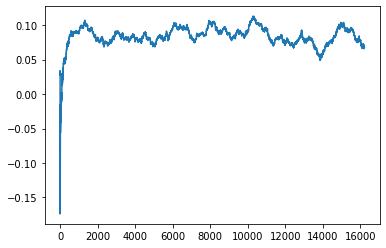

Thread: 5 iteration: 2770
RAM mProject_36 FROM: 1664 --> 192 reward: -1.0
Thread: 4 iteration: 2692
RAM mBackground_36 FROM: 1600 --> 256 reward: -1.0
Thread: 3 iteration: 2722
RAM mDiffFit_167 FROM: 3008 --> 256 reward: 0.170377544921875
Thread: 4 iteration: 2693
RAM mProject_84 FROM: 704 --> 256 reward: -1.0
Thread: 1 iteration: 2637
RAM mProject_31 FROM: 1280 --> 256 reward: -1.0
Thread: 6 iteration: 2701
RAM mDiffFit_377 FROM: 1152 --> 256 reward: 0.19695309765625
Thread: 4 iteration: 2694
RAM mDiffFit_361 FROM: 1664 --> 256 reward: 0.18381247812499998
Thread: 1 iteration: 2638
RAM mDiffFit_131 FROM: 1984 --> 256 reward: 0.14555194843749997
Thread: 4 iteration: 2695
RAM mBackground_3 FROM: 1216 --> 256 reward: -1.0
Saving ...


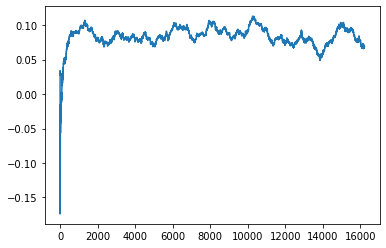

Thread: 2 iteration: 2690
RAM mDiffFit_325 FROM: 1280 --> 256 reward: 0.40316668125000005
Thread: 4 iteration: 2696
RAM mDiffFit_40 FROM: 1728 --> 256 reward: 0.15571871718749997
Thread: 4 iteration: 2697
RAM mProject_90 FROM: 1344 --> 256 reward: -1.0
Thread: 5 iteration: 2771
RAM mProject_64 FROM: 2688 --> 256 reward: -1.0
Thread: 6 iteration: 2702
RAM mDiffFit_335 FROM: 1984 --> 256 reward: 0.5024271234375
Thread: 5 iteration: 2772
RAM mDiffFit_412 FROM: 2112 --> 256 reward: 0.251559889453125
Thread: 6 iteration: 2703
RAM mProject_35 FROM: 2176 --> 256 reward: -1.0
Thread: 3 iteration: 2723
RAM mDiffFit_22 FROM: 2496 --> 256 reward: 0.159294226171875
Thread: 5 iteration: 2773
RAM mDiffFit_91 FROM: 2176 --> 256 reward: 0.07302070937499999
Thread: 6 iteration: 2704
RAM mDiffFit_103 FROM: 1216 --> 256 reward: 0.188986969140625
Thread: 5 iteration: 2774
RAM mProject_80 FROM: 1536 --> 256 reward: -1.0
Thread: 4 iteration: 2698
RAM mBackground_73 FROM: 2752 --> 256 reward: -1.0
Thread: 1 

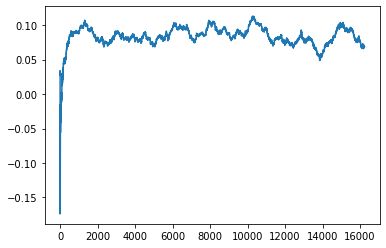

Thread: 1 iteration: 2640
RAM mDiffFit_133 FROM: 2560 --> 256 reward: 0.1475520359375
Thread: 1 iteration: 2641
RAM mBackground_5 FROM: 2048 --> 256 reward: -1.0
Thread: 2 iteration: 2691
RAM mProject_2 FROM: 448 --> 192 reward: -1.0
Thread: 3 iteration: 2724
RAM mDiffFit_135 FROM: 320 --> 256 reward: 0.039169269921875034
Thread: 2 iteration: 2692
RAM mDiffFit_67 FROM: 512 --> 256 reward: 0.1243229203125
Thread: 1 iteration: 2642
RAM mDiffFit_415 FROM: 2368 --> 256 reward: 0.05774464765625001
Thread: 2 iteration: 2693
RAM mDiffFit_279 FROM: 2752 --> 256 reward: 0.290200377734375
Thread: 1 iteration: 2643
RAM mDiffFit_40 FROM: 1664 --> 256 reward: 0.13681765546874997
Thread: 2 iteration: 2694
RAM mDiffFit_63 FROM: 1792 --> 256 reward: 0.17540623906249997
Thread: 1 iteration: 2644
RAM mDiffFit_319 FROM: 2752 --> 256 reward: 0.10498170429687502
Thread: 2 iteration: 2695
RAM mBackground_24 FROM: 1920 --> 320 reward: -1.0
Thread: 6 iteration: 2705
RAM mDiffFit_29 FROM: 256 --> 256 reward: -

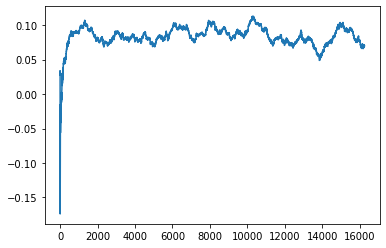

Thread: 4 iteration: 2700
RAM mDiffFit_396 FROM: 256 --> 256 reward: 0.19652088437499998
Thread: 2 iteration: 2697
RAM mDiffFit_222 FROM: 512 --> 256 reward: 0.12919792031250002
Thread: 5 iteration: 2776
RAM mDiffFit_235 FROM: 384 --> 256 reward: 0.025494778906250022
Thread: 6 iteration: 2708
RAM mDiffFit_255 FROM: 1280 --> 256 reward: 0.083395753125
Thread: 5 iteration: 2777
RAM mDiffFit_190 FROM: 2112 --> 256 reward: 0.4119687609375
Thread: 5 iteration: 2778
RAM mProject_26 FROM: 2752 --> 256 reward: -1.0
Thread: 1 iteration: 2647
RAM mDiffFit_18 FROM: 2944 --> 256 reward: 0.06454155000000002
Thread: 5 iteration: 2779
RAM mDiffFit_85 FROM: 1280 --> 256 reward: 0.1361666375
Thread: 1 iteration: 2648
RAM mDiffFit_260 FROM: 1664 --> 256 reward: 0.1958853984375
Saving ...


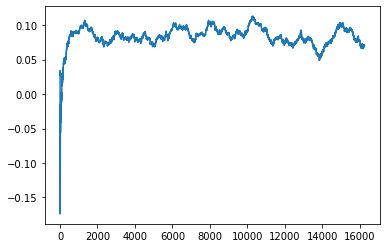

Thread: 5 iteration: 2780
RAM mDiffFit_304 FROM: 384 --> 256 reward: -0.11826048593749999
Thread: 1 iteration: 2649
RAM mDiffFit_203 FROM: 1088 --> 256 reward: 0.09318484570312502
Thread: 5 iteration: 2781
RAM mDiffFit_420 FROM: 1664 --> 256 reward: 0.10322389453125
Saving ...


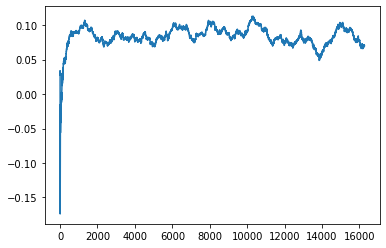

Thread: 1 iteration: 2650
RAM mImgtbl_2 FROM: 1344 --> 256 reward: -1.0
Thread: 4 iteration: 2701
RAM mBackground_9 FROM: 2816 --> 256 reward: -1.0
Thread: 3 iteration: 2726
RAM mDiffFit_308 FROM: 1280 --> 256 reward: 0.012531151562500016
Thread: 5 iteration: 2782
RAM mBackground_24 FROM: 1408 --> 256 reward: -1.0
Thread: 2 iteration: 2698
RAM mBackground_88 FROM: 1792 --> 256 reward: -1.0
Thread: 6 iteration: 2709
RAM mDiffFit_310 FROM: 384 --> 320 reward: 0.023882809765625006
Thread: 4 iteration: 2702
RAM mDiffFit_51 FROM: 1408 --> 256 reward: 0.10346349609375002
Thread: 3 iteration: 2727
RAM mDiffFit_340 FROM: 2368 --> 320 reward: 0.16577601796874997
Thread: 5 iteration: 2783
RAM mDiffFit_175 FROM: 1280 --> 256 reward: 0.33769787656250005
Thread: 2 iteration: 2699
RAM mDiffFit_341 FROM: 2752 --> 256 reward: 0.1306769921875
Saving ...


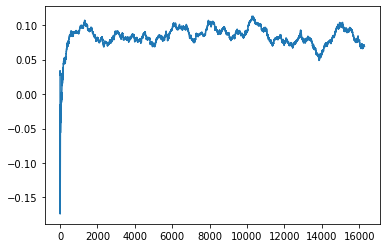

Thread: 6 iteration: 2710
RAM mDiffFit_28 FROM: 2240 --> 320 reward: 0.235903650390625
Thread: 3 iteration: 2728
RAM mDiffFit_26 FROM: 1024 --> 256 reward: 0.13781247812499997
Thread: 6 iteration: 2711
RAM mDiffFit_334 FROM: 1728 --> 256 reward: 0.15009371718749998
Thread: 3 iteration: 2729
RAM mProject_32 FROM: 256 --> 256 reward: -1.0
Thread: 1 iteration: 2651
RAM mDiffFit_258 FROM: 1536 --> 320 reward: 0.16314584062499998
Saving ...


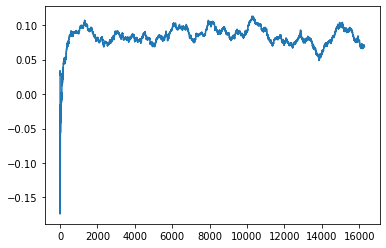

Thread: 3 iteration: 2730
RAM mDiffFit_390 FROM: 256 --> 256 reward: -0.0012500000000000011
Thread: 1 iteration: 2652
RAM mDiffFit_386 FROM: 2112 --> 256 reward: 0.25255988945312496
Thread: 3 iteration: 2731
RAM mProject_46 FROM: 2240 --> 256 reward: -1.0
Thread: 4 iteration: 2703
RAM mImgtbl_2 FROM: 1280 --> 256 reward: -1.0
Saving ...


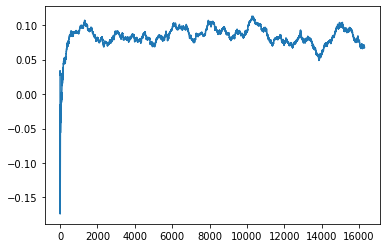

Thread: 2 iteration: 2700
RAM mDiffFit_292 FROM: 2496 --> 256 reward: 0.237481748046875
Thread: 2 iteration: 2701
RAM mDiffFit_90 FROM: 2624 --> 256 reward: 0.16096867343749993
Thread: 2 iteration: 2702
RAM mBackground_50 FROM: 1536 --> 256 reward: -1.0
Thread: 5 iteration: 2784
RAM mDiffFit_333 FROM: 2624 --> 256 reward: 0.33400780976562505
Thread: 5 iteration: 2785
RAM mProject_43 FROM: 2944 --> 256 reward: -1.0
Thread: 3 iteration: 2732
RAM mDiffFit_32 FROM: 2752 --> 256 reward: 0.15789838554687502
Thread: 5 iteration: 2786
RAM mDiffFit_187 FROM: 3008 --> 192 reward: 0.547625
Thread: 3 iteration: 2733
RAM mImgtbl_3 FROM: 1856 --> 256 reward: -1.0
Thread: 6 iteration: 2712
RAM mDiffFit_38 FROM: 192 --> 192 reward: 0.12630471210937508
Thread: 3 iteration: 2734
RAM mBackground_1 FROM: 192 --> 256 reward: -1.0
Thread: 1 iteration: 2653
RAM mDiffFit_234 FROM: 1856 --> 256 reward: 0.18066404882812498
Thread: 1 iteration: 2654
RAM mBackground_88 FROM: 1152 --> 256 reward: -1.0
Thread: 4 it

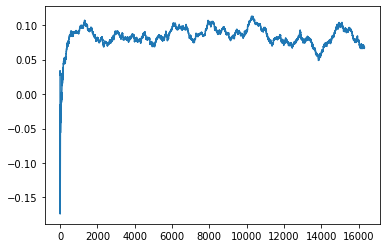

Thread: 5 iteration: 2790
RAM mDiffFit_143 FROM: 1408 --> 256 reward: 0.017239470312500026
Thread: 6 iteration: 2715
RAM mDiffFit_63 FROM: 320 --> 256 reward: -0.010166681249999983
Thread: 1 iteration: 2657
RAM mDiffFit_203 FROM: 1664 --> 256 reward: 0.17598955781250003
Thread: 4 iteration: 2709
RAM mDiffFit_380 FROM: 2240 --> 256 reward: 0.12943743437499997
Thread: 3 iteration: 2737
RAM mDiffFit_4 FROM: 896 --> 256 reward: 0.16134376093749997
Thread: 6 iteration: 2716
RAM mDiffFit_376 FROM: 832 --> 256 reward: 0.10664320820312498
Thread: 1 iteration: 2658
RAM mDiffFit_354 FROM: 320 --> 320 reward: 0.04896095117187499
Saving ...


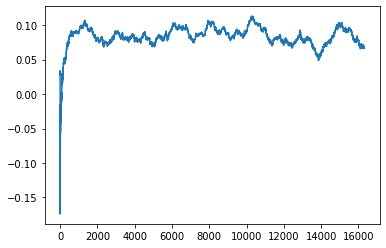

Thread: 4 iteration: 2710
RAM mDiffFit_208 FROM: 1088 --> 256 reward: 0.120679668359375
Thread: 6 iteration: 2717
RAM mDiffFit_362 FROM: 2176 --> 192 reward: 0.17610670429687503
Thread: 1 iteration: 2659
RAM mDiffFit_280 FROM: 1664 --> 256 reward: 0.13127079687499998
Thread: 6 iteration: 2718
RAM mBackground_74 FROM: 1792 --> 320 reward: -1.0
Thread: 2 iteration: 2705
RAM mDiffFit_343 FROM: 1536 --> 256 reward: 0.16467707968749998
Thread: 2 iteration: 2706
RAM mProject_88 FROM: 1664 --> 256 reward: -1.0
Thread: 3 iteration: 2738
RAM mDiffFit_85 FROM: 2688 --> 320 reward: 0.067184801953125
Thread: 2 iteration: 2707
RAM mDiffFit_112 FROM: 2944 --> 256 reward: 0.24943225703125002
Thread: 3 iteration: 2739
RAM mBackground_22 FROM: 2432 --> 256 reward: -1.0
Thread: 5 iteration: 2791
RAM mDiffFit_81 FROM: 1728 --> 256 reward: 0.261085951171875
Thread: 5 iteration: 2792
RAM mProject_30 FROM: 448 --> 256 reward: -1.0
Saving ...


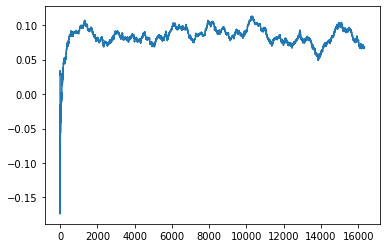

Thread: 1 iteration: 2660
RAM mDiffFit_246 FROM: 2176 --> 256 reward: 0.21282287656250004
Thread: 1 iteration: 2661
RAM mDiffFit_59 FROM: 2112 --> 320 reward: 0.29692181484374996
Thread: 5 iteration: 2793
RAM mProject_1 FROM: 2880 --> 256 reward: -1.0
Thread: 6 iteration: 2719
RAM mDiffFit_271 FROM: 1664 --> 256 reward: 0.23990623906250003
Thread: 5 iteration: 2794
RAM mProject_8 FROM: 1216 --> 256 reward: -1.0
Saving ...


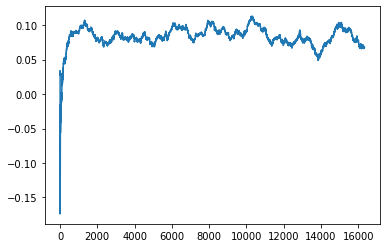

Thread: 3 iteration: 2740
RAM mDiffFit_302 FROM: 2240 --> 256 reward: 0.42710670429687503
Thread: 5 iteration: 2795
RAM mImgtbl_1 FROM: 1856 --> 256 reward: -1.0
Thread: 4 iteration: 2711
RAM mDiffFit_329 FROM: 960 --> 256 reward: 0.139481748046875
Thread: 3 iteration: 2741
RAM mDiffFit_18 FROM: 192 --> 256 reward: -0.04383853984375002
Thread: 4 iteration: 2712
RAM mDiffFit_34 FROM: 2432 --> 256 reward: 0.43710411562499996
Thread: 3 iteration: 2742
RAM mBackground_71 FROM: 192 --> 256 reward: -1.0
Thread: 2 iteration: 2708
RAM mDiffFit_194 FROM: 256 --> 320 reward: -0.084763030859375
Thread: 3 iteration: 2743
RAM mProject_28 FROM: 320 --> 256 reward: -1.0
Thread: 1 iteration: 2662
RAM mDiffFit_146 FROM: 2304 --> 256 reward: 0.20693747812500002
Thread: 3 iteration: 2744
RAM mDiffFit_59 FROM: 1472 --> 256 reward: 0.343512943359375
Thread: 1 iteration: 2663
RAM mProject_40 FROM: 640 --> 192 reward: -1.0
Thread: 5 iteration: 2796
RAM mDiffFit_2 FROM: 1472 --> 320 reward: 0.226023385546875


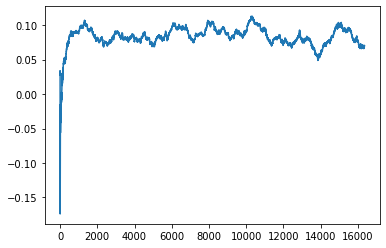

Thread: 6 iteration: 2720
RAM mProject_71 FROM: 2688 --> 192 reward: -1.0
Thread: 2 iteration: 2709
RAM mDiffFit_123 FROM: 2560 --> 256 reward: 0.07240615156249999
Thread: 5 iteration: 2798
RAM mDiffFit_393 FROM: 1920 --> 320 reward: 0.10871349609374999
Saving ...


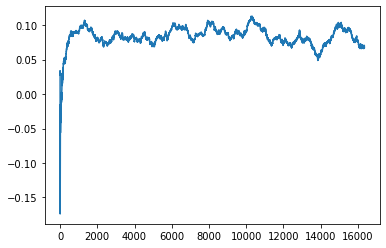

Thread: 2 iteration: 2710
RAM mProject_28 FROM: 1280 --> 256 reward: -1.0
Thread: 3 iteration: 2745
RAM mDiffFit_75 FROM: 1856 --> 256 reward: 0.19709630585937502
Thread: 2 iteration: 2711
RAM mProject_25 FROM: 320 --> 256 reward: -1.0
Thread: 1 iteration: 2664
RAM mBackground_38 FROM: 1152 --> 256 reward: -1.0
Thread: 4 iteration: 2713
RAM mDiffFit_98 FROM: 1408 --> 256 reward: 0.13818747812499999
Thread: 3 iteration: 2746
RAM mDiffFit_166 FROM: 128 --> 256 reward: -0.5200885835937501
Thread: 3 iteration: 2747
RAM mDiffFit_47 FROM: 640 --> 256 reward: 0.31006774296874995
Thread: 1 iteration: 2665
RAM mDiffFit_98 FROM: 3008 --> 256 reward: 0.023025842968750036
Thread: 2 iteration: 2712
RAM mProject_1 FROM: 128 --> 192 reward: -1.0
Thread: 6 iteration: 2721
RAM mProject_38 FROM: 768 --> 320 reward: -1.0
Thread: 5 iteration: 2799
RAM mDiffFit_335 FROM: 1472 --> 320 reward: 0.094070287890625
Thread: 1 iteration: 2666
RAM mDiffFit_191 FROM: 1408 --> 256 reward: 0.13373433671874996
Thread: 

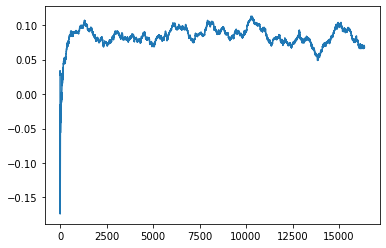

Thread: 5 iteration: 2800
RAM mDiffFit_256 FROM: 384 --> 256 reward: 0.11202084062500003
Thread: 1 iteration: 2667
RAM mProject_25 FROM: 1664 --> 192 reward: -1.0
Thread: 4 iteration: 2714
RAM mDiffFit_242 FROM: 896 --> 192 reward: 0.612200596484375
Thread: 3 iteration: 2749
RAM mDiffFit_417 FROM: 2048 --> 256 reward: 0.123583275
Thread: 5 iteration: 2801
RAM mDiffFit_83 FROM: 2752 --> 256 reward: 0.12130462460937504
Thread: 1 iteration: 2668
RAM mDiffFit_265 FROM: 1664 --> 320 reward: 0.138062478125
Saving ...


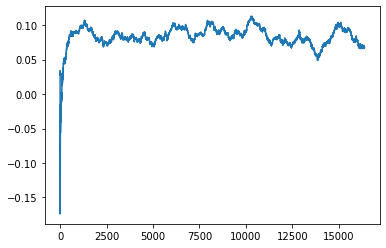

Thread: 3 iteration: 2750
RAM mDiffFit_113 FROM: 1408 --> 256 reward: 0.35544269921874994
Thread: 1 iteration: 2669
RAM mProject_82 FROM: 1664 --> 256 reward: -1.0
Thread: 2 iteration: 2714
RAM mProject_90 FROM: 1792 --> 256 reward: -1.0
Thread: 6 iteration: 2723
RAM mDiffFit_216 FROM: 1792 --> 320 reward: 0.07142703593750001
Thread: 6 iteration: 2724
RAM mDiffFit_12 FROM: 1280 --> 256 reward: 0.2657396015625
Thread: 6 iteration: 2725
RAM mDiffFit_328 FROM: 1664 --> 256 reward: 0.29478115156249995
Thread: 2 iteration: 2715
RAM mProject_43 FROM: 2048 --> 256 reward: -1.0
Thread: 4 iteration: 2715
RAM mDiffFit_219 FROM: 704 --> 192 reward: 0.19072915937499996
Thread: 6 iteration: 2726
RAM mDiffFit_83 FROM: 576 --> 320 reward: 0.12795314140625003
Thread: 4 iteration: 2716
RAM mDiffFit_329 FROM: 896 --> 256 reward: 0.16416146015625
Thread: 2 iteration: 2716
RAM mDiffFit_49 FROM: 3008 --> 256 reward: 0.136559758203125
Thread: 6 iteration: 2727
RAM mBackground_48 FROM: 1664 --> 256 reward: -

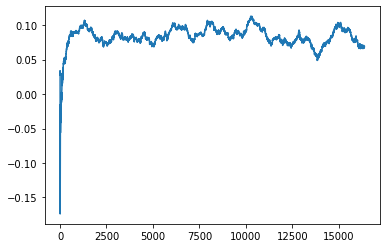

Thread: 1 iteration: 2670
RAM mDiffFit_68 FROM: 2944 --> 256 reward: 0.17844265546875002
Thread: 6 iteration: 2728
RAM mDiffFit_206 FROM: 1856 --> 256 reward: 0.14387495625
Thread: 5 iteration: 2803
RAM mDiffFit_28 FROM: 2368 --> 256 reward: 0.10689575312500002
Thread: 3 iteration: 2752
RAM mDiffFit_403 FROM: 1088 --> 256 reward: 0.1770729203125
Thread: 6 iteration: 2729
RAM mDiffFit_248 FROM: 1920 --> 256 reward: 0.3779687609375
Thread: 5 iteration: 2804
RAM mDiffFit_23 FROM: 2944 --> 256 reward: 0.11588531093749999
Thread: 3 iteration: 2753
RAM mDiffFit_59 FROM: 192 --> 256 reward: -0.13272915937499996
Thread: 1 iteration: 2671
RAM mAdd_2 FROM: 1088 --> 256 reward: -1.0
Thread: 4 iteration: 2717
RAM mDiffFit_44 FROM: 512 --> 256 reward: -0.05072924687500001
Saving ...


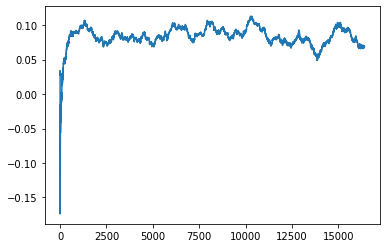

Thread: 6 iteration: 2730
RAM mDiffFit_269 FROM: 896 --> 256 reward: 0.163354159375
Thread: 5 iteration: 2805
RAM mProject_26 FROM: 1152 --> 256 reward: -1.0
Thread: 2 iteration: 2718
RAM mDiffFit_17 FROM: 1088 --> 256 reward: 0.16274999999999998
Thread: 6 iteration: 2731
RAM mDiffFit_47 FROM: 2304 --> 256 reward: 0.2644687171875
Thread: 5 iteration: 2806
RAM mDiffFit_17 FROM: 960 --> 256 reward: 0.139111969140625
Thread: 6 iteration: 2732
RAM mDiffFit_92 FROM: 512 --> 256 reward: 0.014885354687499998
Thread: 2 iteration: 2719
RAM mDiffFit_238 FROM: 2304 --> 256 reward: 0.14731243437499997
Thread: 5 iteration: 2807
RAM mDiffFit_210 FROM: 1984 --> 256 reward: 0.180929668359375
Thread: 5 iteration: 2808
RAM mProject_1 FROM: 1280 --> 256 reward: -1.0
Thread: 3 iteration: 2754
RAM mProject_11 FROM: 384 --> 256 reward: -1.0
Thread: 4 iteration: 2718
RAM mDiffFit_394 FROM: 2880 --> 256 reward: 0.07047648320312502
Thread: 5 iteration: 2809
RAM mDiffFit_301 FROM: 832 --> 256 reward: 0.10892185

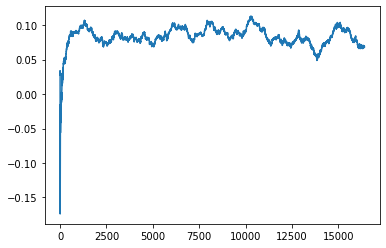

Thread: 5 iteration: 2810
RAM mDiffFit_369 FROM: 3008 --> 256 reward: 0.142606704296875
Thread: 3 iteration: 2756
RAM mBackground_63 FROM: 1216 --> 256 reward: -1.0
Thread: 1 iteration: 2672
RAM mDiffFit_238 FROM: 512 --> 256 reward: 0.06530203593750006
Thread: 5 iteration: 2811
RAM mProject_12 FROM: 1536 --> 256 reward: -1.0
Thread: 6 iteration: 2733
RAM mDiffFit_17 FROM: 256 --> 320 reward: -0.033463539843750015
Thread: 1 iteration: 2673
RAM mDiffFit_248 FROM: 2624 --> 256 reward: 0.10380199218749998
Thread: 5 iteration: 2812
RAM mBackground_10 FROM: 1408 --> 256 reward: -1.0
Saving ...


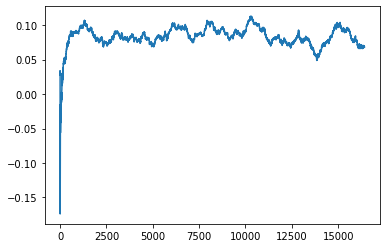

Thread: 2 iteration: 2720
RAM mBackground_37 FROM: 448 --> 320 reward: -1.0
Saving ...


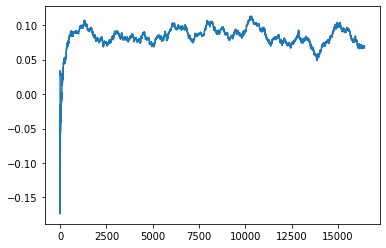

Thread: 4 iteration: 2720
RAM mProject_66 FROM: 1152 --> 256 reward: -1.0
Thread: 1 iteration: 2674
RAM mProject_17 FROM: 256 --> 256 reward: -1.0
Thread: 5 iteration: 2813
RAM mDiffFit_138 FROM: 128 --> 256 reward: -0.9568282289062501
Thread: 1 iteration: 2675
RAM mBackground_73 FROM: 1536 --> 256 reward: -1.0
Thread: 3 iteration: 2757
RAM mBackground_62 FROM: 1984 --> 256 reward: -1.0
Thread: 6 iteration: 2734
RAM mDiffFit_187 FROM: 192 --> 256 reward: 0.014283871484374981
Thread: 6 iteration: 2735
RAM mBackground_37 FROM: 576 --> 256 reward: -1.0
Thread: 2 iteration: 2721
RAM mDiffFit_218 FROM: 2304 --> 256 reward: 0.13469787656249999
Thread: 2 iteration: 2722
RAM mBackground_45 FROM: 2624 --> 256 reward: -1.0
Thread: 4 iteration: 2721
RAM mProject_81 FROM: 2176 --> 256 reward: -1.0
Thread: 5 iteration: 2814
RAM mBackground_61 FROM: 1984 --> 256 reward: -1.0
Thread: 1 iteration: 2676
RAM mBackground_90 FROM: 3008 --> 256 reward: -1.0
Thread: 3 iteration: 2758
RAM mDiffFit_71 FROM: 1

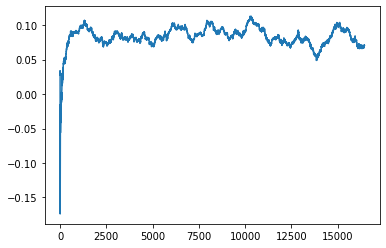

Thread: 3 iteration: 2760
RAM mDiffFit_50 FROM: 1216 --> 192 reward: 0.7062370128906249
Thread: 6 iteration: 2737
RAM mDiffFit_161 FROM: 832 --> 320 reward: 0.1600104421875
Thread: 6 iteration: 2738
RAM mDiffFit_4 FROM: 2048 --> 256 reward: -0.229937915625
Thread: 3 iteration: 2761
RAM mDiffFit_354 FROM: 2688 --> 256 reward: 0.12030199218749998
Thread: 6 iteration: 2739
RAM mDiffFit_398 FROM: 2880 --> 256 reward: 0.16242699218749995
Thread: 3 iteration: 2762
RAM mDiffFit_220 FROM: 768 --> 256 reward: 0.12894792031250002
Saving ...


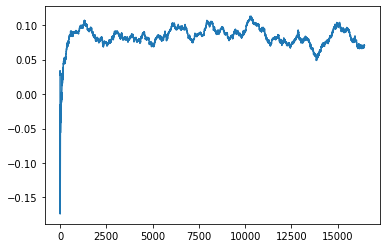

Thread: 6 iteration: 2740
RAM mProject_88 FROM: 1408 --> 256 reward: -1.0
Thread: 4 iteration: 2723
RAM mDiffFit_124 FROM: 1088 --> 256 reward: 0.14307809765624996
Thread: 3 iteration: 2763
RAM mDiffFit_101 FROM: 128 --> 256 reward: -0.44874482265624993
Thread: 6 iteration: 2741
RAM mDiffFit_126 FROM: 2112 --> 256 reward: 0.47445568632812507
Thread: 3 iteration: 2764
RAM mDiffFit_399 FROM: 2368 --> 256 reward: 0.20060411562499997
Thread: 3 iteration: 2765
RAM mBackground_81 FROM: 1280 --> 256 reward: -1.0
Thread: 2 iteration: 2724
RAM mBackground_19 FROM: 960 --> 256 reward: -1.0
Thread: 1 iteration: 2678
RAM mDiffFit_27 FROM: 1088 --> 256 reward: 0.4616563265625
Thread: 3 iteration: 2766
RAM mDiffFit_388 FROM: 384 --> 320 reward: 0.08120314140625004
Thread: 2 iteration: 2725
RAM mDiffFit_377 FROM: 2368 --> 256 reward: 0.18042444726562495
Thread: 1 iteration: 2679
RAM mBackground_76 FROM: 2112 --> 256 reward: -1.0
Thread: 5 iteration: 2817
RAM mProject_77 FROM: 2240 --> 320 reward: -1.

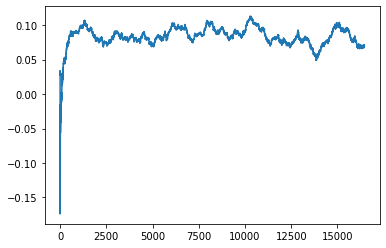

Thread: 1 iteration: 2680
RAM mDiffFit_173 FROM: 256 --> 256 reward: -0.019322920312500012
Thread: 4 iteration: 2725
RAM mDiffFit_221 FROM: 1088 --> 320 reward: 0.16377601796875
Thread: 3 iteration: 2768
RAM mDiffFit_327 FROM: 3008 --> 256 reward: 0.11501031093749997
Thread: 1 iteration: 2681
RAM mDiffFit_364 FROM: 192 --> 256 reward: -0.012825508984374984
Thread: 4 iteration: 2726
RAM mDiffFit_40 FROM: 2176 --> 320 reward: 0.16478641640625002
Thread: 3 iteration: 2769
RAM mDiffFit_358 FROM: 1216 --> 320 reward: 0.29764061953124993
Thread: 1 iteration: 2682
RAM mBackground_23 FROM: 576 --> 256 reward: -1.0
Thread: 6 iteration: 2742
RAM mDiffFit_103 FROM: 1280 --> 256 reward: 0.1665937171875
Thread: 4 iteration: 2727
RAM mDiffFit_86 FROM: 1024 --> 256 reward: 0.16604168125
Saving ...


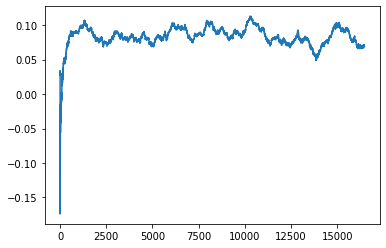

Thread: 3 iteration: 2770
RAM mDiffFit_116 FROM: 1664 --> 320 reward: 0.17228641640625
Thread: 1 iteration: 2683
RAM mDiffFit_133 FROM: 3008 --> 256 reward: 0.09261447031250002
Thread: 6 iteration: 2743
RAM mDiffFit_63 FROM: 704 --> 320 reward: 0.09013539843750001
Thread: 4 iteration: 2728
RAM mDiffFit_350 FROM: 256 --> 320 reward: -0.031177079687499977
Thread: 3 iteration: 2771
RAM mDiffFit_250 FROM: 576 --> 320 reward: 0.052635398437499994
Thread: 6 iteration: 2744
RAM mDiffFit_415 FROM: 2432 --> 256 reward: 0.13239057578125002
Thread: 4 iteration: 2729
RAM mBackground_56 FROM: 1600 --> 256 reward: -1.0
Thread: 5 iteration: 2818
RAM mBackground_31 FROM: 2560 --> 256 reward: -1.0
Thread: 2 iteration: 2726
RAM mDiffFit_329 FROM: 2496 --> 256 reward: 0.1318436734375
Thread: 6 iteration: 2745
RAM mDiffFit_339 FROM: 896 --> 256 reward: 0.09063017734375
Thread: 5 iteration: 2819
RAM mDiffFit_314 FROM: 1984 --> 320 reward: 0.19588280976562505
Thread: 2 iteration: 2727
RAM mProject_55 FROM: 

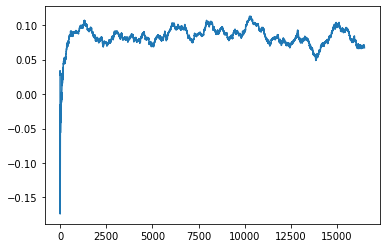

Thread: 5 iteration: 2820
RAM mDiffFit_346 FROM: 512 --> 256 reward: 0.21755207968749998
Thread: 6 iteration: 2746
RAM mDiffFit_272 FROM: 2944 --> 256 reward: 0.17036973515624998
Thread: 1 iteration: 2685
RAM mDiffFit_44 FROM: 768 --> 192 reward: 0.27264057578125006
Thread: 6 iteration: 2747
RAM mDiffFit_44 FROM: 576 --> 320 reward: -0.06947143710937503
Thread: 1 iteration: 2686
RAM mDiffFit_255 FROM: 1536 --> 256 reward: 0.116604115625
Thread: 6 iteration: 2748
RAM mProject_36 FROM: 1472 --> 256 reward: -1.0
Saving ...


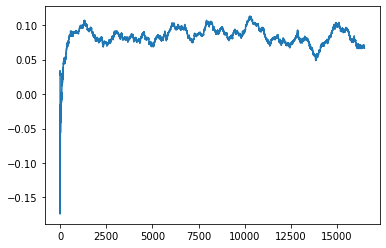

Thread: 4 iteration: 2730
RAM mDiffFit_199 FROM: 768 --> 256 reward: 0.0779895578125
Thread: 1 iteration: 2687
RAM mBackground_58 FROM: 448 --> 320 reward: -1.0
Thread: 3 iteration: 2772
RAM mDiffFit_315 FROM: 1984 --> 320 reward: 0.18003382773437504
Thread: 6 iteration: 2749
RAM mDiffFit_342 FROM: 1088 --> 256 reward: 0.11155725703125
Thread: 1 iteration: 2688
RAM mDiffFit_370 FROM: 832 --> 1088 reward: 0.09442716718750002
Thread: 3 iteration: 2773
RAM mDiffFit_133 FROM: 1472 --> 320 reward: 0.07896612851562498
Saving ...


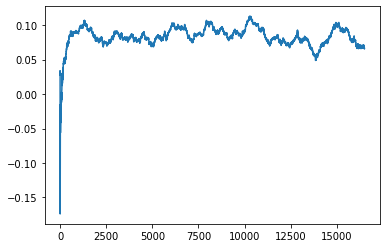

Thread: 6 iteration: 2750
RAM mDiffFit_51 FROM: 1536 --> 256 reward: 0.028510310937499977
Thread: 1 iteration: 2689
RAM mDiffFit_240 FROM: 1600 --> 256 reward: 0.11902079687500003
Thread: 3 iteration: 2774
RAM mBackground_16 FROM: 192 --> 256 reward: -1.0
Thread: 2 iteration: 2728
RAM mDiffFit_168 FROM: 1024 --> 256 reward: 0.1510103984375
Thread: 6 iteration: 2751
RAM mDiffFit_94 FROM: 1472 --> 256 reward: 0.2701092929687499
Saving ...


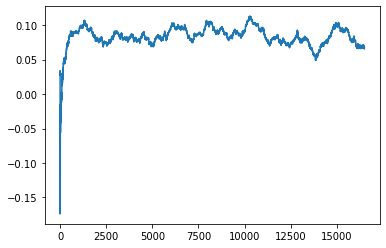

Thread: 1 iteration: 2690
RAM mDiffFit_120 FROM: 576 --> 320 reward: 0.07741146015625
Thread: 6 iteration: 2752
RAM mDiffFit_238 FROM: 832 --> 256 reward: 0.15561719023437498
Thread: 2 iteration: 2729
RAM mBackground_51 FROM: 2240 --> 256 reward: -1.0
Thread: 5 iteration: 2821
RAM mProject_39 FROM: 256 --> 256 reward: -1.0
Thread: 4 iteration: 2731
RAM mDiffFit_157 FROM: 1920 --> 256 reward: 0.17084893828124997
Thread: 6 iteration: 2753
RAM mDiffFit_250 FROM: 1600 --> 256 reward: 0.17481247812499995
Saving ...


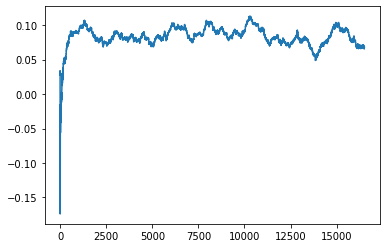

Thread: 2 iteration: 2730
RAM mDiffFit_400 FROM: 2112 --> 256 reward: 0.26873955781250003
Thread: 4 iteration: 2732
RAM mDiffFit_279 FROM: 192 --> 256 reward: -0.3861693136718751
Thread: 5 iteration: 2822
RAM mDiffFit_366 FROM: 1536 --> 256 reward: 0.1320936734375
Thread: 6 iteration: 2754
RAM mProject_90 FROM: 2048 --> 256 reward: -1.0
Thread: 3 iteration: 2775
RAM mDiffFit_96 FROM: 640 --> 256 reward: 0.13658331875
Thread: 2 iteration: 2731
RAM mDiffFit_211 FROM: 768 --> 256 reward: 0.22766668125000003
Thread: 4 iteration: 2733
RAM mProject_23 FROM: 1664 --> 320 reward: -1.0
Thread: 1 iteration: 2691
RAM mDiffFit_178 FROM: 1024 --> 256 reward: 0.12634371718749998
Thread: 3 iteration: 2776
RAM mDiffFit_35 FROM: 128 --> 320 reward: -0.5958594242187499
Thread: 1 iteration: 2692
RAM mBgModel_2 FROM: 320 --> 192 reward: -0.5313564578125001
Thread: 4 iteration: 2734
RAM mDiffFit_147 FROM: 256 --> 320 reward: -0.16465887148437502
Thread: 3 iteration: 2777
RAM mDiffFit_177 FROM: 1792 --> 192

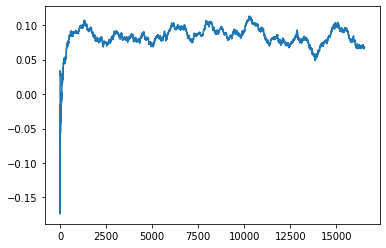

Thread: 3 iteration: 2780
RAM mDiffFit_382 FROM: 2240 --> 256 reward: 0.29120042148437497
Thread: 5 iteration: 2825
RAM mDiffFit_373 FROM: 2112 --> 256 reward: 0.11318743437500002
Thread: 5 iteration: 2826
RAM mDiffFit_220 FROM: 1920 --> 256 reward: 0.31540106171875
Thread: 3 iteration: 2781
RAM mDiffFit_102 FROM: 128 --> 192 reward: -0.75463026484375
Thread: 4 iteration: 2739
RAM mProject_12 FROM: 1024 --> 192 reward: -1.0
Thread: 2 iteration: 2733
RAM mDiffFit_242 FROM: 1984 --> 256 reward: 0.129729115625
Thread: 3 iteration: 2782
RAM mDiffFit_119 FROM: 1216 --> 256 reward: 0.22988280976562497
Thread: 2 iteration: 2734
RAM mBackground_34 FROM: 2752 --> 256 reward: -1.0
Thread: 6 iteration: 2755
RAM mProject_81 FROM: 896 --> 256 reward: -1.0
Thread: 5 iteration: 2827
RAM mProject_74 FROM: 2112 --> 256 reward: -1.0
Saving ...


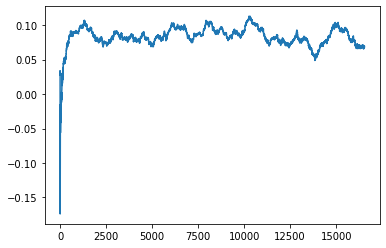

Thread: 4 iteration: 2740
RAM mProject_59 FROM: 2688 --> 1088 reward: 0.034692331570312464
Thread: 2 iteration: 2735
RAM mDiffFit_104 FROM: 960 --> 320 reward: 0.12919269921874998
Thread: 5 iteration: 2828
RAM mDiffFit_53 FROM: 1536 --> 320 reward: 0.03758845234374999
Thread: 4 iteration: 2741
RAM mProject_40 FROM: 960 --> 320 reward: -1.0
Thread: 3 iteration: 2783
RAM mDiffFit_257 FROM: 1664 --> 1984 reward: 0.057841216015625
Thread: 2 iteration: 2736
RAM mDiffFit_286 FROM: 128 --> 320 reward: -0.674476614453125
Thread: 4 iteration: 2742
RAM mDiffFit_225 FROM: 2624 --> 256 reward: 0.225958275
Thread: 3 iteration: 2784
RAM mAdd_3 FROM: 1152 --> 256 reward: -1.0
Thread: 1 iteration: 2696
RAM mProject_65 FROM: 832 --> 256 reward: -1.0
Thread: 6 iteration: 2756
RAM mDiffFit_217 FROM: 1664 --> 256 reward: 0.14646871718749999
Thread: 2 iteration: 2737
RAM mDiffFit_288 FROM: 1536 --> 320 reward: 0.036059801953125005
Thread: 1 iteration: 2697
RAM mDiffFit_396 FROM: 1984 --> 256 reward: 0.3845

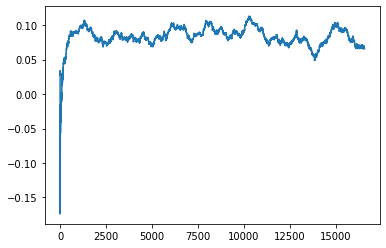

Thread: 1 iteration: 2700
RAM mBackground_33 FROM: 2560 --> 1984 reward: -1.0
Saving ...


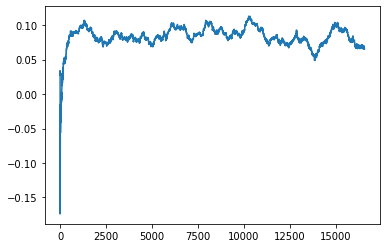

Thread: 5 iteration: 2830
RAM mDiffFit_323 FROM: 832 --> 320 reward: 0.29577084062500003
Thread: 1 iteration: 2701
RAM mDiffFit_39 FROM: 1024 --> 320 reward: 0.137252588671875
Thread: 1 iteration: 2702
RAM mBackground_86 FROM: 960 --> 320 reward: -1.0
Thread: 4 iteration: 2744
RAM mDiffFit_358 FROM: 640 --> 192 reward: 0.25711977890625
Thread: 1 iteration: 2703
RAM mDiffFit_85 FROM: 896 --> 320 reward: 0.07426298710937498
Thread: 4 iteration: 2745
RAM mBackground_26 FROM: 2752 --> 256 reward: -1.0
Thread: 3 iteration: 2787
RAM mDiffFit_350 FROM: 512 --> 320 reward: 0.114976570703125
Thread: 4 iteration: 2746
RAM mDiffFit_394 FROM: 2816 --> 320 reward: 0.08606761171874999
Thread: 3 iteration: 2788
RAM mDiffFit_199 FROM: 2112 --> 320 reward: 0.3567604421875
Thread: 4 iteration: 2747
RAM mProject_26 FROM: 704 --> 320 reward: -1.0
Thread: 5 iteration: 2831
RAM mBackground_57 FROM: 832 --> 256 reward: -1.0
Thread: 2 iteration: 2739
RAM mDiffFit_374 FROM: 2112 --> 256 reward: 0.1432994472656

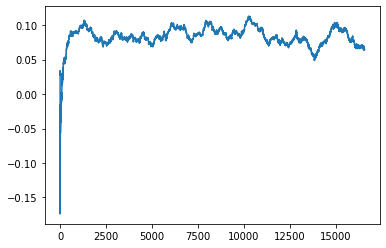

Thread: 3 iteration: 2790
RAM mDiffFit_62 FROM: 2432 --> 256 reward: 0.07657801015625
Thread: 3 iteration: 2791
RAM mBackground_5 FROM: 1344 --> 320 reward: -1.0
Thread: 6 iteration: 2759
RAM mProject_54 FROM: 576 --> 320 reward: -1.0
Thread: 4 iteration: 2749
RAM mProject_77 FROM: 896 --> 320 reward: -1.0
Saving ...


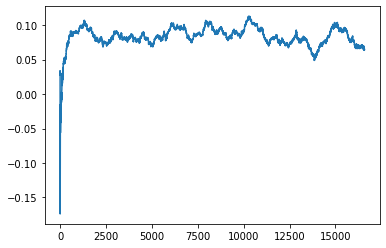

Thread: 2 iteration: 2740
RAM mDiffFit_80 FROM: 1920 --> 320 reward: 0.16231769921875
Saving ...


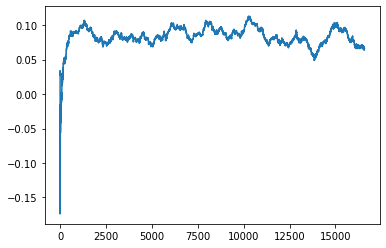

Thread: 4 iteration: 2750
RAM mDiffFit_67 FROM: 2176 --> 256 reward: 0.15888017734374996
Thread: 2 iteration: 2741
RAM mBackground_26 FROM: 1536 --> 320 reward: -1.0
Thread: 5 iteration: 2832
RAM mDiffFit_11 FROM: 1920 --> 1408 reward: 0.09606778671874999
Thread: 4 iteration: 2751
RAM mDiffFit_66 FROM: 1600 --> 320 reward: 0.11145309765624997
Thread: 2 iteration: 2742
RAM mDiffFit_353 FROM: 1344 --> 256 reward: 0.08137491250000001
Thread: 5 iteration: 2833
RAM mBackground_81 FROM: 192 --> 320 reward: -1.0
Thread: 1 iteration: 2705
RAM mDiffFit_102 FROM: 960 --> 256 reward: 0.31323955781249996
Thread: 4 iteration: 2752
RAM mDiffFit_129 FROM: 512 --> 320 reward: 0.012635398437500014
Thread: 4 iteration: 2753
RAM mDiffFit_217 FROM: 448 --> 256 reward: 0.21712504375
Thread: 4 iteration: 2754
RAM mBackground_37 FROM: 640 --> 256 reward: -1.0
Thread: 3 iteration: 2792
RAM mProject_12 FROM: 1920 --> 2624 reward: 0.12826478341406236
Thread: 2 iteration: 2743
RAM mDiffFit_138 FROM: 3008 --> 320

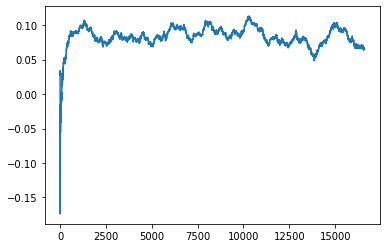

Thread: 6 iteration: 2760
RAM mDiffFit_149 FROM: 1344 --> 1984 reward: -0.046674491015624986
Thread: 2 iteration: 2745
RAM mDiffFit_198 FROM: 1024 --> 320 reward: 0.12987500000000002
Thread: 5 iteration: 2835
RAM mDiffFit_279 FROM: 576 --> 256 reward: 0.171174447265625
Thread: 3 iteration: 2795
RAM mBackground_11 FROM: 896 --> 320 reward: -1.0
Thread: 1 iteration: 2706
RAM mDiffFit_265 FROM: 2944 --> 256 reward: 0.13822389453124997
Thread: 6 iteration: 2761
RAM mDiffFit_6 FROM: 576 --> 320 reward: 0.07658853984374997
Thread: 2 iteration: 2746
RAM mDiffFit_141 FROM: 1856 --> 320 reward: 0.18720831875
Thread: 5 iteration: 2836
RAM mDiffFit_104 FROM: 1728 --> 320 reward: 0.12170831874999999
Thread: 6 iteration: 2762
RAM mConcatFit_3 FROM: 1408 --> 256 reward: 0.54955833625
Thread: 1 iteration: 2707
RAM mBackground_79 FROM: 1664 --> 320 reward: -1.0
Thread: 4 iteration: 2756
RAM mDiffFit_356 FROM: 1280 --> 192 reward: 0.2096145140625
Thread: 1 iteration: 2708
RAM mProject_7 FROM: 896 --> 3

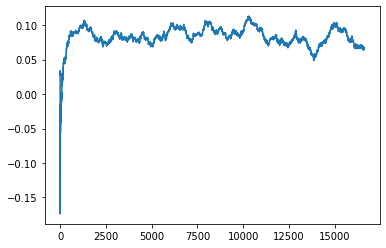

Thread: 5 iteration: 2840
RAM mBackground_46 FROM: 2560 --> 256 reward: -1.0
Thread: 2 iteration: 2747
RAM mImgtbl_2 FROM: 1984 --> 320 reward: 0.6549353459375001
Thread: 3 iteration: 2799
RAM mDiffFit_134 FROM: 192 --> 320 reward: -0.057429668359374984
Thread: 2 iteration: 2748
RAM mBackground_21 FROM: 2816 --> 192 reward: -1.0
Thread: 6 iteration: 2763
RAM mBackground_22 FROM: 3008 --> 320 reward: -1.0
Thread: 4 iteration: 2757
RAM mDiffFit_354 FROM: 768 --> 320 reward: -0.003099025781250035
Thread: 6 iteration: 2764
RAM mDiffFit_324 FROM: 2304 --> 320 reward: 0.174419226171875
Thread: 6 iteration: 2765
RAM mBackground_89 FROM: 320 --> 256 reward: -1.0
Saving ...


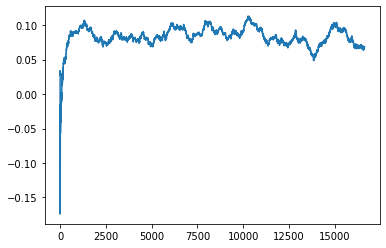

Thread: 1 iteration: 2710
RAM mDiffFit_418 FROM: 2432 --> 320 reward: 0.13010152695312502
Thread: 6 iteration: 2766
RAM mProject_33 FROM: 704 --> 320 reward: -1.0
Thread: 5 iteration: 2841
RAM mDiffFit_295 FROM: 640 --> 192 reward: 0.24577084062500004
Thread: 1 iteration: 2711
RAM mDiffFit_59 FROM: 2688 --> 320 reward: 0.27271081992187496
Thread: 6 iteration: 2767
RAM mDiffFit_38 FROM: 2880 --> 256 reward: 0.38094261171875005
Thread: 5 iteration: 2842
RAM mProject_3 FROM: 2496 --> 320 reward: -1.0
Saving ...


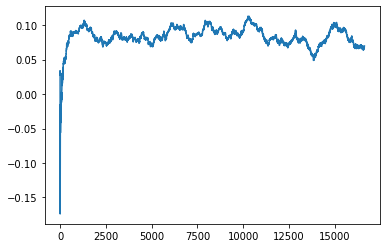

Thread: 3 iteration: 2800
RAM mProject_25 FROM: 2816 --> 192 reward: -1.0
Thread: 2 iteration: 2749
RAM mProject_74 FROM: 2688 --> 320 reward: -1.0
Thread: 4 iteration: 2758
RAM mDiffFit_228 FROM: 1088 --> 320 reward: 0.131377588671875
Thread: 1 iteration: 2712
RAM mDiffFit_48 FROM: 1600 --> 1984 reward: -0.062351614453125016
Thread: 3 iteration: 2801
RAM mDiffFit_63 FROM: 1472 --> 320 reward: 0.11502079687500001
Thread: 4 iteration: 2759
RAM mDiffFit_134 FROM: 576 --> 320 reward: 0.07546353984374997
Thread: 3 iteration: 2802
RAM mDiffFit_122 FROM: 2624 --> 1984 reward: -0.013421902343750012
Thread: 3 iteration: 2803
RAM mDiffFit_276 FROM: 1536 --> 320 reward: 0.1326353546875
Saving ...


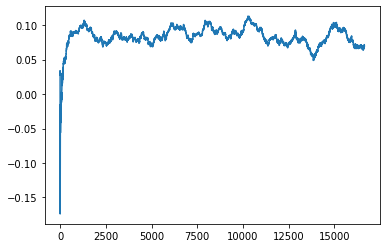

Thread: 4 iteration: 2760
RAM mDiffFit_77 FROM: 1024 --> 320 reward: 0.226033871484375
Thread: 3 iteration: 2804
RAM mProject_64 FROM: 2880 --> 320 reward: -1.0
Thread: 6 iteration: 2768
RAM mProject_42 FROM: 704 --> 320 reward: -1.0
Saving ...


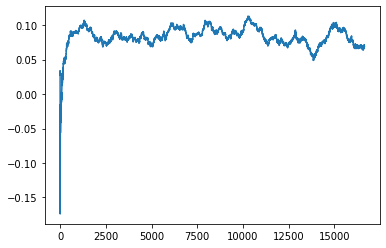

Thread: 2 iteration: 2750
RAM mDiffFit_321 FROM: 1920 --> 320 reward: 0.1218853984375
Thread: 2 iteration: 2751
RAM mBackground_25 FROM: 576 --> 1984 reward: -1.0
Thread: 4 iteration: 2761
RAM mBackground_90 FROM: 2880 --> 256 reward: -1.0
Thread: 5 iteration: 2843
RAM mBackground_59 FROM: 512 --> 320 reward: -1.0
Thread: 1 iteration: 2713
RAM mDiffFit_361 FROM: 1344 --> 320 reward: 0.094049447265625
Thread: 4 iteration: 2762
RAM mDiffFit_68 FROM: 2624 --> 192 reward: 0.19495564257812492
Thread: 4 iteration: 2763
RAM mProject_69 FROM: 896 --> 320 reward: -1.0
Thread: 6 iteration: 2769
RAM mProject_23 FROM: 2688 --> 320 reward: -1.0
Thread: 2 iteration: 2752
RAM mDiffFit_327 FROM: 2432 --> 320 reward: 0.163658827734375
Saving ...


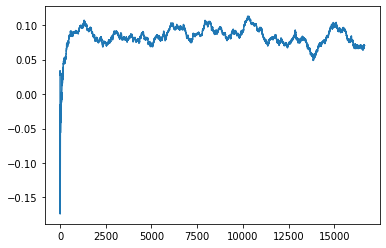

Thread: 6 iteration: 2770
RAM mBackground_38 FROM: 1664 --> 256 reward: -1.0
Thread: 3 iteration: 2805
RAM mDiffFit_370 FROM: 2944 --> 320 reward: 0.11376035468749998
Thread: 6 iteration: 2771
RAM mDiffFit_249 FROM: 2240 --> 256 reward: 0.13318743437499997
Thread: 3 iteration: 2806
RAM mDiffFit_245 FROM: 2048 --> 320 reward: 0.09673688164062497
Thread: 6 iteration: 2772
RAM mProject_49 FROM: 704 --> 320 reward: -1.0
Thread: 1 iteration: 2714
RAM mDiffFit_118 FROM: 192 --> 384 reward: -0.31251561953125
Thread: 3 iteration: 2807
RAM mProject_8 FROM: 1728 --> 256 reward: -1.0
Thread: 4 iteration: 2764
RAM mDiffFit_422 FROM: 2432 --> 320 reward: 0.005176904687500018
Thread: 1 iteration: 2715
RAM mBackground_57 FROM: 2624 --> 320 reward: -1.0
Thread: 5 iteration: 2844
RAM mDiffFit_229 FROM: 1024 --> 320 reward: 0.12748438046875002
Thread: 4 iteration: 2765
RAM mProject_18 FROM: 1600 --> 320 reward: -1.0
Thread: 2 iteration: 2753
RAM mDiffFit_401 FROM: 128 --> 1408 reward: -0.62679685859375


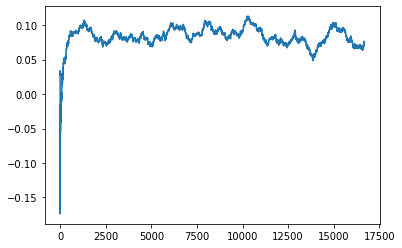

Thread: 3 iteration: 2810
RAM mDiffFit_242 FROM: 2432 --> 320 reward: 0.13513017734375
Thread: 2 iteration: 2758
RAM mDiffFit_213 FROM: 256 --> 320 reward: -0.3075573445312501
Thread: 5 iteration: 2849
RAM mDiffFit_271 FROM: 2496 --> 2560 reward: 0.07340632656249999
Thread: 2 iteration: 2759
RAM mDiffFit_128 FROM: 256 --> 1920 reward: -0.26203119531249996
Saving ...


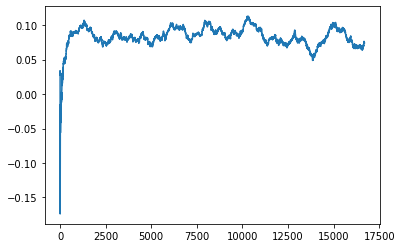

Thread: 2 iteration: 2760
RAM mDiffFit_264 FROM: 1280 --> 1088 reward: 0.01728646015625
Thread: 2 iteration: 2761
RAM mBackground_36 FROM: 320 --> 320 reward: -1.0
Thread: 6 iteration: 2779
RAM mDiffFit_388 FROM: 576 --> 320 reward: 0.07078646015625001
Saving ...


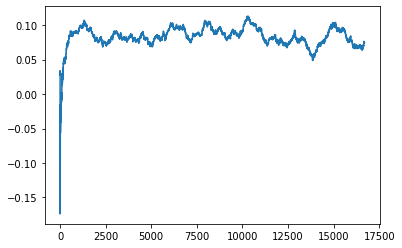

Thread: 6 iteration: 2780
RAM mDiffFit_349 FROM: 2112 --> 320 reward: 0.119398385546875
Thread: 6 iteration: 2781
RAM mProject_37 FROM: 2560 --> 256 reward: -1.0
Thread: 1 iteration: 2718
RAM mProject_25 FROM: 512 --> 320 reward: -1.0
Thread: 3 iteration: 2811
RAM mBackground_4 FROM: 1344 --> 320 reward: -1.0
Thread: 4 iteration: 2769
RAM mProject_81 FROM: 704 --> 320 reward: -1.0
Saving ...


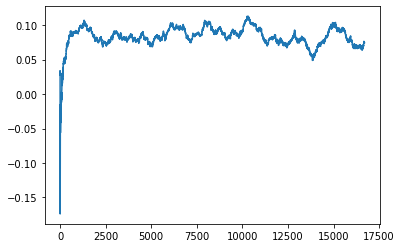

Thread: 5 iteration: 2850
RAM mDiffFit_176 FROM: 1152 --> 1088 reward: 0.006265619531250002
Thread: 6 iteration: 2782
RAM mDiffFit_78 FROM: 256 --> 320 reward: -0.072013030859375
Thread: 5 iteration: 2851
RAM mProject_42 FROM: 2304 --> 320 reward: -1.0
Thread: 2 iteration: 2762
RAM mDiffFit_142 FROM: 768 --> 1984 reward: 0.03485946796874999
Thread: 2 iteration: 2763
RAM mDiffFit_310 FROM: 2176 --> 320 reward: 0.009062346875000002
Thread: 5 iteration: 2852
RAM mProject_30 FROM: 2880 --> 1984 reward: -0.15812469196875004
Saving ...


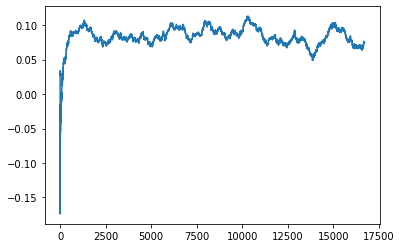

Thread: 4 iteration: 2770
RAM mProject_54 FROM: 576 --> 1984 reward: 0.6514844416875
Thread: 6 iteration: 2783
RAM mDiffFit_273 FROM: 1920 --> 1984 reward: -0.0010078097656250097
Thread: 4 iteration: 2771
RAM mProject_53 FROM: 896 --> 256 reward: -1.0
Thread: 1 iteration: 2719
RAM mProject_2 FROM: 448 --> 320 reward: -1.0
Thread: 3 iteration: 2812
RAM mDiffFit_88 FROM: 256 --> 320 reward: -0.3917813265625001
Thread: 5 iteration: 2853
RAM mDiffFit_220 FROM: 2496 --> 320 reward: 0.171325465234375
Thread: 5 iteration: 2854
RAM mBackground_8 FROM: 1792 --> 1984 reward: -1.0
Thread: 2 iteration: 2764
RAM mProject_67 FROM: 1024 --> 2560 reward: -0.08350847043749977
Thread: 3 iteration: 2813
RAM mDiffFit_412 FROM: 2304 --> 1984 reward: 0.001414048828124988
Thread: 2 iteration: 2765
RAM mBackground_50 FROM: 576 --> 1984 reward: -1.0
Saving ...


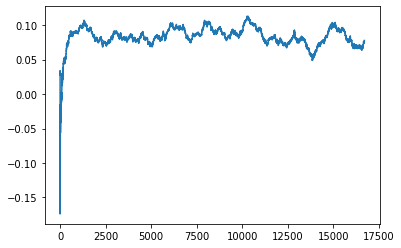

Thread: 1 iteration: 2720
RAM mProject_66 FROM: 1472 --> 320 reward: -1.0
Thread: 4 iteration: 2772
RAM mDiffFit_369 FROM: 320 --> 1984 reward: -0.1340728765625
Thread: 4 iteration: 2773
RAM mDiffFit_317 FROM: 2816 --> 320 reward: 0.061038961328125
Thread: 1 iteration: 2721
RAM mBackground_47 FROM: 384 --> 320 reward: -1.0
Thread: 6 iteration: 2784
RAM mDiffFit_158 FROM: 2752 --> 1088 reward: 0.023570287890625034
Thread: 1 iteration: 2722
RAM mDiffFit_422 FROM: 2048 --> 320 reward: 0.12497130585937502
Thread: 4 iteration: 2774
RAM mDiffFit_120 FROM: 2368 --> 320 reward: 0.11794006679687496
Thread: 6 iteration: 2785
RAM mProject_31 FROM: 3008 --> 192 reward: -1.0
Thread: 3 iteration: 2814
RAM mDiffFit_254 FROM: 1152 --> 2560 reward: 0.036479246874999996
Thread: 4 iteration: 2775
RAM mBackground_71 FROM: 1024 --> 320 reward: -1.0
Thread: 5 iteration: 2855
RAM mDiffFit_255 FROM: 1280 --> 320 reward: 0.01620564257812502
Thread: 6 iteration: 2786
RAM mDiffFit_183 FROM: 2496 --> 320 reward: 

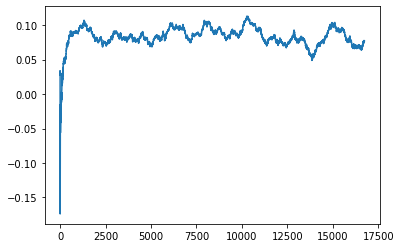

Thread: 6 iteration: 2790
RAM mProject_30 FROM: 2560 --> 1920 reward: -0.10180333828124997
Thread: 1 iteration: 2724
RAM mDiffFit_268 FROM: 192 --> 256 reward: -0.304242233984375
Thread: 5 iteration: 2858
RAM mBackground_17 FROM: 1280 --> 1984 reward: -1.0
Thread: 2 iteration: 2767
RAM mProject_16 FROM: 320 --> 192 reward: -1.0
Thread: 3 iteration: 2816
RAM mDiffFit_82 FROM: 704 --> 320 reward: 0.0336145578125
Thread: 5 iteration: 2859
RAM mDiffFit_415 FROM: 576 --> 704 reward: 0.11984643710937501
Thread: 1 iteration: 2725
RAM mDiffFit_130 FROM: 960 --> 320 reward: 0.23016404882812502
Thread: 6 iteration: 2791
RAM mDiffFit_303 FROM: 768 --> 1984 reward: -0.03798955781250002
Thread: 2 iteration: 2768
RAM mDiffFit_210 FROM: 1728 --> 1984 reward: 0.00979168124999999
Thread: 3 iteration: 2817
RAM mDiffFit_144 FROM: 1344 --> 320 reward: 0.08943747812500003
Saving ...


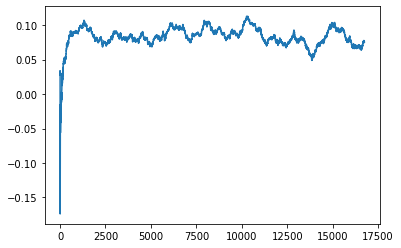

Thread: 5 iteration: 2860
RAM mDiffFit_169 FROM: 2624 --> 320 reward: 0.13112495624999998
Thread: 6 iteration: 2792
RAM mDiffFit_407 FROM: 1920 --> 320 reward: 0.16094269921875
Thread: 1 iteration: 2726
RAM mBackground_61 FROM: 1664 --> 1920 reward: -1.0
Saving ...


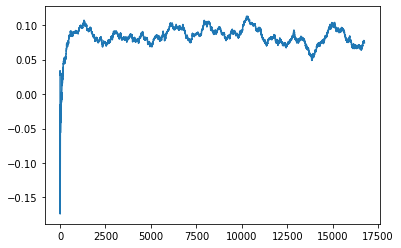

Thread: 4 iteration: 2780
RAM mDiffFit_227 FROM: 1920 --> 1984 reward: 0.028119822656249994
Thread: 3 iteration: 2818
RAM mDiffFit_290 FROM: 640 --> 1920 reward: -0.018703097656249997
Thread: 1 iteration: 2727
RAM mDiffFit_114 FROM: 1856 --> 256 reward: 0.132445287890625
Thread: 5 iteration: 2861
RAM mDiffFit_256 FROM: 512 --> 1088 reward: -0.05874477890624999
Thread: 3 iteration: 2819
RAM mProject_52 FROM: 2432 --> 1984 reward: 0.6546349155234376
Thread: 2 iteration: 2769
RAM mProject_76 FROM: 1472 --> 1920 reward: -0.042198706687499886
Thread: 4 iteration: 2781
RAM mDiffFit_277 FROM: 1728 --> 1984 reward: 0.003916681249999995
Saving ...


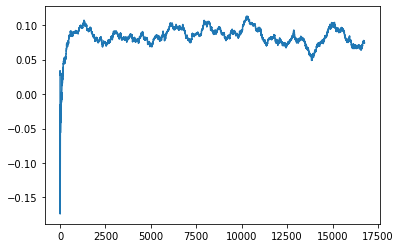

Thread: 2 iteration: 2770
RAM mDiffFit_272 FROM: 2560 --> 256 reward: 0.13847911562500004
Saving ...


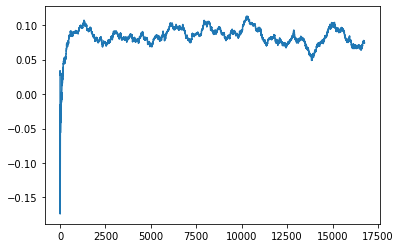

Thread: 3 iteration: 2820
RAM mProject_75 FROM: 704 --> 2560 reward: 0.7511483924999999
Thread: 5 iteration: 2862
RAM mDiffFit_343 FROM: 1280 --> 1984 reward: -0.024177079687499985
Thread: 4 iteration: 2782
RAM mDiffFit_193 FROM: 2944 --> 1984 reward: -0.09014597187500002
Thread: 2 iteration: 2771
RAM mDiffFit_384 FROM: 2048 --> 1984 reward: -0.016825552734375023
Thread: 3 iteration: 2821
RAM mDiffFit_39 FROM: 1216 --> 320 reward: -0.0018073882812499886
Thread: 5 iteration: 2863
RAM mDiffFit_301 FROM: 2176 --> 1088 reward: 0.012255177343750007
Thread: 3 iteration: 2822
RAM mDiffFit_280 FROM: 1344 --> 320 reward: 0.11157809765625001
Thread: 4 iteration: 2783
RAM mDiffFit_145 FROM: 2624 --> 1920 reward: -0.03206515429687501
Thread: 5 iteration: 2864
RAM mDiffFit_27 FROM: 448 --> 256 reward: 0.131799491015625
Thread: 4 iteration: 2784
RAM mDiffFit_71 FROM: 1856 --> 1920 reward: 0.002572920312500001
Thread: 5 iteration: 2865
RAM mBackground_38 FROM: 2176 --> 384 reward: -1.0
Thread: 1 iter

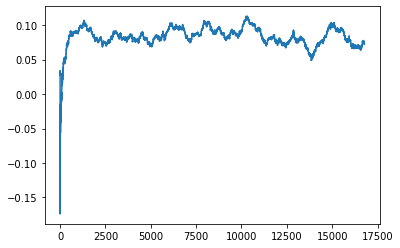

Thread: 1 iteration: 2730
RAM mDiffFit_223 FROM: 576 --> 1984 reward: -0.10443488945312501
Thread: 2 iteration: 2773
RAM mDiffFit_140 FROM: 2176 --> 1088 reward: -0.007742233984374992
Thread: 6 iteration: 2795
RAM mDiffFit_355 FROM: 2496 --> 256 reward: 0.368127501171875
Thread: 4 iteration: 2787
RAM mDiffFit_291 FROM: 1856 --> 1920 reward: 0.0331562828125
Thread: 1 iteration: 2731
RAM mDiffFit_41 FROM: 512 --> 256 reward: 0.041614557812500036
Thread: 2 iteration: 2774
RAM mDiffFit_121 FROM: 768 --> 1088 reward: -0.014450508984374996
Thread: 4 iteration: 2788
RAM mDiffFit_155 FROM: 1792 --> 1920 reward: 0.002520840624999996
Thread: 4 iteration: 2789
RAM mProject_30 FROM: 1728 --> 1920 reward: 0.00791863361718763
Thread: 3 iteration: 2825
RAM mDiffFit_143 FROM: 1856 --> 1984 reward: -0.10100530859374998
Thread: 2 iteration: 2775
RAM mDiffFit_386 FROM: 1856 --> 384 reward: 0.06958849609375004
Thread: 2 iteration: 2776
RAM mProject_71 FROM: 1472 --> 1984 reward: -0.02218632700781259
Threa

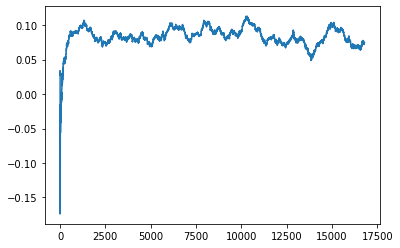

Thread: 4 iteration: 2790
RAM mDiffFit_412 FROM: 2368 --> 1920 reward: -0.04531256562500002
Thread: 5 iteration: 2868
RAM mDiffFit_209 FROM: 1280 --> 1984 reward: -0.09390891523437499
Thread: 2 iteration: 2778
RAM mDiffFit_289 FROM: 2752 --> 384 reward: 0.12760152695312502
Thread: 1 iteration: 2734
RAM mDiffFit_81 FROM: 2752 --> 1920 reward: -0.0011015707031250023
Thread: 4 iteration: 2791
RAM mBackground_56 FROM: 2432 --> 1920 reward: -1.0
Thread: 3 iteration: 2826
RAM mDiffFit_347 FROM: 576 --> 1984 reward: -0.08620831875000001
Thread: 2 iteration: 2779
RAM mProject_61 FROM: 384 --> 1920 reward: 0.634132226953125
Thread: 6 iteration: 2797
RAM mDiffFit_118 FROM: 1664 --> 192 reward: 0.26602601796875003
Thread: 5 iteration: 2869
RAM mDiffFit_184 FROM: 2240 --> 256 reward: 0.17758590742187497
Thread: 3 iteration: 2827
RAM mDiffFit_411 FROM: 1472 --> 1920 reward: -0.06716150390625002
Thread: 4 iteration: 2792
RAM mDiffFit_212 FROM: 2368 --> 1984 reward: -0.002828141406250014
Thread: 6 it

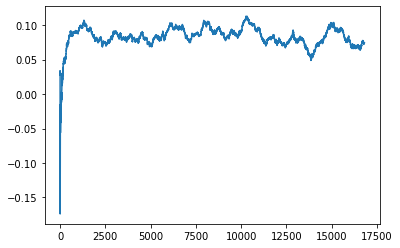

Thread: 2 iteration: 2780
RAM mDiffFit_65 FROM: 1792 --> 1984 reward: 0.0045937609375
Saving ...


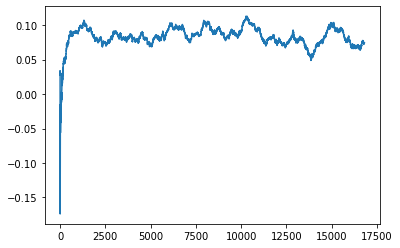

Thread: 5 iteration: 2870
RAM mDiffFit_16 FROM: 2752 --> 1920 reward: 0.007523429296875019
Thread: 3 iteration: 2828
RAM mDiffFit_235 FROM: 1920 --> 2560 reward: 0.05240110546875
Thread: 6 iteration: 2799
RAM mDiffFit_303 FROM: 576 --> 1920 reward: -0.07464842929687501
Thread: 2 iteration: 2781
RAM mDiffFit_86 FROM: 1280 --> 1920 reward: -0.021557300781250004
Thread: 5 iteration: 2871
RAM mProject_31 FROM: 1728 --> 320 reward: -1.0
Thread: 1 iteration: 2735
RAM mDiffFit_57 FROM: 768 --> 1088 reward: -0.046338539843749985
Saving ...


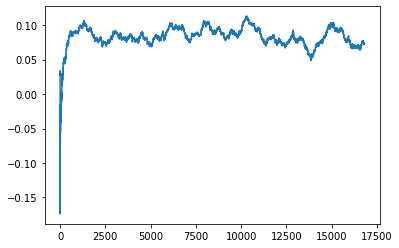

Thread: 6 iteration: 2800
RAM mDiffFit_62 FROM: 1536 --> 1920 reward: -0.03592190234374999
Thread: 6 iteration: 2801
RAM mDiffFit_278 FROM: 2560 --> 1920 reward: -0.012796902343749986
Thread: 6 iteration: 2802
RAM mDiffFit_256 FROM: 2688 --> 1920 reward: -0.016031282812499995
Thread: 6 iteration: 2803
RAM mProject_38 FROM: 512 --> 1088 reward: 0.8328432949453125
Thread: 3 iteration: 2829
RAM mProject_90 FROM: 2688 --> 1920 reward: -0.1436684065312501
Thread: 2 iteration: 2782
RAM mProject_11 FROM: 640 --> 1984 reward: 0.6656608631953125
Thread: 1 iteration: 2736
RAM mDiffFit_407 FROM: 2624 --> 320 reward: 0.10346867343749996
Thread: 6 iteration: 2804
RAM mBackground_52 FROM: 2304 --> 320 reward: -1.0
Thread: 4 iteration: 2793
RAM mDiffFit_67 FROM: 1536 --> 1920 reward: -0.08279694609374999
Thread: 2 iteration: 2783
RAM mDiffFit_391 FROM: 896 --> 1088 reward: -0.046093760937500027
Thread: 6 iteration: 2805
RAM mBackground_54 FROM: 1600 --> 1984 reward: -1.0
Thread: 5 iteration: 2872
RAM

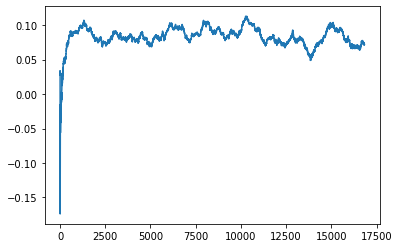

Thread: 3 iteration: 2830
RAM mDiffFit_122 FROM: 192 --> 1920 reward: -0.317757809765625
Thread: 5 iteration: 2874
RAM mDiffFit_150 FROM: 2240 --> 256 reward: 0.047515488281250004
Thread: 6 iteration: 2808
RAM mProject_39 FROM: 2560 --> 1984 reward: -0.09133800314062492
Thread: 4 iteration: 2796
RAM mDiffFit_189 FROM: 320 --> 1920 reward: -0.072520796875
Thread: 5 iteration: 2875
RAM mDiffFit_401 FROM: 3008 --> 320 reward: 0.13645046523437498
Thread: 3 iteration: 2831
RAM mBackground_86 FROM: 1152 --> 1920 reward: -1.0
Thread: 1 iteration: 2738
RAM mDiffFit_331 FROM: 2752 --> 1920 reward: 0.008648429296875
Thread: 4 iteration: 2797
RAM mDiffFit_209 FROM: 2944 --> 1920 reward: -0.05096362734375001
Thread: 5 iteration: 2876
RAM mBackground_30 FROM: 2176 --> 1920 reward: -0.038847873640625
Thread: 3 iteration: 2832
RAM mBgModel_2 FROM: 1920 --> 1984 reward: 0.015487521875000021
Thread: 1 iteration: 2739
RAM mProject_17 FROM: 1088 --> 1920 reward: -0.17782027214062499
Thread: 6 iteration: 

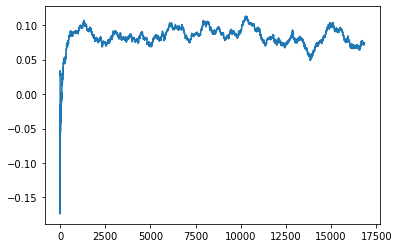

Thread: 1 iteration: 2740
RAM mDiffFit_216 FROM: 256 --> 1984 reward: -0.273315110546875
Saving ...


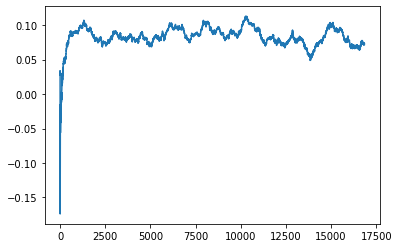

Thread: 6 iteration: 2810
RAM mDiffFit_271 FROM: 1088 --> 1920 reward: -0.003348938281249993
Thread: 3 iteration: 2834
RAM mProject_9 FROM: 1856 --> 2560 reward: 0.1307299431093751
Thread: 5 iteration: 2877
RAM mDiffFit_378 FROM: 2048 --> 1920 reward: 0.0006406195312499887
Thread: 3 iteration: 2835
RAM mDiffFit_376 FROM: 192 --> 2560 reward: -0.275231704296875
Thread: 5 iteration: 2878
RAM mBackground_30 FROM: 2816 --> 2560 reward: 0.05779922937500002
Thread: 3 iteration: 2836
RAM mDiffFit_270 FROM: 2944 --> 1920 reward: -0.02295318515625002
Thread: 5 iteration: 2879
RAM mProject_30 FROM: 1984 --> 1920 reward: 0.002473586367187619
Thread: 1 iteration: 2741
RAM mProject_86 FROM: 1792 --> 1920 reward: 0.011711285437500019
Thread: 6 iteration: 2811
RAM mBackground_44 FROM: 512 --> 1920 reward: -0.271222462375
Thread: 3 iteration: 2837
RAM mProject_63 FROM: 128 --> 1088 reward: 0.8159031247499999
Thread: 2 iteration: 2787
RAM mDiffFit_310 FROM: 2688 --> 1984 reward: -0.05206778671874999
Sa

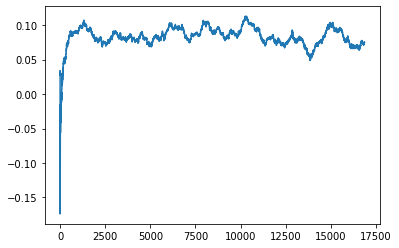

Thread: 5 iteration: 2880
RAM mDiffFit_234 FROM: 1152 --> 1920 reward: 0.03929694609374999
Thread: 3 iteration: 2838
RAM mDiffFit_388 FROM: 1536 --> 384 reward: 0.05151557578125004
Thread: 1 iteration: 2742
RAM mDiffFit_145 FROM: 896 --> 1920 reward: -0.01030203593750001
Thread: 2 iteration: 2788
RAM mProject_83 FROM: 2624 --> 320 reward: -1.0
Thread: 4 iteration: 2799
RAM mDiffFit_249 FROM: 1984 --> 192 reward: 0.252304668359375
Thread: 6 iteration: 2812
RAM mDiffFit_174 FROM: 256 --> 1984 reward: -0.11826298710937501
Thread: 5 iteration: 2881
RAM mDiffFit_96 FROM: 1600 --> 768 reward: 0.02820831874999999
Thread: 3 iteration: 2839
RAM mDiffFit_389 FROM: 576 --> 1920 reward: -0.10655462460937504
Thread: 1 iteration: 2743
RAM mDiffFit_259 FROM: 1920 --> 1984 reward: -0.00042707968749999825
Thread: 6 iteration: 2813
RAM mDiffFit_253 FROM: 2240 --> 1920 reward: -0.008921902343749996
Thread: 2 iteration: 2789
RAM mDiffFit_123 FROM: 2752 --> 448 reward: 0.26370836249999996
Saving ...


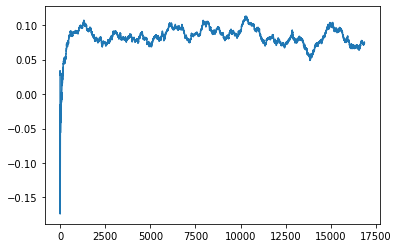

Thread: 4 iteration: 2800
RAM mDiffFit_213 FROM: 1344 --> 1920 reward: 0.0035156632812500047
Thread: 5 iteration: 2882
RAM mDiffFit_224 FROM: 2752 --> 2560 reward: 0.027635442187500022
Saving ...


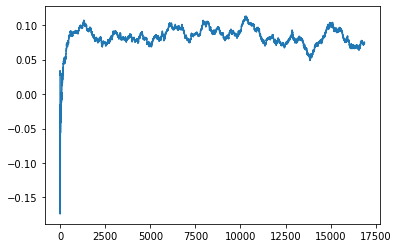

Thread: 3 iteration: 2840
RAM mDiffFit_320 FROM: 576 --> 1920 reward: -0.043296858593750015
Thread: 1 iteration: 2744
RAM mDiffFit_311 FROM: 320 --> 1088 reward: -0.39145840624999995
Thread: 4 iteration: 2801
RAM mDiffFit_205 FROM: 2688 --> 1408 reward: 0.08366150390625
Thread: 6 iteration: 2814
RAM mDiffFit_267 FROM: 1664 --> 256 reward: 0.16308849609375003
Saving ...


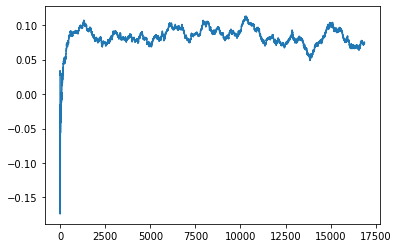

Thread: 2 iteration: 2790
RAM mDiffFit_106 FROM: 1536 --> 448 reward: 0.17435679179687497
Thread: 5 iteration: 2883
RAM mDiffFit_354 FROM: 128 --> 320 reward: -0.4348802210937499
Thread: 4 iteration: 2802
RAM mImgtbl_1 FROM: 3008 --> 1920 reward: 0.03915412437500004
Thread: 1 iteration: 2745
RAM mDiffFit_78 FROM: 1600 --> 1920 reward: -0.013932300781250009
Thread: 5 iteration: 2884
RAM mDiffFit_192 FROM: 2944 --> 1984 reward: -0.02150785351562502
Thread: 4 iteration: 2803
RAM mDiffFit_146 FROM: 832 --> 1920 reward: -0.04920831875000002
Thread: 1 iteration: 2746
RAM mProject_74 FROM: 1600 --> 2560 reward: 0.08377572058593738
Thread: 3 iteration: 2841
RAM mProject_43 FROM: 1280 --> 1920 reward: -0.10053183234374995
Thread: 6 iteration: 2815
RAM mDiffFit_413 FROM: 1856 --> 320 reward: 0.10341141640624997
Thread: 1 iteration: 2747
RAM mDiffFit_268 FROM: 1472 --> 192 reward: 0.27386977890625
Thread: 5 iteration: 2885
RAM mDiffFit_351 FROM: 896 --> 448 reward: 0.15239066328125
Thread: 3 iter

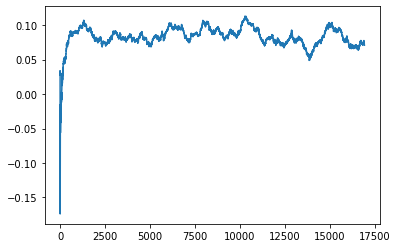

Thread: 5 iteration: 2890
RAM mDiffFit_305 FROM: 2880 --> 1920 reward: -0.01725785351562501
Thread: 3 iteration: 2847
RAM mProject_79 FROM: 1600 --> 384 reward: -1.0
Saving ...


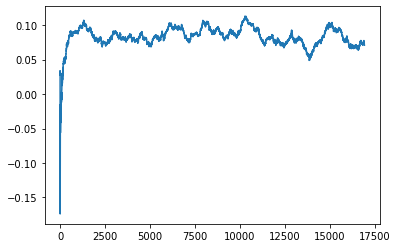

Thread: 1 iteration: 2750
RAM mDiffFit_244 FROM: 896 --> 448 reward: 0.098315110546875
Thread: 2 iteration: 2795
RAM mDiffFit_231 FROM: 320 --> 2560 reward: -0.05522389453125
Thread: 4 iteration: 2808
RAM mBackground_33 FROM: 1600 --> 1920 reward: -0.002002163984375012
Thread: 5 iteration: 2891
RAM mDiffFit_227 FROM: 1216 --> 1920 reward: 0.011164092578125001
Thread: 4 iteration: 2809
RAM mDiffFit_246 FROM: 384 --> 2560 reward: -0.20725
Thread: 3 iteration: 2848
RAM mDiffFit_226 FROM: 576 --> 1920 reward: -0.053421858593749996
Thread: 3 iteration: 2849
RAM mBackground_6 FROM: 1664 --> 192 reward: 1.08396732615625
Thread: 2 iteration: 2796
RAM mDiffFit_205 FROM: 1024 --> 192 reward: 0.7109636273437501
Thread: 5 iteration: 2892
RAM mDiffFit_269 FROM: 640 --> 1984 reward: -0.006458275000000013
Saving ...


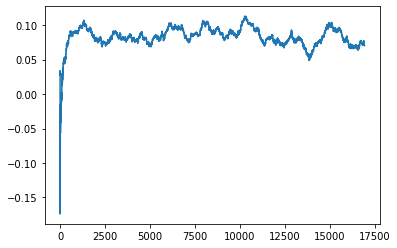

Thread: 3 iteration: 2850
RAM mDiffFit_300 FROM: 832 --> 1984 reward: -0.015114557812500014
Thread: 5 iteration: 2893
RAM mProject_11 FROM: 2176 --> 2560 reward: 0.062618565796875
Saving ...


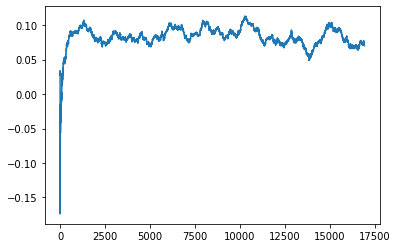

Thread: 4 iteration: 2810
RAM mDiffFit_387 FROM: 2880 --> 1920 reward: -0.0363438046875
Thread: 3 iteration: 2851
RAM mProject_87 FROM: 2432 --> 192 reward: -1.0
Thread: 1 iteration: 2751
RAM mBackground_1 FROM: 448 --> 1984 reward: -0.21876242475000005
Thread: 5 iteration: 2894
RAM mDiffFit_292 FROM: 128 --> 1920 reward: -0.949791725
Thread: 4 iteration: 2811
RAM mDiffFit_147 FROM: 2304 --> 1920 reward: -0.018781282812499987
Thread: 3 iteration: 2852
RAM mBackground_88 FROM: 2752 --> 256 reward: -1.0
Thread: 6 iteration: 2819
RAM mDiffFit_17 FROM: 1728 --> 1920 reward: 0.02789847304687499
Thread: 3 iteration: 2853
RAM mDiffFit_102 FROM: 2944 --> 1920 reward: -0.041666768750000006
Thread: 4 iteration: 2812
RAM mDiffFit_406 FROM: 2176 --> 1088 reward: -0.008742233984375004
Saving ...


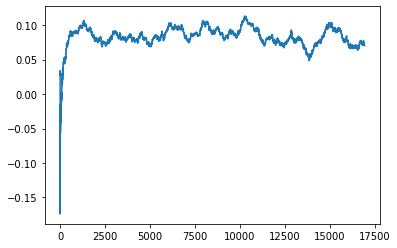

Thread: 6 iteration: 2820
RAM mBackground_70 FROM: 2496 --> 2560 reward: -1.0
Thread: 2 iteration: 2797
RAM mBackground_56 FROM: 2368 --> 1984 reward: -0.10335466528906252
Thread: 5 iteration: 2895
RAM mProject_46 FROM: 1920 --> 1984 reward: -0.0036079607109375522
Thread: 1 iteration: 2752
RAM mDiffFit_292 FROM: 2752 --> 1984 reward: -0.30839882304687494
Thread: 3 iteration: 2854
RAM mDiffFit_249 FROM: 576 --> 1984 reward: -0.04102860664062503
Thread: 5 iteration: 2896
RAM mDiffFit_35 FROM: 1408 --> 1920 reward: -0.0043385398437500045
Thread: 1 iteration: 2753
RAM mDiffFit_51 FROM: 2752 --> 1920 reward: -0.020523473046874987
Thread: 3 iteration: 2855
RAM mDiffFit_374 FROM: 576 --> 1408 reward: -0.18844796406250003
Thread: 5 iteration: 2897
RAM mProject_34 FROM: 2944 --> 1920 reward: -0.1753944172031249
Thread: 6 iteration: 2821
RAM mDiffFit_184 FROM: 1600 --> 192 reward: 0.524325552734375
Thread: 1 iteration: 2754
RAM mDiffFit_15 FROM: 2560 --> 2560 reward: 0.002749999999999992
Thread:

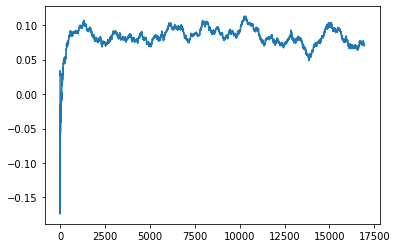

Thread: 5 iteration: 2900
RAM mBackground_87 FROM: 640 --> 1984 reward: -1.0
Thread: 2 iteration: 2798
RAM mDiffFit_20 FROM: 1024 --> 1984 reward: -0.008273385546875012
Thread: 1 iteration: 2756
RAM mProject_59 FROM: 1792 --> 1920 reward: 0.018051602203125017
Thread: 6 iteration: 2822
RAM mDiffFit_374 FROM: 704 --> 2560 reward: -0.03102860664062502
Thread: 5 iteration: 2901
RAM mDiffFit_34 FROM: 768 --> 2560 reward: -0.07214575312500002
Thread: 1 iteration: 2757
RAM mDiffFit_344 FROM: 2752 --> 384 reward: 0.100507766015625
Thread: 6 iteration: 2823
RAM mProject_59 FROM: 704 --> 192 reward: -1.0
Thread: 3 iteration: 2856
RAM mDiffFit_270 FROM: 1792 --> 192 reward: 0.660950508984375
Thread: 2 iteration: 2799
RAM mDiffFit_280 FROM: 3008 --> 1984 reward: -0.11475798476562499
Thread: 6 iteration: 2824
RAM mBackground_90 FROM: 1920 --> 192 reward: -1.0
Thread: 4 iteration: 2813
RAM mDiffFit_343 FROM: 1088 --> 256 reward: 0.10890623906250002
Thread: 1 iteration: 2758
RAM mDiffFit_114 FROM: 15

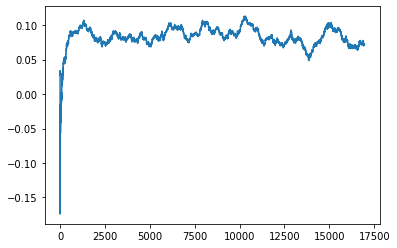

Thread: 2 iteration: 2800
RAM mBackground_59 FROM: 2944 --> 2560 reward: -0.004398557343749917
Thread: 6 iteration: 2825
RAM mDiffFit_300 FROM: 1472 --> 2560 reward: 0.07059384843750001
Thread: 2 iteration: 2801
RAM mDiffFit_398 FROM: 2624 --> 2560 reward: 0.06338548593749994
Thread: 1 iteration: 2759
RAM mProject_24 FROM: 1408 --> 2560 reward: 0.046666199671875
Thread: 3 iteration: 2857
RAM mBackground_54 FROM: 256 --> 448 reward: -0.2624030098593749
Thread: 4 iteration: 2814
RAM mDiffFit_272 FROM: 3008 --> 2560 reward: -0.038239645312500015
Saving ...


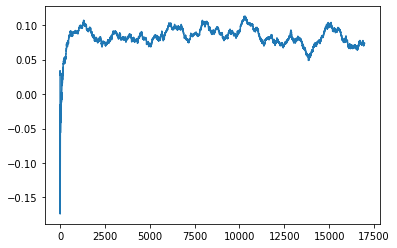

Thread: 1 iteration: 2760
RAM mDiffFit_273 FROM: 256 --> 1920 reward: -0.27320831875
Thread: 3 iteration: 2858
RAM mDiffFit_373 FROM: 1600 --> 192 reward: 0.139825421484375
Thread: 6 iteration: 2826
RAM mDiffFit_175 FROM: 1856 --> 1920 reward: -0.07270840625
Thread: 4 iteration: 2815
RAM mBackground_12 FROM: 3008 --> 1920 reward: -0.04702240140624999
Thread: 1 iteration: 2761
RAM mDiffFit_67 FROM: 1792 --> 192 reward: 0.17942703593749998
Thread: 6 iteration: 2827
RAM mDiffFit_356 FROM: 448 --> 192 reward: 0.20652084062500006
Thread: 3 iteration: 2859
RAM mDiffFit_142 FROM: 832 --> 192 reward: 0.260687478125
Thread: 1 iteration: 2762
RAM mProject_40 FROM: 768 --> 2560 reward: 0.313268122125
Thread: 4 iteration: 2816
RAM mDiffFit_322 FROM: 2944 --> 2560 reward: 0.05325526484375001
Thread: 1 iteration: 2763
RAM mProject_8 FROM: 640 --> 192 reward: -1.0
Thread: 2 iteration: 2802
RAM mBackground_67 FROM: 2560 --> 192 reward: -1.0
Thread: 5 iteration: 2902
RAM mDiffFit_258 FROM: 1664 --> 192

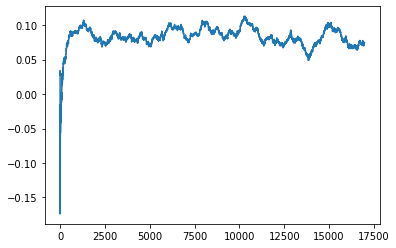

Thread: 3 iteration: 2860
RAM mDiffFit_112 FROM: 448 --> 1920 reward: -0.06190360664062502
Thread: 2 iteration: 2803
RAM mDiffFit_22 FROM: 832 --> 1088 reward: 0.001166681249999994
Thread: 1 iteration: 2765
RAM mDiffFit_253 FROM: 192 --> 2560 reward: -0.69975513359375
Thread: 3 iteration: 2861
RAM mDiffFit_9 FROM: 1472 --> 448 reward: 0.107002588671875
Thread: 4 iteration: 2818
RAM mAdd_2 FROM: 1664 --> 1920 reward: -1.0
Thread: 6 iteration: 2828
RAM mDiffFit_222 FROM: 2112 --> 192 reward: 0.18323433671875003
Thread: 2 iteration: 2804
RAM mDiffFit_250 FROM: 256 --> 2560 reward: -0.476145840625
Thread: 1 iteration: 2766
RAM mDiffFit_301 FROM: 1664 --> 2560 reward: 0.0015469023437500104
Thread: 4 iteration: 2819
RAM mDiffFit_292 FROM: 2816 --> 1984 reward: -0.111554843359375
Thread: 6 iteration: 2829
RAM mProject_2 FROM: 2496 --> 1920 reward: -0.0968795738437499
Thread: 3 iteration: 2862
RAM mDiffFit_32 FROM: 1856 --> 192 reward: 0.414721349609375
Thread: 1 iteration: 2767
RAM mBackgroun

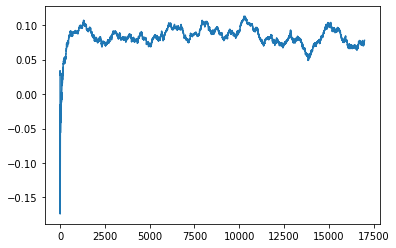

Thread: 4 iteration: 2820
RAM mDiffFit_93 FROM: 256 --> 1088 reward: -0.1359270359375
Thread: 1 iteration: 2768
RAM mDiffFit_304 FROM: 2816 --> 1920 reward: 0.03245314140624998
Thread: 4 iteration: 2821
RAM mAdd_1 FROM: 2432 --> 2560 reward: 0.027726614453125048
Thread: 3 iteration: 2863
RAM mBackground_54 FROM: 1920 --> 384 reward: 0.2902230591562499
Thread: 5 iteration: 2904
RAM mDiffFit_113 FROM: 320 --> 1920 reward: -0.2522707968749999
Thread: 5 iteration: 2905
RAM mBackground_7 FROM: 2560 --> 384 reward: 0.2647231084531249
Thread: 4 iteration: 2822
RAM mProject_88 FROM: 2240 --> 320 reward: -1.0
Thread: 2 iteration: 2805
RAM mDiffFit_35 FROM: 2688 --> 1088 reward: 0.03093747812500002
Thread: 5 iteration: 2906
RAM mProject_84 FROM: 2304 --> 192 reward: -1.0
Saving ...


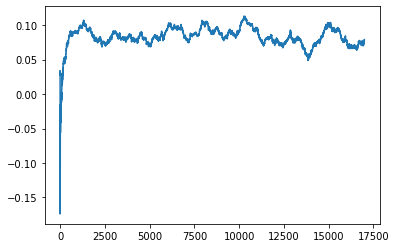

Thread: 6 iteration: 2830
RAM mProject_61 FROM: 2368 --> 1920 reward: -0.05927263650000002
Thread: 1 iteration: 2769
RAM mBackground_2 FROM: 2368 --> 1920 reward: -0.0032586196171874465
Thread: 2 iteration: 2806
RAM mDiffFit_399 FROM: 704 --> 384 reward: 0.035968717187499985
Thread: 4 iteration: 2823
RAM mViewer_4 FROM: 704 --> 1920 reward: -0.34504928596874995
Thread: 5 iteration: 2907
RAM mDiffFit_62 FROM: 768 --> 192 reward: 0.309992190234375
Thread: 6 iteration: 2831
RAM mBackground_67 FROM: 896 --> 1920 reward: -1.0
Thread: 3 iteration: 2864
RAM mDiffFit_418 FROM: 1920 --> 1920 reward: 0.08251570703125001
Thread: 2 iteration: 2807
RAM mBackground_9 FROM: 1792 --> 1920 reward: 0.008299913078125006
Saving ...


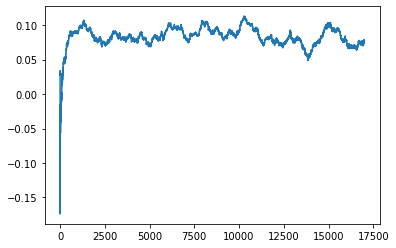

Thread: 1 iteration: 2770
RAM mDiffFit_56 FROM: 1600 --> 2560 reward: 0.02158340624999998
Thread: 4 iteration: 2824
RAM mDiffFit_247 FROM: 1984 --> 384 reward: 0.1317395578125
Thread: 6 iteration: 2832
RAM mProject_52 FROM: 704 --> 1984 reward: 0.6565699155234375
Thread: 5 iteration: 2908
RAM mBackground_38 FROM: 1920 --> 1920 reward: -0.0907838440625
Thread: 4 iteration: 2825
RAM mDiffFit_160 FROM: 2624 --> 384 reward: 0.143195287890625
Thread: 1 iteration: 2771
RAM mDiffFit_43 FROM: 512 --> 2560 reward: -0.023020753124999987
Thread: 6 iteration: 2833
RAM mDiffFit_130 FROM: 2496 --> 448 reward: 0.22805203593750004
Thread: 5 iteration: 2909
RAM mDiffFit_301 FROM: 1664 --> 384 reward: 0.17906769921875004
Thread: 1 iteration: 2772
RAM mBackground_2 FROM: 320 --> 2560 reward: -0.3139894265625
Thread: 6 iteration: 2834
RAM mBackground_50 FROM: 1728 --> 384 reward: 0.36339701478906256
Thread: 4 iteration: 2826
RAM mDiffFit_203 FROM: 576 --> 2560 reward: -0.01702338554687502
Saving ...


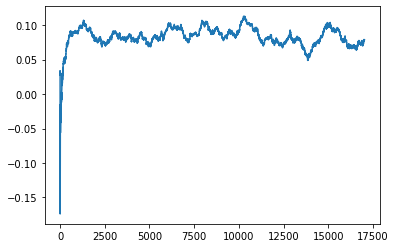

Thread: 5 iteration: 2910
RAM mDiffFit_240 FROM: 1664 --> 2560 reward: 0.0060469023437500005
Thread: 1 iteration: 2773
RAM mConcatFit_3 FROM: 1920 --> 1920 reward: -0.003100000000000047
Thread: 6 iteration: 2835
RAM mBackground_81 FROM: 2880 --> 2560 reward: -1.0
Thread: 3 iteration: 2865
RAM mDiffFit_25 FROM: 2560 --> 192 reward: 0.21839575312499998
Thread: 4 iteration: 2827
RAM mProject_20 FROM: 1920 --> 384 reward: -1.0
Thread: 2 iteration: 2808
RAM mDiffFit_194 FROM: 704 --> 1920 reward: -0.03370050898437501
Thread: 5 iteration: 2911
RAM mDiffFit_278 FROM: 448 --> 1920 reward: -0.042755177343750006
Thread: 1 iteration: 2774
RAM mDiffFit_288 FROM: 2112 --> 1920 reward: -0.022265663281250004
Thread: 3 iteration: 2866
RAM mDiffFit_269 FROM: 1280 --> 1920 reward: -0.022874999999999996
Thread: 4 iteration: 2828
RAM mDiffFit_290 FROM: 1856 --> 384 reward: 0.09493225703124998
Thread: 2 iteration: 2809
RAM mDiffFit_113 FROM: 1152 --> 192 reward: 0.4847968585937499
Thread: 6 iteration: 2836

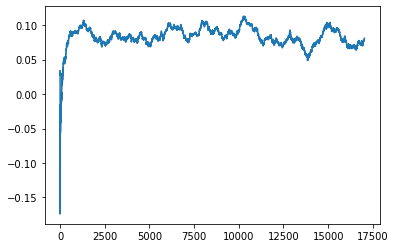

Thread: 2 iteration: 2810
RAM mDiffFit_402 FROM: 1856 --> 2560 reward: 0.045906326562500016
Thread: 5 iteration: 2913
RAM mDiffFit_27 FROM: 1216 --> 2560 reward: 0.014552123437500007
Thread: 1 iteration: 2776
RAM mDiffFit_177 FROM: 2368 --> 2560 reward: -0.016885442187500026
Thread: 3 iteration: 2868
RAM mDiffFit_354 FROM: 1984 --> 192 reward: 0.36336719023437497
Thread: 2 iteration: 2811
RAM mDiffFit_116 FROM: 2112 --> 1920 reward: -0.0037265707031249908
Thread: 5 iteration: 2914
RAM mDiffFit_395 FROM: 1408 --> 2560 reward: -0.0088645578125
Thread: 1 iteration: 2777
RAM mDiffFit_295 FROM: 1344 --> 1088 reward: -0.0978230078125
Thread: 2 iteration: 2812
RAM mDiffFit_240 FROM: 1664 --> 192 reward: 0.23393484570312506
Thread: 3 iteration: 2869
RAM mProject_50 FROM: 2432 --> 1920 reward: -0.08659423870312512
Thread: 6 iteration: 2838
RAM mDiffFit_242 FROM: 2816 --> 1920 reward: 0.031833362500000004
Thread: 5 iteration: 2915
RAM mDiffFit_212 FROM: 1856 --> 1920 reward: -0.02084898203125000

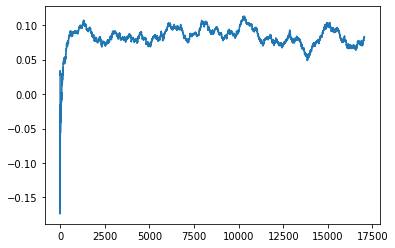

Thread: 3 iteration: 2870
RAM mDiffFit_104 FROM: 2816 --> 384 reward: 0.0849061953125
Thread: 2 iteration: 2814
RAM mDiffFit_257 FROM: 1024 --> 192 reward: 0.22078646015625003
Thread: 5 iteration: 2917
RAM mBgModel_3 FROM: 2368 --> 1920 reward: -0.04255737078124999
Saving ...


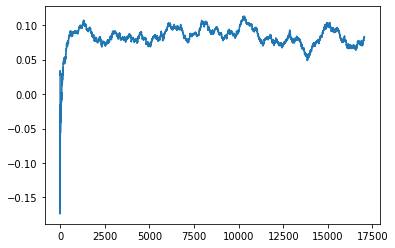

Thread: 1 iteration: 2780
RAM mProject_77 FROM: 1280 --> 1408 reward: -0.04976063353124991
Thread: 6 iteration: 2839
RAM mBackground_75 FROM: 768 --> 192 reward: -1.0
Thread: 4 iteration: 2829
RAM mDiffFit_59 FROM: 832 --> 1920 reward: -0.12251303085937505
Thread: 3 iteration: 2871
RAM mBackground_48 FROM: 2496 --> 1920 reward: -0.06150354567187494
Thread: 2 iteration: 2815
RAM mBackground_86 FROM: 2432 --> 2560 reward: 0.030395672031250036
Thread: 5 iteration: 2918
RAM mDiffFit_290 FROM: 1856 --> 1920 reward: -0.006427079687500014
Thread: 1 iteration: 2781
RAM mDiffFit_298 FROM: 2368 --> 1920 reward: 0.006726570703125007
Saving ...


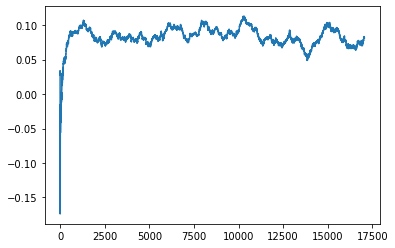

Thread: 4 iteration: 2830
RAM mDiffFit_103 FROM: 448 --> 384 reward: -0.0013073007812499683
Saving ...


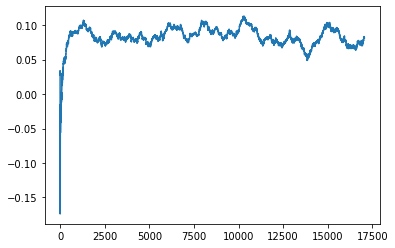

Thread: 6 iteration: 2840
RAM mDiffFit_383 FROM: 1920 --> 1984 reward: 0.03224482265624999
Thread: 3 iteration: 2872
RAM mDiffFit_158 FROM: 2944 --> 2560 reward: -0.038010485937500005
Thread: 5 iteration: 2919
RAM mDiffFit_54 FROM: 2688 --> 1920 reward: 0.02581252187499999
Thread: 1 iteration: 2782
RAM mDiffFit_86 FROM: 2048 --> 1920 reward: 0.020062521874999982
Thread: 6 iteration: 2841
RAM mDiffFit_225 FROM: 2944 --> 384 reward: 0.08928637265625
Thread: 4 iteration: 2831
RAM mBackground_12 FROM: 1472 --> 192 reward: 0.7136678230390625
Thread: 2 iteration: 2816
RAM mDiffFit_127 FROM: 960 --> 1408 reward: -0.02959634960937499
Saving ...


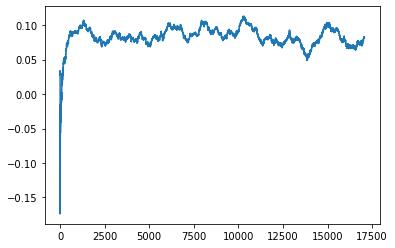

Thread: 5 iteration: 2920
RAM mDiffFit_238 FROM: 2752 --> 1920 reward: -0.08901575078124996
Thread: 1 iteration: 2783
RAM mProject_32 FROM: 1920 --> 1920 reward: -0.008476884843750043
Thread: 3 iteration: 2873
RAM mDiffFit_296 FROM: 2752 --> 1920 reward: 0.0071484292968750085
Thread: 4 iteration: 2832
RAM mDiffFit_421 FROM: 2624 --> 384 reward: 0.08884893828125001
Thread: 6 iteration: 2842
RAM mDiffFit_309 FROM: 1088 --> 384 reward: 0.14698438046875
Thread: 2 iteration: 2817
RAM mBackground_21 FROM: 2624 --> 1920 reward: -0.09095635703906256
Thread: 5 iteration: 2921
RAM mDiffFit_344 FROM: 1216 --> 1920 reward: 0.00564325195312498
Thread: 3 iteration: 2874
RAM mDiffFit_359 FROM: 1920 --> 384 reward: 0.12776561953125
Thread: 1 iteration: 2784
RAM mDiffFit_395 FROM: 1600 --> 2560 reward: 0.04757300781250001
Thread: 4 iteration: 2833
RAM mDiffFit_287 FROM: 512 --> 2560 reward: -0.18479168125
Thread: 6 iteration: 2843
RAM mBackground_79 FROM: 1856 --> 1920 reward: -0.009166629476562528
Thr

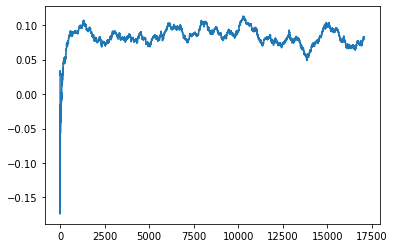

Thread: 2 iteration: 2820
RAM mDiffFit_230 FROM: 1856 --> 1920 reward: -0.015143251953125027
Thread: 6 iteration: 2846
RAM mDiffFit_158 FROM: 2880 --> 448 reward: 0.12376298710937499
Thread: 5 iteration: 2924
RAM mDiffFit_51 FROM: 1536 --> 192 reward: 0.12227334179687496
Thread: 4 iteration: 2836
RAM mDiffFit_20 FROM: 2752 --> 384 reward: 0.21275254492187504
Thread: 3 iteration: 2877
RAM mDiffFit_297 FROM: 2112 --> 1920 reward: 0.02295314140625001
Thread: 2 iteration: 2821
RAM mDiffFit_298 FROM: 1792 --> 1920 reward: 0.029067742968749994
Thread: 6 iteration: 2847
RAM mDiffFit_53 FROM: 256 --> 1920 reward: -0.22098955781250001
Thread: 5 iteration: 2925
RAM mBackground_70 FROM: 256 --> 448 reward: -0.27848322132812503
Thread: 4 iteration: 2837
RAM mBackground_51 FROM: 1152 --> 1920 reward: -0.06431186559375002
Thread: 4 iteration: 2838
RAM mViewer_4 FROM: 704 --> 192 reward: -1.0
Thread: 1 iteration: 2787
RAM mViewer_4 FROM: 256 --> 384 reward: -0.5763896814843752
Thread: 3 iteration: 28

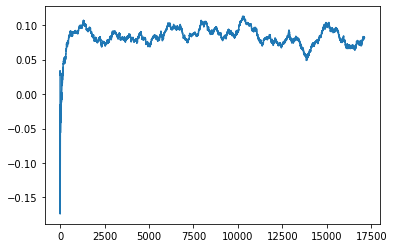

Thread: 4 iteration: 2840
RAM mDiffFit_297 FROM: 896 --> 1920 reward: -0.08498960156250002
Thread: 1 iteration: 2789
RAM mDiffFit_72 FROM: 2496 --> 192 reward: 0.23924214648437497
Thread: 5 iteration: 2927
RAM mBackground_14 FROM: 704 --> 320 reward: 0.22614189024218753
Thread: 6 iteration: 2849
RAM mDiffFit_60 FROM: 1728 --> 1920 reward: 0.00034376093749999975
Saving ...


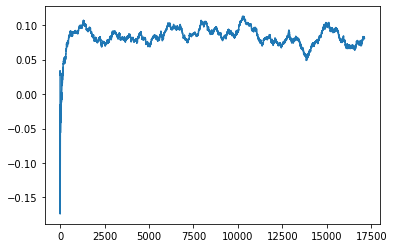

Thread: 1 iteration: 2790
RAM mDiffFit_11 FROM: 1856 --> 1408 reward: -0.03447661445312501
Saving ...


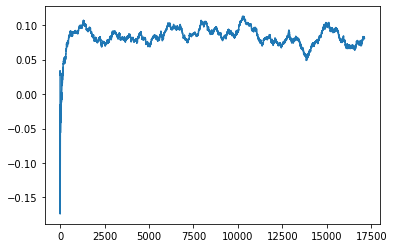

Thread: 6 iteration: 2850
RAM mDiffFit_175 FROM: 1728 --> 384 reward: 0.26175000000000004
Thread: 4 iteration: 2841
RAM mDiffFit_384 FROM: 1152 --> 192 reward: 0.21039842929687497
Thread: 5 iteration: 2928
RAM mProject_63 FROM: 3008 --> 384 reward: -1.0
Thread: 3 iteration: 2879
RAM mBackground_21 FROM: 448 --> 192 reward: 0.38057011157031245
Thread: 2 iteration: 2824
RAM mDiffFit_404 FROM: 192 --> 1920 reward: -0.21688276601562495
Thread: 1 iteration: 2791
RAM mDiffFit_381 FROM: 704 --> 1920 reward: -0.037041637500000016
Thread: 4 iteration: 2842
RAM mDiffFit_118 FROM: 1280 --> 192 reward: 0.250346349609375
Thread: 6 iteration: 2851
RAM mDiffFit_229 FROM: 2048 --> 1920 reward: 0.017062521874999993
Thread: 2 iteration: 2825
RAM mDiffFit_79 FROM: 1024 --> 192 reward: 0.19414579687499994
Thread: 5 iteration: 2929
RAM mBackground_78 FROM: 256 --> 384 reward: -0.22578135573437508
Saving ...


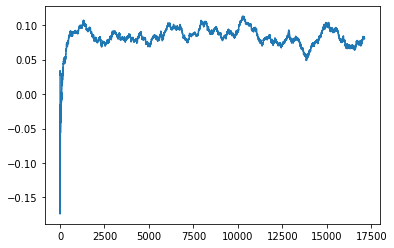

Thread: 3 iteration: 2880
RAM mDiffFit_213 FROM: 1472 --> 1920 reward: 0.020830773828124996
Thread: 4 iteration: 2843
RAM mDiffFit_47 FROM: 1152 --> 2560 reward: 0.013901105468750001
Thread: 6 iteration: 2852
RAM mDiffFit_420 FROM: 2432 --> 192 reward: 0.15607283281249998
Thread: 2 iteration: 2826
RAM mDiffFit_95 FROM: 1600 --> 1920 reward: 0.174646015625
Saving ...


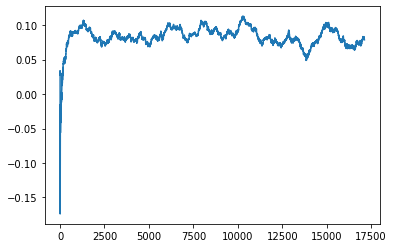

Thread: 5 iteration: 2930
RAM mDiffFit_329 FROM: 2112 --> 2560 reward: 0.03854953476562502
Thread: 6 iteration: 2853
RAM mProject_5 FROM: 448 --> 1984 reward: 0.6604628893593749
Thread: 1 iteration: 2792
RAM mBackground_40 FROM: 512 --> 1920 reward: -0.28145737545312494
Thread: 4 iteration: 2844
RAM mDiffFit_114 FROM: 1472 --> 2560 reward: 0.003507853515624989
Thread: 6 iteration: 2854
RAM mDiffFit_362 FROM: 1536 --> 1984 reward: 0.020885442187499985
Thread: 1 iteration: 2793
RAM mDiffFit_37 FROM: 896 --> 384 reward: 0.0761979203125
Thread: 2 iteration: 2827
RAM mBackground_4 FROM: 2176 --> 1920 reward: -0.08758125714062501
Thread: 5 iteration: 2931
RAM mDiffFit_189 FROM: 1344 --> 448 reward: 0.136820331640625
Thread: 6 iteration: 2855
RAM mDiffFit_277 FROM: 1664 --> 1920 reward: 0.005291681249999982
Thread: 2 iteration: 2828
RAM mDiffFit_268 FROM: 1600 --> 384 reward: 0.062130177343749995
Thread: 5 iteration: 2932
RAM mProject_89 FROM: 1408 --> 1920 reward: -0.046119313968750075
Threa

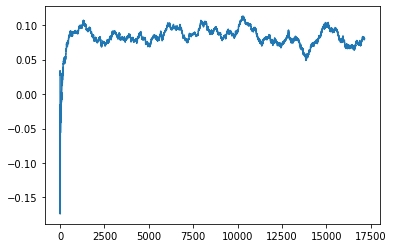

Thread: 2 iteration: 2830
RAM mProject_25 FROM: 1216 --> 384 reward: -1.0
Thread: 1 iteration: 2794
RAM mDiffFit_74 FROM: 2176 --> 2560 reward: 0.004328141406249979
Thread: 6 iteration: 2858
RAM mDiffFit_307 FROM: 704 --> 1920 reward: -0.09398960156249997
Thread: 2 iteration: 2831
RAM mDiffFit_126 FROM: 2368 --> 384 reward: 0.28034108476562497
Thread: 5 iteration: 2935
RAM mDiffFit_331 FROM: 1024 --> 1920 reward: 0.006729203125000003
Thread: 1 iteration: 2795
RAM mProject_53 FROM: 1984 --> 384 reward: -1.0
Thread: 4 iteration: 2846
RAM mDiffFit_120 FROM: 2624 --> 1920 reward: -0.011414092578125
Thread: 5 iteration: 2936
RAM mBackground_18 FROM: 1728 --> 2560 reward: 0.05873318500781254
Thread: 1 iteration: 2796
RAM mDiffFit_410 FROM: 1152 --> 448 reward: 0.237791725
Thread: 6 iteration: 2859
RAM mViewer_4 FROM: 1472 --> 1920 reward: -0.11608612924218756
Thread: 2 iteration: 2832
RAM mDiffFit_178 FROM: 1472 --> 1920 reward: 0.005658871484375029
Thread: 1 iteration: 2797
RAM mDiffFit_183

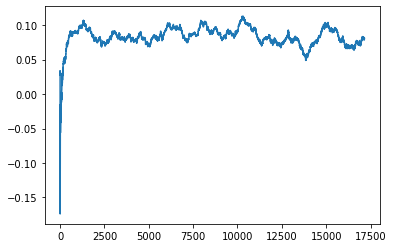

Thread: 6 iteration: 2860
RAM mProject_41 FROM: 192 --> 448 reward: -1.0
Thread: 3 iteration: 2882
RAM mDiffFit_371 FROM: 1152 --> 1920 reward: 0.04954694609374999
Thread: 1 iteration: 2798
RAM mDiffFit_313 FROM: 2560 --> 1920 reward: -0.022218804687499996
Thread: 3 iteration: 2883
RAM mProject_21 FROM: 3008 --> 1920 reward: -0.19431319739062505
Thread: 4 iteration: 2847
RAM mProject_11 FROM: 2304 --> 1920 reward: -0.06785451084374998
Thread: 5 iteration: 2937
RAM mDiffFit_398 FROM: 1088 --> 192 reward: 0.19570568632812496
Thread: 6 iteration: 2861
RAM mProject_1 FROM: 1664 --> 2560 reward: 0.09817525462499996
Thread: 2 iteration: 2833
RAM mDiffFit_186 FROM: 2240 --> 192 reward: 0.16391659374999995
Thread: 1 iteration: 2799
RAM mBackground_9 FROM: 2496 --> 1920 reward: -0.0394458588515625
Thread: 3 iteration: 2884
RAM mDiffFit_227 FROM: 1984 --> 2560 reward: 0.010179712109374996
Thread: 6 iteration: 2862
RAM mBackground_85 FROM: 1536 --> 1920 reward: 0.11675858329687501
Thread: 4 itera

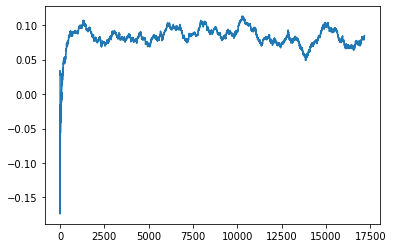

Thread: 1 iteration: 2800
RAM mProject_46 FROM: 2176 --> 1920 reward: -0.031842261984375064
Thread: 5 iteration: 2938
RAM mDiffFit_120 FROM: 960 --> 1920 reward: 0.007507853515624982
Thread: 4 iteration: 2849
RAM mDiffFit_311 FROM: 2496 --> 448 reward: 0.045413961328125
Thread: 6 iteration: 2863
RAM mDiffFit_225 FROM: 1536 --> 1920 reward: -0.06664066328125003
Thread: 2 iteration: 2835
RAM mDiffFit_264 FROM: 1728 --> 1920 reward: 0.004343760937499993
Thread: 1 iteration: 2801
RAM mDiffFit_312 FROM: 1856 --> 1920 reward: -0.02984898203125
Thread: 5 iteration: 2939
RAM mDiffFit_101 FROM: 1600 --> 1920 reward: -0.014028650390625029
Saving ...


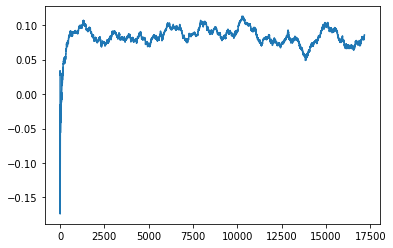

Thread: 4 iteration: 2850
RAM mBackground_62 FROM: 2880 --> 1920 reward: -0.06456059808593756
Saving ...


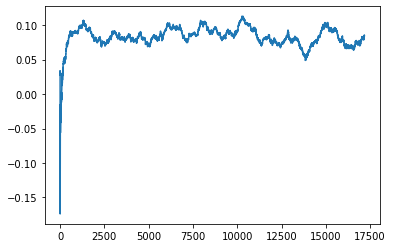

Thread: 5 iteration: 2940
RAM mProject_42 FROM: 1792 --> 256 reward: -1.0
Thread: 3 iteration: 2885
RAM mDiffFit_45 FROM: 2560 --> 384 reward: 0.09411451406249999
Thread: 1 iteration: 2802
RAM mDiffFit_38 FROM: 1280 --> 2560 reward: 0.02494800781249997
Thread: 1 iteration: 2803
RAM mDiffFit_390 FROM: 704 --> 1920 reward: -0.01740360664062501
Thread: 5 iteration: 2941
RAM mBackground_12 FROM: 1920 --> 1920 reward: -0.0035474999999999973
Thread: 3 iteration: 2886
RAM mProject_36 FROM: 2624 --> 448 reward: -1.0
Thread: 6 iteration: 2864
RAM mProject_68 FROM: 384 --> 1984 reward: 0.6505394416875
Thread: 4 iteration: 2851
RAM mDiffFit_54 FROM: 2624 --> 1920 reward: 0.011007809765624984
Thread: 1 iteration: 2804
RAM mDiffFit_26 FROM: 704 --> 1920 reward: -0.05758853984375
Thread: 3 iteration: 2887
RAM mBackground_54 FROM: 1920 --> 1920 reward: -0.017240336015624986
Thread: 5 iteration: 2942
RAM mDiffFit_276 FROM: 2688 --> 1920 reward: -0.048046946093749994
Thread: 4 iteration: 2852
RAM mDiff

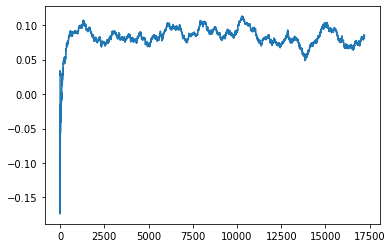

Thread: 2 iteration: 2840
RAM mProject_18 FROM: 384 --> 1920 reward: 0.640238169375
Thread: 6 iteration: 2867
RAM mDiffFit_377 FROM: 1216 --> 384 reward: 0.17174999999999999
Thread: 1 iteration: 2808
RAM mProject_23 FROM: 704 --> 2560 reward: 0.7562296490625
Thread: 3 iteration: 2889
RAM mProject_64 FROM: 3008 --> 1920 reward: -0.1991366398125
Thread: 5 iteration: 2944
RAM mProject_53 FROM: 896 --> 1920 reward: -0.28731932971875
Thread: 4 iteration: 2854
RAM mDiffFit_109 FROM: 2624 --> 448 reward: 0.11079163750000003
Thread: 2 iteration: 2841
RAM mDiffFit_56 FROM: 1152 --> 2560 reward: 0.002046946093749967
Thread: 1 iteration: 2809
RAM mDiffFit_193 FROM: 128 --> 2880 reward: 0.154562740625
Thread: 6 iteration: 2868
RAM mDiffFit_85 FROM: 128 --> 1920 reward: -0.5876978765625
Thread: 5 iteration: 2945
RAM mDiffFit_153 FROM: 576 --> 448 reward: -0.0071510617187499695
Saving ...


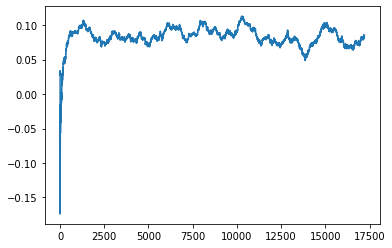

Thread: 3 iteration: 2890
RAM mDiffFit_13 FROM: 128 --> 384 reward: -0.696270884375
Thread: 4 iteration: 2855
RAM mDiffFit_376 FROM: 448 --> 448 reward: 0.015440110546875007
Thread: 2 iteration: 2842
RAM mDiffFit_52 FROM: 1536 --> 1920 reward: -0.07368756562500002
Saving ...


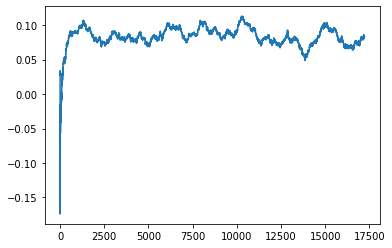

Thread: 1 iteration: 2810
RAM mDiffFit_98 FROM: 768 --> 384 reward: 0.036312478124999985
Thread: 6 iteration: 2869
RAM mDiffFit_134 FROM: 2048 --> 448 reward: 0.045002544921875
Thread: 5 iteration: 2946
RAM mDiffFit_366 FROM: 512 --> 1408 reward: -0.08612500000000001
Thread: 4 iteration: 2856
RAM mDiffFit_230 FROM: 1408 --> 448 reward: 0.12049219023437502
Thread: 3 iteration: 2891
RAM mDiffFit_335 FROM: 256 --> 448 reward: -0.228934933203125
Thread: 5 iteration: 2947
RAM mDiffFit_62 FROM: 448 --> 384 reward: -0.11518234453125001
Thread: 4 iteration: 2857
RAM mDiffFit_3 FROM: 576 --> 1920 reward: -0.06150776601562498
Thread: 3 iteration: 2892
RAM mDiffFit_40 FROM: 704 --> 192 reward: 0.182486969140625
Saving ...


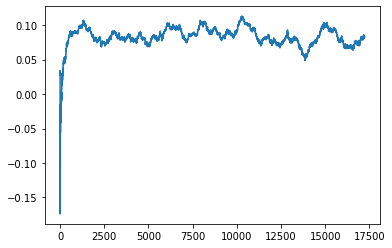

Thread: 6 iteration: 2870
RAM mBackground_66 FROM: 384 --> 384 reward: -0.19030194084374993
Thread: 2 iteration: 2843
RAM mDiffFit_328 FROM: 1344 --> 448 reward: 0.15635933671875002
Thread: 5 iteration: 2948
RAM mDiffFit_201 FROM: 256 --> 2240 reward: -0.04903106406249996
Thread: 4 iteration: 2858
RAM mDiffFit_197 FROM: 704 --> 384 reward: 0.103731791796875
Thread: 3 iteration: 2893
RAM mDiffFit_137 FROM: 1728 --> 448 reward: 0.16351303085937496
Thread: 6 iteration: 2871
RAM mDiffFit_168 FROM: 448 --> 256 reward: 0.28787504375000006
Thread: 2 iteration: 2844
RAM mProject_7 FROM: 1920 --> 448 reward: -1.0
Thread: 1 iteration: 2811
RAM mDiffFit_301 FROM: 1216 --> 448 reward: 0.09955207968750003
Thread: 4 iteration: 2859
RAM mDiffFit_403 FROM: 2816 --> 448 reward: 0.03106761171874998
Thread: 3 iteration: 2894
RAM mDiffFit_201 FROM: 2048 --> 1920 reward: 0.02477606171874999
Thread: 6 iteration: 2872
RAM mDiffFit_421 FROM: 1600 --> 384 reward: 0.092148429296875
Thread: 2 iteration: 2845
RAM

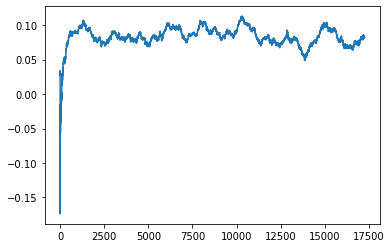

Thread: 4 iteration: 2860
RAM mBackground_8 FROM: 2816 --> 448 reward: 0.12531341851562494
Thread: 2 iteration: 2846
RAM mBackground_76 FROM: 384 --> 448 reward: -0.0961856344062501
Saving ...


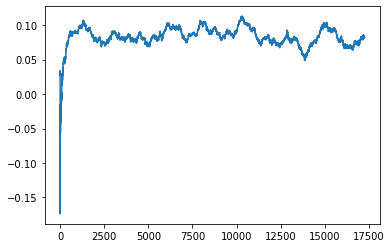

Thread: 5 iteration: 2950
RAM mProject_30 FROM: 704 --> 1984 reward: 0.6548824155234374
Thread: 1 iteration: 2812
RAM mDiffFit_221 FROM: 512 --> 448 reward: 0.08841409257812502
Thread: 3 iteration: 2896
RAM mDiffFit_195 FROM: 2560 --> 1408 reward: 0.03596876093750001
Thread: 5 iteration: 2951
RAM mDiffFit_382 FROM: 2368 --> 1408 reward: -0.012739645312499995
Thread: 6 iteration: 2874
RAM mDiffFit_164 FROM: 1344 --> 1920 reward: 0.019132853515625003
Thread: 4 iteration: 2861
RAM mDiffFit_52 FROM: 320 --> 448 reward: -0.004127588671874981
Thread: 2 iteration: 2847
RAM mDiffFit_326 FROM: 128 --> 448 reward: -0.532216172265625
Thread: 1 iteration: 2813
RAM mBackground_15 FROM: 1600 --> 1408 reward: 0.0041880098593749734
Thread: 5 iteration: 2952
RAM mDiffFit_311 FROM: 1088 --> 2560 reward: -0.011549447265625009
Thread: 2 iteration: 2848
RAM mDiffFit_270 FROM: 384 --> 384 reward: -0.11925004374999999
Thread: 3 iteration: 2897
RAM mDiffFit_350 FROM: 1984 --> 448 reward: 0.12202601796875001
T

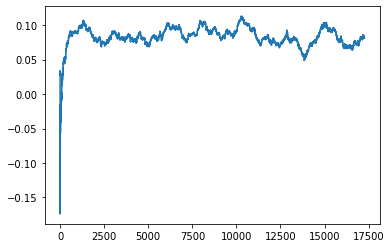

Thread: 2 iteration: 2850
RAM mDiffFit_132 FROM: 2176 --> 1920 reward: -0.03483858359375
Thread: 6 iteration: 2877
RAM mDiffFit_130 FROM: 1600 --> 384 reward: 0.16952860664062502
Thread: 1 iteration: 2815
RAM mBackground_51 FROM: 2752 --> 1408 reward: -0.026337612874999992
Thread: 3 iteration: 2899
RAM mBackground_5 FROM: 2880 --> 384 reward: 0.198243207046875
Thread: 5 iteration: 2954
RAM mBackground_72 FROM: 1920 --> 384 reward: 0.415070932796875
Thread: 4 iteration: 2864
RAM mDiffFit_241 FROM: 1408 --> 1408 reward: 0.000999999999999994
Thread: 2 iteration: 2851
RAM mDiffFit_265 FROM: 256 --> 448 reward: -0.18065106171875
Thread: 6 iteration: 2878
RAM mDiffFit_331 FROM: 1280 --> 1920 reward: -0.02180730078125001
Saving ...


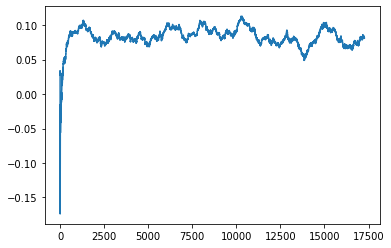

Thread: 3 iteration: 2900
RAM mDiffFit_131 FROM: 512 --> 1408 reward: -0.060453097656249996
Thread: 5 iteration: 2955
RAM mDiffFit_423 FROM: 2560 --> 448 reward: 0.071778606640625
Thread: 4 iteration: 2865
RAM mBackground_19 FROM: 1408 --> 448 reward: 0.1914350492968749
Thread: 1 iteration: 2816
RAM mDiffFit_229 FROM: 448 --> 448 reward: -0.014315110546874992
Thread: 6 iteration: 2879
RAM mViewer_2 FROM: 384 --> 1984 reward: -0.2743519692890626
Thread: 3 iteration: 2901
RAM mDiffFit_190 FROM: 1088 --> 1920 reward: -0.0012994472656250103
Thread: 1 iteration: 2817
RAM mDiffFit_300 FROM: 960 --> 1920 reward: -0.04041404882812501
Thread: 4 iteration: 2866
RAM mDiffFit_37 FROM: 2816 --> 192 reward: 0.13544256796875
Thread: 5 iteration: 2956
RAM mBackground_40 FROM: 256 --> 448 reward: -0.28030400492968743
Thread: 2 iteration: 2852
RAM mDiffFit_132 FROM: 2304 --> 192 reward: 0.17063276601562496
Saving ...


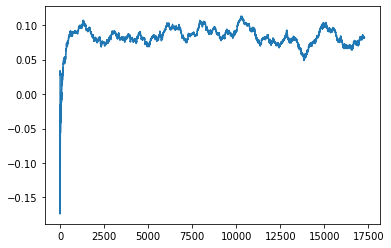

Thread: 6 iteration: 2880
RAM mDiffFit_18 FROM: 2560 --> 1920 reward: -0.04565110546875
Thread: 5 iteration: 2957
RAM mDiffFit_12 FROM: 2944 --> 448 reward: 0.14681765546875
Thread: 3 iteration: 2902
RAM mDiffFit_298 FROM: 2048 --> 384 reward: 0.10544787656249999
Thread: 4 iteration: 2867
RAM mDiffFit_156 FROM: 832 --> 448 reward: 0.1236979203125
Thread: 1 iteration: 2818
RAM mDiffFit_15 FROM: 1920 --> 192 reward: 0.22412495625
Thread: 2 iteration: 2853
RAM mDiffFit_95 FROM: 1920 --> 384 reward: 0.080062478125
Thread: 6 iteration: 2881
RAM mDiffFit_144 FROM: 2752 --> 448 reward: 0.04267181484375002
Thread: 5 iteration: 2958
RAM mDiffFit_148 FROM: 1920 --> 192 reward: 0.24717185859375002
Thread: 3 iteration: 2903
RAM mDiffFit_275 FROM: 256 --> 192 reward: -0.15146880468750007
Thread: 4 iteration: 2868
RAM mDiffFit_237 FROM: 448 --> 448 reward: -0.04669533164062502
Thread: 6 iteration: 2882
RAM mDiffFit_151 FROM: 2496 --> 448 reward: 0.13107287656250002
Thread: 5 iteration: 2959
RAM mDif

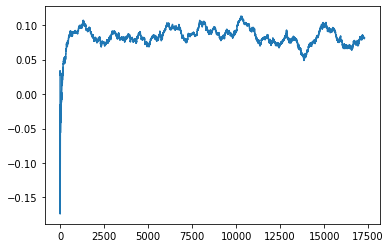

Thread: 5 iteration: 2960
RAM mDiffFit_315 FROM: 2752 --> 832 reward: 0.12480730078124999
Thread: 6 iteration: 2884
RAM mProject_41 FROM: 768 --> 384 reward: -1.0
Thread: 1 iteration: 2819
RAM mProject_16 FROM: 2880 --> 384 reward: -1.0
Thread: 2 iteration: 2854
RAM mDiffFit_327 FROM: 832 --> 1920 reward: -0.02453382773437502
Thread: 2 iteration: 2855
RAM mDiffFit_190 FROM: 2560 --> 192 reward: 0.33895564257812494
Saving ...


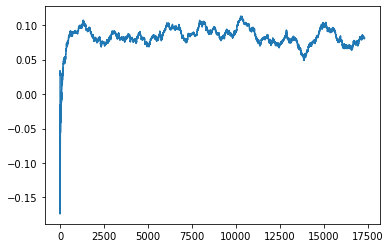

Thread: 1 iteration: 2820
RAM mProject_43 FROM: 1792 --> 448 reward: -1.0
Thread: 3 iteration: 2904
RAM mProject_3 FROM: 2560 --> 448 reward: -1.0
Thread: 4 iteration: 2869
RAM mDiffFit_87 FROM: 1152 --> 448 reward: 0.242916725
Thread: 2 iteration: 2856
RAM mDiffFit_381 FROM: 2560 --> 1984 reward: 0.005072920312500003
Thread: 3 iteration: 2905
RAM mDiffFit_93 FROM: 1024 --> 448 reward: 0.14795836250000002
Saving ...


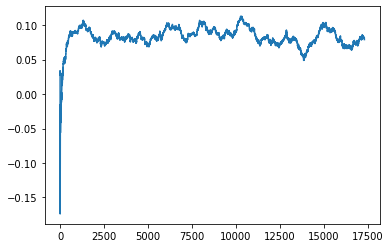

Thread: 4 iteration: 2870
RAM mProject_21 FROM: 128 --> 448 reward: -1.0
Thread: 5 iteration: 2961
RAM mDiffFit_32 FROM: 960 --> 192 reward: 0.2954687609375
Thread: 2 iteration: 2857
RAM mProject_54 FROM: 1920 --> 448 reward: -1.0
Thread: 6 iteration: 2885
RAM mDiffFit_101 FROM: 896 --> 1920 reward: -0.0017187171875000101
Thread: 3 iteration: 2906
RAM mDiffFit_49 FROM: 576 --> 1920 reward: -0.06557809765625003
Thread: 2 iteration: 2858
RAM mDiffFit_7 FROM: 1472 --> 448 reward: 0.26100526484375
Thread: 5 iteration: 2962
RAM mDiffFit_140 FROM: 2688 --> 1920 reward: -0.013281282812499995
Thread: 3 iteration: 2907
RAM mBackground_21 FROM: 256 --> 448 reward: -0.47342332122656244
Thread: 4 iteration: 2871
RAM mProject_49 FROM: 256 --> 1088 reward: 0.8254867268671876
Thread: 1 iteration: 2821
RAM mDiffFit_173 FROM: 1088 --> 1920 reward: -0.000973938281250003
Thread: 3 iteration: 2908
RAM mBackground_2 FROM: 576 --> 1984 reward: -0.15453341982031252
Thread: 2 iteration: 2859
RAM mDiffFit_31 F

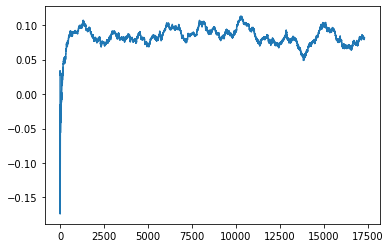

Thread: 2 iteration: 2860
RAM mDiffFit_179 FROM: 1792 --> 2560 reward: 0.035156326562499965
Thread: 1 iteration: 2823
RAM mProject_81 FROM: 2112 --> 1920 reward: -0.04228320178124993
Thread: 5 iteration: 2963
RAM mProject_55 FROM: 1024 --> 192 reward: -1.0
Thread: 6 iteration: 2886
RAM mDiffFit_154 FROM: 1344 --> 1920 reward: -0.09167194609374998
Thread: 4 iteration: 2874
RAM mDiffFit_212 FROM: 2944 --> 1920 reward: -0.08980221093750002
Thread: 2 iteration: 2861
RAM mDiffFit_107 FROM: 2624 --> 448 reward: 0.10623692539062499
Thread: 1 iteration: 2824
RAM mProject_31 FROM: 1984 --> 1408 reward: 0.039140546906250004
Thread: 3 iteration: 2909
RAM mBackground_76 FROM: 1536 --> 192 reward: 0.7112199623749998
Thread: 5 iteration: 2964
RAM mDiffFit_184 FROM: 1472 --> 1920 reward: 0.007885442187499994
Thread: 4 iteration: 2875
RAM mBackground_45 FROM: 448 --> 192 reward: 0.8378886572421874
Thread: 6 iteration: 2887
RAM mDiffFit_196 FROM: 3008 --> 1920 reward: -0.016867233984374994
Thread: 2 it

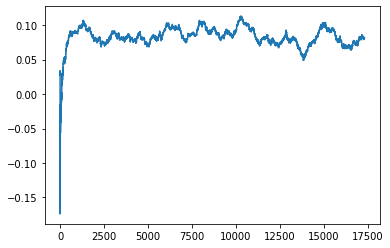

Thread: 3 iteration: 2910
RAM mBackground_50 FROM: 1152 --> 2624 reward: 0.06205232746093753
Thread: 1 iteration: 2825
RAM mBackground_5 FROM: 768 --> 1920 reward: -0.12737402957812502
Thread: 4 iteration: 2876
RAM mDiffFit_215 FROM: 1344 --> 1088 reward: 0.009059889453125
Thread: 6 iteration: 2888
RAM mDiffFit_318 FROM: 2944 --> 1920 reward: -0.023916725000000007
Thread: 2 iteration: 2863
RAM mDiffFit_260 FROM: 320 --> 448 reward: -0.018406239062499982
Thread: 3 iteration: 2911
RAM mDiffFit_388 FROM: 1152 --> 384 reward: 0.08226561953125
Thread: 1 iteration: 2826
RAM mBackground_26 FROM: 128 --> 192 reward: 1.1750625765546876
Thread: 5 iteration: 2965
RAM mDiffFit_161 FROM: 192 --> 1920 reward: -0.3485624781250001
Thread: 4 iteration: 2877
RAM mDiffFit_89 FROM: 1728 --> 1920 reward: 0.021648473046874984
Thread: 2 iteration: 2864
RAM mDiffFit_401 FROM: 1344 --> 2560 reward: -0.0063801773437499945
Thread: 3 iteration: 2912
RAM mDiffFit_337 FROM: 2496 --> 1920 reward: 0.02535938046874998

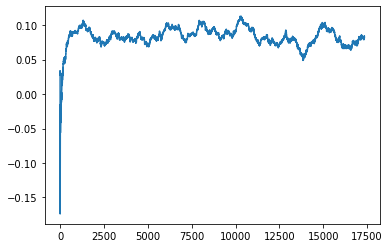

Thread: 6 iteration: 2890
RAM mBackground_78 FROM: 1984 --> 192 reward: 0.9015868033203125
Saving ...


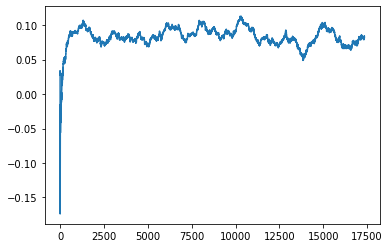

Thread: 1 iteration: 2830
RAM mProject_20 FROM: 1024 --> 1088 reward: -0.03092296858593749
Thread: 5 iteration: 2967
RAM mBackground_73 FROM: 2752 --> 448 reward: 0.21667283471093754
Thread: 2 iteration: 2866
RAM mBackground_11 FROM: 320 --> 384 reward: -0.03284794758593749
Thread: 4 iteration: 2879
RAM mDiffFit_394 FROM: 384 --> 448 reward: -0.19202610546874999
Thread: 6 iteration: 2891
RAM mDiffFit_280 FROM: 2496 --> 192 reward: 0.345398385546875
Thread: 3 iteration: 2915
RAM mDiffFit_402 FROM: 512 --> 448 reward: 0.009177079687499971
Thread: 1 iteration: 2831
RAM mDiffFit_7 FROM: 1920 --> 1920 reward: 0.022921902343750016
Thread: 2 iteration: 2867
RAM mDiffFit_25 FROM: 448 --> 2560 reward: -0.11230984570312502
Saving ...


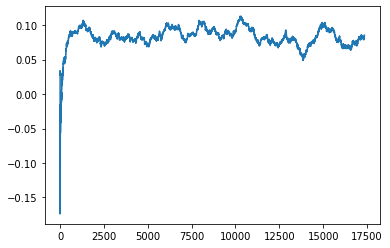

Thread: 4 iteration: 2880
RAM mBackground_13 FROM: 1920 --> 768 reward: 0.21122410482812504
Thread: 5 iteration: 2968
RAM mDiffFit_12 FROM: 2560 --> 384 reward: 0.13670309765625002
Thread: 1 iteration: 2832
RAM mDiffFit_261 FROM: 2624 --> 1920 reward: 0.012257809765624968
Thread: 5 iteration: 2969
RAM mBackground_36 FROM: 1920 --> 384 reward: 0.34590809678124995
Thread: 6 iteration: 2892
RAM mBackground_38 FROM: 3008 --> 1408 reward: -0.03416051116406247
Thread: 1 iteration: 2833
RAM mProject_88 FROM: 448 --> 1920 reward: 0.6447241117968749
Thread: 3 iteration: 2916
RAM mBackground_70 FROM: 1024 --> 384 reward: 0.22734902957812492
Saving ...


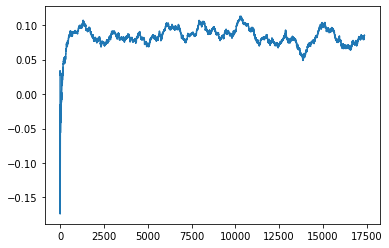

Thread: 5 iteration: 2970
RAM mDiffFit_421 FROM: 1472 --> 448 reward: -0.003096437109374982
Thread: 6 iteration: 2893
RAM mDiffFit_6 FROM: 768 --> 448 reward: 0.06927865039062502
Thread: 1 iteration: 2834
RAM mProject_12 FROM: 2880 --> 1408 reward: -0.10085427850781245
Thread: 2 iteration: 2868
RAM mDiffFit_190 FROM: 1536 --> 1920 reward: 0.010812521874999995
Thread: 5 iteration: 2971
RAM mDiffFit_383 FROM: 2304 --> 448 reward: 0.053617146484375
Thread: 6 iteration: 2894
RAM mProject_46 FROM: 2112 --> 448 reward: -1.0
Thread: 4 iteration: 2881
RAM mDiffFit_404 FROM: 2240 --> 448 reward: 0.09316922617187502
Thread: 1 iteration: 2835
RAM mDiffFit_245 FROM: 128 --> 192 reward: -0.26266668125
Thread: 2 iteration: 2869
RAM mBackground_68 FROM: 896 --> 2560 reward: -0.029392175656249995
Thread: 5 iteration: 2972
RAM mDiffFit_232 FROM: 896 --> 448 reward: 0.05536977890624999
Thread: 6 iteration: 2895
RAM mDiffFit_169 FROM: 1472 --> 1920 reward: -0.030518251953125006
Saving ...


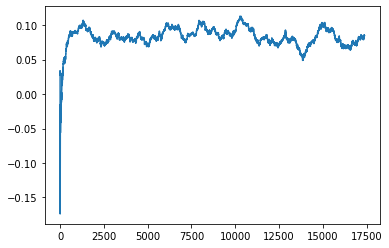

Thread: 2 iteration: 2870
RAM mDiffFit_346 FROM: 2688 --> 448 reward: 0.13852334179687498
Thread: 4 iteration: 2882
RAM mDiffFit_14 FROM: 192 --> 448 reward: -0.12916404882812496
Thread: 6 iteration: 2896
RAM mDiffFit_264 FROM: 1984 --> 448 reward: 0.21835420312500003
Thread: 2 iteration: 2871
RAM mProject_12 FROM: 3008 --> 384 reward: -1.0
Thread: 3 iteration: 2917
RAM mBackground_20 FROM: 1536 --> 1920 reward: 0.005818470421874994
Thread: 2 iteration: 2872
RAM mDiffFit_268 FROM: 1856 --> 448 reward: 0.11354685859375
Thread: 6 iteration: 2897
RAM mBackground_8 FROM: 1920 --> 1088 reward: 0.0668537934609375
Thread: 3 iteration: 2918
RAM mDiffFit_30 FROM: 384 --> 448 reward: 0.04609117226562497
Thread: 2 iteration: 2873
RAM mProject_57 FROM: 2496 --> 192 reward: -1.0
Thread: 1 iteration: 2836
RAM mViewer_1 FROM: 1024 --> 384 reward: 0.25067623556250007
Thread: 3 iteration: 2919
RAM mDiffFit_253 FROM: 1536 --> 256 reward: 0.696479203125
Thread: 6 iteration: 2898
RAM mDiffFit_36 FROM: 160

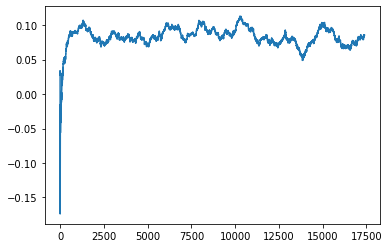

Thread: 3 iteration: 2920
RAM mProject_59 FROM: 2112 --> 1920 reward: -0.04322679602343747
Thread: 1 iteration: 2837
RAM mBackground_5 FROM: 576 --> 1920 reward: -0.16527447716406243
Thread: 5 iteration: 2974
RAM mDiffFit_393 FROM: 1664 --> 448 reward: 0.08410152695312503
Saving ...


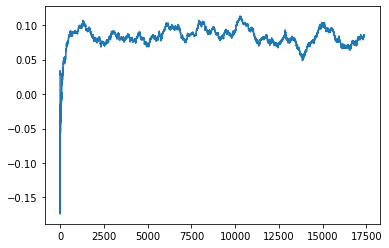

Thread: 6 iteration: 2900
RAM mDiffFit_211 FROM: 960 --> 1984 reward: -0.02975780976562501
Thread: 4 iteration: 2884
RAM mDiffFit_122 FROM: 2240 --> 448 reward: 0.044098894531249995
Thread: 3 iteration: 2921
RAM mProject_6 FROM: 2624 --> 448 reward: -1.0
Thread: 2 iteration: 2874
RAM mDiffFit_411 FROM: 1856 --> 1408 reward: -0.020270884375000013
Thread: 3 iteration: 2922
RAM mDiffFit_168 FROM: 2752 --> 448 reward: 0.07292703593750002
Thread: 5 iteration: 2975
RAM mDiffFit_177 FROM: 2944 --> 448 reward: -0.26847700820312503
Thread: 4 iteration: 2885
RAM mDiffFit_199 FROM: 448 --> 1408 reward: -0.20838285351562502
Thread: 2 iteration: 2875
RAM mDiffFit_279 FROM: 576 --> 384 reward: 0.17680471210937493
Thread: 6 iteration: 2901
RAM mBackground_11 FROM: 1600 --> 1984 reward: -0.031477350804687526
Thread: 2 iteration: 2876
RAM mDiffFit_423 FROM: 960 --> 448 reward: 0.07278904882812501
Thread: 3 iteration: 2923
RAM mDiffFit_178 FROM: 1216 --> 448 reward: 0.13377606171875003
Thread: 6 iterati

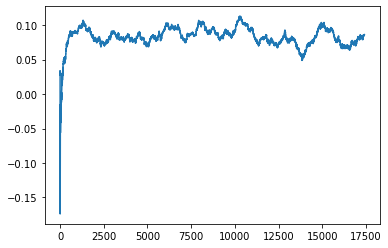

Thread: 1 iteration: 2840
RAM mDiffFit_337 FROM: 640 --> 1920 reward: -0.13764579687500003
Thread: 4 iteration: 2889
RAM mProject_59 FROM: 2432 --> 1920 reward: -0.085937987390625
Thread: 2 iteration: 2878
RAM mDiffFit_281 FROM: 576 --> 192 reward: 0.325804712109375
Thread: 6 iteration: 2905
RAM mDiffFit_134 FROM: 896 --> 448 reward: 0.04699477890624999
Saving ...


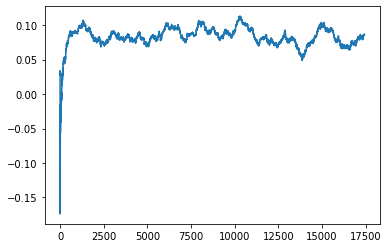

Thread: 4 iteration: 2890
RAM mDiffFit_382 FROM: 2048 --> 1984 reward: -0.026192742968750033
Thread: 6 iteration: 2906
RAM mBackground_16 FROM: 960 --> 448 reward: 0.25866069667968744
Thread: 1 iteration: 2841
RAM mDiffFit_66 FROM: 1472 --> 192 reward: 0.15982283281249998
Thread: 2 iteration: 2879
RAM mBgModel_2 FROM: 1600 --> 320 reward: 0.7148375218750002
Thread: 3 iteration: 2926
RAM mDiffFit_408 FROM: 1856 --> 2560 reward: 0.01617712343750001
Thread: 4 iteration: 2891
RAM mDiffFit_212 FROM: 2688 --> 448 reward: 0.10298433671874999
Thread: 1 iteration: 2842
RAM mDiffFit_112 FROM: 2304 --> 384 reward: 0.10770309765625001
Thread: 6 iteration: 2907
RAM mProject_65 FROM: 1728 --> 1408 reward: 0.09545345817187496
Thread: 5 iteration: 2979
RAM mDiffFit_374 FROM: 1280 --> 1920 reward: 0.021354203125000006
Thread: 1 iteration: 2843
RAM mDiffFit_401 FROM: 192 --> 256 reward: -0.06151561953125006
Thread: 4 iteration: 2892
RAM mDiffFit_306 FROM: 1664 --> 1408 reward: -0.025015663281249996
Thre

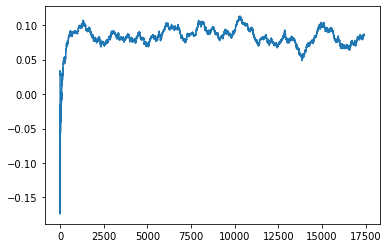

Thread: 5 iteration: 2980
RAM mDiffFit_398 FROM: 1088 --> 448 reward: 0.04379944726562498
Thread: 1 iteration: 2844
RAM mDiffFit_58 FROM: 2240 --> 1920 reward: -0.04809380468749999
Thread: 5 iteration: 2981
RAM mProject_77 FROM: 384 --> 1088 reward: 0.8182201587890625
Saving ...


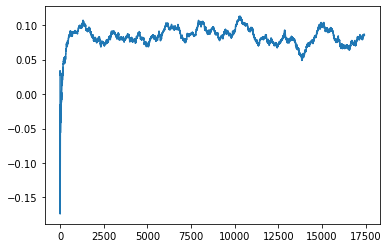

Thread: 2 iteration: 2880
RAM mDiffFit_46 FROM: 2368 --> 320 reward: 0.22489061953125
Thread: 4 iteration: 2893
RAM mProject_71 FROM: 2944 --> 448 reward: -1.0
Thread: 3 iteration: 2927
RAM mDiffFit_421 FROM: 448 --> 1920 reward: -0.07751039843749999
Thread: 4 iteration: 2894
RAM mDiffFit_204 FROM: 832 --> 1920 reward: -0.023283827734375002
Thread: 2 iteration: 2881
RAM mDiffFit_79 FROM: 2112 --> 448 reward: 0.07587495624999997
Thread: 5 iteration: 2982
RAM mDiffFit_84 FROM: 1536 --> 1088 reward: 0.061669313671874997
Thread: 3 iteration: 2928
RAM mDiffFit_416 FROM: 768 --> 448 reward: 0.0414062390625
Thread: 4 iteration: 2895
RAM mDiffFit_183 FROM: 2816 --> 448 reward: 0.13975767851562498
Thread: 2 iteration: 2882
RAM mProject_84 FROM: 1984 --> 1920 reward: -0.021979719984375024
Thread: 1 iteration: 2845
RAM mProject_25 FROM: 960 --> 384 reward: -1.0
Thread: 6 iteration: 2909
RAM mDiffFit_218 FROM: 512 --> 448 reward: 0.011919269921875
Thread: 3 iteration: 2929
RAM mDiffFit_120 FROM: 1

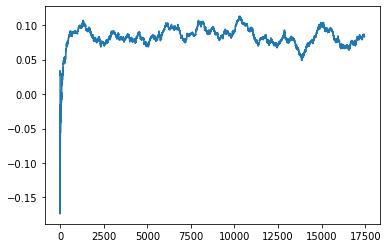

Thread: 6 iteration: 2910
RAM mDiffFit_50 FROM: 384 --> 1984 reward: -0.17382283281249997
Thread: 2 iteration: 2884
RAM mBackground_55 FROM: 2880 --> 384 reward: 0.24553652827343744
Thread: 4 iteration: 2897
RAM mProject_64 FROM: 768 --> 448 reward: -1.0
Thread: 5 iteration: 2983
RAM mBackground_66 FROM: 448 --> 320 reward: 0.22055419175
Thread: 1 iteration: 2847
RAM mProject_89 FROM: 704 --> 1920 reward: 0.64995255421875
Saving ...


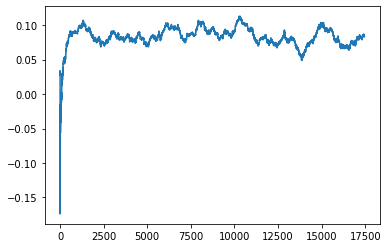

Thread: 3 iteration: 2930
RAM mDiffFit_384 FROM: 2048 --> 384 reward: 0.09483849609374999
Thread: 2 iteration: 2885
RAM mBackground_78 FROM: 384 --> 448 reward: -0.10903412947656248
Thread: 4 iteration: 2898
RAM mDiffFit_423 FROM: 2624 --> 192 reward: 0.21064838554687498
Thread: 5 iteration: 2984
RAM mDiffFit_418 FROM: 2880 --> 448 reward: 0.04418743437500001
Thread: 1 iteration: 2848
RAM mDiffFit_305 FROM: 1344 --> 448 reward: -0.037976658203124986
Thread: 2 iteration: 2886
RAM mDiffFit_350 FROM: 1728 --> 192 reward: 0.410437521875
Thread: 3 iteration: 2931
RAM mDiffFit_216 FROM: 768 --> 320 reward: 0.017148385546875006
Thread: 4 iteration: 2899
RAM mDiffFit_350 FROM: 2432 --> 1088 reward: 0.017658827734374997
Thread: 1 iteration: 2849
RAM mDiffFit_272 FROM: 2432 --> 1920 reward: -0.07898968906249998
Thread: 2 iteration: 2887
RAM mDiffFit_337 FROM: 1664 --> 448 reward: 0.12641396132812507
Thread: 5 iteration: 2985
RAM mBackground_42 FROM: 1152 --> 448 reward: 0.21709400492968753
Threa

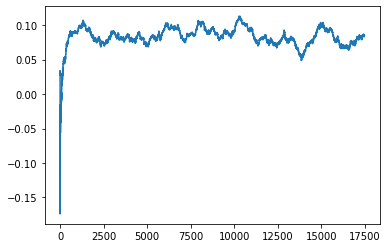

Thread: 4 iteration: 2900
RAM mDiffFit_272 FROM: 832 --> 384 reward: 0.005671814843749984
Thread: 3 iteration: 2933
RAM mBackground_54 FROM: 1728 --> 448 reward: 0.29466866891406246
Thread: 5 iteration: 2986
RAM mDiffFit_31 FROM: 2048 --> 1088 reward: 0.02036196914062498
Thread: 2 iteration: 2889
RAM mDiffFit_307 FROM: 2176 --> 1408 reward: 0.0036510179687499963
Thread: 4 iteration: 2901
RAM mProject_53 FROM: 3008 --> 192 reward: -1.0
Thread: 6 iteration: 2911
RAM mDiffFit_203 FROM: 640 --> 1984 reward: -0.06738280976562501
Thread: 3 iteration: 2934
RAM mBgModel_3 FROM: 1344 --> 192 reward: -0.07551275812499997
Thread: 5 iteration: 2987
RAM mDiffFit_107 FROM: 1920 --> 1920 reward: 0.0023749999999999986
Thread: 5 iteration: 2988
RAM mDiffFit_415 FROM: 1280 --> 192 reward: 0.216367190234375
Saving ...


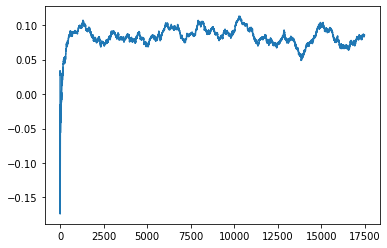

Thread: 2 iteration: 2890
RAM mDiffFit_217 FROM: 960 --> 384 reward: 0.163054712109375
Thread: 3 iteration: 2935
RAM mDiffFit_167 FROM: 256 --> 192 reward: 0.07474999999999998
Thread: 4 iteration: 2902
RAM mProject_53 FROM: 2304 --> 448 reward: -1.0
Saving ...


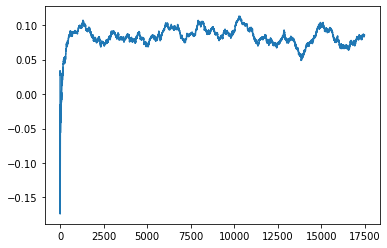

Thread: 1 iteration: 2850
RAM mProject_48 FROM: 1216 --> 1920 reward: -0.1309021491093749
Thread: 6 iteration: 2912
RAM mDiffFit_95 FROM: 256 --> 2240 reward: -0.36261973515625
Thread: 3 iteration: 2936
RAM mBackground_33 FROM: 704 --> 768 reward: -0.05430991307812501
Thread: 2 iteration: 2891
RAM mDiffFit_401 FROM: 704 --> 1152 reward: -0.08311719023437497
Thread: 5 iteration: 2989
RAM mDiffFit_278 FROM: 2752 --> 384 reward: 0.09627338554687502
Thread: 6 iteration: 2913
RAM mDiffFit_19 FROM: 1152 --> 192 reward: 0.23288280976562495
Saving ...


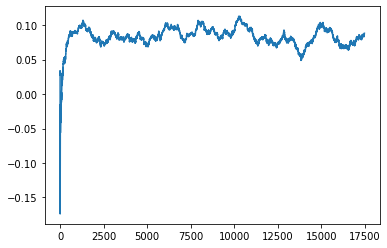

Thread: 5 iteration: 2990
RAM mBackground_51 FROM: 2368 --> 448 reward: 0.23498817072656253
Thread: 2 iteration: 2892
RAM mDiffFit_328 FROM: 576 --> 192 reward: 0.41203123906249994
Thread: 6 iteration: 2914
RAM mDiffFit_66 FROM: 1280 --> 1920 reward: 0.04490110546875001
Thread: 5 iteration: 2991
RAM mProject_32 FROM: 832 --> 192 reward: -1.0
Thread: 1 iteration: 2851
RAM mDiffFit_193 FROM: 192 --> 1408 reward: -0.346236969140625
Thread: 6 iteration: 2915
RAM mDiffFit_239 FROM: 1920 --> 192 reward: 0.45732015664062486
Thread: 2 iteration: 2893
RAM mDiffFit_237 FROM: 2560 --> 448 reward: 0.13426303085937502
Thread: 5 iteration: 2992
RAM mDiffFit_92 FROM: 832 --> 448 reward: 0.00525517734374998
Thread: 1 iteration: 2852
RAM mBackground_15 FROM: 256 --> 2240 reward: 0.28576220421875
Thread: 6 iteration: 2916
RAM mBackground_67 FROM: 1600 --> 448 reward: -1.0
Thread: 4 iteration: 2903
RAM mDiffFit_309 FROM: 1728 --> 384 reward: 0.118187478125
Thread: 5 iteration: 2993
RAM mDiffFit_365 FROM:

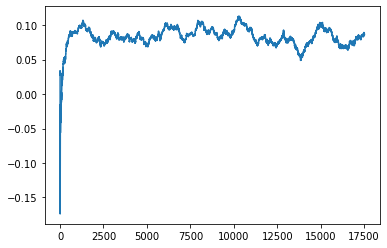

Thread: 6 iteration: 2920
RAM mDiffFit_318 FROM: 896 --> 192 reward: 0.16391141640625
Thread: 5 iteration: 2997
RAM mProject_1 FROM: 2752 --> 192 reward: -1.0
Thread: 1 iteration: 2856
RAM mProject_82 FROM: 2304 --> 448 reward: -1.0
Saving ...


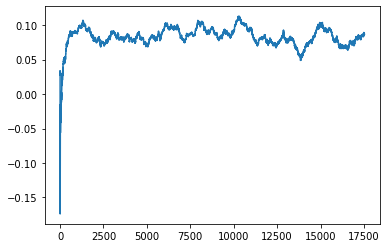

Thread: 3 iteration: 2940
RAM mDiffFit_408 FROM: 1536 --> 192 reward: 0.216523429296875
Thread: 6 iteration: 2921
RAM mDiffFit_120 FROM: 192 --> 448 reward: -0.09903382773437497
Thread: 1 iteration: 2857
RAM mBackground_7 FROM: 1792 --> 448 reward: 0.2657780345078125
Saving ...


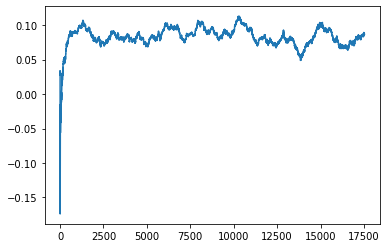

Thread: 2 iteration: 2900
RAM mDiffFit_243 FROM: 704 --> 192 reward: 0.579919313671875
Thread: 5 iteration: 2998
RAM mDiffFit_96 FROM: 1664 --> 1984 reward: 0.009796902343749987
Thread: 3 iteration: 2941
RAM mDiffFit_200 FROM: 896 --> 2880 reward: -0.025140532031250017
Thread: 1 iteration: 2858
RAM mDiffFit_6 FROM: 2880 --> 192 reward: 0.39807028789062504
Thread: 6 iteration: 2922
RAM mDiffFit_191 FROM: 2176 --> 448 reward: 0.125747367578125
Thread: 2 iteration: 2901
RAM mProject_24 FROM: 2304 --> 192 reward: -1.0
Saving ...


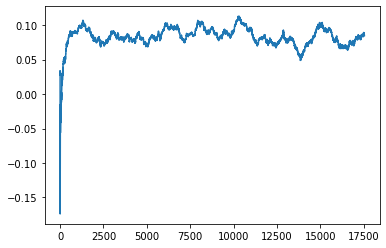

Thread: 4 iteration: 2910
RAM mDiffFit_399 FROM: 1984 --> 192 reward: 0.330854115625
Thread: 6 iteration: 2923
RAM mBackground_31 FROM: 1472 --> 1984 reward: -0.060784552414062526
Thread: 1 iteration: 2859
RAM mBackground_24 FROM: 1984 --> 192 reward: 0.7220393526171874
Thread: 3 iteration: 2942
RAM mDiffFit_58 FROM: 2816 --> 384 reward: 0.11774995625
Thread: 6 iteration: 2924
RAM mBackground_46 FROM: 2304 --> 2880 reward: 0.06396261287500005
Saving ...


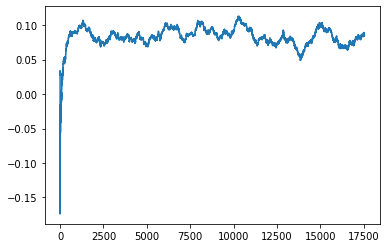

Thread: 1 iteration: 2860
RAM mDiffFit_156 FROM: 2368 --> 448 reward: 0.1682603546875
Thread: 3 iteration: 2943
RAM mDiffFit_68 FROM: 1088 --> 384 reward: 0.07418747812499996
Thread: 4 iteration: 2911
RAM mDiffFit_293 FROM: 1856 --> 832 reward: 0.138820375390625
Thread: 6 iteration: 2925
RAM mDiffFit_308 FROM: 1664 --> 2560 reward: 0.016140663281250002
Thread: 3 iteration: 2944
RAM mDiffFit_56 FROM: 1152 --> 448 reward: 0.17941926992187496
Thread: 1 iteration: 2861
RAM mProject_85 FROM: 2688 --> 192 reward: -1.0
Thread: 2 iteration: 2902
RAM mConcatFit_2 FROM: 2112 --> 1920 reward: 0.01319999999999999
Thread: 2 iteration: 2903
RAM mDiffFit_72 FROM: 2880 --> 192 reward: 0.2614999125
Thread: 1 iteration: 2862
RAM mDiffFit_145 FROM: 896 --> 192 reward: 0.4719948226562499
Thread: 3 iteration: 2945
RAM mBackground_52 FROM: 2688 --> 320 reward: 0.3953848495
Thread: 6 iteration: 2926
RAM mDiffFit_349 FROM: 832 --> 1984 reward: 0.01588807460937501
Thread: 2 iteration: 2904
RAM mDiffFit_146 FRO

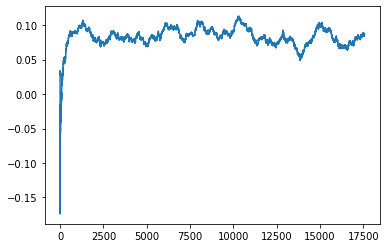

Thread: 5 iteration: 3000
RAM mDiffFit_24 FROM: 448 --> 448 reward: -0.059135442187500005
Thread: 1 iteration: 2864
RAM mBackground_75 FROM: 1664 --> 448 reward: -1.0
Thread: 4 iteration: 2912
RAM mDiffFit_409 FROM: 2112 --> 2560 reward: 0.0040703316406249905
Thread: 6 iteration: 2929
RAM mDiffFit_131 FROM: 768 --> 1088 reward: 0.011796902343750009
Thread: 1 iteration: 2865
RAM mDiffFit_407 FROM: 2624 --> 448 reward: 0.06854159374999999
Thread: 5 iteration: 3001
RAM mDiffFit_84 FROM: 2304 --> 192 reward: 0.28070309765625
Thread: 4 iteration: 2913
RAM mDiffFit_331 FROM: 320 --> 192 reward: 0.11884371718750002
Thread: 3 iteration: 2948
RAM mDiffFit_312 FROM: 2304 --> 448 reward: 0.036085863671874996
Thread: 5 iteration: 3002
RAM mProject_14 FROM: 1600 --> 192 reward: -1.0
Thread: 2 iteration: 2905
RAM mDiffFit_239 FROM: 1984 --> 192 reward: 0.700106748046875
Saving ...


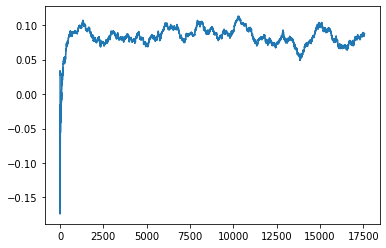

Thread: 6 iteration: 2930
RAM mDiffFit_353 FROM: 1024 --> 2240 reward: 0.010468804687500007
Thread: 2 iteration: 2906
RAM mBackground_19 FROM: 576 --> 192 reward: 0.6690799999999999
Thread: 3 iteration: 2949
RAM mDiffFit_16 FROM: 2112 --> 384 reward: 0.17386719023437502
Thread: 6 iteration: 2931
RAM mDiffFit_29 FROM: 320 --> 448 reward: -0.304362056640625
Saving ...


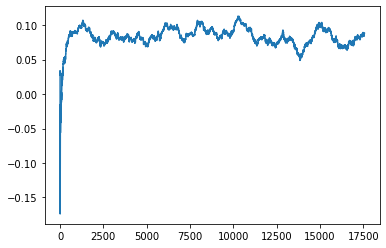

Thread: 3 iteration: 2950
RAM mDiffFit_53 FROM: 1472 --> 384 reward: 0.109854159375
Thread: 6 iteration: 2932
RAM mDiffFit_61 FROM: 1536 --> 192 reward: 0.21024995625
Thread: 3 iteration: 2951
RAM mDiffFit_393 FROM: 832 --> 384 reward: 0.08343488945312502
Thread: 3 iteration: 2952
RAM mProject_78 FROM: 896 --> 320 reward: -1.0
Thread: 1 iteration: 2866
RAM mProject_87 FROM: 256 --> 384 reward: -1.0
Thread: 5 iteration: 3003
RAM mDiffFit_56 FROM: 2112 --> 1408 reward: 0.029000000000000033
Thread: 3 iteration: 2953
RAM mDiffFit_269 FROM: 128 --> 384 reward: -0.4925833625
Thread: 1 iteration: 2867
RAM mProject_29 FROM: 1344 --> 192 reward: -1.0
Thread: 2 iteration: 2907
RAM mBackground_41 FROM: 640 --> 1408 reward: -0.153550298390625
Thread: 5 iteration: 3004
RAM mProject_7 FROM: 256 --> 1920 reward: 0.643689111796875
Thread: 4 iteration: 2914
RAM mDiffFit_377 FROM: 2752 --> 256 reward: 0.5225208406249999
Thread: 1 iteration: 2868
RAM mBackground_89 FROM: 192 --> 1920 reward: -1.0
Thread:

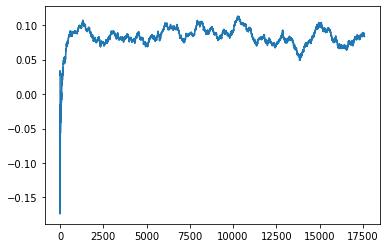

Thread: 2 iteration: 2910
RAM mDiffFit_399 FROM: 896 --> 320 reward: 0.17613803085937504
Thread: 6 iteration: 2935
RAM mDiffFit_211 FROM: 1216 --> 192 reward: 0.20039316445312505
Saving ...


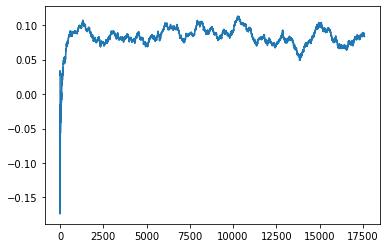

Thread: 1 iteration: 2870
RAM mDiffFit_244 FROM: 1024 --> 2560 reward: 0.03033340625000002
Thread: 3 iteration: 2955
RAM mDiffFit_331 FROM: 2368 --> 192 reward: 0.20162495625
Thread: 4 iteration: 2917
RAM mBackground_40 FROM: 1664 --> 1920 reward: -0.0018677983906249696
Thread: 2 iteration: 2911
RAM mDiffFit_248 FROM: 1856 --> 192 reward: 0.22594787656249998
Thread: 5 iteration: 3008
RAM mDiffFit_47 FROM: 3008 --> 384 reward: 0.1110728328125
Thread: 4 iteration: 2918
RAM mBackground_41 FROM: 1536 --> 448 reward: 0.24539559678124995
Thread: 6 iteration: 2936
RAM mDiffFit_327 FROM: 2880 --> 192 reward: 0.31311714648437505
Thread: 1 iteration: 2871
RAM mBackground_53 FROM: 2752 --> 1920 reward: -0.01259995070312493
Thread: 5 iteration: 3009
RAM mDiffFit_240 FROM: 2880 --> 448 reward: 0.03631243437500001
Thread: 6 iteration: 2937
RAM mDiffFit_382 FROM: 1664 --> 384 reward: 0.15484367343749997
Thread: 4 iteration: 2919
RAM mDiffFit_419 FROM: 1216 --> 192 reward: 0.48608599492187493
Thread: 

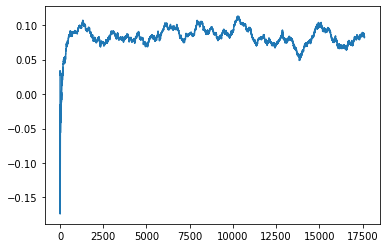

Thread: 5 iteration: 3010
RAM mProject_27 FROM: 2496 --> 448 reward: -1.0
Thread: 3 iteration: 2956
RAM mDiffFit_130 FROM: 960 --> 448 reward: 0.18807814140625
Thread: 1 iteration: 2873
RAM mDiffFit_351 FROM: 1472 --> 448 reward: 0.032700465234375004
Thread: 2 iteration: 2913
RAM mDiffFit_117 FROM: 2176 --> 1920 reward: 0.020578141406249976
Thread: 5 iteration: 3011
RAM mDiffFit_391 FROM: 2304 --> 320 reward: 0.312507766015625
Thread: 3 iteration: 2957
RAM mDiffFit_43 FROM: 2496 --> 2240 reward: -0.0021666812499999966
Thread: 5 iteration: 3012
RAM mDiffFit_414 FROM: 2944 --> 384 reward: -0.050182519531250004
Thread: 2 iteration: 2914
RAM mDiffFit_19 FROM: 2304 --> 192 reward: 0.19957805390625
Thread: 5 iteration: 3013
RAM mDiffFit_18 FROM: 896 --> 192 reward: 0.33873179179687496
Thread: 3 iteration: 2958
RAM mProject_41 FROM: 384 --> 192 reward: -1.0
Thread: 6 iteration: 2938
RAM mProject_41 FROM: 896 --> 448 reward: -1.0
Saving ...


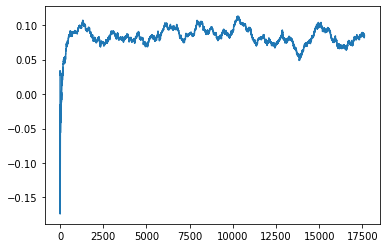

Thread: 4 iteration: 2920
RAM mDiffFit_246 FROM: 2560 --> 384 reward: 0.1132187171875
Thread: 3 iteration: 2959
RAM mBackground_45 FROM: 896 --> 2560 reward: -0.004685060968749942
Thread: 6 iteration: 2939
RAM mDiffFit_95 FROM: 2112 --> 448 reward: 0.07599995624999997
Thread: 4 iteration: 2921
RAM mDiffFit_316 FROM: 1536 --> 192 reward: 0.126148341796875
Thread: 5 iteration: 3014
RAM mProject_6 FROM: 2368 --> 448 reward: -1.0
Thread: 1 iteration: 2874
RAM mDiffFit_191 FROM: 2048 --> 384 reward: 0.03142177109374998
Saving ...


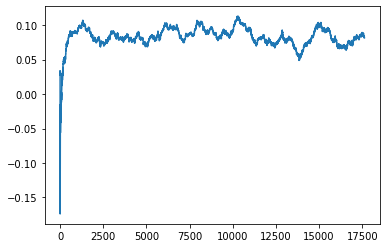

Thread: 3 iteration: 2960
RAM mDiffFit_9 FROM: 2688 --> 448 reward: 0.060229115625
Thread: 5 iteration: 3015
RAM mProject_56 FROM: 2496 --> 384 reward: -1.0
Thread: 2 iteration: 2915
RAM mDiffFit_40 FROM: 2752 --> 1920 reward: 0.027320331640625015
Thread: 3 iteration: 2961
RAM mDiffFit_323 FROM: 448 --> 192 reward: 0.5777213933593749
Thread: 1 iteration: 2875
RAM mDiffFit_179 FROM: 2048 --> 448 reward: 0.18827597421875006
Thread: 5 iteration: 3016
RAM mDiffFit_336 FROM: 768 --> 384 reward: 0.06464061953125001
Thread: 2 iteration: 2916
RAM mDiffFit_245 FROM: 2688 --> 2240 reward: -0.01163544218749998
Thread: 1 iteration: 2876
RAM mDiffFit_324 FROM: 1856 --> 320 reward: 0.1425937171875
Thread: 3 iteration: 2962
RAM mDiffFit_276 FROM: 2752 --> 448 reward: 0.07080203593750001
Thread: 5 iteration: 3017
RAM mDiffFit_282 FROM: 1408 --> 384 reward: 0.10590101796875
Thread: 2 iteration: 2917
RAM mBackground_40 FROM: 1280 --> 1984 reward: 0.00649486378125
Thread: 5 iteration: 3018
RAM mProject_2

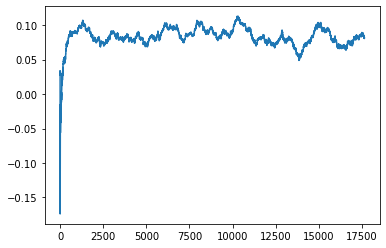

Thread: 6 iteration: 2940
RAM mDiffFit_15 FROM: 2688 --> 1408 reward: 0.013333318750000014
Thread: 2 iteration: 2918
RAM mBackground_68 FROM: 1792 --> 448 reward: -1.0
Thread: 4 iteration: 2922
RAM mDiffFit_305 FROM: 1216 --> 448 reward: 0.03757546523437502
Thread: 2 iteration: 2919
RAM mBackground_27 FROM: 3008 --> 384 reward: 0.20866848078906255
Thread: 5 iteration: 3019
RAM mBackground_55 FROM: 960 --> 384 reward: 0.23440373118749996
Thread: 6 iteration: 2941
RAM mDiffFit_23 FROM: 2432 --> 2240 reward: -0.007343760937499992
Thread: 4 iteration: 2923
RAM mDiffFit_401 FROM: 2176 --> 1920 reward: -0.03496358359374999
Saving ...


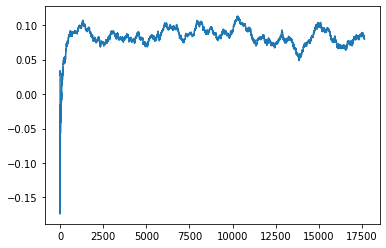

Thread: 5 iteration: 3020
RAM mBackground_2 FROM: 704 --> 384 reward: 0.19543722625781257
Saving ...


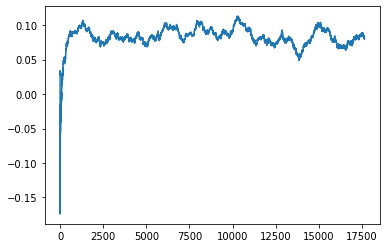

Thread: 2 iteration: 2920
RAM mProject_7 FROM: 704 --> 448 reward: -1.0
Thread: 1 iteration: 2877
RAM mProject_36 FROM: 1088 --> 448 reward: -1.0
Thread: 3 iteration: 2963
RAM mDiffFit_104 FROM: 3008 --> 384 reward: -0.03068769687499997
Thread: 6 iteration: 2942
RAM mDiffFit_103 FROM: 128 --> 384 reward: -0.3625208406250001
Thread: 4 iteration: 2924
RAM mDiffFit_103 FROM: 2304 --> 832 reward: 0.05417707968750001
Thread: 2 iteration: 2921
RAM mDiffFit_189 FROM: 1344 --> 2880 reward: 0.03837508750000003
Thread: 1 iteration: 2878
RAM mDiffFit_399 FROM: 1856 --> 2240 reward: -0.038854203125
Thread: 3 iteration: 2964
RAM mDiffFit_45 FROM: 1664 --> 448 reward: 0.052346305859375025
Thread: 4 iteration: 2925
RAM mDiffFit_331 FROM: 2560 --> 192 reward: 0.254242146484375
Thread: 6 iteration: 2943
RAM mBackground_5 FROM: 1472 --> 1920 reward: -0.05312741307812496
Thread: 2 iteration: 2922
RAM mDiffFit_31 FROM: 1920 --> 2496 reward: 0.03448442421875
Thread: 1 iteration: 2879
RAM mDiffFit_363 FROM:

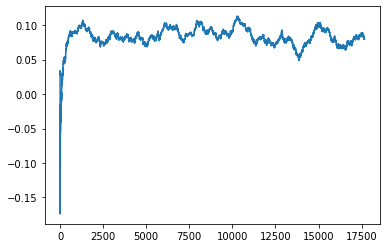

Thread: 1 iteration: 2880
RAM mDiffFit_161 FROM: 1856 --> 384 reward: -0.004828228906249999
Thread: 6 iteration: 2945
RAM mDiffFit_370 FROM: 2752 --> 384 reward: 0.044817611718750025
Thread: 6 iteration: 2946
RAM mBackground_34 FROM: 896 --> 448 reward: 0.19054150492968755
Thread: 1 iteration: 2881
RAM mDiffFit_9 FROM: 2880 --> 448 reward: -0.12710446562500002
Thread: 6 iteration: 2947
RAM mDiffFit_173 FROM: 2112 --> 192 reward: 0.35763280976562506
Thread: 1 iteration: 2882
RAM mProject_16 FROM: 2496 --> 2560 reward: -0.008757191109374939
Thread: 5 iteration: 3022
RAM mBackground_68 FROM: 512 --> 448 reward: -1.0
Thread: 3 iteration: 2965
RAM mProject_55 FROM: 960 --> 448 reward: -1.0
Thread: 2 iteration: 2923
RAM mProject_56 FROM: 1472 --> 448 reward: -1.0
Thread: 4 iteration: 2927
RAM mBackground_11 FROM: 256 --> 448 reward: -0.27458635573437506
Thread: 5 iteration: 3023
RAM mDiffFit_53 FROM: 384 --> 384 reward: -0.07192190234375
Thread: 2 iteration: 2924
RAM mDiffFit_46 FROM: 1024 -

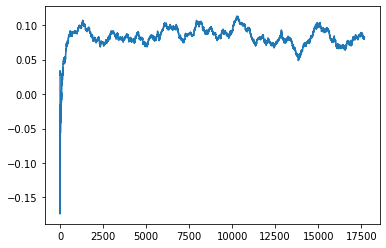

Thread: 3 iteration: 2970
RAM mDiffFit_320 FROM: 2368 --> 384 reward: 0.022286372656249998
Thread: 1 iteration: 2885
RAM mDiffFit_110 FROM: 448 --> 1920 reward: -0.06976039843749998
Thread: 5 iteration: 3025
RAM mDiffFit_392 FROM: 320 --> 384 reward: -0.09182033164062503
Thread: 2 iteration: 2928
RAM mProject_48 FROM: 320 --> 192 reward: -1.0
Saving ...


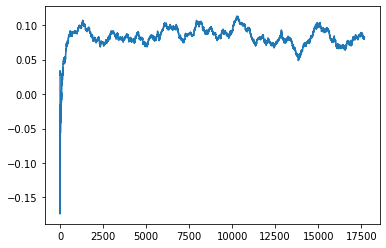

Thread: 4 iteration: 2930
RAM mDiffFit_223 FROM: 2496 --> 1408 reward: 0.0010338277343750236
Thread: 1 iteration: 2886
RAM mBackground_86 FROM: 1920 --> 2560 reward: -1.0
Saving ...


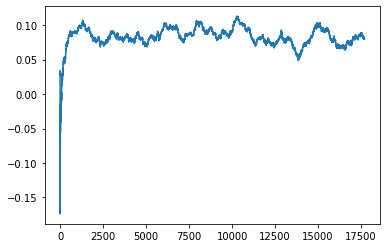

Thread: 6 iteration: 2950
RAM mDiffFit_31 FROM: 832 --> 384 reward: -0.009161503906250004
Thread: 5 iteration: 3026
RAM mDiffFit_324 FROM: 2560 --> 448 reward: 0.10090882773437503
Thread: 2 iteration: 2929
RAM mBackground_52 FROM: 1856 --> 1408 reward: 0.014263880382812443
Thread: 4 iteration: 2931
RAM mBackground_22 FROM: 2816 --> 1408 reward: -0.08031163078125005
Thread: 1 iteration: 2887
RAM mDiffFit_210 FROM: 2432 --> 448 reward: 0.092200465234375
Thread: 6 iteration: 2951
RAM mDiffFit_14 FROM: 256 --> 448 reward: -0.17815887148437498
Saving ...


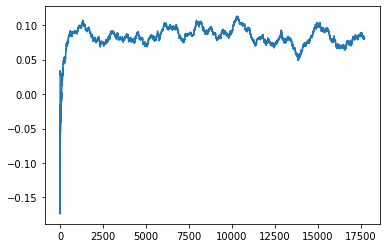

Thread: 2 iteration: 2930
RAM mDiffFit_177 FROM: 512 --> 448 reward: 0.05165887148437505
Thread: 5 iteration: 3027
RAM mDiffFit_348 FROM: 448 --> 2496 reward: -0.07581243437500002
Thread: 1 iteration: 2888
RAM mDiffFit_25 FROM: 1472 --> 1408 reward: -0.06851829570312497
Thread: 5 iteration: 3028
RAM mDiffFit_147 FROM: 3008 --> 384 reward: 0.139674316015625
Thread: 2 iteration: 2931
RAM mBackground_35 FROM: 1344 --> 384 reward: 0.19849193953906255
Thread: 6 iteration: 2952
RAM mProject_28 FROM: 320 --> 448 reward: -1.0
Thread: 3 iteration: 2971
RAM mDiffFit_412 FROM: 1344 --> 384 reward: 0.04870309765625001
Thread: 5 iteration: 3029
RAM mDiffFit_287 FROM: 2176 --> 2240 reward: -0.020877632421875004
Thread: 3 iteration: 2972
RAM mDiffFit_261 FROM: 576 --> 2880 reward: 0.03722670195312503
Thread: 2 iteration: 2932
RAM mDiffFit_246 FROM: 2816 --> 448 reward: 0.042507722265625034
Thread: 6 iteration: 2953
RAM mProject_36 FROM: 2048 --> 384 reward: -1.0
Thread: 4 iteration: 2932
RAM mProject

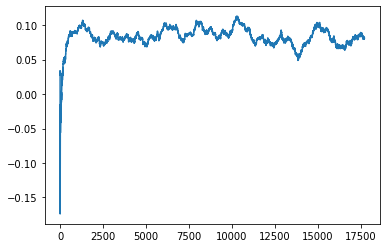

Thread: 5 iteration: 3030
RAM mDiffFit_329 FROM: 128 --> 448 reward: -0.686666725
Thread: 3 iteration: 2973
RAM mDiffFit_140 FROM: 704 --> 2560 reward: 0.003325596484374995
Thread: 6 iteration: 2954
RAM mDiffFit_374 FROM: 1344 --> 1408 reward: 0.020098982031250007
Thread: 4 iteration: 2933
RAM mDiffFit_238 FROM: 2944 --> 448 reward: 0.114395796875
Thread: 3 iteration: 2974
RAM mDiffFit_303 FROM: 1280 --> 384 reward: 0.10520831874999997
Thread: 4 iteration: 2934
RAM mDiffFit_386 FROM: 960 --> 192 reward: 0.09250772226562498
Thread: 6 iteration: 2955
RAM mAdd_1 FROM: 1728 --> 1408 reward: 0.0067616708984374885
Thread: 5 iteration: 3031
RAM mProject_50 FROM: 2688 --> 1280 reward: -0.03112718934375016
Thread: 2 iteration: 2933
RAM mDiffFit_210 FROM: 1408 --> 384 reward: 0.08541663749999998
Thread: 3 iteration: 2975
RAM mDiffFit_232 FROM: 2304 --> 2240 reward: -0.12161732148437499
Thread: 6 iteration: 2956
RAM mDiffFit_273 FROM: 2176 --> 384 reward: 0.01638013359374999
Thread: 2 iteration: 

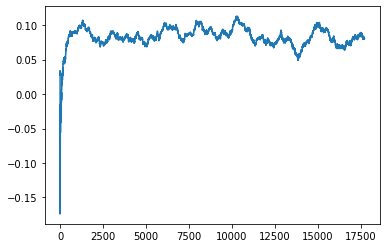

Thread: 1 iteration: 2890
RAM mDiffFit_52 FROM: 1984 --> 192 reward: 0.33963280976562504
Thread: 3 iteration: 2976
RAM mDiffFit_10 FROM: 1984 --> 192 reward: 0.5478359074218752
Thread: 4 iteration: 2935
RAM mImgtbl_3 FROM: 576 --> 384 reward: 0.3242562653125
Thread: 5 iteration: 3032
RAM mDiffFit_67 FROM: 2432 --> 2240 reward: -0.028044313671875005
Thread: 2 iteration: 2935
RAM mDiffFit_153 FROM: 576 --> 384 reward: 0.006195287890625005
Thread: 6 iteration: 2957
RAM mDiffFit_54 FROM: 1344 --> 384 reward: 0.050515575781249974
Thread: 1 iteration: 2891
RAM mDiffFit_223 FROM: 1792 --> 1408 reward: -0.049166725
Thread: 4 iteration: 2936
RAM mDiffFit_69 FROM: 1024 --> 2240 reward: 0.025510485937500008
Thread: 5 iteration: 3033
RAM mAdd_3 FROM: 1664 --> 2240 reward: 0.00476439082031245
Thread: 3 iteration: 2977
RAM mDiffFit_214 FROM: 2368 --> 448 reward: 0.06339316445312501
Thread: 6 iteration: 2958
RAM mDiffFit_326 FROM: 2752 --> 2240 reward: -0.01208336249999999
Thread: 4 iteration: 2937
R

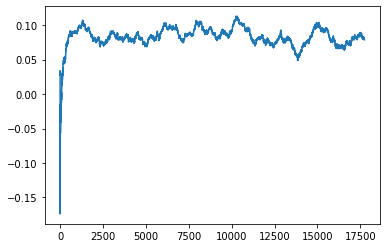

Thread: 6 iteration: 2960
RAM mDiffFit_406 FROM: 2304 --> 320 reward: 0.13501294335937503
Saving ...


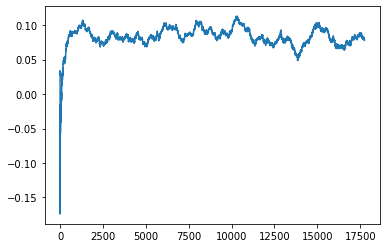

Thread: 3 iteration: 2980
RAM mBackground_7 FROM: 640 --> 1408 reward: -0.17870084587499996
Thread: 6 iteration: 2961
RAM mProject_13 FROM: 768 --> 2560 reward: 0.7517333924999999
Thread: 4 iteration: 2939
RAM mBackground_11 FROM: 384 --> 2240 reward: -0.35028642967968754
Thread: 3 iteration: 2981
RAM mBackground_66 FROM: 1792 --> 384 reward: -1.0
Thread: 5 iteration: 3034
RAM mDiffFit_156 FROM: 1280 --> 1984 reward: 0.00771358359375
Saving ...


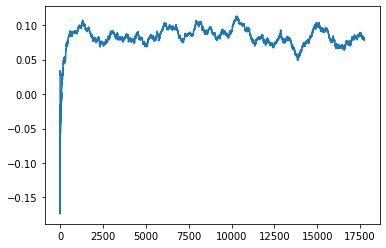

Thread: 4 iteration: 2940
RAM mDiffFit_260 FROM: 704 --> 448 reward: 0.023171858593749976
Thread: 6 iteration: 2962
RAM mDiffFit_8 FROM: 2240 --> 2880 reward: 0.04705475585937502
Thread: 3 iteration: 2982
RAM mDiffFit_387 FROM: 448 --> 384 reward: -0.03626825195312499
Thread: 5 iteration: 3035
RAM mDiffFit_79 FROM: 1600 --> 1920 reward: -0.08723705664062503
Thread: 3 iteration: 2983
RAM mDiffFit_230 FROM: 1600 --> 384 reward: 0.05361192539062498
Thread: 6 iteration: 2963
RAM mBackground_83 FROM: 2368 --> 192 reward: -1.0
Thread: 2 iteration: 2936
RAM mProject_48 FROM: 256 --> 448 reward: -1.0
Thread: 1 iteration: 2894
RAM mDiffFit_374 FROM: 2112 --> 1984 reward: 0.023018251953124992
Thread: 5 iteration: 3036
RAM mDiffFit_258 FROM: 2752 --> 1984 reward: -0.018875043750000015
Thread: 2 iteration: 2937
RAM mDiffFit_258 FROM: 640 --> 384 reward: -0.00801566328125003
Thread: 6 iteration: 2964
RAM mBackground_39 FROM: 3008 --> 448 reward: 0.18635998571875
Thread: 1 iteration: 2895
RAM mDiffF

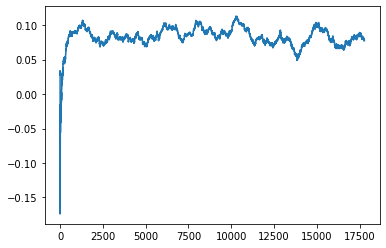

Thread: 5 iteration: 3040
RAM mDiffFit_400 FROM: 2816 --> 1088 reward: 0.07969533164062502
Thread: 6 iteration: 2968
RAM mDiffFit_75 FROM: 1280 --> 192 reward: 0.13604422617187498
Thread: 3 iteration: 2987
RAM mDiffFit_109 FROM: 1152 --> 448 reward: 0.09996876093749998
Thread: 4 iteration: 2945
RAM mDiffFit_319 FROM: 896 --> 1280 reward: 0.038270884374999994
Thread: 3 iteration: 2988
RAM mDiffFit_136 FROM: 1664 --> 384 reward: 0.11813539843749998
Thread: 6 iteration: 2969
RAM mProject_5 FROM: 128 --> 1088 reward: 0.822607192828125
Thread: 2 iteration: 2939
RAM mDiffFit_321 FROM: 1792 --> 448 reward: 0.06110933671874999
Thread: 4 iteration: 2946
RAM mDiffFit_24 FROM: 2368 --> 832 reward: -0.018401105468750026
Saving ...


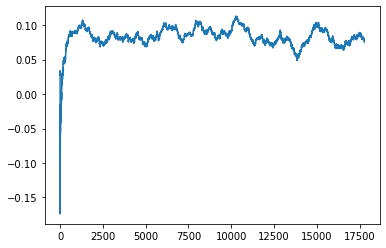

Thread: 6 iteration: 2970
RAM mDiffFit_33 FROM: 1152 --> 384 reward: 0.04782809765625001
Thread: 3 iteration: 2989
RAM mBackground_77 FROM: 2752 --> 832 reward: -1.0
Thread: 1 iteration: 2899
RAM mDiffFit_133 FROM: 2240 --> 1984 reward: -0.06606778671875
Saving ...


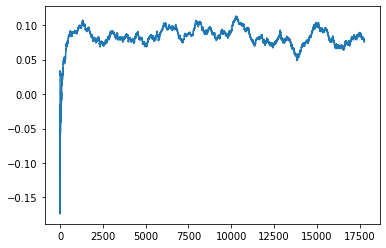

Thread: 2 iteration: 2940
RAM mDiffFit_224 FROM: 2304 --> 832 reward: 0.010971305859374982
Thread: 4 iteration: 2947
RAM mDiffFit_37 FROM: 2432 --> 1280 reward: -0.06383344999999999
Saving ...


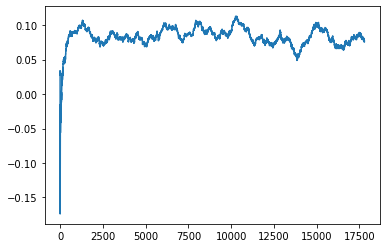

Thread: 3 iteration: 2990
RAM mProject_26 FROM: 768 --> 256 reward: -1.0
Thread: 5 iteration: 3041
RAM mDiffFit_142 FROM: 1280 --> 1088 reward: 0.037416681250000014
Thread: 4 iteration: 2948
RAM mDiffFit_171 FROM: 576 --> 384 reward: 0.008289048828125003
Saving ...


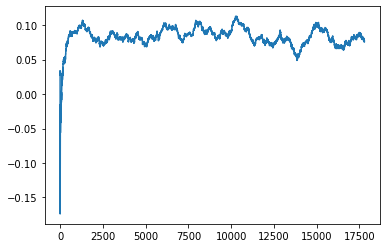

Thread: 1 iteration: 2900
RAM mDiffFit_162 FROM: 832 --> 2560 reward: -0.015484336718750002
Thread: 3 iteration: 2991
RAM mDiffFit_241 FROM: 2432 --> 384 reward: 0.06726557578125
Thread: 4 iteration: 2949
RAM mDiffFit_71 FROM: 512 --> 384 reward: -0.039406282812500006
Thread: 5 iteration: 3042
RAM mProject_27 FROM: 1472 --> 2496 reward: 0.046200238875000084
Thread: 2 iteration: 2941
RAM mDiffFit_13 FROM: 1984 --> 384 reward: 0.30119274296875004
Thread: 1 iteration: 2901
RAM mDiffFit_83 FROM: 3008 --> 2240 reward: 0.005544269921875008
Saving ...


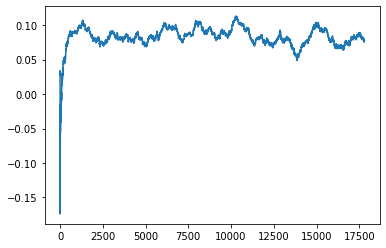

Thread: 4 iteration: 2950
RAM mDiffFit_13 FROM: 1088 --> 832 reward: 0.085789092578125
Thread: 5 iteration: 3043
RAM mBackground_3 FROM: 1216 --> 832 reward: 0.15517630643750008
Thread: 2 iteration: 2942
RAM mDiffFit_291 FROM: 704 --> 384 reward: 0.14360415937500004
Thread: 1 iteration: 2902
RAM mBackground_61 FROM: 832 --> 384 reward: -1.0
Thread: 6 iteration: 2971
RAM mBgModel_3 FROM: 1600 --> 192 reward: -0.032124218281250005
Thread: 4 iteration: 2951
RAM mDiffFit_256 FROM: 1792 --> 1280 reward: 0.03816668125
Thread: 5 iteration: 3044
RAM mDiffFit_117 FROM: 2880 --> 2240 reward: 0.007278650390625009
Thread: 1 iteration: 2903
RAM mDiffFit_266 FROM: 1856 --> 1920 reward: -0.0444479640625
Thread: 6 iteration: 2972
RAM mDiffFit_117 FROM: 2176 --> 2240 reward: 0.023067742968749996
Thread: 5 iteration: 3045
RAM mDiffFit_340 FROM: 2752 --> 192 reward: 0.05468203828125004
Thread: 4 iteration: 2952
RAM mDiffFit_102 FROM: 1152 --> 384 reward: 0.188562478125
Thread: 1 iteration: 2904
RAM mDiff

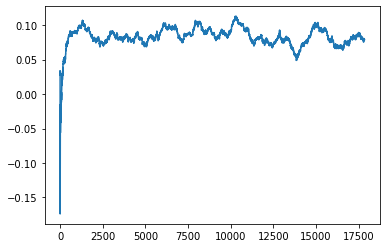

Thread: 1 iteration: 2910
RAM mDiffFit_119 FROM: 448 --> 2240 reward: -0.10473433671874999
Thread: 5 iteration: 3049
RAM mDiffFit_186 FROM: 2624 --> 1024 reward: 0.10473701289062498
Thread: 3 iteration: 2995
RAM mProject_75 FROM: 2176 --> 2752 reward: 0.1223683540312499
Thread: 2 iteration: 2947
RAM mDiffFit_186 FROM: 1024 --> 192 reward: 0.16821090742187494
Thread: 1 iteration: 2911
RAM mProject_77 FROM: 832 --> 384 reward: -1.0
Thread: 6 iteration: 2979
RAM mDiffFit_295 FROM: 1024 --> 1152 reward: 0.05008858359375
Thread: 3 iteration: 2996
RAM mBackground_5 FROM: 2112 --> 1280 reward: 0.03393860664062494
Saving ...


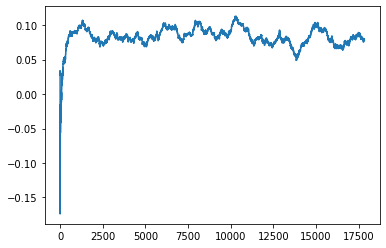

Thread: 5 iteration: 3050
RAM mDiffFit_197 FROM: 704 --> 1280 reward: -0.006981748046875
Thread: 1 iteration: 2912
RAM mDiffFit_301 FROM: 2944 --> 2240 reward: -0.0219271234375
Saving ...


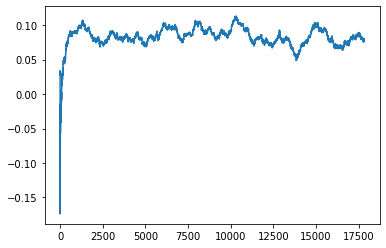

Thread: 6 iteration: 2980
RAM mDiffFit_362 FROM: 2304 --> 832 reward: 0.07460157070312501
Thread: 3 iteration: 2997
RAM mDiffFit_67 FROM: 1216 --> 384 reward: 0.1488646015625
Thread: 5 iteration: 3051
RAM mProject_84 FROM: 2240 --> 384 reward: -1.0
Thread: 4 iteration: 2955
RAM mDiffFit_50 FROM: 704 --> 192 reward: 0.41844269921875005
Thread: 1 iteration: 2913
RAM mDiffFit_385 FROM: 704 --> 256 reward: 0.14779949101562498
Thread: 3 iteration: 2998
RAM mDiffFit_32 FROM: 576 --> 384 reward: 0.06037499999999998
Thread: 5 iteration: 3052
RAM mDiffFit_293 FROM: 1792 --> 1984 reward: 0.0029765707031249866
Thread: 4 iteration: 2956
RAM mDiffFit_140 FROM: 1472 --> 2240 reward: -0.024682300781250013
Thread: 1 iteration: 2914
RAM mBackground_71 FROM: 256 --> 2240 reward: -1.0
Thread: 2 iteration: 2948
RAM mDiffFit_86 FROM: 2496 --> 1088 reward: 0.004140575781250017
Thread: 3 iteration: 2999
RAM mDiffFit_332 FROM: 2624 --> 1088 reward: 0.0463020796875
Thread: 5 iteration: 3053
RAM mDiffFit_405 FR

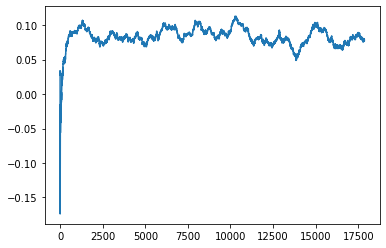

Thread: 2 iteration: 2950
RAM mProject_13 FROM: 2624 --> 2880 reward: 0.04590758924999998
Thread: 1 iteration: 2915
RAM mDiffFit_394 FROM: 1280 --> 1984 reward: 0.07380738828124998
Thread: 2 iteration: 2951
RAM mDiffFit_182 FROM: 128 --> 384 reward: -0.92297402578125
Thread: 5 iteration: 3055
RAM mDiffFit_154 FROM: 960 --> 2240 reward: 0.070023560546875
Thread: 6 iteration: 2982
RAM mProject_36 FROM: 3008 --> 2240 reward: -0.14188762117968756
Thread: 4 iteration: 2958
RAM mDiffFit_38 FROM: 2560 --> 1088 reward: 0.05148692539062506
Thread: 2 iteration: 2952
RAM mConcatFit_2 FROM: 1792 --> 2880 reward: 0.08498557343750004
Thread: 5 iteration: 3056
RAM mDiffFit_4 FROM: 2816 --> 2496 reward: 0.026062521874999998
Thread: 4 iteration: 2959
RAM mBackground_67 FROM: 3008 --> 2240 reward: -1.0
Saving ...


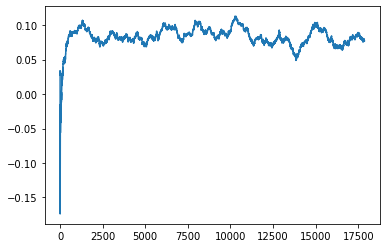

Thread: 3 iteration: 3000
RAM mDiffFit_217 FROM: 832 --> 192 reward: 0.27954168125
Thread: 6 iteration: 2983
RAM mDiffFit_277 FROM: 2432 --> 1280 reward: -0.015197964062499993
Thread: 5 iteration: 3057
RAM mDiffFit_243 FROM: 1984 --> 2240 reward: 0.008791681250000013
Saving ...


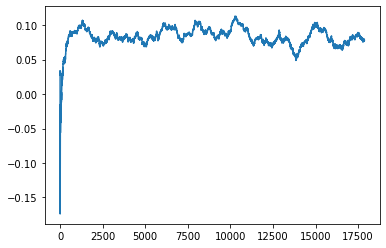

Thread: 4 iteration: 2960
RAM mDiffFit_118 FROM: 1728 --> 2560 reward: 0.07185687929687501
Thread: 3 iteration: 3001
RAM mDiffFit_263 FROM: 2944 --> 192 reward: 0.17308586367187503
Thread: 2 iteration: 2953
RAM mProject_33 FROM: 128 --> 384 reward: -1.0
Thread: 1 iteration: 2916
RAM mViewer_4 FROM: 256 --> 1088 reward: -1.6081897296093748
Thread: 6 iteration: 2984
RAM mDiffFit_176 FROM: 3008 --> 384 reward: 0.10221345234375
Thread: 4 iteration: 2961
RAM mDiffFit_101 FROM: 512 --> 256 reward: 0.10030207968749999
Thread: 1 iteration: 2917
RAM mDiffFit_97 FROM: 2432 --> 1984 reward: -0.03976307460937502
Thread: 5 iteration: 3058
RAM mDiffFit_34 FROM: 3008 --> 384 reward: 0.1858436296875
Thread: 2 iteration: 2954
RAM mDiffFit_193 FROM: 832 --> 256 reward: 0.21950522109375004
Thread: 6 iteration: 2985
RAM mViewer_2 FROM: 2624 --> 2560 reward: 0.0010398359296874369
Thread: 4 iteration: 2962
RAM mDiffFit_166 FROM: 128 --> 2752 reward: -0.6064712621093751
Thread: 1 iteration: 2918
RAM mDiffFit

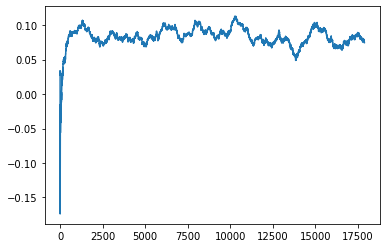

Thread: 5 iteration: 3060
RAM mProject_36 FROM: 640 --> 192 reward: -1.0
Thread: 3 iteration: 3002
RAM mDiffFit_110 FROM: 960 --> 2240 reward: -0.03975000000000001
Saving ...


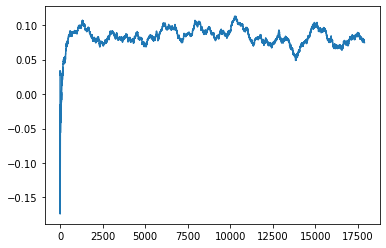

Thread: 1 iteration: 2920
RAM mBackground_44 FROM: 1792 --> 1280 reward: -0.015919017906249982
Thread: 4 iteration: 2964
RAM mDiffFit_137 FROM: 1920 --> 384 reward: 0.05090619531250001
Thread: 6 iteration: 2988
RAM mDiffFit_319 FROM: 960 --> 384 reward: -0.01792975585937497
Thread: 5 iteration: 3061
RAM mDiffFit_224 FROM: 192 --> 192 reward: -0.05783595117187498
Thread: 3 iteration: 3003
RAM mBackground_3 FROM: 2688 --> 1088 reward: -0.05482296186718749
Thread: 1 iteration: 2921
RAM mDiffFit_131 FROM: 2752 --> 2240 reward: -0.14146893593749998
Thread: 5 iteration: 3062
RAM mBackground_32 FROM: 1408 --> 1280 reward: -0.007502624546874994
Thread: 3 iteration: 3004
RAM mBackground_85 FROM: 704 --> 384 reward: -1.0
Thread: 2 iteration: 2955
RAM mDiffFit_128 FROM: 1856 --> 192 reward: 0.211731704296875
Thread: 6 iteration: 2989
RAM mBackground_27 FROM: 2880 --> 192 reward: 0.7056298118749998
Thread: 4 iteration: 2965
RAM mDiffFit_410 FROM: 1856 --> 384 reward: 0.09680466835937501
Thread: 1 

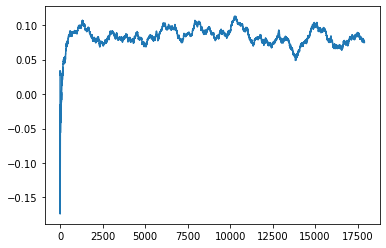

Thread: 6 iteration: 2990
RAM mDiffFit_111 FROM: 2048 --> 1280 reward: 0.06933336249999998
Thread: 4 iteration: 2966
RAM mBackground_2 FROM: 640 --> 192 reward: 0.5688384574453126
Thread: 3 iteration: 3005
RAM mDiffFit_201 FROM: 1408 --> 1280 reward: 0.046421902343749974
Thread: 5 iteration: 3064
RAM mDiffFit_88 FROM: 1152 --> 1280 reward: 0.0064166812499999795
Thread: 2 iteration: 2957
RAM mDiffFit_139 FROM: 2624 --> 1280 reward: -0.07993765312500005
Thread: 6 iteration: 2991
RAM mDiffFit_155 FROM: 2176 --> 192 reward: 0.22170827499999995
Thread: 1 iteration: 2923
RAM mDiffFit_387 FROM: 2368 --> 2560 reward: 0.004976570703124992
Thread: 3 iteration: 3006
RAM mDiffFit_156 FROM: 320 --> 384 reward: -0.06483073007812507
Thread: 4 iteration: 2967
RAM mDiffFit_232 FROM: 1600 --> 2240 reward: 0.004796902343749991
Thread: 5 iteration: 3065
RAM mDiffFit_369 FROM: 1856 --> 1088 reward: 0.012369778906249993
Thread: 2 iteration: 2958
RAM mDiffFit_196 FROM: 2944 --> 2752 reward: 0.006156239062499

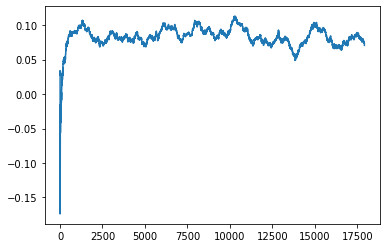

Thread: 2 iteration: 2960
RAM mDiffFit_19 FROM: 1728 --> 2240 reward: 0.01243752187499998
Thread: 1 iteration: 2926
RAM mDiffFit_403 FROM: 1920 --> 2752 reward: 0.02307296406250001
Thread: 6 iteration: 2994
RAM mDiffFit_176 FROM: 2304 --> 1280 reward: -0.0011771234374999967
Thread: 5 iteration: 3068
RAM mDiffFit_315 FROM: 128 --> 1984 reward: -0.81125522109375
Thread: 1 iteration: 2927
RAM mDiffFit_398 FROM: 1728 --> 1088 reward: 0.024515619531250022
Thread: 6 iteration: 2995
RAM mDiffFit_24 FROM: 512 --> 192 reward: 0.08755725703125002
Thread: 5 iteration: 3069
RAM mProject_21 FROM: 704 --> 1280 reward: 0.7692193996875
Saving ...


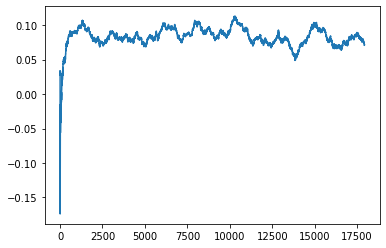

Thread: 4 iteration: 2970
RAM mDiffFit_226 FROM: 1472 --> 1280 reward: 0.0377604421875
Saving ...


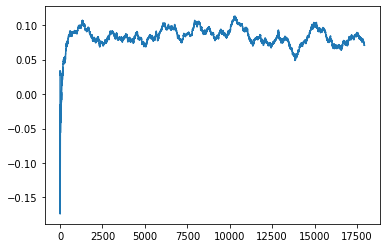

Thread: 5 iteration: 3070
RAM mDiffFit_350 FROM: 2944 --> 1152 reward: -0.006942786718749996
Thread: 4 iteration: 2971
RAM mProject_7 FROM: 2688 --> 1280 reward: -0.048669702468750166
Thread: 2 iteration: 2961
RAM mBackground_24 FROM: 1152 --> 384 reward: 0.26493373118749997
Thread: 6 iteration: 2996
RAM mBackground_48 FROM: 2816 --> 256 reward: 0.48439484950000006
Thread: 1 iteration: 2928
RAM mAdd_2 FROM: 192 --> 2240 reward: -1.0
Thread: 3 iteration: 3009
RAM mDiffFit_81 FROM: 896 --> 2240 reward: 0.3055316328124999
Thread: 4 iteration: 2972
RAM mDiffFit_390 FROM: 384 --> 1984 reward: -0.07415878398437498
Thread: 2 iteration: 2962
RAM mDiffFit_367 FROM: 1088 --> 448 reward: 0.08973696914062498
Saving ...


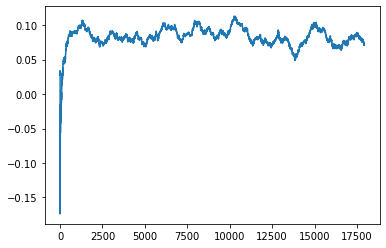

Thread: 3 iteration: 3010
RAM mBackground_60 FROM: 2560 --> 2496 reward: 0.019535908148437513
Thread: 2 iteration: 2963
RAM mDiffFit_151 FROM: 1600 --> 2752 reward: 0.03331256562499999
Thread: 2 iteration: 2964
RAM mProject_89 FROM: 2624 --> 1408 reward: -0.07002358460156256
Thread: 5 iteration: 3071
RAM mDiffFit_85 FROM: 960 --> 1280 reward: -0.012596349609375014
Thread: 2 iteration: 2965
RAM mDiffFit_56 FROM: 2496 --> 1088 reward: 0.03895568632812502
Thread: 5 iteration: 3072
RAM mDiffFit_407 FROM: 2496 --> 384 reward: 0.17221871718750004
Thread: 2 iteration: 2966
RAM mBackground_71 FROM: 1088 --> 1280 reward: -1.0
Thread: 1 iteration: 2929
RAM mDiffFit_420 FROM: 128 --> 1280 reward: -0.48910938046874997
Thread: 2 iteration: 2967
RAM mBackground_22 FROM: 448 --> 1280 reward: -0.1655678476875
Thread: 5 iteration: 3073
RAM mProject_73 FROM: 768 --> 448 reward: -1.0
Thread: 6 iteration: 2997
RAM mDiffFit_322 FROM: 448 --> 2240 reward: -0.061164005078125014
Saving ...


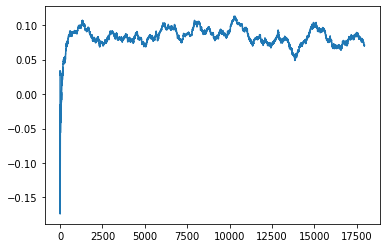

Thread: 1 iteration: 2930
RAM mProject_24 FROM: 320 --> 192 reward: -1.0
Thread: 4 iteration: 2973
RAM mDiffFit_201 FROM: 320 --> 1280 reward: -0.22537500000000005
Thread: 2 iteration: 2968
RAM mDiffFit_155 FROM: 1024 --> 1280 reward: -0.03104168125000001
Thread: 5 iteration: 3074
RAM mProject_42 FROM: 1728 --> 192 reward: -1.0
Thread: 3 iteration: 3011
RAM mProject_81 FROM: 960 --> 2560 reward: -0.12463566679687497
Thread: 6 iteration: 2998
RAM mBackground_4 FROM: 1088 --> 2752 reward: 0.016729852109374874
Thread: 2 iteration: 2969
RAM mBackground_55 FROM: 2624 --> 1280 reward: -0.012680622734375023
Thread: 5 iteration: 3075
RAM mDiffFit_329 FROM: 2112 --> 1280 reward: 0.023080730078125014
Thread: 3 iteration: 3012
RAM mDiffFit_14 FROM: 1664 --> 320 reward: 0.3198646015625
Thread: 1 iteration: 2931
RAM mDiffFit_3 FROM: 2048 --> 2240 reward: -0.07265632656250001
Thread: 4 iteration: 2974
RAM mDiffFit_157 FROM: 192 --> 448 reward: -0.199476570703125
Thread: 6 iteration: 2999
RAM mBackgr

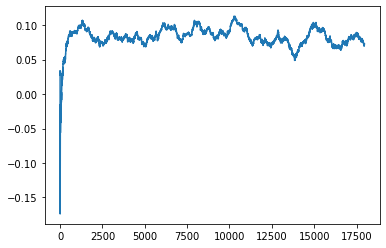

Thread: 2 iteration: 2970
RAM mDiffFit_183 FROM: 2304 --> 1280 reward: -0.04226052968749998
Thread: 1 iteration: 2932
RAM mDiffFit_295 FROM: 2624 --> 384 reward: 0.07739838554687502
Thread: 4 iteration: 2975
RAM mDiffFit_238 FROM: 576 --> 384 reward: -0.048968804687499964
Thread: 5 iteration: 3076
RAM mDiffFit_397 FROM: 512 --> 1280 reward: -0.080020840625
Thread: 1 iteration: 2933
RAM mDiffFit_103 FROM: 1216 --> 2560 reward: 0.04353132656250002
Thread: 4 iteration: 2976
RAM mDiffFit_143 FROM: 1024 --> 1280 reward: 0.008114601562500007
Thread: 5 iteration: 3077
RAM mDiffFit_207 FROM: 1856 --> 2240 reward: -0.009513030859375007
Thread: 4 iteration: 2977
RAM mBackground_1 FROM: 832 --> 1984 reward: -0.08020390503125004
Thread: 1 iteration: 2934
RAM mDiffFit_224 FROM: 640 --> 2240 reward: -0.024656195312499993
Thread: 5 iteration: 3078
RAM mDiffFit_268 FROM: 2304 --> 1984 reward: -0.03992453476562498
Thread: 4 iteration: 2978
RAM mBackground_13 FROM: 1152 --> 1984 reward: -0.0150656214296

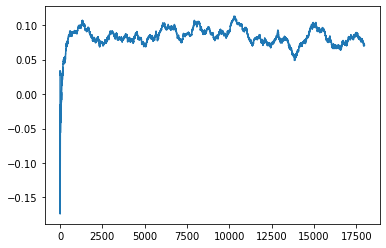

Thread: 6 iteration: 3000
RAM mDiffFit_342 FROM: 1792 --> 1280 reward: 0.035770840624999994
Thread: 4 iteration: 2979
RAM mProject_89 FROM: 640 --> 192 reward: -1.0
Thread: 2 iteration: 2971
RAM mBackground_9 FROM: 1408 --> 384 reward: 0.2854303853125
Thread: 3 iteration: 3014
RAM mDiffFit_20 FROM: 1408 --> 2560 reward: 0.04502092812499997
Thread: 6 iteration: 3001
RAM mDiffFit_233 FROM: 1984 --> 192 reward: 0.9733333625000001
Thread: 1 iteration: 2936
RAM mDiffFit_36 FROM: 128 --> 384 reward: -0.6538594242187501
Saving ...


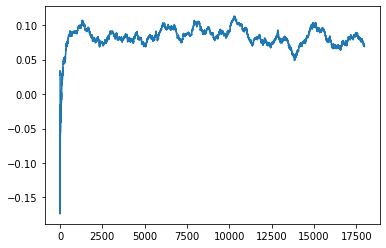

Thread: 4 iteration: 2980
RAM mBackground_65 FROM: 1728 --> 1280 reward: -1.0
Thread: 5 iteration: 3079
RAM mDiffFit_144 FROM: 2944 --> 1280 reward: -0.08785951171875
Thread: 3 iteration: 3015
RAM mDiffFit_76 FROM: 256 --> 1280 reward: -0.1611562390625
Thread: 1 iteration: 2937
RAM mDiffFit_286 FROM: 1920 --> 2240 reward: 0.033036503906250014
Saving ...


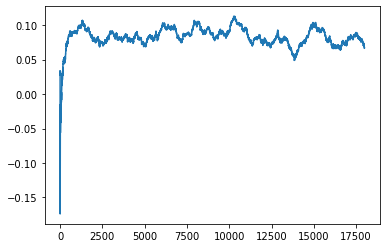

Thread: 5 iteration: 3080
RAM mDiffFit_56 FROM: 1664 --> 2240 reward: -0.049812521875
Thread: 3 iteration: 3016
RAM mBackground_36 FROM: 1920 --> 192 reward: 0.898149029578125
Thread: 4 iteration: 2981
RAM mDiffFit_298 FROM: 2496 --> 1280 reward: 0.010127588671875014
Thread: 5 iteration: 3081
RAM mDiffFit_100 FROM: 960 --> 1088 reward: -0.023117190234374987
Thread: 3 iteration: 3017
RAM mBackground_45 FROM: 2432 --> 1984 reward: -0.006633681890625045
Thread: 4 iteration: 2982
RAM mProject_70 FROM: 640 --> 1280 reward: 0.75039625828125
Thread: 6 iteration: 3002
RAM mProject_83 FROM: 576 --> 448 reward: -1.0
Thread: 2 iteration: 2972
RAM mDiffFit_150 FROM: 1536 --> 2880 reward: -0.03647657070312501
Thread: 4 iteration: 2983
RAM mDiffFit_24 FROM: 320 --> 320 reward: 0.16506515429687502
Thread: 4 iteration: 2984
RAM mDiffFit_409 FROM: 1536 --> 192 reward: 0.2788437171875
Thread: 2 iteration: 2973
RAM mBackground_39 FROM: 1472 --> 192 reward: 0.685415472234375
Thread: 6 iteration: 3003
RAM 

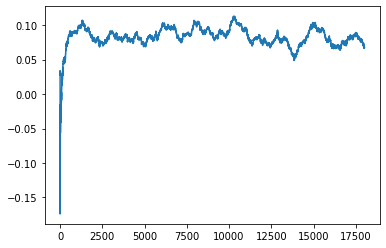

Thread: 3 iteration: 3020
RAM mDiffFit_46 FROM: 704 --> 384 reward: 0.126408871484375
Saving ...


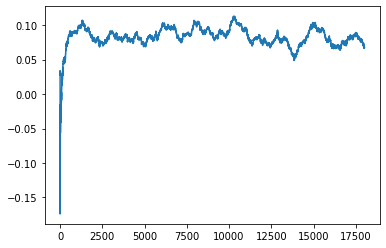

Thread: 1 iteration: 2940
RAM mDiffFit_298 FROM: 1088 --> 2240 reward: 0.03118756562500001
Thread: 5 iteration: 3084
RAM mDiffFit_60 FROM: 768 --> 1280 reward: 0.017000043749999996
Thread: 2 iteration: 2976
RAM mDiffFit_205 FROM: 320 --> 1280 reward: -0.16281769921875
Thread: 4 iteration: 2987
RAM mDiffFit_372 FROM: 2496 --> 1984 reward: 0.04231774296875001
Thread: 3 iteration: 3021
RAM mDiffFit_104 FROM: 1408 --> 1280 reward: 0.016343760937500007
Thread: 5 iteration: 3085
RAM mDiffFit_142 FROM: 768 --> 768 reward: 0.09259380468750002
Thread: 6 iteration: 3006
RAM mDiffFit_131 FROM: 1856 --> 384 reward: 0.12052601796875
Thread: 1 iteration: 2941
RAM mDiffFit_109 FROM: 1280 --> 2752 reward: 0.04142716718750001
Thread: 4 iteration: 2988
RAM mDiffFit_207 FROM: 832 --> 1280 reward: -0.006164048828124994
Thread: 5 iteration: 3086
RAM mDiffFit_238 FROM: 2176 --> 1024 reward: 0.09531252187499997
Thread: 3 iteration: 3022
RAM mDiffFit_192 FROM: 512 --> 2240 reward: -0.19621876093749996
Thread:

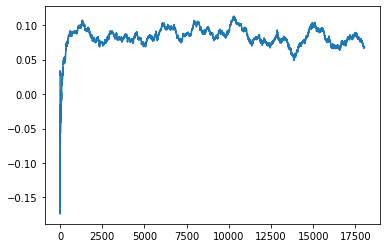

Thread: 4 iteration: 2990
RAM mDiffFit_7 FROM: 2112 --> 2560 reward: 0.006445331640624989
Thread: 5 iteration: 3088
RAM mDiffFit_352 FROM: 2048 --> 1280 reward: 0.02185415937499999
Thread: 3 iteration: 3024
RAM mDiffFit_302 FROM: 448 --> 384 reward: 0.08288022109375001
Thread: 2 iteration: 2979
RAM mBackground_10 FROM: 1408 --> 1280 reward: -0.03214253762500002
Thread: 5 iteration: 3089
RAM mDiffFit_15 FROM: 448 --> 1280 reward: -0.12097915937500003
Saving ...


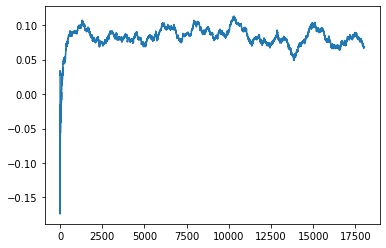

Thread: 2 iteration: 2980
RAM mBackground_17 FROM: 832 --> 2560 reward: -0.09919329527343743
Thread: 3 iteration: 3025
RAM mDiffFit_299 FROM: 2496 --> 768 reward: 0.06884371718749999
Saving ...


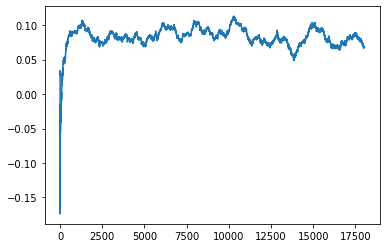

Thread: 5 iteration: 3090
RAM mDiffFit_330 FROM: 2816 --> 384 reward: 0.05931243437500001
Thread: 3 iteration: 3026
RAM mDiffFit_335 FROM: 128 --> 256 reward: -0.68965110546875
Thread: 2 iteration: 2981
RAM mProject_19 FROM: 2816 --> 1280 reward: -0.0454353491249999
Thread: 4 iteration: 2991
RAM mDiffFit_404 FROM: 448 --> 256 reward: 0.02344528789062498
Thread: 5 iteration: 3091
RAM mBackground_5 FROM: 1728 --> 1280 reward: 0.05921684094531244
Thread: 3 iteration: 3027
RAM mDiffFit_74 FROM: 448 --> 320 reward: 0.07418230078124999
Thread: 2 iteration: 2982
RAM mBackground_69 FROM: 1344 --> 192 reward: -1.0
Thread: 1 iteration: 2942
RAM mProject_26 FROM: 2816 --> 192 reward: -1.0
Saving ...


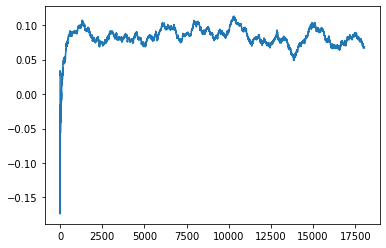

Thread: 6 iteration: 3010
RAM mDiffFit_123 FROM: 1600 --> 2560 reward: -0.003635398437500017
Thread: 4 iteration: 2992
RAM mDiffFit_371 FROM: 896 --> 1280 reward: 0.01854690234375001
Thread: 5 iteration: 3092
RAM mDiffFit_170 FROM: 2496 --> 1280 reward: -0.0008620128906250066
Thread: 3 iteration: 3028
RAM mBackground_34 FROM: 2880 --> 2624 reward: 0.05650251297656251
Thread: 2 iteration: 2983
RAM mDiffFit_23 FROM: 1920 --> 384 reward: 0.12170309765625001
Thread: 1 iteration: 2943
RAM mDiffFit_78 FROM: 448 --> 256 reward: -0.007067742968750006
Thread: 6 iteration: 3011
RAM mDiffFit_263 FROM: 2560 --> 2304 reward: 0.142937653125
Thread: 4 iteration: 2993
RAM mDiffFit_85 FROM: 2432 --> 1280 reward: -0.07845845000000001
Thread: 5 iteration: 3093
RAM mDiffFit_232 FROM: 1088 --> 1280 reward: -0.031783871484375
Thread: 2 iteration: 2984
RAM mDiffFit_312 FROM: 2688 --> 192 reward: 0.20878119531250003
Thread: 1 iteration: 2944
RAM mDiffFit_364 FROM: 1152 --> 256 reward: 0.14322915937500003
Thre

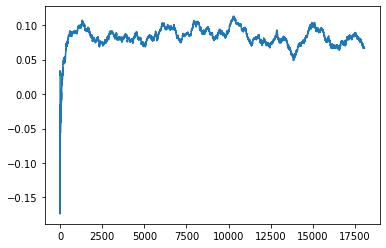

Thread: 3 iteration: 3030
RAM mDiffFit_64 FROM: 2304 --> 1280 reward: 0.01497915937500002
Thread: 4 iteration: 2995
RAM mBackground_17 FROM: 640 --> 1280 reward: -0.17940855734375005
Thread: 2 iteration: 2986
RAM mDiffFit_319 FROM: 2048 --> 1280 reward: -0.015625043750000008
Thread: 4 iteration: 2996
RAM mDiffFit_423 FROM: 2432 --> 192 reward: 0.277710907421875
Thread: 3 iteration: 3031
RAM mBackground_10 FROM: 2432 --> 256 reward: 0.5181857329999999
Thread: 5 iteration: 3095
RAM mDiffFit_146 FROM: 2304 --> 2560 reward: -0.0026562390624999994
Thread: 4 iteration: 2997
RAM mDiffFit_109 FROM: 2496 --> 1088 reward: 0.009541637500000005
Thread: 3 iteration: 3032
RAM mDiffFit_17 FROM: 2240 --> 1280 reward: -0.007768251953125006
Thread: 2 iteration: 2987
RAM mBackground_78 FROM: 2624 --> 1280 reward: -1.0
Thread: 1 iteration: 2945
RAM mDiffFit_400 FROM: 3008 --> 1280 reward: -0.01804953476562501
Thread: 4 iteration: 2998
RAM mViewer_1 FROM: 2048 --> 1280 reward: 0.0403012355625
Thread: 2 ite

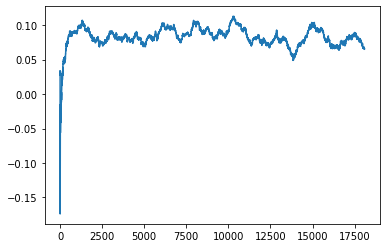

Thread: 2 iteration: 2990
RAM mDiffFit_360 FROM: 2816 --> 1280 reward: 0.01004163750000002
Thread: 6 iteration: 3014
RAM mDiffFit_56 FROM: 960 --> 2560 reward: -0.023945244140625016
Saving ...


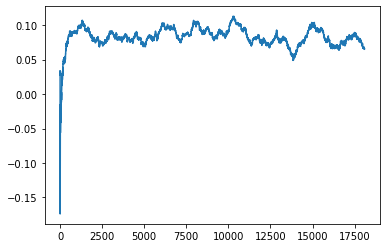

Thread: 4 iteration: 3000
RAM mDiffFit_219 FROM: 1408 --> 2560 reward: 0.009286503906250007
Thread: 4 iteration: 3001
RAM mDiffFit_391 FROM: 2624 --> 384 reward: 0.1559061515625
Thread: 6 iteration: 3015
RAM mProject_2 FROM: 512 --> 192 reward: -1.0
Thread: 1 iteration: 2946
RAM mViewer_1 FROM: 1152 --> 1280 reward: -0.006761554078125002
Thread: 4 iteration: 3002
RAM mProject_45 FROM: 1152 --> 1280 reward: -0.04196062040625018
Thread: 3 iteration: 3035
RAM mProject_32 FROM: 1472 --> 1984 reward: -0.019010075695312555
Thread: 2 iteration: 2991
RAM mDiffFit_328 FROM: 2368 --> 1280 reward: -0.04861210039062494
Thread: 3 iteration: 3036
RAM mProject_53 FROM: 512 --> 192 reward: -1.0
Thread: 5 iteration: 3096
RAM mDiffFit_334 FROM: 1024 --> 1280 reward: 0.015291681250000008
Thread: 5 iteration: 3097
RAM mProject_7 FROM: 2752 --> 1280 reward: -0.04157470771874998
Thread: 6 iteration: 3016
RAM mDiffFit_57 FROM: 1472 --> 1280 reward: -0.041924534765624966
Thread: 6 iteration: 3017
RAM mBackgro

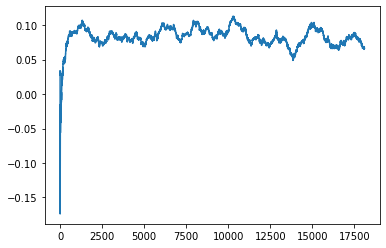

Thread: 5 iteration: 3100
RAM mDiffFit_102 FROM: 1280 --> 320 reward: 0.28887500000000005
Thread: 1 iteration: 2948
RAM mDiffFit_299 FROM: 960 --> 1280 reward: -0.028307300781250013
Thread: 3 iteration: 3038
RAM mDiffFit_75 FROM: 896 --> 1280 reward: -0.009567699218749996
Thread: 2 iteration: 2994
RAM mDiffFit_265 FROM: 2368 --> 2880 reward: 0.015708362500000007
Thread: 1 iteration: 2949
RAM mBackground_62 FROM: 1664 --> 768 reward: -1.0
Thread: 6 iteration: 3018
RAM mDiffFit_301 FROM: 1984 --> 1024 reward: 0.0583229203125
Saving ...


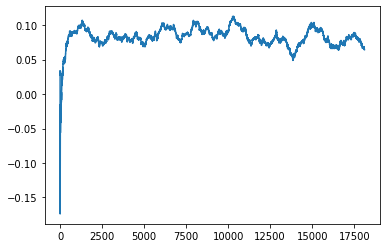

Thread: 1 iteration: 2950
RAM mDiffFit_303 FROM: 256 --> 1984 reward: -0.09688535468750002
Thread: 6 iteration: 3019
RAM mBackground_46 FROM: 1920 --> 192 reward: 0.7788374623750001
Thread: 2 iteration: 2995
RAM mDiffFit_33 FROM: 2432 --> 192 reward: 0.12304672734375001
Thread: 3 iteration: 3039
RAM mBackground_64 FROM: 1216 --> 1280 reward: -1.0
Thread: 4 iteration: 3004
RAM mDiffFit_161 FROM: 2944 --> 192 reward: 0.248893208203125
Thread: 1 iteration: 2951
RAM mDiffFit_27 FROM: 1344 --> 2240 reward: -0.10915632656249999
Saving ...


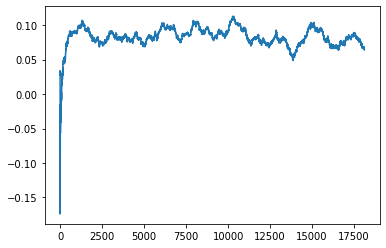

Thread: 6 iteration: 3020
RAM mProject_54 FROM: 256 --> 256 reward: -1.0
Thread: 5 iteration: 3101
RAM mDiffFit_332 FROM: 2816 --> 1280 reward: -0.030062565625000003
Thread: 4 iteration: 3005
RAM mDiffFit_2 FROM: 1728 --> 1280 reward: -0.031770884374999996
Thread: 1 iteration: 2952
RAM mDiffFit_62 FROM: 1408 --> 192 reward: 0.1930728765625
Saving ...


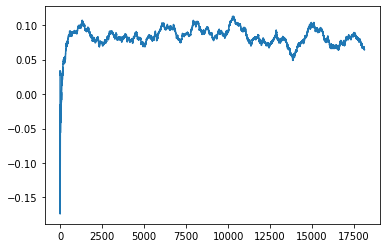

Thread: 3 iteration: 3040
RAM mDiffFit_89 FROM: 1280 --> 2560 reward: -0.010135398437500012
Thread: 2 iteration: 2996
RAM mDiffFit_304 FROM: 1792 --> 192 reward: 0.24488798710937495
Thread: 6 iteration: 3021
RAM mDiffFit_339 FROM: 2624 --> 1280 reward: -0.006096393359375004
Thread: 3 iteration: 3041
RAM mDiffFit_298 FROM: 1920 --> 1280 reward: -0.025286503906249997
Thread: 2 iteration: 2997
RAM mBackground_16 FROM: 256 --> 192 reward: 0.9593234717265626
Thread: 5 iteration: 3102
RAM mDiffFit_330 FROM: 1024 --> 1280 reward: -0.03416668125000001
Thread: 2 iteration: 2998
RAM mDiffFit_374 FROM: 512 --> 192 reward: -0.024677167187499988
Thread: 3 iteration: 3042
RAM mDiffFit_221 FROM: 1408 --> 192 reward: 0.373346349609375
Thread: 6 iteration: 3022
RAM mDiffFit_282 FROM: 2176 --> 1280 reward: 0.014708318749999984
Thread: 5 iteration: 3103
RAM mDiffFit_141 FROM: 192 --> 192 reward: -0.301585994921875
Thread: 2 iteration: 2999
RAM mDiffFit_94 FROM: 2432 --> 1280 reward: -0.06212513124999999


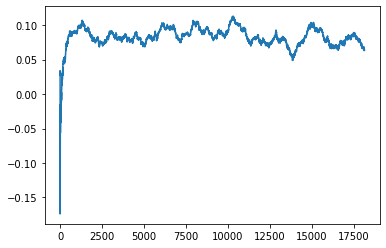

Thread: 2 iteration: 3000
RAM mDiffFit_292 FROM: 960 --> 1280 reward: -0.029307300781250017
Thread: 6 iteration: 3024
RAM mDiffFit_303 FROM: 2496 --> 1280 reward: -0.0051120128906249895
Thread: 3 iteration: 3044
RAM mBackground_28 FROM: 960 --> 1280 reward: -0.04071786066406248
Thread: 4 iteration: 3007
RAM mDiffFit_345 FROM: 2944 --> 1280 reward: -0.0035261054687500334
Thread: 2 iteration: 3001
RAM mDiffFit_53 FROM: 1024 --> 1984 reward: 0.016718804687499995
Thread: 3 iteration: 3045
RAM mDiffFit_9 FROM: 512 --> 192 reward: 0.24687241132812504
Thread: 6 iteration: 3025
RAM mDiffFit_146 FROM: 576 --> 192 reward: 0.20209376093750003
Thread: 4 iteration: 3008
RAM mProject_61 FROM: 2752 --> 448 reward: -1.0
Thread: 5 iteration: 3104
RAM mDiffFit_203 FROM: 1152 --> 384 reward: -0.027140707031250016
Thread: 2 iteration: 3002
RAM mDiffFit_274 FROM: 1280 --> 2240 reward: 0.02759380468750001
Thread: 3 iteration: 3046
RAM mDiffFit_307 FROM: 2368 --> 320 reward: 0.108830642578125
Thread: 6 itera

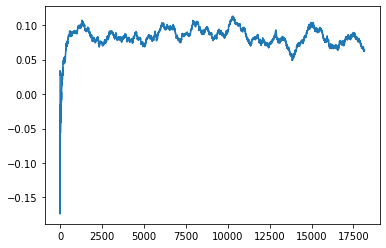

Thread: 3 iteration: 3050
RAM mDiffFit_81 FROM: 512 --> 384 reward: -0.01177606171874998
Thread: 2 iteration: 3006
RAM mProject_58 FROM: 1600 --> 192 reward: -1.0
Thread: 6 iteration: 3028
RAM mDiffFit_251 FROM: 384 --> 1280 reward: 0.029203228906250003
Thread: 2 iteration: 3007
RAM mDiffFit_16 FROM: 2368 --> 1280 reward: 0.03647915937499997
Thread: 2 iteration: 3008
RAM mProject_26 FROM: 1664 --> 1280 reward: 0.10172250000000004
Thread: 5 iteration: 3106
RAM mBackground_74 FROM: 2048 --> 1280 reward: -1.0
Saving ...


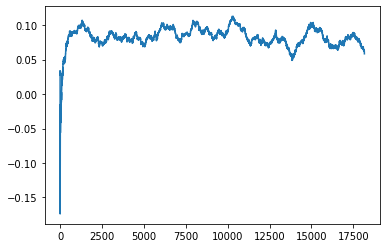

Thread: 4 iteration: 3010
RAM mDiffFit_157 FROM: 2816 --> 2560 reward: -0.0338438046875
Thread: 2 iteration: 3009
RAM mProject_14 FROM: 832 --> 1280 reward: 0.7760556562500002
Thread: 3 iteration: 3051
RAM mDiffFit_22 FROM: 2816 --> 2240 reward: 0.013270840625000009
Thread: 4 iteration: 3011
RAM mDiffFit_137 FROM: 2688 --> 1280 reward: -0.013114645312499989
Saving ...


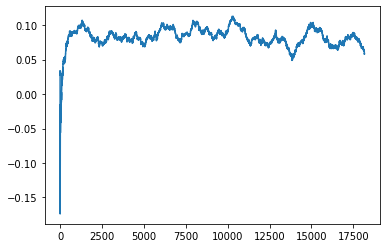

Thread: 2 iteration: 3010
RAM mDiffFit_345 FROM: 1536 --> 1280 reward: 0.009854159374999977
Thread: 4 iteration: 3012
RAM mDiffFit_322 FROM: 576 --> 1280 reward: -0.036502588671875
Thread: 2 iteration: 3011
RAM mProject_4 FROM: 256 --> 192 reward: -1.0
Thread: 6 iteration: 3029
RAM mBackground_61 FROM: 2432 --> 1280 reward: -1.0
Thread: 1 iteration: 2955
RAM mProject_24 FROM: 256 --> 1280 reward: 0.7603581431250002
Thread: 5 iteration: 3107
RAM mDiffFit_61 FROM: 2880 --> 2880 reward: 0.0031250000000000028
Thread: 2 iteration: 3012
RAM mProject_68 FROM: 1088 --> 1280 reward: -0.04888310203125005
Thread: 3 iteration: 3052
RAM mDiffFit_92 FROM: 1024 --> 2880 reward: -0.004510354687499978
Saving ...


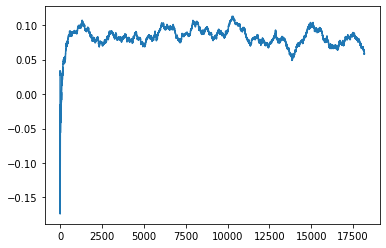

Thread: 6 iteration: 3030
RAM mDiffFit_308 FROM: 512 --> 1280 reward: -0.006666637499999992
Thread: 5 iteration: 3108
RAM mBgModel_1 FROM: 1216 --> 1408 reward: -0.01949269921875002
Thread: 1 iteration: 2956
RAM mDiffFit_28 FROM: 2624 --> 2496 reward: 0.08933603867187498
Thread: 3 iteration: 3053
RAM mDiffFit_223 FROM: 448 --> 1280 reward: -0.06544269921875
Thread: 5 iteration: 3109
RAM mDiffFit_318 FROM: 2368 --> 1280 reward: -0.011500043750000011
Thread: 1 iteration: 2957
RAM mProject_19 FROM: 2496 --> 2560 reward: 0.012085335140625186
Thread: 2 iteration: 3013
RAM mBackground_38 FROM: 256 --> 192 reward: 0.9501926881249999
Thread: 6 iteration: 3031
RAM mDiffFit_366 FROM: 448 --> 1280 reward: -0.06856769921875
Thread: 3 iteration: 3054
RAM mDiffFit_165 FROM: 2496 --> 1280 reward: -0.003474025781249994
Thread: 1 iteration: 2958
RAM mDiffFit_81 FROM: 1536 --> 256 reward: 0.23006247812500003
Saving ...


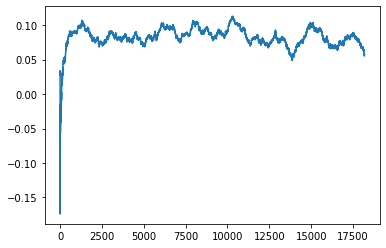

Thread: 5 iteration: 3110
RAM mDiffFit_316 FROM: 1280 --> 384 reward: 0.06875517734375002
Thread: 2 iteration: 3014
RAM mDiffFit_356 FROM: 128 --> 832 reward: -0.91799482265625
Thread: 6 iteration: 3032
RAM mDiffFit_110 FROM: 2496 --> 1280 reward: -0.065783958984375
Thread: 3 iteration: 3055
RAM mDiffFit_350 FROM: 1472 --> 1280 reward: 0.013653650390624984
Thread: 1 iteration: 2959
RAM mDiffFit_354 FROM: 1856 --> 1280 reward: 0.005208318749999989
Thread: 5 iteration: 3111
RAM mDiffFit_44 FROM: 320 --> 1280 reward: -0.1351353984375
Thread: 2 iteration: 3015
RAM mDiffFit_387 FROM: 128 --> 1280 reward: -0.8547188046875
Thread: 3 iteration: 3056
RAM mBackground_73 FROM: 1088 --> 1280 reward: -1.0
Thread: 4 iteration: 3013
RAM mDiffFit_177 FROM: 1472 --> 768 reward: -0.07716676874999998
Thread: 6 iteration: 3033
RAM mDiffFit_24 FROM: 128 --> 1280 reward: -0.49652084062499996
Saving ...


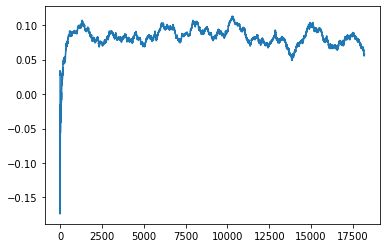

Thread: 1 iteration: 2960
RAM mDiffFit_385 FROM: 1856 --> 1280 reward: 0.025322920312499993
Thread: 1 iteration: 2961
RAM mDiffFit_232 FROM: 1152 --> 320 reward: 0.14677084062499998
Thread: 6 iteration: 3034
RAM mViewer_2 FROM: 2944 --> 1280 reward: -0.044436717703125
Thread: 4 iteration: 3014
RAM mDiffFit_226 FROM: 1344 --> 1280 reward: -0.022768251953125002
Thread: 1 iteration: 2962
RAM mDiffFit_382 FROM: 3008 --> 768 reward: 0.016234249218750017
Thread: 4 iteration: 3015
RAM mProject_49 FROM: 192 --> 1984 reward: 0.6739643108671874
Thread: 3 iteration: 3057
RAM mBackground_33 FROM: 960 --> 1984 reward: -0.019793357546875008
Thread: 1 iteration: 2963
RAM mProject_79 FROM: 1792 --> 1280 reward: 0.1597500315
Thread: 2 iteration: 3016
RAM mDiffFit_258 FROM: 1536 --> 1280 reward: 0.08370840624999999
Thread: 4 iteration: 3016
RAM mProject_41 FROM: 1152 --> 384 reward: -1.0
Thread: 5 iteration: 3112
RAM mDiffFit_297 FROM: 1984 --> 1984 reward: 0.05100526484375001
Thread: 1 iteration: 2964


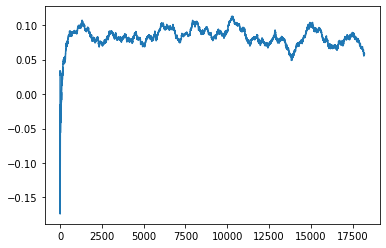

Thread: 3 iteration: 3060
RAM mProject_56 FROM: 1024 --> 1984 reward: -0.1905632092265626
Thread: 1 iteration: 2965
RAM mDiffFit_10 FROM: 640 --> 1280 reward: -0.11656769921875001
Thread: 3 iteration: 3061
RAM mDiffFit_314 FROM: 2304 --> 2688 reward: 0.09950013124999998
Thread: 1 iteration: 2966
RAM mDiffFit_127 FROM: 2112 --> 1280 reward: 0.02620573007812501
Thread: 3 iteration: 3062
RAM mBackground_87 FROM: 2944 --> 1984 reward: -1.0
Thread: 2 iteration: 3018
RAM mDiffFit_407 FROM: 1920 --> 1280 reward: -0.004364601562499987
Thread: 1 iteration: 2967
RAM mBackground_75 FROM: 320 --> 384 reward: -1.0
Thread: 5 iteration: 3113
RAM mProject_86 FROM: 192 --> 2880 reward: 0.8014608404296875
Thread: 6 iteration: 3037
RAM mDiffFit_148 FROM: 2240 --> 1280 reward: -0.026843804687500007
Thread: 3 iteration: 3063
RAM mProject_24 FROM: 2112 --> 1280 reward: 0.07091942378906231
Saving ...


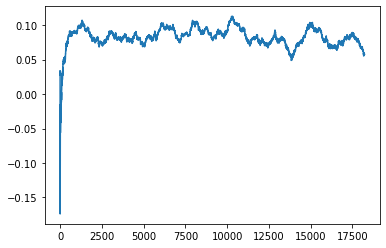

Thread: 4 iteration: 3020
RAM mDiffFit_211 FROM: 576 --> 192 reward: 0.20712499999999995
Thread: 1 iteration: 2968
RAM mDiffFit_132 FROM: 2560 --> 1280 reward: 0.02049999999999999
Thread: 3 iteration: 3064
RAM mDiffFit_375 FROM: 960 --> 832 reward: 0.04740887148437501
Thread: 5 iteration: 3114
RAM mDiffFit_42 FROM: 2496 --> 1280 reward: 0.019752588671875012
Thread: 4 iteration: 3021
RAM mProject_78 FROM: 1536 --> 2752 reward: 0.125997534984375
Thread: 2 iteration: 3019
RAM mDiffFit_26 FROM: 512 --> 2240 reward: -0.10096871718750003
Thread: 5 iteration: 3115
RAM mDiffFit_128 FROM: 1856 --> 192 reward: 0.18362232382812504
Thread: 1 iteration: 2969
RAM mDiffFit_6 FROM: 960 --> 1984 reward: 0.008955773828125003
Thread: 5 iteration: 3116
RAM mDiffFit_347 FROM: 2624 --> 1984 reward: 0.010830730078124993
Thread: 5 iteration: 3117
RAM mDiffFit_196 FROM: 704 --> 256 reward: 0.3363593804687499
Saving ...


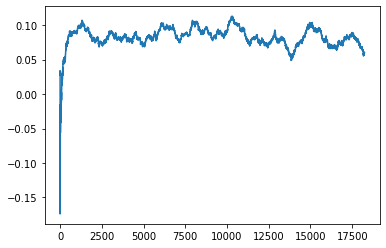

Thread: 1 iteration: 2970
RAM mProject_9 FROM: 1920 --> 256 reward: -1.0
Thread: 6 iteration: 3038
RAM mDiffFit_372 FROM: 2944 --> 192 reward: 0.22442962460937493
Thread: 1 iteration: 2971
RAM mProject_46 FROM: 2368 --> 1280 reward: 0.034987776960937675
Thread: 4 iteration: 3022
RAM mDiffFit_369 FROM: 2816 --> 1280 reward: 0.00729163750000001
Thread: 4 iteration: 3023
RAM mDiffFit_292 FROM: 768 --> 192 reward: 0.13969528789062502
Thread: 6 iteration: 3039
RAM mProject_74 FROM: 1024 --> 256 reward: -1.0
Thread: 3 iteration: 3065
RAM mDiffFit_248 FROM: 3008 --> 192 reward: 0.08463004609375002
Thread: 1 iteration: 2972
RAM mProject_28 FROM: 1536 --> 1280 reward: 0.08651813878125005
Thread: 5 iteration: 3118
RAM mBackground_31 FROM: 448 --> 2240 reward: -0.18985160352343744
Thread: 4 iteration: 3024
RAM mDiffFit_254 FROM: 128 --> 1984 reward: -0.7627343804687499
Thread: 3 iteration: 3066
RAM mDiffFit_181 FROM: 384 --> 256 reward: -0.09397402578124998
Saving ...


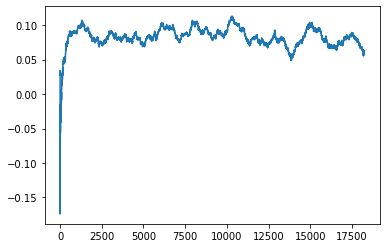

Thread: 6 iteration: 3040
RAM mDiffFit_334 FROM: 1664 --> 1984 reward: 0.008585951171874995
Thread: 4 iteration: 3025
RAM mDiffFit_318 FROM: 2048 --> 1280 reward: -0.005510442187499978
Thread: 3 iteration: 3067
RAM mDiffFit_51 FROM: 1216 --> 1280 reward: 0.031143251953124982
Thread: 6 iteration: 3041
RAM mProject_51 FROM: 2176 --> 2880 reward: -0.08284779576562497
Thread: 1 iteration: 2973
RAM mDiffFit_124 FROM: 704 --> 2240 reward: -0.094104159375
Thread: 6 iteration: 3042
RAM mBackground_86 FROM: 2816 --> 256 reward: -1.0
Saving ...


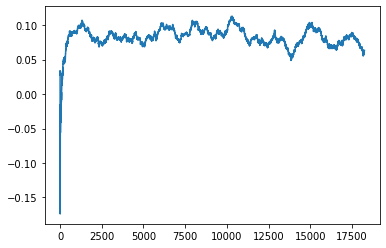

Thread: 2 iteration: 3020
RAM mBackground_58 FROM: 1408 --> 320 reward: 0.35349354436718744
Thread: 3 iteration: 3068
RAM mProject_85 FROM: 960 --> 2880 reward: -0.0778313471484375
Thread: 5 iteration: 3119
RAM mDiffFit_8 FROM: 1280 --> 1280 reward: -0.021239601562499984
Thread: 1 iteration: 2974
RAM mDiffFit_109 FROM: 1856 --> 1984 reward: 0.025773473046875
Thread: 6 iteration: 3043
RAM mDiffFit_281 FROM: 1792 --> 1280 reward: -0.016083362500000017
Saving ...


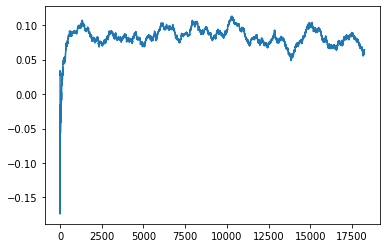

Thread: 5 iteration: 3120
RAM mDiffFit_147 FROM: 640 --> 832 reward: -0.16173183554687495
Thread: 3 iteration: 3069
RAM mDiffFit_90 FROM: 1536 --> 1280 reward: -0.029104203124999985
Thread: 5 iteration: 3121
RAM mDiffFit_379 FROM: 1792 --> 192 reward: 0.14331765546875003
Thread: 1 iteration: 2975
RAM mBackground_67 FROM: 960 --> 1280 reward: -1.0
Thread: 4 iteration: 3026
RAM mDiffFit_266 FROM: 640 --> 192 reward: 0.4391770796875001
Thread: 6 iteration: 3044
RAM mProject_15 FROM: 896 --> 1280 reward: -0.16770654970312507
Thread: 2 iteration: 3021
RAM mDiffFit_389 FROM: 768 --> 2688 reward: -0.2049687171875
Thread: 4 iteration: 3027
RAM mDiffFit_22 FROM: 832 --> 1024 reward: 0.071070375390625
Thread: 1 iteration: 2976
RAM mDiffFit_417 FROM: 2752 --> 192 reward: 0.23452338554687505
Thread: 6 iteration: 3045
RAM mDiffFit_401 FROM: 1984 --> 1984 reward: 0.1026355296875
Thread: 2 iteration: 3022
RAM mProject_88 FROM: 384 --> 1984 reward: 0.661205389359375
Saving ...


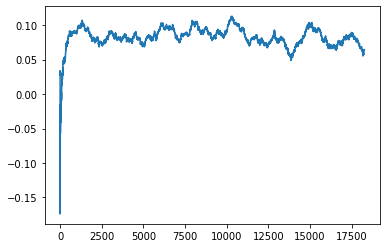

Thread: 3 iteration: 3070
RAM mDiffFit_140 FROM: 1600 --> 1280 reward: 0.0037500000000000033
Thread: 1 iteration: 2977
RAM mDiffFit_308 FROM: 192 --> 2560 reward: -0.14805716953124998
Thread: 6 iteration: 3046
RAM mViewer_1 FROM: 1792 --> 1280 reward: 0.013248098531250016
Thread: 4 iteration: 3028
RAM mProject_82 FROM: 2304 --> 1280 reward: 0.039172326749999986
Thread: 5 iteration: 3122
RAM mDiffFit_240 FROM: 192 --> 1280 reward: -0.22886455781249998
Thread: 3 iteration: 3071
RAM mDiffFit_70 FROM: 1600 --> 1280 reward: 0.146812609375
Thread: 2 iteration: 3023
RAM mDiffFit_367 FROM: 1280 --> 1280 reward: -0.025614601562500013
Thread: 6 iteration: 3047
RAM mDiffFit_184 FROM: 1152 --> 1984 reward: -0.140252676171875
Thread: 4 iteration: 3029
RAM mDiffFit_187 FROM: 448 --> 256 reward: 0.07865623906249997
Thread: 5 iteration: 3123
RAM mProject_11 FROM: 2432 --> 2240 reward: -0.032993505421875166
Thread: 1 iteration: 2978
RAM mDiffFit_115 FROM: 2432 --> 192 reward: 0.18414057578124998
Thread

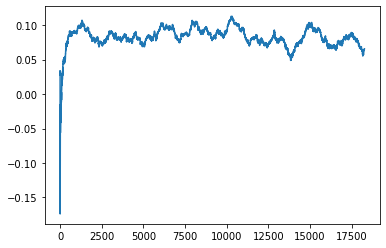

Thread: 4 iteration: 3030
RAM mBackground_56 FROM: 2304 --> 384 reward: 0.33470115593749994
Thread: 2 iteration: 3024
RAM mDiffFit_115 FROM: 704 --> 192 reward: 0.054007722265624995
Thread: 5 iteration: 3124
RAM mConcatFit_3 FROM: 1984 --> 1280 reward: 0.06884584062499999
Thread: 1 iteration: 2979
RAM mDiffFit_56 FROM: 704 --> 1280 reward: -0.053026017968750006
Thread: 3 iteration: 3073
RAM mDiffFit_340 FROM: 1600 --> 2496 reward: 0.02214588437499998
Thread: 2 iteration: 3025
RAM mBackground_8 FROM: 1152 --> 2240 reward: -0.011647996882812489
Thread: 4 iteration: 3031
RAM mProject_66 FROM: 1024 --> 1280 reward: -0.08210997900000001
Thread: 6 iteration: 3048
RAM mDiffFit_90 FROM: 1920 --> 2304 reward: 0.07600008750000001
Thread: 5 iteration: 3125
RAM mDiffFit_414 FROM: 256 --> 1984 reward: -0.0940103546875
Thread: 4 iteration: 3032
RAM mDiffFit_237 FROM: 2816 --> 2560 reward: 0.031635442187500015
Thread: 5 iteration: 3126
RAM mDiffFit_185 FROM: 576 --> 192 reward: 0.067617146484375
Thre

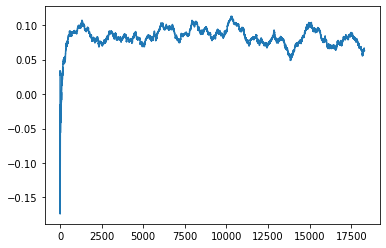

Thread: 6 iteration: 3050
RAM mDiffFit_230 FROM: 2240 --> 2880 reward: 0.04155475585937502
Thread: 3 iteration: 3075
RAM mDiffFit_223 FROM: 2048 --> 2560 reward: -0.03697920312500002
Thread: 2 iteration: 3028
RAM mDiffFit_232 FROM: 1856 --> 1280 reward: -0.01865628281250002
Saving ...


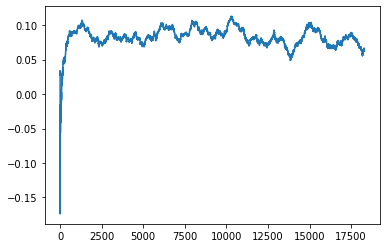

Thread: 5 iteration: 3130
RAM mDiffFit_316 FROM: 2816 --> 2880 reward: 0.002992190234375001
Thread: 6 iteration: 3051
RAM mDiffFit_118 FROM: 1088 --> 1280 reward: -0.056531282812500014
Thread: 3 iteration: 3076
RAM mDiffFit_190 FROM: 2816 --> 1984 reward: -0.0006458406250000118
Thread: 3 iteration: 3077
RAM mBackground_57 FROM: 1088 --> 256 reward: 0.48664125583593754
Thread: 5 iteration: 3131
RAM mDiffFit_271 FROM: 1024 --> 320 reward: 0.11144269921874998
Thread: 3 iteration: 3078
RAM mDiffFit_183 FROM: 896 --> 1920 reward: 0.037406370312500006
Thread: 5 iteration: 3132
RAM mProject_64 FROM: 1344 --> 1984 reward: -0.05563070135156256
Thread: 6 iteration: 3052
RAM mBackground_61 FROM: 512 --> 1280 reward: -1.0
Saving ...


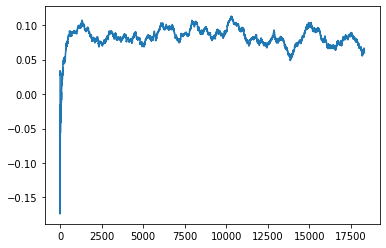

Thread: 1 iteration: 2980
RAM mDiffFit_239 FROM: 512 --> 1984 reward: -0.27835415937499997
Thread: 3 iteration: 3079
RAM mDiffFit_405 FROM: 1088 --> 1984 reward: 0.04901829570312499
Thread: 1 iteration: 2981
RAM mDiffFit_412 FROM: 2240 --> 2176 reward: 0.08324227773437504
Thread: 5 iteration: 3133
RAM mDiffFit_33 FROM: 2432 --> 192 reward: 0.1507811078125
Thread: 6 iteration: 3053
RAM mProject_32 FROM: 192 --> 256 reward: -1.0
Thread: 2 iteration: 3029
RAM mDiffFit_10 FROM: 2624 --> 1984 reward: 0.01978646015624995
Saving ...


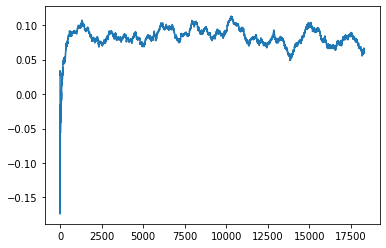

Thread: 3 iteration: 3080
RAM mDiffFit_381 FROM: 1088 --> 1088 reward: 0.027872411328125016
Saving ...


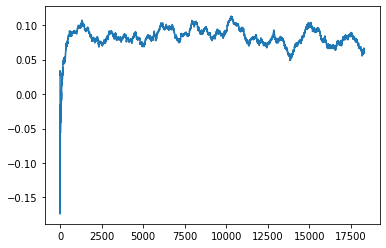

Thread: 2 iteration: 3030
RAM mDiffFit_110 FROM: 1600 --> 384 reward: 0.20463022109375
Thread: 6 iteration: 3054
RAM mDiffFit_40 FROM: 2688 --> 256 reward: 0.28867703593750005
Thread: 5 iteration: 3134
RAM mBackground_89 FROM: 2432 --> 832 reward: -1.0
Thread: 4 iteration: 3036
RAM mProject_8 FROM: 2944 --> 1984 reward: -0.14564374692187504
Thread: 1 iteration: 2982
RAM mDiffFit_247 FROM: 256 --> 2240 reward: -0.189854115625
Thread: 2 iteration: 3031
RAM mDiffFit_250 FROM: 1216 --> 1984 reward: -0.07354431367187503
Thread: 4 iteration: 3037
RAM mDiffFit_330 FROM: 192 --> 1280 reward: -0.286330730078125
Thread: 5 iteration: 3135
RAM mDiffFit_337 FROM: 640 --> 1984 reward: -0.08764838554687501
Thread: 6 iteration: 3055
RAM mProject_3 FROM: 2176 --> 2176 reward: 0.003914068078125099
Thread: 3 iteration: 3081
RAM mDiffFit_162 FROM: 1728 --> 2176 reward: 0.012760442187499995
Thread: 1 iteration: 2983
RAM mDiffFit_220 FROM: 640 --> 1984 reward: -0.09142707968749998
Thread: 5 iteration: 3136


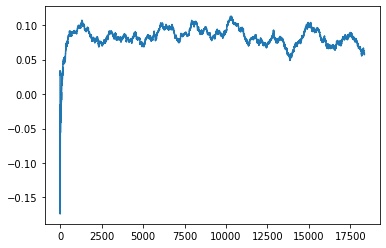

Thread: 4 iteration: 3040
RAM mDiffFit_304 FROM: 1856 --> 192 reward: 0.22669787656249996
Saving ...


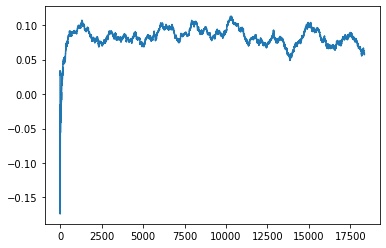

Thread: 5 iteration: 3140
RAM mProject_7 FROM: 768 --> 1280 reward: 0.7604706431250001
Thread: 3 iteration: 3083
RAM mBackground_54 FROM: 1280 --> 1280 reward: 0.0004300000000000123
Thread: 6 iteration: 3058
RAM mBackground_3 FROM: 2240 --> 256 reward: 0.4862156707265625
Thread: 1 iteration: 2987
RAM mProject_73 FROM: 1344 --> 384 reward: -1.0
Thread: 2 iteration: 3034
RAM mDiffFit_105 FROM: 1856 --> 1984 reward: 0.010270840624999993
Thread: 5 iteration: 3141
RAM mDiffFit_312 FROM: 2624 --> 2240 reward: -0.07580738828125001
Thread: 3 iteration: 3084
RAM mDiffFit_23 FROM: 1408 --> 1280 reward: -0.01792190234375001
Thread: 6 iteration: 3059
RAM mDiffFit_356 FROM: 896 --> 832 reward: 0.0364896015625
Thread: 1 iteration: 2988
RAM mDiffFit_402 FROM: 768 --> 2560 reward: -0.04130203593750001
Thread: 5 iteration: 3142
RAM mDiffFit_269 FROM: 1280 --> 1984 reward: -0.0318020796875
Thread: 3 iteration: 3085
RAM mDiffFit_174 FROM: 2176 --> 1984 reward: 0.018401061718749997
Saving ...


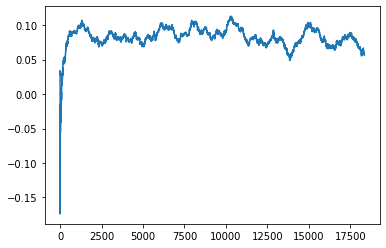

Thread: 6 iteration: 3060
RAM mDiffFit_53 FROM: 320 --> 256 reward: -0.04216409257812501
Thread: 2 iteration: 3035
RAM mConcatFit_1 FROM: 960 --> 320 reward: 0.2906937171875
Thread: 1 iteration: 2989
RAM mBackground_61 FROM: 2432 --> 2240 reward: -1.0
Thread: 4 iteration: 3041
RAM mDiffFit_287 FROM: 704 --> 2240 reward: -0.011289005078125008
Thread: 5 iteration: 3143
RAM mDiffFit_173 FROM: 448 --> 832 reward: -0.033554668359375
Saving ...


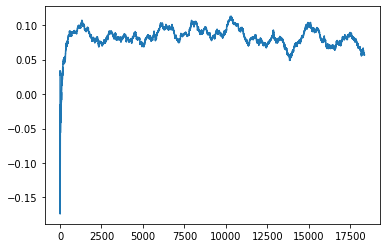

Thread: 1 iteration: 2990
RAM mDiffFit_230 FROM: 2560 --> 256 reward: 0.16445831875
Thread: 6 iteration: 3061
RAM mDiffFit_38 FROM: 832 --> 256 reward: 0.3661458406250001
Thread: 3 iteration: 3086
RAM mDiffFit_157 FROM: 1600 --> 2240 reward: -0.005289048828125004
Thread: 5 iteration: 3144
RAM mDiffFit_364 FROM: 2688 --> 256 reward: 0.15419265546875
Thread: 4 iteration: 3042
RAM mDiffFit_238 FROM: 384 --> 1280 reward: -0.2465729640625
Thread: 3 iteration: 3087
RAM mDiffFit_221 FROM: 960 --> 256 reward: 0.201976570703125
Thread: 6 iteration: 3062
RAM mDiffFit_181 FROM: 2752 --> 2240 reward: -0.004562521874999989
Thread: 5 iteration: 3145
RAM mDiffFit_28 FROM: 2624 --> 832 reward: 0.05509112851562501
Thread: 6 iteration: 3063
RAM mDiffFit_240 FROM: 2880 --> 256 reward: 0.158664005078125
Thread: 4 iteration: 3043
RAM mDiffFit_107 FROM: 576 --> 256 reward: 0.1874896015625
Thread: 3 iteration: 3088
RAM mProject_37 FROM: 1408 --> 256 reward: -1.0
Thread: 2 iteration: 3036
RAM mBackground_82 F

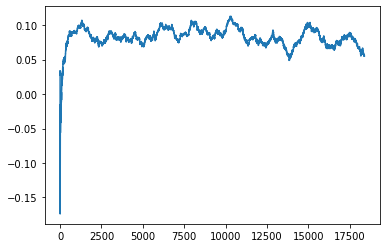

Thread: 2 iteration: 3040
RAM mDiffFit_250 FROM: 3008 --> 2240 reward: -0.06366935742187498
Thread: 4 iteration: 3049
RAM mDiffFit_136 FROM: 2304 --> 2240 reward: 0.04615891523437502
Thread: 1 iteration: 2995
RAM mProject_3 FROM: 1344 --> 832 reward: -1.0
Saving ...


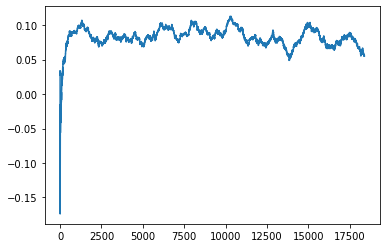

Thread: 3 iteration: 3090
RAM mBackground_80 FROM: 2816 --> 1152 reward: -1.0
Thread: 6 iteration: 3068
RAM mDiffFit_316 FROM: 1664 --> 2560 reward: 0.009640663281249998
Thread: 2 iteration: 3041
RAM mDiffFit_82 FROM: 1024 --> 256 reward: 0.10248951406249998
Saving ...


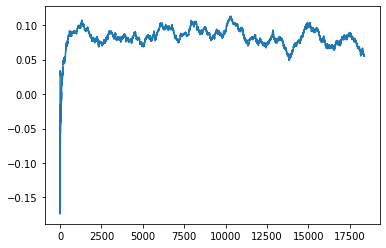

Thread: 5 iteration: 3150
RAM mDiffFit_376 FROM: 2624 --> 2624 reward: 0.05636986640625
Thread: 1 iteration: 2996
RAM mDiffFit_262 FROM: 2176 --> 192 reward: 0.17161714648437498
Saving ...


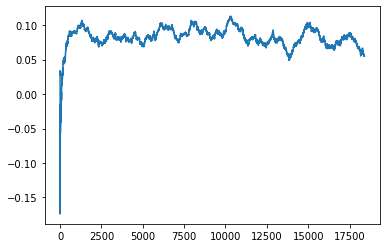

Thread: 4 iteration: 3050
RAM mDiffFit_211 FROM: 512 --> 256 reward: 0.006802035937499944
Thread: 3 iteration: 3091
RAM mDiffFit_403 FROM: 2560 --> 1984 reward: 0.008947920312499993
Thread: 6 iteration: 3069
RAM mDiffFit_117 FROM: 320 --> 2496 reward: -0.16623429296874997
Thread: 2 iteration: 3042
RAM mDiffFit_290 FROM: 768 --> 1280 reward: -0.0419479203125
Thread: 5 iteration: 3151
RAM mDiffFit_9 FROM: 1280 --> 1280 reward: -0.08658340625
Thread: 4 iteration: 3051
RAM mDiffFit_10 FROM: 2432 --> 2240 reward: -0.03364588437499996
Thread: 3 iteration: 3092
RAM mBackground_29 FROM: 832 --> 256 reward: 0.3280585690156251
Thread: 1 iteration: 2997
RAM mDiffFit_148 FROM: 1216 --> 1280 reward: 0.000572920312500013
Thread: 2 iteration: 3043
RAM mDiffFit_184 FROM: 1344 --> 256 reward: 0.06760148320312503
Saving ...


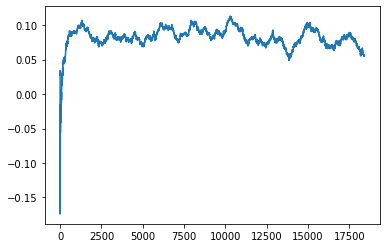

Thread: 6 iteration: 3070
RAM mDiffFit_21 FROM: 2880 --> 2176 reward: 0.010330730078125013
Thread: 4 iteration: 3052
RAM mDiffFit_229 FROM: 2560 --> 2240 reward: 0.026739601562500003
Thread: 3 iteration: 3093
RAM mDiffFit_313 FROM: 1408 --> 384 reward: 0.27844792031250004
Thread: 1 iteration: 2998
RAM mDiffFit_375 FROM: 384 --> 1984 reward: -0.20046608476562505
Thread: 2 iteration: 3044
RAM mDiffFit_71 FROM: 512 --> 2176 reward: -0.13333331874999999
Thread: 4 iteration: 3053
RAM mDiffFit_90 FROM: 384 --> 2176 reward: -0.021317567968749986
Thread: 6 iteration: 3071
RAM mDiffFit_310 FROM: 832 --> 192 reward: 0.27429168125000003
Thread: 4 iteration: 3054
RAM mProject_58 FROM: 2048 --> 192 reward: -1.0
Thread: 5 iteration: 3152
RAM mDiffFit_362 FROM: 2304 --> 192 reward: 0.23047652695312498
Thread: 4 iteration: 3055
RAM mProject_50 FROM: 2752 --> 2240 reward: -0.08910018112499997
Thread: 1 iteration: 2999
RAM mDiffFit_56 FROM: 1856 --> 192 reward: 0.6209088277343751
Thread: 4 iteration: 30

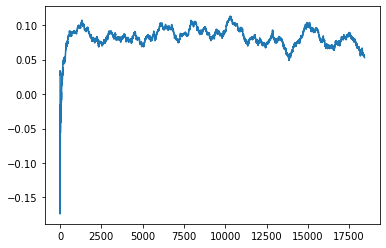

Thread: 1 iteration: 3000
RAM mProject_9 FROM: 256 --> 192 reward: -1.0
Thread: 6 iteration: 3072
RAM mDiffFit_104 FROM: 576 --> 192 reward: 0.5414766144531249
Thread: 5 iteration: 3154
RAM mDiffFit_156 FROM: 192 --> 1280 reward: -0.5246926992187501
Thread: 6 iteration: 3073
RAM mDiffFit_124 FROM: 128 --> 384 reward: -0.316104159375
Thread: 1 iteration: 3001
RAM mDiffFit_289 FROM: 2816 --> 2240 reward: -0.009679712109374999
Thread: 6 iteration: 3074
RAM mDiffFit_142 FROM: 1600 --> 832 reward: 0.10431515429687499
Thread: 1 iteration: 3002
RAM mProject_16 FROM: 960 --> 192 reward: -1.0
Thread: 3 iteration: 3094
RAM mBackground_2 FROM: 2688 --> 192 reward: 1.0227213051328126
Thread: 5 iteration: 3155
RAM mProject_76 FROM: 256 --> 192 reward: -1.0
Thread: 4 iteration: 3058
RAM mDiffFit_175 FROM: 320 --> 832 reward: -0.45794015429687496
Thread: 3 iteration: 3095
RAM mDiffFit_191 FROM: 1856 --> 192 reward: 0.4438229203124999
Thread: 1 iteration: 3003
RAM mBackground_19 FROM: 2624 --> 2240 re

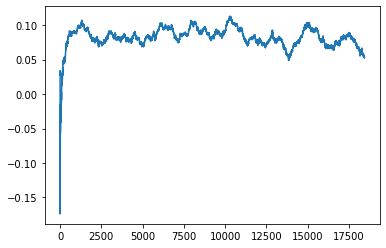

Thread: 4 iteration: 3060
RAM mDiffFit_380 FROM: 1216 --> 1984 reward: -0.0017838277343750104
Thread: 2 iteration: 3047
RAM mBackground_17 FROM: 960 --> 2880 reward: 0.004938434101562564
Thread: 1 iteration: 3005
RAM mViewer_4 FROM: 2688 --> 2240 reward: -0.10918033732031251
Thread: 3 iteration: 3097
RAM mBackground_78 FROM: 640 --> 2752 reward: -1.0
Thread: 6 iteration: 3075
RAM mDiffFit_305 FROM: 1344 --> 1280 reward: -0.09985424687500001
Thread: 2 iteration: 3048
RAM mDiffFit_44 FROM: 448 --> 1984 reward: -0.024260354687500006
Thread: 6 iteration: 3076
RAM mDiffFit_418 FROM: 832 --> 384 reward: 0.0005077660156250011
Thread: 4 iteration: 3061
RAM mDiffFit_47 FROM: 2624 --> 1984 reward: -0.035106835546875034
Thread: 6 iteration: 3077
RAM mDiffFit_134 FROM: 128 --> 2176 reward: -0.6923802210937501
Thread: 4 iteration: 3062
RAM mProject_9 FROM: 384 --> 2560 reward: 0.7672471621875001
Thread: 3 iteration: 3098
RAM mDiffFit_240 FROM: 2368 --> 832 reward: 0.022822876562500014
Thread: 6 ite

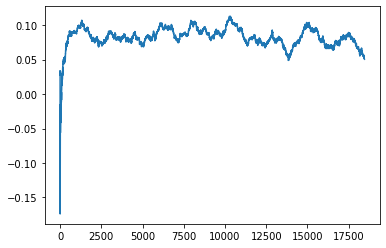

Thread: 6 iteration: 3080
RAM mProject_23 FROM: 640 --> 192 reward: -1.0
Thread: 2 iteration: 3049
RAM mDiffFit_97 FROM: 2304 --> 256 reward: 0.17690619531250001
Saving ...


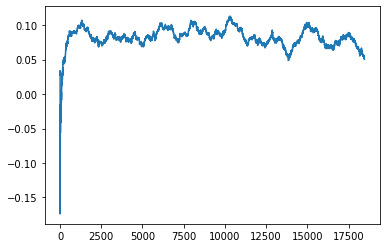

Thread: 3 iteration: 3100
RAM mDiffFit_178 FROM: 2368 --> 832 reward: 0.030460907421874985
Thread: 5 iteration: 3158
RAM mDiffFit_202 FROM: 1728 --> 448 reward: 0.293898516796875
Thread: 1 iteration: 3007
RAM mProject_79 FROM: 128 --> 1024 reward: 0.8797131483749999
Thread: 4 iteration: 3063
RAM mDiffFit_270 FROM: 1856 --> 256 reward: 0.33107801015625005
Saving ...


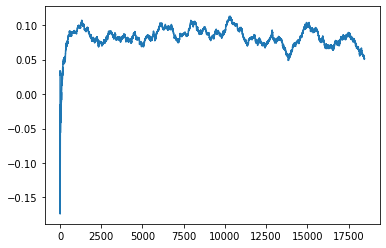

Thread: 2 iteration: 3050
RAM mDiffFit_237 FROM: 2688 --> 832 reward: -0.013765707031249998
Thread: 3 iteration: 3101
RAM mProject_57 FROM: 2048 --> 1984 reward: -0.005882829890625085
Thread: 6 iteration: 3081
RAM mDiffFit_146 FROM: 384 --> 192 reward: 0.38548442421874995
Thread: 4 iteration: 3064
RAM mDiffFit_82 FROM: 2048 --> 1984 reward: -0.025200552734375013
Thread: 3 iteration: 3102
RAM mDiffFit_165 FROM: 2688 --> 1984 reward: -0.005825552734375003
Thread: 6 iteration: 3082
RAM mProject_42 FROM: 2688 --> 2240 reward: -0.06161732760937511
Thread: 1 iteration: 3008
RAM mProject_13 FROM: 1856 --> 1984 reward: 0.037868028960937425
Thread: 5 iteration: 3159
RAM mDiffFit_228 FROM: 192 --> 192 reward: 0.04910157070312497
Thread: 3 iteration: 3103
RAM mDiffFit_82 FROM: 640 --> 832 reward: -0.014604159374999991
Thread: 6 iteration: 3083
RAM mDiffFit_65 FROM: 2816 --> 704 reward: 0.141611969140625
Saving ...


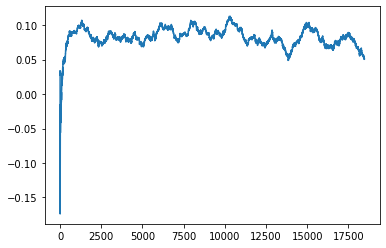

Thread: 5 iteration: 3160
RAM mDiffFit_361 FROM: 1536 --> 832 reward: 0.008283827734375023
Thread: 3 iteration: 3104
RAM mDiffFit_421 FROM: 128 --> 192 reward: -0.5448516144531251
Thread: 5 iteration: 3161
RAM mDiffFit_224 FROM: 1152 --> 1984 reward: -0.007630177343749996
Thread: 3 iteration: 3105
RAM mDiffFit_24 FROM: 2880 --> 192 reward: 0.47899995625
Thread: 6 iteration: 3084
RAM mDiffFit_218 FROM: 320 --> 448 reward: 0.05704431367187502
Thread: 3 iteration: 3106
RAM mDiffFit_358 FROM: 1344 --> 192 reward: 0.18548433671875
Thread: 6 iteration: 3085
RAM mDiffFit_236 FROM: 2048 --> 1280 reward: -0.02537504375000001
Thread: 6 iteration: 3086
RAM mBackground_3 FROM: 1152 --> 1984 reward: 0.0047166424531249794
Thread: 3 iteration: 3107
RAM mProject_69 FROM: 1664 --> 2240 reward: 0.02087590085156241
Thread: 5 iteration: 3162
RAM mDiffFit_40 FROM: 1344 --> 192 reward: 0.24378119531249998
Thread: 3 iteration: 3108
RAM mDiffFit_91 FROM: 3008 --> 832 reward: -0.07279444492187498
Thread: 3 ite

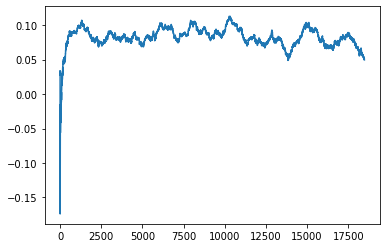

Thread: 3 iteration: 3110
RAM mBackground_38 FROM: 2368 --> 192 reward: 0.6854265658984376
Thread: 5 iteration: 3163
RAM mProject_25 FROM: 704 --> 1984 reward: 0.6553324155234375
Thread: 6 iteration: 3087
RAM mBackground_64 FROM: 1600 --> 192 reward: -1.0
Thread: 2 iteration: 3051
RAM mProject_43 FROM: 2688 --> 192 reward: -1.0
Thread: 1 iteration: 3009
RAM mBackground_77 FROM: 1856 --> 192 reward: -1.0
Thread: 4 iteration: 3065
RAM mDiffFit_265 FROM: 896 --> 448 reward: 0.11044011054687498
Thread: 3 iteration: 3111
RAM mDiffFit_259 FROM: 1856 --> 1152 reward: 0.024216128515624994
Thread: 2 iteration: 3052
RAM mDiffFit_273 FROM: 192 --> 192 reward: 0.022484380468749954
Thread: 6 iteration: 3088
RAM mDiffFit_46 FROM: 1792 --> 192 reward: 0.14976553203124998
Saving ...


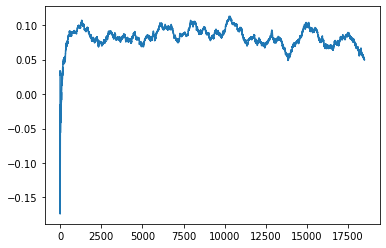

Thread: 1 iteration: 3010
RAM mDiffFit_95 FROM: 3008 --> 192 reward: 0.17689825429687503
Thread: 4 iteration: 3066
RAM mDiffFit_251 FROM: 1600 --> 1280 reward: -0.00973960156250002
Thread: 6 iteration: 3089
RAM mDiffFit_106 FROM: 2112 --> 192 reward: 0.21778119531249995
Thread: 3 iteration: 3112
RAM mDiffFit_65 FROM: 2176 --> 1152 reward: 0.03360938046874999
Thread: 4 iteration: 3067
RAM mBackground_57 FROM: 3008 --> 2240 reward: -0.028906368710937515
Saving ...


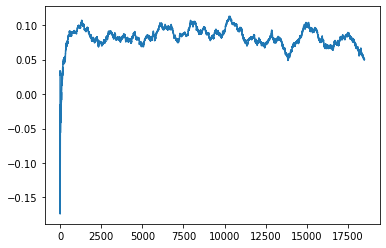

Thread: 6 iteration: 3090
RAM mDiffFit_380 FROM: 2624 --> 1152 reward: -0.07236210039062499
Thread: 4 iteration: 3068
RAM mBackground_56 FROM: 832 --> 768 reward: -0.8339497185000001
Thread: 1 iteration: 3011
RAM mBgModel_2 FROM: 1472 --> 192 reward: 0.040447701562499994
Thread: 3 iteration: 3113
RAM mDiffFit_357 FROM: 1216 --> 192 reward: 0.3343802210937501
Thread: 6 iteration: 3091
RAM mDiffFit_16 FROM: 2112 --> 1984 reward: 0.018268251953125012
Thread: 6 iteration: 3092
RAM mBackground_14 FROM: 960 --> 2240 reward: -0.020429377265625
Thread: 3 iteration: 3114
RAM mProject_32 FROM: 1792 --> 192 reward: -1.0
Thread: 2 iteration: 3053
RAM mDiffFit_75 FROM: 1856 --> 2688 reward: -0.0035182082031250117
Thread: 6 iteration: 3093
RAM mDiffFit_363 FROM: 2688 --> 256 reward: 0.2361353546875
Thread: 3 iteration: 3115
RAM mDiffFit_293 FROM: 2752 --> 192 reward: 0.161187434375
Thread: 2 iteration: 3054
RAM mProject_72 FROM: 320 --> 1088 reward: 0.8155881247500001
Thread: 4 iteration: 3069
RAM m

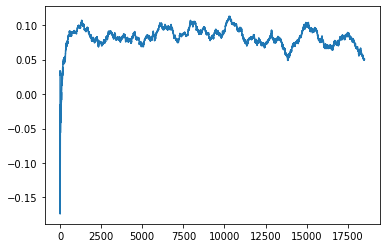

Thread: 4 iteration: 3070
RAM mDiffFit_288 FROM: 640 --> 1088 reward: -0.001106748046875005
Thread: 6 iteration: 3095
RAM mBackground_9 FROM: 2816 --> 448 reward: 0.26172654124999994
Thread: 3 iteration: 3117
RAM mDiffFit_339 FROM: 2880 --> 1984 reward: -0.024020884375000016
Thread: 6 iteration: 3096
RAM mDiffFit_45 FROM: 1472 --> 192 reward: 0.19055721328125003
Thread: 1 iteration: 3013
RAM mDiffFit_128 FROM: 1472 --> 192 reward: 0.18169261171875
Thread: 3 iteration: 3118
RAM mDiffFit_126 FROM: 1088 --> 256 reward: 0.8975939796875
Thread: 4 iteration: 3071
RAM mViewer_4 FROM: 1152 --> 256 reward: 1.4888294014687502
Thread: 5 iteration: 3165
RAM mDiffFit_422 FROM: 1536 --> 192 reward: 0.3215156195312501
Thread: 3 iteration: 3119
RAM mDiffFit_293 FROM: 1856 --> 2240 reward: 0.010328141406249994
Thread: 4 iteration: 3072
RAM mDiffFit_127 FROM: 896 --> 1280 reward: -0.015192699218750001
Thread: 4 iteration: 3073
RAM mDiffFit_26 FROM: 3008 --> 192 reward: 0.18932805390625002
Saving ...


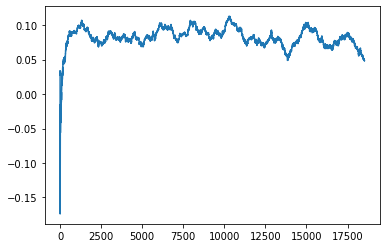

Thread: 3 iteration: 3120
RAM mProject_71 FROM: 448 --> 2176 reward: 0.684255758625
Thread: 1 iteration: 3014
RAM mDiffFit_351 FROM: 512 --> 1984 reward: -0.03767703593749999
Thread: 4 iteration: 3074
RAM mProject_69 FROM: 1600 --> 192 reward: -1.0
Thread: 2 iteration: 3056
RAM mDiffFit_103 FROM: 1408 --> 384 reward: 0.04421349609375
Thread: 4 iteration: 3075
RAM mDiffFit_67 FROM: 1856 --> 768 reward: 0.08045050898437497
Thread: 2 iteration: 3057
RAM mProject_6 FROM: 1216 --> 192 reward: -1.0
Thread: 6 iteration: 3097
RAM mDiffFit_263 FROM: 576 --> 1984 reward: -0.12471095117187503
Thread: 2 iteration: 3058
RAM mDiffFit_42 FROM: 2048 --> 704 reward: 0.10989325195312499
Thread: 4 iteration: 3076
RAM mDiffFit_100 FROM: 2752 --> 832 reward: 0.011007766015625024
Thread: 4 iteration: 3077
RAM mDiffFit_179 FROM: 1856 --> 256 reward: 0.45337495625
Thread: 2 iteration: 3059
RAM mAdd_3 FROM: 1984 --> 2496 reward: 0.08720978808593759
Thread: 6 iteration: 3098
RAM mDiffFit_30 FROM: 1408 --> 256 r

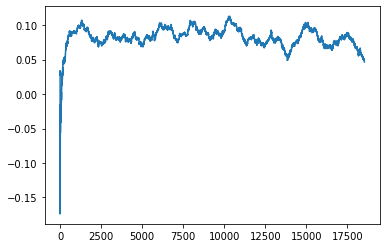

Thread: 2 iteration: 3060
RAM mDiffFit_350 FROM: 704 --> 832 reward: -0.04507033164062499
Thread: 6 iteration: 3099
RAM mBackground_89 FROM: 2816 --> 448 reward: -1.0
Thread: 1 iteration: 3015
RAM mDiffFit_210 FROM: 2240 --> 384 reward: 0.09371090742187499
Saving ...


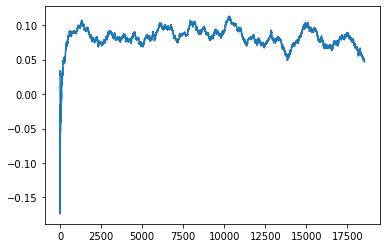

Thread: 6 iteration: 3100
RAM mProject_87 FROM: 768 --> 2880 reward: 0.7946419267968751
Thread: 4 iteration: 3079
RAM mDiffFit_201 FROM: 640 --> 704 reward: -0.012955730078125002
Thread: 6 iteration: 3101
RAM mBackground_83 FROM: 960 --> 192 reward: -1.0
Thread: 5 iteration: 3166
RAM mProject_25 FROM: 1280 --> 1984 reward: -0.07864867518750006
Thread: 2 iteration: 3061
RAM mDiffFit_1 FROM: 256 --> 1984 reward: -0.48385420312500005
Saving ...


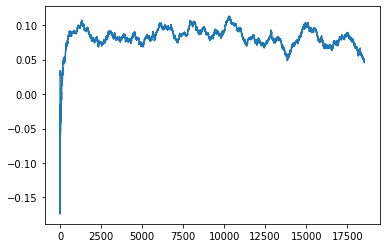

Thread: 4 iteration: 3080
RAM mBackground_49 FROM: 2048 --> 192 reward: -1.0
Thread: 3 iteration: 3121
RAM mBackground_9 FROM: 1408 --> 320 reward: 0.42381201478906255
Thread: 6 iteration: 3102
RAM mDiffFit_413 FROM: 960 --> 1152 reward: -0.012367190234375
Thread: 4 iteration: 3081
RAM mDiffFit_241 FROM: 1216 --> 768 reward: 0.05961460156250002
Thread: 3 iteration: 3122
RAM mBackground_6 FROM: 2624 --> 1280 reward: -0.12682785029687502
Thread: 6 iteration: 3103
RAM mDiffFit_182 FROM: 960 --> 192 reward: 0.33273438046875004
Thread: 3 iteration: 3123
RAM mDiffFit_353 FROM: 1088 --> 256 reward: 0.138979159375
Thread: 3 iteration: 3124
RAM mProject_9 FROM: 640 --> 192 reward: -1.0
Thread: 2 iteration: 3062
RAM mDiffFit_173 FROM: 2944 --> 320 reward: 0.178778606640625
Thread: 2 iteration: 3063
RAM mDiffFit_380 FROM: 192 --> 384 reward: -0.21259376093750001
Thread: 2 iteration: 3064
RAM mProject_62 FROM: 2304 --> 768 reward: -1.0
Thread: 4 iteration: 3082
RAM mBackground_47 FROM: 256 --> 192

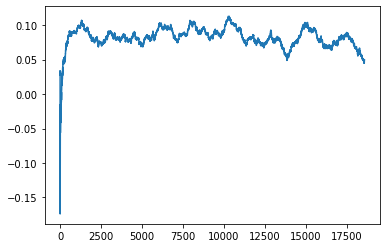

Thread: 1 iteration: 3020
RAM mDiffFit_370 FROM: 2560 --> 1984 reward: -0.01130471210937501
Thread: 2 iteration: 3068
RAM mDiffFit_93 FROM: 896 --> 2176 reward: -0.043427079687499995
Saving ...


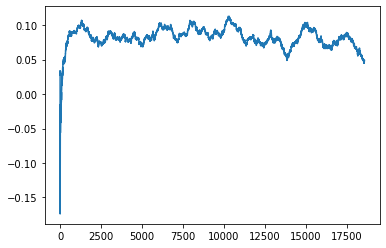

Thread: 5 iteration: 3170
RAM mDiffFit_166 FROM: 1280 --> 2240 reward: 0.026593804687500007
Thread: 1 iteration: 3021
RAM mProject_63 FROM: 2048 --> 1152 reward: 0.12673772226562494
Thread: 6 iteration: 3108
RAM mDiffFit_55 FROM: 1728 --> 320 reward: 0.126986969140625
Thread: 1 iteration: 3022
RAM mDiffFit_284 FROM: 1536 --> 2240 reward: 0.0026146015625000234
Thread: 6 iteration: 3109
RAM mProject_87 FROM: 640 --> 2176 reward: 0.6743351224687499
Thread: 2 iteration: 3069
RAM mDiffFit_365 FROM: 2304 --> 384 reward: 0.056453053906249995
Thread: 1 iteration: 3023
RAM mDiffFit_125 FROM: 448 --> 256 reward: 0.259330773828125
Saving ...


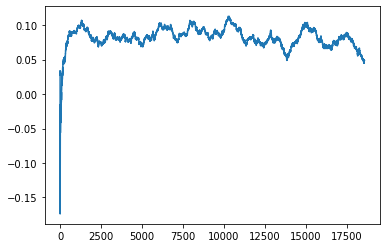

Thread: 6 iteration: 3110
RAM mDiffFit_197 FROM: 704 --> 256 reward: 0.189070331640625
Saving ...


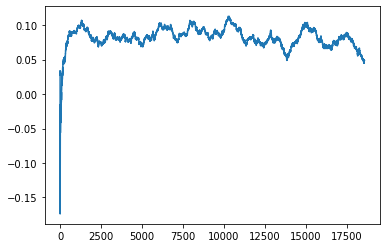

Thread: 2 iteration: 3070
RAM mDiffFit_47 FROM: 1536 --> 1984 reward: -0.09661727773437503
Thread: 1 iteration: 3024
RAM mDiffFit_58 FROM: 1344 --> 1984 reward: -0.0012734292968749963
Thread: 2 iteration: 3071
RAM mDiffFit_93 FROM: 1536 --> 192 reward: 0.18796871718749997
Thread: 6 iteration: 3111
RAM mBackground_78 FROM: 2368 --> 192 reward: -1.0
Thread: 4 iteration: 3086
RAM mDiffFit_179 FROM: 384 --> 832 reward: -0.19052865039062503
Thread: 2 iteration: 3072
RAM mDiffFit_247 FROM: 1280 --> 1024 reward: 0.1063854859375
Thread: 1 iteration: 3025
RAM mAdd_2 FROM: 1344 --> 2176 reward: -1.0
Thread: 5 iteration: 3171
RAM mDiffFit_340 FROM: 2560 --> 192 reward: 0.24474995625
Thread: 1 iteration: 3026
RAM mDiffFit_411 FROM: 192 --> 256 reward: -0.14930207968750003
Thread: 2 iteration: 3073
RAM mDiffFit_300 FROM: 1856 --> 1088 reward: -0.03746621601562501
Thread: 5 iteration: 3172
RAM mDiffFit_225 FROM: 2880 --> 1152 reward: -0.010562565625000034
Thread: 1 iteration: 3027
RAM mDiffFit_213 F

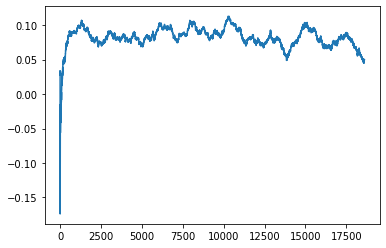

Thread: 3 iteration: 3130
RAM mDiffFit_148 FROM: 2368 --> 192 reward: 0.2057395140625
Thread: 2 iteration: 3075
RAM mProject_39 FROM: 2368 --> 384 reward: -1.0
Thread: 6 iteration: 3112
RAM mProject_42 FROM: 2688 --> 256 reward: -1.0
Thread: 4 iteration: 3087
RAM mDiffFit_245 FROM: 2816 --> 1984 reward: 0.025481791796874986
Thread: 1 iteration: 3029
RAM mDiffFit_339 FROM: 320 --> 2240 reward: -0.32993230078125
Thread: 2 iteration: 3076
RAM mDiffFit_255 FROM: 1664 --> 192 reward: 0.23641663749999997
Thread: 4 iteration: 3088
RAM mProject_7 FROM: 1408 --> 192 reward: -1.0
Thread: 6 iteration: 3113
RAM mDiffFit_267 FROM: 2496 --> 256 reward: 0.47389847304687505
Thread: 6 iteration: 3114
RAM mDiffFit_396 FROM: 2816 --> 320 reward: 0.28762754492187503
Thread: 6 iteration: 3115
RAM mDiffFit_315 FROM: 704 --> 768 reward: 0.05855212343749999
Thread: 6 iteration: 3116
RAM mBackground_87 FROM: 2816 --> 192 reward: -1.0
Thread: 5 iteration: 3174
RAM mDiffFit_345 FROM: 1856 --> 384 reward: 0.26753

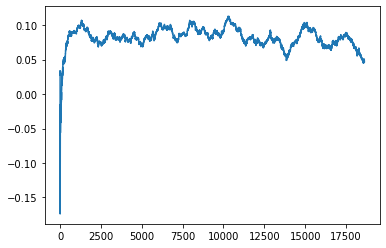

Thread: 1 iteration: 3030
RAM mDiffFit_312 FROM: 512 --> 1088 reward: -0.05095050898437498
Thread: 5 iteration: 3175
RAM mDiffFit_331 FROM: 2624 --> 832 reward: 0.021867146484374992
Saving ...


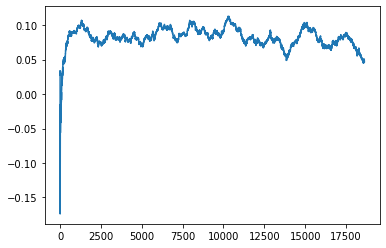

Thread: 4 iteration: 3090
RAM mBackground_88 FROM: 1088 --> 1088 reward: -1.0
Thread: 2 iteration: 3077
RAM mDiffFit_422 FROM: 2176 --> 1280 reward: -0.031395884375000016
Thread: 5 iteration: 3176
RAM mDiffFit_18 FROM: 2944 --> 256 reward: 0.14597389453125
Thread: 1 iteration: 3031
RAM mDiffFit_164 FROM: 1344 --> 192 reward: 0.307039048828125
Thread: 5 iteration: 3177
RAM mDiffFit_24 FROM: 832 --> 192 reward: 0.294101570703125
Thread: 1 iteration: 3032
RAM mBackground_90 FROM: 1792 --> 1920 reward: -1.0
Thread: 3 iteration: 3132
RAM mDiffFit_349 FROM: 1856 --> 1088 reward: 0.03317966835937502
Thread: 1 iteration: 3033
RAM mDiffFit_360 FROM: 1152 --> 256 reward: 0.172875
Thread: 5 iteration: 3178
RAM mProject_82 FROM: 384 --> 320 reward: -1.0
Thread: 6 iteration: 3118
RAM mProject_50 FROM: 1728 --> 1088 reward: 0.172167172734375
Thread: 4 iteration: 3091
RAM mDiffFit_363 FROM: 1920 --> 256 reward: 0.11863017734375
Thread: 1 iteration: 3034
RAM mDiffFit_359 FROM: 2112 --> 192 reward: 0.1

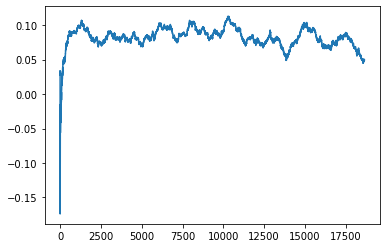

Thread: 5 iteration: 3180
RAM mDiffFit_395 FROM: 896 --> 1984 reward: 0.0059766144531249975
Thread: 2 iteration: 3079
RAM mDiffFit_137 FROM: 2560 --> 256 reward: 0.49367712343750003
Thread: 4 iteration: 3092
RAM mDiffFit_17 FROM: 384 --> 1088 reward: -0.111794269921875
Thread: 1 iteration: 3035
RAM mDiffFit_238 FROM: 2560 --> 1984 reward: -0.07848968906249998
Thread: 4 iteration: 3093
RAM mDiffFit_164 FROM: 1472 --> 192 reward: 0.254877588671875
Thread: 5 iteration: 3181
RAM mDiffFit_175 FROM: 768 --> 320 reward: 0.5098620566406251
Saving ...


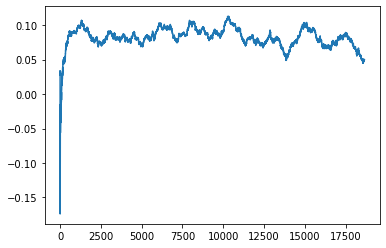

Thread: 2 iteration: 3080
RAM mDiffFit_89 FROM: 2624 --> 192 reward: 0.218815023046875
Thread: 4 iteration: 3094
RAM mDiffFit_399 FROM: 1536 --> 192 reward: 0.22692181484375
Thread: 5 iteration: 3182
RAM mDiffFit_386 FROM: 1216 --> 1984 reward: 0.0048411722656249885
Thread: 5 iteration: 3183
RAM mProject_72 FROM: 2368 --> 256 reward: -1.0
Thread: 3 iteration: 3134
RAM mAdd_2 FROM: 1792 --> 256 reward: -1.0
Thread: 6 iteration: 3119
RAM mDiffFit_17 FROM: 1024 --> 256 reward: 0.290354203125
Thread: 4 iteration: 3095
RAM mBackground_12 FROM: 2816 --> 1280 reward: -0.043564516093749985
Thread: 3 iteration: 3135
RAM mDiffFit_58 FROM: 832 --> 832 reward: -0.00804949101562499
Thread: 4 iteration: 3096
RAM mDiffFit_36 FROM: 1920 --> 256 reward: 0.21404163750000005
Thread: 5 iteration: 3184
RAM mDiffFit_159 FROM: 2240 --> 256 reward: 0.4695469460937501
Saving ...


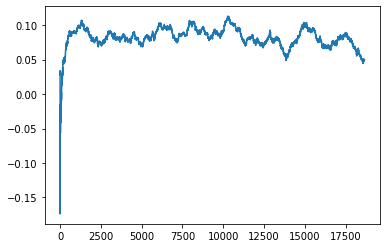

Thread: 6 iteration: 3120
RAM mDiffFit_241 FROM: 256 --> 2176 reward: -0.455812521875
Thread: 6 iteration: 3121
RAM mProject_48 FROM: 2112 --> 320 reward: -1.0
Thread: 2 iteration: 3081
RAM mDiffFit_364 FROM: 960 --> 1408 reward: 0.08402873789062501
Thread: 5 iteration: 3185
RAM mDiffFit_41 FROM: 1088 --> 256 reward: 0.037666637499999996
Thread: 4 iteration: 3097
RAM mDiffFit_271 FROM: 704 --> 1088 reward: -0.0035911285156250104
Thread: 5 iteration: 3186
RAM mDiffFit_373 FROM: 704 --> 192 reward: 0.261044269921875
Thread: 4 iteration: 3098
RAM mViewer_4 FROM: 2752 --> 1280 reward: -0.0463102983749999
Thread: 2 iteration: 3082
RAM mDiffFit_239 FROM: 1728 --> 2560 reward: 0.108679843359375
Thread: 2 iteration: 3083
RAM mBackground_63 FROM: 2880 --> 192 reward: -1.0
Thread: 1 iteration: 3036
RAM mDiffFit_175 FROM: 1280 --> 2176 reward: -0.02468225703125
Thread: 2 iteration: 3084
RAM mDiffFit_15 FROM: 2304 --> 256 reward: 0.31407292031250006
Thread: 2 iteration: 3085
RAM mProject_8 FROM: 2

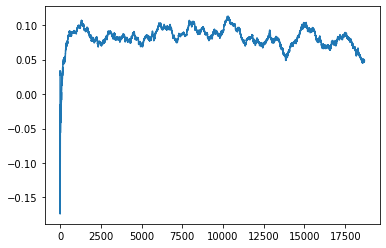

Thread: 5 iteration: 3190
RAM mDiffFit_249 FROM: 2560 --> 1984 reward: 0.030575552734375018
Saving ...


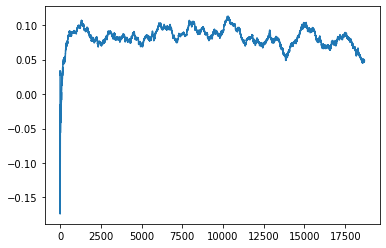

Thread: 1 iteration: 3040
RAM mDiffFit_130 FROM: 256 --> 192 reward: 0.15008073007812497
Thread: 2 iteration: 3088
RAM mDiffFit_382 FROM: 832 --> 192 reward: 0.41068743437499994
Thread: 3 iteration: 3137
RAM mDiffFit_370 FROM: 2560 --> 256 reward: 0.16487495624999998
Thread: 6 iteration: 3123
RAM mProject_76 FROM: 2176 --> 256 reward: -1.0
Saving ...


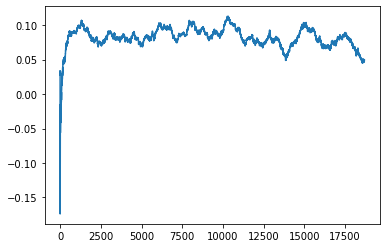

Thread: 4 iteration: 3100
RAM mDiffFit_383 FROM: 1280 --> 192 reward: 0.273083275
Thread: 6 iteration: 3124
RAM mConcatFit_3 FROM: 1216 --> 2176 reward: -0.060470831874999936
Thread: 6 iteration: 3125
RAM mBackground_17 FROM: 2112 --> 192 reward: 0.8692516787734373
Thread: 4 iteration: 3101
RAM mBackground_4 FROM: 2880 --> 192 reward: 0.695954811875
Thread: 5 iteration: 3191
RAM mDiffFit_197 FROM: 1024 --> 2560 reward: -0.01262495625000002
Thread: 5 iteration: 3192
RAM mBackground_88 FROM: 1664 --> 2176 reward: -1.0
Thread: 2 iteration: 3089
RAM mProject_50 FROM: 1792 --> 192 reward: -1.0
Thread: 1 iteration: 3041
RAM mDiffFit_276 FROM: 192 --> 192 reward: 0.0016249999999999598
Saving ...


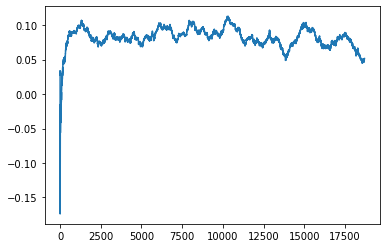

Thread: 2 iteration: 3090
RAM mDiffFit_234 FROM: 768 --> 1088 reward: 0.013393251953124994
Thread: 1 iteration: 3042
RAM mDiffFit_311 FROM: 1984 --> 256 reward: 0.083187434375
Thread: 2 iteration: 3091
RAM mDiffFit_44 FROM: 2368 --> 1984 reward: 0.019924491015625
Thread: 2 iteration: 3092
RAM mProject_81 FROM: 1024 --> 192 reward: -1.0
Thread: 6 iteration: 3126
RAM mDiffFit_262 FROM: 704 --> 1280 reward: 0.026882853515625017
Thread: 6 iteration: 3127
RAM mDiffFit_163 FROM: 2752 --> 1920 reward: -0.019197964062500003
Thread: 6 iteration: 3128
RAM mBackground_70 FROM: 320 --> 192 reward: -1.0
Thread: 3 iteration: 3138
RAM mBackground_69 FROM: 1920 --> 192 reward: -1.0
Thread: 4 iteration: 3102
RAM mBackground_73 FROM: 128 --> 192 reward: -1.0
Thread: 5 iteration: 3193
RAM mProject_48 FROM: 1152 --> 192 reward: -1.0
Thread: 6 iteration: 3129
RAM mDiffFit_203 FROM: 768 --> 1984 reward: -0.0025520359374999954
Thread: 5 iteration: 3194
RAM mDiffFit_2 FROM: 1920 --> 256 reward: 0.412635398437

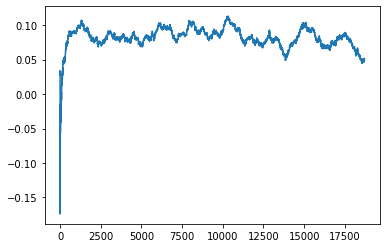

Thread: 6 iteration: 3130
RAM mBackground_46 FROM: 2240 --> 192 reward: -1.0
Thread: 1 iteration: 3043
RAM mDiffFit_382 FROM: 3008 --> 192 reward: 0.48060143945312495
Thread: 5 iteration: 3195
RAM mDiffFit_291 FROM: 256 --> 2176 reward: -0.3385311953125
Thread: 2 iteration: 3094
RAM mDiffFit_72 FROM: 2560 --> 1984 reward: 0.007947920312499999
Thread: 1 iteration: 3044
RAM mDiffFit_272 FROM: 1216 --> 192 reward: 0.27115360664062504
Thread: 6 iteration: 3131
RAM mDiffFit_355 FROM: 128 --> 1984 reward: -1.30322393828125
Thread: 5 iteration: 3196
RAM mDiffFit_124 FROM: 1536 --> 192 reward: 0.22759367343750003
Thread: 6 iteration: 3132
RAM mDiffFit_396 FROM: 2112 --> 192 reward: 0.587210907421875
Thread: 1 iteration: 3045
RAM mDiffFit_192 FROM: 1344 --> 448 reward: 0.18669011054687504
Thread: 5 iteration: 3197
RAM mBackground_31 FROM: 3008 --> 192 reward: -1.0
Thread: 3 iteration: 3139
RAM mBackground_27 FROM: 2112 --> 2752 reward: 0.12103398158593748
Thread: 6 iteration: 3133
RAM mProject_

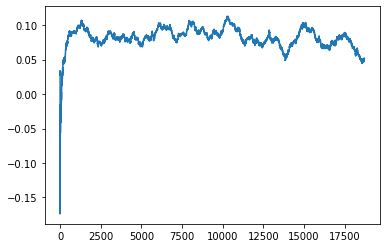

Thread: 3 iteration: 3140
RAM mDiffFit_181 FROM: 2688 --> 1984 reward: -0.01305212343749999
Thread: 5 iteration: 3199
RAM mProject_59 FROM: 1600 --> 192 reward: -1.0
Thread: 2 iteration: 3095
RAM mDiffFit_321 FROM: 2304 --> 2624 reward: 0.09839075078125002
Thread: 2 iteration: 3096
RAM mBackground_16 FROM: 2944 --> 192 reward: 0.7302047872265623
Thread: 3 iteration: 3141
RAM mProject_70 FROM: 1408 --> 1152 reward: 0.08784656282812506
Thread: 1 iteration: 3046
RAM mDiffFit_294 FROM: 832 --> 1088 reward: -0.002434889453125002
Thread: 3 iteration: 3142
RAM mDiffFit_228 FROM: 768 --> 2752 reward: -0.08883068632812502
Thread: 1 iteration: 3047
RAM mDiffFit_363 FROM: 448 --> 2176 reward: -0.05317181484374999
Thread: 1 iteration: 3048
RAM mProject_47 FROM: 1792 --> 704 reward: -1.0
Thread: 4 iteration: 3105
RAM mDiffFit_126 FROM: 2304 --> 2240 reward: -0.027096393359375033
Thread: 1 iteration: 3049
RAM mDiffFit_278 FROM: 1728 --> 256 reward: 0.24079944726562497
Thread: 4 iteration: 3106
RAM m

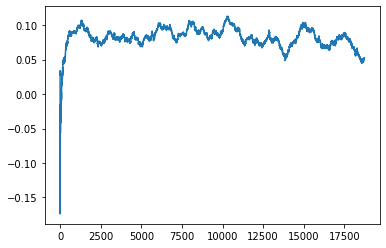

Thread: 5 iteration: 3200
RAM mDiffFit_155 FROM: 960 --> 1408 reward: 0.02176566328124999
Thread: 5 iteration: 3201
RAM mDiffFit_111 FROM: 2560 --> 192 reward: 0.18891137265625
Thread: 4 iteration: 3107
RAM mDiffFit_216 FROM: 1728 --> 192 reward: 0.21422652695312494
Thread: 5 iteration: 3202
RAM mDiffFit_151 FROM: 256 --> 192 reward: -0.031023473046874958
Thread: 4 iteration: 3108
RAM mProject_84 FROM: 1216 --> 256 reward: -1.0
Thread: 3 iteration: 3143
RAM mDiffFit_113 FROM: 1152 --> 1984 reward: -0.0069843367187500185
Thread: 4 iteration: 3109
RAM mBackground_61 FROM: 1280 --> 192 reward: -1.0
Thread: 6 iteration: 3134
RAM mDiffFit_145 FROM: 2048 --> 192 reward: 0.47808853984375005
Thread: 5 iteration: 3203
RAM mBackground_57 FROM: 384 --> 1088 reward: -1.0
Saving ...


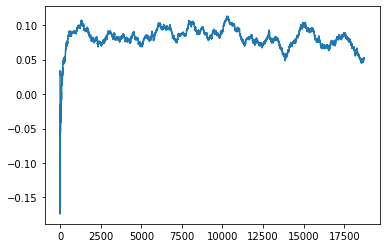

Thread: 1 iteration: 3050
RAM mDiffFit_174 FROM: 2432 --> 1984 reward: -0.06083081757812503
Thread: 5 iteration: 3204
RAM mDiffFit_273 FROM: 1984 --> 448 reward: 0.17365887148437503
Thread: 3 iteration: 3144
RAM mDiffFit_98 FROM: 1920 --> 192 reward: 0.25985933671875006
Saving ...


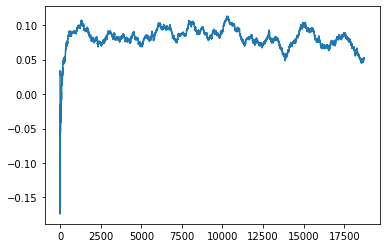

Thread: 4 iteration: 3110
RAM mBackground_78 FROM: 576 --> 192 reward: -1.0
Thread: 2 iteration: 3097
RAM mDiffFit_15 FROM: 2304 --> 2176 reward: 0.024885442187499995
Thread: 5 iteration: 3205
RAM mDiffFit_186 FROM: 2112 --> 192 reward: 0.2640077660156249
Thread: 3 iteration: 3145
RAM mDiffFit_416 FROM: 576 --> 256 reward: 0.4022188046875
Thread: 4 iteration: 3111
RAM mDiffFit_404 FROM: 1792 --> 256 reward: 0.47725004374999996
Thread: 2 iteration: 3098
RAM mDiffFit_253 FROM: 2368 --> 192 reward: 0.5706535628906251
Thread: 5 iteration: 3206
RAM mDiffFit_301 FROM: 896 --> 192 reward: 0.23089842929687499
Thread: 3 iteration: 3146
RAM mDiffFit_281 FROM: 3008 --> 2176 reward: -0.021322964062500012
Thread: 2 iteration: 3099
RAM mDiffFit_17 FROM: 2112 --> 192 reward: 0.17148433671874996
Thread: 3 iteration: 3147
RAM mDiffFit_337 FROM: 448 --> 192 reward: 0.382132809765625
Thread: 4 iteration: 3112
RAM mDiffFit_395 FROM: 1280 --> 256 reward: 0.09111442656250007
Saving ...


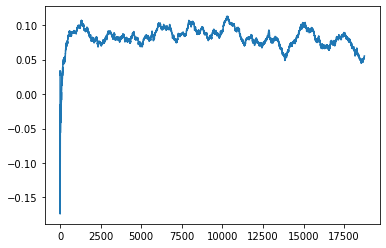

Thread: 2 iteration: 3100
RAM mProject_16 FROM: 2176 --> 256 reward: -1.0
Thread: 1 iteration: 3051
RAM mDiffFit_64 FROM: 192 --> 192 reward: -0.07233595117187502
Thread: 4 iteration: 3113
RAM mDiffFit_379 FROM: 1536 --> 192 reward: 0.31504681484374997
Thread: 3 iteration: 3148
RAM mDiffFit_50 FROM: 2368 --> 256 reward: 0.34146336484374995
Thread: 2 iteration: 3101
RAM mDiffFit_110 FROM: 2240 --> 1088 reward: 0.027132809765625012
Thread: 3 iteration: 3149
RAM mBackground_63 FROM: 896 --> 256 reward: -1.0
Thread: 6 iteration: 3135
RAM mDiffFit_140 FROM: 576 --> 192 reward: 0.199625
Thread: 2 iteration: 3102
RAM mProject_33 FROM: 2432 --> 320 reward: -1.0
Thread: 5 iteration: 3207
RAM mViewer_2 FROM: 384 --> 1984 reward: -0.26948446928906256
Saving ...


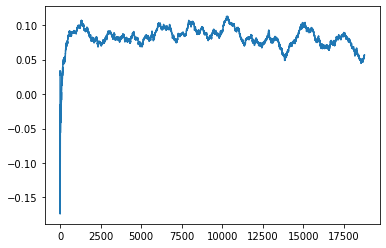

Thread: 3 iteration: 3150
RAM mDiffFit_298 FROM: 1856 --> 192 reward: 0.23544787656249996
Thread: 6 iteration: 3136
RAM mDiffFit_420 FROM: 1536 --> 192 reward: 0.112335907421875
Thread: 2 iteration: 3103
RAM mDiffFit_154 FROM: 2496 --> 256 reward: 0.12089312070312498
Thread: 5 iteration: 3208
RAM mDiffFit_394 FROM: 1472 --> 1920 reward: -0.05330993320312499
Thread: 3 iteration: 3151
RAM mProject_81 FROM: 1728 --> 192 reward: -1.0
Thread: 1 iteration: 3052
RAM mDiffFit_382 FROM: 2304 --> 192 reward: 0.5121796246093749
Thread: 2 iteration: 3104
RAM mProject_46 FROM: 896 --> 192 reward: -1.0
Thread: 4 iteration: 3114
RAM mBackground_12 FROM: 1536 --> 192 reward: 0.6990119771640626
Thread: 6 iteration: 3137
RAM mDiffFit_4 FROM: 1280 --> 192 reward: 0.19501039843749998
Thread: 4 iteration: 3115
RAM mDiffFit_20 FROM: 192 --> 320 reward: -0.19520831874999992
Thread: 1 iteration: 3053
RAM mDiffFit_357 FROM: 768 --> 256 reward: 0.10083327500000003
Thread: 6 iteration: 3138
RAM mDiffFit_389 FROM

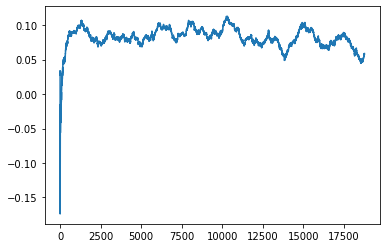

Thread: 5 iteration: 3210
RAM mDiffFit_70 FROM: 2944 --> 256 reward: 0.18181765546875
Thread: 5 iteration: 3211
RAM mBackground_73 FROM: 128 --> 2752 reward: -1.0
Thread: 3 iteration: 3153
RAM mDiffFit_328 FROM: 960 --> 1088 reward: 0.011651061718750029
Thread: 3 iteration: 3154
RAM mBackground_87 FROM: 2368 --> 2240 reward: -1.0
Thread: 2 iteration: 3106
RAM mProject_36 FROM: 2688 --> 960 reward: 0.13854064317187498
Saving ...


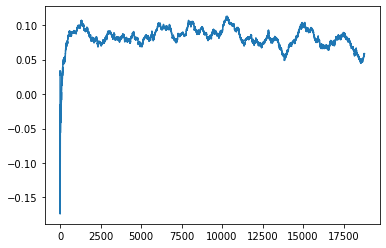

Thread: 6 iteration: 3140
RAM mDiffFit_395 FROM: 1472 --> 2112 reward: 0.092346480859375
Thread: 2 iteration: 3107
RAM mDiffFit_212 FROM: 128 --> 1408 reward: -0.8083854421875002
Thread: 6 iteration: 3141
RAM mDiffFit_309 FROM: 576 --> 1984 reward: -0.027802035937500007
Thread: 2 iteration: 3108
RAM mProject_80 FROM: 256 --> 192 reward: -1.0
Thread: 4 iteration: 3118
RAM mDiffFit_190 FROM: 768 --> 256 reward: 0.20843752187500003
Thread: 6 iteration: 3142
RAM mDiffFit_364 FROM: 832 --> 192 reward: 0.20371353984375
Thread: 2 iteration: 3109
RAM mDiffFit_101 FROM: 2624 --> 2304 reward: -0.005546902343750021
Thread: 6 iteration: 3143
RAM mProject_80 FROM: 2432 --> 192 reward: -1.0
Thread: 3 iteration: 3155
RAM mDiffFit_245 FROM: 1088 --> 256 reward: 0.16322393828124998
Thread: 6 iteration: 3144
RAM mDiffFit_49 FROM: 1344 --> 256 reward: 0.1492395140625
Saving ...


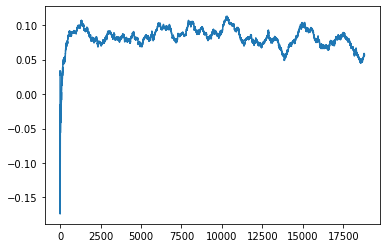

Thread: 2 iteration: 3110
RAM mDiffFit_156 FROM: 256 --> 192 reward: -0.057674534765624896
Thread: 3 iteration: 3156
RAM mDiffFit_178 FROM: 640 --> 256 reward: 0.13706769921875
Thread: 6 iteration: 3145
RAM mBackground_35 FROM: 768 --> 256 reward: -1.0
Thread: 5 iteration: 3212
RAM mBackground_75 FROM: 1344 --> 192 reward: -1.0
Thread: 1 iteration: 3056
RAM mBackground_4 FROM: 2176 --> 192 reward: 0.6472013544296875
Thread: 2 iteration: 3111
RAM mDiffFit_271 FROM: 1024 --> 2112 reward: 0.019947964062500007
Thread: 3 iteration: 3157
RAM mDiffFit_306 FROM: 1024 --> 1088 reward: -0.01271876093749999
Thread: 6 iteration: 3146
RAM mDiffFit_386 FROM: 1216 --> 192 reward: 0.33150522109375
Thread: 5 iteration: 3213
RAM mProject_37 FROM: 320 --> 192 reward: -1.0
Thread: 4 iteration: 3119
RAM mDiffFit_9 FROM: 1408 --> 256 reward: 0.15276039843749997
Thread: 1 iteration: 3057
RAM mDiffFit_378 FROM: 2944 --> 256 reward: 0.09888013359375
Thread: 2 iteration: 3112
RAM mDiffFit_256 FROM: 2816 --> 256

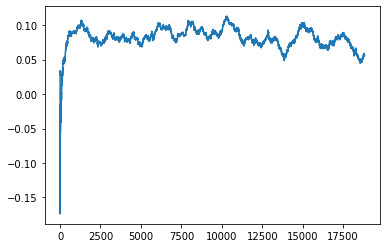

Thread: 6 iteration: 3150
RAM mDiffFit_118 FROM: 896 --> 192 reward: 0.15716141640625
Saving ...


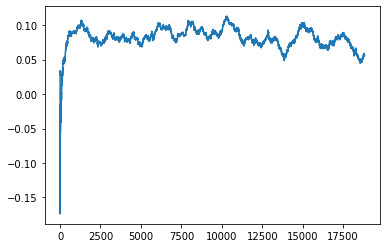

Thread: 1 iteration: 3060
RAM mDiffFit_12 FROM: 1920 --> 256 reward: 0.16572393828125
Thread: 1 iteration: 3061
RAM mDiffFit_270 FROM: 128 --> 192 reward: -0.57642190234375
Thread: 6 iteration: 3151
RAM mProject_66 FROM: 2240 --> 256 reward: -1.0
Thread: 5 iteration: 3215
RAM mDiffFit_387 FROM: 2368 --> 192 reward: 0.24585152695312498
Thread: 1 iteration: 3062
RAM mProject_23 FROM: 1984 --> 192 reward: -1.0
Thread: 2 iteration: 3114
RAM mDiffFit_111 FROM: 1088 --> 1984 reward: -0.019104159375000006
Thread: 5 iteration: 3216
RAM mBackground_62 FROM: 960 --> 1984 reward: -1.0
Saving ...


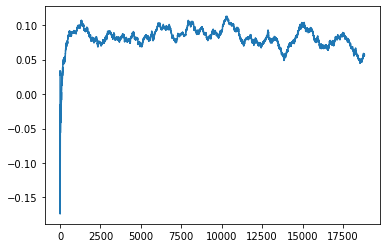

Thread: 3 iteration: 3160
RAM mDiffFit_382 FROM: 2752 --> 192 reward: 0.43794520039062507
Thread: 6 iteration: 3152
RAM mBackground_64 FROM: 640 --> 192 reward: -1.0
Saving ...


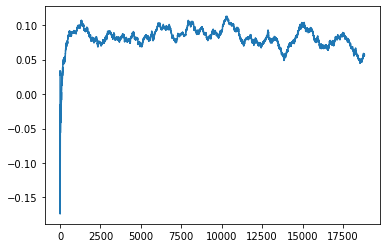

Thread: 4 iteration: 3120
RAM mDiffFit_138 FROM: 1664 --> 192 reward: 0.20379685859375
Thread: 5 iteration: 3217
RAM mDiffFit_394 FROM: 320 --> 1088 reward: -0.084104159375
Thread: 4 iteration: 3121
RAM mDiffFit_364 FROM: 1856 --> 256 reward: 0.15376820820312503
Thread: 6 iteration: 3153
RAM mDiffFit_273 FROM: 2432 --> 192 reward: 0.2824609074218749
Thread: 6 iteration: 3154
RAM mBgModel_1 FROM: 1664 --> 192 reward: -0.043366917500000046
Thread: 4 iteration: 3122
RAM mDiffFit_278 FROM: 2880 --> 320 reward: 0.08977334179687499
Thread: 4 iteration: 3123
RAM mDiffFit_132 FROM: 1088 --> 1152 reward: 0.05768234453124999
Thread: 6 iteration: 3155
RAM mBackground_35 FROM: 384 --> 320 reward: -1.0
Thread: 1 iteration: 3063
RAM mProject_38 FROM: 1728 --> 192 reward: -1.0
Thread: 3 iteration: 3161
RAM mProject_82 FROM: 192 --> 448 reward: -1.0
Thread: 5 iteration: 3218
RAM mConcatFit_2 FROM: 512 --> 192 reward: 0.6153146015625
Thread: 6 iteration: 3156
RAM mDiffFit_384 FROM: 2432 --> 256 reward:

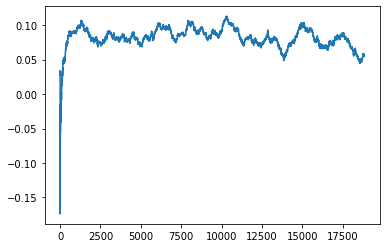

Thread: 5 iteration: 3220
RAM mProject_42 FROM: 256 --> 2880 reward: 0.8712728040234375
Thread: 1 iteration: 3066
RAM mDiffFit_321 FROM: 2688 --> 192 reward: 0.13709358593749998
Thread: 5 iteration: 3221
RAM mBackground_17 FROM: 2880 --> 192 reward: -1.0
Thread: 4 iteration: 3124
RAM mDiffFit_132 FROM: 2112 --> 192 reward: 0.234507809765625
Thread: 4 iteration: 3125
RAM mBackground_43 FROM: 2752 --> 192 reward: -1.0
Thread: 6 iteration: 3157
RAM mProject_49 FROM: 832 --> 192 reward: -1.0
Thread: 5 iteration: 3222
RAM mBackground_89 FROM: 1280 --> 256 reward: -1.0
Thread: 2 iteration: 3116
RAM mDiffFit_243 FROM: 2304 --> 192 reward: 0.3043748687500001
Thread: 6 iteration: 3158
RAM mBackground_35 FROM: 1216 --> 192 reward: -1.0
Thread: 3 iteration: 3163
RAM mDiffFit_317 FROM: 1792 --> 192 reward: 0.27776561953125006
Thread: 2 iteration: 3117
RAM mDiffFit_246 FROM: 768 --> 192 reward: 0.29160938046875
Thread: 5 iteration: 3223
RAM mDiffFit_357 FROM: 640 --> 192 reward: 0.284562521875
Thre

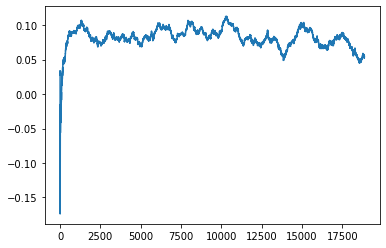

Thread: 1 iteration: 3070
RAM mBackground_54 FROM: 2112 --> 192 reward: -1.0
Thread: 6 iteration: 3159
RAM mBackground_17 FROM: 256 --> 192 reward: -1.0
Thread: 2 iteration: 3118
RAM mProject_44 FROM: 1664 --> 192 reward: -1.0
Thread: 5 iteration: 3227
RAM mProject_60 FROM: 2240 --> 192 reward: -1.0
Thread: 4 iteration: 3127
RAM mBackground_9 FROM: 192 --> 2880 reward: -1.0
Thread: 1 iteration: 3071
RAM mProject_74 FROM: 1344 --> 192 reward: -1.0
Thread: 3 iteration: 3168
RAM mDiffFit_417 FROM: 640 --> 192 reward: 0.14779422617187496
Thread: 5 iteration: 3228
RAM mDiffFit_22 FROM: 2624 --> 1984 reward: -0.022296902343750022
Thread: 1 iteration: 3072
RAM mDiffFit_285 FROM: 1920 --> 192 reward: 0.21119528789062503
Thread: 3 iteration: 3169
RAM mDiffFit_292 FROM: 768 --> 192 reward: 0.14069528789062505
Thread: 5 iteration: 3229
RAM mDiffFit_47 FROM: 512 --> 320 reward: -0.04102869414062498
Thread: 1 iteration: 3073
RAM mProject_53 FROM: 1856 --> 192 reward: -1.0
Saving ...


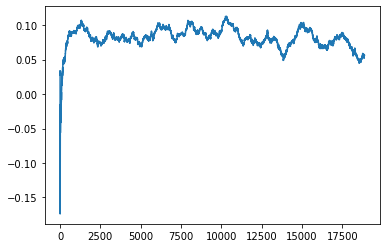

Thread: 6 iteration: 3160
RAM mDiffFit_300 FROM: 896 --> 192 reward: 0.60545840625
Saving ...


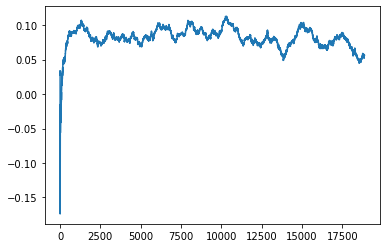

Thread: 3 iteration: 3170
RAM mDiffFit_282 FROM: 320 --> 256 reward: -0.13998964531249997
Thread: 1 iteration: 3074
RAM mProject_35 FROM: 1152 --> 192 reward: -1.0
Thread: 2 iteration: 3119
RAM mProject_64 FROM: 256 --> 448 reward: -1.0
Thread: 4 iteration: 3128
RAM mDiffFit_378 FROM: 2432 --> 192 reward: 0.23235933671875
Saving ...


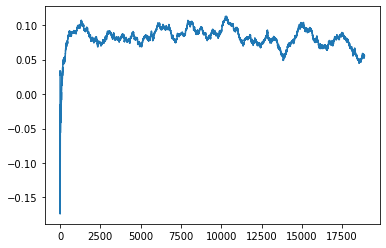

Thread: 2 iteration: 3120
RAM mDiffFit_411 FROM: 768 --> 192 reward: 0.459742190234375
Thread: 4 iteration: 3129
RAM mProject_14 FROM: 640 --> 192 reward: -1.0
Thread: 6 iteration: 3161
RAM mDiffFit_197 FROM: 704 --> 192 reward: 0.425645884375
Thread: 6 iteration: 3162
RAM mDiffFit_5 FROM: 2880 --> 192 reward: 0.2743905757812499
Thread: 6 iteration: 3163
RAM mBackground_9 FROM: 1984 --> 256 reward: -1.0
Thread: 2 iteration: 3121
RAM mBackground_47 FROM: 3008 --> 192 reward: -1.0
Thread: 3 iteration: 3171
RAM mBackground_58 FROM: 1216 --> 192 reward: -1.0
Thread: 1 iteration: 3075
RAM mDiffFit_55 FROM: 832 --> 192 reward: 0.250309889453125
Thread: 2 iteration: 3122
RAM mProject_48 FROM: 768 --> 192 reward: -1.0
Thread: 6 iteration: 3164
RAM mAdd_3 FROM: 1024 --> 448 reward: -1.0
Saving ...


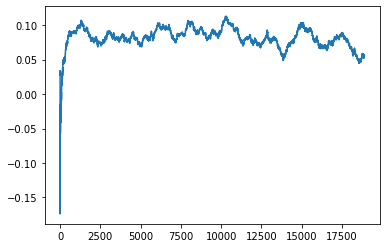

Thread: 5 iteration: 3230
RAM mDiffFit_101 FROM: 512 --> 192 reward: 0.227851570703125
Thread: 2 iteration: 3123
RAM mBackground_15 FROM: 2432 --> 192 reward: -1.0
Saving ...


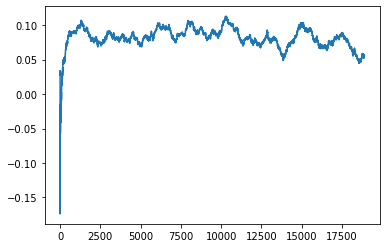

Thread: 4 iteration: 3130
RAM mDiffFit_220 FROM: 2304 --> 192 reward: 0.16937486875000002
Thread: 2 iteration: 3124
RAM mDiffFit_68 FROM: 1216 --> 192 reward: 0.285153650390625
Thread: 5 iteration: 3231
RAM mDiffFit_190 FROM: 1792 --> 192 reward: 0.24428904882812497
Thread: 4 iteration: 3131
RAM mDiffFit_200 FROM: 1664 --> 192 reward: 0.5806250000000001
Thread: 6 iteration: 3165
RAM mProject_75 FROM: 960 --> 192 reward: -1.0
Thread: 3 iteration: 3172
RAM mDiffFit_417 FROM: 512 --> 1408 reward: 0.04466154765625001
Thread: 4 iteration: 3132
RAM mDiffFit_386 FROM: 1856 --> 192 reward: 0.156736925390625
Thread: 5 iteration: 3232
RAM mDiffFit_376 FROM: 2240 --> 192 reward: 0.30858849609375005
Thread: 2 iteration: 3125
RAM mDiffFit_313 FROM: 2816 --> 192 reward: 0.455820200390625
Thread: 6 iteration: 3166
RAM mDiffFit_246 FROM: 2560 --> 192 reward: 0.21850776601562497
Thread: 3 iteration: 3173
RAM mDiffFit_128 FROM: 2432 --> 192 reward: 0.22736714648437495
Thread: 4 iteration: 3133
RAM mDiff

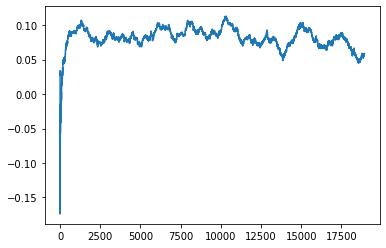

Thread: 4 iteration: 3140
RAM mDiffFit_270 FROM: 1408 --> 192 reward: 0.556002588671875
Saving ...


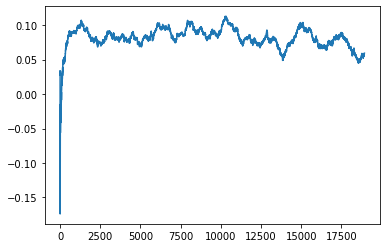

Thread: 1 iteration: 3080
RAM mDiffFit_342 FROM: 2560 --> 192 reward: 0.247882678515625
Thread: 1 iteration: 3081
RAM mDiffFit_339 FROM: 1024 --> 192 reward: 0.31680730078124997
Thread: 1 iteration: 3082
RAM mDiffFit_356 FROM: 1664 --> 192 reward: 0.22508064257812502
Thread: 1 iteration: 3083
RAM mProject_24 FROM: 1856 --> 192 reward: -1.0
Thread: 3 iteration: 3177
RAM mProject_33 FROM: 1920 --> 192 reward: -1.0
Thread: 4 iteration: 3141
RAM mDiffFit_292 FROM: 2240 --> 448 reward: 0.12493488945312499
Thread: 1 iteration: 3084
RAM mDiffFit_199 FROM: 1472 --> 192 reward: 0.21304159374999998
Thread: 3 iteration: 3178
RAM mBackground_12 FROM: 1536 --> 192 reward: -1.0
Thread: 5 iteration: 3236
RAM mDiffFit_409 FROM: 3008 --> 192 reward: 0.210312434375
Thread: 1 iteration: 3085
RAM mDiffFit_373 FROM: 1472 --> 192 reward: 0.327341128515625
Thread: 4 iteration: 3142
RAM mDiffFit_201 FROM: 640 --> 192 reward: 0.646716216015625
Thread: 3 iteration: 3179
RAM mBackground_33 FROM: 2112 --> 192 rew

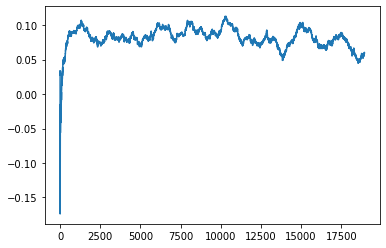

Thread: 6 iteration: 3170
RAM mDiffFit_339 FROM: 896 --> 192 reward: 0.153549447265625
Saving ...


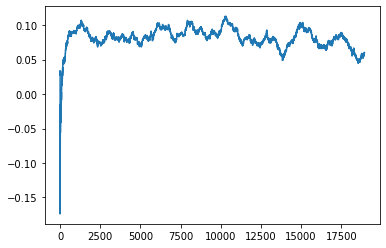

Thread: 3 iteration: 3180
RAM mDiffFit_293 FROM: 3008 --> 192 reward: 0.222184758203125
Thread: 1 iteration: 3086
RAM mDiffFit_194 FROM: 2688 --> 192 reward: 0.26737495625
Thread: 4 iteration: 3143
RAM mBackground_42 FROM: 2240 --> 192 reward: -1.0
Thread: 2 iteration: 3129
RAM mDiffFit_24 FROM: 1152 --> 192 reward: 0.3134062390625
Thread: 6 iteration: 3171
RAM mDiffFit_277 FROM: 832 --> 192 reward: 0.263002588671875
Thread: 3 iteration: 3181
RAM mDiffFit_176 FROM: 192 --> 192 reward: -0.42538289726562495
Saving ...


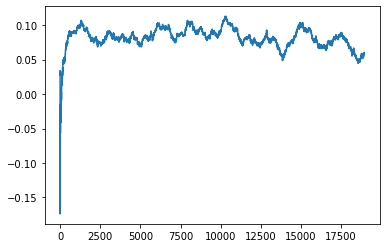

Thread: 2 iteration: 3130
RAM mDiffFit_12 FROM: 2176 --> 192 reward: 0.32599991250000004
Thread: 4 iteration: 3144
RAM mDiffFit_97 FROM: 1600 --> 192 reward: 0.31291663750000004
Thread: 6 iteration: 3172
RAM mBackground_7 FROM: 3008 --> 2560 reward: -1.0
Thread: 5 iteration: 3237
RAM mDiffFit_159 FROM: 2176 --> 192 reward: 0.08414048828125
Thread: 3 iteration: 3182
RAM mDiffFit_295 FROM: 2752 --> 192 reward: 0.21528900507812504
Thread: 2 iteration: 3131
RAM mDiffFit_228 FROM: 2432 --> 192 reward: 0.254393164453125
Thread: 4 iteration: 3145
RAM mDiffFit_223 FROM: 1088 --> 192 reward: 0.192705686328125
Thread: 6 iteration: 3173
RAM mDiffFit_82 FROM: 2496 --> 192 reward: 0.14529672734375002
Thread: 5 iteration: 3238
RAM mDiffFit_109 FROM: 2816 --> 192 reward: 0.18535139570312498
Thread: 3 iteration: 3183
RAM mDiffFit_290 FROM: 384 --> 320 reward: -0.06864847304687498
Thread: 4 iteration: 3146
RAM mDiffFit_212 FROM: 2432 --> 192 reward: 0.15719783281249997
Thread: 2 iteration: 3132
RAM mDi

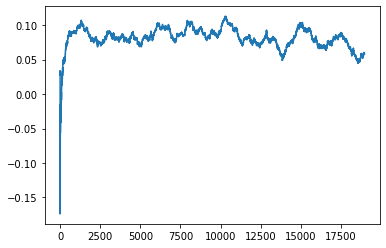

Thread: 5 iteration: 3240
RAM mDiffFit_260 FROM: 2112 --> 320 reward: 0.145341128515625
Thread: 4 iteration: 3148
RAM mDiffFit_191 FROM: 3008 --> 192 reward: 0.23923688164062498
Thread: 3 iteration: 3185
RAM mDiffFit_331 FROM: 1024 --> 192 reward: 0.233854159375
Thread: 5 iteration: 3241
RAM mBackground_27 FROM: 576 --> 192 reward: -1.0
Thread: 1 iteration: 3087
RAM mDiffFit_249 FROM: 2432 --> 2304 reward: 0.112229290625
Thread: 3 iteration: 3186
RAM mDiffFit_299 FROM: 192 --> 192 reward: 0.0023749999999999466
Thread: 1 iteration: 3088
RAM mDiffFit_213 FROM: 2048 --> 192 reward: 0.535377544921875
Thread: 4 iteration: 3149
RAM mProject_77 FROM: 1280 --> 192 reward: -1.0
Thread: 6 iteration: 3175
RAM mDiffFit_407 FROM: 1856 --> 192 reward: 0.19383849609375003
Saving ...


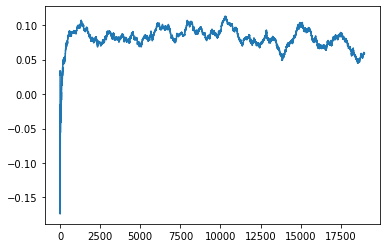

Thread: 4 iteration: 3150
RAM mDiffFit_32 FROM: 384 --> 192 reward: 0.14525000000000005
Thread: 1 iteration: 3089
RAM mDiffFit_162 FROM: 448 --> 192 reward: 0.3627890925781251
Thread: 3 iteration: 3187
RAM mDiffFit_284 FROM: 2816 --> 192 reward: 0.25395564257812503
Thread: 6 iteration: 3176
RAM mDiffFit_400 FROM: 1088 --> 192 reward: 0.09849210273437495
Thread: 3 iteration: 3188
RAM mDiffFit_13 FROM: 896 --> 192 reward: 0.2908671902343751
Thread: 4 iteration: 3151
RAM mDiffFit_174 FROM: 2560 --> 192 reward: 0.221762943359375
Saving ...


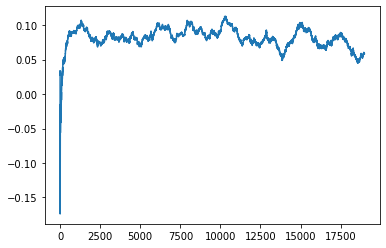

Thread: 1 iteration: 3090
RAM mDiffFit_135 FROM: 2240 --> 704 reward: 0.14131774296875
Thread: 6 iteration: 3177
RAM mBackground_72 FROM: 1856 --> 192 reward: -1.0
Thread: 2 iteration: 3133
RAM mDiffFit_294 FROM: 1344 --> 256 reward: 0.18460415937500002
Thread: 3 iteration: 3189
RAM mDiffFit_161 FROM: 2880 --> 192 reward: 0.18207024414062495
Thread: 4 iteration: 3152
RAM mDiffFit_352 FROM: 960 --> 192 reward: 0.22382028789062505
Thread: 1 iteration: 3091
RAM mDiffFit_422 FROM: 448 --> 192 reward: 0.27133595117187503
Thread: 6 iteration: 3178
RAM mDiffFit_73 FROM: 2944 --> 192 reward: 0.24103900507812498
Saving ...


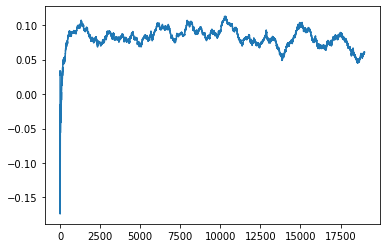

Thread: 3 iteration: 3190
RAM mDiffFit_342 FROM: 640 --> 192 reward: 0.12723170429687508
Thread: 2 iteration: 3134
RAM mDiffFit_354 FROM: 1856 --> 192 reward: 0.18509630585937498
Thread: 6 iteration: 3179
RAM mBackground_64 FROM: 2176 --> 192 reward: -1.0
Thread: 5 iteration: 3242
RAM mDiffFit_394 FROM: 128 --> 256 reward: -0.42542190234374994
Thread: 2 iteration: 3135
RAM mDiffFit_300 FROM: 128 --> 1088 reward: -0.5941484292968751
Thread: 5 iteration: 3243
RAM mDiffFit_116 FROM: 128 --> 192 reward: -0.5347344242187501
Thread: 3 iteration: 3191
RAM mDiffFit_78 FROM: 1280 --> 192 reward: 0.245481748046875
Saving ...


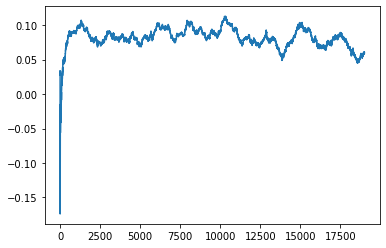

Thread: 6 iteration: 3180
RAM mDiffFit_135 FROM: 1408 --> 1088 reward: -0.01417190234374999
Thread: 6 iteration: 3181
RAM mDiffFit_379 FROM: 1600 --> 192 reward: 0.2240312390625
Thread: 3 iteration: 3192
RAM mDiffFit_47 FROM: 320 --> 192 reward: 0.17588022109374996
Thread: 2 iteration: 3136
RAM mDiffFit_277 FROM: 1984 --> 192 reward: 0.283645796875
Thread: 5 iteration: 3244
RAM mProject_25 FROM: 2432 --> 192 reward: -1.0
Thread: 4 iteration: 3153
RAM mDiffFit_195 FROM: 2112 --> 192 reward: 0.29117185859375
Thread: 6 iteration: 3182
RAM mDiffFit_107 FROM: 2880 --> 320 reward: 0.06334104101562499
Thread: 2 iteration: 3137
RAM mDiffFit_180 FROM: 1984 --> 192 reward: 0.19556765546875
Thread: 3 iteration: 3193
RAM mDiffFit_269 FROM: 768 --> 320 reward: 0.08424477890624998
Thread: 6 iteration: 3183
RAM mDiffFit_352 FROM: 192 --> 1728 reward: 0.11141422382812499
Thread: 2 iteration: 3138
RAM mDiffFit_271 FROM: 896 --> 192 reward: 0.23476039843750005
Thread: 3 iteration: 3194
RAM mDiffFit_420 

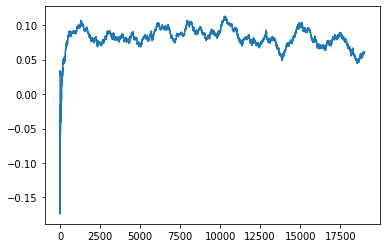

Thread: 2 iteration: 3140
RAM mDiffFit_85 FROM: 2624 --> 192 reward: 0.06421590976562491
Thread: 3 iteration: 3196
RAM mDiffFit_225 FROM: 1472 --> 192 reward: 0.33958331875000003
Thread: 1 iteration: 3093
RAM mDiffFit_358 FROM: 768 --> 192 reward: 0.10569524414062496
Thread: 6 iteration: 3185
RAM mDiffFit_47 FROM: 128 --> 256 reward: -0.3360937609375
Thread: 2 iteration: 3141
RAM mDiffFit_319 FROM: 3008 --> 320 reward: 0.10089316445312499
Thread: 1 iteration: 3094
RAM mDiffFit_105 FROM: 2112 --> 192 reward: 0.23095309765625
Thread: 3 iteration: 3197
RAM mDiffFit_18 FROM: 1920 --> 256 reward: 0.17084893828125
Thread: 2 iteration: 3142
RAM mDiffFit_246 FROM: 1600 --> 192 reward: 0.252606748046875
Thread: 2 iteration: 3143
RAM mDiffFit_379 FROM: 1856 --> 192 reward: 0.15124473515624998
Thread: 2 iteration: 3144
RAM mProject_36 FROM: 960 --> 192 reward: -1.0
Thread: 4 iteration: 3155
RAM mDiffFit_147 FROM: 2944 --> 192 reward: 0.498820200390625
Thread: 2 iteration: 3145
RAM mImgtbl_3 FROM:

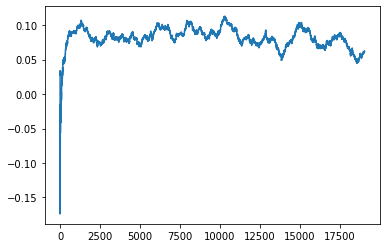

Thread: 6 iteration: 3190
RAM mDiffFit_77 FROM: 2496 --> 192 reward: 0.25510933671875
Thread: 1 iteration: 3097
RAM mConcatFit_2 FROM: 2304 --> 320 reward: 0.3996436996875001
Thread: 3 iteration: 3199
RAM mDiffFit_360 FROM: 2880 --> 320 reward: 0.08747389453125001
Saving ...


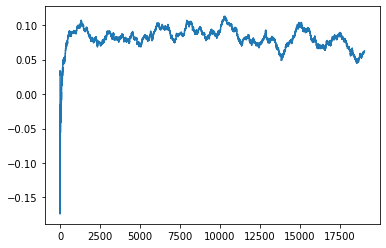

Thread: 3 iteration: 3200
RAM mProject_4 FROM: 2624 --> 192 reward: -1.0
Thread: 2 iteration: 3149
RAM mDiffFit_416 FROM: 2496 --> 192 reward: 0.35601557578125
Thread: 1 iteration: 3098
RAM mBackground_19 FROM: 1152 --> 320 reward: -1.0
Thread: 5 iteration: 3247
RAM mProject_40 FROM: 896 --> 192 reward: -1.0
Thread: 4 iteration: 3158
RAM mDiffFit_108 FROM: 1408 --> 192 reward: 0.21972393828125003
Thread: 3 iteration: 3201
RAM mDiffFit_62 FROM: 2944 --> 192 reward: 0.19094524414062503
Thread: 5 iteration: 3248
RAM mDiffFit_333 FROM: 2240 --> 192 reward: 0.23146871718749995
Thread: 4 iteration: 3159
RAM mDiffFit_12 FROM: 1344 --> 256 reward: 0.13038539843750002
Thread: 5 iteration: 3249
RAM mDiffFit_186 FROM: 512 --> 1984 reward: -0.042283827734375
Saving ...


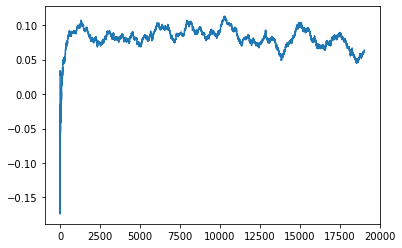

Thread: 4 iteration: 3160
RAM mBackground_77 FROM: 768 --> 1728 reward: -1.0
Thread: 1 iteration: 3099
RAM mProject_67 FROM: 1664 --> 192 reward: -1.0
Saving ...


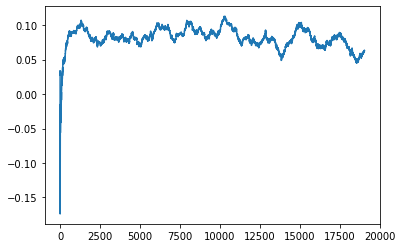

Thread: 2 iteration: 3150
RAM mDiffFit_417 FROM: 2432 --> 1344 reward: -0.002218804687500013
Saving ...


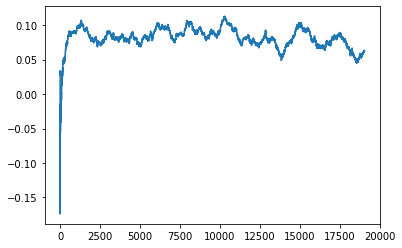

Thread: 1 iteration: 3100
RAM mBackground_38 FROM: 256 --> 320 reward: -1.0
Thread: 6 iteration: 3191
RAM mDiffFit_90 FROM: 256 --> 256 reward: -0.016697920312500024
Thread: 2 iteration: 3151
RAM mProject_39 FROM: 1600 --> 320 reward: -1.0
Thread: 3 iteration: 3202
RAM mDiffFit_295 FROM: 576 --> 192 reward: 0.09933590742187498
Thread: 1 iteration: 3101
RAM mDiffFit_123 FROM: 2112 --> 1792 reward: 0.076445375390625
Thread: 6 iteration: 3192
RAM mDiffFit_258 FROM: 2304 --> 320 reward: 0.09302597421874997
Thread: 2 iteration: 3152
RAM mDiffFit_215 FROM: 1856 --> 192 reward: 0.27722907187500007
Thread: 3 iteration: 3203
RAM mProject_16 FROM: 640 --> 320 reward: -1.0
Thread: 4 iteration: 3161
RAM mDiffFit_249 FROM: 640 --> 192 reward: 0.257190110546875
Thread: 1 iteration: 3102
RAM mDiffFit_392 FROM: 2240 --> 192 reward: 0.27161192539062495
Thread: 6 iteration: 3193
RAM mDiffFit_384 FROM: 2560 --> 192 reward: 0.21639575312499995
Thread: 2 iteration: 3153
RAM mDiffFit_194 FROM: 384 --> 384 r

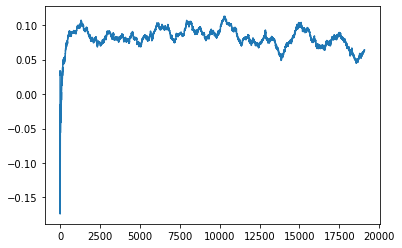

Thread: 5 iteration: 3250
RAM mDiffFit_137 FROM: 320 --> 704 reward: -0.050565066796874995
Thread: 3 iteration: 3206
RAM mDiffFit_218 FROM: 1344 --> 320 reward: -0.010747498828125
Thread: 2 iteration: 3155
RAM mDiffFit_258 FROM: 320 --> 256 reward: 0.16783336250000003
Thread: 5 iteration: 3251
RAM mDiffFit_141 FROM: 1536 --> 2176 reward: 0.07809384843750002
Thread: 3 iteration: 3207
RAM mDiffFit_420 FROM: 2752 --> 320 reward: 0.22346612851562503
Thread: 2 iteration: 3156
RAM mDiffFit_170 FROM: 2816 --> 832 reward: 0.12906252187499997
Thread: 3 iteration: 3208
RAM mProject_45 FROM: 2688 --> 192 reward: -1.0
Thread: 6 iteration: 3194
RAM mProject_83 FROM: 1984 --> 192 reward: -1.0
Thread: 4 iteration: 3163
RAM mProject_90 FROM: 384 --> 2688 reward: 0.790411895296875
Thread: 2 iteration: 3157
RAM mDiffFit_280 FROM: 2624 --> 2752 reward: 0.19272420078124997
Thread: 2 iteration: 3158
RAM mBackground_45 FROM: 1728 --> 256 reward: -1.0
Thread: 1 iteration: 3103
RAM mDiffFit_122 FROM: 1728 -->

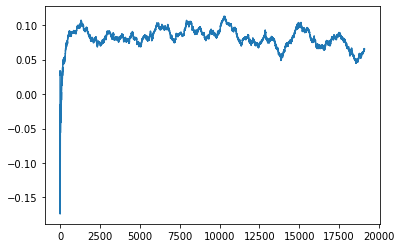

Thread: 2 iteration: 3160
RAM mProject_26 FROM: 1344 --> 256 reward: -1.0
Thread: 3 iteration: 3209
RAM mBackground_77 FROM: 576 --> 1984 reward: -1.0
Thread: 6 iteration: 3195
RAM mDiffFit_222 FROM: 1088 --> 1344 reward: -0.02880730078125001
Thread: 1 iteration: 3105
RAM mConcatFit_2 FROM: 448 --> 2944 reward: -0.23986026718750006
Thread: 6 iteration: 3196
RAM mBackground_43 FROM: 256 --> 320 reward: -1.0
Thread: 4 iteration: 3164
RAM mViewer_3 FROM: 2560 --> 320 reward: 0.27324153527343753
Thread: 1 iteration: 3106
RAM mDiffFit_35 FROM: 1728 --> 2176 reward: 0.05743497695312498
Thread: 1 iteration: 3107
RAM mDiffFit_29 FROM: 128 --> 192 reward: -0.6097396453124999
Thread: 4 iteration: 3165
RAM mDiffFit_188 FROM: 2752 --> 192 reward: 0.17505462460937504
Thread: 1 iteration: 3108
RAM mDiffFit_270 FROM: 640 --> 1344 reward: -0.07764579687499998
Thread: 4 iteration: 3166
RAM mProject_84 FROM: 192 --> 1280 reward: 0.761078143125
Thread: 6 iteration: 3197
RAM mDiffFit_130 FROM: 2560 --> 13

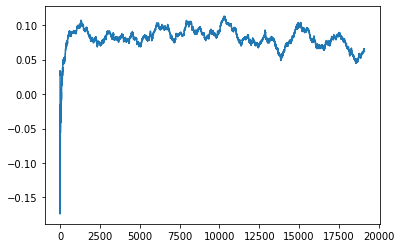

Thread: 3 iteration: 3210
RAM mDiffFit_364 FROM: 3008 --> 2176 reward: -0.05586727773437498
Thread: 2 iteration: 3162
RAM mDiffFit_423 FROM: 960 --> 320 reward: 0.151664048828125
Thread: 6 iteration: 3198
RAM mBackground_20 FROM: 2560 --> 256 reward: -1.0
Thread: 5 iteration: 3253
RAM mDiffFit_7 FROM: 2560 --> 320 reward: 0.13574214648437502
Thread: 3 iteration: 3211
RAM mDiffFit_103 FROM: 2816 --> 320 reward: 0.123523385546875
Thread: 5 iteration: 3254
RAM mDiffFit_286 FROM: 896 --> 192 reward: 0.27275
Thread: 6 iteration: 3199
RAM mDiffFit_192 FROM: 1856 --> 1984 reward: -0.0020156195312500107
Saving ...


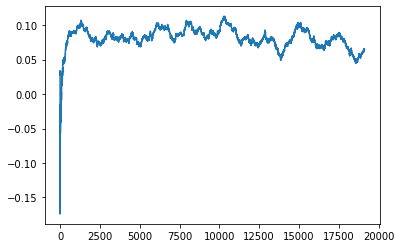

Thread: 6 iteration: 3200
RAM mDiffFit_170 FROM: 1920 --> 320 reward: 0.114992146484375
Thread: 6 iteration: 3201
RAM mProject_45 FROM: 896 --> 320 reward: -1.0
Thread: 4 iteration: 3168
RAM mProject_12 FROM: 1088 --> 1344 reward: -0.06947810465625
Thread: 3 iteration: 3212
RAM mDiffFit_326 FROM: 1984 --> 192 reward: 0.37960157070312495
Thread: 6 iteration: 3202
RAM mBackground_57 FROM: 960 --> 256 reward: -1.0
Thread: 1 iteration: 3109
RAM mDiffFit_167 FROM: 3008 --> 320 reward: 0.09011451406250003
Thread: 4 iteration: 3169
RAM mDiffFit_278 FROM: 2752 --> 1984 reward: -0.0186562828125
Thread: 3 iteration: 3213
RAM mDiffFit_156 FROM: 2752 --> 192 reward: 0.5602369253906251
Thread: 6 iteration: 3203
RAM mDiffFit_174 FROM: 2112 --> 1728 reward: -0.03522661445312502
Saving ...


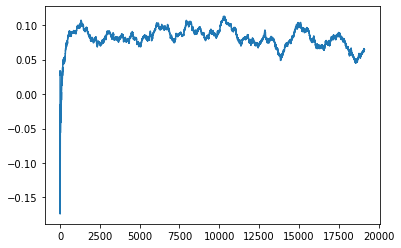

Thread: 4 iteration: 3170
RAM mDiffFit_64 FROM: 192 --> 832 reward: -0.185851526953125
Thread: 3 iteration: 3214
RAM mBackground_31 FROM: 2496 --> 320 reward: -1.0
Thread: 2 iteration: 3163
RAM mDiffFit_101 FROM: 448 --> 320 reward: 0.31819278671875
Thread: 6 iteration: 3204
RAM mDiffFit_137 FROM: 768 --> 192 reward: 0.15564838554687502
Saving ...


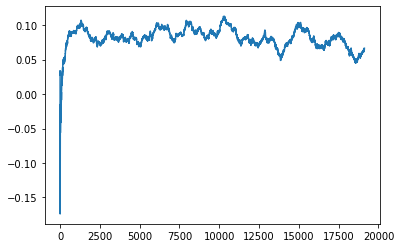

Thread: 1 iteration: 3110
RAM mBackground_60 FROM: 1280 --> 320 reward: -1.0
Thread: 5 iteration: 3255
RAM mDiffFit_50 FROM: 2240 --> 384 reward: 0.297580686328125
Thread: 2 iteration: 3164
RAM mDiffFit_229 FROM: 768 --> 192 reward: 0.17892185859375004
Thread: 6 iteration: 3205
RAM mDiffFit_240 FROM: 512 --> 320 reward: -0.012455773828124947
Thread: 1 iteration: 3111
RAM mDiffFit_385 FROM: 1344 --> 192 reward: 0.18344528789062503
Thread: 5 iteration: 3256
RAM mDiffFit_257 FROM: 1280 --> 2176 reward: -0.016958318749999996
Thread: 5 iteration: 3257
RAM mProject_41 FROM: 1152 --> 1408 reward: -0.04904527739062503
Thread: 4 iteration: 3171
RAM mDiffFit_66 FROM: 1984 --> 192 reward: 0.22107028789062505
Thread: 1 iteration: 3112
RAM mDiffFit_24 FROM: 2304 --> 832 reward: 0.072226570703125
Thread: 4 iteration: 3172
RAM mDiffFit_212 FROM: 448 --> 2304 reward: -0.09951035468750001
Thread: 1 iteration: 3113
RAM mProject_57 FROM: 1472 --> 1728 reward: -0.0529893717187501
Thread: 2 iteration: 3165

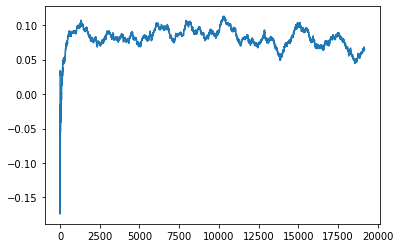

Thread: 2 iteration: 3170
RAM mDiffFit_81 FROM: 1472 --> 1408 reward: -0.048242233984374994
Saving ...


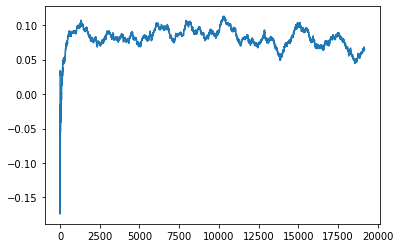

Thread: 6 iteration: 3210
RAM mProject_35 FROM: 576 --> 192 reward: -1.0
Saving ...


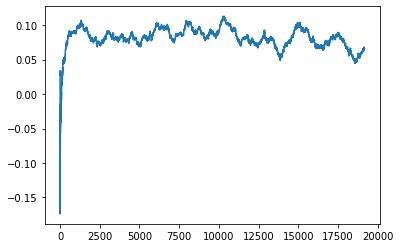

Thread: 5 iteration: 3260
RAM mDiffFit_388 FROM: 2048 --> 2176 reward: 0.008109380468749993
Thread: 2 iteration: 3171
RAM mBackground_1 FROM: 2304 --> 2304 reward: -1.0
Thread: 4 iteration: 3177
RAM mDiffFit_163 FROM: 1984 --> 192 reward: 0.4450703316406251
Thread: 2 iteration: 3172
RAM mDiffFit_231 FROM: 1920 --> 192 reward: 0.24655466835937498
Thread: 4 iteration: 3178
RAM mBackground_84 FROM: 2176 --> 192 reward: -1.0
Saving ...


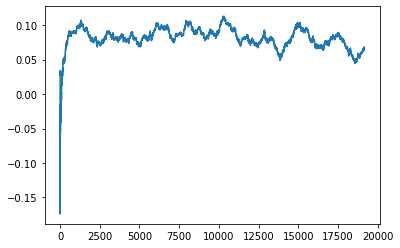

Thread: 3 iteration: 3220
RAM mDiffFit_156 FROM: 768 --> 192 reward: 0.47798438046875
Thread: 4 iteration: 3179
RAM mDiffFit_204 FROM: 2560 --> 896 reward: 0.11711982265625001
Thread: 3 iteration: 3221
RAM mProject_89 FROM: 448 --> 320 reward: -1.0
Thread: 6 iteration: 3211
RAM mDiffFit_242 FROM: 192 --> 192 reward: -0.014492190234375
Saving ...


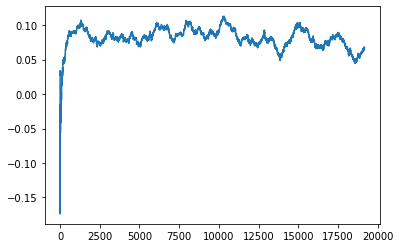

Thread: 4 iteration: 3180
RAM mDiffFit_371 FROM: 2880 --> 192 reward: 0.2480311953125
Thread: 3 iteration: 3222
RAM mDiffFit_371 FROM: 640 --> 192 reward: 0.26032814140625
Thread: 6 iteration: 3212
RAM mDiffFit_18 FROM: 2880 --> 192 reward: 0.31461714648437505
Thread: 4 iteration: 3181
RAM mProject_32 FROM: 2688 --> 384 reward: -1.0
Thread: 2 iteration: 3173
RAM mBackground_80 FROM: 1472 --> 192 reward: -1.0
Saving ...


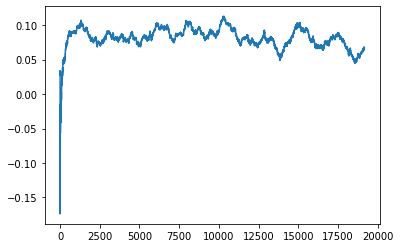

Thread: 1 iteration: 3120
RAM mDiffFit_385 FROM: 1024 --> 1408 reward: 0.02346358359375
Thread: 6 iteration: 3213
RAM mDiffFit_403 FROM: 3008 --> 2176 reward: -0.01727347304687498
Thread: 1 iteration: 3121
RAM mDiffFit_260 FROM: 2112 --> 256 reward: 0.35589325195312504
Thread: 3 iteration: 3223
RAM mBackground_88 FROM: 768 --> 192 reward: -1.0
Thread: 5 iteration: 3261
RAM mDiffFit_216 FROM: 2688 --> 192 reward: 0.22489838554687502
Thread: 6 iteration: 3214
RAM mDiffFit_174 FROM: 2560 --> 1984 reward: -0.018429712109375006
Thread: 5 iteration: 3262
RAM mImgtbl_1 FROM: 448 --> 1408 reward: -0.55499164625
Thread: 6 iteration: 3215
RAM mDiffFit_419 FROM: 1024 --> 192 reward: 0.24142185859375
Thread: 5 iteration: 3263
RAM mProject_44 FROM: 2752 --> 192 reward: -1.0
Thread: 2 iteration: 3174
RAM mProject_10 FROM: 640 --> 192 reward: -1.0
Thread: 1 iteration: 3122
RAM mProject_60 FROM: 2816 --> 192 reward: -1.0
Thread: 3 iteration: 3224
RAM mDiffFit_65 FROM: 2880 --> 1984 reward: -0.04327351

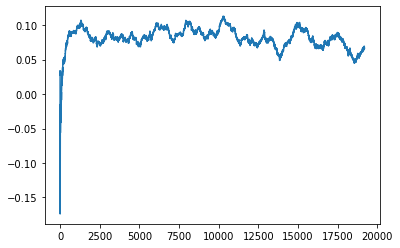

Thread: 6 iteration: 3220
RAM mBackground_28 FROM: 128 --> 192 reward: -1.0
Thread: 2 iteration: 3175
RAM mProject_16 FROM: 768 --> 192 reward: -1.0
Thread: 4 iteration: 3183
RAM mDiffFit_210 FROM: 128 --> 1280 reward: -0.54742185859375
Thread: 6 iteration: 3221
RAM mDiffFit_381 FROM: 2240 --> 1728 reward: 0.030651061718750018
Thread: 3 iteration: 3228
RAM mDiffFit_412 FROM: 256 --> 192 reward: 0.006010398437499981
Thread: 2 iteration: 3176
RAM mProject_57 FROM: 384 --> 256 reward: -1.0
Thread: 5 iteration: 3266
RAM mDiffFit_244 FROM: 2560 --> 192 reward: 0.17591918242187501
Thread: 6 iteration: 3222
RAM mBackground_39 FROM: 1088 --> 192 reward: -1.0
Thread: 1 iteration: 3124
RAM mDiffFit_398 FROM: 1088 --> 192 reward: 0.5966094242187501
Thread: 5 iteration: 3267
RAM mDiffFit_314 FROM: 2944 --> 192 reward: 0.65120831875
Thread: 2 iteration: 3177
RAM mDiffFit_289 FROM: 1408 --> 2560 reward: 0.08994283046875003
Thread: 1 iteration: 3125
RAM mDiffFit_81 FROM: 1728 --> 1280 reward: 0.01141

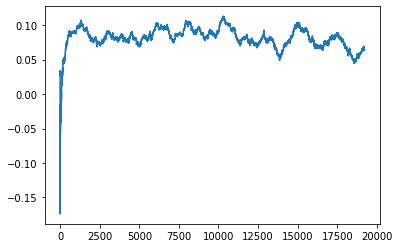

Thread: 5 iteration: 3270
RAM mDiffFit_255 FROM: 128 --> 256 reward: -0.7979740257812501
Thread: 1 iteration: 3128
RAM mDiffFit_421 FROM: 2240 --> 256 reward: 0.15376298710937497
Thread: 1 iteration: 3129
RAM mBackground_31 FROM: 256 --> 192 reward: -1.0
Thread: 3 iteration: 3229
RAM mBackground_9 FROM: 2944 --> 192 reward: -1.0
Thread: 4 iteration: 3184
RAM mDiffFit_344 FROM: 1088 --> 1728 reward: 0.01516150390625002
Thread: 4 iteration: 3185
RAM mBackground_83 FROM: 2880 --> 1344 reward: -1.0
Thread: 5 iteration: 3271
RAM mProject_33 FROM: 1856 --> 2880 reward: 0.16524362397656253
Saving ...


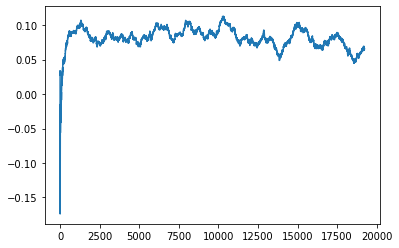

Thread: 1 iteration: 3130
RAM mDiffFit_91 FROM: 3008 --> 2560 reward: -0.07822406953125
Thread: 5 iteration: 3272
RAM mDiffFit_144 FROM: 1536 --> 256 reward: 0.10907283281249999
Thread: 4 iteration: 3186
RAM mDiffFit_306 FROM: 1600 --> 192 reward: 0.282497323828125
Thread: 4 iteration: 3187
RAM mBackground_6 FROM: 2496 --> 192 reward: -1.0
Thread: 2 iteration: 3179
RAM mDiffFit_340 FROM: 1344 --> 1728 reward: 0.009062521874999997
Thread: 4 iteration: 3188
RAM mDiffFit_161 FROM: 1728 --> 1728 reward: 0.0001249999999999949
Saving ...


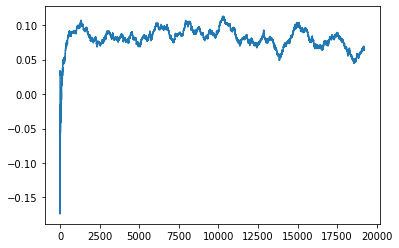

Thread: 2 iteration: 3180
RAM mProject_14 FROM: 896 --> 192 reward: -1.0
Saving ...


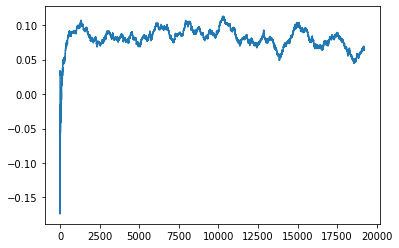

Thread: 3 iteration: 3230
RAM mBackground_70 FROM: 2304 --> 192 reward: -1.0
Thread: 6 iteration: 3224
RAM mDiffFit_23 FROM: 384 --> 192 reward: 0.22685938046874998
Thread: 4 iteration: 3189
RAM mDiffFit_352 FROM: 2944 --> 1728 reward: -0.007796902343750016
Saving ...


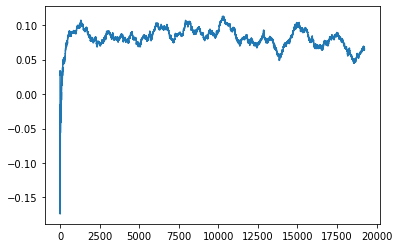

Thread: 4 iteration: 3190
RAM mDiffFit_239 FROM: 1024 --> 256 reward: 0.414625
Thread: 6 iteration: 3225
RAM mBackground_78 FROM: 1280 --> 1088 reward: -1.0
Thread: 1 iteration: 3131
RAM mProject_53 FROM: 1088 --> 320 reward: -1.0
Thread: 5 iteration: 3273
RAM mDiffFit_271 FROM: 192 --> 256 reward: -0.18951044218749996
Thread: 4 iteration: 3191
RAM mDiffFit_51 FROM: 2560 --> 1728 reward: 0.01090623906250001
Thread: 5 iteration: 3274
RAM mDiffFit_84 FROM: 2816 --> 192 reward: 0.26369783281250003
Thread: 6 iteration: 3226
RAM mDiffFit_9 FROM: 448 --> 192 reward: 0.1378853984375
Thread: 1 iteration: 3132
RAM mProject_44 FROM: 1600 --> 320 reward: -1.0
Thread: 3 iteration: 3231
RAM mDiffFit_294 FROM: 128 --> 1984 reward: -0.58134893828125
Thread: 5 iteration: 3275
RAM mDiffFit_10 FROM: 896 --> 192 reward: 0.48650517734375
Thread: 6 iteration: 3227
RAM mDiffFit_362 FROM: 1984 --> 1728 reward: 0.010513030859375001
Thread: 5 iteration: 3276
RAM mDiffFit_265 FROM: 1536 --> 192 reward: 0.250109

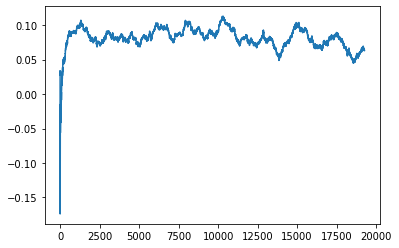

Thread: 5 iteration: 3280
RAM mProject_63 FROM: 1088 --> 192 reward: -1.0
Thread: 1 iteration: 3135
RAM mBackground_47 FROM: 1792 --> 192 reward: -1.0
Thread: 6 iteration: 3228
RAM mDiffFit_53 FROM: 2368 --> 1728 reward: 0.008632809765625003
Thread: 5 iteration: 3281
RAM mBackground_83 FROM: 1664 --> 1728 reward: -1.0
Thread: 2 iteration: 3185
RAM mDiffFit_332 FROM: 2688 --> 256 reward: 0.21605725703125
Thread: 1 iteration: 3136
RAM mBackground_56 FROM: 2304 --> 256 reward: -1.0
Thread: 4 iteration: 3194
RAM mDiffFit_82 FROM: 1984 --> 192 reward: 0.35025
Thread: 5 iteration: 3282
RAM mDiffFit_328 FROM: 128 --> 2752 reward: -1.1441586964843748
Thread: 2 iteration: 3186
RAM mDiffFit_38 FROM: 960 --> 192 reward: 0.5578984292968749
Thread: 6 iteration: 3229
RAM mBackground_19 FROM: 1216 --> 320 reward: -1.0
Thread: 3 iteration: 3236
RAM mDiffFit_244 FROM: 2432 --> 1984 reward: -0.036013074609375015
Thread: 5 iteration: 3283
RAM mDiffFit_129 FROM: 1984 --> 1984 reward: 0.000999999999999994


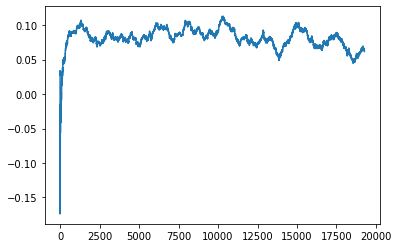

Thread: 6 iteration: 3230
RAM mDiffFit_162 FROM: 1856 --> 448 reward: 0.20392444726562503
Thread: 3 iteration: 3237
RAM mDiffFit_345 FROM: 2368 --> 448 reward: 0.2741275449218749
Thread: 6 iteration: 3231
RAM mDiffFit_109 FROM: 1216 --> 2560 reward: 0.03715632656250001
Thread: 3 iteration: 3238
RAM mDiffFit_306 FROM: 1984 --> 320 reward: 0.14754685859375002
Thread: 6 iteration: 3232
RAM mProject_86 FROM: 2112 --> 1728 reward: -0.05462027782031257
Thread: 5 iteration: 3284
RAM mProject_53 FROM: 768 --> 192 reward: -1.0
Thread: 1 iteration: 3137
RAM mDiffFit_88 FROM: 2496 --> 1344 reward: -0.0005781851562499871
Thread: 3 iteration: 3239
RAM mDiffFit_185 FROM: 2112 --> 1344 reward: -0.02225004374999999
Thread: 6 iteration: 3233
RAM mDiffFit_318 FROM: 1792 --> 1728 reward: -0.0514688046875
Thread: 5 iteration: 3285
RAM mBackground_8 FROM: 2368 --> 1344 reward: -1.0
Thread: 2 iteration: 3188
RAM mDiffFit_181 FROM: 1408 --> 1344 reward: 0.060557344531249994
Thread: 1 iteration: 3138
RAM mPro

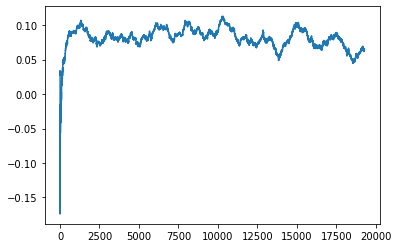

Thread: 1 iteration: 3140
RAM mDiffFit_308 FROM: 2816 --> 1984 reward: -0.008898473046875018
Saving ...


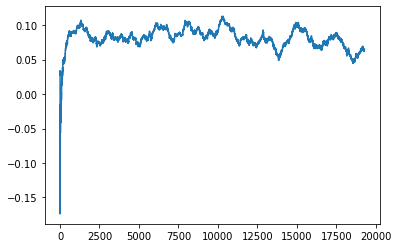

Thread: 2 iteration: 3190
RAM mDiffFit_372 FROM: 576 --> 448 reward: 0.08540106171875
Thread: 5 iteration: 3287
RAM mDiffFit_207 FROM: 1920 --> 192 reward: 0.216882766015625
Thread: 1 iteration: 3141
RAM mBackground_44 FROM: 2688 --> 1344 reward: -1.0
Saving ...


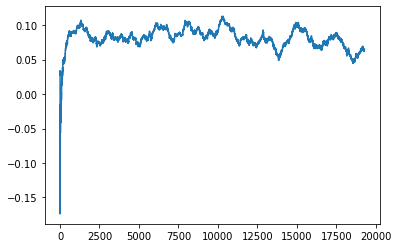

Thread: 3 iteration: 3240
RAM mProject_39 FROM: 2752 --> 192 reward: -1.0
Thread: 6 iteration: 3234
RAM mDiffFit_352 FROM: 704 --> 1728 reward: -0.0462603984375
Thread: 2 iteration: 3191
RAM mDiffFit_281 FROM: 1024 --> 256 reward: 0.1202916375
Thread: 5 iteration: 3288
RAM mDiffFit_312 FROM: 384 --> 256 reward: 0.08627084062499997
Thread: 6 iteration: 3235
RAM mDiffFit_397 FROM: 1984 --> 1344 reward: 0.0025338277343749972
Thread: 6 iteration: 3236
RAM mDiffFit_137 FROM: 2624 --> 320 reward: 0.08753637265624996
Thread: 6 iteration: 3237
RAM mDiffFit_81 FROM: 2240 --> 1728 reward: -0.03113807460937499
Thread: 6 iteration: 3238
RAM mProject_81 FROM: 2432 --> 1216 reward: 0.04140681616406261
Thread: 3 iteration: 3241
RAM mBackground_35 FROM: 2816 --> 1728 reward: -1.0
Thread: 1 iteration: 3142
RAM mBackground_82 FROM: 2560 --> 192 reward: -1.0
Thread: 4 iteration: 3197
RAM mDiffFit_86 FROM: 2880 --> 192 reward: 0.288132766015625
Thread: 6 iteration: 3239
RAM mBackground_47 FROM: 2368 --> 1

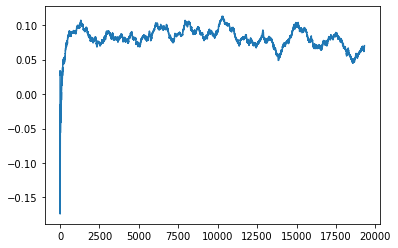

Thread: 5 iteration: 3290
RAM mProject_58 FROM: 1472 --> 1984 reward: -0.0535926071953125
Thread: 2 iteration: 3192
RAM mProject_6 FROM: 2048 --> 1728 reward: -0.039439782984375116
Thread: 4 iteration: 3198
RAM mDiffFit_56 FROM: 1216 --> 256 reward: 0.32370831875000006
Thread: 2 iteration: 3193
RAM mDiffFit_146 FROM: 832 --> 2176 reward: -0.06541146015624999
Thread: 4 iteration: 3199
RAM mProject_83 FROM: 1728 --> 192 reward: -1.0
Thread: 3 iteration: 3242
RAM mDiffFit_75 FROM: 256 --> 1984 reward: -0.231096349609375
Saving ...


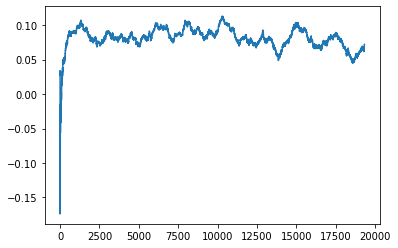

Thread: 4 iteration: 3200
RAM mDiffFit_210 FROM: 2112 --> 1728 reward: -0.013937521874999997
Thread: 3 iteration: 3243
RAM mProject_65 FROM: 1984 --> 1280 reward: 0.10214994487499997
Thread: 5 iteration: 3291
RAM mProject_72 FROM: 1600 --> 320 reward: -1.0
Saving ...


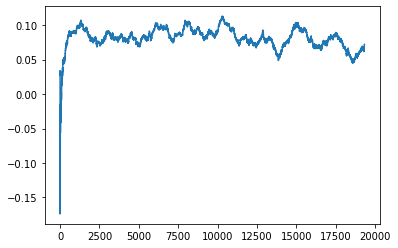

Thread: 6 iteration: 3240
RAM mDiffFit_225 FROM: 2816 --> 192 reward: 0.32945823124999996
Thread: 2 iteration: 3194
RAM mBackground_33 FROM: 320 --> 448 reward: -1.0
Thread: 1 iteration: 3143
RAM mDiffFit_153 FROM: 320 --> 320 reward: -0.013153650390624987
Thread: 3 iteration: 3244
RAM mDiffFit_197 FROM: 768 --> 192 reward: 0.22822657070312502
Thread: 4 iteration: 3201
RAM mDiffFit_422 FROM: 384 --> 1920 reward: -0.08479681484375
Thread: 1 iteration: 3144
RAM mDiffFit_73 FROM: 960 --> 192 reward: 0.1300311953125
Thread: 2 iteration: 3195
RAM mDiffFit_232 FROM: 2176 --> 1728 reward: -0.06937508750000003
Thread: 4 iteration: 3202
RAM mDiffFit_44 FROM: 1344 --> 192 reward: 0.279382809765625
Thread: 3 iteration: 3245
RAM mDiffFit_94 FROM: 2560 --> 192 reward: 0.464382722265625
Thread: 1 iteration: 3145
RAM mDiffFit_271 FROM: 2624 --> 1728 reward: -0.113070462890625
Thread: 3 iteration: 3246
RAM mProject_63 FROM: 256 --> 192 reward: -1.0
Thread: 5 iteration: 3292
RAM mDiffFit_307 FROM: 832 

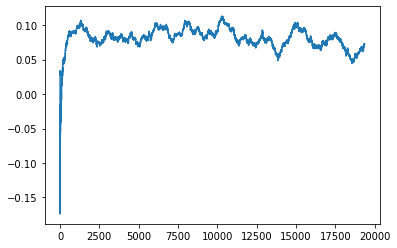

Thread: 3 iteration: 3250
RAM mDiffFit_189 FROM: 1728 --> 2560 reward: -0.0029062390625000066
Thread: 5 iteration: 3297
RAM mDiffFit_103 FROM: 1536 --> 448 reward: 0.048585907421875005
Thread: 2 iteration: 3199
RAM mDiffFit_338 FROM: 1728 --> 192 reward: 0.288062478125
Thread: 6 iteration: 3246
RAM mProject_75 FROM: 256 --> 192 reward: -1.0
Saving ...


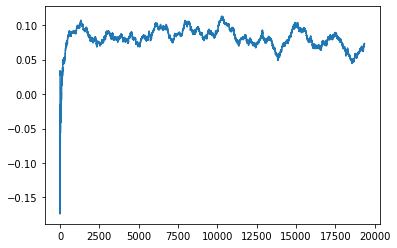

Thread: 1 iteration: 3150
RAM mDiffFit_138 FROM: 1024 --> 1984 reward: 0.059682388281249985
Thread: 5 iteration: 3298
RAM mBgModel_3 FROM: 1600 --> 2304 reward: 0.0330396803125001
Thread: 3 iteration: 3251
RAM mDiffFit_361 FROM: 832 --> 1984 reward: 0.010869866406249956
Thread: 6 iteration: 3247
RAM mProject_72 FROM: 1088 --> 1984 reward: -0.15010726155468757
Thread: 4 iteration: 3205
RAM mDiffFit_72 FROM: 512 --> 1728 reward: -0.275419357421875
Thread: 1 iteration: 3151
RAM mDiffFit_280 FROM: 1344 --> 192 reward: 0.27331247812500004
Thread: 5 iteration: 3299
RAM mDiffFit_226 FROM: 1088 --> 192 reward: 0.19771090742187497
Thread: 4 iteration: 3206
RAM mDiffFit_201 FROM: 1536 --> 192 reward: 0.37473438046874996
Thread: 3 iteration: 3252
RAM mDiffFit_363 FROM: 832 --> 192 reward: 0.13263276601562501
Thread: 6 iteration: 3248
RAM mDiffFit_422 FROM: 2624 --> 1984 reward: 0.007205730078124993
Thread: 4 iteration: 3207
RAM mDiffFit_349 FROM: 832 --> 192 reward: 0.21551561953125004
Saving ...

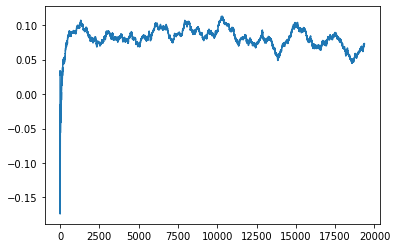

Thread: 5 iteration: 3300
RAM mViewer_1 FROM: 1408 --> 448 reward: 0.20142715260937502
Thread: 6 iteration: 3249
RAM mDiffFit_176 FROM: 1408 --> 192 reward: 0.16954681484375
Thread: 5 iteration: 3301
RAM mDiffFit_200 FROM: 1280 --> 192 reward: 0.5476770796875001
Thread: 4 iteration: 3208
RAM mDiffFit_347 FROM: 2752 --> 1984 reward: 0.011971349609375005
Thread: 5 iteration: 3302
RAM mDiffFit_362 FROM: 1728 --> 192 reward: 0.14495305390625002
Thread: 4 iteration: 3209
RAM mDiffFit_111 FROM: 2624 --> 1344 reward: 0.020421858593749984
Saving ...


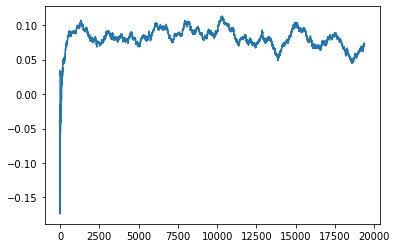

Thread: 4 iteration: 3210
RAM mBackground_45 FROM: 2752 --> 1984 reward: -1.0
Thread: 3 iteration: 3253
RAM mBackground_51 FROM: 768 --> 192 reward: -1.0
Saving ...


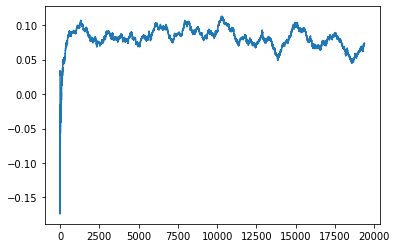

Thread: 2 iteration: 3200
RAM mProject_12 FROM: 2240 --> 2304 reward: 0.011726740898437482
Thread: 5 iteration: 3303
RAM mDiffFit_348 FROM: 320 --> 704 reward: 0.07550789726562498
Thread: 3 iteration: 3254
RAM mBackground_61 FROM: 320 --> 192 reward: 0.3671124999999999
Thread: 4 iteration: 3211
RAM mDiffFit_268 FROM: 2496 --> 1792 reward: 0.08687767617187502
Thread: 3 iteration: 3255
RAM mDiffFit_137 FROM: 960 --> 192 reward: 0.257375
Thread: 4 iteration: 3212
RAM mDiffFit_357 FROM: 2624 --> 192 reward: 0.18408845234375
Thread: 4 iteration: 3213
RAM mBackground_81 FROM: 320 --> 2304 reward: -0.16472543199999998
Thread: 3 iteration: 3256
RAM mProject_47 FROM: 2944 --> 2304 reward: -0.12454242735937504
Thread: 2 iteration: 3201
RAM mBackground_44 FROM: 2880 --> 192 reward: -1.0
Thread: 1 iteration: 3152
RAM mDiffFit_83 FROM: 320 --> 2560 reward: -0.36332555273437495
Thread: 3 iteration: 3257
RAM mDiffFit_324 FROM: 512 --> 2240 reward: -0.0021848019531249888
Thread: 2 iteration: 3202
RAM 

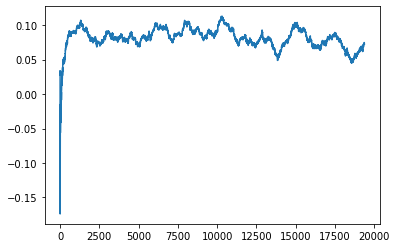

Thread: 6 iteration: 3250
RAM mDiffFit_65 FROM: 2560 --> 192 reward: 0.2673645140625
Thread: 1 iteration: 3153
RAM mBackground_89 FROM: 2944 --> 704 reward: 0.09524707575781252
Thread: 3 iteration: 3258
RAM mDiffFit_170 FROM: 2624 --> 1728 reward: 0.022843760937499985
Thread: 2 iteration: 3203
RAM mDiffFit_381 FROM: 1984 --> 192 reward: 0.21905984570312503
Thread: 6 iteration: 3251
RAM mDiffFit_214 FROM: 2752 --> 1984 reward: -0.021500043750000003
Thread: 1 iteration: 3154
RAM mDiffFit_152 FROM: 448 --> 2560 reward: -0.10743484570312502
Thread: 3 iteration: 3259
RAM mDiffFit_220 FROM: 640 --> 192 reward: 0.13674214648437502
Thread: 2 iteration: 3204
RAM mBackground_37 FROM: 1920 --> 2304 reward: -1.0
Thread: 4 iteration: 3214
RAM mDiffFit_352 FROM: 384 --> 2560 reward: -0.08998951406249998
Saving ...


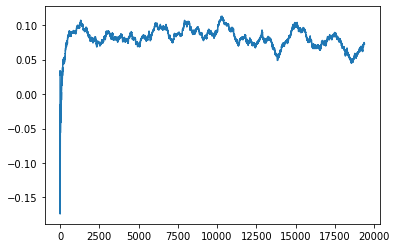

Thread: 3 iteration: 3260
RAM mBackground_8 FROM: 1984 --> 320 reward: -1.0
Thread: 5 iteration: 3304
RAM mDiffFit_55 FROM: 192 --> 192 reward: -0.21287504375000002
Thread: 6 iteration: 3252
RAM mDiffFit_329 FROM: 2752 --> 1984 reward: -0.011531282812499988
Thread: 3 iteration: 3261
RAM mBackground_66 FROM: 1856 --> 2304 reward: 0.009511542554687455
Thread: 4 iteration: 3215
RAM mDiffFit_332 FROM: 1984 --> 1984 reward: 0.0
Thread: 6 iteration: 3253
RAM mDiffFit_77 FROM: 1216 --> 192 reward: 0.17624995625
Thread: 5 iteration: 3305
RAM mDiffFit_122 FROM: 2560 --> 2560 reward: -0.023729203125000004
Thread: 3 iteration: 3262
RAM mDiffFit_75 FROM: 2368 --> 1280 reward: 0.11094537539062499
Thread: 6 iteration: 3254
RAM mProject_73 FROM: 192 --> 1280 reward: 0.7616856431250001
Thread: 2 iteration: 3205
RAM mDiffFit_290 FROM: 1792 --> 192 reward: 0.09960389687499994
Thread: 3 iteration: 3263
RAM mDiffFit_139 FROM: 448 --> 192 reward: 0.4610416812500001
Thread: 6 iteration: 3255
RAM mDiffFit_29

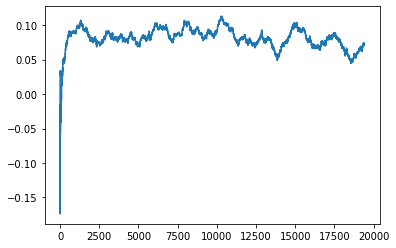

Thread: 5 iteration: 3310
RAM mBackground_26 FROM: 1920 --> 320 reward: -1.0
Thread: 4 iteration: 3217
RAM mDiffFit_348 FROM: 1472 --> 1920 reward: 0.01101044218749998
Thread: 1 iteration: 3159
RAM mBackground_6 FROM: 2240 --> 192 reward: -1.0
Thread: 3 iteration: 3266
RAM mBackground_27 FROM: 1280 --> 448 reward: -1.0
Thread: 6 iteration: 3259
RAM mBackground_87 FROM: 512 --> 192 reward: 0.40888513621875
Thread: 2 iteration: 3208
RAM mDiffFit_78 FROM: 960 --> 1280 reward: 0.030104203125000006
Saving ...


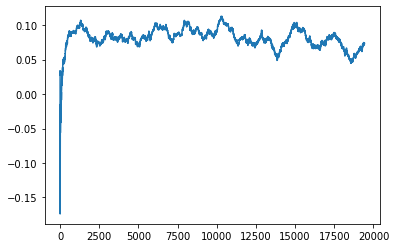

Thread: 6 iteration: 3260
RAM mBackground_79 FROM: 2496 --> 192 reward: 0.8878155215312499
Thread: 4 iteration: 3218
RAM mDiffFit_303 FROM: 704 --> 2432 reward: 0.011567786718750007
Thread: 2 iteration: 3209
RAM mDiffFit_223 FROM: 2560 --> 192 reward: 0.29522389453125
Thread: 6 iteration: 3261
RAM mDiffFit_169 FROM: 128 --> 192 reward: -0.454812521875
Thread: 4 iteration: 3219
RAM mImgtbl_2 FROM: 256 --> 704 reward: 0.670500385
Saving ...


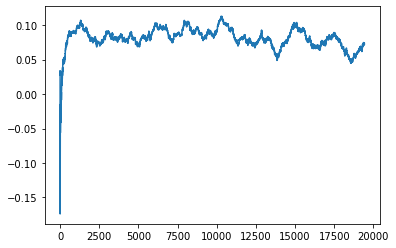

Thread: 2 iteration: 3210
RAM mDiffFit_416 FROM: 832 --> 2432 reward: -0.02074995625000001
Saving ...


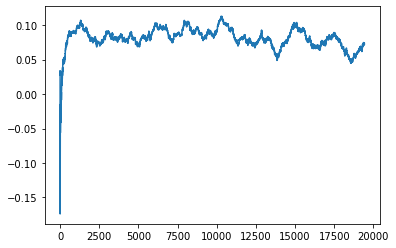

Thread: 4 iteration: 3220
RAM mProject_53 FROM: 2624 --> 192 reward: -1.0
Thread: 5 iteration: 3311
RAM mBackground_47 FROM: 1152 --> 2304 reward: -1.0
Saving ...


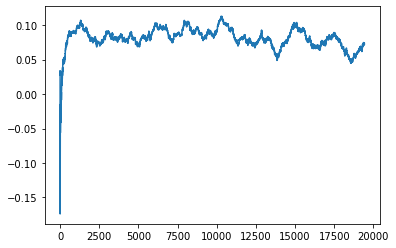

Thread: 1 iteration: 3160
RAM mBackground_55 FROM: 2112 --> 1088 reward: -1.0
Thread: 3 iteration: 3267
RAM mDiffFit_287 FROM: 2048 --> 1088 reward: 0.03110938046875001
Thread: 5 iteration: 3312
RAM mDiffFit_195 FROM: 448 --> 1728 reward: -0.13288280976562503
Thread: 1 iteration: 3161
RAM mDiffFit_359 FROM: 1408 --> 192 reward: 0.15222907187499998
Thread: 2 iteration: 3211
RAM mDiffFit_375 FROM: 1408 --> 1280 reward: 0.05496358359375002
Thread: 5 iteration: 3313
RAM mBackground_56 FROM: 2304 --> 1984 reward: -1.0
Thread: 6 iteration: 3262
RAM mDiffFit_316 FROM: 1024 --> 192 reward: 0.22316146015625005
Thread: 3 iteration: 3268
RAM mDiffFit_342 FROM: 1408 --> 192 reward: 0.244507766015625
Thread: 1 iteration: 3162
RAM mDiffFit_178 FROM: 1536 --> 192 reward: 0.17179677109375
Thread: 2 iteration: 3212
RAM mDiffFit_161 FROM: 2048 --> 2880 reward: 0.06220581757812502
Thread: 5 iteration: 3314
RAM mProject_1 FROM: 1088 --> 192 reward: -1.0
Thread: 4 iteration: 3221
RAM mDiffFit_66 FROM: 192 

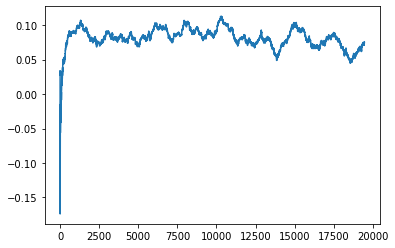

Thread: 3 iteration: 3270
RAM mDiffFit_154 FROM: 512 --> 2304 reward: -0.05409371718749999
Thread: 1 iteration: 3166
RAM mDiffFit_240 FROM: 512 --> 1088 reward: -0.17601566328124998
Thread: 4 iteration: 3226
RAM mProject_39 FROM: 960 --> 448 reward: -1.0
Thread: 5 iteration: 3317
RAM mDiffFit_73 FROM: 2112 --> 2240 reward: 0.014145840625
Thread: 5 iteration: 3318
RAM mDiffFit_290 FROM: 2816 --> 2432 reward: -0.020562521874999996
Thread: 5 iteration: 3319
RAM mDiffFit_305 FROM: 2304 --> 2560 reward: -0.023864601562500008
Saving ...


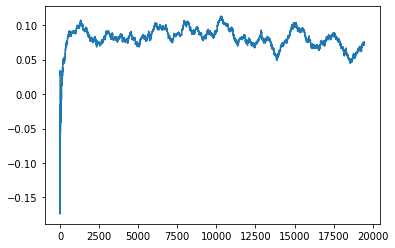

Thread: 5 iteration: 3320
RAM mDiffFit_292 FROM: 576 --> 1088 reward: 0.014523473046875006
Thread: 5 iteration: 3321
RAM mBackground_17 FROM: 3008 --> 1984 reward: -1.0
Thread: 2 iteration: 3215
RAM mProject_18 FROM: 960 --> 1280 reward: -0.12087935859375003
Thread: 1 iteration: 3167
RAM mDiffFit_114 FROM: 2624 --> 192 reward: 0.27623433671875
Thread: 2 iteration: 3216
RAM mDiffFit_260 FROM: 576 --> 384 reward: 0.2611563265625
Thread: 1 iteration: 3168
RAM mBackground_48 FROM: 128 --> 1280 reward: -1.0
Thread: 3 iteration: 3271
RAM mBackground_14 FROM: 2112 --> 2816 reward: -1.0
Thread: 4 iteration: 3227
RAM mProject_59 FROM: 3008 --> 2432 reward: -0.11268490373437504
Thread: 5 iteration: 3322
RAM mBackground_65 FROM: 1408 --> 192 reward: 0.7560452361171875
Thread: 2 iteration: 3217
RAM mDiffFit_224 FROM: 1600 --> 2176 reward: 0.012281282812499992
Thread: 4 iteration: 3228
RAM mDiffFit_150 FROM: 1024 --> 192 reward: 0.28038022109375
Thread: 3 iteration: 3272
RAM mDiffFit_334 FROM: 768 

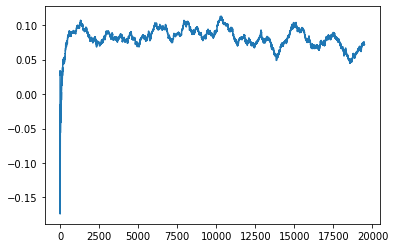

Thread: 2 iteration: 3220
RAM mDiffFit_122 FROM: 2304 --> 1280 reward: 0.18897929062499996
Saving ...


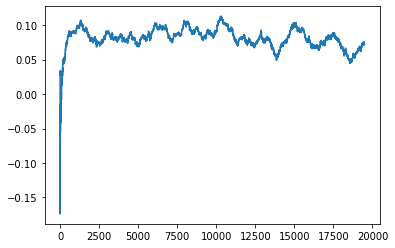

Thread: 1 iteration: 3170
RAM mDiffFit_356 FROM: 1792 --> 2560 reward: -0.0037291593750000095
Thread: 2 iteration: 3221
RAM mDiffFit_208 FROM: 320 --> 2432 reward: -0.03049464765624999
Thread: 1 iteration: 3171
RAM mBackground_33 FROM: 2048 --> 2304 reward: -1.0
Thread: 4 iteration: 3229
RAM mDiffFit_252 FROM: 2368 --> 192 reward: 0.40061701523437493
Thread: 5 iteration: 3325
RAM mProject_77 FROM: 384 --> 2432 reward: 0.7496971228124999
Thread: 6 iteration: 3268
RAM mDiffFit_343 FROM: 2688 --> 192 reward: 0.192914005078125
Thread: 2 iteration: 3222
RAM mDiffFit_43 FROM: 1024 --> 2432 reward: 0.017937565625000002
Thread: 1 iteration: 3172
RAM mDiffFit_336 FROM: 2112 --> 1280 reward: 0.004341128515624997
Thread: 6 iteration: 3269
RAM mBackground_89 FROM: 2880 --> 192 reward: 0.6311457070468749
Saving ...


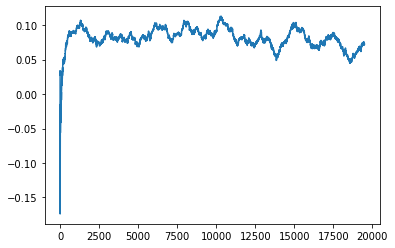

Thread: 4 iteration: 3230
RAM mDiffFit_332 FROM: 1344 --> 192 reward: 0.21742185859375
Thread: 2 iteration: 3223
RAM mDiffFit_379 FROM: 2688 --> 192 reward: 0.16242962460937505
Thread: 4 iteration: 3231
RAM mDiffFit_406 FROM: 1088 --> 192 reward: 0.2085728765625
Thread: 2 iteration: 3224
RAM mDiffFit_160 FROM: 2944 --> 192 reward: 0.16333586367187503
Thread: 4 iteration: 3232
RAM mBackground_2 FROM: 2880 --> 704 reward: -1.0
Thread: 5 iteration: 3326
RAM mDiffFit_247 FROM: 2816 --> 2432 reward: 0.05382296406249999
Thread: 5 iteration: 3327
RAM mProject_76 FROM: 1088 --> 704 reward: -1.0
Thread: 1 iteration: 3173
RAM mProject_62 FROM: 768 --> 2432 reward: 0.7337530416093749
Thread: 2 iteration: 3225
RAM mProject_82 FROM: 1728 --> 192 reward: -1.0
Saving ...


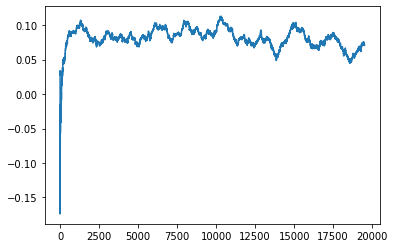

Thread: 6 iteration: 3270
RAM mBackground_38 FROM: 512 --> 2432 reward: -1.0
Thread: 3 iteration: 3274
RAM mDiffFit_297 FROM: 2944 --> 192 reward: 0.18621604101562497
Thread: 5 iteration: 3328
RAM mDiffFit_30 FROM: 2560 --> 2432 reward: -0.002307300781249997
Thread: 1 iteration: 3174
RAM mDiffFit_169 FROM: 1472 --> 192 reward: 0.253637987109375
Thread: 2 iteration: 3226
RAM mDiffFit_187 FROM: 1344 --> 192 reward: 0.08753896132812501
Thread: 3 iteration: 3275
RAM mProject_53 FROM: 2688 --> 192 reward: -1.0
Thread: 4 iteration: 3233
RAM mDiffFit_48 FROM: 192 --> 1088 reward: -0.29378123906250003
Thread: 2 iteration: 3227
RAM mDiffFit_166 FROM: 1920 --> 2176 reward: 0.011468760937499997
Thread: 3 iteration: 3276
RAM mProject_56 FROM: 2624 --> 2432 reward: -0.053761968843750105
Thread: 5 iteration: 3329
RAM mBackground_67 FROM: 2560 --> 448 reward: 0.16434044628125
Thread: 1 iteration: 3175
RAM mDiffFit_228 FROM: 3008 --> 192 reward: 0.22555462460937495
Thread: 2 iteration: 3228
RAM mDiffF

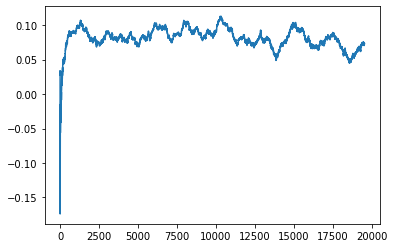

Thread: 2 iteration: 3230
RAM mDiffFit_373 FROM: 832 --> 2560 reward: 0.05502878164062499
Thread: 6 iteration: 3272
RAM mDiffFit_395 FROM: 3008 --> 192 reward: 0.43925254492187493
Thread: 6 iteration: 3273
RAM mProject_65 FROM: 1344 --> 2560 reward: 0.044306534812500076
Thread: 3 iteration: 3279
RAM mAdd_2 FROM: 640 --> 1280 reward: -0.36939845117187503
Thread: 2 iteration: 3231
RAM mDiffFit_269 FROM: 704 --> 448 reward: 0.032257809765625006
Saving ...


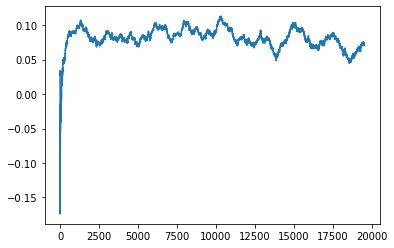

Thread: 3 iteration: 3280
RAM mDiffFit_311 FROM: 2240 --> 1344 reward: 0.04494011054687498
Thread: 6 iteration: 3274
RAM mDiffFit_286 FROM: 576 --> 192 reward: 0.207023429296875
Thread: 2 iteration: 3232
RAM mDiffFit_188 FROM: 1728 --> 1280 reward: 0.029908871484374995
Thread: 2 iteration: 3233
RAM mDiffFit_73 FROM: 2752 --> 384 reward: 0.18778904882812503
Thread: 2 iteration: 3234
RAM mDiffFit_231 FROM: 320 --> 2304 reward: -0.03291137265624999
Thread: 2 iteration: 3235
RAM mProject_84 FROM: 512 --> 1088 reward: 0.8222021928281251
Saving ...


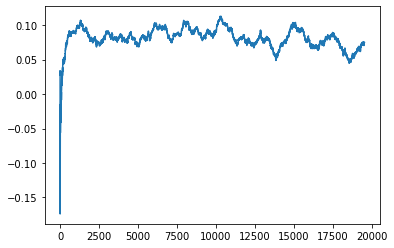

Thread: 5 iteration: 3330
RAM mBackground_54 FROM: 1856 --> 192 reward: -1.0
Thread: 1 iteration: 3176
RAM mProject_68 FROM: 1344 --> 2176 reward: -0.041148622687500046
Thread: 4 iteration: 3235
RAM mDiffFit_86 FROM: 2816 --> 448 reward: 0.044304624609374996
Thread: 2 iteration: 3236
RAM mDiffFit_4 FROM: 2048 --> 448 reward: -0.18266703125
Thread: 5 iteration: 3331
RAM mDiffFit_323 FROM: 128 --> 704 reward: -1.3667396015625
Thread: 1 iteration: 3177
RAM mProject_44 FROM: 1216 --> 1088 reward: 0.06228938221875004
Thread: 3 iteration: 3281
RAM mDiffFit_32 FROM: 320 --> 768 reward: 0.013979246874999997
Thread: 4 iteration: 3236
RAM mBackground_40 FROM: 384 --> 2432 reward: -1.0
Thread: 6 iteration: 3275
RAM mDiffFit_4 FROM: 1856 --> 1344 reward: -0.10580221093749997
Thread: 5 iteration: 3332
RAM mDiffFit_285 FROM: 704 --> 2240 reward: -0.030052035937500002
Thread: 1 iteration: 3178
RAM mDiffFit_85 FROM: 192 --> 2880 reward: -0.15653110781249996
Thread: 4 iteration: 3237
RAM mDiffFit_351 F

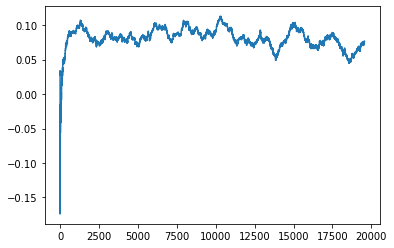

Thread: 1 iteration: 3180
RAM mDiffFit_108 FROM: 2752 --> 448 reward: 0.031731704296875024
Thread: 3 iteration: 3284
RAM mBackground_89 FROM: 2816 --> 256 reward: 0.5444784068437499
Thread: 6 iteration: 3278
RAM mDiffFit_314 FROM: 1152 --> 1088 reward: 0.02717190234375
Thread: 1 iteration: 3181
RAM mDiffFit_57 FROM: 1984 --> 1088 reward: 0.01547393828125002
Thread: 3 iteration: 3285
RAM mDiffFit_106 FROM: 2688 --> 256 reward: 0.17396867343749997
Thread: 2 iteration: 3238
RAM mBackground_67 FROM: 896 --> 384 reward: 0.2876252114687499
Thread: 5 iteration: 3335
RAM mDiffFit_5 FROM: 1600 --> 704 reward: -0.030028737890625008
Thread: 1 iteration: 3182
RAM mDiffFit_383 FROM: 2816 --> 192 reward: 0.16932024414062502
Thread: 6 iteration: 3279
RAM mDiffFit_312 FROM: 2496 --> 1280 reward: 0.0035129871093749973
Thread: 2 iteration: 3239
RAM mDiffFit_134 FROM: 2560 --> 1088 reward: -0.19728935507812512
Thread: 5 iteration: 3336
RAM mBackground_21 FROM: 1728 --> 1280 reward: -1.0
Thread: 4 iterati

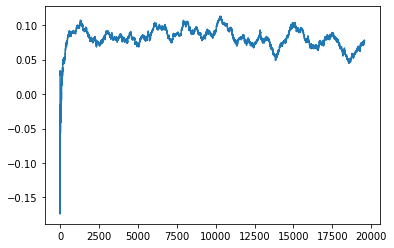

Thread: 6 iteration: 3280
RAM mDiffFit_345 FROM: 2304 --> 2560 reward: -0.014343760937500019
Thread: 5 iteration: 3337
RAM mDiffFit_244 FROM: 3008 --> 448 reward: 0.006658740234374988
Saving ...


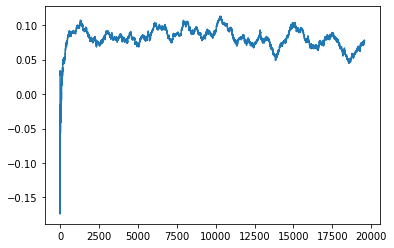

Thread: 2 iteration: 3240
RAM mProject_87 FROM: 896 --> 1088 reward: -0.0869132669765626
Thread: 3 iteration: 3286
RAM mDiffFit_403 FROM: 1152 --> 2304 reward: 0.030062565625000003
Thread: 5 iteration: 3338
RAM mDiffFit_109 FROM: 576 --> 192 reward: 0.13491404882812505
Saving ...


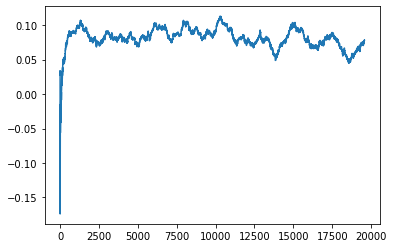

Thread: 4 iteration: 3240
RAM mDiffFit_128 FROM: 768 --> 192 reward: 0.375812521875
Thread: 2 iteration: 3241
RAM mBackground_63 FROM: 2624 --> 256 reward: 0.750094626359375
Thread: 2 iteration: 3242
RAM mDiffFit_357 FROM: 640 --> 2304 reward: 0.010406326562500002
Thread: 2 iteration: 3243
RAM mProject_29 FROM: 2240 --> 256 reward: -1.0
Thread: 6 iteration: 3281
RAM mProject_69 FROM: 2688 --> 256 reward: -1.0
Thread: 3 iteration: 3287
RAM mProject_1 FROM: 1536 --> 256 reward: -1.0
Thread: 5 iteration: 3339
RAM mDiffFit_257 FROM: 2560 --> 1280 reward: -0.00385420312499999
Saving ...


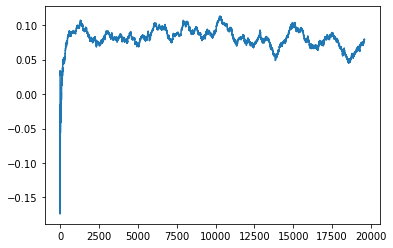

Thread: 5 iteration: 3340
RAM mDiffFit_94 FROM: 1600 --> 2432 reward: 0.044346437109374984
Thread: 3 iteration: 3288
RAM mBackground_9 FROM: 2560 --> 256 reward: -1.0
Thread: 1 iteration: 3184
RAM mDiffFit_36 FROM: 576 --> 192 reward: 0.01910148320312499
Thread: 3 iteration: 3289
RAM mDiffFit_42 FROM: 256 --> 192 reward: 0.06564061953125006
Thread: 5 iteration: 3341
RAM mProject_82 FROM: 2048 --> 448 reward: -1.0
Thread: 2 iteration: 3244
RAM mDiffFit_21 FROM: 256 --> 2432 reward: -0.29539061953125
Thread: 1 iteration: 3185
RAM mBackground_4 FROM: 1664 --> 256 reward: -1.0
Thread: 4 iteration: 3241
RAM mDiffFit_80 FROM: 512 --> 1088 reward: -0.12070314140624999
Thread: 2 iteration: 3245
RAM mDiffFit_109 FROM: 896 --> 256 reward: 0.08537495625
Thread: 5 iteration: 3342
RAM mDiffFit_195 FROM: 2048 --> 2560 reward: -0.017270840625000002
Thread: 4 iteration: 3242
RAM mBackground_79 FROM: 2688 --> 448 reward: 0.23483810845312503
Thread: 1 iteration: 3186
RAM mDiffFit_371 FROM: 3008 --> 192 

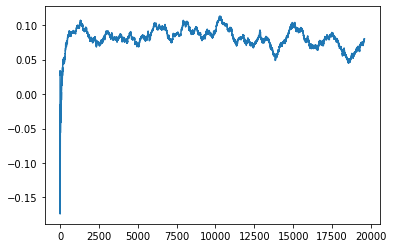

Thread: 3 iteration: 3290
RAM mBackground_16 FROM: 1664 --> 256 reward: -1.0
Thread: 6 iteration: 3282
RAM mDiffFit_29 FROM: 1536 --> 192 reward: 0.199132766015625
Thread: 2 iteration: 3246
RAM mDiffFit_86 FROM: 128 --> 192 reward: -0.7124870566406251
Thread: 4 iteration: 3243
RAM mDiffFit_266 FROM: 896 --> 2624 reward: 0.040872542578125025
Thread: 3 iteration: 3291
RAM mDiffFit_3 FROM: 1536 --> 192 reward: 0.1940311515625
Thread: 6 iteration: 3283
RAM mDiffFit_274 FROM: 2560 --> 192 reward: 0.21752075312500002
Thread: 2 iteration: 3247
RAM mDiffFit_199 FROM: 704 --> 256 reward: 0.335867233984375
Thread: 3 iteration: 3292
RAM mDiffFit_215 FROM: 1792 --> 192 reward: 0.296882809765625
Thread: 6 iteration: 3284
RAM mDiffFit_4 FROM: 768 --> 448 reward: 0.028861969140625
Thread: 2 iteration: 3248
RAM mProject_57 FROM: 960 --> 2304 reward: -0.15903683191406254
Thread: 4 iteration: 3244
RAM mDiffFit_192 FROM: 640 --> 192 reward: 0.09426557578125001
Thread: 3 iteration: 3293
RAM mDiffFit_63 FR

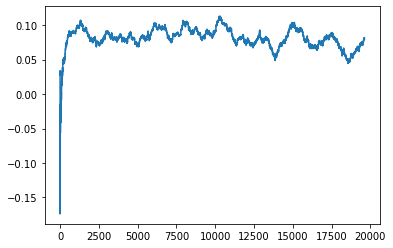

Thread: 2 iteration: 3250
RAM mAdd_3 FROM: 128 --> 1920 reward: 0.583617802734375
Thread: 6 iteration: 3288
RAM mDiffFit_93 FROM: 1152 --> 1088 reward: 0.04354690234375
Saving ...


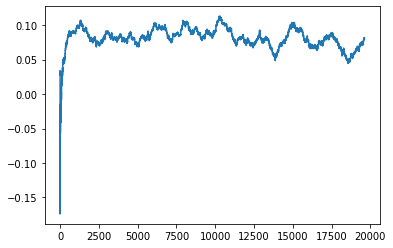

Thread: 1 iteration: 3190
RAM mDiffFit_314 FROM: 2560 --> 2304 reward: 0.019864601562499997
Thread: 1 iteration: 3191
RAM mDiffFit_129 FROM: 2368 --> 2432 reward: 0.007867190234375002
Thread: 1 iteration: 3192
RAM mDiffFit_21 FROM: 512 --> 192 reward: 0.08066141640624999
Thread: 1 iteration: 3193
RAM mProject_23 FROM: 256 --> 192 reward: -1.0
Thread: 4 iteration: 3247
RAM mProject_67 FROM: 1984 --> 256 reward: -1.0
Thread: 3 iteration: 3298
RAM mDiffFit_28 FROM: 1920 --> 2432 reward: 0.016312521874999996
Thread: 1 iteration: 3194
RAM mBackground_54 FROM: 1280 --> 2560 reward: -1.0
Thread: 6 iteration: 3289
RAM mDiffFit_272 FROM: 704 --> 192 reward: 0.22546353984375
Thread: 4 iteration: 3248
RAM mDiffFit_259 FROM: 576 --> 1984 reward: -0.03245305390625005
Saving ...


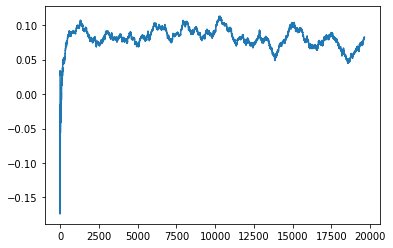

Thread: 6 iteration: 3290
RAM mDiffFit_300 FROM: 320 --> 256 reward: 0.11431252187499998
Thread: 1 iteration: 3195
RAM mBackground_38 FROM: 1984 --> 192 reward: -1.0
Thread: 5 iteration: 3344
RAM mProject_40 FROM: 1984 --> 1984 reward: 0.013928921507812475
Thread: 3 iteration: 3299
RAM mProject_6 FROM: 2944 --> 256 reward: -1.0
Thread: 2 iteration: 3251
RAM mDiffFit_148 FROM: 1088 --> 1984 reward: -0.042471349609375014
Thread: 5 iteration: 3345
RAM mDiffFit_154 FROM: 1664 --> 192 reward: 0.27588280976562507
Thread: 1 iteration: 3196
RAM mDiffFit_354 FROM: 384 --> 256 reward: 0.057104159375000046
Saving ...


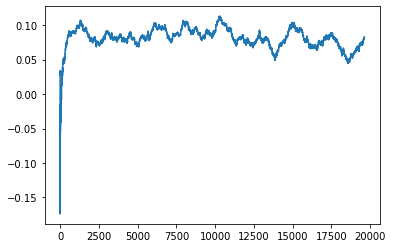

Thread: 3 iteration: 3300
RAM mDiffFit_339 FROM: 2816 --> 2432 reward: -0.009562521874999994
Thread: 2 iteration: 3252
RAM mDiffFit_339 FROM: 2240 --> 2432 reward: -0.024598982031250015
Thread: 1 iteration: 3197
RAM mDiffFit_209 FROM: 960 --> 2432 reward: -0.046273429296874995
Thread: 3 iteration: 3301
RAM mDiffFit_280 FROM: 2560 --> 256 reward: 0.15255203593749997
Thread: 3 iteration: 3302
RAM mDiffFit_88 FROM: 1792 --> 1280 reward: 0.04534376093750002
Thread: 3 iteration: 3303
RAM mBackground_47 FROM: 256 --> 1088 reward: -1.0
Thread: 6 iteration: 3291
RAM mDiffFit_31 FROM: 1216 --> 1344 reward: -0.034708362500000006
Thread: 6 iteration: 3292
RAM mBackground_9 FROM: 1664 --> 1984 reward: -1.0
Thread: 5 iteration: 3346
RAM mDiffFit_126 FROM: 448 --> 704 reward: -0.08803904882812494
Thread: 5 iteration: 3347
RAM mBackground_20 FROM: 2752 --> 192 reward: -1.0
Thread: 4 iteration: 3249
RAM mDiffFit_105 FROM: 2944 --> 2432 reward: -0.03575526484375
Thread: 5 iteration: 3348
RAM mProject_3

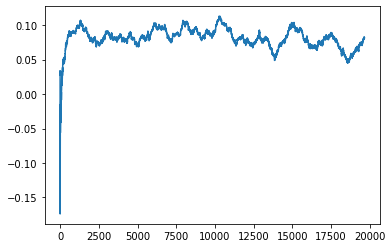

Thread: 4 iteration: 3250
RAM mDiffFit_227 FROM: 2176 --> 384 reward: 0.09570309765624996
Thread: 6 iteration: 3294
RAM mDiffFit_357 FROM: 2560 --> 2432 reward: 0.018083362500000005
Thread: 4 iteration: 3251
RAM mDiffFit_53 FROM: 2560 --> 2944 reward: 0.06763030859375
Thread: 6 iteration: 3295
RAM mDiffFit_274 FROM: 640 --> 192 reward: 0.288674491015625
Thread: 1 iteration: 3199
RAM mDiffFit_196 FROM: 2176 --> 1984 reward: -0.03284639335937502
Thread: 6 iteration: 3296
RAM mBackground_34 FROM: 1792 --> 192 reward: -1.0
Thread: 2 iteration: 3253
RAM mProject_80 FROM: 1472 --> 256 reward: -1.0
Thread: 5 iteration: 3349
RAM mProject_74 FROM: 2880 --> 2432 reward: -0.0766089061875
Thread: 6 iteration: 3297
RAM mBackground_49 FROM: 1984 --> 192 reward: -1.0
Thread: 3 iteration: 3304
RAM mDiffFit_330 FROM: 384 --> 192 reward: 0.1747187609375
Thread: 6 iteration: 3298
RAM mDiffFit_136 FROM: 1152 --> 192 reward: 0.32861719023437497
Thread: 3 iteration: 3305
RAM mBackground_21 FROM: 768 --> 134

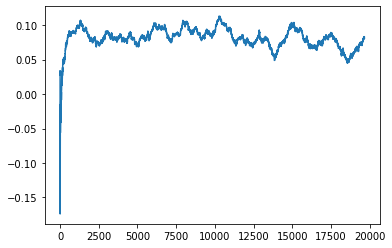

Thread: 1 iteration: 3200
RAM mProject_66 FROM: 2176 --> 192 reward: -1.0
Thread: 4 iteration: 3252
RAM mProject_20 FROM: 832 --> 2432 reward: 0.7287908478749999
Saving ...


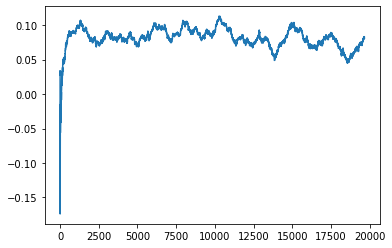

Thread: 5 iteration: 3350
RAM mDiffFit_307 FROM: 1984 --> 192 reward: 0.199960907421875
Thread: 4 iteration: 3253
RAM mDiffFit_390 FROM: 704 --> 192 reward: 0.210596349609375
Thread: 1 iteration: 3201
RAM mDiffFit_74 FROM: 1856 --> 192 reward: 0.20433849609375
Thread: 5 iteration: 3351
RAM mDiffFit_263 FROM: 320 --> 1984 reward: -0.07577860664062502
Thread: 4 iteration: 3254
RAM mDiffFit_212 FROM: 896 --> 2432 reward: -0.008947876562499998
Thread: 5 iteration: 3352
RAM mDiffFit_182 FROM: 320 --> 192 reward: 0.2578333625
Thread: 1 iteration: 3202
RAM mBackground_32 FROM: 192 --> 256 reward: -1.0
Thread: 2 iteration: 3254
RAM mProject_46 FROM: 576 --> 1280 reward: 0.7652612714062501
Thread: 6 iteration: 3299
RAM mDiffFit_353 FROM: 576 --> 2432 reward: -0.037359336718750004
Thread: 5 iteration: 3353
RAM mBackground_36 FROM: 1920 --> 2432 reward: -1.0
Thread: 3 iteration: 3306
RAM mDiffFit_364 FROM: 1984 --> 2560 reward: -0.0015963496093750022
Thread: 2 iteration: 3255
RAM mDiffFit_273 FRO

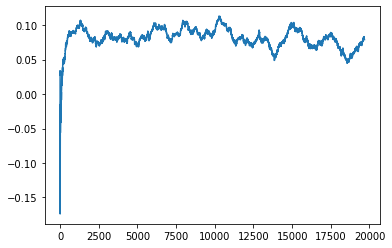

Thread: 6 iteration: 3300
RAM mDiffFit_235 FROM: 1088 --> 2432 reward: -0.053653650390625
Thread: 3 iteration: 3307
RAM mDiffFit_409 FROM: 896 --> 2304 reward: -0.020911416406250005
Thread: 2 iteration: 3256
RAM mDiffFit_159 FROM: 512 --> 1344 reward: -0.0315103984375
Thread: 6 iteration: 3301
RAM mDiffFit_134 FROM: 1856 --> 192 reward: 0.16791655000000003
Thread: 5 iteration: 3354
RAM mBackground_42 FROM: 1344 --> 2560 reward: -1.0
Thread: 4 iteration: 3255
RAM mDiffFit_29 FROM: 2624 --> 2304 reward: -0.008739601562500008
Thread: 2 iteration: 3257
RAM mDiffFit_99 FROM: 1472 --> 192 reward: 0.23364579687500003
Thread: 3 iteration: 3308
RAM mDiffFit_187 FROM: 1664 --> 1920 reward: 0.029890663281250007
Thread: 6 iteration: 3302
RAM mBackground_61 FROM: 1536 --> 1920 reward: -0.029468432796874975
Thread: 5 iteration: 3355
RAM mDiffFit_176 FROM: 2816 --> 192 reward: 0.2299061953125
Thread: 4 iteration: 3256
RAM mBackground_57 FROM: 320 --> 832 reward: -1.0
Thread: 1 iteration: 3203
RAM mDi

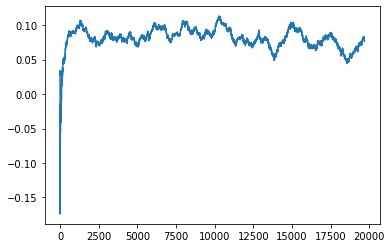

Thread: 3 iteration: 3310
RAM mDiffFit_176 FROM: 2048 --> 1984 reward: -0.030200552734375007
Thread: 4 iteration: 3258
RAM mBackground_62 FROM: 2432 --> 1984 reward: 0.02040707706249995
Thread: 1 iteration: 3205
RAM mDiffFit_328 FROM: 2560 --> 192 reward: 0.552341041015625
Thread: 2 iteration: 3259
RAM mDiffFit_284 FROM: 2816 --> 192 reward: 0.21210407187500002
Thread: 5 iteration: 3357
RAM mDiffFit_340 FROM: 1216 --> 2560 reward: 0.014802123437499997
Saving ...


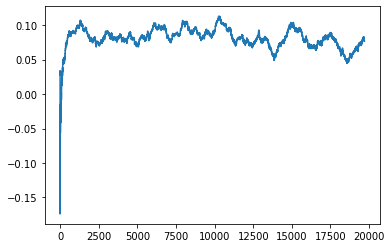

Thread: 2 iteration: 3260
RAM mDiffFit_191 FROM: 2112 --> 192 reward: 0.25676557578125003
Thread: 1 iteration: 3206
RAM mDiffFit_287 FROM: 576 --> 192 reward: 0.282937521875
Thread: 4 iteration: 3259
RAM mDiffFit_275 FROM: 2816 --> 448 reward: -0.010734511718750034
Thread: 3 iteration: 3311
RAM mDiffFit_370 FROM: 1152 --> 2432 reward: -0.0028228765624999964
Thread: 2 iteration: 3261
RAM mDiffFit_360 FROM: 1152 --> 2560 reward: 0.03360424687500001
Saving ...


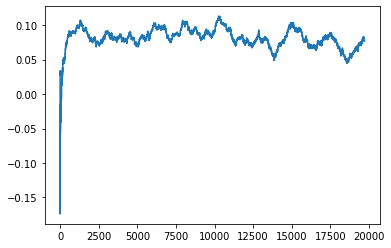

Thread: 4 iteration: 3260
RAM mDiffFit_240 FROM: 2880 --> 192 reward: 0.226289005078125
Thread: 1 iteration: 3207
RAM mDiffFit_292 FROM: 448 --> 192 reward: 0.163419269921875
Thread: 3 iteration: 3312
RAM mDiffFit_352 FROM: 448 --> 1344 reward: -0.09024477890625002
Thread: 2 iteration: 3262
RAM mDiffFit_413 FROM: 448 --> 1984 reward: -0.05289057578124999
Thread: 3 iteration: 3313
RAM mDiffFit_315 FROM: 512 --> 1920 reward: -0.2143229203125
Thread: 4 iteration: 3261
RAM mDiffFit_31 FROM: 2560 --> 192 reward: 0.20689057578125003
Thread: 1 iteration: 3208
RAM mProject_68 FROM: 1088 --> 192 reward: -1.0
Thread: 5 iteration: 3358
RAM mDiffFit_378 FROM: 2944 --> 1984 reward: 0.030747411328125012
Thread: 3 iteration: 3314
RAM mDiffFit_164 FROM: 1984 --> 2432 reward: 0.038013074609375
Thread: 1 iteration: 3209
RAM mDiffFit_122 FROM: 1728 --> 1728 reward: 0.073789136328125
Thread: 5 iteration: 3359
RAM mBackground_43 FROM: 640 --> 192 reward: -1.0
Thread: 6 iteration: 3304
RAM mDiffFit_68 FROM:

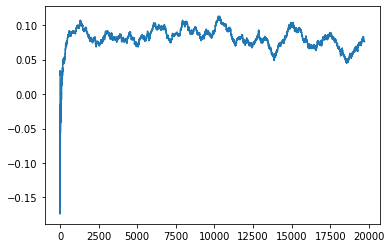

Thread: 5 iteration: 3360
RAM mDiffFit_148 FROM: 2240 --> 192 reward: 0.231377544921875
Saving ...


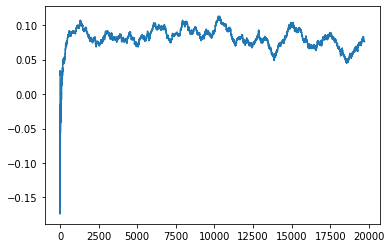

Thread: 1 iteration: 3210
RAM mDiffFit_59 FROM: 2688 --> 192 reward: 0.55570301015625
Thread: 6 iteration: 3305
RAM mDiffFit_352 FROM: 896 --> 2304 reward: -0.00028119531249998914
Thread: 1 iteration: 3211
RAM mDiffFit_37 FROM: 2624 --> 1088 reward: -0.004380264843750013
Thread: 6 iteration: 3306
RAM mDiffFit_287 FROM: 832 --> 192 reward: 0.2189479203125
Thread: 5 iteration: 3361
RAM mDiffFit_328 FROM: 1600 --> 1920 reward: 0.043622455078124976
Thread: 1 iteration: 3212
RAM mDiffFit_7 FROM: 1792 --> 2432 reward: 0.0339896453125
Thread: 5 iteration: 3362
RAM mConcatFit_2 FROM: 1344 --> 1088 reward: -0.02531670749999998
Thread: 6 iteration: 3307
RAM mProject_16 FROM: 1408 --> 1920 reward: -0.06291558365625002
Thread: 4 iteration: 3262
RAM mBackground_4 FROM: 2496 --> 2432 reward: -1.0
Thread: 3 iteration: 3315
RAM mViewer_3 FROM: 704 --> 1984 reward: -0.1414169885390625
Thread: 1 iteration: 3213
RAM mDiffFit_406 FROM: 512 --> 2944 reward: -0.14124995624999998
Thread: 6 iteration: 3308
RA

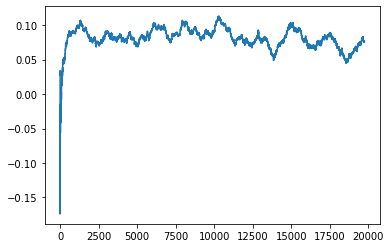

Thread: 1 iteration: 3220
RAM mDiffFit_234 FROM: 640 --> 256 reward: 0.18671876093749998
Saving ...


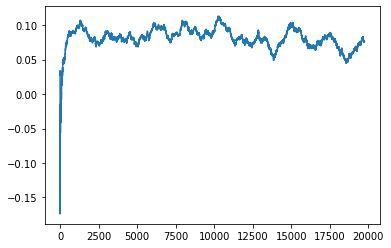

Thread: 3 iteration: 3320
RAM mBackground_26 FROM: 1152 --> 192 reward: -1.0
Thread: 4 iteration: 3263
RAM mProject_14 FROM: 2048 --> 2944 reward: 0.1526862469218749
Thread: 2 iteration: 3268
RAM mDiffFit_137 FROM: 2880 --> 2560 reward: 0.02489325195312501
Saving ...


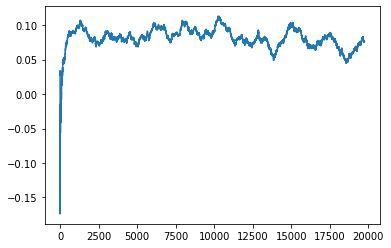

Thread: 6 iteration: 3310
RAM mBackground_31 FROM: 256 --> 2432 reward: -1.0
Thread: 5 iteration: 3366
RAM mDiffFit_280 FROM: 2560 --> 1984 reward: 0.03157555273437501
Thread: 2 iteration: 3269
RAM mDiffFit_234 FROM: 320 --> 192 reward: 0.058164048828124974
Thread: 3 iteration: 3321
RAM mDiffFit_85 FROM: 2496 --> 1280 reward: -0.0331354859375
Thread: 6 iteration: 3311
RAM mDiffFit_365 FROM: 1280 --> 1920 reward: 0.015229203125000004
Thread: 4 iteration: 3264
RAM mDiffFit_370 FROM: 192 --> 2560 reward: -0.3413202878906251
Thread: 6 iteration: 3312
RAM mDiffFit_170 FROM: 1920 --> 1920 reward: 0.004999999999999987
Thread: 4 iteration: 3265
RAM mDiffFit_201 FROM: 1536 --> 192 reward: 0.34325
Saving ...


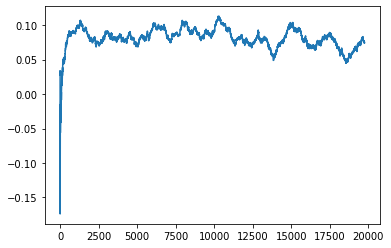

Thread: 2 iteration: 3270
RAM mDiffFit_276 FROM: 2624 --> 1344 reward: 0.0058072570312499815
Thread: 4 iteration: 3266
RAM mDiffFit_256 FROM: 1408 --> 192 reward: 0.15172130585937496
Thread: 2 iteration: 3271
RAM mDiffFit_362 FROM: 2624 --> 192 reward: 0.30614316445312495
Thread: 6 iteration: 3313
RAM mBackground_24 FROM: 1280 --> 2176 reward: -1.0
Thread: 5 iteration: 3367
RAM mDiffFit_100 FROM: 576 --> 1088 reward: 0.012148473046875025
Thread: 4 iteration: 3267
RAM mDiffFit_112 FROM: 1344 --> 256 reward: 0.26954168125
Thread: 6 iteration: 3314
RAM mDiffFit_284 FROM: 2944 --> 1152 reward: 0.10564066328124999
Thread: 5 iteration: 3368
RAM mDiffFit_343 FROM: 1408 --> 192 reward: 0.285184889453125
Thread: 4 iteration: 3268
RAM mProject_47 FROM: 1088 --> 192 reward: -1.0
Thread: 3 iteration: 3322
RAM mDiffFit_1 FROM: 1152 --> 192 reward: 0.251320287890625
Thread: 6 iteration: 3315
RAM mProject_5 FROM: 512 --> 1984 reward: 0.6500444416874999
Thread: 2 iteration: 3272
RAM mDiffFit_53 FROM: 

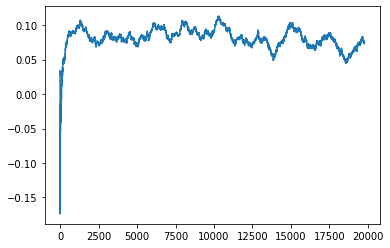

Thread: 5 iteration: 3370
RAM mDiffFit_238 FROM: 1664 --> 192 reward: 0.20357546523437495
Thread: 4 iteration: 3269
RAM mBackground_59 FROM: 1600 --> 192 reward: -1.0
Thread: 1 iteration: 3221
RAM mProject_89 FROM: 1728 --> 1984 reward: 0.009963803812499982
Thread: 3 iteration: 3323
RAM mDiffFit_49 FROM: 1088 --> 2560 reward: -0.021815066796875004
Thread: 5 iteration: 3371
RAM mProject_85 FROM: 2176 --> 2944 reward: 0.1324915138125001
Thread: 2 iteration: 3273
RAM mDiffFit_47 FROM: 1792 --> 1984 reward: 0.050731835546875007
Thread: 5 iteration: 3372
RAM mDiffFit_207 FROM: 128 --> 1984 reward: 0.0943855296875
Thread: 2 iteration: 3274
RAM mDiffFit_412 FROM: 1024 --> 192 reward: 0.275830730078125
Thread: 3 iteration: 3324
RAM mProject_26 FROM: 640 --> 2880 reward: 0.8365693222265626
Thread: 1 iteration: 3222
RAM mProject_27 FROM: 896 --> 192 reward: -1.0
Thread: 6 iteration: 3316
RAM mDiffFit_332 FROM: 960 --> 1280 reward: 0.0010286503906249862
Thread: 2 iteration: 3275
RAM mDiffFit_338 

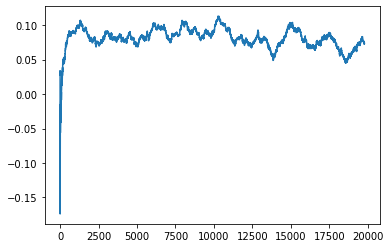

Thread: 4 iteration: 3270
RAM mDiffFit_118 FROM: 1472 --> 1984 reward: 0.020104203125000004
Thread: 2 iteration: 3276
RAM mDiffFit_308 FROM: 2560 --> 2944 reward: 0.021937521875
Thread: 1 iteration: 3224
RAM mDiffFit_2 FROM: 2240 --> 2560 reward: 0.015296902343749988
Thread: 6 iteration: 3318
RAM mDiffFit_35 FROM: 2624 --> 192 reward: 0.23868221328125
Thread: 4 iteration: 3271
RAM mProject_6 FROM: 1792 --> 192 reward: -1.0
Thread: 5 iteration: 3373
RAM mDiffFit_5 FROM: 3008 --> 1280 reward: -0.00343493320312499
Thread: 4 iteration: 3272
RAM mDiffFit_266 FROM: 1024 --> 256 reward: 0.35764584062499993
Thread: 2 iteration: 3277
RAM mDiffFit_366 FROM: 1920 --> 256 reward: 0.47300526484375
Thread: 6 iteration: 3319
RAM mDiffFit_257 FROM: 960 --> 1920 reward: -0.08817190234375002
Thread: 5 iteration: 3374
RAM mDiffFit_176 FROM: 1856 --> 192 reward: 0.14649473515625
Thread: 2 iteration: 3278
RAM mDiffFit_7 FROM: 1280 --> 192 reward: 0.16614579687499997
Saving ...


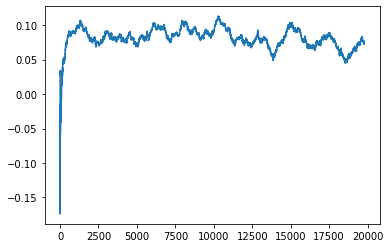

Thread: 6 iteration: 3320
RAM mProject_63 FROM: 2176 --> 2304 reward: 0.018215665031249995
Thread: 3 iteration: 3326
RAM mDiffFit_251 FROM: 960 --> 192 reward: 0.17662495625000002
Thread: 6 iteration: 3321
RAM mDiffFit_420 FROM: 2816 --> 1984 reward: 0.07348442421874997
Thread: 3 iteration: 3327
RAM mProject_69 FROM: 1792 --> 1984 reward: 0.02998224885937508
Thread: 4 iteration: 3273
RAM mProject_4 FROM: 1920 --> 256 reward: -1.0
Thread: 1 iteration: 3225
RAM mProject_90 FROM: 1728 --> 1984 reward: 0.02459959966406249
Thread: 5 iteration: 3375
RAM mProject_18 FROM: 2624 --> 2560 reward: -0.006412515749999947
Thread: 2 iteration: 3279
RAM mDiffFit_352 FROM: 128 --> 192 reward: -0.33412241132812515
Thread: 6 iteration: 3322
RAM mDiffFit_133 FROM: 2368 --> 2560 reward: 0.005601570703124992
Thread: 1 iteration: 3226
RAM mDiffFit_152 FROM: 2624 --> 256 reward: 0.265979115625
Thread: 4 iteration: 3274
RAM mDiffFit_420 FROM: 2688 --> 1984 reward: 0.002213539843749987
Saving ...


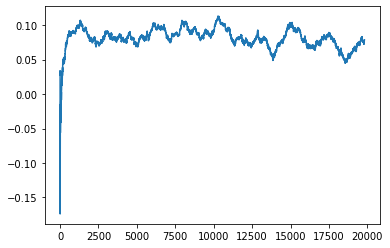

Thread: 2 iteration: 3280
RAM mDiffFit_145 FROM: 320 --> 192 reward: 0.018992146484375083
Thread: 3 iteration: 3328
RAM mDiffFit_297 FROM: 2304 --> 1984 reward: -0.007364601562500021
Thread: 1 iteration: 3227
RAM mDiffFit_39 FROM: 1216 --> 2304 reward: -0.05089842929687499
Thread: 4 iteration: 3275
RAM mDiffFit_239 FROM: 320 --> 2176 reward: -0.497320287890625
Thread: 1 iteration: 3228
RAM mDiffFit_284 FROM: 1344 --> 192 reward: 0.29067185859375
Thread: 4 iteration: 3276
RAM mDiffFit_169 FROM: 1664 --> 192 reward: 0.18169787656249997
Thread: 1 iteration: 3229
RAM mProject_81 FROM: 512 --> 2560 reward: 0.7561396490625001
Thread: 3 iteration: 3329
RAM mBackground_90 FROM: 768 --> 448 reward: 0.13923936559374994
Thread: 4 iteration: 3277
RAM mProject_79 FROM: 2816 --> 192 reward: -1.0
Thread: 5 iteration: 3376
RAM mBackground_84 FROM: 896 --> 1984 reward: -0.06649318370312499
Saving ...


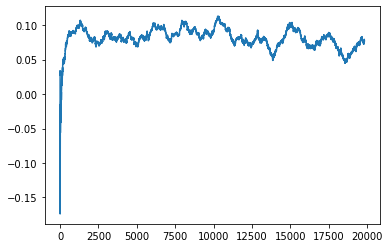

Thread: 3 iteration: 3330
RAM mBackground_70 FROM: 1920 --> 256 reward: 0.546122337828125
Saving ...


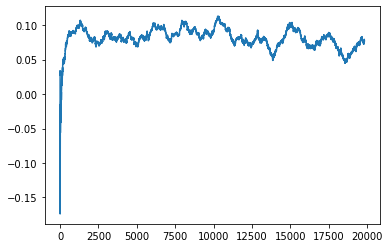

Thread: 1 iteration: 3230
RAM mConcatFit_2 FROM: 768 --> 192 reward: -1.0
Thread: 6 iteration: 3323
RAM mDiffFit_170 FROM: 384 --> 2560 reward: -0.07614057578125001
Thread: 5 iteration: 3377
RAM mBackground_79 FROM: 2112 --> 2944 reward: 0.10872298651562504
Thread: 4 iteration: 3278
RAM mProject_1 FROM: 1216 --> 448 reward: -1.0
Thread: 2 iteration: 3281
RAM mDiffFit_97 FROM: 1600 --> 1984 reward: 0.00745314140624999
Thread: 6 iteration: 3324
RAM mDiffFit_285 FROM: 1600 --> 2624 reward: 0.05997665820312499
Thread: 1 iteration: 3231
RAM mDiffFit_303 FROM: 2048 --> 2304 reward: 0.039375043750000005
Thread: 5 iteration: 3378
RAM mDiffFit_39 FROM: 1344 --> 2560 reward: 0.00615628281249999
Thread: 4 iteration: 3279
RAM mDiffFit_185 FROM: 384 --> 1984 reward: -0.18308595117187504
Thread: 6 iteration: 3325
RAM mDiffFit_385 FROM: 2816 --> 1984 reward: 0.013604159374999997
Thread: 1 iteration: 3232
RAM mDiffFit_359 FROM: 1792 --> 1984 reward: 0.0024765707031249896
Thread: 5 iteration: 3379
RAM 

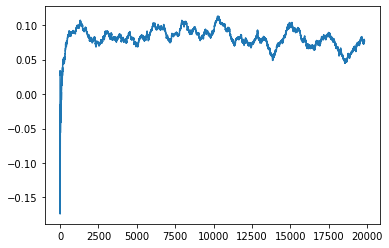

Thread: 4 iteration: 3280
RAM mDiffFit_66 FROM: 960 --> 2880 reward: 0.05506260937500001
Thread: 6 iteration: 3326
RAM mDiffFit_332 FROM: 2304 --> 192 reward: 0.279195287890625
Thread: 1 iteration: 3233
RAM mDiffFit_372 FROM: 704 --> 192 reward: 0.19329163750000003
Thread: 6 iteration: 3327
RAM mProject_74 FROM: 2368 --> 256 reward: -1.0
Thread: 2 iteration: 3282
RAM mDiffFit_203 FROM: 1216 --> 192 reward: 0.294520840625
Thread: 2 iteration: 3283
RAM mProject_80 FROM: 2368 --> 1984 reward: -0.06828201084374998
Thread: 1 iteration: 3234
RAM mProject_15 FROM: 1408 --> 256 reward: -1.0
Saving ...


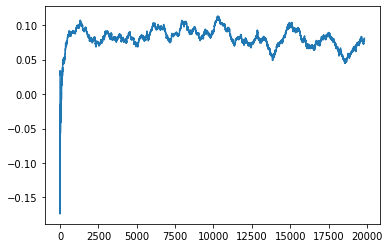

Thread: 5 iteration: 3380
RAM mProject_84 FROM: 2816 --> 832 reward: -1.0
Thread: 4 iteration: 3281
RAM mProject_24 FROM: 1472 --> 1984 reward: -0.025989300843750108
Thread: 2 iteration: 3284
RAM mBackground_53 FROM: 1664 --> 192 reward: -1.0
Thread: 3 iteration: 3331
RAM mBackground_10 FROM: 1216 --> 1920 reward: -1.0
Thread: 6 iteration: 3328
RAM mDiffFit_335 FROM: 2880 --> 1984 reward: -0.05590373789062504
Thread: 3 iteration: 3332
RAM mBackground_84 FROM: 2048 --> 1984 reward: 0.021491057343749974
Thread: 2 iteration: 3285
RAM mDiffFit_38 FROM: 1728 --> 2560 reward: 0.09542984335937504
Thread: 6 iteration: 3329
RAM mDiffFit_109 FROM: 320 --> 2560 reward: -0.08103119531250001
Thread: 3 iteration: 3333
RAM mViewer_1 FROM: 2176 --> 1280 reward: 0.004386197062499992
Thread: 2 iteration: 3286
RAM mProject_10 FROM: 2880 --> 1792 reward: -0.16687723134375007
Thread: 5 iteration: 3381
RAM mDiffFit_128 FROM: 1216 --> 2560 reward: 0.015247455078125013
Thread: 3 iteration: 3334
RAM mDiffFit_2

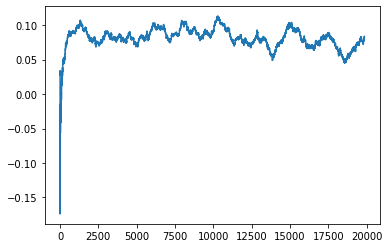

Thread: 6 iteration: 3330
RAM mDiffFit_246 FROM: 448 --> 1344 reward: -0.07980988945312502
Thread: 5 iteration: 3384
RAM mDiffFit_422 FROM: 1600 --> 1984 reward: 0.029830773828124983
Thread: 3 iteration: 3337
RAM mDiffFit_147 FROM: 2240 --> 2560 reward: 0.010671902343749977
Thread: 6 iteration: 3331
RAM mDiffFit_109 FROM: 1600 --> 1728 reward: 0.09795322890625
Thread: 4 iteration: 3284
RAM mProject_90 FROM: 2176 --> 1984 reward: -0.025905057750000127
Thread: 1 iteration: 3236
RAM mDiffFit_17 FROM: 640 --> 2624 reward: 0.00896362734375003
Thread: 3 iteration: 3338
RAM mDiffFit_321 FROM: 1600 --> 256 reward: 0.174059889453125
Thread: 6 iteration: 3332
RAM mDiffFit_418 FROM: 1856 --> 704 reward: 0.018226526953124995
Thread: 4 iteration: 3285
RAM mDiffFit_188 FROM: 1600 --> 192 reward: 0.19835411562499994
Thread: 1 iteration: 3237
RAM mBackground_33 FROM: 512 --> 704 reward: -1.0
Thread: 2 iteration: 3288
RAM mDiffFit_26 FROM: 1280 --> 704 reward: 0.04929426992187498
Thread: 4 iteration: 3

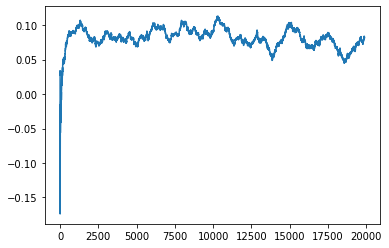

Thread: 2 iteration: 3290
RAM mBackground_3 FROM: 192 --> 1984 reward: -1.0
Thread: 1 iteration: 3238
RAM mDiffFit_387 FROM: 1344 --> 448 reward: 0.03929422617187503
Thread: 6 iteration: 3337
RAM mDiffFit_280 FROM: 2304 --> 1984 reward: -0.005614601562500023
Thread: 2 iteration: 3291
RAM mDiffFit_265 FROM: 256 --> 256 reward: -0.09551044218750006
Thread: 1 iteration: 3239
RAM mDiffFit_95 FROM: 2688 --> 2624 reward: 0.032612012890625014
Thread: 6 iteration: 3338
RAM mBackground_6 FROM: 704 --> 2944 reward: -1.0
Thread: 4 iteration: 3288
RAM mDiffFit_39 FROM: 320 --> 1984 reward: -0.10966922617187501
Saving ...


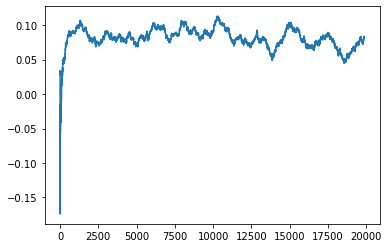

Thread: 1 iteration: 3240
RAM mBackground_16 FROM: 2880 --> 192 reward: -1.0
Thread: 5 iteration: 3385
RAM mDiffFit_352 FROM: 2688 --> 192 reward: 0.14521858593749998
Thread: 2 iteration: 3292
RAM mDiffFit_61 FROM: 2176 --> 256 reward: 0.113937434375
Thread: 4 iteration: 3289
RAM mDiffFit_376 FROM: 1024 --> 640 reward: 0.150041725
Thread: 6 iteration: 3339
RAM mBackground_45 FROM: 1472 --> 2944 reward: -1.0
Saving ...


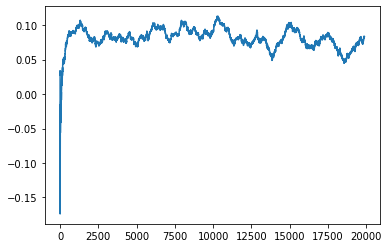

Thread: 3 iteration: 3340
RAM mDiffFit_260 FROM: 192 --> 192 reward: -0.06671095117187498
Thread: 2 iteration: 3293
RAM mImgtbl_2 FROM: 576 --> 1024 reward: -0.14753534593750006
Thread: 5 iteration: 3386
RAM mDiffFit_13 FROM: 832 --> 448 reward: -0.0009193136718750085
Saving ...


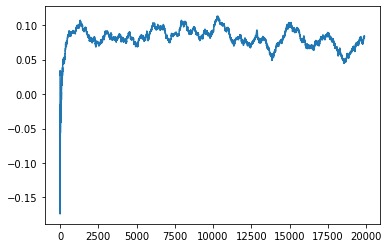

Thread: 4 iteration: 3290
RAM mDiffFit_218 FROM: 1408 --> 256 reward: 0.1069166375
Saving ...


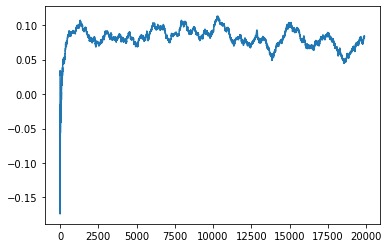

Thread: 6 iteration: 3340
RAM mBackground_74 FROM: 832 --> 2560 reward: -0.0215334314921875
Thread: 2 iteration: 3294
RAM mBackground_80 FROM: 1024 --> 1088 reward: 0.012720845875000024
Thread: 3 iteration: 3341
RAM mDiffFit_18 FROM: 2304 --> 192 reward: 0.290523385546875
Thread: 5 iteration: 3387
RAM mDiffFit_43 FROM: 2944 --> 1088 reward: -0.0033698664062500015
Thread: 4 iteration: 3291
RAM mDiffFit_246 FROM: 2496 --> 704 reward: 0.045783827734375004
Thread: 3 iteration: 3342
RAM mDiffFit_16 FROM: 128 --> 256 reward: -0.5206771234375001
Thread: 6 iteration: 3341
RAM mBackground_71 FROM: 640 --> 2048 reward: -0.07946925271874992
Thread: 2 iteration: 3295
RAM mDiffFit_242 FROM: 2688 --> 2816 reward: 0.09039075078125
Thread: 4 iteration: 3292
RAM mDiffFit_166 FROM: 640 --> 192 reward: 0.18578382773437496
Thread: 6 iteration: 3342
RAM mDiffFit_252 FROM: 2880 --> 1408 reward: 0.0536145578125
Thread: 4 iteration: 3293
RAM mBackground_8 FROM: 2560 --> 256 reward: -1.0
Thread: 1 iteration: 3

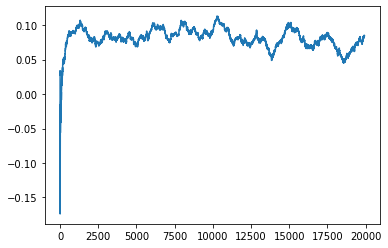

Thread: 5 iteration: 3390
RAM mBackground_71 FROM: 2240 --> 1088 reward: 0.3267577011015625
Thread: 2 iteration: 3298
RAM mDiffFit_186 FROM: 2560 --> 320 reward: 0.186731748046875
Thread: 6 iteration: 3346
RAM mAdd_1 FROM: 1152 --> 704 reward: 0.16690101796875
Saving ...


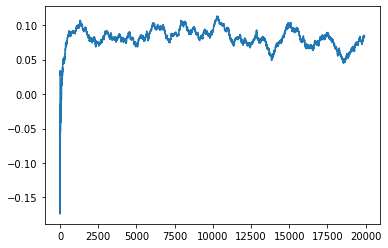

Thread: 4 iteration: 3300
RAM mDiffFit_213 FROM: 128 --> 2304 reward: -1.0445468148437502
Thread: 6 iteration: 3347
RAM mDiffFit_195 FROM: 2496 --> 1344 reward: -0.030187565625000006
Thread: 4 iteration: 3301
RAM mDiffFit_207 FROM: 1856 --> 192 reward: 0.28416663750000004
Thread: 6 iteration: 3348
RAM mDiffFit_24 FROM: 1664 --> 1984 reward: 0.03174223398437501
Thread: 6 iteration: 3349
RAM mDiffFit_127 FROM: 576 --> 256 reward: 0.18973960156250003
Saving ...


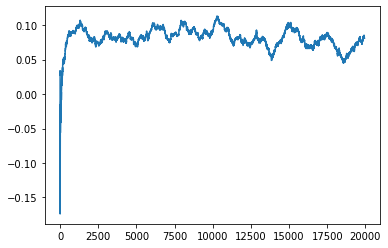

Thread: 6 iteration: 3350
RAM mDiffFit_43 FROM: 1280 --> 1920 reward: -0.16000530859374998
Thread: 6 iteration: 3351
RAM mBackground_55 FROM: 896 --> 1088 reward: -1.0
Thread: 5 iteration: 3391
RAM mProject_61 FROM: 832 --> 256 reward: -1.0
Thread: 2 iteration: 3299
RAM mBackground_37 FROM: 2176 --> 1920 reward: -1.0
Thread: 3 iteration: 3347
RAM mDiffFit_185 FROM: 1664 --> 1088 reward: 0.023588539843749992
Thread: 5 iteration: 3392
RAM mBackground_39 FROM: 1408 --> 1280 reward: -1.0
Thread: 4 iteration: 3302
RAM mDiffFit_397 FROM: 768 --> 448 reward: 0.010497367578124975
Thread: 4 iteration: 3303
RAM mDiffFit_397 FROM: 1152 --> 1152 reward: 0.10351570703124999
Thread: 4 iteration: 3304
RAM mProject_43 FROM: 1344 --> 1984 reward: -0.05941914377343753
Thread: 5 iteration: 3393
RAM mDiffFit_170 FROM: 832 --> 256 reward: 0.29465623906250005
Thread: 4 iteration: 3305
RAM mDiffFit_18 FROM: 1408 --> 1984 reward: 0.04753391523437501
Thread: 4 iteration: 3306
RAM mBackground_59 FROM: 2432 --> 

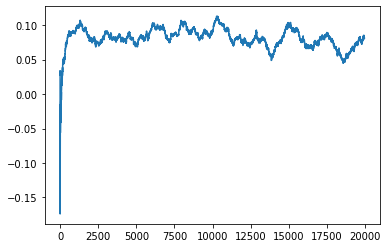

Thread: 2 iteration: 3300
RAM mDiffFit_152 FROM: 3008 --> 1088 reward: -0.022692786718749997
Thread: 6 iteration: 3353
RAM mBackground_18 FROM: 576 --> 256 reward: -1.0
Thread: 1 iteration: 3247
RAM mDiffFit_359 FROM: 640 --> 320 reward: 0.3528230078125
Thread: 2 iteration: 3301
RAM mDiffFit_402 FROM: 512 --> 2240 reward: -0.032976483203125004
Thread: 1 iteration: 3248
RAM mBackground_17 FROM: 832 --> 256 reward: -1.0
Thread: 3 iteration: 3348
RAM mBackground_88 FROM: 2176 --> 1984 reward: -0.011428619617187531
Thread: 1 iteration: 3249
RAM mBackground_53 FROM: 768 --> 1984 reward: -1.0
Thread: 5 iteration: 3394
RAM mProject_23 FROM: 1472 --> 1984 reward: -0.014779601859375035
Thread: 6 iteration: 3354
RAM mBackground_35 FROM: 2688 --> 1088 reward: -1.0
Thread: 4 iteration: 3307
RAM mDiffFit_213 FROM: 896 --> 1088 reward: -0.062591172265625
Thread: 3 iteration: 3349
RAM mDiffFit_205 FROM: 1088 --> 1984 reward: -0.009848938281250014
Thread: 6 iteration: 3355
RAM mDiffFit_318 FROM: 1344 

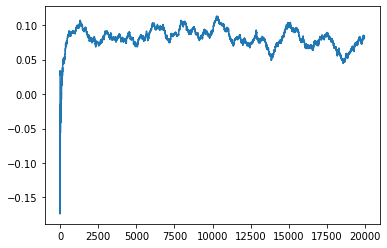

Thread: 1 iteration: 3250
RAM mDiffFit_302 FROM: 2368 --> 1088 reward: -0.021932388281249993
Thread: 5 iteration: 3395
RAM mProject_52 FROM: 3008 --> 1088 reward: 0.03435476857031243
Thread: 2 iteration: 3302
RAM mDiffFit_111 FROM: 1152 --> 704 reward: 0.03646353984375
Thread: 4 iteration: 3308
RAM mDiffFit_409 FROM: 2304 --> 1088 reward: 0.01298433671875
Thread: 6 iteration: 3356
RAM mDiffFit_410 FROM: 2112 --> 1920 reward: -0.03426566328125001
Thread: 1 iteration: 3251
RAM mDiffFit_422 FROM: 3008 --> 320 reward: 0.09890615156249999
Thread: 2 iteration: 3303
RAM mDiffFit_8 FROM: 2112 --> 192 reward: 0.306414048828125
Thread: 5 iteration: 3396
RAM mDiffFit_228 FROM: 320 --> 2944 reward: -0.10101035468749998
Thread: 4 iteration: 3309
RAM mDiffFit_208 FROM: 1536 --> 1984 reward: -0.05967712343749999
Thread: 1 iteration: 3252
RAM mBackground_70 FROM: 2816 --> 1088 reward: 0.021336392054687514
Thread: 2 iteration: 3304
RAM mDiffFit_153 FROM: 2752 --> 192 reward: 0.23316137265625003
Thread:

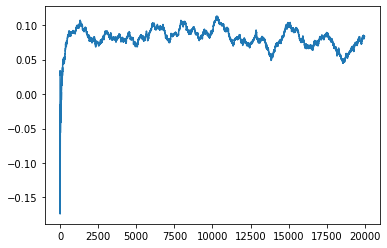

Thread: 3 iteration: 3350
RAM mDiffFit_186 FROM: 2880 --> 1984 reward: 0.0022369691406249823
Thread: 5 iteration: 3398
RAM mDiffFit_18 FROM: 2432 --> 1088 reward: -0.01415891523437499
Thread: 1 iteration: 3253
RAM mDiffFit_360 FROM: 576 --> 1984 reward: 0.018127719921875
Thread: 3 iteration: 3351
RAM mDiffFit_224 FROM: 2112 --> 1920 reward: -0.0028437609375000193
Thread: 5 iteration: 3399
RAM mProject_22 FROM: 3008 --> 1152 reward: -0.01977368435156246
Thread: 6 iteration: 3357
RAM mDiffFit_249 FROM: 192 --> 1984 reward: -0.169065023046875
Thread: 6 iteration: 3358
RAM mProject_45 FROM: 2496 --> 1344 reward: -0.027949477148437707
Saving ...


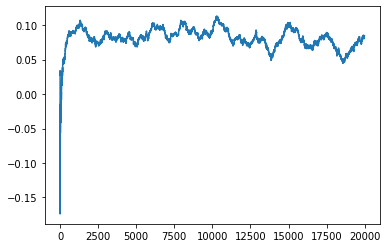

Thread: 4 iteration: 3310
RAM mProject_86 FROM: 1344 --> 2048 reward: -0.04097802065624988
Thread: 1 iteration: 3254
RAM mBackground_8 FROM: 1920 --> 2240 reward: -1.0
Thread: 2 iteration: 3305
RAM mDiffFit_85 FROM: 512 --> 192 reward: 0.011270753124999963
Saving ...


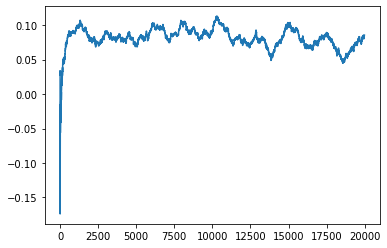

Thread: 5 iteration: 3400
RAM mDiffFit_284 FROM: 320 --> 2240 reward: -0.05970818750000002
Thread: 5 iteration: 3401
RAM mDiffFit_22 FROM: 1984 --> 256 reward: 0.25079426992187503
Thread: 1 iteration: 3255
RAM mBackground_20 FROM: 1280 --> 2944 reward: -1.0
Thread: 3 iteration: 3352
RAM mProject_12 FROM: 1216 --> 2240 reward: -0.047420452406249966
Thread: 2 iteration: 3306
RAM mDiffFit_210 FROM: 1600 --> 1088 reward: -0.001231791796875003
Thread: 2 iteration: 3307
RAM mProject_32 FROM: 2048 --> 1088 reward: 0.13032926409374995
Thread: 4 iteration: 3311
RAM mBackground_14 FROM: 1216 --> 1920 reward: -1.0
Thread: 6 iteration: 3359
RAM mProject_52 FROM: 3008 --> 1984 reward: -0.17456238316406258
Thread: 1 iteration: 3256
RAM mDiffFit_25 FROM: 320 --> 1088 reward: -0.07776298710937497
Thread: 2 iteration: 3308
RAM mDiffFit_26 FROM: 960 --> 1152 reward: 0.023164092578125007
Thread: 4 iteration: 3312
RAM mDiffFit_230 FROM: 2112 --> 1088 reward: -0.0005026324218749927
Saving ...


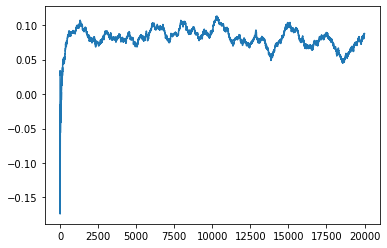

Thread: 6 iteration: 3360
RAM mProject_49 FROM: 1792 --> 256 reward: -1.0
Thread: 5 iteration: 3402
RAM mDiffFit_213 FROM: 2624 --> 1088 reward: -0.003257897265624976
Thread: 2 iteration: 3309
RAM mDiffFit_82 FROM: 768 --> 2048 reward: 0.035343848437500006
Thread: 6 iteration: 3361
RAM mDiffFit_177 FROM: 2432 --> 192 reward: 0.12150508984374996
Thread: 4 iteration: 3313
RAM mProject_29 FROM: 1600 --> 1984 reward: 0.004088042085937438
Thread: 1 iteration: 3257
RAM mDiffFit_59 FROM: 2112 --> 1088 reward: 0.032989557812500014
Saving ...


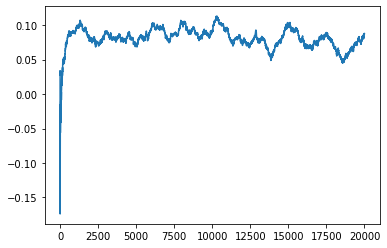

Thread: 2 iteration: 3310
RAM mDiffFit_207 FROM: 2560 --> 2304 reward: 0.04764588437499998
Thread: 6 iteration: 3362
RAM mDiffFit_228 FROM: 256 --> 256 reward: -0.07073960156249996
Thread: 4 iteration: 3314
RAM mBackground_23 FROM: 2688 --> 256 reward: -1.0
Thread: 3 iteration: 3353
RAM mDiffFit_8 FROM: 384 --> 1984 reward: -0.06294265546875003
Thread: 1 iteration: 3258
RAM mDiffFit_237 FROM: 2176 --> 704 reward: -0.004744866406249989
Thread: 4 iteration: 3315
RAM mDiffFit_358 FROM: 704 --> 1984 reward: -0.00706765546875
Thread: 3 iteration: 3354
RAM mDiffFit_157 FROM: 256 --> 1088 reward: -0.12563017734374998
Thread: 1 iteration: 3259
RAM mDiffFit_327 FROM: 1408 --> 448 reward: 0.06517185859374999
Thread: 4 iteration: 3316
RAM mDiffFit_368 FROM: 2944 --> 448 reward: 0.055635354687499985
Saving ...


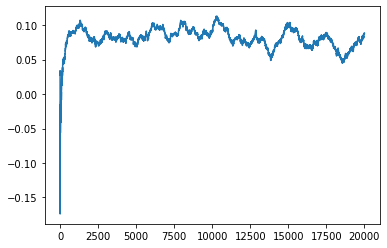

Thread: 1 iteration: 3260
RAM mDiffFit_314 FROM: 768 --> 192 reward: 0.28248438046875
Thread: 3 iteration: 3355
RAM mProject_6 FROM: 2816 --> 1088 reward: -0.004095385875000001
Thread: 6 iteration: 3363
RAM mDiffFit_135 FROM: 2112 --> 192 reward: 0.29442185859375
Thread: 3 iteration: 3356
RAM mDiffFit_245 FROM: 1664 --> 448 reward: 0.09029426992187503
Thread: 3 iteration: 3357
RAM mProject_73 FROM: 1536 --> 192 reward: -1.0
Thread: 5 iteration: 3403
RAM mProject_3 FROM: 704 --> 1536 reward: 0.67457313
Thread: 1 iteration: 3261
RAM mDiffFit_197 FROM: 2240 --> 192 reward: 0.37613280976562496
Thread: 5 iteration: 3404
RAM mBackground_3 FROM: 2176 --> 1088 reward: -1.0
Thread: 4 iteration: 3317
RAM mBackground_20 FROM: 2880 --> 2048 reward: -1.0
Thread: 6 iteration: 3364
RAM mDiffFit_128 FROM: 2944 --> 640 reward: 0.18908336249999996
Thread: 4 iteration: 3318
RAM mBackground_48 FROM: 2688 --> 192 reward: -1.0
Thread: 2 iteration: 3311
RAM mDiffFit_403 FROM: 2752 --> 256 reward: 0.251835907

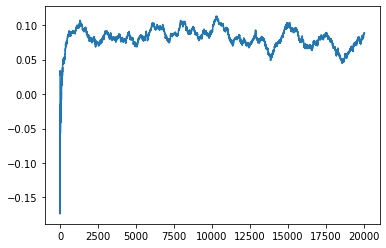

Thread: 4 iteration: 3320
RAM mDiffFit_224 FROM: 2880 --> 1088 reward: 0.0019634960937499855
Saving ...


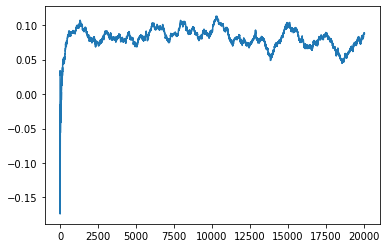

Thread: 3 iteration: 3360
RAM mDiffFit_301 FROM: 2752 --> 1984 reward: 0.03397398203125002
Thread: 5 iteration: 3406
RAM mDiffFit_289 FROM: 2432 --> 704 reward: 0.015083275
Thread: 6 iteration: 3368
RAM mDiffFit_392 FROM: 2240 --> 2304 reward: 0.005447920312500014
Thread: 4 iteration: 3321
RAM mProject_54 FROM: 2944 --> 1536 reward: -0.1513635325312501
Thread: 2 iteration: 3313
RAM mBackground_6 FROM: 576 --> 1088 reward: -1.0
Thread: 1 iteration: 3263
RAM mDiffFit_368 FROM: 1536 --> 704 reward: 0.18245840625000004
Thread: 5 iteration: 3407
RAM mDiffFit_108 FROM: 1664 --> 704 reward: 0.14191150390625
Thread: 4 iteration: 3322
RAM mDiffFit_411 FROM: 256 --> 320 reward: -0.029304668359374994
Thread: 2 iteration: 3314
RAM mDiffFit_90 FROM: 2496 --> 192 reward: 0.24807805390625004
Thread: 4 iteration: 3323
RAM mDiffFit_193 FROM: 1344 --> 192 reward: 0.27867966835937497
Thread: 2 iteration: 3315
RAM mDiffFit_390 FROM: 128 --> 384 reward: -0.32237495625000007
Thread: 2 iteration: 3316
RAM mD

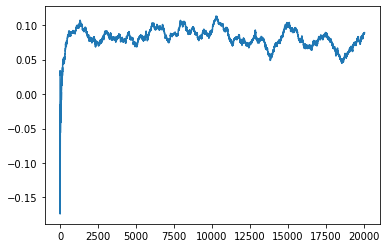

Thread: 2 iteration: 3320
RAM mBackground_13 FROM: 1472 --> 192 reward: -1.0
Thread: 6 iteration: 3369
RAM mDiffFit_281 FROM: 576 --> 1344 reward: -0.028335907421874994
Thread: 4 iteration: 3326
RAM mBackground_60 FROM: 2752 --> 1088 reward: -1.0
Thread: 1 iteration: 3265
RAM mDiffFit_260 FROM: 2368 --> 1024 reward: 0.00020305390625002806
Thread: 2 iteration: 3321
RAM mBackground_62 FROM: 2816 --> 2240 reward: -0.014031032695312508
Saving ...


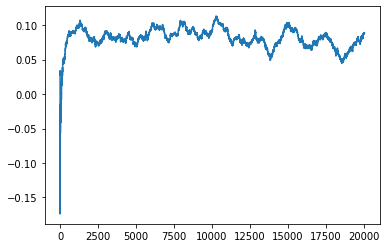

Thread: 6 iteration: 3370
RAM mProject_22 FROM: 1216 --> 192 reward: -1.0
Thread: 5 iteration: 3409
RAM mDiffFit_123 FROM: 2816 --> 448 reward: 0.05811973515624999
Thread: 2 iteration: 3322
RAM mProject_6 FROM: 704 --> 704 reward: -1.0
Thread: 4 iteration: 3327
RAM mProject_41 FROM: 1344 --> 1536 reward: -0.047259840304687585
Thread: 2 iteration: 3323
RAM mBackground_31 FROM: 128 --> 384 reward: -1.0
Thread: 3 iteration: 3365
RAM mDiffFit_32 FROM: 192 --> 320 reward: -0.23904168125
Thread: 4 iteration: 3328
RAM mProject_44 FROM: 1664 --> 320 reward: -1.0
Thread: 6 iteration: 3371
RAM mDiffFit_105 FROM: 2688 --> 192 reward: 0.22552338554687495
Thread: 2 iteration: 3324
RAM mProject_60 FROM: 1984 --> 704 reward: -1.0
Saving ...


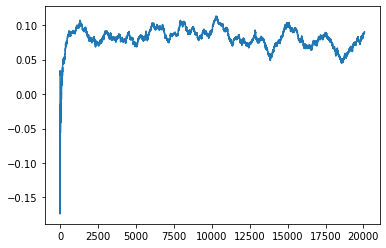

Thread: 5 iteration: 3410
RAM mDiffFit_60 FROM: 1984 --> 192 reward: 0.20581765546875003
Thread: 3 iteration: 3366
RAM mDiffFit_225 FROM: 1792 --> 2048 reward: 0.03300004375
Thread: 6 iteration: 3372
RAM mDiffFit_31 FROM: 2944 --> 704 reward: 0.029262943359374977
Thread: 2 iteration: 3325
RAM mDiffFit_311 FROM: 2432 --> 2240 reward: -0.0032187609374999954
Thread: 5 iteration: 3411
RAM mBackground_20 FROM: 576 --> 256 reward: -1.0
Thread: 1 iteration: 3266
RAM mDiffFit_219 FROM: 2752 --> 192 reward: 0.18406761171875002
Thread: 2 iteration: 3326
RAM mProject_82 FROM: 1472 --> 2176 reward: 0.014027023968750052
Thread: 4 iteration: 3329
RAM mDiffFit_276 FROM: 1152 --> 192 reward: 0.24350780976562497
Thread: 5 iteration: 3412
RAM mDiffFit_40 FROM: 768 --> 256 reward: 0.09365619531250001
Thread: 1 iteration: 3267
RAM mImgtbl_1 FROM: 1152 --> 704 reward: 0.19934794656250007
Thread: 6 iteration: 3373
RAM mDiffFit_410 FROM: 1216 --> 1344 reward: 0.026841172265624994
Thread: 2 iteration: 3327
RA

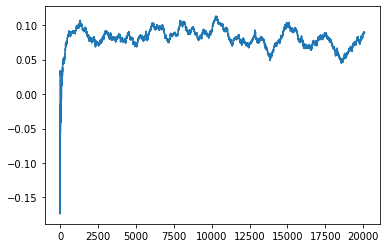

Thread: 4 iteration: 3330
RAM mDiffFit_353 FROM: 1216 --> 1344 reward: 0.023091172265625008
Thread: 3 iteration: 3368
RAM mDiffFit_214 FROM: 2432 --> 704 reward: 0.007945244140625009
Thread: 6 iteration: 3375
RAM mDiffFit_421 FROM: 1856 --> 448 reward: 0.06366141640625
Thread: 1 iteration: 3269
RAM mDiffFit_97 FROM: 384 --> 1088 reward: -0.12127865039062499
Thread: 4 iteration: 3331
RAM mConcatFit_2 FROM: 192 --> 448 reward: 0.48823144906250004
Thread: 5 iteration: 3414
RAM mDiffFit_160 FROM: 3008 --> 256 reward: 0.11608586367187501
Thread: 6 iteration: 3376
RAM mBackground_77 FROM: 2752 --> 1536 reward: -0.02499161780468753
Saving ...


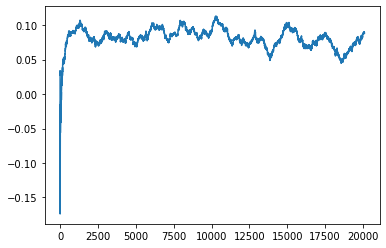

Thread: 1 iteration: 3270
RAM mDiffFit_1 FROM: 1472 --> 704 reward: 0.020695287890624987
Thread: 6 iteration: 3377
RAM mDiffFit_220 FROM: 1664 --> 320 reward: 0.17894011054687498
Thread: 1 iteration: 3271
RAM mProject_10 FROM: 2944 --> 704 reward: -1.0
Thread: 2 iteration: 3328
RAM mDiffFit_395 FROM: 1536 --> 320 reward: 0.136424447265625
Thread: 6 iteration: 3378
RAM mDiffFit_64 FROM: 384 --> 2240 reward: -0.2513229203125
Thread: 1 iteration: 3272
RAM mDiffFit_90 FROM: 1856 --> 1088 reward: -0.014940154296875004
Thread: 6 iteration: 3379
RAM mProject_68 FROM: 1024 --> 1280 reward: -0.08922560990625
Thread: 3 iteration: 3369
RAM mDiffFit_6 FROM: 2944 --> 1920 reward: -0.03216672500000002
Saving ...


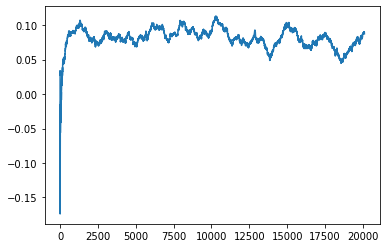

Thread: 6 iteration: 3380
RAM mDiffFit_56 FROM: 1408 --> 448 reward: 0.10350254492187502
Thread: 1 iteration: 3273
RAM mProject_82 FROM: 1280 --> 256 reward: -1.0
Thread: 5 iteration: 3415
RAM mDiffFit_131 FROM: 1600 --> 2624 reward: 0.08328659140625001
Thread: 6 iteration: 3381
RAM mDiffFit_329 FROM: 1856 --> 704 reward: -0.043343848437499985
Thread: 1 iteration: 3274
RAM mDiffFit_261 FROM: 448 --> 320 reward: -0.13144278671874995
Thread: 5 iteration: 3416
RAM mDiffFit_131 FROM: 832 --> 704 reward: 0.006809889453124954
Thread: 5 iteration: 3417
RAM mDiffFit_353 FROM: 896 --> 192 reward: 0.269770840625
Thread: 1 iteration: 3275
RAM mProject_13 FROM: 448 --> 704 reward: -1.0
Thread: 2 iteration: 3329
RAM mDiffFit_100 FROM: 1280 --> 320 reward: 0.108395796875
Thread: 5 iteration: 3418
RAM mBackground_18 FROM: 2176 --> 1088 reward: -1.0
Saving ...


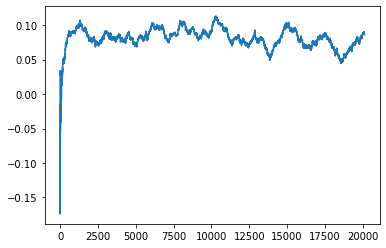

Thread: 3 iteration: 3370
RAM mDiffFit_305 FROM: 640 --> 256 reward: 0.22884898203125004
Thread: 1 iteration: 3276
RAM mBackground_44 FROM: 192 --> 192 reward: -1.0
Thread: 4 iteration: 3332
RAM mDiffFit_128 FROM: 3008 --> 704 reward: 0.06337236757812498
Thread: 5 iteration: 3419
RAM mDiffFit_53 FROM: 2048 --> 448 reward: 0.09059112851562498
Thread: 1 iteration: 3277
RAM mDiffFit_373 FROM: 1344 --> 192 reward: 0.326867146484375
Thread: 3 iteration: 3371
RAM mDiffFit_176 FROM: 2432 --> 1920 reward: -0.041630264843749994
Thread: 4 iteration: 3333
RAM mProject_16 FROM: 1280 --> 384 reward: -1.0
Thread: 6 iteration: 3382
RAM mDiffFit_400 FROM: 2752 --> 1984 reward: -0.017781282812499986
Thread: 1 iteration: 3278
RAM mProject_18 FROM: 576 --> 320 reward: -1.0
Saving ...


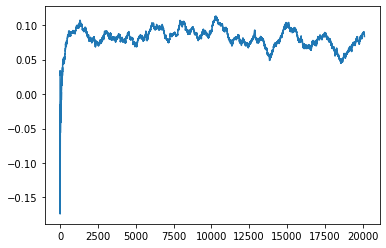

Thread: 2 iteration: 3330
RAM mAdd_1 FROM: 896 --> 704 reward: 0.15530210156249988
Thread: 1 iteration: 3279
RAM mProject_31 FROM: 512 --> 1536 reward: 0.6696568760624999
Thread: 6 iteration: 3383
RAM mDiffFit_367 FROM: 1088 --> 2240 reward: 0.026062565625
Saving ...


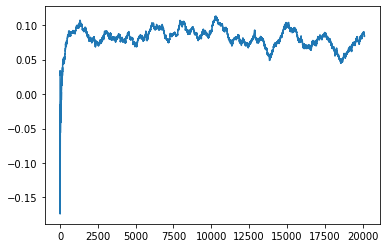

Thread: 1 iteration: 3280
RAM mDiffFit_174 FROM: 1792 --> 320 reward: 0.21679168125000003
Thread: 6 iteration: 3384
RAM mDiffFit_75 FROM: 256 --> 2560 reward: -0.10474991250000001
Thread: 1 iteration: 3281
RAM mProject_72 FROM: 512 --> 256 reward: -1.0
Thread: 3 iteration: 3372
RAM mDiffFit_125 FROM: 960 --> 320 reward: 0.08203904882812502
Thread: 6 iteration: 3385
RAM mDiffFit_285 FROM: 2048 --> 768 reward: 0.10879168125000002
Thread: 1 iteration: 3282
RAM mBackground_48 FROM: 1536 --> 448 reward: -1.0
Saving ...


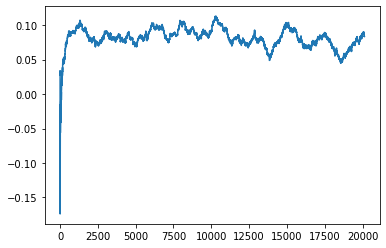

Thread: 5 iteration: 3420
RAM mProject_47 FROM: 2112 --> 192 reward: -1.0
Thread: 2 iteration: 3331
RAM mDiffFit_285 FROM: 1728 --> 704 reward: 0.027872367578125005
Thread: 6 iteration: 3386
RAM mDiffFit_366 FROM: 1984 --> 320 reward: 0.16657550898437498
Thread: 1 iteration: 3283
RAM mDiffFit_346 FROM: 2112 --> 512 reward: 0.346554755859375
Thread: 3 iteration: 3373
RAM mBackground_35 FROM: 832 --> 320 reward: -1.0
Thread: 4 iteration: 3334
RAM mDiffFit_89 FROM: 704 --> 512 reward: 0.06893230078125
Thread: 2 iteration: 3332
RAM mDiffFit_240 FROM: 2880 --> 320 reward: 0.10862754492187499
Thread: 1 iteration: 3284
RAM mDiffFit_408 FROM: 2560 --> 320 reward: 0.08040619531250001
Thread: 4 iteration: 3335
RAM mDiffFit_81 FROM: 1152 --> 192 reward: 0.24349999999999997
Thread: 3 iteration: 3374
RAM mBackground_90 FROM: 2176 --> 320 reward: 0.43062696418749996
Thread: 6 iteration: 3387
RAM mDiffFit_54 FROM: 1344 --> 192 reward: 0.29496090742187503
Thread: 2 iteration: 3333
RAM mDiffFit_192 FRO

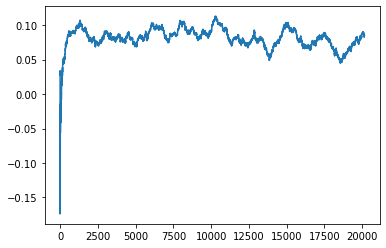

Thread: 6 iteration: 3390
RAM mDiffFit_358 FROM: 1856 --> 2240 reward: 0.05510424687500002
Saving ...


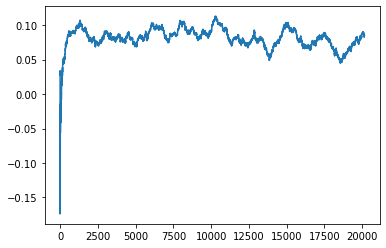

Thread: 2 iteration: 3340
RAM mProject_37 FROM: 2496 --> 512 reward: -1.0
Thread: 4 iteration: 3337
RAM mDiffFit_233 FROM: 1088 --> 704 reward: -0.19471634726562498
Thread: 3 iteration: 3377
RAM mDiffFit_37 FROM: 512 --> 2880 reward: -0.10822385078124999
Thread: 1 iteration: 3289
RAM mDiffFit_195 FROM: 2240 --> 704 reward: 0.02417703593749999
Thread: 5 iteration: 3423
RAM mDiffFit_330 FROM: 1600 --> 704 reward: 0.065044269921875
Thread: 2 iteration: 3341
RAM mDiffFit_220 FROM: 1984 --> 1728 reward: 0.058372455078124996
Thread: 3 iteration: 3378
RAM mDiffFit_99 FROM: 2880 --> 192 reward: 0.291882766015625
Thread: 4 iteration: 3338
RAM mDiffFit_412 FROM: 1216 --> 256 reward: 0.1741770796875
Thread: 2 iteration: 3342
RAM mDiffFit_60 FROM: 2112 --> 192 reward: 0.215664005078125
Thread: 5 iteration: 3424
RAM mDiffFit_405 FROM: 1856 --> 512 reward: 0.12167707968750002
Thread: 2 iteration: 3343
RAM mProject_6 FROM: 1600 --> 2240 reward: 0.05586017062499997
Saving ...


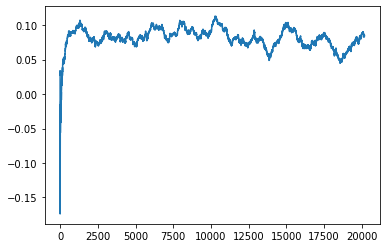

Thread: 1 iteration: 3290
RAM mProject_71 FROM: 128 --> 320 reward: -1.0
Thread: 6 iteration: 3391
RAM mDiffFit_63 FROM: 1408 --> 2240 reward: -0.022028650390624998
Thread: 4 iteration: 3339
RAM mBackground_79 FROM: 1536 --> 192 reward: 0.6781301115703124
Thread: 3 iteration: 3379
RAM mDiffFit_417 FROM: 3008 --> 1024 reward: 0.092408871484375
Thread: 2 iteration: 3344
RAM mDiffFit_223 FROM: 1280 --> 1024 reward: 0.083895884375
Thread: 1 iteration: 3291
RAM mDiffFit_317 FROM: 1664 --> 512 reward: 0.097979159375
Saving ...


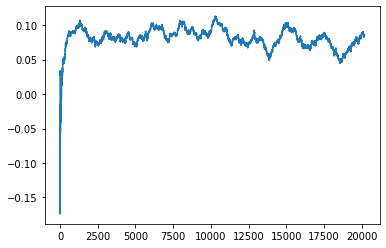

Thread: 4 iteration: 3340
RAM mDiffFit_95 FROM: 640 --> 704 reward: 0.01224741132812502
Thread: 4 iteration: 3341
RAM mDiffFit_57 FROM: 2368 --> 192 reward: 0.287825465234375
Thread: 1 iteration: 3292
RAM mProject_24 FROM: 1216 --> 768 reward: -1.0
Thread: 5 iteration: 3425
RAM mDiffFit_403 FROM: 2688 --> 1920 reward: -0.020250043750000002
Thread: 1 iteration: 3293
RAM mDiffFit_404 FROM: 576 --> 512 reward: 0.05989325195312499
Thread: 5 iteration: 3426
RAM mBackground_64 FROM: 512 --> 320 reward: 0.20461057213281253
Thread: 4 iteration: 3342
RAM mDiffFit_76 FROM: 2048 --> 448 reward: 0.07890101796875
Thread: 1 iteration: 3294
RAM mDiffFit_347 FROM: 1472 --> 512 reward: 0.065570287890625
Thread: 5 iteration: 3427
RAM mProject_53 FROM: 1536 --> 704 reward: -1.0
Thread: 6 iteration: 3392
RAM mProject_28 FROM: 1792 --> 320 reward: -1.0
Saving ...


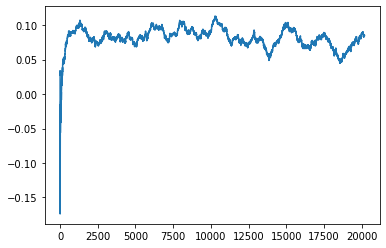

Thread: 3 iteration: 3380
RAM mDiffFit_280 FROM: 1664 --> 1920 reward: 0.0036666812499999875
Thread: 5 iteration: 3428
RAM mDiffFit_385 FROM: 640 --> 704 reward: 0.026747411328125
Thread: 6 iteration: 3393
RAM mDiffFit_408 FROM: 1472 --> 704 reward: 0.09120314140625
Thread: 1 iteration: 3295
RAM mDiffFit_299 FROM: 192 --> 2240 reward: -0.262986925390625
Thread: 3 iteration: 3381
RAM mDiffFit_363 FROM: 3008 --> 1920 reward: -0.024867233984374997
Thread: 5 iteration: 3429
RAM mDiffFit_136 FROM: 2048 --> 192 reward: 0.22682809765625003
Thread: 6 iteration: 3394
RAM mDiffFit_403 FROM: 3008 --> 704 reward: 0.014708275000000007
Thread: 6 iteration: 3395
RAM mImgtbl_1 FROM: 256 --> 2240 reward: 0.38402751718750006
Saving ...


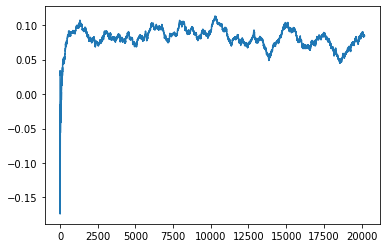

Thread: 5 iteration: 3430
RAM mBackground_7 FROM: 832 --> 704 reward: -1.0
Thread: 4 iteration: 3343
RAM mConcatFit_2 FROM: 1856 --> 192 reward: 0.857370831875
Thread: 3 iteration: 3382
RAM mProject_15 FROM: 512 --> 704 reward: -1.0
Thread: 2 iteration: 3345
RAM mDiffFit_393 FROM: 2880 --> 2752 reward: 0.09080479960937497
Thread: 5 iteration: 3431
RAM mDiffFit_89 FROM: 2176 --> 2880 reward: -0.03418752187500002
Thread: 4 iteration: 3344
RAM mProject_29 FROM: 2048 --> 512 reward: -1.0
Thread: 1 iteration: 3296
RAM mDiffFit_46 FROM: 384 --> 704 reward: -0.009585907421875012
Thread: 2 iteration: 3346
RAM mDiffFit_58 FROM: 2176 --> 704 reward: 0.006361925390625002
Thread: 4 iteration: 3345
RAM mDiffFit_261 FROM: 640 --> 512 reward: 0.08686982265625004
Thread: 1 iteration: 3297
RAM mDiffFit_222 FROM: 1792 --> 704 reward: 0.06932292031250001
Thread: 2 iteration: 3347
RAM mDiffFit_138 FROM: 1280 --> 2240 reward: 0.013104203124999995
Thread: 4 iteration: 3346
RAM mDiffFit_109 FROM: 2368 --> 26

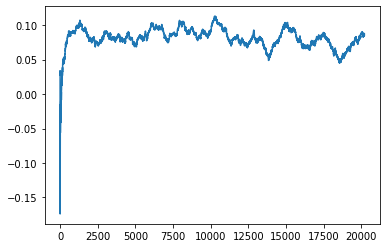

Thread: 4 iteration: 3350
RAM mDiffFit_236 FROM: 3008 --> 192 reward: 0.18127325429687502
Thread: 6 iteration: 3398
RAM mProject_39 FROM: 1792 --> 704 reward: -1.0
Saving ...


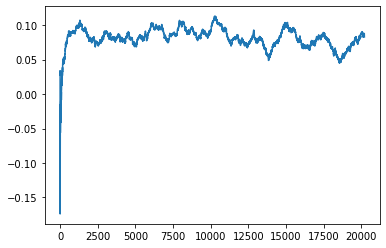

Thread: 2 iteration: 3350
RAM mProject_36 FROM: 2176 --> 512 reward: -1.0
Thread: 3 iteration: 3385
RAM mProject_57 FROM: 320 --> 2240 reward: 0.7106403294140625
Thread: 1 iteration: 3299
RAM mProject_37 FROM: 704 --> 704 reward: -1.0
Thread: 5 iteration: 3434
RAM mDiffFit_207 FROM: 1536 --> 1920 reward: -0.07854694609374999
Thread: 3 iteration: 3386
RAM mDiffFit_45 FROM: 2112 --> 320 reward: 0.0801978765625
Saving ...


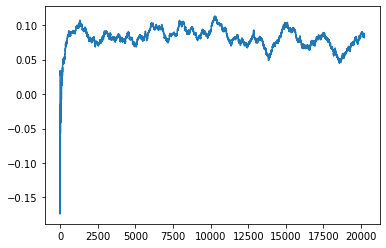

Thread: 1 iteration: 3300
RAM mDiffFit_170 FROM: 2176 --> 2240 reward: 0.028192742968749986
Thread: 5 iteration: 3435
RAM mDiffFit_387 FROM: 768 --> 2880 reward: -0.025937434375000006
Thread: 3 iteration: 3387
RAM mDiffFit_69 FROM: 2944 --> 384 reward: 0.0964061953125
Thread: 1 iteration: 3301
RAM mProject_55 FROM: 384 --> 704 reward: -1.0
Thread: 4 iteration: 3351
RAM mDiffFit_393 FROM: 2752 --> 1984 reward: -0.08256783046874999
Thread: 5 iteration: 3436
RAM mDiffFit_326 FROM: 1600 --> 704 reward: 0.08493230078124998
Thread: 3 iteration: 3388
RAM mDiffFit_100 FROM: 1536 --> 256 reward: 0.231520796875
Thread: 1 iteration: 3302
RAM mProject_20 FROM: 704 --> 512 reward: -1.0
Thread: 2 iteration: 3351
RAM mDiffFit_149 FROM: 320 --> 320 reward: -0.06986460156250002
Thread: 4 iteration: 3352
RAM mDiffFit_155 FROM: 1664 --> 512 reward: 0.09997915937499999
Thread: 5 iteration: 3437
RAM mDiffFit_415 FROM: 640 --> 2304 reward: -0.07036451406249998
Thread: 1 iteration: 3303
RAM mBackground_30 FR

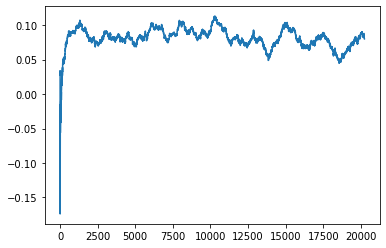

Thread: 6 iteration: 3400
RAM mDiffFit_205 FROM: 512 --> 704 reward: -0.048138030859374986
Thread: 5 iteration: 3439
RAM mDiffFit_284 FROM: 640 --> 2048 reward: -0.024749956249999986
Thread: 6 iteration: 3401
RAM mDiffFit_414 FROM: 1408 --> 704 reward: -0.009302123437500004
Thread: 2 iteration: 3353
RAM mDiffFit_15 FROM: 2176 --> 256 reward: 0.10991654999999996
Thread: 4 iteration: 3354
RAM mDiffFit_145 FROM: 2624 --> 704 reward: 0.02962754492187497
Saving ...


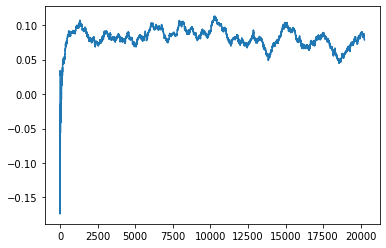

Thread: 5 iteration: 3440
RAM mDiffFit_121 FROM: 2944 --> 704 reward: -0.028526149218750015
Thread: 4 iteration: 3355
RAM mDiffFit_324 FROM: 1344 --> 192 reward: 0.292835951171875
Thread: 2 iteration: 3354
RAM mBackground_18 FROM: 704 --> 704 reward: -1.0
Saving ...


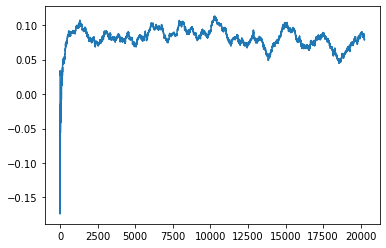

Thread: 3 iteration: 3390
RAM mDiffFit_325 FROM: 2816 --> 2240 reward: 0.020770840625
Thread: 2 iteration: 3355
RAM mDiffFit_147 FROM: 2816 --> 2880 reward: 0.032617233984374994
Thread: 3 iteration: 3391
RAM mDiffFit_62 FROM: 2496 --> 320 reward: 0.07174473515625
Thread: 3 iteration: 3392
RAM mDiffFit_102 FROM: 256 --> 256 reward: -0.08356252187499996
Thread: 2 iteration: 3356
RAM mProject_77 FROM: 2688 --> 1984 reward: -0.11009741948437508
Thread: 4 iteration: 3356
RAM mBackground_7 FROM: 1856 --> 512 reward: -1.0
Thread: 1 iteration: 3305
RAM mProject_50 FROM: 192 --> 256 reward: -1.0
Thread: 6 iteration: 3402
RAM mDiffFit_139 FROM: 2240 --> 1088 reward: 0.03131765546875005
Thread: 1 iteration: 3306
RAM mDiffFit_346 FROM: 2496 --> 320 reward: 0.2614686734375
Thread: 6 iteration: 3403
RAM mDiffFit_283 FROM: 576 --> 1344 reward: 0.0435313265625
Thread: 1 iteration: 3307
RAM mDiffFit_23 FROM: 2752 --> 448 reward: 0.06702075312499998
Thread: 1 iteration: 3308
RAM mDiffFit_79 FROM: 640 --

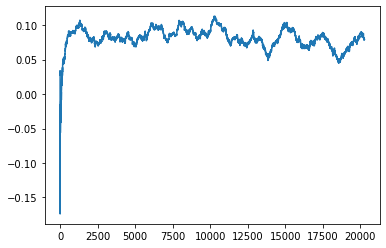

Thread: 2 iteration: 3360
RAM mBackground_10 FROM: 320 --> 704 reward: -0.32050006227343747
Thread: 3 iteration: 3396
RAM mDiffFit_36 FROM: 1472 --> 192 reward: 0.31772393828124995
Thread: 4 iteration: 3359
RAM mDiffFit_280 FROM: 3008 --> 320 reward: 0.103835776171875
Thread: 6 iteration: 3408
RAM mBackground_3 FROM: 1920 --> 704 reward: 0.1008640542265625
Thread: 5 iteration: 3445
RAM mDiffFit_271 FROM: 2176 --> 512 reward: 0.06524995625
Thread: 2 iteration: 3361
RAM mDiffFit_265 FROM: 2368 --> 1344 reward: 0.016348938281249992
Thread: 6 iteration: 3409
RAM mDiffFit_141 FROM: 1536 --> 320 reward: 0.15298696914062498
Thread: 5 iteration: 3446
RAM mBackground_9 FROM: 896 --> 256 reward: 0.43675902957812496
Thread: 3 iteration: 3397
RAM mProject_16 FROM: 384 --> 256 reward: -1.0
Saving ...


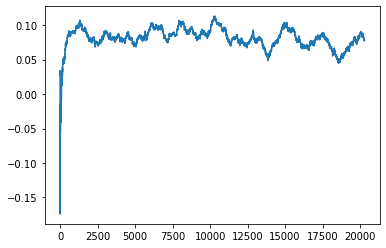

Thread: 1 iteration: 3310
RAM mDiffFit_406 FROM: 256 --> 768 reward: -0.1184166375
Thread: 2 iteration: 3362
RAM mDiffFit_267 FROM: 192 --> 1920 reward: -0.323507809765625
Thread: 5 iteration: 3447
RAM mDiffFit_227 FROM: 2688 --> 1920 reward: 0.06310942421875002
Thread: 3 iteration: 3398
RAM mDiffFit_114 FROM: 3008 --> 1920 reward: -0.07490637031249997
Thread: 5 iteration: 3448
RAM mDiffFit_401 FROM: 1728 --> 384 reward: 0.134367190234375
Thread: 3 iteration: 3399
RAM mProject_90 FROM: 256 --> 704 reward: -1.0
Saving ...


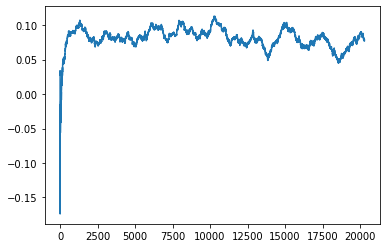

Thread: 4 iteration: 3360
RAM mDiffFit_104 FROM: 2688 --> 320 reward: 0.12613276601562504
Saving ...


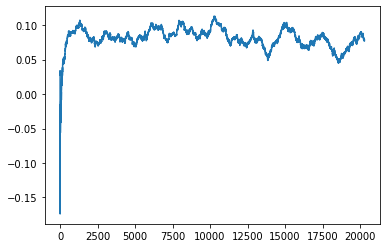

Thread: 3 iteration: 3400
RAM mDiffFit_356 FROM: 1408 --> 2048 reward: 0.013354203124999985
Thread: 4 iteration: 3361
RAM mProject_64 FROM: 1408 --> 1152 reward: 0.11547564665625004
Saving ...


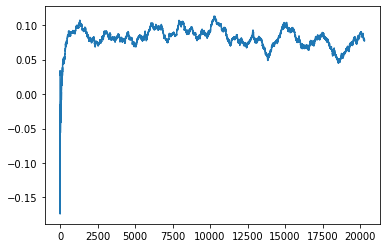

Thread: 6 iteration: 3410
RAM mProject_17 FROM: 2944 --> 2624 reward: -0.03345289551562508
Thread: 1 iteration: 3311
RAM mBackground_10 FROM: 1472 --> 256 reward: 0.5176818902421875
Thread: 3 iteration: 3401
RAM mDiffFit_26 FROM: 2816 --> 1024 reward: -0.00295840625
Thread: 1 iteration: 3312
RAM mDiffFit_246 FROM: 2688 --> 704 reward: 0.010791593750000012
Thread: 4 iteration: 3362
RAM mViewer_3 FROM: 1792 --> 512 reward: 0.27136314665625
Thread: 6 iteration: 3411
RAM mProject_57 FROM: 2048 --> 320 reward: -1.0
Thread: 2 iteration: 3363
RAM mDiffFit_389 FROM: 384 --> 704 reward: -0.14088280976562506
Thread: 3 iteration: 3402
RAM mProject_10 FROM: 448 --> 320 reward: -1.0
Thread: 5 iteration: 3449
RAM mBackground_2 FROM: 1856 --> 1984 reward: -0.02751554748437498
Thread: 4 iteration: 3363
RAM mDiffFit_201 FROM: 1792 --> 1088 reward: 0.004057257031250018
Thread: 2 iteration: 3364
RAM mDiffFit_104 FROM: 320 --> 512 reward: -0.019643208203125005
Thread: 6 iteration: 3412
RAM mProject_50 FRO

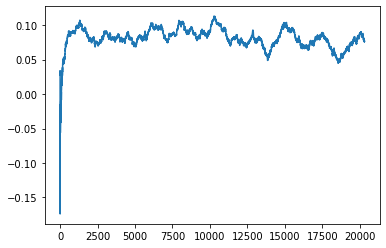

Thread: 5 iteration: 3450
RAM mDiffFit_79 FROM: 1600 --> 2048 reward: -0.06516931367187503
Thread: 1 iteration: 3314
RAM mDiffFit_168 FROM: 128 --> 2048 reward: -0.73721353984375
Thread: 5 iteration: 3451
RAM mDiffFit_411 FROM: 576 --> 1728 reward: 0.04500798476562505
Thread: 2 iteration: 3366
RAM mProject_20 FROM: 1600 --> 320 reward: -1.0
Thread: 3 iteration: 3403
RAM mDiffFit_215 FROM: 2752 --> 1920 reward: -0.019822964062500004
Thread: 1 iteration: 3315
RAM mDiffFit_199 FROM: 1920 --> 1984 reward: 0.033744822656249986
Thread: 5 iteration: 3452
RAM mDiffFit_3 FROM: 640 --> 2048 reward: -0.10613539843749999
Thread: 3 iteration: 3404
RAM mProject_25 FROM: 2624 --> 1344 reward: -0.17083024192968763
Thread: 4 iteration: 3365
RAM mProject_25 FROM: 960 --> 320 reward: -1.0
Thread: 6 iteration: 3413
RAM mProject_10 FROM: 832 --> 1920 reward: 0.64907505421875
Thread: 2 iteration: 3367
RAM mDiffFit_190 FROM: 2432 --> 320 reward: 0.16439838554687503
Thread: 1 iteration: 3316
RAM mDiffFit_385 

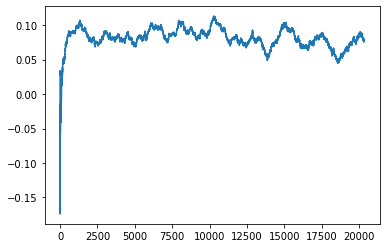

Thread: 2 iteration: 3370
RAM mProject_78 FROM: 1152 --> 2048 reward: -0.1136436463124999
Thread: 1 iteration: 3318
RAM mDiffFit_308 FROM: 1472 --> 2048 reward: 0.00640628281249998
Thread: 5 iteration: 3459
RAM mBackground_84 FROM: 1984 --> 2048 reward: 0.026673470421874994
Thread: 2 iteration: 3371
RAM mDiffFit_125 FROM: 2368 --> 2496 reward: 0.12607827265625
Saving ...


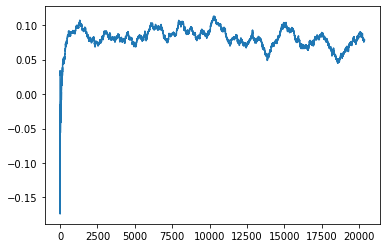

Thread: 4 iteration: 3370
RAM mBackground_42 FROM: 768 --> 2688 reward: -1.0
Thread: 6 iteration: 3418
RAM mDiffFit_208 FROM: 576 --> 2048 reward: -0.011252544921875
Thread: 1 iteration: 3319
RAM mDiffFit_388 FROM: 1024 --> 2176 reward: 0.06480738828124999
Thread: 2 iteration: 3372
RAM mDiffFit_291 FROM: 1984 --> 1408 reward: 0.06354168125000001
Saving ...


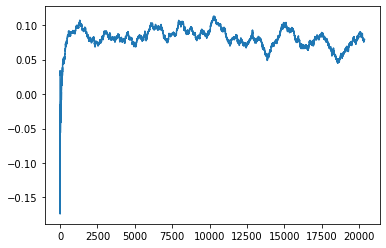

Thread: 5 iteration: 3460
RAM mDiffFit_135 FROM: 1344 --> 1920 reward: -0.024882809765625
Thread: 6 iteration: 3419
RAM mDiffFit_389 FROM: 1152 --> 2048 reward: -0.008572876562500005
Saving ...


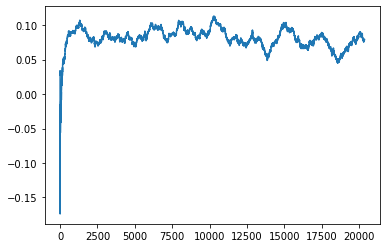

Thread: 1 iteration: 3320
RAM mProject_71 FROM: 1792 --> 192 reward: -1.0
Thread: 3 iteration: 3409
RAM mDiffFit_281 FROM: 1280 --> 192 reward: 0.4367448226562501
Thread: 1 iteration: 3321
RAM mProject_11 FROM: 1344 --> 1152 reward: 0.07922250787499997
Thread: 4 iteration: 3371
RAM mProject_52 FROM: 384 --> 2048 reward: 0.6725482245
Thread: 2 iteration: 3373
RAM mProject_28 FROM: 960 --> 2048 reward: -0.187543936828125
Thread: 5 iteration: 3461
RAM mDiffFit_101 FROM: 1536 --> 1920 reward: -0.06262504375
Saving ...


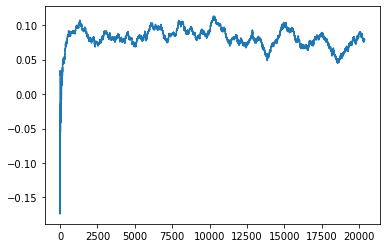

Thread: 3 iteration: 3410
RAM mDiffFit_166 FROM: 1408 --> 2240 reward: -0.001377588671875006
Thread: 1 iteration: 3322
RAM mDiffFit_267 FROM: 960 --> 2048 reward: 0.016278694140624984
Thread: 2 iteration: 3374
RAM mDiffFit_247 FROM: 2432 --> 1024 reward: 0.026270796875000006
Thread: 4 iteration: 3372
RAM mDiffFit_335 FROM: 3008 --> 640 reward: 0.07088535468749999
Thread: 5 iteration: 3462
RAM mAdd_1 FROM: 2240 --> 1920 reward: 0.043134125976562535
Thread: 3 iteration: 3411
RAM mProject_17 FROM: 2816 --> 320 reward: -1.0
Saving ...


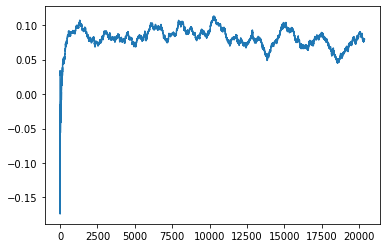

Thread: 6 iteration: 3420
RAM mBackground_68 FROM: 2816 --> 704 reward: 0.05847086921874994
Thread: 1 iteration: 3323
RAM mDiffFit_421 FROM: 2112 --> 2176 reward: -0.050880264843749995
Thread: 2 iteration: 3375
RAM mDiffFit_43 FROM: 1280 --> 1344 reward: 0.039963583593750004
Thread: 4 iteration: 3373
RAM mDiffFit_118 FROM: 1344 --> 2048 reward: 0.020802123437500004
Thread: 6 iteration: 3421
RAM mDiffFit_357 FROM: 2176 --> 1920 reward: -0.07857822890625002
Thread: 3 iteration: 3412
RAM mDiffFit_108 FROM: 2048 --> 192 reward: 0.23194528789062496
Thread: 5 iteration: 3463
RAM mDiffFit_129 FROM: 1152 --> 2048 reward: 0.04247402578125
Thread: 5 iteration: 3464
RAM mDiffFit_28 FROM: 2752 --> 192 reward: 0.2199061953125
Thread: 2 iteration: 3376
RAM mDiffFit_219 FROM: 2560 --> 320 reward: 0.07883064257812501
Thread: 6 iteration: 3422
RAM mBackground_74 FROM: 2432 --> 1088 reward: 0.330764217703125
Thread: 4 iteration: 3374
RAM mBackground_14 FROM: 2304 --> 256 reward: 0.5153100985937501
Threa

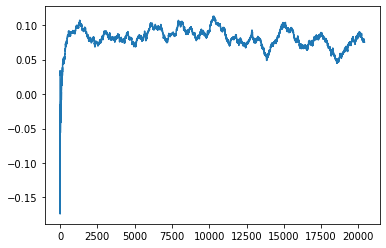

Thread: 1 iteration: 3330
RAM mDiffFit_360 FROM: 832 --> 192 reward: 0.562705773828125
Thread: 6 iteration: 3427
RAM mDiffFit_213 FROM: 2624 --> 448 reward: 0.136507722265625
Saving ...


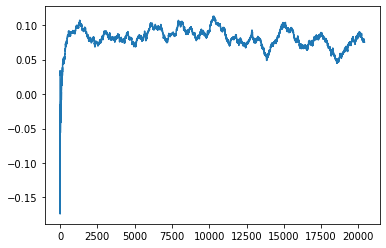

Thread: 2 iteration: 3380
RAM mBackground_68 FROM: 2240 --> 1024 reward: -0.008125324343749992
Thread: 5 iteration: 3468
RAM mDiffFit_252 FROM: 2432 --> 192 reward: 0.9144765707031249
Saving ...


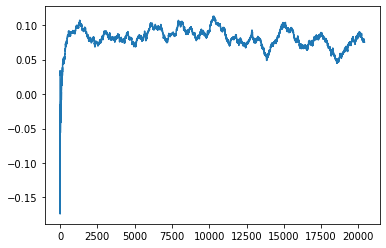

Thread: 4 iteration: 3380
RAM mDiffFit_287 FROM: 1856 --> 2048 reward: 0.005476570703125006
Thread: 4 iteration: 3381
RAM mDiffFit_142 FROM: 1024 --> 256 reward: 0.1819270796875
Thread: 5 iteration: 3469
RAM mDiffFit_402 FROM: 2304 --> 2048 reward: 0.0278646015625
Thread: 4 iteration: 3382
RAM mDiffFit_214 FROM: 384 --> 1280 reward: -0.11256247812500002
Saving ...


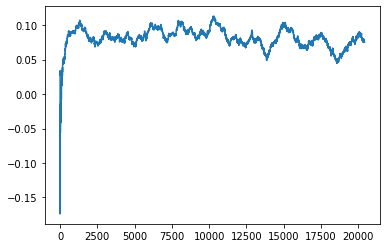

Thread: 5 iteration: 3470
RAM mDiffFit_404 FROM: 704 --> 2048 reward: -0.065867190234375
Thread: 5 iteration: 3471
RAM mDiffFit_35 FROM: 2944 --> 2048 reward: 0.0015676992187499926
Thread: 5 iteration: 3472
RAM mProject_1 FROM: 1728 --> 1280 reward: 0.12696095292187512
Thread: 1 iteration: 3331
RAM mDiffFit_9 FROM: 1984 --> 448 reward: 0.16515887148437502
Thread: 5 iteration: 3473
RAM mBackground_52 FROM: 1088 --> 1984 reward: -1.0
Thread: 2 iteration: 3381
RAM mBackground_38 FROM: 448 --> 192 reward: -1.0
Thread: 3 iteration: 3417
RAM mDiffFit_148 FROM: 448 --> 192 reward: 0.37799223398437504
Thread: 1 iteration: 3332
RAM mDiffFit_88 FROM: 2816 --> 1088 reward: 0.029283783984375006
Thread: 2 iteration: 3382
RAM mDiffFit_222 FROM: 448 --> 448 reward: -0.04794533164062503
Thread: 1 iteration: 3333
RAM mDiffFit_191 FROM: 960 --> 192 reward: 0.30209376093750007
Thread: 5 iteration: 3474
RAM mProject_84 FROM: 2432 --> 256 reward: -1.0
Thread: 4 iteration: 3383
RAM mDiffFit_130 FROM: 2816 -

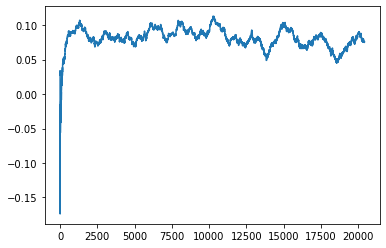

Thread: 3 iteration: 3420
RAM mDiffFit_51 FROM: 1536 --> 192 reward: 0.08504677109375
Thread: 1 iteration: 3335
RAM mDiffFit_115 FROM: 2176 --> 192 reward: 0.07364829804687498
Thread: 6 iteration: 3429
RAM mViewer_1 FROM: 128 --> 192 reward: 0.7580514088125001
Thread: 4 iteration: 3385
RAM mDiffFit_9 FROM: 3008 --> 1280 reward: -0.005989645312500028
Thread: 5 iteration: 3477
RAM mDiffFit_54 FROM: 2688 --> 1280 reward: 0.04550522109374998
Thread: 2 iteration: 3385
RAM mDiffFit_416 FROM: 2432 --> 2048 reward: -0.011046902343750005
Thread: 1 iteration: 3336
RAM mDiffFit_108 FROM: 960 --> 1280 reward: -0.045114601562499995
Saving ...


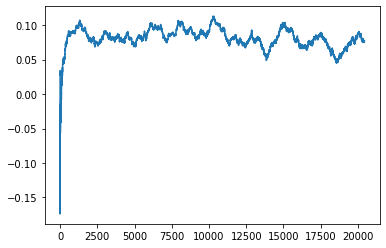

Thread: 6 iteration: 3430
RAM mDiffFit_308 FROM: 2304 --> 2048 reward: -0.0024687609374999912
Thread: 4 iteration: 3386
RAM mDiffFit_292 FROM: 512 --> 448 reward: -0.0577083625
Thread: 3 iteration: 3421
RAM mDiffFit_34 FROM: 1600 --> 512 reward: 0.18005730078124998
Thread: 5 iteration: 3478
RAM mDiffFit_398 FROM: 2880 --> 2880 reward: 0.09902356054687499
Thread: 2 iteration: 3386
RAM mDiffFit_341 FROM: 2560 --> 1280 reward: -0.0180938046875
Thread: 3 iteration: 3422
RAM mDiffFit_252 FROM: 2688 --> 448 reward: 0.15709889453125
Thread: 6 iteration: 3431
RAM mDiffFit_344 FROM: 576 --> 256 reward: 0.1882396015625
Thread: 4 iteration: 3387
RAM mBackground_30 FROM: 384 --> 1920 reward: -0.3634708951718749
Thread: 2 iteration: 3387
RAM mDiffFit_75 FROM: 2624 --> 2240 reward: -0.009953141406250001
Thread: 3 iteration: 3423
RAM mDiffFit_304 FROM: 448 --> 2048 reward: -0.03400254492187501
Thread: 4 iteration: 3388
RAM mBackground_27 FROM: 2432 --> 512 reward: 0.17829310845312502
Thread: 6 iterat

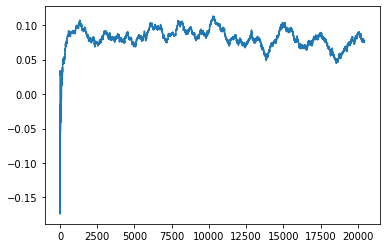

Thread: 5 iteration: 3480
RAM mDiffFit_123 FROM: 448 --> 2048 reward: -0.06096090742187499
Thread: 2 iteration: 3389
RAM mProject_37 FROM: 2112 --> 1280 reward: 0.09451350499218764
Thread: 6 iteration: 3433
RAM mProject_73 FROM: 384 --> 1280 reward: 0.37900737309374993
Thread: 3 iteration: 3425
RAM mProject_24 FROM: 1152 --> 1152 reward: 0.005743130906249894
Saving ...


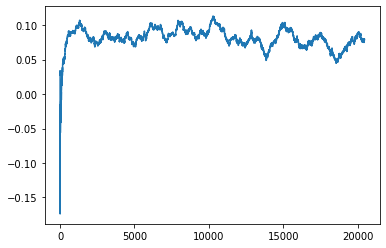

Thread: 4 iteration: 3390
RAM mProject_1 FROM: 2176 --> 1280 reward: 0.056247054609375
Saving ...


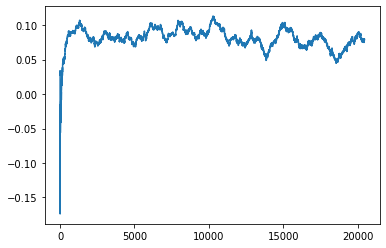

Thread: 2 iteration: 3390
RAM mProject_55 FROM: 320 --> 1344 reward: 0.7254442242421876
Thread: 6 iteration: 3434
RAM mBackground_52 FROM: 2304 --> 1088 reward: -1.0
Thread: 1 iteration: 3338
RAM mProject_3 FROM: 1536 --> 192 reward: -1.0
Thread: 5 iteration: 3481
RAM mDiffFit_366 FROM: 192 --> 1920 reward: -0.19989057578125002
Thread: 2 iteration: 3391
RAM mBackground_18 FROM: 1024 --> 448 reward: 0.22920343279687508
Thread: 4 iteration: 3391
RAM mDiffFit_381 FROM: 2432 --> 2624 reward: 0.008828141406250004
Thread: 6 iteration: 3435
RAM mDiffFit_175 FROM: 2496 --> 2688 reward: 0.04246880468750002
Thread: 1 iteration: 3339
RAM mDiffFit_318 FROM: 192 --> 704 reward: -0.17617444726562498
Thread: 2 iteration: 3392
RAM mDiffFit_320 FROM: 640 --> 384 reward: 0.24948964531250004
Thread: 4 iteration: 3392
RAM mDiffFit_167 FROM: 192 --> 1984 reward: -0.1744687171875
Thread: 6 iteration: 3436
RAM mBackground_61 FROM: 512 --> 2496 reward: 0.30285474184375
Saving ...


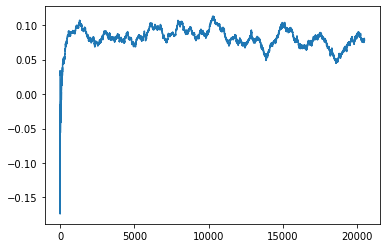

Thread: 1 iteration: 3340
RAM mDiffFit_45 FROM: 2368 --> 2048 reward: -0.0336979640625
Thread: 4 iteration: 3393
RAM mProject_67 FROM: 1664 --> 192 reward: -1.0
Thread: 3 iteration: 3426
RAM mDiffFit_265 FROM: 1600 --> 704 reward: 0.08031252187500001
Thread: 2 iteration: 3393
RAM mBackground_40 FROM: 960 --> 1280 reward: -1.0
Thread: 5 iteration: 3482
RAM mDiffFit_210 FROM: 2304 --> 256 reward: 0.20108323125000005
Thread: 6 iteration: 3437
RAM mDiffFit_412 FROM: 704 --> 1088 reward: -0.11904431367187499
Thread: 3 iteration: 3427
RAM mDiffFit_328 FROM: 1216 --> 192 reward: 0.5296640488281251
Thread: 4 iteration: 3394
RAM mDiffFit_222 FROM: 2624 --> 2048 reward: -0.08277614921875004
Thread: 2 iteration: 3394
RAM mBackground_28 FROM: 2240 --> 192 reward: 0.9223320394375
Thread: 1 iteration: 3341
RAM mDiffFit_360 FROM: 384 --> 1088 reward: -0.059190066796874996
Thread: 1 iteration: 3342
RAM mDiffFit_280 FROM: 768 --> 192 reward: 0.36993752187500006
Thread: 6 iteration: 3438
RAM mDiffFit_14

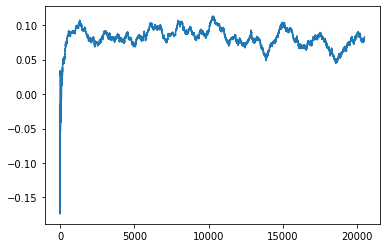

Thread: 3 iteration: 3430
RAM mDiffFit_75 FROM: 384 --> 2944 reward: -0.004619647656249996
Thread: 1 iteration: 3345
RAM mDiffFit_368 FROM: 1344 --> 192 reward: 0.334351570703125
Saving ...


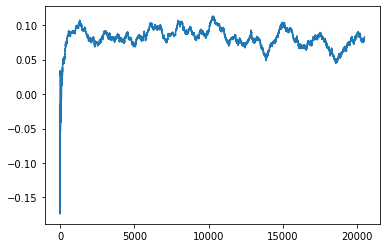

Thread: 6 iteration: 3440
RAM mProject_49 FROM: 1024 --> 384 reward: -1.0
Thread: 5 iteration: 3483
RAM mDiffFit_273 FROM: 2560 --> 192 reward: 0.24024995625000004
Thread: 4 iteration: 3396
RAM mProject_88 FROM: 1984 --> 192 reward: -1.0
Thread: 2 iteration: 3395
RAM mDiffFit_284 FROM: 1536 --> 512 reward: 0.11797915937500003
Thread: 3 iteration: 3431
RAM mBackground_15 FROM: 1344 --> 2240 reward: -0.05954601971874998
Thread: 1 iteration: 3346
RAM mDiffFit_62 FROM: 192 --> 2048 reward: -0.266830686328125
Thread: 5 iteration: 3484
RAM mDiffFit_244 FROM: 512 --> 2176 reward: -0.03357801015625002
Thread: 6 iteration: 3441
RAM mDiffFit_30 FROM: 2816 --> 2048 reward: 0.005302079687499999
Thread: 2 iteration: 3396
RAM mDiffFit_347 FROM: 2624 --> 256 reward: 0.12982283281249996
Thread: 4 iteration: 3397
RAM mBackground_30 FROM: 1408 --> 2048 reward: 0.016752152312500015
Thread: 1 iteration: 3347
RAM mDiffFit_404 FROM: 2048 --> 448 reward: 0.13691146015625003
Thread: 4 iteration: 3398
RAM mBac

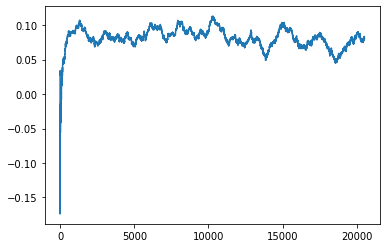

Thread: 4 iteration: 3400
RAM mDiffFit_106 FROM: 768 --> 448 reward: 0.06024999999999999
Thread: 5 iteration: 3486
RAM mProject_49 FROM: 832 --> 2048 reward: 0.67555572975
Thread: 1 iteration: 3348
RAM mBackground_38 FROM: 1088 --> 832 reward: -1.0
Thread: 3 iteration: 3432
RAM mDiffFit_394 FROM: 448 --> 256 reward: 0.11873438046875001
Thread: 6 iteration: 3445
RAM mDiffFit_71 FROM: 1856 --> 1280 reward: 0.03232292031249999
Thread: 4 iteration: 3401
RAM mDiffFit_73 FROM: 2560 --> 2048 reward: 0.018270840624999996
Thread: 1 iteration: 3349
RAM mDiffFit_312 FROM: 448 --> 192 reward: 0.49037767617187505
Thread: 5 iteration: 3487
RAM mImgtbl_3 FROM: 1088 --> 192 reward: -1.0
Thread: 2 iteration: 3397
RAM mDiffFit_330 FROM: 2816 --> 2048 reward: 0.009427079687499996
Thread: 6 iteration: 3446
RAM mDiffFit_74 FROM: 704 --> 2048 reward: -0.02395309765624999
Saving ...


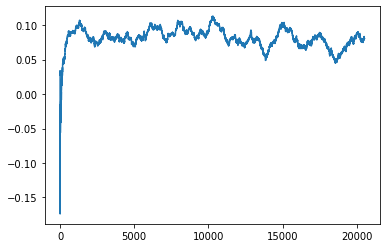

Thread: 1 iteration: 3350
RAM mProject_7 FROM: 2432 --> 2048 reward: -0.059389811859375
Thread: 3 iteration: 3433
RAM mDiffFit_300 FROM: 2240 --> 2048 reward: -0.024052123437499993
Thread: 2 iteration: 3398
RAM mImgtbl_3 FROM: 2816 --> 2048 reward: 0.01176661999999995
Thread: 1 iteration: 3351
RAM mDiffFit_44 FROM: 1600 --> 192 reward: 0.24413794335937503
Thread: 5 iteration: 3488
RAM mDiffFit_163 FROM: 1280 --> 2048 reward: 0.04258340625000001
Thread: 2 iteration: 3399
RAM mDiffFit_110 FROM: 2240 --> 192 reward: 0.233627544921875
Thread: 3 iteration: 3434
RAM mProject_30 FROM: 1536 --> 2048 reward: 0.016983866812500126
Thread: 6 iteration: 3447
RAM mDiffFit_184 FROM: 1984 --> 2048 reward: 0.15549236523437504
Thread: 3 iteration: 3435
RAM mViewer_1 FROM: 1856 --> 256 reward: 0.4358405792812499
Thread: 1 iteration: 3352
RAM mDiffFit_39 FROM: 512 --> 2048 reward: -0.035854115625
Thread: 6 iteration: 3448
RAM mDiffFit_327 FROM: 256 --> 192 reward: 0.08025000000000002
Thread: 3 iteration: 

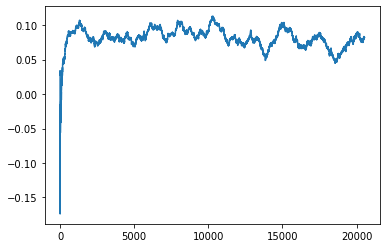

Thread: 2 iteration: 3400
RAM mBackground_37 FROM: 192 --> 192 reward: -1.0
Thread: 4 iteration: 3402
RAM mDiffFit_159 FROM: 2240 --> 2048 reward: 0.019356791796875
Thread: 3 iteration: 3438
RAM mDiffFit_14 FROM: 640 --> 2048 reward: -0.006192655468749992
Saving ...


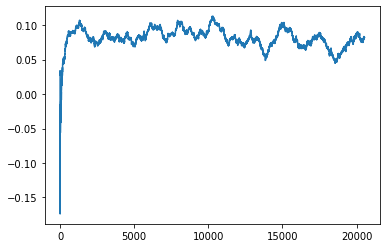

Thread: 5 iteration: 3490
RAM mDiffFit_142 FROM: 1664 --> 2048 reward: 0.137104334375
Saving ...


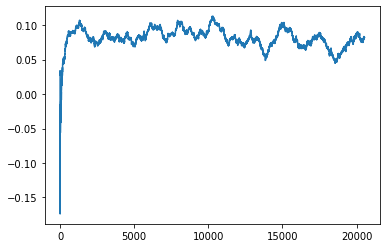

Thread: 6 iteration: 3450
RAM mProject_4 FROM: 832 --> 2048 reward: -0.28106098136718743
Thread: 1 iteration: 3354
RAM mDiffFit_184 FROM: 1856 --> 2048 reward: 0.010351570703125016
Thread: 4 iteration: 3403
RAM mDiffFit_248 FROM: 1024 --> 2048 reward: -0.05516668125
Thread: 6 iteration: 3451
RAM mImgtbl_3 FROM: 448 --> 2048 reward: -0.4936228853125001
Thread: 4 iteration: 3404
RAM mDiffFit_327 FROM: 2176 --> 2048 reward: -0.019515663281250012
Thread: 6 iteration: 3452
RAM mProject_37 FROM: 2752 --> 2048 reward: -0.07383394293750016
Thread: 5 iteration: 3491
RAM mProject_66 FROM: 1088 --> 2048 reward: -0.09040484249999989
Thread: 3 iteration: 3439
RAM mProject_59 FROM: 2240 --> 2048 reward: -0.039061010671874986
Thread: 1 iteration: 3355
RAM mBackground_50 FROM: 2368 --> 2048 reward: -1.0
Thread: 2 iteration: 3401
RAM mBackground_2 FROM: 320 --> 2048 reward: -0.33120738712500003
Thread: 6 iteration: 3453
RAM mDiffFit_68 FROM: 1280 --> 832 reward: 0.006637987109375
Saving ...


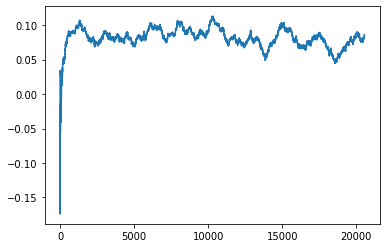

Thread: 3 iteration: 3440
RAM mDiffFit_15 FROM: 832 --> 512 reward: 0.034486969140625004
Thread: 1 iteration: 3356
RAM mProject_87 FROM: 1600 --> 2048 reward: 0.024333856312500044
Thread: 4 iteration: 3405
RAM mProject_34 FROM: 2688 --> 2048 reward: -0.09765770737499996
Thread: 5 iteration: 3492
RAM mDiffFit_337 FROM: 320 --> 2048 reward: -0.3190155757812499
Thread: 4 iteration: 3406
RAM mDiffFit_268 FROM: 2496 --> 192 reward: 0.26585152695312503
Thread: 1 iteration: 3357
RAM mDiffFit_284 FROM: 128 --> 1280 reward: -0.8606354421875
Thread: 5 iteration: 3493
RAM mDiffFit_75 FROM: 1344 --> 2048 reward: 0.003981791796874995
Thread: 4 iteration: 3407
RAM mDiffFit_325 FROM: 960 --> 2048 reward: 0.00503128281250001
Thread: 1 iteration: 3358
RAM mBackground_49 FROM: 512 --> 1920 reward: -1.0
Thread: 2 iteration: 3402
RAM mProject_69 FROM: 1664 --> 1920 reward: 0.001359421593749921
Thread: 6 iteration: 3454
RAM mProject_61 FROM: 448 --> 2048 reward: 0.6615607139999999
Thread: 3 iteration: 3441

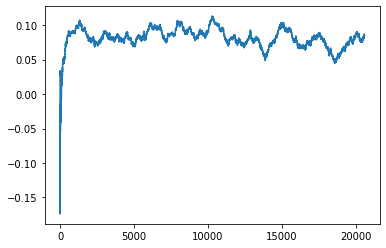

Thread: 1 iteration: 3360
RAM mDiffFit_116 FROM: 2240 --> 2048 reward: -0.028677123437500004
Thread: 2 iteration: 3404
RAM mDiffFit_353 FROM: 1280 --> 2048 reward: -0.003614557812500023
Thread: 6 iteration: 3456
RAM mDiffFit_55 FROM: 2112 --> 2048 reward: 0.016716172265625
Thread: 5 iteration: 3495
RAM mDiffFit_81 FROM: 1792 --> 2048 reward: 0.015166681249999987
Thread: 3 iteration: 3443
RAM mDiffFit_47 FROM: 192 --> 192 reward: -0.04397657070312498
Saving ...


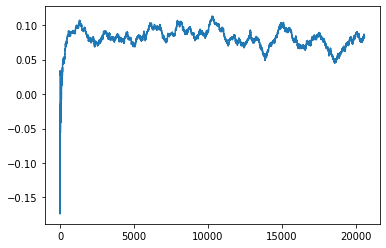

Thread: 4 iteration: 3410
RAM mDiffFit_359 FROM: 1792 --> 2048 reward: 0.0223021234375
Thread: 5 iteration: 3496
RAM mDiffFit_362 FROM: 2112 --> 448 reward: 0.10072393828125
Thread: 6 iteration: 3457
RAM mDiffFit_34 FROM: 1792 --> 2048 reward: 0.015812521875000016
Thread: 3 iteration: 3444
RAM mDiffFit_265 FROM: 2752 --> 192 reward: 0.281242146484375
Thread: 2 iteration: 3405
RAM mDiffFit_94 FROM: 2944 --> 2048 reward: -0.008192742968749986
Thread: 4 iteration: 3411
RAM mDiffFit_46 FROM: 2496 --> 2048 reward: -0.00557033164062499
Thread: 5 iteration: 3497
RAM mDiffFit_85 FROM: 2496 --> 2048 reward: 0.014388030859375008
Thread: 6 iteration: 3458
RAM mDiffFit_139 FROM: 1984 --> 2048 reward: 0.04902610546875002
Thread: 2 iteration: 3406
RAM mViewer_3 FROM: 1728 --> 2048 reward: -0.017500308890624997
Thread: 3 iteration: 3445
RAM mBackground_52 FROM: 1152 --> 2048 reward: -1.0
Thread: 1 iteration: 3361
RAM mDiffFit_122 FROM: 2560 --> 2048 reward: -0.007208362500000006
Thread: 4 iteration: 

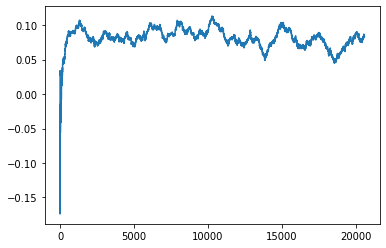

Thread: 6 iteration: 3460
RAM mViewer_2 FROM: 2304 --> 2048 reward: -0.014898156281249986
Saving ...


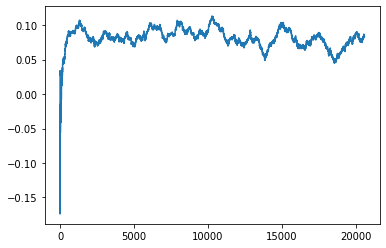

Thread: 5 iteration: 3500
RAM mDiffFit_194 FROM: 2752 --> 2048 reward: 0.034502632421875026
Thread: 2 iteration: 3409
RAM mProject_71 FROM: 1472 --> 2048 reward: -0.016483497117187582
Thread: 3 iteration: 3447
RAM mBackground_59 FROM: 2624 --> 832 reward: -1.0
Thread: 1 iteration: 3362
RAM mBackground_47 FROM: 2496 --> 2048 reward: -1.0
Thread: 4 iteration: 3413
RAM mDiffFit_211 FROM: 2112 --> 2048 reward: -0.0128229203125
Thread: 6 iteration: 3461
RAM mDiffFit_289 FROM: 2752 --> 2048 reward: -0.008414092578124983
Saving ...


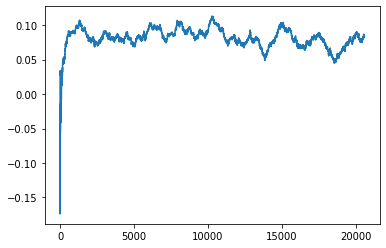

Thread: 2 iteration: 3410
RAM mDiffFit_413 FROM: 1024 --> 2048 reward: 0.015500043750000005
Thread: 1 iteration: 3363
RAM mDiffFit_113 FROM: 2112 --> 2048 reward: -0.083476658203125
Thread: 3 iteration: 3448
RAM mDiffFit_344 FROM: 704 --> 2048 reward: -0.04440882773437498
Thread: 6 iteration: 3462
RAM mDiffFit_239 FROM: 1664 --> 2048 reward: 0.01664066328124998
Thread: 4 iteration: 3414
RAM mDiffFit_162 FROM: 1600 --> 2048 reward: -0.0073828097656250015
Thread: 1 iteration: 3364
RAM mBackground_42 FROM: 3008 --> 2048 reward: -1.0
Thread: 5 iteration: 3501
RAM mProject_32 FROM: 3008 --> 2048 reward: -0.17219658993750003
Thread: 2 iteration: 3411
RAM mDiffFit_212 FROM: 2688 --> 2048 reward: 0.012161460156250008
Thread: 6 iteration: 3463
RAM mDiffFit_246 FROM: 256 --> 2048 reward: -0.19501035468750005
Thread: 1 iteration: 3365
RAM mDiffFit_414 FROM: 896 --> 2048 reward: 0.012057344531249993
Thread: 2 iteration: 3412
RAM mProject_71 FROM: 2560 --> 2048 reward: -0.09126018112500003
Thread: 

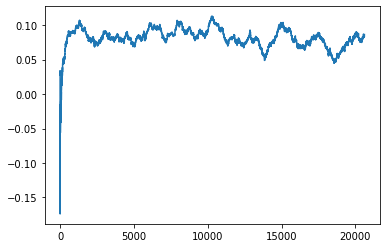

Thread: 3 iteration: 3450
RAM mDiffFit_344 FROM: 2624 --> 2048 reward: -0.09760951171875001
Thread: 1 iteration: 3367
RAM mDiffFit_139 FROM: 128 --> 2048 reward: -0.9506405757812502
Thread: 5 iteration: 3503
RAM mDiffFit_370 FROM: 448 --> 2048 reward: -0.05781765546874999
Thread: 2 iteration: 3414
RAM mDiffFit_239 FROM: 1088 --> 2048 reward: -0.01514057578125002
Thread: 4 iteration: 3417
RAM mDiffFit_4 FROM: 1472 --> 2048 reward: -0.010427079687500007
Thread: 3 iteration: 3451
RAM mDiffFit_200 FROM: 2752 --> 2048 reward: -0.03109121601562497
Thread: 5 iteration: 3504
RAM mProject_4 FROM: 1280 --> 192 reward: -1.0
Thread: 6 iteration: 3465
RAM mDiffFit_330 FROM: 448 --> 2048 reward: -0.03700254492187499
Thread: 3 iteration: 3452
RAM mDiffFit_202 FROM: 3008 --> 2048 reward: -0.045802167187500006
Thread: 5 iteration: 3505
RAM mBackground_74 FROM: 256 --> 2048 reward: -0.62006890503125
Thread: 4 iteration: 3418
RAM mDiffFit_30 FROM: 1664 --> 2048 reward: -0.009536460156250003
Thread: 4 ite

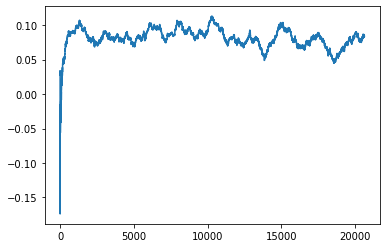

Thread: 4 iteration: 3420
RAM mProject_50 FROM: 1920 --> 2048 reward: 0.017614727859375057
Thread: 2 iteration: 3416
RAM mDiffFit_74 FROM: 1856 --> 448 reward: 0.033346305859374994
Thread: 3 iteration: 3455
RAM mDiffFit_266 FROM: 1536 --> 2048 reward: -0.014749999999999971
Thread: 6 iteration: 3468
RAM mDiffFit_418 FROM: 1792 --> 768 reward: 0.16853132656249997
Saving ...


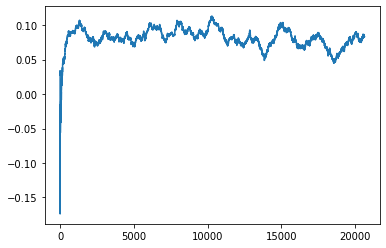

Thread: 1 iteration: 3370
RAM mDiffFit_355 FROM: 256 --> 1280 reward: -0.4343333187499999
Thread: 1 iteration: 3371
RAM mDiffFit_47 FROM: 2304 --> 448 reward: 0.26552869414062497
Thread: 3 iteration: 3456
RAM mDiffFit_11 FROM: 2624 --> 448 reward: 0.27169274296874996
Thread: 6 iteration: 3469
RAM mProject_28 FROM: 192 --> 448 reward: -1.0
Thread: 5 iteration: 3508
RAM mDiffFit_13 FROM: 1472 --> 448 reward: 0.03957546523437501
Thread: 1 iteration: 3372
RAM mDiffFit_234 FROM: 1600 --> 448 reward: -0.01947665820312503
Saving ...


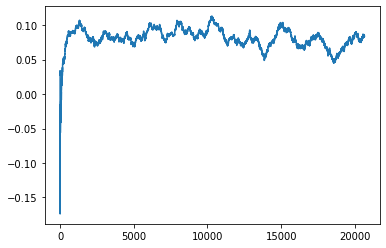

Thread: 6 iteration: 3470
RAM mDiffFit_62 FROM: 1024 --> 448 reward: 0.06141926992187499
Thread: 5 iteration: 3509
RAM mBackground_53 FROM: 448 --> 448 reward: -1.0
Thread: 4 iteration: 3421
RAM mBackground_67 FROM: 832 --> 1280 reward: -0.0900200622734375
Thread: 6 iteration: 3471
RAM mDiffFit_414 FROM: 704 --> 448 reward: 0.242979246875
Thread: 1 iteration: 3373
RAM mProject_39 FROM: 896 --> 448 reward: -1.0
Thread: 2 iteration: 3417
RAM mDiffFit_286 FROM: 1984 --> 192 reward: 0.20195309765625
Thread: 4 iteration: 3422
RAM mDiffFit_173 FROM: 1088 --> 384 reward: 0.247903694140625
Thread: 2 iteration: 3418
RAM mBackground_11 FROM: 1792 --> 448 reward: 0.21405706408593753
Thread: 1 iteration: 3374
RAM mDiffFit_20 FROM: 128 --> 2240 reward: -0.9338123468749998
Thread: 4 iteration: 3423
RAM mDiffFit_46 FROM: 1408 --> 832 reward: 0.1286146453125
Thread: 2 iteration: 3419
RAM mBackground_88 FROM: 2624 --> 448 reward: -0.11220366115625002
Thread: 1 iteration: 3375
RAM mBackground_39 FROM: 2

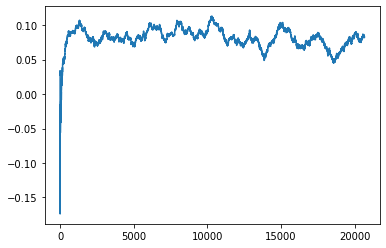

Thread: 5 iteration: 3510
RAM mProject_53 FROM: 2560 --> 832 reward: -1.0
Thread: 6 iteration: 3472
RAM mDiffFit_70 FROM: 1664 --> 448 reward: 0.057096305859375
Thread: 1 iteration: 3376
RAM mDiffFit_215 FROM: 1344 --> 1984 reward: 0.048346437109374994
Thread: 3 iteration: 3458
RAM mDiffFit_63 FROM: 2240 --> 192 reward: 0.211976526953125
Thread: 4 iteration: 3424
RAM mViewer_2 FROM: 2880 --> 1984 reward: -0.11985379286718759
Thread: 6 iteration: 3473
RAM mDiffFit_142 FROM: 256 --> 768 reward: -0.09057287656249999
Thread: 1 iteration: 3377
RAM mDiffFit_207 FROM: 2368 --> 1280 reward: -0.022864645312500025
Thread: 4 iteration: 3425
RAM mDiffFit_34 FROM: 960 --> 448 reward: 0.13500780976562501
Thread: 3 iteration: 3459
RAM mProject_85 FROM: 768 --> 448 reward: -1.0
Thread: 5 iteration: 3511
RAM mDiffFit_339 FROM: 1088 --> 1280 reward: 0.012335951171875015
Thread: 4 iteration: 3426
RAM mDiffFit_113 FROM: 2176 --> 192 reward: 0.337210776171875
Thread: 1 iteration: 3378
RAM mBackground_56 FR

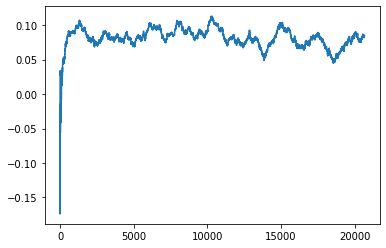

Thread: 2 iteration: 3420
RAM mDiffFit_133 FROM: 3008 --> 2624 reward: 0.042182344531250006
Thread: 5 iteration: 3512
RAM mBackground_63 FROM: 1280 --> 2880 reward: 0.07053588480468753
Thread: 4 iteration: 3427
RAM mDiffFit_114 FROM: 1600 --> 384 reward: 0.18467971210937503
Thread: 1 iteration: 3379
RAM mDiffFit_349 FROM: 2688 --> 448 reward: 0.072044226171875
Thread: 2 iteration: 3421
RAM mProject_79 FROM: 704 --> 448 reward: -1.0
Thread: 6 iteration: 3474
RAM mDiffFit_105 FROM: 128 --> 448 reward: -0.66588026484375
Thread: 5 iteration: 3513
RAM mDiffFit_317 FROM: 704 --> 256 reward: 0.09549736757812498
Thread: 4 iteration: 3428
RAM mDiffFit_95 FROM: 2496 --> 2176 reward: 0.08102351679687503
Thread: 6 iteration: 3475
RAM mDiffFit_416 FROM: 192 --> 448 reward: -0.19537499999999997
Thread: 5 iteration: 3514
RAM mBackground_10 FROM: 1280 --> 320 reward: 0.5338203606640625
Thread: 4 iteration: 3429
RAM mDiffFit_294 FROM: 1728 --> 192 reward: 0.30074999999999996
Thread: 6 iteration: 3476
R

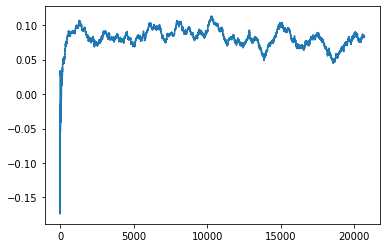

Thread: 3 iteration: 3460
RAM mDiffFit_325 FROM: 2176 --> 192 reward: 0.11701031093750001
Thread: 3 iteration: 3461
RAM mDiffFit_113 FROM: 2048 --> 320 reward: 0.390283827734375
Thread: 6 iteration: 3478
RAM mBackground_54 FROM: 1792 --> 384 reward: -1.0
Saving ...


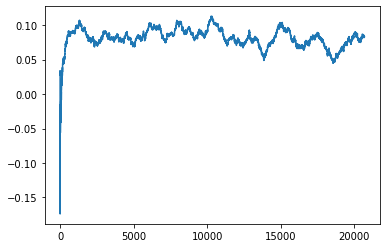

Thread: 1 iteration: 3380
RAM mDiffFit_221 FROM: 2560 --> 448 reward: 0.08477860664062503
Thread: 6 iteration: 3479
RAM mDiffFit_325 FROM: 2240 --> 192 reward: 0.190617146484375
Thread: 3 iteration: 3462
RAM mAdd_2 FROM: 1408 --> 384 reward: 0.625710819921875
Thread: 5 iteration: 3515
RAM mProject_68 FROM: 640 --> 448 reward: -1.0
Saving ...


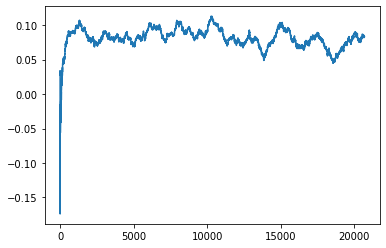

Thread: 4 iteration: 3430
RAM mProject_33 FROM: 1088 --> 192 reward: -1.0
Thread: 2 iteration: 3422
RAM mBackground_80 FROM: 2240 --> 1088 reward: 0.04714990010156247
Thread: 1 iteration: 3381
RAM mDiffFit_104 FROM: 128 --> 256 reward: -0.7076511054687498
Saving ...


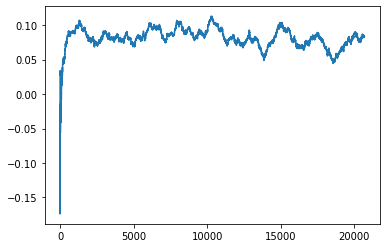

Thread: 6 iteration: 3480
RAM mDiffFit_23 FROM: 1536 --> 2624 reward: 0.030989645312500032
Thread: 3 iteration: 3463
RAM mDiffFit_382 FROM: 1728 --> 2880 reward: 0.08672670195312498
Thread: 4 iteration: 3431
RAM mDiffFit_168 FROM: 2112 --> 256 reward: 0.189893208203125
Thread: 2 iteration: 3423
RAM mBackground_1 FROM: 2944 --> 192 reward: 0.8257297249531249
Thread: 5 iteration: 3516
RAM mDiffFit_41 FROM: 1216 --> 192 reward: 0.27178646015624996
Thread: 1 iteration: 3382
RAM mDiffFit_30 FROM: 1664 --> 512 reward: 0.23558858359374996
Thread: 6 iteration: 3481
RAM mDiffFit_419 FROM: 2752 --> 256 reward: 0.36094261171875003
Thread: 3 iteration: 3464
RAM mDiffFit_357 FROM: 2944 --> 384 reward: 0.2079062390625
Thread: 5 iteration: 3517
RAM mDiffFit_140 FROM: 128 --> 832 reward: -0.7120859511718749
Thread: 6 iteration: 3482
RAM mDiffFit_52 FROM: 448 --> 320 reward: 0.3550730078125
Thread: 2 iteration: 3424
RAM mBackground_64 FROM: 2048 --> 448 reward: 0.2587345018124999
Thread: 3 iteration: 3

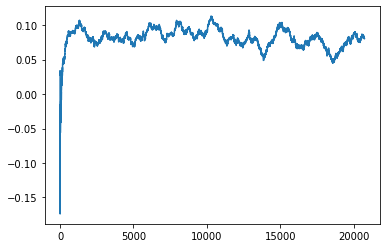

Thread: 5 iteration: 3520
RAM mDiffFit_309 FROM: 512 --> 256 reward: 0.15177084062500001
Thread: 3 iteration: 3468
RAM mDiffFit_119 FROM: 1536 --> 320 reward: 0.273591172265625
Thread: 6 iteration: 3487
RAM mDiffFit_395 FROM: 384 --> 256 reward: 0.22697920312500003
Saving ...


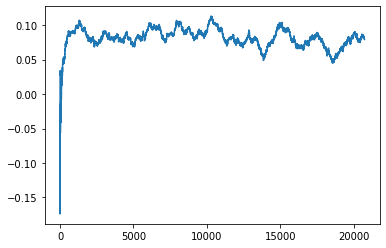

Thread: 2 iteration: 3430
RAM mDiffFit_217 FROM: 2432 --> 448 reward: -0.044010573437500006
Thread: 1 iteration: 3386
RAM mDiffFit_344 FROM: 256 --> 448 reward: -0.05508331875000001
Thread: 3 iteration: 3469
RAM mDiffFit_196 FROM: 640 --> 448 reward: 0.07100522109375002
Thread: 6 iteration: 3488
RAM mDiffFit_117 FROM: 1600 --> 768 reward: 0.06839584062500002
Thread: 1 iteration: 3387
RAM mDiffFit_35 FROM: 512 --> 384 reward: 0.2130104859375
Thread: 2 iteration: 3431
RAM mProject_53 FROM: 2240 --> 512 reward: -1.0
Thread: 4 iteration: 3435
RAM mDiffFit_392 FROM: 448 --> 448 reward: -0.040945331640624985
Thread: 6 iteration: 3489
RAM mDiffFit_150 FROM: 3008 --> 448 reward: -0.01698455546874998
Saving ...


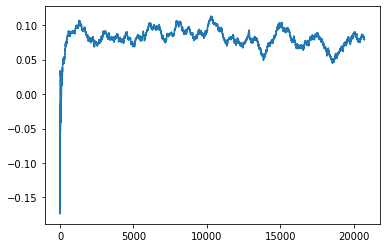

Thread: 3 iteration: 3470
RAM mDiffFit_232 FROM: 2752 --> 448 reward: 0.059361925390625014
Thread: 1 iteration: 3388
RAM mBackground_49 FROM: 3008 --> 448 reward: -1.0
Thread: 5 iteration: 3521
RAM mDiffFit_378 FROM: 384 --> 192 reward: 0.183710951171875
Thread: 2 iteration: 3432
RAM mDiffFit_250 FROM: 2880 --> 512 reward: 0.17039838554687495
Thread: 4 iteration: 3436
RAM mDiffFit_421 FROM: 704 --> 832 reward: -0.09732296406249999
Saving ...


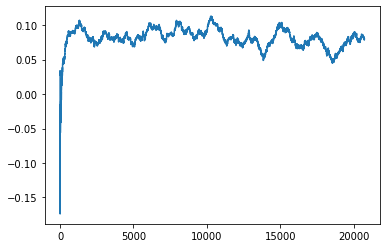

Thread: 6 iteration: 3490
RAM mDiffFit_210 FROM: 1280 --> 320 reward: 0.19819269921875
Thread: 3 iteration: 3471
RAM mDiffFit_44 FROM: 1024 --> 1280 reward: 0.010239601562500016
Thread: 2 iteration: 3433
RAM mDiffFit_239 FROM: 1920 --> 448 reward: 0.07898161679687495
Thread: 4 iteration: 3437
RAM mBackground_70 FROM: 1728 --> 320 reward: 0.4542479475859374
Thread: 1 iteration: 3389
RAM mProject_9 FROM: 1792 --> 2176 reward: 0.06445513124999996
Thread: 5 iteration: 3522
RAM mDiffFit_324 FROM: 1280 --> 448 reward: 0.03463798710937499
Thread: 3 iteration: 3472
RAM mDiffFit_263 FROM: 1600 --> 512 reward: 0.11394792031250002
Saving ...


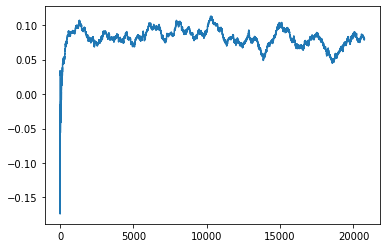

Thread: 1 iteration: 3390
RAM mDiffFit_80 FROM: 2176 --> 256 reward: 0.2435937171875
Thread: 2 iteration: 3434
RAM mBackground_15 FROM: 2496 --> 448 reward: 0.230251454328125
Thread: 4 iteration: 3438
RAM mDiffFit_64 FROM: 704 --> 1280 reward: 0.023132853515625013
Thread: 4 iteration: 3439
RAM mDiffFit_37 FROM: 3008 --> 512 reward: 0.08374214648437503
Thread: 2 iteration: 3435
RAM mDiffFit_389 FROM: 2368 --> 448 reward: 0.173950465234375
Thread: 1 iteration: 3391
RAM mDiffFit_210 FROM: 1728 --> 192 reward: 0.28332028789062497
Thread: 3 iteration: 3473
RAM mBackground_62 FROM: 128 --> 256 reward: 0.79065374546875
Thread: 5 iteration: 3523
RAM mProject_18 FROM: 2688 --> 448 reward: -1.0
Thread: 6 iteration: 3491
RAM mDiffFit_168 FROM: 2496 --> 384 reward: 0.125085907421875
Saving ...


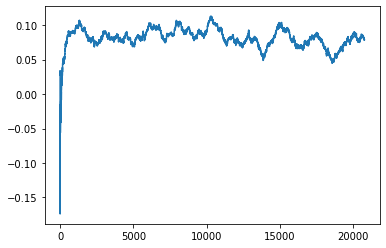

Thread: 4 iteration: 3440
RAM mDiffFit_280 FROM: 2688 --> 448 reward: 0.09285933671875002
Thread: 2 iteration: 3436
RAM mDiffFit_195 FROM: 1600 --> 1280 reward: 0.014000000000000002
Thread: 5 iteration: 3524
RAM mDiffFit_230 FROM: 3008 --> 448 reward: 0.03795305390625002
Thread: 6 iteration: 3492
RAM mDiffFit_353 FROM: 2496 --> 256 reward: 0.128770753125
Thread: 3 iteration: 3474
RAM mDiffFit_49 FROM: 1600 --> 448 reward: 0.08380203593749999
Thread: 2 iteration: 3437
RAM mDiffFit_28 FROM: 1664 --> 832 reward: 0.034625
Thread: 6 iteration: 3493
RAM mDiffFit_207 FROM: 1408 --> 384 reward: -0.19146380234374996
Thread: 3 iteration: 3475
RAM mProject_79 FROM: 1984 --> 320 reward: -1.0
Thread: 1 iteration: 3392
RAM mDiffFit_60 FROM: 128 --> 448 reward: 0.030294313671875
Thread: 2 iteration: 3438
RAM mDiffFit_224 FROM: 128 --> 448 reward: -0.6461328535156251
Thread: 3 iteration: 3476
RAM mDiffFit_405 FROM: 2048 --> 320 reward: 0.198893208203125
Thread: 6 iteration: 3494
RAM mProject_53 FROM: 

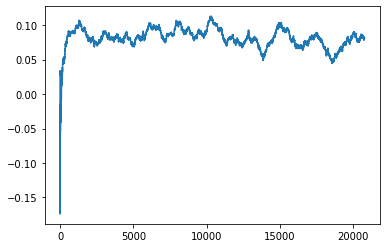

Thread: 2 iteration: 3440
RAM mProject_45 FROM: 896 --> 448 reward: -1.0
Thread: 1 iteration: 3393
RAM mDiffFit_354 FROM: 128 --> 448 reward: -0.5057005527343751
Thread: 6 iteration: 3497
RAM mDiffFit_375 FROM: 832 --> 512 reward: 0.09916926992187494
Thread: 4 iteration: 3443
RAM mDiffFit_159 FROM: 512 --> 320 reward: 0.11516668125000001
Thread: 1 iteration: 3394
RAM mBackground_10 FROM: 1408 --> 704 reward: 0.19622111961718744
Thread: 5 iteration: 3527
RAM mProject_36 FROM: 192 --> 2880 reward: 0.8076047540625001
Thread: 3 iteration: 3479
RAM mDiffFit_381 FROM: 2560 --> 448 reward: 0.05304940351562501
Thread: 6 iteration: 3498
RAM mDiffFit_288 FROM: 2176 --> 448 reward: 0.07329163749999999
Thread: 4 iteration: 3444
RAM mDiffFit_367 FROM: 768 --> 448 reward: 0.004460907421874986
Thread: 1 iteration: 3395
RAM mDiffFit_2 FROM: 2752 --> 256 reward: 0.43230721328125
Thread: 5 iteration: 3528
RAM mProject_40 FROM: 192 --> 512 reward: -1.0
Thread: 2 iteration: 3441
RAM mDiffFit_75 FROM: 2752

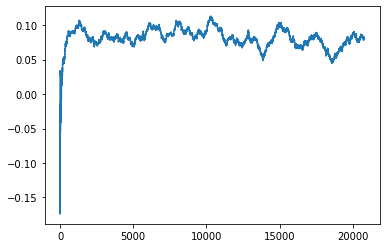

Thread: 5 iteration: 3530
RAM mProject_87 FROM: 704 --> 448 reward: -1.0
Thread: 6 iteration: 3499
RAM mProject_32 FROM: 1024 --> 448 reward: -1.0
Thread: 4 iteration: 3445
RAM mProject_42 FROM: 1344 --> 1280 reward: 0.01399358636718745
Thread: 2 iteration: 3443
RAM mDiffFit_87 FROM: 2240 --> 320 reward: 0.103877544921875
Saving ...


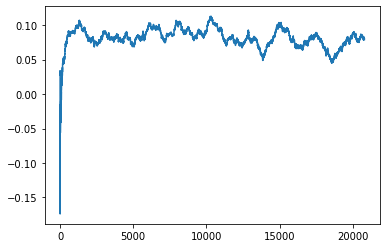

Thread: 6 iteration: 3500
RAM mProject_79 FROM: 1216 --> 448 reward: -1.0
Thread: 1 iteration: 3397
RAM mDiffFit_37 FROM: 2112 --> 192 reward: 0.33802342929687507
Thread: 4 iteration: 3446
RAM mProject_26 FROM: 1856 --> 512 reward: -1.0
Thread: 5 iteration: 3531
RAM mDiffFit_235 FROM: 1536 --> 448 reward: 0.03314838554687499
Thread: 2 iteration: 3444
RAM mDiffFit_265 FROM: 1024 --> 320 reward: -0.007932388281250008
Thread: 1 iteration: 3398
RAM mProject_87 FROM: 512 --> 192 reward: -1.0
Saving ...


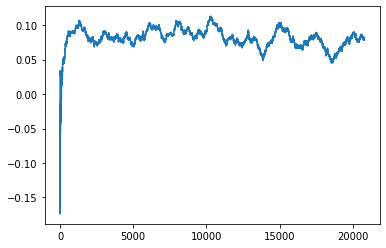

Thread: 3 iteration: 3480
RAM mDiffFit_262 FROM: 1920 --> 512 reward: 0.22048442421874997
Thread: 5 iteration: 3532
RAM mBackground_68 FROM: 1088 --> 448 reward: 0.24898120653906253
Thread: 4 iteration: 3447
RAM mDiffFit_291 FROM: 2944 --> 256 reward: 0.364937390625
Thread: 2 iteration: 3445
RAM mBackground_87 FROM: 1280 --> 512 reward: 0.1359336935625
Thread: 3 iteration: 3481
RAM mDiffFit_2 FROM: 2880 --> 1280 reward: -0.008640707031250007
Thread: 2 iteration: 3446
RAM mProject_45 FROM: 1792 --> 512 reward: -1.0
Thread: 6 iteration: 3501
RAM mDiffFit_343 FROM: 2112 --> 192 reward: 0.312539048828125
Thread: 3 iteration: 3482
RAM mDiffFit_242 FROM: 256 --> 1088 reward: -0.12400517734374997
Thread: 6 iteration: 3502
RAM mDiffFit_268 FROM: 1664 --> 448 reward: 0.030531195312499988
Thread: 3 iteration: 3483
RAM mBackground_87 FROM: 1920 --> 448 reward: 0.2771909574453125
Thread: 2 iteration: 3447
RAM mProject_52 FROM: 1920 --> 256 reward: -1.0
Thread: 1 iteration: 3399
RAM mProject_66 FRO

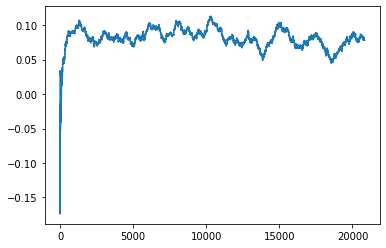

Thread: 1 iteration: 3400
RAM mDiffFit_64 FROM: 1536 --> 512 reward: 0.04031247812499998
Thread: 5 iteration: 3534
RAM mDiffFit_109 FROM: 2816 --> 320 reward: 0.098341084765625
Thread: 3 iteration: 3485
RAM mDiffFit_411 FROM: 2432 --> 384 reward: 0.216812434375
Thread: 6 iteration: 3504
RAM mDiffFit_100 FROM: 2432 --> 192 reward: 0.19813267851562497
Thread: 1 iteration: 3401
RAM mBackground_53 FROM: 2752 --> 192 reward: -1.0
Thread: 4 iteration: 3448
RAM mDiffFit_173 FROM: 2176 --> 512 reward: 0.06070309765624998
Thread: 5 iteration: 3535
RAM mProject_73 FROM: 768 --> 448 reward: -1.0
Thread: 2 iteration: 3448
RAM mDiffFit_130 FROM: 2496 --> 1280 reward: -0.002099025781249972
Thread: 5 iteration: 3536
RAM mDiffFit_420 FROM: 320 --> 448 reward: 0.027377632421875
Thread: 4 iteration: 3449
RAM mDiffFit_58 FROM: 1408 --> 448 reward: 0.008283783984374977
Thread: 5 iteration: 3537
RAM mDiffFit_32 FROM: 3008 --> 256 reward: 0.195398385546875
Thread: 2 iteration: 3449
RAM mBackground_38 FROM: 

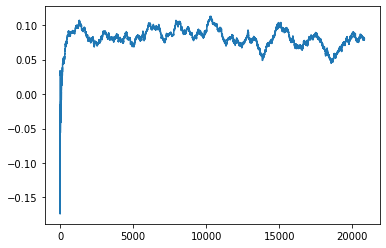

Thread: 2 iteration: 3450
RAM mProject_39 FROM: 2048 --> 448 reward: -1.0
Thread: 6 iteration: 3505
RAM mProject_24 FROM: 2944 --> 384 reward: -1.0
Thread: 1 iteration: 3402
RAM mDiffFit_415 FROM: 2432 --> 2880 reward: 0.020070331640624998
Thread: 2 iteration: 3451
RAM mDiffFit_200 FROM: 1152 --> 704 reward: 0.10463803085937504
Thread: 3 iteration: 3487
RAM mDiffFit_299 FROM: 1856 --> 1280 reward: -0.04609902578125
Thread: 6 iteration: 3506
RAM mDiffFit_204 FROM: 1280 --> 320 reward: 0.09632809765625
Thread: 1 iteration: 3403
RAM mProject_46 FROM: 1856 --> 832 reward: -1.0
Saving ...


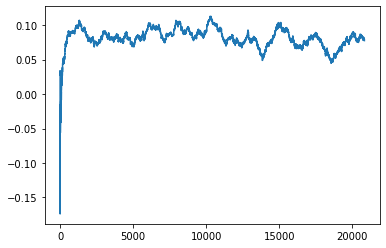

Thread: 4 iteration: 3450
RAM mDiffFit_37 FROM: 2176 --> 384 reward: 0.05187495625
Thread: 2 iteration: 3452
RAM mDiffFit_103 FROM: 2880 --> 448 reward: 0.118762987109375
Thread: 6 iteration: 3507
RAM mDiffFit_40 FROM: 2624 --> 320 reward: 0.04484880703124999
Thread: 1 iteration: 3404
RAM mDiffFit_407 FROM: 128 --> 320 reward: -0.414940110546875
Thread: 4 iteration: 3451
RAM mImgtbl_1 FROM: 1472 --> 256 reward: 1.017562443125
Thread: 5 iteration: 3538
RAM mDiffFit_278 FROM: 2624 --> 1344 reward: 0.04207292031249997
Thread: 4 iteration: 3452
RAM mBackground_23 FROM: 960 --> 704 reward: 0.1354298884296875
Thread: 4 iteration: 3453
RAM mBackground_7 FROM: 1088 --> 256 reward: 0.5281743655937501
Thread: 5 iteration: 3539
RAM mProject_71 FROM: 2752 --> 448 reward: -1.0
Thread: 3 iteration: 3488
RAM mDiffFit_376 FROM: 2240 --> 320 reward: 0.18852079687499998
Thread: 4 iteration: 3454
RAM mDiffFit_222 FROM: 2944 --> 256 reward: 0.11745305390625001
Saving ...


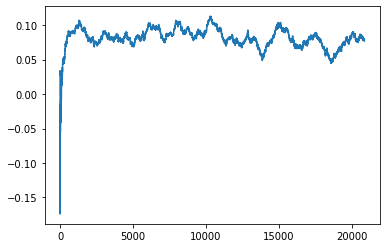

Thread: 5 iteration: 3540
RAM mDiffFit_128 FROM: 1792 --> 320 reward: 0.1615520796875
Thread: 3 iteration: 3489
RAM mDiffFit_193 FROM: 192 --> 1280 reward: -0.28608331875
Thread: 5 iteration: 3541
RAM mProject_53 FROM: 1856 --> 448 reward: -1.0
Thread: 1 iteration: 3405
RAM mProject_36 FROM: 320 --> 384 reward: -1.0
Thread: 6 iteration: 3508
RAM mProject_80 FROM: 1216 --> 384 reward: -1.0
Thread: 2 iteration: 3453
RAM mBgModel_1 FROM: 704 --> 384 reward: 0.3621854334375
Thread: 4 iteration: 3455
RAM mDiffFit_40 FROM: 2496 --> 832 reward: 0.06007550898437502
Thread: 5 iteration: 3542
RAM mBackground_83 FROM: 2624 --> 448 reward: 0.24542238712500006
Thread: 2 iteration: 3454
RAM mDiffFit_260 FROM: 2368 --> 832 reward: -0.05762513125
Thread: 5 iteration: 3543
RAM mProject_32 FROM: 1856 --> 1088 reward: 0.18965576172656248
Saving ...


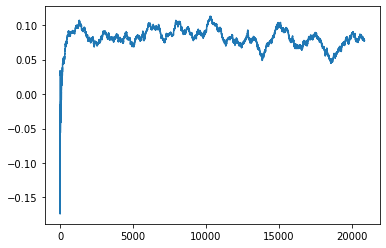

Thread: 3 iteration: 3490
RAM mDiffFit_1 FROM: 640 --> 256 reward: -0.02108862734374998
Thread: 4 iteration: 3456
RAM mDiffFit_95 FROM: 256 --> 256 reward: 0.37064592812499997
Thread: 2 iteration: 3455
RAM mBgModel_1 FROM: 2880 --> 2880 reward: 0.01080314140625005
Thread: 5 iteration: 3544
RAM mDiffFit_107 FROM: 1536 --> 320 reward: 0.056492102734375035
Thread: 3 iteration: 3491
RAM mBackground_69 FROM: 512 --> 832 reward: -0.07396667877343749
Thread: 4 iteration: 3457
RAM mProject_24 FROM: 704 --> 448 reward: -1.0
Thread: 1 iteration: 3406
RAM mDiffFit_39 FROM: 1280 --> 704 reward: 0.05029426992187499
Thread: 5 iteration: 3545
RAM mDiffFit_1 FROM: 768 --> 320 reward: 0.113617190234375
Thread: 2 iteration: 3456
RAM mDiffFit_423 FROM: 1920 --> 320 reward: 0.27842190234375
Thread: 4 iteration: 3458
RAM mDiffFit_38 FROM: 2496 --> 256 reward: 0.5327525449218751
Thread: 3 iteration: 3492
RAM mBackground_48 FROM: 2240 --> 320 reward: -1.0
Thread: 6 iteration: 3509
RAM mDiffFit_230 FROM: 2176

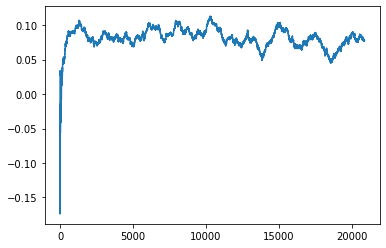

Thread: 4 iteration: 3460
RAM mDiffFit_177 FROM: 384 --> 384 reward: 0.06131252187500004
Thread: 3 iteration: 3494
RAM mProject_64 FROM: 2816 --> 2176 reward: -0.11421585140625014
Thread: 2 iteration: 3457
RAM mDiffFit_149 FROM: 576 --> 704 reward: -0.04383595117187501
Thread: 4 iteration: 3461
RAM mBackground_37 FROM: 448 --> 2944 reward: -1.0
Thread: 1 iteration: 3407
RAM mDiffFit_15 FROM: 2816 --> 1024 reward: 0.1308438046875
Thread: 3 iteration: 3495
RAM mDiffFit_249 FROM: 256 --> 384 reward: 0.12843234453124996
Thread: 2 iteration: 3458
RAM mDiffFit_390 FROM: 512 --> 256 reward: -0.10977092812499999
Thread: 4 iteration: 3462
RAM mDiffFit_19 FROM: 1664 --> 320 reward: 0.10029685859375001
Thread: 1 iteration: 3408
RAM mDiffFit_165 FROM: 256 --> 192 reward: 0.21549741132812508
Thread: 2 iteration: 3459
RAM mDiffFit_290 FROM: 1856 --> 256 reward: 0.543666725
Thread: 3 iteration: 3496
RAM mBackground_54 FROM: 1984 --> 704 reward: -1.0
Saving ...


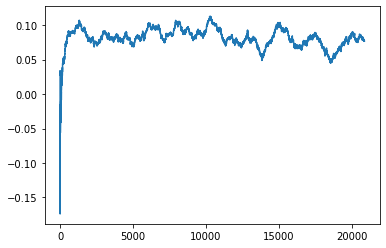

Thread: 6 iteration: 3510
RAM mProject_21 FROM: 2752 --> 256 reward: -1.0
Thread: 5 iteration: 3547
RAM mDiffFit_296 FROM: 1216 --> 256 reward: 0.30158336250000006
Thread: 4 iteration: 3463
RAM mDiffFit_158 FROM: 2816 --> 1344 reward: 0.03376561953124999
Thread: 3 iteration: 3497
RAM mDiffFit_75 FROM: 576 --> 1088 reward: -0.026804668359374992
Thread: 6 iteration: 3511
RAM mDiffFit_337 FROM: 256 --> 448 reward: -0.23431511054687498
Saving ...


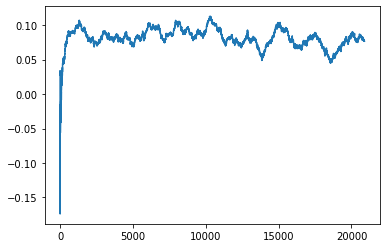

Thread: 2 iteration: 3460
RAM mDiffFit_382 FROM: 576 --> 704 reward: -0.044169269921875004
Thread: 4 iteration: 3464
RAM mBackground_87 FROM: 2560 --> 256 reward: 0.5772032329999999
Thread: 5 iteration: 3548
RAM mDiffFit_55 FROM: 1408 --> 1344 reward: 0.002596349609374996
Thread: 6 iteration: 3512
RAM mDiffFit_241 FROM: 1280 --> 2560 reward: 0.008083406249999973
Thread: 3 iteration: 3498
RAM mDiffFit_33 FROM: 1024 --> 384 reward: 0.04632809765625001
Thread: 2 iteration: 3461
RAM mProject_86 FROM: 832 --> 704 reward: -1.0
Thread: 1 iteration: 3409
RAM mBackground_12 FROM: 2432 --> 448 reward: 0.20309874285937496
Thread: 4 iteration: 3465
RAM mDiffFit_371 FROM: 2624 --> 320 reward: 0.09931765546874999
Thread: 3 iteration: 3499
RAM mDiffFit_200 FROM: 896 --> 704 reward: 0.10618493320312503
Thread: 2 iteration: 3462
RAM mDiffFit_28 FROM: 1856 --> 320 reward: 0.017671771093750004
Thread: 4 iteration: 3466
RAM mDiffFit_266 FROM: 1664 --> 192 reward: 0.7000651105468749
Thread: 6 iteration: 35

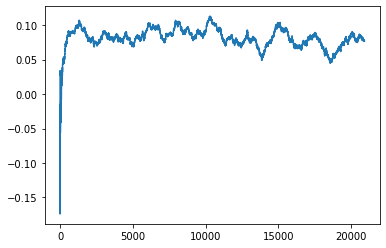

Thread: 3 iteration: 3500
RAM mProject_27 FROM: 1024 --> 1152 reward: -0.021500594156250063
Saving ...


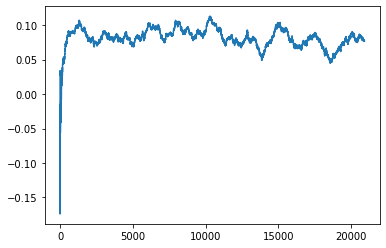

Thread: 1 iteration: 3410
RAM mDiffFit_321 FROM: 2112 --> 704 reward: 0.048986969140625
Thread: 2 iteration: 3464
RAM mViewer_1 FROM: 768 --> 320 reward: 0.16572868743749994
Thread: 4 iteration: 3467
RAM mBackground_62 FROM: 2944 --> 1344 reward: -0.020017525953124997
Saving ...


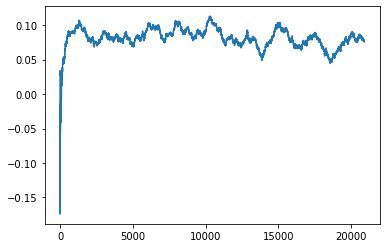

Thread: 5 iteration: 3550
RAM mDiffFit_35 FROM: 2816 --> 448 reward: 0.06855984570312501
Thread: 2 iteration: 3465
RAM mDiffFit_295 FROM: 2624 --> 256 reward: 0.17795568632812503
Thread: 4 iteration: 3468
RAM mDiffFit_328 FROM: 768 --> 384 reward: 0.06329681484375002
Thread: 3 iteration: 3501
RAM mDiffFit_231 FROM: 3008 --> 384 reward: 0.04185148320312502
Thread: 2 iteration: 3466
RAM mDiffFit_285 FROM: 2624 --> 704 reward: 0.041708318749999994
Thread: 4 iteration: 3469
RAM mBackground_72 FROM: 1600 --> 320 reward: 0.2837304592578125
Thread: 1 iteration: 3411
RAM mDiffFit_152 FROM: 2368 --> 320 reward: 0.15984630585937498
Thread: 5 iteration: 3551
RAM mDiffFit_64 FROM: 2688 --> 384 reward: 0.06092181484375002
Thread: 1 iteration: 3412
RAM mDiffFit_72 FROM: 1472 --> 320 reward: 0.09461714648437497
Thread: 5 iteration: 3552
RAM mDiffFit_217 FROM: 2368 --> 192 reward: 0.2223645140625
Saving ...


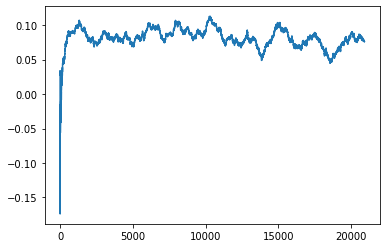

Thread: 4 iteration: 3470
RAM mDiffFit_186 FROM: 2240 --> 384 reward: 0.037666593750000005
Thread: 4 iteration: 3471
RAM mDiffFit_323 FROM: 704 --> 320 reward: 0.07472648320312497
Thread: 5 iteration: 3553
RAM mBackground_52 FROM: 1344 --> 256 reward: -1.0
Thread: 6 iteration: 3515
RAM mProject_85 FROM: 1920 --> 320 reward: -1.0
Thread: 3 iteration: 3502
RAM mDiffFit_179 FROM: 448 --> 320 reward: 0.10139061953125
Thread: 4 iteration: 3472
RAM mBackground_80 FROM: 2176 --> 320 reward: 0.342436665796875
Thread: 5 iteration: 3554
RAM mProject_15 FROM: 3008 --> 1280 reward: -0.08787464514843751
Thread: 1 iteration: 3413
RAM mProject_9 FROM: 2560 --> 256 reward: -1.0
Thread: 2 iteration: 3467
RAM mDiffFit_111 FROM: 640 --> 320 reward: 0.04648174804687501
Thread: 6 iteration: 3516
RAM mBackground_22 FROM: 640 --> 2880 reward: -0.10940798390624996
Thread: 5 iteration: 3555
RAM mDiffFit_230 FROM: 2432 --> 1344 reward: -0.032114645312499995
Thread: 2 iteration: 3468
RAM mBackground_21 FROM: 249

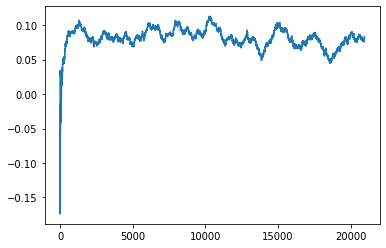

Thread: 2 iteration: 3470
RAM mDiffFit_179 FROM: 128 --> 1344 reward: -0.9129921027343751
Thread: 1 iteration: 3416
RAM mDiffFit_31 FROM: 2304 --> 320 reward: 0.13308590742187498
Thread: 3 iteration: 3504
RAM mProject_78 FROM: 1024 --> 320 reward: -1.0
Thread: 6 iteration: 3517
RAM mBackground_57 FROM: 2240 --> 320 reward: -1.0
Thread: 4 iteration: 3473
RAM mDiffFit_209 FROM: 2368 --> 2752 reward: 0.015312521875000002
Thread: 1 iteration: 3417
RAM mDiffFit_233 FROM: 1024 --> 256 reward: 0.35430207968750005
Thread: 6 iteration: 3518
RAM mDiffFit_247 FROM: 256 --> 1088 reward: -0.137028606640625
Thread: 1 iteration: 3418
RAM mProject_32 FROM: 896 --> 1344 reward: -0.1822209214218749
Thread: 2 iteration: 3471
RAM mDiffFit_156 FROM: 2560 --> 1344 reward: -0.023507897265625
Thread: 6 iteration: 3519
RAM mBackground_43 FROM: 384 --> 1344 reward: -1.0
Thread: 5 iteration: 3558
RAM mDiffFit_282 FROM: 960 --> 1920 reward: 0.09685951171874999
Thread: 2 iteration: 3472
RAM mDiffFit_85 FROM: 2944 

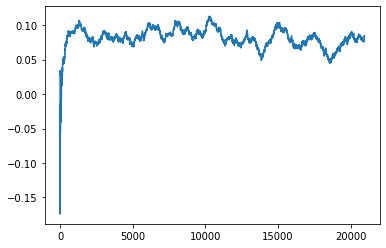

Thread: 6 iteration: 3520
RAM mBackground_86 FROM: 448 --> 1344 reward: -0.23309803450781255
Thread: 5 iteration: 3559
RAM mDiffFit_250 FROM: 1728 --> 832 reward: 0.017328097656249992
Thread: 2 iteration: 3473
RAM mProject_81 FROM: 896 --> 768 reward: -1.0
Thread: 3 iteration: 3505
RAM mDiffFit_21 FROM: 1856 --> 320 reward: 0.17974219023437502
Thread: 6 iteration: 3521
RAM mProject_82 FROM: 2112 --> 192 reward: -1.0
Thread: 4 iteration: 3474
RAM mDiffFit_220 FROM: 2176 --> 256 reward: 0.23486977890625005
Thread: 3 iteration: 3506
RAM mBackground_57 FROM: 2048 --> 1344 reward: -1.0
Thread: 1 iteration: 3419
RAM mDiffFit_348 FROM: 512 --> 320 reward: -0.040177123437500004
Thread: 6 iteration: 3522
RAM mDiffFit_352 FROM: 1792 --> 1344 reward: 0.05457555273437499
Thread: 3 iteration: 3507
RAM mDiffFit_270 FROM: 1856 --> 1920 reward: -0.04541150390625002
Thread: 4 iteration: 3475
RAM mDiffFit_104 FROM: 1984 --> 320 reward: 0.34222398203125004
Saving ...


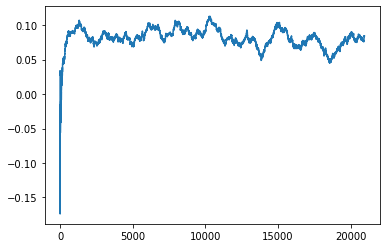

Thread: 1 iteration: 3420
RAM mDiffFit_125 FROM: 3008 --> 1344 reward: -0.01832559648437501
Thread: 4 iteration: 3476
RAM mDiffFit_200 FROM: 960 --> 448 reward: -0.014054799609374974
Thread: 6 iteration: 3523
RAM mDiffFit_67 FROM: 2624 --> 384 reward: 0.06768221328124997
Thread: 1 iteration: 3421
RAM mDiffFit_348 FROM: 2560 --> 192 reward: 0.42952342929687504
Thread: 3 iteration: 3508
RAM mProject_85 FROM: 1216 --> 448 reward: -1.0
Saving ...


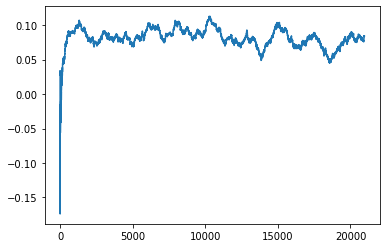

Thread: 5 iteration: 3560
RAM mProject_3 FROM: 2176 --> 320 reward: -1.0
Thread: 2 iteration: 3474
RAM mDiffFit_287 FROM: 768 --> 2176 reward: -0.012802035937499994
Thread: 1 iteration: 3422
RAM mDiffFit_272 FROM: 640 --> 832 reward: -0.010111969140624982
Thread: 3 iteration: 3509
RAM mDiffFit_4 FROM: 1856 --> 1344 reward: 0.013861969140624986
Thread: 2 iteration: 3475
RAM mDiffFit_199 FROM: 1856 --> 192 reward: 0.38425517734375
Thread: 6 iteration: 3524
RAM mDiffFit_97 FROM: 1600 --> 1344 reward: 0.03404690234375
Thread: 6 iteration: 3525
RAM mDiffFit_420 FROM: 1856 --> 320 reward: 0.11322393828125002
Thread: 2 iteration: 3476
RAM mProject_15 FROM: 256 --> 1344 reward: 0.7297993839375
Thread: 5 iteration: 3561
RAM mDiffFit_384 FROM: 1856 --> 1344 reward: 0.005861969140624982
Thread: 6 iteration: 3526
RAM mDiffFit_34 FROM: 640 --> 448 reward: 0.09519011054687505
Thread: 2 iteration: 3477
RAM mDiffFit_202 FROM: 2304 --> 448 reward: 0.05811714648437499
Thread: 2 iteration: 3478
RAM mProj

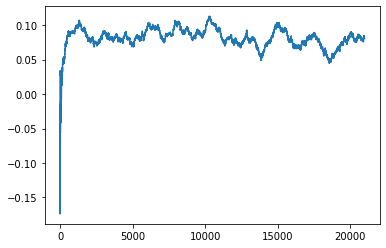

Thread: 3 iteration: 3510
RAM mBackground_34 FROM: 448 --> 320 reward: -1.0
Thread: 4 iteration: 3477
RAM mDiffFit_85 FROM: 2048 --> 1088 reward: 0.0029010179687500096
Saving ...


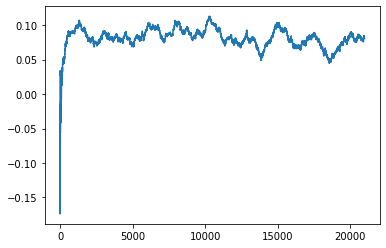

Thread: 2 iteration: 3480
RAM mDiffFit_259 FROM: 128 --> 192 reward: -0.324257809765625
Thread: 6 iteration: 3527
RAM mDiffFit_350 FROM: 2944 --> 448 reward: 0.03736188164062501
Thread: 3 iteration: 3511
RAM mDiffFit_398 FROM: 2560 --> 320 reward: 0.146020796875
Thread: 4 iteration: 3478
RAM mDiffFit_14 FROM: 576 --> 1408 reward: 0.01944537539062501
Thread: 2 iteration: 3481
RAM mDiffFit_171 FROM: 2816 --> 448 reward: 0.062369735156249995
Thread: 6 iteration: 3528
RAM mBackground_33 FROM: 1280 --> 448 reward: -1.0
Thread: 5 iteration: 3562
RAM mProject_76 FROM: 2816 --> 192 reward: -1.0
Thread: 1 iteration: 3424
RAM mDiffFit_151 FROM: 2240 --> 832 reward: -0.01128132656250001
Thread: 3 iteration: 3512
RAM mDiffFit_366 FROM: 2624 --> 1920 reward: 0.0077578097656249775
Thread: 2 iteration: 3482
RAM mDiffFit_151 FROM: 1152 --> 832 reward: 0.0032525886718750077
Thread: 6 iteration: 3529
RAM mDiffFit_307 FROM: 2432 --> 320 reward: 0.06843739062499996
Thread: 4 iteration: 3479
RAM mDiffFit_1

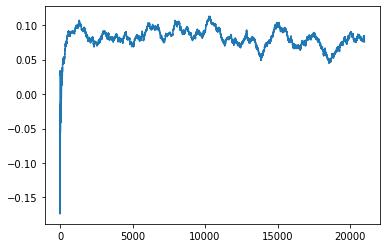

Thread: 4 iteration: 3480
RAM mDiffFit_175 FROM: 832 --> 320 reward: 0.17764579687499998
Saving ...


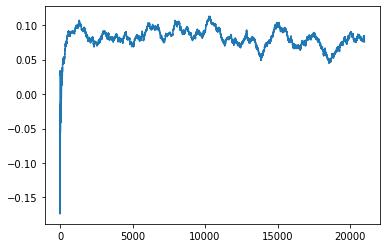

Thread: 6 iteration: 3530
RAM mDiffFit_63 FROM: 1024 --> 448 reward: 0.064757809765625
Thread: 3 iteration: 3514
RAM mDiffFit_241 FROM: 2304 --> 320 reward: 0.138236925390625
Thread: 4 iteration: 3481
RAM mProject_7 FROM: 640 --> 1344 reward: 0.7379697033281252
Thread: 2 iteration: 3483
RAM mBackground_72 FROM: 1472 --> 768 reward: 0.14215756227343748
Thread: 4 iteration: 3482
RAM mDiffFit_352 FROM: 1856 --> 2176 reward: -0.06278391523437497
Thread: 3 iteration: 3515
RAM mProject_17 FROM: 128 --> 448 reward: -1.0
Thread: 5 iteration: 3563
RAM mProject_51 FROM: 448 --> 1344 reward: 0.7379922033281251
Thread: 1 iteration: 3426
RAM mDiffFit_196 FROM: 960 --> 1344 reward: -0.027875
Thread: 2 iteration: 3484
RAM mDiffFit_46 FROM: 1216 --> 704 reward: 0.03703904882812499
Thread: 4 iteration: 3483
RAM mBackground_14 FROM: 1728 --> 1344 reward: -0.05651149325781253
Thread: 3 iteration: 3516
RAM mDiffFit_119 FROM: 704 --> 256 reward: 0.24067971210937497
Thread: 5 iteration: 3564
RAM mDiffFit_13

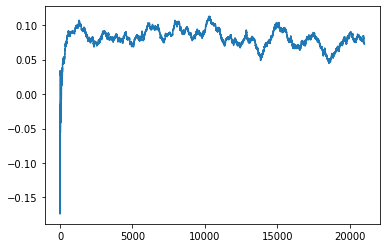

Thread: 1 iteration: 3430
RAM mDiffFit_226 FROM: 2240 --> 2880 reward: 0.019546902343750006
Thread: 6 iteration: 3534
RAM mBackground_31 FROM: 320 --> 256 reward: -1.0
Thread: 4 iteration: 3484
RAM mDiffFit_325 FROM: 1024 --> 384 reward: 0.1604583625
Saving ...


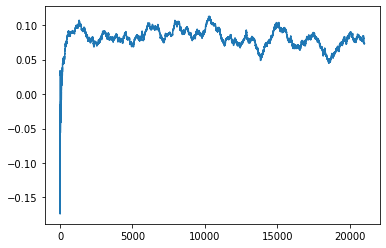

Thread: 3 iteration: 3520
RAM mBackground_72 FROM: 1472 --> 1024 reward: 0.10437133108593752
Thread: 1 iteration: 3431
RAM mDiffFit_230 FROM: 256 --> 320 reward: -0.01169269921875004
Thread: 6 iteration: 3535
RAM mDiffFit_141 FROM: 2496 --> 1344 reward: -0.034765707031249996
Thread: 4 iteration: 3485
RAM mDiffFit_395 FROM: 1088 --> 192 reward: 0.33524477890625004
Thread: 1 iteration: 3432
RAM mBackground_56 FROM: 2304 --> 320 reward: -1.0
Thread: 5 iteration: 3566
RAM mProject_41 FROM: 2368 --> 1344 reward: 0.010022151304687388
Thread: 2 iteration: 3489
RAM mDiffFit_412 FROM: 2112 --> 448 reward: 0.08906506679687501
Thread: 6 iteration: 3536
RAM mBackground_23 FROM: 1984 --> 1344 reward: 0.009636890242187522
Thread: 4 iteration: 3486
RAM mProject_48 FROM: 2624 --> 1344 reward: -0.046528419656250104
Thread: 3 iteration: 3521
RAM mBackground_25 FROM: 1984 --> 1344 reward: 0.2399738077421875
Thread: 1 iteration: 3433
RAM mDiffFit_55 FROM: 256 --> 320 reward: -0.20162504375000004
Thread: 5

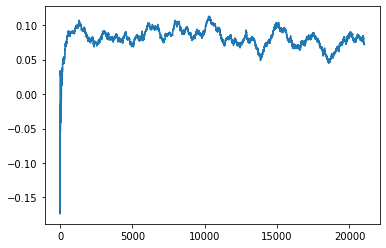

Thread: 2 iteration: 3490
RAM mDiffFit_267 FROM: 896 --> 1344 reward: 0.03714588437499999
Thread: 3 iteration: 3522
RAM mDiffFit_266 FROM: 1600 --> 1344 reward: 0.004934889453124987
Thread: 4 iteration: 3488
RAM mDiffFit_86 FROM: 128 --> 1344 reward: -0.9450261054687501
Thread: 2 iteration: 3491
RAM mAdd_2 FROM: 832 --> 1344 reward: -0.19829165937499998
Thread: 6 iteration: 3538
RAM mDiffFit_422 FROM: 1728 --> 1344 reward: 0.008289048828124968
Thread: 3 iteration: 3523
RAM mDiffFit_327 FROM: 1216 --> 1344 reward: -0.019476570703125008
Thread: 2 iteration: 3492
RAM mProject_32 FROM: 1536 --> 1344 reward: 0.05408578272656237
Thread: 1 iteration: 3434
RAM mDiffFit_157 FROM: 832 --> 1344 reward: 0.0030755527343749936
Thread: 2 iteration: 3493
RAM mBackground_15 FROM: 1152 --> 1344 reward: -0.017744216398437485
Thread: 6 iteration: 3539
RAM mDiffFit_136 FROM: 2304 --> 384 reward: 0.12837495624999998
Thread: 3 iteration: 3524
RAM mDiffFit_410 FROM: 384 --> 1280 reward: 0.037942830468749994
T

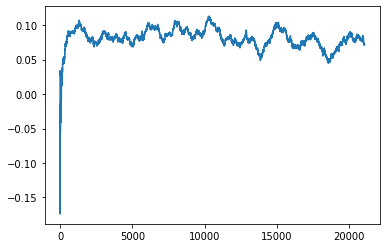

Thread: 6 iteration: 3540
RAM mBackground_28 FROM: 448 --> 1408 reward: -0.18182721328124998
Thread: 3 iteration: 3525
RAM mProject_24 FROM: 2432 --> 1024 reward: 0.10431538678124996
Thread: 5 iteration: 3568
RAM mDiffFit_309 FROM: 2816 --> 1344 reward: 0.012570287890624997
Thread: 2 iteration: 3495
RAM mDiffFit_396 FROM: 1856 --> 768 reward: 0.09426820820312501
Thread: 1 iteration: 3436
RAM mDiffFit_403 FROM: 1984 --> 1344 reward: 0.020218760937500014
Thread: 3 iteration: 3526
RAM mDiffFit_29 FROM: 2816 --> 2432 reward: 0.02463022109375001
Thread: 6 iteration: 3541
RAM mDiffFit_122 FROM: 512 --> 1344 reward: -0.20104431367187497
Thread: 5 iteration: 3569
RAM mDiffFit_66 FROM: 1024 --> 1344 reward: 0.031559933203125
Thread: 1 iteration: 3437
RAM mDiffFit_247 FROM: 1664 --> 384 reward: 0.08741663749999998
Thread: 6 iteration: 3542
RAM mDiffFit_166 FROM: 896 --> 256 reward: 0.19193230078124998
Thread: 3 iteration: 3527
RAM mBackground_40 FROM: 896 --> 192 reward: -1.0
Thread: 4 iteration

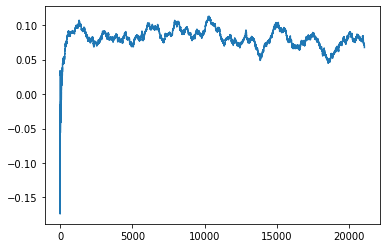

Thread: 5 iteration: 3570
RAM mDiffFit_378 FROM: 2496 --> 1344 reward: -0.002164092578124995
Thread: 1 iteration: 3438
RAM mDiffFit_129 FROM: 1600 --> 1344 reward: -0.023862012890625013
Thread: 3 iteration: 3528
RAM mDiffFit_392 FROM: 2496 --> 1344 reward: -0.14903145781250002
Saving ...


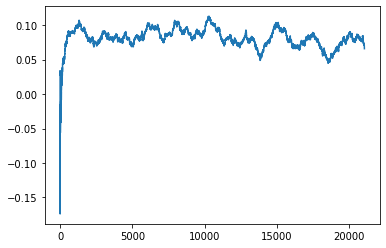

Thread: 4 iteration: 3490
RAM mDiffFit_20 FROM: 1344 --> 1344 reward: 0.000499999999999997
Thread: 5 iteration: 3571
RAM mDiffFit_112 FROM: 1280 --> 704 reward: 0.08254690234375
Thread: 3 iteration: 3529
RAM mBackground_34 FROM: 128 --> 1344 reward: -1.0
Thread: 2 iteration: 3496
RAM mProject_18 FROM: 256 --> 1344 reward: 0.7100935854609374
Thread: 6 iteration: 3543
RAM mDiffFit_214 FROM: 2176 --> 1344 reward: -0.05206778671875001
Thread: 5 iteration: 3572
RAM mBackground_4 FROM: 2304 --> 1344 reward: -0.032404627664062505
Thread: 4 iteration: 3491
RAM mBackground_1 FROM: 2112 --> 1344 reward: -0.018718508046875047
Saving ...


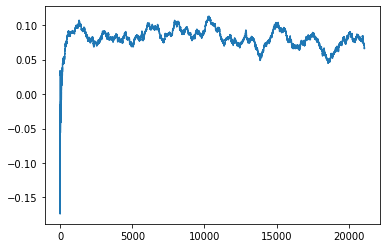

Thread: 3 iteration: 3530
RAM mDiffFit_143 FROM: 2752 --> 1344 reward: -0.0073828535156249785
Thread: 6 iteration: 3544
RAM mDiffFit_70 FROM: 2688 --> 1344 reward: -0.004390663281250012
Thread: 2 iteration: 3497
RAM mDiffFit_96 FROM: 2752 --> 1344 reward: 0.01843747812500001
Thread: 5 iteration: 3573
RAM mDiffFit_417 FROM: 3008 --> 1344 reward: -0.01722661445312499
Thread: 4 iteration: 3492
RAM mDiffFit_138 FROM: 960 --> 1344 reward: -0.046445331640625004
Thread: 3 iteration: 3531
RAM mProject_31 FROM: 832 --> 256 reward: -1.0
Thread: 1 iteration: 3439
RAM mDiffFit_290 FROM: 1408 --> 1344 reward: -0.008903650390625004
Thread: 6 iteration: 3545
RAM mDiffFit_396 FROM: 960 --> 256 reward: 0.434335951171875
Thread: 2 iteration: 3498
RAM mDiffFit_263 FROM: 2048 --> 768 reward: 0.020947876562499995
Thread: 4 iteration: 3493
RAM mDiffFit_178 FROM: 1984 --> 1408 reward: 0.07042453476562503
Thread: 3 iteration: 3532
RAM mBackground_6 FROM: 1792 --> 1344 reward: 0.0026225246484374624
Saving ...


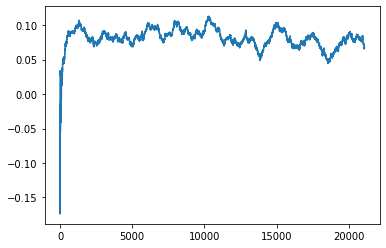

Thread: 1 iteration: 3440
RAM mDiffFit_398 FROM: 576 --> 1344 reward: -0.033679668359375
Thread: 2 iteration: 3499
RAM mBackground_4 FROM: 1280 --> 1344 reward: -0.04823618189062503
Thread: 5 iteration: 3574
RAM mDiffFit_403 FROM: 320 --> 1344 reward: -0.12652342929687502
Thread: 3 iteration: 3533
RAM mDiffFit_85 FROM: 1984 --> 1344 reward: 0.04216409257812501
Thread: 1 iteration: 3441
RAM mProject_87 FROM: 1920 --> 1344 reward: 0.06386337942187494
Thread: 6 iteration: 3546
RAM mDiffFit_326 FROM: 1920 --> 1344 reward: 0.010039048828125018
Saving ...


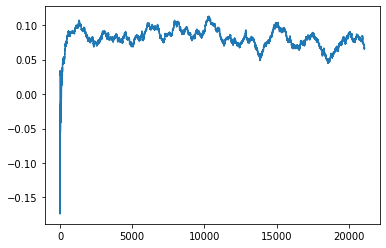

Thread: 2 iteration: 3500
RAM mDiffFit_192 FROM: 1152 --> 1152 reward: 0.0470312828125
Thread: 5 iteration: 3575
RAM mDiffFit_134 FROM: 2432 --> 320 reward: 0.19874477890624997
Thread: 3 iteration: 3534
RAM mDiffFit_159 FROM: 2240 --> 1344 reward: -0.022645884375000012
Thread: 6 iteration: 3547
RAM mDiffFit_112 FROM: 768 --> 384 reward: -0.03540632656250001
Thread: 2 iteration: 3501
RAM mProject_31 FROM: 448 --> 1344 reward: 0.7210665645468749
Thread: 4 iteration: 3494
RAM mDiffFit_243 FROM: 1792 --> 256 reward: 0.2736145578125
Thread: 5 iteration: 3576
RAM mDiffFit_55 FROM: 1920 --> 1344 reward: 0.18007827265625
Thread: 3 iteration: 3535
RAM mDiffFit_64 FROM: 384 --> 1344 reward: -0.24552347304687497
Thread: 6 iteration: 3548
RAM mBackground_25 FROM: 2240 --> 1344 reward: -0.020138421125000035
Thread: 2 iteration: 3502
RAM mDiffFit_237 FROM: 1856 --> 1344 reward: 0.009757809765624991
Thread: 4 iteration: 3495
RAM mBackground_11 FROM: 1792 --> 1344 reward: 0.031011504929687492
Thread: 

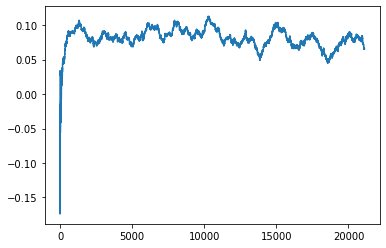

Thread: 6 iteration: 3550
RAM mProject_12 FROM: 1408 --> 1344 reward: 0.024852193734374983
Thread: 3 iteration: 3536
RAM mDiffFit_415 FROM: 2624 --> 1344 reward: -0.26819827031250004
Thread: 6 iteration: 3551
RAM mDiffFit_197 FROM: 1728 --> 1344 reward: 0.009992190234374984
Thread: 6 iteration: 3552
RAM mDiffFit_393 FROM: 1536 --> 1344 reward: 0.002656239062499982
Thread: 3 iteration: 3537
RAM mBackground_53 FROM: 1280 --> 1344 reward: -1.0
Thread: 2 iteration: 3503
RAM mBackground_40 FROM: 256 --> 1344 reward: -1.0
Thread: 5 iteration: 3578
RAM mProject_81 FROM: 256 --> 1344 reward: 0.7260517242421876
Thread: 1 iteration: 3444
RAM mDiffFit_379 FROM: 2304 --> 1344 reward: -0.006687521874999998
Thread: 5 iteration: 3579
RAM mDiffFit_323 FROM: 1728 --> 1344 reward: 0.024750000000000015
Thread: 1 iteration: 3445
RAM mProject_83 FROM: 896 --> 192 reward: -1.0
Thread: 4 iteration: 3498
RAM mDiffFit_390 FROM: 1088 --> 1344 reward: -0.031505221093750015
Saving ...


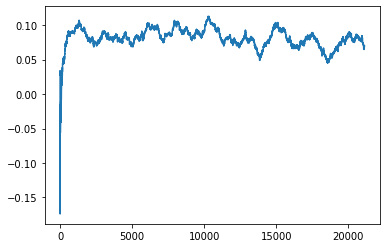

Thread: 5 iteration: 3580
RAM mDiffFit_308 FROM: 2048 --> 1344 reward: 0.00015623906249997987
Thread: 1 iteration: 3446
RAM mProject_11 FROM: 2560 --> 1344 reward: -0.02125900856249999
Thread: 3 iteration: 3538
RAM mProject_71 FROM: 1088 --> 2176 reward: -0.12897033208593764
Thread: 2 iteration: 3504
RAM mBackground_60 FROM: 2880 --> 1344 reward: -1.0
Thread: 6 iteration: 3553
RAM mDiffFit_193 FROM: 832 --> 1344 reward: -0.03331511054687501
Thread: 2 iteration: 3505
RAM mDiffFit_49 FROM: 1728 --> 1344 reward: 0.010289048828124973
Thread: 1 iteration: 3447
RAM mDiffFit_7 FROM: 448 --> 1344 reward: -0.016544226171875016
Thread: 3 iteration: 3539
RAM mBackground_8 FROM: 3008 --> 1344 reward: -0.11574863389843751
Thread: 4 iteration: 3499
RAM mDiffFit_404 FROM: 2880 --> 256 reward: 0.24097652695312502
Thread: 5 iteration: 3581
RAM mDiffFit_55 FROM: 1408 --> 1280 reward: -0.0024323007812500005
Thread: 2 iteration: 3506
RAM mDiffFit_360 FROM: 1216 --> 1344 reward: 0.005807300781249976
Thread

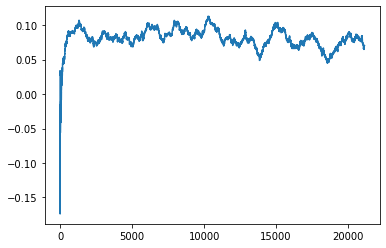

Thread: 3 iteration: 3540
RAM mDiffFit_59 FROM: 1344 --> 320 reward: 0.341815110546875
Saving ...


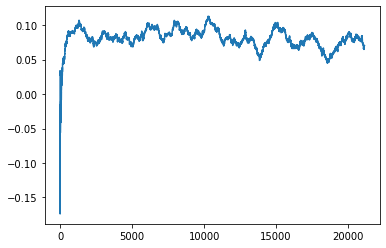

Thread: 4 iteration: 3500
RAM mDiffFit_214 FROM: 2240 --> 1344 reward: -0.07929698984374998
Thread: 6 iteration: 3554
RAM mDiffFit_220 FROM: 192 --> 256 reward: -0.093205730078125
Thread: 1 iteration: 3449
RAM mDiffFit_420 FROM: 2944 --> 192 reward: 0.6453125218749999
Thread: 4 iteration: 3501
RAM mDiffFit_328 FROM: 896 --> 192 reward: 0.9459115476562501
Thread: 6 iteration: 3555
RAM mDiffFit_105 FROM: 1536 --> 1408 reward: -0.026708362499999992
Saving ...


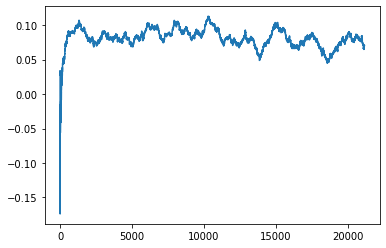

Thread: 1 iteration: 3450
RAM mProject_15 FROM: 1984 --> 192 reward: -1.0
Thread: 5 iteration: 3582
RAM mProject_56 FROM: 1600 --> 1344 reward: 0.061693120406249954
Thread: 3 iteration: 3541
RAM mDiffFit_26 FROM: 1536 --> 832 reward: 0.018046858593749986
Thread: 6 iteration: 3556
RAM mDiffFit_234 FROM: 1984 --> 1280 reward: 0.026315110546875013
Thread: 1 iteration: 3451
RAM mDiffFit_44 FROM: 2880 --> 256 reward: 0.174611925390625
Thread: 5 iteration: 3583
RAM mBackground_51 FROM: 2112 --> 1344 reward: -1.0
Thread: 2 iteration: 3507
RAM mDiffFit_329 FROM: 1472 --> 2880 reward: -0.005135398437500008
Thread: 5 iteration: 3584
RAM mDiffFit_350 FROM: 1408 --> 1344 reward: 0.015122411328124998
Thread: 6 iteration: 3557
RAM mBackground_26 FROM: 1472 --> 192 reward: 0.7995244771640625
Thread: 3 iteration: 3542
RAM mDiffFit_32 FROM: 2752 --> 1344 reward: -0.021033915234374995
Thread: 2 iteration: 3508
RAM mDiffFit_233 FROM: 2240 --> 1344 reward: 0.0028541156250000074
Thread: 6 iteration: 3558
R

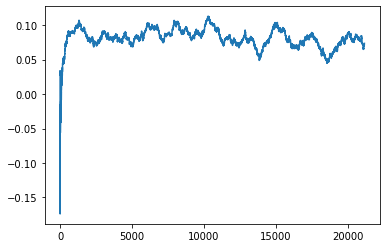

Thread: 2 iteration: 3510
RAM mDiffFit_234 FROM: 1920 --> 1152 reward: 0.04420314140625
Thread: 4 iteration: 3504
RAM mDiffFit_287 FROM: 3008 --> 256 reward: 0.127033783984375
Thread: 1 iteration: 3453
RAM mDiffFit_153 FROM: 1408 --> 192 reward: 0.16608849609374998
Thread: 5 iteration: 3587
RAM mDiffFit_222 FROM: 2688 --> 2752 reward: 0.08740637031249997
Thread: 2 iteration: 3511
RAM mDiffFit_284 FROM: 1344 --> 256 reward: 0.20012758867187502
Thread: 3 iteration: 3545
RAM mDiffFit_379 FROM: 2240 --> 1280 reward: 0.004645796874999993
Thread: 5 iteration: 3588
RAM mDiffFit_107 FROM: 1984 --> 256 reward: 0.218898429296875
Thread: 4 iteration: 3505
RAM mDiffFit_24 FROM: 704 --> 1344 reward: -0.06697134960937501
Thread: 2 iteration: 3512
RAM mDiffFit_221 FROM: 128 --> 1344 reward: -0.48437758867187497
Thread: 3 iteration: 3546
RAM mDiffFit_137 FROM: 1152 --> 1344 reward: -0.011609380468750007
Thread: 5 iteration: 3589
RAM mProject_17 FROM: 1280 --> 192 reward: -1.0
Saving ...


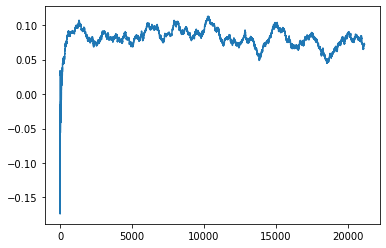

Thread: 6 iteration: 3560
RAM mProject_85 FROM: 576 --> 1344 reward: 0.7107910854609374
Thread: 1 iteration: 3454
RAM mDiffFit_145 FROM: 1024 --> 1024 reward: 0.060125043749999996
Thread: 2 iteration: 3513
RAM mDiffFit_116 FROM: 1152 --> 192 reward: 0.3103437609375
Thread: 1 iteration: 3455
RAM mDiffFit_260 FROM: 2944 --> 384 reward: 0.119270753125
Thread: 2 iteration: 3514
RAM mDiffFit_336 FROM: 2304 --> 1344 reward: 0.002187478124999996
Thread: 2 iteration: 3515
RAM mProject_67 FROM: 320 --> 896 reward: -1.0
Thread: 4 iteration: 3506
RAM mBackground_60 FROM: 960 --> 1344 reward: -1.0
Saving ...


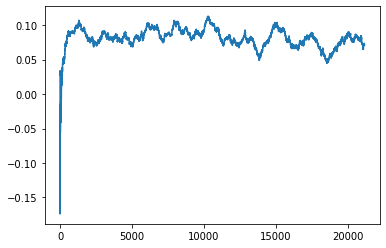

Thread: 5 iteration: 3590
RAM mProject_48 FROM: 1728 --> 832 reward: -1.0
Thread: 3 iteration: 3547
RAM mBackground_49 FROM: 1856 --> 1344 reward: -1.0
Thread: 1 iteration: 3456
RAM mDiffFit_395 FROM: 2880 --> 1344 reward: 0.022335907421874978
Thread: 3 iteration: 3548
RAM mDiffFit_104 FROM: 2176 --> 192 reward: 0.291148341796875
Thread: 5 iteration: 3591
RAM mProject_11 FROM: 2496 --> 256 reward: -1.0
Thread: 2 iteration: 3516
RAM mDiffFit_150 FROM: 2624 --> 1344 reward: 0.009046858593749988
Thread: 1 iteration: 3457
RAM mDiffFit_197 FROM: 2112 --> 1344 reward: 0.011164048828125016
Thread: 3 iteration: 3549
RAM mProject_75 FROM: 704 --> 256 reward: -1.0
Thread: 4 iteration: 3507
RAM mDiffFit_357 FROM: 1088 --> 256 reward: 0.473679755859375
Thread: 5 iteration: 3592
RAM mProject_73 FROM: 832 --> 1344 reward: 0.7175439048515625
Thread: 6 iteration: 3561
RAM mDiffFit_412 FROM: 320 --> 1344 reward: -0.042809845703125
Thread: 2 iteration: 3517
RAM mDiffFit_251 FROM: 832 --> 1024 reward: 0.

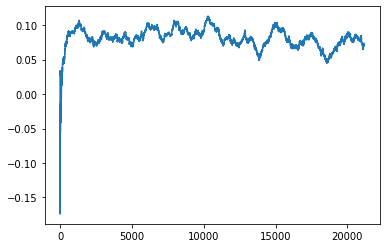

Thread: 3 iteration: 3550
RAM mBackground_87 FROM: 2432 --> 384 reward: 0.359018569015625
Thread: 4 iteration: 3508
RAM mDiffFit_90 FROM: 2304 --> 1344 reward: -0.04239070703125
Thread: 6 iteration: 3562
RAM mDiffFit_183 FROM: 960 --> 1344 reward: -0.031148429296875002
Thread: 2 iteration: 3518
RAM mDiffFit_215 FROM: 192 --> 1344 reward: -0.34576561953125
Thread: 3 iteration: 3551
RAM mDiffFit_85 FROM: 1664 --> 1344 reward: -0.007489601562500024
Thread: 4 iteration: 3509
RAM mDiffFit_119 FROM: 384 --> 1344 reward: -0.15000780976562503
Thread: 6 iteration: 3563
RAM mBackground_5 FROM: 2560 --> 1344 reward: 0.0016706460781249829
Thread: 3 iteration: 3552
RAM mProject_70 FROM: 640 --> 1344 reward: 0.7329620436328124
Thread: 1 iteration: 3459
RAM mDiffFit_385 FROM: 1600 --> 1280 reward: 0.0072499999999999995
Saving ...


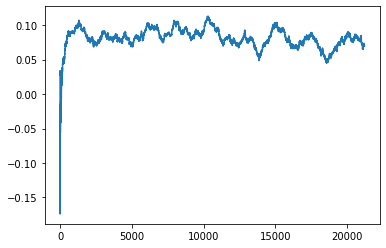

Thread: 4 iteration: 3510
RAM mDiffFit_210 FROM: 2816 --> 192 reward: 0.32715878398437503
Thread: 3 iteration: 3553
RAM mDiffFit_98 FROM: 1920 --> 1344 reward: 0.6044380031250001
Thread: 6 iteration: 3564
RAM mDiffFit_116 FROM: 832 --> 192 reward: 0.24905730078125
Thread: 4 iteration: 3511
RAM mBackground_51 FROM: 832 --> 1344 reward: -1.0
Thread: 2 iteration: 3519
RAM mBackground_61 FROM: 2944 --> 256 reward: 0.689827387125
Thread: 4 iteration: 3512
RAM mDiffFit_132 FROM: 2176 --> 1344 reward: -0.020822964062499998
Thread: 4 iteration: 3513
RAM mBackground_40 FROM: 2816 --> 1344 reward: -1.0
Saving ...


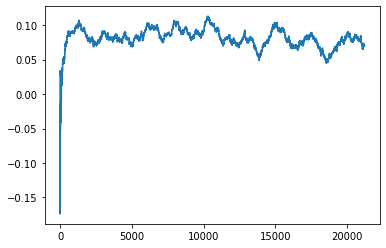

Thread: 1 iteration: 3460
RAM mBackground_52 FROM: 704 --> 192 reward: -1.0
Thread: 5 iteration: 3593
RAM mDiffFit_203 FROM: 2752 --> 192 reward: 0.554231748046875
Thread: 4 iteration: 3514
RAM mBackground_38 FROM: 2048 --> 1344 reward: -1.0
Thread: 6 iteration: 3565
RAM mDiffFit_66 FROM: 2752 --> 1344 reward: 0.004812478125000002
Thread: 4 iteration: 3515
RAM mImgtbl_3 FROM: 1984 --> 192 reward: -1.0
Thread: 3 iteration: 3554
RAM mBackground_70 FROM: 384 --> 192 reward: 1.1281119421484376
Thread: 1 iteration: 3461
RAM mProject_15 FROM: 3008 --> 192 reward: -1.0
Saving ...


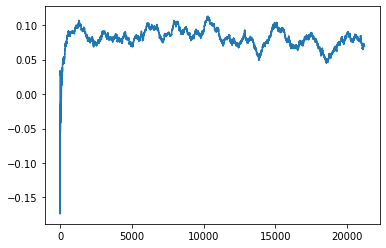

Thread: 2 iteration: 3520
RAM mDiffFit_118 FROM: 2496 --> 1344 reward: -0.006414092578124978
Thread: 3 iteration: 3555
RAM mDiffFit_68 FROM: 1088 --> 384 reward: 0.12064061953124998
Thread: 4 iteration: 3516
RAM mProject_1 FROM: 2112 --> 1344 reward: 0.0458731724765624
Thread: 5 iteration: 3594
RAM mBackground_27 FROM: 256 --> 1344 reward: -0.6842419901406249
Thread: 6 iteration: 3566
RAM mDiffFit_329 FROM: 1920 --> 1344 reward: 0.031960951171875
Thread: 2 iteration: 3521
RAM mBackground_68 FROM: 2240 --> 1344 reward: 0.1405764556328125
Thread: 1 iteration: 3462
RAM mDiffFit_42 FROM: 2880 --> 1344 reward: -0.07363294101562502
Thread: 4 iteration: 3517
RAM mDiffFit_143 FROM: 1408 --> 256 reward: 0.137895753125
Thread: 2 iteration: 3522
RAM mDiffFit_343 FROM: 640 --> 1280 reward: 0.02115110546875
Thread: 4 iteration: 3518
RAM mDiffFit_187 FROM: 1344 --> 192 reward: 0.23308586367187506
Thread: 1 iteration: 3463
RAM mProject_24 FROM: 2752 --> 1344 reward: -0.03127295369531245
Thread: 3 ite

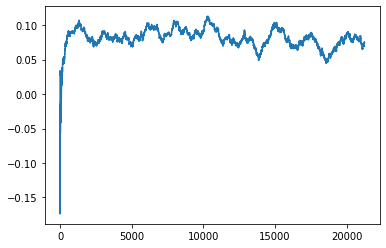

Thread: 4 iteration: 3520
RAM mDiffFit_49 FROM: 2752 --> 1344 reward: -0.025533915234375003
Thread: 6 iteration: 3569
RAM mBackground_46 FROM: 2304 --> 256 reward: -1.0
Thread: 5 iteration: 3595
RAM mBackground_70 FROM: 448 --> 384 reward: 0.07383906720312504
Thread: 4 iteration: 3521
RAM mDiffFit_35 FROM: 256 --> 256 reward: 0.02277084062499997
Saving ...


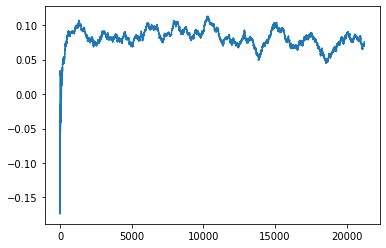

Thread: 6 iteration: 3570
RAM mProject_77 FROM: 1600 --> 1408 reward: 0.05583047646093745
Thread: 2 iteration: 3524
RAM mDiffFit_238 FROM: 128 --> 320 reward: -0.30199219023437496
Thread: 5 iteration: 3596
RAM mDiffFit_193 FROM: 2688 --> 192 reward: 0.2166249125
Thread: 4 iteration: 3522
RAM mDiffFit_236 FROM: 1792 --> 256 reward: 0.163895796875
Thread: 2 iteration: 3525
RAM mDiffFit_246 FROM: 960 --> 1344 reward: -0.011164048828124998
Thread: 5 iteration: 3597
RAM mBackground_36 FROM: 2048 --> 1280 reward: -1.0
Thread: 1 iteration: 3467
RAM mDiffFit_212 FROM: 2048 --> 1344 reward: -0.004718760937500004
Thread: 4 iteration: 3523
RAM mDiffFit_13 FROM: 1856 --> 1344 reward: -0.014958362500000003
Thread: 1 iteration: 3468
RAM mProject_74 FROM: 1600 --> 1280 reward: 0.09796454191406241
Thread: 6 iteration: 3571
RAM mBackground_77 FROM: 1600 --> 192 reward: 0.763917375453125
Thread: 2 iteration: 3526
RAM mDiffFit_323 FROM: 192 --> 192 reward: 0.40527351679687507
Thread: 4 iteration: 3524
RA

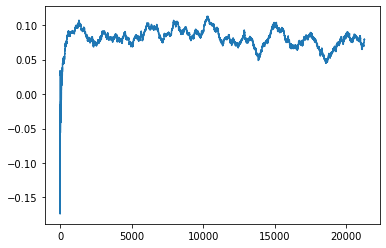

Thread: 1 iteration: 3470
RAM mBackground_8 FROM: 1088 --> 192 reward: 0.6761996017109374
Saving ...


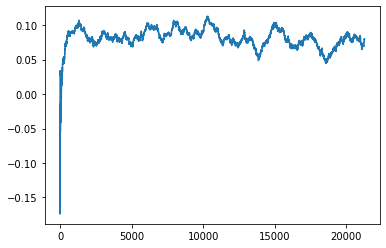

Thread: 3 iteration: 3560
RAM mBackground_53 FROM: 1152 --> 1344 reward: -1.0
Thread: 6 iteration: 3573
RAM mProject_14 FROM: 2624 --> 192 reward: -1.0
Thread: 4 iteration: 3525
RAM mProject_14 FROM: 1984 --> 192 reward: -1.0
Thread: 2 iteration: 3528
RAM mDiffFit_224 FROM: 2944 --> 1280 reward: 0.03067185859375
Thread: 3 iteration: 3561
RAM mDiffFit_354 FROM: 384 --> 2880 reward: -0.15504681484375
Thread: 2 iteration: 3529
RAM mProject_48 FROM: 1216 --> 192 reward: -1.0
Thread: 1 iteration: 3471
RAM mBackground_73 FROM: 960 --> 256 reward: 0.41776733782812503
Thread: 6 iteration: 3574
RAM mDiffFit_183 FROM: 2752 --> 192 reward: 0.6481952441406249
Saving ...


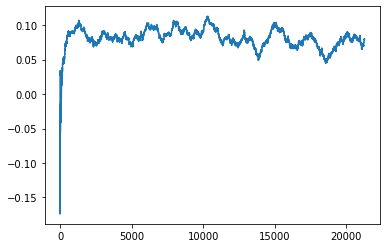

Thread: 2 iteration: 3530
RAM mDiffFit_150 FROM: 1152 --> 192 reward: 0.5904688046875001
Thread: 3 iteration: 3562
RAM mDiffFit_390 FROM: 1472 --> 1344 reward: -0.004057300781250012
Thread: 6 iteration: 3575
RAM mDiffFit_9 FROM: 2496 --> 1344 reward: -0.026937565625
Thread: 2 iteration: 3531
RAM mDiffFit_40 FROM: 704 --> 2624 reward: 0.04488035234375
Thread: 3 iteration: 3563
RAM mDiffFit_86 FROM: 1664 --> 1280 reward: 0.041776061718750014
Thread: 6 iteration: 3576
RAM mProject_40 FROM: 2944 --> 1344 reward: -0.07517287799999996
Thread: 1 iteration: 3472
RAM mDiffFit_260 FROM: 1472 --> 192 reward: 0.21590101796875005
Thread: 3 iteration: 3564
RAM mDiffFit_11 FROM: 1344 --> 1280 reward: -0.083979246875
Thread: 6 iteration: 3577
RAM mBackground_28 FROM: 640 --> 192 reward: 0.5746882459765623
Thread: 2 iteration: 3532
RAM mBackground_32 FROM: 896 --> 192 reward: -1.0
Saving ...


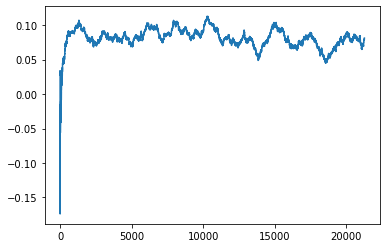

Thread: 5 iteration: 3600
RAM mDiffFit_303 FROM: 2560 --> 1344 reward: -0.028885485937500018
Thread: 3 iteration: 3565
RAM mDiffFit_30 FROM: 2560 --> 192 reward: 0.368434845703125
Thread: 2 iteration: 3533
RAM mDiffFit_64 FROM: 2880 --> 192 reward: 0.56035938046875
Thread: 3 iteration: 3566
RAM mDiffFit_155 FROM: 2048 --> 1280 reward: -0.0011354421874999916
Thread: 2 iteration: 3534
RAM mBackground_33 FROM: 1088 --> 192 reward: -1.0
Thread: 4 iteration: 3526
RAM mProject_49 FROM: 2816 --> 1344 reward: -0.08938584921093752
Thread: 6 iteration: 3578
RAM mDiffFit_404 FROM: 2880 --> 192 reward: 0.27411710273437495
Thread: 3 iteration: 3567
RAM mDiffFit_210 FROM: 640 --> 192 reward: 0.29791146015625
Thread: 4 iteration: 3527
RAM mDiffFit_402 FROM: 1344 --> 1280 reward: 0.0008463496093749981
Thread: 2 iteration: 3535
RAM mProject_27 FROM: 2496 --> 192 reward: -1.0
Thread: 1 iteration: 3473
RAM mProject_66 FROM: 1856 --> 192 reward: -1.0
Thread: 5 iteration: 3601
RAM mDiffFit_140 FROM: 2880 -

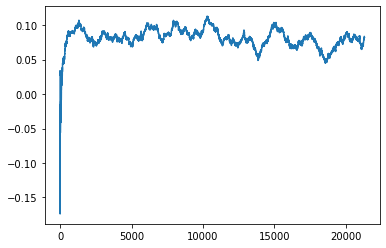

Thread: 6 iteration: 3580
RAM mProject_65 FROM: 1728 --> 192 reward: -1.0
Thread: 1 iteration: 3474
RAM mViewer_3 FROM: 704 --> 1280 reward: -0.12885984555468755
Thread: 6 iteration: 3581
RAM mDiffFit_158 FROM: 2816 --> 1344 reward: 0.4805107921874999
Thread: 2 iteration: 3538
RAM mDiffFit_30 FROM: 256 --> 1280 reward: -0.3080312390625001
Thread: 1 iteration: 3475
RAM mViewer_3 FROM: 2240 --> 192 reward: 0.7330279055859374
Saving ...


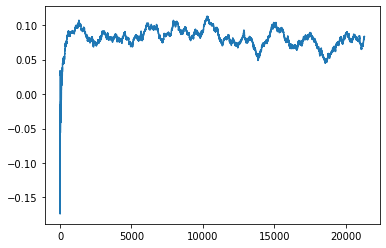

Thread: 4 iteration: 3530
RAM mDiffFit_164 FROM: 2752 --> 1280 reward: -0.06264075078124999
Thread: 6 iteration: 3582
RAM mDiffFit_278 FROM: 320 --> 192 reward: -0.184669357421875
Thread: 2 iteration: 3539
RAM mDiffFit_332 FROM: 1280 --> 1280 reward: 0.013114601562500012
Thread: 6 iteration: 3583
RAM mDiffFit_86 FROM: 2944 --> 1280 reward: -0.010182344531250009
Saving ...


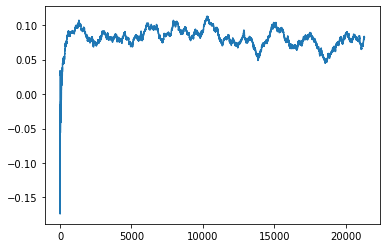

Thread: 2 iteration: 3540
RAM mDiffFit_196 FROM: 2752 --> 256 reward: 0.214690066796875
Thread: 1 iteration: 3476
RAM mBackground_31 FROM: 2688 --> 1344 reward: -1.0
Thread: 5 iteration: 3603
RAM mDiffFit_381 FROM: 3008 --> 1920 reward: -0.07503137031249997
Thread: 4 iteration: 3531
RAM mDiffFit_325 FROM: 1664 --> 192 reward: 0.13026812070312502
Thread: 6 iteration: 3584
RAM mDiffFit_293 FROM: 2048 --> 256 reward: 0.1840103984375
Thread: 2 iteration: 3541
RAM mDiffFit_400 FROM: 2112 --> 192 reward: 0.15564053203125
Thread: 1 iteration: 3477
RAM mDiffFit_142 FROM: 1344 --> 192 reward: 0.5788438046875
Thread: 4 iteration: 3532
RAM mBackground_37 FROM: 1792 --> 256 reward: -1.0
Saving ...


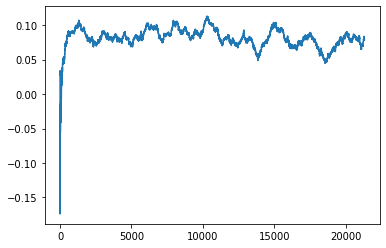

Thread: 3 iteration: 3570
RAM mDiffFit_55 FROM: 384 --> 256 reward: -0.13658340624999993
Thread: 6 iteration: 3585
RAM mDiffFit_94 FROM: 2752 --> 192 reward: 0.4871509742187499
Thread: 1 iteration: 3478
RAM mBackground_20 FROM: 1536 --> 1280 reward: 0.04372563440624999
Thread: 3 iteration: 3571
RAM mDiffFit_235 FROM: 2688 --> 192 reward: 0.20253900507812503
Thread: 6 iteration: 3586
RAM mDiffFit_24 FROM: 320 --> 320 reward: -0.15003650390625
Thread: 1 iteration: 3479
RAM mProject_11 FROM: 576 --> 2560 reward: 0.7734309187500001
Thread: 4 iteration: 3533
RAM mDiffFit_177 FROM: 1600 --> 192 reward: 0.20138017734375
Thread: 6 iteration: 3587
RAM mProject_25 FROM: 448 --> 192 reward: -1.0
Thread: 5 iteration: 3604
RAM mDiffFit_371 FROM: 1344 --> 192 reward: 0.4535390925781251
Thread: 3 iteration: 3572
RAM mProject_70 FROM: 2688 --> 192 reward: -1.0
Thread: 2 iteration: 3542
RAM mDiffFit_282 FROM: 1920 --> 1280 reward: 0.02987499999999999
Thread: 6 iteration: 3588
RAM mDiffFit_162 FROM: 236

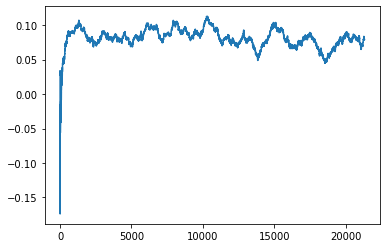

Thread: 1 iteration: 3480
RAM mDiffFit_300 FROM: 2240 --> 1344 reward: -0.025645884374999994
Thread: 4 iteration: 3535
RAM mDiffFit_58 FROM: 1216 --> 256 reward: 0.1989479203125
Thread: 2 iteration: 3543
RAM mDiffFit_72 FROM: 1280 --> 256 reward: 0.26844792031250003
Thread: 6 iteration: 3589
RAM mDiffFit_121 FROM: 2240 --> 192 reward: 0.2275937171875
Thread: 5 iteration: 3606
RAM mDiffFit_417 FROM: 3008 --> 256 reward: 0.442138030859375
Thread: 1 iteration: 3481
RAM mProject_18 FROM: 1728 --> 256 reward: -1.0
Thread: 3 iteration: 3573
RAM mDiffFit_137 FROM: 2496 --> 192 reward: 0.247617146484375
Thread: 4 iteration: 3536
RAM mDiffFit_382 FROM: 1472 --> 1280 reward: -0.04227869414062498
Saving ...


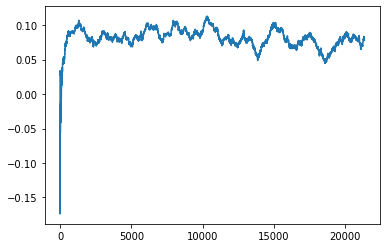

Thread: 6 iteration: 3590
RAM mDiffFit_264 FROM: 896 --> 256 reward: 0.26923960156250004
Thread: 1 iteration: 3482
RAM mBackground_8 FROM: 128 --> 192 reward: 0.9818850389296876
Thread: 2 iteration: 3544
RAM mBackground_79 FROM: 1088 --> 192 reward: 0.7483791164999998
Thread: 5 iteration: 3607
RAM mDiffFit_51 FROM: 192 --> 1280 reward: -0.12429422617187498
Thread: 6 iteration: 3591
RAM mDiffFit_212 FROM: 320 --> 1280 reward: -0.068106748046875
Thread: 1 iteration: 3483
RAM mDiffFit_392 FROM: 2688 --> 192 reward: 0.17704681484374998
Thread: 4 iteration: 3537
RAM mDiffFit_339 FROM: 768 --> 192 reward: 0.45222661445312506
Thread: 3 iteration: 3574
RAM mDiffFit_38 FROM: 1600 --> 1280 reward: -0.022411503906249984
Thread: 2 iteration: 3545
RAM mDiffFit_135 FROM: 2816 --> 192 reward: 0.097465997265625
Thread: 6 iteration: 3592
RAM mDiffFit_325 FROM: 1728 --> 192 reward: 0.26339842929687496
Thread: 5 iteration: 3608
RAM mDiffFit_264 FROM: 256 --> 256 reward: 0.01852084062499995
Thread: 4 iter

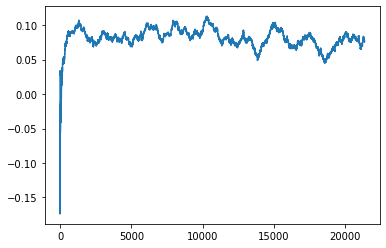

Thread: 4 iteration: 3540
RAM mProject_47 FROM: 2432 --> 192 reward: -1.0
Thread: 2 iteration: 3546
RAM mDiffFit_129 FROM: 2560 --> 192 reward: 0.14155462460937498
Thread: 2 iteration: 3547
RAM mProject_22 FROM: 1792 --> 1344 reward: 0.09409124081250014
Saving ...


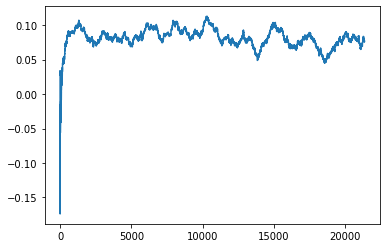

Thread: 5 iteration: 3610
RAM mDiffFit_74 FROM: 320 --> 1408 reward: -0.020788961328125008
Thread: 2 iteration: 3548
RAM mBackground_3 FROM: 1664 --> 1408 reward: 0.05734232615625
Thread: 2 iteration: 3549
RAM mProject_13 FROM: 128 --> 192 reward: -1.0
Thread: 6 iteration: 3594
RAM mProject_36 FROM: 2176 --> 192 reward: -1.0
Thread: 1 iteration: 3486
RAM mBackground_12 FROM: 2304 --> 1280 reward: 0.2516398028125
Saving ...


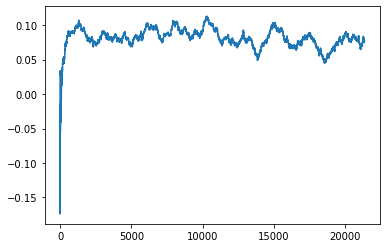

Thread: 2 iteration: 3550
RAM mProject_70 FROM: 2816 --> 320 reward: -1.0
Thread: 4 iteration: 3541
RAM mDiffFit_237 FROM: 2176 --> 704 reward: 0.09833331875000001
Thread: 6 iteration: 3595
RAM mDiffFit_112 FROM: 2944 --> 192 reward: 0.28278637265625006
Thread: 1 iteration: 3487
RAM mDiffFit_153 FROM: 1536 --> 256 reward: 0.21065623906249997
Thread: 1 iteration: 3488
RAM mDiffFit_261 FROM: 1536 --> 192 reward: 0.23898433671875002
Thread: 6 iteration: 3596
RAM mDiffFit_409 FROM: 2880 --> 192 reward: 0.255273385546875
Thread: 6 iteration: 3597
RAM mBackground_81 FROM: 256 --> 256 reward: -0.09682169175000001
Thread: 1 iteration: 3489
RAM mBackground_31 FROM: 1408 --> 192 reward: -1.0
Thread: 3 iteration: 3577
RAM mDiffFit_284 FROM: 2496 --> 448 reward: 0.28947398203125
Thread: 6 iteration: 3598
RAM mBackground_32 FROM: 1152 --> 1280 reward: -1.0
Thread: 2 iteration: 3551
RAM mBackground_49 FROM: 448 --> 256 reward: -1.0
Thread: 5 iteration: 3611
RAM mProject_24 FROM: 1152 --> 256 reward:

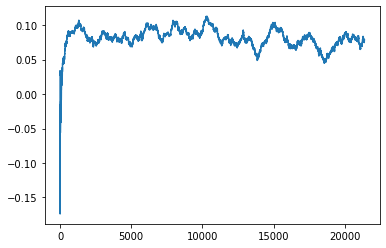

Thread: 6 iteration: 3600
RAM mDiffFit_26 FROM: 1600 --> 192 reward: 0.24708068632812497
Thread: 5 iteration: 3613
RAM mDiffFit_45 FROM: 320 --> 1344 reward: -0.07178382773437499
Thread: 6 iteration: 3601
RAM mDiffFit_183 FROM: 192 --> 256 reward: -0.21463803085937505
Thread: 2 iteration: 3554
RAM mImgtbl_1 FROM: 448 --> 192 reward: -1.0
Saving ...


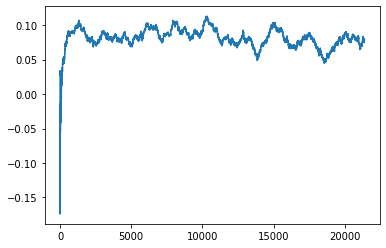

Thread: 1 iteration: 3490
RAM mDiffFit_43 FROM: 1408 --> 192 reward: 0.286268208203125
Thread: 5 iteration: 3614
RAM mDiffFit_235 FROM: 2368 --> 192 reward: 0.19724995624999997
Thread: 2 iteration: 3555
RAM mBackground_74 FROM: 1856 --> 192 reward: 0.8240411935624998
Thread: 6 iteration: 3602
RAM mDiffFit_272 FROM: 960 --> 256 reward: 0.112414048828125
Thread: 1 iteration: 3491
RAM mProject_64 FROM: 2624 --> 192 reward: -1.0
Thread: 4 iteration: 3543
RAM mBackground_79 FROM: 2048 --> 192 reward: 0.7077597379296874
Thread: 5 iteration: 3615
RAM mProject_73 FROM: 1920 --> 192 reward: -1.0
Thread: 3 iteration: 3578
RAM mDiffFit_73 FROM: 2112 --> 256 reward: 0.162997367578125
Thread: 2 iteration: 3556
RAM mBackground_2 FROM: 2048 --> 1280 reward: -0.018830498187500048
Thread: 6 iteration: 3603
RAM mDiffFit_411 FROM: 2048 --> 192 reward: 0.540127544921875
Thread: 1 iteration: 3492
RAM mDiffFit_180 FROM: 1856 --> 256 reward: 0.152268208203125
Thread: 3 iteration: 3579
RAM mDiffFit_287 FROM: 

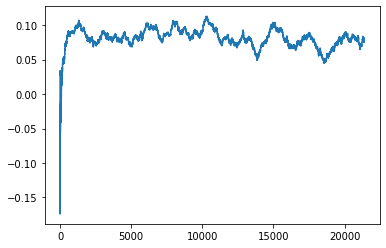

Thread: 3 iteration: 3580
RAM mDiffFit_120 FROM: 1408 --> 192 reward: 0.23829944726562496
Thread: 2 iteration: 3558
RAM mDiffFit_37 FROM: 2944 --> 192 reward: 0.20556243437500005
Thread: 3 iteration: 3581
RAM mProject_84 FROM: 1664 --> 192 reward: -1.0
Thread: 4 iteration: 3544
RAM mDiffFit_393 FROM: 1408 --> 1920 reward: 0.03025526484374999
Thread: 3 iteration: 3582
RAM mDiffFit_43 FROM: 1920 --> 192 reward: 0.08202329804687503
Thread: 3 iteration: 3583
RAM mProject_87 FROM: 1600 --> 256 reward: -1.0
Thread: 6 iteration: 3604
RAM mDiffFit_143 FROM: 448 --> 192 reward: 0.16836719023437502
Thread: 6 iteration: 3605
RAM mDiffFit_96 FROM: 832 --> 256 reward: 0.278398473046875
Thread: 3 iteration: 3584
RAM mDiffFit_288 FROM: 1856 --> 2880 reward: 0.054799578515625016
Thread: 6 iteration: 3606
RAM mProject_26 FROM: 2496 --> 1280 reward: 0.06688153089843751
Thread: 4 iteration: 3545
RAM mProject_35 FROM: 1280 --> 256 reward: -1.0
Thread: 5 iteration: 3616
RAM mDiffFit_364 FROM: 192 --> 256 r

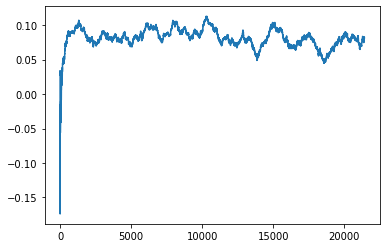

Thread: 2 iteration: 3560
RAM mDiffFit_98 FROM: 1984 --> 192 reward: 0.25742185859375
Thread: 5 iteration: 3617
RAM mDiffFit_44 FROM: 1408 --> 192 reward: 0.375763030859375
Thread: 6 iteration: 3608
RAM mDiffFit_368 FROM: 704 --> 1280 reward: -0.1841250875
Thread: 5 iteration: 3618
RAM mDiffFit_170 FROM: 512 --> 192 reward: 0.22719792031250005
Thread: 4 iteration: 3547
RAM mDiffFit_270 FROM: 1088 --> 320 reward: 0.29594011054687497
Thread: 2 iteration: 3561
RAM mBackground_90 FROM: 3008 --> 256 reward: 0.45365430201562507
Thread: 1 iteration: 3494
RAM mDiffFit_264 FROM: 384 --> 192 reward: 0.12806247812500005
Thread: 6 iteration: 3609
RAM mDiffFit_71 FROM: 128 --> 1280 reward: -0.4369635398437499
Thread: 4 iteration: 3548
RAM mAdd_2 FROM: 1408 --> 1984 reward: -0.0416210294921876
Thread: 1 iteration: 3495
RAM mBackground_87 FROM: 1344 --> 256 reward: 0.501303818109375
Thread: 2 iteration: 3562
RAM mDiffFit_401 FROM: 1344 --> 384 reward: 0.23657814140624997
Thread: 4 iteration: 3549
RAM

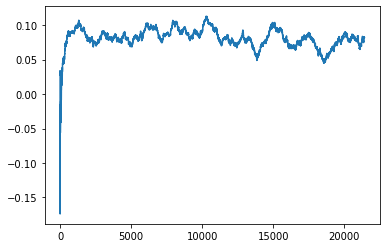

Thread: 6 iteration: 3610
RAM mDiffFit_402 FROM: 384 --> 1408 reward: -0.18514061953125
Thread: 2 iteration: 3563
RAM mDiffFit_91 FROM: 1600 --> 1280 reward: 0.016874999999999998
Thread: 1 iteration: 3496
RAM mDiffFit_285 FROM: 576 --> 1280 reward: -0.035877588671874995
Saving ...


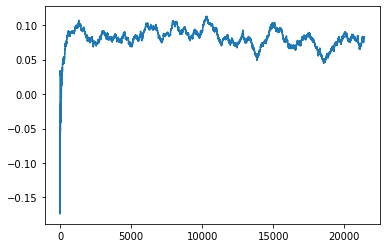

Thread: 4 iteration: 3550
RAM mBackground_49 FROM: 1280 --> 192 reward: -1.0
Thread: 3 iteration: 3585
RAM mDiffFit_134 FROM: 832 --> 192 reward: 0.20684112851562494
Thread: 6 iteration: 3611
RAM mProject_62 FROM: 576 --> 384 reward: -1.0
Thread: 5 iteration: 3619
RAM mDiffFit_216 FROM: 1472 --> 192 reward: 0.1761770359375
Thread: 1 iteration: 3497
RAM mDiffFit_242 FROM: 1280 --> 256 reward: 0.15289579687500002
Thread: 3 iteration: 3586
RAM mDiffFit_135 FROM: 704 --> 1280 reward: -0.0028801773437499983
Saving ...


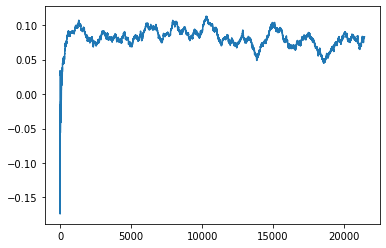

Thread: 5 iteration: 3620
RAM mDiffFit_141 FROM: 1536 --> 256 reward: 0.2309270796875
Thread: 6 iteration: 3612
RAM mBackground_4 FROM: 2496 --> 192 reward: 0.6607956331015624
Thread: 2 iteration: 3564
RAM mDiffFit_339 FROM: 256 --> 256 reward: 0.0649896015625
Thread: 1 iteration: 3498
RAM mDiffFit_249 FROM: 1024 --> 256 reward: 0.20294792031249997
Thread: 2 iteration: 3565
RAM mDiffFit_52 FROM: 1600 --> 192 reward: 0.311075508984375
Thread: 6 iteration: 3613
RAM mBackground_11 FROM: 960 --> 320 reward: 0.3811703606640625
Thread: 5 iteration: 3621
RAM mDiffFit_358 FROM: 1216 --> 192 reward: 0.28927865039062495
Thread: 1 iteration: 3499
RAM mProject_26 FROM: 896 --> 320 reward: -1.0
Thread: 4 iteration: 3551
RAM mDiffFit_207 FROM: 2944 --> 192 reward: 0.204562434375
Thread: 2 iteration: 3566
RAM mDiffFit_78 FROM: 1728 --> 192 reward: 0.16070309765624996
Thread: 6 iteration: 3614
RAM mDiffFit_365 FROM: 640 --> 256 reward: 0.06855725703124996
Thread: 5 iteration: 3622
RAM mDiffFit_303 FRO

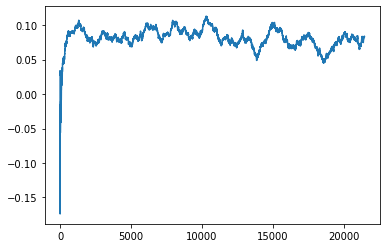

Thread: 1 iteration: 3500
RAM mProject_1 FROM: 1920 --> 256 reward: -1.0
Thread: 3 iteration: 3587
RAM mBackground_17 FROM: 2304 --> 2880 reward: 0.08690716528906248
Thread: 5 iteration: 3623
RAM mDiffFit_371 FROM: 2048 --> 192 reward: 0.46246353984374994
Thread: 2 iteration: 3567
RAM mDiffFit_129 FROM: 2688 --> 1920 reward: 0.0075156195312500035
Thread: 3 iteration: 3588
RAM mBackground_63 FROM: 1664 --> 192 reward: 0.7615501115703124
Thread: 1 iteration: 3501
RAM mDiffFit_330 FROM: 1408 --> 256 reward: 0.14980725703125
Thread: 2 iteration: 3568
RAM mDiffFit_232 FROM: 704 --> 1280 reward: -0.049270840625
Thread: 1 iteration: 3502
RAM mDiffFit_56 FROM: 1664 --> 256 reward: 0.29048429296875
Thread: 3 iteration: 3589
RAM mDiffFit_50 FROM: 1024 --> 192 reward: 0.6466562828125001
Thread: 5 iteration: 3624
RAM mProject_49 FROM: 2944 --> 192 reward: -1.0
Thread: 6 iteration: 3615
RAM mDiffFit_266 FROM: 2944 --> 192 reward: 0.5245623906250001
Thread: 2 iteration: 3569
RAM mDiffFit_21 FROM: 28

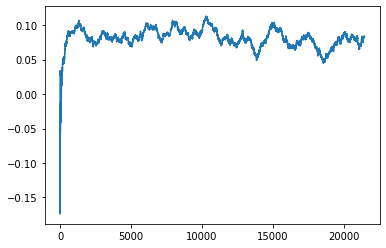

Thread: 3 iteration: 3590
RAM mDiffFit_152 FROM: 2688 --> 1984 reward: 0.01307550898437499
Thread: 6 iteration: 3616
RAM mDiffFit_319 FROM: 576 --> 192 reward: 0.31606252187500006
Saving ...


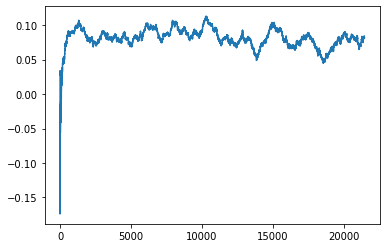

Thread: 2 iteration: 3570
RAM mDiffFit_42 FROM: 128 --> 192 reward: -0.6059167249999999
Thread: 5 iteration: 3626
RAM mDiffFit_113 FROM: 3008 --> 256 reward: 0.3244321695312501
Thread: 1 iteration: 3504
RAM mDiffFit_294 FROM: 128 --> 192 reward: -0.7585521671875001
Thread: 6 iteration: 3617
RAM mBackground_51 FROM: 1408 --> 192 reward: -1.0
Thread: 4 iteration: 3552
RAM mDiffFit_305 FROM: 1664 --> 1280 reward: 0.01616146015625001
Thread: 5 iteration: 3627
RAM mDiffFit_13 FROM: 2304 --> 192 reward: 0.24157801015625002
Thread: 2 iteration: 3571
RAM mDiffFit_154 FROM: 2688 --> 192 reward: 0.2159061953125
Thread: 1 iteration: 3505
RAM mDiffFit_268 FROM: 768 --> 192 reward: 0.22302342929687502
Thread: 6 iteration: 3618
RAM mBackground_18 FROM: 1856 --> 256 reward: 0.5087974247499999
Thread: 4 iteration: 3553
RAM mBackground_3 FROM: 704 --> 1280 reward: -0.11158050985937497
Thread: 5 iteration: 3628
RAM mProject_7 FROM: 2880 --> 192 reward: -1.0
Thread: 3 iteration: 3591
RAM mDiffFit_210 FRO

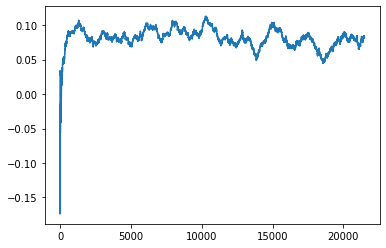

Thread: 6 iteration: 3620
RAM mDiffFit_176 FROM: 448 --> 448 reward: 0.09314066328125004
Thread: 2 iteration: 3576
RAM mDiffFit_371 FROM: 1408 --> 1280 reward: 0.003479159374999985
Thread: 3 iteration: 3595
RAM mProject_13 FROM: 1216 --> 192 reward: -1.0
Thread: 1 iteration: 3508
RAM mDiffFit_176 FROM: 1728 --> 2240 reward: 0.02612504374999998
Thread: 4 iteration: 3557
RAM mDiffFit_14 FROM: 512 --> 1152 reward: 0.04401570703125003
Thread: 1 iteration: 3509
RAM mDiffFit_174 FROM: 512 --> 192 reward: 0.001028562890625015
Thread: 4 iteration: 3558
RAM mBackground_47 FROM: 640 --> 256 reward: -1.0
Saving ...


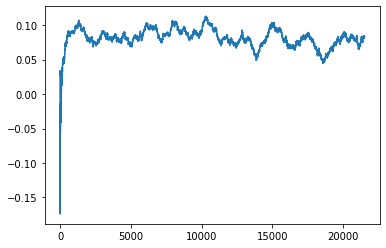

Thread: 5 iteration: 3630
RAM mDiffFit_112 FROM: 2112 --> 192 reward: 0.25613276601562496
Thread: 4 iteration: 3559
RAM mDiffFit_8 FROM: 128 --> 192 reward: -0.18115365039062503
Thread: 5 iteration: 3631
RAM mViewer_4 FROM: 1344 --> 256 reward: 1.4108375966953126
Thread: 6 iteration: 3621
RAM mDiffFit_399 FROM: 1728 --> 1280 reward: 0.0018541593750000078
Saving ...


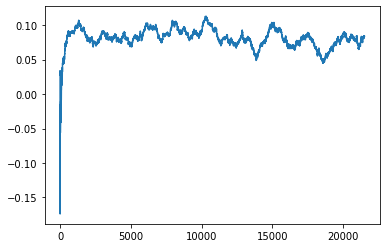

Thread: 4 iteration: 3560
RAM mDiffFit_331 FROM: 2752 --> 320 reward: 0.18963017734375004
Thread: 5 iteration: 3632
RAM mProject_15 FROM: 1984 --> 1920 reward: -0.025467693820312377
Saving ...


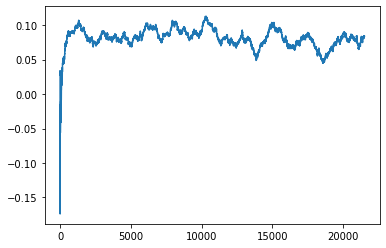

Thread: 1 iteration: 3510
RAM mProject_87 FROM: 2176 --> 256 reward: -1.0
Thread: 3 iteration: 3596
RAM mDiffFit_256 FROM: 2432 --> 192 reward: 0.28945309765624994
Thread: 6 iteration: 3622
RAM mDiffFit_369 FROM: 384 --> 2880 reward: -0.01020301015624999
Thread: 5 iteration: 3633
RAM mDiffFit_1 FROM: 896 --> 1408 reward: 0.016354203125
Thread: 5 iteration: 3634
RAM mBackground_77 FROM: 2944 --> 256 reward: 0.42324968732812496
Thread: 4 iteration: 3561
RAM mDiffFit_371 FROM: 384 --> 1280 reward: -0.15341668125000002
Thread: 5 iteration: 3635
RAM mBackground_70 FROM: 2432 --> 832 reward: 0.12398327062500002
Thread: 4 iteration: 3562
RAM mDiffFit_225 FROM: 896 --> 256 reward: 0.1935729203125
Thread: 5 iteration: 3636
RAM mProject_78 FROM: 1408 --> 1344 reward: 0.01480968323437497
Thread: 1 iteration: 3511
RAM mProject_11 FROM: 2240 --> 2496 reward: 0.03859461541406255
Thread: 6 iteration: 3623
RAM mDiffFit_148 FROM: 896 --> 1280 reward: -0.022697920312500005
Thread: 4 iteration: 3563
RAM 

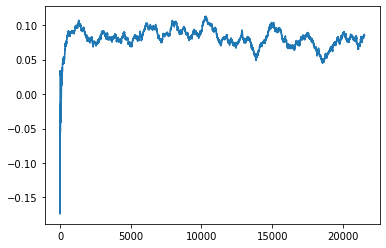

Thread: 5 iteration: 3640
RAM mDiffFit_155 FROM: 192 --> 1984 reward: -0.2206770359375
Thread: 1 iteration: 3515
RAM mDiffFit_242 FROM: 512 --> 832 reward: 0.06659902578124999
Thread: 6 iteration: 3625
RAM mDiffFit_193 FROM: 512 --> 192 reward: 0.298187521875
Thread: 4 iteration: 3566
RAM mAdd_1 FROM: 2880 --> 256 reward: -1.0
Thread: 2 iteration: 3578
RAM mDiffFit_170 FROM: 1280 --> 320 reward: 0.225729203125
Thread: 1 iteration: 3516
RAM mBackground_5 FROM: 2944 --> 1408 reward: -0.039707948890625046
Thread: 4 iteration: 3567
RAM mDiffFit_4 FROM: 192 --> 256 reward: 0.08403128281249998
Thread: 6 iteration: 3626
RAM mDiffFit_298 FROM: 1664 --> 192 reward: 0.24307283281250003
Thread: 5 iteration: 3641
RAM mDiffFit_39 FROM: 1856 --> 256 reward: 0.20530988945312498
Thread: 2 iteration: 3579
RAM mProject_81 FROM: 2880 --> 256 reward: -1.0
Saving ...


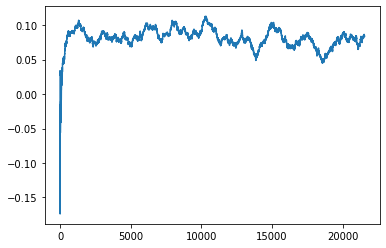

Thread: 3 iteration: 3600
RAM mDiffFit_181 FROM: 2368 --> 320 reward: 0.05425767851562499
Thread: 6 iteration: 3627
RAM mDiffFit_333 FROM: 2112 --> 1280 reward: 0.005841128515624997
Saving ...


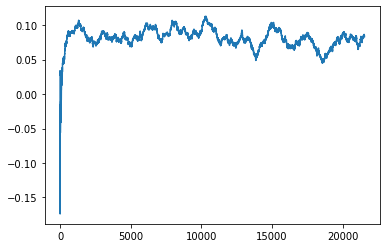

Thread: 2 iteration: 3580
RAM mDiffFit_116 FROM: 2432 --> 192 reward: 0.1554478328125
Thread: 3 iteration: 3601
RAM mDiffFit_49 FROM: 1024 --> 192 reward: 0.32155730078125005
Thread: 2 iteration: 3581
RAM mDiffFit_29 FROM: 1856 --> 192 reward: 0.36724477890624996
Thread: 3 iteration: 3602
RAM mBackground_79 FROM: 2816 --> 192 reward: 0.6957084937656249
Thread: 6 iteration: 3628
RAM mProject_31 FROM: 1280 --> 320 reward: -1.0
Thread: 4 iteration: 3568
RAM mProject_74 FROM: 192 --> 256 reward: -1.0
Thread: 5 iteration: 3642
RAM mDiffFit_398 FROM: 2048 --> 192 reward: 0.315924447265625
Thread: 2 iteration: 3582
RAM mDiffFit_338 FROM: 2944 --> 256 reward: -1.25343431328125
Thread: 3 iteration: 3603
RAM mDiffFit_246 FROM: 2816 --> 192 reward: 0.19917181484375002
Thread: 4 iteration: 3569
RAM mProject_41 FROM: 832 --> 1920 reward: 0.640283169375
Thread: 6 iteration: 3629
RAM mDiffFit_161 FROM: 2944 --> 256 reward: 0.29164584062500004
Thread: 3 iteration: 3604
RAM mDiffFit_215 FROM: 640 --> 2

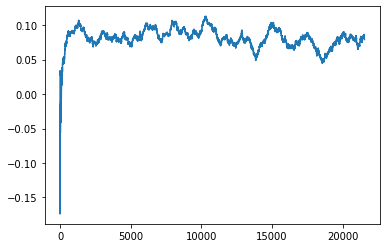

Thread: 4 iteration: 3570
RAM mProject_52 FROM: 1536 --> 192 reward: -1.0
Thread: 1 iteration: 3517
RAM mDiffFit_31 FROM: 1600 --> 192 reward: 0.396929712109375
Thread: 1 iteration: 3518
RAM mDiffFit_66 FROM: 512 --> 320 reward: 0.17692449101562505
Thread: 4 iteration: 3571
RAM mAdd_3 FROM: 2048 --> 192 reward: -1.0
Thread: 5 iteration: 3643
RAM mProject_2 FROM: 1664 --> 1920 reward: -0.020464662234375108
Thread: 3 iteration: 3605
RAM mBackground_18 FROM: 192 --> 320 reward: -0.3623287311875002
Thread: 4 iteration: 3572
RAM mDiffFit_38 FROM: 896 --> 256 reward: 0.3544270796875001
Thread: 5 iteration: 3644
RAM mDiffFit_122 FROM: 2816 --> 832 reward: 0.0422395578125
Thread: 5 iteration: 3645
RAM mProject_70 FROM: 1280 --> 320 reward: -1.0
Saving ...


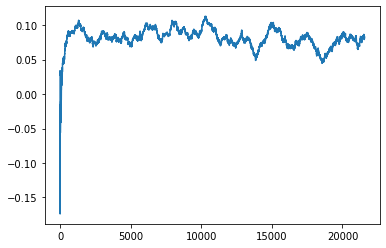

Thread: 6 iteration: 3630
RAM mDiffFit_251 FROM: 3008 --> 256 reward: 0.16015615156249996
Thread: 6 iteration: 3631
RAM mDiffFit_417 FROM: 1280 --> 256 reward: 0.20807292031250002
Thread: 5 iteration: 3646
RAM mProject_44 FROM: 2176 --> 256 reward: -1.0
Thread: 1 iteration: 3519
RAM mDiffFit_381 FROM: 2048 --> 192 reward: 0.2981562390625
Thread: 6 iteration: 3632
RAM mBackground_48 FROM: 2560 --> 192 reward: -1.0
Thread: 2 iteration: 3583
RAM mProject_12 FROM: 1536 --> 192 reward: -1.0
Thread: 3 iteration: 3606
RAM mDiffFit_307 FROM: 192 --> 192 reward: 0.12705471210937497
Thread: 5 iteration: 3647
RAM mProject_15 FROM: 1984 --> 256 reward: -1.0
Thread: 4 iteration: 3573
RAM mBackground_2 FROM: 832 --> 192 reward: 0.6933010819921875
Thread: 6 iteration: 3633
RAM mDiffFit_33 FROM: 2368 --> 832 reward: 0.013398385546874985
Thread: 3 iteration: 3607
RAM mDiffFit_332 FROM: 1728 --> 192 reward: 0.28825780976562504
Thread: 2 iteration: 3584
RAM mDiffFit_370 FROM: 1984 --> 256 reward: 0.17642

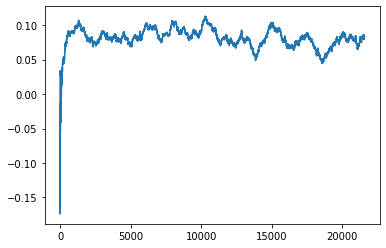

Thread: 1 iteration: 3520
RAM mBackground_71 FROM: 128 --> 256 reward: 0.7564956110625001
Thread: 2 iteration: 3585
RAM mDiffFit_104 FROM: 128 --> 192 reward: -0.22269011054687496
Saving ...


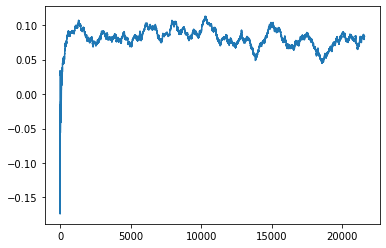

Thread: 5 iteration: 3650
RAM mDiffFit_421 FROM: 320 --> 192 reward: 0.26311982265625
Thread: 1 iteration: 3521
RAM mBackground_2 FROM: 1600 --> 192 reward: 0.7079367410468749
Thread: 3 iteration: 3609
RAM mDiffFit_395 FROM: 1344 --> 192 reward: 0.34385152695312504
Thread: 5 iteration: 3651
RAM mDiffFit_343 FROM: 1856 --> 256 reward: 0.178039048828125
Saving ...


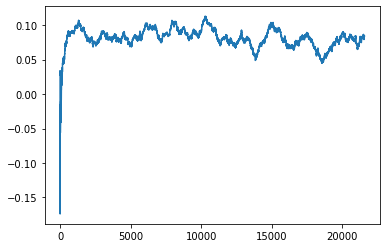

Thread: 3 iteration: 3610
RAM mDiffFit_201 FROM: 1024 --> 192 reward: 0.30683331875
Thread: 3 iteration: 3611
RAM mProject_72 FROM: 1344 --> 192 reward: -1.0
Thread: 6 iteration: 3635
RAM mDiffFit_160 FROM: 1472 --> 256 reward: 0.15098170429687502
Thread: 3 iteration: 3612
RAM mProject_58 FROM: 1984 --> 320 reward: -1.0
Thread: 1 iteration: 3522
RAM mBackground_46 FROM: 576 --> 320 reward: -1.0
Thread: 2 iteration: 3586
RAM mProject_47 FROM: 2624 --> 192 reward: -1.0
Thread: 5 iteration: 3652
RAM mDiffFit_342 FROM: 384 --> 192 reward: 0.253937521875
Thread: 2 iteration: 3587
RAM mBgModel_3 FROM: 1664 --> 256 reward: 0.8777687434375001
Thread: 3 iteration: 3613
RAM mDiffFit_324 FROM: 1152 --> 192 reward: 0.359812521875
Thread: 5 iteration: 3653
RAM mDiffFit_205 FROM: 704 --> 256 reward: 0.129966128515625
Thread: 2 iteration: 3588
RAM mBackground_53 FROM: 2752 --> 192 reward: -1.0
Thread: 4 iteration: 3576
RAM mProject_73 FROM: 768 --> 384 reward: -1.0
Thread: 6 iteration: 3636
RAM mDiff

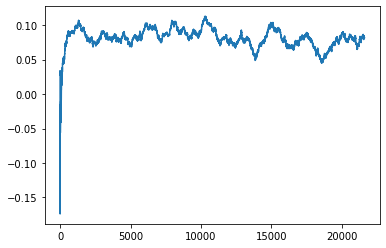

Thread: 2 iteration: 3590
RAM mDiffFit_109 FROM: 384 --> 192 reward: 0.19971876093750002
Thread: 3 iteration: 3615
RAM mDiffFit_261 FROM: 960 --> 192 reward: 0.286226570703125
Thread: 4 iteration: 3578
RAM mDiffFit_200 FROM: 960 --> 256 reward: 0.6124219460937499
Thread: 1 iteration: 3524
RAM mDiffFit_244 FROM: 2752 --> 256 reward: 0.274231748046875
Thread: 2 iteration: 3591
RAM mDiffFit_190 FROM: 1792 --> 256 reward: 0.220875
Thread: 3 iteration: 3616
RAM mDiffFit_296 FROM: 448 --> 192 reward: 0.21433595117187507
Thread: 4 iteration: 3579
RAM mBackground_9 FROM: 1216 --> 256 reward: 0.72832148028125
Thread: 1 iteration: 3525
RAM mDiffFit_216 FROM: 1600 --> 192 reward: 0.189762987109375
Thread: 2 iteration: 3592
RAM mDiffFit_72 FROM: 2560 --> 256 reward: 0.16387495625
Thread: 3 iteration: 3617
RAM mProject_77 FROM: 2816 --> 192 reward: -1.0
Thread: 6 iteration: 3638
RAM mDiffFit_387 FROM: 1536 --> 832 reward: 0.03808331875000001
Thread: 2 iteration: 3593
RAM mDiffFit_184 FROM: 2816 -->

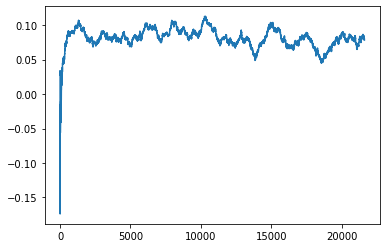

Thread: 4 iteration: 3580
RAM mDiffFit_170 FROM: 384 --> 192 reward: 0.19196876093750004
Thread: 3 iteration: 3619
RAM mDiffFit_399 FROM: 2176 --> 256 reward: 0.2068019921875
Thread: 4 iteration: 3581
RAM mDiffFit_418 FROM: 2688 --> 192 reward: 0.25787495625
Saving ...


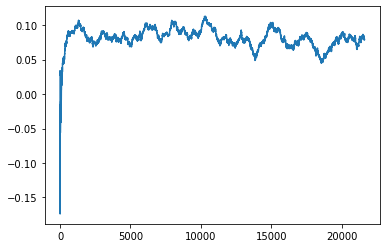

Thread: 3 iteration: 3620
RAM mAdd_2 FROM: 1600 --> 256 reward: -1.0
Thread: 5 iteration: 3654
RAM mProject_16 FROM: 1856 --> 192 reward: -1.0
Thread: 6 iteration: 3639
RAM mDiffFit_417 FROM: 512 --> 192 reward: 0.18344011054687498
Saving ...


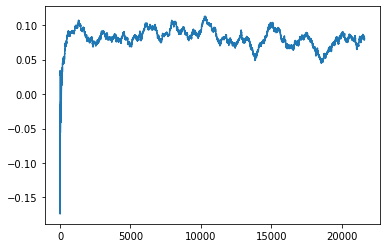

Thread: 6 iteration: 3640
RAM mProject_36 FROM: 1536 --> 1344 reward: 0.03673967273437488
Thread: 3 iteration: 3621
RAM mDiffFit_104 FROM: 1728 --> 256 reward: 0.536221437109375
Thread: 6 iteration: 3641
RAM mProject_87 FROM: 1472 --> 256 reward: -1.0
Thread: 4 iteration: 3582
RAM mDiffFit_135 FROM: 832 --> 256 reward: 0.45997143710937505
Thread: 3 iteration: 3622
RAM mDiffFit_39 FROM: 1280 --> 256 reward: 0.16193747812499998
Thread: 6 iteration: 3642
RAM mBackground_40 FROM: 1728 --> 256 reward: -1.0
Thread: 1 iteration: 3527
RAM mProject_80 FROM: 1216 --> 256 reward: -1.0
Thread: 5 iteration: 3655
RAM mDiffFit_152 FROM: 2944 --> 2240 reward: 0.06368756562499997
Thread: 6 iteration: 3643
RAM mDiffFit_7 FROM: 640 --> 192 reward: 0.13363017734375
Thread: 4 iteration: 3583
RAM mBackground_10 FROM: 2880 --> 256 reward: 0.451970147890625
Thread: 3 iteration: 3623
RAM mBackground_37 FROM: 128 --> 192 reward: -1.0
Thread: 2 iteration: 3595
RAM mDiffFit_232 FROM: 2624 --> 256 reward: 0.192411

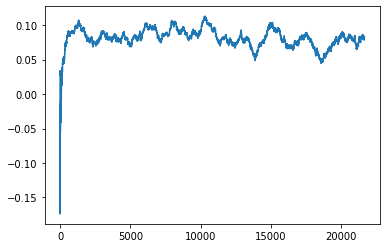

Thread: 1 iteration: 3530
RAM mDiffFit_299 FROM: 1728 --> 192 reward: 0.4780234730468749
Thread: 5 iteration: 3657
RAM mProject_15 FROM: 1024 --> 192 reward: -1.0
Thread: 4 iteration: 3584
RAM mDiffFit_12 FROM: 1984 --> 256 reward: 0.232971349609375
Thread: 6 iteration: 3646
RAM mDiffFit_30 FROM: 2496 --> 192 reward: 0.290085907421875
Thread: 2 iteration: 3598
RAM mDiffFit_412 FROM: 1088 --> 256 reward: 0.133304668359375
Thread: 5 iteration: 3658
RAM mDiffFit_131 FROM: 2496 --> 192 reward: 0.19760148320312498
Thread: 4 iteration: 3585
RAM mDiffFit_95 FROM: 1152 --> 192 reward: 0.254210951171875
Thread: 6 iteration: 3647
RAM mDiffFit_383 FROM: 2624 --> 192 reward: 0.29090097421875005
Thread: 2 iteration: 3599
RAM mBackground_23 FROM: 640 --> 256 reward: 0.3197811066406249
Thread: 1 iteration: 3531
RAM mBackground_49 FROM: 2880 --> 256 reward: -1.0
Thread: 3 iteration: 3624
RAM mDiffFit_202 FROM: 1088 --> 256 reward: 0.181346349609375
Thread: 5 iteration: 3659
RAM mDiffFit_368 FROM: 2112

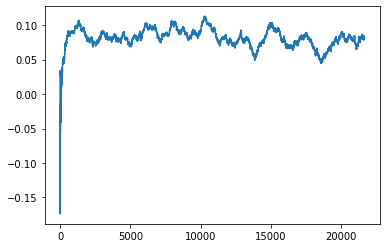

Thread: 2 iteration: 3600
RAM mDiffFit_348 FROM: 2560 --> 2624 reward: 0.03567712343750003
Saving ...


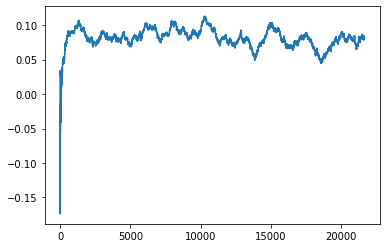

Thread: 6 iteration: 3650
RAM mDiffFit_241 FROM: 1408 --> 192 reward: 0.17171349609374997
Thread: 4 iteration: 3588
RAM mDiffFit_338 FROM: 1216 --> 192 reward: 0.2436770796875
Thread: 1 iteration: 3534
RAM mProject_38 FROM: 704 --> 192 reward: -1.0
Saving ...


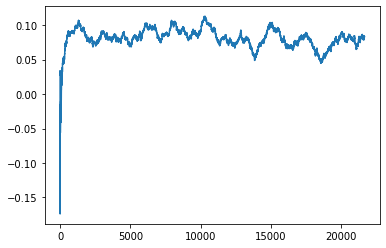

Thread: 5 iteration: 3660
RAM mDiffFit_341 FROM: 256 --> 320 reward: -0.014729159374999995
Thread: 2 iteration: 3601
RAM mDiffFit_322 FROM: 2944 --> 192 reward: 0.2564061953125
Thread: 4 iteration: 3589
RAM mBackground_29 FROM: 1728 --> 320 reward: 0.4370210819921874
Thread: 1 iteration: 3535
RAM mDiffFit_268 FROM: 2752 --> 192 reward: 0.20991400507812502
Thread: 5 iteration: 3661
RAM mDiffFit_264 FROM: 576 --> 192 reward: 0.25673438046875
Thread: 2 iteration: 3602
RAM mDiffFit_104 FROM: 2560 --> 192 reward: 0.24724214648437504
Thread: 1 iteration: 3536
RAM mDiffFit_99 FROM: 2240 --> 256 reward: 0.38575
Saving ...


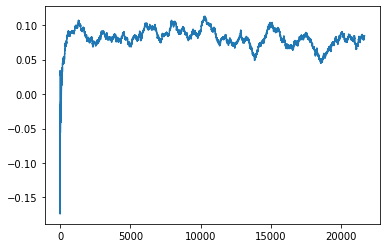

Thread: 4 iteration: 3590
RAM mDiffFit_162 FROM: 2752 --> 256 reward: 0.32752342929687506
Thread: 5 iteration: 3662
RAM mDiffFit_168 FROM: 704 --> 192 reward: 0.25879426992187504
Thread: 2 iteration: 3603
RAM mDiffFit_227 FROM: 1344 --> 320 reward: -0.007593848437499988
Thread: 5 iteration: 3663
RAM mProject_50 FROM: 2432 --> 256 reward: -1.0
Thread: 6 iteration: 3651
RAM mBackground_85 FROM: 1984 --> 192 reward: 0.7033477854140624
Thread: 4 iteration: 3591
RAM mBackground_82 FROM: 2816 --> 192 reward: 0.7712406953750001
Thread: 1 iteration: 3537
RAM mDiffFit_26 FROM: 2432 --> 192 reward: 0.27759371718750003
Thread: 2 iteration: 3604
RAM mDiffFit_38 FROM: 2624 --> 256 reward: 0.43727070937499996
Thread: 6 iteration: 3652
RAM mDiffFit_148 FROM: 1792 --> 256 reward: 0.22013539843750002
Thread: 4 iteration: 3592
RAM mBackground_52 FROM: 2944 --> 192 reward: -1.0
Thread: 3 iteration: 3627
RAM mDiffFit_259 FROM: 512 --> 256 reward: -0.021687565624999988
Thread: 1 iteration: 3538
RAM mDiffFi

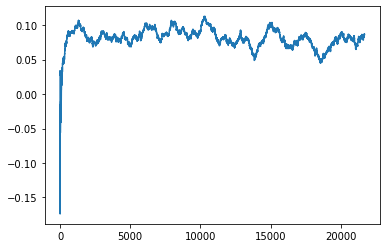

Thread: 1 iteration: 3540
RAM mProject_48 FROM: 384 --> 256 reward: -1.0
Thread: 5 iteration: 3666
RAM mBackground_51 FROM: 256 --> 256 reward: -1.0
Thread: 6 iteration: 3654
RAM mDiffFit_271 FROM: 2688 --> 320 reward: 0.115020753125
Thread: 2 iteration: 3608
RAM mDiffFit_198 FROM: 384 --> 192 reward: 0.06980466835937502
Thread: 4 iteration: 3598
RAM mDiffFit_163 FROM: 2880 --> 256 reward: 0.14272907187499997
Thread: 1 iteration: 3541
RAM mDiffFit_200 FROM: 2176 --> 256 reward: 0.37707805390625004
Saving ...


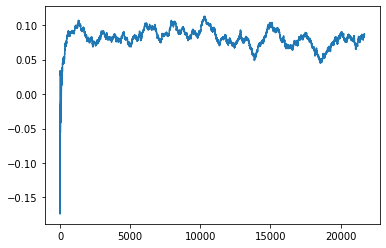

Thread: 3 iteration: 3630
RAM mDiffFit_194 FROM: 2112 --> 256 reward: 0.16506761171874998
Thread: 6 iteration: 3655
RAM mDiffFit_280 FROM: 2880 --> 256 reward: 0.12340615156249997
Thread: 3 iteration: 3631
RAM mDiffFit_68 FROM: 896 --> 256 reward: 0.17773438046875
Thread: 4 iteration: 3599
RAM mDiffFit_216 FROM: 1024 --> 256 reward: 0.44715632656250004
Thread: 1 iteration: 3542
RAM mBackground_66 FROM: 2368 --> 320 reward: 0.3386181331015625
Thread: 2 iteration: 3609
RAM mDiffFit_118 FROM: 2240 --> 256 reward: 0.20592966835937498
Thread: 6 iteration: 3656
RAM mDiffFit_197 FROM: 1472 --> 192 reward: 0.21052601796875
Thread: 1 iteration: 3543
RAM mDiffFit_271 FROM: 576 --> 2048 reward: 0.070122542578125
Saving ...


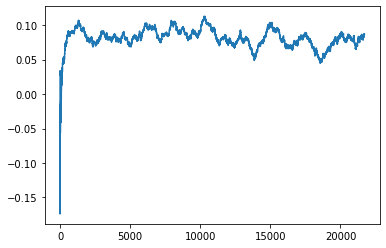

Thread: 2 iteration: 3610
RAM mDiffFit_385 FROM: 768 --> 320 reward: -0.006789136328124966
Saving ...


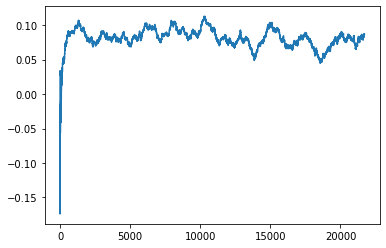

Thread: 4 iteration: 3600
RAM mDiffFit_48 FROM: 384 --> 2240 reward: -0.04029159375000001
Thread: 2 iteration: 3611
RAM mDiffFit_403 FROM: 1984 --> 256 reward: 0.1566770359375
Thread: 6 iteration: 3657
RAM mBackground_11 FROM: 2496 --> 1920 reward: 0.012987313179687524
Thread: 2 iteration: 3612
RAM mDiffFit_51 FROM: 2304 --> 256 reward: 0.1774166375
Thread: 2 iteration: 3613
RAM mBackground_60 FROM: 192 --> 256 reward: -1.0
Thread: 5 iteration: 3667
RAM mDiffFit_69 FROM: 960 --> 768 reward: -0.19057827265624994
Thread: 2 iteration: 3614
RAM mDiffFit_269 FROM: 1152 --> 256 reward: 0.10375517734375003
Thread: 2 iteration: 3615
RAM mProject_27 FROM: 2944 --> 256 reward: -1.0
Thread: 1 iteration: 3544
RAM mDiffFit_172 FROM: 384 --> 256 reward: -0.13795840624999997
Thread: 2 iteration: 3616
RAM mBackground_80 FROM: 896 --> 256 reward: 0.58024919175
Thread: 5 iteration: 3668
RAM mProject_73 FROM: 192 --> 256 reward: -1.0
Thread: 4 iteration: 3601
RAM mBackground_33 FROM: 2176 --> 256 reward:

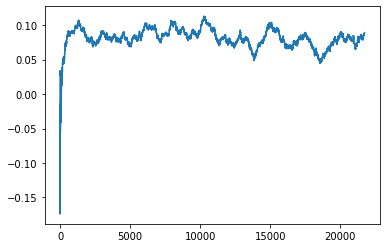

Thread: 5 iteration: 3670
RAM mBackground_2 FROM: 2240 --> 256 reward: 0.524783569015625
Saving ...


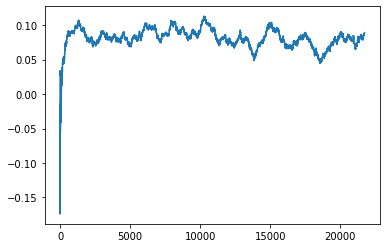

Thread: 6 iteration: 3660
RAM mDiffFit_152 FROM: 320 --> 256 reward: 0.27197661445312493
Thread: 4 iteration: 3604
RAM mDiffFit_300 FROM: 2688 --> 192 reward: 0.070257634765625
Thread: 5 iteration: 3671
RAM mDiffFit_82 FROM: 3008 --> 256 reward: 0.12765878398437502
Thread: 6 iteration: 3661
RAM mDiffFit_346 FROM: 1088 --> 256 reward: 0.305851483203125
Thread: 4 iteration: 3605
RAM mDiffFit_220 FROM: 1408 --> 320 reward: 0.13301557578124998
Thread: 5 iteration: 3672
RAM mAdd_3 FROM: 1600 --> 256 reward: -1.0
Thread: 2 iteration: 3618
RAM mProject_39 FROM: 192 --> 1408 reward: 0.7293268996875
Thread: 1 iteration: 3547
RAM mBackground_67 FROM: 1664 --> 256 reward: 0.5092095018124999
Thread: 6 iteration: 3662
RAM mBackground_22 FROM: 2688 --> 256 reward: 0.49670361831250004
Thread: 4 iteration: 3606
RAM mDiffFit_52 FROM: 2112 --> 256 reward: 0.147049447265625
Thread: 5 iteration: 3673
RAM mDiffFit_309 FROM: 704 --> 256 reward: 0.1297812390625
Thread: 2 iteration: 3619
RAM mDiffFit_294 FROM

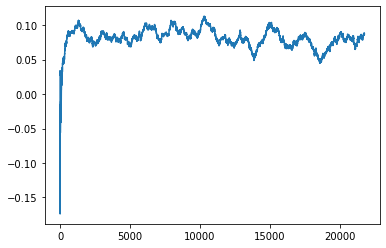

Thread: 2 iteration: 3620
RAM mDiffFit_40 FROM: 2944 --> 256 reward: 0.13472389453124997
Thread: 5 iteration: 3675
RAM mProject_29 FROM: 1536 --> 2880 reward: 0.14724320526562498
Thread: 6 iteration: 3663
RAM mDiffFit_243 FROM: 832 --> 256 reward: 0.10583849609375001
Thread: 3 iteration: 3635
RAM mDiffFit_337 FROM: 2624 --> 256 reward: 0.3497993597656251
Thread: 1 iteration: 3549
RAM mBackground_69 FROM: 896 --> 256 reward: 0.5204881344062501
Thread: 2 iteration: 3621
RAM mDiffFit_44 FROM: 1920 --> 256 reward: 0.19994269921875
Thread: 5 iteration: 3676
RAM mDiffFit_42 FROM: 896 --> 256 reward: 0.15791146015625002
Thread: 6 iteration: 3664
RAM mDiffFit_241 FROM: 2688 --> 256 reward: 0.14137491249999998
Thread: 3 iteration: 3636
RAM mDiffFit_110 FROM: 1984 --> 256 reward: 0.17087495625000002
Saving ...


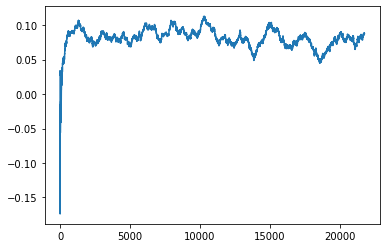

Thread: 1 iteration: 3550
RAM mBackground_22 FROM: 192 --> 256 reward: -0.35309497535156253
Thread: 2 iteration: 3622
RAM mDiffFit_284 FROM: 2432 --> 256 reward: 0.18620827499999998
Thread: 2 iteration: 3623
RAM mBackground_19 FROM: 3008 --> 256 reward: 0.36470244809375013
Thread: 1 iteration: 3551
RAM mBackground_36 FROM: 2880 --> 256 reward: -1.0
Thread: 4 iteration: 3607
RAM mDiffFit_169 FROM: 2304 --> 320 reward: 0.14861455781250002
Thread: 2 iteration: 3624
RAM mDiffFit_224 FROM: 3008 --> 1408 reward: -0.020921946093750005
Thread: 2 iteration: 3625
RAM mDiffFit_364 FROM: 320 --> 256 reward: 0.05557292031250001
Thread: 1 iteration: 3552
RAM mDiffFit_125 FROM: 2752 --> 1408 reward: 6.506679687502334e-05
Thread: 1 iteration: 3553
RAM mDiffFit_324 FROM: 2240 --> 192 reward: 0.19630199218750002
Thread: 2 iteration: 3626
RAM mProject_22 FROM: 2816 --> 256 reward: -1.0
Thread: 5 iteration: 3677
RAM mProject_57 FROM: 2240 --> 256 reward: -1.0
Thread: 3 iteration: 3637
RAM mDiffFit_16 FROM

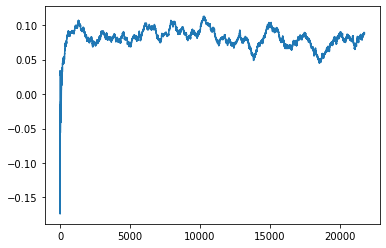

Thread: 5 iteration: 3680
RAM mDiffFit_95 FROM: 896 --> 320 reward: 0.11972657070312501
Thread: 6 iteration: 3668
RAM mDiffFit_114 FROM: 1408 --> 192 reward: 0.167179624609375
Thread: 3 iteration: 3639
RAM mBackground_2 FROM: 2304 --> 256 reward: 0.45296006096875
Thread: 4 iteration: 3609
RAM mDiffFit_148 FROM: 896 --> 256 reward: 0.14641663749999997
Saving ...


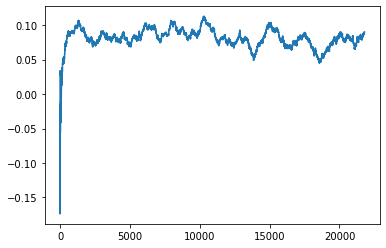

Thread: 4 iteration: 3610
RAM mDiffFit_91 FROM: 3008 --> 384 reward: 0.25526553203125
Thread: 5 iteration: 3681
RAM mDiffFit_252 FROM: 1984 --> 256 reward: -0.957842572265625
Saving ...


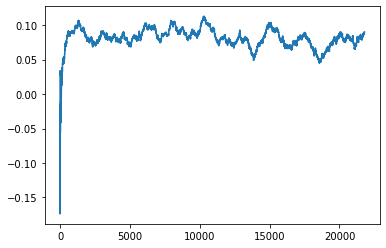

Thread: 3 iteration: 3640
RAM mDiffFit_100 FROM: 192 --> 1408 reward: -0.24417444726562498
Thread: 5 iteration: 3682
RAM mAdd_3 FROM: 704 --> 192 reward: -1.0
Saving ...


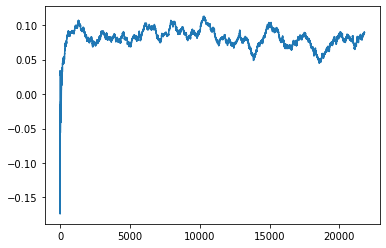

Thread: 2 iteration: 3630
RAM mDiffFit_225 FROM: 2752 --> 192 reward: 0.24451557578125
Thread: 4 iteration: 3611
RAM mDiffFit_268 FROM: 2112 --> 256 reward: 0.214304624609375
Thread: 3 iteration: 3641
RAM mDiffFit_64 FROM: 2944 --> 256 reward: 0.09963013359375
Thread: 5 iteration: 3683
RAM mBackground_38 FROM: 512 --> 256 reward: -1.0
Thread: 1 iteration: 3556
RAM mDiffFit_35 FROM: 320 --> 256 reward: 0.06885157070312502
Thread: 2 iteration: 3631
RAM mDiffFit_320 FROM: 2368 --> 1408 reward: -0.008317742968750007
Thread: 5 iteration: 3684
RAM mDiffFit_224 FROM: 2112 --> 192 reward: 0.20128900507812497
Thread: 4 iteration: 3612
RAM mDiffFit_381 FROM: 576 --> 448 reward: 0.18495318515624998
Thread: 3 iteration: 3642
RAM mDiffFit_228 FROM: 320 --> 1408 reward: -0.09039579687499999
Thread: 2 iteration: 3632
RAM mDiffFit_106 FROM: 704 --> 1408 reward: -0.05098696914062499
Thread: 5 iteration: 3685
RAM mDiffFit_25 FROM: 384 --> 1408 reward: -0.04323951406249997
Thread: 4 iteration: 3613
RAM m

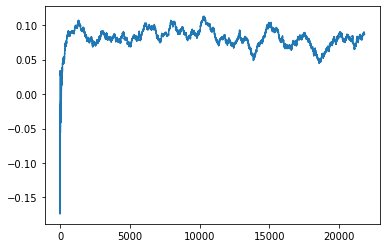

Thread: 6 iteration: 3670
RAM mDiffFit_332 FROM: 192 --> 192 reward: -0.041726570703124986
Thread: 5 iteration: 3686
RAM mDiffFit_156 FROM: 960 --> 192 reward: 0.8702969460937502
Thread: 4 iteration: 3614
RAM mDiffFit_180 FROM: 2880 --> 320 reward: 0.13218484570312497
Thread: 6 iteration: 3671
RAM mDiffFit_133 FROM: 1600 --> 256 reward: 0.20783331875
Thread: 5 iteration: 3687
RAM mDiffFit_302 FROM: 576 --> 1408 reward: -0.10914579687500002
Thread: 5 iteration: 3688
RAM mDiffFit_85 FROM: 2688 --> 256 reward: 0.18754159375
Thread: 4 iteration: 3615
RAM mDiffFit_254 FROM: 768 --> 1408 reward: -0.02015101796875
Thread: 5 iteration: 3689
RAM mBackground_17 FROM: 3008 --> 192 reward: 0.8141711922578126
Thread: 6 iteration: 3672
RAM mProject_24 FROM: 1664 --> 192 reward: -1.0
Thread: 2 iteration: 3633
RAM mDiffFit_11 FROM: 2304 --> 192 reward: 0.317632766015625
Thread: 4 iteration: 3616
RAM mProject_31 FROM: 1856 --> 192 reward: -1.0
Thread: 3 iteration: 3644
RAM mDiffFit_12 FROM: 1472 --> 38

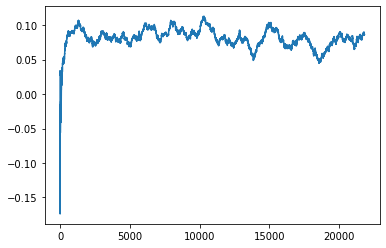

Thread: 5 iteration: 3690
RAM mBackground_38 FROM: 512 --> 192 reward: -1.0
Thread: 1 iteration: 3557
RAM mDiffFit_399 FROM: 1856 --> 256 reward: 0.2009895578125
Thread: 2 iteration: 3634
RAM mDiffFit_330 FROM: 2560 --> 1408 reward: 0.023895840625
Thread: 1 iteration: 3558
RAM mDiffFit_87 FROM: 384 --> 192 reward: 0.139625
Thread: 5 iteration: 3691
RAM mViewer_1 FROM: 2176 --> 384 reward: 0.31430432446875
Thread: 6 iteration: 3673
RAM mBackground_28 FROM: 1472 --> 256 reward: 0.46279191489062504
Thread: 3 iteration: 3645
RAM mDiffFit_214 FROM: 1088 --> 448 reward: 0.16017971210937504
Thread: 2 iteration: 3635
RAM mDiffFit_54 FROM: 1536 --> 384 reward: 0.12003123906249999
Thread: 3 iteration: 3646
RAM mDiffFit_238 FROM: 1536 --> 256 reward: 0.065479071875
Thread: 6 iteration: 3674
RAM mBackground_87 FROM: 1984 --> 1408 reward: 0.26981628309375005
Thread: 2 iteration: 3636
RAM mDiffFit_121 FROM: 2048 --> 192 reward: 0.14686714648437496
Thread: 3 iteration: 3647
RAM mProject_44 FROM: 2880

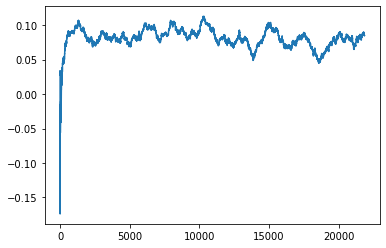

Thread: 1 iteration: 3560
RAM mBackground_53 FROM: 1408 --> 256 reward: -1.0
Thread: 5 iteration: 3692
RAM mDiffFit_219 FROM: 2944 --> 1408 reward: 0.007864557812499989
Thread: 6 iteration: 3678
RAM mDiffFit_110 FROM: 2944 --> 1984 reward: -0.037015707031250025
Saving ...


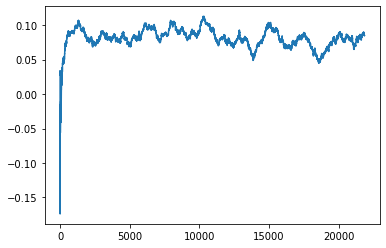

Thread: 4 iteration: 3620
RAM mDiffFit_206 FROM: 2944 --> 192 reward: 0.17807805390624998
Thread: 2 iteration: 3639
RAM mProject_78 FROM: 2624 --> 1408 reward: -0.06442529400000004
Thread: 3 iteration: 3649
RAM mDiffFit_283 FROM: 2880 --> 256 reward: 0.143841084765625
Thread: 4 iteration: 3621
RAM mDiffFit_221 FROM: 1792 --> 256 reward: 0.19423955781250002
Thread: 6 iteration: 3679
RAM mDiffFit_327 FROM: 2048 --> 256 reward: 0.2296666375
Saving ...


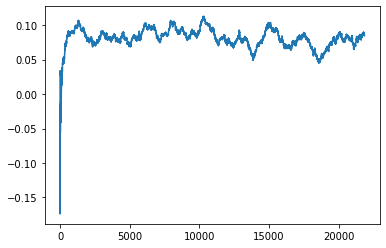

Thread: 2 iteration: 3640
RAM mBackground_84 FROM: 1152 --> 192 reward: 0.6735613803828125
Thread: 5 iteration: 3693
RAM mDiffFit_57 FROM: 448 --> 1920 reward: -0.07509371718750002
Thread: 2 iteration: 3641
RAM mDiffFit_181 FROM: 1216 --> 1408 reward: 0.010593760937500007
Thread: 5 iteration: 3694
RAM mDiffFit_166 FROM: 576 --> 1408 reward: -0.07766146015625
Thread: 2 iteration: 3642
RAM mDiffFit_371 FROM: 1984 --> 1408 reward: 0.00247134960937501
Thread: 2 iteration: 3643
RAM mProject_66 FROM: 1600 --> 320 reward: -1.0
Thread: 1 iteration: 3561
RAM mBackground_78 FROM: 1728 --> 256 reward: -1.89826431121875
Thread: 2 iteration: 3644
RAM mDiffFit_175 FROM: 2688 --> 256 reward: 0.3401092492187501
Thread: 1 iteration: 3562
RAM mDiffFit_281 FROM: 1216 --> 1408 reward: -0.00981511054687502
Thread: 2 iteration: 3645
RAM mProject_71 FROM: 640 --> 256 reward: -1.0
Thread: 4 iteration: 3622
RAM mProject_80 FROM: 576 --> 256 reward: -1.0
Saving ...


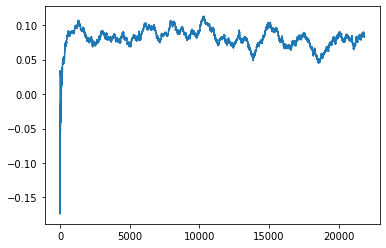

Thread: 6 iteration: 3680
RAM mDiffFit_257 FROM: 1152 --> 192 reward: 0.22376561953125
Thread: 1 iteration: 3563
RAM mProject_32 FROM: 2816 --> 320 reward: -1.0
Thread: 5 iteration: 3695
RAM mDiffFit_131 FROM: 640 --> 256 reward: 0.101437478125
Thread: 4 iteration: 3623
RAM mDiffFit_300 FROM: 2624 --> 320 reward: 0.39089066328125
Thread: 1 iteration: 3564
RAM mDiffFit_298 FROM: 512 --> 1408 reward: -0.23931256562499997
Thread: 6 iteration: 3681
RAM mProject_18 FROM: 704 --> 256 reward: -1.0
Saving ...


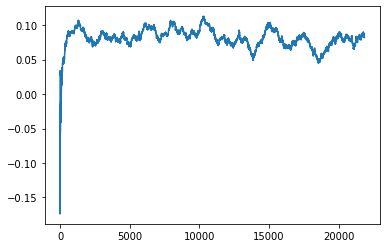

Thread: 3 iteration: 3650
RAM mDiffFit_10 FROM: 2304 --> 1408 reward: 0.019421858593749973
Thread: 3 iteration: 3651
RAM mDiffFit_211 FROM: 832 --> 384 reward: 0.16567190234375
Thread: 1 iteration: 3565
RAM mDiffFit_104 FROM: 1984 --> 256 reward: 0.18132287656249998
Thread: 6 iteration: 3682
RAM mBackground_34 FROM: 1920 --> 1408 reward: -1.0
Thread: 2 iteration: 3646
RAM mDiffFit_45 FROM: 2944 --> 256 reward: 0.17449473515624997
Thread: 6 iteration: 3683
RAM mBackground_37 FROM: 640 --> 1408 reward: -1.0
Thread: 5 iteration: 3696
RAM mDiffFit_115 FROM: 2624 --> 448 reward: 0.104976526953125
Thread: 5 iteration: 3697
RAM mDiffFit_168 FROM: 1792 --> 256 reward: 0.31932292031250004
Thread: 6 iteration: 3684
RAM mProject_6 FROM: 576 --> 256 reward: -1.0
Thread: 4 iteration: 3624
RAM mProject_21 FROM: 576 --> 1408 reward: 0.715970326359375
Thread: 3 iteration: 3652
RAM mDiffFit_174 FROM: 1408 --> 320 reward: 0.24792971210937492
Thread: 6 iteration: 3685
RAM mDiffFit_51 FROM: 2688 --> 256 r

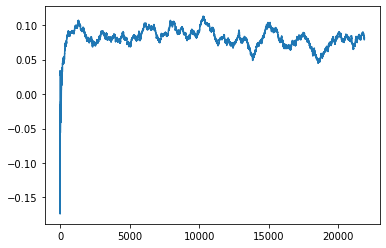

Thread: 2 iteration: 3650
RAM mDiffFit_23 FROM: 640 --> 1152 reward: -0.11252084062499994
Thread: 1 iteration: 3567
RAM mBackground_49 FROM: 2624 --> 1408 reward: -1.0
Thread: 4 iteration: 3627
RAM mDiffFit_31 FROM: 192 --> 256 reward: 0.0016588714843750185
Thread: 2 iteration: 3651
RAM mProject_5 FROM: 1216 --> 256 reward: -1.0
Thread: 6 iteration: 3688
RAM mDiffFit_97 FROM: 1920 --> 256 reward: 0.184395796875
Thread: 1 iteration: 3568
RAM mDiffFit_304 FROM: 896 --> 1408 reward: 0.004083362499999995
Thread: 6 iteration: 3689
RAM mDiffFit_45 FROM: 320 --> 2240 reward: 0.004638162109375024
Thread: 2 iteration: 3652
RAM mProject_2 FROM: 1984 --> 192 reward: -1.0
Thread: 5 iteration: 3699
RAM mBackground_71 FROM: 384 --> 256 reward: 0.17488008692187504
Thread: 4 iteration: 3628
RAM mBackground_48 FROM: 256 --> 1408 reward: -1.0
Thread: 3 iteration: 3656
RAM mDiffFit_31 FROM: 1792 --> 256 reward: 0.15677079687499998
Thread: 1 iteration: 3569
RAM mDiffFit_107 FROM: 2112 --> 256 reward: 0.22

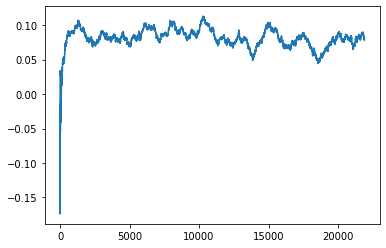

Thread: 6 iteration: 3690
RAM mDiffFit_109 FROM: 896 --> 256 reward: 0.13764061953125
Thread: 2 iteration: 3653
RAM mDiffFit_394 FROM: 1024 --> 256 reward: 0.13358331875000004
Saving ...


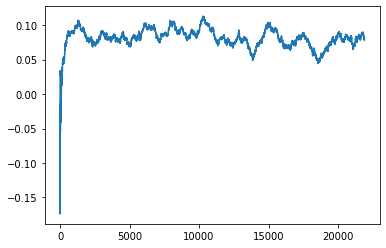

Thread: 5 iteration: 3700
RAM mBackground_30 FROM: 768 --> 2752 reward: -0.015907547992187493
Thread: 3 iteration: 3657
RAM mBackground_75 FROM: 1088 --> 256 reward: 0.7664483225312501
Thread: 4 iteration: 3629
RAM mDiffFit_370 FROM: 1536 --> 256 reward: 0.13729163749999998
Thread: 2 iteration: 3654
RAM mDiffFit_99 FROM: 2048 --> 256 reward: 0.259312478125
Thread: 6 iteration: 3691
RAM mDiffFit_158 FROM: 1664 --> 192 reward: 0.20505725703125
Thread: 5 iteration: 3701
RAM mDiffFit_335 FROM: 448 --> 256 reward: 0.04077601796875
Saving ...


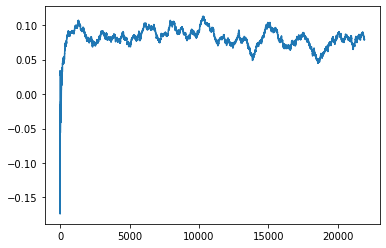

Thread: 4 iteration: 3630
RAM mDiffFit_290 FROM: 2944 --> 192 reward: 0.36160152695312503
Thread: 3 iteration: 3658
RAM mDiffFit_280 FROM: 768 --> 256 reward: 0.13947915937500002
Thread: 2 iteration: 3655
RAM mDiffFit_319 FROM: 2112 --> 256 reward: 0.12202860664062502
Thread: 4 iteration: 3631
RAM mDiffFit_29 FROM: 1536 --> 1408 reward: 0.08829694609375001
Thread: 3 iteration: 3659
RAM mAdd_3 FROM: 2496 --> 1408 reward: -0.05070853750000007
Thread: 6 iteration: 3692
RAM mDiffFit_308 FROM: 1664 --> 256 reward: 0.16254163749999997
Thread: 2 iteration: 3656
RAM mDiffFit_249 FROM: 1792 --> 256 reward: 0.146270796875
Thread: 4 iteration: 3632
RAM mDiffFit_215 FROM: 960 --> 256 reward: 0.19410157070312495
Thread: 6 iteration: 3693
RAM mProject_52 FROM: 1152 --> 1408 reward: -0.08397937434375
Thread: 5 iteration: 3702
RAM mBackground_23 FROM: 448 --> 256 reward: 0.30105599507031244
Saving ...


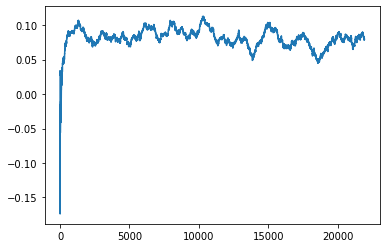

Thread: 3 iteration: 3660
RAM mDiffFit_369 FROM: 2304 --> 1024 reward: 0.0724896015625
Thread: 2 iteration: 3657
RAM mDiffFit_213 FROM: 2880 --> 832 reward: 0.08057024414062502
Thread: 6 iteration: 3694
RAM mDiffFit_372 FROM: 896 --> 256 reward: 0.18148438046874998
Thread: 4 iteration: 3633
RAM mBackground_31 FROM: 1152 --> 256 reward: -1.0
Saving ...


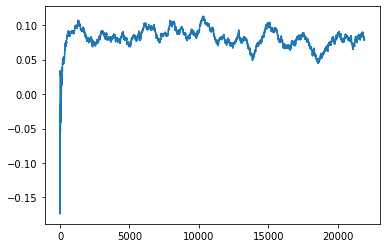

Thread: 1 iteration: 3570
RAM mDiffFit_391 FROM: 448 --> 256 reward: 0.20207292031250002
Thread: 3 iteration: 3661
RAM mDiffFit_409 FROM: 2944 --> 256 reward: 0.12902597421875
Thread: 2 iteration: 3658
RAM mDiffFit_4 FROM: 2432 --> 1408 reward: -0.04731778671875
Thread: 1 iteration: 3571
RAM mDiffFit_411 FROM: 2432 --> 832 reward: 0.009900930468749979
Thread: 3 iteration: 3662
RAM mDiffFit_84 FROM: 2560 --> 192 reward: 0.19164838554687502
Thread: 6 iteration: 3695
RAM mDiffFit_284 FROM: 256 --> 1920 reward: -0.2486353984375
Thread: 6 iteration: 3696
RAM mDiffFit_199 FROM: 2176 --> 256 reward: 0.26651561953125
Thread: 1 iteration: 3572
RAM mBackground_62 FROM: 2112 --> 256 reward: 0.5162485067421875
Thread: 2 iteration: 3659
RAM mDiffFit_209 FROM: 576 --> 256 reward: 0.09472915937500001
Thread: 6 iteration: 3697
RAM mDiffFit_359 FROM: 128 --> 2112 reward: -0.3785441386718749
Thread: 1 iteration: 3573
RAM mBgModel_3 FROM: 384 --> 256 reward: 0.321304159375
Thread: 5 iteration: 3703
RAM m

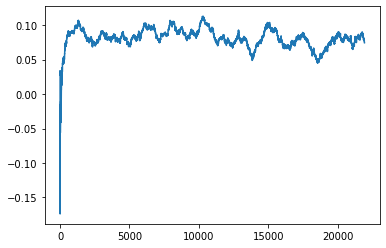

Thread: 6 iteration: 3700
RAM mDiffFit_292 FROM: 2944 --> 1408 reward: 0.014114557812499994
Thread: 1 iteration: 3576
RAM mDiffFit_197 FROM: 1216 --> 256 reward: 0.12474736757812502
Thread: 5 iteration: 3706
RAM mDiffFit_134 FROM: 832 --> 320 reward: 0.11023696914062499
Thread: 3 iteration: 3665
RAM mDiffFit_362 FROM: 2816 --> 256 reward: 0.14770827499999997
Thread: 6 iteration: 3701
RAM mBackground_63 FROM: 1088 --> 192 reward: 0.7278690295781249
Thread: 4 iteration: 3637
RAM mDiffFit_70 FROM: 384 --> 1920 reward: -0.13095309765625002
Thread: 1 iteration: 3577
RAM mBackground_37 FROM: 1280 --> 1408 reward: -1.0
Saving ...


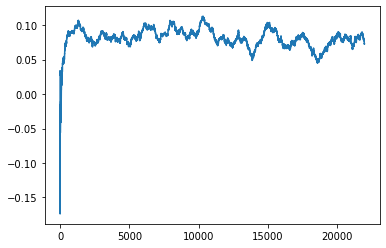

Thread: 2 iteration: 3660
RAM mDiffFit_207 FROM: 704 --> 2688 reward: 0.08564079453125001
Thread: 6 iteration: 3702
RAM mDiffFit_94 FROM: 2944 --> 256 reward: 0.45264057578125005
Thread: 3 iteration: 3666
RAM mDiffFit_384 FROM: 576 --> 384 reward: 0.08071876093750001
Thread: 4 iteration: 3638
RAM mDiffFit_356 FROM: 1216 --> 256 reward: 0.217559889453125
Thread: 2 iteration: 3661
RAM mDiffFit_79 FROM: 2560 --> 704 reward: 0.063429668359375
Thread: 3 iteration: 3667
RAM mDiffFit_290 FROM: 1856 --> 320 reward: 0.117690066796875
Thread: 6 iteration: 3703
RAM mDiffFit_146 FROM: 960 --> 320 reward: 0.12215365039062502
Thread: 2 iteration: 3662
RAM mProject_55 FROM: 256 --> 1408 reward: 0.700449061921875
Thread: 1 iteration: 3578
RAM mProject_28 FROM: 2432 --> 256 reward: -1.0
Thread: 5 iteration: 3707
RAM mDiffFit_354 FROM: 768 --> 832 reward: -0.08390369414062501
Thread: 2 iteration: 3663
RAM mDiffFit_405 FROM: 1088 --> 256 reward: 0.21926561953124996
Thread: 6 iteration: 3704
RAM mDiffFit_

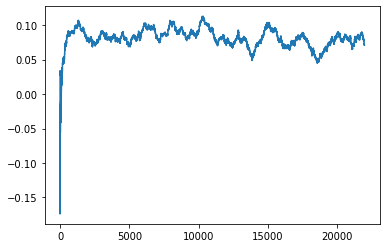

Thread: 1 iteration: 3580
RAM mDiffFit_323 FROM: 1600 --> 2688 reward: -0.035966128515625036
Saving ...


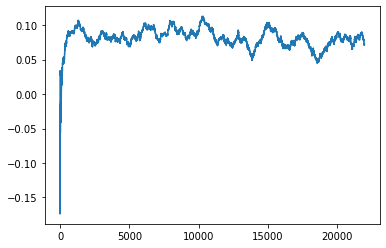

Thread: 3 iteration: 3670
RAM mDiffFit_403 FROM: 192 --> 2688 reward: -0.1319060203125
Thread: 6 iteration: 3706
RAM mBackground_17 FROM: 1024 --> 1024 reward: 0.046332537624999975
Thread: 1 iteration: 3581
RAM mDiffFit_88 FROM: 1920 --> 320 reward: 0.28120309765625007
Thread: 5 iteration: 3709
RAM mDiffFit_338 FROM: 1536 --> 192 reward: 0.355617190234375
Thread: 2 iteration: 3665
RAM mBackground_45 FROM: 1664 --> 256 reward: -1.0
Thread: 4 iteration: 3639
RAM mDiffFit_358 FROM: 2944 --> 448 reward: 0.050385354687499995
Thread: 3 iteration: 3671
RAM mDiffFit_88 FROM: 1408 --> 384 reward: 0.16189057578125
Thread: 1 iteration: 3582
RAM mDiffFit_413 FROM: 1792 --> 192 reward: 0.193794226171875
Saving ...


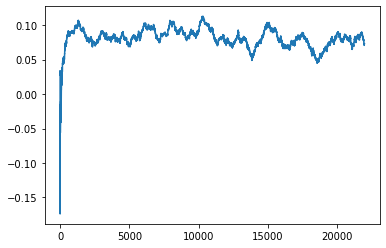

Thread: 5 iteration: 3710
RAM mDiffFit_26 FROM: 1280 --> 256 reward: 0.1264687171875
Thread: 2 iteration: 3666
RAM mDiffFit_296 FROM: 832 --> 256 reward: -0.002625087499999977
Saving ...


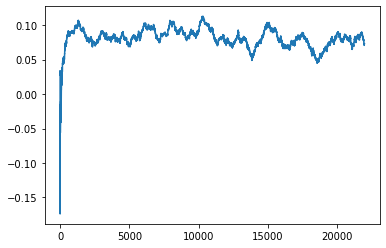

Thread: 4 iteration: 3640
RAM mDiffFit_353 FROM: 2304 --> 1152 reward: 0.029499999999999995
Thread: 1 iteration: 3583
RAM mDiffFit_247 FROM: 1280 --> 320 reward: 0.09707809765624997
Thread: 2 iteration: 3667
RAM mDiffFit_370 FROM: 2176 --> 192 reward: 0.19573433671874996
Thread: 3 iteration: 3672
RAM mImgtbl_1 FROM: 1920 --> 2688 reward: 0.036400105000000016
Thread: 5 iteration: 3711
RAM mDiffFit_385 FROM: 2624 --> 2688 reward: 0.033007853515625005
Thread: 1 iteration: 3584
RAM mProject_53 FROM: 960 --> 192 reward: -1.0
Thread: 6 iteration: 3707
RAM mDiffFit_304 FROM: 1600 --> 256 reward: 0.11777079687499999
Thread: 5 iteration: 3712
RAM mDiffFit_355 FROM: 2880 --> 256 reward: 0.4219764394531251
Thread: 3 iteration: 3673
RAM mDiffFit_234 FROM: 2112 --> 256 reward: 0.09236451406250001
Thread: 5 iteration: 3713
RAM mProject_90 FROM: 1728 --> 2112 reward: 0.06062637993750005
Thread: 2 iteration: 3668
RAM mDiffFit_41 FROM: 1536 --> 2496 reward: -0.01446090742187496
Thread: 1 iteration: 358

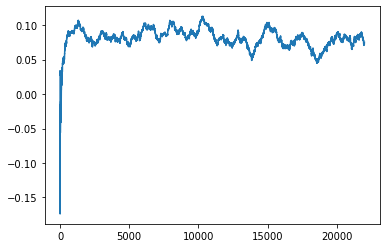

Thread: 6 iteration: 3710
RAM mBackground_2 FROM: 1600 --> 1920 reward: 0.0019753360156249677
Thread: 1 iteration: 3587
RAM mDiffFit_231 FROM: 640 --> 1088 reward: 0.06157559648437505
Saving ...


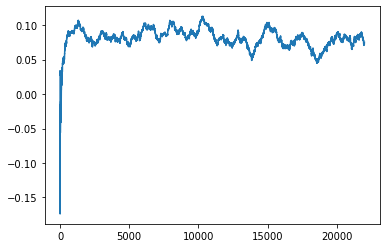

Thread: 2 iteration: 3670
RAM mProject_5 FROM: 192 --> 192 reward: -1.0
Thread: 3 iteration: 3674
RAM mDiffFit_18 FROM: 1344 --> 192 reward: 0.29167185859375
Thread: 5 iteration: 3715
RAM mBackground_24 FROM: 1536 --> 192 reward: 0.7668713803828123
Thread: 1 iteration: 3588
RAM mDiffFit_156 FROM: 960 --> 2240 reward: 0.015044357421874974
Thread: 1 iteration: 3589
RAM mDiffFit_337 FROM: 1664 --> 320 reward: 0.27909626210937505
Saving ...


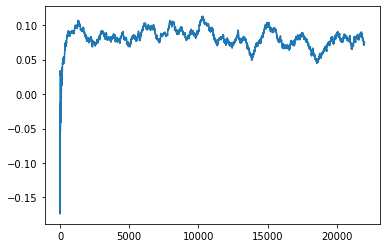

Thread: 1 iteration: 3590
RAM mDiffFit_379 FROM: 2560 --> 256 reward: 0.09351035468750002
Thread: 1 iteration: 3591
RAM mProject_74 FROM: 1792 --> 192 reward: -1.0
Thread: 6 iteration: 3711
RAM mProject_38 FROM: 512 --> 384 reward: -1.0
Thread: 3 iteration: 3675
RAM mDiffFit_200 FROM: 1728 --> 192 reward: 0.588437478125
Thread: 1 iteration: 3592
RAM mDiffFit_15 FROM: 256 --> 256 reward: -0.1275312828125
Thread: 3 iteration: 3676
RAM mConcatFit_2 FROM: 2176 --> 320 reward: 0.4961395928125001
Thread: 6 iteration: 3712
RAM mBackground_46 FROM: 1920 --> 256 reward: -1.0
Thread: 4 iteration: 3642
RAM mBackground_2 FROM: 2944 --> 192 reward: 0.6943199364218752
Thread: 3 iteration: 3677
RAM mDiffFit_41 FROM: 896 --> 192 reward: 0.5854531851562501
Thread: 6 iteration: 3713
RAM mDiffFit_15 FROM: 1024 --> 192 reward: 0.2814479203125
Thread: 4 iteration: 3643
RAM mDiffFit_141 FROM: 2432 --> 256 reward: 0.16060933671875
Thread: 6 iteration: 3714
RAM mDiffFit_256 FROM: 2432 --> 192 reward: 0.392898

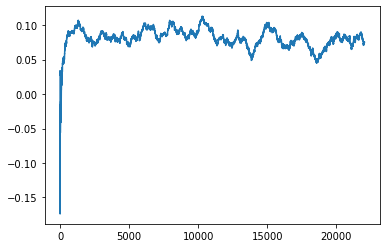

Thread: 3 iteration: 3680
RAM mDiffFit_38 FROM: 2112 --> 256 reward: 0.42845309765625
Thread: 5 iteration: 3717
RAM mDiffFit_82 FROM: 1536 --> 192 reward: 0.4215624781249999
Thread: 6 iteration: 3716
RAM mDiffFit_242 FROM: 640 --> 1408 reward: -0.09902606171875002
Thread: 1 iteration: 3595
RAM mDiffFit_261 FROM: 1408 --> 1984 reward: 0.04078391523437501
Thread: 5 iteration: 3718
RAM mDiffFit_308 FROM: 640 --> 256 reward: 0.012916593750000004
Thread: 3 iteration: 3681
RAM mDiffFit_170 FROM: 384 --> 2944 reward: -0.15559889453124998
Thread: 3 iteration: 3682
RAM mDiffFit_146 FROM: 2624 --> 192 reward: 0.20069783281249998
Thread: 1 iteration: 3596
RAM mConcatFit_2 FROM: 2752 --> 320 reward: 0.3703436296875
Thread: 5 iteration: 3719
RAM mProject_53 FROM: 960 --> 256 reward: -1.0
Thread: 2 iteration: 3673
RAM mDiffFit_46 FROM: 512 --> 2880 reward: -0.12936969140625
Thread: 3 iteration: 3683
RAM mDiffFit_333 FROM: 512 --> 192 reward: 0.20114584062500002
Thread: 1 iteration: 3597
RAM mDiffFit

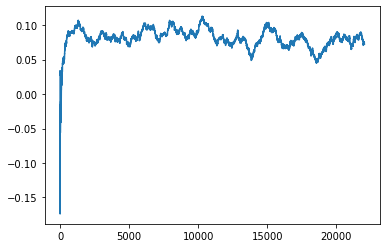

Thread: 5 iteration: 3720
RAM mProject_86 FROM: 2880 --> 256 reward: -1.0
Thread: 4 iteration: 3646
RAM mProject_14 FROM: 832 --> 192 reward: -1.0
Thread: 6 iteration: 3717
RAM mDiffFit_71 FROM: 1152 --> 192 reward: 0.341304668359375
Thread: 3 iteration: 3684
RAM mDiffFit_126 FROM: 1920 --> 2880 reward: 0.07285951171875002
Thread: 4 iteration: 3647
RAM mDiffFit_118 FROM: 2112 --> 192 reward: 0.29129685859375
Thread: 5 iteration: 3721
RAM mDiffFit_107 FROM: 2688 --> 192 reward: 0.46114061953124996
Thread: 3 iteration: 3685
RAM mBackground_62 FROM: 2304 --> 192 reward: 0.67695425271875
Thread: 6 iteration: 3718
RAM mDiffFit_33 FROM: 960 --> 192 reward: 0.24799999999999994
Thread: 5 iteration: 3722
RAM mProject_14 FROM: 384 --> 320 reward: -1.0
Thread: 2 iteration: 3674
RAM mProject_27 FROM: 640 --> 768 reward: -1.0
Thread: 1 iteration: 3598
RAM mBackground_90 FROM: 1280 --> 2880 reward: 0.07760624546875002
Thread: 6 iteration: 3719
RAM mDiffFit_403 FROM: 2240 --> 192 reward: 0.2827213058

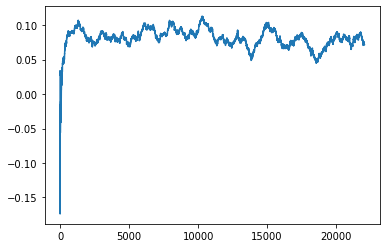

Thread: 6 iteration: 3720
RAM mDiffFit_172 FROM: 1600 --> 192 reward: 0.40214584062500003
Thread: 3 iteration: 3687
RAM mDiffFit_411 FROM: 3008 --> 192 reward: 0.400330555078125
Thread: 5 iteration: 3724
RAM mDiffFit_253 FROM: 896 --> 1408 reward: -0.042729159375
Thread: 2 iteration: 3676
RAM mDiffFit_229 FROM: 960 --> 192 reward: 0.276835951171875
Thread: 6 iteration: 3721
RAM mDiffFit_226 FROM: 2112 --> 192 reward: 0.19959371718750002
Thread: 3 iteration: 3688
RAM mDiffFit_413 FROM: 192 --> 256 reward: -0.02799477890624999
Thread: 2 iteration: 3677
RAM mDiffFit_236 FROM: 1344 --> 704 reward: 0.058380221093750004
Thread: 3 iteration: 3689
RAM mAdd_1 FROM: 2240 --> 2944 reward: 0.17853022910156252
Thread: 2 iteration: 3678
RAM mDiffFit_137 FROM: 2944 --> 704 reward: -0.07669028554687501
Saving ...


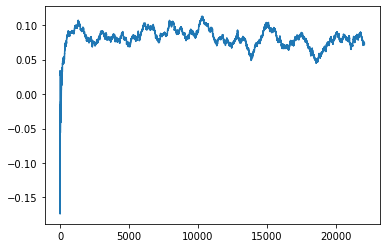

Thread: 3 iteration: 3690
RAM mBackground_37 FROM: 1344 --> 192 reward: -1.0
Thread: 4 iteration: 3648
RAM mDiffFit_288 FROM: 320 --> 1408 reward: -0.10177079687499999
Thread: 3 iteration: 3691
RAM mProject_27 FROM: 2304 --> 192 reward: -1.0
Thread: 5 iteration: 3725
RAM mDiffFit_307 FROM: 1728 --> 192 reward: 0.22092185859375
Thread: 4 iteration: 3649
RAM mDiffFit_345 FROM: 896 --> 192 reward: 0.35633849609375
Thread: 3 iteration: 3692
RAM mBackground_56 FROM: 2048 --> 2496 reward: -1.0
Thread: 6 iteration: 3722
RAM mBackground_52 FROM: 2048 --> 2496 reward: -1.0
Thread: 6 iteration: 3723
RAM mProject_38 FROM: 2688 --> 192 reward: -1.0
Saving ...


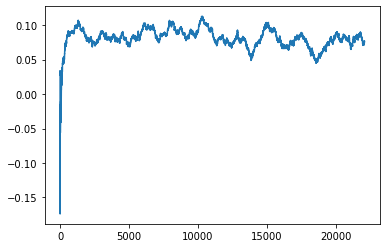

Thread: 4 iteration: 3650
RAM mProject_57 FROM: 2304 --> 192 reward: -1.0
Thread: 5 iteration: 3726
RAM mBackground_52 FROM: 832 --> 192 reward: -1.0
Thread: 2 iteration: 3679
RAM mBackground_59 FROM: 1536 --> 832 reward: -1.0
Thread: 3 iteration: 3693
RAM mDiffFit_143 FROM: 1344 --> 192 reward: 0.24120305390625008
Thread: 6 iteration: 3724
RAM mDiffFit_145 FROM: 3008 --> 256 reward: 0.19424991249999995
Thread: 5 iteration: 3727
RAM mDiffFit_418 FROM: 384 --> 192 reward: 0.28367971210937504
Thread: 4 iteration: 3651
RAM mDiffFit_344 FROM: 1024 --> 192 reward: 0.389710951171875
Saving ...


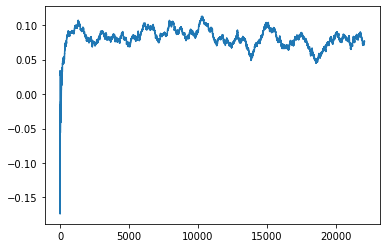

Thread: 2 iteration: 3680
RAM mDiffFit_72 FROM: 2304 --> 1408 reward: -0.005114601562499991
Thread: 5 iteration: 3728
RAM mAdd_3 FROM: 1984 --> 320 reward: -1.0
Thread: 1 iteration: 3599
RAM mDiffFit_350 FROM: 1344 --> 1280 reward: 0.059565154296875
Thread: 6 iteration: 3725
RAM mDiffFit_184 FROM: 960 --> 2880 reward: 0.025265707031249997
Thread: 2 iteration: 3681
RAM mDiffFit_147 FROM: 1216 --> 192 reward: 0.5509479203125001
Thread: 4 iteration: 3652
RAM mDiffFit_207 FROM: 2304 --> 1920 reward: -0.08517198984374999
Thread: 5 iteration: 3729
RAM mDiffFit_110 FROM: 2048 --> 2880 reward: -0.0055103984374999665
Thread: 4 iteration: 3653
RAM mDiffFit_29 FROM: 2432 --> 256 reward: 0.11917177109374998
Saving ...


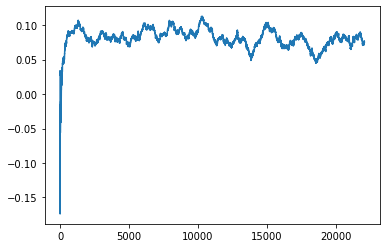

Thread: 1 iteration: 3600
RAM mImgtbl_1 FROM: 704 --> 192 reward: -1.0
Thread: 3 iteration: 3694
RAM mDiffFit_386 FROM: 2496 --> 768 reward: 0.101085951171875
Thread: 2 iteration: 3682
RAM mDiffFit_138 FROM: 640 --> 256 reward: 0.21416668125000005
Thread: 6 iteration: 3726
RAM mDiffFit_48 FROM: 256 --> 192 reward: 0.042148429296875005
Saving ...


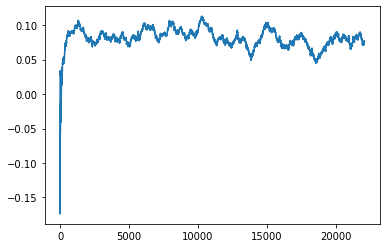

Thread: 5 iteration: 3730
RAM mDiffFit_2 FROM: 2304 --> 1088 reward: 0.06915623906250001
Thread: 1 iteration: 3601
RAM mDiffFit_61 FROM: 2880 --> 192 reward: 0.32611714648437495
Thread: 4 iteration: 3654
RAM mBackground_68 FROM: 448 --> 1408 reward: -0.26123394265625
Thread: 6 iteration: 3727
RAM mDiffFit_219 FROM: 960 --> 192 reward: 0.20614842929687502
Thread: 2 iteration: 3683
RAM mBackground_85 FROM: 1024 --> 448 reward: 0.3983637195156251
Thread: 3 iteration: 3695
RAM mDiffFit_380 FROM: 1728 --> 1280 reward: 0.055773473046874994
Thread: 1 iteration: 3602
RAM mDiffFit_74 FROM: 128 --> 192 reward: -0.7267005964843751
Thread: 5 iteration: 3731
RAM mDiffFit_204 FROM: 256 --> 1280 reward: -0.06588535468750001
Thread: 6 iteration: 3728
RAM mDiffFit_127 FROM: 1152 --> 256 reward: 0.16074477890625
Thread: 4 iteration: 3655
RAM mDiffFit_126 FROM: 1664 --> 192 reward: 0.627997367578125
Thread: 2 iteration: 3684
RAM mDiffFit_121 FROM: 2432 --> 2496 reward: 0.03139066328125001
Thread: 5 itera

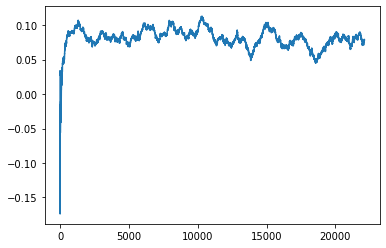

Thread: 6 iteration: 3730
RAM mDiffFit_230 FROM: 2112 --> 2880 reward: 0.04228913632812503
Thread: 2 iteration: 3688
RAM mProject_62 FROM: 1792 --> 704 reward: -1.0
Thread: 1 iteration: 3603
RAM mDiffFit_317 FROM: 512 --> 192 reward: 0.20623438046875003
Thread: 4 iteration: 3658
RAM mDiffFit_250 FROM: 640 --> 192 reward: 0.21783853984375004
Thread: 3 iteration: 3697
RAM mProject_2 FROM: 2432 --> 256 reward: -1.0
Thread: 5 iteration: 3733
RAM mBackground_84 FROM: 2176 --> 192 reward: 0.9801650389296875
Thread: 6 iteration: 3731
RAM mDiffFit_391 FROM: 576 --> 1984 reward: -0.10668484570312504
Thread: 1 iteration: 3604
RAM mDiffFit_89 FROM: 1728 --> 192 reward: 0.305242190234375
Thread: 2 iteration: 3689
RAM mDiffFit_349 FROM: 1344 --> 192 reward: 0.217085907421875
Thread: 3 iteration: 3698
RAM mBackground_78 FROM: 1472 --> 704 reward: 0.22136717696093747
Thread: 6 iteration: 3732
RAM mDiffFit_87 FROM: 1408 --> 1984 reward: 0.029432344531249995
Thread: 1 iteration: 3605
RAM mBackground_63

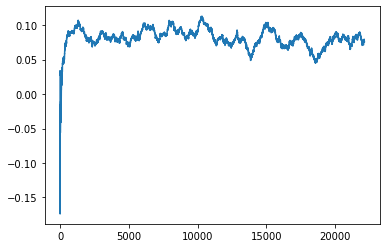

Thread: 2 iteration: 3690
RAM mDiffFit_43 FROM: 1216 --> 256 reward: 0.15226820820312498
Thread: 1 iteration: 3606
RAM mDiffFit_404 FROM: 1792 --> 1408 reward: -0.032197964062500015
Thread: 2 iteration: 3691
RAM mBackground_77 FROM: 3008 --> 704 reward: 0.17766380513281252
Thread: 2 iteration: 3692
RAM mProject_46 FROM: 2496 --> 704 reward: -1.0
Thread: 5 iteration: 3734
RAM mDiffFit_112 FROM: 2432 --> 192 reward: 0.22903378398437502
Thread: 2 iteration: 3693
RAM mDiffFit_191 FROM: 768 --> 320 reward: 0.23430993320312504
Thread: 5 iteration: 3735
RAM mBackground_35 FROM: 384 --> 448 reward: -1.0
Thread: 4 iteration: 3659
RAM mDiffFit_82 FROM: 1600 --> 896 reward: 0.13562767617187502
Thread: 2 iteration: 3694
RAM mProject_29 FROM: 384 --> 704 reward: -1.0
Thread: 6 iteration: 3733
RAM mProject_37 FROM: 2432 --> 192 reward: -1.0
Thread: 3 iteration: 3699
RAM mDiffFit_45 FROM: 128 --> 1984 reward: -0.5925103984375
Thread: 5 iteration: 3736
RAM mProject_15 FROM: 2496 --> 192 reward: -1.0
T

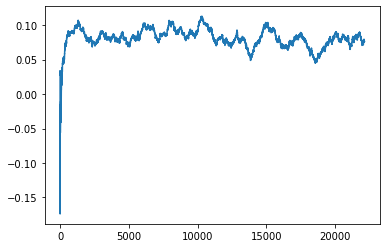

Thread: 3 iteration: 3700
RAM mBackground_79 FROM: 1024 --> 192 reward: 0.894995758953125
Thread: 6 iteration: 3734
RAM mProject_4 FROM: 1152 --> 2240 reward: -0.06749138432812503
Saving ...


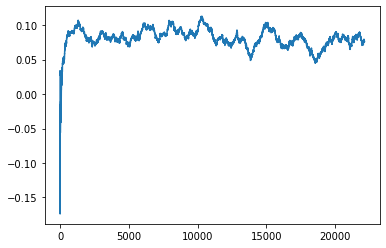

Thread: 4 iteration: 3660
RAM mDiffFit_130 FROM: 960 --> 192 reward: 0.602812521875
Thread: 5 iteration: 3737
RAM mDiffFit_108 FROM: 1536 --> 192 reward: 0.316820287890625
Thread: 4 iteration: 3661
RAM mDiffFit_283 FROM: 2176 --> 192 reward: 0.343887987109375
Thread: 5 iteration: 3738
RAM mDiffFit_415 FROM: 1344 --> 256 reward: 0.18817966835937502
Thread: 4 iteration: 3662
RAM mProject_38 FROM: 192 --> 192 reward: -1.0
Thread: 2 iteration: 3695
RAM mBackground_19 FROM: 3008 --> 192 reward: 0.6175536546328125
Thread: 3 iteration: 3701
RAM mDiffFit_251 FROM: 768 --> 2880 reward: -0.01534367343749999
Thread: 3 iteration: 3702
RAM mViewer_3 FROM: 2432 --> 192 reward: 0.6162490545234375
Thread: 5 iteration: 3739
RAM mDiffFit_397 FROM: 256 --> 192 reward: -0.2551407070312501
Thread: 2 iteration: 3696
RAM mProject_25 FROM: 1408 --> 704 reward: -1.0
Thread: 1 iteration: 3608
RAM mProject_14 FROM: 2944 --> 1792 reward: -0.1813775691093749
Thread: 4 iteration: 3663
RAM mProject_22 FROM: 1664 -->

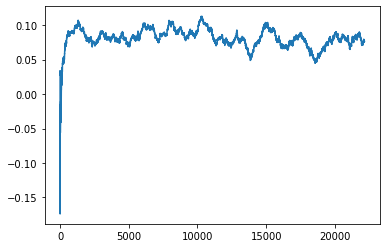

Thread: 5 iteration: 3740
RAM mDiffFit_51 FROM: 2560 --> 192 reward: 0.19564838554687503
Thread: 3 iteration: 3703
RAM mDiffFit_230 FROM: 3008 --> 192 reward: 0.20326031093750002
Thread: 1 iteration: 3609
RAM mDiffFit_235 FROM: 832 --> 256 reward: 0.206955730078125
Thread: 4 iteration: 3664
RAM mDiffFit_375 FROM: 192 --> 192 reward: -0.08820314140624994
Thread: 2 iteration: 3697
RAM mConcatFit_2 FROM: 768 --> 256 reward: 0.4835666900000001
Thread: 6 iteration: 3736
RAM mDiffFit_397 FROM: 1984 --> 2944 reward: 0.12089860429687502
Thread: 3 iteration: 3704
RAM mDiffFit_376 FROM: 1856 --> 192 reward: 0.229966084765625
Thread: 5 iteration: 3741
RAM mDiffFit_12 FROM: 2688 --> 1408 reward: -0.003942742968750003
Thread: 4 iteration: 3665
RAM mDiffFit_177 FROM: 576 --> 2944 reward: 0.32757603398437496
Thread: 2 iteration: 3698
RAM mDiffFit_324 FROM: 384 --> 192 reward: -0.09438289726562504
Thread: 6 iteration: 3737
RAM mBackground_76 FROM: 2944 --> 1408 reward: -1.1618615426249999
Thread: 4 it

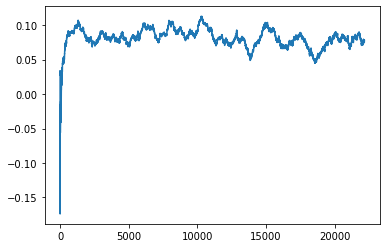

Thread: 1 iteration: 3610
RAM mBackground_28 FROM: 896 --> 704 reward: 0.064486567203125
Thread: 5 iteration: 3746
RAM mDiffFit_25 FROM: 2368 --> 192 reward: 0.16102075312499997
Saving ...


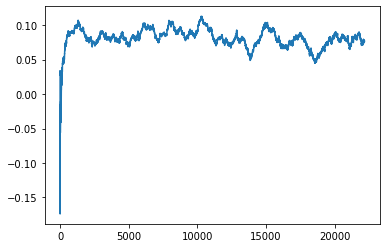

Thread: 2 iteration: 3700
RAM mBackground_59 FROM: 1088 --> 1984 reward: -1.0
Thread: 4 iteration: 3668
RAM mBackground_59 FROM: 2368 --> 256 reward: -1.0
Thread: 3 iteration: 3705
RAM mDiffFit_42 FROM: 2752 --> 192 reward: 0.16320042148437497
Thread: 5 iteration: 3747
RAM mDiffFit_330 FROM: 448 --> 192 reward: 0.25581252187500003
Thread: 4 iteration: 3669
RAM mDiffFit_182 FROM: 3008 --> 384 reward: 0.095914005078125
Thread: 3 iteration: 3706
RAM mDiffFit_93 FROM: 1920 --> 1984 reward: -0.032348982031250015
Thread: 5 iteration: 3748
RAM mProject_75 FROM: 1344 --> 2944 reward: 0.10338978121874995
Thread: 1 iteration: 3611
RAM mDiffFit_371 FROM: 1280 --> 704 reward: -0.0018463933593749864
Thread: 3 iteration: 3707
RAM mProject_72 FROM: 2752 --> 2240 reward: -0.07876047951562509
Thread: 2 iteration: 3701
RAM mDiffFit_129 FROM: 2240 --> 320 reward: 0.260835951171875
Saving ...


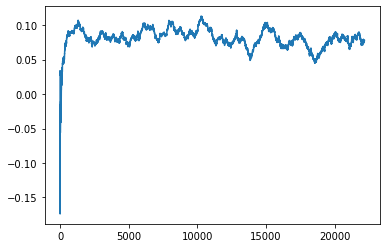

Thread: 4 iteration: 3670
RAM mBackground_23 FROM: 2944 --> 2240 reward: -0.07329945382031249
Thread: 1 iteration: 3612
RAM mDiffFit_348 FROM: 1216 --> 2240 reward: 0.033541725000000015
Thread: 3 iteration: 3708
RAM mDiffFit_100 FROM: 3008 --> 832 reward: -0.059549622265625005
Thread: 2 iteration: 3702
RAM mDiffFit_163 FROM: 960 --> 256 reward: 0.13728382773437497
Thread: 5 iteration: 3749
RAM mViewer_1 FROM: 320 --> 192 reward: 0.3226764092578126
Thread: 4 iteration: 3671
RAM mDiffFit_258 FROM: 2368 --> 1408 reward: -0.007567742968750003
Thread: 2 iteration: 3703
RAM mDiffFit_58 FROM: 512 --> 2496 reward: -0.09392703593749999
Saving ...


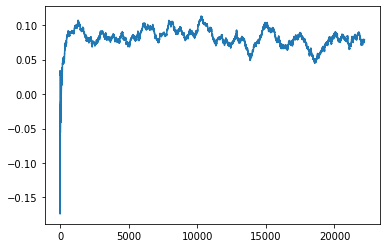

Thread: 5 iteration: 3750
RAM mDiffFit_343 FROM: 2368 --> 384 reward: 0.06313276601562501
Thread: 1 iteration: 3613
RAM mDiffFit_385 FROM: 2624 --> 192 reward: 0.21589838554687502
Thread: 3 iteration: 3709
RAM mBackground_41 FROM: 2048 --> 192 reward: -1.0
Thread: 6 iteration: 3739
RAM mDiffFit_118 FROM: 448 --> 2688 reward: -0.24337500000000006
Thread: 4 iteration: 3672
RAM mDiffFit_54 FROM: 2496 --> 1280 reward: 0.014002588671875003
Thread: 5 iteration: 3751
RAM mDiffFit_167 FROM: 384 --> 1408 reward: -0.10200000000000004
Thread: 1 iteration: 3614
RAM mConcatFit_1 FROM: 320 --> 1408 reward: -0.463379185625
Saving ...


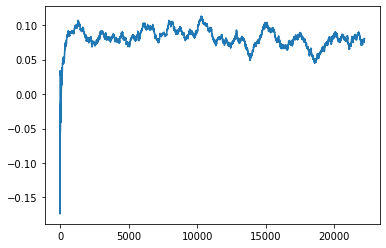

Thread: 3 iteration: 3710
RAM mDiffFit_187 FROM: 2240 --> 192 reward: 0.15979159374999996
Thread: 2 iteration: 3704
RAM mDiffFit_50 FROM: 768 --> 1408 reward: -0.07822915937500001
Thread: 5 iteration: 3752
RAM mDiffFit_159 FROM: 2304 --> 1408 reward: -0.042171946093749996
Thread: 1 iteration: 3615
RAM mDiffFit_80 FROM: 2560 --> 2496 reward: 0.05205475585937501
Thread: 3 iteration: 3711
RAM mBackground_69 FROM: 2560 --> 1408 reward: 0.08066978853124998
Thread: 2 iteration: 3705
RAM mProject_90 FROM: 1728 --> 192 reward: -1.0
Saving ...


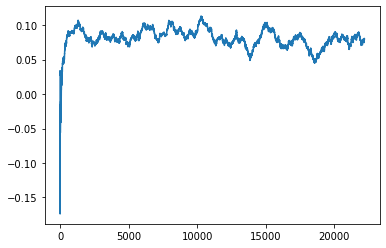

Thread: 6 iteration: 3740
RAM mDiffFit_357 FROM: 2240 --> 2240 reward: 0.0003749999999999934
Thread: 1 iteration: 3616
RAM mDiffFit_21 FROM: 640 --> 2240 reward: -0.016156195312499993
Thread: 5 iteration: 3753
RAM mDiffFit_190 FROM: 1536 --> 896 reward: 0.07854690234374997
Thread: 2 iteration: 3706
RAM mProject_25 FROM: 128 --> 1408 reward: 0.71342313525
Thread: 4 iteration: 3673
RAM mDiffFit_40 FROM: 1920 --> 192 reward: 0.329007766015625
Thread: 3 iteration: 3712
RAM mDiffFit_96 FROM: 2240 --> 1088 reward: -0.07591940117187494
Thread: 2 iteration: 3707
RAM mBackground_9 FROM: 1920 --> 1280 reward: -0.0036192293750000456
Thread: 4 iteration: 3674
RAM mBackground_20 FROM: 1152 --> 192 reward: 0.7416492163984376
Thread: 6 iteration: 3741
RAM mDiffFit_50 FROM: 768 --> 704 reward: -0.004380221093749984
Thread: 4 iteration: 3675
RAM mDiffFit_353 FROM: 1664 --> 768 reward: 0.14432818515625004
Thread: 2 iteration: 3708
RAM mDiffFit_31 FROM: 2304 --> 2944 reward: 0.046635485937500006
Thread: 

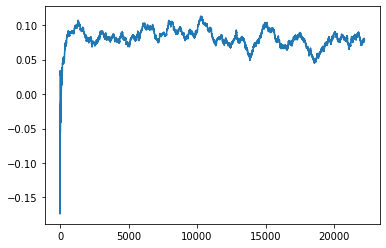

Thread: 2 iteration: 3710
RAM mDiffFit_126 FROM: 1408 --> 1088 reward: 0.015583318750000026
Thread: 4 iteration: 3677
RAM mDiffFit_410 FROM: 704 --> 1408 reward: -0.039736969140624995
Thread: 6 iteration: 3744
RAM mBackground_43 FROM: 1984 --> 384 reward: -1.0
Thread: 1 iteration: 3617
RAM mDiffFit_268 FROM: 1920 --> 2880 reward: 0.020382853515624993
Thread: 5 iteration: 3755
RAM mDiffFit_281 FROM: 2240 --> 1984 reward: 0.017585951171874992
Thread: 1 iteration: 3618
RAM mDiffFit_269 FROM: 2432 --> 1088 reward: -0.05654698984375001
Thread: 2 iteration: 3711
RAM mDiffFit_68 FROM: 3008 --> 2944 reward: 0.0034270796874999974
Thread: 4 iteration: 3678
RAM mDiffFit_35 FROM: 576 --> 192 reward: 0.17962499999999998
Thread: 6 iteration: 3745
RAM mDiffFit_276 FROM: 2176 --> 2240 reward: 0.030898473046875007
Thread: 2 iteration: 3712
RAM mBackground_28 FROM: 576 --> 448 reward: 0.13072898028124993
Thread: 5 iteration: 3756
RAM mDiffFit_32 FROM: 192 --> 320 reward: -0.18402084062500004
Thread: 6 i

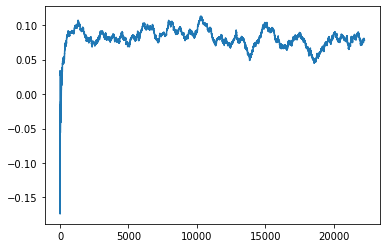

Thread: 1 iteration: 3620
RAM mBackground_40 FROM: 2368 --> 1344 reward: -1.0
Thread: 4 iteration: 3679
RAM mDiffFit_203 FROM: 1664 --> 1280 reward: 0.0095520796875
Thread: 3 iteration: 3715
RAM mDiffFit_146 FROM: 2880 --> 2112 reward: 0.06958599492187498
Thread: 2 iteration: 3714
RAM mBackground_77 FROM: 2880 --> 1408 reward: 0.0004836559374999813
Thread: 6 iteration: 3748
RAM mDiffFit_38 FROM: 2560 --> 1280 reward: -0.010083406249999996
Thread: 1 iteration: 3621
RAM mDiffFit_420 FROM: 640 --> 704 reward: 0.003565110546875014
Saving ...


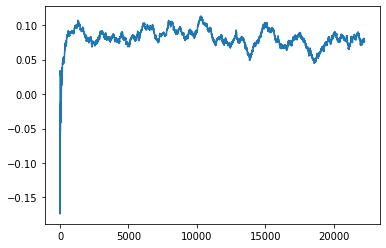

Thread: 4 iteration: 3680
RAM mBackground_23 FROM: 3008 --> 1280 reward: -0.04538084717968746
Thread: 1 iteration: 3622
RAM mDiffFit_352 FROM: 1600 --> 1088 reward: 0.02639061953124999
Thread: 1 iteration: 3623
RAM mProject_18 FROM: 448 --> 192 reward: -1.0
Thread: 5 iteration: 3758
RAM mDiffFit_409 FROM: 2368 --> 2240 reward: -0.023294313671874973
Thread: 1 iteration: 3624
RAM mProject_6 FROM: 2560 --> 1280 reward: 0.009839750625000166
Thread: 2 iteration: 3715
RAM mProject_10 FROM: 768 --> 1408 reward: 0.7248447085781249
Thread: 6 iteration: 3749
RAM mProject_49 FROM: 1024 --> 1408 reward: -0.1316231125312499
Thread: 4 iteration: 3681
RAM mProject_85 FROM: 448 --> 256 reward: -1.0
Thread: 3 iteration: 3716
RAM mDiffFit_176 FROM: 192 --> 1408 reward: -0.21077338554687505
Thread: 2 iteration: 3716
RAM mDiffFit_97 FROM: 2880 --> 192 reward: 0.294882766015625
Thread: 1 iteration: 3625
RAM mDiffFit_328 FROM: 2304 --> 256 reward: 0.4062186734375
Thread: 5 iteration: 3759
RAM mDiffFit_171 F

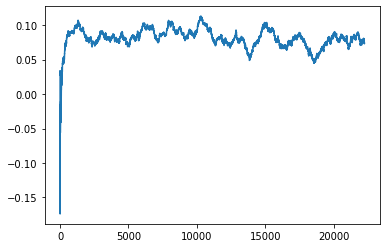

Thread: 6 iteration: 3750
RAM mDiffFit_51 FROM: 2048 --> 896 reward: 0.054161460156249994
Thread: 3 iteration: 3717
RAM mDiffFit_383 FROM: 1344 --> 2880 reward: 0.05632041914062501
Thread: 2 iteration: 3717
RAM mDiffFit_28 FROM: 2688 --> 704 reward: -0.003106835546874999
Saving ...


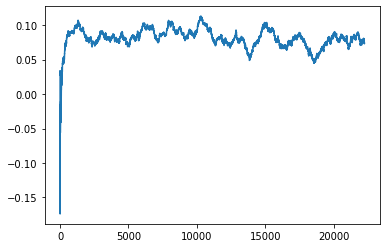

Thread: 5 iteration: 3760
RAM mDiffFit_251 FROM: 2880 --> 1088 reward: 0.032458318750000006
Thread: 2 iteration: 3718
RAM mDiffFit_178 FROM: 1664 --> 1408 reward: 0.009536460156250003
Thread: 5 iteration: 3761
RAM mDiffFit_158 FROM: 896 --> 192 reward: 0.19890101796874998
Thread: 6 iteration: 3751
RAM mProject_89 FROM: 1984 --> 832 reward: -1.0
Thread: 1 iteration: 3626
RAM mDiffFit_122 FROM: 1792 --> 256 reward: 0.41296876093749996
Thread: 5 iteration: 3762
RAM mDiffFit_267 FROM: 1024 --> 256 reward: 0.5138646453125001
Thread: 2 iteration: 3719
RAM mBackground_72 FROM: 1984 --> 192 reward: 0.7432101362187501
Thread: 6 iteration: 3752
RAM mDiffFit_16 FROM: 1664 --> 832 reward: 0.011401017968749993
Thread: 5 iteration: 3763
RAM mDiffFit_120 FROM: 192 --> 1280 reward: -0.260221349609375
Saving ...


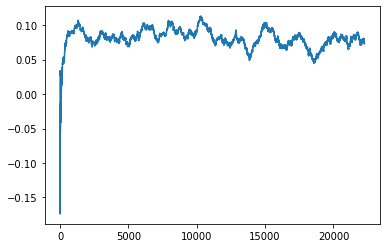

Thread: 2 iteration: 3720
RAM mDiffFit_398 FROM: 1728 --> 2240 reward: -0.007367190234374987
Thread: 6 iteration: 3753
RAM mBackground_34 FROM: 2112 --> 1280 reward: -1.0
Thread: 3 iteration: 3718
RAM mProject_16 FROM: 3008 --> 256 reward: -1.0
Thread: 4 iteration: 3683
RAM mProject_72 FROM: 1920 --> 1280 reward: 0.09768838992187508
Thread: 1 iteration: 3627
RAM mDiffFit_129 FROM: 1216 --> 1920 reward: 0.05686205664062499
Thread: 5 iteration: 3764
RAM mDiffFit_298 FROM: 1344 --> 256 reward: 0.2331770359375
Thread: 2 iteration: 3721
RAM mBackground_90 FROM: 1280 --> 1408 reward: 0.008286480281250038
Thread: 3 iteration: 3719
RAM mDiffFit_385 FROM: 2368 --> 256 reward: 0.350049491015625
Thread: 6 iteration: 3754
RAM mDiffFit_13 FROM: 2560 --> 256 reward: 0.39333331874999994
Thread: 1 iteration: 3628
RAM mDiffFit_398 FROM: 1600 --> 1408 reward: 0.02870836249999998
Thread: 5 iteration: 3765
RAM mProject_1 FROM: 256 --> 1280 reward: 0.7302456168749999
Thread: 4 iteration: 3684
RAM mDiffFit_

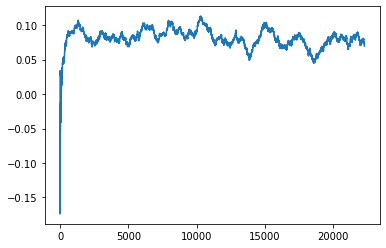

Thread: 3 iteration: 3720
RAM mDiffFit_104 FROM: 1600 --> 256 reward: 0.20195831875
Thread: 2 iteration: 3722
RAM mBackground_26 FROM: 1600 --> 1280 reward: 0.054840696679687516
Thread: 6 iteration: 3755
RAM mDiffFit_111 FROM: 384 --> 1408 reward: -0.159187521875
Thread: 5 iteration: 3766
RAM mDiffFit_253 FROM: 2048 --> 1280 reward: 0.05155207968750006
Thread: 4 iteration: 3685
RAM mDiffFit_307 FROM: 832 --> 1408 reward: -0.07821617226562502
Thread: 3 iteration: 3721
RAM mDiffFit_221 FROM: 2240 --> 1344 reward: -0.0065807738281250215
Thread: 2 iteration: 3723
RAM mDiffFit_280 FROM: 512 --> 256 reward: 0.057614557812499974
Thread: 6 iteration: 3756
RAM mProject_16 FROM: 128 --> 1088 reward: 0.8051720226328124
Thread: 1 iteration: 3629
RAM mDiffFit_142 FROM: 576 --> 2880 reward: 0.01062513125000001
Thread: 5 iteration: 3767
RAM mDiffFit_400 FROM: 1856 --> 2240 reward: -0.019138030859375006
Thread: 4 iteration: 3686
RAM mDiffFit_322 FROM: 2816 --> 2240 reward: 0.004645840625000005
Thread:

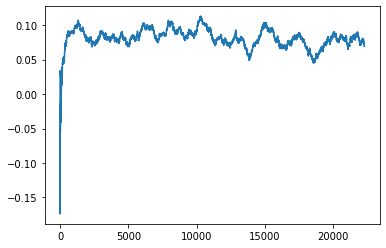

Thread: 1 iteration: 3630
RAM mDiffFit_72 FROM: 1728 --> 1280 reward: 0.033283871484375
Thread: 5 iteration: 3769
RAM mDiffFit_174 FROM: 2304 --> 1280 reward: 0.06983336249999998
Thread: 6 iteration: 3759
RAM mDiffFit_289 FROM: 1920 --> 1024 reward: 0.08997920312499999
Thread: 3 iteration: 3724
RAM mDiffFit_288 FROM: 1088 --> 832 reward: -0.021112012890625014
Thread: 3 iteration: 3725
RAM mDiffFit_261 FROM: 2816 --> 192 reward: 0.40855466835937504
Saving ...


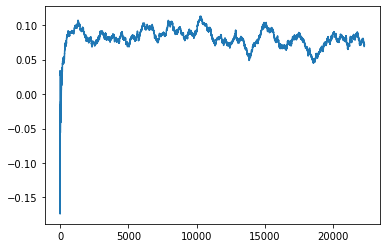

Thread: 6 iteration: 3760
RAM mProject_73 FROM: 2176 --> 2560 reward: 0.0837789035625
Thread: 1 iteration: 3631
RAM mDiffFit_323 FROM: 1088 --> 1280 reward: -0.01894792031250002
Thread: 1 iteration: 3632
RAM mBackground_51 FROM: 1920 --> 2240 reward: -1.0
Thread: 2 iteration: 3726
RAM mDiffFit_394 FROM: 832 --> 192 reward: 0.62685942421875
Thread: 6 iteration: 3761
RAM mProject_83 FROM: 1920 --> 192 reward: -1.0
Thread: 4 iteration: 3688
RAM mProject_46 FROM: 2304 --> 192 reward: -1.0
Saving ...


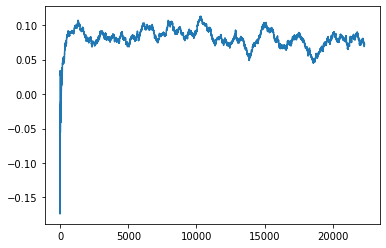

Thread: 5 iteration: 3770
RAM mBackground_70 FROM: 192 --> 1088 reward: 0.3228877011015625
Thread: 2 iteration: 3727
RAM mProject_77 FROM: 1152 --> 192 reward: -1.0
Thread: 3 iteration: 3726
RAM mDiffFit_352 FROM: 1152 --> 1280 reward: 0.011182300781250008
Thread: 5 iteration: 3771
RAM mDiffFit_293 FROM: 1920 --> 1408 reward: 0.012088539843750001
Thread: 3 iteration: 3727
RAM mProject_11 FROM: 2560 --> 2240 reward: -0.06736653175781256
Thread: 4 iteration: 3689
RAM mDiffFit_79 FROM: 1664 --> 832 reward: 0.018651017968749975
Thread: 5 iteration: 3772
RAM mProject_78 FROM: 2944 --> 2240 reward: -0.10101725191406252
Thread: 2 iteration: 3728
RAM mDiffFit_359 FROM: 1280 --> 192 reward: 0.31818488945312495
Saving ...


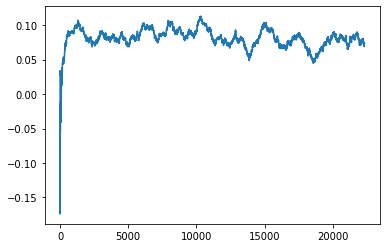

Thread: 4 iteration: 3690
RAM mBackground_37 FROM: 1984 --> 1280 reward: -1.0
Thread: 1 iteration: 3633
RAM mBackground_36 FROM: 576 --> 2240 reward: -1.0
Thread: 6 iteration: 3762
RAM mDiffFit_228 FROM: 2816 --> 1280 reward: 0.008291637500000004
Thread: 2 iteration: 3729
RAM mBackground_16 FROM: 768 --> 1280 reward: -0.08026665412500003
Thread: 6 iteration: 3763
RAM mDiffFit_91 FROM: 192 --> 256 reward: -0.036648429296874986
Thread: 1 iteration: 3634
RAM mProject_45 FROM: 2048 --> 1280 reward: 0.07395178246875005
Thread: 5 iteration: 3773
RAM mBackground_40 FROM: 2624 --> 1408 reward: -1.0
Thread: 3 iteration: 3728
RAM mDiffFit_366 FROM: 1664 --> 1920 reward: 0.04881256562500001
Saving ...


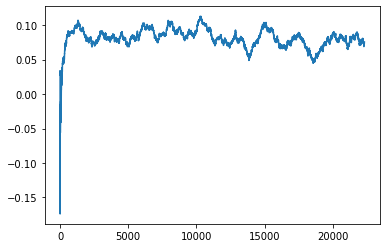

Thread: 2 iteration: 3730
RAM mDiffFit_396 FROM: 1536 --> 1280 reward: -0.034020884375000025
Thread: 6 iteration: 3764
RAM mProject_74 FROM: 1024 --> 1280 reward: -0.10613249999999995
Thread: 4 iteration: 3691
RAM mDiffFit_120 FROM: 1280 --> 256 reward: 0.225395840625
Thread: 5 iteration: 3774
RAM mDiffFit_121 FROM: 704 --> 192 reward: 0.19279163750000006
Thread: 3 iteration: 3729
RAM mDiffFit_5 FROM: 832 --> 256 reward: 0.14740882773437497
Thread: 6 iteration: 3765
RAM mBackground_68 FROM: 512 --> 2240 reward: -0.18786509859375
Thread: 4 iteration: 3692
RAM mDiffFit_289 FROM: 1344 --> 192 reward: 0.23995309765625
Thread: 2 iteration: 3731
RAM mDiffFit_118 FROM: 2688 --> 448 reward: 0.08785933671874999
Thread: 5 iteration: 3775
RAM mDiffFit_403 FROM: 2624 --> 1408 reward: -0.00898442421875003
Thread: 6 iteration: 3766
RAM mDiffFit_216 FROM: 3008 --> 1408 reward: -0.02192194609375
Thread: 4 iteration: 3693
RAM mProject_80 FROM: 2880 --> 256 reward: -1.0
Thread: 1 iteration: 3635
RAM mDi

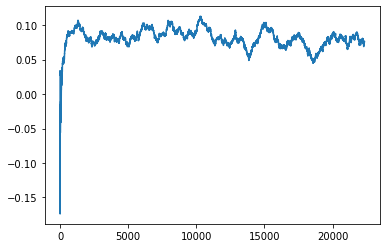

Thread: 3 iteration: 3730
RAM mDiffFit_167 FROM: 2112 --> 1280 reward: -0.006458362500000002
Thread: 6 iteration: 3767
RAM mDiffFit_209 FROM: 256 --> 1984 reward: -0.05620301015625001
Thread: 5 iteration: 3776
RAM mDiffFit_409 FROM: 320 --> 192 reward: 0.08121612851562499
Thread: 3 iteration: 3731
RAM mBackground_34 FROM: 256 --> 1280 reward: -1.0
Thread: 2 iteration: 3732
RAM mDiffFit_311 FROM: 2432 --> 1280 reward: -0.025812565625000002
Thread: 6 iteration: 3768
RAM mDiffFit_114 FROM: 384 --> 256 reward: 0.135020840625
Thread: 3 iteration: 3732
RAM mDiffFit_59 FROM: 2880 --> 256 reward: 0.39414053203124993
Thread: 5 iteration: 3777
RAM mProject_53 FROM: 1088 --> 1280 reward: -0.08498391363281259
Thread: 1 iteration: 3636
RAM mDiffFit_234 FROM: 832 --> 2240 reward: -0.020044226171874995
Thread: 2 iteration: 3733
RAM mImgtbl_3 FROM: 128 --> 192 reward: -1.0
Thread: 4 iteration: 3694
RAM mDiffFit_109 FROM: 2688 --> 1280 reward: -0.006213583593750009
Thread: 6 iteration: 3769
RAM mDiffFi

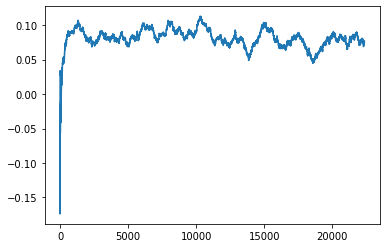

Thread: 6 iteration: 3770
RAM mBackground_5 FROM: 1856 --> 192 reward: 0.7470107083515624
Thread: 4 iteration: 3695
RAM mDiffFit_61 FROM: 2944 --> 2240 reward: -0.015664092578125
Thread: 3 iteration: 3735
RAM mDiffFit_335 FROM: 1024 --> 1088 reward: 0.03177606171875
Thread: 6 iteration: 3771
RAM mBackground_5 FROM: 2496 --> 1408 reward: 0.0029069148906250308
Saving ...


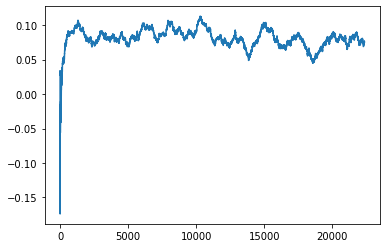

Thread: 5 iteration: 3780
RAM mDiffFit_169 FROM: 128 --> 192 reward: -0.70229694609375
Thread: 4 iteration: 3696
RAM mProject_15 FROM: 2240 --> 192 reward: -1.0
Thread: 1 iteration: 3637
RAM mDiffFit_75 FROM: 1920 --> 192 reward: 0.213070287890625
Thread: 5 iteration: 3781
RAM mDiffFit_105 FROM: 640 --> 192 reward: 0.1903437171875
Thread: 4 iteration: 3697
RAM mDiffFit_225 FROM: 2432 --> 192 reward: 0.47077601796875
Thread: 1 iteration: 3638
RAM mProject_88 FROM: 2496 --> 320 reward: -1.0
Thread: 2 iteration: 3735
RAM mDiffFit_28 FROM: 832 --> 1280 reward: -0.06168752187500002
Thread: 4 iteration: 3698
RAM mDiffFit_89 FROM: 2176 --> 2240 reward: -0.05666672500000003
Thread: 1 iteration: 3639
RAM mDiffFit_248 FROM: 576 --> 1280 reward: -0.06621876093750001
Saving ...


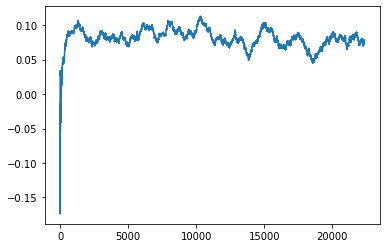

Thread: 1 iteration: 3640
RAM mDiffFit_304 FROM: 1920 --> 1280 reward: -0.04802610546875
Thread: 1 iteration: 3641
RAM mProject_10 FROM: 1024 --> 192 reward: -1.0
Thread: 3 iteration: 3736
RAM mProject_10 FROM: 896 --> 320 reward: -1.0
Thread: 6 iteration: 3772
RAM mBackground_76 FROM: 1664 --> 320 reward: 0.6079573261562499
Thread: 2 iteration: 3736
RAM mBackground_24 FROM: 2176 --> 320 reward: 0.8511158355078124
Thread: 4 iteration: 3699
RAM mProject_4 FROM: 320 --> 256 reward: -1.0
Thread: 5 iteration: 3782
RAM mViewer_2 FROM: 832 --> 2816 reward: 4.6592132812521564e-05
Thread: 1 iteration: 3642
RAM mDiffFit_130 FROM: 1216 --> 1280 reward: -0.007343760937500027
Thread: 6 iteration: 3773
RAM mDiffFit_328 FROM: 256 --> 192 reward: 0.228263030859375
Thread: 3 iteration: 3737
RAM mProject_73 FROM: 2112 --> 1920 reward: -0.04272898450781252
Saving ...


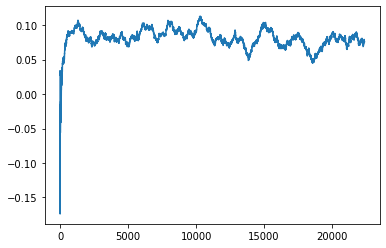

Thread: 4 iteration: 3700
RAM mDiffFit_200 FROM: 832 --> 192 reward: 0.551283871484375
Thread: 2 iteration: 3737
RAM mDiffFit_273 FROM: 448 --> 2240 reward: -0.041348894531249986
Thread: 1 iteration: 3643
RAM mDiffFit_389 FROM: 2816 --> 2880 reward: 0.037742233984374984
Thread: 5 iteration: 3783
RAM mDiffFit_99 FROM: 2880 --> 1280 reward: 0.010299447265625008
Thread: 6 iteration: 3774
RAM mDiffFit_167 FROM: 512 --> 192 reward: 0.00036451406250002233
Thread: 3 iteration: 3738
RAM mDiffFit_69 FROM: 960 --> 704 reward: 0.009846349609375004
Thread: 4 iteration: 3701
RAM mDiffFit_329 FROM: 704 --> 256 reward: 0.112825508984375
Thread: 2 iteration: 3738
RAM mDiffFit_12 FROM: 640 --> 256 reward: 0.14653123906249998
Thread: 1 iteration: 3644
RAM mDiffFit_212 FROM: 2688 --> 192 reward: 0.18792181484374998
Thread: 6 iteration: 3775
RAM mDiffFit_343 FROM: 832 --> 192 reward: 0.28110938046875
Thread: 5 iteration: 3784
RAM mDiffFit_274 FROM: 576 --> 192 reward: 0.3754140925781251
Thread: 3 iteratio

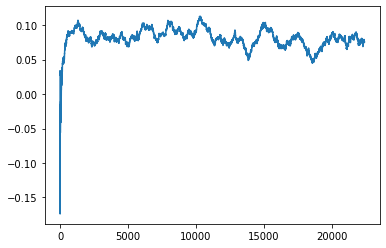

Thread: 2 iteration: 3740
RAM mDiffFit_41 FROM: 1088 --> 192 reward: 0.27705730078124996
Thread: 5 iteration: 3786
RAM mProject_68 FROM: 960 --> 1280 reward: -0.10559200253906247
Saving ...


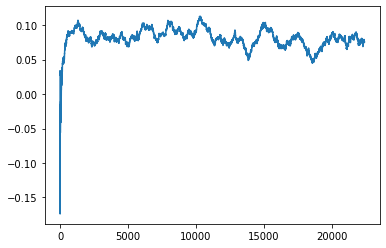

Thread: 3 iteration: 3740
RAM mBackground_84 FROM: 1856 --> 192 reward: 0.9412789050312499
Thread: 4 iteration: 3703
RAM mDiffFit_164 FROM: 2880 --> 192 reward: 0.344851526953125
Thread: 2 iteration: 3741
RAM mDiffFit_191 FROM: 2176 --> 192 reward: 0.315153606640625
Thread: 5 iteration: 3787
RAM mDiffFit_271 FROM: 2048 --> 192 reward: 0.24549732382812497
Thread: 3 iteration: 3741
RAM mDiffFit_138 FROM: 1088 --> 192 reward: 0.198966128515625
Thread: 4 iteration: 3704
RAM mProject_11 FROM: 896 --> 192 reward: -1.0
Thread: 1 iteration: 3646
RAM mBackground_53 FROM: 1600 --> 320 reward: -1.0
Thread: 6 iteration: 3776
RAM mDiffFit_288 FROM: 384 --> 1280 reward: -0.097229159375
Thread: 2 iteration: 3742
RAM mDiffFit_257 FROM: 1984 --> 192 reward: 0.27667185859375
Thread: 3 iteration: 3742
RAM mDiffFit_35 FROM: 512 --> 192 reward: 0.21263544218749997
Thread: 4 iteration: 3705
RAM mDiffFit_299 FROM: 2880 --> 1088 reward: 0.015960907421875004
Thread: 6 iteration: 3777
RAM mDiffFit_418 FROM: 768

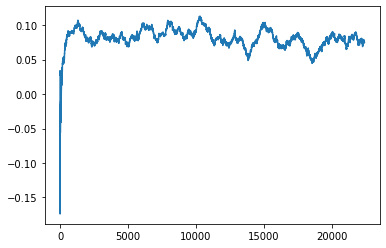

Thread: 5 iteration: 3790
RAM mDiffFit_232 FROM: 768 --> 192 reward: 0.302601570703125
Thread: 4 iteration: 3708
RAM mDiffFit_419 FROM: 2560 --> 192 reward: 0.6641406632812499
Saving ...


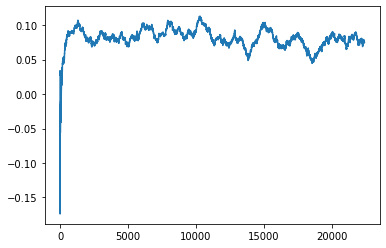

Thread: 6 iteration: 3780
RAM mDiffFit_173 FROM: 2880 --> 192 reward: 0.183812434375
Thread: 1 iteration: 3649
RAM mDiffFit_30 FROM: 2752 --> 192 reward: 0.2106769921875
Thread: 4 iteration: 3709
RAM mImgtbl_2 FROM: 2240 --> 192 reward: -1.0
Thread: 3 iteration: 3744
RAM mViewer_2 FROM: 1856 --> 384 reward: 0.3411804440859375
Thread: 6 iteration: 3781
RAM mDiffFit_344 FROM: 576 --> 192 reward: 0.6668438484375
Thread: 5 iteration: 3791
RAM mDiffFit_143 FROM: 128 --> 256 reward: -0.30266668125
Saving ...


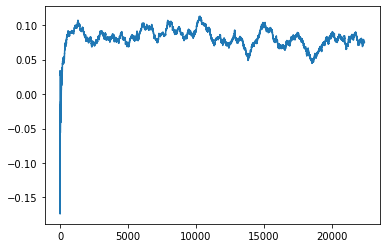

Thread: 1 iteration: 3650
RAM mDiffFit_135 FROM: 1920 --> 2240 reward: 0.03216150390625
Thread: 5 iteration: 3792
RAM mDiffFit_245 FROM: 2368 --> 192 reward: 0.19275776601562494
Thread: 3 iteration: 3745
RAM mDiffFit_25 FROM: 2368 --> 256 reward: 0.14511451406249998
Thread: 6 iteration: 3782
RAM mDiffFit_109 FROM: 2880 --> 192 reward: 0.486523429296875
Saving ...


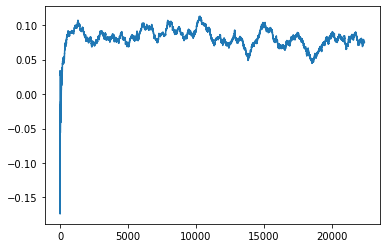

Thread: 4 iteration: 3710
RAM mDiffFit_165 FROM: 1088 --> 1344 reward: 0.07531519804687498
Thread: 1 iteration: 3651
RAM mDiffFit_198 FROM: 896 --> 192 reward: 0.246653650390625
Thread: 5 iteration: 3793
RAM mDiffFit_59 FROM: 832 --> 1408 reward: 0.6520293066406251
Thread: 3 iteration: 3746
RAM mBackground_25 FROM: 1792 --> 256 reward: 0.5485097509062501
Thread: 6 iteration: 3783
RAM mBackground_25 FROM: 576 --> 192 reward: 0.5339457459765625
Thread: 4 iteration: 3711
RAM mBackground_32 FROM: 2112 --> 192 reward: -1.0
Thread: 2 iteration: 3746
RAM mDiffFit_87 FROM: 2944 --> 192 reward: 0.3204921464843751
Thread: 3 iteration: 3747
RAM mDiffFit_153 FROM: 768 --> 192 reward: 0.166132809765625
Thread: 4 iteration: 3712
RAM mDiffFit_418 FROM: 2240 --> 192 reward: 0.22425254492187496
Thread: 2 iteration: 3747
RAM mDiffFit_227 FROM: 2688 --> 192 reward: 0.150195244140625
Thread: 3 iteration: 3748
RAM mDiffFit_240 FROM: 2496 --> 192 reward: 0.136304537109375
Thread: 2 iteration: 3748
RAM mDiff

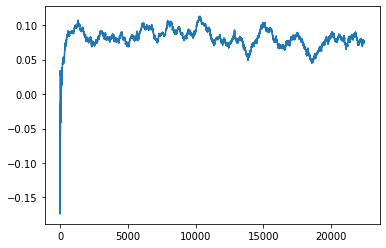

Thread: 3 iteration: 3750
RAM mProject_43 FROM: 2624 --> 192 reward: -1.0
Thread: 6 iteration: 3784
RAM mDiffFit_242 FROM: 3008 --> 1344 reward: 0.026289048828124998
Thread: 1 iteration: 3653
RAM mProject_19 FROM: 1536 --> 1408 reward: 0.04177313353125014
Thread: 4 iteration: 3713
RAM mDiffFit_142 FROM: 1344 --> 320 reward: 0.16045573007812497
Thread: 5 iteration: 3795
RAM mDiffFit_58 FROM: 2816 --> 768 reward: 0.15340628281249996
Thread: 3 iteration: 3751
RAM mDiffFit_318 FROM: 2240 --> 192 reward: 0.25199473515625004
Thread: 6 iteration: 3785
RAM mDiffFit_31 FROM: 256 --> 192 reward: 0.175106791796875
Thread: 1 iteration: 3654
RAM mImgtbl_1 FROM: 1088 --> 192 reward: -1.0
Thread: 2 iteration: 3749
RAM mDiffFit_4 FROM: 576 --> 192 reward: 0.201875
Thread: 5 iteration: 3796
RAM mDiffFit_184 FROM: 2304 --> 192 reward: 0.14242958085937502
Thread: 3 iteration: 3752
RAM mDiffFit_331 FROM: 1472 --> 192 reward: 0.5649739382812501
Thread: 6 iteration: 3786
RAM mDiffFit_118 FROM: 2368 --> 192 

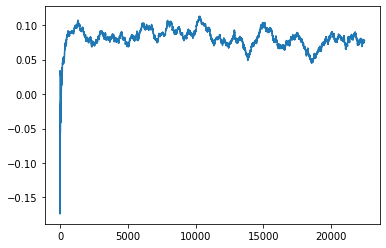

Thread: 2 iteration: 3750
RAM mBackground_80 FROM: 2816 --> 192 reward: 0.7828349610703125
Thread: 5 iteration: 3798
RAM mProject_34 FROM: 2112 --> 2752 reward: 0.1251283671562499
Thread: 1 iteration: 3656
RAM mDiffFit_190 FROM: 2624 --> 192 reward: 0.312335907421875
Thread: 6 iteration: 3788
RAM mDiffFit_166 FROM: 192 --> 448 reward: -0.16676561953125002
Thread: 3 iteration: 3755
RAM mDiffFit_14 FROM: 2240 --> 192 reward: 0.20464316445312494
Thread: 2 iteration: 3751
RAM mBackground_1 FROM: 2688 --> 192 reward: 0.71608421509375
Thread: 4 iteration: 3716
RAM mDiffFit_122 FROM: 1920 --> 192 reward: 0.38521876093749996
Thread: 5 iteration: 3799
RAM mDiffFit_267 FROM: 128 --> 384 reward: -0.5229010617187501
Thread: 1 iteration: 3657
RAM mDiffFit_378 FROM: 640 --> 192 reward: 0.0968437171875
Thread: 6 iteration: 3789
RAM mDiffFit_81 FROM: 2688 --> 256 reward: 0.14806765546875
Thread: 3 iteration: 3756
RAM mDiffFit_125 FROM: 2944 --> 192 reward: 0.191945244140625
Thread: 2 iteration: 3752
R

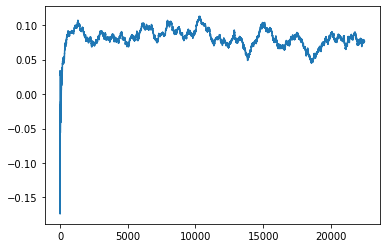

Thread: 6 iteration: 3790
RAM mDiffFit_125 FROM: 1088 --> 832 reward: -0.056005264843750034
Thread: 3 iteration: 3757
RAM mDiffFit_367 FROM: 448 --> 192 reward: 0.11631769921874999
Saving ...


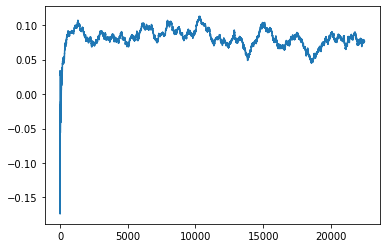

Thread: 5 iteration: 3800
RAM mDiffFit_393 FROM: 1792 --> 192 reward: 0.222127544921875
Thread: 1 iteration: 3658
RAM mDiffFit_390 FROM: 512 --> 192 reward: -0.05985165820312499
Thread: 2 iteration: 3753
RAM mDiffFit_330 FROM: 1856 --> 256 reward: 0.13812495624999999
Thread: 6 iteration: 3791
RAM mDiffFit_297 FROM: 2816 --> 192 reward: 0.26689057578125003
Thread: 4 iteration: 3718
RAM mDiffFit_321 FROM: 1088 --> 2880 reward: 0.0045365039062499925
Thread: 5 iteration: 3801
RAM mProject_64 FROM: 768 --> 2240 reward: 0.7011406304296874
Thread: 3 iteration: 3758
RAM mDiffFit_213 FROM: 2304 --> 2688 reward: 0.08854698984375003
Thread: 2 iteration: 3754
RAM mDiffFit_240 FROM: 1664 --> 384 reward: 0.1399895578125
Thread: 4 iteration: 3719
RAM mDiffFit_158 FROM: 1664 --> 192 reward: 0.220799447265625
Thread: 5 iteration: 3802
RAM mDiffFit_88 FROM: 320 --> 256 reward: 0.11710157070312505
Saving ...


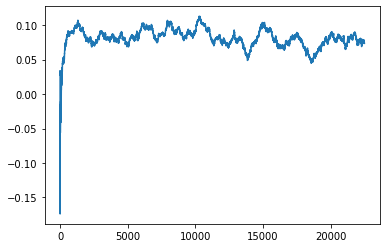

Thread: 4 iteration: 3720
RAM mProject_43 FROM: 1408 --> 256 reward: -1.0
Thread: 1 iteration: 3659
RAM mDiffFit_300 FROM: 1984 --> 192 reward: 0.3811093804687501
Thread: 5 iteration: 3803
RAM mDiffFit_213 FROM: 1152 --> 192 reward: 0.524148429296875
Thread: 2 iteration: 3755
RAM mBackground_25 FROM: 1216 --> 192 reward: 0.8168118655937499
Thread: 3 iteration: 3759
RAM mProject_19 FROM: 832 --> 192 reward: -1.0
Thread: 6 iteration: 3792
RAM mDiffFit_14 FROM: 512 --> 256 reward: 0.06283331875000003
Thread: 2 iteration: 3756
RAM mBackground_14 FROM: 128 --> 384 reward: -1.252590037625
Thread: 4 iteration: 3721
RAM mDiffFit_188 FROM: 2112 --> 192 reward: 0.491554712109375
Saving ...


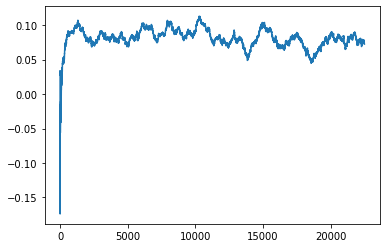

Thread: 1 iteration: 3660
RAM mDiffFit_72 FROM: 2560 --> 192 reward: 0.342937478125
Thread: 6 iteration: 3793
RAM mBackground_64 FROM: 2624 --> 192 reward: 0.7756952477890624
Thread: 5 iteration: 3804
RAM mDiffFit_100 FROM: 192 --> 256 reward: -0.0783020796875
Thread: 4 iteration: 3722
RAM mDiffFit_326 FROM: 832 --> 192 reward: 0.33763544218749997
Thread: 2 iteration: 3757
RAM mDiffFit_333 FROM: 2560 --> 192 reward: 0.28472652695312495
Thread: 1 iteration: 3661
RAM mDiffFit_104 FROM: 320 --> 192 reward: 0.29814066328124994
Thread: 5 iteration: 3805
RAM mDiffFit_279 FROM: 2880 --> 192 reward: 0.46120301015624987
Thread: 6 iteration: 3794
RAM mDiffFit_340 FROM: 2112 --> 192 reward: 0.12046086367187499
Thread: 4 iteration: 3723
RAM mDiffFit_36 FROM: 1344 --> 192 reward: 0.15987491250000002
Thread: 2 iteration: 3758
RAM mBackground_26 FROM: 2688 --> 384 reward: 0.28155578229687506
Thread: 1 iteration: 3662
RAM mDiffFit_204 FROM: 1216 --> 192 reward: 0.291729159375
Thread: 1 iteration: 3663

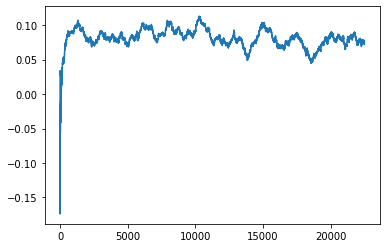

Thread: 3 iteration: 3760
RAM mDiffFit_297 FROM: 1856 --> 192 reward: 0.18101553203124995
Thread: 3 iteration: 3761
RAM mProject_4 FROM: 1344 --> 192 reward: -1.0
Thread: 5 iteration: 3806
RAM mProject_89 FROM: 2752 --> 192 reward: -1.0
Thread: 6 iteration: 3795
RAM mDiffFit_135 FROM: 1536 --> 384 reward: 0.050062434374999965
Thread: 3 iteration: 3762
RAM mProject_4 FROM: 2880 --> 192 reward: -1.0
Thread: 4 iteration: 3724
RAM mProject_26 FROM: 1728 --> 192 reward: -1.0
Thread: 2 iteration: 3759
RAM mDiffFit_110 FROM: 2240 --> 192 reward: 0.19540097421875
Thread: 5 iteration: 3807
RAM mBackground_84 FROM: 1216 --> 192 reward: 0.743895509859375
Thread: 6 iteration: 3796
RAM mBackground_5 FROM: 1216 --> 192 reward: 0.7686787311875
Thread: 3 iteration: 3763
RAM mDiffFit_188 FROM: 1024 --> 192 reward: 0.26446353984375
Thread: 4 iteration: 3725
RAM mDiffFit_142 FROM: 1728 --> 192 reward: 0.28182028789062497
Saving ...


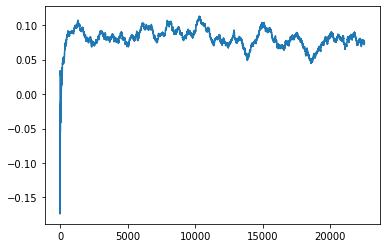

Thread: 2 iteration: 3760
RAM mDiffFit_107 FROM: 320 --> 192 reward: 0.23570836250000002
Thread: 5 iteration: 3808
RAM mDiffFit_324 FROM: 1728 --> 1408 reward: 0.026466172265624983
Thread: 3 iteration: 3764
RAM mDiffFit_296 FROM: 2560 --> 192 reward: 0.20777075312499999
Thread: 6 iteration: 3797
RAM mDiffFit_272 FROM: 2880 --> 256 reward: 0.07508836484375
Thread: 2 iteration: 3761
RAM mDiffFit_271 FROM: 192 --> 192 reward: -0.011000000000000038
Thread: 4 iteration: 3726
RAM mDiffFit_10 FROM: 1408 --> 384 reward: 0.23370309765625
Thread: 5 iteration: 3809
RAM mBackground_42 FROM: 1984 --> 192 reward: -1.0
Thread: 1 iteration: 3664
RAM mDiffFit_84 FROM: 2048 --> 384 reward: 0.0709687171875
Thread: 6 iteration: 3798
RAM mDiffFit_137 FROM: 1536 --> 192 reward: 0.2777187171875
Thread: 3 iteration: 3765
RAM mDiffFit_331 FROM: 2048 --> 704 reward: 0.13384898203125
Thread: 4 iteration: 3727
RAM mDiffFit_343 FROM: 1536 --> 192 reward: 0.28910938046875
Thread: 2 iteration: 3762
RAM mDiffFit_192 

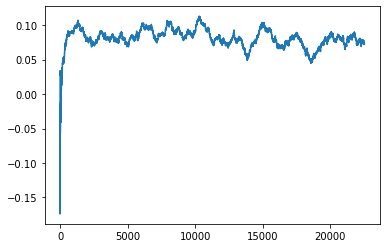

Thread: 5 iteration: 3810
RAM mDiffFit_351 FROM: 1280 --> 192 reward: 0.15128119531249998
Thread: 1 iteration: 3665
RAM mDiffFit_127 FROM: 2624 --> 192 reward: 0.19878119531249994
Thread: 6 iteration: 3799
RAM mDiffFit_378 FROM: 832 --> 192 reward: 0.20277342929687497
Thread: 3 iteration: 3766
RAM mDiffFit_203 FROM: 1536 --> 2880 reward: -0.0048437171874999956
Thread: 5 iteration: 3811
RAM mDiffFit_415 FROM: 1792 --> 192 reward: 0.14544265546875
Thread: 2 iteration: 3763
RAM mDiffFit_95 FROM: 832 --> 2752 reward: 0.10408090507812497
Thread: 1 iteration: 3666
RAM mDiffFit_277 FROM: 1152 --> 192 reward: 0.253320287890625
Thread: 4 iteration: 3728
RAM mDiffFit_133 FROM: 896 --> 192 reward: 0.229820331640625
Thread: 2 iteration: 3764
RAM mDiffFit_122 FROM: 2112 --> 192 reward: 0.28292966835937505
Thread: 3 iteration: 3767
RAM mDiffFit_75 FROM: 1024 --> 192 reward: 0.31094011054687504
Thread: 5 iteration: 3812
RAM mDiffFit_27 FROM: 704 --> 192 reward: 0.34812241132812505
Thread: 3 iteration

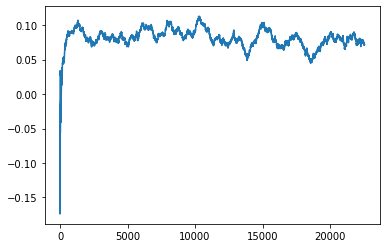

Thread: 6 iteration: 3800
RAM mBgModel_2 FROM: 2880 --> 1408 reward: -0.04760538734375003
Saving ...


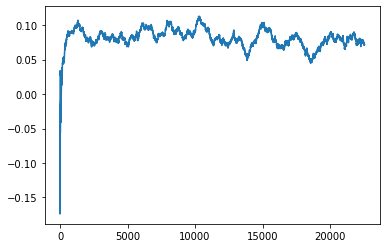

Thread: 3 iteration: 3770
RAM mProject_38 FROM: 2048 --> 192 reward: -1.0
Thread: 2 iteration: 3765
RAM mDiffFit_3 FROM: 320 --> 2752 reward: -0.36904944726562505
Saving ...


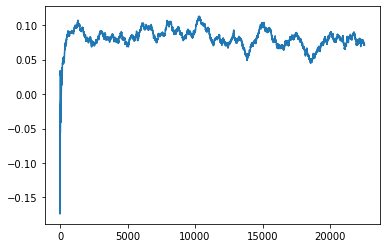

Thread: 4 iteration: 3730
RAM mDiffFit_303 FROM: 2432 --> 192 reward: 0.22620042148437491
Thread: 1 iteration: 3668
RAM mDiffFit_339 FROM: 1728 --> 192 reward: 0.19692181484375
Thread: 3 iteration: 3771
RAM mDiffFit_118 FROM: 448 --> 2752 reward: -0.030015532031249983
Thread: 3 iteration: 3772
RAM mProject_39 FROM: 640 --> 192 reward: -1.0
Thread: 5 iteration: 3814
RAM mDiffFit_263 FROM: 2560 --> 192 reward: 0.20564838554687498
Thread: 2 iteration: 3766
RAM mProject_61 FROM: 2496 --> 2944 reward: 0.07294796114062496
Thread: 6 iteration: 3801
RAM mDiffFit_201 FROM: 2688 --> 192 reward: 0.22036710273437504
Thread: 1 iteration: 3669
RAM mDiffFit_396 FROM: 1088 --> 192 reward: 0.46465623906249987
Thread: 4 iteration: 3731
RAM mDiffFit_244 FROM: 2752 --> 1920 reward: -0.010075552734374986
Thread: 3 iteration: 3773
RAM mDiffFit_129 FROM: 192 --> 192 reward: 0.04135157070312499
Thread: 2 iteration: 3767
RAM mViewer_3 FROM: 2368 --> 448 reward: 0.21737021264062503
Thread: 5 iteration: 3815
RAM

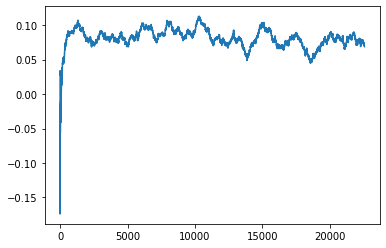

Thread: 1 iteration: 3670
RAM mDiffFit_74 FROM: 2688 --> 256 reward: 0.08440615156250003
Thread: 3 iteration: 3774
RAM mDiffFit_88 FROM: 2624 --> 192 reward: 0.5845025011718751
Thread: 4 iteration: 3732
RAM mDiffFit_28 FROM: 1600 --> 2944 reward: 0.09176316210937499
Thread: 5 iteration: 3816
RAM mDiffFit_120 FROM: 2432 --> 192 reward: 0.18768221328125
Thread: 2 iteration: 3768
RAM mDiffFit_82 FROM: 1792 --> 192 reward: 0.20538535468750002
Thread: 3 iteration: 3775
RAM mDiffFit_313 FROM: 256 --> 192 reward: 0.0037629871093751432
Thread: 1 iteration: 3671
RAM mBackground_45 FROM: 2496 --> 192 reward: 0.5855992890390626
Thread: 6 iteration: 3803
RAM mViewer_2 FROM: 2368 --> 704 reward: 0.092877712640625
Thread: 4 iteration: 3733
RAM mDiffFit_26 FROM: 256 --> 192 reward: 0.053882809765625
Thread: 1 iteration: 3672
RAM mBackground_5 FROM: 1472 --> 192 reward: 0.6875676984921875
Thread: 5 iteration: 3817
RAM mDiffFit_50 FROM: 1728 --> 192 reward: 0.5422812390624999
Thread: 3 iteration: 3776


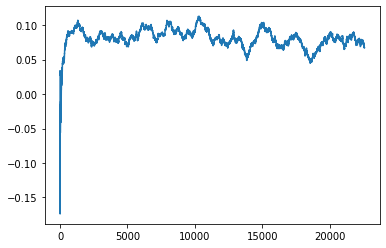

Thread: 5 iteration: 3820
RAM mProject_32 FROM: 1344 --> 256 reward: -1.0
Thread: 1 iteration: 3673
RAM mDiffFit_331 FROM: 1216 --> 640 reward: 0.18192975585937493
Saving ...


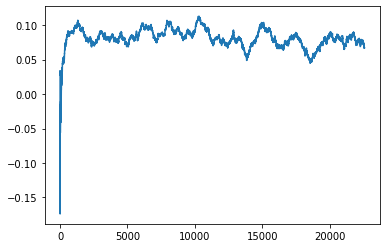

Thread: 2 iteration: 3770
RAM mDiffFit_33 FROM: 2880 --> 1920 reward: 0.032835951171874996
Thread: 5 iteration: 3821
RAM mDiffFit_341 FROM: 1472 --> 192 reward: 0.2849895578125
Thread: 6 iteration: 3806
RAM mImgtbl_3 FROM: 320 --> 192 reward: -1.0
Thread: 4 iteration: 3735
RAM mDiffFit_368 FROM: 2432 --> 192 reward: 0.23328378398437502
Thread: 1 iteration: 3674
RAM mDiffFit_88 FROM: 1600 --> 256 reward: 0.3638228765625
Thread: 3 iteration: 3779
RAM mDiffFit_331 FROM: 2048 --> 2560 reward: 0.07066676874999998
Thread: 6 iteration: 3807
RAM mDiffFit_423 FROM: 1792 --> 448 reward: 0.0816145578125
Thread: 4 iteration: 3736
RAM mDiffFit_360 FROM: 2432 --> 192 reward: 0.20708323125
Thread: 5 iteration: 3822
RAM mBackground_48 FROM: 2816 --> 192 reward: 0.71708756096875
Thread: 2 iteration: 3771
RAM mBackground_85 FROM: 1984 --> 192 reward: 0.7492234198203125
Saving ...


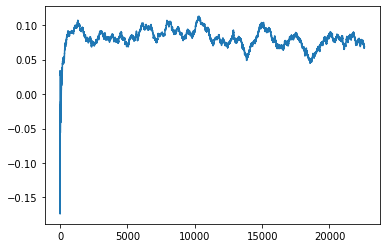

Thread: 3 iteration: 3780
RAM mDiffFit_80 FROM: 1344 --> 1920 reward: 0.04095318515625
Thread: 6 iteration: 3808
RAM mViewer_2 FROM: 384 --> 256 reward: 0.26026688221875
Thread: 4 iteration: 3737
RAM mBackground_17 FROM: 960 --> 1088 reward: 0.086846642453125
Thread: 2 iteration: 3772
RAM mBackground_76 FROM: 1152 --> 192 reward: 0.7391767163984375
Thread: 6 iteration: 3809
RAM mConcatFit_2 FROM: 2496 --> 192 reward: 0.741962408125
Thread: 3 iteration: 3781
RAM mBackground_54 FROM: 768 --> 448 reward: 0.13445337052343756
Thread: 4 iteration: 3738
RAM mDiffFit_198 FROM: 1856 --> 192 reward: 0.15188794335937497
Thread: 3 iteration: 3782
RAM mDiffFit_86 FROM: 448 --> 192 reward: 0.08441404882812502
Thread: 4 iteration: 3739
RAM mProject_45 FROM: 1600 --> 192 reward: -1.0
Thread: 5 iteration: 3823
RAM mProject_49 FROM: 2688 --> 192 reward: -1.0
Thread: 1 iteration: 3675
RAM mBackground_38 FROM: 1728 --> 832 reward: 0.16190398028125
Thread: 3 iteration: 3783
RAM mDiffFit_96 FROM: 256 --> 76

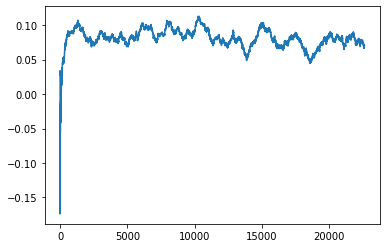

Thread: 4 iteration: 3740
RAM mProject_69 FROM: 2048 --> 192 reward: -1.0
Thread: 2 iteration: 3773
RAM mDiffFit_147 FROM: 1152 --> 256 reward: 0.36506769921874993
Thread: 1 iteration: 3676
RAM mProject_78 FROM: 2240 --> 1152 reward: 0.10081297603125008
Saving ...


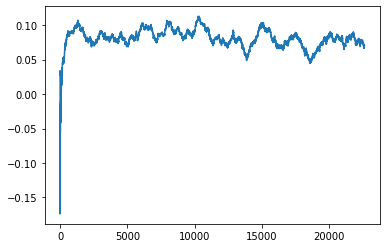

Thread: 6 iteration: 3810
RAM mDiffFit_347 FROM: 1920 --> 2560 reward: 0.043958406250000026
Thread: 6 iteration: 3811
RAM mDiffFit_348 FROM: 512 --> 256 reward: 0.001947876562500006
Thread: 4 iteration: 3741
RAM mDiffFit_341 FROM: 2944 --> 256 reward: 0.18774991249999998
Thread: 3 iteration: 3784
RAM mDiffFit_206 FROM: 2048 --> 192 reward: 0.21011192539062495
Thread: 2 iteration: 3774
RAM mDiffFit_213 FROM: 2816 --> 256 reward: 0.386229071875
Thread: 1 iteration: 3677
RAM mProject_39 FROM: 2112 --> 192 reward: -1.0
Thread: 5 iteration: 3824
RAM mDiffFit_274 FROM: 192 --> 2752 reward: -0.40106765546875006
Thread: 6 iteration: 3812
RAM mDiffFit_356 FROM: 128 --> 256 reward: -0.8333542468749999
Thread: 3 iteration: 3785
RAM mDiffFit_378 FROM: 2688 --> 320 reward: 0.362966172265625
Thread: 4 iteration: 3742
RAM mDiffFit_67 FROM: 960 --> 192 reward: 0.31799219023437497
Thread: 1 iteration: 3678
RAM mDiffFit_348 FROM: 576 --> 192 reward: 0.25895314140625
Thread: 5 iteration: 3825
RAM mDiffFi

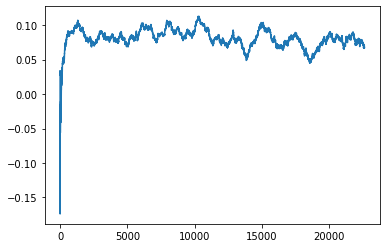

Thread: 1 iteration: 3680
RAM mProject_16 FROM: 256 --> 768 reward: -1.0
Thread: 3 iteration: 3786
RAM mBackground_63 FROM: 512 --> 1152 reward: -0.26694491307812496
Thread: 5 iteration: 3827
RAM mDiffFit_211 FROM: 576 --> 1152 reward: 0.018164136328124997
Thread: 1 iteration: 3681
RAM mDiffFit_284 FROM: 1984 --> 192 reward: 0.46229426992187495
Thread: 6 iteration: 3815
RAM mDiffFit_59 FROM: 1664 --> 192 reward: 0.582395796875
Thread: 2 iteration: 3776
RAM mProject_63 FROM: 896 --> 768 reward: -1.0
Thread: 4 iteration: 3744
RAM mDiffFit_62 FROM: 1536 --> 1408 reward: -0.00605730078125
Thread: 3 iteration: 3787
RAM mDiffFit_319 FROM: 2816 --> 256 reward: 0.10298951406250001
Thread: 5 iteration: 3828
RAM mConcatFit_1 FROM: 512 --> 256 reward: 0.38063334499999996
Thread: 6 iteration: 3816
RAM mDiffFit_251 FROM: 1216 --> 256 reward: 0.126122367578125
Thread: 4 iteration: 3745
RAM mDiffFit_273 FROM: 3008 --> 256 reward: 0.10996086367187503
Thread: 3 iteration: 3788
RAM mDiffFit_170 FROM: 15

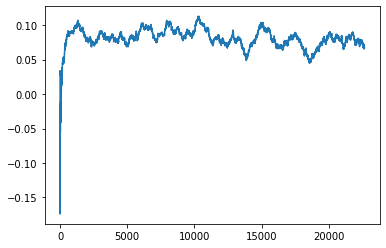

Thread: 3 iteration: 3790
RAM mDiffFit_385 FROM: 2624 --> 256 reward: 0.150809845703125
Thread: 4 iteration: 3748
RAM mProject_82 FROM: 2752 --> 256 reward: -1.0
Thread: 5 iteration: 3829
RAM mDiffFit_239 FROM: 3008 --> 256 reward: 0.3482810640624999
Thread: 1 iteration: 3683
RAM mProject_18 FROM: 1216 --> 192 reward: -1.0
Thread: 6 iteration: 3817
RAM mDiffFit_31 FROM: 1920 --> 256 reward: 0.11143225703125001
Thread: 3 iteration: 3791
RAM mBackground_16 FROM: 192 --> 192 reward: 0.1381711196171876
Thread: 2 iteration: 3778
RAM mDiffFit_37 FROM: 256 --> 704 reward: -0.042593717187500005
Thread: 4 iteration: 3749
RAM mDiffFit_102 FROM: 2176 --> 1152 reward: 0.05484893828125
Saving ...


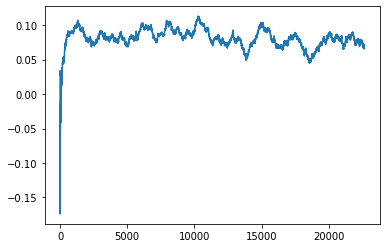

Thread: 5 iteration: 3830
RAM mDiffFit_70 FROM: 1664 --> 768 reward: 0.08216668125
Thread: 6 iteration: 3818
RAM mDiffFit_361 FROM: 3008 --> 192 reward: 0.295080642578125
Thread: 1 iteration: 3684
RAM mDiffFit_81 FROM: 1664 --> 192 reward: 0.2783932082031249
Thread: 2 iteration: 3779
RAM mBackground_6 FROM: 256 --> 192 reward: 1.1208086585468748
Thread: 3 iteration: 3792
RAM mDiffFit_308 FROM: 1920 --> 256 reward: 0.15552601796874999
Thread: 6 iteration: 3819
RAM mDiffFit_130 FROM: 704 --> 192 reward: 0.41899219023437506
Thread: 1 iteration: 3685
RAM mBackground_44 FROM: 2752 --> 256 reward: 0.520474551109375
Thread: 5 iteration: 3831
RAM mDiffFit_178 FROM: 2816 --> 256 reward: 0.460562521875
Saving ...


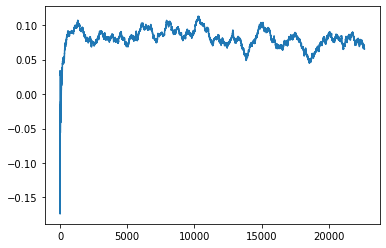

Thread: 2 iteration: 3780
RAM mDiffFit_73 FROM: 2624 --> 256 reward: 0.11371854218749994
Thread: 3 iteration: 3793
RAM mDiffFit_342 FROM: 1152 --> 256 reward: 0.18731769921875
Saving ...


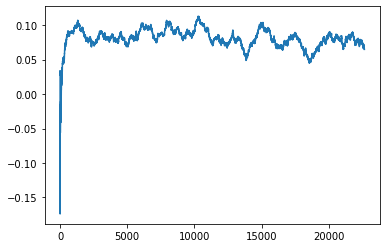

Thread: 6 iteration: 3820
RAM mDiffFit_250 FROM: 320 --> 256 reward: 0.09895314140625
Thread: 1 iteration: 3686
RAM mDiffFit_212 FROM: 1984 --> 384 reward: 0.270507853515625
Thread: 5 iteration: 3832
RAM mDiffFit_80 FROM: 320 --> 256 reward: -0.27792457851562496
Thread: 3 iteration: 3794
RAM mProject_69 FROM: 704 --> 192 reward: -1.0
Saving ...


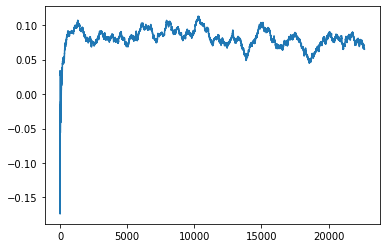

Thread: 4 iteration: 3750
RAM mBackground_35 FROM: 896 --> 256 reward: 0.4252923754531249
Thread: 6 iteration: 3821
RAM mDiffFit_82 FROM: 1280 --> 192 reward: 0.01859095351562503
Thread: 2 iteration: 3781
RAM mDiffFit_42 FROM: 320 --> 1408 reward: -0.10539320820312498
Thread: 3 iteration: 3795
RAM mDiffFit_139 FROM: 1280 --> 192 reward: 0.547179668359375
Thread: 1 iteration: 3687
RAM mDiffFit_264 FROM: 1920 --> 256 reward: 0.16037495624999998
Thread: 6 iteration: 3822
RAM mBackground_62 FROM: 448 --> 256 reward: 0.27248786066406255
Thread: 5 iteration: 3833
RAM mBackground_1 FROM: 2944 --> 256 reward: 0.47133803320312495
Thread: 2 iteration: 3782
RAM mDiffFit_215 FROM: 2240 --> 192 reward: 0.22646871718749995
Thread: 1 iteration: 3688
RAM mDiffFit_407 FROM: 1792 --> 256 reward: 0.216312478125
Thread: 6 iteration: 3823
RAM mDiffFit_40 FROM: 2496 --> 256 reward: 0.210960907421875
Thread: 5 iteration: 3834
RAM mBackground_61 FROM: 3008 --> 2880 reward: 0.11355595874999996
Thread: 2 iterat

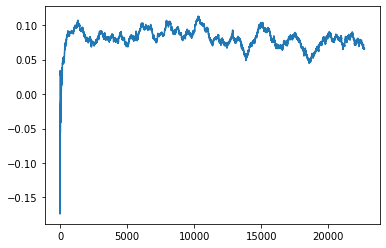

Thread: 1 iteration: 3690
RAM mDiffFit_41 FROM: 2048 --> 256 reward: 0.149479115625
Thread: 4 iteration: 3753
RAM mDiffFit_246 FROM: 832 --> 256 reward: 0.10756506679687497
Thread: 5 iteration: 3836
RAM mBackground_63 FROM: 2816 --> 256 reward: 0.42414998571875
Thread: 3 iteration: 3798
RAM mDiffFit_79 FROM: 128 --> 192 reward: -0.85373446796875
Thread: 6 iteration: 3825
RAM mDiffFit_367 FROM: 1536 --> 256 reward: 0.22704172500000003
Thread: 2 iteration: 3785
RAM mDiffFit_155 FROM: 3008 --> 1408 reward: -0.01590369414062499
Thread: 4 iteration: 3754
RAM mDiffFit_215 FROM: 1152 --> 256 reward: 0.10275517734375002
Thread: 1 iteration: 3691
RAM mDiffFit_277 FROM: 448 --> 256 reward: 0.060223938281249965
Thread: 5 iteration: 3837
RAM mDiffFit_371 FROM: 960 --> 256 reward: 0.14992185859374998
Thread: 3 iteration: 3799
RAM mDiffFit_178 FROM: 256 --> 256 reward: 0.012947920312499986
Thread: 6 iteration: 3826
RAM mDiffFit_12 FROM: 256 --> 256 reward: -0.025947920312499977
Thread: 2 iteration: 

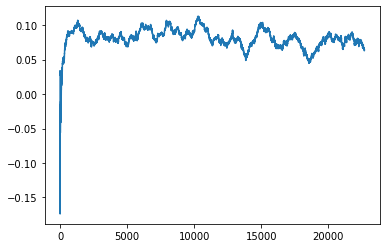

Thread: 3 iteration: 3800
RAM mDiffFit_202 FROM: 768 --> 256 reward: 0.13315623906250001
Thread: 2 iteration: 3787
RAM mDiffFit_62 FROM: 832 --> 256 reward: 0.0593228765625
Thread: 5 iteration: 3839
RAM mBackground_47 FROM: 512 --> 704 reward: -0.16413461468749996
Thread: 1 iteration: 3693
RAM mDiffFit_372 FROM: 1344 --> 448 reward: -0.041606879296875024
Thread: 4 iteration: 3756
RAM mProject_50 FROM: 1024 --> 2752 reward: -0.04820636552343758
Thread: 6 iteration: 3827
RAM mDiffFit_336 FROM: 640 --> 256 reward: 0.09219269921875002
Thread: 1 iteration: 3694
RAM mBackground_77 FROM: 2816 --> 2752 reward: 0.02597919174999993
Thread: 4 iteration: 3757
RAM mDiffFit_21 FROM: 1920 --> 192 reward: 0.31632809765625003
Thread: 6 iteration: 3828
RAM mBackground_26 FROM: 2944 --> 256 reward: 0.44740586921875003
Saving ...


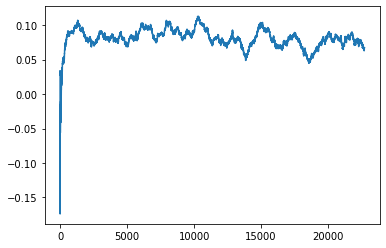

Thread: 5 iteration: 3840
RAM mProject_75 FROM: 1280 --> 192 reward: -1.0
Thread: 3 iteration: 3801
RAM mDiffFit_49 FROM: 2432 --> 256 reward: 0.18376035468750002
Thread: 4 iteration: 3758
RAM mDiffFit_337 FROM: 2112 --> 256 reward: 0.38710933671875003
Thread: 6 iteration: 3829
RAM mDiffFit_391 FROM: 2176 --> 256 reward: 0.704104203125
Thread: 5 iteration: 3841
RAM mDiffFit_94 FROM: 320 --> 256 reward: 0.16640106171875002
Thread: 4 iteration: 3759
RAM mProject_63 FROM: 1088 --> 256 reward: -1.0
Thread: 2 iteration: 3788
RAM mDiffFit_149 FROM: 2048 --> 256 reward: 0.326479159375
Saving ...


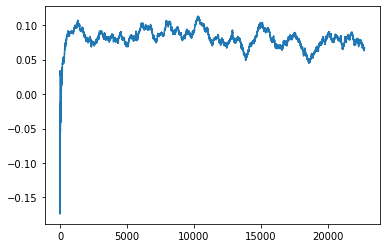

Thread: 6 iteration: 3830
RAM mDiffFit_74 FROM: 1280 --> 192 reward: 0.15689838554687502
Saving ...


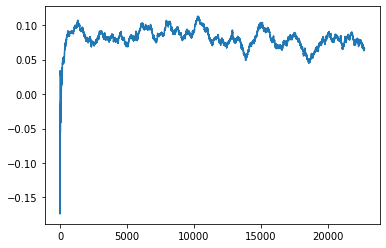

Thread: 4 iteration: 3760
RAM mDiffFit_355 FROM: 1600 --> 256 reward: 0.379518208203125
Thread: 6 iteration: 3831
RAM mProject_50 FROM: 192 --> 256 reward: -1.0
Thread: 1 iteration: 3695
RAM mBackground_88 FROM: 1664 --> 256 reward: 0.613130721328125
Thread: 2 iteration: 3789
RAM mProject_18 FROM: 2496 --> 192 reward: -1.0
Thread: 3 iteration: 3802
RAM mBackground_48 FROM: 1344 --> 256 reward: 0.4619453476875001
Thread: 5 iteration: 3842
RAM mDiffFit_325 FROM: 2752 --> 192 reward: 0.12196086367187503
Thread: 1 iteration: 3696
RAM mDiffFit_25 FROM: 2816 --> 192 reward: 0.15345305390625003
Saving ...


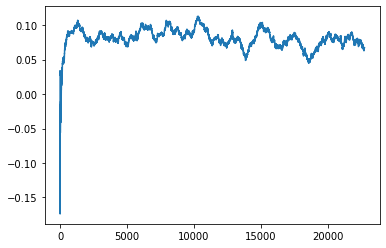

Thread: 2 iteration: 3790
RAM mDiffFit_111 FROM: 1920 --> 256 reward: 0.10020827500000003
Thread: 5 iteration: 3843
RAM mBackground_44 FROM: 2688 --> 384 reward: 0.3492136183125001
Thread: 6 iteration: 3832
RAM mProject_71 FROM: 1600 --> 2752 reward: 0.13598003235937492
Thread: 3 iteration: 3803
RAM mDiffFit_27 FROM: 2048 --> 256 reward: 0.18213539843749998
Thread: 1 iteration: 3697
RAM mDiffFit_167 FROM: 2496 --> 256 reward: 0.1094478328125
Thread: 2 iteration: 3791
RAM mDiffFit_134 FROM: 1600 --> 192 reward: 0.16861973515624995
Thread: 6 iteration: 3833
RAM mViewer_3 FROM: 704 --> 256 reward: 0.2978713611328125
Thread: 5 iteration: 3844
RAM mDiffFit_249 FROM: 704 --> 1984 reward: 0.034924578515624985
Thread: 1 iteration: 3698
RAM mDiffFit_153 FROM: 576 --> 192 reward: 0.13720309765625
Thread: 3 iteration: 3804
RAM mDiffFit_410 FROM: 1344 --> 192 reward: 0.325195287890625
Thread: 2 iteration: 3792
RAM mBackground_18 FROM: 1856 --> 384 reward: 0.4461630721328124
Thread: 5 iteration: 38

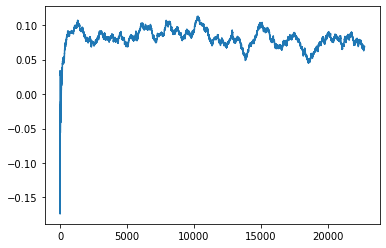

Thread: 1 iteration: 3700
RAM mBackground_14 FROM: 256 --> 448 reward: -0.2919767163984375
Thread: 4 iteration: 3762
RAM mBackground_32 FROM: 192 --> 256 reward: 0.7088372651875
Thread: 2 iteration: 3794
RAM mDiffFit_50 FROM: 640 --> 320 reward: 0.20122134960937504
Thread: 3 iteration: 3807
RAM mDiffFit_209 FROM: 896 --> 256 reward: 0.13520831874999997
Thread: 1 iteration: 3701
RAM mDiffFit_119 FROM: 2112 --> 448 reward: 0.07824995624999999
Thread: 4 iteration: 3763
RAM mDiffFit_12 FROM: 768 --> 1344 reward: 0.00016409257812498995
Thread: 3 iteration: 3808
RAM mProject_68 FROM: 1216 --> 256 reward: -1.0
Thread: 6 iteration: 3835
RAM mBackground_6 FROM: 832 --> 256 reward: 0.5274509950703125
Thread: 2 iteration: 3795
RAM mDiffFit_315 FROM: 2560 --> 256 reward: 0.17823951406249997
Thread: 4 iteration: 3764
RAM mDiffFit_244 FROM: 1856 --> 1088 reward: 0.02383590742187504
Thread: 3 iteration: 3809
RAM mDiffFit_358 FROM: 2048 --> 256 reward: 0.124395796875
Thread: 6 iteration: 3836
RAM mBac

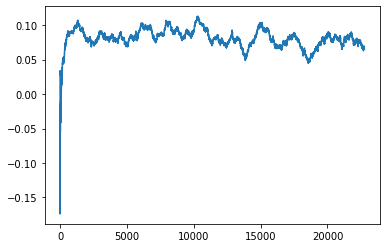

Thread: 5 iteration: 3850
RAM mDiffFit_179 FROM: 1536 --> 256 reward: 0.6336564140625001
Thread: 1 iteration: 3704
RAM mBackground_53 FROM: 2880 --> 256 reward: 0.42875456278125007
Thread: 2 iteration: 3798
RAM mDiffFit_252 FROM: 192 --> 256 reward: 0.19162508750000015
Thread: 6 iteration: 3838
RAM mProject_5 FROM: 512 --> 256 reward: -1.0
Saving ...


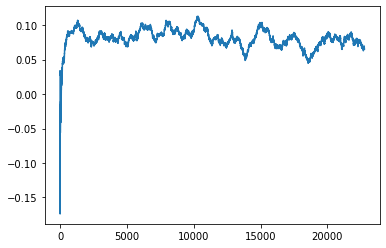

Thread: 3 iteration: 3810
RAM mDiffFit_200 FROM: 2944 --> 256 reward: 0.4534999125000001
Thread: 4 iteration: 3767
RAM mDiffFit_66 FROM: 576 --> 1088 reward: 0.02104172500000001
Thread: 5 iteration: 3851
RAM mDiffFit_107 FROM: 576 --> 256 reward: 0.156924491015625
Thread: 2 iteration: 3799
RAM mDiffFit_253 FROM: 512 --> 256 reward: 0.13473951406249995
Thread: 6 iteration: 3839
RAM mDiffFit_213 FROM: 2048 --> 256 reward: 0.30334367343749996
Thread: 3 iteration: 3811
RAM mDiffFit_61 FROM: 2944 --> 256 reward: 0.14654681484374998
Saving ...


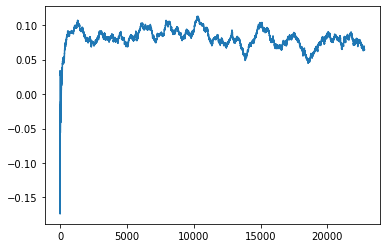

Thread: 2 iteration: 3800
RAM mDiffFit_209 FROM: 3008 --> 256 reward: 0.19802338554687499
Thread: 2 iteration: 3801
RAM mDiffFit_181 FROM: 2944 --> 320 reward: 0.3413437609375
Thread: 3 iteration: 3812
RAM mDiffFit_270 FROM: 1728 --> 320 reward: 0.5259635835937502
Saving ...


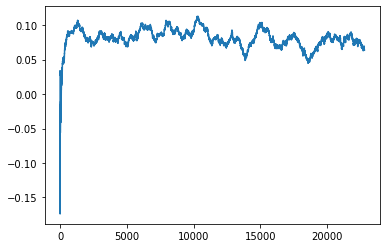

Thread: 6 iteration: 3840
RAM mProject_25 FROM: 704 --> 320 reward: -1.0
Thread: 1 iteration: 3705
RAM mProject_6 FROM: 2624 --> 320 reward: -1.0
Thread: 4 iteration: 3768
RAM mProject_35 FROM: 832 --> 256 reward: -1.0
Thread: 5 iteration: 3852
RAM mDiffFit_28 FROM: 2688 --> 192 reward: 0.16655462460937503
Thread: 3 iteration: 3813
RAM mDiffFit_338 FROM: 2496 --> 256 reward: 0.14234630585937502
Thread: 6 iteration: 3841
RAM mBackground_37 FROM: 2624 --> 256 reward: 0.5317485806875
Thread: 1 iteration: 3706
RAM mDiffFit_45 FROM: 3008 --> 1088 reward: 0.012476526953125004
Thread: 5 iteration: 3853
RAM mDiffFit_239 FROM: 1344 --> 320 reward: 0.35677601796875
Thread: 4 iteration: 3769
RAM mDiffFit_350 FROM: 1920 --> 320 reward: 0.192770796875
Thread: 6 iteration: 3842
RAM mDiffFit_145 FROM: 320 --> 192 reward: 0.011617146484375063
Thread: 1 iteration: 3707
RAM mDiffFit_160 FROM: 256 --> 192 reward: 0.03201561953124998
Thread: 5 iteration: 3854
RAM mBackground_52 FROM: 2176 --> 256 reward: 

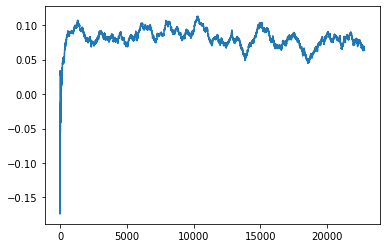

Thread: 4 iteration: 3770
RAM mDiffFit_414 FROM: 320 --> 704 reward: 0.011940154296875005
Thread: 1 iteration: 3708
RAM mDiffFit_8 FROM: 1088 --> 256 reward: 0.18914584062499995
Thread: 2 iteration: 3803
RAM mDiffFit_232 FROM: 2240 --> 192 reward: 0.225726526953125
Thread: 5 iteration: 3855
RAM mDiffFit_346 FROM: 832 --> 256 reward: 0.297804668359375
Thread: 3 iteration: 3815
RAM mDiffFit_1 FROM: 1728 --> 256 reward: 0.17627342929687498
Thread: 1 iteration: 3709
RAM mDiffFit_358 FROM: 2432 --> 320 reward: 0.24120573007812493
Thread: 5 iteration: 3856
RAM mDiffFit_318 FROM: 1856 --> 256 reward: 0.288497411328125
Thread: 3 iteration: 3816
RAM mBackground_33 FROM: 1216 --> 256 reward: 0.5820878982890625
Thread: 2 iteration: 3804
RAM mProject_5 FROM: 512 --> 704 reward: -1.0
Thread: 6 iteration: 3843
RAM mDiffFit_419 FROM: 768 --> 256 reward: 0.12547915937500004
Saving ...


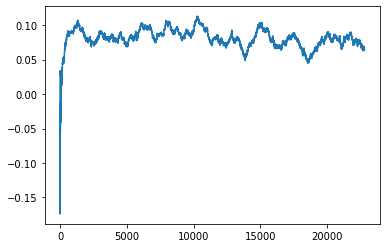

Thread: 1 iteration: 3710
RAM mDiffFit_170 FROM: 1984 --> 256 reward: 0.22979163750000003
Thread: 2 iteration: 3805
RAM mDiffFit_353 FROM: 1792 --> 2880 reward: 0.03374223398437501
Thread: 6 iteration: 3844
RAM mProject_83 FROM: 2944 --> 256 reward: -1.0
Thread: 4 iteration: 3771
RAM mDiffFit_293 FROM: 128 --> 256 reward: -0.44799482265624996
Thread: 2 iteration: 3806
RAM mBgModel_3 FROM: 3008 --> 256 reward: 0.7746174804687501
Thread: 3 iteration: 3817
RAM mDiffFit_94 FROM: 2624 --> 1088 reward: -0.0041328972656250185
Thread: 6 iteration: 3845
RAM mDiffFit_40 FROM: 512 --> 256 reward: 0.16944792031250003
Thread: 2 iteration: 3807
RAM mProject_67 FROM: 1472 --> 256 reward: -1.0
Thread: 5 iteration: 3857
RAM mDiffFit_84 FROM: 3008 --> 192 reward: 0.040101351953125
Thread: 4 iteration: 3772
RAM mProject_38 FROM: 3008 --> 256 reward: -1.0
Thread: 1 iteration: 3711
RAM mDiffFit_61 FROM: 704 --> 320 reward: 0.168841172265625
Thread: 6 iteration: 3846
RAM mDiffFit_27 FROM: 2880 --> 256 rewar

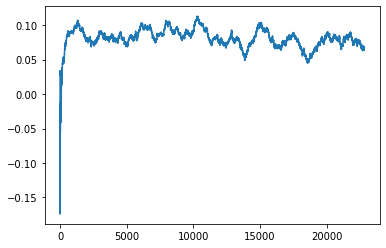

Thread: 5 iteration: 3860
RAM mDiffFit_281 FROM: 1664 --> 256 reward: 0.24240623906249995
Thread: 2 iteration: 3809
RAM mDiffFit_126 FROM: 704 --> 256 reward: 0.2777551773437501
Thread: 1 iteration: 3714
RAM mDiffFit_24 FROM: 896 --> 2560 reward: 0.12652105937499997
Thread: 5 iteration: 3861
RAM mBackground_33 FROM: 1408 --> 256 reward: 0.483136318109375
Thread: 6 iteration: 3849
RAM mProject_56 FROM: 1536 --> 256 reward: -1.0
Thread: 3 iteration: 3819
RAM mProject_42 FROM: 3008 --> 256 reward: -1.0
Thread: 4 iteration: 3775
RAM mDiffFit_223 FROM: 1856 --> 256 reward: 0.1258020359375
Saving ...


Thread: 2 iteration: 3810
RAM mDiffFit_318 FROM: 2368 --> 320 reward: 0.09570305390624997
Thread: 5 iteration: 3862
RAM mBackground_13 FROM: 2432 --> 256 reward: 0.44645629215624993
Saving ...


Thread: 6 iteration: 3850
RAM mProject_4 FROM: 448 --> 2752 reward: 0.7902370602421873
Thread: 1 iteration: 3715
RAM mDiffFit_370 FROM: 2368 --> 256 reward: 0.11516659374999999
Thread: 5 iteration: 3863
RAM mDiffFit_242 FROM: 704 --> 256 reward: 0.22109898203125
Thread: 4 iteration: 3776
RAM mBackground_45 FROM: 2816 --> 320 reward: 0.34035601841406243
Thread: 2 iteration: 3811
RAM mDiffFit_168 FROM: 2816 --> 256 reward: 0.13488535468750001
Thread: 5 iteration: 3864
RAM mProject_5 FROM: 2048 --> 256 reward: -1.0
Saving ...


Thread: 3 iteration: 3820
RAM mBackground_42 FROM: 1344 --> 256 reward: 0.48472866891406247
Thread: 4 iteration: 3777
RAM mDiffFit_391 FROM: 128 --> 256 reward: -0.29258327500000003
Thread: 2 iteration: 3812
RAM mDiffFit_58 FROM: 2304 --> 256 reward: 0.2391978765625
Thread: 5 iteration: 3865
RAM mProject_51 FROM: 1856 --> 256 reward: -1.0
Thread: 6 iteration: 3851
RAM mDiffFit_153 FROM: 1664 --> 256 reward: 0.22433331875
Thread: 3 iteration: 3821
RAM mDiffFit_243 FROM: 1344 --> 384 reward: 0.1165
Thread: 4 iteration: 3778
RAM mDiffFit_393 FROM: 2304 --> 256 reward: 0.0031455781249999787
Thread: 2 iteration: 3813
RAM mProject_81 FROM: 576 --> 256 reward: -1.0
Thread: 1 iteration: 3716
RAM mDiffFit_402 FROM: 2624 --> 320 reward: 0.14215360664062499
Thread: 5 iteration: 3866
RAM mDiffFit_131 FROM: 896 --> 256 reward: 0.165854159375
Thread: 6 iteration: 3852
RAM mDiffFit_117 FROM: 1152 --> 1920 reward: 0.06439070703125
Thread: 3 iteration: 3822
RAM mDiffFit_369 FROM: 896 --> 256 reward: 0.

Thread: 4 iteration: 3780
RAM mDiffFit_204 FROM: 1216 --> 256 reward: 0.134820287890625
Thread: 2 iteration: 3816
RAM mDiffFit_408 FROM: 2496 --> 256 reward: 0.221658827734375
Thread: 6 iteration: 3854
RAM mDiffFit_63 FROM: 1728 --> 256 reward: 0.31380471210937505
Thread: 3 iteration: 3824
RAM mDiffFit_314 FROM: 2176 --> 192 reward: 0.336645796875
Thread: 6 iteration: 3855
RAM mDiffFit_183 FROM: 2624 --> 320 reward: 0.42659371718749994
Thread: 2 iteration: 3817
RAM mProject_43 FROM: 896 --> 704 reward: -1.0
Thread: 5 iteration: 3867
RAM mDiffFit_83 FROM: 2688 --> 256 reward: 0.1184269921875
Thread: 3 iteration: 3825
RAM mProject_27 FROM: 2432 --> 256 reward: -1.0
Thread: 1 iteration: 3718
RAM mDiffFit_394 FROM: 1088 --> 704 reward: 0.032726570703125006
Thread: 6 iteration: 3856
RAM mDiffFit_280 FROM: 2816 --> 256 reward: 0.2035936734375
Thread: 2 iteration: 3818
RAM mDiffFit_183 FROM: 1472 --> 256 reward: 0.40060670429687506
Thread: 3 iteration: 3826
RAM mProject_50 FROM: 1280 --> 320 

Thread: 5 iteration: 3870
RAM mDiffFit_278 FROM: 2752 --> 2880 reward: 0.005109380468750011
Thread: 5 iteration: 3871
RAM mDiffFit_272 FROM: 2240 --> 256 reward: 0.18760411562499998
Saving ...


Thread: 2 iteration: 3820
RAM mProject_12 FROM: 960 --> 256 reward: -1.0
Thread: 6 iteration: 3858
RAM mDiffFit_249 FROM: 896 --> 2944 reward: 0.16167734218750002
Thread: 5 iteration: 3872
RAM mDiffFit_185 FROM: 1536 --> 256 reward: 0.1785103984375
Thread: 5 iteration: 3873
RAM mDiffFit_375 FROM: 2688 --> 192 reward: 0.5361249125000002
Thread: 2 iteration: 3821
RAM mBackground_42 FROM: 256 --> 256 reward: 0.10440940321874996
Thread: 6 iteration: 3859
RAM mDiffFit_42 FROM: 3008 --> 256 reward: 0.13920823124999998
Thread: 5 iteration: 3874
RAM mProject_24 FROM: 2112 --> 384 reward: -1.0
Thread: 4 iteration: 3784
RAM mDiffFit_386 FROM: 1920 --> 256 reward: 0.19511977890625
Saving ...


Thread: 6 iteration: 3860
RAM mDiffFit_175 FROM: 2560 --> 256 reward: 0.3781353109375001
Thread: 2 iteration: 3822
RAM mDiffFit_321 FROM: 2176 --> 256 reward: 0.11481243437499998
Thread: 5 iteration: 3875
RAM mDiffFit_252 FROM: 2112 --> 448 reward: 0.18042185859374998
Thread: 2 iteration: 3823
RAM mDiffFit_59 FROM: 384 --> 256 reward: 0.13636977890625
Thread: 6 iteration: 3861
RAM mBackground_74 FROM: 2816 --> 128 reward: 1.275079762578125
Saving ...


Thread: 1 iteration: 3720
RAM mBackground_8 FROM: 1152 --> 192 reward: 0.7416760819921875
Thread: 5 iteration: 3876
RAM mDiffFit_297 FROM: 3008 --> 256 reward: 0.12090878398437503
Thread: 6 iteration: 3862
RAM mDiffFit_303 FROM: 1472 --> 256 reward: 0.281002632421875
Thread: 2 iteration: 3824
RAM mDiffFit_54 FROM: 384 --> 256 reward: 0.03449477890625
Thread: 1 iteration: 3721
RAM mProject_28 FROM: 1728 --> 256 reward: -1.0
Thread: 4 iteration: 3785
RAM mBackground_54 FROM: 128 --> 256 reward: 0.782313534
Thread: 3 iteration: 3829
RAM mDiffFit_228 FROM: 1024 --> 448 reward: 0.075257809765625
Thread: 6 iteration: 3863
RAM mDiffFit_8 FROM: 512 --> 192 reward: 0.10413539843749997
Thread: 1 iteration: 3722
RAM mDiffFit_38 FROM: 2304 --> 256 reward: 0.445812434375
Thread: 5 iteration: 3877
RAM mBackground_47 FROM: 320 --> 256 reward: 0.15904177867187494
Thread: 2 iteration: 3825
RAM mDiffFit_2 FROM: 256 --> 256 reward: -0.19839588437499994
Thread: 4 iteration: 3786
RAM mDiffFit_330 FROM: 102

Thread: 3 iteration: 3830
RAM mDiffFit_393 FROM: 1984 --> 256 reward: 0.210450508984375
Thread: 5 iteration: 3879
RAM mDiffFit_67 FROM: 2816 --> 256 reward: 0.1818020359375
Thread: 2 iteration: 3827
RAM mDiffFit_105 FROM: 704 --> 256 reward: 0.08243484570312501
Thread: 3 iteration: 3831
RAM mDiffFit_313 FROM: 2176 --> 256 reward: 0.30468743437500007
Thread: 1 iteration: 3724
RAM mBackground_24 FROM: 1024 --> 192 reward: 0.6755590918515625
Thread: 6 iteration: 3865
RAM mDiffFit_48 FROM: 576 --> 256 reward: 0.00501035468750001
Thread: 2 iteration: 3828
RAM mDiffFit_280 FROM: 256 --> 256 reward: -0.04671876093749999
Thread: 3 iteration: 3832
RAM mDiffFit_74 FROM: 1856 --> 256 reward: 0.12942703593750002
Thread: 6 iteration: 3866
RAM mBackground_33 FROM: 2624 --> 256 reward: 0.4542209314921874
Saving ...


Thread: 5 iteration: 3880
RAM mProject_25 FROM: 2112 --> 256 reward: -1.0
Thread: 4 iteration: 3787
RAM mDiffFit_154 FROM: 2176 --> 256 reward: 0.11839048828125001
Thread: 1 iteration: 3725
RAM mDiffFit_350 FROM: 384 --> 256 reward: 0.11268230078125
Thread: 2 iteration: 3829
RAM mDiffFit_78 FROM: 2368 --> 256 reward: 0.129257766015625
Thread: 1 iteration: 3726
RAM mDiffFit_111 FROM: 320 --> 192 reward: 0.12032292031249996
Thread: 6 iteration: 3867
RAM mBackground_65 FROM: 2432 --> 256 reward: 0.4846322625781249
Thread: 3 iteration: 3833
RAM mDiffFit_99 FROM: 1856 --> 256 reward: 0.16689579687499997
Saving ...


Thread: 2 iteration: 3830
RAM mBackground_72 FROM: 2112 --> 256 reward: 0.4192879216328125
Thread: 5 iteration: 3881
RAM mDiffFit_132 FROM: 896 --> 192 reward: 0.6449480078125002
Thread: 4 iteration: 3788
RAM mDiffFit_408 FROM: 2880 --> 256 reward: 0.168611925390625
Thread: 6 iteration: 3868
RAM mDiffFit_106 FROM: 3008 --> 192 reward: 0.38952597421875007
Thread: 1 iteration: 3727
RAM mDiffFit_306 FROM: 1280 --> 256 reward: 0.078395753125
Thread: 3 iteration: 3834
RAM mDiffFit_22 FROM: 1344 --> 256 reward: 0.10323955781250002
Thread: 4 iteration: 3789
RAM mBackground_54 FROM: 2880 --> 256 reward: 0.41126568239843747
Thread: 2 iteration: 3831
RAM mDiffFit_185 FROM: 1664 --> 256 reward: 0.13809371718749996
Thread: 6 iteration: 3869
RAM mDiffFit_390 FROM: 1408 --> 256 reward: 0.11003641640625003
Thread: 3 iteration: 3835
RAM mDiffFit_355 FROM: 1280 --> 256 reward: 0.32287495624999996
Thread: 1 iteration: 3728
RAM mBackground_3 FROM: 2624 --> 256 reward: 0.5124142773671875
Thread: 2 iterati

Thread: 4 iteration: 3790
RAM mProject_72 FROM: 768 --> 256 reward: -1.0
Thread: 5 iteration: 3882
RAM mDiffFit_99 FROM: 2240 --> 256 reward: 0.1383853546875
Thread: 1 iteration: 3729
RAM mDiffFit_341 FROM: 1216 --> 256 reward: 0.189375
Thread: 2 iteration: 3833
RAM mDiffFit_83 FROM: 1600 --> 256 reward: 0.1407187171875
Thread: 5 iteration: 3883
RAM mBackground_8 FROM: 2432 --> 256 reward: 0.5457908199218751
Thread: 3 iteration: 3836
RAM mProject_32 FROM: 1536 --> 192 reward: -1.0
Saving ...


Thread: 6 iteration: 3870
RAM mDiffFit_62 FROM: 2944 --> 192 reward: 0.31112495625000003
Saving ...


Thread: 1 iteration: 3730
RAM mDiffFit_29 FROM: 2240 --> 256 reward: 0.11868480195312497
Thread: 2 iteration: 3834
RAM mBackground_32 FROM: 512 --> 256 reward: 0.2049486935625001
Thread: 4 iteration: 3791
RAM mDiffFit_193 FROM: 960 --> 256 reward: 0.247820331640625
Thread: 6 iteration: 3871
RAM mDiffFit_396 FROM: 256 --> 256 reward: -0.024572920312500024
Thread: 3 iteration: 3837
RAM mBackground_5 FROM: 2048 --> 256 reward: 0.505178270625
Thread: 5 iteration: 3884
RAM mDiffFit_140 FROM: 1664 --> 256 reward: 0.17276561953124997
Thread: 1 iteration: 3731
RAM mDiffFit_118 FROM: 1600 --> 256 reward: 0.19970831874999997
Thread: 2 iteration: 3835
RAM mDiffFit_90 FROM: 960 --> 256 reward: 0.251492190234375
Thread: 6 iteration: 3872
RAM mDiffFit_38 FROM: 2880 --> 256 reward: 0.4090884523437499
Thread: 4 iteration: 3792
RAM mDiffFit_19 FROM: 1152 --> 704 reward: 0.043028650390625
Thread: 4 iteration: 3793
RAM mDiffFit_366 FROM: 1856 --> 256 reward: 0.109604115625
Thread: 1 iteration: 3732
RAM m

Thread: 3 iteration: 3840
RAM mBackground_15 FROM: 1408 --> 256 reward: 0.47554411649999995
Thread: 6 iteration: 3877
RAM mDiffFit_329 FROM: 576 --> 256 reward: 0.07491663749999995
Thread: 3 iteration: 3841
RAM mDiffFit_300 FROM: 2496 --> 256 reward: 0.178187434375
Saving ...


Thread: 2 iteration: 3840
RAM mProject_82 FROM: 1216 --> 256 reward: -1.0
Thread: 4 iteration: 3795
RAM mDiffFit_56 FROM: 1216 --> 256 reward: 0.35482809765625
Thread: 3 iteration: 3842
RAM mDiffFit_10 FROM: 2944 --> 320 reward: 0.53149473515625
Thread: 4 iteration: 3796
RAM mDiffFit_146 FROM: 1088 --> 256 reward: 0.08351035468750001
Thread: 4 iteration: 3797
RAM mProject_66 FROM: 2496 --> 256 reward: -1.0
Thread: 6 iteration: 3878
RAM mProject_65 FROM: 256 --> 256 reward: -1.0
Thread: 5 iteration: 3888
RAM mBackground_84 FROM: 1600 --> 256 reward: 0.4652106460781249
Thread: 4 iteration: 3798
RAM mDiffFit_347 FROM: 128 --> 256 reward: -0.3951302210937499
Thread: 6 iteration: 3879
RAM mProject_56 FROM: 1728 --> 704 reward: -1.0
Thread: 2 iteration: 3841
RAM mDiffFit_286 FROM: 2240 --> 256 reward: 0.21962495625
Thread: 4 iteration: 3799
RAM mBackground_32 FROM: 1856 --> 256 reward: 0.46969429034375004
Thread: 5 iteration: 3889
RAM mDiffFit_415 FROM: 512 --> 128 reward: 0.37468230078125
S

Thread: 6 iteration: 3880
RAM mProject_55 FROM: 1984 --> 256 reward: -1.0
Thread: 3 iteration: 3843
RAM mDiffFit_396 FROM: 2816 --> 256 reward: 0.27734362968750004
Thread: 2 iteration: 3842
RAM mDiffFit_282 FROM: 1088 --> 256 reward: 0.254611969140625
Saving ...


Thread: 5 iteration: 3890
RAM mDiffFit_377 FROM: 256 --> 256 reward: 0.026895840625
Thread: 3 iteration: 3844
RAM mDiffFit_128 FROM: 1664 --> 128 reward: 0.3654791156250001
Thread: 6 iteration: 3881
RAM mDiffFit_365 FROM: 1472 --> 256 reward: -0.15602373554687493
Saving ...


Thread: 4 iteration: 3800
RAM mDiffFit_340 FROM: 2368 --> 448 reward: 0.24453128281249997
Thread: 5 iteration: 3891
RAM mDiffFit_94 FROM: 448 --> 256 reward: 0.17531769921874996
Thread: 3 iteration: 3845
RAM mDiffFit_409 FROM: 1920 --> 192 reward: 0.279039005078125
Thread: 4 iteration: 3801
RAM mDiffFit_342 FROM: 2816 --> 192 reward: 0.30336714648437507
Thread: 5 iteration: 3892
RAM mDiffFit_302 FROM: 256 --> 320 reward: 0.03842712343749999
Thread: 3 iteration: 3846
RAM mProject_20 FROM: 448 --> 256 reward: -1.0
Thread: 2 iteration: 3843
RAM mProject_49 FROM: 2560 --> 192 reward: -1.0
Thread: 6 iteration: 3882
RAM mBackground_9 FROM: 1088 --> 192 reward: 1.0299105228359373
Thread: 3 iteration: 3847
RAM mDiffFit_90 FROM: 1472 --> 1984 reward: 0.11986473281249999
Thread: 6 iteration: 3883
RAM mDiffFit_83 FROM: 2688 --> 256 reward: 0.16076557578125
Thread: 6 iteration: 3884
RAM mProject_46 FROM: 640 --> 192 reward: -1.0
Thread: 5 iteration: 3893
RAM mDiffFit_170 FROM: 2816 --> 256 reward:

Thread: 3 iteration: 3850
RAM mDiffFit_371 FROM: 832 --> 256 reward: 0.10004685859375002
Thread: 4 iteration: 3804
RAM mDiffFit_48 FROM: 832 --> 256 reward: 0.14079426992187502
Thread: 6 iteration: 3888
RAM mDiffFit_374 FROM: 2944 --> 256 reward: 0.09350513359375
Thread: 5 iteration: 3898
RAM mBackground_35 FROM: 576 --> 320 reward: 0.2949016294765625
Thread: 2 iteration: 3847
RAM mDiffFit_68 FROM: 960 --> 2624 reward: 0.08667984335937502
Thread: 6 iteration: 3889
RAM mDiffFit_144 FROM: 1792 --> 192 reward: 0.31073174804687503
Thread: 4 iteration: 3805
RAM mDiffFit_217 FROM: 1920 --> 320 reward: 0.09920309765624999
Thread: 2 iteration: 3848
RAM mDiffFit_106 FROM: 2560 --> 192 reward: 0.37792703593750004
Thread: 5 iteration: 3899
RAM mDiffFit_114 FROM: 1856 --> 1408 reward: 0.056382853515625
Thread: 2 iteration: 3849
RAM mDiffFit_56 FROM: 2304 --> 192 reward: 0.46298424921875
Thread: 4 iteration: 3806
RAM mDiffFit_309 FROM: 1408 --> 192 reward: 0.231549447265625
Saving ...


Thread: 2 iteration: 3850
RAM mBackground_89 FROM: 1472 --> 192 reward: 0.7384936066406251
Saving ...


Thread: 6 iteration: 3890
RAM mProject_54 FROM: 1472 --> 256 reward: -1.0
Thread: 3 iteration: 3851
RAM mDiffFit_285 FROM: 2688 --> 256 reward: 0.20111451406250003
Thread: 4 iteration: 3807
RAM mDiffFit_380 FROM: 1792 --> 256 reward: 0.1827812390625
Thread: 2 iteration: 3851
RAM mDiffFit_41 FROM: 1408 --> 2880 reward: 0.07089075078125001
Thread: 6 iteration: 3891
RAM mDiffFit_128 FROM: 1792 --> 192 reward: 0.24616404882812495
Thread: 3 iteration: 3852
RAM mProject_54 FROM: 2624 --> 192 reward: -1.0
Saving ...


Thread: 5 iteration: 3900
RAM mBackground_39 FROM: 2368 --> 320 reward: 0.3476123248515625
Thread: 4 iteration: 3808
RAM mDiffFit_351 FROM: 2112 --> 256 reward: 0.108062434375
Thread: 2 iteration: 3852
RAM mDiffFit_128 FROM: 960 --> 192 reward: 0.189335907421875
Thread: 6 iteration: 3892
RAM mDiffFit_263 FROM: 1152 --> 256 reward: 0.10808331875
Thread: 4 iteration: 3809
RAM mDiffFit_316 FROM: 1920 --> 192 reward: 0.20589057578125
Thread: 3 iteration: 3853
RAM mDiffFit_228 FROM: 2240 --> 192 reward: 0.306747323828125
Thread: 5 iteration: 3901
RAM mDiffFit_149 FROM: 2816 --> 256 reward: 0.12785407187499997
Thread: 2 iteration: 3853
RAM mDiffFit_150 FROM: 704 --> 192 reward: 0.12065101796875
Thread: 3 iteration: 3854
RAM mDiffFit_52 FROM: 2112 --> 256 reward: 0.227361969140625
Thread: 5 iteration: 3902
RAM mDiffFit_375 FROM: 128 --> 192 reward: -0.46390887148437504
Thread: 6 iteration: 3893
RAM mDiffFit_171 FROM: 1280 --> 1088 reward: 0.10015110546874997
Thread: 3 iteration: 3855
RAM mDif

Thread: 4 iteration: 3810
RAM mDiffFit_386 FROM: 1408 --> 192 reward: 0.181205686328125
Thread: 5 iteration: 3904
RAM mDiffFit_307 FROM: 512 --> 320 reward: 0.333221437109375
Thread: 2 iteration: 3855
RAM mDiffFit_229 FROM: 1792 --> 704 reward: 0.024296858593749998
Thread: 4 iteration: 3811
RAM mDiffFit_59 FROM: 2560 --> 192 reward: 0.56770823125
Thread: 3 iteration: 3856
RAM mDiffFit_402 FROM: 1664 --> 192 reward: 0.244398429296875
Thread: 4 iteration: 3812
RAM mDiffFit_416 FROM: 768 --> 256 reward: 0.189625
Thread: 3 iteration: 3857
RAM mBgModel_3 FROM: 512 --> 256 reward: 0.50032499125
Thread: 6 iteration: 3895
RAM mBackground_31 FROM: 896 --> 192 reward: 0.6909271393359375
Thread: 5 iteration: 3905
RAM mDiffFit_251 FROM: 640 --> 320 reward: 0.147903650390625
Thread: 3 iteration: 3858
RAM mDiffFit_232 FROM: 1536 --> 256 reward: 0.1331770359375
Thread: 6 iteration: 3896
RAM mDiffFit_199 FROM: 2816 --> 192 reward: 0.222914005078125
Thread: 5 iteration: 3906
RAM mProject_63 FROM: 2304 

Thread: 3 iteration: 3860
RAM mDiffFit_4 FROM: 2624 --> 256 reward: 0.08140615156249997
Thread: 5 iteration: 3909
RAM mDiffFit_204 FROM: 448 --> 1984 reward: -0.09808849609375
Thread: 3 iteration: 3861
RAM mBackground_44 FROM: 2880 --> 256 reward: 0.47181285935937495
Thread: 4 iteration: 3814
RAM mProject_88 FROM: 1856 --> 256 reward: -1.0
Thread: 2 iteration: 3857
RAM mDiffFit_271 FROM: 1024 --> 1920 reward: 0.09111991015625001
Thread: 3 iteration: 3862
RAM mDiffFit_207 FROM: 960 --> 256 reward: 0.051492102734374996
Thread: 4 iteration: 3815
RAM mBackground_6 FROM: 2816 --> 256 reward: 0.043035131000000046
Saving ...


Thread: 5 iteration: 3910
RAM mDiffFit_163 FROM: 704 --> 192 reward: 0.266544269921875
Thread: 2 iteration: 3858
RAM mProject_59 FROM: 2176 --> 256 reward: -1.0
Thread: 6 iteration: 3898
RAM mDiffFit_205 FROM: 1408 --> 1984 reward: -0.04969533164062499
Thread: 3 iteration: 3863
RAM mDiffFit_3 FROM: 640 --> 832 reward: 0.11535165820312504
Thread: 6 iteration: 3899
RAM mDiffFit_346 FROM: 128 --> 320 reward: -0.8160026324218752
Thread: 5 iteration: 3911
RAM mBackground_88 FROM: 1344 --> 256 reward: 0.4710761689140624
Thread: 4 iteration: 3816
RAM mDiffFit_363 FROM: 1792 --> 384 reward: 0.33404694609375
Thread: 3 iteration: 3864
RAM mDiffFit_53 FROM: 320 --> 320 reward: 0.05923960156249998
Saving ...


Thread: 6 iteration: 3900
RAM mDiffFit_236 FROM: 576 --> 2880 reward: 0.007968848437499999
Thread: 3 iteration: 3865
RAM mBackground_84 FROM: 896 --> 256 reward: 0.4548145770625
Thread: 5 iteration: 3912
RAM mBackground_51 FROM: 2816 --> 256 reward: 0.4964706577499999
Thread: 4 iteration: 3817
RAM mProject_38 FROM: 1280 --> 256 reward: -1.0
Thread: 2 iteration: 3859
RAM mBackground_17 FROM: 1088 --> 256 reward: 0.41643028541406246
Thread: 3 iteration: 3866
RAM mDiffFit_190 FROM: 256 --> 256 reward: -0.2406146453125
Thread: 4 iteration: 3818
RAM mDiffFit_87 FROM: 2688 --> 256 reward: 0.1308749125
Thread: 5 iteration: 3913
RAM mDiffFit_327 FROM: 2112 --> 256 reward: 0.19212495624999998
Saving ...


Thread: 2 iteration: 3860
RAM mDiffFit_215 FROM: 1408 --> 256 reward: 0.137104115625
Thread: 3 iteration: 3867
RAM mDiffFit_392 FROM: 2560 --> 704 reward: 0.04007546523437499
Thread: 4 iteration: 3819
RAM mProject_58 FROM: 2752 --> 320 reward: -1.0
Thread: 6 iteration: 3901
RAM mDiffFit_269 FROM: 2368 --> 704 reward: 0.07040623906249999
Thread: 2 iteration: 3861
RAM mDiffFit_224 FROM: 2240 --> 1088 reward: 0.024304668359375007
Thread: 3 iteration: 3868
RAM mDiffFit_99 FROM: 2752 --> 256 reward: 0.1915936734375
Thread: 6 iteration: 3902
RAM mDiffFit_238 FROM: 3008 --> 320 reward: 0.16293739062499996
Saving ...


Thread: 4 iteration: 3820
RAM mProject_64 FROM: 2496 --> 192 reward: -1.0
Thread: 5 iteration: 3914
RAM mDiffFit_290 FROM: 2560 --> 704 reward: -0.024179799609375004
Thread: 6 iteration: 3903
RAM mDiffFit_56 FROM: 2368 --> 256 reward: 0.33420305390625005
Thread: 3 iteration: 3869
RAM mDiffFit_373 FROM: 2368 --> 1984 reward: -0.0030625218750000155
Thread: 6 iteration: 3904
RAM mDiffFit_280 FROM: 320 --> 320 reward: 0.022903650390625023
Thread: 4 iteration: 3821
RAM mBackground_73 FROM: 896 --> 256 reward: 0.44514851971874997
Saving ...


Thread: 3 iteration: 3870
RAM mDiffFit_119 FROM: 320 --> 256 reward: 0.087145840625
Thread: 6 iteration: 3905
RAM mDiffFit_34 FROM: 1152 --> 256 reward: 0.3471249999999999
Thread: 4 iteration: 3822
RAM mProject_52 FROM: 1152 --> 256 reward: -1.0
Thread: 2 iteration: 3862
RAM mDiffFit_32 FROM: 2944 --> 832 reward: 0.075229159375
Thread: 3 iteration: 3871
RAM mBackground_81 FROM: 1280 --> 256 reward: 0.7324064802812501
Thread: 2 iteration: 3863
RAM mDiffFit_356 FROM: 1152 --> 256 reward: 0.3870885835937499
Thread: 2 iteration: 3864
RAM mDiffFit_287 FROM: 2816 --> 256 reward: 0.20974995624999998
Thread: 2 iteration: 3865
RAM mProject_59 FROM: 1600 --> 448 reward: -1.0
Thread: 6 iteration: 3906
RAM mDiffFit_183 FROM: 2752 --> 2624 reward: 0.04815110546875008
Thread: 2 iteration: 3866
RAM mProject_55 FROM: 1152 --> 256 reward: -1.0
Thread: 4 iteration: 3823
RAM mProject_46 FROM: 1024 --> 256 reward: -1.0
Thread: 3 iteration: 3872
RAM mDiffFit_48 FROM: 1728 --> 1984 reward: 0.145054843359375

Thread: 2 iteration: 3870
RAM mDiffFit_33 FROM: 1664 --> 320 reward: 0.147783783984375
Thread: 4 iteration: 3827
RAM mProject_33 FROM: 256 --> 256 reward: -1.0
Thread: 6 iteration: 3909
RAM mProject_49 FROM: 1536 --> 256 reward: -1.0
Thread: 3 iteration: 3875
RAM mBackground_80 FROM: 3008 --> 256 reward: 0.4624245134843751
Thread: 2 iteration: 3871
RAM mDiffFit_85 FROM: 1344 --> 256 reward: 0.15383331874999998
Saving ...


Thread: 6 iteration: 3910
RAM mProject_27 FROM: 1344 --> 1984 reward: -0.043771779843749956
Thread: 4 iteration: 3828
RAM mDiffFit_30 FROM: 2176 --> 256 reward: 0.22777079687500004
Thread: 2 iteration: 3872
RAM mDiffFit_119 FROM: 2816 --> 256 reward: 0.19696867343750002
Thread: 4 iteration: 3829
RAM mProject_90 FROM: 2688 --> 256 reward: -1.0
Thread: 5 iteration: 3919
RAM mBackground_22 FROM: 1344 --> 256 reward: 0.5005490918515625
Thread: 6 iteration: 3911
RAM mDiffFit_46 FROM: 448 --> 256 reward: 0.020880177343750028
Saving ...


Thread: 4 iteration: 3830
RAM mProject_59 FROM: 1344 --> 1024 reward: 0.14556704716406266
Thread: 3 iteration: 3876
RAM mDiffFit_342 FROM: 1600 --> 256 reward: 0.18043747812499997
Saving ...


Thread: 5 iteration: 3920
RAM mDiffFit_391 FROM: 2688 --> 256 reward: 0.6153645578125
Thread: 5 iteration: 3921
RAM mDiffFit_150 FROM: 1472 --> 1408 reward: 0.020210951171875016
Thread: 5 iteration: 3922
RAM mProject_25 FROM: 1984 --> 256 reward: -1.0
Thread: 6 iteration: 3912
RAM mDiffFit_214 FROM: 2624 --> 1984 reward: 0.033708362500000005
Thread: 5 iteration: 3923
RAM mDiffFit_300 FROM: 1216 --> 256 reward: 0.2220937609375
Thread: 5 iteration: 3924
RAM mProject_42 FROM: 1536 --> 320 reward: -1.0
Thread: 2 iteration: 3873
RAM mProject_67 FROM: 1472 --> 256 reward: -1.0
Thread: 4 iteration: 3831
RAM mProject_19 FROM: 448 --> 256 reward: -1.0
Thread: 3 iteration: 3877
RAM mBackground_36 FROM: 1664 --> 256 reward: 0.56798517384375
Thread: 6 iteration: 3913
RAM mDiffFit_258 FROM: 512 --> 1088 reward: -0.011476526953124993
Thread: 5 iteration: 3925
RAM mDiffFit_340 FROM: 2240 --> 1344 reward: 0.0021093367187500003
Thread: 3 iteration: 3878
RAM mDiffFit_287 FROM: 2752 --> 256 reward: 0.178

Thread: 3 iteration: 3880
RAM mProject_29 FROM: 704 --> 1280 reward: 0.75685001484375
Thread: 5 iteration: 3929
RAM mDiffFit_33 FROM: 1344 --> 1024 reward: 0.024911460156249992
Thread: 4 iteration: 3835
RAM mDiffFit_399 FROM: 512 --> 192 reward: 0.389112012890625
Thread: 6 iteration: 3919
RAM mDiffFit_71 FROM: 2240 --> 256 reward: 0.137565066796875
Saving ...


Thread: 5 iteration: 3930
RAM mDiffFit_139 FROM: 192 --> 256 reward: -0.24121095117187497
Saving ...


Thread: 6 iteration: 3920
RAM mDiffFit_291 FROM: 2048 --> 192 reward: 0.599221305859375
Thread: 3 iteration: 3881
RAM mDiffFit_199 FROM: 2816 --> 256 reward: 0.11453115156249999
Thread: 6 iteration: 3921
RAM mDiffFit_354 FROM: 1920 --> 256 reward: 0.18029685859375
Thread: 3 iteration: 3882
RAM mProject_67 FROM: 1984 --> 320 reward: -1.0
Thread: 2 iteration: 3876
RAM mProject_68 FROM: 128 --> 2880 reward: 0.8013258404296875
Thread: 5 iteration: 3931
RAM mDiffFit_39 FROM: 2496 --> 256 reward: 0.18331506679687498
Thread: 6 iteration: 3922
RAM mAdd_2 FROM: 2560 --> 256 reward: -1.0
Thread: 4 iteration: 3836
RAM mDiffFit_305 FROM: 512 --> 256 reward: 0.06858331875000001
Thread: 5 iteration: 3932
RAM mDiffFit_408 FROM: 384 --> 256 reward: 0.09677084062500001
Thread: 3 iteration: 3883
RAM mDiffFit_361 FROM: 1216 --> 256 reward: 0.25652865039062495
Thread: 2 iteration: 3877
RAM mDiffFit_62 FROM: 1024 --> 256 reward: 0.09781247812500003
Thread: 4 iteration: 3837
RAM mDiffFit_229 FROM: 1664 --> 

Thread: 4 iteration: 3840
RAM mDiffFit_205 FROM: 2496 --> 704 reward: 0.05590882773437501
Thread: 6 iteration: 3926
RAM mProject_73 FROM: 2752 --> 256 reward: -1.0
Thread: 5 iteration: 3933
RAM mProject_26 FROM: 2368 --> 256 reward: -1.0
Thread: 3 iteration: 3884
RAM mDiffFit_302 FROM: 192 --> 1408 reward: -0.5045415937499999
Thread: 4 iteration: 3841
RAM mDiffFit_186 FROM: 1728 --> 704 reward: -0.010570375390624998
Thread: 5 iteration: 3934
RAM mDiffFit_274 FROM: 2752 --> 256 reward: 0.164273385546875
Thread: 6 iteration: 3927
RAM mProject_66 FROM: 640 --> 256 reward: -1.0
Thread: 2 iteration: 3879
RAM mDiffFit_9 FROM: 1728 --> 256 reward: 0.11674995625000002
Thread: 3 iteration: 3885
RAM mDiffFit_420 FROM: 1984 --> 704 reward: 0.008942655468750019
Thread: 5 iteration: 3935
RAM mDiffFit_323 FROM: 2816 --> 256 reward: 0.34692694843749994
Thread: 4 iteration: 3842
RAM mDiffFit_354 FROM: 2688 --> 1088 reward: -0.0012031851562499876
Thread: 5 iteration: 3936
RAM mBackground_27 FROM: 512 -

Thread: 6 iteration: 3930
RAM mAdd_3 FROM: 2560 --> 704 reward: 0.1590739521484374
Thread: 5 iteration: 3937
RAM mDiffFit_346 FROM: 2112 --> 256 reward: 0.34169265546875
Thread: 4 iteration: 3844
RAM mProject_66 FROM: 384 --> 896 reward: 0.9336259441406249
Thread: 3 iteration: 3886
RAM mProject_51 FROM: 128 --> 320 reward: -1.0
Saving ...


Thread: 2 iteration: 3880
RAM mDiffFit_274 FROM: 1280 --> 320 reward: 0.223018251953125
Thread: 6 iteration: 3931
RAM mDiffFit_204 FROM: 1216 --> 256 reward: 0.1741770796875
Thread: 4 iteration: 3845
RAM mBackground_90 FROM: 3008 --> 192 reward: 0.6787391151953125
Thread: 5 iteration: 3938
RAM mDiffFit_311 FROM: 2688 --> 2880 reward: 0.03598442421875002
Thread: 3 iteration: 3887
RAM mDiffFit_387 FROM: 384 --> 2752 reward: -0.01720296640625004
Thread: 2 iteration: 3881
RAM mDiffFit_257 FROM: 448 --> 256 reward: -0.061599025781250046
Thread: 6 iteration: 3932
RAM mBackground_82 FROM: 960 --> 256 reward: 0.43248815905468757
Thread: 4 iteration: 3846
RAM mBackground_14 FROM: 2816 --> 192 reward: 0.7117685184140623
Thread: 5 iteration: 3939
RAM mDiffFit_218 FROM: 2624 --> 896 reward: 0.04393225703125
Thread: 3 iteration: 3888
RAM mDiffFit_417 FROM: 1600 --> 448 reward: 0.07859634960937499
Thread: 6 iteration: 3933
RAM mDiffFit_71 FROM: 128 --> 256 reward: -0.26503646015625004
Saving ...


Thread: 5 iteration: 3940
RAM mAdd_3 FROM: 1344 --> 2880 reward: 0.010242430859375082
Thread: 4 iteration: 3847
RAM mDiffFit_262 FROM: 704 --> 448 reward: 0.08477606171875
Thread: 4 iteration: 3848
RAM mDiffFit_13 FROM: 192 --> 320 reward: -0.07349477890625004
Thread: 5 iteration: 3941
RAM mImgtbl_1 FROM: 1344 --> 320 reward: 0.7919208493750001
Thread: 6 iteration: 3934
RAM mDiffFit_114 FROM: 2688 --> 2880 reward: 0.03173442421875002
Thread: 5 iteration: 3942
RAM mProject_46 FROM: 832 --> 256 reward: -1.0
Thread: 2 iteration: 3882
RAM mDiffFit_125 FROM: 1408 --> 192 reward: 0.28748433671875
Thread: 6 iteration: 3935
RAM mProject_33 FROM: 448 --> 256 reward: -1.0
Thread: 3 iteration: 3889
RAM mDiffFit_186 FROM: 128 --> 320 reward: -0.6548229640625001
Thread: 6 iteration: 3936
RAM mDiffFit_29 FROM: 128 --> 192 reward: -0.5791380746093749
Thread: 5 iteration: 3943
RAM mDiffFit_220 FROM: 640 --> 2880 reward: -0.07365619531249998
Saving ...


Thread: 3 iteration: 3890
RAM mDiffFit_122 FROM: 1088 --> 1984 reward: 0.027520884375000006
Thread: 6 iteration: 3937
RAM mProject_17 FROM: 256 --> 192 reward: -1.0
Thread: 4 iteration: 3849
RAM mDiffFit_155 FROM: 320 --> 256 reward: 0.08741668124999998
Thread: 6 iteration: 3938
RAM mBackground_77 FROM: 2624 --> 192 reward: 0.6825173118749999
Thread: 3 iteration: 3891
RAM mDiffFit_201 FROM: 1984 --> 1408 reward: 0.049296902343750004
Saving ...


Thread: 4 iteration: 3850
RAM mDiffFit_66 FROM: 768 --> 2880 reward: 0.02659384843750001
Thread: 6 iteration: 3939
RAM mProject_57 FROM: 1344 --> 448 reward: -1.0
Thread: 2 iteration: 3883
RAM mDiffFit_353 FROM: 3008 --> 320 reward: 0.058945200390625
Saving ...


Thread: 6 iteration: 3940
RAM mProject_33 FROM: 2240 --> 448 reward: -1.0
Thread: 5 iteration: 3944
RAM mDiffFit_148 FROM: 2112 --> 320 reward: 0.203070287890625
Thread: 2 iteration: 3884
RAM mDiffFit_127 FROM: 1600 --> 192 reward: 0.1865519921875
Thread: 4 iteration: 3851
RAM mProject_85 FROM: 1600 --> 2816 reward: 0.17201992253906248
Thread: 3 iteration: 3892
RAM mDiffFit_96 FROM: 1024 --> 1088 reward: 0.04081774296875
Thread: 5 iteration: 3945
RAM mDiffFit_303 FROM: 2944 --> 2624 reward: 0.05838026484375
Thread: 3 iteration: 3893
RAM mDiffFit_215 FROM: 1024 --> 384 reward: 0.28165110546875005
Thread: 4 iteration: 3852
RAM mDiffFit_128 FROM: 1792 --> 192 reward: 0.6370625656250001
Thread: 2 iteration: 3885
RAM mDiffFit_78 FROM: 2880 --> 384 reward: 0.253742190234375
Thread: 5 iteration: 3946
RAM mDiffFit_422 FROM: 640 --> 1344 reward: -0.05458331875000001
Thread: 3 iteration: 3894
RAM mDiffFit_339 FROM: 1408 --> 448 reward: 0.10358849609374998
Thread: 4 iteration: 3853
RAM mDiffFit_1

Thread: 5 iteration: 3950
RAM mDiffFit_88 FROM: 2496 --> 256 reward: 0.33985929296874995
Thread: 3 iteration: 3898
RAM mDiffFit_292 FROM: 704 --> 192 reward: 0.33826039843749994
Thread: 4 iteration: 3856
RAM mDiffFit_153 FROM: 1280 --> 320 reward: 0.10066404882812502
Thread: 3 iteration: 3899
RAM mDiffFit_422 FROM: 192 --> 192 reward: 0.09732033164062494
Thread: 6 iteration: 3944
RAM mDiffFit_57 FROM: 1088 --> 192 reward: 0.31589061953124997
Thread: 4 iteration: 3857
RAM mDiffFit_172 FROM: 2176 --> 256 reward: 0.09146862968749996
Thread: 2 iteration: 3888
RAM mDiffFit_296 FROM: 1024 --> 2624 reward: 0.04494800781250002
Thread: 4 iteration: 3858
RAM mDiffFit_77 FROM: 960 --> 192 reward: 0.27998438046874996
Saving ...


Thread: 3 iteration: 3900
RAM mDiffFit_282 FROM: 1344 --> 192 reward: 0.3256562390625
Thread: 2 iteration: 3889
RAM mDiffFit_262 FROM: 320 --> 2880 reward: -0.18732024414062495
Thread: 4 iteration: 3859
RAM mDiffFit_260 FROM: 1152 --> 1088 reward: -0.0026093804687499916
Saving ...


Thread: 2 iteration: 3890
RAM mProject_63 FROM: 640 --> 448 reward: -1.0
Thread: 5 iteration: 3951
RAM mDiffFit_268 FROM: 2112 --> 320 reward: 0.09235929296875
Thread: 2 iteration: 3891
RAM mDiffFit_156 FROM: 768 --> 192 reward: 0.45149999999999996
Thread: 5 iteration: 3952
RAM mDiffFit_278 FROM: 2368 --> 1216 reward: 0.12700267617187502
Thread: 2 iteration: 3892
RAM mProject_70 FROM: 192 --> 320 reward: -1.0
Thread: 6 iteration: 3945
RAM mDiffFit_16 FROM: 576 --> 1024 reward: 0.06247924687500002
Thread: 6 iteration: 3946
RAM mDiffFit_277 FROM: 576 --> 1024 reward: -0.029940066796874977
Thread: 5 iteration: 3953
RAM mProject_32 FROM: 1216 --> 256 reward: -1.0
Thread: 3 iteration: 3901
RAM mDiffFit_106 FROM: 1344 --> 1280 reward: -0.057908915234375
Thread: 6 iteration: 3947
RAM mDiffFit_143 FROM: 2240 --> 192 reward: 0.180658783984375
Thread: 5 iteration: 3954
RAM mDiffFit_177 FROM: 384 --> 1280 reward: -0.004192655468749987
Thread: 5 iteration: 3955
RAM mDiffFit_50 FROM: 2304 --> 1984 

Thread: 4 iteration: 3860
RAM mDiffFit_8 FROM: 2432 --> 1408 reward: 0.015177079687500004
Thread: 2 iteration: 3894
RAM mDiffFit_307 FROM: 2048 --> 256 reward: 0.24380207968749998
Thread: 5 iteration: 3958
RAM mProject_20 FROM: 2112 --> 192 reward: -1.0
Thread: 3 iteration: 3902
RAM mDiffFit_44 FROM: 2496 --> 256 reward: 0.222158827734375
Thread: 5 iteration: 3959
RAM mDiffFit_85 FROM: 1216 --> 704 reward: 0.17743497695312502
Thread: 4 iteration: 3861
RAM mProject_23 FROM: 384 --> 704 reward: -1.0
Thread: 6 iteration: 3948
RAM mDiffFit_79 FROM: 1856 --> 256 reward: 0.26903123906250004
Thread: 2 iteration: 3895
RAM mDiffFit_94 FROM: 1344 --> 256 reward: 0.3882812390625
Thread: 3 iteration: 3903
RAM mDiffFit_98 FROM: 448 --> 320 reward: 0.12945836250000003
Saving ...


Thread: 5 iteration: 3960
RAM mBackground_61 FROM: 2752 --> 1280 reward: -0.04027457836718754
Thread: 6 iteration: 3949
RAM mDiffFit_275 FROM: 1792 --> 448 reward: 0.12244011054687502
Thread: 3 iteration: 3904
RAM mDiffFit_210 FROM: 1600 --> 192 reward: 0.451455730078125
Thread: 5 iteration: 3961
RAM mDiffFit_119 FROM: 256 --> 192 reward: 0.45837767617187497
Saving ...


Thread: 6 iteration: 3950
RAM mBackground_67 FROM: 1088 --> 1088 reward: -0.003439999999999979
Thread: 3 iteration: 3905
RAM mDiffFit_23 FROM: 384 --> 256 reward: 0.10791146015625003
Thread: 5 iteration: 3962
RAM mDiffFit_45 FROM: 2240 --> 320 reward: 0.15863539843749996
Thread: 3 iteration: 3906
RAM mProject_27 FROM: 128 --> 320 reward: -1.0
Thread: 4 iteration: 3862
RAM mDiffFit_79 FROM: 832 --> 192 reward: 0.351388030859375
Thread: 6 iteration: 3951
RAM mProject_54 FROM: 1216 --> 192 reward: -1.0
Thread: 2 iteration: 3896
RAM mDiffFit_284 FROM: 2432 --> 2880 reward: 0.009885442187500017
Thread: 5 iteration: 3963
RAM mDiffFit_133 FROM: 2176 --> 1088 reward: 0.034999999999999996
Thread: 3 iteration: 3907
RAM mDiffFit_277 FROM: 1216 --> 704 reward: -0.012299534765625002
Thread: 4 iteration: 3863
RAM mDiffFit_166 FROM: 1984 --> 448 reward: 0.12408853984375003
Thread: 6 iteration: 3952
RAM mBackground_69 FROM: 2112 --> 448 reward: 0.33365309678124994
Thread: 2 iteration: 3897
RAM mDiffFi

Thread: 2 iteration: 3900
RAM mBackground_79 FROM: 384 --> 384 reward: 0.06604533601562507
Thread: 4 iteration: 3867
RAM mDiffFit_112 FROM: 1024 --> 384 reward: 0.29220318515625004
Thread: 5 iteration: 3966
RAM mDiffFit_27 FROM: 1856 --> 256 reward: 0.24226039843750005
Saving ...


Thread: 3 iteration: 3910
RAM mDiffFit_350 FROM: 832 --> 192 reward: 0.16586973515624995
Thread: 4 iteration: 3868
RAM mDiffFit_91 FROM: 1152 --> 192 reward: 0.377804712109375
Thread: 5 iteration: 3967
RAM mDiffFit_242 FROM: 2880 --> 320 reward: 0.09984889453124998
Thread: 5 iteration: 3968
RAM mDiffFit_364 FROM: 320 --> 192 reward: 0.2396354421875
Thread: 5 iteration: 3969
RAM mProject_55 FROM: 1792 --> 1088 reward: 0.20047453403906257
Thread: 2 iteration: 3901
RAM mDiffFit_112 FROM: 2880 --> 2176 reward: 0.03618752187499999
Saving ...


Thread: 5 iteration: 3970
RAM mAdd_2 FROM: 896 --> 256 reward: -1.0
Thread: 6 iteration: 3956
RAM mProject_27 FROM: 960 --> 704 reward: -1.0
Thread: 3 iteration: 3911
RAM mDiffFit_273 FROM: 768 --> 2560 reward: 0.021479246875000003
Thread: 6 iteration: 3957
RAM mDiffFit_257 FROM: 3008 --> 2176 reward: -0.09683608242187496
Thread: 3 iteration: 3912
RAM mDiffFit_373 FROM: 2432 --> 256 reward: 0.49636460156249995
Thread: 6 iteration: 3958
RAM mProject_42 FROM: 2176 --> 192 reward: -1.0
Thread: 4 iteration: 3869
RAM mDiffFit_418 FROM: 960 --> 192 reward: 0.17899995624999998
Thread: 3 iteration: 3913
RAM mProject_24 FROM: 1280 --> 256 reward: -1.0
Thread: 2 iteration: 3902
RAM mProject_56 FROM: 2880 --> 256 reward: -1.0
Thread: 5 iteration: 3971
RAM mDiffFit_225 FROM: 2560 --> 192 reward: 0.23039048828125003
Thread: 6 iteration: 3959
RAM mDiffFit_344 FROM: 1088 --> 1088 reward: 0.019122411328125026
Thread: 3 iteration: 3914
RAM mDiffFit_394 FROM: 1536 --> 256 reward: 0.15786455781249997
Sav

Thread: 4 iteration: 3870
RAM mDiffFit_180 FROM: 768 --> 192 reward: 0.21044528789062494
Thread: 2 iteration: 3903
RAM mDiffFit_393 FROM: 2176 --> 192 reward: 0.26269528789062496
Thread: 5 iteration: 3972
RAM mDiffFit_339 FROM: 1920 --> 192 reward: 0.29221871718750003
Saving ...


Thread: 6 iteration: 3960
RAM mBackground_40 FROM: 2688 --> 2240 reward: -0.005280970421875024
Thread: 4 iteration: 3871
RAM mDiffFit_153 FROM: 704 --> 256 reward: 0.13103646015624998
Thread: 2 iteration: 3904
RAM mDiffFit_225 FROM: 2240 --> 192 reward: 0.285721305859375
Thread: 3 iteration: 3915
RAM mDiffFit_323 FROM: 2048 --> 192 reward: 0.5398775449218749
Thread: 5 iteration: 3973
RAM mDiffFit_198 FROM: 2496 --> 256 reward: 0.14222130585937504
Thread: 2 iteration: 3905
RAM mAdd_1 FROM: 1664 --> 2176 reward: -0.006400974218749925
Thread: 3 iteration: 3916
RAM mDiffFit_96 FROM: 576 --> 1920 reward: -0.04668743437499999
Thread: 2 iteration: 3906
RAM mDiffFit_215 FROM: 512 --> 1024 reward: 0.016770884375000017
Thread: 2 iteration: 3907
RAM mDiffFit_155 FROM: 1792 --> 1152 reward: 0.10698964531249999
Thread: 3 iteration: 3917
RAM mProject_23 FROM: 768 --> 256 reward: -1.0
Thread: 6 iteration: 3961
RAM mProject_42 FROM: 256 --> 1408 reward: 0.717050326359375
Thread: 4 iteration: 3872
RAM 

Thread: 3 iteration: 3920
RAM mBackground_2 FROM: 384 --> 1024 reward: -0.24480881810937502
Thread: 5 iteration: 3978
RAM mDiffFit_330 FROM: 1792 --> 256 reward: 0.13149995625
Thread: 4 iteration: 3877
RAM mDiffFit_110 FROM: 2304 --> 256 reward: 0.21681247812499999
Saving ...


Thread: 2 iteration: 3910
RAM mDiffFit_160 FROM: 1728 --> 256 reward: 0.297875
Thread: 6 iteration: 3966
RAM mDiffFit_419 FROM: 896 --> 256 reward: 0.39453650390624995
Thread: 3 iteration: 3921
RAM mDiffFit_153 FROM: 448 --> 256 reward: 0.04936714648437507
Thread: 5 iteration: 3979
RAM mDiffFit_64 FROM: 960 --> 256 reward: 0.23676044218749998
Thread: 4 iteration: 3878
RAM mDiffFit_280 FROM: 2560 --> 256 reward: 0.16337495624999998
Thread: 2 iteration: 3911
RAM mDiffFit_24 FROM: 192 --> 256 reward: -0.3273958843750001
Thread: 6 iteration: 3967
RAM mDiffFit_6 FROM: 2048 --> 384 reward: 0.08173951406249999
Thread: 3 iteration: 3922
RAM mDiffFit_88 FROM: 448 --> 256 reward: 0.20257292031250002
Saving ...


Thread: 5 iteration: 3980
RAM mDiffFit_205 FROM: 1792 --> 256 reward: 0.481312565625
Thread: 3 iteration: 3923
RAM mBackground_61 FROM: 2368 --> 256 reward: 0.5374618149921875
Thread: 2 iteration: 3912
RAM mBackground_74 FROM: 1216 --> 256 reward: 0.592804278671875
Thread: 6 iteration: 3968
RAM mDiffFit_101 FROM: 2176 --> 256 reward: 0.25276561953125
Thread: 5 iteration: 3981
RAM mDiffFit_309 FROM: 2176 --> 256 reward: 0.12843739062499998
Thread: 3 iteration: 3924
RAM mDiffFit_381 FROM: 2752 --> 256 reward: 0.1323019921875
Thread: 2 iteration: 3913
RAM mDiffFit_7 FROM: 1600 --> 256 reward: 0.16355988945312497
Thread: 5 iteration: 3982
RAM mDiffFit_379 FROM: 2560 --> 192 reward: 0.222507766015625
Thread: 6 iteration: 3969
RAM mProject_42 FROM: 768 --> 256 reward: -1.0
Thread: 4 iteration: 3879
RAM mDiffFit_98 FROM: 1280 --> 384 reward: 0.09334893828124997
Thread: 5 iteration: 3983
RAM mDiffFit_134 FROM: 1216 --> 256 reward: 0.137445287890625
Thread: 2 iteration: 3914
RAM mDiffFit_105 FR

Thread: 4 iteration: 3880
RAM mDiffFit_220 FROM: 1472 --> 256 reward: -0.07109656835937499
Saving ...


Thread: 6 iteration: 3970
RAM mBackground_72 FROM: 640 --> 256 reward: 0.3461096639843751
Thread: 3 iteration: 3925
RAM mDiffFit_373 FROM: 2752 --> 384 reward: 0.094882766015625
Thread: 5 iteration: 3984
RAM mDiffFit_40 FROM: 128 --> 256 reward: -0.32041668125000006
Thread: 2 iteration: 3915
RAM mDiffFit_362 FROM: 2112 --> 256 reward: 0.14804944726562502
Thread: 3 iteration: 3926
RAM mDiffFit_375 FROM: 320 --> 256 reward: 0.07467707968750001
Thread: 6 iteration: 3971
RAM mBackground_4 FROM: 1088 --> 256 reward: 0.484103818109375
Thread: 4 iteration: 3881
RAM mDiffFit_131 FROM: 192 --> 256 reward: -0.21396617226562503
Thread: 2 iteration: 3916
RAM mDiffFit_298 FROM: 256 --> 256 reward: -0.138229203125
Thread: 3 iteration: 3927
RAM mDiffFit_302 FROM: 2112 --> 256 reward: 0.45177601796874994
Thread: 4 iteration: 3882
RAM mBackground_25 FROM: 1856 --> 192 reward: 0.8200323754531249
Thread: 5 iteration: 3985
RAM mDiffFit_199 FROM: 2368 --> 256 reward: 0.11084367343750001
Thread: 2 iteration

Thread: 3 iteration: 3930
RAM mDiffFit_178 FROM: 1856 --> 256 reward: 0.10558586367187499
Thread: 5 iteration: 3988
RAM mBackground_11 FROM: 2048 --> 256 reward: 0.42798425271874996
Saving ...


Thread: 2 iteration: 3920
RAM mBackground_22 FROM: 2624 --> 256 reward: 0.42446576932031244
Thread: 6 iteration: 3974
RAM mProject_17 FROM: 832 --> 256 reward: -1.0
Thread: 4 iteration: 3884
RAM mDiffFit_327 FROM: 256 --> 256 reward: 0.03027084062500001
Thread: 5 iteration: 3989
RAM mBackground_13 FROM: 2432 --> 256 reward: 0.4523687921562499
Thread: 3 iteration: 3931
RAM mDiffFit_357 FROM: 3008 --> 256 reward: 0.09923947031250002
Thread: 6 iteration: 3975
RAM mDiffFit_329 FROM: 2752 --> 256 reward: 0.022465997265624996
Thread: 4 iteration: 3885
RAM mDiffFit_20 FROM: 2112 --> 256 reward: 0.339174403515625
Thread: 2 iteration: 3921
RAM mDiffFit_148 FROM: 2048 --> 256 reward: 0.17937495625
Thread: 3 iteration: 3932
RAM mDiffFit_423 FROM: 1792 --> 192 reward: 0.30625
Saving ...


Thread: 5 iteration: 3990
RAM mDiffFit_59 FROM: 2752 --> 256 reward: 0.28754927226562493
Thread: 3 iteration: 3933
RAM mBackground_68 FROM: 2176 --> 256 reward: 0.5092498002031249
Thread: 6 iteration: 3976
RAM mDiffFit_265 FROM: 640 --> 256 reward: 0.13216146015625
Thread: 3 iteration: 3934
RAM mDiffFit_4 FROM: 2176 --> 256 reward: 0.14118225703125
Thread: 6 iteration: 3977
RAM mDiffFit_72 FROM: 576 --> 256 reward: 0.018028606640625028
Thread: 3 iteration: 3935
RAM mBackground_43 FROM: 2496 --> 256 reward: 0.40512025946093755
Thread: 6 iteration: 3978
RAM mProject_33 FROM: 1536 --> 256 reward: -1.0
Thread: 4 iteration: 3886
RAM mProject_42 FROM: 2560 --> 256 reward: -1.0
Thread: 2 iteration: 3922
RAM mProject_6 FROM: 320 --> 256 reward: -1.0
Thread: 5 iteration: 3991
RAM mDiffFit_32 FROM: 2240 --> 256 reward: 0.13688535468749996
Thread: 6 iteration: 3979
RAM mDiffFit_288 FROM: 2176 --> 256 reward: 0.10358849609374998
Thread: 2 iteration: 3923
RAM mDiffFit_184 FROM: 1216 --> 256 reward:

Thread: 6 iteration: 3980
RAM mProject_73 FROM: 1856 --> 1024 reward: 0.21473059415625007
Thread: 3 iteration: 3936
RAM mDiffFit_88 FROM: 2880 --> 256 reward: 0.4240884523437499
Thread: 2 iteration: 3924
RAM mDiffFit_2 FROM: 1216 --> 192 reward: 0.489104159375
Thread: 3 iteration: 3937
RAM mBackground_14 FROM: 2624 --> 256 reward: 0.4325955085546875
Thread: 6 iteration: 3981
RAM mDiffFit_32 FROM: 1216 --> 256 reward: 0.1998229203125
Thread: 2 iteration: 3925
RAM mProject_60 FROM: 448 --> 256 reward: -1.0
Thread: 5 iteration: 3992
RAM mDiffFit_174 FROM: 1856 --> 256 reward: 0.1294270359375
Thread: 3 iteration: 3938
RAM mDiffFit_26 FROM: 2816 --> 256 reward: 0.11640615156249999
Thread: 6 iteration: 3982
RAM mBgModel_2 FROM: 2240 --> 256 reward: 0.8323947176562501
Thread: 4 iteration: 3888
RAM mDiffFit_158 FROM: 2304 --> 256 reward: 0.10580203593750002
Thread: 5 iteration: 3993
RAM mDiffFit_16 FROM: 576 --> 256 reward: 0.4608750875
Thread: 2 iteration: 3926
RAM mDiffFit_234 FROM: 2432 -->

Thread: 4 iteration: 3890
RAM mDiffFit_327 FROM: 1792 --> 256 reward: 0.2020520796875
Thread: 6 iteration: 3984
RAM mBackground_19 FROM: 2944 --> 256 reward: 0.45138336921875
Saving ...


Thread: 3 iteration: 3940
RAM mDiffFit_50 FROM: 320 --> 256 reward: 0.32502610546875005
Thread: 5 iteration: 3995
RAM mDiffFit_322 FROM: 2944 --> 1088 reward: -0.008869866406250003
Thread: 3 iteration: 3941
RAM mDiffFit_293 FROM: 2368 --> 384 reward: 0.14528641640624998
Thread: 4 iteration: 3891
RAM mDiffFit_308 FROM: 128 --> 192 reward: -0.27490106171875
Thread: 6 iteration: 3985
RAM mDiffFit_125 FROM: 1792 --> 256 reward: 0.3175104421875
Thread: 5 iteration: 3996
RAM mProject_85 FROM: 768 --> 256 reward: -1.0
Thread: 2 iteration: 3928
RAM mDiffFit_421 FROM: 384 --> 256 reward: 0.0975729203125
Thread: 6 iteration: 3986
RAM mDiffFit_20 FROM: 960 --> 192 reward: 0.4445
Thread: 3 iteration: 3942
RAM mBackground_40 FROM: 2560 --> 256 reward: 0.48574756096875
Thread: 4 iteration: 3892
RAM mDiffFit_110 FROM: 1152 --> 192 reward: 0.21826561953125
Thread: 6 iteration: 3987
RAM mDiffFit_365 FROM: 1856 --> 320 reward: 0.18336719023437503
Thread: 3 iteration: 3943
RAM mDiffFit_329 FROM: 1856 -->

Thread: 5 iteration: 4000
RAM mViewer_4 FROM: 1728 --> 256 reward: 1.5200452415156251
Saving ...


Thread: 2 iteration: 3930
RAM mProject_11 FROM: 2176 --> 256 reward: -1.0
Thread: 6 iteration: 3989
RAM mDiffFit_309 FROM: 1728 --> 192 reward: 0.21185933671875004
Thread: 5 iteration: 4001
RAM mBgModel_2 FROM: 1088 --> 256 reward: 0.7230978940625001
Thread: 3 iteration: 3947
RAM mDiffFit_283 FROM: 576 --> 256 reward: 0.157520840625
Thread: 2 iteration: 3931
RAM mDiffFit_133 FROM: 1920 --> 256 reward: 0.11700517734375002
Thread: 3 iteration: 3948
RAM mDiffFit_220 FROM: 2368 --> 256 reward: 0.07244256796874998
Thread: 2 iteration: 3932
RAM mProject_53 FROM: 1920 --> 256 reward: -1.0
Thread: 4 iteration: 3897
RAM mDiffFit_415 FROM: 2048 --> 256 reward: 0.08373947031249997
Saving ...


Thread: 6 iteration: 3990
RAM mDiffFit_364 FROM: 1088 --> 256 reward: 0.12907809765624997
Thread: 3 iteration: 3949
RAM mDiffFit_350 FROM: 448 --> 256 reward: 0.125315110546875
Thread: 4 iteration: 3898
RAM mDiffFit_364 FROM: 2496 --> 256 reward: 0.196262987109375
Thread: 6 iteration: 3991
RAM mProject_14 FROM: 2752 --> 384 reward: -1.0
Thread: 5 iteration: 4002
RAM mDiffFit_257 FROM: 2560 --> 256 reward: 0.1514686734375
Saving ...


Thread: 3 iteration: 3950
RAM mDiffFit_300 FROM: 1664 --> 256 reward: 0.16104163749999997
Thread: 4 iteration: 3899
RAM mBackground_70 FROM: 768 --> 256 reward: 0.43275915412500005
Thread: 6 iteration: 3992
RAM mDiffFit_155 FROM: 768 --> 192 reward: 0.16110152695312496
Thread: 5 iteration: 4003
RAM mDiffFit_335 FROM: 1536 --> 256 reward: 0.16343747812499998
Thread: 3 iteration: 3951
RAM mDiffFit_85 FROM: 832 --> 256 reward: 0.07294265546874998
Thread: 6 iteration: 3993
RAM mProject_78 FROM: 2240 --> 256 reward: -1.0
Thread: 2 iteration: 3933
RAM mDiffFit_263 FROM: 2816 --> 256 reward: 0.23027079687500002
Thread: 5 iteration: 4004
RAM mDiffFit_103 FROM: 1728 --> 256 reward: 0.16195050898437496
Thread: 6 iteration: 3994
RAM mDiffFit_153 FROM: 2880 --> 256 reward: 0.133768164453125
Thread: 2 iteration: 3934
RAM mDiffFit_104 FROM: 896 --> 192 reward: 0.19769524414062503
Thread: 3 iteration: 3952
RAM mProject_77 FROM: 2496 --> 256 reward: -1.0
Saving ...


Thread: 4 iteration: 3900
RAM mDiffFit_159 FROM: 384 --> 256 reward: -0.012046902343749999
Thread: 2 iteration: 3935
RAM mDiffFit_24 FROM: 448 --> 256 reward: 0.070539048828125
Thread: 6 iteration: 3995
RAM mDiffFit_141 FROM: 1088 --> 256 reward: 0.12397911562499997
Thread: 3 iteration: 3953
RAM mBackground_25 FROM: 2432 --> 832 reward: 0.15588839517187503
Thread: 5 iteration: 4005
RAM mDiffFit_287 FROM: 1664 --> 256 reward: 0.17556769921874998
Thread: 2 iteration: 3936
RAM mDiffFit_287 FROM: 1344 --> 256 reward: 0.181229159375
Thread: 4 iteration: 3901
RAM mDiffFit_121 FROM: 1344 --> 256 reward: 0.11181506679687502
Thread: 6 iteration: 3996
RAM mDiffFit_194 FROM: 1408 --> 256 reward: 0.1307811953125
Thread: 5 iteration: 4006
RAM mDiffFit_264 FROM: 896 --> 192 reward: 0.29888022109375
Thread: 3 iteration: 3954
RAM mDiffFit_163 FROM: 256 --> 256 reward: -0.010072920312500025
Thread: 6 iteration: 3997
RAM mDiffFit_396 FROM: 2304 --> 256 reward: 0.3826666375000001
Thread: 5 iteration: 400

Thread: 2 iteration: 3940
RAM mDiffFit_184 FROM: 1536 --> 256 reward: 0.1861353984375
Saving ...


Thread: 3 iteration: 3960
RAM mDiffFit_49 FROM: 896 --> 320 reward: 0.19166926992187502
Thread: 4 iteration: 3905
RAM mProject_63 FROM: 896 --> 256 reward: -1.0
Saving ...


Thread: 5 iteration: 4010
RAM mDiffFit_255 FROM: 2048 --> 256 reward: 0.130770753125
Thread: 2 iteration: 3941
RAM mDiffFit_283 FROM: 2496 --> 256 reward: 0.152294226171875
Thread: 3 iteration: 3961
RAM mViewer_4 FROM: 1024 --> 256 reward: 1.30517061778125
Saving ...


Thread: 6 iteration: 4000
RAM mDiffFit_285 FROM: 960 --> 256 reward: 0.289039092578125
Thread: 4 iteration: 3906
RAM mBackground_21 FROM: 1088 --> 256 reward: 0.6486214180078126
Thread: 2 iteration: 3942
RAM mDiffFit_279 FROM: 320 --> 704 reward: -0.17376039843750002
Thread: 6 iteration: 4001
RAM mDiffFit_201 FROM: 1088 --> 704 reward: 0.16084902578125
Thread: 4 iteration: 3907
RAM mDiffFit_69 FROM: 768 --> 256 reward: 0.09848955781249996
Thread: 2 iteration: 3943
RAM mBackground_36 FROM: 896 --> 256 reward: 0.660179988328125
Thread: 3 iteration: 3962
RAM mAdd_1 FROM: 832 --> 256 reward: -1.0
Thread: 5 iteration: 4011
RAM mDiffFit_373 FROM: 896 --> 256 reward: 0.2006979203125
Thread: 2 iteration: 3944
RAM mDiffFit_126 FROM: 1984 --> 256 reward: 0.4249739382812501
Thread: 4 iteration: 3908
RAM mBackground_74 FROM: 1088 --> 256 reward: 0.11115024648437499
Thread: 3 iteration: 3963
RAM mDiffFit_361 FROM: 256 --> 256 reward: 0.006500000000000013
Thread: 4 iteration: 3909
RAM mBackground_86

Thread: 4 iteration: 3910
RAM mProject_58 FROM: 320 --> 256 reward: -1.0
Thread: 6 iteration: 4002
RAM mDiffFit_4 FROM: 896 --> 256 reward: 0.22188544218749998
Thread: 4 iteration: 3911
RAM mProject_5 FROM: 2944 --> 1280 reward: -0.06185100628125004
Thread: 2 iteration: 3945
RAM mBackground_6 FROM: 2176 --> 256 reward: 0.48418437726562497
Thread: 6 iteration: 4003
RAM mDiffFit_2 FROM: 2112 --> 256 reward: -0.41750877226562505
Thread: 2 iteration: 3946
RAM mBackground_33 FROM: 1344 --> 192 reward: 0.8082387311875001
Thread: 4 iteration: 3912
RAM mProject_3 FROM: 512 --> 256 reward: -1.0
Thread: 3 iteration: 3964
RAM mProject_65 FROM: 2560 --> 256 reward: -1.0
Thread: 5 iteration: 4013
RAM mBackground_18 FROM: 1152 --> 320 reward: 0.3738939426562501
Thread: 3 iteration: 3965
RAM mBackground_70 FROM: 512 --> 256 reward: 0.15200492475000008
Thread: 4 iteration: 3913
RAM mDiffFit_187 FROM: 1664 --> 256 reward: 0.13554685859375
Thread: 3 iteration: 3966
RAM mBackground_24 FROM: 1664 --> 2944

Thread: 2 iteration: 3950
RAM mDiffFit_386 FROM: 128 --> 256 reward: -0.20345831874999998
Thread: 4 iteration: 3918
RAM mDiffFit_61 FROM: 2048 --> 256 reward: 0.13803115156249995
Thread: 2 iteration: 3951
RAM mBackground_36 FROM: 2624 --> 256 reward: 0.47355976257812493
Saving ...


Thread: 6 iteration: 4010
RAM mDiffFit_121 FROM: 1600 --> 192 reward: 0.307200508984375
Thread: 2 iteration: 3952
RAM mDiffFit_137 FROM: 1984 --> 256 reward: 0.360877632421875
Thread: 6 iteration: 4011
RAM mBackground_16 FROM: 2112 --> 256 reward: 0.4530608445703125
Thread: 4 iteration: 3919
RAM mProject_59 FROM: 640 --> 256 reward: -1.0
Saving ...


Thread: 3 iteration: 3970
RAM mProject_71 FROM: 2688 --> 256 reward: -1.0
Thread: 5 iteration: 4018
RAM mDiffFit_299 FROM: 2880 --> 256 reward: 0.159512899609375
Thread: 6 iteration: 4012
RAM mDiffFit_247 FROM: 2048 --> 256 reward: 0.2224062390625
Saving ...


Thread: 4 iteration: 3920
RAM mDiffFit_49 FROM: 1856 --> 192 reward: 0.34406502304687503
Thread: 2 iteration: 3953
RAM mBackground_21 FROM: 2176 --> 256 reward: 0.5133348002031249
Thread: 3 iteration: 3971
RAM mBackground_38 FROM: 2624 --> 256 reward: 0.5177781084531251
Thread: 5 iteration: 4019
RAM mDiffFit_317 FROM: 1024 --> 256 reward: 0.12089579687499998
Thread: 2 iteration: 3954
RAM mDiffFit_327 FROM: 1856 --> 256 reward: 0.29312241132812505
Saving ...


Thread: 5 iteration: 4020
RAM mDiffFit_397 FROM: 576 --> 192 reward: 0.09307805390624996
Thread: 2 iteration: 3955
RAM mDiffFit_248 FROM: 512 --> 256 reward: 0.17331252187500001
Thread: 2 iteration: 3956
RAM mProject_78 FROM: 448 --> 256 reward: -1.0
Thread: 6 iteration: 4013
RAM mProject_82 FROM: 2112 --> 256 reward: -1.0
Thread: 4 iteration: 3921
RAM mDiffFit_140 FROM: 2752 --> 2944 reward: 0.07677092812500003
Thread: 6 iteration: 4014
RAM mDiffFit_112 FROM: 1280 --> 192 reward: 0.281205730078125
Thread: 2 iteration: 3957
RAM mProject_35 FROM: 768 --> 256 reward: -1.0
Thread: 3 iteration: 3972
RAM mDiffFit_110 FROM: 1856 --> 256 reward: 0.13598429296874998
Thread: 4 iteration: 3922
RAM mAdd_1 FROM: 512 --> 192 reward: -1.0
Thread: 5 iteration: 4021
RAM mDiffFit_323 FROM: 2496 --> 1024 reward: 0.040877544921875016
Thread: 3 iteration: 3973
RAM mDiffFit_80 FROM: 2304 --> 256 reward: 0.1383645140625
Thread: 6 iteration: 4015
RAM mDiffFit_25 FROM: 1024 --> 256 reward: 0.13655207968750002

Thread: 2 iteration: 3960
RAM mDiffFit_360 FROM: 128 --> 256 reward: -0.2922187609375001
Thread: 6 iteration: 4017
RAM mDiffFit_328 FROM: 2112 --> 2560 reward: 0.10782827265625003
Thread: 3 iteration: 3975
RAM mBackground_17 FROM: 256 --> 256 reward: 0.013392711468750037
Thread: 5 iteration: 4024
RAM mDiffFit_222 FROM: 576 --> 256 reward: 0.13518230078125001
Thread: 6 iteration: 4018
RAM mDiffFit_247 FROM: 2048 --> 256 reward: 0.15110411562499998
Thread: 3 iteration: 3976
RAM mBackground_72 FROM: 1024 --> 256 reward: 0.39265263621875
Thread: 2 iteration: 3961
RAM mBackground_90 FROM: 896 --> 256 reward: 0.49065686559374994
Thread: 5 iteration: 4025
RAM mProject_24 FROM: 2944 --> 256 reward: -1.0
Thread: 4 iteration: 3925
RAM mDiffFit_315 FROM: 2816 --> 256 reward: 0.24706243437500003
Thread: 5 iteration: 4026
RAM mDiffFit_365 FROM: 2432 --> 192 reward: 0.3786562390625
Thread: 3 iteration: 3977
RAM mDiffFit_135 FROM: 2496 --> 256 reward: 0.09511964765624999
Thread: 6 iteration: 4019
RAM

Thread: 3 iteration: 3980
RAM mDiffFit_193 FROM: 2304 --> 192 reward: 0.23721871718749996
Saving ...


Thread: 5 iteration: 4030
RAM mProject_58 FROM: 2112 --> 256 reward: -1.0
Thread: 4 iteration: 3926
RAM mProject_75 FROM: 2240 --> 256 reward: -1.0
Saving ...


Thread: 6 iteration: 4020
RAM mBackground_28 FROM: 320 --> 1280 reward: -0.4958728606640625
Thread: 5 iteration: 4031
RAM mDiffFit_312 FROM: 1728 --> 256 reward: 0.149145796875
Thread: 4 iteration: 3927
RAM mAdd_2 FROM: 2624 --> 192 reward: -1.0
Thread: 2 iteration: 3964
RAM mDiffFit_219 FROM: 2048 --> 256 reward: 0.19944787656250001
Thread: 6 iteration: 4021
RAM mBackground_41 FROM: 1920 --> 256 reward: 0.486791280484375
Thread: 5 iteration: 4032
RAM mDiffFit_65 FROM: 1856 --> 256 reward: 0.13274995624999997
Thread: 4 iteration: 3928
RAM mDiffFit_7 FROM: 384 --> 256 reward: -0.03860420312499998
Thread: 2 iteration: 3965
RAM mDiffFit_304 FROM: 2240 --> 256 reward: 0.07482546523437501
Thread: 6 iteration: 4022
RAM mDiffFit_354 FROM: 2304 --> 192 reward: 0.13573429296875
Thread: 5 iteration: 4033
RAM mProject_5 FROM: 2624 --> 256 reward: -1.0
Thread: 3 iteration: 3981
RAM mDiffFit_400 FROM: 2176 --> 256 reward: 0.12310933671874999
Thread: 4 iteration: 3929
RAM mDiffFit_338 FROM: 2368 -->

Thread: 4 iteration: 3930
RAM mDiffFit_92 FROM: 1600 --> 1280 reward: 0.050450552734375
Thread: 3 iteration: 3983
RAM mDiffFit_42 FROM: 3008 --> 256 reward: 0.11133586367187502
Thread: 2 iteration: 3967
RAM mBackground_3 FROM: 2560 --> 192 reward: 0.7532837428593749
Thread: 5 iteration: 4035
RAM mDiffFit_6 FROM: 832 --> 192 reward: 0.24144269921874995
Thread: 4 iteration: 3931
RAM mProject_70 FROM: 960 --> 192 reward: -1.0
Thread: 6 iteration: 4023
RAM mDiffFit_98 FROM: 704 --> 192 reward: 0.5267708843750001
Thread: 2 iteration: 3968
RAM mDiffFit_258 FROM: 640 --> 832 reward: 0.058153694140625004
Thread: 6 iteration: 4024
RAM mDiffFit_56 FROM: 576 --> 192 reward: 0.578132853515625
Thread: 4 iteration: 3932
RAM mDiffFit_43 FROM: 704 --> 256 reward: 0.240106791796875
Thread: 6 iteration: 4025
RAM mDiffFit_103 FROM: 2240 --> 256 reward: 0.166333275
Thread: 6 iteration: 4026
RAM mDiffFit_215 FROM: 2432 --> 192 reward: 0.23773433671874997
Thread: 4 iteration: 3933
RAM mProject_88 FROM: 2048

Thread: 2 iteration: 3970
RAM mDiffFit_141 FROM: 2304 --> 192 reward: 0.573367190234375
Thread: 3 iteration: 3986
RAM mDiffFit_219 FROM: 1664 --> 256 reward: 0.16866663749999997
Thread: 5 iteration: 4038
RAM mDiffFit_22 FROM: 2560 --> 192 reward: 0.330333275
Thread: 4 iteration: 3936
RAM mDiffFit_358 FROM: 832 --> 320 reward: 0.10573696914062498
Thread: 3 iteration: 3987
RAM mDiffFit_3 FROM: 2176 --> 192 reward: 0.21133327499999996
Saving ...


Thread: 6 iteration: 4030
RAM mDiffFit_188 FROM: 1344 --> 192 reward: 0.143382722265625
Thread: 4 iteration: 3937
RAM mDiffFit_75 FROM: 1152 --> 192 reward: 0.265398429296875
Thread: 5 iteration: 4039
RAM mDiffFit_196 FROM: 256 --> 192 reward: 0.46439851679687494
Thread: 3 iteration: 3988
RAM mDiffFit_3 FROM: 2752 --> 192 reward: 0.79932818515625
Thread: 6 iteration: 4031
RAM mDiffFit_149 FROM: 384 --> 192 reward: 0.356632853515625
Thread: 4 iteration: 3938
RAM mProject_39 FROM: 1344 --> 192 reward: -1.0
Thread: 2 iteration: 3971
RAM mDiffFit_241 FROM: 2176 --> 192 reward: 0.172606704296875
Thread: 6 iteration: 4032
RAM mDiffFit_281 FROM: 192 --> 192 reward: -0.03798438046874998
Thread: 3 iteration: 3989
RAM mBackground_51 FROM: 384 --> 192 reward: 0.641761604828125
Saving ...


Thread: 5 iteration: 4040
RAM mDiffFit_223 FROM: 2752 --> 192 reward: 0.270137943359375
Thread: 4 iteration: 3939
RAM mDiffFit_182 FROM: 1472 --> 192 reward: 0.16295042148437497
Thread: 2 iteration: 3972
RAM mDiffFit_118 FROM: 704 --> 192 reward: 0.11198951406249998
Thread: 6 iteration: 4033
RAM mDiffFit_413 FROM: 1472 --> 256 reward: 0.15185670429687503
Saving ...


Thread: 3 iteration: 3990
RAM mBackground_20 FROM: 1280 --> 192 reward: 0.6627710443671875
Thread: 5 iteration: 4041
RAM mDiffFit_152 FROM: 768 --> 192 reward: 0.1711562390625
Saving ...


Thread: 4 iteration: 3940
RAM mDiffFit_394 FROM: 896 --> 192 reward: 0.298825508984375
Thread: 3 iteration: 3991
RAM mDiffFit_318 FROM: 1728 --> 192 reward: 0.22747652695312495
Thread: 4 iteration: 3941
RAM mBackground_67 FROM: 1856 --> 192 reward: 0.7478550492968751
Thread: 6 iteration: 4034
RAM mBackground_37 FROM: 3008 --> 192 reward: 0.6806741151953124
Thread: 5 iteration: 4042
RAM mDiffFit_405 FROM: 1344 --> 192 reward: 0.24153123906249996
Thread: 3 iteration: 3992
RAM mDiffFit_327 FROM: 256 --> 192 reward: -0.03937763242187503
Thread: 6 iteration: 4035
RAM mProject_51 FROM: 1536 --> 832 reward: -1.0
Thread: 2 iteration: 3973
RAM mBackground_83 FROM: 2496 --> 192 reward: 0.714659887125
Thread: 6 iteration: 4036
RAM mDiffFit_185 FROM: 576 --> 192 reward: 0.11758590742187502
Thread: 2 iteration: 3974
RAM mDiffFit_403 FROM: 2560 --> 192 reward: 0.14605716953124998
Thread: 6 iteration: 4037
RAM mProject_19 FROM: 1408 --> 192 reward: -1.0
Thread: 4 iteration: 3942
RAM mDiffFit_22 FROM:

Thread: 6 iteration: 4040
RAM mDiffFit_12 FROM: 256 --> 192 reward: 0.2791771234375
Thread: 2 iteration: 3977
RAM mConcatFit_3 FROM: 2304 --> 192 reward: 0.8858811865625
Thread: 4 iteration: 3944
RAM mBackground_33 FROM: 1152 --> 192 reward: 0.8425648508046875
Thread: 5 iteration: 4045
RAM mDiffFit_420 FROM: 1152 --> 192 reward: 0.23992185859374998
Thread: 2 iteration: 3978
RAM mDiffFit_182 FROM: 1088 --> 192 reward: 0.590627676171875
Thread: 6 iteration: 4041
RAM mDiffFit_216 FROM: 2432 --> 192 reward: 0.274669182421875
Thread: 5 iteration: 4046
RAM mDiffFit_51 FROM: 1472 --> 192 reward: 0.1885416375
Thread: 2 iteration: 3979
RAM mDiffFit_5 FROM: 2816 --> 192 reward: 0.20792181484375002
Thread: 6 iteration: 4042
RAM mProject_60 FROM: 192 --> 256 reward: -1.0
Thread: 3 iteration: 3995
RAM mDiffFit_106 FROM: 1664 --> 192 reward: 0.26427601796875
Thread: 6 iteration: 4043
RAM mBackground_83 FROM: 2560 --> 192 reward: 0.6759352101640625
Saving ...


Thread: 2 iteration: 3980
RAM mProject_51 FROM: 2688 --> 192 reward: -1.0
Thread: 4 iteration: 3945
RAM mDiffFit_399 FROM: 2752 --> 192 reward: 0.27052593046875006
Thread: 4 iteration: 3946
RAM mProject_87 FROM: 320 --> 192 reward: -1.0
Thread: 5 iteration: 4047
RAM mDiffFit_102 FROM: 128 --> 192 reward: -0.7630052648437501
Thread: 4 iteration: 3947
RAM mProject_64 FROM: 2368 --> 192 reward: -1.0
Thread: 3 iteration: 3996
RAM mDiffFit_215 FROM: 320 --> 192 reward: 0.12374999999999997
Thread: 4 iteration: 3948
RAM mProject_14 FROM: 2432 --> 192 reward: -1.0
Thread: 6 iteration: 4044
RAM mDiffFit_138 FROM: 192 --> 192 reward: 0.016742190234374996
Thread: 3 iteration: 3997
RAM mDiffFit_132 FROM: 1024 --> 192 reward: 0.18182809765625
Thread: 4 iteration: 3949
RAM mProject_69 FROM: 2176 --> 192 reward: -1.0
Thread: 2 iteration: 3981
RAM mDiffFit_62 FROM: 1856 --> 2944 reward: 0.04085946796875002
Thread: 6 iteration: 4045
RAM mProject_75 FROM: 2624 --> 192 reward: -1.0
Thread: 5 iteration: 4

Thread: 5 iteration: 4050
RAM mDiffFit_120 FROM: 1728 --> 256 reward: 0.1559687171875
Thread: 6 iteration: 4047
RAM mBgModel_1 FROM: 2752 --> 192 reward: -0.0031722698437500196
Thread: 5 iteration: 4051
RAM mDiffFit_145 FROM: 512 --> 192 reward: 0.5733620128906249
Thread: 6 iteration: 4048
RAM mAdd_2 FROM: 2112 --> 192 reward: -1.0
Saving ...


Thread: 4 iteration: 3950
RAM mProject_32 FROM: 2816 --> 192 reward: -1.0
Thread: 2 iteration: 3982
RAM mDiffFit_189 FROM: 960 --> 192 reward: 0.40018752187500006
Thread: 5 iteration: 4052
RAM mDiffFit_48 FROM: 1216 --> 1088 reward: 0.09671621601562502
Thread: 4 iteration: 3951
RAM mDiffFit_217 FROM: 2624 --> 192 reward: 0.293476526953125
Thread: 2 iteration: 3983
RAM mProject_5 FROM: 2688 --> 192 reward: -1.0
Thread: 3 iteration: 3999
RAM mDiffFit_79 FROM: 1088 --> 192 reward: 0.560013074609375
Thread: 6 iteration: 4049
RAM mDiffFit_282 FROM: 576 --> 256 reward: 0.15086719023437498
Thread: 4 iteration: 3952
RAM mDiffFit_129 FROM: 3008 --> 192 reward: 0.17314579687499998
Saving ...


Thread: 6 iteration: 4050
RAM mDiffFit_216 FROM: 2752 --> 192 reward: 0.21055716953125003
Thread: 2 iteration: 3984
RAM mDiffFit_396 FROM: 2816 --> 192 reward: 0.896263030859375
Thread: 4 iteration: 3953
RAM mBackground_73 FROM: 1984 --> 192 reward: 0.8936228230390625
Saving ...


Thread: 3 iteration: 4000
RAM mDiffFit_2 FROM: 2688 --> 256 reward: 0.36113008984375017
Thread: 2 iteration: 3985
RAM mProject_73 FROM: 2176 --> 192 reward: -1.0
Thread: 5 iteration: 4053
RAM mDiffFit_158 FROM: 1280 --> 192 reward: 0.33792449101562494
Thread: 4 iteration: 3954
RAM mDiffFit_218 FROM: 1408 --> 192 reward: 0.37088022109375
Thread: 2 iteration: 3986
RAM mBackground_33 FROM: 1024 --> 256 reward: 0.4972860197187499
Thread: 3 iteration: 4001
RAM mDiffFit_318 FROM: 3008 --> 384 reward: 0.19074473515625
Thread: 3 iteration: 4002
RAM mProject_85 FROM: 1024 --> 256 reward: -1.0
Thread: 6 iteration: 4051
RAM mBackground_56 FROM: 320 --> 192 reward: 0.31160665412500005
Thread: 2 iteration: 3987
RAM mDiffFit_44 FROM: 1728 --> 256 reward: 0.21936719023437498
Thread: 3 iteration: 4003
RAM mDiffFit_131 FROM: 320 --> 192 reward: 0.14149219023437504
Thread: 6 iteration: 4052
RAM mDiffFit_76 FROM: 1728 --> 256 reward: 0.16820050898437497
Thread: 2 iteration: 3988
RAM mProject_76 FROM: 172

Thread: 2 iteration: 3990
RAM mDiffFit_74 FROM: 2560 --> 256 reward: 0.0934269921875
Thread: 6 iteration: 4056
RAM mDiffFit_30 FROM: 2304 --> 192 reward: 0.24062491249999998
Thread: 2 iteration: 3991
RAM mDiffFit_316 FROM: 576 --> 192 reward: 0.116445287890625
Thread: 6 iteration: 4057
RAM mProject_4 FROM: 1472 --> 192 reward: -1.0
Thread: 5 iteration: 4055
RAM mProject_80 FROM: 1088 --> 192 reward: -1.0
Thread: 4 iteration: 3956
RAM mBackground_79 FROM: 1216 --> 256 reward: 0.4772820394375001
Thread: 2 iteration: 3992
RAM mDiffFit_34 FROM: 2240 --> 192 reward: 0.56823424921875
Thread: 6 iteration: 4058
RAM mDiffFit_163 FROM: 1280 --> 2176 reward: 0.07638552968750004
Thread: 5 iteration: 4056
RAM mDiffFit_335 FROM: 1600 --> 2944 reward: 0.017138074609374995
Thread: 6 iteration: 4059
RAM mDiffFit_80 FROM: 832 --> 192 reward: 0.17817703593750006
Thread: 2 iteration: 3993
RAM mBackground_79 FROM: 2240 --> 192 reward: 0.7043712428593751
Thread: 4 iteration: 3957
RAM mBackground_30 FROM: 38

Thread: 6 iteration: 4060
RAM mDiffFit_383 FROM: 192 --> 192 reward: -0.03073438046875005
Thread: 2 iteration: 3995
RAM mDiffFit_63 FROM: 832 --> 192 reward: 0.20953641640624998
Thread: 5 iteration: 4058
RAM mDiffFit_398 FROM: 1920 --> 256 reward: 0.33344792031250003
Thread: 4 iteration: 3958
RAM mDiffFit_194 FROM: 1472 --> 192 reward: 0.396174491015625
Thread: 6 iteration: 4061
RAM mDiffFit_251 FROM: 832 --> 192 reward: 0.1558645578125
Thread: 5 iteration: 4059
RAM mDiffFit_258 FROM: 832 --> 1280 reward: -0.02337758867187501
Thread: 4 iteration: 3959
RAM mDiffFit_281 FROM: 2624 --> 192 reward: 0.19599728007812506
Thread: 6 iteration: 4062
RAM mBackground_33 FROM: 832 --> 192 reward: 0.7106018655937498
Thread: 2 iteration: 3996
RAM mProject_82 FROM: 1280 --> 384 reward: -1.0
Thread: 3 iteration: 4005
RAM mDiffFit_11 FROM: 2944 --> 256 reward: 0.20207801015625
Saving ...


Thread: 5 iteration: 4060
RAM mDiffFit_288 FROM: 2368 --> 192 reward: 0.33691922617187503
Saving ...


Thread: 4 iteration: 3960
RAM mDiffFit_213 FROM: 1600 --> 256 reward: 0.31390360664062505
Thread: 6 iteration: 4063
RAM mDiffFit_286 FROM: 2240 --> 256 reward: 0.25834371718750004
Thread: 2 iteration: 3997
RAM mDiffFit_82 FROM: 1920 --> 1280 reward: 0.11514070703124998
Thread: 6 iteration: 4064
RAM mDiffFit_67 FROM: 2624 --> 256 reward: 0.10305199218749998
Thread: 4 iteration: 3961
RAM mBackground_83 FROM: 256 --> 192 reward: 0.3239131966796874
Thread: 3 iteration: 4006
RAM mDiffFit_112 FROM: 2432 --> 192 reward: 0.234283783984375
Thread: 4 iteration: 3962
RAM mBackground_33 FROM: 128 --> 192 reward: -0.38805258692187494
Thread: 2 iteration: 3998
RAM mBackground_51 FROM: 2624 --> 192 reward: 0.6720248365234375
Thread: 6 iteration: 4065
RAM mDiffFit_166 FROM: 2112 --> 256 reward: 0.17594528789062502
Thread: 4 iteration: 3963
RAM mDiffFit_328 FROM: 2496 --> 256 reward: 0.38057542148437506
Thread: 3 iteration: 4007
RAM mDiffFit_126 FROM: 1920 --> 192 reward: 0.6268437171875001
Thread: 2 i

Thread: 2 iteration: 4000
RAM mDiffFit_157 FROM: 1920 --> 192 reward: 0.3992187609375
Thread: 5 iteration: 4062
RAM mDiffFit_270 FROM: 960 --> 384 reward: 0.299664092578125
Thread: 2 iteration: 4001
RAM mDiffFit_185 FROM: 576 --> 256 reward: 0.37310161445312506
Thread: 5 iteration: 4063
RAM mProject_4 FROM: 1600 --> 256 reward: -1.0
Thread: 6 iteration: 4066
RAM mDiffFit_5 FROM: 704 --> 384 reward: 0.05741404882812501
Thread: 5 iteration: 4064
RAM mDiffFit_253 FROM: 128 --> 192 reward: -0.5505026324218751
Thread: 2 iteration: 4002
RAM mDiffFit_368 FROM: 1152 --> 192 reward: 0.23550780976562496
Thread: 6 iteration: 4067
RAM mProject_20 FROM: 1664 --> 256 reward: -1.0
Thread: 3 iteration: 4008
RAM mDiffFit_64 FROM: 2240 --> 192 reward: 0.20376816445312498
Thread: 2 iteration: 4003
RAM mDiffFit_358 FROM: 1792 --> 256 reward: 0.119062434375
Thread: 6 iteration: 4068
RAM mDiffFit_96 FROM: 1216 --> 256 reward: 0.46312245507812494
Thread: 3 iteration: 4009
RAM mDiffFit_214 FROM: 2752 --> 192 

Thread: 3 iteration: 4010
RAM mBackground_20 FROM: 832 --> 256 reward: -1.0
Thread: 4 iteration: 3964
RAM mProject_52 FROM: 2560 --> 192 reward: -1.0
Thread: 5 iteration: 4065
RAM mDiffFit_216 FROM: 2816 --> 192 reward: 0.11652593046875001
Thread: 2 iteration: 4005
RAM mDiffFit_261 FROM: 1792 --> 192 reward: 0.30423174804687503
Thread: 3 iteration: 4011
RAM mDiffFit_323 FROM: 448 --> 768 reward: 0.01197143710937501
Thread: 4 iteration: 3965
RAM mDiffFit_343 FROM: 704 --> 192 reward: 0.46637245507812497
Thread: 5 iteration: 4066
RAM mDiffFit_48 FROM: 2112 --> 256 reward: 0.254507809765625
Thread: 2 iteration: 4006
RAM mDiffFit_45 FROM: 512 --> 256 reward: 0.08606247812499998
Thread: 3 iteration: 4012
RAM mDiffFit_315 FROM: 2752 --> 256 reward: 0.16332283281249999
Thread: 4 iteration: 3966
RAM mBackground_32 FROM: 640 --> 192 reward: 0.6468521393359373
Thread: 5 iteration: 4067
RAM mDiffFit_182 FROM: 896 --> 192 reward: 0.21942707968750003
Thread: 4 iteration: 3967
RAM mProject_13 FROM: 

Thread: 6 iteration: 4070
RAM mDiffFit_228 FROM: 1792 --> 256 reward: 0.2277811953125
Thread: 4 iteration: 3968
RAM mDiffFit_92 FROM: 2176 --> 320 reward: 0.133229115625
Thread: 6 iteration: 4071
RAM mDiffFit_59 FROM: 1728 --> 256 reward: 0.466273429296875
Thread: 5 iteration: 4068
RAM mDiffFit_420 FROM: 384 --> 256 reward: 0.11682814140624999
Thread: 5 iteration: 4069
RAM mProject_3 FROM: 2304 --> 256 reward: -1.0
Thread: 2 iteration: 4007
RAM mBackground_32 FROM: 832 --> 256 reward: 0.37516375583593753
Thread: 4 iteration: 3969
RAM mBackground_70 FROM: 1664 --> 192 reward: 0.6972897509062502
Thread: 6 iteration: 4072
RAM mAdd_2 FROM: 768 --> 192 reward: -1.0
Thread: 3 iteration: 4013
RAM mDiffFit_71 FROM: 2752 --> 256 reward: 0.19799214648437502
Saving ...


Thread: 4 iteration: 3970
RAM mBackground_32 FROM: 1664 --> 256 reward: 0.5121613181093752
Thread: 2 iteration: 4008
RAM mDiffFit_59 FROM: 448 --> 256 reward: 0.27979949101562496
Thread: 6 iteration: 4073
RAM mDiffFit_328 FROM: 768 --> 192 reward: 0.392929624609375
Thread: 3 iteration: 4014
RAM mDiffFit_89 FROM: 2048 --> 192 reward: 0.21820309765624996
Thread: 4 iteration: 3971
RAM mDiffFit_280 FROM: 2624 --> 256 reward: 0.16259367343749997
Thread: 3 iteration: 4015
RAM mDiffFit_406 FROM: 1600 --> 192 reward: 0.326341084765625
Thread: 6 iteration: 4074
RAM mProject_5 FROM: 1728 --> 256 reward: -1.0
Saving ...


Thread: 5 iteration: 4070
RAM mDiffFit_330 FROM: 2752 --> 256 reward: 0.11330462460937503
Thread: 3 iteration: 4016
RAM mDiffFit_19 FROM: 2880 --> 192 reward: 0.3178671464843751
Thread: 6 iteration: 4075
RAM mBgModel_3 FROM: 2048 --> 448 reward: 0.41555305390625
Thread: 4 iteration: 3972
RAM mDiffFit_83 FROM: 1408 --> 192 reward: 0.257208275
Thread: 5 iteration: 4071
RAM mBgModel_2 FROM: 320 --> 192 reward: -0.59784292671875
Thread: 3 iteration: 4017
RAM mDiffFit_403 FROM: 2304 --> 256 reward: 0.16113535468749998
Thread: 5 iteration: 4072
RAM mDiffFit_117 FROM: 2176 --> 192 reward: 0.367132809765625
Thread: 4 iteration: 3973
RAM mDiffFit_34 FROM: 2176 --> 192 reward: 0.517637943359375
Thread: 3 iteration: 4018
RAM mDiffFit_135 FROM: 576 --> 256 reward: 0.10295573007812502
Thread: 5 iteration: 4073
RAM mDiffFit_49 FROM: 2112 --> 256 reward: 0.18599995625000001
Thread: 3 iteration: 4019
RAM mDiffFit_291 FROM: 2176 --> 256 reward: 0.34428119531249995
Thread: 5 iteration: 4074
RAM mDiffFit

Thread: 3 iteration: 4020
RAM mProject_55 FROM: 3008 --> 256 reward: -1.0
Thread: 6 iteration: 4076
RAM mDiffFit_330 FROM: 192 --> 256 reward: 0.009606791796875
Thread: 5 iteration: 4075
RAM mDiffFit_381 FROM: 1600 --> 192 reward: 0.34982814140624996
Thread: 3 iteration: 4021
RAM mBackground_23 FROM: 1792 --> 192 reward: -1.0
Thread: 2 iteration: 4009
RAM mDiffFit_130 FROM: 1408 --> 256 reward: 0.3281718585937499
Thread: 6 iteration: 4077
RAM mProject_44 FROM: 2432 --> 192 reward: -1.0
Thread: 4 iteration: 3974
RAM mDiffFit_405 FROM: 1024 --> 192 reward: 0.222486969140625
Thread: 5 iteration: 4076
RAM mDiffFit_319 FROM: 2944 --> 192 reward: 0.29364057578124997
Thread: 3 iteration: 4022
RAM mDiffFit_282 FROM: 1920 --> 256 reward: 0.0809581875
Thread: 4 iteration: 3975
RAM mBackground_74 FROM: 576 --> 192 reward: 0.6430179852109373
Saving ...


Thread: 2 iteration: 4010
RAM mDiffFit_327 FROM: 1600 --> 256 reward: 0.127645796875
Thread: 5 iteration: 4077
RAM mDiffFit_180 FROM: 1856 --> 256 reward: 0.187736969140625
Thread: 3 iteration: 4023
RAM mDiffFit_409 FROM: 896 --> 192 reward: 0.24062758867187492
Thread: 4 iteration: 3976
RAM mDiffFit_97 FROM: 1280 --> 256 reward: 0.10434367343749998
Thread: 5 iteration: 4078
RAM mDiffFit_3 FROM: 1088 --> 192 reward: 0.313398429296875
Thread: 2 iteration: 4011
RAM mDiffFit_252 FROM: 1600 --> 256 reward: 0.2810103546875
Thread: 4 iteration: 3977
RAM mProject_57 FROM: 1408 --> 192 reward: -1.0
Thread: 6 iteration: 4078
RAM mDiffFit_381 FROM: 704 --> 256 reward: 0.134346349609375
Thread: 4 iteration: 3978
RAM mDiffFit_63 FROM: 3008 --> 192 reward: 0.15072380703124996
Thread: 5 iteration: 4079
RAM mDiffFit_302 FROM: 1856 --> 256 reward: 0.394208275
Thread: 6 iteration: 4079
RAM mDiffFit_70 FROM: 960 --> 192 reward: 0.27560938046874994
Thread: 4 iteration: 3979
RAM mDiffFit_76 FROM: 192 --> 2

Thread: 6 iteration: 4080
RAM mDiffFit_305 FROM: 384 --> 256 reward: 0.12425522109374997
Saving ...


Thread: 4 iteration: 3980
RAM mProject_26 FROM: 2048 --> 192 reward: -1.0
Thread: 3 iteration: 4024
RAM mDiffFit_80 FROM: 960 --> 192 reward: 0.1939062390625
Thread: 3 iteration: 4025
RAM mDiffFit_252 FROM: 1728 --> 192 reward: 0.480320287890625
Thread: 4 iteration: 3981
RAM mProject_55 FROM: 2240 --> 256 reward: -1.0
Thread: 2 iteration: 4012
RAM mBackground_90 FROM: 1792 --> 256 reward: 0.48439492475000007
Thread: 3 iteration: 4026
RAM mProject_28 FROM: 1152 --> 256 reward: -1.0
Saving ...


Thread: 5 iteration: 4080
RAM mDiffFit_143 FROM: 2240 --> 192 reward: 0.21001816445312493
Thread: 2 iteration: 4013


KeyboardInterrupt: 

In [51]:
resultLock = threading.Lock()
executionResultLock = threading.Lock()

#init(resultLock, executionResultLock)
thread1 = threading.Thread(target=init, args=('1', resultLock, executionResultLock))
thread1.start()
thread2 = threading.Thread(target=init, args=('2',resultLock, executionResultLock))
thread2.start()
thread3 = threading.Thread(target=init, args=('3',resultLock, executionResultLock))
thread3.start()
thread4 = threading.Thread(target=init, args=('4',resultLock, executionResultLock))
thread4.start()
thread5 = threading.Thread(target=init, args=('5',resultLock, executionResultLock))
thread5.start()
thread6 = threading.Thread(target=init, args=('6',resultLock, executionResultLock))
thread6.start()
thread1.join()
thread2.join()
thread3.join()
thread4.join()
thread5.join()
thread6.join()

In [232]:
thread2.is_alive()

False

In [75]:
def check(lock):
    lock.acquire()
    print('cos')
    lock.release()

In [52]:
stop_threads = True

RAM mBackground_37 FROM: 2240 --> 192 reward: -1.0
Terminated
RAM mViewer_3 FROM: 1024 --> 192 reward: -1.0
Terminated
RAM mBackground_40 FROM: 512 --> 192 reward: -1.0
Terminated
RAM mBackground_21 FROM: 1664 --> 256 reward: -1.0
Terminated
RAM mBackground_40 FROM: 1024 --> 256 reward: -1.0
Terminated
RAM mBackground_33 FROM: 384 --> 256 reward: -1.0
Terminated


In [20]:
MB_TO_GB_s = 0.0009765625
PRICE_PER_GB_s = 0.0000166667

In [17]:
128 * MB_TO_GB

0.125

In [18]:
1024 * MB_TO_GB * 0.0000166667

1.66667e-05

In [263]:
ins

[{'name': 'p2mass-atlas-001021s-j0490233.fits'},
 {'name': 'p2mass-atlas-980914s-j0830245_area.fits'},
 {'name': 'p2mass-atlas-980914s-j0830245.fits'},
 {'name': 'region-oversized.hdr', 'data': [{}]},
 {'name': 'p2mass-atlas-001021s-j0490233_area.fits'}]

In [156]:
%%capture s3_filesstate_dict
! aws s3 ls cegielskir/montageV2_6-0.35/

In [20]:
%%capture s3_files_compiles
! aws s3 ls cegielskir/montageV2_6-compiles/

In [7]:
all_sizes = re.findall('([0-9]+) \S*\\r', s3_files.stdout)
np_sizes = np.array(list(map(int, all_sizes)))

In [16]:
ins_files_sizes = []
for in_file in ins:
    file_size = re.search('([0-9]+) ' + in_file['name'], s3_files.stdout)
    ins_files_sizes.append(file_size.group(1))
ins_files_sizes = list(map(int, ins_files_sizes))
get_files_sizes_features(ins_files_sizes, np_sizes)

[1, 21, 11, 2]

In [129]:
out_files_sizes = []
for out_file in outs:
    file_size = re.search('([0-9]+) ' + out_file['name'], s3_files.stdout)
    out_files_sizes.append(file_size.group(1))
out_files_sizes = list(map(int, out_files_sizes))
get_files_sizes_features(out_files_sizes, np_sizes)

[56, 56, 56]

In [128]:
outs

[{'name': 'p2mass-atlas-980914s-j0840033.fits'},
 {'name': 'p2mass-atlas-980914s-j0840033_area.fits'}]

In [51]:
all_sizes = re.findall('([0-9]+) \S*\\r', s3_files.stdout)
np_sizes = np.array(list(map(int, all_sizes)))

In [82]:
sizes_series.plot.hist(bins=20)

In [86]:
all_files_bins = np.linspace(np_sizes.min(), np_sizes.max(), 20)
digitized = np.digitize(np_sizes, bins=all_files_bins)
digitized

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 17,  2, 17,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1

In [79]:
pd.cut(x=np_sizes, bins=20)

[(-7360.768, 368038.4], (-7360.768, 368038.4], (-7360.768, 368038.4], (-7360.768, 368038.4], (-7360.768, 368038.4], ..., (4048422.4, 4416460.8], (-7360.768, 368038.4], (-7360.768, 368038.4], (-7360.768, 368038.4], (-7360.768, 368038.4]]
Length: 924
Categories (20, interval[float64]): [(-7360.768, 368038.4] < (368038.4, 736076.8] < (736076.8, 1104115.2] < (1104115.2, 1472153.6] ... (5888614.4, 6256652.8] < (6256652.8, 6624691.2] < (6624691.2, 6992729.6] < (6992729.6, 7360768.0]]

In [225]:
saved_memory = brain.memory

RAM mDiffFit_278 FROM: 1600 --> 2112


Thread: 2 iteration: 1790


<ipython-input-216-c3ae350fd287>:73: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  self.memory.push((self.last_state, new_state, torch.LongTensor([int(self.last_action)]), torch.LongTensor([reward])))
<ipython-input-216-c3ae350fd287>:58: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  probs = F.softmax(self.model(Variable(state, volatile = True))*30)
<ipython-input-216-c3ae350fd287>:58: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(self.model(Variable(state, volatile = True))*30)


Thread: 3 iteration: 1905
RAM mDiffFit_80 FROM: 1088 --> 1792
Thread: 6 iteration: 1803
RAM mDiffFit_212 FROM: 2688 --> 2048
RAM mDiffFit_69 FROM: 2048 --> 704
RAM mDiffFit_279 FROM: 2688 --> 2688
Thread: 1 iteration: 1848
RAM mDiffFit_331 FROM: 576 --> 2304


In [183]:
len(saved_memory.memory)

28359

<ipython-input-176-a666d824b4f2>:71: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  self.memory.push((self.last_state, new_state, torch.LongTensor([int(self.last_action)]), torch.LongTensor([reward])))


Thread: 4 iteration: 5547
Thread: 2 iteration: 5683


<ipython-input-176-a666d824b4f2>:56: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  probs = F.softmax(self.model(Variable(state, volatile = True))*30)
<ipython-input-176-a666d824b4f2>:56: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(self.model(Variable(state, volatile = True))*30)


Thread: 2 iteration: 5684
Thread: 1 iteration: 5658
Thread: 4 iteration: 5548
Thread: 4 iteration: 5549
Thread: 6 iteration: 5692
Thread: 5 iteration: 5694
Thread: 6 iteration: 5693
Saving ...


Thread: 4 iteration: 5550
Thread: 5 iteration: 5695
Thread: 4 iteration: 5551
Thread: 5 iteration: 5696
Thread: 5 iteration: 5697
Thread: 4 iteration: 5552
Thread: 5 iteration: 5698
Thread: 4 iteration: 5553
Thread: 5 iteration: 5699
Thread: 6 iteration: 5694
Thread: 4 iteration: 5554
Saving ...


Thread: 5 iteration: 5700
Thread: 4 iteration: 5555
Thread: 6 iteration: 5695
Thread: 2 iteration: 5685
Thread: 5 iteration: 5701
Thread: 1 iteration: 5659
Thread: 6 iteration: 5696
Thread: 2 iteration: 5686


In [48]:


import numpy as np
import random
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.autograd as autograd
from torch.autograd import Variable
import threading
threadLock = threading.Lock()

class Network(nn.Module):
    
    def __init__(self, input_size, nb_action):
        super(Network, self).__init__()
        self.input_size = input_size
        self.nb_action = nb_action
        self.fc1 = nn.Linear(input_size, 30)
        self.fc2 = nn.Linear(30,20)
        self.fc3 = nn.Linear(20, nb_action)
        
    def forward(self, state):
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))
        q_values = self.fc3(x)
        return q_values

class ReplayMemory(object):
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = []        
        # update the memory 
        # append the transition
        
    def push(self, event):
        self.memory.append(event)
        if len(self.memory) > self.capacity:
            del self.memory[0]
            
    def sample(self, batch_size):
        samples = zip(*random.sample(self.memory, batch_size))
        return map(lambda x: Variable(torch.cat(x, 0)), samples)
        
class Dqn():
    
    def __init__(self, input_size, nb_action, gamma):
        self.gamma = gamma
        self.reward_window = []
        self.model = Network(input_size, nb_action)
        self.memory = ReplayMemory(100000)
        self.optimizer = optim.Adam(self.model.parameters(), lr = 0.001)
        self.last_state = torch.Tensor(input_size).unsqueeze(0)
        self.last_action = 0
        self.last_reward = 0
        
    def select_action(self, state):
        with torch.no_grad():
            probs = F.softmax(self.model(Variable(state, volatile = True))*100)
            action = probs.multinomial(num_samples=1 )
            return action.data[0,0]

    def learn(self, batch_state, batch_next_state, batch_reward, batch_action):
        outputs = self.model(batch_state).gather(1, batch_action.unsqueeze(1)).squeeze(1)
        next_outputs = self.model(batch_next_state).detach().max(1)[0]
        target = self.gamma * next_outputs + batch_reward
        td_loss = F.smooth_l1_loss(outputs, target)
        self.optimizer.zero_grad()
        td_loss.backward()
        self.optimizer.step()
        
    def feedback_and_reset(self,reward, new_signal):
        new_state = torch.Tensor(new_signal).float().unsqueeze(0)
        self.memory.push((self.last_state, new_state, torch.LongTensor([int(self.last_action)]), torch.Tensor([reward])))
        
    def update(self, reward, new_signal):
        new_state = torch.Tensor(new_signal).float().unsqueeze(0)
        action = self.select_action(new_state)
        threadLock.acquire()
        if len(self.memory.memory) > 100:
            batch_state, batch_next_state, batch_action, batch_reward = self.memory.sample(100)
            self.learn(batch_state, batch_next_state, batch_reward, batch_action)
        self.last_action = action
        self.last_state = new_state
        self.last_reward = reward
        self.reward_window.append(reward)
        if len(self.reward_window) > 1000:
            del self.reward_window[0]
        threadLock.release()
        return action
    
    def score(self):
        return sum(self.reward_window)/(len(self.reward_window) +1.)
    
    def save(self):
        torch.save({'state_dict': self.model.state_dict(),
                    'optimizer': self.optimizer.state_dict(),
                   }, 'last_brain.pth')
        
    def load(self):
        if os.path.isfile('./last_brain.pth'):
            print("=> loading checkpoint...")
            checkpoint = torch.load('last_brain.pth')
            self.model.load_state_dict(checkpoint['state_dict'])
            self.optimizer.load_state_dict(checkpoint['optimizer'])
            print("done !")
        else:
            print("no checkpoint found...")
        

In [175]:
print(torch.__version__)


1.6.0


In [207]:
'cos_tam'.split('_')[0]

'cos'